## Spike Processing Pipeline ver 0.1a
This notebook specifes a preprocessing pipeline for neural data colleted on blackrock aquisition devices in the Hatsopoulos lab. The file assumes that spikeinterface(ver 0.13 - 0.10), python-neo, matplotlib, numpy, PHY, and pandas are installed. 

The code needs a datafile (ns6) and a probe file (you can find tony's its at /Paul/prbfiles/TY_array.prb). This script will automatically precondition the data (filtering and referencing), attach probe infomation (via .prb file) and pull out LFP data. The file will then sort the neural data with a number of different sorters, and comparitive sort to find the units common to all of the sorters (see https://elifesciences.org/articles/61834 ). Finally, it will convert the automatic sorting of one sorter (here Tridesclous is used) and mark the common units as 'good' in the phy output.

The user would then mark each cluster as good (SU), MUA (multiunit), or noise. For analysis, you could read the phy output directly (numpy files) or you could inmport back to spikeinterface and save.

Useful web sites:
spikeinterface docs (for old api): https://spikeinterface.readthedocs.io/en/0.13.0/
phy docs: https://phy.readthedocs.io/en/latest/
Useful info about .prb files): https://tridesclous.readthedocs.io/en/latest/important_details.html
                               https://spyking-circus.readthedocs.io/en/latest/code/probe.html

## preprocessing TY20210211_inHammock

In [2]:
# import the necessary toolboxes

import matplotlib.pyplot as plt
import spikeinterface
import spikeinterface.extractors as se 
import spikeinterface.toolkit as st
import spikeinterface.sorters as ss
import spikeinterface.comparison as sc
import spikeinterface.widgets as sw
import numpy as np
import pandas as pd

# specify inline plotting
%matplotlib notebook

In [3]:
# User defined information about the data

pth = '/media/paul/storage/Data/Tony/' # path to data directory
sess = 'TY20210211_inHammock_night/' # directory where Ns6 file lives
file = 'TY20210211_inHammock_night-002.ns6' # name of NS6 file
prbfile = '/media/paul/storage/Data/Tony/TY_array.prb' # name of probe (.prb) file

In [4]:
# specify path to recording
recording_folder = pth+sess+file
print('recording_folder: ', recording_folder)
# load recording
recording = se.BlackrockRecordingExtractor(recording_folder)

recording_folder:  /media/paul/storage/Data/Tony/TY20210211_inHammock_night/TY20210211_inHammock_night-002.ns6


In [5]:
# load probe information
probefile = prbfile
print('probefile: ', probefile)
recording_prb = recording.load_probe_file(probefile)
# check that info correct properties are present (should be gain, group, location, name, and offset)
recording_prb.get_shared_channel_property_names()

probefile:  /media/paul/storage/Data/Tony/TY_array.prb


['gain', 'group', 'location', 'name', 'offset']

<IPython.core.display.Javascript object>


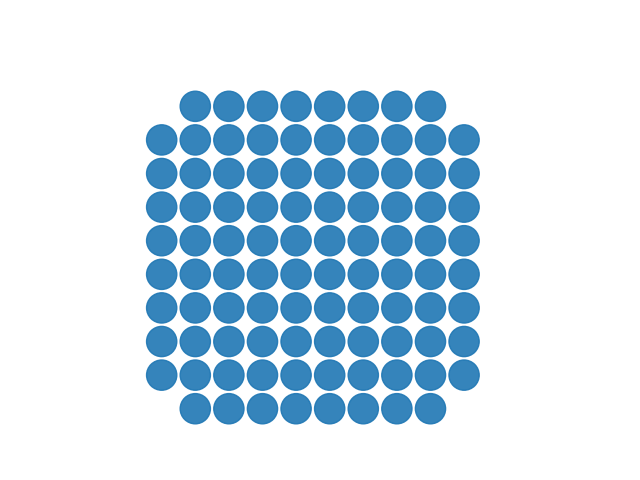

In [6]:
# visualize probe geometry: want to see that it looks correct
w_elec = sw.plot_electrode_geometry(recording_prb)

## Preprocessing
First step is common median filtering (the median across all channels is removed sample wise from the signal at each probe). Then the signal at each channel is low pass filtered and saved off as the lfp. The data is then bandpass filtered for spike processing. The filter values can be set, the defaults are 350Hz for LFP and 350-7500Hz for spikes. Some plots to review the data and save progress. The spike data is saved as a cache. All of the filtering is only done when the data is read. So to save time in future steps, we save the filtered/processed data to file.

In [7]:
# remove bad channels
recording_rmc = st.preprocessing.remove_bad_channels(recording_prb, bad_channel_ids=[34, 50]) 
# verify that all of the properties were trnasfered to the new recording object
recording_rmc.get_shared_channel_property_names()

['gain', 'group', 'location', 'name', 'offset']

In [8]:
# verify bad channels have been removed
print(recording_rmc.get_channel_ids())

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96]


In [ ]:
# lowpass filter for lfp
recording_lp = st.preprocessing.bandpass_filter(recording_prb, freq_min=1, freq_max=350, 
                                                filter_type='butter', order=3)
# downsample
recording_lfp = st.preprocessing.resample(recording_lp, resample_rate=1000)

In [9]:
# common median reference (skip if preCMR)
recording_cmr = st.preprocessing.common_reference(recording_rmc, reference='median')

In [10]:
# bandpass filter for spikes
recording_f = st.preprocessing.bandpass_filter(recording_cmr, freq_min=350, freq_max=7500, 
                                               filter_type='butter', order=3)

<IPython.core.display.Javascript object>


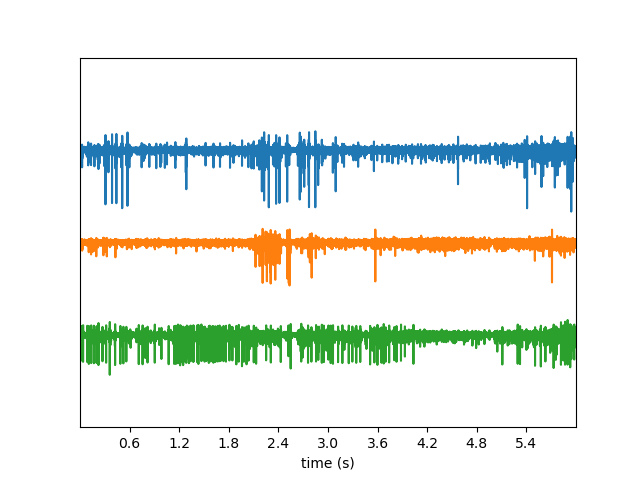

In [11]:
# view the signal on channels. channel_id is the probe and trange is the time sample to view in seconds
sw.plot_timeseries(recording_f, channel_ids=[2, 5, 7], trange=[0, 6])

<IPython.core.display.Javascript object>


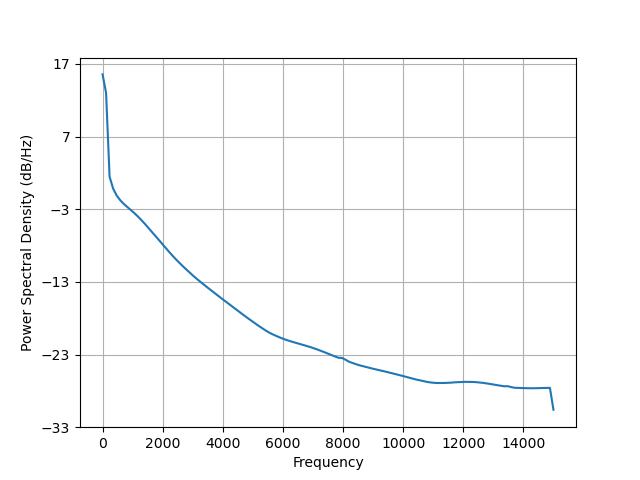

In [12]:
# view the power spectrum of the data. Check that the filtering looks reasonable. You can also look at the
# the raw data: recording_prb, or the lfp: recording_lfp, or the spike data: recording_f
w_sp = sw.plot_spectrum(recording_prb, channels=[2])

In [13]:
# save preprocessed data for spikes and cache recording
recording_cache = se.CacheRecordingExtractor(recording_f, save_path=pth+sess+'processed/filtered_data.dat')
recording_cache.dump_to_dict()
recording_cache.dump_to_pickle(pth+sess+'processed/recording.pkl')
# save preprocessed data for lfp
#se.CacheRecordingExtractor(recording_lfp, save_path=pth+sess+'processed/lfp_data.dat')

## Spike Sorting
First step is to set the parameters for the sorters. Then call each sorter that you want to run. Each run will make its own folder with the sorting results. You could save each sorter, but there is a bug where some of the channel properties are not saved correctly. Which causes problems later. You can also add aditional sorters. For example if you want to add YASS or Klustakwik you can follow the pattern set here. See the documentation to install. Some of the sorters are notoriously difficult to install (I'm looking at you Spyking Circus).

In [14]:
# set the paths for the sorters you want to run
#ss.Kilosort2_5Sorter.set_kilosort2_5_path('/media/paul/storage/MLToolBoxes/Kilosort-2.5/')
ss.IronClustSorter.set_ironclust_path('/media/paul/storage/MLToolBoxes/ironclust/')
ss.WaveClusSorter.set_waveclus_path('/media/paul/storage/MLToolBoxes/wave_clus/')
ss.CombinatoSorter.set_combinato_path('/media/paul/storage/Python/combinato/')

Setting IRONCLUST_PATH environment variable for subprocess calls to: /media/paul/storage/MLToolBoxes/ironclust
Setting WAVECLUS_PATH environment variable for subprocess calls to: /media/paul/storage/MLToolBoxes/wave_clus
Setting COMBINATO_PATH environment variable for subprocess calls to: /media/paul/storage/Python/combinato


In [15]:
# check which sorters are installed
ss.installed_sorters()

['ironclust', 'klusta', 'spykingcircus', 'tridesclous', 'waveclus']

## Spyking Circus
Spyking circus nicely complains when an electrode is too corrupted to sort, so run this first and check to see if there are any problem electrodes. If so, you can go back and exclude those probes from the analysis and all of the sorters will work better. When bad electrodes are found Spyking Circus will tell you in the log which probe it is, then it will crash just before it completes. You can find the bad probes becuase they will be missing a *recording.result.hdf5* file in that probes recording directory (for ex. for the first probe the file would be located at processed/results_sc/0/recording/).

In [16]:
# Start with spyking circus. list the parameters for the sorter
ss.get_params_description('spykingcircus')

{'detect_sign': 'Use -1 (negative), 1 (positive) or 0 (both) depending on the sign of the spikes in the recording',
 'adjacency_radius': 'Radius in um to build channel neighborhood',
 'detect_threshold': 'Threshold for spike detection',
 'template_width_ms': 'Template width in ms. Recommended values: 3 for in vivo - 5 for in vitro',
 'filter': 'Enable or disable filter',
 'merge_spikes': 'Enable or disable automatic mergind',
 'auto_merge': 'Automatic merging threshold',
 'num_workers': 'Number of workers (if None, half of the cpu number is used)',
 'whitening_max_elts': 'Max number of events per electrode for whitening',
 'clustering_max_elts': 'Max number of events per electrode for clustering'}

In [17]:
# see what the default parameters are. These are the only parameters spikeinterface will let you modify.
ss.get_default_params('spykingcircus')

{'detect_sign': -1,
 'adjacency_radius': 100,
 'detect_threshold': 6,
 'template_width_ms': 3,
 'filter': True,
 'merge_spikes': True,
 'auto_merge': 0.75,
 'num_workers': None,
 'whitening_max_elts': 1000,
 'clustering_max_elts': 10000}

In [18]:
# set your own parameter values
params = {'detect_sign': -1,
 'adjacency_radius': 10,
 'detect_threshold': 6,
 'template_width_ms': 3,
 'filter': False,
 'merge_spikes': True,
 'auto_merge': 0.75,
 'num_workers': 15,
 'whitening_max_elts': 1000,
 'clustering_max_elts': 10000}

In [19]:
# run the sorter
sorting_SC = ss.run_spykingcircus(recording_cache, 
                                  output_folder=pth+sess+'processed/results_sc', 
                                  grouping_property='group',
                                  n_jobs=5,
                                  verbose=True, 
                                  **params)
print(f'SpykingCircus found {len(sorting_SC.get_unit_ids())} units')

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/0/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre              #####

##################################################################





File          : /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/0/recording.npy

Steps         : filtering, whitening, clustering, fitting, merging

Number of CPU : 15/24

Parallel HDF5 : False

Shared memory : True

Hostfile      : /home/paul/spyking-circus/circus.hosts



##################################################################





-------------------------  Informations  -------------------------

| Number of recorded channels : 1

| Number of analyzed channels : 1

| File format   

 52%|██████████████████▏                |[00:04<00:04, 427.36it/s]

 53%|██████████████████▋                |[00:04<00:03, 470.71it/s]

 55%|███████████████████▍               |[00:04<00:03, 555.65it/s]

 58%|████████████████████▏              |[00:04<00:02, 624.03it/s]

 59%|████████████████████▋              |[00:04<00:02, 530.34it/s]

 61%|█████████████████████▏             |[00:04<00:03, 478.70it/s]

 62%|█████████████████████▋             |[00:05<00:03, 441.41it/s]

 63%|██████████████████████▏            |[00:05<00:03, 402.64it/s]

 64%|██████████████████████▌            |[00:05<00:03, 343.00it/s]

 65%|██████████████████████▉            |[00:05<00:06, 213.62it/s]

 66%|███████████████████████▏           |[00:06<00:06, 189.49it/s]

 67%|███████████████████████▌           |[00:06<00:05, 219.94it/s]

 68%|███████████████████████▊           |[00:06<00:05, 207.17it/s]

 69%|████████████████████████▎          |[00:06<00:04, 277.39it/s]

 71%|████████████████████████▊          |[00:06<



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 4699.50it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 11.26it/s]

100%|████████████████████████████████████|[00:00<00:00, 11.25it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 13.08it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 24.81it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 19 templates...



  0%|       

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:20<00:20, 20.45s/it]

100%|████████████████████████████████████|[00:20<00:00, 10.23s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.50it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.00it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 63%|██████████████████████             |[00:06<00:05, 249.72it/s]

 64%|██████████████████████▏            |[00:06<00:06, 205.12it/s]

 64%|██████████████████████▍            |[00:06<00:07, 169.41it/s]

 65%|██████████████████████▋            |[00:07<00:09, 142.35it/s]

 65%|██████████████████████▊            |[00:07<00:11, 115.78it/s]

 65%|██████████████████████▉            |[00:07<00:12, 107.22it/s]

 66%|███████████████████████            |[00:07<00:12, 104.34it/s]

 66%|███████████████████████▏           |[00:07<00:12, 105.20it/s]

 66%|███████████████████████▏           |[00:07<00:11, 106.06it/s]

 67%|███████████████████████▎           |[00:08<00:10, 116.11it/s]

 67%|███████████████████████▍           |[00:08<00:10, 114.77it/s]

 67%|████████████████████████▎           |[00:08<00:17, 71.59it/s]

 68%|████████████████████████▍           |[00:08<00:14, 86.02it/s]

 68%|███████████████████████▉           |[00:08<00:11, 100.56it/s]

 69%|████████████████████████▋           |[00:09

100%|████████████████████████████████████|[00:00<00:00,  4.95it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.52it/s]

100%|████████████████████████████████████|[00:00<00:00,  5.05it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Running density-based clustering...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:00,  1.49s/it]

100%|████████████████████████████████████|[00:01<00:00,  1.49s/it]

-------------------------  Informations  -------------------------

| Number of clusters found : 15

| Number of local merges   : 0 (method nd-bhatta, param 2)

------------------------------------------------------------------



Estimating the templates with the median-raw proc

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/4/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre              #####

##################################################################





File          : /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/4/recording.npy

Steps         : filtering, whitening, clustering, fitting, merging

Number of CPU : 15/24

Parallel HDF5 : False

Shared memory : True

Hostfile      : /home/paul/spyking-circus/circus.hosts



##################################################################





-------------------------  Informations  -------------------------

| Number of recorded channels : 1

| Number of analyzed channels : 1

| File format   

 41%|██████████████▎                    |[00:03<00:04, 504.25it/s]

 43%|██████████████▉                    |[00:04<00:04, 510.39it/s]

 44%|███████████████▎                   |[00:04<00:04, 501.24it/s]

 45%|███████████████▊                   |[00:04<00:06, 334.45it/s]

 46%|████████████████▏                  |[00:04<00:06, 299.40it/s]

 48%|████████████████▋                  |[00:04<00:05, 343.87it/s]

 49%|█████████████████▏                 |[00:04<00:04, 390.15it/s]

 51%|█████████████████▋                 |[00:04<00:04, 426.38it/s]

 52%|██████████████████▏                |[00:04<00:03, 454.90it/s]

 53%|██████████████████▋                |[00:05<00:03, 466.11it/s]

 55%|███████████████████▏               |[00:05<00:03, 480.43it/s]

 56%|███████████████████▋               |[00:05<00:04, 389.95it/s]

 57%|████████████████████               |[00:05<00:04, 343.70it/s]

 58%|████████████████████▍              |[00:05<00:04, 328.84it/s]

 59%|████████████████████▊              |[00:05<

100%|████████████████████████████████████|[00:00<00:00,  4.22it/s]

Found 7462 isolated spikes over 7995 requested (1078 rejected)

Computing density estimations...

Searching random spikes to refine the clustering (2/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.45it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.89it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.34it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.68it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Running density-based clustering...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:0

 88%|██████████████████████████████▊    |[00:08<00:01, 338.68it/s]

 89%|███████████████████████████████▏   |[00:08<00:01, 278.58it/s]

 90%|███████████████████████████████▌   |[00:08<00:01, 258.03it/s]

 91%|███████████████████████████████▊   |[00:08<00:01, 233.62it/s]

 92%|████████████████████████████████   |[00:08<00:01, 220.84it/s]

 92%|████████████████████████████████▎  |[00:09<00:02, 102.32it/s]

 93%|█████████████████████████████████▍  |[00:10<00:04, 62.47it/s]

 93%|█████████████████████████████████▌  |[00:10<00:03, 80.05it/s]

 94%|█████████████████████████████████▊  |[00:10<00:02, 89.74it/s]

 94%|█████████████████████████████████  |[00:10<00:02, 102.20it/s]

 95%|█████████████████████████████████▏ |[00:10<00:01, 114.88it/s]

 95%|█████████████████████████████████▎ |[00:10<00:01, 127.50it/s]

 96%|█████████████████████████████████▌ |[00:11<00:01, 133.75it/s]

 96%|██████████████████████████████████▋ |[00:11<00:02, 48.80it/s]

 97%|██████████████████████████████████▊ |[00:12

  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  4.69it/s]

100%|████████████████████████████████████|[00:00<00:00,  8.34it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  8.85it/s]

100%|████████████████████████████████████|[00:00<00:00,  8.84it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 19.38it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 17 templates...



  0%|                                            |[00:00<?, ?it/s]

  1%|▍                                  |[00:00<00:07, 509.72it/s]

  3%|▉                                  |[00:00<00:07, 465.06it/s]

  4%|█▍                                 |[00:00<00:09, 368.97it/s]

  6%|█▉                                 |[00:00<00:08, 441.08it/s]

 

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:21<00:21, 21.92s/it]

100%|████████████████████████████████████|[00:21<00:00, 10.96s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  3.12it/s]

100%|████████████████████████████████████|[00:00<00:00,  6.24it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 70%|████████████████████████▍          |[00:07<00:09, 122.63it/s]

 70%|████████████████████████▌          |[00:07<00:08, 134.86it/s]

 71%|████████████████████████▋          |[00:07<00:07, 144.40it/s]

 71%|████████████████████████▉          |[00:07<00:07, 142.59it/s]

 72%|█████████████████████████          |[00:07<00:07, 143.86it/s]

 72%|█████████████████████████▏         |[00:07<00:06, 158.45it/s]

 73%|█████████████████████████▍         |[00:07<00:06, 162.66it/s]

 73%|█████████████████████████▌         |[00:07<00:05, 172.84it/s]

 74%|██████████████████████████▍         |[00:08<00:13, 73.83it/s]

 74%|██████████████████████████▋         |[00:08<00:12, 77.77it/s]

 75%|██████████████████████████▏        |[00:08<00:08, 106.99it/s]

 75%|██████████████████████████▎        |[00:08<00:07, 131.48it/s]

 76%|██████████████████████████▋        |[00:08<00:05, 163.96it/s]

 77%|██████████████████████████▊        |[00:09<00:06, 133.30it/s]

 78%|███████████████████████████▏       |[00:09<

  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.54it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.07it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Running density-based clustering...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.49s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.49s/it]

-------------------------  Informations  -------------------------

| Number of clusters found : 24

| Number of local merges   : 0 (method nd-bhatta, param 2)

------------------------------------------------------------------



Estimating the templates with the median-raw procedure ...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.03it/s]

100%|████████████████████████████████████|[00:00<00:

 66%|███████████████████████            |[00:09<00:05, 253.31it/s]

 67%|███████████████████████▎           |[00:09<00:04, 253.42it/s]

 67%|███████████████████████▌           |[00:09<00:07, 166.15it/s]

 68%|███████████████████████▊           |[00:10<00:09, 126.37it/s]

 68%|███████████████████████▉           |[00:10<00:08, 139.12it/s]

 69%|████████████████████████▏          |[00:10<00:07, 161.10it/s]

 70%|████████████████████████▍          |[00:10<00:06, 184.46it/s]

 71%|████████████████████████▋          |[00:10<00:05, 204.97it/s]

 71%|████████████████████████▉          |[00:10<00:05, 215.31it/s]

 72%|█████████████████████████▎         |[00:10<00:04, 246.49it/s]

 73%|█████████████████████████▌         |[00:10<00:03, 265.51it/s]

 74%|██████████████████████████         |[00:10<00:03, 319.35it/s]

 75%|██████████████████████████▎        |[00:11<00:03, 245.88it/s]

 76%|███████████████████████████▎        |[00:12<00:12, 72.70it/s]

 77%|███████████████████████████▌        |[00:12

  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.54it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.08it/s]

Found 7462 isolated spikes over 7995 requested (1024 rejected)

Computing density estimations...

Searching random spikes to refine the clustering (2/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.59it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.18it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.64it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.27it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Running density-based cl

 52%|██████████████████▎                |[00:09<00:09, 182.84it/s]

 53%|██████████████████▌                |[00:10<00:10, 162.57it/s]

 55%|███████████████████                |[00:10<00:07, 229.28it/s]

 56%|███████████████████▋               |[00:10<00:05, 305.83it/s]

 58%|████████████████████▏              |[00:10<00:04, 362.53it/s]

 59%|████████████████████▋              |[00:10<00:03, 401.88it/s]

 61%|█████████████████████▏             |[00:10<00:03, 422.83it/s]

 62%|█████████████████████▋             |[00:10<00:03, 444.95it/s]

 63%|██████████████████████▏            |[00:10<00:03, 447.91it/s]

 65%|██████████████████████▌            |[00:11<00:02, 454.41it/s]

 66%|███████████████████████            |[00:11<00:02, 432.65it/s]

 67%|███████████████████████▍           |[00:11<00:02, 429.73it/s]

 68%|███████████████████████▉           |[00:11<00:02, 431.07it/s]

 69%|████████████████████████▎          |[00:11<00:02, 429.81it/s]

 71%|████████████████████████▊          |[00:11<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.42it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.42it/s]

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 36.08it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 3426.72it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|            

-------------------------  Informations  -------------------------

| We kept 13 templates out of 13 after merging

| As meta merging is still experimental, you need

| to use the extension option to see its results

| >> circus-gui-matlab mydata.dat -e merged

| or

| >> spyking-circus mydata.dat -m converting -e merged

------------------------------------------------------------------



RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/11/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre              #####

##################################################################





File          : /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/11/recording.npy

Steps         : filterin

 38%|█████████████▍                     |[00:03<00:04, 522.93it/s]

 40%|██████████████                     |[00:03<00:04, 555.81it/s]

 42%|██████████████▌                    |[00:03<00:03, 574.24it/s]

 44%|███████████████▎                   |[00:03<00:03, 619.44it/s]

 45%|███████████████▊                   |[00:03<00:03, 620.35it/s]

 47%|████████████████▍                  |[00:03<00:03, 610.18it/s]

 49%|█████████████████                  |[00:03<00:03, 592.32it/s]

 51%|█████████████████▋                 |[00:04<00:02, 621.74it/s]

 52%|██████████████████▎                |[00:04<00:02, 625.50it/s]

 54%|██████████████████▉                |[00:04<00:02, 632.50it/s]

 56%|███████████████████▌               |[00:04<00:02, 649.30it/s]

 58%|████████████████████▏              |[00:04<00:02, 656.27it/s]

 59%|████████████████████▊              |[00:04<00:02, 641.29it/s]

 61%|█████████████████████▍             |[00:04<00:02, 637.11it/s]

 63%|██████████████████████             |[00:04<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.81it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.81it/s]

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 49.18it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 4561.51it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|            

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/13/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre              #####

##################################################################





File          : /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/13/recording.npy

Steps         : filtering, whitening, clustering, fitting, merging

Number of CPU : 15/24

Parallel HDF5 : False

Shared memory : True

Hostfile      : /home/paul/spyking-circus/circus.hosts



##################################################################





-------------------------  Informations  -------------------------

| Number of recorded channels : 1

| Number of analyzed channels : 1

| File format 

 53%|██████████████████▌                |[00:04<00:03, 556.03it/s]

 55%|███████████████████▏               |[00:04<00:02, 584.59it/s]

 56%|███████████████████▋               |[00:04<00:02, 580.53it/s]

 58%|████████████████████▍              |[00:04<00:02, 622.17it/s]

 60%|█████████████████████              |[00:04<00:02, 660.89it/s]

 62%|█████████████████████▊             |[00:04<00:02, 692.13it/s]

 64%|██████████████████████▍            |[00:04<00:02, 589.45it/s]

 66%|███████████████████████            |[00:05<00:02, 532.14it/s]

 67%|███████████████████████▌           |[00:05<00:02, 519.08it/s]

 69%|████████████████████████           |[00:05<00:02, 509.07it/s]

 70%|████████████████████████▌          |[00:05<00:02, 377.50it/s]

 71%|█████████████████████████          |[00:05<00:03, 322.92it/s]

 72%|█████████████████████████▎         |[00:05<00:03, 303.97it/s]

 73%|█████████████████████████▋         |[00:05<00:03, 293.79it/s]

 74%|█████████████████████████▉         |[00:06<



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.76it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.76it/s]

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 35.58it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 3597.17it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|          

 98%|██████████████████████████████████▏|[00:12<00:00, 405.56it/s]

100%|██████████████████████████████████▉|[00:13<00:00, 290.60it/s]

100%|███████████████████████████████████|[00:13<00:00, 284.39it/s]

Gathering spikes from 15 nodes...



  0%|                                            |[00:00<?, ?it/s]

100%|███████████████████████████████████|[00:00<00:00, 233.86it/s]

-------------------------  Informations  -------------------------

| Number of spikes fitted : 471188

------------------------------------------------------------------



-------------------------  Informations  -------------------------

| Automatic merging with a threshold of 0.75

------------------------------------------------------------------



Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:03<00:00,  3.07s/it]

100%|████████████████████████████████████|[00:03<00:00,  3.07s/it]

Deleting 0 noisy templates

Updating 

  4%|█▎                                 |[00:00<00:21, 164.97it/s]

  4%|█▍                                 |[00:00<00:20, 177.12it/s]

  5%|█▋                                 |[00:01<00:19, 185.37it/s]

  5%|█▊                                 |[00:01<00:19, 179.37it/s]

  6%|██                                 |[00:01<00:18, 188.76it/s]

  6%|██▏                                |[00:01<00:18, 188.66it/s]

  7%|██▍                                |[00:01<00:18, 193.89it/s]

  7%|██▌                                |[00:01<00:17, 200.84it/s]

  8%|██▊                                |[00:01<00:18, 183.24it/s]

  9%|██▉                                |[00:01<00:18, 181.21it/s]

  9%|███▏                               |[00:01<00:18, 183.61it/s]

 10%|███▎                               |[00:02<00:17, 193.22it/s]

 10%|███▌                               |[00:02<00:17, 189.97it/s]

 11%|███▊                               |[00:02<00:17, 194.31it/s]

 11%|███▉                               |[00:02<

 72%|█████████████████████████▊          |[00:20<00:12, 88.79it/s]

 72%|█████████████████████████▎         |[00:20<00:08, 122.52it/s]

 73%|█████████████████████████▌         |[00:20<00:06, 146.16it/s]

 74%|█████████████████████████▊         |[00:20<00:05, 190.45it/s]

 75%|██████████████████████████▏        |[00:20<00:04, 229.55it/s]

 76%|██████████████████████████▌        |[00:20<00:03, 256.77it/s]

 77%|██████████████████████████▊        |[00:21<00:03, 286.32it/s]

 78%|███████████████████████████▏       |[00:21<00:02, 304.63it/s]

 79%|███████████████████████████▌       |[00:21<00:02, 330.62it/s]

 80%|███████████████████████████▉       |[00:21<00:02, 342.06it/s]

 81%|████████████████████████████▎      |[00:21<00:02, 335.06it/s]

 82%|████████████████████████████▌      |[00:21<00:01, 350.19it/s]

 83%|████████████████████████████▉      |[00:21<00:01, 360.84it/s]

 84%|█████████████████████████████▍     |[00:21<00:01, 386.23it/s]

 85%|█████████████████████████████▊     |[00:21<

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 35.56it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 3663.15it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  6.05it/s]

100%|████████████████████████████████████|[00:00<00:00,  6.05it/s]



  0%|          

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:20<00:20, 20.15s/it]

100%|████████████████████████████████████|[00:20<00:00, 10.07s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.97it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.95it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 67%|███████████████████████▍           |[00:06<00:04, 264.08it/s]

 68%|███████████████████████▋           |[00:06<00:04, 259.28it/s]

 68%|███████████████████████▉           |[00:06<00:04, 259.44it/s]

 69%|████████████████████████▏          |[00:06<00:04, 254.68it/s]

 70%|████████████████████████▍          |[00:07<00:04, 260.32it/s]

 71%|████████████████████████▋          |[00:07<00:04, 269.00it/s]

 71%|████████████████████████▉          |[00:07<00:04, 258.69it/s]

 72%|█████████████████████████▎         |[00:07<00:03, 266.66it/s]

 73%|█████████████████████████▌         |[00:07<00:03, 282.71it/s]

 74%|█████████████████████████▉         |[00:07<00:03, 307.62it/s]

 75%|██████████████████████████▎        |[00:07<00:02, 353.11it/s]

 77%|██████████████████████████▊        |[00:07<00:02, 382.95it/s]

 78%|███████████████████████████▎       |[00:07<00:01, 424.78it/s]

 79%|███████████████████████████▋       |[00:08<00:01, 444.66it/s]

 80%|████████████████████████████▏      |[00:08<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.75it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.75it/s]

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 37.76it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 4253.86it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|            

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:22<00:22, 22.34s/it]

100%|████████████████████████████████████|[00:22<00:00, 11.17s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  3.17it/s]

100%|████████████████████████████████████|[00:00<00:00,  6.34it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 34%|███████████▊                       |[00:07<00:15, 157.60it/s]

 34%|████████████                       |[00:07<00:14, 174.89it/s]

 35%|████████████▏                      |[00:07<00:14, 174.58it/s]

 36%|████████████▍                      |[00:07<00:12, 190.20it/s]

 36%|████████████▋                      |[00:07<00:12, 190.71it/s]

 37%|████████████▊                      |[00:07<00:11, 201.86it/s]

 37%|█████████████                      |[00:07<00:10, 221.56it/s]

 38%|█████████████▎                     |[00:07<00:10, 219.93it/s]

 39%|█████████████▌                     |[00:07<00:10, 221.98it/s]

 39%|█████████████▊                     |[00:07<00:09, 232.55it/s]

 40%|██████████████                     |[00:08<00:09, 240.95it/s]

 41%|██████████████▎                    |[00:08<00:09, 236.48it/s]

 41%|██████████████▍                    |[00:08<00:09, 228.34it/s]

 42%|██████████████▋                    |[00:08<00:09, 223.27it/s]

 43%|██████████████▉                    |[00:08<

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:51<00:51, 51.66s/it]

100%|████████████████████████████████████|[00:51<00:00, 25.83s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.87it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.74it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 94%|████████████████████████████████▋  |[00:07<00:00, 364.28it/s]

 95%|█████████████████████████████████  |[00:07<00:01, 146.16it/s]

 96%|█████████████████████████████████▍ |[00:08<00:00, 169.34it/s]

 98%|██████████████████████████████████▏|[00:08<00:00, 254.17it/s]

100%|███████████████████████████████████|[00:08<00:00, 458.67it/s]

Gathering spikes from 15 nodes...



  0%|                                            |[00:00<?, ?it/s]

100%|███████████████████████████████████|[00:00<00:00, 328.01it/s]

-------------------------  Informations  -------------------------

| Number of spikes fitted : 462734

------------------------------------------------------------------



-------------------------  Informations  -------------------------

| Automatic merging with a threshold of 0.75

------------------------------------------------------------------



Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████

  8%|██▉                                |[00:00<00:05, 635.17it/s]

 10%|███▌                               |[00:00<00:05, 651.30it/s]

 12%|████▎                              |[00:00<00:04, 672.93it/s]

 14%|████▉                              |[00:00<00:04, 685.41it/s]

 16%|█████▌                             |[00:00<00:04, 648.45it/s]

 18%|██████▎                            |[00:01<00:04, 695.95it/s]

 20%|██████▉                            |[00:01<00:04, 685.28it/s]

 22%|███████▋                           |[00:01<00:04, 681.53it/s]

 24%|████████▎                          |[00:01<00:04, 703.65it/s]

 26%|████████▉                          |[00:01<00:04, 663.82it/s]

 27%|█████████▌                         |[00:01<00:04, 561.85it/s]

 29%|██████████▏                        |[00:01<00:05, 491.21it/s]

 30%|██████████▋                        |[00:01<00:06, 434.73it/s]

 32%|███████████                        |[00:02<00:06, 424.93it/s]

 33%|███████████▌                       |[00:02<

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:38<00:38, 38.25s/it]

100%|████████████████████████████████████|[00:38<00:00, 19.12s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.44it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.88it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 46%|███████████████▉                   |[00:06<00:05, 345.59it/s]

 47%|████████████████▍                  |[00:06<00:05, 381.53it/s]

 48%|████████████████▊                  |[00:06<00:05, 372.79it/s]

 49%|█████████████████▎                 |[00:06<00:04, 416.99it/s]

 51%|█████████████████▋                 |[00:07<00:04, 427.48it/s]

 52%|██████████████████▏                |[00:07<00:04, 439.29it/s]

 53%|██████████████████▌                |[00:07<00:04, 421.13it/s]

 54%|███████████████████                |[00:07<00:03, 438.90it/s]

 56%|███████████████████▍               |[00:07<00:03, 446.71it/s]

 57%|███████████████████▉               |[00:07<00:03, 431.38it/s]

 58%|████████████████████▎              |[00:07<00:03, 422.50it/s]

 59%|████████████████████▊              |[00:07<00:03, 440.47it/s]

 61%|█████████████████████▏             |[00:07<00:03, 453.28it/s]

 62%|█████████████████████▋             |[00:08<00:03, 426.33it/s]

 63%|██████████████████████             |[00:08<

100%|████████████████████████████████████|[00:00<00:00,  3.02it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of good isolated spikes for the clustering (1/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.46it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.92it/s]

Found 7462 isolated spikes over 7995 requested (996 rejected)

Computing density estimations...

Searching random spikes to refine the clustering (2/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.55it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.11it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|█████████████

-------------------------  Informations  -------------------------

| Number of spikes fitted : 570216

------------------------------------------------------------------



-------------------------  Informations  -------------------------

| Automatic merging with a threshold of 0.75

------------------------------------------------------------------



Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:04<00:00,  4.24s/it]

100%|████████████████████████████████████|[00:04<00:00,  4.24s/it]

Deleting 0 noisy templates

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:03<00:00,  3.27s/it]

100%|████████████████████████████████████|[00:03<00:00,  3.27s/it]

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:03<00:00,  3.27s/it]

 10%|███▌                               |[00:01<00:13, 255.04it/s]

 11%|███▊                               |[00:01<00:12, 266.63it/s]

 12%|████▏                              |[00:01<00:12, 275.26it/s]

 13%|████▍                              |[00:01<00:12, 261.44it/s]

 14%|████▋                              |[00:01<00:11, 285.24it/s]

 15%|█████▎                             |[00:01<00:08, 360.38it/s]

 17%|█████▊                             |[00:01<00:07, 436.63it/s]

 19%|██████▌                            |[00:02<00:05, 530.03it/s]

 20%|███████                            |[00:02<00:06, 481.20it/s]

 21%|███████▌                           |[00:02<00:06, 448.47it/s]

 23%|███████▉                           |[00:02<00:06, 462.03it/s]

 24%|████████▍                          |[00:02<00:07, 406.00it/s]

 25%|████████▊                          |[00:02<00:06, 404.41it/s]

 27%|█████████▎                         |[00:02<00:06, 447.31it/s]

 28%|█████████▊                         |[00:02<

Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.46it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.92it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of good isolated spikes for the clustering (1/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.71it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.42it/s]

Found 7462 isolated spikes over 7995 requested (998 rejected)

Computing density estimations...

Searching random spikes to refine the clustering (2/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.81it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.62it/s]

Found 7462 spikes over 

 75%|██████████████████████████▎        |[00:08<00:03, 259.11it/s]

 76%|██████████████████████████▋        |[00:08<00:03, 289.80it/s]

 77%|██████████████████████████▉        |[00:09<00:06, 128.54it/s]

 78%|███████████████████████████▎       |[00:09<00:04, 166.26it/s]

 79%|███████████████████████████▋       |[00:09<00:03, 198.11it/s]

 80%|████████████████████████████       |[00:09<00:03, 234.22it/s]

 81%|████████████████████████████▍      |[00:09<00:02, 281.43it/s]

 82%|████████████████████████████▊      |[00:09<00:02, 243.27it/s]

 84%|█████████████████████████████▎     |[00:10<00:02, 290.45it/s]

 85%|█████████████████████████████▌     |[00:10<00:05, 106.77it/s]

 86%|██████████████████████████████     |[00:11<00:03, 145.34it/s]

 87%|██████████████████████████████▍    |[00:11<00:02, 180.53it/s]

 88%|██████████████████████████████▉    |[00:11<00:01, 233.10it/s]

 90%|███████████████████████████████▍   |[00:11<00:01, 280.50it/s]

 91%|███████████████████████████████▊   |[00:11<



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 3512.82it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 17.35it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 10.93it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 31.15it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 13 templates...



  0%|                                            |[00:00<?, ?it/s]

  1%|▌      

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:16<00:16, 16.46s/it]

100%|████████████████████████████████████|[00:16<00:00,  8.23s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.70it/s]

100%|████████████████████████████████████|[00:00<00:00,  5.40it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 53%|██████████████████▋                |[00:06<00:07, 239.69it/s]

 54%|██████████████████▊                |[00:06<00:07, 240.31it/s]

 55%|███████████████████▏               |[00:06<00:06, 256.09it/s]

 55%|███████████████████▍               |[00:06<00:06, 261.75it/s]

 56%|███████████████████▋               |[00:07<00:10, 153.10it/s]

 57%|███████████████████▊               |[00:07<00:09, 167.17it/s]

 57%|████████████████████               |[00:07<00:08, 182.04it/s]

 58%|████████████████████▎              |[00:07<00:07, 208.86it/s]

 59%|████████████████████▋              |[00:08<00:12, 127.79it/s]

 60%|████████████████████▉              |[00:08<00:09, 157.47it/s]

 61%|█████████████████████▏             |[00:08<00:10, 147.08it/s]

 61%|█████████████████████▍             |[00:08<00:08, 164.74it/s]

 62%|█████████████████████▊             |[00:08<00:06, 204.67it/s]

 63%|██████████████████████▋             |[00:09<00:24, 56.80it/s]

 64%|██████████████████████▉             |[00:09

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.27it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.54it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Running density-based clustering...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:00,  1.41s/it]

100%|████████████████████████████████████|[00:01<00:00,  1.41s/it]

-------------------------  Informations  -------------------------

| Number of clusters found : 18

| Number of local merges   : 0 (method nd-bhatta, param 2)

------------------------------------------------------------------



Estimating the templates with the median-raw procedure ...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/29/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre              #####

##################################################################





File          : /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/29/recording.npy

Steps         : filtering, whitening, clustering, fitting, merging

Number of CPU : 15/24

Parallel HDF5 : False

Shared memory : True

Hostfile      : /home/paul/spyking-circus/circus.hosts



##################################################################





-------------------------  Informations  -------------------------

| Number of recorded channels : 1

| Number of analyzed channels : 1

| File format 

 75%|██████████████████████████▏        |[00:03<00:01, 709.31it/s]

 77%|██████████████████████████▊        |[00:04<00:03, 278.67it/s]

 79%|███████████████████████████▌       |[00:04<00:02, 345.20it/s]

 81%|████████████████████████████▏      |[00:04<00:01, 412.36it/s]

 83%|████████████████████████████▉      |[00:04<00:01, 485.07it/s]

 85%|█████████████████████████████▋     |[00:06<00:03, 155.82it/s]

 87%|██████████████████████████████▍    |[00:06<00:02, 209.78it/s]

 88%|██████████████████████████████▉    |[00:06<00:02, 212.98it/s]

 90%|███████████████████████████████▍   |[00:06<00:01, 236.08it/s]

 93%|████████████████████████████████▋  |[00:06<00:00, 367.94it/s]

 96%|█████████████████████████████████▍ |[00:06<00:00, 430.38it/s]

 97%|██████████████████████████████████ |[00:06<00:00, 423.99it/s]

 99%|██████████████████████████████████▋|[00:07<00:00, 438.26it/s]

100%|███████████████████████████████████|[00:07<00:00, 529.23it/s]

Gathering spikes from 15 nodes...



  0%|      

100%|████████████████████████████████████|[00:00<00:00, 13.35it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 27.04it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 17 templates...



  0%|                                            |[00:00<?, ?it/s]

  2%|▌                                  |[00:00<00:06, 585.50it/s]

  3%|█                                  |[00:00<00:06, 569.36it/s]

  5%|█▋                                 |[00:00<00:05, 604.52it/s]

  6%|██▎                                |[00:00<00:06, 571.30it/s]

  8%|██▊                                |[00:00<00:05, 583.63it/s]

 10%|███▍                               |[00:00<00:05, 610.16it/s]

 12%|████                               |[00:00<00:05, 616.44it/s]

 13%|████▋                              |[00:00<00:05, 628.02it/s]

 15%|█████▎                             |[00:00<00:05, 605.07it/s]

 17

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:17<00:17, 17.20s/it]

100%|████████████████████████████████████|[00:17<00:00,  8.60s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.02it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.03it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.52it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.52it/s]

-------------------------  Informations  -------------------------

| We kept 11 templates out of 11 after merging

| As meta merging is still experimental, you need

| to use the extension option to see its results

| >> circus-gui-matlab mydata.dat -e merged

| or

| >> spyking-circus mydata.dat -m converting -e merged

------------------------------------------------------------------



RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/32/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre 

 24%|████████▍                          |[00:02<00:08, 320.48it/s]

 25%|████████▊                          |[00:02<00:08, 314.16it/s]

 26%|█████████                          |[00:02<00:09, 297.30it/s]

 27%|█████████▎                         |[00:03<00:09, 291.77it/s]

 27%|█████████▌                         |[00:03<00:09, 273.05it/s]

 28%|█████████▉                         |[00:03<00:09, 274.28it/s]

 29%|██████████▏                        |[00:03<00:10, 263.10it/s]

 30%|██████████▍                        |[00:03<00:10, 261.64it/s]

 30%|██████████▋                        |[00:03<00:10, 246.40it/s]

 31%|██████████▉                        |[00:03<00:10, 247.32it/s]

 32%|███████████                        |[00:03<00:10, 247.03it/s]

 33%|███████████▍                       |[00:03<00:09, 256.14it/s]

 34%|███████████▊                       |[00:04<00:07, 311.65it/s]

 35%|████████████▏                      |[00:04<00:07, 341.29it/s]

 36%|████████████▌                      |[00:04<

100%|████████████████████████████████████|[00:00<00:00,  4.55it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of good isolated spikes for the clustering (1/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.29it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.57it/s]

Found 7462 isolated spikes over 7995 requested (1069 rejected)

Computing density estimations...

Searching random spikes to refine the clustering (2/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.30it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.59it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|████████████

Gathering spikes from 15 nodes...



  0%|                                            |[00:00<?, ?it/s]

100%|███████████████████████████████████|[00:00<00:00, 267.01it/s]

-------------------------  Informations  -------------------------

| Number of spikes fitted : 572752

------------------------------------------------------------------



-------------------------  Informations  -------------------------

| Automatic merging with a threshold of 0.75

------------------------------------------------------------------



Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.25s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.25s/it]

Deleting 0 noisy templates

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.24s/it]

100%|████████████████████████████████████|[00:02<00:0

 10%|███▌                               |[00:00<00:06, 558.31it/s]

 12%|████▏                              |[00:00<00:05, 594.94it/s]

 14%|████▊                              |[00:00<00:05, 609.69it/s]

 15%|█████▍                             |[00:01<00:05, 574.87it/s]

 17%|██████                             |[00:01<00:05, 597.89it/s]

 19%|██████▋                            |[00:01<00:04, 620.58it/s]

 21%|███████▎                           |[00:01<00:05, 580.72it/s]

 22%|███████▊                           |[00:01<00:06, 486.41it/s]

 24%|████████▎                          |[00:01<00:06, 432.72it/s]

 25%|████████▋                          |[00:01<00:06, 442.30it/s]

 26%|█████████▏                         |[00:01<00:06, 444.68it/s]

 28%|█████████▋                         |[00:02<00:05, 454.37it/s]

 29%|██████████                         |[00:02<00:06, 443.83it/s]

 30%|██████████▌                        |[00:02<00:06, 400.24it/s]

 31%|██████████▉                        |[00:02<

  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:02<00:02,  2.15s/it]

100%|████████████████████████████████████|[00:02<00:00,  1.13s/it]

100%|████████████████████████████████████|[00:02<00:00,  1.28s/it]

Deleting 0 noisy templates

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:02<00:02,  2.15s/it]

100%|████████████████████████████████████|[00:02<00:00,  1.13s/it]

100%|████████████████████████████████████|[00:02<00:00,  1.28s/it]

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:02<00:02,  2.15s/it]

100%|████████████████████████████████████|[00:02<00:00,  1.13s/it]

100%|████████████████████████████████████|[00:02<00:00,  1.28s/it]

-------------------------  Informations  -------------------------

| We kept 20 templates out of 20 after m

 20%|██████▊                            |[00:01<00:04, 665.95it/s]

 22%|███████▌                           |[00:01<00:04, 702.25it/s]

 24%|████████▏                          |[00:01<00:04, 705.91it/s]

 26%|████████▉                          |[00:01<00:03, 715.45it/s]

 27%|█████████▌                         |[00:01<00:03, 682.10it/s]

 29%|██████████▎                        |[00:02<00:04, 585.11it/s]

 31%|██████████▊                        |[00:02<00:04, 565.99it/s]

 33%|███████████▍                       |[00:02<00:04, 556.52it/s]

 34%|███████████▉                       |[00:02<00:04, 569.05it/s]

 36%|████████████▍                      |[00:02<00:05, 472.83it/s]

 37%|████████████▉                      |[00:02<00:05, 453.73it/s]

 38%|█████████████▍                     |[00:02<00:05, 431.06it/s]

 40%|█████████████▊                     |[00:03<00:05, 415.43it/s]

 41%|██████████████▎                    |[00:03<00:05, 426.87it/s]

 42%|██████████████▋                    |[00:03<

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.53it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.06it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Running density-based clustering...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.47s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.47s/it]

-------------------------  Informations  -------------------------

| Number of clusters found : 8

| Number of local merges   : 0 (method nd-bhatta, param 2)

------------------------------------------------------------------



Estimating the templates with the median-raw procedure ...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.6

-------------------------  Informations  -------------------------

| Automatic merging with a threshold of 0.75

------------------------------------------------------------------



Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.64s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.64s/it]

Deleting 0 noisy templates

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.74s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.75s/it]

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.75s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.75s/it]

-------------------------  Informations  -------------------------

| We kept 8 templates out of 8 after

 20%|██████▉                            |[00:01<00:05, 575.75it/s]

 21%|███████▍                           |[00:01<00:04, 591.63it/s]

 23%|████████▏                          |[00:01<00:04, 626.05it/s]

 25%|████████▊                          |[00:01<00:04, 641.15it/s]

 27%|█████████▍                         |[00:01<00:05, 544.53it/s]

 28%|█████████▉                         |[00:01<00:05, 518.45it/s]

 30%|██████████▍                        |[00:02<00:06, 432.38it/s]

 31%|██████████▉                        |[00:02<00:06, 429.20it/s]

 32%|███████████▎                       |[00:02<00:06, 412.70it/s]

 34%|███████████▊                       |[00:02<00:05, 451.07it/s]

 36%|████████████▍                      |[00:02<00:04, 494.53it/s]

 38%|█████████████▏                     |[00:02<00:04, 569.32it/s]

 40%|█████████████▊                     |[00:02<00:03, 618.95it/s]

 42%|██████████████▌                    |[00:02<00:03, 655.02it/s]

 43%|███████████████▏                   |[00:02<

100%|████████████████████████████████████|[00:00<00:00,  4.09it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of good isolated spikes for the clustering (1/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.35it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.71it/s]

Found 7462 isolated spikes over 7995 requested (1012 rejected)

Computing density estimations...

Searching random spikes to refine the clustering (2/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.44it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.87it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|████████████

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:00,  1.48s/it]

100%|████████████████████████████████████|[00:01<00:00,  1.48s/it]

Deleting 0 noisy templates

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:00,  1.49s/it]

100%|████████████████████████████████████|[00:01<00:00,  1.49s/it]

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:00,  1.49s/it]

100%|████████████████████████████████████|[00:01<00:00,  1.49s/it]

-------------------------  Informations  -------------------------

| We kept 15 templates out of 15 after merging

| As meta merging is still experimental, you need

| to use the extension option to see its results

| >> circus-gui-matlab mydata.dat -e merged

| or

| >> spyking-circus mydata.dat -m converting

 53%|██████████████████▋                |[00:02<00:02, 818.25it/s]

 56%|███████████████████▋               |[00:02<00:01, 897.50it/s]

 59%|████████████████████▌              |[00:02<00:01, 847.57it/s]

 61%|█████████████████████▍             |[00:02<00:01, 788.16it/s]

 63%|██████████████████████▏            |[00:02<00:01, 750.84it/s]

 65%|██████████████████████▊            |[00:02<00:02, 565.46it/s]

 67%|███████████████████████▍           |[00:03<00:02, 527.55it/s]

 69%|███████████████████████▉           |[00:03<00:02, 538.14it/s]

 70%|████████████████████████▌          |[00:03<00:02, 490.39it/s]

 71%|█████████████████████████          |[00:03<00:02, 453.46it/s]

 73%|█████████████████████████▍         |[00:03<00:02, 451.07it/s]

 74%|██████████████████████████         |[00:04<00:05, 177.48it/s]

 76%|██████████████████████████▋        |[00:04<00:03, 236.71it/s]

 79%|███████████████████████████▌       |[00:04<00:02, 329.97it/s]

 81%|████████████████████████████▏      |[00:04<



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 4725.98it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  6.74it/s]

100%|████████████████████████████████████|[00:00<00:00, 10.29it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 13.51it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 27.23it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 17 templates...



  0%|       

 97%|██████████████████████████████████ |[00:15<00:00, 371.23it/s]

100%|██████████████████████████████████▊|[00:15<00:00, 503.51it/s]

100%|███████████████████████████████████|[00:15<00:00, 248.64it/s]

Gathering spikes from 15 nodes...



  0%|                                            |[00:00<?, ?it/s]

100%|███████████████████████████████████|[00:00<00:00, 181.48it/s]

-------------------------  Informations  -------------------------

| Number of spikes fitted : 578641

------------------------------------------------------------------



-------------------------  Informations  -------------------------

| Automatic merging with a threshold of 0.75

------------------------------------------------------------------



Updating the data...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:03<00:03,  3.32s/it]

100%|████████████████████████████████████|[00:03<00:00,  1.47s/it]

100%|████████████████████████████████

  3%|▉                                  |[00:00<00:12, 295.02it/s]

  4%|█▏                                 |[00:00<00:13, 276.21it/s]

  4%|█▌                                 |[00:00<00:12, 281.78it/s]

  5%|█▊                                 |[00:00<00:12, 288.99it/s]

  6%|██                                 |[00:00<00:11, 297.37it/s]

  7%|██▍                                |[00:00<00:10, 331.77it/s]

  8%|██▊                                |[00:00<00:10, 330.49it/s]

  9%|███▏                               |[00:01<00:09, 342.97it/s]

 10%|███▌                               |[00:01<00:09, 358.70it/s]

 11%|███▉                               |[00:01<00:09, 370.70it/s]

 12%|████▎                              |[00:01<00:08, 393.17it/s]

 14%|████▊                              |[00:01<00:07, 427.01it/s]

 15%|█████▎                             |[00:01<00:07, 442.13it/s]

 16%|█████▋                             |[00:01<00:07, 442.87it/s]

 17%|██████                             |[00:01<

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.70it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.41it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of good isolated spikes for the clustering (1/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.54it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.08it/s]

Found 7462 isolated spikes over 7995 requested (982 rejected)

Computing density estimations...

Searching random spikes to refine the clustering (2/3)...



  0%|

 75%|██████████████████████████▎        |[00:08<00:05, 157.49it/s]

 76%|██████████████████████████▋        |[00:08<00:05, 167.32it/s]

 77%|██████████████████████████▉        |[00:08<00:05, 163.39it/s]

 79%|███████████████████████████▌       |[00:08<00:03, 226.27it/s]

 80%|████████████████████████████       |[00:09<00:02, 286.46it/s]

 82%|████████████████████████████▋      |[00:09<00:01, 353.64it/s]

 84%|█████████████████████████████▎     |[00:09<00:01, 431.58it/s]

 86%|█████████████████████████████▉     |[00:09<00:01, 484.35it/s]

 87%|██████████████████████████████▌    |[00:09<00:00, 535.79it/s]

 89%|███████████████████████████████▏   |[00:09<00:00, 563.36it/s]

 91%|███████████████████████████████▊   |[00:09<00:00, 595.37it/s]

 93%|████████████████████████████████▍  |[00:09<00:00, 402.05it/s]

 94%|████████████████████████████████▉  |[00:10<00:00, 315.17it/s]

 96%|█████████████████████████████████▌ |[00:10<00:00, 375.68it/s]

 98%|██████████████████████████████████▏|[00:10<

100%|████████████████████████████████████|[00:00<00:00, 16.83it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 37.31it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 19 templates...



  0%|                                            |[00:00<?, ?it/s]

  1%|▌                                  |[00:00<00:06, 532.64it/s]

  3%|█                                  |[00:00<00:12, 290.34it/s]

  4%|█▍                                 |[00:00<00:10, 352.16it/s]

  6%|██                                 |[00:00<00:08, 432.89it/s]

  8%|██▋                                |[00:00<00:06, 521.47it/s]

 10%|███▍                               |[00:00<00:05, 586.02it/s]

 11%|████                               |[00:00<00:05, 601.79it/s]

 13%|████▋                              |[00:00<00:05, 640.34it/s]

 15%|█████▎                             |[00:01<00:05, 620.58it/s]

 17

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[01:00<01:00, 60.97s/it]

100%|████████████████████████████████████|[01:00<00:00, 30.48s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.32it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.64it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 77%|███████████████████████████        |[00:07<00:01, 435.63it/s]

 79%|███████████████████████████▌       |[00:07<00:01, 453.15it/s]

 80%|███████████████████████████▉       |[00:07<00:01, 441.46it/s]

 81%|████████████████████████████▍      |[00:07<00:01, 434.94it/s]

 83%|████████████████████████████▉      |[00:07<00:01, 449.46it/s]

 84%|█████████████████████████████▎     |[00:08<00:01, 457.02it/s]

 85%|█████████████████████████████▊     |[00:08<00:01, 465.64it/s]

 86%|██████████████████████████████▏    |[00:08<00:01, 451.76it/s]

 88%|██████████████████████████████▋    |[00:08<00:01, 448.91it/s]

 89%|███████████████████████████████    |[00:08<00:00, 441.73it/s]

 90%|███████████████████████████████▌   |[00:08<00:00, 457.11it/s]

 91%|███████████████████████████████▉   |[00:08<00:00, 349.63it/s]

 92%|████████████████████████████████▎  |[00:08<00:00, 296.05it/s]

 94%|████████████████████████████████▊  |[00:09<00:00, 339.45it/s]

 95%|█████████████████████████████████▎ |[00:09<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.83it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.83it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  8.88it/s]

100%|████████████████████████████████████|[00:00<00:00,  8.87it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 20.32it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 15 templates...



  0%|                                            |[00:00<?, ?it/s]

  2%|▌                                  |[00:00<00:06, 607.62it/s]

  3%|█▏                                 |[00:00<00:05, 636.67it/s]

  5%|█▊                                 |[00:00<00:05, 651.36it/s]

  7%|██▍                                |[00:00<00:05, 684.93it/s]

 

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/46/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre              #####

##################################################################





File          : /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/46/recording.npy

Steps         : filtering, whitening, clustering, fitting, merging

Number of CPU : 15/24

Parallel HDF5 : False

Shared memory : True

Hostfile      : /home/paul/spyking-circus/circus.hosts



##################################################################





-------------------------  Informations  -------------------------

| Number of recorded channels : 1

| Number of analyzed channels : 1

| File format 

 52%|██████████████████▏                |[00:04<00:03, 509.29it/s]

 53%|██████████████████▌                |[00:04<00:03, 497.65it/s]

 55%|███████████████████▏               |[00:04<00:03, 509.32it/s]

 56%|███████████████████▌               |[00:04<00:03, 508.83it/s]

 58%|████████████████████▏              |[00:04<00:03, 519.05it/s]

 59%|████████████████████▋              |[00:05<00:02, 533.43it/s]

 61%|█████████████████████▎             |[00:05<00:02, 562.78it/s]

 62%|█████████████████████▊             |[00:05<00:02, 557.55it/s]

 64%|██████████████████████▎            |[00:05<00:03, 398.14it/s]

 65%|██████████████████████▋            |[00:05<00:04, 272.81it/s]

 66%|███████████████████████            |[00:06<00:05, 228.59it/s]

 67%|███████████████████████▍           |[00:06<00:05, 227.42it/s]

 68%|███████████████████████▋           |[00:06<00:05, 222.46it/s]

 69%|████████████████████████           |[00:06<00:04, 280.88it/s]

 71%|████████████████████████▋          |[00:06<

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 50.85it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 4969.55it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  8.37it/s]

100%|████████████████████████████████████|[00:00<00:00,  7.66it/s]

100%|████████████

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/48/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre              #####

##################################################################





File          : /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/48/recording.npy

Steps         : filtering, whitening, clustering, fitting, merging

Number of CPU : 15/24

Parallel HDF5 : False

Shared memory : True

Hostfile      : /home/paul/spyking-circus/circus.hosts



##################################################################





-------------------------  Informations  -------------------------

| Number of recorded channels : 1

| Number of analyzed channels : 1

| File format 

 37%|█████████████                      |[00:04<00:04, 523.09it/s]

 39%|█████████████▋                     |[00:04<00:04, 555.29it/s]

 41%|██████████████▏                    |[00:04<00:04, 553.07it/s]

 42%|██████████████▊                    |[00:04<00:03, 555.41it/s]

 44%|███████████████▎                   |[00:05<00:03, 563.47it/s]

 45%|███████████████▊                   |[00:05<00:03, 554.65it/s]

 47%|████████████████▎                  |[00:05<00:03, 551.62it/s]

 48%|████████████████▉                  |[00:05<00:03, 535.19it/s]

 50%|█████████████████▍                 |[00:05<00:03, 533.30it/s]

 51%|█████████████████▉                 |[00:05<00:03, 550.17it/s]

 53%|██████████████████▍                |[00:05<00:03, 544.87it/s]

 54%|██████████████████▉                |[00:05<00:03, 528.62it/s]

 56%|███████████████████▍               |[00:05<00:03, 536.96it/s]

 57%|████████████████████               |[00:06<00:02, 554.11it/s]

 59%|████████████████████▌              |[00:06<

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.60it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.21it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Running density-based clustering...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.43s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.43s/it]

-------------------------  Informations  -------------------------

| Number of clusters found : 10

| Number of local merges   : 0 (method nd-bhatta, param 2)

------------------------------------------------------------------



Estimating the templates with the median-raw procedure ...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:22<00:22, 22.63s/it]

100%|████████████████████████████████████|[00:22<00:00, 11.32s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.58it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.16it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 71%|████████████████████████▉          |[00:08<00:08, 121.23it/s]

 72%|█████████████████████████▎         |[00:08<00:05, 177.09it/s]

 73%|█████████████████████████▋         |[00:08<00:04, 220.23it/s]

 75%|██████████████████████████▎        |[00:08<00:02, 339.86it/s]

 77%|███████████████████████████        |[00:08<00:01, 441.09it/s]

 79%|███████████████████████████▊       |[00:09<00:01, 525.58it/s]

 81%|████████████████████████████▌      |[00:09<00:01, 599.18it/s]

 84%|█████████████████████████████▎     |[00:09<00:00, 668.51it/s]

 86%|██████████████████████████████     |[00:09<00:00, 714.17it/s]

 88%|██████████████████████████████▊    |[00:09<00:00, 746.23it/s]

 90%|███████████████████████████████▌   |[00:10<00:01, 289.53it/s]

 92%|████████████████████████████████   |[00:10<00:00, 329.40it/s]

 93%|████████████████████████████████▋  |[00:10<00:00, 322.02it/s]

 95%|█████████████████████████████████  |[00:10<00:00, 318.03it/s]

 96%|█████████████████████████████████▌ |[00:10<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  9.92it/s]

100%|████████████████████████████████████|[00:00<00:00,  9.91it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 48.27it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 11 templates...



  0%|                                            |[00:00<?, ?it/s]

  1%|▎                                  |[00:00<00:11, 331.43it/s]

  2%|▋                                  |[00:00<00:24, 153.05it/s]

  3%|▉                                  |[00:00<00:20, 181.69it/s]

  3%|█▏                                 |[00:00<00:19, 188.38it/s]

  4%|█▎                                 |[00:00<00:17, 206.97it/s]

  5%|█▋                                 |[00:00<00:14, 248.84it/s]

  6%|█▉                                 |[00:00<00:14, 242.59it/s]

  6

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/52/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre              #####

##################################################################





File          : /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/52/recording.npy

Steps         : filtering, whitening, clustering, fitting, merging

Number of CPU : 15/24

Parallel HDF5 : False

Shared memory : True

Hostfile      : /home/paul/spyking-circus/circus.hosts



##################################################################





-------------------------  Informations  -------------------------

| Number of recorded channels : 1

| Number of analyzed channels : 1

| File format 

 46%|████████████████▏                  |[00:04<00:04, 494.76it/s]

 48%|████████████████▋                  |[00:04<00:04, 470.67it/s]

 49%|█████████████████▏                 |[00:04<00:04, 448.16it/s]

 50%|█████████████████▌                 |[00:04<00:04, 452.75it/s]

 52%|██████████████████                 |[00:04<00:03, 473.16it/s]

 53%|██████████████████▌                |[00:04<00:03, 468.98it/s]

 55%|███████████████████▏               |[00:04<00:03, 528.69it/s]

 57%|███████████████████▉               |[00:05<00:02, 617.31it/s]

 59%|████████████████████▊              |[00:05<00:02, 685.90it/s]

 61%|█████████████████████▍             |[00:06<00:06, 224.02it/s]

 63%|██████████████████████▏            |[00:06<00:04, 294.88it/s]

 65%|██████████████████████▋            |[00:06<00:03, 340.15it/s]

 67%|███████████████████████▎           |[00:06<00:03, 347.09it/s]

 68%|███████████████████████▊           |[00:06<00:03, 381.89it/s]

 70%|████████████████████████▍          |[00:06<



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 2941.31it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 39.83it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  7.51it/s]

100%|████████████████████████████████████|[00:00<00:00,  7.50it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 45.59it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 13 templates...



  0%|       

100%|████████████████████████████████████|[00:00<00:00,  2.65it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of good isolated spikes for the clustering (1/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.54it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.07it/s]

Found 7462 isolated spikes over 7995 requested (1047 rejected)

Computing density estimations...

Searching random spikes to refine the clustering (2/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.65it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.30it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|████████████

 68%|████████████████████████▎           |[00:10<00:18, 66.54it/s]

 68%|████████████████████████▍           |[00:11<00:18, 65.37it/s]

 68%|████████████████████████▋           |[00:11<00:13, 88.99it/s]

 69%|████████████████████████           |[00:11<00:11, 105.84it/s]

 69%|████████████████████████▎          |[00:11<00:09, 118.26it/s]

 70%|████████████████████████▍          |[00:11<00:08, 132.95it/s]

 70%|████████████████████████▋          |[00:11<00:07, 152.69it/s]

 71%|████████████████████████▊          |[00:11<00:06, 159.14it/s]

 71%|████████████████████████▉          |[00:11<00:06, 163.26it/s]

 72%|█████████████████████████▏         |[00:11<00:06, 169.35it/s]

 72%|█████████████████████████▎         |[00:11<00:05, 178.96it/s]

 73%|█████████████████████████▌         |[00:12<00:05, 191.38it/s]

 74%|█████████████████████████▊         |[00:12<00:04, 209.02it/s]

 75%|██████████████████████████         |[00:12<00:04, 237.76it/s]

 75%|██████████████████████████▍        |[00:12<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:00,  1.95s/it]

100%|████████████████████████████████████|[00:01<00:00,  1.95s/it]

-------------------------  Informations  -------------------------

| Number of clusters found : 11

| Number of local merges   : 0 (method nd-bhatta, param 2)

------------------------------------------------------------------



Estimating the templates with the median-raw procedure ...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.81it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.81it/s]

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/56/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre              #####

##################################################################





File          : /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/56/recording.npy

Steps         : filtering, whitening, clustering, fitting, merging

Number of CPU : 15/24

Parallel HDF5 : False

Shared memory : True

Hostfile      : /home/paul/spyking-circus/circus.hosts



##################################################################





-------------------------  Informations  -------------------------

| Number of recorded channels : 1

| Number of analyzed channels : 1

| File format 

 30%|██████████▎                        |[00:03<00:09, 284.65it/s]

 31%|██████████▋                        |[00:04<00:11, 230.47it/s]

 31%|███████████                        |[00:04<00:11, 229.46it/s]

 32%|███████████▎                       |[00:04<00:12, 199.55it/s]

 33%|███████████▍                       |[00:04<00:13, 193.75it/s]

 34%|███████████▊                       |[00:04<00:12, 206.83it/s]

 34%|███████████▉                       |[00:04<00:11, 209.18it/s]

 35%|████████████▏                      |[00:04<00:11, 207.16it/s]

 35%|████████████▍                      |[00:05<00:11, 215.02it/s]

 36%|████████████▋                      |[00:05<00:10, 233.45it/s]

 38%|█████████████▎                     |[00:05<00:06, 344.99it/s]

 40%|█████████████▉                     |[00:05<00:05, 426.81it/s]

 41%|██████████████▍                    |[00:05<00:04, 475.11it/s]

 43%|███████████████                    |[00:05<00:04, 523.25it/s]

 45%|███████████████▌                   |[00:05<

  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.36it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.72it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.26it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.52it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Running density-based clustering...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:00,  1.50s/it]

100%|████████████████████████████████████|[00:01<00:00,  1.50s/it]

-------------------------  Informations  -------------------------

| Number of clusters found : 17

| Number of local merges   : 0 (method nd-b

 96%|██████████████████████████████████▌ |[00:14<00:01, 93.33it/s]

 97%|█████████████████████████████████▉ |[00:14<00:01, 113.55it/s]

 98%|██████████████████████████████████▏|[00:14<00:00, 136.19it/s]

100%|███████████████████████████████████|[00:14<00:00, 261.96it/s]

Gathering spikes from 15 nodes...



  0%|                                            |[00:00<?, ?it/s]

100%|███████████████████████████████████|[00:00<00:00, 195.13it/s]

-------------------------  Informations  -------------------------

| Number of spikes fitted : 579752

------------------------------------------------------------------



-------------------------  Informations  -------------------------

| Automatic merging with a threshold of 0.75

------------------------------------------------------------------



Updating the data...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:03<00:03,  3.77s/it]

100%|████████████████████████████████

  1%|▏                                  |[00:00<00:17, 216.52it/s]

  2%|▌                                  |[00:00<00:11, 329.23it/s]

  3%|█                                  |[00:00<00:08, 424.75it/s]

  4%|█▌                                 |[00:00<00:07, 449.19it/s]

  6%|█▉                                 |[00:00<00:08, 441.77it/s]

  7%|██▍                                |[00:00<00:07, 453.81it/s]

  8%|██▊                                |[00:00<00:07, 461.61it/s]

 10%|███▍                               |[00:00<00:06, 508.13it/s]

 11%|████                               |[00:00<00:06, 546.58it/s]

 13%|████▌                              |[00:01<00:05, 551.05it/s]

 14%|█████                              |[00:01<00:05, 552.78it/s]

 16%|█████▌                             |[00:01<00:08, 365.71it/s]

 17%|██████                             |[00:01<00:09, 334.15it/s]

 18%|██████▍                            |[00:01<00:09, 329.50it/s]

 19%|██████▋                            |[00:01<

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/59/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre              #####

##################################################################





File          : /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/59/recording.npy

Steps         : filtering, whitening, clustering, fitting, merging

Number of CPU : 15/24

Parallel HDF5 : False

Shared memory : True

Hostfile      : /home/paul/spyking-circus/circus.hosts



##################################################################





-------------------------  Informations  -------------------------

| Number of recorded channels : 1

| Number of analyzed channels : 1

| File format 

 55%|███████████████████▎               |[00:03<00:04, 394.56it/s]

 57%|███████████████████▊               |[00:04<00:04, 376.03it/s]

 58%|████████████████████▏              |[00:04<00:04, 349.24it/s]

 59%|████████████████████▌              |[00:04<00:04, 330.98it/s]

 60%|████████████████████▊              |[00:04<00:04, 332.82it/s]

 61%|█████████████████████▏             |[00:04<00:04, 345.88it/s]

 62%|█████████████████████▌             |[00:04<00:04, 350.77it/s]

 63%|█████████████████████▉             |[00:04<00:03, 366.14it/s]

 64%|██████████████████████▎            |[00:04<00:04, 331.12it/s]

 65%|██████████████████████▋            |[00:05<00:04, 311.27it/s]

 66%|██████████████████████▉            |[00:05<00:04, 311.74it/s]

 66%|███████████████████████▏           |[00:05<00:04, 281.45it/s]

 67%|███████████████████████▌           |[00:05<00:04, 266.69it/s]

 68%|███████████████████████▊           |[00:05<00:04, 273.37it/s]

 69%|████████████████████████           |[00:05<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.41s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.41s/it]

-------------------------  Informations  -------------------------

| Number of clusters found : 13

| Number of local merges   : 0 (method nd-bhatta, param 2)

------------------------------------------------------------------



Estimating the templates with the median-raw procedure ...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.74it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.74it/s]

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.26s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.26s/it]

-------------------------  Informations  -------------------------

| We kept 13 templates out of 13 after merging

| As meta merging is still experimental, you need

| to use the extension option to see its results

| >> circus-gui-matlab mydata.dat -e merged

| or

| >> spyking-circus mydata.dat -m converting -e merged

------------------------------------------------------------------



RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/61/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre 

 57%|███████████████████▉               |[00:03<00:02, 706.87it/s]

 59%|████████████████████▌              |[00:03<00:02, 573.71it/s]

 61%|█████████████████████▏             |[00:03<00:02, 535.85it/s]

 62%|█████████████████████▊             |[00:03<00:02, 510.15it/s]

 64%|██████████████████████▎            |[00:03<00:02, 477.90it/s]

 65%|██████████████████████▊            |[00:03<00:03, 421.65it/s]

 66%|███████████████████████▏           |[00:04<00:03, 373.19it/s]

 67%|███████████████████████▌           |[00:04<00:03, 335.76it/s]

 68%|███████████████████████▉           |[00:04<00:03, 330.75it/s]

 69%|████████████████████████▏          |[00:04<00:03, 323.58it/s]

 70%|████████████████████████▌          |[00:04<00:03, 310.67it/s]

 71%|████████████████████████▊          |[00:04<00:03, 307.14it/s]

 72%|█████████████████████████          |[00:04<00:05, 206.53it/s]

 72%|█████████████████████████▎         |[00:05<00:05, 178.39it/s]

 73%|█████████████████████████▌         |[00:05<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.20it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.20it/s]

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 54.59it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 3081.78it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|            

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:32<00:32, 32.33s/it]

100%|████████████████████████████████████|[00:32<00:00, 16.16s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.34it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.67it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 73%|█████████████████████████▌         |[00:06<00:03, 335.58it/s]

 75%|██████████████████████████         |[00:06<00:02, 386.22it/s]

 76%|██████████████████████████▋        |[00:06<00:02, 434.11it/s]

 78%|███████████████████████████▏       |[00:06<00:01, 465.64it/s]

 79%|███████████████████████████▋       |[00:06<00:01, 500.74it/s]

 81%|████████████████████████████▏      |[00:06<00:01, 506.28it/s]

 82%|████████████████████████████▋      |[00:07<00:01, 512.77it/s]

 84%|█████████████████████████████▏     |[00:07<00:01, 537.19it/s]

 85%|█████████████████████████████▊     |[00:07<00:00, 560.42it/s]

 87%|██████████████████████████████▎    |[00:07<00:00, 551.92it/s]

 88%|██████████████████████████████▉    |[00:07<00:00, 566.76it/s]

 90%|███████████████████████████████▍   |[00:07<00:00, 401.64it/s]

 91%|████████████████████████████████   |[00:07<00:00, 446.28it/s]

 93%|████████████████████████████████▋  |[00:07<00:00, 510.39it/s]

 95%|█████████████████████████████████▏ |[00:08<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 11.96it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 33.64it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 9 templates...



  0%|                                            |[00:00<?, ?it/s]

  1%|▍                                  |[00:00<00:07, 475.92it/s]

  3%|▉                                  |[00:00<00:09, 368.87it/s]

  5%|█▊                                 |[00:00<00:05, 596.83it/s]

  8%|██▋                                |[00:00<00:04, 739.49it/s]

 11%|███▊                               |[00:00<00:03, 893.91it/s]

 14%|████▉                              |[00:00<00:03, 970.71it/s]

 17%|█████▊                             |[00:00<00:03, 935.79it/s]

 19%|██████▊                            |[00:00<00:03, 968.67it/s]

 22%

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.44s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.44s/it]

-------------------------  Informations  -------------------------

| Number of clusters found : 16

| Number of local merges   : 0 (method nd-bhatta, param 2)

------------------------------------------------------------------



Estimating the templates with the median-raw procedure ...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.37it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.37it/s]

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00

Deleting 0 noisy templates

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:02<00:02,  2.52s/it]

100%|████████████████████████████████████|[00:02<00:00,  1.26s/it]

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:02<00:02,  2.52s/it]

100%|████████████████████████████████████|[00:02<00:00,  1.26s/it]

-------------------------  Informations  -------------------------

| We kept 16 templates out of 16 after merging

| As meta merging is still experimental, you need

| to use the extension option to see its results

| >> circus-gui-matlab mydata.dat -e merged

| or

| >> spyking-circus mydata.dat -m converting -e merged

------------------------------------------------------------------



RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/66/run_spykingcircus.s

 58%|███████████████████▋              |[00:02<00:01, 1069.93it/s]

 61%|████████████████████▌             |[00:02<00:01, 1053.44it/s]

 63%|██████████████████████▏            |[00:02<00:01, 853.28it/s]

 66%|███████████████████████            |[00:02<00:01, 741.41it/s]

 68%|███████████████████████▊           |[00:02<00:01, 750.29it/s]

 70%|████████████████████████▌          |[00:02<00:01, 744.03it/s]

 72%|█████████████████████████▎         |[00:03<00:01, 554.19it/s]

 74%|█████████████████████████▉         |[00:03<00:01, 517.17it/s]

 76%|██████████████████████████▍        |[00:03<00:01, 519.72it/s]

 77%|███████████████████████████        |[00:03<00:01, 543.19it/s]

 79%|███████████████████████████▌       |[00:03<00:01, 559.43it/s]

 80%|████████████████████████████▏      |[00:03<00:01, 516.90it/s]

 82%|████████████████████████████▋      |[00:03<00:01, 523.96it/s]

 84%|█████████████████████████████▎     |[00:04<00:01, 561.97it/s]

 85%|█████████████████████████████▊     |[00:04<



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 4185.93it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 15.53it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 10.83it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 50.03it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 9 templates...



  0%|                                            |[00:00<?, ?it/s]

  3%|▉       

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:27<00:27, 27.13s/it]

100%|████████████████████████████████████|[00:27<00:00, 13.56s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.48it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.96it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 84%|█████████████████████████████▍     |[00:07<00:02, 292.67it/s]

 86%|██████████████████████████████     |[00:07<00:01, 350.87it/s]

 87%|██████████████████████████████▌    |[00:08<00:01, 364.15it/s]

 89%|███████████████████████████████    |[00:08<00:02, 205.95it/s]

 90%|███████████████████████████████▍   |[00:08<00:01, 198.65it/s]

 91%|███████████████████████████████▊   |[00:08<00:01, 215.08it/s]

 92%|████████████████████████████████▏  |[00:09<00:01, 246.11it/s]

 93%|████████████████████████████████▋  |[00:09<00:00, 297.60it/s]

 94%|█████████████████████████████████  |[00:09<00:00, 318.26it/s]

 96%|█████████████████████████████████▍ |[00:09<00:00, 341.25it/s]

 97%|█████████████████████████████████▊ |[00:09<00:00, 171.83it/s]

 98%|██████████████████████████████████▏|[00:09<00:00, 197.23it/s]

100%|███████████████████████████████████|[00:10<00:00, 374.86it/s]

Gathering spikes from 15 nodes...



  0%|                                            |[00:00<?, ?it/s]

100%|██████

Here comes the SpyKING CIRCUS using 15 CPUs and 7 templates...



  0%|                                            |[00:00<?, ?it/s]

  1%|▍                                  |[00:00<00:08, 439.20it/s]

  2%|▊                                  |[00:00<00:08, 432.63it/s]

  4%|█▏                                 |[00:00<00:11, 311.93it/s]

  5%|█▋                                 |[00:00<00:09, 387.20it/s]

  6%|██▏                                |[00:00<00:08, 412.32it/s]

  8%|██▋                                |[00:00<00:07, 441.74it/s]

  9%|███                                |[00:00<00:07, 441.39it/s]

 10%|███▌                               |[00:00<00:07, 435.43it/s]

 11%|████                               |[00:01<00:07, 456.98it/s]

 13%|████▌                              |[00:01<00:06, 480.46it/s]

 14%|████▉                              |[00:01<00:06, 466.74it/s]

 15%|█████▍                             |[00:01<00:06, 461.36it/s]

 17%|█████▉                             |[00:01<00

  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.68it/s]

100%|████████████████████████████████████|[00:00<00:00,  5.36it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.25it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.51it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Running density-based clustering...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:00,  1.48s/it]

100%|████████████████████████████████████|[00:01<00:00,  1.48s/it]

-------------------------  Informations  -------------------------

| Number of clusters found : 11

| Number of local merges   : 0 (method nd-b

-------------------------  Informations  -------------------------

| Automatic merging with a threshold of 0.75

------------------------------------------------------------------



Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.15it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.15it/s]

Deleting 0 noisy templates

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.15it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.15it/s]

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.15it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.15it/s]

-------------------------  Informations  -------------------------

| We kept 11 templates out of 11 aft

 46%|███████████████▌                  |[00:01<00:01, 1276.45it/s]

 49%|████████████████▊                 |[00:01<00:01, 1297.28it/s]

 53%|██████████████████                |[00:01<00:01, 1324.95it/s]

 57%|███████████████████▎              |[00:01<00:01, 1316.86it/s]

 60%|████████████████████▍             |[00:01<00:01, 1271.05it/s]

 64%|█████████████████████▋            |[00:02<00:01, 1185.78it/s]

 67%|███████████████████████▍           |[00:02<00:01, 993.28it/s]

 70%|████████████████████████▍          |[00:02<00:01, 874.30it/s]

 72%|█████████████████████████▎         |[00:02<00:01, 860.08it/s]

 75%|██████████████████████████▏        |[00:02<00:01, 898.96it/s]

 78%|███████████████████████████▎       |[00:02<00:00, 983.74it/s]

 81%|███████████████████████████▋      |[00:02<00:00, 1028.41it/s]

 85%|████████████████████████████▊     |[00:02<00:00, 1088.13it/s]

 88%|█████████████████████████████▊    |[00:03<00:00, 1124.39it/s]

 91%|███████████████████████████████▊   |[00:03<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 12.03it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 32.51it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 11 templates...



  0%|                                            |[00:00<?, ?it/s]

  1%|▍                                  |[00:00<00:07, 475.66it/s]

  3%|▉                                  |[00:00<00:07, 465.64it/s]

  5%|█▋                                 |[00:00<00:05, 664.38it/s]

  7%|██▌                                |[00:00<00:04, 758.78it/s]

  9%|███▎                               |[00:00<00:04, 762.68it/s]

 12%|████                               |[00:00<00:04, 786.87it/s]

 14%|████▊                              |[00:00<00:05, 583.55it/s]

 16%|█████▍                             |[00:01<00:06, 486.35it/s]

 17

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.92it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.83it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of good isolated spikes for the clustering (1/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.71it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.41it/s]

Found 7462 isolated spikes over 7995 requested (1022 rejected)

Computing density estimations...

Searching random spikes to refine the clustering (2/3)...



  0%

 70%|████████████████████████▎          |[00:07<00:04, 269.93it/s]

 70%|████████████████████████▋          |[00:07<00:03, 282.84it/s]

 71%|████████████████████████▉          |[00:07<00:03, 276.67it/s]

 72%|█████████████████████████▏         |[00:07<00:03, 278.14it/s]

 73%|█████████████████████████▌         |[00:07<00:03, 300.14it/s]

 74%|█████████████████████████▉         |[00:07<00:02, 327.51it/s]

 75%|██████████████████████████▏        |[00:07<00:02, 335.72it/s]

 76%|██████████████████████████▌        |[00:08<00:02, 320.79it/s]

 77%|██████████████████████████▊        |[00:08<00:02, 291.05it/s]

 78%|███████████████████████████▏       |[00:08<00:02, 317.10it/s]

 79%|███████████████████████████▋       |[00:08<00:02, 368.53it/s]

 80%|████████████████████████████       |[00:08<00:01, 385.18it/s]

 82%|████████████████████████████▌      |[00:08<00:01, 421.68it/s]

 83%|█████████████████████████████      |[00:08<00:01, 460.53it/s]

 85%|█████████████████████████████▋     |[00:08<



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 3548.48it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 57.17it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 11.01it/s]

Pre-computing the overlaps of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 31.52it/s]

Here comes the SpyKING CIRCUS using 15 CPUs and 12 templates...



  0%|                                            |[00:00<?, ?it/s]

  1%|▎      

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[01:02<01:02, 62.76s/it]

100%|████████████████████████████████████|[01:02<00:00, 31.38s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.40it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.79it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 95%|█████████████████████████████████▍ |[00:07<00:00, 252.29it/s]

 98%|██████████████████████████████████▏|[00:07<00:00, 319.63it/s]

100%|███████████████████████████████████|[00:07<00:00, 502.46it/s]

Gathering spikes from 15 nodes...



  0%|                                            |[00:00<?, ?it/s]

100%|███████████████████████████████████|[00:00<00:00, 296.26it/s]

-------------------------  Informations  -------------------------

| Number of spikes fitted : 511054

------------------------------------------------------------------



-------------------------  Informations  -------------------------

| Automatic merging with a threshold of 0.75

------------------------------------------------------------------



Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:00,  1.51s/it]

100%|████████████████████████████████████|[00:01<00:00,  1.51s/it]

Deleting 0 noisy templates

Updating 

 16%|█████▍                             |[00:00<00:04, 663.25it/s]

 17%|██████                             |[00:00<00:04, 676.50it/s]

 19%|██████▊                            |[00:01<00:04, 688.07it/s]

 21%|███████▍                           |[00:01<00:04, 671.39it/s]

 23%|████████                           |[00:01<00:04, 649.41it/s]

 26%|█████████                          |[00:01<00:03, 789.00it/s]

 29%|██████████                         |[00:01<00:03, 844.15it/s]

 31%|██████████▉                        |[00:01<00:02, 876.51it/s]

 34%|███████████▊                       |[00:01<00:03, 782.67it/s]

 36%|████████████▋                      |[00:01<00:02, 841.05it/s]

 39%|█████████████▊                     |[00:01<00:02, 931.74it/s]

 42%|██████████████▋                    |[00:02<00:03, 661.28it/s]

 44%|███████████████▍                   |[00:02<00:03, 601.47it/s]

 46%|████████████████                   |[00:02<00:03, 531.72it/s]

 47%|████████████████▌                  |[00:02<

  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.16it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.32it/s]

Found 7462 isolated spikes over 7995 requested (999 rejected)

Computing density estimations...

Searching random spikes to refine the clustering (2/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.17it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.35it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.09it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.18it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Running density-based clu

 79%|███████████████████████████▌       |[00:08<00:02, 387.80it/s]

 80%|███████████████████████████▉       |[00:09<00:03, 216.19it/s]

 81%|████████████████████████████▍      |[00:09<00:02, 268.86it/s]

 83%|████████████████████████████▉      |[00:09<00:01, 325.71it/s]

 84%|█████████████████████████████▍     |[00:10<00:05, 111.77it/s]

 85%|█████████████████████████████▋     |[00:10<00:04, 122.80it/s]

 86%|█████████████████████████████▉     |[00:10<00:04, 115.68it/s]

 86%|██████████████████████████████▏    |[00:10<00:04, 123.42it/s]

 87%|███████████████████████████████▏    |[00:12<00:08, 56.07it/s]

 87%|███████████████████████████████▎    |[00:12<00:07, 66.02it/s]

 88%|███████████████████████████████▌    |[00:12<00:05, 79.60it/s]

 88%|███████████████████████████████▊    |[00:12<00:04, 98.68it/s]

 89%|███████████████████████████████▏   |[00:12<00:03, 119.22it/s]

 90%|███████████████████████████████▎   |[00:12<00:02, 134.26it/s]

 90%|███████████████████████████████▌   |[00:12<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.04it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.04it/s]

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 55.00it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 4021.38it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|            

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/79/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre              #####

##################################################################





File          : /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/79/recording.npy

Steps         : filtering, whitening, clustering, fitting, merging

Number of CPU : 15/24

Parallel HDF5 : False

Shared memory : True

Hostfile      : /home/paul/spyking-circus/circus.hosts



##################################################################





-------------------------  Informations  -------------------------

| Number of recorded channels : 1

| Number of analyzed channels : 1

| File format 

 54%|██████████████████▉                |[00:03<00:02, 749.11it/s]

 56%|███████████████████▋               |[00:03<00:02, 748.88it/s]

 58%|████████████████████▎              |[00:04<00:02, 728.53it/s]

 60%|█████████████████████              |[00:04<00:02, 721.83it/s]

 62%|█████████████████████▊             |[00:04<00:01, 730.19it/s]

 64%|██████████████████████▍            |[00:04<00:02, 598.20it/s]

 66%|███████████████████████            |[00:04<00:02, 476.11it/s]

 67%|███████████████████████▌           |[00:04<00:02, 426.01it/s]

 69%|████████████████████████           |[00:05<00:03, 367.53it/s]

 70%|████████████████████████▍          |[00:05<00:04, 268.99it/s]

 71%|████████████████████████▋          |[00:05<00:04, 236.34it/s]

 71%|████████████████████████▉          |[00:05<00:05, 207.88it/s]

 72%|█████████████████████████▏         |[00:05<00:05, 193.18it/s]

 73%|█████████████████████████▍         |[00:06<00:05, 189.94it/s]

 73%|█████████████████████████▌         |[00:06<

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.69it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.37it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Running density-based clustering...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:00,  1.95s/it]

100%|████████████████████████████████████|[00:01<00:00,  1.95s/it]

-------------------------  Informations  -------------------------

| Number of clusters found : 20

| Number of local merges   : 0 (method nd-bhatta, param 2)

------------------------------------------------------------------



Estimating the templates with the median-raw procedure ...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.

 50%|██████████████████                  |[00:03<00:03,  3.13s/it]

100%|████████████████████████████████████|[00:03<00:00,  1.78s/it]

100%|████████████████████████████████████|[00:03<00:00,  1.98s/it]

Deleting 0 noisy templates

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:03<00:03,  3.13s/it]

100%|████████████████████████████████████|[00:03<00:00,  1.78s/it]

100%|████████████████████████████████████|[00:03<00:00,  1.98s/it]

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:03<00:03,  3.13s/it]

100%|████████████████████████████████████|[00:03<00:00,  1.78s/it]

100%|████████████████████████████████████|[00:03<00:00,  1.98s/it]

-------------------------  Informations  -------------------------

| We kept 20 templates out of 20 after merging

| As meta merging is still experimental, you need

| to use 

 25%|████████▊                          |[00:01<00:04, 645.85it/s]

 27%|█████████▍                         |[00:02<00:04, 600.38it/s]

 28%|█████████▉                         |[00:02<00:04, 579.36it/s]

 30%|██████████▌                        |[00:02<00:05, 506.27it/s]

 31%|███████████                        |[00:02<00:05, 481.08it/s]

 33%|███████████▍                       |[00:02<00:05, 455.06it/s]

 34%|████████████                       |[00:02<00:05, 485.92it/s]

 36%|████████████▌                      |[00:02<00:04, 510.57it/s]

 38%|█████████████▏                     |[00:02<00:04, 561.33it/s]

 40%|█████████████▊                     |[00:02<00:03, 591.61it/s]

 41%|██████████████▍                    |[00:03<00:03, 604.95it/s]

 43%|███████████████                    |[00:03<00:03, 625.52it/s]

 45%|███████████████▋                   |[00:03<00:03, 628.27it/s]

 46%|████████████████▎                  |[00:03<00:03, 623.01it/s]

 48%|████████████████▊                  |[00:03<

Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.27it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.55it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of good isolated spikes for the clustering (1/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.51it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.02it/s]

Found 7462 isolated spikes over 7995 requested (1049 rejected)

Computing density estimations...

Searching random spikes to refine the clustering (2/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.57it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.14it/s]

Found 7462 spikes over

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:00,  1.84s/it]

100%|████████████████████████████████████|[00:01<00:00,  1.84s/it]

-------------------------  Informations  -------------------------

| We kept 14 templates out of 14 after merging

| As meta merging is still experimental, you need

| to use the extension option to see its results

| >> circus-gui-matlab mydata.dat -e merged

| or

| >> spyking-circus mydata.dat -m converting -e merged

------------------------------------------------------------------



RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/83/run_spykingcircus.sh


##################################################################

#####             Welcome to the SpyKING CIRCUS              #####

#####                        (1.1.0)                         #####

#####             Written by P.Yger and O.Marre 

 18%|██████▎                            |[00:02<00:10, 298.69it/s]

 19%|██████▌                            |[00:02<00:10, 300.09it/s]

 20%|██████▉                            |[00:02<00:10, 294.72it/s]

 21%|███████▏                           |[00:02<00:09, 305.91it/s]

 21%|███████▌                           |[00:03<00:09, 297.05it/s]

 22%|███████▊                           |[00:03<00:09, 293.32it/s]

 24%|████████▎                          |[00:03<00:07, 387.93it/s]

 26%|████████▉                          |[00:03<00:06, 463.53it/s]

 27%|█████████▌                         |[00:03<00:05, 493.43it/s]

 29%|██████████                         |[00:03<00:05, 501.42it/s]

 30%|██████████▍                        |[00:03<00:05, 473.75it/s]

 31%|██████████▉                        |[00:03<00:05, 453.26it/s]

 32%|███████████▎                       |[00:03<00:05, 449.86it/s]

 34%|███████████▊                       |[00:03<00:05, 471.16it/s]

 36%|████████████▍                      |[00:04<

Searching random spikes to refine the clustering (2/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.56it/s]

100%|████████████████████████████████████|[00:00<00:00,  3.13it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Searching random spikes to refine the clustering (3/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.37it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.75it/s]

Found 7462 spikes over 7995 requested

Refining density estimations...

Running density-based clustering...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:01<00:00,  1.44s/it]

100%|████████████████████████████████████|[00:01<00:00,  1.44s/it]

-------------------------  Informations  -------------------------

| Number of clu

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.06s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.06s/it]

Deleting 0 noisy templates

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.07s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.07s/it]

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.07s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.07s/it]

-------------------------  Informations  -------------------------

| We kept 10 templates out of 10 after merging

| As meta merging is still experimental, you need

| to use the extension option to see its results

| >> circus-gui-matlab mydata.dat -e merged

| or

| >> spyking-circus mydata.dat -m converting

 33%|███████████▌                       |[00:02<00:04, 531.74it/s]

 35%|████████████▏                      |[00:02<00:04, 547.28it/s]

 37%|████████████▉                      |[00:02<00:03, 602.68it/s]

 39%|█████████████▌                     |[00:02<00:03, 643.92it/s]

 41%|██████████████▏                    |[00:02<00:03, 662.52it/s]

 42%|██████████████▊                    |[00:02<00:03, 638.98it/s]

 45%|███████████████▌                   |[00:02<00:03, 673.74it/s]

 46%|████████████████▏                  |[00:02<00:03, 658.97it/s]

 48%|████████████████▊                  |[00:02<00:02, 652.37it/s]

 50%|█████████████████▌                 |[00:03<00:02, 677.49it/s]

 52%|██████████████████▏                |[00:03<00:02, 692.28it/s]

 54%|██████████████████▊                |[00:03<00:02, 686.51it/s]

 56%|███████████████████▌               |[00:03<00:02, 698.79it/s]

 58%|████████████████████▏              |[00:03<00:02, 679.74it/s]

 60%|████████████████████▊              |[00:03<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.04s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.04s/it]

-------------------------  Informations  -------------------------

| Number of clusters found : 19

| Number of local merges   : 0 (method nd-bhatta, param 2)

------------------------------------------------------------------



Estimating the templates with the median-raw procedure ...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.37it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.37it/s]

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:43<00:43, 43.91s/it]

100%|████████████████████████████████████|[00:43<00:00, 21.96s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.48it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.97it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 96%|█████████████████████████████████▊ |[00:09<00:00, 376.92it/s]

 98%|██████████████████████████████████▎|[00:09<00:00, 440.05it/s]

100%|███████████████████████████████████|[00:09<00:00, 394.66it/s]

Gathering spikes from 15 nodes...



  0%|                                            |[00:00<?, ?it/s]

100%|███████████████████████████████████|[00:00<00:00, 340.73it/s]

-------------------------  Informations  -------------------------

| Number of spikes fitted : 446457

------------------------------------------------------------------



-------------------------  Informations  -------------------------

| Automatic merging with a threshold of 0.75

------------------------------------------------------------------



Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:02<00:00,  2.50s/it]

100%|████████████████████████████████████|[00:02<00:00,  2.50s/it]

Deleting 0 noisy templates

Updating 

 16%|█████▌                             |[00:00<00:03, 821.84it/s]

 19%|██████▋                            |[00:00<00:03, 916.58it/s]

 21%|███████▍                           |[00:00<00:03, 919.13it/s]

 24%|████████▍                          |[00:01<00:03, 927.74it/s]

 26%|█████████▎                         |[00:01<00:02, 929.16it/s]

 29%|██████████▏                        |[00:01<00:02, 928.90it/s]

 32%|███████████                        |[00:01<00:02, 941.13it/s]

 34%|███████████▉                       |[00:01<00:02, 936.87it/s]

 37%|████████████▊                      |[00:01<00:02, 818.77it/s]

 39%|█████████████▌                     |[00:01<00:03, 741.35it/s]

 41%|██████████████▎                    |[00:01<00:03, 731.87it/s]

 43%|███████████████                    |[00:01<00:02, 748.61it/s]

 45%|███████████████▊                   |[00:02<00:04, 492.85it/s]

 47%|████████████████▎                  |[00:02<00:04, 496.99it/s]

 49%|█████████████████                  |[00:02<

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.66it/s]

100%|████████████████████████████████████|[00:00<00:00,  1.66it/s]

-------------------------  Informations  -------------------------

| Templates on few channels only (1), cc_merge set to 1 automatically

------------------------------------------------------------------



Removing mixtures of templates...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:00<00:00, 34.94it/s]



  0%|                                            |[00:00<?, ?it/s]

100%|██████████████████████████████████|[00:00<00:00, 3701.95it/s]

-------------------------  Informations  -------------------------

| Number of global merges    : 0

| Number of mixtures removed : 0

------------------------------------------------------------------



Computing optimal amplitudes for the templates...



  0%|            

Analyzing data to get whitening matrices and thresholds...

Found 30s to compute the whitening matrix...

Because of whitening, need to recompute the thresholds...

Searching spikes to construct the PCA basis...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[01:11<01:11, 71.29s/it]

100%|████████████████████████████████████|[01:11<00:00, 35.64s/it]

Found 742 waveforms over 795 requested

-------------------------  Informations  -------------------------

| A basis with 5 dimensions has been built

------------------------------------------------------------------



Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  1.23it/s]

100%|████████████████████████████████████|[00:00<00:00,  2.45it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of 

 89%|██████████████████████████████▉    |[00:09<00:03, 114.70it/s]

 90%|███████████████████████████████▎   |[00:09<00:02, 147.41it/s]

 91%|███████████████████████████████▋   |[00:09<00:01, 181.87it/s]

 92%|████████████████████████████████▏  |[00:10<00:01, 225.91it/s]

 93%|████████████████████████████████▌  |[00:10<00:01, 261.74it/s]

 94%|████████████████████████████████▉  |[00:10<00:00, 293.49it/s]

 95%|█████████████████████████████████▎ |[00:10<00:00, 315.98it/s]

 96%|█████████████████████████████████▋ |[00:10<00:00, 321.23it/s]

 97%|█████████████████████████████████▉ |[00:10<00:00, 333.31it/s]

 98%|██████████████████████████████████▎|[00:10<00:00, 273.23it/s]

100%|███████████████████████████████████|[00:10<00:00, 348.54it/s]

Gathering spikes from 15 nodes...



  0%|                                            |[00:00<?, ?it/s]

100%|███████████████████████████████████|[00:00<00:00, 292.90it/s]

-------------------------  Informations  -------------------------

| Number of

Here comes the SpyKING CIRCUS using 15 CPUs and 4 templates...



  0%|                                            |[00:00<?, ?it/s]

  2%|▊                                  |[00:00<00:04, 881.67it/s]

  5%|█▋                                 |[00:00<00:05, 650.14it/s]

  7%|██▌                                |[00:00<00:04, 760.20it/s]

  9%|███▎                               |[00:00<00:04, 784.64it/s]

 12%|████                               |[00:00<00:04, 781.82it/s]

 14%|████▉                              |[00:00<00:03, 832.54it/s]

 17%|█████▊                             |[00:00<00:03, 868.17it/s]

 19%|██████▊                            |[00:00<00:03, 901.43it/s]

 22%|███████▋                           |[00:00<00:03, 931.36it/s]

 25%|████████▌                          |[00:01<00:03, 934.92it/s]

 27%|█████████▍                         |[00:01<00:03, 884.62it/s]

 29%|██████████▎                        |[00:01<00:04, 647.33it/s]

 31%|██████████▉                        |[00:01<00

Searching isolated random spikes to sample amplitudes...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  4.23it/s]

100%|████████████████████████████████████|[00:00<00:00,  8.46it/s]

Found 7462 spikes over 7995 requested

Estimating amplitudes distributions...

Smart Search of good isolated spikes for the clustering (1/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.33it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.66it/s]

Found 7462 isolated spikes over 7995 requested (954 rejected)

Computing density estimations...

Searching random spikes to refine the clustering (2/3)...



  0%|                                            |[00:00<?, ?it/s]

 50%|██████████████████                  |[00:00<00:00,  2.10it/s]

100%|████████████████████████████████████|[00:00<00:00,  4.19it/s]

Found 7462 spikes over 

  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:04<00:00,  4.50s/it]

100%|████████████████████████████████████|[00:04<00:00,  4.50s/it]

Updating the data...



  0%|                                            |[00:00<?, ?it/s]

100%|████████████████████████████████████|[00:04<00:00,  4.50s/it]

100%|████████████████████████████████████|[00:04<00:00,  4.50s/it]

-------------------------  Informations  -------------------------

| We kept 14 templates out of 14 after merging

| As meta merging is still experimental, you need

| to use the extension option to see its results

| >> circus-gui-matlab mydata.dat -e merged

| or

| >> spyking-circus mydata.dat -m converting -e merged

------------------------------------------------------------------



RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_sc/93/run_spykingcircus.sh


################################################

 24%|████████▎                          |[00:02<00:04, 601.47it/s]

 26%|█████████▏                         |[00:02<00:04, 690.97it/s]

 28%|█████████▊                         |[00:02<00:03, 692.98it/s]

 30%|██████████▍                        |[00:02<00:04, 647.68it/s]

 32%|███████████                        |[00:02<00:04, 641.26it/s]

 33%|███████████▋                       |[00:02<00:03, 651.72it/s]

 36%|████████████▍                      |[00:02<00:03, 691.31it/s]

 38%|█████████████▎                     |[00:02<00:03, 755.01it/s]

 40%|██████████████▏                    |[00:03<00:02, 799.48it/s]

 43%|██████████████▉                    |[00:03<00:02, 829.00it/s]

 45%|███████████████▉                   |[00:03<00:02, 875.60it/s]

 48%|████████████████▊                  |[00:03<00:02, 890.94it/s]

 51%|█████████████████▋                 |[00:03<00:02, 917.71it/s]

 53%|██████████████████▌                |[00:03<00:01, 905.38it/s]

 56%|███████████████████▍               |[00:03<

In [20]:
# attempt to save sorting results in case of crash
sorting_SC.dump_to_dict()
sorting_SC.dump_to_pickle(pth+sess+'processed/sorting_sc.pkl')

## Ironclust

In [21]:
# ironclust tends to do ok for our arrays same procedure view available paramters
ss.get_params_description('ironclust')

{'detect_sign': 'Use -1 (negative), 1 (positive) or 0 (both) depending on the sign of the spikes in the recording',
 'adjacency_radius': 'Use -1 to include all channels in every neighborhood',
 'adjacency_radius_out': 'Use -1 to include all channels in every neighborhood',
 'detect_threshold': 'detection threshold',
 'prm_template_name': '.prm template file name',
 'freq_min': 'High-pass filter cutoff frequency',
 'freq_max': 'Low-pass filter cutoff frequency',
 'merge_thresh': 'Threshold for automated merging',
 'pc_per_chan': 'Number of principal components per channel',
 'whiten': 'Whether to do channel whitening as part of preprocessing',
 'filter_type': 'Filter type: none, bandpass, wiener, fftdiff, ndiff',
 'filter_detect_type': 'Filter type for detection: none, bandpass, wiener, fftdiff, ndiff',
 'common_ref_type': 'Common reference type: none, mean, median, trimmean',
 'batch_sec_drift': 'Batch duration in seconds. clustering time duration',
 'step_sec_drift': 'Compute anatomic

In [22]:
# parameter default values
ss.get_default_params('ironclust')

{'detect_sign': -1,
 'adjacency_radius': 50,
 'adjacency_radius_out': 100,
 'detect_threshold': 3.5,
 'prm_template_name': '',
 'freq_min': 300,
 'freq_max': 8000,
 'merge_thresh': 0.985,
 'pc_per_chan': 9,
 'whiten': False,
 'filter_type': 'bandpass',
 'filter_detect_type': 'none',
 'common_ref_type': 'trimmean',
 'batch_sec_drift': 300,
 'step_sec_drift': 20,
 'knn': 30,
 'n_jobs_bin': 1,
 'chunk_mb': 500,
 'min_count': 30,
 'fGpu': True,
 'fft_thresh': 8,
 'fft_thresh_low': 0,
 'nSites_whiten': 16,
 'feature_type': 'gpca',
 'delta_cut': 1,
 'post_merge_mode': 1,
 'sort_mode': 1,
 'fParfor': False,
 'filter': True,
 'clip_pre': 0.25,
 'clip_post': 0.75,
 'merge_thresh_cc': 1,
 'nRepeat_merge': 3,
 'merge_overlap_thresh': 0.95}

In [23]:
# create our own paramter dict
params = {'detect_sign': -1,
 'adjacency_radius': 50,
 'adjacency_radius_out': 100,
 'detect_threshold': 3.5,
 'prm_template_name': '',
 'freq_min': 300,
 'freq_max': 8000,
 'merge_thresh': 0.985,
 'pc_per_chan': 9,
 'whiten': False,
 'filter_type': 'none',
 'filter_detect_type': 'none',
 'common_ref_type': 'trimmean',
 'batch_sec_drift': 300,
 'step_sec_drift': 20,
 'knn': 30,
 'n_jobs_bin': 1,
 'chunk_mb': 500,
 'min_count': 30,
 'fGpu': False,
 'fft_thresh': 8,
 'fft_thresh_low': 0,
 'nSites_whiten': 16,
 'feature_type': 'gpca',
 'delta_cut': 1,
 'post_merge_mode': 1,
 'sort_mode': 1,
 'fParfor': True,
 'filter': False,
 'clip_pre': 0.25,
 'clip_post': 0.75,
 'merge_thresh_cc': 1,
 'nRepeat_merge': 3,
 'merge_overlap_thresh': 0.95}

In [24]:
# run sorter
sorting_IC = ss.run_ironclust(recording_cache, 
                              output_folder=pth+sess+'processed/results_ic', 
                              grouping_property='group', 
                              n_jobs=5, 
                              verbose=True,
                              **params)
print(f'Ironclust found {len(sorting_IC.get_unit_ids())} units')

Writing to binary .dat file: 100%|################| 2/2 [00:28<00:00, 14.29s/it]


Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/0/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/0/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/matl



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/0/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/0/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/0/ironclust_dataset/raw.mda (1/1), took 164.3s (4.1 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/0/ironclust_dataset/raw.mda (1/1), took 164.3s (4.1 MB/s, 676.5 MB)

	get_prinvec_: took 0.7s

	get_prinvec_: took 0.7s

	Detecting 1/1: 568369 spikes found (3407.3 spikes/s, 4.1 MB/s, took 166.8 s)

	Detecting 1/1: 568369 spikes found (3407.3 spikes/s, 4.1 MB/s, took 166.8 s)

Detection took 167.0s and used 0.135 GiB (fParfor=0, fGpu=0)

Detection took 167.0s and used 0.135 GiB (fParfor=0, fGpu=0)

Saving a struc

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/1/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/1/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/matl

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/1/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/1/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/1/ironclust_dataset/raw.mda (1/1), took 212.6s (3.2 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/1/ironclust_dataset/raw.mda (1/1), took 212.6s (3.2 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 850664 spikes found (3961.4 spikes/s, 3.2 MB/s, took 214.7 s)

	Detecting 1/1: 850664 spikes found (3961.4 spike

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/2/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/2/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/matl

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/2/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/2/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/2/ironclust_dataset/raw.mda (1/1), took 183.6s (3.7 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/2/ironclust_dataset/raw.mda (1/1), took 183.6s (3.7 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 879426 spikes found (4733.7 spikes/s, 3.6 MB/s, took 185.8 s)

	Detecting 1/1: 879426 spikes found (4733.7 spike

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/3/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/3/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/matl



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/3/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/3/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/3/ironclust_dataset/raw.mda (1/1), took 88.8s (7.6 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/3/ironclust_dataset/raw.mda (1/1), took 88.8s (7.6 MB/s, 676.5 MB)

	get_prinvec_: took 1.0s

	get_prinvec_: took 1.0s

	Detecting 1/1: 844758 spikes found (9199.4 spikes/s, 7.4 MB/s, took 91.8 s)

	Detecting 1/1: 844758 spikes found (9199.4 spikes/s, 7.4 MB/s, took 91.8 s)

Detection took 92.2s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 92.2s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a struct to /

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/4/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/4/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/matl

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/4/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/4/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/4/ironclust_dataset/raw.mda (1/1), took 15.1s (44.7 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/4/ironclust_dataset/raw.mda (1/1), took 15.1s (44.7 MB/s, 676.5 MB)

	get_prinvec_: took 1.1s

	get_prinvec_: took 1.1s

	Detecting 1/1: 1074241 spikes found (60794.3 spikes/s, 38.3 MB/s, took 17.7 s)

	Detecting 1/1: 1074241 spikes found (60794.3 s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/5/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/5/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/matl

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/5/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/5/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/5/ironclust_dataset/raw.mda (1/1), took 15.1s (44.8 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/5/ironclust_dataset/raw.mda (1/1), took 15.1s (44.8 MB/s, 676.5 MB)

	get_prinvec_: took 1.1s

	get_prinvec_: took 1.1s

	Detecting 1/1: 1102077 spikes found (62464.0 spikes/s, 38.3 MB/s, took 17.6 s)

	Detecting 1/1: 1102077 spikes found (62464.0 s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/6/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/6/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/matl

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/6/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/6/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/6/ironclust_dataset/raw.mda (1/1), took 16.0s (42.3 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/6/ironclust_dataset/raw.mda (1/1), took 16.0s (42.3 MB/s, 676.5 MB)

	get_prinvec_: took 1.1s

	get_prinvec_: took 1.1s

	Detecting 1/1: 1066531 spikes found (57481.5 spikes/s, 36.5 MB/s, took 18.6 s)

	Detecting 1/1: 1066531 spikes found (57481.5 s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/7/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/7/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/matl



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/7/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/7/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/7/ironclust_dataset/raw.mda (1/1), took 17.6s (38.4 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/7/ironclust_dataset/raw.mda (1/1), took 17.6s (38.4 MB/s, 676.5 MB)

	get_prinvec_: took 1.0s

	get_prinvec_: took 1.0s

	Detecting 1/1: 887165 spikes found (42855.5 spikes/s, 32.7 MB/s, took 20.7 s)

	Detecting 1/1: 887165 spikes found (42855.5 spikes/s, 32.7 MB/s, took 20.7 s)

Detection took 21.0s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 21.0s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a struc

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/8/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/8/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/matl



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/8/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/8/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/8/ironclust_dataset/raw.mda (1/1), took 16.6s (40.9 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/8/ironclust_dataset/raw.mda (1/1), took 16.6s (40.9 MB/s, 676.5 MB)

	get_prinvec_: took 1.4s

	get_prinvec_: took 1.4s

	Detecting 1/1: 1264351 spikes found (62362.8 spikes/s, 33.4 MB/s, took 20.3 s)

	Detecting 1/1: 1264351 spikes found (62362.8 spikes/s, 33.4 MB/s, took 20.3 s)

Detection took 20.6s and used 0.178 GiB (fParfor=0, fGpu=0)

Detection took 20.6s and used 0.178 GiB (fParfor=0, fGpu=0)

Saving a str

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/9/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/9/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/matl

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/9/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/9/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/9/ironclust_dataset/raw.mda (1/1), took 16.2s (41.7 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/9/ironclust_dataset/raw.mda (1/1), took 16.2s (41.7 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 850624 spikes found (46282.3 spikes/s, 36.8 MB/s, took 18.4 s)

	Detecting 1/1: 850624 spikes found (46282.3 spi

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/10/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/10/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/10/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/10/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/10/ironclust_dataset/raw.mda (1/1), took 15.3s (44.1 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/10/ironclust_dataset/raw.mda (1/1), took 15.3s (44.1 MB/s, 676.5 MB)

	get_prinvec_: took 0.7s

	get_prinvec_: took 0.7s

	Detecting 1/1: 537448 spikes found (30219.9 spikes/s, 38.0 MB/s, took 17.8 s)

	Detecting 1/1: 537448 spikes found (30219.9 spikes/s, 38.0 MB/s, took 17.8 s)

Detection took 18.0s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.0s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/11/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/11/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/11/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/11/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/11/ironclust_dataset/raw.mda (1/1), took 15.8s (42.9 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/11/ironclust_dataset/raw.mda (1/1), took 15.8s (42.9 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 791910 spikes found (44427.9 spikes/s, 38.0 MB/s, took 17.8 s)

	Detecting 1/1: 791910 spikes found (44427.9 spikes/s, 38.0 MB/s, took 17.8 s)

Detection took 18.1s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.1s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/12/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/12/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/12/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/12/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/12/ironclust_dataset/raw.mda (1/1), took 15.7s (43.1 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/12/ironclust_dataset/raw.mda (1/1), took 15.7s (43.1 MB/s, 676.5 MB)

	get_prinvec_: took 1.0s

	get_prinvec_: took 1.0s

	Detecting 1/1: 877261 spikes found (46806.1 spikes/s, 36.1 MB/s, took 18.7 s)

	Detecting 1/1: 877261 spikes found (46806.1

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/13/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/13/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/13/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/13/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/13/ironclust_dataset/raw.mda (1/1), took 15.9s (42.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/13/ironclust_dataset/raw.mda (1/1), took 15.9s (42.5 MB/s, 676.5 MB)

	get_prinvec_: took 0.7s

	get_prinvec_: took 0.7s

	Detecting 1/1: 638254 spikes found (35966.4 spikes/s, 38.1 MB/s, took 17.7 s)

	Detecting 1/1: 638254 spikes found (35966.4 spikes/s, 38.1 MB/s, took 17.7 s)

Detection took 18.0s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.0s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/14/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/14/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/14/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/14/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/14/ironclust_dataset/raw.mda (1/1), took 15.8s (42.7 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/14/ironclust_dataset/raw.mda (1/1), took 15.8s (42.7 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 769380 spikes found (42983.6 spikes/s, 37.8 MB/s, took 17.9 s)

	Detecting 1/1: 769380 spikes found (42983.6 spikes/s, 37.8 MB/s, took 17.9 s)

Detection took 18.1s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.1s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/15/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/15/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/15/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/15/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/15/ironclust_dataset/raw.mda (1/1), took 15.2s (44.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/15/ironclust_dataset/raw.mda (1/1), took 15.2s (44.5 MB/s, 676.5 MB)

	get_prinvec_: took 1.1s

	get_prinvec_: took 1.1s

	Detecting 1/1: 1147291 spikes found (64404.6 spikes/s, 38.0 MB/s, took 17.8 s)

	Detecting 1/1: 1147291 spikes found (64404

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/16/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/16/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/16/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/16/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/16/ironclust_dataset/raw.mda (1/1), took 15.3s (44.1 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/16/ironclust_dataset/raw.mda (1/1), took 15.3s (44.1 MB/s, 676.5 MB)

	get_prinvec_: took 0.5s

	get_prinvec_: took 0.5s

	Detecting 1/1: 381381 spikes found (22589.2 spikes/s, 40.1 MB/s, took 16.9 s)

	Detecting 1/1: 381381 spikes found (22589.2

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/17/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/17/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/17/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/17/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/17/ironclust_dataset/raw.mda (1/1), took 14.5s (46.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/17/ironclust_dataset/raw.mda (1/1), took 14.5s (46.5 MB/s, 676.5 MB)

	get_prinvec_: took 1.3s

	get_prinvec_: took 1.3s

	Detecting 1/1: 1177330 spikes found (65131.0 spikes/s, 37.4 MB/s, took 18.1 s)

	Detecting 1/1: 1177330 spikes found (65131.0 spikes/s, 37.4 MB/s, took 18.1 s)

Detection took 18.4s and used 0.150 GiB (fParfor=0, fGpu=0)

Detection took 18.4s and used 0.150 GiB (fParfor=0, fGpu=0)

Saving a

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/18/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/18/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/18/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/18/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/18/ironclust_dataset/raw.mda (1/1), took 15.1s (44.7 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/18/ironclust_dataset/raw.mda (1/1), took 15.1s (44.7 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 743145 spikes found (41463.0 spikes/s, 37.7 MB/s, took 17.9 s)

	Detecting 1/1: 743145 spikes found (41463.0 spikes/s, 37.7 MB/s, took 17.9 s)

Detection took 18.2s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.2s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/19/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/19/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/19/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/19/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/19/ironclust_dataset/raw.mda (1/1), took 14.9s (45.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/19/ironclust_dataset/raw.mda (1/1), took 14.9s (45.5 MB/s, 676.5 MB)

	get_prinvec_: took 1.2s

	get_prinvec_: took 1.2s

	Detecting 1/1: 1066627 spikes found (58403.3 spikes/s, 37.0 MB/s, took 18.3 s)

	Detecting 1/1: 1066627 spikes found (58403.3 spikes/s, 37.0 MB/s, took 18.3 s)

Detection took 18.6s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.6s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/20/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/20/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/20/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/20/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/20/ironclust_dataset/raw.mda (1/1), took 15.1s (44.8 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/20/ironclust_dataset/raw.mda (1/1), took 15.1s (44.8 MB/s, 676.5 MB)

	get_prinvec_: took 0.7s

	get_prinvec_: took 0.7s

	Detecting 1/1: 645533 spikes found (38142.0 spikes/s, 40.0 MB/s, took 16.9 s)

	Detecting 1/1: 645533 spikes found (38142.0 spikes/s, 40.0 MB/s, took 16.9 s)

Detection took 17.1s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 17.1s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/21/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/21/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/21/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/21/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/21/ironclust_dataset/raw.mda (1/1), took 14.6s (46.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/21/ironclust_dataset/raw.mda (1/1), took 14.6s (46.5 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 887163 spikes found (52604.5 spikes/s, 40.1 MB/s, took 16.9 s)

	Detecting 1/1: 887163 spikes found (52604.5

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/22/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/22/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/22/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/22/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/22/ironclust_dataset/raw.mda (1/1), took 15.6s (43.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/22/ironclust_dataset/raw.mda (1/1), took 15.6s (43.5 MB/s, 676.5 MB)

	get_prinvec_: took 1.0s

	get_prinvec_: took 1.0s

	Detecting 1/1: 923476 spikes found (49585.0 spikes/s, 36.3 MB/s, took 18.6 s)

	Detecting 1/1: 923476 spikes found (49585.0 spikes/s, 36.3 MB/s, took 18.6 s)

Detection took 18.9s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.9s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/23/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/23/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/23/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/23/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/23/ironclust_dataset/raw.mda (1/1), took 15.6s (43.4 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/23/ironclust_dataset/raw.mda (1/1), took 15.6s (43.4 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 924168 spikes found (51712.1 spikes/s, 37.9 MB/s, took 17.9 s)

	Detecting 1/1: 924168 spikes found (51712.1

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/24/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/24/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/24/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/24/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/24/ironclust_dataset/raw.mda (1/1), took 14.7s (46.0 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/24/ironclust_dataset/raw.mda (1/1), took 14.7s (46.0 MB/s, 676.5 MB)

	get_prinvec_: took 1.0s

	get_prinvec_: took 1.0s

	Detecting 1/1: 971821 spikes found (57182.9 spikes/s, 39.8 MB/s, took 17.0 s)

	Detecting 1/1: 971821 spikes found (57182.9 spikes/s, 39.8 MB/s, took 17.0 s)

Detection took 17.3s and used 0.136 GiB (fParfor=0, fGpu=0)

Detection took 17.3s and used 0.136 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/25/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/25/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/25/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/25/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/25/ironclust_dataset/raw.mda (1/1), took 15.0s (45.2 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/25/ironclust_dataset/raw.mda (1/1), took 15.0s (45.2 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 801248 spikes found (44789.3 spikes/s, 37.8 MB/s, took 17.9 s)

	Detecting 1/1: 801248 spikes found (44789.3

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/26/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/26/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/26/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/26/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/26/ironclust_dataset/raw.mda (1/1), took 15.2s (44.4 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/26/ironclust_dataset/raw.mda (1/1), took 15.2s (44.4 MB/s, 676.5 MB)

	get_prinvec_: took 1.0s

	get_prinvec_: took 1.0s

	Detecting 1/1: 937452 spikes found (53458.5 spikes/s, 38.6 MB/s, took 17.5 s)

	Detecting 1/1: 937452 spikes found (53458.5 spikes/s, 38.6 MB/s, took 17.5 s)

Detection took 17.8s and used 0.136 GiB (fParfor=0, fGpu=0)

Detection took 17.8s and used 0.136 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/27/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/27/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/27/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/27/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/27/ironclust_dataset/raw.mda (1/1), took 14.9s (45.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/27/ironclust_dataset/raw.mda (1/1), took 14.9s (45.5 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 754505 spikes found (44774.6 spikes/s, 40.1 MB/s, took 16.9 s)

	Detecting 1/1: 754505 spikes found (44774.6

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/28/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/28/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/28/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/28/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/28/ironclust_dataset/raw.mda (1/1), took 15.8s (42.9 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/28/ironclust_dataset/raw.mda (1/1), took 15.8s (42.9 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 745351 spikes found (41911.7 spikes/s, 38.0 MB/s, took 17.8 s)

	Detecting 1/1: 745351 spikes found (41911.7 spikes/s, 38.0 MB/s, took 17.8 s)

Detection took 18.0s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.0s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/29/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/29/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/29/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/29/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/29/ironclust_dataset/raw.mda (1/1), took 15.3s (44.2 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/29/ironclust_dataset/raw.mda (1/1), took 15.3s (44.2 MB/s, 676.5 MB)

	get_prinvec_: took 0.4s

	get_prinvec_: took 0.4s

	Detecting 1/1: 276126 spikes found (16641.2 spikes/s, 40.8 MB/s, took 16.6 s)

	Detecting 1/1: 276126 spikes found (16641.2 spikes/s, 40.8 MB/s, took 16.6 s)

Detection took 16.8s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 16.8s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/30/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/30/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/30/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/30/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/30/ironclust_dataset/raw.mda (1/1), took 16.1s (41.9 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/30/ironclust_dataset/raw.mda (1/1), took 16.1s (41.9 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 930973 spikes found (50399.8 spikes/s, 36.6 MB/s, took 18.5 s)

	Detecting 1/1: 930973 spikes found (50399.8

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/31/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/31/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/31/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/31/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/31/ironclust_dataset/raw.mda (1/1), took 15.2s (44.4 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/31/ironclust_dataset/raw.mda (1/1), took 15.2s (44.4 MB/s, 676.5 MB)

	get_prinvec_: took 0.4s

	get_prinvec_: took 0.4s

	Detecting 1/1: 285021 spikes found (16494.1 spikes/s, 39.1 MB/s, took 17.3 s)

	Detecting 1/1: 285021 spikes found (16494.1 spikes/s, 39.1 MB/s, took 17.3 s)

Detection took 17.5s and used 0.138 GiB (fParfor=0, fGpu=0)

Detection took 17.5s and used 0.138 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/32/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/32/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/32/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/32/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/32/ironclust_dataset/raw.mda (1/1), took 15.5s (43.6 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/32/ironclust_dataset/raw.mda (1/1), took 15.5s (43.6 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 753836 spikes found (43048.4 spikes/s, 38.6 MB/s, took 17.5 s)

	Detecting 1/1: 753836 spikes found (43048.4 spikes/s, 38.6 MB/s, took 17.5 s)

Detection took 17.7s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 17.7s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/33/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/33/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/33/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/33/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/33/ironclust_dataset/raw.mda (1/1), took 14.3s (47.2 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/33/ironclust_dataset/raw.mda (1/1), took 14.3s (47.2 MB/s, 676.5 MB)

	get_prinvec_: took 1.0s

	get_prinvec_: took 1.0s

	Detecting 1/1: 846513 spikes found (49016.8 spikes/s, 39.2 MB/s, took 17.3 s)

	Detecting 1/1: 846513 spikes found (49016.8 spikes/s, 39.2 MB/s, took 17.3 s)

Detection took 17.5s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 17.5s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/34/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/34/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/34/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/34/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/34/ironclust_dataset/raw.mda (1/1), took 15.3s (44.2 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/34/ironclust_dataset/raw.mda (1/1), took 15.3s (44.2 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 893723 spikes found (50894.7 spikes/s, 38.5 MB/s, took 17.6 s)

	Detecting 1/1: 893723 spikes found (50894.7

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/35/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/35/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/35/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/35/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/35/ironclust_dataset/raw.mda (1/1), took 15.1s (44.7 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/35/ironclust_dataset/raw.mda (1/1), took 15.1s (44.7 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 665454 spikes found (39428.9 spikes/s, 40.1 MB/s, took 16.9 s)

	Detecting 1/1: 665454 spikes found (39428.9 spikes/s, 40.1 MB/s, took 16.9 s)

Detection took 17.1s and used 0.138 GiB (fParfor=0, fGpu=0)

Detection took 17.1s and used 0.138 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/36/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/36/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/36/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/36/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/36/ironclust_dataset/raw.mda (1/1), took 14.9s (45.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/36/ironclust_dataset/raw.mda (1/1), took 14.9s (45.5 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 558466 spikes found (33716.6 spikes/s, 40.8 MB/s, took 16.6 s)

	Detecting 1/1: 558466 spikes found (33716.6 spikes/s, 40.8 MB/s, took 16.6 s)

Detection took 16.8s and used 0.138 GiB (fParfor=0, fGpu=0)

Detection took 16.8s and used 0.138 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/37/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/37/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/37/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/37/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/37/ironclust_dataset/raw.mda (1/1), took 15.2s (44.4 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/37/ironclust_dataset/raw.mda (1/1), took 15.2s (44.4 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 840740 spikes found (48347.2 spikes/s, 38.9 MB/s, took 17.4 s)

	Detecting 1/1: 840740 spikes found (48347.2

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/38/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/38/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/38/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/38/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/38/ironclust_dataset/raw.mda (1/1), took 15.1s (44.9 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/38/ironclust_dataset/raw.mda (1/1), took 15.1s (44.9 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 496410 spikes found (28388.1 spikes/s, 38.7 MB/s, took 17.5 s)

	Detecting 1/1: 496410 spikes found (28388.1 spikes/s, 38.7 MB/s, took 17.5 s)

Detection took 17.7s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 17.7s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/39/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/39/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/39/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/39/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/39/ironclust_dataset/raw.mda (1/1), took 14.5s (46.7 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/39/ironclust_dataset/raw.mda (1/1), took 14.5s (46.7 MB/s, 676.5 MB)

	get_prinvec_: took 0.5s

	get_prinvec_: took 0.5s

	Detecting 1/1: 433240 spikes found (27052.5 spikes/s, 42.2 MB/s, took 16.0 s)

	Detecting 1/1: 433240 spikes found (27052.5 spikes/s, 42.2 MB/s, took 16.0 s)

Detection took 16.2s and used 0.151 GiB (fParfor=0, fGpu=0)

Detection took 16.2s and used 0.151 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/40/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/40/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/40/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/40/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/40/ironclust_dataset/raw.mda (1/1), took 14.4s (46.9 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/40/ironclust_dataset/raw.mda (1/1), took 14.4s (46.9 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 792833 spikes found (47919.8 spikes/s, 40.9 MB/s, took 16.5 s)

	Detecting 1/1: 792833 spikes found (47919.8

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/41/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/41/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/41/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/41/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/41/ironclust_dataset/raw.mda (1/1), took 15.7s (43.0 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/41/ironclust_dataset/raw.mda (1/1), took 15.7s (43.0 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 676612 spikes found (38045.4 spikes/s, 38.0 MB/s, took 17.8 s)

	Detecting 1/1: 676612 spikes found (38045.4

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/42/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/42/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/42/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/42/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/42/ironclust_dataset/raw.mda (1/1), took 15.7s (43.1 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/42/ironclust_dataset/raw.mda (1/1), took 15.7s (43.1 MB/s, 676.5 MB)

	get_prinvec_: took 1.0s

	get_prinvec_: took 1.0s

	Detecting 1/1: 844893 spikes found (45352.7 spikes/s, 36.3 MB/s, took 18.6 s)

	Detecting 1/1: 844893 spikes found (45352.7 spikes/s, 36.3 MB/s, took 18.6 s)

Detection took 18.9s and used 0.136 GiB (fParfor=0, fGpu=0)

Detection took 18.9s and used 0.136 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/43/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/43/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/43/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/43/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/43/ironclust_dataset/raw.mda (1/1), took 15.2s (44.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/43/ironclust_dataset/raw.mda (1/1), took 15.2s (44.5 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 740611 spikes found (41037.1 spikes/s, 37.5 MB/s, took 18.0 s)

	Detecting 1/1: 740611 spikes found (41037.1 spikes/s, 37.5 MB/s, took 18.0 s)

Detection took 18.3s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.3s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/44/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/44/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/44/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/44/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/44/ironclust_dataset/raw.mda (1/1), took 15.1s (44.8 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/44/ironclust_dataset/raw.mda (1/1), took 15.1s (44.8 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 727711 spikes found (42596.5 spikes/s, 39.6 MB/s, took 17.1 s)

	Detecting 1/1: 727711 spikes found (42596.5 spikes/s, 39.6 MB/s, took 17.1 s)

Detection took 17.3s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 17.3s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/45/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/45/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/45/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/45/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/45/ironclust_dataset/raw.mda (1/1), took 15.1s (44.9 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/45/ironclust_dataset/raw.mda (1/1), took 15.1s (44.9 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 773530 spikes found (43111.2 spikes/s, 37.7 MB/s, took 17.9 s)

	Detecting 1/1: 773530 spikes found (43111.2 spikes/s, 37.7 MB/s, took 17.9 s)

Detection took 18.2s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.2s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/46/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/46/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/46/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/46/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/46/ironclust_dataset/raw.mda (1/1), took 14.9s (45.4 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/46/ironclust_dataset/raw.mda (1/1), took 14.9s (45.4 MB/s, 676.5 MB)

	get_prinvec_: took 1.0s

	get_prinvec_: took 1.0s

	Detecting 1/1: 865928 spikes found (48402.5 spikes/s, 37.8 MB/s, took 17.9 s)

	Detecting 1/1: 865928 spikes found (48402.5 spikes/s, 37.8 MB/s, took 17.9 s)

Detection took 18.2s and used 0.136 GiB (fParfor=0, fGpu=0)

Detection took 18.2s and used 0.136 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/47/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/47/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/47/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/47/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/47/ironclust_dataset/raw.mda (1/1), took 16.2s (41.7 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/47/ironclust_dataset/raw.mda (1/1), took 16.2s (41.7 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 862673 spikes found (46858.4 spikes/s, 36.7 MB/s, took 18.4 s)

	Detecting 1/1: 862673 spikes found (46858.4 spikes/s, 36.7 MB/s, took 18.4 s)

Detection took 18.7s and used 0.136 GiB (fParfor=0, fGpu=0)

Detection took 18.7s and used 0.136 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/48/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/48/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/48/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/48/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/48/ironclust_dataset/raw.mda (1/1), took 15.3s (44.1 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/48/ironclust_dataset/raw.mda (1/1), took 15.3s (44.1 MB/s, 676.5 MB)

	get_prinvec_: took 1.0s

	get_prinvec_: took 1.0s

	Detecting 1/1: 927527 spikes found (52665.8 spikes/s, 38.4 MB/s, took 17.6 s)

	Detecting 1/1: 927527 spikes found (52665.8 spikes/s, 38.4 MB/s, took 17.6 s)

Detection took 17.9s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 17.9s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/49/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/49/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/49/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/49/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/49/ironclust_dataset/raw.mda (1/1), took 14.8s (45.8 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/49/ironclust_dataset/raw.mda (1/1), took 14.8s (45.8 MB/s, 676.5 MB)

	get_prinvec_: took 0.4s

	get_prinvec_: took 0.4s

	Detecting 1/1: 205535 spikes found (12333.4 spikes/s, 40.6 MB/s, took 16.7 s)

	Detecting 1/1: 205535 spikes found (12333.4 spikes/s, 40.6 MB/s, took 16.7 s)

Detection took 16.8s and used 0.151 GiB (fParfor=0, fGpu=0)

Detection took 16.8s and used 0.151 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/50/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/50/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/50/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/50/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/50/ironclust_dataset/raw.mda (1/1), took 14.7s (46.0 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/50/ironclust_dataset/raw.mda (1/1), took 14.7s (46.0 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 739375 spikes found (42159.6 spikes/s, 38.6 MB/s, took 17.5 s)

	Detecting 1/1: 739375 spikes found (42159.6 spikes/s, 38.6 MB/s, took 17.5 s)

Detection took 17.8s and used 0.138 GiB (fParfor=0, fGpu=0)

Detection took 17.8s and used 0.138 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/51/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/51/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/51/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/51/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/51/ironclust_dataset/raw.mda (1/1), took 14.5s (46.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/51/ironclust_dataset/raw.mda (1/1), took 14.5s (46.5 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 802387 spikes found (48172.9 spikes/s, 40.6 MB/s, took 16.7 s)

	Detecting 1/1: 802387 spikes found (48172.9

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/52/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/52/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/52/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/52/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/52/ironclust_dataset/raw.mda (1/1), took 14.9s (45.3 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/52/ironclust_dataset/raw.mda (1/1), took 14.9s (45.3 MB/s, 676.5 MB)

	get_prinvec_: took 0.7s

	get_prinvec_: took 0.7s

	Detecting 1/1: 632171 spikes found (37686.4 spikes/s, 40.3 MB/s, took 16.8 s)

	Detecting 1/1: 632171 spikes found (37686.4 spikes/s, 40.3 MB/s, took 16.8 s)

Detection took 17.0s and used 0.138 GiB (fParfor=0, fGpu=0)

Detection took 17.0s and used 0.138 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/53/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/53/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/53/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/53/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/53/ironclust_dataset/raw.mda (1/1), took 15.6s (43.3 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/53/ironclust_dataset/raw.mda (1/1), took 15.6s (43.3 MB/s, 676.5 MB)

	get_prinvec_: took 0.3s

	get_prinvec_: took 0.3s

	Detecting 1/1: 164729 spikes found (9827.0 spikes/s, 40.4 MB/s, took 16.8 s)

	Detecting 1/1: 164729 spikes found (9827.0 spikes/s, 40.4 MB/s, took 16.8 s)

Detection took 16.9s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 16.9s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a str

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/54/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/54/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/54/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/54/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/54/ironclust_dataset/raw.mda (1/1), took 15.2s (44.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/54/ironclust_dataset/raw.mda (1/1), took 15.2s (44.5 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 798577 spikes found (44187.4 spikes/s, 37.4 MB/s, took 18.1 s)

	Detecting 1/1: 798577 spikes found (44187.4 spikes/s, 37.4 MB/s, took 18.1 s)

Detection took 18.3s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.3s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/55/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/55/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/55/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/55/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/55/ironclust_dataset/raw.mda (1/1), took 15.7s (43.0 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/55/ironclust_dataset/raw.mda (1/1), took 15.7s (43.0 MB/s, 676.5 MB)

	get_prinvec_: took 0.7s

	get_prinvec_: took 0.7s

	Detecting 1/1: 553871 spikes found (30391.8 spikes/s, 37.1 MB/s, took 18.2 s)

	Detecting 1/1: 553871 spikes found (30391.8 spikes/s, 37.1 MB/s, took 18.2 s)

Detection took 18.4s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.4s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/56/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/56/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/56/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/56/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/56/ironclust_dataset/raw.mda (1/1), took 15.8s (42.7 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/56/ironclust_dataset/raw.mda (1/1), took 15.8s (42.7 MB/s, 676.5 MB)

	get_prinvec_: took 1.1s

	get_prinvec_: took 1.1s

	Detecting 1/1: 948381 spikes found (49990.3 spikes/s, 35.7 MB/s, took 19.0 s)

	Detecting 1/1: 948381 spikes found (49990.3

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/57/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/57/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/57/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/57/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/57/ironclust_dataset/raw.mda (1/1), took 15.3s (44.2 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/57/ironclust_dataset/raw.mda (1/1), took 15.3s (44.2 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 808322 spikes found (46344.7 spikes/s, 38.8 MB/s, took 17.4 s)

	Detecting 1/1: 808322 spikes found (46344.7

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/58/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/58/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/58/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/58/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/58/ironclust_dataset/raw.mda (1/1), took 15.0s (45.0 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/58/ironclust_dataset/raw.mda (1/1), took 15.0s (45.0 MB/s, 676.5 MB)

	get_prinvec_: took 1.2s

	get_prinvec_: took 1.2s

	Detecting 1/1: 1082253 spikes found (58572.1 spikes/s, 36.6 MB/s, took 18.5 s)

	Detecting 1/1: 1082253 spikes found (58572.1 spikes/s, 36.6 MB/s, took 18.5 s)

Detection took 18.8s and used 0.138 GiB (fParfor=0, fGpu=0)

Detection took 18.8s and used 0.138 GiB (fParfor=0, fGpu=0)

Saving a

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/59/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/59/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/59/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/59/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/59/ironclust_dataset/raw.mda (1/1), took 14.8s (45.6 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/59/ironclust_dataset/raw.mda (1/1), took 14.8s (45.6 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 813320 spikes found (45671.4 spikes/s, 38.0 MB/s, took 17.8 s)

	Detecting 1/1: 813320 spikes found (45671.4 spikes/s, 38.0 MB/s, took 17.8 s)

Detection took 18.1s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.1s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/60/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/60/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/60/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/60/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/60/ironclust_dataset/raw.mda (1/1), took 15.1s (44.8 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/60/ironclust_dataset/raw.mda (1/1), took 15.1s (44.8 MB/s, 676.5 MB)

	get_prinvec_: took 1.0s

	get_prinvec_: took 1.0s

	Detecting 1/1: 910253 spikes found (50005.7 spikes/s, 37.2 MB/s, took 18.2 s)

	Detecting 1/1: 910253 spikes found (50005.7 spikes/s, 37.2 MB/s, took 18.2 s)

Detection took 18.5s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.5s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/61/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/61/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/61/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/61/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/61/ironclust_dataset/raw.mda (1/1), took 15.0s (45.1 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/61/ironclust_dataset/raw.mda (1/1), took 15.0s (45.1 MB/s, 676.5 MB)

	get_prinvec_: took 0.5s

	get_prinvec_: took 0.5s

	Detecting 1/1: 440712 spikes found (26681.7 spikes/s, 41.0 MB/s, took 16.5 s)

	Detecting 1/1: 440712 spikes found (26681.7

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/62/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/62/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/62/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/62/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/62/ironclust_dataset/raw.mda (1/1), took 15.9s (42.6 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/62/ironclust_dataset/raw.mda (1/1), took 15.9s (42.6 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 765468 spikes found (42725.7 spikes/s, 37.8 MB/s, took 17.9 s)

	Detecting 1/1: 765468 spikes found (42725.7

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/63/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/63/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/63/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/63/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/63/ironclust_dataset/raw.mda (1/1), took 16.8s (40.3 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/63/ironclust_dataset/raw.mda (1/1), took 16.8s (40.3 MB/s, 676.5 MB)

	get_prinvec_: took 1.1s

	get_prinvec_: took 1.1s

	Detecting 1/1: 1006790 spikes found (50229.3 spikes/s, 33.7 MB/s, took 20.0 s)

	Detecting 1/1: 1006790 spikes found (50229

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/64/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/64/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/64/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/64/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/64/ironclust_dataset/raw.mda (1/1), took 15.3s (44.3 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/64/ironclust_dataset/raw.mda (1/1), took 15.3s (44.3 MB/s, 676.5 MB)

	get_prinvec_: took 0.2s

	get_prinvec_: took 0.2s

	Detecting 1/1: 123118 spikes found (7551.0 spikes/s, 41.5 MB/s, took 16.3 s)

	Detecting 1/1: 123118 spikes found (7551.0 s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/65/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/65/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/65/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/65/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/65/ironclust_dataset/raw.mda (1/1), took 15.5s (43.6 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/65/ironclust_dataset/raw.mda (1/1), took 15.5s (43.6 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 748539 spikes found (42706.2 spikes/s, 38.6 MB/s, took 17.5 s)

	Detecting 1/1: 748539 spikes found (42706.2 spikes/s, 38.6 MB/s, took 17.5 s)

Detection took 17.8s and used 0.138 GiB (fParfor=0, fGpu=0)

Detection took 17.8s and used 0.138 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/66/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/66/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/66/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/66/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/66/ironclust_dataset/raw.mda (1/1), took 15.0s (45.0 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/66/ironclust_dataset/raw.mda (1/1), took 15.0s (45.0 MB/s, 676.5 MB)

	get_prinvec_: took 0.5s

	get_prinvec_: took 0.5s

	Detecting 1/1: 351621 spikes found (20400.8 spikes/s, 39.2 MB/s, took 17.2 s)

	Detecting 1/1: 351621 spikes found (20400.8 spikes/s, 39.2 MB/s, took 17.2 s)

Detection took 17.4s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 17.4s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/67/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/67/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/67/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/67/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/67/ironclust_dataset/raw.mda (1/1), took 14.8s (45.8 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/67/ironclust_dataset/raw.mda (1/1), took 14.8s (45.8 MB/s, 676.5 MB)

	get_prinvec_: took 0.5s

	get_prinvec_: took 0.5s

	Detecting 1/1: 405295 spikes found (24906.7 spikes/s, 41.6 MB/s, took 16.3 s)

	Detecting 1/1: 405295 spikes found (24906.7 spikes/s, 41.6 MB/s, took 16.3 s)

Detection took 16.5s and used 0.151 GiB (fParfor=0, fGpu=0)

Detection took 16.5s and used 0.151 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/68/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/68/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/68/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/68/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/68/ironclust_dataset/raw.mda (1/1), took 15.7s (43.0 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/68/ironclust_dataset/raw.mda (1/1), took 15.7s (43.0 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 783192 spikes found (42076.3 spikes/s, 36.3 MB/s, took 18.6 s)

	Detecting 1/1: 783192 spikes found (42076.3 spikes/s, 36.3 MB/s, took 18.6 s)

Detection took 18.9s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 18.9s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/69/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/69/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/69/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/69/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/69/ironclust_dataset/raw.mda (1/1), took 15.7s (43.1 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/69/ironclust_dataset/raw.mda (1/1), took 15.7s (43.1 MB/s, 676.5 MB)

	get_prinvec_: took 0.5s

	get_prinvec_: took 0.5s

	Detecting 1/1: 465135 spikes found (26919.8 spikes/s, 39.2 MB/s, took 17.3 s)

	Detecting 1/1: 465135 spikes found (26919.8

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/70/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/70/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/70/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/70/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/70/ironclust_dataset/raw.mda (1/1), took 16.8s (40.1 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/70/ironclust_dataset/raw.mda (1/1), took 16.8s (40.1 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 498661 spikes found (26967.8 spikes/s, 36.6 MB/s, took 18.5 s)

	Detecting 1/1: 498661 spikes found (26967.8 spikes/s, 36.6 MB/s, took 18.5 s)

Detection took 18.7s and used 0.136 GiB (fParfor=0, fGpu=0)

Detection took 18.7s and used 0.136 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/71/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/71/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/71/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/71/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/71/ironclust_dataset/raw.mda (1/1), took 15.9s (42.6 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/71/ironclust_dataset/raw.mda (1/1), took 15.9s (42.6 MB/s, 676.5 MB)

	get_prinvec_: took 0.5s

	get_prinvec_: took 0.5s

	Detecting 1/1: 301384 spikes found (16763.4 spikes/s, 37.6 MB/s, took 18.0 s)

	Detecting 1/1: 301384 spikes found (16763.4 spikes/s, 37.6 MB/s, took 18.0 s)

Detection took 18.2s and used 0.150 GiB (fParfor=0, fGpu=0)

Detection took 18.2s and used 0.150 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/72/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/72/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/72/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/72/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/72/ironclust_dataset/raw.mda (1/1), took 15.7s (43.1 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/72/ironclust_dataset/raw.mda (1/1), took 15.7s (43.1 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 511719 spikes found (29532.9 spikes/s, 39.0 MB/s, took 17.3 s)

	Detecting 1/1: 511719 spikes found (29532.9 spikes/s, 39.0 MB/s, took 17.3 s)

Detection took 17.5s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 17.5s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/73/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/73/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/73/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/73/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/73/ironclust_dataset/raw.mda (1/1), took 15.8s (42.9 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/73/ironclust_dataset/raw.mda (1/1), took 15.8s (42.9 MB/s, 676.5 MB)

	get_prinvec_: took 1.1s

	get_prinvec_: took 1.1s

	Detecting 1/1: 1014597 spikes found (53284.1 spikes/s, 35.5 MB/s, took 19.0 s)

	Detecting 1/1: 1014597 spikes found (53284.1 spikes/s, 35.5 MB/s, took 19.0 s)

Detection took 19.3s and used 0.135 GiB (fParfor=0, fGpu=0)

Detection took 19.3s and used 0.135 GiB (fParfor=0, fGpu=0)

Saving a

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/74/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/74/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/74/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/74/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/74/ironclust_dataset/raw.mda (1/1), took 15.8s (42.8 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/74/ironclust_dataset/raw.mda (1/1), took 15.8s (42.8 MB/s, 676.5 MB)

	get_prinvec_: took 0.7s

	get_prinvec_: took 0.7s

	Detecting 1/1: 614848 spikes found (33408.5 spikes/s, 36.8 MB/s, took 18.4 s)

	Detecting 1/1: 614848 spikes found (33408.5

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/75/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/75/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/75/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/75/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/75/ironclust_dataset/raw.mda (1/1), took 14.7s (45.9 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/75/ironclust_dataset/raw.mda (1/1), took 14.7s (45.9 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 758398 spikes found (43154.2 spikes/s, 38.5 MB/s, took 17.6 s)

	Detecting 1/1: 758398 spikes found (43154.2

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/76/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/76/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/76/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/76/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/76/ironclust_dataset/raw.mda (1/1), took 15.2s (44.6 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/76/ironclust_dataset/raw.mda (1/1), took 15.2s (44.6 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 466448 spikes found (26652.6 spikes/s, 38.7 MB/s, took 17.5 s)

	Detecting 1/1: 466448 spikes found (26652.6 spikes/s, 38.7 MB/s, took 17.5 s)

Detection took 17.7s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 17.7s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/77/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/77/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/77/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/77/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/77/ironclust_dataset/raw.mda (1/1), took 15.9s (42.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/77/ironclust_dataset/raw.mda (1/1), took 15.9s (42.5 MB/s, 676.5 MB)

	get_prinvec_: took 1.4s

	get_prinvec_: took 1.4s

	Detecting 1/1: 1209618 spikes found (61618.4 spikes/s, 34.5 MB/s, took 19.6 s)

	Detecting 1/1: 1209618 spikes found (61618.4 spikes/s, 34.5 MB/s, took 19.6 s)

Detection took 20.0s and used 0.173 GiB (fParfor=0, fGpu=0)

Detection took 20.0s and used 0.173 GiB (fParfor=0, fGpu=0)

Saving a

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/78/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/78/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/78/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/78/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/78/ironclust_dataset/raw.mda (1/1), took 14.9s (45.4 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/78/ironclust_dataset/raw.mda (1/1), took 14.9s (45.4 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 908276 spikes found (52943.0 spikes/s, 39.4 MB/s, took 17.2 s)

	Detecting 1/1: 908276 spikes found (52943.0

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/79/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/79/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/79/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/79/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/79/ironclust_dataset/raw.mda (1/1), took 15.9s (42.6 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/79/ironclust_dataset/raw.mda (1/1), took 15.9s (42.6 MB/s, 676.5 MB)

	get_prinvec_: took 0.9s

	get_prinvec_: took 0.9s

	Detecting 1/1: 884900 spikes found (48728.2 spikes/s, 37.3 MB/s, took 18.2 s)

	Detecting 1/1: 884900 spikes found (48728.2

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/80/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/80/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/80/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/80/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/80/ironclust_dataset/raw.mda (1/1), took 16.4s (41.2 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/80/ironclust_dataset/raw.mda (1/1), took 16.4s (41.2 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 591176 spikes found (31321.2 spikes/s, 35.8 MB/s, took 18.9 s)

	Detecting 1/1: 591176 spikes found (31321.2 spikes/s, 35.8 MB/s, took 18.9 s)

Detection took 19.1s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 19.1s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/81/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/81/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/81/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/81/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/81/ironclust_dataset/raw.mda (1/1), took 17.1s (39.6 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/81/ironclust_dataset/raw.mda (1/1), took 17.1s (39.6 MB/s, 676.5 MB)

	get_prinvec_: took 1.0s

	get_prinvec_: took 1.0s

	Detecting 1/1: 914351 spikes found (45231.4 spikes/s, 33.5 MB/s, took 20.2 s)

	Detecting 1/1: 914351 spikes found (45231.4 spikes/s, 33.5 MB/s, took 20.2 s)

Detection took 20.5s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 20.5s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/82/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/82/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/82/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/82/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/82/ironclust_dataset/raw.mda (1/1), took 16.3s (41.4 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/82/ironclust_dataset/raw.mda (1/1), took 16.3s (41.4 MB/s, 676.5 MB)

	get_prinvec_: took 0.5s

	get_prinvec_: took 0.5s

	Detecting 1/1: 433638 spikes found (23418.3 spikes/s, 36.5 MB/s, took 18.5 s)

	Detecting 1/1: 433638 spikes found (23418.3 spikes/s, 36.5 MB/s, took 18.5 s)

Detection took 18.7s and used 0.138 GiB (fParfor=0, fGpu=0)

Detection took 18.7s and used 0.138 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/83/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/83/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/83/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/83/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/83/ironclust_dataset/raw.mda (1/1), took 15.3s (44.3 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/83/ironclust_dataset/raw.mda (1/1), took 15.3s (44.3 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 775335 spikes found (44566.3 spikes/s, 38.9 MB/s, took 17.4 s)

	Detecting 1/1: 775335 spikes found (44566.3

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/84/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/84/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/84/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/84/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/84/ironclust_dataset/raw.mda (1/1), took 14.9s (45.3 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/84/ironclust_dataset/raw.mda (1/1), took 14.9s (45.3 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 600696 spikes found (36009.1 spikes/s, 40.6 MB/s, took 16.7 s)

	Detecting 1/1: 600696 spikes found (36009.1

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/85/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/85/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/85/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/85/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/85/ironclust_dataset/raw.mda (1/1), took 14.9s (45.5 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/85/ironclust_dataset/raw.mda (1/1), took 14.9s (45.5 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 766273 spikes found (45421.0 spikes/s, 40.1 MB/s, took 16.9 s)

	Detecting 1/1: 766273 spikes found (45421.0 spikes/s, 40.1 MB/s, took 16.9 s)

Detection took 17.1s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 17.1s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/86/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/86/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/86/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/86/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/86/ironclust_dataset/raw.mda (1/1), took 12.6s (53.6 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/86/ironclust_dataset/raw.mda (1/1), took 12.6s (53.6 MB/s, 676.5 MB)

	get_prinvec_: took 0.7s

	get_prinvec_: took 0.7s

	Detecting 1/1: 545080 spikes found (36176.3 spikes/s, 44.9 MB/s, took 15.1 s)

	Detecting 1/1: 545080 spikes found (36176.3 spikes/s, 44.9 MB/s, took 15.1 s)

Detection took 15.3s and used 0.136 GiB (fParfor=0, fGpu=0)

Detection took 15.3s and used 0.136 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/87/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/87/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/87/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/87/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/87/ironclust_dataset/raw.mda (1/1), took 11.2s (60.3 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/87/ironclust_dataset/raw.mda (1/1), took 11.2s (60.3 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 601860 spikes found (46799.7 spikes/s, 52.6 MB/s, took 12.9 s)

	Detecting 1/1: 601860 spikes found (46799.7 spikes/s, 52.6 MB/s, took 12.9 s)

Detection took 13.0s and used 0.138 GiB (fParfor=0, fGpu=0)

Detection took 13.0s and used 0.138 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/88/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/88/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/88/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/88/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/88/ironclust_dataset/raw.mda (1/1), took 11.8s (57.3 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/88/ironclust_dataset/raw.mda (1/1), took 11.8s (57.3 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 414814 spikes found (29369.9 spikes/s, 47.9 MB/s, took 14.1 s)

	Detecting 1/1: 414814 spikes found (29369.9 spikes/s, 47.9 MB/s, took 14.1 s)

Detection took 14.3s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 14.3s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/89/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/89/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/89/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/89/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/89/ironclust_dataset/raw.mda (1/1), took 10.7s (63.0 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/89/ironclust_dataset/raw.mda (1/1), took 10.7s (63.0 MB/s, 676.5 MB)

	get_prinvec_: took 0.8s

	get_prinvec_: took 0.8s

	Detecting 1/1: 643829 spikes found (48153.6 spikes/s, 50.6 MB/s, took 13.4 s)

	Detecting 1/1: 643829 spikes found (48153.6 spikes/s, 50.6 MB/s, took 13.4 s)

Detection took 13.6s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 13.6s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/90/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/90/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/90/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/90/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/90/ironclust_dataset/raw.mda (1/1), took 10.3s (65.7 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/90/ironclust_dataset/raw.mda (1/1), took 10.3s (65.7 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 493781 spikes found (38891.9 spikes/s, 53.3 MB/s, took 12.7 s)

	Detecting 1/1: 493781 spikes found (38891.9 spikes/s, 53.3 MB/s, took 12.7 s)

Detection took 12.9s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 12.9s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/91/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/91/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/91/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/91/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/91/ironclust_dataset/raw.mda (1/1), took 11.5s (59.0 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/91/ironclust_dataset/raw.mda (1/1), took 11.5s (59.0 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 534249 spikes found (38746.6 spikes/s, 49.1 MB/s, took 13.8 s)

	Detecting 1/1: 534249 spikes found (38746.6 spikes/s, 49.1 MB/s, took 13.8 s)

Detection took 14.0s and used 0.137 GiB (fParfor=0, fGpu=0)

Detection took 14.0s and used 0.137 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/92/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/92/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/92/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/92/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/92/ironclust_dataset/raw.mda (1/1), took 11.1s (60.9 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/92/ironclust_dataset/raw.mda (1/1), took 11.1s (60.9 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 501144 spikes found (37169.4 spikes/s, 50.2 MB/s, took 13.5 s)

	Detecting 1/1: 501144 spikes found (37169.4 spikes/s, 50.2 MB/s, took 13.5 s)

Detection took 13.7s and used 0.135 GiB (fParfor=0, fGpu=0)

Detection took 13.7s and used 0.135 GiB (fParfor=0, fGpu=0)

Saving a s

Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Creating argfile.txt...
Running ironclust in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/93/tmp...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/93/run_ironclust.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK 


/media/paul/data/MLTOOLBOXS/ironclust/matlab/NPMK/Dependent Functions 


/media/paul/data/MLTOOLBOXS/ironclust/ma



IronClust Version: 2

IronClust Version: 2



Removed 0 lock(s).

Removed 0 lock(s).

Running irc2.m (5.9.8)

Running irc2.m (5.9.8)

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/93/tmp/raw_geom.prm

Created /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/93/tmp/raw_geom.prm

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/93/ironclust_dataset/raw.mda (1/1), took 11.4s (59.4 MB/s, 676.5 MB)

Read /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_ic/93/ironclust_dataset/raw.mda (1/1), took 11.4s (59.4 MB/s, 676.5 MB)

	get_prinvec_: took 0.6s

	get_prinvec_: took 0.6s

	Detecting 1/1: 576535 spikes found (43866.5 spikes/s, 51.5 MB/s, took 13.1 s)

	Detecting 1/1: 576535 spikes found (43866.5 spikes/s, 51.5 MB/s, took 13.1 s)

Detection took 13.4s and used 0.136 GiB (fParfor=0, fGpu=0)

Detection took 13.4s and used 0.136 GiB (fParfor=0, fGpu=0)

Saving a s

ironclust run time 16159.02s
Ironclust found 400 units


In [25]:
# attempt to save sorting results in case of crash
sorting_IC.dump_to_dict()
sorting_IC.dump_to_pickle(pth+sess+'processed/sorting_ic.pkl')

## Waveclus

In [26]:
# waveclus takes a long time. see parameters
ss.get_params_description('waveclus')

{'detect_threshold': 'Threshold for spike detection',
 'detect_sign': 'Use -1 (negative), 1 (positive), or 0 (both) depending on the sign of the spikes in the recording',
 'feature_type': 'wav (for wavelets) or pca, type of feature extraction applied to the spikes',
 'scales': 'Levels of the wavelet decomposition used as features',
 'min_clus': 'Minimum increase of cluster sizes used by the peak selection on the temperature map',
 'maxtemp': 'Maximum temperature calculated by the SPC method',
 'template_sdnum': 'Maximum distance (in total variance of the cluster) from the mean waveform to force a spike into a cluster',
 'enable_detect_filter': 'Enable or disable filter on detection',
 'enable_sort_filter': 'Enable or disable filter on sorting',
 'detect_filter_fmin': 'High-pass filter cutoff frequency for detection',
 'detect_filter_fmax': 'Low-pass filter cutoff frequency for detection',
 'detect_filter_order': 'Order of the detection filter',
 'sort_filter_fmin': 'High-pass filter cu

In [27]:
# default values
ss.get_default_params('waveclus')

{'detect_threshold': 5,
 'detect_sign': -1,
 'feature_type': 'wav',
 'scales': 4,
 'min_clus': 20,
 'maxtemp': 0.251,
 'template_sdnum': 3,
 'enable_detect_filter': True,
 'enable_sort_filter': True,
 'detect_filter_fmin': 300,
 'detect_filter_fmax': 3000,
 'detect_filter_order': 4,
 'sort_filter_fmin': 300,
 'sort_filter_fmax': 3000,
 'sort_filter_order': 2,
 'mintemp': 0,
 'w_pre': 20,
 'w_post': 44,
 'alignment_window': 10,
 'stdmax': 50,
 'max_spk': 40000,
 'ref_ms': 1.5,
 'interpolation': True}

In [28]:
# modify parameters
params = {'detect_threshold': 5,
 'detect_sign': -1,
 'feature_type': 'wav',
 'scales': 4,
 'min_clus': 20,
 'maxtemp': 0.251,
 'template_sdnum': 3,
 'enable_detect_filter': True,
 'enable_sort_filter': True,
 'detect_filter_fmin': 300,
 'detect_filter_fmax': 3000,
 'detect_filter_order': 4,
 'sort_filter_fmin': 300,
 'sort_filter_fmax': 3000,
 'sort_filter_order': 2,
 'mintemp': 0,
 'w_pre': 20,
 'w_post': 44,
 'alignment_window': 10,
 'stdmax': 50,
 'max_spk': 40000,
 'ref_ms': 1.5,
 'interpolation': True}

In [29]:
# run sorter
sorting_WC = ss.run_waveclus(recording_cache, 
                             output_folder=pth+sess+'processed/results_wc', 
                             grouping_property='group', 
                             n_jobs=5, 
                             verbose=True,
                             **params)
print(f'Waveclus found {len(sorting_WC.get_unit_ids())} units')

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/0...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/0/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021




/media/paul/data/MLTOOLBOXS/ironclust/matlab 


/media/paul/data

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (213.82s).

Computations Done (213.82s).

Elapsed time is 213.835906 seconds.

Elapsed time is 213.835906 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/1...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/1/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (208.86s).

Computations Done (208.86s).

Elapsed time is 208.866789 seconds.

Elapsed time is 208.866789 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/2...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/2/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (214.96s).

Computations Done (214.96s).

Elapsed time is 214.964347 seconds.

Elapsed time is 214.964347 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/3...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/3/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (213.57s).

Computations Done (213.57s).

Elapsed time is 213.568119 seconds.

Elapsed time is 213.568119 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/4...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/4/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (212.31s).

Computations Done (212.31s).

Elapsed time is 212.311429 seconds.

Elapsed time is 212.311429 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/5...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/5/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.51s).

Computations Done (211.51s).

Elapsed time is 211.513679 seconds.

Elapsed time is 211.513679 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/6...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/6/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (208.03s).

Computations Done (208.03s).

Elapsed time is 208.027620 seconds.

Elapsed time is 208.027620 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/7...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/7/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.70s).

Computations Done (211.70s).

Elapsed time is 211.700031 seconds.

Elapsed time is 211.700031 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/8...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/8/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            < M

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.73s).

Computations Done (211.73s).

Elapsed time is 211.734766 seconds.

Elapsed time is 211.734766 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/9...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/9/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.43s).

Computations Done (210.43s).

Elapsed time is 210.435914 seconds.

Elapsed time is 210.435914 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/10...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/10/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (207.62s).

Computations Done (207.62s).

Elapsed time is 207.626035 seconds.

Elapsed time is 207.626035 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/11...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/11/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (206.63s).

Computations Done (206.63s).

Elapsed time is 206.627742 seconds.

Elapsed time is 206.627742 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/12...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/12/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.14s).

Computations Done (211.14s).

Elapsed time is 211.140232 seconds.

Elapsed time is 211.140232 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/13...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/13/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.66s).

Computations Done (211.66s).

Elapsed time is 211.665294 seconds.

Elapsed time is 211.665294 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/14...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/14/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (213.57s).

Computations Done (213.57s).

Elapsed time is 213.577272 seconds.

Elapsed time is 213.577272 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/15...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/15/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.56s).

Computations Done (211.56s).

Elapsed time is 211.568274 seconds.

Elapsed time is 211.568274 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/16...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/16/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (213.20s).

Computations Done (213.20s).

Elapsed time is 213.206347 seconds.

Elapsed time is 213.206347 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/17...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/17/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (213.31s).

Computations Done (213.31s).

Elapsed time is 213.308398 seconds.

Elapsed time is 213.308398 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/18...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/18/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (208.79s).

Computations Done (208.79s).

Elapsed time is 208.792889 seconds.

Elapsed time is 208.792889 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/19...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/19/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (214.13s).

Computations Done (214.13s).

Elapsed time is 214.132170 seconds.

Elapsed time is 214.132170 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/20...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/20/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (213.51s).

Computations Done (213.51s).

Elapsed time is 213.516171 seconds.

Elapsed time is 213.516171 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/21...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/21/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.47s).

Computations Done (211.47s).

Elapsed time is 211.468963 seconds.

Elapsed time is 211.468963 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/22...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/22/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (212.01s).

Computations Done (212.01s).

Elapsed time is 212.014773 seconds.

Elapsed time is 212.014773 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/23...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/23/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (212.92s).

Computations Done (212.92s).

Elapsed time is 212.924630 seconds.

Elapsed time is 212.924630 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/24...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/24/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (209.56s).

Computations Done (209.56s).

Elapsed time is 209.560734 seconds.

Elapsed time is 209.560734 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/25...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/25/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.34s).

Computations Done (211.34s).

Elapsed time is 211.339853 seconds.

Elapsed time is 211.339853 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/26...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/26/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (217.97s).

Computations Done (217.97s).

Elapsed time is 217.969711 seconds.

Elapsed time is 217.969711 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/27...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/27/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (216.20s).

Computations Done (216.20s).

Elapsed time is 216.201903 seconds.

Elapsed time is 216.201903 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/28...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/28/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (221.61s).

Computations Done (221.61s).

Elapsed time is 221.613925 seconds.

Elapsed time is 221.613925 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/29...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/29/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.66s).

Computations Done (210.66s).

Elapsed time is 210.660828 seconds.

Elapsed time is 210.660828 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/30...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/30/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.95s).

Computations Done (211.95s).

Elapsed time is 211.948581 seconds.

Elapsed time is 211.948581 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/31...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/31/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (213.77s).

Computations Done (213.77s).

Elapsed time is 213.777435 seconds.

Elapsed time is 213.777435 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/32...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/32/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.31s).

Computations Done (211.31s).

Elapsed time is 211.309608 seconds.

Elapsed time is 211.309608 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/33...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/33/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.24s).

Computations Done (210.24s).

Elapsed time is 210.240204 seconds.

Elapsed time is 210.240204 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/34...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/34/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (217.44s).

Computations Done (217.44s).

Elapsed time is 217.447669 seconds.

Elapsed time is 217.447669 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/35...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/35/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.49s).

Computations Done (210.49s).

Elapsed time is 210.494992 seconds.

Elapsed time is 210.494992 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/36...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/36/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.55s).

Computations Done (211.55s).

Elapsed time is 211.557635 seconds.

Elapsed time is 211.557635 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/37...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/37/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (209.33s).

Computations Done (209.33s).

Elapsed time is 209.335864 seconds.

Elapsed time is 209.335864 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/38...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/38/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (206.99s).

Computations Done (206.99s).

Elapsed time is 206.989960 seconds.

Elapsed time is 206.989960 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/39...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/39/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (213.23s).

Computations Done (213.23s).

Elapsed time is 213.230583 seconds.

Elapsed time is 213.230583 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/40...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/40/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (209.30s).

Computations Done (209.30s).

Elapsed time is 209.301239 seconds.

Elapsed time is 209.301239 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/41...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/41/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (213.76s).

Computations Done (213.76s).

Elapsed time is 213.764277 seconds.

Elapsed time is 213.764277 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/42...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/42/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (212.02s).

Computations Done (212.02s).

Elapsed time is 212.026767 seconds.

Elapsed time is 212.026767 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/43...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/43/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (212.03s).

Computations Done (212.03s).

Elapsed time is 212.028851 seconds.

Elapsed time is 212.028851 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/44...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/44/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.31s).

Computations Done (210.31s).

Elapsed time is 210.312680 seconds.

Elapsed time is 210.312680 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/45...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/45/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (209.39s).

Computations Done (209.39s).

Elapsed time is 209.394789 seconds.

Elapsed time is 209.394789 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/46...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/46/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (208.01s).

Computations Done (208.01s).

Elapsed time is 208.010582 seconds.

Elapsed time is 208.010582 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/47...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/47/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.66s).

Computations Done (210.66s).

Elapsed time is 210.664455 seconds.

Elapsed time is 210.664455 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/48...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/48/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (207.69s).

Computations Done (207.69s).

Elapsed time is 207.696544 seconds.

Elapsed time is 207.696544 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/49...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/49/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (209.68s).

Computations Done (209.68s).

Elapsed time is 209.680222 seconds.

Elapsed time is 209.680222 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/50...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/50/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.30s).

Computations Done (210.30s).

Elapsed time is 210.299780 seconds.

Elapsed time is 210.299780 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/51...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/51/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (208.83s).

Computations Done (208.83s).

Elapsed time is 208.832778 seconds.

Elapsed time is 208.832778 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/52...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/52/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (209.78s).

Computations Done (209.78s).

Elapsed time is 209.786490 seconds.

Elapsed time is 209.786490 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/53...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/53/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (209.10s).

Computations Done (209.10s).

Elapsed time is 209.102961 seconds.

Elapsed time is 209.102961 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/54...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/54/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (206.86s).

Computations Done (206.86s).

Elapsed time is 206.864307 seconds.

Elapsed time is 206.864307 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/55...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/55/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.67s).

Computations Done (211.67s).

Elapsed time is 211.669919 seconds.

Elapsed time is 211.669919 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/56...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/56/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (206.64s).

Computations Done (206.64s).

Elapsed time is 206.639894 seconds.

Elapsed time is 206.639894 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/57...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/57/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (209.53s).

Computations Done (209.53s).

Elapsed time is 209.528658 seconds.

Elapsed time is 209.528658 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/58...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/58/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.47s).

Computations Done (211.47s).

Elapsed time is 211.468253 seconds.

Elapsed time is 211.468253 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/59...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/59/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.15s).

Computations Done (211.15s).

Elapsed time is 211.149422 seconds.

Elapsed time is 211.149422 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/60...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/60/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.55s).

Computations Done (211.55s).

Elapsed time is 211.556583 seconds.

Elapsed time is 211.556583 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/61...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/61/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (208.08s).

Computations Done (208.08s).

Elapsed time is 208.081142 seconds.

Elapsed time is 208.081142 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/62...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/62/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.69s).

Computations Done (211.69s).

Elapsed time is 211.697421 seconds.

Elapsed time is 211.697421 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/63...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/63/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (213.27s).

Computations Done (213.27s).

Elapsed time is 213.267806 seconds.

Elapsed time is 213.267806 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/64...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/64/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (207.96s).

Computations Done (207.96s).

Elapsed time is 207.957798 seconds.

Elapsed time is 207.957798 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/65...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/65/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (208.04s).

Computations Done (208.04s).

Elapsed time is 208.042451 seconds.

Elapsed time is 208.042451 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/66...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/66/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.49s).

Computations Done (210.49s).

Elapsed time is 210.497159 seconds.

Elapsed time is 210.497159 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/67...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/67/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.97s).

Computations Done (211.97s).

Elapsed time is 211.972685 seconds.

Elapsed time is 211.972685 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/68...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/68/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (214.19s).

Computations Done (214.19s).

Elapsed time is 214.197536 seconds.

Elapsed time is 214.197536 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/69...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/69/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (209.11s).

Computations Done (209.11s).

Elapsed time is 209.110825 seconds.

Elapsed time is 209.110825 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/70...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/70/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (209.22s).

Computations Done (209.22s).

Elapsed time is 209.221373 seconds.

Elapsed time is 209.221373 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/71...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/71/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.83s).

Computations Done (210.83s).

Elapsed time is 210.836294 seconds.

Elapsed time is 210.836294 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/72...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/72/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (213.68s).

Computations Done (213.68s).

Elapsed time is 213.684439 seconds.

Elapsed time is 213.684439 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/73...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/73/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.51s).

Computations Done (210.51s).

Elapsed time is 210.512232 seconds.

Elapsed time is 210.512232 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/74...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/74/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (213.73s).

Computations Done (213.73s).

Elapsed time is 213.733345 seconds.

Elapsed time is 213.733345 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/75...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/75/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.38s).

Computations Done (211.38s).

Elapsed time is 211.385786 seconds.

Elapsed time is 211.385786 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/76...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/76/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.58s).

Computations Done (211.58s).

Elapsed time is 211.581766 seconds.

Elapsed time is 211.581766 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/77...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/77/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (214.13s).

Computations Done (214.13s).

Elapsed time is 214.136211 seconds.

Elapsed time is 214.136211 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/78...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/78/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (212.03s).

Computations Done (212.03s).

Elapsed time is 212.034027 seconds.

Elapsed time is 212.034027 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/79...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/79/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (212.12s).

Computations Done (212.12s).

Elapsed time is 212.122627 seconds.

Elapsed time is 212.122627 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/80...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/80/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (212.28s).

Computations Done (212.28s).

Elapsed time is 212.280755 seconds.

Elapsed time is 212.280755 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/81...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/81/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.51s).

Computations Done (210.51s).

Elapsed time is 210.513355 seconds.

Elapsed time is 210.513355 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/82...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/82/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (217.11s).

Computations Done (217.11s).

Elapsed time is 217.118558 seconds.

Elapsed time is 217.118558 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/83...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/83/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.02s).

Computations Done (210.02s).

Elapsed time is 210.022310 seconds.

Elapsed time is 210.022310 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/84...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/84/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (212.64s).

Computations Done (212.64s).

Elapsed time is 212.641420 seconds.

Elapsed time is 212.641420 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/85...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/85/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.00s).

Computations Done (211.00s).

Elapsed time is 211.005662 seconds.

Elapsed time is 211.005662 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/86...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/86/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.74s).

Computations Done (211.74s).

Elapsed time is 211.747697 seconds.

Elapsed time is 211.747697 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/87...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/87/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.29s).

Computations Done (210.29s).

Elapsed time is 210.296712 seconds.

Elapsed time is 210.296712 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/88...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/88/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (214.82s).

Computations Done (214.82s).

Elapsed time is 214.825893 seconds.

Elapsed time is 214.825893 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/89...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/89/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (209.45s).

Computations Done (209.45s).

Elapsed time is 209.454976 seconds.

Elapsed time is 209.454976 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/90...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/90/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (204.60s).

Computations Done (204.60s).

Elapsed time is 204.607365 seconds.

Elapsed time is 204.607365 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/91...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/91/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (207.91s).

Computations Done (207.91s).

Elapsed time is 207.916593 seconds.

Elapsed time is 207.916593 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/92...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/92/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-2021 The MathWorks, Inc.

             R2021b Update 2 (9.11.0.1837725) 64-bit (glnxa64)

                             December 14, 2021





                            <

 

 

To get started, type doc.

To get started, type doc.

For product information, visit www.mathworks.com.

For product information, visit www.mathworks.com.

 

 

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (211.01s).

Computations Done (211.01s).

Elapsed time is 211.017381 seconds.

Elapsed time is 211.017381 seconds.

Warning! The recording is already filtered, but Wave-Clus filters are enabled. You can disable filters by setting 'enable_detect_filter' and 'enable_sort_filter' parameters to False
Num. channels = 1, Num. timepoints = 169117711, duration = 93.9542838888889 minutes
Running waveclus in /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/93...
RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_wc/93/run_waveclus.sh


                            < M A T L A B (R) >

                  Copyright 1984-202

1 of 1 'spikes' files done.

1 of 1 'spikes' files done.

0 of 1 'times' files finished.

0 of 1 'times' files finished.

Computations Done (210.99s).

Computations Done (210.99s).

Elapsed time is 210.996316 seconds.

Elapsed time is 210.996316 seconds.

waveclus run time 24807.94s
Waveclus found 500 units


In [30]:
# attempt to save sorting results in case of crash
sorting_WC.dump_to_dict()
sorting_WC.dump_to_pickle(pth+sess+'processed/sorting_wc.pkl')

## Klusta Kwik

In [31]:
# get the parameters
ss.get_params_description('klusta')

{'adjacency_radius': 'Radius in um to build channel neighborhood ',
 'threshold_strong_std_factor': 'Strong threshold for spike detection',
 'threshold_weak_std_factor': 'Weak threshold for spike detection',
 'detect_sign': 'Use -1 (negative), 1 (positive) or 0 (both) depending on the sign of the spikes in the recording',
 'extract_s_before': 'Number of samples to cut out before the peak',
 'extract_s_after': 'Number of samples to cut out after the peak',
 'n_features_per_channel': 'Number of PCA features per channel',
 'pca_n_waveforms_max': 'Maximum number of waveforms for PCA',
 'num_starting_clusters': 'Number of initial clusters',
 'chunk_mb': 'Chunk size in Mb for saving to binary format (default 500Mb)',
 'n_jobs_bin': 'Number of jobs for saving to binary format (Default 1)'}

In [32]:
# default values
ss.get_default_params('klusta')

{'adjacency_radius': None,
 'threshold_strong_std_factor': 5,
 'threshold_weak_std_factor': 2,
 'detect_sign': -1,
 'extract_s_before': 16,
 'extract_s_after': 32,
 'n_features_per_channel': 3,
 'pca_n_waveforms_max': 10000,
 'num_starting_clusters': 50,
 'chunk_mb': 500,
 'n_jobs_bin': 1}

In [33]:
# modify parameters
params = {'adjacency_radius': None,
 'threshold_strong_std_factor': 5,
 'threshold_weak_std_factor': 2,
 'detect_sign': -1,
 'extract_s_before': 16,
 'extract_s_after': 32,
 'n_features_per_channel': 3,
 'pca_n_waveforms_max': 10000,
 'num_starting_clusters': 50,
 'chunk_mb': 500,
 'n_jobs_bin': 1}

In [34]:
# run sorter
sorting_KL = ss.run_klusta(recording_cache, 
                           output_folder=pth+sess+'processed/results_kl',
                           grouping_property='group',
                           n_jobs=5, 
                           verbose=True, 
                           **params)
print(f'klusta found {len(sorting_KL.get_unit_ids())} units')

Writing to binary .dat file: 100%|################| 2/2 [00:03<00:00,  1.78s/it]


RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/0/run_klusta.sh
14:47:24 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/0/recording.kwik`.

14:47:24 [I] launch:206           Starting spike detection.

14:47:24 [I] launch:53            SpikeDetekt parameters:

14:47:24 [I] launch:55            chunk_overlap_seconds = 0.015

14:47:24 [I] launch:55            chunk_size_seconds = 3

14:47:24 [I] launch:55            connected_component_join_size = 1

14:47:24 [I] launch:55            detect_spikes = negative

14:47:24 [I] launch:55            dtype = int16

14:47:24 [I] launch:55            excerpt_size_seconds = 1

14:47:24 [I] launch:55            experiment_name = recording.kwik

14:47:24 [I] launch:55            extract_s_after = 32

14:47:24 [I] launch:55            extract_s_before = 16

14:47:24 [I] launch:55            filter_butter_order = 3

14:47:24 [I] l

Detecting spikes        :   7%|▋         | 137/1889 [00:16<02:38, 11.05it/s]

Detecting spikes        :   7%|▋         | 139/1889 [00:16<02:33, 11.37it/s]

Detecting spikes        :   7%|▋         | 141/1889 [00:16<02:19, 12.50it/s]

Detecting spikes        :   8%|▊         | 143/1889 [00:16<02:13, 13.11it/s]

Detecting spikes        :   8%|▊         | 145/1889 [00:16<02:15, 12.82it/s]

Detecting spikes        :   8%|▊         | 147/1889 [00:17<02:37, 11.08it/s]

Detecting spikes        :   8%|▊         | 149/1889 [00:17<02:59,  9.68it/s]

Detecting spikes        :   8%|▊         | 151/1889 [00:17<02:55,  9.88it/s]

Detecting spikes        :   8%|▊         | 153/1889 [00:17<02:56,  9.81it/s]

Detecting spikes        :   8%|▊         | 155/1889 [00:17<02:40, 10.79it/s]

Detecting spikes        :   8%|▊         | 158/1889 [00:18<02:35, 11.16it/s]

Detecting spikes        :   8%|▊         | 160/1889 [00:18<02:35, 11.10it/s]

Detecting spikes        :   9%|▊         | 162/1889 [00:18<02:53

Detecting spikes        :  18%|█▊        | 331/1889 [00:37<02:29, 10.45it/s]

Detecting spikes        :  18%|█▊        | 333/1889 [00:38<02:31, 10.25it/s]

Detecting spikes        :  18%|█▊        | 335/1889 [00:38<02:31, 10.25it/s]

Detecting spikes        :  18%|█▊        | 337/1889 [00:38<03:41,  7.00it/s]

Detecting spikes        :  18%|█▊        | 338/1889 [00:38<03:52,  6.68it/s]

Detecting spikes        :  18%|█▊        | 340/1889 [00:39<03:21,  7.67it/s]

Detecting spikes        :  18%|█▊        | 342/1889 [00:39<02:47,  9.22it/s]

Detecting spikes        :  18%|█▊        | 344/1889 [00:39<02:52,  8.98it/s]

Detecting spikes        :  18%|█▊        | 346/1889 [00:39<02:32, 10.11it/s]

Detecting spikes        :  18%|█▊        | 348/1889 [00:39<03:01,  8.49it/s]

Detecting spikes        :  19%|█▊        | 350/1889 [00:40<02:56,  8.70it/s]

Detecting spikes        :  19%|█▊        | 352/1889 [00:40<02:57,  8.65it/s]

Detecting spikes        :  19%|█▊        | 354/1889 [00:40<02:46

Detecting spikes        :  27%|██▋       | 508/1889 [00:58<02:28,  9.28it/s]

Detecting spikes        :  27%|██▋       | 510/1889 [00:59<02:26,  9.41it/s]

Detecting spikes        :  27%|██▋       | 511/1889 [00:59<02:55,  7.87it/s]

Detecting spikes        :  27%|██▋       | 512/1889 [00:59<02:52,  8.00it/s]

Detecting spikes        :  27%|██▋       | 513/1889 [00:59<02:44,  8.35it/s]

Detecting spikes        :  27%|██▋       | 514/1889 [00:59<02:42,  8.48it/s]

Detecting spikes        :  27%|██▋       | 515/1889 [00:59<02:35,  8.82it/s]

Detecting spikes        :  27%|██▋       | 516/1889 [00:59<02:36,  8.78it/s]

Detecting spikes        :  27%|██▋       | 517/1889 [01:00<02:31,  9.08it/s]

Detecting spikes        :  27%|██▋       | 519/1889 [01:00<02:53,  7.90it/s]

Detecting spikes        :  28%|██▊       | 520/1889 [01:00<02:53,  7.91it/s]

Detecting spikes        :  28%|██▊       | 521/1889 [01:00<02:58,  7.69it/s]

Detecting spikes        :  28%|██▊       | 522/1889 [01:00<03:24

Detecting spikes        :  38%|███▊      | 726/1889 [01:19<01:12, 16.07it/s]

Detecting spikes        :  39%|███▊      | 729/1889 [01:19<01:38, 11.76it/s]

Detecting spikes        :  39%|███▉      | 733/1889 [01:19<01:26, 13.34it/s]

Detecting spikes        :  39%|███▉      | 735/1889 [01:20<01:36, 11.90it/s]

Detecting spikes        :  39%|███▉      | 737/1889 [01:20<01:48, 10.63it/s]

Detecting spikes        :  39%|███▉      | 739/1889 [01:20<01:52, 10.25it/s]

Detecting spikes        :  39%|███▉      | 741/1889 [01:20<01:42, 11.19it/s]

Detecting spikes        :  39%|███▉      | 743/1889 [01:21<02:03,  9.26it/s]

Detecting spikes        :  39%|███▉      | 745/1889 [01:21<01:58,  9.65it/s]

Detecting spikes        :  40%|███▉      | 747/1889 [01:21<02:14,  8.50it/s]

Detecting spikes        :  40%|███▉      | 748/1889 [01:21<02:19,  8.15it/s]

Detecting spikes        :  40%|███▉      | 752/1889 [01:21<01:28, 12.86it/s]

Detecting spikes        :  40%|███▉      | 754/1889 [01:22<01:47

Detecting spikes        :  53%|█████▎    | 1007/1889 [01:41<01:40,  8.74it/s]

Detecting spikes        :  53%|█████▎    | 1010/1889 [01:41<01:29,  9.85it/s]

Detecting spikes        :  54%|█████▎    | 1012/1889 [01:41<01:31,  9.63it/s]

Detecting spikes        :  54%|█████▍    | 1016/1889 [01:41<01:13, 11.80it/s]

Detecting spikes        :  54%|█████▍    | 1018/1889 [01:42<01:28,  9.79it/s]

Detecting spikes        :  54%|█████▍    | 1021/1889 [01:42<01:17, 11.15it/s]

Detecting spikes        :  54%|█████▍    | 1023/1889 [01:42<01:19, 10.85it/s]

Detecting spikes        :  54%|█████▍    | 1025/1889 [01:42<01:31,  9.41it/s]

Detecting spikes        :  54%|█████▍    | 1027/1889 [01:43<01:24, 10.14it/s]

Detecting spikes        :  55%|█████▍    | 1030/1889 [01:43<01:17, 11.06it/s]

Detecting spikes        :  55%|█████▍    | 1032/1889 [01:43<01:10, 12.18it/s]

Detecting spikes        :  55%|█████▍    | 1035/1889 [01:43<00:55, 15.28it/s]

Detecting spikes        :  55%|█████▍    | 1037/1889

Detecting spikes        :  66%|██████▌   | 1241/1889 [02:00<01:31,  7.05it/s]

Detecting spikes        :  66%|██████▌   | 1242/1889 [02:00<01:26,  7.50it/s]

Detecting spikes        :  66%|██████▌   | 1243/1889 [02:00<01:22,  7.82it/s]

Detecting spikes        :  66%|██████▌   | 1244/1889 [02:01<01:22,  7.86it/s]

Detecting spikes        :  66%|██████▌   | 1245/1889 [02:01<01:29,  7.23it/s]

Detecting spikes        :  66%|██████▌   | 1246/1889 [02:01<01:32,  6.94it/s]

Detecting spikes        :  66%|██████▌   | 1247/1889 [02:01<01:24,  7.63it/s]

Detecting spikes        :  66%|██████▌   | 1248/1889 [02:01<01:20,  7.98it/s]

Detecting spikes        :  66%|██████▌   | 1249/1889 [02:01<01:20,  7.94it/s]

Detecting spikes        :  66%|██████▌   | 1250/1889 [02:01<01:16,  8.37it/s]

Detecting spikes        :  66%|██████▌   | 1251/1889 [02:01<01:16,  8.31it/s]

Detecting spikes        :  66%|██████▋   | 1252/1889 [02:02<01:25,  7.47it/s]

Detecting spikes        :  66%|██████▋   | 1253/1889

Detecting spikes        :  72%|███████▏  | 1352/1889 [02:16<01:27,  6.13it/s]

Detecting spikes        :  72%|███████▏  | 1353/1889 [02:16<01:31,  5.83it/s]

Detecting spikes        :  72%|███████▏  | 1354/1889 [02:16<01:23,  6.45it/s]

Detecting spikes        :  72%|███████▏  | 1355/1889 [02:16<01:17,  6.93it/s]

Detecting spikes        :  72%|███████▏  | 1356/1889 [02:17<01:19,  6.73it/s]

Detecting spikes        :  72%|███████▏  | 1357/1889 [02:17<01:14,  7.13it/s]

Detecting spikes        :  72%|███████▏  | 1359/1889 [02:17<00:58,  9.07it/s]

Detecting spikes        :  72%|███████▏  | 1361/1889 [02:17<00:49, 10.70it/s]

Detecting spikes        :  72%|███████▏  | 1363/1889 [02:17<00:43, 11.98it/s]

Detecting spikes        :  72%|███████▏  | 1365/1889 [02:17<00:46, 11.38it/s]

Detecting spikes        :  72%|███████▏  | 1367/1889 [02:17<00:49, 10.50it/s]

Detecting spikes        :  72%|███████▏  | 1369/1889 [02:18<00:56,  9.28it/s]

Detecting spikes        :  73%|███████▎  | 1371/1889

Detecting spikes        :  82%|████████▏ | 1556/1889 [02:35<00:26, 12.60it/s]

Detecting spikes        :  82%|████████▏ | 1558/1889 [02:35<00:27, 12.25it/s]

Detecting spikes        :  83%|████████▎ | 1560/1889 [02:35<00:24, 13.57it/s]

Detecting spikes        :  83%|████████▎ | 1562/1889 [02:35<00:24, 13.49it/s]

Detecting spikes        :  83%|████████▎ | 1564/1889 [02:35<00:27, 12.00it/s]

Detecting spikes        :  83%|████████▎ | 1566/1889 [02:36<00:23, 13.61it/s]

Detecting spikes        :  83%|████████▎ | 1568/1889 [02:36<00:23, 13.71it/s]

Detecting spikes        :  83%|████████▎ | 1570/1889 [02:36<00:21, 14.74it/s]

Detecting spikes        :  83%|████████▎ | 1572/1889 [02:36<00:21, 14.63it/s]

Detecting spikes        :  83%|████████▎ | 1574/1889 [02:36<00:22, 14.31it/s]

Detecting spikes        :  83%|████████▎ | 1576/1889 [02:36<00:20, 14.95it/s]

Detecting spikes        :  84%|████████▎ | 1578/1889 [02:37<00:30, 10.06it/s]

Detecting spikes        :  84%|████████▎ | 1580/1889

Detecting spikes        :  97%|█████████▋| 1832/1889 [02:53<00:02, 19.55it/s]

Detecting spikes        :  97%|█████████▋| 1836/1889 [02:53<00:02, 23.10it/s]

Detecting spikes        :  97%|█████████▋| 1839/1889 [02:53<00:02, 18.44it/s]

Detecting spikes        :  98%|█████████▊| 1842/1889 [02:53<00:02, 19.60it/s]

Detecting spikes        :  98%|█████████▊| 1846/1889 [02:53<00:01, 22.92it/s]

Detecting spikes        :  98%|█████████▊| 1849/1889 [02:54<00:02, 17.22it/s]

Detecting spikes        :  98%|█████████▊| 1852/1889 [02:54<00:02, 16.21it/s]

Detecting spikes        :  98%|█████████▊| 1854/1889 [02:54<00:02, 11.82it/s]

Detecting spikes        :  98%|█████████▊| 1856/1889 [02:55<00:02, 11.15it/s]

Detecting spikes        :  98%|█████████▊| 1859/1889 [02:55<00:02, 12.32it/s]

Detecting spikes        :  99%|█████████▉| 1871/1889 [02:55<00:00, 23.84it/s]

Detecting spikes        : 100%|█████████▉| 1884/1889 [02:55<00:00, 34.82it/s]

Detecting spikes        : 100%|██████████| 1889/1889

Computing features      :  12%|█▏        | 228/1889 [00:04<00:28, 58.46it/s]

Computing features      :  12%|█▏        | 234/1889 [00:04<00:29, 56.94it/s]

Computing features      :  13%|█▎        | 240/1889 [00:04<00:30, 54.66it/s]

Computing features      :  13%|█▎        | 248/1889 [00:04<00:27, 58.87it/s]

Computing features      :  13%|█▎        | 254/1889 [00:04<00:30, 53.42it/s]

Computing features      :  14%|█▍        | 261/1889 [00:04<00:28, 57.33it/s]

Computing features      :  14%|█▍        | 267/1889 [00:05<00:32, 49.28it/s]

Computing features      :  14%|█▍        | 273/1889 [00:05<00:33, 48.92it/s]

Computing features      :  15%|█▍        | 279/1889 [00:05<00:31, 51.49it/s]

Computing features      :  15%|█▌        | 285/1889 [00:05<00:31, 51.30it/s]

Computing features      :  15%|█▌        | 291/1889 [00:05<00:32, 49.32it/s]

Computing features      :  16%|█▌        | 297/1889 [00:05<00:31, 50.62it/s]

Computing features      :  16%|█▌        | 305/1889 [00:05<00:28

Computing features      :  32%|███▏      | 601/1889 [00:19<01:26, 14.94it/s]

Computing features      :  32%|███▏      | 603/1889 [00:19<01:33, 13.82it/s]

Computing features      :  32%|███▏      | 605/1889 [00:19<01:30, 14.21it/s]

Computing features      :  32%|███▏      | 607/1889 [00:20<01:37, 13.14it/s]

Computing features      :  32%|███▏      | 609/1889 [00:20<01:46, 12.02it/s]

Computing features      :  32%|███▏      | 611/1889 [00:20<01:52, 11.33it/s]

Computing features      :  32%|███▏      | 613/1889 [00:20<01:42, 12.39it/s]

Computing features      :  33%|███▎      | 616/1889 [00:20<01:26, 14.80it/s]

Computing features      :  33%|███▎      | 619/1889 [00:20<01:12, 17.43it/s]

Computing features      :  33%|███▎      | 621/1889 [00:21<01:22, 15.30it/s]

Computing features      :  33%|███▎      | 624/1889 [00:21<01:13, 17.29it/s]

Computing features      :  33%|███▎      | 627/1889 [00:21<01:08, 18.42it/s]

Computing features      :  33%|███▎      | 629/1889 [00:21<01:12

Computing features      :  49%|████▊     | 917/1889 [00:34<00:41, 23.69it/s]

Computing features      :  49%|████▊     | 920/1889 [00:34<00:39, 24.64it/s]

Computing features      :  49%|████▉     | 924/1889 [00:34<00:35, 27.04it/s]

Computing features      :  49%|████▉     | 927/1889 [00:34<00:40, 23.80it/s]

Computing features      :  49%|████▉     | 930/1889 [00:34<00:43, 22.00it/s]

Computing features      :  49%|████▉     | 933/1889 [00:35<00:43, 21.73it/s]

Computing features      :  50%|████▉     | 937/1889 [00:35<00:39, 24.32it/s]

Computing features      :  50%|████▉     | 940/1889 [00:35<00:42, 22.14it/s]

Computing features      :  50%|████▉     | 944/1889 [00:35<00:37, 25.20it/s]

Computing features      :  50%|█████     | 947/1889 [00:35<00:37, 24.85it/s]

Computing features      :  50%|█████     | 950/1889 [00:35<00:42, 21.90it/s]

Computing features      :  50%|█████     | 953/1889 [00:35<00:39, 23.68it/s]

Computing features      :  51%|█████     | 956/1889 [00:36<00:43

Computing features      :  64%|██████▍   | 1217/1889 [00:50<00:55, 12.12it/s]

Computing features      :  65%|██████▍   | 1219/1889 [00:50<01:03, 10.54it/s]

Computing features      :  65%|██████▍   | 1221/1889 [00:50<01:08,  9.77it/s]

Computing features      :  65%|██████▍   | 1223/1889 [00:50<01:04, 10.32it/s]

Computing features      :  65%|██████▍   | 1225/1889 [00:50<00:59, 11.20it/s]

Computing features      :  65%|██████▍   | 1227/1889 [00:50<00:58, 11.41it/s]

Computing features      :  65%|██████▌   | 1229/1889 [00:51<00:54, 12.12it/s]

Computing features      :  65%|██████▌   | 1231/1889 [00:51<00:54, 12.05it/s]

Computing features      :  65%|██████▌   | 1233/1889 [00:51<00:54, 12.09it/s]

Computing features      :  65%|██████▌   | 1235/1889 [00:51<01:10,  9.28it/s]

Computing features      :  65%|██████▌   | 1237/1889 [00:52<01:12,  9.00it/s]

Computing features      :  66%|██████▌   | 1238/1889 [00:52<01:12,  8.94it/s]

Computing features      :  66%|██████▌   | 1240/1889

Computing features      :  76%|███████▌  | 1439/1889 [01:06<00:22, 20.41it/s]

Computing features      :  76%|███████▋  | 1442/1889 [01:06<00:20, 21.87it/s]

Computing features      :  76%|███████▋  | 1445/1889 [01:07<00:21, 21.14it/s]

Computing features      :  77%|███████▋  | 1448/1889 [01:07<00:23, 18.72it/s]

Computing features      :  77%|███████▋  | 1451/1889 [01:07<00:21, 20.33it/s]

Computing features      :  77%|███████▋  | 1454/1889 [01:07<00:19, 22.26it/s]

Computing features      :  77%|███████▋  | 1457/1889 [01:07<00:18, 23.83it/s]

Computing features      :  77%|███████▋  | 1460/1889 [01:07<00:17, 24.35it/s]

Computing features      :  77%|███████▋  | 1463/1889 [01:07<00:18, 23.28it/s]

Computing features      :  78%|███████▊  | 1466/1889 [01:07<00:17, 23.97it/s]

Computing features      :  78%|███████▊  | 1469/1889 [01:08<00:17, 24.19it/s]

Computing features      :  78%|███████▊  | 1472/1889 [01:08<00:17, 23.65it/s]

Computing features      :  78%|███████▊  | 1475/1889

Computing features      :  93%|█████████▎| 1749/1889 [01:22<00:07, 18.91it/s]

Computing features      :  93%|█████████▎| 1751/1889 [01:22<00:07, 18.56it/s]

Computing features      :  93%|█████████▎| 1753/1889 [01:22<00:07, 17.58it/s]

Computing features      :  93%|█████████▎| 1757/1889 [01:22<00:06, 20.74it/s]

Computing features      :  93%|█████████▎| 1760/1889 [01:22<00:06, 21.06it/s]

Computing features      :  93%|█████████▎| 1763/1889 [01:22<00:06, 20.56it/s]

Computing features      :  93%|█████████▎| 1766/1889 [01:23<00:05, 21.84it/s]

Computing features      :  94%|█████████▎| 1769/1889 [01:23<00:05, 20.07it/s]

Computing features      :  94%|█████████▍| 1772/1889 [01:23<00:06, 18.77it/s]

Computing features      :  94%|█████████▍| 1775/1889 [01:23<00:05, 20.38it/s]

Computing features      :  94%|█████████▍| 1778/1889 [01:23<00:05, 20.48it/s]

Computing features      :  94%|█████████▍| 1781/1889 [01:23<00:04, 22.20it/s]

Computing features      :  94%|█████████▍| 1784/1889

14:52:32 [I] klustakwik Iteration 23F: 6 clusters, 26 changed, score=-3205788.346793 (decreased by -0.093960)

14:52:33 [I] klustakwik Iteration 24F: 6 clusters, 29 changed, score=-3205790.094566 (decreased by 1.747773)

14:52:33 [I] klustakwik Iteration 25F: 6 clusters, 28 changed, score=-3205792.992009 (decreased by 2.897442)

14:52:34 [I] klustakwik Iteration 26F: 6 clusters, 16 changed, score=-3205793.951282 (decreased by 0.959273)

14:52:34 [I] klustakwik Iteration 27F: 6 clusters, 11 changed, score=-3205792.893691 (decreased by -1.057590)

14:52:34 [I] klustakwik Iteration 28F: 6 clusters, 12 changed, score=-3205791.870056 (decreased by -1.023635)

14:52:35 [I] klustakwik Iteration 29F: 6 clusters, 13 changed, score=-3205790.041339 (decreased by -1.828717)

14:52:35 [I] klustakwik Iteration 30F: 6 clusters, 9 changed, score=-3205788.503202 (decreased by -1.538137)

14:52:36 [I] klustakwik Iteration 31F: 6 clusters, 14 changed, score=-3205785.910200 (decreased by -2.593002)

14:52



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 3/1889 [00:00<01:21, 23.10it/s]

Detecting spikes        :   0%|          | 6/1889 [00:00<01:16, 24.73it/s]

Detecting spikes        :   1%|          | 10/1889 [00:00<01:06, 28.36it/s]

Detecting spikes        :   1%|          | 13/1889 [00:00<01:11, 26.10it/s]

Detecting spikes        :   1%|          | 16/1889 [00:00<01:13, 25.45it/s]

Detecting spikes        :   1%|          | 19/1889 [00:00<01:28, 21.15it/s]

Detecting spikes        :   1%|          | 22/1889 [00:00<01:21, 22.99it/s]

Detecting spikes        :   1%|▏         | 25/1889 [00:01<01:24, 21.98it/s]

Detecting spikes        :   1%|▏         | 28/1889 [00:01<01:39, 18.63it/s]

Detecting spikes        :   2%|▏         | 31/1889 [00:01<01:54, 16.24it/s]

Detecting spikes        :   2%|▏         | 33/1889 [00:01<01:56, 15.97it/s]

Detecting spikes        :   2%|▏         | 36/1889 [00:01<01:39, 18.62it/s]

Detectin

Detecting spikes        :  21%|██        | 391/1889 [00:14<00:58, 25.39it/s]

Detecting spikes        :  21%|██        | 394/1889 [00:14<01:01, 24.46it/s]

Detecting spikes        :  21%|██        | 398/1889 [00:14<00:57, 26.15it/s]

Detecting spikes        :  21%|██▏       | 402/1889 [00:14<00:54, 27.34it/s]

Detecting spikes        :  21%|██▏       | 406/1889 [00:14<00:51, 28.66it/s]

Detecting spikes        :  22%|██▏       | 409/1889 [00:15<00:51, 28.64it/s]

Detecting spikes        :  22%|██▏       | 413/1889 [00:15<00:47, 30.96it/s]

Detecting spikes        :  22%|██▏       | 417/1889 [00:15<00:45, 32.67it/s]

Detecting spikes        :  22%|██▏       | 421/1889 [00:15<00:43, 33.64it/s]

Detecting spikes        :  22%|██▏       | 425/1889 [00:15<00:48, 30.09it/s]

Detecting spikes        :  23%|██▎       | 429/1889 [00:15<00:49, 29.21it/s]

Detecting spikes        :  23%|██▎       | 433/1889 [00:15<00:46, 31.42it/s]

Detecting spikes        :  23%|██▎       | 437/1889 [00:15<00:43

Detecting spikes        :  38%|███▊      | 727/1889 [00:29<00:35, 32.84it/s]

Detecting spikes        :  39%|███▊      | 731/1889 [00:29<00:37, 30.92it/s]

Detecting spikes        :  39%|███▉      | 735/1889 [00:29<00:36, 31.48it/s]

Detecting spikes        :  39%|███▉      | 740/1889 [00:29<00:32, 35.85it/s]

Detecting spikes        :  39%|███▉      | 744/1889 [00:29<00:34, 32.75it/s]

Detecting spikes        :  40%|███▉      | 748/1889 [00:29<00:33, 34.29it/s]

Detecting spikes        :  40%|███▉      | 752/1889 [00:29<00:36, 31.07it/s]

Detecting spikes        :  40%|████      | 757/1889 [00:30<00:33, 33.54it/s]

Detecting spikes        :  40%|████      | 761/1889 [00:30<00:33, 34.12it/s]

Detecting spikes        :  40%|████      | 765/1889 [00:30<00:33, 33.91it/s]

Detecting spikes        :  41%|████      | 769/1889 [00:30<00:33, 33.54it/s]

Detecting spikes        :  41%|████      | 773/1889 [00:30<00:35, 31.80it/s]

Detecting spikes        :  41%|████      | 777/1889 [00:30<00:37

Detecting spikes        :  58%|█████▊    | 1098/1889 [00:45<01:41,  7.80it/s]

Detecting spikes        :  58%|█████▊    | 1099/1889 [00:45<01:37,  8.08it/s]

Detecting spikes        :  58%|█████▊    | 1101/1889 [00:45<01:35,  8.23it/s]

Detecting spikes        :  58%|█████▊    | 1103/1889 [00:45<01:23,  9.40it/s]

Detecting spikes        :  58%|█████▊    | 1105/1889 [00:46<01:13, 10.69it/s]

Detecting spikes        :  59%|█████▊    | 1107/1889 [00:46<01:11, 10.93it/s]

Detecting spikes        :  59%|█████▊    | 1109/1889 [00:46<01:11, 10.90it/s]

Detecting spikes        :  59%|█████▉    | 1111/1889 [00:46<01:11, 10.87it/s]

Detecting spikes        :  59%|█████▉    | 1113/1889 [00:46<01:14, 10.48it/s]

Detecting spikes        :  59%|█████▉    | 1115/1889 [00:46<01:12, 10.65it/s]

Detecting spikes        :  59%|█████▉    | 1117/1889 [00:47<01:06, 11.68it/s]

Detecting spikes        :  59%|█████▉    | 1119/1889 [00:47<01:10, 10.85it/s]

Detecting spikes        :  59%|█████▉    | 1121/1889

Detecting spikes        :  66%|██████▌   | 1246/1889 [01:04<01:51,  5.78it/s]

Detecting spikes        :  66%|██████▌   | 1247/1889 [01:04<01:43,  6.19it/s]

Detecting spikes        :  66%|██████▌   | 1248/1889 [01:04<01:42,  6.25it/s]

Detecting spikes        :  66%|██████▌   | 1249/1889 [01:04<01:35,  6.69it/s]

Detecting spikes        :  66%|██████▌   | 1250/1889 [01:05<01:35,  6.69it/s]

Detecting spikes        :  66%|██████▌   | 1251/1889 [01:05<01:33,  6.82it/s]

Detecting spikes        :  66%|██████▋   | 1252/1889 [01:05<01:41,  6.26it/s]

Detecting spikes        :  66%|██████▋   | 1253/1889 [01:05<01:50,  5.76it/s]

Detecting spikes        :  66%|██████▋   | 1254/1889 [01:05<01:48,  5.87it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889 [01:05<01:41,  6.26it/s]

Detecting spikes        :  66%|██████▋   | 1256/1889 [01:06<01:36,  6.56it/s]

Detecting spikes        :  67%|██████▋   | 1257/1889 [01:06<01:35,  6.59it/s]

Detecting spikes        :  67%|██████▋   | 1258/1889

Detecting spikes        :  72%|███████▏  | 1351/1889 [01:20<01:21,  6.61it/s]

Detecting spikes        :  72%|███████▏  | 1352/1889 [01:21<01:24,  6.38it/s]

Detecting spikes        :  72%|███████▏  | 1353/1889 [01:21<01:36,  5.54it/s]

Detecting spikes        :  72%|███████▏  | 1354/1889 [01:21<01:36,  5.55it/s]

Detecting spikes        :  72%|███████▏  | 1355/1889 [01:21<01:34,  5.63it/s]

Detecting spikes        :  72%|███████▏  | 1356/1889 [01:21<01:27,  6.09it/s]

Detecting spikes        :  72%|███████▏  | 1357/1889 [01:21<01:19,  6.66it/s]

Detecting spikes        :  72%|███████▏  | 1359/1889 [01:22<01:00,  8.78it/s]

Detecting spikes        :  72%|███████▏  | 1361/1889 [01:22<00:55,  9.49it/s]

Detecting spikes        :  72%|███████▏  | 1362/1889 [01:22<00:55,  9.50it/s]

Detecting spikes        :  72%|███████▏  | 1364/1889 [01:22<00:55,  9.49it/s]

Detecting spikes        :  72%|███████▏  | 1365/1889 [01:22<00:59,  8.88it/s]

Detecting spikes        :  72%|███████▏  | 1366/1889

Detecting spikes        :  81%|████████  | 1522/1889 [01:39<00:40,  9.03it/s]

Detecting spikes        :  81%|████████  | 1523/1889 [01:39<00:41,  8.78it/s]

Detecting spikes        :  81%|████████  | 1524/1889 [01:39<00:41,  8.82it/s]

Detecting spikes        :  81%|████████  | 1526/1889 [01:39<00:33, 10.92it/s]

Detecting spikes        :  81%|████████  | 1528/1889 [01:39<00:31, 11.63it/s]

Detecting spikes        :  81%|████████  | 1530/1889 [01:40<00:28, 12.74it/s]

Detecting spikes        :  81%|████████  | 1532/1889 [01:40<00:26, 13.62it/s]

Detecting spikes        :  81%|████████  | 1534/1889 [01:40<00:25, 14.18it/s]

Detecting spikes        :  81%|████████▏ | 1536/1889 [01:40<00:25, 13.95it/s]

Detecting spikes        :  81%|████████▏ | 1538/1889 [01:41<00:46,  7.59it/s]

Detecting spikes        :  82%|████████▏ | 1540/1889 [01:41<00:43,  8.11it/s]

Detecting spikes        :  82%|████████▏ | 1542/1889 [01:41<00:39,  8.84it/s]

Detecting spikes        :  82%|████████▏ | 1544/1889

Detecting spikes        :  91%|█████████ | 1723/1889 [01:58<00:14, 11.79it/s]

Detecting spikes        :  91%|█████████▏| 1725/1889 [01:58<00:15, 10.90it/s]

Detecting spikes        :  91%|█████████▏| 1727/1889 [01:58<00:14, 10.94it/s]

Detecting spikes        :  92%|█████████▏| 1729/1889 [01:58<00:13, 12.20it/s]

Detecting spikes        :  92%|█████████▏| 1731/1889 [01:58<00:12, 12.81it/s]

Detecting spikes        :  92%|█████████▏| 1733/1889 [01:59<00:12, 12.12it/s]

Detecting spikes        :  92%|█████████▏| 1735/1889 [01:59<00:12, 12.59it/s]

Detecting spikes        :  92%|█████████▏| 1737/1889 [01:59<00:11, 13.55it/s]

Detecting spikes        :  92%|█████████▏| 1739/1889 [01:59<00:10, 14.02it/s]

Detecting spikes        :  92%|█████████▏| 1741/1889 [01:59<00:10, 14.17it/s]

Detecting spikes        :  92%|█████████▏| 1743/1889 [01:59<00:10, 13.45it/s]

Detecting spikes        :  92%|█████████▏| 1745/1889 [01:59<00:11, 12.54it/s]

Detecting spikes        :  92%|█████████▏| 1747/1889

Extracting waveforms    :  34%|███▎      | 636/1889 [00:03<00:06, 181.71it/s]

Extracting waveforms    :  35%|███▍      | 657/1889 [00:03<00:06, 188.21it/s]

Extracting waveforms    :  36%|███▌      | 680/1889 [00:03<00:06, 199.43it/s]

Extracting waveforms    :  37%|███▋      | 704/1889 [00:03<00:05, 209.67it/s]

Extracting waveforms    :  38%|███▊      | 727/1889 [00:03<00:05, 214.48it/s]

Extracting waveforms    :  40%|███▉      | 750/1889 [00:03<00:05, 218.42it/s]

Extracting waveforms    :  41%|████      | 773/1889 [00:03<00:05, 220.79it/s]

Extracting waveforms    :  42%|████▏     | 796/1889 [00:03<00:04, 220.03it/s]

Extracting waveforms    :  43%|████▎     | 819/1889 [00:03<00:04, 222.80it/s]

Extracting waveforms    :  45%|████▍     | 842/1889 [00:04<00:04, 220.50it/s]

Extracting waveforms    :  46%|████▌     | 865/1889 [00:04<00:04, 218.81it/s]

Extracting waveforms    :  47%|████▋     | 887/1889 [00:04<00:04, 215.78it/s]

Extracting waveforms    :  48%|████▊     | 909/1889 

Computing features      :   4%|▍         | 82/1889 [00:08<02:32, 11.83it/s]

Computing features      :   4%|▍         | 84/1889 [00:08<02:18, 13.00it/s]

Computing features      :   5%|▍         | 86/1889 [00:09<02:25, 12.37it/s]

Computing features      :   5%|▍         | 88/1889 [00:09<02:19, 12.94it/s]

Computing features      :   5%|▍         | 90/1889 [00:09<02:31, 11.89it/s]

Computing features      :   5%|▍         | 93/1889 [00:09<02:16, 13.20it/s]

Computing features      :   5%|▌         | 95/1889 [00:09<02:30, 11.89it/s]

Computing features      :   5%|▌         | 97/1889 [00:10<02:32, 11.75it/s]

Computing features      :   5%|▌         | 99/1889 [00:10<03:08,  9.48it/s]

Computing features      :   5%|▌         | 101/1889 [00:10<02:59,  9.98it/s]

Computing features      :   5%|▌         | 103/1889 [00:10<02:40, 11.14it/s]

Computing features      :   6%|▌         | 105/1889 [00:10<02:28, 12.02it/s]

Computing features      :   6%|▌         | 107/1889 [00:10<02:21, 12.58it

Computing features      :  16%|█▌        | 299/1889 [00:28<02:42,  9.81it/s]

Computing features      :  16%|█▌        | 301/1889 [00:28<02:36, 10.14it/s]

Computing features      :  16%|█▌        | 303/1889 [00:28<02:11, 12.08it/s]

Computing features      :  16%|█▌        | 305/1889 [00:28<02:04, 12.71it/s]

Computing features      :  16%|█▋        | 307/1889 [00:28<01:57, 13.42it/s]

Computing features      :  16%|█▋        | 309/1889 [00:29<02:17, 11.48it/s]

Computing features      :  16%|█▋        | 311/1889 [00:29<02:17, 11.48it/s]

Computing features      :  17%|█▋        | 314/1889 [00:29<01:55, 13.69it/s]

Computing features      :  17%|█▋        | 316/1889 [00:29<02:02, 12.83it/s]

Computing features      :  17%|█▋        | 318/1889 [00:29<02:25, 10.78it/s]

Computing features      :  17%|█▋        | 320/1889 [00:30<02:26, 10.73it/s]

Computing features      :  17%|█▋        | 322/1889 [00:30<02:24, 10.83it/s]

Computing features      :  17%|█▋        | 324/1889 [00:30<02:14

Computing features      :  29%|██▉       | 549/1889 [00:45<01:34, 14.17it/s]

Computing features      :  29%|██▉       | 551/1889 [00:45<01:28, 15.15it/s]

Computing features      :  29%|██▉       | 553/1889 [00:45<01:32, 14.40it/s]

Computing features      :  29%|██▉       | 555/1889 [00:45<01:27, 15.19it/s]

Computing features      :  29%|██▉       | 557/1889 [00:45<01:33, 14.17it/s]

Computing features      :  30%|██▉       | 559/1889 [00:46<01:32, 14.42it/s]

Computing features      :  30%|██▉       | 561/1889 [00:46<01:32, 14.42it/s]

Computing features      :  30%|██▉       | 564/1889 [00:46<01:16, 17.25it/s]

Computing features      :  30%|██▉       | 566/1889 [00:46<01:17, 17.15it/s]

Computing features      :  30%|███       | 568/1889 [00:46<01:19, 16.71it/s]

Computing features      :  30%|███       | 570/1889 [00:46<01:19, 16.56it/s]

Computing features      :  30%|███       | 572/1889 [00:46<01:20, 16.33it/s]

Computing features      :  30%|███       | 574/1889 [00:46<01:27

Computing features      :  47%|████▋     | 889/1889 [00:59<00:41, 23.88it/s]

Computing features      :  47%|████▋     | 892/1889 [00:59<00:39, 25.01it/s]

Computing features      :  47%|████▋     | 895/1889 [01:00<00:41, 23.78it/s]

Computing features      :  48%|████▊     | 898/1889 [01:00<00:40, 24.24it/s]

Computing features      :  48%|████▊     | 901/1889 [01:00<00:40, 24.69it/s]

Computing features      :  48%|████▊     | 904/1889 [01:00<00:40, 24.26it/s]

Computing features      :  48%|████▊     | 907/1889 [01:00<00:39, 24.63it/s]

Computing features      :  48%|████▊     | 911/1889 [01:00<00:35, 27.61it/s]

Computing features      :  48%|████▊     | 914/1889 [01:00<00:36, 26.91it/s]

Computing features      :  49%|████▊     | 917/1889 [01:00<00:36, 26.53it/s]

Computing features      :  49%|████▊     | 920/1889 [01:01<00:37, 26.13it/s]

Computing features      :  49%|████▉     | 924/1889 [01:01<00:34, 28.09it/s]

Computing features      :  49%|████▉     | 927/1889 [01:01<00:35

Computing features      :  64%|██████▍   | 1217/1889 [01:13<00:50, 13.43it/s]

Computing features      :  65%|██████▍   | 1219/1889 [01:14<00:55, 11.99it/s]

Computing features      :  65%|██████▍   | 1221/1889 [01:14<00:58, 11.42it/s]

Computing features      :  65%|██████▍   | 1223/1889 [01:14<00:56, 11.89it/s]

Computing features      :  65%|██████▍   | 1225/1889 [01:14<00:50, 13.23it/s]

Computing features      :  65%|██████▍   | 1227/1889 [01:14<00:48, 13.62it/s]

Computing features      :  65%|██████▌   | 1229/1889 [01:14<00:48, 13.68it/s]

Computing features      :  65%|██████▌   | 1231/1889 [01:14<00:46, 14.17it/s]

Computing features      :  65%|██████▌   | 1233/1889 [01:15<00:46, 14.02it/s]

Computing features      :  65%|██████▌   | 1235/1889 [01:15<00:55, 11.83it/s]

Computing features      :  65%|██████▌   | 1237/1889 [01:15<00:57, 11.29it/s]

Computing features      :  66%|██████▌   | 1239/1889 [01:15<00:55, 11.71it/s]

Computing features      :  66%|██████▌   | 1241/1889

Computing features      :  72%|███████▏  | 1363/1889 [01:31<00:51, 10.14it/s]

Computing features      :  72%|███████▏  | 1365/1889 [01:31<01:01,  8.50it/s]

Computing features      :  72%|███████▏  | 1366/1889 [01:31<01:06,  7.86it/s]

Computing features      :  72%|███████▏  | 1367/1889 [01:31<01:16,  6.84it/s]

Computing features      :  72%|███████▏  | 1368/1889 [01:31<01:18,  6.64it/s]

Computing features      :  72%|███████▏  | 1369/1889 [01:32<01:19,  6.55it/s]

Computing features      :  73%|███████▎  | 1370/1889 [01:32<01:13,  7.01it/s]

Computing features      :  73%|███████▎  | 1371/1889 [01:32<01:08,  7.52it/s]

Computing features      :  73%|███████▎  | 1373/1889 [01:32<00:58,  8.76it/s]

Computing features      :  73%|███████▎  | 1374/1889 [01:32<01:00,  8.54it/s]

Computing features      :  73%|███████▎  | 1375/1889 [01:32<01:00,  8.47it/s]

Computing features      :  73%|███████▎  | 1376/1889 [01:32<01:01,  8.28it/s]

Computing features      :  73%|███████▎  | 1377/1889

Computing features      :  82%|████████▏ | 1546/1889 [01:49<00:31, 10.94it/s]

Computing features      :  82%|████████▏ | 1548/1889 [01:49<00:34,  9.80it/s]

Computing features      :  82%|████████▏ | 1550/1889 [01:50<00:39,  8.52it/s]

Computing features      :  82%|████████▏ | 1552/1889 [01:50<00:35,  9.51it/s]

Computing features      :  82%|████████▏ | 1554/1889 [01:50<00:30, 10.88it/s]

Computing features      :  82%|████████▏ | 1556/1889 [01:50<00:26, 12.41it/s]

Computing features      :  82%|████████▏ | 1558/1889 [01:50<00:28, 11.53it/s]

Computing features      :  83%|████████▎ | 1560/1889 [01:50<00:27, 11.78it/s]

Computing features      :  83%|████████▎ | 1562/1889 [01:51<00:28, 11.32it/s]

Computing features      :  83%|████████▎ | 1564/1889 [01:51<00:33,  9.73it/s]

Computing features      :  83%|████████▎ | 1566/1889 [01:51<00:30, 10.57it/s]

Computing features      :  83%|████████▎ | 1568/1889 [01:51<00:30, 10.56it/s]

Computing features      :  83%|████████▎ | 1570/1889

Computing features      :  93%|█████████▎| 1759/1889 [02:08<00:10, 12.19it/s]

Computing features      :  93%|█████████▎| 1761/1889 [02:08<00:10, 12.21it/s]

Computing features      :  93%|█████████▎| 1763/1889 [02:08<00:09, 12.73it/s]

Computing features      :  93%|█████████▎| 1765/1889 [02:08<00:09, 12.42it/s]

Computing features      :  94%|█████████▎| 1767/1889 [02:09<00:09, 12.36it/s]

Computing features      :  94%|█████████▎| 1769/1889 [02:09<00:09, 12.62it/s]

Computing features      :  94%|█████████▍| 1771/1889 [02:09<00:10, 11.72it/s]

Computing features      :  94%|█████████▍| 1773/1889 [02:09<00:10, 10.95it/s]

Computing features      :  94%|█████████▍| 1775/1889 [02:09<00:09, 11.95it/s]

Computing features      :  94%|█████████▍| 1777/1889 [02:10<00:10, 11.04it/s]

Computing features      :  94%|█████████▍| 1779/1889 [02:10<00:09, 11.65it/s]

Computing features      :  94%|█████████▍| 1781/1889 [02:10<00:09, 11.91it/s]

Computing features      :  94%|█████████▍| 1783/1889

14:58:20 [I] klustakwik Iteration 17F: 4 clusters, 2685 changed, score=-4530836.378883 (decreased by 4069.741534)

14:58:21 [I] klustakwik Iteration 18F: 4 clusters, 1898 changed, score=-4532798.400581 (decreased by 1962.021698)

14:58:22 [I] klustakwik Iteration 19F: 4 clusters, 1248 changed, score=-4533756.751099 (decreased by 958.350518)

14:58:22 [I] klustakwik Iteration 20F: 4 clusters, 781 changed, score=-4534158.157153 (decreased by 401.406055)

14:58:23 [I] klustakwik Iteration 21F: 4 clusters, 488 changed, score=-4534299.453525 (decreased by 141.296371)

14:58:24 [I] klustakwik Iteration 22F: 4 clusters, 295 changed, score=-4534351.169480 (decreased by 51.715956)

14:58:25 [I] klustakwik Iteration 23F: 4 clusters, 167 changed, score=-4534370.988666 (decreased by 19.819186)

14:58:26 [I] klustakwik Iteration 24F: 4 clusters, 110 changed, score=-4534377.944423 (decreased by 6.955757)

14:58:26 [I] klustakwik Iteration 25F: 4 clusters, 71 changed, score=-4534381.275803 (decreased

14:59:29 [I] klustakwik Iteration 87F: 7 clusters, 505 changed, score=-4672728.725271 (decreased by 100.127047)

14:59:30 [I] klustakwik Iteration 88F: 7 clusters, 507 changed, score=-4672835.996834 (decreased by 107.271563)

14:59:30 [I] klustakwik Trying to split clusters

14:59:38 [I] klustakwik Split into 8 clusters

14:59:39 [I] klustakwik Iteration 89F: 8 clusters, 1287 changed, score=-4674884.751159 (decreased by 2048.754326)

14:59:39 [I] klustakwik Iteration 90F: 8 clusters, 849 changed, score=-4675102.914465 (decreased by 218.163306)

14:59:40 [I] klustakwik Iteration 91F: 8 clusters, 670 changed, score=-4675226.374726 (decreased by 123.460261)

14:59:41 [I] klustakwik Iteration 92F: 8 clusters, 540 changed, score=-4675311.885221 (decreased by 85.510495)

14:59:42 [I] klustakwik Iteration 93F: 8 clusters, 430 changed, score=-4675364.514864 (decreased by 52.629643)

14:59:43 [I] klustakwik Iteration 94F: 8 clusters, 334 changed, score=-4675398.304366 (decreased by 33.789502)



15:00:45 [I] klustakwik Iteration 158F: 12 clusters, 579 changed, score=-4722996.100151 (decreased by 263.494589)

15:00:46 [I] klustakwik Iteration 159F: 12 clusters, 497 changed, score=-4723168.766730 (decreased by 172.666579)

15:00:47 [I] klustakwik Iteration 160F: 12 clusters, 463 changed, score=-4723311.487705 (decreased by 142.720975)

15:00:48 [I] klustakwik Iteration 161F: 12 clusters, 470 changed, score=-4723452.319526 (decreased by 140.831821)

15:00:49 [I] klustakwik Iteration 162F: 12 clusters, 454 changed, score=-4723586.609069 (decreased by 134.289543)

15:00:50 [I] klustakwik Iteration 163F: 12 clusters, 444 changed, score=-4723705.911375 (decreased by 119.302307)

15:00:51 [I] klustakwik Iteration 164F: 12 clusters, 399 changed, score=-4723814.958907 (decreased by 109.047532)

15:00:52 [I] klustakwik Iteration 165F: 12 clusters, 421 changed, score=-4723911.180731 (decreased by 96.221824)

15:00:52 [I] klustakwik Iteration 166F: 12 clusters, 439 changed, score=-4724009.

15:01:49 [I] klustakwik Split into 14 clusters

15:01:50 [I] klustakwik Iteration 221F: 14 clusters, 403 changed, score=-4725039.947535 (decreased by 475.349429)

15:01:51 [I] klustakwik Iteration 222F: 14 clusters, 191 changed, score=-4725066.781333 (decreased by 26.833798)

15:01:52 [I] klustakwik Iteration 223F: 14 clusters, 145 changed, score=-4725082.791556 (decreased by 16.010223)

15:01:53 [I] klustakwik Iteration 224F: 14 clusters, 106 changed, score=-4725093.884995 (decreased by 11.093438)

15:01:54 [I] klustakwik Iteration 225F: 14 clusters, 69 changed, score=-4725099.911474 (decreased by 6.026479)

15:01:55 [I] klustakwik Iteration 226F: 14 clusters, 61 changed, score=-4725104.236533 (decreased by 4.325060)

15:01:56 [I] klustakwik Iteration 227F: 14 clusters, 51 changed, score=-4725109.868831 (decreased by 5.632297)

15:01:57 [I] klustakwik Iteration 228F: 14 clusters, 46 changed, score=-4725114.217958 (decreased by 4.349128)

15:01:58 [I] klustakwik Iteration 229F: 14 clus

15:03:10 [I] klustakwik Iteration 292F: 16 clusters, 13 changed, score=-4726433.139069 (decreased by -0.180797)

15:03:11 [I] klustakwik Iteration 293F: 16 clusters, 17 changed, score=-4726433.195258 (decreased by 0.056189)

15:03:12 [I] klustakwik Iteration 294F: 16 clusters, 20 changed, score=-4726433.388230 (decreased by 0.192972)

15:03:13 [I] klustakwik Iteration 295F: 16 clusters, 22 changed, score=-4726433.684463 (decreased by 0.296233)

15:03:14 [I] klustakwik Iteration 296F: 16 clusters, 19 changed, score=-4726434.427208 (decreased by 0.742745)

15:03:15 [I] klustakwik Iteration 297F: 16 clusters, 23 changed, score=-4726435.254328 (decreased by 0.827120)

15:03:16 [I] klustakwik Iteration 298F: 16 clusters, 28 changed, score=-4726437.357554 (decreased by 2.103226)

15:03:17 [I] klustakwik Iteration 299F: 16 clusters, 29 changed, score=-4726440.648950 (decreased by 3.291396)

15:03:18 [I] klustakwik Iteration 300F: 16 clusters, 42 changed, score=-4726442.339953 (decreased by 1.

15:04:28 [I] klustakwik Iteration 363F: 18 clusters, 52 changed, score=-4726903.482382 (decreased by 0.374566)

15:04:29 [I] klustakwik Iteration 364F: 18 clusters, 43 changed, score=-4726903.590137 (decreased by 0.107755)

15:04:30 [I] klustakwik Iteration 365F: 18 clusters, 28 changed, score=-4726901.892557 (decreased by -1.697580)

15:04:31 [I] klustakwik Iteration 366F: 18 clusters, 33 changed, score=-4726899.801640 (decreased by -2.090917)

15:04:32 [I] klustakwik Iteration 367F: 18 clusters, 23 changed, score=-4726898.547839 (decreased by -1.253801)

15:04:33 [I] klustakwik Iteration 368F: 18 clusters, 18 changed, score=-4726896.874532 (decreased by -1.673307)

15:04:34 [I] klustakwik Iteration 369F: 18 clusters, 14 changed, score=-4726895.872159 (decreased by -1.002373)

15:04:35 [I] klustakwik Iteration 370F: 18 clusters, 10 changed, score=-4726895.198690 (decreased by -0.673469)

15:04:37 [I] klustakwik Iteration 371F: 18 clusters, 9 changed, score=-4726895.420273 (decreased b

Detecting spikes        :   3%|▎         | 60/1889 [00:02<01:16, 23.80it/s]

Detecting spikes        :   3%|▎         | 63/1889 [00:02<01:14, 24.66it/s]

Detecting spikes        :   4%|▎         | 67/1889 [00:02<01:07, 26.93it/s]

Detecting spikes        :   4%|▎         | 70/1889 [00:03<01:06, 27.42it/s]

Detecting spikes        :   4%|▍         | 73/1889 [00:03<01:05, 27.68it/s]

Detecting spikes        :   4%|▍         | 76/1889 [00:03<01:05, 27.63it/s]

Detecting spikes        :   4%|▍         | 79/1889 [00:03<01:14, 24.40it/s]

Detecting spikes        :   4%|▍         | 83/1889 [00:03<01:06, 27.06it/s]

Detecting spikes        :   5%|▍         | 87/1889 [00:03<01:01, 29.40it/s]

Detecting spikes        :   5%|▍         | 90/1889 [00:03<01:02, 28.93it/s]

Detecting spikes        :   5%|▍         | 94/1889 [00:03<00:59, 30.27it/s]

Detecting spikes        :   5%|▌         | 98/1889 [00:04<01:03, 28.28it/s]

Detecting spikes        :   5%|▌         | 101/1889 [00:04<01:05, 27.29it/s]

Detecting spikes        :  25%|██▌       | 479/1889 [00:16<00:56, 25.06it/s]

Detecting spikes        :  26%|██▌       | 482/1889 [00:17<00:56, 24.89it/s]

Detecting spikes        :  26%|██▌       | 485/1889 [00:17<01:02, 22.58it/s]

Detecting spikes        :  26%|██▌       | 488/1889 [00:17<01:00, 23.19it/s]

Detecting spikes        :  26%|██▌       | 491/1889 [00:17<01:06, 21.05it/s]

Detecting spikes        :  26%|██▌       | 494/1889 [00:17<01:07, 20.64it/s]

Detecting spikes        :  26%|██▋       | 498/1889 [00:17<00:57, 24.25it/s]

Detecting spikes        :  27%|██▋       | 501/1889 [00:17<00:56, 24.57it/s]

Detecting spikes        :  27%|██▋       | 504/1889 [00:18<00:54, 25.54it/s]

Detecting spikes        :  27%|██▋       | 507/1889 [00:18<00:59, 23.29it/s]

Detecting spikes        :  27%|██▋       | 510/1889 [00:18<00:59, 23.20it/s]

Detecting spikes        :  27%|██▋       | 513/1889 [00:18<01:03, 21.78it/s]

Detecting spikes        :  27%|██▋       | 516/1889 [00:18<01:04

Detecting spikes        :  43%|████▎     | 812/1889 [00:32<00:31, 33.99it/s]

Detecting spikes        :  43%|████▎     | 816/1889 [00:32<00:32, 33.09it/s]

Detecting spikes        :  43%|████▎     | 820/1889 [00:32<00:32, 33.37it/s]

Detecting spikes        :  44%|████▎     | 824/1889 [00:32<00:32, 32.56it/s]

Detecting spikes        :  44%|████▍     | 830/1889 [00:32<00:28, 37.14it/s]

Detecting spikes        :  44%|████▍     | 834/1889 [00:32<00:30, 34.48it/s]

Detecting spikes        :  44%|████▍     | 838/1889 [00:32<00:31, 33.06it/s]

Detecting spikes        :  45%|████▍     | 842/1889 [00:33<00:33, 31.19it/s]

Detecting spikes        :  45%|████▍     | 846/1889 [00:33<00:40, 25.57it/s]

Detecting spikes        :  45%|████▍     | 850/1889 [00:33<00:43, 24.03it/s]

Detecting spikes        :  45%|████▌     | 854/1889 [00:33<00:40, 25.81it/s]

Detecting spikes        :  45%|████▌     | 857/1889 [00:33<00:38, 26.58it/s]

Detecting spikes        :  46%|████▌     | 860/1889 [00:33<00:38

Detecting spikes        :  64%|██████▍   | 1208/1889 [00:46<00:44, 15.21it/s]

Detecting spikes        :  64%|██████▍   | 1210/1889 [00:46<00:43, 15.43it/s]

Detecting spikes        :  64%|██████▍   | 1212/1889 [00:46<00:43, 15.74it/s]

Detecting spikes        :  64%|██████▍   | 1214/1889 [00:46<00:43, 15.51it/s]

Detecting spikes        :  64%|██████▍   | 1216/1889 [00:46<00:44, 15.15it/s]

Detecting spikes        :  64%|██████▍   | 1218/1889 [00:46<00:47, 14.03it/s]

Detecting spikes        :  65%|██████▍   | 1220/1889 [00:47<00:49, 13.51it/s]

Detecting spikes        :  65%|██████▍   | 1222/1889 [00:47<00:49, 13.43it/s]

Detecting spikes        :  65%|██████▍   | 1224/1889 [00:47<00:47, 14.10it/s]

Detecting spikes        :  65%|██████▍   | 1226/1889 [00:47<00:47, 14.10it/s]

Detecting spikes        :  65%|██████▌   | 1228/1889 [00:47<00:46, 14.21it/s]

Detecting spikes        :  65%|██████▌   | 1230/1889 [00:47<00:48, 13.60it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889

Detecting spikes        :  74%|███████▍  | 1407/1889 [01:01<00:44, 10.87it/s]

Detecting spikes        :  75%|███████▍  | 1409/1889 [01:02<00:50,  9.42it/s]

Detecting spikes        :  75%|███████▍  | 1411/1889 [01:02<00:59,  8.06it/s]

Detecting spikes        :  75%|███████▍  | 1413/1889 [01:02<00:52,  9.08it/s]

Detecting spikes        :  75%|███████▍  | 1415/1889 [01:02<00:49,  9.48it/s]

Detecting spikes        :  75%|███████▌  | 1417/1889 [01:03<00:50,  9.34it/s]

Detecting spikes        :  75%|███████▌  | 1418/1889 [01:03<00:53,  8.83it/s]

Detecting spikes        :  75%|███████▌  | 1419/1889 [01:03<01:03,  7.40it/s]

Detecting spikes        :  75%|███████▌  | 1420/1889 [01:03<01:00,  7.73it/s]

Detecting spikes        :  75%|███████▌  | 1422/1889 [01:03<00:48,  9.71it/s]

Detecting spikes        :  75%|███████▌  | 1424/1889 [01:03<00:50,  9.28it/s]

Detecting spikes        :  75%|███████▌  | 1425/1889 [01:03<00:50,  9.22it/s]

Detecting spikes        :  76%|███████▌  | 1427/1889

Detecting spikes        :  89%|████████▊ | 1673/1889 [01:18<00:07, 27.92it/s]

Detecting spikes        :  89%|████████▊ | 1676/1889 [01:19<00:07, 27.14it/s]

Detecting spikes        :  89%|████████▉ | 1680/1889 [01:19<00:07, 28.97it/s]

Detecting spikes        :  89%|████████▉ | 1684/1889 [01:19<00:06, 30.27it/s]

Detecting spikes        :  89%|████████▉ | 1688/1889 [01:19<00:06, 28.77it/s]

Detecting spikes        :  90%|████████▉ | 1692/1889 [01:19<00:06, 31.25it/s]

Detecting spikes        :  90%|████████▉ | 1697/1889 [01:19<00:05, 33.75it/s]

Detecting spikes        :  90%|█████████ | 1701/1889 [01:19<00:06, 30.41it/s]

Detecting spikes        :  90%|█████████ | 1705/1889 [01:20<00:05, 32.28it/s]

Detecting spikes        :  91%|█████████ | 1710/1889 [01:20<00:04, 36.13it/s]

Detecting spikes        :  91%|█████████ | 1714/1889 [01:20<00:05, 34.41it/s]

Detecting spikes        :  91%|█████████ | 1718/1889 [01:20<00:04, 34.24it/s]

Detecting spikes        :  91%|█████████ | 1722/1889

Computing features      :   1%|          | 18/1889 [00:00<01:35, 19.53it/s]

Computing features      :   1%|          | 21/1889 [00:01<01:39, 18.75it/s]

Computing features      :   1%|          | 23/1889 [00:01<01:43, 17.95it/s]

Computing features      :   1%|▏         | 25/1889 [00:01<01:49, 16.95it/s]

Computing features      :   1%|▏         | 27/1889 [00:01<02:04, 14.97it/s]

Computing features      :   2%|▏         | 29/1889 [00:01<02:13, 13.92it/s]

Computing features      :   2%|▏         | 31/1889 [00:01<02:16, 13.65it/s]

Computing features      :   2%|▏         | 33/1889 [00:02<02:17, 13.45it/s]

Computing features      :   2%|▏         | 36/1889 [00:02<02:03, 15.01it/s]

Computing features      :   2%|▏         | 39/1889 [00:02<01:48, 17.02it/s]

Computing features      :   2%|▏         | 41/1889 [00:02<01:47, 17.11it/s]

Computing features      :   2%|▏         | 43/1889 [00:02<01:44, 17.71it/s]

Computing features      :   2%|▏         | 45/1889 [00:02<01:45, 17.48it/s]


Computing features      :  20%|██        | 378/1889 [00:15<00:50, 29.82it/s]

Computing features      :  20%|██        | 382/1889 [00:15<00:49, 30.69it/s]

Computing features      :  20%|██        | 386/1889 [00:15<00:51, 29.24it/s]

Computing features      :  21%|██        | 389/1889 [00:15<00:56, 26.62it/s]

Computing features      :  21%|██        | 392/1889 [00:15<01:01, 24.22it/s]

Computing features      :  21%|██        | 395/1889 [00:15<01:04, 23.07it/s]

Computing features      :  21%|██        | 398/1889 [00:16<01:03, 23.55it/s]

Computing features      :  21%|██▏       | 402/1889 [00:16<00:59, 24.92it/s]

Computing features      :  21%|██▏       | 406/1889 [00:16<00:54, 27.01it/s]

Computing features      :  22%|██▏       | 409/1889 [00:16<00:58, 25.47it/s]

Computing features      :  22%|██▏       | 412/1889 [00:16<00:55, 26.56it/s]

Computing features      :  22%|██▏       | 416/1889 [00:16<00:51, 28.51it/s]

Computing features      :  22%|██▏       | 421/1889 [00:16<00:45

Computing features      :  36%|███▌      | 673/1889 [00:31<00:47, 25.75it/s]

Computing features      :  36%|███▌      | 677/1889 [00:31<00:42, 28.73it/s]

Computing features      :  36%|███▌      | 681/1889 [00:31<00:45, 26.33it/s]

Computing features      :  36%|███▌      | 684/1889 [00:31<00:45, 26.22it/s]

Computing features      :  36%|███▋      | 688/1889 [00:31<00:40, 29.52it/s]

Computing features      :  37%|███▋      | 692/1889 [00:31<00:46, 25.71it/s]

Computing features      :  37%|███▋      | 695/1889 [00:32<00:50, 23.73it/s]

Computing features      :  37%|███▋      | 698/1889 [00:32<00:50, 23.65it/s]

Computing features      :  37%|███▋      | 702/1889 [00:32<00:45, 26.14it/s]

Computing features      :  37%|███▋      | 706/1889 [00:32<00:41, 28.19it/s]

Computing features      :  38%|███▊      | 710/1889 [00:32<00:39, 29.87it/s]

Computing features      :  38%|███▊      | 714/1889 [00:32<00:38, 30.32it/s]

Computing features      :  38%|███▊      | 718/1889 [00:32<00:37

Computing features      :  56%|█████▌    | 1062/1889 [00:45<00:35, 23.11it/s]

Computing features      :  56%|█████▋    | 1065/1889 [00:45<00:37, 21.94it/s]

Computing features      :  57%|█████▋    | 1068/1889 [00:45<00:37, 21.81it/s]

Computing features      :  57%|█████▋    | 1072/1889 [00:45<00:37, 21.96it/s]

Computing features      :  57%|█████▋    | 1075/1889 [00:45<00:36, 22.03it/s]

Computing features      :  57%|█████▋    | 1078/1889 [00:45<00:34, 23.49it/s]

Computing features      :  57%|█████▋    | 1082/1889 [00:46<00:32, 24.77it/s]

Computing features      :  57%|█████▋    | 1085/1889 [00:46<00:31, 25.57it/s]

Computing features      :  58%|█████▊    | 1088/1889 [00:46<00:30, 26.35it/s]

Computing features      :  58%|█████▊    | 1091/1889 [00:46<00:32, 24.76it/s]

Computing features      :  58%|█████▊    | 1094/1889 [00:46<00:32, 24.25it/s]

Computing features      :  58%|█████▊    | 1097/1889 [00:46<00:36, 21.69it/s]

Computing features      :  58%|█████▊    | 1100/1889

Computing features      :  70%|██████▉   | 1317/1889 [01:01<00:39, 14.32it/s]

Computing features      :  70%|██████▉   | 1319/1889 [01:02<00:44, 12.78it/s]

Computing features      :  70%|██████▉   | 1321/1889 [01:02<00:45, 12.53it/s]

Computing features      :  70%|███████   | 1323/1889 [01:02<00:42, 13.47it/s]

Computing features      :  70%|███████   | 1325/1889 [01:02<00:39, 14.42it/s]

Computing features      :  70%|███████   | 1327/1889 [01:02<00:38, 14.74it/s]

Computing features      :  70%|███████   | 1329/1889 [01:02<00:41, 13.52it/s]

Computing features      :  70%|███████   | 1331/1889 [01:03<00:40, 13.68it/s]

Computing features      :  71%|███████   | 1333/1889 [01:03<00:42, 13.22it/s]

Computing features      :  71%|███████   | 1335/1889 [01:03<00:41, 13.30it/s]

Computing features      :  71%|███████   | 1337/1889 [01:03<00:42, 13.02it/s]

Computing features      :  71%|███████   | 1339/1889 [01:03<00:47, 11.65it/s]

Computing features      :  71%|███████   | 1341/1889

Computing features      :  87%|████████▋ | 1638/1889 [01:16<00:09, 26.17it/s]

Computing features      :  87%|████████▋ | 1642/1889 [01:17<00:09, 26.53it/s]

Computing features      :  87%|████████▋ | 1646/1889 [01:17<00:09, 26.51it/s]

Computing features      :  87%|████████▋ | 1649/1889 [01:17<00:09, 25.60it/s]

Computing features      :  88%|████████▊ | 1653/1889 [01:17<00:08, 27.07it/s]

Computing features      :  88%|████████▊ | 1656/1889 [01:17<00:08, 26.42it/s]

Computing features      :  88%|████████▊ | 1660/1889 [01:17<00:07, 29.43it/s]

Computing features      :  88%|████████▊ | 1664/1889 [01:17<00:07, 28.63it/s]

Computing features      :  88%|████████▊ | 1667/1889 [01:18<00:08, 25.18it/s]

Computing features      :  88%|████████▊ | 1670/1889 [01:18<00:09, 22.48it/s]

Computing features      :  89%|████████▊ | 1674/1889 [01:18<00:08, 26.26it/s]

Computing features      :  89%|████████▉ | 1678/1889 [01:18<00:07, 27.99it/s]

Computing features      :  89%|████████▉ | 1681/1889

15:08:23 [I] klustakwik Iteration 12F: 3 clusters, 0 changed, score=-4368961.298873 (decreased by 0.000044)

15:08:23 [I] klustakwik No points changed and last step was full, so trying to split.

15:08:23 [I] klustakwik Trying to split clusters

15:08:27 [I] klustakwik Split into 4 clusters

15:08:28 [I] klustakwik Iteration 13F: 4 clusters, 5005 changed, score=-4794505.760668 (decreased by 425544.461794)

15:08:29 [I] klustakwik Iteration 14F: 4 clusters, 2368 changed, score=-4800408.321585 (decreased by 5902.560917)

15:08:30 [I] klustakwik Iteration 15F: 4 clusters, 1185 changed, score=-4801151.750516 (decreased by 743.428932)

15:08:30 [I] klustakwik Iteration 16F: 4 clusters, 600 changed, score=-4801256.180105 (decreased by 104.429589)

15:08:31 [I] klustakwik Iteration 17F: 4 clusters, 281 changed, score=-4801277.271013 (decreased by 21.090907)

15:08:32 [I] klustakwik Iteration 18F: 4 clusters, 112 changed, score=-4801281.951458 (decreased by 4.680445)

15:08:33 [I] klustakwik I

15:09:33 [I] klustakwik Iteration 81F: 7 clusters, 7 changed, score=-4967219.142611 (decreased by 0.018070)

15:09:34 [I] klustakwik Iteration 82F: 7 clusters, 9 changed, score=-4967219.175776 (decreased by 0.033166)

15:09:35 [I] klustakwik Iteration 83F: 7 clusters, 5 changed, score=-4967219.217634 (decreased by 0.041858)

15:09:36 [I] klustakwik Iteration 84F: 7 clusters, 2 changed, score=-4967219.231071 (decreased by 0.013437)

15:09:37 [I] klustakwik Iteration 85F: 7 clusters, 0 changed, score=-4967219.229027 (decreased by -0.002043)

15:09:37 [I] klustakwik No points changed and last step was full, so trying to split.

15:09:37 [I] klustakwik Trying to split clusters

15:09:51 [I] klustakwik Split into 9 clusters

15:09:52 [I] klustakwik Iteration 86F: 9 clusters, 2381 changed, score=-4969460.101246 (decreased by 2240.872219)

15:09:53 [I] klustakwik Iteration 87F: 9 clusters, 1366 changed, score=-4969774.441053 (decreased by 314.339807)

15:09:54 [I] klustakwik Iteration 88F: 9 

15:10:58 [I] klustakwik Iteration 152F: 11 clusters, 6 changed, score=-4978734.457096 (decreased by 0.081978)

15:10:59 [I] klustakwik Iteration 153F: 11 clusters, 6 changed, score=-4978734.548395 (decreased by 0.091298)

15:11:00 [I] klustakwik Iteration 154F: 11 clusters, 6 changed, score=-4978734.778146 (decreased by 0.229751)

15:11:01 [I] klustakwik Iteration 155F: 11 clusters, 7 changed, score=-4978734.509892 (decreased by -0.268254)

15:11:02 [I] klustakwik Iteration 156F: 11 clusters, 2 changed, score=-4978734.790269 (decreased by 0.280378)

15:11:03 [I] klustakwik Iteration 157F: 11 clusters, 12 changed, score=-4978734.720320 (decreased by -0.069949)

15:11:04 [I] klustakwik Iteration 158F: 11 clusters, 9 changed, score=-4978734.272714 (decreased by -0.447606)

15:11:05 [I] klustakwik Iteration 159F: 11 clusters, 7 changed, score=-4978733.966423 (decreased by -0.306291)

15:11:05 [I] klustakwik Iteration 160F: 11 clusters, 8 changed, score=-4978733.831303 (decreased by -0.1351

15:12:16 [I] klustakwik Iteration 223F: 19 clusters, 268 changed, score=-4984831.805864 (decreased by 40.918260)

15:12:17 [I] klustakwik Iteration 224F: 19 clusters, 261 changed, score=-4984872.525888 (decreased by 40.720025)

15:12:18 [I] klustakwik Iteration 225F: 19 clusters, 236 changed, score=-4984904.061036 (decreased by 31.535148)

15:12:19 [I] klustakwik Iteration 226F: 19 clusters, 214 changed, score=-4984928.387501 (decreased by 24.326465)

15:12:20 [I] klustakwik Iteration 227F: 19 clusters, 231 changed, score=-4984950.952752 (decreased by 22.565251)

15:12:21 [I] klustakwik Iteration 228F: 19 clusters, 197 changed, score=-4984973.690423 (decreased by 22.737670)

15:12:22 [I] klustakwik Iteration 229F: 19 clusters, 205 changed, score=-4984991.033550 (decreased by 17.343127)

15:12:23 [I] klustakwik Iteration 230F: 19 clusters, 230 changed, score=-4985009.260812 (decreased by 18.227262)

15:12:24 [I] klustakwik Iteration 231F: 19 clusters, 192 changed, score=-4985030.992557 

15:13:35 [I] klustakwik Iteration 294F: 23 clusters, 88 changed, score=-4986703.764573 (decreased by 8.121630)

15:13:36 [I] klustakwik Iteration 295F: 23 clusters, 71 changed, score=-4986710.892952 (decreased by 7.128380)

15:13:37 [I] klustakwik Iteration 296F: 23 clusters, 72 changed, score=-4986719.168124 (decreased by 8.275172)

15:13:38 [I] klustakwik Iteration 297F: 23 clusters, 51 changed, score=-4986725.763839 (decreased by 6.595714)

15:13:40 [I] klustakwik Iteration 298F: 23 clusters, 56 changed, score=-4986728.628764 (decreased by 2.864925)

15:13:41 [I] klustakwik Iteration 299F: 23 clusters, 74 changed, score=-4986733.233943 (decreased by 4.605179)

15:13:42 [I] klustakwik Iteration 300F: 23 clusters, 74 changed, score=-4986737.356648 (decreased by 4.122704)

15:13:43 [I] klustakwik Iteration 301F: 23 clusters, 61 changed, score=-4986741.769545 (decreased by 4.412898)

15:13:44 [I] klustakwik Iteration 302F: 23 clusters, 62 changed, score=-4986744.258519 (decreased by 2.4

15:15:01 [I] klustakwik Split into 26 clusters

15:15:02 [I] klustakwik Iteration 366F: 26 clusters, 138 changed, score=-4987882.581338 (decreased by 175.559103)

15:15:03 [I] klustakwik Iteration 367F: 26 clusters, 102 changed, score=-4987910.359124 (decreased by 27.777786)

15:15:05 [I] klustakwik Iteration 368F: 26 clusters, 88 changed, score=-4987923.926072 (decreased by 13.566948)

15:15:06 [I] klustakwik Iteration 369F: 26 clusters, 80 changed, score=-4987933.563501 (decreased by 9.637429)

15:15:07 [I] klustakwik Iteration 370F: 26 clusters, 69 changed, score=-4987942.093662 (decreased by 8.530161)

15:15:08 [I] klustakwik Iteration 371F: 26 clusters, 64 changed, score=-4987948.620478 (decreased by 6.526816)

15:15:09 [I] klustakwik Iteration 372F: 26 clusters, 60 changed, score=-4987953.331239 (decreased by 4.710761)

15:15:11 [I] klustakwik Iteration 373F: 26 clusters, 58 changed, score=-4987958.888302 (decreased by 5.557063)

15:15:12 [I] klustakwik Iteration 374F: 26 cluster

Detecting spikes        :   3%|▎         | 64/1889 [00:02<01:04, 28.29it/s]

Detecting spikes        :   4%|▎         | 68/1889 [00:02<01:01, 29.56it/s]

Detecting spikes        :   4%|▍         | 72/1889 [00:02<00:58, 31.21it/s]

Detecting spikes        :   4%|▍         | 76/1889 [00:02<01:00, 29.85it/s]

Detecting spikes        :   4%|▍         | 80/1889 [00:02<00:58, 30.93it/s]

Detecting spikes        :   4%|▍         | 84/1889 [00:03<00:58, 30.67it/s]

Detecting spikes        :   5%|▍         | 88/1889 [00:03<00:57, 31.06it/s]

Detecting spikes        :   5%|▍         | 92/1889 [00:03<01:00, 29.91it/s]

Detecting spikes        :   5%|▌         | 96/1889 [00:03<01:02, 28.84it/s]

Detecting spikes        :   5%|▌         | 99/1889 [00:03<01:05, 27.28it/s]

Detecting spikes        :   6%|▌         | 104/1889 [00:03<00:57, 31.06it/s]

Detecting spikes        :   6%|▌         | 108/1889 [00:03<00:57, 31.17it/s]

Detecting spikes        :   6%|▌         | 112/1889 [00:04<01:00, 29.39it/

Detecting spikes        :  25%|██▌       | 474/1889 [00:15<00:50, 27.91it/s]

Detecting spikes        :  25%|██▌       | 477/1889 [00:15<00:50, 28.21it/s]

Detecting spikes        :  25%|██▌       | 480/1889 [00:16<00:53, 26.35it/s]

Detecting spikes        :  26%|██▌       | 483/1889 [00:16<00:53, 26.39it/s]

Detecting spikes        :  26%|██▌       | 487/1889 [00:16<00:50, 27.52it/s]

Detecting spikes        :  26%|██▌       | 490/1889 [00:16<00:55, 25.30it/s]

Detecting spikes        :  26%|██▌       | 493/1889 [00:16<00:58, 23.93it/s]

Detecting spikes        :  26%|██▋       | 496/1889 [00:16<00:55, 25.11it/s]

Detecting spikes        :  26%|██▋       | 500/1889 [00:16<00:51, 26.91it/s]

Detecting spikes        :  27%|██▋       | 503/1889 [00:16<00:51, 26.79it/s]

Detecting spikes        :  27%|██▋       | 506/1889 [00:17<00:55, 24.71it/s]

Detecting spikes        :  27%|██▋       | 509/1889 [00:17<00:58, 23.62it/s]

Detecting spikes        :  27%|██▋       | 512/1889 [00:17<01:02

Detecting spikes        :  44%|████▎     | 824/1889 [00:29<00:45, 23.26it/s]

Detecting spikes        :  44%|████▍     | 827/1889 [00:29<01:00, 17.63it/s]

Detecting spikes        :  44%|████▍     | 830/1889 [00:29<00:56, 18.61it/s]

Detecting spikes        :  44%|████▍     | 833/1889 [00:30<00:51, 20.56it/s]

Detecting spikes        :  44%|████▍     | 837/1889 [00:30<00:43, 24.16it/s]

Detecting spikes        :  44%|████▍     | 840/1889 [00:30<00:42, 24.76it/s]

Detecting spikes        :  45%|████▍     | 843/1889 [00:30<00:53, 19.66it/s]

Detecting spikes        :  45%|████▍     | 847/1889 [00:30<00:44, 23.23it/s]

Detecting spikes        :  45%|████▍     | 850/1889 [00:30<00:49, 20.98it/s]

Detecting spikes        :  45%|████▌     | 854/1889 [00:30<00:43, 23.84it/s]

Detecting spikes        :  45%|████▌     | 857/1889 [00:31<00:53, 19.22it/s]

Detecting spikes        :  46%|████▌     | 860/1889 [00:31<00:49, 20.63it/s]

Detecting spikes        :  46%|████▌     | 863/1889 [00:31<00:52

Detecting spikes        :  64%|██████▍   | 1207/1889 [00:43<00:37, 17.97it/s]

Detecting spikes        :  64%|██████▍   | 1209/1889 [00:43<00:37, 18.14it/s]

Detecting spikes        :  64%|██████▍   | 1211/1889 [00:43<00:38, 17.64it/s]

Detecting spikes        :  64%|██████▍   | 1213/1889 [00:43<00:37, 18.13it/s]

Detecting spikes        :  64%|██████▍   | 1216/1889 [00:44<00:36, 18.68it/s]

Detecting spikes        :  64%|██████▍   | 1218/1889 [00:44<00:38, 17.31it/s]

Detecting spikes        :  65%|██████▍   | 1220/1889 [00:44<00:42, 15.71it/s]

Detecting spikes        :  65%|██████▍   | 1222/1889 [00:44<00:43, 15.22it/s]

Detecting spikes        :  65%|██████▍   | 1224/1889 [00:44<00:42, 15.83it/s]

Detecting spikes        :  65%|██████▍   | 1226/1889 [00:44<00:41, 15.97it/s]

Detecting spikes        :  65%|██████▌   | 1228/1889 [00:44<00:40, 16.19it/s]

Detecting spikes        :  65%|██████▌   | 1230/1889 [00:45<00:41, 15.86it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889

Detecting spikes        :  78%|███████▊  | 1472/1889 [00:56<00:13, 30.10it/s]

Detecting spikes        :  78%|███████▊  | 1476/1889 [00:56<00:13, 29.65it/s]

Detecting spikes        :  78%|███████▊  | 1480/1889 [00:56<00:13, 31.39it/s]

Detecting spikes        :  79%|███████▊  | 1484/1889 [00:56<00:12, 31.81it/s]

Detecting spikes        :  79%|███████▉  | 1488/1889 [00:57<00:12, 32.29it/s]

Detecting spikes        :  79%|███████▉  | 1492/1889 [00:57<00:13, 30.10it/s]

Detecting spikes        :  79%|███████▉  | 1496/1889 [00:57<00:14, 28.03it/s]

Detecting spikes        :  79%|███████▉  | 1499/1889 [00:57<00:13, 28.20it/s]

Detecting spikes        :  80%|███████▉  | 1502/1889 [00:57<00:14, 26.82it/s]

Detecting spikes        :  80%|███████▉  | 1505/1889 [00:57<00:13, 27.51it/s]

Detecting spikes        :  80%|███████▉  | 1508/1889 [00:57<00:15, 24.27it/s]

Detecting spikes        :  80%|███████▉  | 1511/1889 [00:58<00:16, 22.68it/s]

Detecting spikes        :  80%|████████  | 1514/1889

Detecting spikes        :  97%|█████████▋| 1841/1889 [01:12<00:06,  7.99it/s]

Detecting spikes        :  98%|█████████▊| 1842/1889 [01:12<00:06,  7.05it/s]

Detecting spikes        :  98%|█████████▊| 1843/1889 [01:12<00:06,  7.11it/s]

Detecting spikes        :  98%|█████████▊| 1845/1889 [01:12<00:05,  8.46it/s]

Detecting spikes        :  98%|█████████▊| 1847/1889 [01:12<00:04,  9.61it/s]

Detecting spikes        :  98%|█████████▊| 1849/1889 [01:13<00:04,  9.93it/s]

Detecting spikes        :  98%|█████████▊| 1851/1889 [01:13<00:04,  9.28it/s]

Detecting spikes        :  99%|█████████▉| 1871/1889 [01:13<00:00, 42.90it/s]

Detecting spikes        : 100%|█████████▉| 1888/1889 [01:13<00:00, 68.25it/s]

Detecting spikes        : 100%|██████████| 1889/1889 [01:13<00:00, 25.65it/s]



Extracting waveforms    :   0%|          | 0/1889 [00:00<?, ?it/s]

Extracting waveforms    :   1%|▏         | 24/1889 [00:00<00:08, 232.92it/s]

Extracting waveforms    :   3%|▎         | 48/1889 [00:00<00:0

Computing features      :   0%|          | 6/1889 [00:00<02:08, 14.63it/s]

Computing features      :   0%|          | 8/1889 [00:00<01:57, 16.05it/s]

Computing features      :   1%|          | 10/1889 [00:00<02:15, 13.90it/s]

Computing features      :   1%|          | 12/1889 [00:00<02:16, 13.79it/s]

Computing features      :   1%|          | 14/1889 [00:01<02:21, 13.27it/s]

Computing features      :   1%|          | 16/1889 [00:01<02:14, 13.95it/s]

Computing features      :   1%|          | 18/1889 [00:01<02:51, 10.89it/s]

Computing features      :   1%|          | 20/1889 [00:01<02:47, 11.15it/s]

Computing features      :   1%|          | 22/1889 [00:01<02:36, 11.90it/s]

Computing features      :   1%|▏         | 24/1889 [00:01<02:36, 11.91it/s]

Computing features      :   1%|▏         | 26/1889 [00:02<02:58, 10.43it/s]

Computing features      :   1%|▏         | 28/1889 [00:02<04:10,  7.42it/s]

Computing features      :   2%|▏         | 29/1889 [00:02<04:40,  6.63it/s]

C

Computing features      :  12%|█▏        | 218/1889 [00:18<02:08, 13.02it/s]

Computing features      :  12%|█▏        | 220/1889 [00:19<02:02, 13.66it/s]

Computing features      :  12%|█▏        | 223/1889 [00:19<02:09, 12.89it/s]

Computing features      :  12%|█▏        | 226/1889 [00:19<01:52, 14.73it/s]

Computing features      :  12%|█▏        | 228/1889 [00:19<02:04, 13.30it/s]

Computing features      :  12%|█▏        | 230/1889 [00:19<02:03, 13.47it/s]

Computing features      :  12%|█▏        | 232/1889 [00:19<02:07, 13.03it/s]

Computing features      :  12%|█▏        | 234/1889 [00:20<02:07, 13.01it/s]

Computing features      :  12%|█▏        | 236/1889 [00:20<02:21, 11.65it/s]

Computing features      :  13%|█▎        | 238/1889 [00:20<02:17, 12.02it/s]

Computing features      :  13%|█▎        | 240/1889 [00:20<02:09, 12.73it/s]

Computing features      :  13%|█▎        | 242/1889 [00:20<02:08, 12.80it/s]

Computing features      :  13%|█▎        | 245/1889 [00:20<01:47

Computing features      :  23%|██▎       | 436/1889 [00:38<01:48, 13.42it/s]

Computing features      :  23%|██▎       | 438/1889 [00:38<02:12, 10.95it/s]

Computing features      :  23%|██▎       | 440/1889 [00:38<01:56, 12.47it/s]

Computing features      :  23%|██▎       | 442/1889 [00:38<02:30,  9.59it/s]

Computing features      :  24%|██▎       | 444/1889 [00:39<02:45,  8.72it/s]

Computing features      :  24%|██▎       | 446/1889 [00:39<02:51,  8.43it/s]

Computing features      :  24%|██▎       | 448/1889 [00:39<02:21, 10.17it/s]

Computing features      :  24%|██▍       | 450/1889 [00:39<02:06, 11.38it/s]

Computing features      :  24%|██▍       | 452/1889 [00:39<02:16, 10.51it/s]

Computing features      :  24%|██▍       | 454/1889 [00:40<02:19, 10.26it/s]

Computing features      :  24%|██▍       | 456/1889 [00:40<02:19, 10.28it/s]

Computing features      :  24%|██▍       | 458/1889 [00:40<02:12, 10.77it/s]

Computing features      :  24%|██▍       | 460/1889 [00:40<02:27

Computing features      :  31%|███       | 577/1889 [00:56<03:57,  5.51it/s]

Computing features      :  31%|███       | 578/1889 [00:56<04:43,  4.62it/s]

Computing features      :  31%|███       | 579/1889 [00:56<04:14,  5.15it/s]

Computing features      :  31%|███       | 580/1889 [00:57<03:43,  5.86it/s]

Computing features      :  31%|███       | 582/1889 [00:57<02:32,  8.55it/s]

Computing features      :  31%|███       | 584/1889 [00:57<02:06, 10.28it/s]

Computing features      :  31%|███       | 586/1889 [00:57<02:08, 10.16it/s]

Computing features      :  31%|███       | 588/1889 [00:57<02:12,  9.81it/s]

Computing features      :  31%|███       | 590/1889 [00:57<02:20,  9.24it/s]

Computing features      :  31%|███▏      | 591/1889 [00:58<02:25,  8.95it/s]

Computing features      :  31%|███▏      | 592/1889 [00:58<02:24,  8.95it/s]

Computing features      :  31%|███▏      | 593/1889 [00:58<02:30,  8.58it/s]

Computing features      :  31%|███▏      | 594/1889 [00:58<02:36

Computing features      :  40%|████      | 756/1889 [01:13<01:23, 13.61it/s]

Computing features      :  40%|████      | 758/1889 [01:14<01:35, 11.86it/s]

Computing features      :  40%|████      | 760/1889 [01:14<01:29, 12.63it/s]

Computing features      :  40%|████      | 762/1889 [01:14<01:31, 12.37it/s]

Computing features      :  40%|████      | 764/1889 [01:14<01:21, 13.82it/s]

Computing features      :  41%|████      | 766/1889 [01:14<01:34, 11.93it/s]

Computing features      :  41%|████      | 768/1889 [01:15<01:42, 10.95it/s]

Computing features      :  41%|████      | 770/1889 [01:15<01:39, 11.26it/s]

Computing features      :  41%|████      | 772/1889 [01:15<01:48, 10.27it/s]

Computing features      :  41%|████      | 774/1889 [01:15<01:49, 10.19it/s]

Computing features      :  41%|████      | 776/1889 [01:15<01:51,  9.99it/s]

Computing features      :  41%|████      | 778/1889 [01:16<01:51, 10.01it/s]

Computing features      :  41%|████▏     | 780/1889 [01:16<01:55

Computing features      :  52%|█████▏    | 973/1889 [01:33<01:19, 11.53it/s]

Computing features      :  52%|█████▏    | 975/1889 [01:33<01:26, 10.51it/s]

Computing features      :  52%|█████▏    | 977/1889 [01:33<01:20, 11.28it/s]

Computing features      :  52%|█████▏    | 979/1889 [01:33<01:21, 11.20it/s]

Computing features      :  52%|█████▏    | 981/1889 [01:34<01:20, 11.26it/s]

Computing features      :  52%|█████▏    | 983/1889 [01:34<01:18, 11.61it/s]

Computing features      :  52%|█████▏    | 985/1889 [01:34<01:26, 10.41it/s]

Computing features      :  52%|█████▏    | 987/1889 [01:34<01:23, 10.77it/s]

Computing features      :  52%|█████▏    | 989/1889 [01:34<01:22, 10.87it/s]

Computing features      :  52%|█████▏    | 991/1889 [01:35<01:21, 11.05it/s]

Computing features      :  53%|█████▎    | 993/1889 [01:35<01:21, 11.00it/s]

Computing features      :  53%|█████▎    | 995/1889 [01:35<01:21, 10.98it/s]

Computing features      :  53%|█████▎    | 997/1889 [01:35<01:22

Computing features      :  62%|██████▏   | 1178/1889 [01:51<01:07, 10.52it/s]

Computing features      :  62%|██████▏   | 1180/1889 [01:52<01:09, 10.21it/s]

Computing features      :  63%|██████▎   | 1182/1889 [01:52<01:09, 10.22it/s]

Computing features      :  63%|██████▎   | 1184/1889 [01:52<01:12,  9.74it/s]

Computing features      :  63%|██████▎   | 1185/1889 [01:52<01:14,  9.49it/s]

Computing features      :  63%|██████▎   | 1187/1889 [01:52<01:14,  9.38it/s]

Computing features      :  63%|██████▎   | 1188/1889 [01:53<01:21,  8.63it/s]

Computing features      :  63%|██████▎   | 1189/1889 [01:53<01:26,  8.06it/s]

Computing features      :  63%|██████▎   | 1190/1889 [01:53<01:26,  8.11it/s]

Computing features      :  63%|██████▎   | 1191/1889 [01:53<01:31,  7.66it/s]

Computing features      :  63%|██████▎   | 1192/1889 [01:53<01:41,  6.89it/s]

Computing features      :  63%|██████▎   | 1193/1889 [01:53<01:49,  6.37it/s]

Computing features      :  63%|██████▎   | 1194/1889

Computing features      :  68%|██████▊   | 1288/1889 [02:11<01:37,  6.17it/s]

Computing features      :  68%|██████▊   | 1289/1889 [02:11<01:34,  6.32it/s]

Computing features      :  68%|██████▊   | 1290/1889 [02:11<01:52,  5.33it/s]

Computing features      :  68%|██████▊   | 1291/1889 [02:11<01:41,  5.87it/s]

Computing features      :  68%|██████▊   | 1292/1889 [02:11<01:32,  6.44it/s]

Computing features      :  68%|██████▊   | 1293/1889 [02:11<01:33,  6.38it/s]

Computing features      :  69%|██████▊   | 1294/1889 [02:12<01:38,  6.02it/s]

Computing features      :  69%|██████▊   | 1295/1889 [02:12<01:38,  6.02it/s]

Computing features      :  69%|██████▊   | 1296/1889 [02:12<01:39,  5.98it/s]

Computing features      :  69%|██████▊   | 1297/1889 [02:12<01:34,  6.25it/s]

Computing features      :  69%|██████▊   | 1298/1889 [02:12<01:45,  5.63it/s]

Computing features      :  69%|██████▉   | 1299/1889 [02:12<01:43,  5.70it/s]

Computing features      :  69%|██████▉   | 1300/1889

Computing features      :  75%|███████▍  | 1408/1889 [02:28<00:50,  9.51it/s]

Computing features      :  75%|███████▍  | 1410/1889 [02:29<00:51,  9.36it/s]

Computing features      :  75%|███████▍  | 1412/1889 [02:29<00:45, 10.51it/s]

Computing features      :  75%|███████▍  | 1414/1889 [02:29<00:46, 10.20it/s]

Computing features      :  75%|███████▍  | 1416/1889 [02:29<00:46, 10.28it/s]

Computing features      :  75%|███████▌  | 1418/1889 [02:29<00:48,  9.65it/s]

Computing features      :  75%|███████▌  | 1420/1889 [02:30<00:48,  9.72it/s]

Computing features      :  75%|███████▌  | 1422/1889 [02:30<00:43, 10.64it/s]

Computing features      :  75%|███████▌  | 1424/1889 [02:30<00:44, 10.36it/s]

Computing features      :  75%|███████▌  | 1426/1889 [02:30<00:38, 11.98it/s]

Computing features      :  76%|███████▌  | 1428/1889 [02:30<00:36, 12.48it/s]

Computing features      :  76%|███████▌  | 1430/1889 [02:30<00:38, 11.82it/s]

Computing features      :  76%|███████▌  | 1432/1889

Computing features      :  85%|████████▌ | 1614/1889 [02:47<00:24, 11.16it/s]

Computing features      :  86%|████████▌ | 1616/1889 [02:47<00:26, 10.31it/s]

Computing features      :  86%|████████▌ | 1618/1889 [02:48<00:26, 10.23it/s]

Computing features      :  86%|████████▌ | 1620/1889 [02:48<00:24, 10.83it/s]

Computing features      :  86%|████████▌ | 1622/1889 [02:48<00:25, 10.45it/s]

Computing features      :  86%|████████▌ | 1626/1889 [02:48<00:17, 15.14it/s]

Computing features      :  86%|████████▋ | 1630/1889 [02:48<00:13, 18.91it/s]

Computing features      :  86%|████████▋ | 1633/1889 [02:48<00:12, 21.07it/s]

Computing features      :  87%|████████▋ | 1637/1889 [02:48<00:10, 23.47it/s]

Computing features      :  87%|████████▋ | 1640/1889 [02:49<00:10, 23.79it/s]

Computing features      :  87%|████████▋ | 1643/1889 [02:49<00:09, 25.14it/s]

Computing features      :  87%|████████▋ | 1646/1889 [02:49<00:10, 22.65it/s]

Computing features      :  87%|████████▋ | 1649/1889

15:20:23 [I] klustakwik Iteration 2F: 3 clusters, 1885 changed, score=-4063951.620632 (decreased by 29078.598221)

15:20:24 [I] klustakwik Iteration 3F: 3 clusters, 733 changed, score=-4066319.569208 (decreased by 2367.948575)

15:20:25 [I] klustakwik Iteration 4F: 3 clusters, 253 changed, score=-4066545.477948 (decreased by 225.908740)

15:20:25 [I] klustakwik Iteration 5F: 3 clusters, 71 changed, score=-4066567.856656 (decreased by 22.378708)

15:20:26 [I] klustakwik Iteration 6F: 3 clusters, 36 changed, score=-4066569.881519 (decreased by 2.024863)

15:20:26 [I] klustakwik Iteration 7F: 3 clusters, 9 changed, score=-4066570.314965 (decreased by 0.433446)

15:20:27 [I] klustakwik Iteration 8F: 3 clusters, 2 changed, score=-4066570.348535 (decreased by 0.033570)

15:20:28 [I] klustakwik Iteration 9F: 3 clusters, 2 changed, score=-4066570.351763 (decreased by 0.003228)

15:20:28 [I] klustakwik Iteration 10F: 3 clusters, 0 changed, score=-4066570.353764 (decreased by 0.002001)

15:20:28

15:21:31 [I] klustakwik Iteration 71F: 8 clusters, 25 changed, score=-4478098.446863 (decreased by 0.508762)

15:21:32 [I] klustakwik Iteration 72F: 8 clusters, 19 changed, score=-4478098.931959 (decreased by 0.485097)

15:21:33 [I] klustakwik Iteration 73F: 8 clusters, 17 changed, score=-4478099.552253 (decreased by 0.620293)

15:21:34 [I] klustakwik Iteration 74F: 8 clusters, 12 changed, score=-4478099.920960 (decreased by 0.368708)

15:21:34 [I] klustakwik Iteration 75F: 8 clusters, 6 changed, score=-4478100.031072 (decreased by 0.110112)

15:21:35 [I] klustakwik Iteration 76F: 8 clusters, 10 changed, score=-4478100.087607 (decreased by 0.056535)

15:21:36 [I] klustakwik Iteration 77F: 8 clusters, 11 changed, score=-4478100.539008 (decreased by 0.451400)

15:21:37 [I] klustakwik Iteration 78F: 8 clusters, 13 changed, score=-4478101.393764 (decreased by 0.854757)

15:21:38 [I] klustakwik Iteration 79F: 8 clusters, 21 changed, score=-4478103.622614 (decreased by 2.228849)

15:21:39 [I

15:22:34 [I] klustakwik Iteration 138F: 12 clusters, 44 changed, score=-4481026.530128 (decreased by 0.797039)

15:22:35 [I] klustakwik Iteration 139F: 12 clusters, 19 changed, score=-4481026.868428 (decreased by 0.338300)

15:22:36 [I] klustakwik Iteration 140F: 12 clusters, 16 changed, score=-4481027.406341 (decreased by 0.537913)

15:22:37 [I] klustakwik Iteration 141F: 12 clusters, 14 changed, score=-4481027.870024 (decreased by 0.463683)

15:22:37 [I] klustakwik Iteration 142F: 12 clusters, 6 changed, score=-4481028.366596 (decreased by 0.496572)

15:22:38 [I] klustakwik Iteration 143F: 12 clusters, 5 changed, score=-4481028.504744 (decreased by 0.138147)

15:22:39 [I] klustakwik Iteration 144F: 12 clusters, 1 changed, score=-4481028.634095 (decreased by 0.129352)

15:22:40 [I] klustakwik Iteration 145F: 12 clusters, 0 changed, score=-4481028.633452 (decreased by -0.000643)

15:22:40 [I] klustakwik No points changed and last step was full, so trying to split.

15:22:40 [I] klustak

15:23:50 [I] klustakwik Iteration 208F: 17 clusters, 122 changed, score=-4486250.787911 (decreased by 6.332373)

15:23:50 [I] klustakwik Iteration 209F: 17 clusters, 112 changed, score=-4486256.398795 (decreased by 5.610884)

15:23:51 [I] klustakwik Iteration 210F: 17 clusters, 96 changed, score=-4486261.033223 (decreased by 4.634428)

15:23:52 [I] klustakwik Iteration 211F: 17 clusters, 122 changed, score=-4486265.536395 (decreased by 4.503172)

15:23:54 [I] klustakwik Iteration 212F: 17 clusters, 123 changed, score=-4486270.992583 (decreased by 5.456188)

15:23:55 [I] klustakwik Iteration 213F: 17 clusters, 118 changed, score=-4486275.836412 (decreased by 4.843829)

15:23:56 [I] klustakwik Iteration 214F: 17 clusters, 108 changed, score=-4486278.654592 (decreased by 2.818180)

15:23:57 [I] klustakwik Iteration 215F: 17 clusters, 87 changed, score=-4486282.548015 (decreased by 3.893424)

15:23:57 [I] klustakwik Iteration 216F: 17 clusters, 101 changed, score=-4486286.120653 (decreased

15:25:08 [I] klustakwik Iteration 279F: 21 clusters, 108 changed, score=-4492052.351985 (decreased by 7.168350)

15:25:09 [I] klustakwik Iteration 280F: 21 clusters, 103 changed, score=-4492056.715269 (decreased by 4.363284)

15:25:10 [I] klustakwik Iteration 281F: 21 clusters, 88 changed, score=-4492060.599698 (decreased by 3.884429)

15:25:11 [I] klustakwik Iteration 282F: 21 clusters, 77 changed, score=-4492064.104750 (decreased by 3.505053)

15:25:12 [I] klustakwik Iteration 283F: 21 clusters, 72 changed, score=-4492066.987293 (decreased by 2.882543)

15:25:13 [I] klustakwik Iteration 284F: 21 clusters, 52 changed, score=-4492069.780637 (decreased by 2.793344)

15:25:14 [I] klustakwik Iteration 285F: 21 clusters, 43 changed, score=-4492071.281178 (decreased by 1.500541)

15:25:14 [I] klustakwik Iteration 286F: 21 clusters, 34 changed, score=-4492073.313577 (decreased by 2.032399)

15:25:15 [I] klustakwik Iteration 287F: 21 clusters, 51 changed, score=-4492074.915132 (decreased by 1

15:26:43 [I] klustakwik Split into 23 clusters

15:26:44 [I] klustakwik Iteration 352F: 23 clusters, 425 changed, score=-4492435.636147 (decreased by 234.453524)

15:26:45 [I] klustakwik Iteration 353F: 23 clusters, 206 changed, score=-4492493.231873 (decreased by 57.595726)

15:26:46 [I] klustakwik Iteration 354F: 23 clusters, 147 changed, score=-4492512.464712 (decreased by 19.232839)

15:26:47 [I] klustakwik Iteration 355F: 23 clusters, 124 changed, score=-4492523.592914 (decreased by 11.128201)

15:26:48 [I] klustakwik Iteration 356F: 23 clusters, 120 changed, score=-4492531.923378 (decreased by 8.330464)

15:26:49 [I] klustakwik Iteration 357F: 23 clusters, 107 changed, score=-4492538.970804 (decreased by 7.047427)

15:26:50 [I] klustakwik Iteration 358F: 23 clusters, 89 changed, score=-4492543.381770 (decreased by 4.410965)

15:26:51 [I] klustakwik Iteration 359F: 23 clusters, 81 changed, score=-4492547.172810 (decreased by 3.791040)

15:26:52 [I] klustakwik Iteration 360F: 23 cl

15:28:09 [I] klustakwik Iteration 425F: 23 clusters, 60 changed, score=-4492654.123297 (decreased by 2.916680)

15:28:10 [I] klustakwik Iteration 426F: 23 clusters, 53 changed, score=-4492655.927718 (decreased by 1.804421)

15:28:11 [I] klustakwik Iteration 427F: 23 clusters, 46 changed, score=-4492657.239582 (decreased by 1.311863)

15:28:12 [I] klustakwik Iteration 428F: 23 clusters, 50 changed, score=-4492658.202607 (decreased by 0.963026)

15:28:13 [I] klustakwik Iteration 429F: 23 clusters, 41 changed, score=-4492659.291180 (decreased by 1.088573)

15:28:14 [I] klustakwik Iteration 430F: 23 clusters, 49 changed, score=-4492660.235201 (decreased by 0.944021)

15:28:15 [I] klustakwik Iteration 431F: 23 clusters, 51 changed, score=-4492661.295532 (decreased by 1.060330)

15:28:15 [I] klustakwik Trying to split clusters

15:28:22 [I] klustakwik Split into 26 clusters

15:28:23 [I] klustakwik Iteration 432F: 26 clusters, 718 changed, score=-4493166.562111 (decreased by 505.266579)

15:

15:29:30 [I] klustakwik Iteration 496F: 25 clusters, 2 changed, score=-4494313.849900 (decreased by 0.003868)

15:29:31 [I] klustakwik Iteration 497F: 25 clusters, 3 changed, score=-4494313.852368 (decreased by 0.002468)

15:29:32 [I] klustakwik Iteration 498F: 25 clusters, 2 changed, score=-4494313.888085 (decreased by 0.035717)

15:29:33 [I] klustakwik Iteration 499F: 25 clusters, 1 changed, score=-4494313.933835 (decreased by 0.045751)

15:29:34 [I] klustakwik Iteration 500F: 25 clusters, 0 changed, score=-4494314.083889 (decreased by 0.150054)

15:29:34 [I] klustakwik No points changed and last step was full, so trying to split.

15:29:34 [I] klustakwik Trying to split clusters

15:29:37 [I] klustakwik No points changed, previous step was full and did not split, so finishing.

15:29:37 [I] launch:131           The automatic clustering process has finished.

15:29:37 [I] launch:268           Save the clustering to `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/r

Detecting spikes        :  14%|█▎        | 256/1889 [00:08<00:54, 29.95it/s]

Detecting spikes        :  14%|█▍        | 261/1889 [00:08<00:49, 33.13it/s]

Detecting spikes        :  14%|█▍        | 265/1889 [00:08<00:56, 28.82it/s]

Detecting spikes        :  14%|█▍        | 269/1889 [00:08<01:01, 26.50it/s]

Detecting spikes        :  14%|█▍        | 273/1889 [00:08<00:55, 28.89it/s]

Detecting spikes        :  15%|█▍        | 277/1889 [00:09<00:53, 30.19it/s]

Detecting spikes        :  15%|█▍        | 281/1889 [00:09<00:51, 31.07it/s]

Detecting spikes        :  15%|█▌        | 285/1889 [00:09<00:57, 27.72it/s]

Detecting spikes        :  15%|█▌        | 288/1889 [00:09<00:56, 28.13it/s]

Detecting spikes        :  15%|█▌        | 291/1889 [00:09<01:00, 26.60it/s]

Detecting spikes        :  16%|█▌        | 295/1889 [00:09<00:53, 29.71it/s]

Detecting spikes        :  16%|█▌        | 299/1889 [00:09<00:56, 27.93it/s]

Detecting spikes        :  16%|█▌        | 304/1889 [00:09<00:48

Detecting spikes        :  33%|███▎      | 619/1889 [00:23<00:53, 23.86it/s]

Detecting spikes        :  33%|███▎      | 622/1889 [00:23<00:55, 23.03it/s]

Detecting spikes        :  33%|███▎      | 626/1889 [00:23<00:46, 27.12it/s]

Detecting spikes        :  33%|███▎      | 629/1889 [00:23<00:47, 26.62it/s]

Detecting spikes        :  33%|███▎      | 632/1889 [00:23<00:47, 26.74it/s]

Detecting spikes        :  34%|███▎      | 635/1889 [00:23<00:48, 25.82it/s]

Detecting spikes        :  34%|███▍      | 638/1889 [00:23<00:50, 25.01it/s]

Detecting spikes        :  34%|███▍      | 641/1889 [00:23<00:54, 22.77it/s]

Detecting spikes        :  34%|███▍      | 645/1889 [00:24<00:48, 25.74it/s]

Detecting spikes        :  34%|███▍      | 649/1889 [00:24<00:44, 27.94it/s]

Detecting spikes        :  35%|███▍      | 652/1889 [00:24<00:49, 25.03it/s]

Detecting spikes        :  35%|███▍      | 655/1889 [00:24<00:49, 24.87it/s]

Detecting spikes        :  35%|███▍      | 658/1889 [00:24<00:51

Detecting spikes        :  54%|█████▍    | 1028/1889 [00:37<00:59, 14.35it/s]

Detecting spikes        :  55%|█████▍    | 1030/1889 [00:37<01:01, 13.89it/s]

Detecting spikes        :  55%|█████▍    | 1033/1889 [00:37<01:02, 13.64it/s]

Detecting spikes        :  55%|█████▍    | 1035/1889 [00:37<01:07, 12.59it/s]

Detecting spikes        :  55%|█████▍    | 1038/1889 [00:37<01:03, 13.46it/s]

Detecting spikes        :  55%|█████▌    | 1040/1889 [00:37<01:04, 13.21it/s]

Detecting spikes        :  55%|█████▌    | 1042/1889 [00:38<01:00, 14.07it/s]

Detecting spikes        :  55%|█████▌    | 1044/1889 [00:38<01:06, 12.69it/s]

Detecting spikes        :  55%|█████▌    | 1046/1889 [00:38<01:05, 12.85it/s]

Detecting spikes        :  55%|█████▌    | 1048/1889 [00:38<01:04, 12.99it/s]

Detecting spikes        :  56%|█████▌    | 1050/1889 [00:38<01:18, 10.63it/s]

Detecting spikes        :  56%|█████▌    | 1052/1889 [00:39<01:21, 10.28it/s]

Detecting spikes        :  56%|█████▌    | 1054/1889

Detecting spikes        :  64%|██████▍   | 1213/1889 [00:56<02:16,  4.95it/s]

Detecting spikes        :  64%|██████▍   | 1214/1889 [00:56<02:16,  4.95it/s]

Detecting spikes        :  64%|██████▍   | 1215/1889 [00:56<02:16,  4.93it/s]

Detecting spikes        :  64%|██████▍   | 1216/1889 [00:56<02:16,  4.92it/s]

Detecting spikes        :  64%|██████▍   | 1217/1889 [00:56<02:25,  4.61it/s]

Detecting spikes        :  64%|██████▍   | 1218/1889 [00:57<02:35,  4.31it/s]

Detecting spikes        :  65%|██████▍   | 1219/1889 [00:57<02:31,  4.43it/s]

Detecting spikes        :  65%|██████▍   | 1220/1889 [00:57<02:41,  4.13it/s]

Detecting spikes        :  65%|██████▍   | 1221/1889 [00:57<02:46,  4.01it/s]

Detecting spikes        :  65%|██████▍   | 1222/1889 [00:58<02:41,  4.13it/s]

Detecting spikes        :  65%|██████▍   | 1223/1889 [00:58<02:33,  4.34it/s]

Detecting spikes        :  65%|██████▍   | 1224/1889 [00:58<02:25,  4.57it/s]

Detecting spikes        :  65%|██████▍   | 1225/1889

Detecting spikes        :  70%|██████▉   | 1317/1889 [01:16<01:34,  6.02it/s]

Detecting spikes        :  70%|██████▉   | 1318/1889 [01:16<01:38,  5.78it/s]

Detecting spikes        :  70%|██████▉   | 1319/1889 [01:16<01:37,  5.85it/s]

Detecting spikes        :  70%|██████▉   | 1320/1889 [01:16<01:38,  5.80it/s]

Detecting spikes        :  70%|██████▉   | 1321/1889 [01:17<01:39,  5.72it/s]

Detecting spikes        :  70%|██████▉   | 1322/1889 [01:17<01:38,  5.78it/s]

Detecting spikes        :  70%|███████   | 1323/1889 [01:17<01:36,  5.87it/s]

Detecting spikes        :  70%|███████   | 1324/1889 [01:17<01:34,  5.99it/s]

Detecting spikes        :  70%|███████   | 1325/1889 [01:17<01:32,  6.13it/s]

Detecting spikes        :  70%|███████   | 1326/1889 [01:17<01:29,  6.30it/s]

Detecting spikes        :  70%|███████   | 1327/1889 [01:17<01:29,  6.26it/s]

Detecting spikes        :  70%|███████   | 1328/1889 [01:18<01:36,  5.81it/s]

Detecting spikes        :  70%|███████   | 1329/1889

Detecting spikes        :  78%|███████▊  | 1466/1889 [01:34<00:33, 12.53it/s]

Detecting spikes        :  78%|███████▊  | 1468/1889 [01:34<00:33, 12.45it/s]

Detecting spikes        :  78%|███████▊  | 1471/1889 [01:34<00:32, 12.75it/s]

Detecting spikes        :  78%|███████▊  | 1473/1889 [01:34<00:37, 11.14it/s]

Detecting spikes        :  78%|███████▊  | 1475/1889 [01:35<00:37, 10.98it/s]

Detecting spikes        :  78%|███████▊  | 1478/1889 [01:35<00:31, 13.14it/s]

Detecting spikes        :  78%|███████▊  | 1481/1889 [01:35<00:27, 14.99it/s]

Detecting spikes        :  79%|███████▊  | 1483/1889 [01:35<00:28, 14.14it/s]

Detecting spikes        :  79%|███████▊  | 1485/1889 [01:35<00:30, 13.30it/s]

Detecting spikes        :  79%|███████▊  | 1487/1889 [01:35<00:29, 13.83it/s]

Detecting spikes        :  79%|███████▉  | 1489/1889 [01:36<00:29, 13.79it/s]

Detecting spikes        :  79%|███████▉  | 1491/1889 [01:36<00:38, 10.44it/s]

Detecting spikes        :  79%|███████▉  | 1493/1889

Detecting spikes        :  89%|████████▊ | 1674/1889 [01:52<00:17, 11.97it/s]

Detecting spikes        :  89%|████████▊ | 1676/1889 [01:52<00:16, 12.87it/s]

Detecting spikes        :  89%|████████▉ | 1678/1889 [01:53<00:17, 12.22it/s]

Detecting spikes        :  89%|████████▉ | 1680/1889 [01:53<00:18, 11.36it/s]

Detecting spikes        :  89%|████████▉ | 1683/1889 [01:53<00:15, 13.72it/s]

Detecting spikes        :  89%|████████▉ | 1685/1889 [01:53<00:15, 12.76it/s]

Detecting spikes        :  89%|████████▉ | 1687/1889 [01:53<00:16, 12.03it/s]

Detecting spikes        :  89%|████████▉ | 1689/1889 [01:54<00:19, 10.36it/s]

Detecting spikes        :  90%|████████▉ | 1691/1889 [01:54<00:18, 10.77it/s]

Detecting spikes        :  90%|████████▉ | 1693/1889 [01:54<00:16, 12.15it/s]

Detecting spikes        :  90%|████████▉ | 1695/1889 [01:54<00:14, 12.95it/s]

Detecting spikes        :  90%|████████▉ | 1697/1889 [01:54<00:14, 12.96it/s]

Detecting spikes        :  90%|████████▉ | 1699/1889

Extracting waveforms    :  15%|█▌        | 285/1889 [00:01<00:07, 212.42it/s]

Extracting waveforms    :  16%|█▋        | 307/1889 [00:01<00:07, 214.57it/s]

Extracting waveforms    :  17%|█▋        | 329/1889 [00:01<00:07, 210.88it/s]

Extracting waveforms    :  19%|█▊        | 353/1889 [00:01<00:07, 218.92it/s]

Extracting waveforms    :  20%|█▉        | 375/1889 [00:01<00:06, 217.57it/s]

Extracting waveforms    :  21%|██        | 397/1889 [00:01<00:07, 212.10it/s]

Extracting waveforms    :  22%|██▏       | 420/1889 [00:02<00:06, 215.41it/s]

Extracting waveforms    :  23%|██▎       | 442/1889 [00:02<00:06, 213.64it/s]

Extracting waveforms    :  25%|██▍       | 464/1889 [00:02<00:06, 212.93it/s]

Extracting waveforms    :  26%|██▌       | 486/1889 [00:02<00:06, 209.11it/s]

Extracting waveforms    :  27%|██▋       | 507/1889 [00:02<00:07, 195.92it/s]

Extracting waveforms    :  28%|██▊       | 527/1889 [00:02<00:07, 185.95it/s]

Extracting waveforms    :  29%|██▉       | 546/1889 

Computing features      :   2%|▏         | 44/1889 [00:04<03:03, 10.08it/s]

Computing features      :   2%|▏         | 46/1889 [00:05<03:47,  8.09it/s]

Computing features      :   3%|▎         | 48/1889 [00:05<03:08,  9.74it/s]

Computing features      :   3%|▎         | 50/1889 [00:05<03:38,  8.42it/s]

Computing features      :   3%|▎         | 52/1889 [00:05<03:26,  8.91it/s]

Computing features      :   3%|▎         | 54/1889 [00:06<03:35,  8.51it/s]

Computing features      :   3%|▎         | 55/1889 [00:06<03:55,  7.80it/s]

Computing features      :   3%|▎         | 57/1889 [00:06<03:23,  8.99it/s]

Computing features      :   3%|▎         | 59/1889 [00:06<03:08,  9.72it/s]

Computing features      :   3%|▎         | 61/1889 [00:06<03:28,  8.75it/s]

Computing features      :   3%|▎         | 62/1889 [00:07<04:01,  7.56it/s]

Computing features      :   3%|▎         | 64/1889 [00:07<03:39,  8.30it/s]

Computing features      :   3%|▎         | 66/1889 [00:07<03:13,  9.43it/s]


Computing features      :  18%|█▊        | 338/1889 [00:22<01:08, 22.69it/s]

Computing features      :  18%|█▊        | 342/1889 [00:22<00:58, 26.55it/s]

Computing features      :  18%|█▊        | 346/1889 [00:23<00:53, 28.71it/s]

Computing features      :  19%|█▊        | 350/1889 [00:23<00:59, 25.67it/s]

Computing features      :  19%|█▊        | 353/1889 [00:23<01:03, 24.31it/s]

Computing features      :  19%|█▉        | 356/1889 [00:23<01:12, 21.15it/s]

Computing features      :  19%|█▉        | 359/1889 [00:23<01:15, 20.29it/s]

Computing features      :  19%|█▉        | 362/1889 [00:23<01:17, 19.83it/s]

Computing features      :  19%|█▉        | 365/1889 [00:24<01:23, 18.19it/s]

Computing features      :  20%|█▉        | 370/1889 [00:24<01:04, 23.67it/s]

Computing features      :  20%|█▉        | 373/1889 [00:24<01:04, 23.55it/s]

Computing features      :  20%|█▉        | 377/1889 [00:24<01:04, 23.53it/s]

Computing features      :  20%|██        | 381/1889 [00:24<00:59

Computing features      :  33%|███▎      | 618/1889 [00:39<01:14, 17.10it/s]

Computing features      :  33%|███▎      | 620/1889 [00:40<01:16, 16.49it/s]

Computing features      :  33%|███▎      | 622/1889 [00:40<01:18, 16.17it/s]

Computing features      :  33%|███▎      | 625/1889 [00:40<01:04, 19.49it/s]

Computing features      :  33%|███▎      | 628/1889 [00:40<01:02, 20.15it/s]

Computing features      :  33%|███▎      | 631/1889 [00:40<00:59, 21.17it/s]

Computing features      :  34%|███▎      | 634/1889 [00:40<01:07, 18.60it/s]

Computing features      :  34%|███▎      | 636/1889 [00:40<01:18, 15.94it/s]

Computing features      :  34%|███▍      | 638/1889 [00:40<01:15, 16.63it/s]

Computing features      :  34%|███▍      | 640/1889 [00:41<01:23, 15.01it/s]

Computing features      :  34%|███▍      | 642/1889 [00:41<01:25, 14.58it/s]

Computing features      :  34%|███▍      | 645/1889 [00:41<01:10, 17.58it/s]

Computing features      :  34%|███▍      | 649/1889 [00:41<01:00

Computing features      :  51%|█████     | 955/1889 [00:55<00:40, 23.35it/s]

Computing features      :  51%|█████     | 958/1889 [00:55<00:44, 20.95it/s]

Computing features      :  51%|█████     | 962/1889 [00:55<00:39, 23.25it/s]

Computing features      :  51%|█████     | 966/1889 [00:55<00:36, 25.48it/s]

Computing features      :  51%|█████▏    | 969/1889 [00:55<00:39, 23.17it/s]

Computing features      :  51%|█████▏    | 972/1889 [00:55<00:41, 22.01it/s]

Computing features      :  52%|█████▏    | 975/1889 [00:55<00:42, 21.31it/s]

Computing features      :  52%|█████▏    | 978/1889 [00:56<00:41, 21.93it/s]

Computing features      :  52%|█████▏    | 981/1889 [00:56<00:42, 21.19it/s]

Computing features      :  52%|█████▏    | 984/1889 [00:56<00:41, 21.97it/s]

Computing features      :  52%|█████▏    | 987/1889 [00:56<00:43, 20.54it/s]

Computing features      :  52%|█████▏    | 990/1889 [00:56<00:43, 20.45it/s]

Computing features      :  53%|█████▎    | 993/1889 [00:56<00:46

Computing features      :  65%|██████▌   | 1231/1889 [01:10<01:09,  9.44it/s]

Computing features      :  65%|██████▌   | 1233/1889 [01:11<01:10,  9.36it/s]

Computing features      :  65%|██████▌   | 1234/1889 [01:11<01:28,  7.37it/s]

Computing features      :  65%|██████▌   | 1235/1889 [01:11<01:41,  6.46it/s]

Computing features      :  65%|██████▌   | 1236/1889 [01:11<01:36,  6.74it/s]

Computing features      :  65%|██████▌   | 1237/1889 [01:11<01:29,  7.27it/s]

Computing features      :  66%|██████▌   | 1239/1889 [01:12<01:21,  8.02it/s]

Computing features      :  66%|██████▌   | 1241/1889 [01:12<01:10,  9.24it/s]

Computing features      :  66%|██████▌   | 1243/1889 [01:12<01:05,  9.85it/s]

Computing features      :  66%|██████▌   | 1245/1889 [01:12<01:12,  8.90it/s]

Computing features      :  66%|██████▌   | 1247/1889 [01:12<01:01, 10.52it/s]

Computing features      :  66%|██████▌   | 1249/1889 [01:12<00:57, 11.09it/s]

Computing features      :  66%|██████▌   | 1251/1889

Computing features      :  78%|███████▊  | 1469/1889 [01:28<00:16, 24.74it/s]

Computing features      :  78%|███████▊  | 1472/1889 [01:28<00:17, 23.33it/s]

Computing features      :  78%|███████▊  | 1475/1889 [01:28<00:19, 21.40it/s]

Computing features      :  78%|███████▊  | 1481/1889 [01:28<00:14, 28.60it/s]

Computing features      :  79%|███████▊  | 1485/1889 [01:29<00:14, 27.15it/s]

Computing features      :  79%|███████▉  | 1489/1889 [01:29<00:14, 28.34it/s]

Computing features      :  79%|███████▉  | 1492/1889 [01:29<00:17, 22.25it/s]

Computing features      :  79%|███████▉  | 1495/1889 [01:29<00:19, 20.13it/s]

Computing features      :  79%|███████▉  | 1498/1889 [01:29<00:21, 17.93it/s]

Computing features      :  79%|███████▉  | 1500/1889 [01:30<00:22, 17.23it/s]

Computing features      :  80%|███████▉  | 1503/1889 [01:30<00:20, 18.52it/s]

Computing features      :  80%|███████▉  | 1506/1889 [01:30<00:19, 19.82it/s]

Computing features      :  80%|███████▉  | 1509/1889

Computing features      :  95%|█████████▌| 1802/1889 [01:45<00:08, 10.28it/s]

Computing features      :  96%|█████████▌| 1804/1889 [01:45<00:09,  8.93it/s]

Computing features      :  96%|█████████▌| 1805/1889 [01:45<00:09,  8.51it/s]

Computing features      :  96%|█████████▌| 1806/1889 [01:45<00:09,  8.44it/s]

Computing features      :  96%|█████████▌| 1807/1889 [01:45<00:10,  7.88it/s]

Computing features      :  96%|█████████▌| 1810/1889 [01:46<00:06, 11.52it/s]

Computing features      :  96%|█████████▌| 1812/1889 [01:46<00:08,  9.32it/s]

Computing features      :  96%|█████████▌| 1814/1889 [01:46<00:09,  8.26it/s]

Computing features      :  96%|█████████▌| 1816/1889 [01:46<00:07, 10.01it/s]

Computing features      :  96%|█████████▌| 1818/1889 [01:46<00:06, 10.97it/s]

Computing features      :  96%|█████████▋| 1820/1889 [01:47<00:10,  6.76it/s]

Computing features      :  96%|█████████▋| 1822/1889 [01:47<00:09,  7.25it/s]

Computing features      :  97%|█████████▋| 1824/1889

15:34:59 [I] klustakwik Iteration 31F: 4 clusters, 519 changed, score=-5210842.000273 (decreased by 81.593765)

15:35:00 [I] klustakwik Iteration 32F: 4 clusters, 331 changed, score=-5210879.446250 (decreased by 37.445977)

15:35:01 [I] klustakwik Iteration 33F: 4 clusters, 258 changed, score=-5210902.326505 (decreased by 22.880255)

15:35:02 [I] klustakwik Iteration 34F: 4 clusters, 184 changed, score=-5210917.401124 (decreased by 15.074619)

15:35:03 [I] klustakwik Iteration 35F: 4 clusters, 147 changed, score=-5210926.416836 (decreased by 9.015712)

15:35:04 [I] klustakwik Iteration 36F: 4 clusters, 113 changed, score=-5210931.943180 (decreased by 5.526344)

15:35:05 [I] klustakwik Iteration 37F: 4 clusters, 94 changed, score=-5210935.735460 (decreased by 3.792279)

15:35:06 [I] klustakwik Iteration 38F: 4 clusters, 78 changed, score=-5210938.229214 (decreased by 2.493755)

15:35:07 [I] klustakwik Iteration 39F: 4 clusters, 67 changed, score=-5210939.896086 (decreased by 1.666872)



15:36:22 [I] klustakwik Iteration 102F: 8 clusters, 459 changed, score=-5247347.305488 (decreased by 54.774558)

15:36:23 [I] klustakwik Iteration 103F: 8 clusters, 425 changed, score=-5247408.131665 (decreased by 60.826177)

15:36:24 [I] klustakwik Iteration 104F: 8 clusters, 371 changed, score=-5247496.113505 (decreased by 87.981840)

15:36:25 [I] klustakwik Iteration 105F: 8 clusters, 357 changed, score=-5247595.872173 (decreased by 99.758668)

15:36:26 [I] klustakwik Iteration 106F: 8 clusters, 379 changed, score=-5247790.188622 (decreased by 194.316449)

15:36:27 [I] klustakwik Iteration 107F: 8 clusters, 342 changed, score=-5247996.578501 (decreased by 206.389879)

15:36:28 [I] klustakwik Iteration 108F: 8 clusters, 311 changed, score=-5248073.869551 (decreased by 77.291050)

15:36:29 [I] klustakwik Iteration 109F: 8 clusters, 247 changed, score=-5248101.248107 (decreased by 27.378556)

15:36:30 [I] klustakwik Iteration 110F: 8 clusters, 234 changed, score=-5248115.660787 (decrea

15:37:50 [I] klustakwik Iteration 173F: 15 clusters, 621 changed, score=-5285855.841527 (decreased by 125.696363)

15:37:51 [I] klustakwik Iteration 174F: 15 clusters, 530 changed, score=-5285920.193386 (decreased by 64.351859)

15:37:52 [I] klustakwik Iteration 175F: 15 clusters, 459 changed, score=-5285966.517949 (decreased by 46.324563)

15:37:53 [I] klustakwik Iteration 176F: 15 clusters, 357 changed, score=-5286005.731853 (decreased by 39.213904)

15:37:54 [I] klustakwik Iteration 177F: 15 clusters, 308 changed, score=-5286032.177017 (decreased by 26.445164)

15:37:55 [I] klustakwik Iteration 178F: 15 clusters, 279 changed, score=-5286057.272048 (decreased by 25.095031)

15:37:56 [I] klustakwik Iteration 179F: 15 clusters, 243 changed, score=-5286081.991584 (decreased by 24.719536)

15:37:58 [I] klustakwik Iteration 180F: 15 clusters, 206 changed, score=-5286098.144310 (decreased by 16.152726)

15:37:59 [I] klustakwik Iteration 181F: 15 clusters, 195 changed, score=-5286110.258820

15:39:23 [I] klustakwik Iteration 245F: 19 clusters, 180 changed, score=-5290303.306055 (decreased by 15.046283)

15:39:24 [I] klustakwik Iteration 246F: 19 clusters, 167 changed, score=-5290319.571463 (decreased by 16.265408)

15:39:25 [I] klustakwik Iteration 247F: 19 clusters, 173 changed, score=-5290334.495671 (decreased by 14.924208)

15:39:26 [I] klustakwik Iteration 248F: 19 clusters, 177 changed, score=-5290349.029359 (decreased by 14.533688)

15:39:27 [I] klustakwik Iteration 249F: 19 clusters, 166 changed, score=-5290363.620372 (decreased by 14.591013)

15:39:27 [I] klustakwik Trying to split clusters

15:39:33 [I] klustakwik Split into 22 clusters

15:39:34 [I] klustakwik Iteration 250F: 22 clusters, 1108 changed, score=-5291242.043252 (decreased by 878.422881)

15:39:35 [I] klustakwik Iteration 251F: 22 clusters, 565 changed, score=-5291374.702050 (decreased by 132.658798)

15:39:36 [I] klustakwik Iteration 252F: 22 clusters, 452 changed, score=-5291442.069594 (decreased by

15:41:08 [I] klustakwik Iteration 316F: 23 clusters, 36 changed, score=-5292148.224519 (decreased by 0.373529)

15:41:09 [I] klustakwik Iteration 317F: 23 clusters, 37 changed, score=-5292148.509403 (decreased by 0.284885)

15:41:11 [I] klustakwik Iteration 318F: 23 clusters, 36 changed, score=-5292149.573106 (decreased by 1.063703)

15:41:12 [I] klustakwik Iteration 319F: 23 clusters, 59 changed, score=-5292150.701956 (decreased by 1.128850)

15:41:13 [I] klustakwik Iteration 320F: 23 clusters, 80 changed, score=-5292152.967172 (decreased by 2.265216)

15:41:14 [I] klustakwik Iteration 321F: 23 clusters, 83 changed, score=-5292155.341628 (decreased by 2.374455)

15:41:15 [I] klustakwik Iteration 322F: 23 clusters, 89 changed, score=-5292157.851762 (decreased by 2.510134)

15:41:17 [I] klustakwik Iteration 323F: 23 clusters, 69 changed, score=-5292159.966824 (decreased by 2.115063)

15:41:18 [I] klustakwik Iteration 324F: 23 clusters, 74 changed, score=-5292162.607182 (decreased by 2.6

15:42:56 [I] klustakwik Iteration 388F: 24 clusters, 5 changed, score=-5292510.634461 (decreased by -0.208055)

15:42:57 [I] klustakwik Iteration 389F: 24 clusters, 6 changed, score=-5292510.569137 (decreased by -0.065324)

15:42:58 [I] klustakwik Iteration 390F: 24 clusters, 3 changed, score=-5292510.607947 (decreased by 0.038810)

15:43:00 [I] klustakwik Iteration 391F: 24 clusters, 0 changed, score=-5292510.583845 (decreased by -0.024101)

15:43:00 [I] klustakwik No points changed and last step was full, so trying to split.

15:43:00 [I] klustakwik Trying to split clusters

15:43:15 [I] klustakwik No points changed, previous step was full and did not split, so finishing.

15:43:15 [I] launch:131           The automatic clustering process has finished.

15:43:15 [I] launch:268           Save the clustering to `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/4/recording.kwik`.

15:43:15 [I] model:1085           Save the Kwik file at `/media/paul/storage/D

Detecting spikes        :  11%|█         | 203/1889 [00:08<01:01, 27.41it/s]

Detecting spikes        :  11%|█         | 207/1889 [00:08<00:59, 28.21it/s]

Detecting spikes        :  11%|█         | 210/1889 [00:08<01:00, 27.54it/s]

Detecting spikes        :  11%|█▏        | 213/1889 [00:08<01:01, 27.27it/s]

Detecting spikes        :  11%|█▏        | 217/1889 [00:08<00:58, 28.37it/s]

Detecting spikes        :  12%|█▏        | 220/1889 [00:08<00:59, 27.94it/s]

Detecting spikes        :  12%|█▏        | 224/1889 [00:08<00:55, 30.14it/s]

Detecting spikes        :  12%|█▏        | 228/1889 [00:09<00:59, 27.75it/s]

Detecting spikes        :  12%|█▏        | 232/1889 [00:09<00:58, 28.44it/s]

Detecting spikes        :  12%|█▏        | 235/1889 [00:09<01:00, 27.43it/s]

Detecting spikes        :  13%|█▎        | 238/1889 [00:09<01:01, 26.73it/s]

Detecting spikes        :  13%|█▎        | 242/1889 [00:09<00:57, 28.84it/s]

Detecting spikes        :  13%|█▎        | 246/1889 [00:09<00:54

Detecting spikes        :  29%|██▉       | 545/1889 [00:22<01:11, 18.72it/s]

Detecting spikes        :  29%|██▉       | 547/1889 [00:22<01:12, 18.50it/s]

Detecting spikes        :  29%|██▉       | 549/1889 [00:22<01:14, 18.00it/s]

Detecting spikes        :  29%|██▉       | 552/1889 [00:22<01:11, 18.69it/s]

Detecting spikes        :  29%|██▉       | 554/1889 [00:22<01:12, 18.45it/s]

Detecting spikes        :  29%|██▉       | 556/1889 [00:22<01:11, 18.67it/s]

Detecting spikes        :  30%|██▉       | 558/1889 [00:22<01:14, 17.92it/s]

Detecting spikes        :  30%|██▉       | 560/1889 [00:22<01:15, 17.54it/s]

Detecting spikes        :  30%|██▉       | 562/1889 [00:22<01:13, 18.11it/s]

Detecting spikes        :  30%|██▉       | 565/1889 [00:23<01:08, 19.23it/s]

Detecting spikes        :  30%|███       | 568/1889 [00:23<01:07, 19.67it/s]

Detecting spikes        :  30%|███       | 570/1889 [00:23<01:08, 19.13it/s]

Detecting spikes        :  30%|███       | 572/1889 [00:23<01:09

Detecting spikes        :  46%|████▌     | 861/1889 [00:35<00:45, 22.65it/s]

Detecting spikes        :  46%|████▌     | 864/1889 [00:35<00:51, 19.81it/s]

Detecting spikes        :  46%|████▌     | 867/1889 [00:35<00:49, 20.78it/s]

Detecting spikes        :  46%|████▌     | 870/1889 [00:36<00:52, 19.57it/s]

Detecting spikes        :  46%|████▌     | 873/1889 [00:36<01:08, 14.89it/s]

Detecting spikes        :  46%|████▋     | 875/1889 [00:36<01:10, 14.43it/s]

Detecting spikes        :  46%|████▋     | 878/1889 [00:36<01:01, 16.52it/s]

Detecting spikes        :  47%|████▋     | 881/1889 [00:36<01:04, 15.64it/s]

Detecting spikes        :  47%|████▋     | 885/1889 [00:36<00:54, 18.51it/s]

Detecting spikes        :  47%|████▋     | 887/1889 [00:37<00:54, 18.41it/s]

Detecting spikes        :  47%|████▋     | 890/1889 [00:37<00:50, 19.98it/s]

Detecting spikes        :  47%|████▋     | 893/1889 [00:37<01:11, 13.97it/s]

Detecting spikes        :  47%|████▋     | 896/1889 [00:37<01:02

Detecting spikes        :  63%|██████▎   | 1192/1889 [00:49<00:33, 20.78it/s]

Detecting spikes        :  63%|██████▎   | 1195/1889 [00:49<00:34, 20.06it/s]

Detecting spikes        :  63%|██████▎   | 1198/1889 [00:49<00:35, 19.46it/s]

Detecting spikes        :  64%|██████▎   | 1200/1889 [00:49<00:35, 19.18it/s]

Detecting spikes        :  64%|██████▎   | 1202/1889 [00:50<00:39, 17.26it/s]

Detecting spikes        :  64%|██████▎   | 1204/1889 [00:50<00:38, 17.80it/s]

Detecting spikes        :  64%|██████▍   | 1206/1889 [00:50<00:37, 18.13it/s]

Detecting spikes        :  64%|██████▍   | 1208/1889 [00:50<00:40, 16.67it/s]

Detecting spikes        :  64%|██████▍   | 1210/1889 [00:50<00:39, 16.98it/s]

Detecting spikes        :  64%|██████▍   | 1212/1889 [00:50<00:39, 17.15it/s]

Detecting spikes        :  64%|██████▍   | 1215/1889 [00:50<00:37, 18.01it/s]

Detecting spikes        :  64%|██████▍   | 1217/1889 [00:50<00:38, 17.36it/s]

Detecting spikes        :  65%|██████▍   | 1219/1889

Detecting spikes        :  76%|███████▋  | 1445/1889 [01:03<00:16, 26.38it/s]

Detecting spikes        :  77%|███████▋  | 1448/1889 [01:03<00:18, 23.97it/s]

Detecting spikes        :  77%|███████▋  | 1452/1889 [01:03<00:17, 24.85it/s]

Detecting spikes        :  77%|███████▋  | 1457/1889 [01:03<00:15, 28.31it/s]

Detecting spikes        :  77%|███████▋  | 1460/1889 [01:03<00:15, 27.65it/s]

Detecting spikes        :  77%|███████▋  | 1463/1889 [01:03<00:15, 27.29it/s]

Detecting spikes        :  78%|███████▊  | 1466/1889 [01:03<00:15, 27.30it/s]

Detecting spikes        :  78%|███████▊  | 1469/1889 [01:03<00:15, 26.58it/s]

Detecting spikes        :  78%|███████▊  | 1472/1889 [01:04<00:16, 25.33it/s]

Detecting spikes        :  78%|███████▊  | 1475/1889 [01:04<00:16, 24.66it/s]

Detecting spikes        :  78%|███████▊  | 1479/1889 [01:04<00:15, 26.74it/s]

Detecting spikes        :  79%|███████▊  | 1483/1889 [01:04<00:13, 29.15it/s]

Detecting spikes        :  79%|███████▊  | 1486/1889

Detecting spikes        :  89%|████████▉ | 1679/1889 [01:19<00:22,  9.27it/s]

Detecting spikes        :  89%|████████▉ | 1681/1889 [01:19<00:19, 10.83it/s]

Detecting spikes        :  89%|████████▉ | 1683/1889 [01:19<00:19, 10.62it/s]

Detecting spikes        :  89%|████████▉ | 1685/1889 [01:19<00:22,  9.23it/s]

Detecting spikes        :  89%|████████▉ | 1686/1889 [01:20<00:22,  9.22it/s]

Detecting spikes        :  89%|████████▉ | 1687/1889 [01:20<00:22,  8.86it/s]

Detecting spikes        :  89%|████████▉ | 1688/1889 [01:20<00:24,  8.27it/s]

Detecting spikes        :  89%|████████▉ | 1690/1889 [01:20<00:21,  9.27it/s]

Detecting spikes        :  90%|████████▉ | 1692/1889 [01:20<00:19, 10.01it/s]

Detecting spikes        :  90%|████████▉ | 1694/1889 [01:20<00:19,  9.84it/s]

Detecting spikes        :  90%|████████▉ | 1695/1889 [01:21<00:19,  9.79it/s]

Detecting spikes        :  90%|████████▉ | 1697/1889 [01:21<00:20,  9.50it/s]

Detecting spikes        :  90%|████████▉ | 1699/1889

Detecting spikes        :  98%|█████████▊| 1843/1889 [01:37<00:06,  6.62it/s]

Detecting spikes        :  98%|█████████▊| 1844/1889 [01:37<00:06,  7.19it/s]

Detecting spikes        :  98%|█████████▊| 1846/1889 [01:37<00:05,  8.21it/s]

Detecting spikes        :  98%|█████████▊| 1847/1889 [01:37<00:04,  8.56it/s]

Detecting spikes        :  98%|█████████▊| 1848/1889 [01:37<00:04,  8.37it/s]

Detecting spikes        :  98%|█████████▊| 1849/1889 [01:37<00:04,  8.02it/s]

Detecting spikes        :  98%|█████████▊| 1850/1889 [01:38<00:05,  7.57it/s]

Detecting spikes        :  98%|█████████▊| 1851/1889 [01:38<00:05,  7.47it/s]

Detecting spikes        :  99%|█████████▉| 1869/1889 [01:38<00:00, 46.92it/s]

Detecting spikes        : 100%|█████████▉| 1887/1889 [01:38<00:00, 78.92it/s]

Detecting spikes        : 100%|██████████| 1889/1889 [01:38<00:00, 19.18it/s]



Extracting waveforms    :   0%|          | 0/1889 [00:00<?, ?it/s]

Extracting waveforms    :   1%|          | 19/1889 [00:00<00:

Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 2/1889 [00:00<03:47,  8.29it/s]

Computing features      :   0%|          | 3/1889 [00:00<03:55,  8.01it/s]

Computing features      :   0%|          | 4/1889 [00:00<04:35,  6.84it/s]

Computing features      :   0%|          | 5/1889 [00:00<04:31,  6.93it/s]

Computing features      :   0%|          | 6/1889 [00:00<04:05,  7.68it/s]

Computing features      :   0%|          | 7/1889 [00:00<03:48,  8.23it/s]

Computing features      :   0%|          | 9/1889 [00:01<03:49,  8.18it/s]

Computing features      :   1%|          | 10/1889 [00:01<04:08,  7.56it/s]

Computing features      :   1%|          | 11/1889 [00:01<04:05,  7.65it/s]

Computing features      :   1%|          | 12/1889 [00:01<04:02,  7.74it/s]

Computing features      :   1%|          | 13/1889 [00:01<03:49,  8.18it/s]

Computing features      :   1%|          | 15/1889 [00:01<03:40,  8.49it/s]

Computing featu

Computing features      :   7%|▋         | 133/1889 [00:17<04:14,  6.90it/s]

Computing features      :   7%|▋         | 134/1889 [00:18<04:14,  6.89it/s]

Computing features      :   7%|▋         | 136/1889 [00:18<03:22,  8.64it/s]

Computing features      :   7%|▋         | 137/1889 [00:18<03:25,  8.54it/s]

Computing features      :   7%|▋         | 138/1889 [00:18<03:39,  7.97it/s]

Computing features      :   7%|▋         | 139/1889 [00:18<03:46,  7.73it/s]

Computing features      :   7%|▋         | 140/1889 [00:18<04:21,  6.70it/s]

Computing features      :   7%|▋         | 141/1889 [00:18<04:05,  7.13it/s]

Computing features      :   8%|▊         | 142/1889 [00:19<03:54,  7.45it/s]

Computing features      :   8%|▊         | 143/1889 [00:19<03:51,  7.56it/s]

Computing features      :   8%|▊         | 144/1889 [00:19<03:49,  7.60it/s]

Computing features      :   8%|▊         | 145/1889 [00:19<03:36,  8.07it/s]

Computing features      :   8%|▊         | 147/1889 [00:19<03:20

Computing features      :  15%|█▍        | 280/1889 [00:36<03:16,  8.19it/s]

Computing features      :  15%|█▍        | 281/1889 [00:36<03:42,  7.22it/s]

Computing features      :  15%|█▍        | 282/1889 [00:36<03:54,  6.84it/s]

Computing features      :  15%|█▍        | 283/1889 [00:36<04:04,  6.56it/s]

Computing features      :  15%|█▌        | 285/1889 [00:36<03:46,  7.09it/s]

Computing features      :  15%|█▌        | 286/1889 [00:36<03:42,  7.21it/s]

Computing features      :  15%|█▌        | 287/1889 [00:37<03:42,  7.20it/s]

Computing features      :  15%|█▌        | 288/1889 [00:37<04:03,  6.57it/s]

Computing features      :  15%|█▌        | 289/1889 [00:37<03:58,  6.72it/s]

Computing features      :  15%|█▌        | 290/1889 [00:37<04:08,  6.43it/s]

Computing features      :  15%|█▌        | 291/1889 [00:37<04:29,  5.93it/s]

Computing features      :  16%|█▌        | 293/1889 [00:38<03:48,  6.99it/s]

Computing features      :  16%|█▌        | 294/1889 [00:38<03:34

Computing features      :  22%|██▏       | 416/1889 [00:53<02:39,  9.25it/s]

Computing features      :  22%|██▏       | 418/1889 [00:53<02:45,  8.87it/s]

Computing features      :  22%|██▏       | 419/1889 [00:53<02:48,  8.73it/s]

Computing features      :  22%|██▏       | 420/1889 [00:53<02:49,  8.69it/s]

Computing features      :  22%|██▏       | 421/1889 [00:54<02:53,  8.45it/s]

Computing features      :  22%|██▏       | 423/1889 [00:54<02:44,  8.90it/s]

Computing features      :  22%|██▏       | 424/1889 [00:54<02:57,  8.25it/s]

Computing features      :  22%|██▏       | 425/1889 [00:54<03:45,  6.49it/s]

Computing features      :  23%|██▎       | 426/1889 [00:54<03:50,  6.34it/s]

Computing features      :  23%|██▎       | 427/1889 [00:55<03:49,  6.37it/s]

Computing features      :  23%|██▎       | 428/1889 [00:55<03:34,  6.82it/s]

Computing features      :  23%|██▎       | 430/1889 [00:55<02:57,  8.20it/s]

Computing features      :  23%|██▎       | 431/1889 [00:55<03:21

Computing features      :  28%|██▊       | 535/1889 [01:10<03:16,  6.89it/s]

Computing features      :  28%|██▊       | 536/1889 [01:10<03:12,  7.01it/s]

Computing features      :  28%|██▊       | 537/1889 [01:10<03:21,  6.71it/s]

Computing features      :  28%|██▊       | 538/1889 [01:11<03:46,  5.96it/s]

Computing features      :  29%|██▊       | 539/1889 [01:11<03:23,  6.64it/s]

Computing features      :  29%|██▊       | 540/1889 [01:11<03:13,  6.96it/s]

Computing features      :  29%|██▊       | 541/1889 [01:11<03:38,  6.18it/s]

Computing features      :  29%|██▊       | 542/1889 [01:11<04:20,  5.17it/s]

Computing features      :  29%|██▊       | 543/1889 [01:11<04:33,  4.91it/s]

Computing features      :  29%|██▉       | 544/1889 [01:12<04:40,  4.80it/s]

Computing features      :  29%|██▉       | 545/1889 [01:12<04:34,  4.90it/s]

Computing features      :  29%|██▉       | 546/1889 [01:12<03:58,  5.64it/s]

Computing features      :  29%|██▉       | 547/1889 [01:12<04:38

Computing features      :  36%|███▌      | 678/1889 [01:28<00:58, 20.57it/s]

Computing features      :  36%|███▌      | 681/1889 [01:28<01:07, 17.89it/s]

Computing features      :  36%|███▌      | 683/1889 [01:28<01:11, 16.97it/s]

Computing features      :  36%|███▋      | 685/1889 [01:28<01:15, 16.01it/s]

Computing features      :  36%|███▋      | 688/1889 [01:28<01:03, 18.98it/s]

Computing features      :  37%|███▋      | 691/1889 [01:29<01:02, 19.17it/s]

Computing features      :  37%|███▋      | 693/1889 [01:29<01:11, 16.81it/s]

Computing features      :  37%|███▋      | 695/1889 [01:29<01:12, 16.57it/s]

Computing features      :  37%|███▋      | 697/1889 [01:29<01:14, 16.02it/s]

Computing features      :  37%|███▋      | 700/1889 [01:29<01:01, 19.23it/s]

Computing features      :  37%|███▋      | 703/1889 [01:29<01:02, 19.08it/s]

Computing features      :  37%|███▋      | 706/1889 [01:29<00:58, 20.20it/s]

Computing features      :  38%|███▊      | 709/1889 [01:30<00:59

Computing features      :  50%|████▉     | 941/1889 [01:43<00:51, 18.53it/s]

Computing features      :  50%|████▉     | 944/1889 [01:43<00:47, 19.84it/s]

Computing features      :  50%|█████     | 946/1889 [01:43<00:50, 18.83it/s]

Computing features      :  50%|█████     | 948/1889 [01:43<00:55, 16.92it/s]

Computing features      :  50%|█████     | 950/1889 [01:43<00:57, 16.43it/s]

Computing features      :  50%|█████     | 953/1889 [01:43<00:51, 18.12it/s]

Computing features      :  51%|█████     | 955/1889 [01:43<00:55, 16.92it/s]

Computing features      :  51%|█████     | 957/1889 [01:44<00:55, 16.92it/s]

Computing features      :  51%|█████     | 960/1889 [01:44<00:49, 18.95it/s]

Computing features      :  51%|█████     | 962/1889 [01:44<00:48, 18.94it/s]

Computing features      :  51%|█████     | 964/1889 [01:44<00:53, 17.31it/s]

Computing features      :  51%|█████     | 967/1889 [01:44<00:46, 19.97it/s]

Computing features      :  51%|█████▏    | 970/1889 [01:44<00:46

Computing features      :  63%|██████▎   | 1191/1889 [01:57<00:47, 14.67it/s]

Computing features      :  63%|██████▎   | 1193/1889 [01:57<00:47, 14.56it/s]

Computing features      :  63%|██████▎   | 1195/1889 [01:57<00:46, 15.05it/s]

Computing features      :  63%|██████▎   | 1197/1889 [01:57<00:47, 14.57it/s]

Computing features      :  63%|██████▎   | 1199/1889 [01:57<00:49, 14.06it/s]

Computing features      :  64%|██████▎   | 1201/1889 [01:58<00:53, 12.94it/s]

Computing features      :  64%|██████▎   | 1203/1889 [01:58<00:56, 12.22it/s]

Computing features      :  64%|██████▍   | 1205/1889 [01:58<00:51, 13.39it/s]

Computing features      :  64%|██████▍   | 1207/1889 [01:58<00:55, 12.28it/s]

Computing features      :  64%|██████▍   | 1209/1889 [01:58<00:53, 12.62it/s]

Computing features      :  64%|██████▍   | 1211/1889 [01:58<00:53, 12.72it/s]

Computing features      :  64%|██████▍   | 1213/1889 [01:59<00:50, 13.41it/s]

Computing features      :  64%|██████▍   | 1215/1889

Computing features      :  74%|███████▍  | 1402/1889 [02:13<00:29, 16.34it/s]

Computing features      :  74%|███████▍  | 1404/1889 [02:13<00:29, 16.31it/s]

Computing features      :  74%|███████▍  | 1406/1889 [02:13<00:30, 15.70it/s]

Computing features      :  75%|███████▍  | 1408/1889 [02:13<00:29, 16.29it/s]

Computing features      :  75%|███████▍  | 1410/1889 [02:13<00:31, 15.39it/s]

Computing features      :  75%|███████▍  | 1413/1889 [02:14<00:26, 18.21it/s]

Computing features      :  75%|███████▍  | 1415/1889 [02:14<00:29, 16.28it/s]

Computing features      :  75%|███████▌  | 1418/1889 [02:14<00:28, 16.30it/s]

Computing features      :  75%|███████▌  | 1420/1889 [02:14<00:28, 16.40it/s]

Computing features      :  75%|███████▌  | 1423/1889 [02:14<00:25, 17.94it/s]

Computing features      :  75%|███████▌  | 1425/1889 [02:14<00:29, 15.90it/s]

Computing features      :  76%|███████▌  | 1428/1889 [02:15<00:26, 17.71it/s]

Computing features      :  76%|███████▌  | 1431/1889

Computing features      :  88%|████████▊ | 1663/1889 [02:28<00:12, 17.46it/s]

Computing features      :  88%|████████▊ | 1666/1889 [02:28<00:12, 18.26it/s]

Computing features      :  88%|████████▊ | 1668/1889 [02:28<00:12, 17.14it/s]

Computing features      :  88%|████████▊ | 1670/1889 [02:28<00:13, 16.11it/s]

Computing features      :  89%|████████▊ | 1672/1889 [02:28<00:13, 16.40it/s]

Computing features      :  89%|████████▊ | 1675/1889 [02:28<00:11, 18.99it/s]

Computing features      :  89%|████████▉ | 1677/1889 [02:28<00:11, 17.71it/s]

Computing features      :  89%|████████▉ | 1679/1889 [02:29<00:11, 17.86it/s]

Computing features      :  89%|████████▉ | 1682/1889 [02:29<00:10, 19.90it/s]

Computing features      :  89%|████████▉ | 1685/1889 [02:29<00:11, 18.27it/s]

Computing features      :  89%|████████▉ | 1687/1889 [02:29<00:11, 17.90it/s]

Computing features      :  89%|████████▉ | 1689/1889 [02:29<00:11, 17.59it/s]

Computing features      :  90%|████████▉ | 1692/1889

15:48:20 [I] klustakwik Clustering data set of 747181 points, 3 features

15:48:20 [I] klustakwik Starting iteration 0 with 3 clusters

15:48:21 [I] klustakwik Iteration 1F: 3 clusters, 352 changed, score=-7249022.334491

15:48:22 [I] klustakwik Iteration 2F: 3 clusters, 708 changed, score=-7253257.500005 (decreased by 4235.165513)

15:48:23 [I] klustakwik Iteration 3F: 3 clusters, 304 changed, score=-7254041.703195 (decreased by 784.203190)

15:48:24 [I] klustakwik Iteration 4F: 3 clusters, 118 changed, score=-7254119.165651 (decreased by 77.462457)

15:48:25 [I] klustakwik Iteration 5F: 3 clusters, 30 changed, score=-7254128.046285 (decreased by 8.880633)

15:48:26 [I] klustakwik Iteration 6F: 3 clusters, 15 changed, score=-7254128.780760 (decreased by 0.734476)

15:48:27 [I] klustakwik Iteration 7F: 3 clusters, 5 changed, score=-7254128.934825 (decreased by 0.154064)

15:48:28 [I] klustakwik Iteration 8F: 3 clusters, 3 changed, score=-7254128.954519 (decreased by 0.019695)

15:48:29

15:50:05 [I] klustakwik Iteration 69F: 8 clusters, 240 changed, score=-7586295.742253 (decreased by 2.510847)

15:50:05 [I] klustakwik Iteration 70F: 8 clusters, 236 changed, score=-7586297.771264 (decreased by 2.029011)

15:50:06 [I] klustakwik Iteration 71F: 8 clusters, 201 changed, score=-7586299.631363 (decreased by 1.860099)

15:50:07 [I] klustakwik Iteration 72F: 8 clusters, 205 changed, score=-7586301.135509 (decreased by 1.504146)

15:50:08 [I] klustakwik Iteration 73F: 8 clusters, 181 changed, score=-7586302.562685 (decreased by 1.427176)

15:50:09 [I] klustakwik Iteration 74F: 8 clusters, 170 changed, score=-7586303.699907 (decreased by 1.137222)

15:50:10 [I] klustakwik Iteration 75F: 8 clusters, 147 changed, score=-7586304.636572 (decreased by 0.936665)

15:50:10 [I] klustakwik Iteration 76F: 8 clusters, 162 changed, score=-7586305.181720 (decreased by 0.545148)

15:50:11 [I] klustakwik Iteration 77F: 8 clusters, 138 changed, score=-7586305.469283 (decreased by 0.287563)

1

15:51:30 [I] klustakwik Iteration 141F: 12 clusters, 257 changed, score=-7596894.639069 (decreased by 1.232933)

15:51:31 [I] klustakwik Iteration 142F: 12 clusters, 231 changed, score=-7596895.686373 (decreased by 1.047304)

15:51:33 [I] klustakwik Iteration 143F: 12 clusters, 218 changed, score=-7596895.478187 (decreased by -0.208186)

15:51:34 [I] klustakwik Iteration 144F: 12 clusters, 197 changed, score=-7596893.642793 (decreased by -1.835395)

15:51:35 [I] klustakwik Iteration 145F: 12 clusters, 185 changed, score=-7596892.799549 (decreased by -0.843244)

15:51:36 [I] klustakwik Iteration 146F: 12 clusters, 192 changed, score=-7596889.924817 (decreased by -2.874732)

15:51:37 [I] klustakwik Iteration 147F: 12 clusters, 194 changed, score=-7596889.994708 (decreased by 0.069891)

15:51:39 [I] klustakwik Iteration 148F: 12 clusters, 182 changed, score=-7596888.750801 (decreased by -1.243907)

15:51:40 [I] klustakwik Iteration 149F: 12 clusters, 168 changed, score=-7596886.473417 (de

15:53:10 [I] klustakwik Iteration 212F: 14 clusters, 682 changed, score=-7599342.954401 (decreased by 29.428430)

15:53:12 [I] klustakwik Iteration 213F: 14 clusters, 624 changed, score=-7599360.692051 (decreased by 17.737650)

15:53:13 [I] klustakwik Iteration 214F: 14 clusters, 551 changed, score=-7599371.171835 (decreased by 10.479784)

15:53:14 [I] klustakwik Iteration 215F: 14 clusters, 498 changed, score=-7599378.358879 (decreased by 7.187044)

15:53:15 [I] klustakwik Iteration 216F: 14 clusters, 440 changed, score=-7599383.551726 (decreased by 5.192847)

15:53:17 [I] klustakwik Iteration 217F: 14 clusters, 392 changed, score=-7599386.581962 (decreased by 3.030236)

15:53:18 [I] klustakwik Iteration 218F: 14 clusters, 406 changed, score=-7599387.929577 (decreased by 1.347615)

15:53:20 [I] klustakwik Iteration 219F: 14 clusters, 437 changed, score=-7599391.360861 (decreased by 3.431284)

15:53:21 [I] klustakwik Iteration 220F: 14 clusters, 384 changed, score=-7599393.134699 (decr

15:54:47 [I] klustakwik Iteration 284F: 15 clusters, 144 changed, score=-7599662.849435 (decreased by 6.708235)

15:54:48 [I] klustakwik Iteration 285F: 15 clusters, 141 changed, score=-7599667.601740 (decreased by 4.752306)

15:54:49 [I] klustakwik Iteration 286F: 15 clusters, 140 changed, score=-7599672.055261 (decreased by 4.453520)

15:54:49 [I] klustakwik Trying to split clusters

15:54:53 [I] klustakwik Split into 17 clusters

15:54:54 [I] klustakwik Iteration 287F: 17 clusters, 1974 changed, score=-7600910.667106 (decreased by 1238.611846)

15:54:55 [I] klustakwik Iteration 288F: 17 clusters, 1353 changed, score=-7601323.231100 (decreased by 412.563994)

15:54:57 [I] klustakwik Iteration 289F: 17 clusters, 1208 changed, score=-7601543.323754 (decreased by 220.092654)

15:54:58 [I] klustakwik Iteration 290F: 17 clusters, 991 changed, score=-7601693.671691 (decreased by 150.347937)

15:54:59 [I] klustakwik Iteration 291F: 17 clusters, 936 changed, score=-7601796.715860 (decreased 

15:56:25 [I] klustakwik Iteration 355F: 17 clusters, 322 changed, score=-7601422.931757 (decreased by 4.362180)

15:56:26 [I] klustakwik Iteration 356F: 17 clusters, 327 changed, score=-7601422.859390 (decreased by -0.072367)

15:56:27 [I] klustakwik Iteration 357F: 17 clusters, 337 changed, score=-7601418.226290 (decreased by -4.633100)

15:56:29 [I] klustakwik Iteration 358F: 17 clusters, 364 changed, score=-7601417.998531 (decreased by -0.227760)

15:56:30 [I] klustakwik Iteration 359F: 17 clusters, 366 changed, score=-7601421.938149 (decreased by 3.939619)

15:56:31 [I] klustakwik Iteration 360F: 17 clusters, 425 changed, score=-7601428.361630 (decreased by 6.423481)

15:56:32 [I] klustakwik Iteration 361F: 17 clusters, 463 changed, score=-7601440.590070 (decreased by 12.228440)

15:56:34 [I] klustakwik Iteration 362F: 17 clusters, 445 changed, score=-7601458.094725 (decreased by 17.504654)

15:56:35 [I] klustakwik Iteration 363F: 17 clusters, 456 changed, score=-7601482.754698 (de

15:57:41 [I] klustakwik Iteration 420F: 21 clusters, 1013 changed, score=-7604571.346972 (decreased by 71.032756)

15:57:42 [I] klustakwik Iteration 421F: 21 clusters, 969 changed, score=-7604625.716196 (decreased by 54.369224)

15:57:42 [I] klustakwik Iteration 422F: 21 clusters, 924 changed, score=-7604660.433608 (decreased by 34.717412)

15:57:43 [I] klustakwik Iteration 423F: 21 clusters, 871 changed, score=-7604690.507428 (decreased by 30.073819)

15:57:44 [I] klustakwik Iteration 424F: 21 clusters, 766 changed, score=-7604705.747332 (decreased by 15.239904)

15:57:45 [I] klustakwik Iteration 425F: 21 clusters, 730 changed, score=-7604720.029692 (decreased by 14.282360)

15:57:46 [I] klustakwik Iteration 426F: 21 clusters, 680 changed, score=-7604730.703497 (decreased by 10.673805)

15:57:47 [I] klustakwik Iteration 427F: 21 clusters, 624 changed, score=-7604740.528133 (decreased by 9.824636)

15:57:48 [I] klustakwik Iteration 428F: 21 clusters, 632 changed, score=-7604754.772235 

15:59:13 [I] klustakwik Iteration 491F: 20 clusters, 267 changed, score=-7605025.524285 (decreased by -1.804580)

15:59:14 [I] klustakwik Iteration 492F: 20 clusters, 266 changed, score=-7605023.383535 (decreased by -2.140750)

15:59:16 [I] klustakwik Iteration 493F: 20 clusters, 290 changed, score=-7605025.179195 (decreased by 1.795660)

15:59:17 [I] klustakwik Iteration 494F: 20 clusters, 288 changed, score=-7605024.236697 (decreased by -0.942497)

15:59:18 [I] klustakwik Iteration 495F: 20 clusters, 265 changed, score=-7605024.461257 (decreased by 0.224559)

15:59:20 [I] klustakwik Iteration 496F: 20 clusters, 251 changed, score=-7605024.793907 (decreased by 0.332650)

15:59:21 [I] klustakwik Iteration 497F: 20 clusters, 227 changed, score=-7605022.809233 (decreased by -1.984674)

15:59:22 [I] klustakwik Iteration 498F: 20 clusters, 239 changed, score=-7605019.500772 (decreased by -3.308461)

15:59:24 [I] klustakwik Iteration 499F: 20 clusters, 249 changed, score=-7605016.300219 (de

16:00:54 [I] klustakwik Iteration 562F: 20 clusters, 295 changed, score=-7606092.055359 (decreased by -1.955792)

16:00:55 [I] klustakwik Iteration 563F: 20 clusters, 330 changed, score=-7606091.279632 (decreased by -0.775727)

16:00:57 [I] klustakwik Iteration 564F: 20 clusters, 338 changed, score=-7606094.322282 (decreased by 3.042650)

16:00:58 [I] klustakwik Iteration 565F: 20 clusters, 325 changed, score=-7606094.105279 (decreased by -0.217002)

16:00:59 [I] klustakwik Iteration 566F: 20 clusters, 328 changed, score=-7606096.122616 (decreased by 2.017337)

16:00:59 [I] klustakwik Trying to split clusters

16:01:04 [I] klustakwik Split into 21 clusters

16:01:06 [I] klustakwik Iteration 567F: 21 clusters, 1142 changed, score=-7606454.800420 (decreased by 358.677804)

16:01:07 [I] klustakwik Iteration 568F: 21 clusters, 646 changed, score=-7606528.784689 (decreased by 73.984269)

16:01:08 [I] klustakwik Iteration 569F: 21 clusters, 571 changed, score=-7606588.905603 (decreased by 60

16:02:29 [W] klustakwik Linear algebra error on cluster 7

16:02:29 [I] klustakwik Iteration 627F: 19 clusters, 210 changed, score=-7607236.263945 (decreased by -252.026068)

16:02:31 [I] klustakwik Iteration 628F: 18 clusters, 217 changed, score=-7607374.205731 (decreased by 137.941787)

16:02:32 [I] klustakwik Iteration 629F: 18 clusters, 176 changed, score=-7607373.293205 (decreased by -0.912527)

16:02:33 [I] klustakwik Iteration 630F: 18 clusters, 167 changed, score=-7607367.559405 (decreased by -5.733799)

16:02:34 [I] klustakwik Iteration 631F: 18 clusters, 162 changed, score=-7607358.533235 (decreased by -9.026170)

16:02:36 [I] klustakwik Iteration 632F: 18 clusters, 149 changed, score=-7607349.561218 (decreased by -8.972017)

16:02:37 [I] klustakwik Iteration 633F: 18 clusters, 162 changed, score=-7607341.545105 (decreased by -8.016113)

16:02:38 [I] klustakwik Iteration 634F: 18 clusters, 128 changed, score=-7607331.607323 (decreased by -9.937782)

16:02:40 [I] klustakwik It

16:04:08 [I] klustakwik Iteration 697F: 20 clusters, 622 changed, score=-7606778.399270 (decreased by -7.723671)

16:04:09 [I] klustakwik Iteration 698F: 20 clusters, 686 changed, score=-7606760.509680 (decreased by -17.889590)

16:04:11 [I] klustakwik Iteration 699F: 20 clusters, 868 changed, score=-7606737.833533 (decreased by -22.676147)

16:04:12 [I] klustakwik Iteration 700F: 20 clusters, 1012 changed, score=-7606741.962404 (decreased by 4.128871)

16:04:13 [I] klustakwik Iteration 701F: 20 clusters, 1174 changed, score=-7606806.658506 (decreased by 64.696101)

16:04:14 [I] klustakwik Iteration 702F: 20 clusters, 1255 changed, score=-7607007.253877 (decreased by 200.595372)

16:04:16 [I] klustakwik Deleting cluster 14 (119 points): improves score by 3.936876343563199

16:04:16 [I] klustakwik Iteration 703F: 20 clusters, 1143 changed, score=-7607361.079073 (decreased by 353.825196)

16:04:17 [I] klustakwik Iteration 704F: 19 clusters, 569 changed, score=-7608012.702627 (decreased b

16:05:39 [I] klustakwik Iteration 764F: 20 clusters, 122 changed, score=-7608248.045604 (decreased by -7.451620)

16:05:40 [I] klustakwik Iteration 765F: 20 clusters, 126 changed, score=-7608239.813984 (decreased by -8.231620)

16:05:41 [I] klustakwik Iteration 766F: 20 clusters, 145 changed, score=-7608232.354957 (decreased by -7.459027)

16:05:41 [I] klustakwik Trying to split clusters

16:05:44 [E] klustakwik Partitioning error on split, K2.clusters = [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1]

16:05:45 [I] klustakwik Iteration 767F: 20 clusters, 127 changed, score=-7608222.117177 (decreased by -10.237780)

16:05:47 [I] klustakwik Iteration 768F: 20 clusters, 109 changed, score=-7608210.528257 (decreased by -11.588

16:07:18 [I] klustakwik Iteration 828F: 19 clusters, 155 changed, score=-7608203.268556 (decreased by 5.632897)

16:07:19 [I] klustakwik Iteration 829F: 19 clusters, 138 changed, score=-7608207.970779 (decreased by 4.702223)

16:07:21 [I] klustakwik Iteration 830F: 19 clusters, 117 changed, score=-7608212.399827 (decreased by 4.429047)

16:07:22 [I] klustakwik Iteration 831F: 19 clusters, 87 changed, score=-7608215.445779 (decreased by 3.045953)

16:07:23 [I] klustakwik Iteration 832F: 19 clusters, 77 changed, score=-7608217.499184 (decreased by 2.053405)

16:07:24 [I] klustakwik Iteration 833F: 19 clusters, 68 changed, score=-7608218.678451 (decreased by 1.179267)

16:07:26 [I] klustakwik Iteration 834F: 19 clusters, 66 changed, score=-7608219.685615 (decreased by 1.007164)

16:07:27 [I] klustakwik Iteration 835F: 19 clusters, 44 changed, score=-7608221.149043 (decreased by 1.463428)

16:07:28 [I] klustakwik Iteration 836F: 19 clusters, 45 changed, score=-7608221.906429 (decreased by 

16:08:44 [I] klustakwik Iteration 892F: 20 clusters, 121 changed, score=-7608290.402691 (decreased by -10.218224)

16:08:45 [I] klustakwik Iteration 893F: 20 clusters, 120 changed, score=-7608281.107719 (decreased by -9.294972)

16:08:46 [I] klustakwik Iteration 894F: 20 clusters, 108 changed, score=-7608271.613818 (decreased by -9.493901)

16:08:47 [I] klustakwik Iteration 895F: 20 clusters, 113 changed, score=-7608263.935389 (decreased by -7.678429)

16:08:49 [I] klustakwik Iteration 896F: 20 clusters, 118 changed, score=-7608257.320740 (decreased by -6.614649)

16:08:50 [I] klustakwik Iteration 897F: 20 clusters, 110 changed, score=-7608251.213623 (decreased by -6.107117)

16:08:51 [I] klustakwik Iteration 898F: 20 clusters, 122 changed, score=-7608242.383421 (decreased by -8.830202)

16:08:53 [I] klustakwik Iteration 899F: 20 clusters, 126 changed, score=-7608234.105000 (decreased by -8.278421)

16:08:53 [I] klustakwik Trying to split clusters

16:08:57 [E] klustakwik Partitioning 

16:09:59 [I] klustakwik Iteration 956F: 19 clusters, 256 changed, score=-7608159.908990 (decreased by 17.459819)

16:10:00 [I] klustakwik Iteration 957F: 19 clusters, 220 changed, score=-7608170.643657 (decreased by 10.734668)

16:10:01 [I] klustakwik Iteration 958F: 19 clusters, 202 changed, score=-7608179.467616 (decreased by 8.823958)

16:10:03 [I] klustakwik Iteration 959F: 19 clusters, 188 changed, score=-7608186.345824 (decreased by 6.878208)

16:10:04 [I] klustakwik Iteration 960F: 19 clusters, 192 changed, score=-7608193.310346 (decreased by 6.964523)

16:10:05 [I] klustakwik Iteration 961F: 19 clusters, 168 changed, score=-7608198.637657 (decreased by 5.327311)

16:10:07 [I] klustakwik Iteration 962F: 19 clusters, 158 changed, score=-7608202.793665 (decreased by 4.156008)

16:10:08 [I] klustakwik Iteration 963F: 19 clusters, 145 changed, score=-7608207.190694 (decreased by 4.397028)

16:10:09 [I] klustakwik Iteration 964F: 19 clusters, 137 changed, score=-7608211.114267 (decre

Detecting spikes        :   1%|          | 11/1889 [00:00<01:01, 30.30it/s]

Detecting spikes        :   1%|          | 15/1889 [00:00<00:57, 32.65it/s]

Detecting spikes        :   1%|          | 19/1889 [00:00<01:08, 27.38it/s]

Detecting spikes        :   1%|          | 22/1889 [00:00<01:08, 27.44it/s]

Detecting spikes        :   1%|▏         | 25/1889 [00:00<01:13, 25.38it/s]

Detecting spikes        :   1%|▏         | 28/1889 [00:01<01:29, 20.78it/s]

Detecting spikes        :   2%|▏         | 31/1889 [00:01<01:41, 18.39it/s]

Detecting spikes        :   2%|▏         | 33/1889 [00:01<01:44, 17.83it/s]

Detecting spikes        :   2%|▏         | 36/1889 [00:01<01:30, 20.43it/s]

Detecting spikes        :   2%|▏         | 40/1889 [00:01<01:18, 23.52it/s]

Detecting spikes        :   2%|▏         | 44/1889 [00:01<01:11, 25.77it/s]

Detecting spikes        :   2%|▏         | 47/1889 [00:01<01:10, 25.99it/s]

Detecting spikes        :   3%|▎         | 50/1889 [00:02<01:12, 25.51it/s]


Detecting spikes        :  22%|██▏       | 421/1889 [00:14<00:40, 36.05it/s]

Detecting spikes        :  22%|██▏       | 425/1889 [00:14<00:46, 31.23it/s]

Detecting spikes        :  23%|██▎       | 429/1889 [00:15<00:46, 31.46it/s]

Detecting spikes        :  23%|██▎       | 433/1889 [00:15<00:43, 33.17it/s]

Detecting spikes        :  23%|██▎       | 437/1889 [00:15<00:42, 33.85it/s]

Detecting spikes        :  23%|██▎       | 441/1889 [00:15<00:44, 32.22it/s]

Detecting spikes        :  24%|██▎       | 445/1889 [00:15<00:57, 25.12it/s]

Detecting spikes        :  24%|██▍       | 449/1889 [00:15<00:52, 27.23it/s]

Detecting spikes        :  24%|██▍       | 453/1889 [00:15<00:50, 28.18it/s]

Detecting spikes        :  24%|██▍       | 457/1889 [00:16<00:48, 29.71it/s]

Detecting spikes        :  24%|██▍       | 461/1889 [00:16<00:52, 27.23it/s]

Detecting spikes        :  25%|██▍       | 464/1889 [00:16<00:56, 25.05it/s]

Detecting spikes        :  25%|██▍       | 468/1889 [00:16<00:52

Detecting spikes        :  41%|████      | 771/1889 [00:28<00:32, 34.85it/s]

Detecting spikes        :  41%|████      | 775/1889 [00:29<00:35, 31.03it/s]

Detecting spikes        :  41%|████      | 779/1889 [00:29<00:35, 30.84it/s]

Detecting spikes        :  41%|████▏     | 783/1889 [00:29<00:34, 32.20it/s]

Detecting spikes        :  42%|████▏     | 787/1889 [00:29<00:33, 32.80it/s]

Detecting spikes        :  42%|████▏     | 791/1889 [00:29<00:35, 31.31it/s]

Detecting spikes        :  42%|████▏     | 796/1889 [00:29<00:30, 35.34it/s]

Detecting spikes        :  42%|████▏     | 800/1889 [00:29<00:31, 34.61it/s]

Detecting spikes        :  43%|████▎     | 804/1889 [00:29<00:31, 34.30it/s]

Detecting spikes        :  43%|████▎     | 809/1889 [00:30<00:28, 38.38it/s]

Detecting spikes        :  43%|████▎     | 813/1889 [00:30<00:29, 36.70it/s]

Detecting spikes        :  43%|████▎     | 817/1889 [00:30<00:30, 35.39it/s]

Detecting spikes        :  43%|████▎     | 821/1889 [00:30<00:31

Detecting spikes        :  64%|██████▎   | 1201/1889 [00:42<00:41, 16.46it/s]

Detecting spikes        :  64%|██████▎   | 1203/1889 [00:42<00:43, 15.91it/s]

Detecting spikes        :  64%|██████▍   | 1205/1889 [00:42<00:42, 16.00it/s]

Detecting spikes        :  64%|██████▍   | 1207/1889 [00:43<00:44, 15.47it/s]

Detecting spikes        :  64%|██████▍   | 1209/1889 [00:43<00:43, 15.67it/s]

Detecting spikes        :  64%|██████▍   | 1211/1889 [00:43<00:46, 14.60it/s]

Detecting spikes        :  64%|██████▍   | 1213/1889 [00:43<00:44, 15.08it/s]

Detecting spikes        :  64%|██████▍   | 1215/1889 [00:43<00:43, 15.47it/s]

Detecting spikes        :  64%|██████▍   | 1217/1889 [00:43<00:46, 14.42it/s]

Detecting spikes        :  65%|██████▍   | 1219/1889 [00:43<00:51, 13.03it/s]

Detecting spikes        :  65%|██████▍   | 1221/1889 [00:44<00:52, 12.65it/s]

Detecting spikes        :  65%|██████▍   | 1223/1889 [00:44<00:50, 13.06it/s]

Detecting spikes        :  65%|██████▍   | 1225/1889

Detecting spikes        :  76%|███████▋  | 1445/1889 [00:57<00:27, 16.27it/s]

Detecting spikes        :  77%|███████▋  | 1447/1889 [00:57<00:34, 12.77it/s]

Detecting spikes        :  77%|███████▋  | 1449/1889 [00:57<00:35, 12.44it/s]

Detecting spikes        :  77%|███████▋  | 1451/1889 [00:57<00:35, 12.47it/s]

Detecting spikes        :  77%|███████▋  | 1453/1889 [00:57<00:37, 11.73it/s]

Detecting spikes        :  77%|███████▋  | 1456/1889 [00:57<00:30, 14.35it/s]

Detecting spikes        :  77%|███████▋  | 1458/1889 [00:58<00:35, 11.99it/s]

Detecting spikes        :  77%|███████▋  | 1460/1889 [00:58<00:33, 12.82it/s]

Detecting spikes        :  77%|███████▋  | 1462/1889 [00:58<00:32, 13.16it/s]

Detecting spikes        :  78%|███████▊  | 1464/1889 [00:58<00:37, 11.33it/s]

Detecting spikes        :  78%|███████▊  | 1466/1889 [00:58<00:36, 11.45it/s]

Detecting spikes        :  78%|███████▊  | 1468/1889 [00:59<00:35, 11.76it/s]

Detecting spikes        :  78%|███████▊  | 1470/1889

Detecting spikes        :  87%|████████▋ | 1639/1889 [01:15<00:22, 11.23it/s]

Detecting spikes        :  87%|████████▋ | 1641/1889 [01:15<00:21, 11.47it/s]

Detecting spikes        :  87%|████████▋ | 1643/1889 [01:15<00:21, 11.65it/s]

Detecting spikes        :  87%|████████▋ | 1645/1889 [01:16<00:20, 12.14it/s]

Detecting spikes        :  87%|████████▋ | 1647/1889 [01:16<00:36,  6.69it/s]

Detecting spikes        :  87%|████████▋ | 1648/1889 [01:16<00:34,  7.01it/s]

Detecting spikes        :  87%|████████▋ | 1650/1889 [01:16<00:28,  8.44it/s]

Detecting spikes        :  87%|████████▋ | 1652/1889 [01:17<00:28,  8.25it/s]

Detecting spikes        :  88%|████████▊ | 1654/1889 [01:17<00:26,  8.95it/s]

Detecting spikes        :  88%|████████▊ | 1656/1889 [01:17<00:26,  8.85it/s]

Detecting spikes        :  88%|████████▊ | 1657/1889 [01:17<00:27,  8.56it/s]

Detecting spikes        :  88%|████████▊ | 1659/1889 [01:17<00:21, 10.63it/s]

Detecting spikes        :  88%|████████▊ | 1661/1889

Detecting spikes        :  97%|█████████▋| 1834/1889 [01:33<00:06,  8.48it/s]

Detecting spikes        :  97%|█████████▋| 1836/1889 [01:33<00:05,  9.74it/s]

Detecting spikes        :  97%|█████████▋| 1838/1889 [01:34<00:05,  9.22it/s]

Detecting spikes        :  97%|█████████▋| 1839/1889 [01:34<00:06,  7.56it/s]

Detecting spikes        :  97%|█████████▋| 1840/1889 [01:34<00:06,  7.41it/s]

Detecting spikes        :  97%|█████████▋| 1841/1889 [01:34<00:06,  6.97it/s]

Detecting spikes        :  98%|█████████▊| 1842/1889 [01:34<00:07,  6.12it/s]

Detecting spikes        :  98%|█████████▊| 1843/1889 [01:35<00:07,  6.01it/s]

Detecting spikes        :  98%|█████████▊| 1844/1889 [01:35<00:06,  6.73it/s]

Detecting spikes        :  98%|█████████▊| 1846/1889 [01:35<00:05,  8.17it/s]

Detecting spikes        :  98%|█████████▊| 1848/1889 [01:35<00:04,  8.85it/s]

Detecting spikes        :  98%|█████████▊| 1849/1889 [01:35<00:04,  8.73it/s]

Detecting spikes        :  98%|█████████▊| 1850/1889

Extracting waveforms    :  96%|█████████▌| 1817/1889 [00:09<00:00, 217.67it/s]

Extracting waveforms    :  97%|█████████▋| 1839/1889 [00:09<00:00, 205.92it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:09<00:00, 202.92it/s]



Performing PCA          :   0%|          | 0/1 [00:00<?, ?it/s]

Performing PCA          : 100%|██████████| 1/1 [00:00<00:00, 129.99it/s]



Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 1/1889 [00:00<03:22,  9.32it/s]

Computing features      :   0%|          | 2/1889 [00:00<03:18,  9.48it/s]

Computing features      :   0%|          | 3/1889 [00:00<03:36,  8.72it/s]

Computing features      :   0%|          | 4/1889 [00:00<03:34,  8.80it/s]

Computing features      :   0%|          | 6/1889 [00:00<02:50, 11.07it/s]

Computing features      :   0%|          | 8/1889 [00:00<02:42, 11.55it/s]

Computing features      :   1%|          | 10/1889 [00:01<03:40,  8.53it/s]

Computing featur

Computing features      :   9%|▊         | 163/1889 [00:18<02:30, 11.50it/s]

Computing features      :   9%|▊         | 165/1889 [00:18<02:20, 12.24it/s]

Computing features      :   9%|▉         | 167/1889 [00:19<02:14, 12.77it/s]

Computing features      :   9%|▉         | 169/1889 [00:19<02:22, 12.09it/s]

Computing features      :   9%|▉         | 171/1889 [00:19<02:49, 10.14it/s]

Computing features      :   9%|▉         | 173/1889 [00:19<02:49, 10.11it/s]

Computing features      :   9%|▉         | 175/1889 [00:19<02:44, 10.41it/s]

Computing features      :   9%|▉         | 177/1889 [00:20<02:46, 10.29it/s]

Computing features      :   9%|▉         | 179/1889 [00:20<03:19,  8.59it/s]

Computing features      :  10%|▉         | 181/1889 [00:20<03:10,  8.98it/s]

Computing features      :  10%|▉         | 183/1889 [00:20<03:00,  9.45it/s]

Computing features      :  10%|▉         | 184/1889 [00:21<03:31,  8.05it/s]

Computing features      :  10%|▉         | 187/1889 [00:21<02:33

Computing features      :  19%|█▊        | 353/1889 [00:38<03:03,  8.38it/s]

Computing features      :  19%|█▉        | 355/1889 [00:38<02:54,  8.79it/s]

Computing features      :  19%|█▉        | 356/1889 [00:39<02:59,  8.55it/s]

Computing features      :  19%|█▉        | 357/1889 [00:39<03:00,  8.47it/s]

Computing features      :  19%|█▉        | 358/1889 [00:39<03:11,  8.01it/s]

Computing features      :  19%|█▉        | 360/1889 [00:39<02:58,  8.59it/s]

Computing features      :  19%|█▉        | 361/1889 [00:39<02:59,  8.53it/s]

Computing features      :  19%|█▉        | 362/1889 [00:39<02:56,  8.64it/s]

Computing features      :  19%|█▉        | 363/1889 [00:39<03:21,  7.58it/s]

Computing features      :  19%|█▉        | 364/1889 [00:40<03:23,  7.51it/s]

Computing features      :  19%|█▉        | 366/1889 [00:40<02:47,  9.08it/s]

Computing features      :  19%|█▉        | 368/1889 [00:40<02:34,  9.82it/s]

Computing features      :  20%|█▉        | 370/1889 [00:40<02:34

Computing features      :  27%|██▋       | 510/1889 [00:57<03:38,  6.30it/s]

Computing features      :  27%|██▋       | 511/1889 [00:58<03:42,  6.20it/s]

Computing features      :  27%|██▋       | 512/1889 [00:58<03:48,  6.03it/s]

Computing features      :  27%|██▋       | 513/1889 [00:58<03:51,  5.93it/s]

Computing features      :  27%|██▋       | 514/1889 [00:58<03:43,  6.16it/s]

Computing features      :  27%|██▋       | 515/1889 [00:58<03:40,  6.22it/s]

Computing features      :  27%|██▋       | 516/1889 [00:58<03:49,  5.97it/s]

Computing features      :  27%|██▋       | 517/1889 [00:59<03:53,  5.86it/s]

Computing features      :  27%|██▋       | 518/1889 [00:59<03:29,  6.53it/s]

Computing features      :  27%|██▋       | 519/1889 [00:59<03:54,  5.85it/s]

Computing features      :  28%|██▊       | 520/1889 [00:59<04:27,  5.11it/s]

Computing features      :  28%|██▊       | 521/1889 [00:59<05:15,  4.34it/s]

Computing features      :  28%|██▊       | 522/1889 [01:00<05:23

Computing features      :  33%|███▎      | 627/1889 [01:19<02:51,  7.36it/s]

Computing features      :  33%|███▎      | 628/1889 [01:19<03:19,  6.31it/s]

Computing features      :  33%|███▎      | 629/1889 [01:19<03:11,  6.57it/s]

Computing features      :  33%|███▎      | 630/1889 [01:20<03:09,  6.65it/s]

Computing features      :  33%|███▎      | 631/1889 [01:20<03:10,  6.59it/s]

Computing features      :  33%|███▎      | 632/1889 [01:20<03:20,  6.26it/s]

Computing features      :  34%|███▎      | 633/1889 [01:20<03:14,  6.46it/s]

Computing features      :  34%|███▎      | 634/1889 [01:20<03:05,  6.76it/s]

Computing features      :  34%|███▎      | 635/1889 [01:20<03:12,  6.50it/s]

Computing features      :  34%|███▎      | 636/1889 [01:21<03:30,  5.95it/s]

Computing features      :  34%|███▎      | 637/1889 [01:21<03:06,  6.71it/s]

Computing features      :  34%|███▍      | 638/1889 [01:21<03:18,  6.29it/s]

Computing features      :  34%|███▍      | 639/1889 [01:21<03:36

Computing features      :  43%|████▎     | 809/1889 [01:38<01:22, 13.02it/s]

Computing features      :  43%|████▎     | 811/1889 [01:38<01:18, 13.80it/s]

Computing features      :  43%|████▎     | 813/1889 [01:39<01:46, 10.09it/s]

Computing features      :  43%|████▎     | 815/1889 [01:39<01:52,  9.53it/s]

Computing features      :  43%|████▎     | 817/1889 [01:39<01:49,  9.81it/s]

Computing features      :  43%|████▎     | 819/1889 [01:39<01:49,  9.73it/s]

Computing features      :  43%|████▎     | 821/1889 [01:40<01:53,  9.39it/s]

Computing features      :  44%|████▎     | 822/1889 [01:40<01:59,  8.94it/s]

Computing features      :  44%|████▎     | 824/1889 [01:40<01:52,  9.48it/s]

Computing features      :  44%|████▎     | 826/1889 [01:40<01:34, 11.31it/s]

Computing features      :  44%|████▍     | 828/1889 [01:40<01:25, 12.39it/s]

Computing features      :  44%|████▍     | 830/1889 [01:40<01:20, 13.14it/s]

Computing features      :  44%|████▍     | 832/1889 [01:41<01:29

Computing features      :  57%|█████▋    | 1084/1889 [01:55<00:36, 22.25it/s]

Computing features      :  58%|█████▊    | 1087/1889 [01:55<00:33, 23.67it/s]

Computing features      :  58%|█████▊    | 1090/1889 [01:55<00:34, 23.38it/s]

Computing features      :  58%|█████▊    | 1093/1889 [01:55<00:32, 24.70it/s]

Computing features      :  58%|█████▊    | 1096/1889 [01:56<00:39, 20.22it/s]

Computing features      :  58%|█████▊    | 1099/1889 [01:56<00:44, 17.82it/s]

Computing features      :  58%|█████▊    | 1101/1889 [01:56<00:44, 17.76it/s]

Computing features      :  58%|█████▊    | 1104/1889 [01:56<00:38, 20.43it/s]

Computing features      :  59%|█████▊    | 1107/1889 [01:56<00:37, 20.92it/s]

Computing features      :  59%|█████▉    | 1110/1889 [01:56<00:36, 21.59it/s]

Computing features      :  59%|█████▉    | 1113/1889 [01:56<00:37, 20.75it/s]

Computing features      :  59%|█████▉    | 1116/1889 [01:57<00:34, 22.20it/s]

Computing features      :  59%|█████▉    | 1119/1889

Computing features      :  69%|██████▉   | 1302/1889 [02:12<00:56, 10.47it/s]

Computing features      :  69%|██████▉   | 1304/1889 [02:12<00:59,  9.86it/s]

Computing features      :  69%|██████▉   | 1306/1889 [02:12<00:56, 10.24it/s]

Computing features      :  69%|██████▉   | 1308/1889 [02:13<01:01,  9.52it/s]

Computing features      :  69%|██████▉   | 1309/1889 [02:13<01:00,  9.51it/s]

Computing features      :  69%|██████▉   | 1310/1889 [02:13<01:01,  9.48it/s]

Computing features      :  69%|██████▉   | 1312/1889 [02:13<00:55, 10.44it/s]

Computing features      :  70%|██████▉   | 1314/1889 [02:13<00:53, 10.84it/s]

Computing features      :  70%|██████▉   | 1316/1889 [02:13<00:52, 11.00it/s]

Computing features      :  70%|██████▉   | 1318/1889 [02:14<00:55, 10.24it/s]

Computing features      :  70%|██████▉   | 1320/1889 [02:14<00:54, 10.50it/s]

Computing features      :  70%|██████▉   | 1322/1889 [02:14<00:51, 11.11it/s]

Computing features      :  70%|███████   | 1324/1889

Computing features      :  83%|████████▎ | 1565/1889 [02:28<00:15, 20.66it/s]

Computing features      :  83%|████████▎ | 1568/1889 [02:28<00:15, 20.28it/s]

Computing features      :  83%|████████▎ | 1572/1889 [02:28<00:13, 22.88it/s]

Computing features      :  83%|████████▎ | 1575/1889 [02:29<00:13, 23.41it/s]

Computing features      :  84%|████████▎ | 1578/1889 [02:29<00:12, 24.62it/s]

Computing features      :  84%|████████▎ | 1581/1889 [02:29<00:12, 24.35it/s]

Computing features      :  84%|████████▍ | 1585/1889 [02:29<00:11, 27.25it/s]

Computing features      :  84%|████████▍ | 1588/1889 [02:29<00:11, 27.28it/s]

Computing features      :  84%|████████▍ | 1591/1889 [02:29<00:11, 25.10it/s]

Computing features      :  84%|████████▍ | 1594/1889 [02:29<00:15, 19.43it/s]

Computing features      :  85%|████████▍ | 1597/1889 [02:30<00:15, 19.15it/s]

Computing features      :  85%|████████▍ | 1600/1889 [02:30<00:14, 20.12it/s]

Computing features      :  85%|████████▍ | 1603/1889

16:16:07 [I] klustakwik Clustering data set of 684987 points, 3 features

16:16:07 [I] klustakwik Starting iteration 0 with 3 clusters

16:16:07 [I] klustakwik Iteration 1F: 3 clusters, 4451 changed, score=-5634050.362036

16:16:08 [I] klustakwik Iteration 2F: 3 clusters, 12375 changed, score=-5774675.927873 (decreased by 140625.565836)

16:16:09 [I] klustakwik Iteration 3F: 3 clusters, 2497 changed, score=-5914573.308558 (decreased by 139897.380685)

16:16:10 [I] klustakwik Iteration 4F: 3 clusters, 624 changed, score=-5916355.668178 (decreased by 1782.359621)

16:16:11 [I] klustakwik Iteration 5F: 3 clusters, 142 changed, score=-5916425.878127 (decreased by 70.209949)

16:16:12 [I] klustakwik Iteration 6F: 3 clusters, 35 changed, score=-5916429.862196 (decreased by 3.984070)

16:16:13 [I] klustakwik Iteration 7F: 3 clusters, 9 changed, score=-5916430.103654 (decreased by 0.241458)

16:16:14 [I] klustakwik Iteration 8F: 3 clusters, 3 changed, score=-5916430.132888 (decreased by 0.0292

16:17:34 [I] klustakwik Iteration 70F: 9 clusters, 1849 changed, score=-6370069.362008 (decreased by 1862.817411)

16:17:35 [I] klustakwik Iteration 71F: 9 clusters, 1318 changed, score=-6370936.883819 (decreased by 867.521812)

16:17:36 [I] klustakwik Iteration 72F: 9 clusters, 1180 changed, score=-6371474.535984 (decreased by 537.652165)

16:17:37 [I] klustakwik Iteration 73F: 9 clusters, 2545 changed, score=-6373621.453677 (decreased by 2146.917693)

16:17:38 [I] klustakwik Iteration 74F: 9 clusters, 11927 changed, score=-6426576.375869 (decreased by 52954.922192)

16:17:39 [I] klustakwik Iteration 75F: 9 clusters, 1743 changed, score=-6463753.861352 (decreased by 37177.485483)

16:17:40 [I] klustakwik Iteration 76F: 9 clusters, 1086 changed, score=-6464460.723781 (decreased by 706.862429)

16:17:41 [I] klustakwik Iteration 77F: 9 clusters, 909 changed, score=-6464879.036145 (decreased by 418.312364)

16:17:42 [I] klustakwik Iteration 78F: 9 clusters, 844 changed, score=-6465260.238

16:19:01 [I] klustakwik Iteration 140F: 13 clusters, 508 changed, score=-6493100.628187 (decreased by 47.334808)

16:19:02 [I] klustakwik Iteration 141F: 13 clusters, 461 changed, score=-6493135.530884 (decreased by 34.902697)

16:19:03 [I] klustakwik Iteration 142F: 13 clusters, 397 changed, score=-6493161.884451 (decreased by 26.353567)

16:19:04 [I] klustakwik Iteration 143F: 13 clusters, 336 changed, score=-6493185.548177 (decreased by 23.663726)

16:19:05 [I] klustakwik Iteration 144F: 13 clusters, 295 changed, score=-6493201.567282 (decreased by 16.019104)

16:19:06 [I] klustakwik Iteration 145F: 13 clusters, 238 changed, score=-6493211.642450 (decreased by 10.075168)

16:19:08 [I] klustakwik Iteration 146F: 13 clusters, 175 changed, score=-6493217.845666 (decreased by 6.203216)

16:19:09 [I] klustakwik Iteration 147F: 13 clusters, 166 changed, score=-6493222.349240 (decreased by 4.503574)

16:19:10 [I] klustakwik Iteration 148F: 13 clusters, 131 changed, score=-6493226.154265 (d

16:20:44 [I] klustakwik Iteration 207F: 17 clusters, 966 changed, score=-6499057.543190 (decreased by 284.504402)

16:20:45 [I] klustakwik Iteration 208F: 17 clusters, 949 changed, score=-6499334.522371 (decreased by 276.979181)

16:20:46 [I] klustakwik Iteration 209F: 17 clusters, 927 changed, score=-6499615.008981 (decreased by 280.486610)

16:20:47 [I] klustakwik Iteration 210F: 17 clusters, 938 changed, score=-6499901.782218 (decreased by 286.773237)

16:20:48 [I] klustakwik Iteration 211F: 17 clusters, 857 changed, score=-6500149.783747 (decreased by 248.001530)

16:20:50 [I] klustakwik Iteration 212F: 17 clusters, 804 changed, score=-6500359.019747 (decreased by 209.236000)

16:20:51 [I] klustakwik Iteration 213F: 17 clusters, 747 changed, score=-6500539.261078 (decreased by 180.241331)

16:20:52 [I] klustakwik Iteration 214F: 17 clusters, 663 changed, score=-6500672.257196 (decreased by 132.996118)

16:20:53 [I] klustakwik Iteration 215F: 17 clusters, 613 changed, score=-6500774

16:22:14 [I] klustakwik Iteration 278F: 22 clusters, 38 changed, score=-6505937.052604 (decreased by 0.308438)

16:22:15 [I] klustakwik Iteration 279F: 22 clusters, 36 changed, score=-6505937.119541 (decreased by 0.066937)

16:22:16 [I] klustakwik Iteration 280F: 22 clusters, 41 changed, score=-6505937.204126 (decreased by 0.084585)

16:22:17 [I] klustakwik Iteration 281F: 22 clusters, 31 changed, score=-6505937.436587 (decreased by 0.232461)

16:22:19 [I] klustakwik Iteration 282F: 22 clusters, 39 changed, score=-6505937.642051 (decreased by 0.205464)

16:22:20 [I] klustakwik Iteration 283F: 22 clusters, 39 changed, score=-6505937.914464 (decreased by 0.272414)

16:22:20 [I] klustakwik Trying to split clusters

16:22:25 [I] klustakwik Split into 24 clusters

16:22:27 [I] klustakwik Iteration 284F: 24 clusters, 856 changed, score=-6506403.307138 (decreased by 465.392674)

16:22:28 [I] klustakwik Iteration 285F: 24 clusters, 435 changed, score=-6506537.356899 (decreased by 134.049761)



16:23:47 [I] klustakwik Iteration 349F: 25 clusters, 32 changed, score=-6507270.524271 (decreased by -1.244114)

16:23:48 [I] klustakwik Iteration 350F: 25 clusters, 21 changed, score=-6507269.744145 (decreased by -0.780125)

16:23:49 [I] klustakwik Iteration 351F: 25 clusters, 18 changed, score=-6507269.218670 (decreased by -0.525476)

16:23:50 [I] klustakwik Iteration 352F: 25 clusters, 22 changed, score=-6507268.818447 (decreased by -0.400222)

16:23:51 [I] klustakwik Iteration 353F: 25 clusters, 36 changed, score=-6507268.006833 (decreased by -0.811614)

16:23:52 [I] klustakwik Iteration 354F: 25 clusters, 27 changed, score=-6507268.013010 (decreased by 0.006177)

16:23:53 [I] klustakwik Iteration 355F: 25 clusters, 25 changed, score=-6507267.908945 (decreased by -0.104065)

16:23:53 [I] klustakwik Iteration 356F: 25 clusters, 15 changed, score=-6507266.785859 (decreased by -1.123086)

16:23:54 [I] klustakwik Iteration 357F: 25 clusters, 19 changed, score=-6507266.281367 (decreased



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 4/1889 [00:00<01:02, 30.33it/s]

Detecting spikes        :   0%|          | 8/1889 [00:00<00:56, 33.01it/s]

Detecting spikes        :   1%|          | 12/1889 [00:00<01:01, 30.33it/s]

Detecting spikes        :   1%|          | 16/1889 [00:00<00:57, 32.37it/s]

Detecting spikes        :   1%|          | 20/1889 [00:00<01:03, 29.24it/s]

Detecting spikes        :   1%|▏         | 24/1889 [00:00<01:01, 30.29it/s]

Detecting spikes        :   1%|▏         | 28/1889 [00:00<01:13, 25.17it/s]

Detecting spikes        :   2%|▏         | 31/1889 [00:01<01:24, 22.09it/s]

Detecting spikes        :   2%|▏         | 34/1889 [00:01<01:26, 21.41it/s]

Detecting spikes        :   2%|▏         | 37/1889 [00:01<01:20, 22.96it/s]

Detecting spikes        :   2%|▏         | 40/1889 [00:01<01:16, 24.11it/s]

Detecting spikes        :   2%|▏         | 43/1889 [00:01<01:13, 25.28it/s]

Detectin

Detecting spikes        :  20%|█▉        | 370/1889 [00:13<00:51, 29.32it/s]

Detecting spikes        :  20%|█▉        | 373/1889 [00:13<00:52, 28.97it/s]

Detecting spikes        :  20%|█▉        | 377/1889 [00:13<00:53, 28.51it/s]

Detecting spikes        :  20%|██        | 381/1889 [00:13<00:50, 29.69it/s]

Detecting spikes        :  20%|██        | 384/1889 [00:13<00:50, 29.62it/s]

Detecting spikes        :  20%|██        | 387/1889 [00:14<00:52, 28.62it/s]

Detecting spikes        :  21%|██        | 390/1889 [00:14<00:55, 27.23it/s]

Detecting spikes        :  21%|██        | 393/1889 [00:14<00:59, 25.12it/s]

Detecting spikes        :  21%|██        | 396/1889 [00:14<01:02, 24.06it/s]

Detecting spikes        :  21%|██        | 399/1889 [00:14<00:59, 25.21it/s]

Detecting spikes        :  21%|██▏       | 402/1889 [00:14<00:58, 25.45it/s]

Detecting spikes        :  21%|██▏       | 406/1889 [00:14<00:54, 27.02it/s]

Detecting spikes        :  22%|██▏       | 409/1889 [00:14<00:57

Detecting spikes        :  37%|███▋      | 704/1889 [00:27<00:37, 31.36it/s]

Detecting spikes        :  37%|███▋      | 708/1889 [00:27<00:50, 23.61it/s]

Detecting spikes        :  38%|███▊      | 711/1889 [00:27<01:13, 16.13it/s]

Detecting spikes        :  38%|███▊      | 714/1889 [00:28<01:16, 15.31it/s]

Detecting spikes        :  38%|███▊      | 716/1889 [00:28<01:24, 13.86it/s]

Detecting spikes        :  38%|███▊      | 718/1889 [00:28<01:31, 12.84it/s]

Detecting spikes        :  38%|███▊      | 720/1889 [00:28<01:26, 13.51it/s]

Detecting spikes        :  38%|███▊      | 722/1889 [00:28<01:29, 12.98it/s]

Detecting spikes        :  38%|███▊      | 724/1889 [00:29<01:43, 11.21it/s]

Detecting spikes        :  38%|███▊      | 726/1889 [00:29<01:37, 11.96it/s]

Detecting spikes        :  39%|███▊      | 728/1889 [00:29<01:48, 10.67it/s]

Detecting spikes        :  39%|███▊      | 730/1889 [00:29<01:57,  9.89it/s]

Detecting spikes        :  39%|███▉      | 732/1889 [00:29<02:05

Detecting spikes        :  47%|████▋     | 892/1889 [00:46<01:44,  9.58it/s]

Detecting spikes        :  47%|████▋     | 893/1889 [00:46<01:51,  8.91it/s]

Detecting spikes        :  47%|████▋     | 894/1889 [00:46<01:49,  9.12it/s]

Detecting spikes        :  47%|████▋     | 895/1889 [00:46<01:53,  8.79it/s]

Detecting spikes        :  47%|████▋     | 896/1889 [00:46<01:57,  8.44it/s]

Detecting spikes        :  48%|████▊     | 898/1889 [00:46<01:44,  9.48it/s]

Detecting spikes        :  48%|████▊     | 900/1889 [00:47<01:33, 10.56it/s]

Detecting spikes        :  48%|████▊     | 902/1889 [00:47<01:33, 10.61it/s]

Detecting spikes        :  48%|████▊     | 904/1889 [00:47<01:33, 10.58it/s]

Detecting spikes        :  48%|████▊     | 906/1889 [00:47<01:34, 10.45it/s]

Detecting spikes        :  48%|████▊     | 908/1889 [00:47<01:46,  9.20it/s]

Detecting spikes        :  48%|████▊     | 910/1889 [00:48<01:30, 10.81it/s]

Detecting spikes        :  48%|████▊     | 912/1889 [00:48<01:34

Detecting spikes        :  57%|█████▋    | 1074/1889 [01:04<01:27,  9.37it/s]

Detecting spikes        :  57%|█████▋    | 1075/1889 [01:04<01:30,  8.96it/s]

Detecting spikes        :  57%|█████▋    | 1076/1889 [01:05<01:31,  8.87it/s]

Detecting spikes        :  57%|█████▋    | 1078/1889 [01:05<01:18, 10.28it/s]

Detecting spikes        :  57%|█████▋    | 1080/1889 [01:05<01:12, 11.16it/s]

Detecting spikes        :  57%|█████▋    | 1082/1889 [01:05<01:17, 10.47it/s]

Detecting spikes        :  57%|█████▋    | 1084/1889 [01:05<01:23,  9.61it/s]

Detecting spikes        :  57%|█████▋    | 1086/1889 [01:05<01:17, 10.31it/s]

Detecting spikes        :  58%|█████▊    | 1088/1889 [01:06<01:13, 10.83it/s]

Detecting spikes        :  58%|█████▊    | 1090/1889 [01:06<01:16, 10.51it/s]

Detecting spikes        :  58%|█████▊    | 1092/1889 [01:06<01:18, 10.22it/s]

Detecting spikes        :  58%|█████▊    | 1094/1889 [01:06<01:23,  9.52it/s]

Detecting spikes        :  58%|█████▊    | 1095/1889

Detecting spikes        :  65%|██████▍   | 1223/1889 [01:22<02:07,  5.23it/s]

Detecting spikes        :  65%|██████▍   | 1224/1889 [01:22<01:54,  5.81it/s]

Detecting spikes        :  65%|██████▍   | 1225/1889 [01:22<01:47,  6.21it/s]

Detecting spikes        :  65%|██████▍   | 1226/1889 [01:22<01:53,  5.82it/s]

Detecting spikes        :  65%|██████▍   | 1227/1889 [01:23<01:55,  5.71it/s]

Detecting spikes        :  65%|██████▌   | 1228/1889 [01:23<01:53,  5.83it/s]

Detecting spikes        :  65%|██████▌   | 1229/1889 [01:23<01:58,  5.58it/s]

Detecting spikes        :  65%|██████▌   | 1230/1889 [01:23<01:54,  5.74it/s]

Detecting spikes        :  65%|██████▌   | 1231/1889 [01:23<01:59,  5.51it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889 [01:24<02:03,  5.31it/s]

Detecting spikes        :  65%|██████▌   | 1233/1889 [01:24<01:58,  5.54it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [01:24<02:14,  4.86it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889

Detecting spikes        :  70%|███████   | 1329/1889 [01:39<01:14,  7.50it/s]

Detecting spikes        :  70%|███████   | 1330/1889 [01:39<01:17,  7.20it/s]

Detecting spikes        :  70%|███████   | 1331/1889 [01:39<01:19,  7.04it/s]

Detecting spikes        :  71%|███████   | 1332/1889 [01:39<01:19,  7.01it/s]

Detecting spikes        :  71%|███████   | 1333/1889 [01:39<01:22,  6.74it/s]

Detecting spikes        :  71%|███████   | 1334/1889 [01:39<01:24,  6.55it/s]

Detecting spikes        :  71%|███████   | 1335/1889 [01:39<01:22,  6.74it/s]

Detecting spikes        :  71%|███████   | 1336/1889 [01:40<01:23,  6.66it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [01:40<01:27,  6.30it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [01:40<01:32,  5.99it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [01:40<01:32,  5.95it/s]

Detecting spikes        :  71%|███████   | 1340/1889 [01:40<01:27,  6.24it/s]

Detecting spikes        :  71%|███████   | 1341/1889

Detecting spikes        :  79%|███████▊  | 1484/1889 [01:56<00:35, 11.31it/s]

Detecting spikes        :  79%|███████▊  | 1486/1889 [01:57<00:36, 10.99it/s]

Detecting spikes        :  79%|███████▉  | 1488/1889 [01:57<00:36, 11.00it/s]

Detecting spikes        :  79%|███████▉  | 1490/1889 [01:57<00:38, 10.28it/s]

Detecting spikes        :  79%|███████▉  | 1492/1889 [01:57<00:38, 10.20it/s]

Detecting spikes        :  79%|███████▉  | 1494/1889 [01:57<00:41,  9.46it/s]

Detecting spikes        :  79%|███████▉  | 1495/1889 [01:58<00:44,  8.80it/s]

Detecting spikes        :  79%|███████▉  | 1497/1889 [01:58<00:43,  9.06it/s]

Detecting spikes        :  79%|███████▉  | 1498/1889 [01:58<00:44,  8.89it/s]

Detecting spikes        :  79%|███████▉  | 1499/1889 [01:58<00:45,  8.53it/s]

Detecting spikes        :  79%|███████▉  | 1501/1889 [01:58<00:43,  8.91it/s]

Detecting spikes        :  80%|███████▉  | 1502/1889 [01:58<00:44,  8.73it/s]

Detecting spikes        :  80%|███████▉  | 1503/1889

Detecting spikes        :  89%|████████▉ | 1678/1889 [02:15<00:18, 11.14it/s]

Detecting spikes        :  89%|████████▉ | 1680/1889 [02:15<00:16, 12.36it/s]

Detecting spikes        :  89%|████████▉ | 1682/1889 [02:15<00:15, 13.02it/s]

Detecting spikes        :  89%|████████▉ | 1684/1889 [02:15<00:17, 11.90it/s]

Detecting spikes        :  89%|████████▉ | 1686/1889 [02:15<00:17, 11.62it/s]

Detecting spikes        :  89%|████████▉ | 1688/1889 [02:16<00:20,  9.98it/s]

Detecting spikes        :  89%|████████▉ | 1690/1889 [02:16<00:19, 10.40it/s]

Detecting spikes        :  90%|████████▉ | 1692/1889 [02:16<00:17, 11.50it/s]

Detecting spikes        :  90%|████████▉ | 1694/1889 [02:16<00:16, 11.87it/s]

Detecting spikes        :  90%|████████▉ | 1696/1889 [02:16<00:16, 12.06it/s]

Detecting spikes        :  90%|████████▉ | 1698/1889 [02:17<00:16, 11.25it/s]

Detecting spikes        :  90%|████████▉ | 1700/1889 [02:17<00:18, 10.39it/s]

Detecting spikes        :  90%|█████████ | 1702/1889

Extracting waveforms    :  11%|█         | 199/1889 [00:01<00:08, 191.78it/s]

Extracting waveforms    :  12%|█▏        | 220/1889 [00:01<00:08, 194.55it/s]

Extracting waveforms    :  13%|█▎        | 240/1889 [00:01<00:08, 193.59it/s]

Extracting waveforms    :  14%|█▍        | 260/1889 [00:01<00:08, 190.99it/s]

Extracting waveforms    :  15%|█▍        | 280/1889 [00:01<00:08, 192.30it/s]

Extracting waveforms    :  16%|█▌        | 300/1889 [00:01<00:08, 188.81it/s]

Extracting waveforms    :  17%|█▋        | 320/1889 [00:01<00:08, 189.69it/s]

Extracting waveforms    :  18%|█▊        | 340/1889 [00:01<00:08, 190.66it/s]

Extracting waveforms    :  19%|█▉        | 360/1889 [00:01<00:08, 190.09it/s]

Extracting waveforms    :  20%|██        | 380/1889 [00:01<00:07, 190.36it/s]

Extracting waveforms    :  21%|██        | 400/1889 [00:02<00:08, 184.49it/s]

Extracting waveforms    :  22%|██▏       | 419/1889 [00:02<00:07, 185.60it/s]

Extracting waveforms    :  23%|██▎       | 438/1889 

Computing features      :   2%|▏         | 33/1889 [00:03<04:57,  6.23it/s]

Computing features      :   2%|▏         | 35/1889 [00:03<03:54,  7.90it/s]

Computing features      :   2%|▏         | 37/1889 [00:03<03:22,  9.15it/s]

Computing features      :   2%|▏         | 39/1889 [00:03<03:06,  9.92it/s]

Computing features      :   2%|▏         | 41/1889 [00:04<02:53, 10.66it/s]

Computing features      :   2%|▏         | 43/1889 [00:04<02:50, 10.86it/s]

Computing features      :   2%|▏         | 45/1889 [00:04<02:47, 11.01it/s]

Computing features      :   2%|▏         | 47/1889 [00:04<03:04, 10.01it/s]

Computing features      :   3%|▎         | 49/1889 [00:04<03:04, 10.00it/s]

Computing features      :   3%|▎         | 51/1889 [00:05<03:12,  9.55it/s]

Computing features      :   3%|▎         | 52/1889 [00:05<03:17,  9.28it/s]

Computing features      :   3%|▎         | 53/1889 [00:05<03:31,  8.67it/s]

Computing features      :   3%|▎         | 54/1889 [00:05<03:25,  8.93it/s]


Computing features      :  11%|█▏        | 215/1889 [00:22<02:32, 11.00it/s]

Computing features      :  11%|█▏        | 217/1889 [00:22<02:58,  9.37it/s]

Computing features      :  12%|█▏        | 219/1889 [00:22<02:57,  9.42it/s]

Computing features      :  12%|█▏        | 221/1889 [00:22<02:36, 10.69it/s]

Computing features      :  12%|█▏        | 223/1889 [00:23<02:50,  9.77it/s]

Computing features      :  12%|█▏        | 225/1889 [00:23<02:36, 10.61it/s]

Computing features      :  12%|█▏        | 227/1889 [00:23<02:50,  9.78it/s]

Computing features      :  12%|█▏        | 229/1889 [00:23<03:04,  8.98it/s]

Computing features      :  12%|█▏        | 231/1889 [00:23<02:51,  9.67it/s]

Computing features      :  12%|█▏        | 233/1889 [00:24<02:45, 10.01it/s]

Computing features      :  12%|█▏        | 235/1889 [00:24<03:11,  8.63it/s]

Computing features      :  12%|█▏        | 236/1889 [00:24<03:11,  8.64it/s]

Computing features      :  13%|█▎        | 237/1889 [00:24<03:06

Computing features      :  21%|██        | 389/1889 [00:40<03:05,  8.08it/s]

Computing features      :  21%|██        | 390/1889 [00:41<03:04,  8.14it/s]

Computing features      :  21%|██        | 391/1889 [00:41<03:11,  7.84it/s]

Computing features      :  21%|██        | 392/1889 [00:41<03:44,  6.66it/s]

Computing features      :  21%|██        | 393/1889 [00:41<03:35,  6.94it/s]

Computing features      :  21%|██        | 394/1889 [00:41<03:56,  6.33it/s]

Computing features      :  21%|██        | 395/1889 [00:41<03:47,  6.57it/s]

Computing features      :  21%|██        | 396/1889 [00:41<03:45,  6.62it/s]

Computing features      :  21%|██        | 398/1889 [00:42<03:13,  7.70it/s]

Computing features      :  21%|██        | 399/1889 [00:42<03:04,  8.07it/s]

Computing features      :  21%|██        | 400/1889 [00:42<02:55,  8.48it/s]

Computing features      :  21%|██▏       | 402/1889 [00:42<02:51,  8.65it/s]

Computing features      :  21%|██▏       | 404/1889 [00:42<02:36

Computing features      :  29%|██▊       | 539/1889 [00:59<04:06,  5.49it/s]

Computing features      :  29%|██▊       | 540/1889 [01:00<03:59,  5.64it/s]

Computing features      :  29%|██▊       | 541/1889 [01:00<03:59,  5.62it/s]

Computing features      :  29%|██▊       | 542/1889 [01:00<03:50,  5.84it/s]

Computing features      :  29%|██▊       | 543/1889 [01:00<03:32,  6.33it/s]

Computing features      :  29%|██▉       | 544/1889 [01:00<03:35,  6.24it/s]

Computing features      :  29%|██▉       | 545/1889 [01:00<03:33,  6.30it/s]

Computing features      :  29%|██▉       | 546/1889 [01:00<03:30,  6.39it/s]

Computing features      :  29%|██▉       | 547/1889 [01:01<04:06,  5.45it/s]

Computing features      :  29%|██▉       | 548/1889 [01:01<05:21,  4.17it/s]

Computing features      :  29%|██▉       | 549/1889 [01:01<04:53,  4.57it/s]

Computing features      :  29%|██▉       | 550/1889 [01:01<04:25,  5.04it/s]

Computing features      :  29%|██▉       | 551/1889 [01:02<03:59

Computing features      :  37%|███▋      | 693/1889 [01:18<00:57, 20.90it/s]

Computing features      :  37%|███▋      | 696/1889 [01:18<01:02, 19.01it/s]

Computing features      :  37%|███▋      | 699/1889 [01:19<00:58, 20.36it/s]

Computing features      :  37%|███▋      | 703/1889 [01:19<00:52, 22.71it/s]

Computing features      :  37%|███▋      | 706/1889 [01:19<00:54, 21.63it/s]

Computing features      :  38%|███▊      | 709/1889 [01:19<00:54, 21.49it/s]

Computing features      :  38%|███▊      | 712/1889 [01:19<00:56, 20.87it/s]

Computing features      :  38%|███▊      | 715/1889 [01:19<00:53, 21.78it/s]

Computing features      :  38%|███▊      | 718/1889 [01:19<00:54, 21.43it/s]

Computing features      :  38%|███▊      | 721/1889 [01:20<00:50, 23.27it/s]

Computing features      :  38%|███▊      | 724/1889 [01:20<00:54, 21.52it/s]

Computing features      :  38%|███▊      | 727/1889 [01:20<00:51, 22.66it/s]

Computing features      :  39%|███▊      | 730/1889 [01:20<00:57

Computing features      :  53%|█████▎    | 999/1889 [01:34<00:50, 17.65it/s]

Computing features      :  53%|█████▎    | 1002/1889 [01:34<00:45, 19.33it/s]

Computing features      :  53%|█████▎    | 1004/1889 [01:34<00:50, 17.54it/s]

Computing features      :  53%|█████▎    | 1006/1889 [01:34<00:48, 18.04it/s]

Computing features      :  53%|█████▎    | 1009/1889 [01:34<00:45, 19.31it/s]

Computing features      :  54%|█████▎    | 1012/1889 [01:34<00:41, 21.04it/s]

Computing features      :  54%|█████▎    | 1015/1889 [01:34<00:42, 20.42it/s]

Computing features      :  54%|█████▍    | 1018/1889 [01:35<00:42, 20.39it/s]

Computing features      :  54%|█████▍    | 1021/1889 [01:35<00:40, 21.38it/s]

Computing features      :  54%|█████▍    | 1024/1889 [01:35<00:40, 21.47it/s]

Computing features      :  54%|█████▍    | 1027/1889 [01:35<00:38, 22.17it/s]

Computing features      :  55%|█████▍    | 1030/1889 [01:35<00:38, 22.17it/s]

Computing features      :  55%|█████▍    | 1033/1889 

Computing features      :  67%|██████▋   | 1266/1889 [01:49<00:57, 10.89it/s]

Computing features      :  67%|██████▋   | 1268/1889 [01:50<01:01, 10.08it/s]

Computing features      :  67%|██████▋   | 1270/1889 [01:50<00:57, 10.69it/s]

Computing features      :  67%|██████▋   | 1273/1889 [01:50<00:44, 13.99it/s]

Computing features      :  68%|██████▊   | 1276/1889 [01:50<00:38, 15.99it/s]

Computing features      :  68%|██████▊   | 1279/1889 [01:50<00:35, 17.14it/s]

Computing features      :  68%|██████▊   | 1281/1889 [01:50<00:38, 15.88it/s]

Computing features      :  68%|██████▊   | 1283/1889 [01:50<00:37, 15.98it/s]

Computing features      :  68%|██████▊   | 1285/1889 [01:51<00:41, 14.39it/s]

Computing features      :  68%|██████▊   | 1287/1889 [01:51<00:39, 15.16it/s]

Computing features      :  68%|██████▊   | 1289/1889 [01:51<00:37, 16.10it/s]

Computing features      :  68%|██████▊   | 1291/1889 [01:51<00:47, 12.58it/s]

Computing features      :  68%|██████▊   | 1293/1889

Computing features      :  82%|████████▏ | 1542/1889 [02:04<00:15, 22.28it/s]

Computing features      :  82%|████████▏ | 1545/1889 [02:05<00:15, 21.57it/s]

Computing features      :  82%|████████▏ | 1548/1889 [02:05<00:16, 20.49it/s]

Computing features      :  82%|████████▏ | 1551/1889 [02:05<00:15, 22.38it/s]

Computing features      :  82%|████████▏ | 1555/1889 [02:05<00:12, 26.31it/s]

Computing features      :  82%|████████▏ | 1558/1889 [02:05<00:13, 23.82it/s]

Computing features      :  83%|████████▎ | 1561/1889 [02:05<00:13, 24.73it/s]

Computing features      :  83%|████████▎ | 1564/1889 [02:05<00:14, 22.15it/s]

Computing features      :  83%|████████▎ | 1567/1889 [02:06<00:13, 23.11it/s]

Computing features      :  83%|████████▎ | 1570/1889 [02:06<00:13, 23.54it/s]

Computing features      :  83%|████████▎ | 1573/1889 [02:06<00:13, 23.86it/s]

Computing features      :  83%|████████▎ | 1576/1889 [02:06<00:13, 23.01it/s]

Computing features      :  84%|████████▎ | 1579/1889

16:30:00 [I] klustakwik Starting iteration 0 with 3 clusters

16:30:00 [I] klustakwik Iteration 1F: 3 clusters, 2560 changed, score=-4089666.904768

16:30:00 [I] klustakwik Iteration 2F: 3 clusters, 3466 changed, score=-4131762.973955 (decreased by 42096.069187)

16:30:01 [I] klustakwik Iteration 3F: 3 clusters, 1543 changed, score=-4137884.767713 (decreased by 6121.793757)

16:30:02 [I] klustakwik Iteration 4F: 3 clusters, 560 changed, score=-4138500.376252 (decreased by 615.608539)

16:30:03 [I] klustakwik Iteration 5F: 3 clusters, 232 changed, score=-4138573.433185 (decreased by 73.056933)

16:30:04 [I] klustakwik Iteration 6F: 3 clusters, 83 changed, score=-4138584.541419 (decreased by 11.108234)

16:30:05 [I] klustakwik Iteration 7F: 3 clusters, 27 changed, score=-4138585.869839 (decreased by 1.328421)

16:30:06 [I] klustakwik Iteration 8F: 3 clusters, 10 changed, score=-4138586.020886 (decreased by 0.151046)

16:30:07 [I] klustakwik Iteration 9F: 3 clusters, 5 changed, score=-413

16:31:31 [I] klustakwik Iteration 70F: 8 clusters, 985 changed, score=-4879728.584211 (decreased by 265.596341)

16:31:32 [I] klustakwik Iteration 71F: 8 clusters, 1493 changed, score=-4880730.709248 (decreased by 1002.125036)

16:31:33 [I] klustakwik Iteration 72F: 8 clusters, 2172 changed, score=-4883819.709553 (decreased by 3089.000306)

16:31:34 [I] klustakwik Iteration 73F: 8 clusters, 2299 changed, score=-4886052.761004 (decreased by 2233.051451)

16:31:35 [I] klustakwik Iteration 74F: 8 clusters, 2474 changed, score=-4887969.585118 (decreased by 1916.824114)

16:31:36 [I] klustakwik Iteration 75F: 8 clusters, 2357 changed, score=-4889902.750004 (decreased by 1933.164886)

16:31:37 [I] klustakwik Iteration 76F: 8 clusters, 1904 changed, score=-4891182.466502 (decreased by 1279.716498)

16:31:38 [I] klustakwik Iteration 77F: 8 clusters, 1584 changed, score=-4891826.051180 (decreased by 643.584678)

16:31:39 [I] klustakwik Iteration 78F: 8 clusters, 1297 changed, score=-4892183.398

16:32:55 [I] klustakwik Iteration 141F: 14 clusters, 693 changed, score=-4909735.065452 (decreased by 382.628219)

16:32:56 [I] klustakwik Iteration 142F: 14 clusters, 526 changed, score=-4910120.388044 (decreased by 385.322592)

16:32:57 [I] klustakwik Iteration 143F: 14 clusters, 541 changed, score=-4910511.259745 (decreased by 390.871701)

16:32:58 [I] klustakwik Iteration 144F: 14 clusters, 575 changed, score=-4910870.382435 (decreased by 359.122690)

16:32:59 [I] klustakwik Iteration 145F: 14 clusters, 602 changed, score=-4911294.488410 (decreased by 424.105975)

16:33:00 [I] klustakwik Iteration 146F: 14 clusters, 704 changed, score=-4911866.534047 (decreased by 572.045637)

16:33:01 [I] klustakwik Iteration 147F: 14 clusters, 697 changed, score=-4912505.270210 (decreased by 638.736164)

16:33:02 [I] klustakwik Iteration 148F: 14 clusters, 663 changed, score=-4912994.225276 (decreased by 488.955066)

16:33:03 [I] klustakwik Iteration 149F: 14 clusters, 581 changed, score=-4913332

16:34:16 [I] klustakwik Iteration 213F: 17 clusters, 15 changed, score=-4924963.338543 (decreased by 0.096807)

16:34:17 [I] klustakwik Iteration 214F: 17 clusters, 10 changed, score=-4924963.410494 (decreased by 0.071951)

16:34:18 [I] klustakwik Iteration 215F: 17 clusters, 5 changed, score=-4924963.418734 (decreased by 0.008240)

16:34:20 [I] klustakwik Iteration 216F: 17 clusters, 2 changed, score=-4924963.435319 (decreased by 0.016586)

16:34:21 [I] klustakwik Iteration 217F: 17 clusters, 2 changed, score=-4924963.483427 (decreased by 0.048107)

16:34:22 [I] klustakwik Iteration 218F: 17 clusters, 1 changed, score=-4924963.482364 (decreased by -0.001063)

16:34:23 [I] klustakwik Iteration 219F: 17 clusters, 0 changed, score=-4924963.480952 (decreased by -0.001413)

16:34:23 [I] klustakwik No points changed and last step was full, so trying to split.

16:34:23 [I] klustakwik Trying to split clusters

16:34:40 [I] klustakwik Split into 18 clusters

16:34:41 [I] klustakwik Iteration 

16:36:11 [I] klustakwik Iteration 283F: 20 clusters, 33 changed, score=-4925726.179766 (decreased by 0.576937)

16:36:13 [I] klustakwik Iteration 284F: 20 clusters, 37 changed, score=-4925727.032762 (decreased by 0.852995)

16:36:14 [I] klustakwik Iteration 285F: 20 clusters, 42 changed, score=-4925728.964445 (decreased by 1.931683)

16:36:15 [I] klustakwik Iteration 286F: 20 clusters, 41 changed, score=-4925731.345242 (decreased by 2.380798)

16:36:16 [I] klustakwik Iteration 287F: 20 clusters, 52 changed, score=-4925734.060981 (decreased by 2.715738)

16:36:17 [I] klustakwik Iteration 288F: 20 clusters, 79 changed, score=-4925738.614241 (decreased by 4.553260)

16:36:19 [I] klustakwik Iteration 289F: 20 clusters, 87 changed, score=-4925745.385157 (decreased by 6.770916)

16:36:20 [I] klustakwik Iteration 290F: 20 clusters, 81 changed, score=-4925750.919641 (decreased by 5.534483)

16:36:21 [I] klustakwik Iteration 291F: 20 clusters, 81 changed, score=-4925755.357081 (decreased by 4.4

16:38:27 [I] klustakwik Split into 24 clusters

16:38:28 [I] klustakwik Iteration 348F: 24 clusters, 76 changed, score=-4927111.076382 (decreased by 53.147960)

16:38:29 [I] klustakwik Iteration 349F: 24 clusters, 51 changed, score=-4927117.462287 (decreased by 6.385905)

16:38:30 [I] klustakwik Iteration 350F: 24 clusters, 59 changed, score=-4927118.604959 (decreased by 1.142673)

16:38:31 [I] klustakwik Iteration 351F: 24 clusters, 45 changed, score=-4927119.780842 (decreased by 1.175883)

16:38:33 [I] klustakwik Iteration 352F: 24 clusters, 32 changed, score=-4927120.206152 (decreased by 0.425310)

16:38:34 [I] klustakwik Iteration 353F: 24 clusters, 34 changed, score=-4927121.236963 (decreased by 1.030811)

16:38:35 [I] klustakwik Iteration 354F: 24 clusters, 29 changed, score=-4927121.873142 (decreased by 0.636179)

16:38:36 [I] klustakwik Iteration 355F: 24 clusters, 29 changed, score=-4927122.361799 (decreased by 0.488657)

16:38:37 [I] klustakwik Iteration 356F: 24 clusters, 29

16:40:11 [I] klustakwik Iteration 420F: 26 clusters, 10 changed, score=-4927593.943844 (decreased by 0.447178)

16:40:12 [I] klustakwik Iteration 421F: 26 clusters, 12 changed, score=-4927595.668904 (decreased by 1.725059)

16:40:13 [I] klustakwik Iteration 422F: 26 clusters, 13 changed, score=-4927596.965261 (decreased by 1.296358)

16:40:14 [I] klustakwik Iteration 423F: 26 clusters, 21 changed, score=-4927598.495711 (decreased by 1.530450)

16:40:15 [I] klustakwik Iteration 424F: 26 clusters, 20 changed, score=-4927599.998865 (decreased by 1.503154)

16:40:17 [I] klustakwik Iteration 425F: 26 clusters, 18 changed, score=-4927600.701302 (decreased by 0.702437)

16:40:18 [I] klustakwik Iteration 426F: 26 clusters, 14 changed, score=-4927601.358524 (decreased by 0.657221)

16:40:19 [I] klustakwik Iteration 427F: 26 clusters, 21 changed, score=-4927602.112714 (decreased by 0.754191)

16:40:19 [I] klustakwik Trying to split clusters

16:40:33 [I] klustakwik Iteration 428F: 26 clusters, 2

Detecting spikes        :   3%|▎         | 58/1889 [00:06<03:40,  8.29it/s]

Detecting spikes        :   3%|▎         | 59/1889 [00:06<03:47,  8.03it/s]

Detecting spikes        :   3%|▎         | 60/1889 [00:07<04:07,  7.39it/s]

Detecting spikes        :   3%|▎         | 61/1889 [00:07<03:48,  8.00it/s]

Detecting spikes        :   3%|▎         | 62/1889 [00:07<04:01,  7.56it/s]

Detecting spikes        :   3%|▎         | 63/1889 [00:07<03:44,  8.12it/s]

Detecting spikes        :   3%|▎         | 64/1889 [00:07<03:45,  8.10it/s]

Detecting spikes        :   3%|▎         | 65/1889 [00:07<03:37,  8.39it/s]

Detecting spikes        :   3%|▎         | 66/1889 [00:07<03:46,  8.05it/s]

Detecting spikes        :   4%|▎         | 67/1889 [00:07<03:41,  8.22it/s]

Detecting spikes        :   4%|▎         | 68/1889 [00:08<03:40,  8.25it/s]

Detecting spikes        :   4%|▎         | 70/1889 [00:08<03:18,  9.16it/s]

Detecting spikes        :   4%|▍         | 71/1889 [00:08<03:27,  8.76it/s]


Detecting spikes        :  10%|█         | 196/1889 [00:22<03:02,  9.28it/s]

Detecting spikes        :  10%|█         | 198/1889 [00:22<02:48, 10.03it/s]

Detecting spikes        :  11%|█         | 200/1889 [00:22<02:57,  9.51it/s]

Detecting spikes        :  11%|█         | 202/1889 [00:23<02:49,  9.98it/s]

Detecting spikes        :  11%|█         | 204/1889 [00:23<02:49,  9.96it/s]

Detecting spikes        :  11%|█         | 206/1889 [00:23<02:57,  9.49it/s]

Detecting spikes        :  11%|█         | 207/1889 [00:23<03:04,  9.12it/s]

Detecting spikes        :  11%|█         | 208/1889 [00:23<03:04,  9.11it/s]

Detecting spikes        :  11%|█         | 210/1889 [00:23<02:49,  9.92it/s]

Detecting spikes        :  11%|█         | 211/1889 [00:24<03:07,  8.96it/s]

Detecting spikes        :  11%|█         | 212/1889 [00:24<03:15,  8.58it/s]

Detecting spikes        :  11%|█▏        | 214/1889 [00:24<02:51,  9.76it/s]

Detecting spikes        :  11%|█▏        | 216/1889 [00:24<02:52

Detecting spikes        :  19%|█▉        | 355/1889 [00:40<02:58,  8.58it/s]

Detecting spikes        :  19%|█▉        | 356/1889 [00:40<03:15,  7.83it/s]

Detecting spikes        :  19%|█▉        | 357/1889 [00:40<03:09,  8.09it/s]

Detecting spikes        :  19%|█▉        | 358/1889 [00:40<03:23,  7.52it/s]

Detecting spikes        :  19%|█▉        | 359/1889 [00:40<03:26,  7.42it/s]

Detecting spikes        :  19%|█▉        | 360/1889 [00:40<03:21,  7.59it/s]

Detecting spikes        :  19%|█▉        | 361/1889 [00:40<03:13,  7.89it/s]

Detecting spikes        :  19%|█▉        | 362/1889 [00:41<03:18,  7.68it/s]

Detecting spikes        :  19%|█▉        | 363/1889 [00:41<03:26,  7.39it/s]

Detecting spikes        :  19%|█▉        | 364/1889 [00:41<03:21,  7.59it/s]

Detecting spikes        :  19%|█▉        | 365/1889 [00:41<03:22,  7.53it/s]

Detecting spikes        :  19%|█▉        | 367/1889 [00:41<02:49,  9.00it/s]

Detecting spikes        :  20%|█▉        | 369/1889 [00:41<02:31

Detecting spikes        :  27%|██▋       | 501/1889 [00:57<02:59,  7.74it/s]

Detecting spikes        :  27%|██▋       | 502/1889 [00:57<02:59,  7.71it/s]

Detecting spikes        :  27%|██▋       | 503/1889 [00:57<03:06,  7.44it/s]

Detecting spikes        :  27%|██▋       | 504/1889 [00:57<02:57,  7.81it/s]

Detecting spikes        :  27%|██▋       | 505/1889 [00:58<03:05,  7.45it/s]

Detecting spikes        :  27%|██▋       | 506/1889 [00:58<03:25,  6.72it/s]

Detecting spikes        :  27%|██▋       | 507/1889 [00:58<03:31,  6.52it/s]

Detecting spikes        :  27%|██▋       | 508/1889 [00:58<03:29,  6.59it/s]

Detecting spikes        :  27%|██▋       | 509/1889 [00:58<03:44,  6.14it/s]

Detecting spikes        :  27%|██▋       | 510/1889 [00:58<03:41,  6.24it/s]

Detecting spikes        :  27%|██▋       | 511/1889 [00:59<03:47,  6.05it/s]

Detecting spikes        :  27%|██▋       | 512/1889 [00:59<03:59,  5.75it/s]

Detecting spikes        :  27%|██▋       | 513/1889 [00:59<04:06

Detecting spikes        :  32%|███▏      | 612/1889 [01:16<03:46,  5.65it/s]

Detecting spikes        :  33%|███▎      | 614/1889 [01:16<02:44,  7.75it/s]

Detecting spikes        :  33%|███▎      | 615/1889 [01:16<02:35,  8.20it/s]

Detecting spikes        :  33%|███▎      | 617/1889 [01:16<02:06, 10.03it/s]

Detecting spikes        :  33%|███▎      | 619/1889 [01:16<02:08,  9.86it/s]

Detecting spikes        :  33%|███▎      | 621/1889 [01:17<02:36,  8.11it/s]

Detecting spikes        :  33%|███▎      | 623/1889 [01:17<02:22,  8.90it/s]

Detecting spikes        :  33%|███▎      | 625/1889 [01:17<02:08,  9.85it/s]

Detecting spikes        :  33%|███▎      | 627/1889 [01:17<02:11,  9.60it/s]

Detecting spikes        :  33%|███▎      | 629/1889 [01:18<02:07,  9.89it/s]

Detecting spikes        :  33%|███▎      | 631/1889 [01:18<02:09,  9.71it/s]

Detecting spikes        :  33%|███▎      | 632/1889 [01:18<02:13,  9.39it/s]

Detecting spikes        :  34%|███▎      | 633/1889 [01:18<02:29

Detecting spikes        :  40%|███▉      | 753/1889 [01:32<02:09,  8.74it/s]

Detecting spikes        :  40%|████      | 756/1889 [01:32<01:36, 11.72it/s]

Detecting spikes        :  40%|████      | 758/1889 [01:33<01:43, 10.89it/s]

Detecting spikes        :  40%|████      | 760/1889 [01:33<01:52, 10.07it/s]

Detecting spikes        :  40%|████      | 762/1889 [01:33<01:50, 10.21it/s]

Detecting spikes        :  40%|████      | 764/1889 [01:33<01:45, 10.64it/s]

Detecting spikes        :  41%|████      | 766/1889 [01:34<01:51, 10.07it/s]

Detecting spikes        :  41%|████      | 768/1889 [01:34<01:53,  9.86it/s]

Detecting spikes        :  41%|████      | 769/1889 [01:34<01:56,  9.62it/s]

Detecting spikes        :  41%|████      | 770/1889 [01:34<01:59,  9.36it/s]

Detecting spikes        :  41%|████      | 771/1889 [01:34<02:12,  8.45it/s]

Detecting spikes        :  41%|████      | 772/1889 [01:34<02:23,  7.77it/s]

Detecting spikes        :  41%|████      | 773/1889 [01:34<02:24

Detecting spikes        :  48%|████▊     | 907/1889 [01:50<01:50,  8.86it/s]

Detecting spikes        :  48%|████▊     | 908/1889 [01:50<01:59,  8.19it/s]

Detecting spikes        :  48%|████▊     | 910/1889 [01:50<01:40,  9.77it/s]

Detecting spikes        :  48%|████▊     | 911/1889 [01:50<01:47,  9.11it/s]

Detecting spikes        :  48%|████▊     | 912/1889 [01:50<01:54,  8.56it/s]

Detecting spikes        :  48%|████▊     | 913/1889 [01:50<02:05,  7.80it/s]

Detecting spikes        :  48%|████▊     | 914/1889 [01:50<01:58,  8.25it/s]

Detecting spikes        :  48%|████▊     | 916/1889 [01:51<01:37, 10.00it/s]

Detecting spikes        :  49%|████▊     | 918/1889 [01:51<01:50,  8.75it/s]

Detecting spikes        :  49%|████▊     | 919/1889 [01:51<01:48,  8.90it/s]

Detecting spikes        :  49%|████▊     | 920/1889 [01:51<01:58,  8.21it/s]

Detecting spikes        :  49%|████▉     | 922/1889 [01:51<01:54,  8.47it/s]

Detecting spikes        :  49%|████▉     | 924/1889 [01:52<01:40

Detecting spikes        :  56%|█████▌    | 1062/1889 [02:07<01:32,  8.93it/s]

Detecting spikes        :  56%|█████▋    | 1063/1889 [02:07<01:43,  7.95it/s]

Detecting spikes        :  56%|█████▋    | 1064/1889 [02:07<01:41,  8.10it/s]

Detecting spikes        :  56%|█████▋    | 1065/1889 [02:07<01:41,  8.14it/s]

Detecting spikes        :  56%|█████▋    | 1066/1889 [02:07<01:49,  7.49it/s]

Detecting spikes        :  57%|█████▋    | 1068/1889 [02:07<01:36,  8.50it/s]

Detecting spikes        :  57%|█████▋    | 1069/1889 [02:08<01:39,  8.25it/s]

Detecting spikes        :  57%|█████▋    | 1071/1889 [02:08<01:33,  8.75it/s]

Detecting spikes        :  57%|█████▋    | 1072/1889 [02:08<01:39,  8.17it/s]

Detecting spikes        :  57%|█████▋    | 1073/1889 [02:08<01:41,  8.01it/s]

Detecting spikes        :  57%|█████▋    | 1074/1889 [02:08<01:38,  8.25it/s]

Detecting spikes        :  57%|█████▋    | 1075/1889 [02:08<01:47,  7.60it/s]

Detecting spikes        :  57%|█████▋    | 1076/1889

Detecting spikes        :  63%|██████▎   | 1196/1889 [02:23<02:00,  5.77it/s]

Detecting spikes        :  63%|██████▎   | 1197/1889 [02:23<02:03,  5.62it/s]

Detecting spikes        :  63%|██████▎   | 1198/1889 [02:23<02:03,  5.59it/s]

Detecting spikes        :  63%|██████▎   | 1199/1889 [02:24<02:08,  5.36it/s]

Detecting spikes        :  64%|██████▎   | 1200/1889 [02:24<02:09,  5.30it/s]

Detecting spikes        :  64%|██████▎   | 1201/1889 [02:24<02:16,  5.04it/s]

Detecting spikes        :  64%|██████▎   | 1202/1889 [02:24<02:31,  4.55it/s]

Detecting spikes        :  64%|██████▎   | 1203/1889 [02:24<02:32,  4.50it/s]

Detecting spikes        :  64%|██████▎   | 1204/1889 [02:25<02:25,  4.71it/s]

Detecting spikes        :  64%|██████▍   | 1205/1889 [02:25<02:19,  4.89it/s]

Detecting spikes        :  64%|██████▍   | 1206/1889 [02:25<02:19,  4.91it/s]

Detecting spikes        :  64%|██████▍   | 1207/1889 [02:25<02:43,  4.17it/s]

Detecting spikes        :  64%|██████▍   | 1208/1889

Detecting spikes        :  69%|██████▉   | 1301/1889 [02:46<01:50,  5.30it/s]

Detecting spikes        :  69%|██████▉   | 1302/1889 [02:47<01:48,  5.41it/s]

Detecting spikes        :  69%|██████▉   | 1303/1889 [02:47<01:54,  5.12it/s]

Detecting spikes        :  69%|██████▉   | 1304/1889 [02:47<01:55,  5.08it/s]

Detecting spikes        :  69%|██████▉   | 1305/1889 [02:47<01:57,  4.96it/s]

Detecting spikes        :  69%|██████▉   | 1306/1889 [02:47<02:02,  4.76it/s]

Detecting spikes        :  69%|██████▉   | 1307/1889 [02:48<02:07,  4.58it/s]

Detecting spikes        :  69%|██████▉   | 1308/1889 [02:48<02:05,  4.64it/s]

Detecting spikes        :  69%|██████▉   | 1309/1889 [02:48<02:01,  4.77it/s]

Detecting spikes        :  69%|██████▉   | 1310/1889 [02:48<02:02,  4.73it/s]

Detecting spikes        :  69%|██████▉   | 1311/1889 [02:48<01:47,  5.40it/s]

Detecting spikes        :  69%|██████▉   | 1312/1889 [02:48<01:36,  5.99it/s]

Detecting spikes        :  70%|██████▉   | 1313/1889

Detecting spikes        :  82%|████████▏ | 1542/1889 [03:02<00:13, 25.04it/s]

Detecting spikes        :  82%|████████▏ | 1545/1889 [03:02<00:13, 24.65it/s]

Detecting spikes        :  82%|████████▏ | 1548/1889 [03:02<00:14, 23.31it/s]

Detecting spikes        :  82%|████████▏ | 1551/1889 [03:02<00:14, 24.11it/s]

Detecting spikes        :  82%|████████▏ | 1555/1889 [03:02<00:12, 26.61it/s]

Detecting spikes        :  82%|████████▏ | 1558/1889 [03:03<00:12, 25.74it/s]

Detecting spikes        :  83%|████████▎ | 1561/1889 [03:03<00:12, 26.82it/s]

Detecting spikes        :  83%|████████▎ | 1564/1889 [03:03<00:12, 25.30it/s]

Detecting spikes        :  83%|████████▎ | 1568/1889 [03:03<00:12, 26.34it/s]

Detecting spikes        :  83%|████████▎ | 1571/1889 [03:03<00:11, 27.14it/s]

Detecting spikes        :  83%|████████▎ | 1574/1889 [03:03<00:11, 26.48it/s]

Detecting spikes        :  83%|████████▎ | 1577/1889 [03:03<00:11, 26.84it/s]

Detecting spikes        :  84%|████████▎ | 1580/1889

Extracting waveforms    :  12%|█▏        | 227/1889 [00:00<00:04, 345.76it/s]

Extracting waveforms    :  14%|█▍        | 262/1889 [00:00<00:04, 333.21it/s]

Extracting waveforms    :  16%|█▌        | 296/1889 [00:00<00:04, 327.58it/s]

Extracting waveforms    :  17%|█▋        | 329/1889 [00:00<00:04, 324.48it/s]

Extracting waveforms    :  19%|█▉        | 362/1889 [00:01<00:05, 297.39it/s]

Extracting waveforms    :  21%|██        | 393/1889 [00:01<00:05, 252.61it/s]

Extracting waveforms    :  22%|██▏       | 420/1889 [00:01<00:06, 229.21it/s]

Extracting waveforms    :  24%|██▎       | 444/1889 [00:01<00:06, 214.70it/s]

Extracting waveforms    :  25%|██▍       | 467/1889 [00:01<00:06, 210.82it/s]

Extracting waveforms    :  26%|██▌       | 489/1889 [00:01<00:07, 198.70it/s]

Extracting waveforms    :  27%|██▋       | 510/1889 [00:01<00:07, 187.44it/s]

Extracting waveforms    :  28%|██▊       | 529/1889 [00:02<00:07, 177.03it/s]

Extracting waveforms    :  29%|██▉       | 547/1889 

Computing features      :   5%|▌         | 101/1889 [00:06<02:06, 14.10it/s]

Computing features      :   5%|▌         | 103/1889 [00:06<01:55, 15.44it/s]

Computing features      :   6%|▌         | 105/1889 [00:06<01:48, 16.50it/s]

Computing features      :   6%|▌         | 107/1889 [00:07<01:47, 16.59it/s]

Computing features      :   6%|▌         | 109/1889 [00:07<01:52, 15.85it/s]

Computing features      :   6%|▌         | 111/1889 [00:07<01:55, 15.43it/s]

Computing features      :   6%|▌         | 113/1889 [00:07<01:48, 16.35it/s]

Computing features      :   6%|▌         | 115/1889 [00:07<01:50, 16.02it/s]

Computing features      :   6%|▌         | 117/1889 [00:07<01:55, 15.41it/s]

Computing features      :   6%|▋         | 119/1889 [00:07<01:52, 15.77it/s]

Computing features      :   6%|▋         | 121/1889 [00:07<01:46, 16.60it/s]

Computing features      :   7%|▋         | 123/1889 [00:08<01:45, 16.78it/s]

Computing features      :   7%|▋         | 125/1889 [00:08<01:48

Computing features      :  18%|█▊        | 336/1889 [00:20<01:34, 16.43it/s]

Computing features      :  18%|█▊        | 338/1889 [00:21<01:35, 16.18it/s]

Computing features      :  18%|█▊        | 341/1889 [00:21<01:27, 17.78it/s]

Computing features      :  18%|█▊        | 344/1889 [00:21<01:15, 20.35it/s]

Computing features      :  18%|█▊        | 347/1889 [00:21<01:18, 19.52it/s]

Computing features      :  19%|█▊        | 350/1889 [00:21<01:23, 18.52it/s]

Computing features      :  19%|█▊        | 352/1889 [00:21<01:23, 18.34it/s]

Computing features      :  19%|█▊        | 354/1889 [00:21<01:35, 16.10it/s]

Computing features      :  19%|█▉        | 356/1889 [00:22<01:44, 14.65it/s]

Computing features      :  19%|█▉        | 358/1889 [00:22<01:49, 13.93it/s]

Computing features      :  19%|█▉        | 360/1889 [00:22<01:52, 13.62it/s]

Computing features      :  19%|█▉        | 362/1889 [00:22<01:51, 13.74it/s]

Computing features      :  19%|█▉        | 364/1889 [00:22<01:52

Computing features      :  29%|██▉       | 556/1889 [00:37<02:44,  8.10it/s]

Computing features      :  29%|██▉       | 557/1889 [00:37<03:00,  7.38it/s]

Computing features      :  30%|██▉       | 558/1889 [00:37<03:15,  6.82it/s]

Computing features      :  30%|██▉       | 559/1889 [00:37<03:17,  6.73it/s]

Computing features      :  30%|██▉       | 560/1889 [00:37<03:02,  7.29it/s]

Computing features      :  30%|██▉       | 561/1889 [00:38<02:49,  7.84it/s]

Computing features      :  30%|██▉       | 564/1889 [00:38<02:00, 11.00it/s]

Computing features      :  30%|██▉       | 566/1889 [00:38<02:08, 10.28it/s]

Computing features      :  30%|███       | 568/1889 [00:38<02:22,  9.26it/s]

Computing features      :  30%|███       | 569/1889 [00:38<02:32,  8.63it/s]

Computing features      :  30%|███       | 570/1889 [00:38<02:39,  8.28it/s]

Computing features      :  30%|███       | 571/1889 [00:39<02:39,  8.27it/s]

Computing features      :  30%|███       | 572/1889 [00:39<02:55

Computing features      :  41%|████      | 768/1889 [00:53<01:08, 16.39it/s]

Computing features      :  41%|████      | 770/1889 [00:53<01:12, 15.47it/s]

Computing features      :  41%|████      | 772/1889 [00:53<01:21, 13.75it/s]

Computing features      :  41%|████      | 774/1889 [00:53<01:23, 13.29it/s]

Computing features      :  41%|████      | 776/1889 [00:53<01:24, 13.20it/s]

Computing features      :  41%|████      | 778/1889 [00:54<01:26, 12.80it/s]

Computing features      :  41%|████▏     | 780/1889 [00:54<01:31, 12.06it/s]

Computing features      :  41%|████▏     | 782/1889 [00:54<01:23, 13.31it/s]

Computing features      :  42%|████▏     | 784/1889 [00:54<01:22, 13.45it/s]

Computing features      :  42%|████▏     | 787/1889 [00:54<01:13, 15.07it/s]

Computing features      :  42%|████▏     | 789/1889 [00:54<01:20, 13.70it/s]

Computing features      :  42%|████▏     | 791/1889 [00:55<01:22, 13.25it/s]

Computing features      :  42%|████▏     | 793/1889 [00:55<01:21

Computing features      :  52%|█████▏    | 989/1889 [01:08<01:08, 13.10it/s]

Computing features      :  52%|█████▏    | 991/1889 [01:08<01:09, 12.94it/s]

Computing features      :  53%|█████▎    | 993/1889 [01:09<01:08, 12.99it/s]

Computing features      :  53%|█████▎    | 995/1889 [01:09<01:06, 13.43it/s]

Computing features      :  53%|█████▎    | 997/1889 [01:09<01:07, 13.31it/s]

Computing features      :  53%|█████▎    | 999/1889 [01:09<01:08, 12.91it/s]

Computing features      :  53%|█████▎    | 1001/1889 [01:09<01:02, 14.11it/s]

Computing features      :  53%|█████▎    | 1003/1889 [01:09<01:03, 14.04it/s]

Computing features      :  53%|█████▎    | 1005/1889 [01:09<01:03, 13.94it/s]

Computing features      :  53%|█████▎    | 1007/1889 [01:10<00:59, 14.80it/s]

Computing features      :  53%|█████▎    | 1009/1889 [01:10<00:58, 15.06it/s]

Computing features      :  54%|█████▎    | 1011/1889 [01:10<00:54, 16.01it/s]

Computing features      :  54%|█████▎    | 1013/1889 [01:1

Computing features      :  64%|██████▎   | 1202/1889 [01:24<01:37,  7.06it/s]

Computing features      :  64%|██████▎   | 1203/1889 [01:24<01:38,  6.95it/s]

Computing features      :  64%|██████▎   | 1204/1889 [01:24<01:32,  7.43it/s]

Computing features      :  64%|██████▍   | 1205/1889 [01:24<01:26,  7.89it/s]

Computing features      :  64%|██████▍   | 1206/1889 [01:24<01:25,  8.00it/s]

Computing features      :  64%|██████▍   | 1207/1889 [01:24<01:48,  6.30it/s]

Computing features      :  64%|██████▍   | 1208/1889 [01:25<01:43,  6.61it/s]

Computing features      :  64%|██████▍   | 1209/1889 [01:25<01:36,  7.05it/s]

Computing features      :  64%|██████▍   | 1210/1889 [01:25<01:39,  6.85it/s]

Computing features      :  64%|██████▍   | 1211/1889 [01:25<01:39,  6.83it/s]

Computing features      :  64%|██████▍   | 1212/1889 [01:25<01:34,  7.20it/s]

Computing features      :  64%|██████▍   | 1213/1889 [01:25<01:33,  7.27it/s]

Computing features      :  64%|██████▍   | 1214/1889

Computing features      :  70%|██████▉   | 1316/1889 [01:40<00:57,  9.99it/s]

Computing features      :  70%|██████▉   | 1318/1889 [01:40<01:04,  8.89it/s]

Computing features      :  70%|██████▉   | 1319/1889 [01:40<01:04,  8.83it/s]

Computing features      :  70%|██████▉   | 1320/1889 [01:40<01:08,  8.27it/s]

Computing features      :  70%|██████▉   | 1321/1889 [01:40<01:11,  7.97it/s]

Computing features      :  70%|██████▉   | 1322/1889 [01:40<01:07,  8.34it/s]

Computing features      :  70%|███████   | 1324/1889 [01:41<01:00,  9.42it/s]

Computing features      :  70%|███████   | 1325/1889 [01:41<00:59,  9.50it/s]

Computing features      :  70%|███████   | 1327/1889 [01:41<00:54, 10.27it/s]

Computing features      :  70%|███████   | 1329/1889 [01:41<01:04,  8.74it/s]

Computing features      :  70%|███████   | 1330/1889 [01:41<01:04,  8.72it/s]

Computing features      :  70%|███████   | 1331/1889 [01:41<01:04,  8.60it/s]

Computing features      :  71%|███████   | 1332/1889

Computing features      :  77%|███████▋  | 1448/1889 [01:58<01:14,  5.95it/s]

Computing features      :  77%|███████▋  | 1449/1889 [01:58<01:10,  6.23it/s]

Computing features      :  77%|███████▋  | 1450/1889 [01:58<01:13,  6.00it/s]

Computing features      :  77%|███████▋  | 1451/1889 [01:58<01:16,  5.75it/s]

Computing features      :  77%|███████▋  | 1452/1889 [01:58<01:19,  5.49it/s]

Computing features      :  77%|███████▋  | 1453/1889 [01:59<01:10,  6.17it/s]

Computing features      :  77%|███████▋  | 1455/1889 [01:59<00:58,  7.38it/s]

Computing features      :  77%|███████▋  | 1456/1889 [01:59<01:01,  7.07it/s]

Computing features      :  77%|███████▋  | 1457/1889 [01:59<01:04,  6.71it/s]

Computing features      :  77%|███████▋  | 1458/1889 [01:59<01:00,  7.18it/s]

Computing features      :  77%|███████▋  | 1460/1889 [01:59<00:45,  9.44it/s]

Computing features      :  77%|███████▋  | 1462/1889 [02:00<00:42,  9.97it/s]

Computing features      :  78%|███████▊  | 1464/1889

Computing features      :  83%|████████▎ | 1569/1889 [02:16<00:44,  7.21it/s]

Computing features      :  83%|████████▎ | 1570/1889 [02:16<00:44,  7.16it/s]

Computing features      :  83%|████████▎ | 1571/1889 [02:16<00:44,  7.18it/s]

Computing features      :  83%|████████▎ | 1572/1889 [02:17<00:41,  7.66it/s]

Computing features      :  83%|████████▎ | 1573/1889 [02:17<00:48,  6.54it/s]

Computing features      :  83%|████████▎ | 1574/1889 [02:17<00:46,  6.72it/s]

Computing features      :  83%|████████▎ | 1575/1889 [02:17<00:46,  6.74it/s]

Computing features      :  83%|████████▎ | 1576/1889 [02:17<00:50,  6.22it/s]

Computing features      :  84%|████████▎ | 1578/1889 [02:18<00:46,  6.70it/s]

Computing features      :  84%|████████▎ | 1579/1889 [02:18<00:42,  7.22it/s]

Computing features      :  84%|████████▎ | 1580/1889 [02:18<00:47,  6.53it/s]

Computing features      :  84%|████████▎ | 1582/1889 [02:18<00:34,  8.81it/s]

Computing features      :  84%|████████▍ | 1583/1889

Computing features      :  90%|████████▉ | 1694/1889 [02:34<00:27,  7.11it/s]

Computing features      :  90%|████████▉ | 1695/1889 [02:34<00:25,  7.66it/s]

Computing features      :  90%|████████▉ | 1696/1889 [02:34<00:24,  7.99it/s]

Computing features      :  90%|████████▉ | 1697/1889 [02:35<00:29,  6.62it/s]

Computing features      :  90%|████████▉ | 1698/1889 [02:35<00:28,  6.82it/s]

Computing features      :  90%|████████▉ | 1699/1889 [02:35<00:29,  6.39it/s]

Computing features      :  90%|████████▉ | 1700/1889 [02:35<00:29,  6.31it/s]

Computing features      :  90%|█████████ | 1701/1889 [02:35<00:37,  5.05it/s]

Computing features      :  90%|█████████ | 1702/1889 [02:36<00:32,  5.68it/s]

Computing features      :  90%|█████████ | 1703/1889 [02:36<00:29,  6.33it/s]

Computing features      :  90%|█████████ | 1704/1889 [02:36<00:30,  6.13it/s]

Computing features      :  90%|█████████ | 1705/1889 [02:36<00:27,  6.61it/s]

Computing features      :  90%|█████████ | 1707/1889

Computing features      :  96%|█████████▌| 1809/1889 [02:51<00:08,  9.35it/s]

Computing features      :  96%|█████████▌| 1811/1889 [02:52<00:09,  8.13it/s]

Computing features      :  96%|█████████▌| 1812/1889 [02:52<00:09,  8.06it/s]

Computing features      :  96%|█████████▌| 1813/1889 [02:52<00:09,  8.11it/s]

Computing features      :  96%|█████████▌| 1814/1889 [02:52<00:09,  7.63it/s]

Computing features      :  96%|█████████▌| 1816/1889 [02:52<00:07,  9.68it/s]

Computing features      :  96%|█████████▌| 1818/1889 [02:52<00:07,  9.82it/s]

Computing features      :  96%|█████████▋| 1820/1889 [02:53<00:11,  6.18it/s]

Computing features      :  96%|█████████▋| 1821/1889 [02:53<00:12,  5.48it/s]

Computing features      :  96%|█████████▋| 1822/1889 [02:53<00:11,  6.07it/s]

Computing features      :  97%|█████████▋| 1823/1889 [02:53<00:09,  6.65it/s]

Computing features      :  97%|█████████▋| 1825/1889 [02:53<00:07,  8.16it/s]

Computing features      :  97%|█████████▋| 1827/1889

16:49:00 [I] klustakwik Iteration 32F: 4 clusters, 341 changed, score=-8360792.274872 (decreased by 2.351052)

16:49:01 [I] klustakwik Iteration 33F: 4 clusters, 309 changed, score=-8360794.389533 (decreased by 2.114661)

16:49:02 [I] klustakwik Iteration 34F: 4 clusters, 298 changed, score=-8360796.113511 (decreased by 1.723978)

16:49:04 [I] klustakwik Iteration 35F: 4 clusters, 261 changed, score=-8360797.684537 (decreased by 1.571026)

16:49:05 [I] klustakwik Iteration 36F: 4 clusters, 231 changed, score=-8360798.851142 (decreased by 1.166604)

16:49:07 [I] klustakwik Iteration 37F: 4 clusters, 205 changed, score=-8360799.807219 (decreased by 0.956077)

16:49:08 [I] klustakwik Iteration 38F: 4 clusters, 184 changed, score=-8360800.552530 (decreased by 0.745312)

16:49:09 [I] klustakwik Iteration 39F: 4 clusters, 169 changed, score=-8360801.142265 (decreased by 0.589735)

16:49:11 [I] klustakwik Iteration 40F: 4 clusters, 142 changed, score=-8360801.648721 (decreased by 0.506456)

1

16:51:00 [I] klustakwik Iteration 104F: 8 clusters, 878 changed, score=-8443544.220970 (decreased by 179.484587)

16:51:02 [I] klustakwik Iteration 105F: 8 clusters, 867 changed, score=-8443712.495900 (decreased by 168.274930)

16:51:03 [I] klustakwik Iteration 106F: 8 clusters, 839 changed, score=-8443879.214837 (decreased by 166.718937)

16:51:04 [I] klustakwik Iteration 107F: 8 clusters, 828 changed, score=-8444033.530020 (decreased by 154.315183)

16:51:06 [I] klustakwik Iteration 108F: 8 clusters, 752 changed, score=-8444169.077886 (decreased by 135.547866)

16:51:07 [I] klustakwik Iteration 109F: 8 clusters, 731 changed, score=-8444276.831954 (decreased by 107.754067)

16:51:09 [I] klustakwik Iteration 110F: 8 clusters, 644 changed, score=-8444370.699908 (decreased by 93.867954)

16:51:10 [I] klustakwik Iteration 111F: 8 clusters, 562 changed, score=-8444441.427255 (decreased by 70.727347)

16:51:12 [I] klustakwik Iteration 112F: 8 clusters, 528 changed, score=-8444500.616451 (de

16:53:03 [I] klustakwik Iteration 175F: 13 clusters, 422 changed, score=-8476586.237643 (decreased by 18.634301)

16:53:05 [I] klustakwik Iteration 176F: 13 clusters, 380 changed, score=-8476604.115128 (decreased by 17.877486)

16:53:06 [I] klustakwik Iteration 177F: 13 clusters, 344 changed, score=-8476618.302850 (decreased by 14.187722)

16:53:08 [I] klustakwik Iteration 178F: 13 clusters, 344 changed, score=-8476632.612482 (decreased by 14.309632)

16:53:10 [I] klustakwik Iteration 179F: 13 clusters, 326 changed, score=-8476648.084250 (decreased by 15.471768)

16:53:11 [I] klustakwik Iteration 180F: 13 clusters, 279 changed, score=-8476664.290991 (decreased by 16.206741)

16:53:13 [I] klustakwik Iteration 181F: 13 clusters, 297 changed, score=-8476677.552099 (decreased by 13.261108)

16:53:14 [I] klustakwik Iteration 182F: 13 clusters, 293 changed, score=-8476692.745099 (decreased by 15.193000)

16:53:16 [I] klustakwik Iteration 183F: 13 clusters, 302 changed, score=-8476708.663447 

16:55:00 [I] klustakwik Iteration 247F: 15 clusters, 95 changed, score=-8478116.473292 (decreased by 0.576486)

16:55:01 [I] klustakwik Iteration 248F: 15 clusters, 99 changed, score=-8478117.987719 (decreased by 1.514428)

16:55:03 [I] klustakwik Iteration 249F: 15 clusters, 105 changed, score=-8478119.873703 (decreased by 1.885983)

16:55:05 [I] klustakwik Iteration 250F: 15 clusters, 104 changed, score=-8478121.799016 (decreased by 1.925314)

16:55:05 [I] klustakwik Trying to split clusters

16:55:13 [I] klustakwik Split into 17 clusters

16:55:15 [I] klustakwik Iteration 251F: 17 clusters, 2153 changed, score=-8482730.816418 (decreased by 4609.017401)

16:55:16 [I] klustakwik Iteration 252F: 17 clusters, 1649 changed, score=-8483725.694407 (decreased by 994.877989)

16:55:18 [I] klustakwik Iteration 253F: 17 clusters, 1509 changed, score=-8484236.252550 (decreased by 510.558143)

16:55:19 [I] klustakwik Iteration 254F: 17 clusters, 1294 changed, score=-8484506.143932 (decreased by 

16:57:23 [I] klustakwik Iteration 318F: 18 clusters, 168 changed, score=-8485758.583292 (decreased by 3.576403)

16:57:25 [I] klustakwik Iteration 319F: 18 clusters, 171 changed, score=-8485762.088035 (decreased by 3.504743)

16:57:27 [I] klustakwik Iteration 320F: 18 clusters, 149 changed, score=-8485765.348700 (decreased by 3.260665)

16:57:28 [I] klustakwik Iteration 321F: 18 clusters, 135 changed, score=-8485768.030724 (decreased by 2.682024)

16:57:30 [I] klustakwik Iteration 322F: 18 clusters, 136 changed, score=-8485770.332489 (decreased by 2.301765)

16:57:32 [I] klustakwik Iteration 323F: 18 clusters, 147 changed, score=-8485772.588972 (decreased by 2.256483)

16:57:33 [I] klustakwik Iteration 324F: 18 clusters, 120 changed, score=-8485774.920135 (decreased by 2.331162)

16:57:35 [I] klustakwik Iteration 325F: 18 clusters, 103 changed, score=-8485776.784673 (decreased by 1.864538)

16:57:36 [I] klustakwik Iteration 326F: 18 clusters, 116 changed, score=-8485778.283913 (decreas

16:59:45 [I] klustakwik Iteration 389F: 21 clusters, 194 changed, score=-8486575.508582 (decreased by 1.690282)

16:59:46 [I] klustakwik Iteration 390F: 21 clusters, 205 changed, score=-8486578.545252 (decreased by 3.036670)

16:59:48 [I] klustakwik Iteration 391F: 21 clusters, 207 changed, score=-8486582.660188 (decreased by 4.114936)

16:59:50 [I] klustakwik Iteration 392F: 21 clusters, 204 changed, score=-8486585.802316 (decreased by 3.142129)

16:59:51 [I] klustakwik Iteration 393F: 21 clusters, 196 changed, score=-8486588.379095 (decreased by 2.576778)

16:59:53 [I] klustakwik Iteration 394F: 21 clusters, 194 changed, score=-8486590.211963 (decreased by 1.832868)

16:59:55 [I] klustakwik Iteration 395F: 21 clusters, 204 changed, score=-8486591.612348 (decreased by 1.400385)

16:59:56 [I] klustakwik Iteration 396F: 21 clusters, 195 changed, score=-8486593.654327 (decreased by 2.041979)

16:59:58 [I] klustakwik Iteration 397F: 21 clusters, 200 changed, score=-8486596.218282 (decreas

17:02:19 [I] klustakwik Iteration 461F: 21 clusters, 110 changed, score=-8486571.528821 (decreased by -1.803509)

17:02:21 [I] klustakwik Iteration 462F: 21 clusters, 119 changed, score=-8486569.865881 (decreased by -1.662940)

17:02:23 [I] klustakwik Iteration 463F: 21 clusters, 117 changed, score=-8486567.985707 (decreased by -1.880173)

17:02:24 [I] klustakwik Iteration 464F: 21 clusters, 112 changed, score=-8486566.463255 (decreased by -1.522453)

17:02:26 [I] klustakwik Iteration 465F: 21 clusters, 125 changed, score=-8486565.935674 (decreased by -0.527581)

17:02:28 [I] klustakwik Iteration 466F: 21 clusters, 132 changed, score=-8486565.888218 (decreased by -0.047456)

17:02:29 [I] klustakwik Iteration 467F: 21 clusters, 124 changed, score=-8486564.780582 (decreased by -1.107636)

17:02:31 [I] klustakwik Iteration 468F: 21 clusters, 125 changed, score=-8486562.208683 (decreased by -2.571899)

17:02:33 [I] klustakwik Iteration 469F: 21 clusters, 123 changed, score=-8486559.959910 

17:04:31 [I] klustakwik Iteration 532F: 24 clusters, 278 changed, score=-8488601.172556 (decreased by 72.675582)

17:04:33 [I] klustakwik Iteration 533F: 24 clusters, 261 changed, score=-8488641.154819 (decreased by 39.982263)

17:04:35 [I] klustakwik Iteration 534F: 24 clusters, 236 changed, score=-8488665.143716 (decreased by 23.988897)

17:04:36 [I] klustakwik Iteration 535F: 24 clusters, 207 changed, score=-8488683.681505 (decreased by 18.537789)

17:04:38 [I] klustakwik Iteration 536F: 24 clusters, 189 changed, score=-8488700.131478 (decreased by 16.449973)

17:04:40 [I] klustakwik Iteration 537F: 24 clusters, 194 changed, score=-8488710.719975 (decreased by 10.588496)

17:04:42 [I] klustakwik Iteration 538F: 24 clusters, 185 changed, score=-8488718.725246 (decreased by 8.005272)

17:04:43 [I] klustakwik Iteration 539F: 24 clusters, 192 changed, score=-8488729.466394 (decreased by 10.741148)

17:04:45 [I] klustakwik Iteration 540F: 24 clusters, 172 changed, score=-8488738.651529 (

17:06:59 [I] klustakwik Iteration 604F: 24 clusters, 136 changed, score=-8488784.137590 (decreased by 0.347966)

17:07:00 [I] klustakwik Iteration 605F: 24 clusters, 138 changed, score=-8488784.490616 (decreased by 0.353027)

17:07:01 [I] klustakwik Iteration 606F: 24 clusters, 142 changed, score=-8488784.621584 (decreased by 0.130968)

17:07:02 [I] klustakwik Iteration 607F: 24 clusters, 123 changed, score=-8488784.370924 (decreased by -0.250660)

17:07:04 [I] klustakwik Iteration 608F: 24 clusters, 99 changed, score=-8488783.762500 (decreased by -0.608424)

17:07:05 [I] klustakwik Iteration 609F: 24 clusters, 94 changed, score=-8488784.052864 (decreased by 0.290364)

17:07:06 [I] klustakwik Iteration 610F: 24 clusters, 85 changed, score=-8488784.643837 (decreased by 0.590973)

17:07:06 [I] klustakwik Trying to split clusters

17:07:10 [I] klustakwik Iteration 611F: 24 clusters, 83 changed, score=-8488783.816753 (decreased by -0.827084)

17:07:11 [I] klustakwik Iteration 612F: 24 clus

17:09:23 [I] klustakwik Iteration 676F: 24 clusters, 104 changed, score=-8488724.376548 (decreased by -2.282223)

17:09:25 [I] klustakwik Iteration 677F: 24 clusters, 108 changed, score=-8488721.461437 (decreased by -2.915111)

17:09:26 [I] klustakwik Iteration 678F: 24 clusters, 104 changed, score=-8488718.789685 (decreased by -2.671752)

17:09:28 [I] klustakwik Iteration 679F: 24 clusters, 95 changed, score=-8488716.031201 (decreased by -2.758484)

17:09:30 [I] klustakwik Iteration 680F: 24 clusters, 107 changed, score=-8488713.538762 (decreased by -2.492439)

17:09:32 [I] klustakwik Iteration 681F: 24 clusters, 82 changed, score=-8488710.167867 (decreased by -3.370894)

17:09:33 [I] klustakwik Iteration 682F: 24 clusters, 81 changed, score=-8488708.402627 (decreased by -1.765240)

17:09:35 [I] klustakwik Iteration 683F: 24 clusters, 82 changed, score=-8488706.851237 (decreased by -1.551390)

17:09:37 [I] klustakwik Iteration 684F: 24 clusters, 97 changed, score=-8488705.579594 (decr

17:11:50 [I] klustakwik Iteration 747F: 25 clusters, 88 changed, score=-8488622.284939 (decreased by -4.575075)

17:11:52 [I] klustakwik Iteration 748F: 25 clusters, 94 changed, score=-8488617.168435 (decreased by -5.116504)

17:11:54 [I] klustakwik Iteration 749F: 25 clusters, 87 changed, score=-8488611.299842 (decreased by -5.868593)

17:11:55 [I] klustakwik Iteration 750F: 25 clusters, 95 changed, score=-8488605.728825 (decreased by -5.571017)

17:11:57 [I] klustakwik Iteration 751F: 25 clusters, 102 changed, score=-8488600.525578 (decreased by -5.203247)

17:11:59 [I] klustakwik Iteration 752F: 25 clusters, 107 changed, score=-8488595.754338 (decreased by -4.771240)

17:12:00 [I] klustakwik Iteration 753F: 25 clusters, 97 changed, score=-8488591.383749 (decreased by -4.370588)

17:12:02 [I] klustakwik Iteration 754F: 25 clusters, 103 changed, score=-8488586.253361 (decreased by -5.130389)

17:12:04 [I] klustakwik Iteration 755F: 25 clusters, 106 changed, score=-8488582.020710 (decr

17:14:27 [I] klustakwik Iteration 819F: 25 clusters, 386 changed, score=-8488186.333279 (decreased by -9.777468)

17:14:29 [I] klustakwik Iteration 820F: 25 clusters, 395 changed, score=-8488175.975817 (decreased by -10.357462)

17:14:31 [I] klustakwik Iteration 821F: 25 clusters, 416 changed, score=-8488167.717210 (decreased by -8.258607)

17:14:33 [I] klustakwik Iteration 822F: 25 clusters, 418 changed, score=-8488151.416258 (decreased by -16.300951)

17:14:34 [I] klustakwik Iteration 823F: 25 clusters, 403 changed, score=-8488133.669096 (decreased by -17.747162)

17:14:36 [I] klustakwik Iteration 824F: 25 clusters, 418 changed, score=-8488113.299193 (decreased by -20.369903)

17:14:38 [I] klustakwik Iteration 825F: 25 clusters, 422 changed, score=-8488089.461945 (decreased by -23.837248)

17:14:39 [I] klustakwik Iteration 826F: 25 clusters, 430 changed, score=-8488064.431542 (decreased by -25.030403)

17:14:41 [I] klustakwik Iteration 827F: 25 clusters, 417 changed, score=-8488031.3

17:16:46 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/9/recording.kwik`.

17:16:46 [I] launch:206           Starting spike detection.

17:16:46 [I] launch:53            SpikeDetekt parameters:

17:16:46 [I] launch:55            chunk_overlap_seconds = 0.015

17:16:46 [I] launch:55            chunk_size_seconds = 3

17:16:46 [I] launch:55            connected_component_join_size = 1

17:16:46 [I] launch:55            detect_spikes = negative

17:16:46 [I] launch:55            dtype = int16

17:16:46 [I] launch:55            excerpt_size_seconds = 1

17:16:46 [I] launch:55            experiment_name = recording.kwik

17:16:46 [I] launch:55            extract_s_after = 32

17:16:46 [I] launch:55            extract_s_before = 16

17:16:46 [I] launch:55            filter_butter_order = 3

17:16:46 [I] launch:55            filter_high_factor = 0.475

17:16:46 [I] launch:55            filter_low = 500.0

17:16:46 [I] l

Detecting spikes        :  15%|█▍        | 282/1889 [00:10<00:54, 29.60it/s]

Detecting spikes        :  15%|█▌        | 285/1889 [00:10<00:56, 28.63it/s]

Detecting spikes        :  15%|█▌        | 289/1889 [00:10<00:57, 27.76it/s]

Detecting spikes        :  15%|█▌        | 292/1889 [00:10<00:58, 27.17it/s]

Detecting spikes        :  16%|█▌        | 295/1889 [00:10<00:58, 27.35it/s]

Detecting spikes        :  16%|█▌        | 298/1889 [00:10<00:58, 27.27it/s]

Detecting spikes        :  16%|█▌        | 301/1889 [00:10<00:57, 27.47it/s]

Detecting spikes        :  16%|█▌        | 305/1889 [00:10<00:52, 30.22it/s]

Detecting spikes        :  16%|█▋        | 309/1889 [00:10<00:49, 31.66it/s]

Detecting spikes        :  17%|█▋        | 313/1889 [00:11<00:51, 30.42it/s]

Detecting spikes        :  17%|█▋        | 317/1889 [00:11<00:51, 30.44it/s]

Detecting spikes        :  17%|█▋        | 321/1889 [00:11<00:53, 29.46it/s]

Detecting spikes        :  17%|█▋        | 325/1889 [00:11<00:52

Detecting spikes        :  34%|███▍      | 645/1889 [00:23<00:46, 26.65it/s]

Detecting spikes        :  34%|███▍      | 648/1889 [00:23<00:46, 26.80it/s]

Detecting spikes        :  34%|███▍      | 651/1889 [00:24<00:48, 25.78it/s]

Detecting spikes        :  35%|███▍      | 654/1889 [00:24<00:48, 25.42it/s]

Detecting spikes        :  35%|███▍      | 657/1889 [00:24<00:50, 24.19it/s]

Detecting spikes        :  35%|███▍      | 661/1889 [00:24<00:44, 27.53it/s]

Detecting spikes        :  35%|███▌      | 664/1889 [00:24<00:48, 25.45it/s]

Detecting spikes        :  35%|███▌      | 667/1889 [00:24<00:46, 26.19it/s]

Detecting spikes        :  36%|███▌      | 671/1889 [00:24<00:42, 28.47it/s]

Detecting spikes        :  36%|███▌      | 674/1889 [00:24<00:42, 28.48it/s]

Detecting spikes        :  36%|███▌      | 677/1889 [00:25<00:42, 28.21it/s]

Detecting spikes        :  36%|███▌      | 680/1889 [00:25<00:42, 28.14it/s]

Detecting spikes        :  36%|███▌      | 684/1889 [00:25<00:41

Detecting spikes        :  54%|█████▎    | 1013/1889 [00:37<00:29, 29.87it/s]

Detecting spikes        :  54%|█████▍    | 1016/1889 [00:37<00:29, 29.86it/s]

Detecting spikes        :  54%|█████▍    | 1019/1889 [00:37<00:29, 29.52it/s]

Detecting spikes        :  54%|█████▍    | 1022/1889 [00:37<00:29, 29.51it/s]

Detecting spikes        :  54%|█████▍    | 1026/1889 [00:37<00:27, 30.89it/s]

Detecting spikes        :  55%|█████▍    | 1030/1889 [00:38<00:26, 31.88it/s]

Detecting spikes        :  55%|█████▍    | 1034/1889 [00:38<00:28, 29.74it/s]

Detecting spikes        :  55%|█████▍    | 1038/1889 [00:38<00:28, 29.92it/s]

Detecting spikes        :  55%|█████▌    | 1042/1889 [00:38<00:27, 31.14it/s]

Detecting spikes        :  55%|█████▌    | 1046/1889 [00:38<00:28, 29.65it/s]

Detecting spikes        :  56%|█████▌    | 1049/1889 [00:38<00:28, 29.43it/s]

Detecting spikes        :  56%|█████▌    | 1052/1889 [00:38<00:29, 28.35it/s]

Detecting spikes        :  56%|█████▌    | 1056/1889

Detecting spikes        :  65%|██████▌   | 1231/1889 [00:52<01:40,  6.54it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889 [00:52<01:42,  6.42it/s]

Detecting spikes        :  65%|██████▌   | 1233/1889 [00:52<01:39,  6.61it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [00:53<01:49,  5.96it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889 [00:53<01:52,  5.80it/s]

Detecting spikes        :  65%|██████▌   | 1236/1889 [00:53<01:48,  6.00it/s]

Detecting spikes        :  65%|██████▌   | 1237/1889 [00:53<01:45,  6.20it/s]

Detecting spikes        :  66%|██████▌   | 1238/1889 [00:53<01:39,  6.53it/s]

Detecting spikes        :  66%|██████▌   | 1239/1889 [00:53<01:38,  6.60it/s]

Detecting spikes        :  66%|██████▌   | 1240/1889 [00:53<01:35,  6.77it/s]

Detecting spikes        :  66%|██████▌   | 1241/1889 [00:54<01:33,  6.95it/s]

Detecting spikes        :  66%|██████▌   | 1242/1889 [00:54<01:31,  7.05it/s]

Detecting spikes        :  66%|██████▌   | 1243/1889

Detecting spikes        :  71%|███████   | 1335/1889 [01:07<01:16,  7.22it/s]

Detecting spikes        :  71%|███████   | 1336/1889 [01:08<01:17,  7.14it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [01:08<01:23,  6.63it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [01:08<01:23,  6.60it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [01:08<01:21,  6.75it/s]

Detecting spikes        :  71%|███████   | 1340/1889 [01:08<01:18,  6.98it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [01:08<01:16,  7.13it/s]

Detecting spikes        :  71%|███████   | 1342/1889 [01:08<01:18,  6.94it/s]

Detecting spikes        :  71%|███████   | 1343/1889 [01:09<01:20,  6.77it/s]

Detecting spikes        :  71%|███████   | 1344/1889 [01:09<01:22,  6.57it/s]

Detecting spikes        :  71%|███████   | 1345/1889 [01:09<01:17,  7.01it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889 [01:09<01:16,  7.08it/s]

Detecting spikes        :  71%|███████▏  | 1347/1889

Detecting spikes        :  79%|███████▉  | 1494/1889 [01:25<00:43,  9.08it/s]

Detecting spikes        :  79%|███████▉  | 1495/1889 [01:25<00:44,  8.80it/s]

Detecting spikes        :  79%|███████▉  | 1496/1889 [01:25<00:44,  8.93it/s]

Detecting spikes        :  79%|███████▉  | 1498/1889 [01:25<00:41,  9.38it/s]

Detecting spikes        :  79%|███████▉  | 1499/1889 [01:25<00:43,  9.03it/s]

Detecting spikes        :  79%|███████▉  | 1500/1889 [01:25<00:42,  9.19it/s]

Detecting spikes        :  79%|███████▉  | 1501/1889 [01:26<00:46,  8.29it/s]

Detecting spikes        :  80%|███████▉  | 1503/1889 [01:26<00:43,  8.95it/s]

Detecting spikes        :  80%|███████▉  | 1504/1889 [01:26<00:43,  8.77it/s]

Detecting spikes        :  80%|███████▉  | 1506/1889 [01:26<00:39,  9.76it/s]

Detecting spikes        :  80%|███████▉  | 1507/1889 [01:26<00:40,  9.39it/s]

Detecting spikes        :  80%|███████▉  | 1508/1889 [01:26<00:46,  8.27it/s]

Detecting spikes        :  80%|███████▉  | 1509/1889

Detecting spikes        :  89%|████████▉ | 1683/1889 [01:43<00:17, 11.65it/s]

Detecting spikes        :  89%|████████▉ | 1685/1889 [01:43<00:17, 11.36it/s]

Detecting spikes        :  89%|████████▉ | 1687/1889 [01:43<00:18, 10.98it/s]

Detecting spikes        :  89%|████████▉ | 1689/1889 [01:43<00:19, 10.10it/s]

Detecting spikes        :  90%|████████▉ | 1691/1889 [01:44<00:19, 10.21it/s]

Detecting spikes        :  90%|████████▉ | 1693/1889 [01:44<00:17, 11.01it/s]

Detecting spikes        :  90%|████████▉ | 1695/1889 [01:44<00:16, 11.70it/s]

Detecting spikes        :  90%|████████▉ | 1697/1889 [01:44<00:16, 11.88it/s]

Detecting spikes        :  90%|████████▉ | 1699/1889 [01:44<00:17, 11.10it/s]

Detecting spikes        :  90%|█████████ | 1701/1889 [01:44<00:19,  9.80it/s]

Detecting spikes        :  90%|█████████ | 1703/1889 [01:45<00:17, 10.54it/s]

Detecting spikes        :  90%|█████████ | 1705/1889 [01:45<00:18, 10.09it/s]

Detecting spikes        :  90%|█████████ | 1707/1889

Extracting waveforms    :  14%|█▎        | 258/1889 [00:01<00:08, 192.95it/s]

Extracting waveforms    :  15%|█▍        | 278/1889 [00:01<00:08, 191.41it/s]

Extracting waveforms    :  16%|█▌        | 298/1889 [00:01<00:08, 188.02it/s]

Extracting waveforms    :  17%|█▋        | 318/1889 [00:01<00:08, 188.34it/s]

Extracting waveforms    :  18%|█▊        | 338/1889 [00:01<00:08, 188.73it/s]

Extracting waveforms    :  19%|█▉        | 358/1889 [00:01<00:08, 191.13it/s]

Extracting waveforms    :  20%|██        | 378/1889 [00:01<00:08, 188.83it/s]

Extracting waveforms    :  21%|██        | 397/1889 [00:02<00:08, 184.45it/s]

Extracting waveforms    :  22%|██▏       | 416/1889 [00:02<00:07, 185.52it/s]

Extracting waveforms    :  23%|██▎       | 435/1889 [00:02<00:07, 185.61it/s]

Extracting waveforms    :  24%|██▍       | 456/1889 [00:02<00:07, 189.76it/s]

Extracting waveforms    :  25%|██▌       | 477/1889 [00:02<00:07, 192.71it/s]

Extracting waveforms    :  26%|██▋       | 497/1889 

Computing features      :   2%|▏         | 37/1889 [00:03<02:52, 10.75it/s]

Computing features      :   2%|▏         | 39/1889 [00:03<02:44, 11.24it/s]

Computing features      :   2%|▏         | 41/1889 [00:03<02:37, 11.71it/s]

Computing features      :   2%|▏         | 43/1889 [00:03<02:34, 11.97it/s]

Computing features      :   2%|▏         | 45/1889 [00:03<02:35, 11.86it/s]

Computing features      :   2%|▏         | 47/1889 [00:03<02:36, 11.77it/s]

Computing features      :   3%|▎         | 49/1889 [00:04<02:36, 11.78it/s]

Computing features      :   3%|▎         | 51/1889 [00:04<02:33, 11.96it/s]

Computing features      :   3%|▎         | 53/1889 [00:04<02:30, 12.19it/s]

Computing features      :   3%|▎         | 55/1889 [00:04<02:46, 11.00it/s]

Computing features      :   3%|▎         | 57/1889 [00:04<02:36, 11.69it/s]

Computing features      :   3%|▎         | 59/1889 [00:04<02:39, 11.50it/s]

Computing features      :   3%|▎         | 61/1889 [00:05<02:43, 11.17it/s]


Computing features      :  14%|█▎        | 257/1889 [00:21<02:33, 10.65it/s]

Computing features      :  14%|█▎        | 259/1889 [00:21<02:22, 11.43it/s]

Computing features      :  14%|█▍        | 261/1889 [00:21<02:20, 11.58it/s]

Computing features      :  14%|█▍        | 263/1889 [00:21<02:39, 10.20it/s]

Computing features      :  14%|█▍        | 265/1889 [00:21<02:26, 11.10it/s]

Computing features      :  14%|█▍        | 267/1889 [00:22<02:33, 10.59it/s]

Computing features      :  14%|█▍        | 269/1889 [00:22<02:31, 10.72it/s]

Computing features      :  14%|█▍        | 272/1889 [00:22<02:01, 13.32it/s]

Computing features      :  15%|█▍        | 274/1889 [00:22<02:05, 12.92it/s]

Computing features      :  15%|█▍        | 276/1889 [00:22<01:59, 13.54it/s]

Computing features      :  15%|█▍        | 278/1889 [00:22<01:56, 13.88it/s]

Computing features      :  15%|█▍        | 280/1889 [00:22<01:57, 13.73it/s]

Computing features      :  15%|█▍        | 282/1889 [00:23<02:01

Computing features      :  25%|██▌       | 475/1889 [00:38<01:47, 13.13it/s]

Computing features      :  25%|██▌       | 477/1889 [00:38<01:55, 12.17it/s]

Computing features      :  25%|██▌       | 479/1889 [00:39<02:07, 11.04it/s]

Computing features      :  25%|██▌       | 481/1889 [00:39<02:05, 11.19it/s]

Computing features      :  26%|██▌       | 483/1889 [00:39<02:08, 10.94it/s]

Computing features      :  26%|██▌       | 485/1889 [00:39<02:09, 10.85it/s]

Computing features      :  26%|██▌       | 487/1889 [00:39<02:23,  9.78it/s]

Computing features      :  26%|██▌       | 489/1889 [00:40<02:39,  8.78it/s]

Computing features      :  26%|██▌       | 490/1889 [00:40<02:45,  8.44it/s]

Computing features      :  26%|██▌       | 491/1889 [00:40<02:42,  8.63it/s]

Computing features      :  26%|██▌       | 492/1889 [00:40<03:00,  7.74it/s]

Computing features      :  26%|██▌       | 493/1889 [00:40<03:00,  7.75it/s]

Computing features      :  26%|██▌       | 494/1889 [00:40<02:53

Computing features      :  35%|███▌      | 667/1889 [00:57<01:58, 10.32it/s]

Computing features      :  35%|███▌      | 669/1889 [00:57<01:50, 11.00it/s]

Computing features      :  36%|███▌      | 672/1889 [00:58<01:35, 12.69it/s]

Computing features      :  36%|███▌      | 674/1889 [00:58<01:42, 11.88it/s]

Computing features      :  36%|███▌      | 676/1889 [00:58<01:48, 11.23it/s]

Computing features      :  36%|███▌      | 678/1889 [00:58<01:40, 12.09it/s]

Computing features      :  36%|███▌      | 680/1889 [00:58<01:44, 11.54it/s]

Computing features      :  36%|███▌      | 682/1889 [00:58<01:36, 12.53it/s]

Computing features      :  36%|███▌      | 684/1889 [00:59<01:47, 11.25it/s]

Computing features      :  36%|███▋      | 686/1889 [00:59<01:36, 12.50it/s]

Computing features      :  36%|███▋      | 688/1889 [00:59<01:45, 11.38it/s]

Computing features      :  37%|███▋      | 690/1889 [00:59<01:42, 11.72it/s]

Computing features      :  37%|███▋      | 692/1889 [00:59<01:32

Computing features      :  48%|████▊     | 913/1889 [01:14<00:38, 25.63it/s]

Computing features      :  49%|████▊     | 917/1889 [01:14<00:36, 26.90it/s]

Computing features      :  49%|████▊     | 920/1889 [01:14<00:38, 25.17it/s]

Computing features      :  49%|████▉     | 923/1889 [01:14<00:38, 25.13it/s]

Computing features      :  49%|████▉     | 926/1889 [01:15<00:39, 24.65it/s]

Computing features      :  49%|████▉     | 929/1889 [01:15<00:39, 24.30it/s]

Computing features      :  49%|████▉     | 932/1889 [01:15<00:41, 22.79it/s]

Computing features      :  50%|████▉     | 936/1889 [01:15<00:36, 25.80it/s]

Computing features      :  50%|████▉     | 939/1889 [01:15<00:36, 25.79it/s]

Computing features      :  50%|████▉     | 942/1889 [01:15<00:37, 25.45it/s]

Computing features      :  50%|█████     | 945/1889 [01:15<00:37, 24.94it/s]

Computing features      :  50%|█████     | 948/1889 [01:15<00:38, 24.20it/s]

Computing features      :  50%|█████     | 951/1889 [01:16<00:39

Computing features      :  66%|██████▋   | 1253/1889 [01:28<00:29, 21.33it/s]

Computing features      :  66%|██████▋   | 1256/1889 [01:28<00:27, 22.94it/s]

Computing features      :  67%|██████▋   | 1259/1889 [01:28<00:25, 24.27it/s]

Computing features      :  67%|██████▋   | 1262/1889 [01:28<00:26, 23.24it/s]

Computing features      :  67%|██████▋   | 1265/1889 [01:28<00:32, 18.97it/s]

Computing features      :  67%|██████▋   | 1268/1889 [01:29<00:35, 17.42it/s]

Computing features      :  67%|██████▋   | 1270/1889 [01:29<00:35, 17.66it/s]

Computing features      :  67%|██████▋   | 1273/1889 [01:29<00:31, 19.77it/s]

Computing features      :  68%|██████▊   | 1276/1889 [01:29<00:29, 20.59it/s]

Computing features      :  68%|██████▊   | 1279/1889 [01:29<00:28, 21.11it/s]

Computing features      :  68%|██████▊   | 1282/1889 [01:29<00:29, 20.87it/s]

Computing features      :  68%|██████▊   | 1285/1889 [01:29<00:29, 20.67it/s]

Computing features      :  68%|██████▊   | 1288/1889

Computing features      :  85%|████████▍ | 1599/1889 [01:42<00:08, 32.55it/s]

Computing features      :  85%|████████▍ | 1603/1889 [01:42<00:09, 29.49it/s]

Computing features      :  85%|████████▌ | 1607/1889 [01:42<00:09, 28.99it/s]

Computing features      :  85%|████████▌ | 1610/1889 [01:42<00:10, 27.55it/s]

Computing features      :  85%|████████▌ | 1613/1889 [01:42<00:10, 26.89it/s]

Computing features      :  86%|████████▌ | 1616/1889 [01:42<00:10, 26.11it/s]

Computing features      :  86%|████████▌ | 1620/1889 [01:43<00:10, 26.48it/s]

Computing features      :  86%|████████▌ | 1623/1889 [01:43<00:10, 25.31it/s]

Computing features      :  86%|████████▌ | 1626/1889 [01:43<00:10, 25.86it/s]

Computing features      :  86%|████████▋ | 1630/1889 [01:43<00:09, 27.66it/s]

Computing features      :  87%|████████▋ | 1635/1889 [01:43<00:08, 31.31it/s]

Computing features      :  87%|████████▋ | 1639/1889 [01:43<00:08, 28.83it/s]

Computing features      :  87%|████████▋ | 1642/1889

17:21:18 [I] klustakwik Clustering data set of 457048 points, 3 features

17:21:18 [I] klustakwik Starting iteration 0 with 3 clusters

17:21:18 [I] klustakwik Iteration 1F: 3 clusters, 637 changed, score=-5360906.762270

17:21:19 [I] klustakwik Iteration 2F: 3 clusters, 898 changed, score=-5398231.948524 (decreased by 37325.186253)

17:21:20 [I] klustakwik Iteration 3F: 3 clusters, 223 changed, score=-5399432.986555 (decreased by 1201.038032)

17:21:20 [I] klustakwik Iteration 4F: 3 clusters, 42 changed, score=-5399477.410857 (decreased by 44.424302)

17:21:21 [I] klustakwik Iteration 5F: 3 clusters, 10 changed, score=-5399478.820048 (decreased by 1.409191)

17:21:22 [I] klustakwik Iteration 6F: 3 clusters, 4 changed, score=-5399478.906260 (decreased by 0.086212)

17:21:22 [I] klustakwik Iteration 7F: 3 clusters, 0 changed, score=-5399478.913084 (decreased by 0.006824)

17:21:22 [I] klustakwik No points changed and last step was full, so trying to split.

17:21:22 [I] klustakwik Tryin

17:22:24 [I] klustakwik Iteration 70F: 7 clusters, 19 changed, score=-5793958.328615 (decreased by 1.018961)

17:22:25 [I] klustakwik Iteration 71F: 7 clusters, 19 changed, score=-5793958.799290 (decreased by 0.470675)

17:22:25 [I] klustakwik Iteration 72F: 7 clusters, 9 changed, score=-5793959.231965 (decreased by 0.432675)

17:22:26 [I] klustakwik Iteration 73F: 7 clusters, 7 changed, score=-5793959.350589 (decreased by 0.118623)

17:22:27 [I] klustakwik Iteration 74F: 7 clusters, 8 changed, score=-5793959.498355 (decreased by 0.147766)

17:22:27 [I] klustakwik Iteration 75F: 7 clusters, 8 changed, score=-5793959.499307 (decreased by 0.000952)

17:22:28 [I] klustakwik Iteration 76F: 7 clusters, 4 changed, score=-5793959.495101 (decreased by -0.004205)

17:22:29 [I] klustakwik Iteration 77F: 7 clusters, 4 changed, score=-5793959.452436 (decreased by -0.042666)

17:22:30 [I] klustakwik Iteration 78F: 7 clusters, 2 changed, score=-5793959.400388 (decreased by -0.052047)

17:22:30 [I] k

17:23:27 [I] klustakwik Iteration 139F: 10 clusters, 105 changed, score=-5795575.410568 (decreased by 14.589592)

17:23:27 [I] klustakwik Iteration 140F: 10 clusters, 86 changed, score=-5795590.450139 (decreased by 15.039572)

17:23:28 [I] klustakwik Iteration 141F: 10 clusters, 85 changed, score=-5795609.496521 (decreased by 19.046382)

17:23:29 [I] klustakwik Iteration 142F: 10 clusters, 107 changed, score=-5795627.169987 (decreased by 17.673465)

17:23:30 [I] klustakwik Iteration 143F: 10 clusters, 105 changed, score=-5795656.431272 (decreased by 29.261286)

17:23:30 [I] klustakwik Iteration 144F: 10 clusters, 123 changed, score=-5795693.553305 (decreased by 37.122033)

17:23:31 [I] klustakwik Iteration 145F: 10 clusters, 180 changed, score=-5795779.169112 (decreased by 85.615807)

17:23:32 [I] klustakwik Iteration 146F: 10 clusters, 271 changed, score=-5795940.412278 (decreased by 161.243166)

17:23:33 [I] klustakwik Iteration 147F: 10 clusters, 232 changed, score=-5796033.065451 (

17:24:19 [I] klustakwik Iteration 206F: 11 clusters, 12 changed, score=-5796732.439498 (decreased by 0.630567)

17:24:20 [I] klustakwik Iteration 207F: 11 clusters, 11 changed, score=-5796732.588914 (decreased by 0.149417)

17:24:20 [I] klustakwik Iteration 208F: 11 clusters, 7 changed, score=-5796732.836481 (decreased by 0.247567)

17:24:21 [I] klustakwik Iteration 209F: 11 clusters, 5 changed, score=-5796732.651422 (decreased by -0.185059)

17:24:22 [I] klustakwik Iteration 210F: 11 clusters, 3 changed, score=-5796732.796239 (decreased by 0.144817)

17:24:23 [I] klustakwik Iteration 211F: 11 clusters, 0 changed, score=-5796732.741988 (decreased by -0.054251)

17:24:23 [I] klustakwik No points changed and last step was full, so trying to split.

17:24:23 [I] klustakwik Trying to split clusters

17:24:25 [E] klustakwik Partitioning error on split, K2.clusters = [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 

17:25:04 [I] klustakwik Iteration 259F: 12 clusters, 65 changed, score=-5797058.430821 (decreased by 4.481791)

17:25:05 [I] klustakwik Iteration 260F: 12 clusters, 78 changed, score=-5797064.855617 (decreased by 6.424796)

17:25:06 [I] klustakwik Iteration 261F: 12 clusters, 73 changed, score=-5797070.851678 (decreased by 5.996062)

17:25:06 [I] klustakwik Iteration 262F: 12 clusters, 46 changed, score=-5797073.568440 (decreased by 2.716762)

17:25:07 [I] klustakwik Iteration 263F: 12 clusters, 52 changed, score=-5797076.189664 (decreased by 2.621224)

17:25:08 [I] klustakwik Iteration 264F: 12 clusters, 49 changed, score=-5797078.986102 (decreased by 2.796438)

17:25:09 [I] klustakwik Iteration 265F: 12 clusters, 49 changed, score=-5797083.626776 (decreased by 4.640674)

17:25:09 [I] klustakwik Iteration 266F: 12 clusters, 39 changed, score=-5797086.061404 (decreased by 2.434628)

17:25:10 [I] klustakwik Iteration 267F: 12 clusters, 35 changed, score=-5797087.765461 (decreased by 1.7

Detecting spikes        :   5%|▍         | 89/1889 [00:02<00:48, 36.99it/s]

Detecting spikes        :   5%|▍         | 93/1889 [00:02<00:50, 35.42it/s]

Detecting spikes        :   5%|▌         | 97/1889 [00:02<00:50, 35.30it/s]

Detecting spikes        :   5%|▌         | 101/1889 [00:03<00:52, 33.85it/s]

Detecting spikes        :   6%|▌         | 106/1889 [00:03<00:47, 37.31it/s]

Detecting spikes        :   6%|▌         | 111/1889 [00:03<00:46, 38.02it/s]

Detecting spikes        :   6%|▌         | 115/1889 [00:03<00:46, 38.41it/s]

Detecting spikes        :   6%|▋         | 120/1889 [00:03<00:44, 39.73it/s]

Detecting spikes        :   7%|▋         | 126/1889 [00:03<00:42, 41.78it/s]

Detecting spikes        :   7%|▋         | 131/1889 [00:03<00:42, 41.48it/s]

Detecting spikes        :   7%|▋         | 136/1889 [00:03<00:43, 40.43it/s]

Detecting spikes        :   7%|▋         | 141/1889 [00:03<00:42, 41.46it/s]

Detecting spikes        :   8%|▊         | 146/1889 [00:04<00:42, 4

Detecting spikes        :  30%|███       | 568/1889 [00:15<00:52, 25.00it/s]

Detecting spikes        :  30%|███       | 571/1889 [00:15<00:56, 23.44it/s]

Detecting spikes        :  30%|███       | 574/1889 [00:16<01:00, 21.75it/s]

Detecting spikes        :  31%|███       | 577/1889 [00:16<00:59, 21.97it/s]

Detecting spikes        :  31%|███       | 580/1889 [00:16<00:59, 21.85it/s]

Detecting spikes        :  31%|███       | 584/1889 [00:16<00:50, 25.89it/s]

Detecting spikes        :  31%|███       | 588/1889 [00:16<00:46, 27.69it/s]

Detecting spikes        :  31%|███▏      | 592/1889 [00:16<00:43, 29.99it/s]

Detecting spikes        :  32%|███▏      | 596/1889 [00:16<00:43, 29.89it/s]

Detecting spikes        :  32%|███▏      | 600/1889 [00:17<00:45, 28.60it/s]

Detecting spikes        :  32%|███▏      | 604/1889 [00:17<00:44, 28.84it/s]

Detecting spikes        :  32%|███▏      | 607/1889 [00:17<00:44, 28.92it/s]

Detecting spikes        :  32%|███▏      | 610/1889 [00:17<00:46

Detecting spikes        :  56%|█████▌    | 1054/1889 [00:28<00:20, 39.80it/s]

Detecting spikes        :  56%|█████▌    | 1058/1889 [00:28<00:22, 36.89it/s]

Detecting spikes        :  56%|█████▋    | 1063/1889 [00:28<00:21, 37.66it/s]

Detecting spikes        :  56%|█████▋    | 1067/1889 [00:29<00:21, 37.61it/s]

Detecting spikes        :  57%|█████▋    | 1071/1889 [00:29<00:30, 26.55it/s]

Detecting spikes        :  57%|█████▋    | 1075/1889 [00:29<00:28, 28.69it/s]

Detecting spikes        :  57%|█████▋    | 1080/1889 [00:29<00:24, 32.95it/s]

Detecting spikes        :  57%|█████▋    | 1084/1889 [00:29<00:30, 26.17it/s]

Detecting spikes        :  58%|█████▊    | 1089/1889 [00:29<00:25, 30.79it/s]

Detecting spikes        :  58%|█████▊    | 1093/1889 [00:30<00:25, 31.55it/s]

Detecting spikes        :  58%|█████▊    | 1097/1889 [00:30<00:30, 25.62it/s]

Detecting spikes        :  58%|█████▊    | 1101/1889 [00:30<00:28, 27.54it/s]

Detecting spikes        :  59%|█████▊    | 1106/1889

Detecting spikes        :  70%|███████   | 1331/1889 [00:44<00:56,  9.84it/s]

Detecting spikes        :  71%|███████   | 1332/1889 [00:44<00:58,  9.53it/s]

Detecting spikes        :  71%|███████   | 1333/1889 [00:44<01:01,  8.97it/s]

Detecting spikes        :  71%|███████   | 1334/1889 [00:44<01:03,  8.78it/s]

Detecting spikes        :  71%|███████   | 1335/1889 [00:45<01:03,  8.67it/s]

Detecting spikes        :  71%|███████   | 1336/1889 [00:45<01:02,  8.88it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [00:45<01:01,  8.94it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [00:45<01:04,  8.55it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [00:45<01:06,  8.22it/s]

Detecting spikes        :  71%|███████   | 1340/1889 [00:45<01:04,  8.47it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [00:45<01:02,  8.73it/s]

Detecting spikes        :  71%|███████   | 1342/1889 [00:45<01:07,  8.16it/s]

Detecting spikes        :  71%|███████   | 1343/1889

Detecting spikes        :  81%|████████  | 1524/1889 [01:00<00:26, 13.58it/s]

Detecting spikes        :  81%|████████  | 1526/1889 [01:00<00:26, 13.50it/s]

Detecting spikes        :  81%|████████  | 1528/1889 [01:00<00:28, 12.65it/s]

Detecting spikes        :  81%|████████  | 1531/1889 [01:00<00:23, 15.35it/s]

Detecting spikes        :  81%|████████  | 1533/1889 [01:00<00:22, 15.50it/s]

Detecting spikes        :  81%|████████▏ | 1536/1889 [01:01<00:21, 16.11it/s]

Detecting spikes        :  81%|████████▏ | 1538/1889 [01:01<00:24, 14.21it/s]

Detecting spikes        :  82%|████████▏ | 1540/1889 [01:01<00:25, 13.65it/s]

Detecting spikes        :  82%|████████▏ | 1542/1889 [01:01<00:23, 14.97it/s]

Detecting spikes        :  82%|████████▏ | 1544/1889 [01:01<00:21, 15.89it/s]

Detecting spikes        :  82%|████████▏ | 1546/1889 [01:01<00:22, 15.22it/s]

Detecting spikes        :  82%|████████▏ | 1548/1889 [01:01<00:24, 14.18it/s]

Detecting spikes        :  82%|████████▏ | 1550/1889

Detecting spikes        :  92%|█████████▏| 1745/1889 [01:14<00:08, 17.62it/s]

Detecting spikes        :  92%|█████████▏| 1747/1889 [01:14<00:08, 17.26it/s]

Detecting spikes        :  93%|█████████▎| 1749/1889 [01:15<00:08, 17.28it/s]

Detecting spikes        :  93%|█████████▎| 1751/1889 [01:15<00:08, 16.03it/s]

Detecting spikes        :  93%|█████████▎| 1753/1889 [01:15<00:09, 14.73it/s]

Detecting spikes        :  93%|█████████▎| 1755/1889 [01:15<00:08, 15.34it/s]

Detecting spikes        :  93%|█████████▎| 1757/1889 [01:15<00:08, 16.09it/s]

Detecting spikes        :  93%|█████████▎| 1759/1889 [01:15<00:08, 15.96it/s]

Detecting spikes        :  93%|█████████▎| 1761/1889 [01:15<00:08, 15.90it/s]

Detecting spikes        :  93%|█████████▎| 1763/1889 [01:15<00:07, 16.76it/s]

Detecting spikes        :  93%|█████████▎| 1766/1889 [01:16<00:07, 17.56it/s]

Detecting spikes        :  94%|█████████▎| 1768/1889 [01:16<00:07, 16.74it/s]

Detecting spikes        :  94%|█████████▎| 1770/1889

Extracting waveforms    :  51%|█████     | 959/1889 [00:05<00:04, 201.05it/s]

Extracting waveforms    :  52%|█████▏    | 981/1889 [00:05<00:04, 203.58it/s]

Extracting waveforms    :  53%|█████▎    | 1002/1889 [00:05<00:04, 199.39it/s]

Extracting waveforms    :  54%|█████▍    | 1023/1889 [00:05<00:04, 199.10it/s]

Extracting waveforms    :  55%|█████▌    | 1043/1889 [00:05<00:04, 199.03it/s]

Extracting waveforms    :  56%|█████▋    | 1063/1889 [00:05<00:04, 198.65it/s]

Extracting waveforms    :  57%|█████▋    | 1083/1889 [00:05<00:04, 198.36it/s]

Extracting waveforms    :  58%|█████▊    | 1103/1889 [00:05<00:04, 192.53it/s]

Extracting waveforms    :  60%|█████▉    | 1124/1889 [00:05<00:03, 195.57it/s]

Extracting waveforms    :  61%|██████    | 1145/1889 [00:06<00:03, 198.44it/s]

Extracting waveforms    :  62%|██████▏   | 1165/1889 [00:06<00:03, 197.33it/s]

Extracting waveforms    :  63%|██████▎   | 1185/1889 [00:06<00:03, 193.33it/s]

Extracting waveforms    :  64%|██████▍   |

Computing features      :   7%|▋         | 125/1889 [00:08<01:21, 21.58it/s]

Computing features      :   7%|▋         | 128/1889 [00:08<01:40, 17.51it/s]

Computing features      :   7%|▋         | 131/1889 [00:09<01:37, 18.11it/s]

Computing features      :   7%|▋         | 133/1889 [00:09<01:43, 16.99it/s]

Computing features      :   7%|▋         | 135/1889 [00:09<01:52, 15.63it/s]

Computing features      :   7%|▋         | 138/1889 [00:09<01:49, 15.99it/s]

Computing features      :   8%|▊         | 142/1889 [00:09<01:34, 18.41it/s]

Computing features      :   8%|▊         | 144/1889 [00:09<01:33, 18.70it/s]

Computing features      :   8%|▊         | 146/1889 [00:09<01:33, 18.59it/s]

Computing features      :   8%|▊         | 149/1889 [00:10<01:34, 18.48it/s]

Computing features      :   8%|▊         | 151/1889 [00:10<01:46, 16.25it/s]

Computing features      :   8%|▊         | 153/1889 [00:10<01:41, 17.06it/s]

Computing features      :   8%|▊         | 155/1889 [00:10<01:42

Computing features      :  21%|██▏       | 402/1889 [00:24<01:40, 14.78it/s]

Computing features      :  21%|██▏       | 404/1889 [00:24<01:40, 14.75it/s]

Computing features      :  22%|██▏       | 407/1889 [00:24<01:30, 16.41it/s]

Computing features      :  22%|██▏       | 409/1889 [00:24<01:35, 15.52it/s]

Computing features      :  22%|██▏       | 412/1889 [00:24<01:22, 17.89it/s]

Computing features      :  22%|██▏       | 414/1889 [00:24<01:22, 17.98it/s]

Computing features      :  22%|██▏       | 417/1889 [00:24<01:15, 19.60it/s]

Computing features      :  22%|██▏       | 420/1889 [00:25<01:12, 20.24it/s]

Computing features      :  22%|██▏       | 423/1889 [00:25<01:22, 17.74it/s]

Computing features      :  22%|██▏       | 425/1889 [00:25<01:37, 15.08it/s]

Computing features      :  23%|██▎       | 427/1889 [00:25<01:43, 14.16it/s]

Computing features      :  23%|██▎       | 431/1889 [00:25<01:17, 18.84it/s]

Computing features      :  23%|██▎       | 434/1889 [00:25<01:15

Computing features      :  33%|███▎      | 628/1889 [00:42<01:28, 14.27it/s]

Computing features      :  33%|███▎      | 630/1889 [00:42<01:22, 15.20it/s]

Computing features      :  33%|███▎      | 632/1889 [00:42<01:19, 15.73it/s]

Computing features      :  34%|███▎      | 634/1889 [00:42<01:30, 13.85it/s]

Computing features      :  34%|███▎      | 636/1889 [00:42<01:26, 14.49it/s]

Computing features      :  34%|███▍      | 638/1889 [00:42<01:24, 14.76it/s]

Computing features      :  34%|███▍      | 640/1889 [00:42<01:20, 15.44it/s]

Computing features      :  34%|███▍      | 642/1889 [00:42<01:25, 14.66it/s]

Computing features      :  34%|███▍      | 644/1889 [00:43<01:28, 14.11it/s]

Computing features      :  34%|███▍      | 646/1889 [00:43<01:25, 14.50it/s]

Computing features      :  34%|███▍      | 648/1889 [00:43<01:18, 15.71it/s]

Computing features      :  34%|███▍      | 650/1889 [00:43<01:35, 13.03it/s]

Computing features      :  35%|███▍      | 652/1889 [00:43<01:38

Computing features      :  46%|████▋     | 877/1889 [00:56<01:04, 15.67it/s]

Computing features      :  47%|████▋     | 879/1889 [00:57<01:08, 14.74it/s]

Computing features      :  47%|████▋     | 881/1889 [00:57<01:05, 15.49it/s]

Computing features      :  47%|████▋     | 884/1889 [00:57<00:58, 17.05it/s]

Computing features      :  47%|████▋     | 886/1889 [00:57<01:05, 15.25it/s]

Computing features      :  47%|████▋     | 888/1889 [00:57<01:03, 15.65it/s]

Computing features      :  47%|████▋     | 890/1889 [00:57<01:05, 15.14it/s]

Computing features      :  47%|████▋     | 892/1889 [00:57<01:04, 15.51it/s]

Computing features      :  47%|████▋     | 894/1889 [00:58<01:08, 14.52it/s]

Computing features      :  47%|████▋     | 896/1889 [00:58<01:12, 13.76it/s]

Computing features      :  48%|████▊     | 899/1889 [00:58<01:02, 15.85it/s]

Computing features      :  48%|████▊     | 901/1889 [00:58<01:01, 16.12it/s]

Computing features      :  48%|████▊     | 904/1889 [00:58<00:58

Computing features      :  60%|█████▉    | 1126/1889 [01:11<00:52, 14.53it/s]

Computing features      :  60%|█████▉    | 1128/1889 [01:11<00:50, 14.94it/s]

Computing features      :  60%|█████▉    | 1130/1889 [01:11<00:47, 15.87it/s]

Computing features      :  60%|█████▉    | 1133/1889 [01:12<00:46, 16.33it/s]

Computing features      :  60%|██████    | 1135/1889 [01:12<00:45, 16.67it/s]

Computing features      :  60%|██████    | 1137/1889 [01:12<00:45, 16.48it/s]

Computing features      :  60%|██████    | 1140/1889 [01:12<00:38, 19.22it/s]

Computing features      :  60%|██████    | 1142/1889 [01:12<00:39, 18.70it/s]

Computing features      :  61%|██████    | 1144/1889 [01:12<00:39, 18.75it/s]

Computing features      :  61%|██████    | 1146/1889 [01:12<00:39, 18.90it/s]

Computing features      :  61%|██████    | 1148/1889 [01:12<00:39, 18.84it/s]

Computing features      :  61%|██████    | 1150/1889 [01:13<00:50, 14.73it/s]

Computing features      :  61%|██████    | 1153/1889

Computing features      :  69%|██████▊   | 1296/1889 [01:29<01:22,  7.22it/s]

Computing features      :  69%|██████▊   | 1297/1889 [01:29<01:18,  7.55it/s]

Computing features      :  69%|██████▊   | 1298/1889 [01:29<01:23,  7.09it/s]

Computing features      :  69%|██████▉   | 1299/1889 [01:29<01:21,  7.24it/s]

Computing features      :  69%|██████▉   | 1300/1889 [01:29<01:15,  7.83it/s]

Computing features      :  69%|██████▉   | 1302/1889 [01:29<00:59,  9.90it/s]

Computing features      :  69%|██████▉   | 1304/1889 [01:30<00:59,  9.83it/s]

Computing features      :  69%|██████▉   | 1306/1889 [01:30<01:01,  9.56it/s]

Computing features      :  69%|██████▉   | 1307/1889 [01:30<01:06,  8.71it/s]

Computing features      :  69%|██████▉   | 1308/1889 [01:30<01:05,  8.88it/s]

Computing features      :  69%|██████▉   | 1310/1889 [01:30<00:59,  9.67it/s]

Computing features      :  69%|██████▉   | 1312/1889 [01:30<00:58,  9.90it/s]

Computing features      :  70%|██████▉   | 1314/1889

Computing features      :  80%|███████▉  | 1503/1889 [01:45<00:24, 15.44it/s]

Computing features      :  80%|███████▉  | 1505/1889 [01:45<00:24, 15.74it/s]

Computing features      :  80%|███████▉  | 1507/1889 [01:45<00:27, 13.96it/s]

Computing features      :  80%|███████▉  | 1509/1889 [01:45<00:33, 11.49it/s]

Computing features      :  80%|███████▉  | 1511/1889 [01:45<00:30, 12.46it/s]

Computing features      :  80%|████████  | 1513/1889 [01:46<00:33, 11.14it/s]

Computing features      :  80%|████████  | 1516/1889 [01:46<00:26, 13.88it/s]

Computing features      :  80%|████████  | 1520/1889 [01:46<00:21, 17.22it/s]

Computing features      :  81%|████████  | 1522/1889 [01:46<00:23, 15.79it/s]

Computing features      :  81%|████████  | 1524/1889 [01:46<00:22, 15.98it/s]

Computing features      :  81%|████████  | 1526/1889 [01:46<00:23, 15.19it/s]

Computing features      :  81%|████████  | 1528/1889 [01:46<00:27, 13.02it/s]

Computing features      :  81%|████████  | 1532/1889

17:29:23 [I] klustakwik Iteration 1F: 3 clusters, 62 changed, score=-3964779.169689

17:29:24 [I] klustakwik Iteration 2F: 3 clusters, 276 changed, score=-3981706.162752 (decreased by 16926.993063)

17:29:24 [I] klustakwik Iteration 3F: 3 clusters, 134 changed, score=-3982266.973527 (decreased by 560.810774)

17:29:25 [I] klustakwik Iteration 4F: 3 clusters, 52 changed, score=-3982318.388133 (decreased by 51.414606)

17:29:25 [I] klustakwik Iteration 5F: 3 clusters, 10 changed, score=-3982323.721750 (decreased by 5.333617)

17:29:26 [I] klustakwik Iteration 6F: 3 clusters, 4 changed, score=-3982323.936521 (decreased by 0.214771)

17:29:27 [I] klustakwik Iteration 7F: 3 clusters, 3 changed, score=-3982323.981356 (decreased by 0.044835)

17:29:27 [I] klustakwik Iteration 8F: 3 clusters, 5 changed, score=-3982324.009545 (decreased by 0.028189)

17:29:28 [I] klustakwik Iteration 9F: 3 clusters, 1 changed, score=-3982324.047575 (decreased by 0.038030)

17:29:28 [I] klustakwik Iteration 10F:

17:30:07 [I] klustakwik Iteration 70F: 7 clusters, 5 changed, score=-4042089.832427 (decreased by -0.009376)

17:30:07 [I] klustakwik Iteration 71F: 7 clusters, 4 changed, score=-4042089.848597 (decreased by 0.016170)

17:30:08 [I] klustakwik Iteration 72F: 7 clusters, 4 changed, score=-4042089.656186 (decreased by -0.192411)

17:30:08 [I] klustakwik Iteration 73F: 7 clusters, 5 changed, score=-4042089.676192 (decreased by 0.020006)

17:30:09 [I] klustakwik Iteration 74F: 7 clusters, 4 changed, score=-4042089.666836 (decreased by -0.009356)

17:30:09 [I] klustakwik Iteration 75F: 7 clusters, 2 changed, score=-4042089.669874 (decreased by 0.003038)

17:30:10 [I] klustakwik Iteration 76F: 7 clusters, 1 changed, score=-4042089.670433 (decreased by 0.000559)

17:30:11 [I] klustakwik Iteration 77F: 7 clusters, 0 changed, score=-4042089.665111 (decreased by -0.005323)

17:30:11 [I] klustakwik No points changed and last step was full, so trying to split.

17:30:11 [I] klustakwik Trying to spl

17:30:48 [I] klustakwik Iteration 138F: 11 clusters, 109 changed, score=-4049366.754677 (decreased by 5.840818)

17:30:48 [I] klustakwik Iteration 139F: 11 clusters, 90 changed, score=-4049375.767593 (decreased by 9.012915)

17:30:49 [I] klustakwik Iteration 140F: 11 clusters, 90 changed, score=-4049382.771147 (decreased by 7.003555)

17:30:49 [I] klustakwik Iteration 141F: 11 clusters, 71 changed, score=-4049389.915516 (decreased by 7.144369)

17:30:50 [I] klustakwik Iteration 142F: 11 clusters, 70 changed, score=-4049394.362742 (decreased by 4.447226)

17:30:50 [I] klustakwik Iteration 143F: 11 clusters, 56 changed, score=-4049397.589420 (decreased by 3.226678)

17:30:51 [I] klustakwik Iteration 144F: 11 clusters, 47 changed, score=-4049398.567780 (decreased by 0.978360)

17:30:52 [I] klustakwik Iteration 145F: 11 clusters, 45 changed, score=-4049399.089845 (decreased by 0.522065)

17:30:52 [I] klustakwik Iteration 146F: 11 clusters, 52 changed, score=-4049399.683819 (decreased by 0.

17:31:34 [I] klustakwik No points changed, previous step was full and did not split, so finishing.

17:31:34 [I] launch:131           The automatic clustering process has finished.

17:31:34 [I] launch:268           Save the clustering to `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/10/recording.kwik`.

17:31:34 [I] model:1085           Save the Kwik file at `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/10/recording.kwik`.

17:31:34 [I] launch:290           Clustering done!

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/11/run_klusta.sh
17:31:35 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/11/recording.kwik`.

17:31:35 [I] launch:206           Starting spike detection.

17:31:35 [I] launch:53            SpikeDetekt parameters:

17:31:35 [I] launch:55            chunk_overlap_seconds = 0.015

1

Detecting spikes        :  14%|█▍        | 267/1889 [00:09<01:00, 26.80it/s]

Detecting spikes        :  14%|█▍        | 270/1889 [00:09<01:00, 26.75it/s]

Detecting spikes        :  15%|█▍        | 274/1889 [00:09<00:54, 29.58it/s]

Detecting spikes        :  15%|█▍        | 278/1889 [00:09<00:51, 31.13it/s]

Detecting spikes        :  15%|█▍        | 282/1889 [00:09<00:51, 31.15it/s]

Detecting spikes        :  15%|█▌        | 286/1889 [00:09<00:53, 29.93it/s]

Detecting spikes        :  15%|█▌        | 290/1889 [00:10<00:55, 28.76it/s]

Detecting spikes        :  16%|█▌        | 293/1889 [00:10<00:57, 27.70it/s]

Detecting spikes        :  16%|█▌        | 296/1889 [00:10<00:57, 27.89it/s]

Detecting spikes        :  16%|█▌        | 299/1889 [00:10<00:58, 27.41it/s]

Detecting spikes        :  16%|█▌        | 303/1889 [00:10<00:52, 30.48it/s]

Detecting spikes        :  16%|█▋        | 307/1889 [00:10<00:49, 32.09it/s]

Detecting spikes        :  16%|█▋        | 311/1889 [00:10<00:51

Detecting spikes        :  34%|███▎      | 637/1889 [00:23<01:14, 16.77it/s]

Detecting spikes        :  34%|███▍      | 639/1889 [00:23<01:11, 17.40it/s]

Detecting spikes        :  34%|███▍      | 642/1889 [00:23<01:04, 19.25it/s]

Detecting spikes        :  34%|███▍      | 645/1889 [00:23<01:05, 19.06it/s]

Detecting spikes        :  34%|███▍      | 648/1889 [00:24<01:10, 17.53it/s]

Detecting spikes        :  34%|███▍      | 650/1889 [00:24<01:23, 14.90it/s]

Detecting spikes        :  35%|███▍      | 653/1889 [00:24<01:11, 17.19it/s]

Detecting spikes        :  35%|███▍      | 656/1889 [00:24<01:05, 18.77it/s]

Detecting spikes        :  35%|███▍      | 659/1889 [00:24<00:58, 21.15it/s]

Detecting spikes        :  35%|███▌      | 662/1889 [00:24<01:05, 18.76it/s]

Detecting spikes        :  35%|███▌      | 665/1889 [00:24<01:02, 19.71it/s]

Detecting spikes        :  35%|███▌      | 668/1889 [00:25<01:16, 15.87it/s]

Detecting spikes        :  36%|███▌      | 672/1889 [00:25<01:01

Detecting spikes        :  54%|█████▍    | 1019/1889 [00:37<00:27, 31.12it/s]

Detecting spikes        :  54%|█████▍    | 1023/1889 [00:37<00:28, 30.81it/s]

Detecting spikes        :  54%|█████▍    | 1027/1889 [00:37<00:26, 32.58it/s]

Detecting spikes        :  55%|█████▍    | 1031/1889 [00:37<00:26, 32.90it/s]

Detecting spikes        :  55%|█████▍    | 1035/1889 [00:37<00:27, 30.56it/s]

Detecting spikes        :  55%|█████▌    | 1039/1889 [00:37<00:26, 32.03it/s]

Detecting spikes        :  55%|█████▌    | 1043/1889 [00:37<00:28, 29.78it/s]

Detecting spikes        :  55%|█████▌    | 1047/1889 [00:38<00:28, 29.39it/s]

Detecting spikes        :  56%|█████▌    | 1050/1889 [00:38<00:29, 28.62it/s]

Detecting spikes        :  56%|█████▌    | 1054/1889 [00:38<00:27, 30.21it/s]

Detecting spikes        :  56%|█████▌    | 1058/1889 [00:38<00:29, 28.43it/s]

Detecting spikes        :  56%|█████▌    | 1062/1889 [00:38<00:28, 28.57it/s]

Detecting spikes        :  56%|█████▋    | 1065/1889

Detecting spikes        :  72%|███████▏  | 1351/1889 [00:50<00:21, 24.78it/s]

Detecting spikes        :  72%|███████▏  | 1354/1889 [00:50<00:23, 22.68it/s]

Detecting spikes        :  72%|███████▏  | 1357/1889 [00:50<00:22, 23.19it/s]

Detecting spikes        :  72%|███████▏  | 1361/1889 [00:51<00:20, 25.56it/s]

Detecting spikes        :  72%|███████▏  | 1364/1889 [00:51<00:20, 25.20it/s]

Detecting spikes        :  72%|███████▏  | 1367/1889 [00:51<00:22, 23.60it/s]

Detecting spikes        :  73%|███████▎  | 1370/1889 [00:51<00:21, 23.76it/s]

Detecting spikes        :  73%|███████▎  | 1373/1889 [00:51<00:21, 23.66it/s]

Detecting spikes        :  73%|███████▎  | 1376/1889 [00:51<00:21, 24.34it/s]

Detecting spikes        :  73%|███████▎  | 1379/1889 [00:51<00:22, 22.64it/s]

Detecting spikes        :  73%|███████▎  | 1382/1889 [00:52<00:23, 21.89it/s]

Detecting spikes        :  73%|███████▎  | 1385/1889 [00:52<00:23, 21.90it/s]

Detecting spikes        :  74%|███████▎  | 1389/1889

Detecting spikes        :  93%|█████████▎| 1751/1889 [01:04<00:04, 30.54it/s]

Detecting spikes        :  93%|█████████▎| 1755/1889 [01:05<00:04, 30.03it/s]

Detecting spikes        :  93%|█████████▎| 1759/1889 [01:05<00:04, 31.16it/s]

Detecting spikes        :  93%|█████████▎| 1763/1889 [01:05<00:04, 31.03it/s]

Detecting spikes        :  94%|█████████▎| 1767/1889 [01:05<00:03, 31.04it/s]

Detecting spikes        :  94%|█████████▍| 1771/1889 [01:05<00:03, 30.97it/s]

Detecting spikes        :  94%|█████████▍| 1775/1889 [01:05<00:03, 28.91it/s]

Detecting spikes        :  94%|█████████▍| 1778/1889 [01:05<00:04, 26.75it/s]

Detecting spikes        :  94%|█████████▍| 1783/1889 [01:05<00:03, 30.44it/s]

Detecting spikes        :  95%|█████████▍| 1787/1889 [01:06<00:03, 30.86it/s]

Detecting spikes        :  95%|█████████▍| 1791/1889 [01:06<00:03, 30.46it/s]

Detecting spikes        :  95%|█████████▌| 1795/1889 [01:06<00:02, 32.63it/s]

Detecting spikes        :  95%|█████████▌| 1799/1889

Extracting waveforms    :  96%|█████████▋| 1822/1889 [00:06<00:00, 388.09it/s]

Extracting waveforms    :  99%|█████████▊| 1864/1889 [00:06<00:00, 397.04it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:06<00:00, 280.54it/s]



Performing PCA          :   0%|          | 0/1 [00:00<?, ?it/s]

Performing PCA          : 100%|██████████| 1/1 [00:00<00:00, 224.13it/s]



Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 2/1889 [00:00<01:39, 18.92it/s]

Computing features      :   0%|          | 5/1889 [00:00<01:23, 22.61it/s]

Computing features      :   0%|          | 9/1889 [00:00<01:09, 27.01it/s]

Computing features      :   1%|          | 12/1889 [00:00<01:09, 27.00it/s]

Computing features      :   1%|          | 15/1889 [00:00<01:07, 27.58it/s]

Computing features      :   1%|          | 18/1889 [00:00<01:11, 26.32it/s]

Computing features      :   1%|          | 22/1889 [00:00<01:08, 27.29it/s]

Computing fea

Computing features      :  21%|██        | 389/1889 [00:13<00:50, 29.76it/s]

Computing features      :  21%|██        | 393/1889 [00:13<00:54, 27.36it/s]

Computing features      :  21%|██        | 396/1889 [00:13<00:59, 24.96it/s]

Computing features      :  21%|██        | 400/1889 [00:13<00:55, 26.81it/s]

Computing features      :  21%|██▏       | 404/1889 [00:13<00:52, 28.44it/s]

Computing features      :  22%|██▏       | 408/1889 [00:13<00:48, 30.29it/s]

Computing features      :  22%|██▏       | 412/1889 [00:14<00:48, 30.26it/s]

Computing features      :  22%|██▏       | 416/1889 [00:14<00:46, 31.80it/s]

Computing features      :  22%|██▏       | 420/1889 [00:14<00:44, 32.85it/s]

Computing features      :  22%|██▏       | 424/1889 [00:14<00:52, 27.75it/s]

Computing features      :  23%|██▎       | 427/1889 [00:14<00:54, 26.97it/s]

Computing features      :  23%|██▎       | 431/1889 [00:14<00:49, 29.58it/s]

Computing features      :  23%|██▎       | 435/1889 [00:14<00:46

Computing features      :  40%|████      | 761/1889 [00:27<00:38, 29.38it/s]

Computing features      :  40%|████      | 765/1889 [00:27<00:35, 31.64it/s]

Computing features      :  41%|████      | 769/1889 [00:27<00:38, 29.44it/s]

Computing features      :  41%|████      | 773/1889 [00:28<00:37, 29.69it/s]

Computing features      :  41%|████      | 777/1889 [00:28<00:41, 26.80it/s]

Computing features      :  41%|████▏     | 780/1889 [00:28<00:44, 24.91it/s]

Computing features      :  41%|████▏     | 783/1889 [00:28<00:43, 25.62it/s]

Computing features      :  42%|████▏     | 787/1889 [00:28<00:39, 28.06it/s]

Computing features      :  42%|████▏     | 790/1889 [00:28<00:43, 25.00it/s]

Computing features      :  42%|████▏     | 793/1889 [00:28<00:44, 24.52it/s]

Computing features      :  42%|████▏     | 797/1889 [00:28<00:39, 27.76it/s]

Computing features      :  42%|████▏     | 801/1889 [00:29<00:39, 27.48it/s]

Computing features      :  43%|████▎     | 806/1889 [00:29<00:35

Computing features      :  61%|██████▏   | 1159/1889 [00:41<00:25, 29.15it/s]

Computing features      :  62%|██████▏   | 1162/1889 [00:41<00:26, 27.92it/s]

Computing features      :  62%|██████▏   | 1166/1889 [00:41<00:23, 30.61it/s]

Computing features      :  62%|██████▏   | 1170/1889 [00:41<00:23, 30.07it/s]

Computing features      :  62%|██████▏   | 1174/1889 [00:41<00:23, 30.66it/s]

Computing features      :  62%|██████▏   | 1178/1889 [00:41<00:24, 29.47it/s]

Computing features      :  63%|██████▎   | 1181/1889 [00:42<00:26, 27.23it/s]

Computing features      :  63%|██████▎   | 1184/1889 [00:42<00:26, 26.66it/s]

Computing features      :  63%|██████▎   | 1187/1889 [00:42<00:26, 26.02it/s]

Computing features      :  63%|██████▎   | 1190/1889 [00:42<00:28, 24.68it/s]

Computing features      :  63%|██████▎   | 1193/1889 [00:42<00:29, 23.73it/s]

Computing features      :  63%|██████▎   | 1196/1889 [00:42<00:29, 23.24it/s]

Computing features      :  63%|██████▎   | 1199/1889

Computing features      :  72%|███████▏  | 1363/1889 [00:57<00:45, 11.64it/s]

Computing features      :  72%|███████▏  | 1365/1889 [00:58<00:56,  9.32it/s]

Computing features      :  72%|███████▏  | 1367/1889 [00:58<00:53,  9.71it/s]

Computing features      :  72%|███████▏  | 1369/1889 [00:58<00:53,  9.77it/s]

Computing features      :  73%|███████▎  | 1371/1889 [00:58<00:56,  9.19it/s]

Computing features      :  73%|███████▎  | 1373/1889 [00:58<00:52,  9.92it/s]

Computing features      :  73%|███████▎  | 1375/1889 [00:59<00:49, 10.30it/s]

Computing features      :  73%|███████▎  | 1377/1889 [00:59<00:50, 10.11it/s]

Computing features      :  73%|███████▎  | 1379/1889 [00:59<00:55,  9.13it/s]

Computing features      :  73%|███████▎  | 1380/1889 [00:59<00:58,  8.72it/s]

Computing features      :  73%|███████▎  | 1381/1889 [00:59<01:00,  8.38it/s]

Computing features      :  73%|███████▎  | 1383/1889 [01:00<01:07,  7.47it/s]

Computing features      :  73%|███████▎  | 1385/1889

Computing features      :  84%|████████▍ | 1585/1889 [01:15<00:22, 13.81it/s]

Computing features      :  84%|████████▍ | 1587/1889 [01:15<00:21, 13.94it/s]

Computing features      :  84%|████████▍ | 1589/1889 [01:15<00:21, 14.25it/s]

Computing features      :  84%|████████▍ | 1591/1889 [01:15<00:21, 13.55it/s]

Computing features      :  84%|████████▍ | 1593/1889 [01:15<00:22, 13.31it/s]

Computing features      :  84%|████████▍ | 1595/1889 [01:15<00:25, 11.55it/s]

Computing features      :  85%|████████▍ | 1597/1889 [01:16<00:22, 13.06it/s]

Computing features      :  85%|████████▍ | 1600/1889 [01:16<00:18, 16.05it/s]

Computing features      :  85%|████████▍ | 1602/1889 [01:16<00:19, 14.62it/s]

Computing features      :  85%|████████▍ | 1604/1889 [01:16<00:18, 15.26it/s]

Computing features      :  85%|████████▌ | 1606/1889 [01:16<00:19, 14.48it/s]

Computing features      :  85%|████████▌ | 1608/1889 [01:16<00:19, 14.21it/s]

Computing features      :  85%|████████▌ | 1610/1889

Computing features      :  96%|█████████▌| 1808/1889 [01:31<00:06, 11.86it/s]

Computing features      :  96%|█████████▌| 1811/1889 [01:31<00:05, 13.10it/s]

Computing features      :  96%|█████████▌| 1813/1889 [01:31<00:06, 12.66it/s]

Computing features      :  96%|█████████▌| 1815/1889 [01:31<00:05, 12.60it/s]

Computing features      :  96%|█████████▌| 1818/1889 [01:31<00:04, 14.78it/s]

Computing features      :  96%|█████████▋| 1820/1889 [01:32<00:06,  9.99it/s]

Computing features      :  96%|█████████▋| 1822/1889 [01:32<00:06, 10.08it/s]

Computing features      :  97%|█████████▋| 1824/1889 [01:32<00:05, 11.46it/s]

Computing features      :  97%|█████████▋| 1826/1889 [01:32<00:05, 12.46it/s]

Computing features      :  97%|█████████▋| 1828/1889 [01:32<00:04, 13.57it/s]

Computing features      :  97%|█████████▋| 1830/1889 [01:33<00:04, 12.14it/s]

Computing features      :  97%|█████████▋| 1832/1889 [01:33<00:05, 10.47it/s]

Computing features      :  97%|█████████▋| 1834/1889

17:35:03 [I] klustakwik Iteration 35F: 9 clusters, 323 changed, score=-4755588.002287 (decreased by 31.807108)

17:35:04 [I] klustakwik Iteration 36F: 9 clusters, 209 changed, score=-4755598.005618 (decreased by 10.003331)

17:35:04 [I] klustakwik Iteration 37F: 9 clusters, 137 changed, score=-4755602.458359 (decreased by 4.452741)

17:35:04 [I] klustakwik Iteration 38F: 9 clusters, 84 changed, score=-4755604.360632 (decreased by 1.902273)

17:35:05 [I] klustakwik Iteration 39F: 9 clusters, 68 changed, score=-4755605.426654 (decreased by 1.066022)

17:35:05 [I] klustakwik Iteration 40F: 9 clusters, 58 changed, score=-4755605.935857 (decreased by 0.509203)

17:35:06 [I] klustakwik Iteration 41F: 9 clusters, 52 changed, score=-4755606.136390 (decreased by 0.200533)

17:35:06 [I] klustakwik Iteration 42F: 9 clusters, 49 changed, score=-4755606.331209 (decreased by 0.194819)

17:35:07 [I] klustakwik Iteration 43F: 9 clusters, 40 changed, score=-4755606.839491 (decreased by 0.508283)

17:35

17:35:55 [I] klustakwik Iteration 107F: 13 clusters, 7 changed, score=-4761479.819686 (decreased by 0.143436)

17:35:56 [I] klustakwik Iteration 108F: 13 clusters, 10 changed, score=-4761479.840178 (decreased by 0.020492)

17:35:56 [I] klustakwik Iteration 109F: 13 clusters, 7 changed, score=-4761479.946241 (decreased by 0.106062)

17:35:57 [I] klustakwik Iteration 110F: 13 clusters, 7 changed, score=-4761479.935308 (decreased by -0.010933)

17:35:58 [I] klustakwik Iteration 111F: 13 clusters, 6 changed, score=-4761480.029567 (decreased by 0.094259)

17:35:59 [I] klustakwik Iteration 112F: 13 clusters, 3 changed, score=-4761480.150555 (decreased by 0.120988)

17:35:59 [I] klustakwik Iteration 113F: 13 clusters, 0 changed, score=-4761480.203767 (decreased by 0.053212)

17:35:59 [I] klustakwik No points changed and last step was full, so trying to split.

17:35:59 [I] klustakwik Trying to split clusters

17:36:02 [I] klustakwik Split into 15 clusters

17:36:02 [I] klustakwik Iteration 11

17:36:52 [I] klustakwik Iteration 178F: 16 clusters, 10 changed, score=-4762841.826212 (decreased by -0.329918)

17:36:53 [I] klustakwik Iteration 179F: 16 clusters, 2 changed, score=-4762841.764609 (decreased by -0.061602)

17:36:53 [I] klustakwik Iteration 180F: 16 clusters, 3 changed, score=-4762841.770986 (decreased by 0.006376)

17:36:54 [I] klustakwik Iteration 181F: 16 clusters, 1 changed, score=-4762841.779296 (decreased by 0.008310)

17:36:55 [I] klustakwik Iteration 182F: 16 clusters, 2 changed, score=-4762841.781839 (decreased by 0.002543)

17:36:56 [I] klustakwik Iteration 183F: 16 clusters, 0 changed, score=-4762841.787004 (decreased by 0.005165)

17:36:56 [I] klustakwik No points changed and last step was full, so trying to split.

17:36:56 [I] klustakwik Trying to split clusters

17:36:58 [I] klustakwik No points changed, previous step was full and did not split, so finishing.

17:36:58 [I] launch:131           The automatic clustering process has finished.

17:36:58 [I]

Detecting spikes        :  11%|█         | 211/1889 [00:07<00:57, 29.41it/s]

Detecting spikes        :  11%|█▏        | 215/1889 [00:08<00:54, 30.73it/s]

Detecting spikes        :  12%|█▏        | 219/1889 [00:08<00:55, 30.13it/s]

Detecting spikes        :  12%|█▏        | 223/1889 [00:08<00:53, 30.87it/s]

Detecting spikes        :  12%|█▏        | 227/1889 [00:08<00:51, 32.13it/s]

Detecting spikes        :  12%|█▏        | 231/1889 [00:08<00:53, 30.99it/s]

Detecting spikes        :  12%|█▏        | 235/1889 [00:08<00:56, 29.18it/s]

Detecting spikes        :  13%|█▎        | 238/1889 [00:08<00:57, 28.86it/s]

Detecting spikes        :  13%|█▎        | 242/1889 [00:08<00:52, 31.66it/s]

Detecting spikes        :  13%|█▎        | 246/1889 [00:09<00:50, 32.36it/s]

Detecting spikes        :  13%|█▎        | 250/1889 [00:09<00:54, 30.06it/s]

Detecting spikes        :  13%|█▎        | 254/1889 [00:09<00:57, 28.54it/s]

Detecting spikes        :  14%|█▎        | 257/1889 [00:09<00:57

Detecting spikes        :  30%|██▉       | 561/1889 [00:21<01:21, 16.38it/s]

Detecting spikes        :  30%|██▉       | 564/1889 [00:21<01:11, 18.56it/s]

Detecting spikes        :  30%|██▉       | 566/1889 [00:22<01:12, 18.36it/s]

Detecting spikes        :  30%|███       | 568/1889 [00:22<01:12, 18.15it/s]

Detecting spikes        :  30%|███       | 570/1889 [00:22<01:15, 17.37it/s]

Detecting spikes        :  30%|███       | 572/1889 [00:22<01:17, 16.94it/s]

Detecting spikes        :  30%|███       | 574/1889 [00:22<01:20, 16.25it/s]

Detecting spikes        :  30%|███       | 576/1889 [00:22<01:20, 16.28it/s]

Detecting spikes        :  31%|███       | 578/1889 [00:22<01:52, 11.67it/s]

Detecting spikes        :  31%|███       | 580/1889 [00:23<01:42, 12.80it/s]

Detecting spikes        :  31%|███       | 583/1889 [00:23<01:19, 16.35it/s]

Detecting spikes        :  31%|███       | 586/1889 [00:23<01:08, 18.96it/s]

Detecting spikes        :  31%|███       | 589/1889 [00:23<01:14

Detecting spikes        :  48%|████▊     | 903/1889 [00:35<00:35, 27.92it/s]

Detecting spikes        :  48%|████▊     | 906/1889 [00:35<00:34, 28.26it/s]

Detecting spikes        :  48%|████▊     | 909/1889 [00:35<00:34, 28.12it/s]

Detecting spikes        :  48%|████▊     | 913/1889 [00:35<00:34, 28.50it/s]

Detecting spikes        :  49%|████▊     | 917/1889 [00:36<00:33, 28.88it/s]

Detecting spikes        :  49%|████▊     | 920/1889 [00:36<00:33, 28.53it/s]

Detecting spikes        :  49%|████▉     | 923/1889 [00:36<00:33, 28.71it/s]

Detecting spikes        :  49%|████▉     | 926/1889 [00:36<00:33, 28.89it/s]

Detecting spikes        :  49%|████▉     | 929/1889 [00:36<00:34, 28.05it/s]

Detecting spikes        :  49%|████▉     | 932/1889 [00:36<00:35, 27.19it/s]

Detecting spikes        :  49%|████▉     | 935/1889 [00:36<00:44, 21.27it/s]

Detecting spikes        :  50%|████▉     | 938/1889 [00:37<00:56, 16.91it/s]

Detecting spikes        :  50%|████▉     | 940/1889 [00:37<01:06

Detecting spikes        :  59%|█████▉    | 1112/1889 [00:53<01:21,  9.56it/s]

Detecting spikes        :  59%|█████▉    | 1114/1889 [00:53<01:21,  9.50it/s]

Detecting spikes        :  59%|█████▉    | 1116/1889 [00:53<01:12, 10.60it/s]

Detecting spikes        :  59%|█████▉    | 1118/1889 [00:54<01:14, 10.35it/s]

Detecting spikes        :  59%|█████▉    | 1120/1889 [00:54<01:13, 10.51it/s]

Detecting spikes        :  59%|█████▉    | 1122/1889 [00:54<01:17,  9.91it/s]

Detecting spikes        :  60%|█████▉    | 1124/1889 [00:54<01:19,  9.65it/s]

Detecting spikes        :  60%|█████▉    | 1125/1889 [00:54<01:20,  9.48it/s]

Detecting spikes        :  60%|█████▉    | 1126/1889 [00:54<01:24,  9.08it/s]

Detecting spikes        :  60%|█████▉    | 1128/1889 [00:55<01:16,  9.92it/s]

Detecting spikes        :  60%|█████▉    | 1130/1889 [00:55<01:11, 10.65it/s]

Detecting spikes        :  60%|█████▉    | 1132/1889 [00:55<01:06, 11.39it/s]

Detecting spikes        :  60%|██████    | 1134/1889

Detecting spikes        :  66%|██████▋   | 1252/1889 [01:11<01:40,  6.31it/s]

Detecting spikes        :  66%|██████▋   | 1253/1889 [01:12<01:46,  5.96it/s]

Detecting spikes        :  66%|██████▋   | 1254/1889 [01:12<01:46,  5.95it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889 [01:12<01:43,  6.11it/s]

Detecting spikes        :  66%|██████▋   | 1256/1889 [01:12<01:42,  6.15it/s]

Detecting spikes        :  67%|██████▋   | 1257/1889 [01:12<01:40,  6.29it/s]

Detecting spikes        :  67%|██████▋   | 1258/1889 [01:12<01:40,  6.28it/s]

Detecting spikes        :  67%|██████▋   | 1259/1889 [01:13<01:42,  6.14it/s]

Detecting spikes        :  67%|██████▋   | 1260/1889 [01:13<01:42,  6.15it/s]

Detecting spikes        :  67%|██████▋   | 1261/1889 [01:13<01:41,  6.20it/s]

Detecting spikes        :  67%|██████▋   | 1262/1889 [01:13<01:48,  5.76it/s]

Detecting spikes        :  67%|██████▋   | 1263/1889 [01:13<01:58,  5.30it/s]

Detecting spikes        :  67%|██████▋   | 1264/1889

Detecting spikes        :  72%|███████▏  | 1356/1889 [01:29<01:27,  6.06it/s]

Detecting spikes        :  72%|███████▏  | 1357/1889 [01:29<01:21,  6.56it/s]

Detecting spikes        :  72%|███████▏  | 1359/1889 [01:29<01:04,  8.22it/s]

Detecting spikes        :  72%|███████▏  | 1361/1889 [01:29<01:13,  7.14it/s]

Detecting spikes        :  72%|███████▏  | 1363/1889 [01:29<01:05,  7.98it/s]

Detecting spikes        :  72%|███████▏  | 1364/1889 [01:30<01:07,  7.75it/s]

Detecting spikes        :  72%|███████▏  | 1365/1889 [01:30<01:08,  7.66it/s]

Detecting spikes        :  72%|███████▏  | 1366/1889 [01:30<01:10,  7.45it/s]

Detecting spikes        :  72%|███████▏  | 1367/1889 [01:30<01:15,  6.93it/s]

Detecting spikes        :  72%|███████▏  | 1368/1889 [01:30<01:18,  6.63it/s]

Detecting spikes        :  72%|███████▏  | 1369/1889 [01:30<01:17,  6.71it/s]

Detecting spikes        :  73%|███████▎  | 1370/1889 [01:30<01:16,  6.81it/s]

Detecting spikes        :  73%|███████▎  | 1371/1889

Detecting spikes        :  81%|████████  | 1523/1889 [01:47<00:40,  9.14it/s]

Detecting spikes        :  81%|████████  | 1525/1889 [01:47<00:37,  9.71it/s]

Detecting spikes        :  81%|████████  | 1527/1889 [01:47<00:35, 10.26it/s]

Detecting spikes        :  81%|████████  | 1529/1889 [01:47<00:32, 11.20it/s]

Detecting spikes        :  81%|████████  | 1531/1889 [01:47<00:30, 11.63it/s]

Detecting spikes        :  81%|████████  | 1533/1889 [01:47<00:32, 10.90it/s]

Detecting spikes        :  81%|████████▏ | 1535/1889 [01:48<00:29, 11.98it/s]

Detecting spikes        :  81%|████████▏ | 1537/1889 [01:48<00:30, 11.40it/s]

Detecting spikes        :  81%|████████▏ | 1539/1889 [01:48<00:34, 10.26it/s]

Detecting spikes        :  82%|████████▏ | 1541/1889 [01:48<00:33, 10.29it/s]

Detecting spikes        :  82%|████████▏ | 1543/1889 [01:48<00:34, 10.09it/s]

Detecting spikes        :  82%|████████▏ | 1545/1889 [01:49<00:33, 10.36it/s]

Detecting spikes        :  82%|████████▏ | 1547/1889

Detecting spikes        :  91%|█████████▏| 1726/1889 [02:05<00:14, 11.15it/s]

Detecting spikes        :  91%|█████████▏| 1728/1889 [02:06<00:14, 11.12it/s]

Detecting spikes        :  92%|█████████▏| 1730/1889 [02:06<00:13, 11.51it/s]

Detecting spikes        :  92%|█████████▏| 1732/1889 [02:06<00:13, 11.89it/s]

Detecting spikes        :  92%|█████████▏| 1734/1889 [02:06<00:12, 11.96it/s]

Detecting spikes        :  92%|█████████▏| 1736/1889 [02:06<00:12, 12.31it/s]

Detecting spikes        :  92%|█████████▏| 1738/1889 [02:06<00:13, 11.54it/s]

Detecting spikes        :  92%|█████████▏| 1740/1889 [02:07<00:12, 12.33it/s]

Detecting spikes        :  92%|█████████▏| 1742/1889 [02:07<00:12, 11.62it/s]

Detecting spikes        :  92%|█████████▏| 1744/1889 [02:07<00:12, 11.70it/s]

Detecting spikes        :  92%|█████████▏| 1746/1889 [02:07<00:12, 11.74it/s]

Detecting spikes        :  93%|█████████▎| 1748/1889 [02:07<00:12, 11.57it/s]

Detecting spikes        :  93%|█████████▎| 1750/1889

Extracting waveforms    :  29%|██▊       | 542/1889 [00:02<00:06, 194.38it/s]

Extracting waveforms    :  30%|██▉       | 562/1889 [00:02<00:07, 184.39it/s]

Extracting waveforms    :  31%|███       | 581/1889 [00:02<00:07, 177.50it/s]

Extracting waveforms    :  32%|███▏      | 600/1889 [00:02<00:07, 178.23it/s]

Extracting waveforms    :  33%|███▎      | 619/1889 [00:03<00:07, 179.32it/s]

Extracting waveforms    :  34%|███▍      | 638/1889 [00:03<00:06, 181.39it/s]

Extracting waveforms    :  35%|███▍      | 659/1889 [00:03<00:06, 188.08it/s]

Extracting waveforms    :  36%|███▌      | 682/1889 [00:03<00:06, 198.93it/s]

Extracting waveforms    :  37%|███▋      | 705/1889 [00:03<00:05, 206.14it/s]

Extracting waveforms    :  39%|███▊      | 728/1889 [00:03<00:05, 211.14it/s]

Extracting waveforms    :  40%|███▉      | 751/1889 [00:03<00:05, 214.30it/s]

Extracting waveforms    :  41%|████      | 774/1889 [00:03<00:05, 216.38it/s]

Extracting waveforms    :  42%|████▏     | 796/1889 

Computing features      :   3%|▎         | 58/1889 [00:06<02:51, 10.66it/s]

Computing features      :   3%|▎         | 60/1889 [00:07<02:58, 10.26it/s]

Computing features      :   3%|▎         | 62/1889 [00:07<03:03,  9.97it/s]

Computing features      :   3%|▎         | 64/1889 [00:07<03:02,  9.98it/s]

Computing features      :   3%|▎         | 66/1889 [00:07<03:03,  9.94it/s]

Computing features      :   4%|▎         | 68/1889 [00:07<03:00, 10.08it/s]

Computing features      :   4%|▎         | 70/1889 [00:08<02:56, 10.31it/s]

Computing features      :   4%|▍         | 72/1889 [00:08<02:48, 10.80it/s]

Computing features      :   4%|▍         | 74/1889 [00:08<03:01, 10.02it/s]

Computing features      :   4%|▍         | 76/1889 [00:08<02:58, 10.17it/s]

Computing features      :   4%|▍         | 78/1889 [00:08<02:55, 10.31it/s]

Computing features      :   4%|▍         | 80/1889 [00:08<02:38, 11.38it/s]

Computing features      :   4%|▍         | 82/1889 [00:09<02:34, 11.71it/s]


Computing features      :  14%|█▍        | 269/1889 [00:25<04:25,  6.10it/s]

Computing features      :  14%|█▍        | 270/1889 [00:25<04:04,  6.62it/s]

Computing features      :  14%|█▍        | 272/1889 [00:25<03:12,  8.42it/s]

Computing features      :  14%|█▍        | 273/1889 [00:25<03:06,  8.69it/s]

Computing features      :  15%|█▍        | 275/1889 [00:26<02:39, 10.11it/s]

Computing features      :  15%|█▍        | 277/1889 [00:26<02:36, 10.31it/s]

Computing features      :  15%|█▍        | 279/1889 [00:26<02:31, 10.64it/s]

Computing features      :  15%|█▍        | 281/1889 [00:26<02:41,  9.95it/s]

Computing features      :  15%|█▍        | 283/1889 [00:26<02:49,  9.46it/s]

Computing features      :  15%|█▌        | 285/1889 [00:26<02:27, 10.89it/s]

Computing features      :  15%|█▌        | 287/1889 [00:27<02:19, 11.45it/s]

Computing features      :  15%|█▌        | 289/1889 [00:27<02:38, 10.11it/s]

Computing features      :  15%|█▌        | 291/1889 [00:27<02:42

Computing features      :  27%|██▋       | 519/1889 [00:43<01:18, 17.45it/s]

Computing features      :  28%|██▊       | 521/1889 [00:43<01:25, 15.97it/s]

Computing features      :  28%|██▊       | 523/1889 [00:43<01:24, 16.17it/s]

Computing features      :  28%|██▊       | 526/1889 [00:43<01:15, 18.04it/s]

Computing features      :  28%|██▊       | 529/1889 [00:43<01:12, 18.65it/s]

Computing features      :  28%|██▊       | 531/1889 [00:43<01:15, 17.92it/s]

Computing features      :  28%|██▊       | 533/1889 [00:43<01:18, 17.31it/s]

Computing features      :  28%|██▊       | 535/1889 [00:44<01:18, 17.29it/s]

Computing features      :  28%|██▊       | 537/1889 [00:44<01:25, 15.89it/s]

Computing features      :  29%|██▊       | 539/1889 [00:44<01:24, 16.06it/s]

Computing features      :  29%|██▊       | 541/1889 [00:44<01:25, 15.70it/s]

Computing features      :  29%|██▊       | 543/1889 [00:44<01:25, 15.83it/s]

Computing features      :  29%|██▉       | 545/1889 [00:44<01:22

Computing features      :  43%|████▎     | 803/1889 [00:56<00:44, 24.47it/s]

Computing features      :  43%|████▎     | 807/1889 [00:57<00:39, 27.56it/s]

Computing features      :  43%|████▎     | 811/1889 [00:57<00:37, 28.99it/s]

Computing features      :  43%|████▎     | 814/1889 [00:57<00:38, 27.75it/s]

Computing features      :  43%|████▎     | 817/1889 [00:57<00:39, 27.23it/s]

Computing features      :  43%|████▎     | 820/1889 [00:57<00:38, 27.52it/s]

Computing features      :  44%|████▎     | 823/1889 [00:57<00:40, 26.63it/s]

Computing features      :  44%|████▎     | 826/1889 [00:57<00:39, 27.22it/s]

Computing features      :  44%|████▍     | 830/1889 [00:57<00:37, 28.43it/s]

Computing features      :  44%|████▍     | 833/1889 [00:58<00:40, 25.88it/s]

Computing features      :  44%|████▍     | 837/1889 [00:58<00:38, 27.64it/s]

Computing features      :  44%|████▍     | 840/1889 [00:58<00:40, 26.12it/s]

Computing features      :  45%|████▍     | 843/1889 [00:58<00:50

Computing features      :  61%|██████    | 1144/1889 [01:10<00:27, 27.56it/s]

Computing features      :  61%|██████    | 1147/1889 [01:10<00:28, 26.18it/s]

Computing features      :  61%|██████    | 1150/1889 [01:10<00:31, 23.25it/s]

Computing features      :  61%|██████    | 1153/1889 [01:10<00:31, 23.43it/s]

Computing features      :  61%|██████    | 1156/1889 [01:10<00:32, 22.58it/s]

Computing features      :  61%|██████▏   | 1160/1889 [01:11<00:29, 24.54it/s]

Computing features      :  62%|██████▏   | 1163/1889 [01:11<00:29, 24.86it/s]

Computing features      :  62%|██████▏   | 1166/1889 [01:11<00:27, 26.02it/s]

Computing features      :  62%|██████▏   | 1169/1889 [01:11<00:27, 25.83it/s]

Computing features      :  62%|██████▏   | 1173/1889 [01:11<00:26, 27.19it/s]

Computing features      :  62%|██████▏   | 1176/1889 [01:11<00:26, 26.66it/s]

Computing features      :  62%|██████▏   | 1179/1889 [01:11<00:28, 24.90it/s]

Computing features      :  63%|██████▎   | 1182/1889

Computing features      :  73%|███████▎  | 1373/1889 [01:25<00:30, 17.04it/s]

Computing features      :  73%|███████▎  | 1375/1889 [01:25<00:29, 17.20it/s]

Computing features      :  73%|███████▎  | 1377/1889 [01:25<00:31, 16.23it/s]

Computing features      :  73%|███████▎  | 1379/1889 [01:25<00:32, 15.64it/s]

Computing features      :  73%|███████▎  | 1381/1889 [01:25<00:35, 14.35it/s]

Computing features      :  73%|███████▎  | 1383/1889 [01:25<00:35, 14.16it/s]

Computing features      :  73%|███████▎  | 1386/1889 [01:26<00:29, 16.95it/s]

Computing features      :  74%|███████▎  | 1389/1889 [01:26<00:26, 18.96it/s]

Computing features      :  74%|███████▎  | 1392/1889 [01:26<00:25, 19.29it/s]

Computing features      :  74%|███████▍  | 1395/1889 [01:26<00:24, 20.28it/s]

Computing features      :  74%|███████▍  | 1398/1889 [01:26<00:27, 17.61it/s]

Computing features      :  74%|███████▍  | 1401/1889 [01:26<00:25, 19.05it/s]

Computing features      :  74%|███████▍  | 1404/1889

Computing features      :  90%|█████████ | 1703/1889 [01:38<00:07, 26.01it/s]

Computing features      :  90%|█████████ | 1706/1889 [01:38<00:06, 26.84it/s]

Computing features      :  90%|█████████ | 1709/1889 [01:38<00:06, 27.34it/s]

Computing features      :  91%|█████████ | 1712/1889 [01:39<00:06, 27.16it/s]

Computing features      :  91%|█████████ | 1716/1889 [01:39<00:05, 29.58it/s]

Computing features      :  91%|█████████ | 1719/1889 [01:39<00:05, 28.43it/s]

Computing features      :  91%|█████████ | 1723/1889 [01:39<00:05, 28.59it/s]

Computing features      :  91%|█████████▏| 1726/1889 [01:39<00:06, 27.14it/s]

Computing features      :  92%|█████████▏| 1729/1889 [01:39<00:05, 27.71it/s]

Computing features      :  92%|█████████▏| 1732/1889 [01:39<00:05, 28.20it/s]

Computing features      :  92%|█████████▏| 1735/1889 [01:39<00:05, 27.92it/s]

Computing features      :  92%|█████████▏| 1738/1889 [01:39<00:05, 26.77it/s]

Computing features      :  92%|█████████▏| 1742/1889

17:42:01 [I] klustakwik Iteration 18F: 4 clusters, 0 changed, score=-6362967.883073 (decreased by -0.006125)

17:42:01 [I] klustakwik No points changed and last step was full, so trying to split.

17:42:01 [I] klustakwik Trying to split clusters

17:42:09 [I] klustakwik Split into 6 clusters

17:42:10 [I] klustakwik Iteration 19F: 6 clusters, 655 changed, score=-6473800.878169 (decreased by 110832.995096)

17:42:11 [I] klustakwik Iteration 20F: 6 clusters, 480 changed, score=-6474933.148866 (decreased by 1132.270697)

17:42:11 [I] klustakwik Iteration 21F: 6 clusters, 317 changed, score=-6475154.452539 (decreased by 221.303673)

17:42:12 [I] klustakwik Iteration 22F: 6 clusters, 226 changed, score=-6475245.407602 (decreased by 90.955063)

17:42:13 [I] klustakwik Iteration 23F: 6 clusters, 181 changed, score=-6475274.433968 (decreased by 29.026366)

17:42:14 [I] klustakwik Iteration 24F: 6 clusters, 149 changed, score=-6475288.511133 (decreased by 14.077166)

17:42:15 [I] klustakwik Ite

17:43:15 [I] klustakwik Iteration 89F: 10 clusters, 2 changed, score=-6513914.389138 (decreased by -0.058495)

17:43:15 [I] klustakwik Iteration 90F: 10 clusters, 2 changed, score=-6513914.396362 (decreased by 0.007224)

17:43:16 [I] klustakwik Iteration 91F: 10 clusters, 2 changed, score=-6513914.329258 (decreased by -0.067104)

17:43:17 [I] klustakwik Iteration 92F: 10 clusters, 3 changed, score=-6513914.294666 (decreased by -0.034592)

17:43:18 [I] klustakwik Iteration 93F: 10 clusters, 1 changed, score=-6513914.307644 (decreased by 0.012979)

17:43:19 [I] klustakwik Iteration 94F: 10 clusters, 0 changed, score=-6513914.333606 (decreased by 0.025961)

17:43:19 [I] klustakwik No points changed and last step was full, so trying to split.

17:43:19 [I] klustakwik Trying to split clusters

17:43:24 [I] klustakwik Split into 14 clusters

17:43:25 [I] klustakwik Iteration 95F: 14 clusters, 1152 changed, score=-6515876.104140 (decreased by 1961.770535)

17:43:26 [I] klustakwik Iteration 96

17:44:29 [I] klustakwik Iteration 159F: 16 clusters, 40 changed, score=-6518661.197605 (decreased by 1.357731)

17:44:30 [I] klustakwik Iteration 160F: 16 clusters, 27 changed, score=-6518662.059453 (decreased by 0.861848)

17:44:30 [I] klustakwik Iteration 161F: 16 clusters, 21 changed, score=-6518662.045206 (decreased by -0.014247)

17:44:31 [I] klustakwik Iteration 162F: 16 clusters, 19 changed, score=-6518662.451081 (decreased by 0.405875)

17:44:32 [I] klustakwik Iteration 163F: 16 clusters, 14 changed, score=-6518662.944297 (decreased by 0.493216)

17:44:33 [I] klustakwik Iteration 164F: 16 clusters, 15 changed, score=-6518663.519236 (decreased by 0.574939)

17:44:34 [I] klustakwik Iteration 165F: 16 clusters, 13 changed, score=-6518664.077530 (decreased by 0.558294)

17:44:35 [I] klustakwik Iteration 166F: 16 clusters, 18 changed, score=-6518664.725273 (decreased by 0.647744)

17:44:36 [I] klustakwik Iteration 167F: 16 clusters, 14 changed, score=-6518664.267249 (decreased by -0

17:45:55 [I] klustakwik Iteration 226F: 20 clusters, 992 changed, score=-6519904.378208 (decreased by 714.195750)

17:45:56 [I] klustakwik Iteration 227F: 20 clusters, 475 changed, score=-6519972.031101 (decreased by 67.652893)

17:45:57 [I] klustakwik Iteration 228F: 20 clusters, 328 changed, score=-6519991.193390 (decreased by 19.162289)

17:45:58 [I] klustakwik Iteration 229F: 20 clusters, 236 changed, score=-6520002.728647 (decreased by 11.535257)

17:45:59 [I] klustakwik Iteration 230F: 20 clusters, 194 changed, score=-6520013.245216 (decreased by 10.516569)

17:46:00 [I] klustakwik Iteration 231F: 20 clusters, 187 changed, score=-6520020.652730 (decreased by 7.407514)

17:46:01 [I] klustakwik Iteration 232F: 20 clusters, 145 changed, score=-6520025.905461 (decreased by 5.252731)

17:46:02 [I] klustakwik Iteration 233F: 20 clusters, 126 changed, score=-6520029.822349 (decreased by 3.916887)

17:46:03 [I] klustakwik Iteration 234F: 20 clusters, 130 changed, score=-6520033.632060 (d

17:47:03 [I] klustakwik Iteration 291F: 20 clusters, 6 changed, score=-6520174.956541 (decreased by 0.085117)

17:47:04 [I] klustakwik Iteration 292F: 20 clusters, 5 changed, score=-6520175.149545 (decreased by 0.193004)

17:47:05 [I] klustakwik Iteration 293F: 20 clusters, 7 changed, score=-6520175.106029 (decreased by -0.043516)

17:47:06 [I] klustakwik Iteration 294F: 20 clusters, 5 changed, score=-6520175.254837 (decreased by 0.148808)

17:47:07 [I] klustakwik Iteration 295F: 20 clusters, 5 changed, score=-6520175.434095 (decreased by 0.179258)

17:47:08 [I] klustakwik Iteration 296F: 20 clusters, 11 changed, score=-6520175.506432 (decreased by 0.072338)

17:47:09 [I] klustakwik Iteration 297F: 20 clusters, 8 changed, score=-6520175.631482 (decreased by 0.125050)

17:47:10 [I] klustakwik Iteration 298F: 20 clusters, 12 changed, score=-6520175.619459 (decreased by -0.012024)

17:47:11 [I] klustakwik Iteration 299F: 20 clusters, 10 changed, score=-6520175.886514 (decreased by 0.26705

17:48:01 [I] klustakwik Iteration 346F: 21 clusters, 165 changed, score=-6524121.824994 (decreased by 6.975057)

17:48:02 [I] klustakwik Iteration 347F: 21 clusters, 150 changed, score=-6524127.214469 (decreased by 5.389475)

17:48:03 [I] klustakwik Iteration 348F: 21 clusters, 118 changed, score=-6524130.543791 (decreased by 3.329322)

17:48:04 [I] klustakwik Iteration 349F: 21 clusters, 93 changed, score=-6524131.690441 (decreased by 1.146650)

17:48:05 [I] klustakwik Iteration 350F: 21 clusters, 80 changed, score=-6524132.082847 (decreased by 0.392406)

17:48:06 [I] klustakwik Iteration 351F: 21 clusters, 70 changed, score=-6524132.103203 (decreased by 0.020357)

17:48:07 [I] klustakwik Iteration 352F: 21 clusters, 66 changed, score=-6524131.413764 (decreased by -0.689439)

17:48:08 [I] klustakwik Iteration 353F: 21 clusters, 50 changed, score=-6524132.178481 (decreased by 0.764717)

17:48:09 [I] klustakwik Iteration 354F: 21 clusters, 39 changed, score=-6524132.097618 (decreased by

17:48:58 [I] klustakwik Iteration 401F: 22 clusters, 94 changed, score=-6524305.210084 (decreased by 43.107428)

17:48:59 [I] klustakwik Iteration 402F: 22 clusters, 103 changed, score=-6524332.432331 (decreased by 27.222247)

17:49:00 [I] klustakwik Iteration 403F: 22 clusters, 77 changed, score=-6524363.608266 (decreased by 31.175934)

17:49:01 [I] klustakwik Iteration 404F: 22 clusters, 66 changed, score=-6524384.998370 (decreased by 21.390104)

17:49:02 [I] klustakwik Iteration 405F: 22 clusters, 73 changed, score=-6524407.134177 (decreased by 22.135807)

17:49:03 [I] klustakwik Iteration 406F: 22 clusters, 82 changed, score=-6524426.235990 (decreased by 19.101813)

17:49:04 [I] klustakwik Iteration 407F: 22 clusters, 78 changed, score=-6524452.458504 (decreased by 26.222514)

17:49:05 [I] klustakwik Iteration 408F: 22 clusters, 69 changed, score=-6524478.652140 (decreased by 26.193636)

17:49:06 [I] klustakwik Iteration 409F: 22 clusters, 63 changed, score=-6524504.625656 (decreas

17:50:02 [I] klustakwik Iteration 459F: 23 clusters, 194 changed, score=-6524875.736348 (decreased by -21.385190)

17:50:03 [I] klustakwik Iteration 460F: 23 clusters, 207 changed, score=-6524857.075475 (decreased by -18.660874)

17:50:04 [I] klustakwik Iteration 461F: 23 clusters, 234 changed, score=-6524839.551922 (decreased by -17.523553)

17:50:05 [I] klustakwik Iteration 462F: 23 clusters, 218 changed, score=-6524818.785944 (decreased by -20.765977)

17:50:06 [I] klustakwik Iteration 463F: 23 clusters, 213 changed, score=-6524794.037204 (decreased by -24.748741)

17:50:07 [I] klustakwik Iteration 464F: 23 clusters, 212 changed, score=-6524762.918315 (decreased by -31.118889)

17:50:08 [I] klustakwik Iteration 465F: 23 clusters, 223 changed, score=-6524733.295528 (decreased by -29.622787)

17:50:09 [I] klustakwik Iteration 466F: 23 clusters, 232 changed, score=-6524701.961975 (decreased by -31.333553)

17:50:10 [I] klustakwik Iteration 467F: 23 clusters, 236 changed, score=-6524670

17:51:06 [I] klustakwik Iteration 521F: 22 clusters, 92 changed, score=-6524759.896877 (decreased by -5.319052)

17:51:06 [I] klustakwik Trying to split clusters

17:51:06 [E] klustakwik Partitioning error on split, K2.clusters = [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1]

17:51:06 [E] klustakwik Partitioning error on split, K2.clusters = [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

17:52:08 [I] klustakwik Iteration 573F: 23 clusters, 236 changed, score=-6524770.114225 (decreased by -26.043733)

17:52:09 [I] klustakwik Iteration 574F: 23 clusters, 249 changed, score=-6524739.495650 (decreased by -30.618575)

17:52:10 [I] klustakwik Iteration 575F: 23 clusters, 241 changed, score=-6524707.407164 (decreased by -32.088487)

17:52:11 [I] klustakwik Iteration 576F: 23 clusters, 218 changed, score=-6524677.792786 (decreased by -29.614378)

17:52:12 [I] klustakwik Iteration 577F: 23 clusters, 231 changed, score=-6524648.840662 (decreased by -28.952124)

17:52:13 [I] klustakwik Iteration 578F: 23 clusters, 246 changed, score=-6524608.725006 (decreased by -40.115655)

17:52:14 [I] klustakwik Iteration 579F: 23 clusters, 237 changed, score=-6524570.854356 (decreased by -37.870650)

17:52:15 [I] klustakwik Iteration 580F: 23 clusters, 235 changed, score=-6524532.761466 (decreased by -38.092890)

17:52:16 [I] klustakwik Iteration 581F: 23 clusters, 243 changed, score=-6524497

17:53:12 [E] klustakwik Partitioning error on split, K2.clusters = [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1]

17:53:12 [E] klustakwik Partitioning error on split, K2.clusters = [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 4/1889 [00:00<00:52, 35.78it/s]

Detecting spikes        :   0%|          | 9/1889 [00:00<00:49, 38.05it/s]

Detecting spikes        :   1%|          | 13/1889 [00:00<00:51, 36.59it/s]

Detecting spikes        :   1%|          | 17/1889 [00:00<00:54, 34.14it/s]

Detecting spikes        :   1%|          | 21/1889 [00:00<00:57, 32.53it/s]

Detecting spikes        :   1%|▏         | 25/1889 [00:00<00:58, 31.66it/s]

Detecting spikes        :   2%|▏         | 29/1889 [00:00<01:16, 24.39it/s]

Detecting spikes        :   2%|▏         | 32/1889 [00:01<01:17, 23.88it/s]

Detecting spikes        :   2%|▏         | 36/1889 [00:01<01:10, 26.41it/s]

Detecting spikes        :   2%|▏         | 40/1889 [00:01<01:04, 28.77it/s]

Detecting spikes        :   2%|▏         | 44/1889 [00:01<01:00, 30.56it/s]

Detecting spikes        :   3%|▎         | 48/1889 [00:01<00:59, 30.87it/s]

Detectin

Detecting spikes        :  23%|██▎       | 434/1889 [00:13<00:42, 34.59it/s]

Detecting spikes        :  23%|██▎       | 439/1889 [00:13<00:39, 37.18it/s]

Detecting spikes        :  23%|██▎       | 443/1889 [00:13<00:45, 32.03it/s]

Detecting spikes        :  24%|██▎       | 447/1889 [00:13<00:46, 31.21it/s]

Detecting spikes        :  24%|██▍       | 451/1889 [00:13<00:43, 32.93it/s]

Detecting spikes        :  24%|██▍       | 455/1889 [00:13<00:44, 32.22it/s]

Detecting spikes        :  24%|██▍       | 459/1889 [00:13<00:44, 31.82it/s]

Detecting spikes        :  25%|██▍       | 463/1889 [00:14<00:47, 29.77it/s]

Detecting spikes        :  25%|██▍       | 467/1889 [00:14<00:45, 31.59it/s]

Detecting spikes        :  25%|██▍       | 471/1889 [00:14<00:46, 30.76it/s]

Detecting spikes        :  25%|██▌       | 475/1889 [00:14<00:45, 31.28it/s]

Detecting spikes        :  25%|██▌       | 479/1889 [00:14<00:47, 29.56it/s]

Detecting spikes        :  26%|██▌       | 483/1889 [00:14<00:47

Detecting spikes        :  44%|████▍     | 836/1889 [00:26<00:26, 39.32it/s]

Detecting spikes        :  44%|████▍     | 840/1889 [00:26<00:27, 37.87it/s]

Detecting spikes        :  45%|████▍     | 844/1889 [00:26<00:31, 33.54it/s]

Detecting spikes        :  45%|████▍     | 848/1889 [00:26<00:30, 34.29it/s]

Detecting spikes        :  45%|████▌     | 852/1889 [00:27<00:29, 34.68it/s]

Detecting spikes        :  45%|████▌     | 856/1889 [00:27<00:29, 34.75it/s]

Detecting spikes        :  46%|████▌     | 860/1889 [00:27<00:31, 32.84it/s]

Detecting spikes        :  46%|████▌     | 864/1889 [00:27<00:31, 32.90it/s]

Detecting spikes        :  46%|████▌     | 868/1889 [00:27<00:30, 32.97it/s]

Detecting spikes        :  46%|████▌     | 872/1889 [00:27<00:30, 33.87it/s]

Detecting spikes        :  46%|████▋     | 876/1889 [00:27<00:31, 32.33it/s]

Detecting spikes        :  47%|████▋     | 880/1889 [00:27<00:31, 32.13it/s]

Detecting spikes        :  47%|████▋     | 884/1889 [00:27<00:29

Detecting spikes        :  65%|██████▌   | 1233/1889 [00:40<00:38, 16.96it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889 [00:40<00:39, 16.60it/s]

Detecting spikes        :  65%|██████▌   | 1237/1889 [00:41<00:38, 16.73it/s]

Detecting spikes        :  66%|██████▌   | 1239/1889 [00:41<00:39, 16.62it/s]

Detecting spikes        :  66%|██████▌   | 1242/1889 [00:41<00:36, 17.97it/s]

Detecting spikes        :  66%|██████▌   | 1245/1889 [00:41<00:35, 18.32it/s]

Detecting spikes        :  66%|██████▌   | 1248/1889 [00:41<00:32, 19.58it/s]

Detecting spikes        :  66%|██████▌   | 1251/1889 [00:41<00:31, 20.07it/s]

Detecting spikes        :  66%|██████▋   | 1254/1889 [00:41<00:32, 19.46it/s]

Detecting spikes        :  67%|██████▋   | 1257/1889 [00:42<00:30, 20.85it/s]

Detecting spikes        :  67%|██████▋   | 1260/1889 [00:42<00:30, 20.44it/s]

Detecting spikes        :  67%|██████▋   | 1263/1889 [00:42<00:34, 18.19it/s]

Detecting spikes        :  67%|██████▋   | 1265/1889

Detecting spikes        :  84%|████████▍ | 1589/1889 [00:54<00:08, 36.89it/s]

Detecting spikes        :  84%|████████▍ | 1593/1889 [00:54<00:09, 32.69it/s]

Detecting spikes        :  85%|████████▍ | 1597/1889 [00:54<00:09, 30.53it/s]

Detecting spikes        :  85%|████████▍ | 1601/1889 [00:54<00:09, 31.92it/s]

Detecting spikes        :  85%|████████▍ | 1605/1889 [00:54<00:09, 30.77it/s]

Detecting spikes        :  85%|████████▌ | 1609/1889 [00:55<00:09, 30.02it/s]

Detecting spikes        :  85%|████████▌ | 1613/1889 [00:55<00:08, 31.58it/s]

Detecting spikes        :  86%|████████▌ | 1617/1889 [00:55<00:08, 31.38it/s]

Detecting spikes        :  86%|████████▌ | 1621/1889 [00:55<00:08, 30.19it/s]

Detecting spikes        :  86%|████████▌ | 1625/1889 [00:55<00:08, 30.61it/s]

Detecting spikes        :  86%|████████▌ | 1629/1889 [00:55<00:08, 32.30it/s]

Detecting spikes        :  87%|████████▋ | 1634/1889 [00:55<00:07, 35.13it/s]

Detecting spikes        :  87%|████████▋ | 1638/1889

Extracting waveforms    :  50%|████▉     | 941/1889 [00:04<00:04, 195.50it/s]

Extracting waveforms    :  51%|█████     | 961/1889 [00:04<00:04, 196.35it/s]

Extracting waveforms    :  52%|█████▏    | 981/1889 [00:04<00:04, 196.29it/s]

Extracting waveforms    :  53%|█████▎    | 1001/1889 [00:04<00:04, 193.83it/s]

Extracting waveforms    :  54%|█████▍    | 1021/1889 [00:04<00:04, 195.07it/s]

Extracting waveforms    :  55%|█████▌    | 1042/1889 [00:04<00:04, 197.37it/s]

Extracting waveforms    :  56%|█████▌    | 1062/1889 [00:04<00:04, 195.56it/s]

Extracting waveforms    :  58%|█████▊    | 1101/1889 [00:04<00:03, 252.43it/s]

Extracting waveforms    :  61%|██████    | 1143/1889 [00:04<00:02, 300.45it/s]

Extracting waveforms    :  63%|██████▎   | 1184/1889 [00:04<00:02, 331.11it/s]

Extracting waveforms    :  64%|██████▍   | 1218/1889 [00:05<00:02, 327.98it/s]

Extracting waveforms    :  66%|██████▌   | 1251/1889 [00:05<00:01, 319.11it/s]

Extracting waveforms    :  68%|██████▊   | 

Computing features      :   9%|▉         | 179/1889 [00:11<01:58, 14.48it/s]

Computing features      :  10%|▉         | 181/1889 [00:11<01:53, 15.05it/s]

Computing features      :  10%|▉         | 183/1889 [00:11<01:46, 16.00it/s]

Computing features      :  10%|▉         | 185/1889 [00:11<01:46, 15.98it/s]

Computing features      :  10%|▉         | 187/1889 [00:12<01:42, 16.64it/s]

Computing features      :  10%|█         | 189/1889 [00:12<01:56, 14.61it/s]

Computing features      :  10%|█         | 191/1889 [00:12<02:11, 12.96it/s]

Computing features      :  10%|█         | 194/1889 [00:12<01:57, 14.48it/s]

Computing features      :  10%|█         | 197/1889 [00:12<01:36, 17.48it/s]

Computing features      :  11%|█         | 199/1889 [00:12<01:52, 15.02it/s]

Computing features      :  11%|█         | 201/1889 [00:12<01:47, 15.65it/s]

Computing features      :  11%|█         | 203/1889 [00:13<01:49, 15.36it/s]

Computing features      :  11%|█         | 205/1889 [00:13<01:56

Computing features      :  22%|██▏       | 415/1889 [00:27<01:18, 18.67it/s]

Computing features      :  22%|██▏       | 417/1889 [00:27<01:20, 18.34it/s]

Computing features      :  22%|██▏       | 419/1889 [00:27<01:22, 17.72it/s]

Computing features      :  22%|██▏       | 421/1889 [00:27<01:24, 17.43it/s]

Computing features      :  22%|██▏       | 423/1889 [00:27<01:30, 16.26it/s]

Computing features      :  22%|██▏       | 425/1889 [00:27<01:47, 13.61it/s]

Computing features      :  23%|██▎       | 427/1889 [00:27<01:53, 12.83it/s]

Computing features      :  23%|██▎       | 429/1889 [00:28<01:43, 14.07it/s]

Computing features      :  23%|██▎       | 432/1889 [00:28<01:29, 16.21it/s]

Computing features      :  23%|██▎       | 434/1889 [00:28<01:28, 16.40it/s]

Computing features      :  23%|██▎       | 437/1889 [00:28<01:20, 18.09it/s]

Computing features      :  23%|██▎       | 440/1889 [00:28<01:17, 18.59it/s]

Computing features      :  23%|██▎       | 442/1889 [00:28<01:41

Computing features      :  34%|███▎      | 637/1889 [00:44<01:45, 11.90it/s]

Computing features      :  34%|███▍      | 639/1889 [00:44<01:54, 10.96it/s]

Computing features      :  34%|███▍      | 641/1889 [00:45<01:47, 11.63it/s]

Computing features      :  34%|███▍      | 643/1889 [00:45<01:38, 12.67it/s]

Computing features      :  34%|███▍      | 646/1889 [00:45<01:19, 15.73it/s]

Computing features      :  34%|███▍      | 648/1889 [00:45<01:17, 15.99it/s]

Computing features      :  34%|███▍      | 650/1889 [00:45<01:24, 14.59it/s]

Computing features      :  35%|███▍      | 652/1889 [00:45<01:34, 13.07it/s]

Computing features      :  35%|███▍      | 654/1889 [00:46<01:42, 12.09it/s]

Computing features      :  35%|███▍      | 656/1889 [00:46<01:32, 13.32it/s]

Computing features      :  35%|███▍      | 658/1889 [00:46<01:39, 12.35it/s]

Computing features      :  35%|███▍      | 661/1889 [00:46<01:19, 15.42it/s]

Computing features      :  35%|███▌      | 663/1889 [00:46<01:24

Computing features      :  46%|████▋     | 874/1889 [00:59<01:05, 15.58it/s]

Computing features      :  46%|████▋     | 876/1889 [00:59<01:11, 14.09it/s]

Computing features      :  46%|████▋     | 878/1889 [01:00<01:13, 13.74it/s]

Computing features      :  47%|████▋     | 880/1889 [01:00<01:10, 14.29it/s]

Computing features      :  47%|████▋     | 882/1889 [01:00<01:10, 14.37it/s]

Computing features      :  47%|████▋     | 885/1889 [01:00<00:59, 16.96it/s]

Computing features      :  47%|████▋     | 887/1889 [01:00<01:05, 15.20it/s]

Computing features      :  47%|████▋     | 889/1889 [01:00<01:06, 15.00it/s]

Computing features      :  47%|████▋     | 892/1889 [01:00<00:59, 16.80it/s]

Computing features      :  47%|████▋     | 894/1889 [01:01<01:02, 15.83it/s]

Computing features      :  47%|████▋     | 896/1889 [01:01<01:05, 15.08it/s]

Computing features      :  48%|████▊     | 899/1889 [01:01<01:03, 15.57it/s]

Computing features      :  48%|████▊     | 901/1889 [01:01<01:01

Computing features      :  62%|██████▏   | 1166/1889 [01:13<00:17, 40.47it/s]

Computing features      :  62%|██████▏   | 1171/1889 [01:14<00:17, 39.90it/s]

Computing features      :  62%|██████▏   | 1176/1889 [01:14<00:18, 38.96it/s]

Computing features      :  62%|██████▏   | 1180/1889 [01:14<00:19, 37.29it/s]

Computing features      :  63%|██████▎   | 1184/1889 [01:14<00:19, 36.39it/s]

Computing features      :  63%|██████▎   | 1188/1889 [01:14<00:21, 32.90it/s]

Computing features      :  63%|██████▎   | 1192/1889 [01:14<00:23, 29.38it/s]

Computing features      :  63%|██████▎   | 1196/1889 [01:14<00:24, 28.54it/s]

Computing features      :  63%|██████▎   | 1199/1889 [01:15<00:25, 27.26it/s]

Computing features      :  64%|██████▎   | 1202/1889 [01:15<00:29, 23.19it/s]

Computing features      :  64%|██████▍   | 1205/1889 [01:15<00:28, 23.68it/s]

Computing features      :  64%|██████▍   | 1208/1889 [01:15<00:31, 21.95it/s]

Computing features      :  64%|██████▍   | 1211/1889

Computing features      :  82%|████████▏ | 1550/1889 [01:27<00:11, 29.88it/s]

Computing features      :  82%|████████▏ | 1555/1889 [01:28<00:09, 33.42it/s]

Computing features      :  83%|████████▎ | 1559/1889 [01:28<00:09, 33.12it/s]

Computing features      :  83%|████████▎ | 1564/1889 [01:28<00:09, 32.79it/s]

Computing features      :  83%|████████▎ | 1568/1889 [01:28<00:09, 32.88it/s]

Computing features      :  83%|████████▎ | 1573/1889 [01:28<00:08, 35.20it/s]

Computing features      :  84%|████████▎ | 1578/1889 [01:28<00:08, 36.33it/s]

Computing features      :  84%|████████▍ | 1583/1889 [01:28<00:08, 38.10it/s]

Computing features      :  84%|████████▍ | 1589/1889 [01:28<00:07, 39.37it/s]

Computing features      :  84%|████████▍ | 1593/1889 [01:29<00:08, 34.36it/s]

Computing features      :  85%|████████▍ | 1597/1889 [01:29<00:09, 32.19it/s]

Computing features      :  85%|████████▍ | 1601/1889 [01:29<00:08, 33.53it/s]

Computing features      :  85%|████████▍ | 1605/1889

17:56:51 [I] klustakwik Split into 4 clusters

17:56:51 [I] klustakwik Iteration 7F: 4 clusters, 168 changed, score=-3985356.637851 (decreased by 112430.318645)

17:56:52 [I] klustakwik Iteration 8F: 4 clusters, 105 changed, score=-3985371.324462 (decreased by 14.686611)

17:56:52 [I] klustakwik Iteration 9F: 4 clusters, 60 changed, score=-3985373.393658 (decreased by 2.069196)

17:56:52 [I] klustakwik Iteration 10F: 4 clusters, 40 changed, score=-3985373.882488 (decreased by 0.488830)

17:56:53 [I] klustakwik Iteration 11F: 4 clusters, 20 changed, score=-3985374.032494 (decreased by 0.150006)

17:56:53 [I] klustakwik Iteration 12F: 4 clusters, 14 changed, score=-3985374.114456 (decreased by 0.081962)

17:56:53 [I] klustakwik Iteration 13F: 4 clusters, 15 changed, score=-3985374.153788 (decreased by 0.039332)

17:56:54 [I] klustakwik Iteration 14F: 4 clusters, 6 changed, score=-3985374.178037 (decreased by 0.024249)

17:56:54 [I] klustakwik Iteration 15F: 4 clusters, 3 changed, score=-

17:57:23 [I] klustakwik Iteration 77F: 10 clusters, 727 changed, score=-4055140.591252 (decreased by 394.335066)

17:57:24 [I] klustakwik Iteration 78F: 10 clusters, 532 changed, score=-4055294.087511 (decreased by 153.496259)

17:57:24 [I] klustakwik Iteration 79F: 10 clusters, 388 changed, score=-4055377.657638 (decreased by 83.570127)

17:57:25 [I] klustakwik Iteration 80F: 10 clusters, 356 changed, score=-4055443.056388 (decreased by 65.398750)

17:57:25 [I] klustakwik Iteration 81F: 10 clusters, 315 changed, score=-4055500.489523 (decreased by 57.433135)

17:57:25 [I] klustakwik Iteration 82F: 10 clusters, 299 changed, score=-4055539.766035 (decreased by 39.276512)

17:57:26 [I] klustakwik Iteration 83F: 10 clusters, 286 changed, score=-4055583.701654 (decreased by 43.935619)

17:57:26 [I] klustakwik Iteration 84F: 10 clusters, 257 changed, score=-4055620.094341 (decreased by 36.392687)

17:57:27 [I] klustakwik Iteration 85F: 10 clusters, 224 changed, score=-4055649.254957 (decrea

17:57:53 [I] klustakwik Iteration 148F: 11 clusters, 54 changed, score=-4055810.814038 (decreased by 18.713478)

17:57:53 [I] klustakwik Iteration 149F: 11 clusters, 52 changed, score=-4055825.077894 (decreased by 14.263856)

17:57:54 [I] klustakwik Iteration 150F: 11 clusters, 43 changed, score=-4055837.124191 (decreased by 12.046297)

17:57:54 [I] klustakwik Iteration 151F: 11 clusters, 39 changed, score=-4055845.301169 (decreased by 8.176978)

17:57:54 [I] klustakwik Iteration 152F: 11 clusters, 40 changed, score=-4055850.912173 (decreased by 5.611005)

17:57:55 [I] klustakwik Iteration 153F: 11 clusters, 28 changed, score=-4055857.254663 (decreased by 6.342490)

17:57:55 [I] klustakwik Iteration 154F: 11 clusters, 23 changed, score=-4055860.642093 (decreased by 3.387430)

17:57:56 [I] klustakwik Iteration 155F: 11 clusters, 20 changed, score=-4055863.149807 (decreased by 2.507713)

17:57:56 [I] klustakwik Trying to split clusters

17:57:57 [I] klustakwik Iteration 156F: 11 clusters

Detecting spikes        :   2%|▏         | 29/1889 [00:01<01:25, 21.77it/s]

Detecting spikes        :   2%|▏         | 32/1889 [00:01<01:32, 20.03it/s]

Detecting spikes        :   2%|▏         | 35/1889 [00:01<01:28, 21.02it/s]

Detecting spikes        :   2%|▏         | 38/1889 [00:01<01:24, 22.00it/s]

Detecting spikes        :   2%|▏         | 41/1889 [00:01<01:21, 22.67it/s]

Detecting spikes        :   2%|▏         | 44/1889 [00:01<01:18, 23.61it/s]

Detecting spikes        :   2%|▏         | 47/1889 [00:01<01:16, 24.08it/s]

Detecting spikes        :   3%|▎         | 50/1889 [00:02<01:15, 24.47it/s]

Detecting spikes        :   3%|▎         | 53/1889 [00:02<01:15, 24.46it/s]

Detecting spikes        :   3%|▎         | 56/1889 [00:02<01:13, 24.84it/s]

Detecting spikes        :   3%|▎         | 59/1889 [00:02<01:10, 26.01it/s]

Detecting spikes        :   3%|▎         | 62/1889 [00:02<01:10, 25.95it/s]

Detecting spikes        :   3%|▎         | 65/1889 [00:02<01:08, 26.71it/s]


Detecting spikes        :  23%|██▎       | 428/1889 [00:14<00:52, 27.99it/s]

Detecting spikes        :  23%|██▎       | 433/1889 [00:14<00:46, 31.00it/s]

Detecting spikes        :  23%|██▎       | 437/1889 [00:14<00:43, 33.06it/s]

Detecting spikes        :  23%|██▎       | 441/1889 [00:14<00:45, 31.93it/s]

Detecting spikes        :  24%|██▎       | 445/1889 [00:15<00:53, 27.11it/s]

Detecting spikes        :  24%|██▍       | 449/1889 [00:15<00:50, 28.71it/s]

Detecting spikes        :  24%|██▍       | 453/1889 [00:15<00:48, 29.59it/s]

Detecting spikes        :  24%|██▍       | 457/1889 [00:15<00:47, 29.88it/s]

Detecting spikes        :  24%|██▍       | 461/1889 [00:15<00:48, 29.40it/s]

Detecting spikes        :  25%|██▍       | 464/1889 [00:15<00:51, 27.89it/s]

Detecting spikes        :  25%|██▍       | 468/1889 [00:15<00:47, 29.62it/s]

Detecting spikes        :  25%|██▍       | 472/1889 [00:16<00:48, 29.02it/s]

Detecting spikes        :  25%|██▌       | 475/1889 [00:16<00:48

Detecting spikes        :  42%|████▏     | 784/1889 [00:28<00:38, 28.64it/s]

Detecting spikes        :  42%|████▏     | 788/1889 [00:28<00:37, 29.06it/s]

Detecting spikes        :  42%|████▏     | 791/1889 [00:28<00:40, 27.19it/s]

Detecting spikes        :  42%|████▏     | 795/1889 [00:28<00:36, 29.81it/s]

Detecting spikes        :  42%|████▏     | 799/1889 [00:28<00:35, 30.80it/s]

Detecting spikes        :  43%|████▎     | 803/1889 [00:29<00:34, 31.08it/s]

Detecting spikes        :  43%|████▎     | 808/1889 [00:29<00:31, 34.48it/s]

Detecting spikes        :  43%|████▎     | 812/1889 [00:29<00:31, 33.99it/s]

Detecting spikes        :  43%|████▎     | 816/1889 [00:29<00:31, 34.55it/s]

Detecting spikes        :  43%|████▎     | 820/1889 [00:29<00:31, 34.22it/s]

Detecting spikes        :  44%|████▎     | 824/1889 [00:29<00:32, 32.61it/s]

Detecting spikes        :  44%|████▍     | 828/1889 [00:29<00:31, 33.91it/s]

Detecting spikes        :  44%|████▍     | 832/1889 [00:29<00:31

Detecting spikes        :  62%|██████▏   | 1175/1889 [00:42<00:23, 30.83it/s]

Detecting spikes        :  62%|██████▏   | 1179/1889 [00:42<00:23, 29.78it/s]

Detecting spikes        :  63%|██████▎   | 1183/1889 [00:42<00:26, 26.97it/s]

Detecting spikes        :  63%|██████▎   | 1186/1889 [00:42<00:25, 27.44it/s]

Detecting spikes        :  63%|██████▎   | 1189/1889 [00:43<00:28, 24.38it/s]

Detecting spikes        :  63%|██████▎   | 1192/1889 [00:43<00:29, 23.65it/s]

Detecting spikes        :  63%|██████▎   | 1195/1889 [00:43<00:31, 22.10it/s]

Detecting spikes        :  63%|██████▎   | 1198/1889 [00:43<00:31, 21.72it/s]

Detecting spikes        :  64%|██████▎   | 1201/1889 [00:43<00:32, 21.22it/s]

Detecting spikes        :  64%|██████▎   | 1204/1889 [00:43<00:34, 19.67it/s]

Detecting spikes        :  64%|██████▍   | 1207/1889 [00:44<00:35, 19.00it/s]

Detecting spikes        :  64%|██████▍   | 1209/1889 [00:44<00:35, 19.15it/s]

Detecting spikes        :  64%|██████▍   | 1211/1889

Detecting spikes        :  76%|███████▋  | 1443/1889 [00:55<00:14, 31.04it/s]

Detecting spikes        :  77%|███████▋  | 1447/1889 [00:56<00:15, 28.06it/s]

Detecting spikes        :  77%|███████▋  | 1451/1889 [00:56<00:14, 29.36it/s]

Detecting spikes        :  77%|███████▋  | 1455/1889 [00:56<00:14, 30.40it/s]

Detecting spikes        :  77%|███████▋  | 1459/1889 [00:56<00:14, 30.34it/s]

Detecting spikes        :  77%|███████▋  | 1463/1889 [00:56<00:13, 32.04it/s]

Detecting spikes        :  78%|███████▊  | 1467/1889 [00:56<00:13, 31.10it/s]

Detecting spikes        :  78%|███████▊  | 1471/1889 [00:56<00:12, 32.44it/s]

Detecting spikes        :  78%|███████▊  | 1475/1889 [00:56<00:13, 30.58it/s]

Detecting spikes        :  78%|███████▊  | 1479/1889 [00:57<00:12, 32.39it/s]

Detecting spikes        :  79%|███████▊  | 1483/1889 [00:57<00:12, 33.57it/s]

Detecting spikes        :  79%|███████▊  | 1487/1889 [00:57<00:12, 32.72it/s]

Detecting spikes        :  79%|███████▉  | 1491/1889

Detecting spikes        :  98%|█████████▊| 1846/1889 [01:09<00:02, 14.89it/s]

Detecting spikes        :  98%|█████████▊| 1849/1889 [01:09<00:02, 17.26it/s]

Detecting spikes        :  98%|█████████▊| 1856/1889 [01:09<00:01, 25.93it/s]

Detecting spikes        :  99%|█████████▊| 1862/1889 [01:09<00:00, 28.09it/s]

Detecting spikes        :  99%|█████████▊| 1865/1889 [01:10<00:00, 27.62it/s]

Detecting spikes        :  99%|█████████▉| 1875/1889 [01:10<00:00, 36.70it/s]

Detecting spikes        :  99%|█████████▉| 1879/1889 [01:10<00:00, 31.91it/s]

Detecting spikes        : 100%|█████████▉| 1883/1889 [01:10<00:00, 30.65it/s]

Detecting spikes        : 100%|█████████▉| 1887/1889 [01:10<00:00, 26.29it/s]

Detecting spikes        : 100%|██████████| 1889/1889 [01:10<00:00, 26.68it/s]



Extracting waveforms    :   0%|          | 0/1889 [00:00<?, ?it/s]

Extracting waveforms    :   1%|          | 20/1889 [00:00<00:09, 194.48it/s]

Extracting waveforms    :   2%|▏         | 40/1889 [00:00<00:1

Computing features      :   0%|          | 8/1889 [00:00<02:06, 14.89it/s]

Computing features      :   1%|          | 10/1889 [00:00<02:21, 13.29it/s]

Computing features      :   1%|          | 12/1889 [00:00<02:19, 13.47it/s]

Computing features      :   1%|          | 14/1889 [00:00<02:09, 14.47it/s]

Computing features      :   1%|          | 17/1889 [00:01<02:06, 14.83it/s]

Computing features      :   1%|          | 19/1889 [00:01<02:25, 12.85it/s]

Computing features      :   1%|          | 21/1889 [00:01<02:12, 14.05it/s]

Computing features      :   1%|          | 23/1889 [00:01<02:17, 13.59it/s]

Computing features      :   1%|▏         | 25/1889 [00:01<02:28, 12.55it/s]

Computing features      :   1%|▏         | 27/1889 [00:02<02:57, 10.50it/s]

Computing features      :   2%|▏         | 29/1889 [00:02<03:04, 10.08it/s]

Computing features      :   2%|▏         | 31/1889 [00:02<03:10,  9.77it/s]

Computing features      :   2%|▏         | 33/1889 [00:02<03:26,  8.97it/s]



Computing features      :  13%|█▎        | 240/1889 [00:16<01:44, 15.85it/s]

Computing features      :  13%|█▎        | 243/1889 [00:16<01:30, 18.14it/s]

Computing features      :  13%|█▎        | 245/1889 [00:16<01:29, 18.32it/s]

Computing features      :  13%|█▎        | 247/1889 [00:16<01:28, 18.63it/s]

Computing features      :  13%|█▎        | 249/1889 [00:16<01:27, 18.66it/s]

Computing features      :  13%|█▎        | 251/1889 [00:17<01:43, 15.90it/s]

Computing features      :  13%|█▎        | 253/1889 [00:17<01:43, 15.85it/s]

Computing features      :  13%|█▎        | 255/1889 [00:17<01:59, 13.66it/s]

Computing features      :  14%|█▎        | 257/1889 [00:17<01:49, 14.89it/s]

Computing features      :  14%|█▎        | 259/1889 [00:17<01:45, 15.46it/s]

Computing features      :  14%|█▍        | 261/1889 [00:17<01:47, 15.18it/s]

Computing features      :  14%|█▍        | 263/1889 [00:17<02:10, 12.44it/s]

Computing features      :  14%|█▍        | 265/1889 [00:18<02:05

Computing features      :  25%|██▍       | 467/1889 [00:32<01:39, 14.30it/s]

Computing features      :  25%|██▍       | 469/1889 [00:32<01:42, 13.88it/s]

Computing features      :  25%|██▍       | 471/1889 [00:32<01:40, 14.15it/s]

Computing features      :  25%|██▌       | 473/1889 [00:32<01:39, 14.23it/s]

Computing features      :  25%|██▌       | 475/1889 [00:32<01:38, 14.36it/s]

Computing features      :  25%|██▌       | 477/1889 [00:32<01:36, 14.56it/s]

Computing features      :  25%|██▌       | 479/1889 [00:32<01:45, 13.40it/s]

Computing features      :  25%|██▌       | 481/1889 [00:33<01:36, 14.62it/s]

Computing features      :  26%|██▌       | 483/1889 [00:33<01:42, 13.70it/s]

Computing features      :  26%|██▌       | 485/1889 [00:33<01:45, 13.29it/s]

Computing features      :  26%|██▌       | 487/1889 [00:33<01:53, 12.40it/s]

Computing features      :  26%|██▌       | 489/1889 [00:33<02:08, 10.93it/s]

Computing features      :  26%|██▌       | 491/1889 [00:34<02:12

Computing features      :  33%|███▎      | 631/1889 [00:49<01:54, 11.02it/s]

Computing features      :  34%|███▎      | 633/1889 [00:49<01:50, 11.41it/s]

Computing features      :  34%|███▎      | 635/1889 [00:49<01:46, 11.73it/s]

Computing features      :  34%|███▎      | 637/1889 [00:49<01:44, 11.93it/s]

Computing features      :  34%|███▍      | 639/1889 [00:49<01:49, 11.46it/s]

Computing features      :  34%|███▍      | 641/1889 [00:50<01:48, 11.53it/s]

Computing features      :  34%|███▍      | 643/1889 [00:50<01:51, 11.14it/s]

Computing features      :  34%|███▍      | 646/1889 [00:50<01:37, 12.69it/s]

Computing features      :  34%|███▍      | 648/1889 [00:50<01:31, 13.54it/s]

Computing features      :  34%|███▍      | 650/1889 [00:50<01:46, 11.68it/s]

Computing features      :  35%|███▍      | 652/1889 [00:50<01:48, 11.43it/s]

Computing features      :  35%|███▍      | 654/1889 [00:51<01:54, 10.79it/s]

Computing features      :  35%|███▍      | 656/1889 [00:51<01:48

Computing features      :  45%|████▌     | 857/1889 [01:04<01:10, 14.67it/s]

Computing features      :  45%|████▌     | 859/1889 [01:04<01:18, 13.14it/s]

Computing features      :  46%|████▌     | 861/1889 [01:05<01:25, 11.96it/s]

Computing features      :  46%|████▌     | 863/1889 [01:05<01:18, 13.15it/s]

Computing features      :  46%|████▌     | 865/1889 [01:05<01:17, 13.28it/s]

Computing features      :  46%|████▌     | 867/1889 [01:05<01:16, 13.33it/s]

Computing features      :  46%|████▌     | 869/1889 [01:05<01:15, 13.53it/s]

Computing features      :  46%|████▌     | 871/1889 [01:05<01:20, 12.67it/s]

Computing features      :  46%|████▌     | 873/1889 [01:05<01:13, 13.76it/s]

Computing features      :  46%|████▋     | 875/1889 [01:06<01:21, 12.51it/s]

Computing features      :  46%|████▋     | 877/1889 [01:06<01:18, 12.90it/s]

Computing features      :  47%|████▋     | 879/1889 [01:06<01:22, 12.22it/s]

Computing features      :  47%|████▋     | 881/1889 [01:06<01:18

Computing features      :  57%|█████▋    | 1077/1889 [01:20<01:08, 11.87it/s]

Computing features      :  57%|█████▋    | 1079/1889 [01:20<01:04, 12.65it/s]

Computing features      :  57%|█████▋    | 1082/1889 [01:20<00:54, 14.71it/s]

Computing features      :  57%|█████▋    | 1084/1889 [01:21<00:58, 13.65it/s]

Computing features      :  57%|█████▋    | 1086/1889 [01:21<00:54, 14.82it/s]

Computing features      :  58%|█████▊    | 1088/1889 [01:21<00:51, 15.59it/s]

Computing features      :  58%|█████▊    | 1090/1889 [01:21<00:53, 15.03it/s]

Computing features      :  58%|█████▊    | 1092/1889 [01:21<00:58, 13.68it/s]

Computing features      :  58%|█████▊    | 1094/1889 [01:21<00:58, 13.69it/s]

Computing features      :  58%|█████▊    | 1096/1889 [01:21<01:04, 12.37it/s]

Computing features      :  58%|█████▊    | 1098/1889 [01:22<01:10, 11.22it/s]

Computing features      :  58%|█████▊    | 1100/1889 [01:22<01:09, 11.43it/s]

Computing features      :  58%|█████▊    | 1102/1889

Computing features      :  71%|███████   | 1338/1889 [01:35<00:30, 18.24it/s]

Computing features      :  71%|███████   | 1340/1889 [01:35<00:29, 18.38it/s]

Computing features      :  71%|███████   | 1342/1889 [01:35<00:31, 17.59it/s]

Computing features      :  71%|███████   | 1344/1889 [01:35<00:31, 17.20it/s]

Computing features      :  71%|███████▏  | 1346/1889 [01:35<00:30, 17.69it/s]

Computing features      :  71%|███████▏  | 1349/1889 [01:35<00:28, 19.16it/s]

Computing features      :  72%|███████▏  | 1352/1889 [01:35<00:27, 19.71it/s]

Computing features      :  72%|███████▏  | 1354/1889 [01:35<00:30, 17.44it/s]

Computing features      :  72%|███████▏  | 1356/1889 [01:36<00:29, 18.02it/s]

Computing features      :  72%|███████▏  | 1359/1889 [01:36<00:25, 20.70it/s]

Computing features      :  72%|███████▏  | 1362/1889 [01:36<00:23, 22.63it/s]

Computing features      :  72%|███████▏  | 1365/1889 [01:36<00:23, 22.38it/s]

Computing features      :  72%|███████▏  | 1368/1889

Computing features      :  92%|█████████▏| 1736/1889 [01:48<00:04, 37.32it/s]

Computing features      :  92%|█████████▏| 1740/1889 [01:48<00:04, 36.74it/s]

Computing features      :  92%|█████████▏| 1744/1889 [01:48<00:03, 36.73it/s]

Computing features      :  93%|█████████▎| 1748/1889 [01:48<00:03, 36.70it/s]

Computing features      :  93%|█████████▎| 1752/1889 [01:48<00:03, 34.52it/s]

Computing features      :  93%|█████████▎| 1756/1889 [01:48<00:03, 33.68it/s]

Computing features      :  93%|█████████▎| 1760/1889 [01:48<00:03, 34.59it/s]

Computing features      :  93%|█████████▎| 1765/1889 [01:49<00:03, 36.50it/s]

Computing features      :  94%|█████████▎| 1769/1889 [01:49<00:03, 36.15it/s]

Computing features      :  94%|█████████▍| 1773/1889 [01:49<00:03, 34.19it/s]

Computing features      :  94%|█████████▍| 1777/1889 [01:49<00:03, 33.01it/s]

Computing features      :  94%|█████████▍| 1781/1889 [01:49<00:03, 34.73it/s]

Computing features      :  95%|█████████▍| 1786/1889

18:01:51 [I] klustakwik Iteration 31F: 4 clusters, 5 changed, score=-3358200.880544 (decreased by 0.000134)

18:01:52 [I] klustakwik Iteration 32F: 4 clusters, 4 changed, score=-3358200.879897 (decreased by -0.000648)

18:01:52 [I] klustakwik Iteration 33F: 4 clusters, 5 changed, score=-3358200.880209 (decreased by 0.000313)

18:01:52 [I] klustakwik Iteration 34F: 4 clusters, 1 changed, score=-3358200.878885 (decreased by -0.001325)

18:01:53 [I] klustakwik Iteration 35F: 4 clusters, 1 changed, score=-3358200.879435 (decreased by 0.000550)

18:01:54 [I] klustakwik Iteration 36F: 4 clusters, 1 changed, score=-3358200.880702 (decreased by 0.001267)

18:01:54 [I] klustakwik Iteration 37F: 4 clusters, 2 changed, score=-3358200.883592 (decreased by 0.002890)

18:01:55 [I] klustakwik Iteration 38F: 4 clusters, 0 changed, score=-3358200.884605 (decreased by 0.001013)

18:01:55 [I] klustakwik No points changed and last step was full, so trying to split.

18:01:55 [I] klustakwik Trying to split

18:02:57 [I] klustakwik Iteration 102F: 8 clusters, 8 changed, score=-3408826.651122 (decreased by -0.026849)

18:02:58 [I] klustakwik Iteration 103F: 8 clusters, 1 changed, score=-3408826.614737 (decreased by -0.036386)

18:02:58 [I] klustakwik Iteration 104F: 8 clusters, 1 changed, score=-3408826.613735 (decreased by -0.001001)

18:02:59 [I] klustakwik Iteration 105F: 8 clusters, 1 changed, score=-3408826.613282 (decreased by -0.000454)

18:03:00 [I] klustakwik Iteration 106F: 8 clusters, 1 changed, score=-3408826.611873 (decreased by -0.001408)

18:03:00 [I] klustakwik Iteration 107F: 8 clusters, 1 changed, score=-3408826.610688 (decreased by -0.001185)

18:03:01 [I] klustakwik Iteration 108F: 8 clusters, 0 changed, score=-3408826.609543 (decreased by -0.001146)

18:03:01 [I] klustakwik No points changed and last step was full, so trying to split.

18:03:01 [I] klustakwik Trying to split clusters

18:03:05 [I] klustakwik Split into 11 clusters

18:03:06 [I] klustakwik Iteration 109F

18:03:53 [I] klustakwik Iteration 171F: 11 clusters, 42 changed, score=-3412589.436673 (decreased by 1.231264)

18:03:54 [I] klustakwik Iteration 172F: 11 clusters, 41 changed, score=-3412590.728109 (decreased by 1.291436)

18:03:55 [I] klustakwik Iteration 173F: 11 clusters, 36 changed, score=-3412591.526063 (decreased by 0.797954)

18:03:55 [I] klustakwik Iteration 174F: 11 clusters, 35 changed, score=-3412592.868418 (decreased by 1.342355)

18:03:56 [I] klustakwik Iteration 175F: 11 clusters, 27 changed, score=-3412594.565529 (decreased by 1.697111)

18:03:57 [I] klustakwik Iteration 176F: 11 clusters, 20 changed, score=-3412596.248184 (decreased by 1.682655)

18:03:57 [I] klustakwik Iteration 177F: 11 clusters, 15 changed, score=-3412597.314824 (decreased by 1.066639)

18:03:58 [I] klustakwik Iteration 178F: 11 clusters, 16 changed, score=-3412598.337110 (decreased by 1.022286)

18:03:59 [I] klustakwik Iteration 179F: 11 clusters, 19 changed, score=-3412600.237692 (decreased by 1.9

Detecting spikes        :   3%|▎         | 64/1889 [00:03<01:20, 22.70it/s]

Detecting spikes        :   4%|▎         | 67/1889 [00:03<01:17, 23.38it/s]

Detecting spikes        :   4%|▎         | 70/1889 [00:03<01:13, 24.71it/s]

Detecting spikes        :   4%|▍         | 73/1889 [00:03<01:16, 23.66it/s]

Detecting spikes        :   4%|▍         | 76/1889 [00:03<01:21, 22.18it/s]

Detecting spikes        :   4%|▍         | 79/1889 [00:03<01:18, 23.01it/s]

Detecting spikes        :   4%|▍         | 82/1889 [00:03<01:14, 24.27it/s]

Detecting spikes        :   4%|▍         | 85/1889 [00:04<01:14, 24.36it/s]

Detecting spikes        :   5%|▍         | 88/1889 [00:04<01:11, 25.11it/s]

Detecting spikes        :   5%|▍         | 91/1889 [00:04<01:13, 24.32it/s]

Detecting spikes        :   5%|▍         | 94/1889 [00:04<01:14, 24.14it/s]

Detecting spikes        :   5%|▌         | 97/1889 [00:04<01:20, 22.23it/s]

Detecting spikes        :   5%|▌         | 100/1889 [00:04<01:22, 21.61it/s]

Detecting spikes        :  21%|██        | 396/1889 [00:17<01:02, 24.08it/s]

Detecting spikes        :  21%|██        | 399/1889 [00:17<01:02, 23.99it/s]

Detecting spikes        :  21%|██▏       | 402/1889 [00:17<01:01, 24.03it/s]

Detecting spikes        :  21%|██▏       | 405/1889 [00:17<00:58, 25.29it/s]

Detecting spikes        :  22%|██▏       | 408/1889 [00:17<00:59, 24.82it/s]

Detecting spikes        :  22%|██▏       | 411/1889 [00:17<00:58, 25.33it/s]

Detecting spikes        :  22%|██▏       | 415/1889 [00:17<00:53, 27.55it/s]

Detecting spikes        :  22%|██▏       | 418/1889 [00:17<00:53, 27.40it/s]

Detecting spikes        :  22%|██▏       | 422/1889 [00:18<00:50, 28.77it/s]

Detecting spikes        :  22%|██▏       | 425/1889 [00:18<00:58, 25.02it/s]

Detecting spikes        :  23%|██▎       | 428/1889 [00:18<00:59, 24.51it/s]

Detecting spikes        :  23%|██▎       | 432/1889 [00:18<00:54, 26.84it/s]

Detecting spikes        :  23%|██▎       | 435/1889 [00:18<00:52

Detecting spikes        :  36%|███▋      | 685/1889 [00:32<00:52, 23.08it/s]

Detecting spikes        :  36%|███▋      | 689/1889 [00:32<00:48, 24.74it/s]

Detecting spikes        :  37%|███▋      | 692/1889 [00:32<00:48, 24.60it/s]

Detecting spikes        :  37%|███▋      | 695/1889 [00:32<00:52, 22.84it/s]

Detecting spikes        :  37%|███▋      | 698/1889 [00:32<00:51, 22.98it/s]

Detecting spikes        :  37%|███▋      | 702/1889 [00:32<00:46, 25.36it/s]

Detecting spikes        :  37%|███▋      | 705/1889 [00:32<00:46, 25.61it/s]

Detecting spikes        :  37%|███▋      | 708/1889 [00:33<00:47, 24.91it/s]

Detecting spikes        :  38%|███▊      | 711/1889 [00:33<00:48, 24.42it/s]

Detecting spikes        :  38%|███▊      | 714/1889 [00:33<00:45, 25.61it/s]

Detecting spikes        :  38%|███▊      | 717/1889 [00:33<00:46, 25.43it/s]

Detecting spikes        :  38%|███▊      | 721/1889 [00:33<00:43, 27.01it/s]

Detecting spikes        :  38%|███▊      | 724/1889 [00:33<00:46

Detecting spikes        :  55%|█████▍    | 1037/1889 [00:45<00:28, 30.35it/s]

Detecting spikes        :  55%|█████▌    | 1041/1889 [00:45<00:28, 29.48it/s]

Detecting spikes        :  55%|█████▌    | 1044/1889 [00:45<00:29, 28.55it/s]

Detecting spikes        :  55%|█████▌    | 1047/1889 [00:45<00:29, 28.63it/s]

Detecting spikes        :  56%|█████▌    | 1050/1889 [00:45<00:33, 24.87it/s]

Detecting spikes        :  56%|█████▌    | 1053/1889 [00:46<00:34, 24.23it/s]

Detecting spikes        :  56%|█████▌    | 1056/1889 [00:46<00:35, 23.57it/s]

Detecting spikes        :  56%|█████▌    | 1059/1889 [00:46<00:34, 24.07it/s]

Detecting spikes        :  56%|█████▌    | 1062/1889 [00:46<00:35, 23.61it/s]

Detecting spikes        :  56%|█████▋    | 1065/1889 [00:46<00:36, 22.87it/s]

Detecting spikes        :  57%|█████▋    | 1068/1889 [00:46<00:35, 22.91it/s]

Detecting spikes        :  57%|█████▋    | 1071/1889 [00:46<00:34, 23.81it/s]

Detecting spikes        :  57%|█████▋    | 1074/1889

Detecting spikes        :  64%|██████▍   | 1207/1889 [01:03<02:40,  4.25it/s]

Detecting spikes        :  64%|██████▍   | 1208/1889 [01:03<02:38,  4.29it/s]

Detecting spikes        :  64%|██████▍   | 1209/1889 [01:03<02:33,  4.43it/s]

Detecting spikes        :  64%|██████▍   | 1210/1889 [01:04<02:32,  4.46it/s]

Detecting spikes        :  64%|██████▍   | 1211/1889 [01:04<02:30,  4.51it/s]

Detecting spikes        :  64%|██████▍   | 1212/1889 [01:04<02:21,  4.78it/s]

Detecting spikes        :  64%|██████▍   | 1213/1889 [01:04<02:20,  4.81it/s]

Detecting spikes        :  64%|██████▍   | 1214/1889 [01:04<02:23,  4.72it/s]

Detecting spikes        :  64%|██████▍   | 1215/1889 [01:05<02:21,  4.75it/s]

Detecting spikes        :  64%|██████▍   | 1216/1889 [01:05<02:17,  4.91it/s]

Detecting spikes        :  64%|██████▍   | 1217/1889 [01:05<02:23,  4.68it/s]

Detecting spikes        :  64%|██████▍   | 1218/1889 [01:05<02:28,  4.51it/s]

Detecting spikes        :  65%|██████▍   | 1219/1889

Detecting spikes        :  69%|██████▉   | 1312/1889 [01:26<01:40,  5.73it/s]

Detecting spikes        :  70%|██████▉   | 1313/1889 [01:26<01:41,  5.65it/s]

Detecting spikes        :  70%|██████▉   | 1314/1889 [01:26<01:43,  5.57it/s]

Detecting spikes        :  70%|██████▉   | 1315/1889 [01:26<01:37,  5.91it/s]

Detecting spikes        :  70%|██████▉   | 1316/1889 [01:26<01:35,  6.00it/s]

Detecting spikes        :  70%|██████▉   | 1317/1889 [01:26<01:37,  5.86it/s]

Detecting spikes        :  70%|██████▉   | 1318/1889 [01:27<01:48,  5.25it/s]

Detecting spikes        :  70%|██████▉   | 1319/1889 [01:27<01:56,  4.91it/s]

Detecting spikes        :  70%|██████▉   | 1320/1889 [01:27<01:56,  4.89it/s]

Detecting spikes        :  70%|██████▉   | 1321/1889 [01:27<01:53,  4.98it/s]

Detecting spikes        :  70%|██████▉   | 1322/1889 [01:27<01:53,  5.00it/s]

Detecting spikes        :  70%|███████   | 1323/1889 [01:28<01:50,  5.11it/s]

Detecting spikes        :  70%|███████   | 1324/1889

Detecting spikes        :  76%|███████▌  | 1428/1889 [01:44<00:52,  8.73it/s]

Detecting spikes        :  76%|███████▌  | 1429/1889 [01:44<00:53,  8.63it/s]

Detecting spikes        :  76%|███████▌  | 1430/1889 [01:44<00:53,  8.58it/s]

Detecting spikes        :  76%|███████▌  | 1432/1889 [01:44<00:50,  9.08it/s]

Detecting spikes        :  76%|███████▌  | 1434/1889 [01:44<00:49,  9.25it/s]

Detecting spikes        :  76%|███████▌  | 1436/1889 [01:45<00:46,  9.67it/s]

Detecting spikes        :  76%|███████▌  | 1437/1889 [01:45<00:48,  9.30it/s]

Detecting spikes        :  76%|███████▌  | 1438/1889 [01:45<00:53,  8.51it/s]

Detecting spikes        :  76%|███████▌  | 1440/1889 [01:45<00:49,  9.07it/s]

Detecting spikes        :  76%|███████▋  | 1441/1889 [01:45<00:51,  8.75it/s]

Detecting spikes        :  76%|███████▋  | 1443/1889 [01:45<00:45,  9.88it/s]

Detecting spikes        :  76%|███████▋  | 1445/1889 [01:46<00:48,  9.08it/s]

Detecting spikes        :  77%|███████▋  | 1446/1889

Detecting spikes        :  84%|████████▎ | 1578/1889 [02:01<00:32,  9.63it/s]

Detecting spikes        :  84%|████████▎ | 1580/1889 [02:01<00:32,  9.47it/s]

Detecting spikes        :  84%|████████▎ | 1582/1889 [02:02<00:26, 11.51it/s]

Detecting spikes        :  84%|████████▍ | 1584/1889 [02:02<00:27, 11.23it/s]

Detecting spikes        :  84%|████████▍ | 1586/1889 [02:02<00:24, 12.47it/s]

Detecting spikes        :  84%|████████▍ | 1588/1889 [02:02<00:25, 11.80it/s]

Detecting spikes        :  84%|████████▍ | 1590/1889 [02:02<00:31,  9.54it/s]

Detecting spikes        :  84%|████████▍ | 1592/1889 [02:03<00:30,  9.76it/s]

Detecting spikes        :  84%|████████▍ | 1594/1889 [02:03<00:38,  7.73it/s]

Detecting spikes        :  84%|████████▍ | 1595/1889 [02:03<00:40,  7.23it/s]

Detecting spikes        :  84%|████████▍ | 1596/1889 [02:03<00:40,  7.26it/s]

Detecting spikes        :  85%|████████▍ | 1598/1889 [02:03<00:35,  8.20it/s]

Detecting spikes        :  85%|████████▍ | 1600/1889

Detecting spikes        :  92%|█████████▏| 1737/1889 [02:19<00:14, 10.40it/s]

Detecting spikes        :  92%|█████████▏| 1739/1889 [02:19<00:13, 11.06it/s]

Detecting spikes        :  92%|█████████▏| 1741/1889 [02:19<00:12, 11.76it/s]

Detecting spikes        :  92%|█████████▏| 1743/1889 [02:19<00:13, 10.79it/s]

Detecting spikes        :  92%|█████████▏| 1745/1889 [02:19<00:14,  9.98it/s]

Detecting spikes        :  92%|█████████▏| 1747/1889 [02:20<00:14,  9.80it/s]

Detecting spikes        :  93%|█████████▎| 1749/1889 [02:20<00:13, 10.01it/s]

Detecting spikes        :  93%|█████████▎| 1751/1889 [02:20<00:14,  9.42it/s]

Detecting spikes        :  93%|█████████▎| 1752/1889 [02:20<00:14,  9.52it/s]

Detecting spikes        :  93%|█████████▎| 1753/1889 [02:20<00:16,  8.42it/s]

Detecting spikes        :  93%|█████████▎| 1755/1889 [02:20<00:13,  9.69it/s]

Detecting spikes        :  93%|█████████▎| 1757/1889 [02:21<00:13,  9.97it/s]

Detecting spikes        :  93%|█████████▎| 1759/1889

Extracting waveforms    :  28%|██▊       | 537/1889 [00:02<00:04, 320.75it/s]

Extracting waveforms    :  30%|███       | 570/1889 [00:02<00:04, 311.90it/s]

Extracting waveforms    :  32%|███▏      | 603/1889 [00:02<00:04, 316.38it/s]

Extracting waveforms    :  34%|███▍      | 640/1889 [00:02<00:03, 330.04it/s]

Extracting waveforms    :  36%|███▌      | 679/1889 [00:02<00:03, 347.11it/s]

Extracting waveforms    :  38%|███▊      | 720/1889 [00:02<00:03, 364.95it/s]

Extracting waveforms    :  40%|████      | 763/1889 [00:02<00:02, 381.86it/s]

Extracting waveforms    :  43%|████▎     | 804/1889 [00:03<00:02, 389.07it/s]

Extracting waveforms    :  45%|████▍     | 846/1889 [00:03<00:02, 396.90it/s]

Extracting waveforms    :  47%|████▋     | 887/1889 [00:03<00:02, 397.31it/s]

Extracting waveforms    :  49%|████▉     | 928/1889 [00:03<00:02, 400.50it/s]

Extracting waveforms    :  51%|█████▏    | 971/1889 [00:03<00:02, 406.85it/s]

Extracting waveforms    :  54%|█████▎    | 1012/1889

Computing features      :   9%|▉         | 166/1889 [00:10<01:30, 19.07it/s]

Computing features      :   9%|▉         | 169/1889 [00:10<01:23, 20.66it/s]

Computing features      :   9%|▉         | 172/1889 [00:10<01:33, 18.41it/s]

Computing features      :   9%|▉         | 175/1889 [00:10<01:29, 19.21it/s]

Computing features      :   9%|▉         | 178/1889 [00:10<01:34, 18.14it/s]

Computing features      :  10%|▉         | 180/1889 [00:10<01:38, 17.42it/s]

Computing features      :  10%|▉         | 183/1889 [00:10<01:32, 18.41it/s]

Computing features      :  10%|▉         | 185/1889 [00:11<01:34, 18.11it/s]

Computing features      :  10%|▉         | 187/1889 [00:11<01:32, 18.44it/s]

Computing features      :  10%|█         | 189/1889 [00:11<01:32, 18.46it/s]

Computing features      :  10%|█         | 191/1889 [00:11<01:38, 17.31it/s]

Computing features      :  10%|█         | 194/1889 [00:11<01:37, 17.33it/s]

Computing features      :  10%|█         | 198/1889 [00:11<01:23

Computing features      :  23%|██▎       | 440/1889 [00:25<01:09, 20.85it/s]

Computing features      :  23%|██▎       | 443/1889 [00:25<01:32, 15.59it/s]

Computing features      :  24%|██▎       | 445/1889 [00:25<01:46, 13.58it/s]

Computing features      :  24%|██▎       | 448/1889 [00:26<01:31, 15.72it/s]

Computing features      :  24%|██▍       | 451/1889 [00:26<01:26, 16.58it/s]

Computing features      :  24%|██▍       | 453/1889 [00:26<02:06, 11.36it/s]

Computing features      :  24%|██▍       | 455/1889 [00:26<02:33,  9.33it/s]

Computing features      :  24%|██▍       | 457/1889 [00:27<02:42,  8.81it/s]

Computing features      :  24%|██▍       | 459/1889 [00:27<03:10,  7.50it/s]

Computing features      :  24%|██▍       | 460/1889 [00:27<03:03,  7.77it/s]

Computing features      :  24%|██▍       | 461/1889 [00:27<03:09,  7.53it/s]

Computing features      :  24%|██▍       | 462/1889 [00:27<03:02,  7.82it/s]

Computing features      :  25%|██▍       | 463/1889 [00:28<03:44

Computing features      :  30%|██▉       | 563/1889 [00:47<04:43,  4.67it/s]

Computing features      :  30%|██▉       | 564/1889 [00:47<04:50,  4.55it/s]

Computing features      :  30%|██▉       | 565/1889 [00:48<04:45,  4.64it/s]

Computing features      :  30%|██▉       | 566/1889 [00:48<05:07,  4.30it/s]

Computing features      :  30%|███       | 567/1889 [00:48<05:04,  4.35it/s]

Computing features      :  30%|███       | 568/1889 [00:48<05:39,  3.89it/s]

Computing features      :  30%|███       | 569/1889 [00:49<06:01,  3.65it/s]

Computing features      :  30%|███       | 570/1889 [00:49<06:02,  3.64it/s]

Computing features      :  30%|███       | 571/1889 [00:49<06:08,  3.58it/s]

Computing features      :  30%|███       | 572/1889 [00:50<06:36,  3.32it/s]

Computing features      :  30%|███       | 573/1889 [00:50<06:20,  3.46it/s]

Computing features      :  30%|███       | 574/1889 [00:50<06:42,  3.27it/s]

Computing features      :  30%|███       | 575/1889 [00:51<06:42

Computing features      :  36%|███▌      | 679/1889 [01:08<02:38,  7.62it/s]

Computing features      :  36%|███▌      | 680/1889 [01:08<02:49,  7.13it/s]

Computing features      :  36%|███▌      | 681/1889 [01:08<02:43,  7.40it/s]

Computing features      :  36%|███▌      | 682/1889 [01:08<02:34,  7.82it/s]

Computing features      :  36%|███▌      | 683/1889 [01:08<02:39,  7.57it/s]

Computing features      :  36%|███▌      | 684/1889 [01:09<03:09,  6.37it/s]

Computing features      :  36%|███▋      | 685/1889 [01:09<03:11,  6.29it/s]

Computing features      :  36%|███▋      | 686/1889 [01:09<02:55,  6.86it/s]

Computing features      :  36%|███▋      | 688/1889 [01:09<02:18,  8.68it/s]

Computing features      :  36%|███▋      | 689/1889 [01:09<02:37,  7.63it/s]

Computing features      :  37%|███▋      | 690/1889 [01:09<02:34,  7.77it/s]

Computing features      :  37%|███▋      | 692/1889 [01:10<02:20,  8.50it/s]

Computing features      :  37%|███▋      | 693/1889 [01:10<02:49

Computing features      :  44%|████▎     | 822/1889 [01:25<02:07,  8.37it/s]

Computing features      :  44%|████▎     | 823/1889 [01:26<02:05,  8.47it/s]

Computing features      :  44%|████▎     | 824/1889 [01:26<02:05,  8.46it/s]

Computing features      :  44%|████▎     | 825/1889 [01:26<02:12,  8.02it/s]

Computing features      :  44%|████▍     | 827/1889 [01:26<01:58,  8.93it/s]

Computing features      :  44%|████▍     | 830/1889 [01:26<01:36, 10.97it/s]

Computing features      :  44%|████▍     | 832/1889 [01:26<01:47,  9.80it/s]

Computing features      :  44%|████▍     | 833/1889 [01:27<01:54,  9.24it/s]

Computing features      :  44%|████▍     | 834/1889 [01:27<01:56,  9.06it/s]

Computing features      :  44%|████▍     | 836/1889 [01:27<01:51,  9.40it/s]

Computing features      :  44%|████▍     | 837/1889 [01:27<01:54,  9.17it/s]

Computing features      :  44%|████▍     | 838/1889 [01:27<02:05,  8.37it/s]

Computing features      :  44%|████▍     | 839/1889 [01:27<02:02

Computing features      :  51%|█████     | 961/1889 [01:43<01:51,  8.31it/s]

Computing features      :  51%|█████     | 963/1889 [01:43<01:43,  8.93it/s]

Computing features      :  51%|█████     | 964/1889 [01:43<01:42,  9.07it/s]

Computing features      :  51%|█████     | 966/1889 [01:44<01:27, 10.59it/s]

Computing features      :  51%|█████     | 968/1889 [01:44<01:45,  8.76it/s]

Computing features      :  51%|█████▏    | 970/1889 [01:44<01:38,  9.30it/s]

Computing features      :  51%|█████▏    | 971/1889 [01:44<01:51,  8.27it/s]

Computing features      :  51%|█████▏    | 972/1889 [01:44<01:56,  7.85it/s]

Computing features      :  52%|█████▏    | 974/1889 [01:45<01:46,  8.56it/s]

Computing features      :  52%|█████▏    | 975/1889 [01:45<02:02,  7.48it/s]

Computing features      :  52%|█████▏    | 976/1889 [01:45<01:55,  7.89it/s]

Computing features      :  52%|█████▏    | 977/1889 [01:45<02:05,  7.28it/s]

Computing features      :  52%|█████▏    | 978/1889 [01:45<02:03

Computing features      :  58%|█████▊    | 1098/1889 [02:00<02:11,  6.00it/s]

Computing features      :  58%|█████▊    | 1099/1889 [02:01<02:10,  6.06it/s]

Computing features      :  58%|█████▊    | 1100/1889 [02:01<02:01,  6.52it/s]

Computing features      :  58%|█████▊    | 1101/1889 [02:01<02:16,  5.77it/s]

Computing features      :  58%|█████▊    | 1102/1889 [02:01<02:04,  6.31it/s]

Computing features      :  58%|█████▊    | 1104/1889 [02:01<01:40,  7.81it/s]

Computing features      :  59%|█████▊    | 1106/1889 [02:01<01:30,  8.61it/s]

Computing features      :  59%|█████▊    | 1107/1889 [02:02<01:34,  8.31it/s]

Computing features      :  59%|█████▊    | 1108/1889 [02:02<01:41,  7.68it/s]

Computing features      :  59%|█████▊    | 1109/1889 [02:02<01:44,  7.46it/s]

Computing features      :  59%|█████▉    | 1110/1889 [02:02<01:54,  6.81it/s]

Computing features      :  59%|█████▉    | 1111/1889 [02:02<01:49,  7.12it/s]

Computing features      :  59%|█████▉    | 1112/1889

Computing features      :  65%|██████▍   | 1221/1889 [02:22<03:54,  2.85it/s]

Computing features      :  65%|██████▍   | 1222/1889 [02:23<03:52,  2.86it/s]

Computing features      :  65%|██████▍   | 1223/1889 [02:23<03:40,  3.03it/s]

Computing features      :  65%|██████▍   | 1224/1889 [02:23<03:24,  3.25it/s]

Computing features      :  65%|██████▍   | 1225/1889 [02:23<03:19,  3.33it/s]

Computing features      :  65%|██████▍   | 1226/1889 [02:24<03:42,  2.97it/s]

Computing features      :  65%|██████▍   | 1227/1889 [02:24<03:45,  2.94it/s]

Computing features      :  65%|██████▌   | 1228/1889 [02:24<03:37,  3.04it/s]

Computing features      :  65%|██████▌   | 1229/1889 [02:25<03:55,  2.81it/s]

Computing features      :  65%|██████▌   | 1230/1889 [02:25<03:59,  2.75it/s]

Computing features      :  65%|██████▌   | 1231/1889 [02:26<03:58,  2.76it/s]

Computing features      :  65%|██████▌   | 1232/1889 [02:26<04:03,  2.70it/s]

Computing features      :  65%|██████▌   | 1233/1889

Computing features      :  70%|███████   | 1325/1889 [02:52<02:12,  4.24it/s]

Computing features      :  70%|███████   | 1326/1889 [02:52<01:53,  4.95it/s]

Computing features      :  70%|███████   | 1327/1889 [02:52<01:54,  4.92it/s]

Computing features      :  70%|███████   | 1328/1889 [02:53<02:09,  4.34it/s]

Computing features      :  70%|███████   | 1329/1889 [02:53<02:12,  4.24it/s]

Computing features      :  70%|███████   | 1330/1889 [02:53<02:11,  4.25it/s]

Computing features      :  70%|███████   | 1331/1889 [02:53<02:21,  3.93it/s]

Computing features      :  71%|███████   | 1332/1889 [02:54<02:28,  3.75it/s]

Computing features      :  71%|███████   | 1333/1889 [02:54<02:50,  3.27it/s]

Computing features      :  71%|███████   | 1334/1889 [02:54<02:57,  3.12it/s]

Computing features      :  71%|███████   | 1335/1889 [02:55<02:48,  3.29it/s]

Computing features      :  71%|███████   | 1336/1889 [02:55<02:39,  3.48it/s]

Computing features      :  71%|███████   | 1337/1889

Computing features      :  76%|███████▌  | 1439/1889 [03:14<01:02,  7.22it/s]

Computing features      :  76%|███████▌  | 1440/1889 [03:14<00:59,  7.49it/s]

Computing features      :  76%|███████▋  | 1441/1889 [03:14<01:01,  7.30it/s]

Computing features      :  76%|███████▋  | 1443/1889 [03:14<00:47,  9.36it/s]

Computing features      :  76%|███████▋  | 1445/1889 [03:14<00:56,  7.83it/s]

Computing features      :  77%|███████▋  | 1446/1889 [03:14<01:02,  7.14it/s]

Computing features      :  77%|███████▋  | 1447/1889 [03:15<01:10,  6.31it/s]

Computing features      :  77%|███████▋  | 1448/1889 [03:15<01:08,  6.47it/s]

Computing features      :  77%|███████▋  | 1450/1889 [03:15<00:56,  7.73it/s]

Computing features      :  77%|███████▋  | 1451/1889 [03:15<00:57,  7.67it/s]

Computing features      :  77%|███████▋  | 1452/1889 [03:15<01:03,  6.92it/s]

Computing features      :  77%|███████▋  | 1453/1889 [03:15<00:58,  7.48it/s]

Computing features      :  77%|███████▋  | 1455/1889

Computing features      :  83%|████████▎ | 1573/1889 [03:32<00:40,  7.78it/s]

Computing features      :  83%|████████▎ | 1575/1889 [03:32<00:36,  8.60it/s]

Computing features      :  83%|████████▎ | 1576/1889 [03:32<00:35,  8.73it/s]

Computing features      :  83%|████████▎ | 1577/1889 [03:32<00:35,  8.68it/s]

Computing features      :  84%|████████▎ | 1578/1889 [03:32<00:37,  8.34it/s]

Computing features      :  84%|████████▎ | 1580/1889 [03:32<00:38,  8.06it/s]

Computing features      :  84%|████████▍ | 1583/1889 [03:33<00:27, 11.04it/s]

Computing features      :  84%|████████▍ | 1585/1889 [03:33<00:29, 10.39it/s]

Computing features      :  84%|████████▍ | 1587/1889 [03:33<00:27, 11.01it/s]

Computing features      :  84%|████████▍ | 1589/1889 [03:33<00:34,  8.68it/s]

Computing features      :  84%|████████▍ | 1590/1889 [03:33<00:39,  7.62it/s]

Computing features      :  84%|████████▍ | 1591/1889 [03:34<00:40,  7.39it/s]

Computing features      :  84%|████████▍ | 1593/1889

Computing features      :  91%|█████████ | 1718/1889 [03:50<00:19,  8.91it/s]

Computing features      :  91%|█████████ | 1719/1889 [03:50<00:19,  8.66it/s]

Computing features      :  91%|█████████ | 1720/1889 [03:51<00:19,  8.66it/s]

Computing features      :  91%|█████████ | 1721/1889 [03:51<00:19,  8.70it/s]

Computing features      :  91%|█████████ | 1722/1889 [03:51<00:19,  8.52it/s]

Computing features      :  91%|█████████ | 1723/1889 [03:51<00:21,  7.81it/s]

Computing features      :  91%|█████████▏| 1724/1889 [03:51<00:22,  7.41it/s]

Computing features      :  91%|█████████▏| 1725/1889 [03:51<00:21,  7.80it/s]

Computing features      :  91%|█████████▏| 1726/1889 [03:51<00:19,  8.27it/s]

Computing features      :  91%|█████████▏| 1727/1889 [03:52<00:25,  6.43it/s]

Computing features      :  92%|█████████▏| 1729/1889 [03:52<00:17,  8.90it/s]

Computing features      :  92%|█████████▏| 1730/1889 [03:52<00:18,  8.48it/s]

Computing features      :  92%|█████████▏| 1732/1889

Computing features      : 100%|██████████| 1889/1889 [04:08<00:00,  7.59it/s]

18:11:19 [I] launch:218           Spike detection done! 818108 spikes found in shank 0

18:11:19 [I] launch:249           Starting clustering on shank 0/1.

18:11:19 [I] launch:252           Clustering group 0 (818108 spikes).

18:11:19 [I] launch:123           Starting KK...

18:11:31 [I] klustakwik.initial_parameters prior_point = 1

18:11:31 [I] klustakwik.initial_parameters mua_point = 2

18:11:31 [I] klustakwik.initial_parameters noise_point = 1

18:11:31 [I] klustakwik.initial_parameters points_for_cluster_mask = 100

18:11:31 [I] klustakwik.initial_parameters penalty_k = 0.0

18:11:31 [I] klustakwik.initial_parameters penalty_k_log_n = 1.0

18:11:31 [I] klustakwik.initial_parameters max_iterations = 1000

18:11:31 [I] klustakwik.initial_parameters num_starting_clusters = 50

18:11:31 [I] klustakwik.initial_parameters use_noise_cluster = True

18:11:31 [I] klustakwik.initial_parameters use_mua_cluster 

18:12:38 [I] klustakwik Split into 6 clusters

18:12:39 [I] klustakwik Iteration 52F: 6 clusters, 11391 changed, score=-6983475.790849 (decreased by 109838.863111)

18:12:41 [I] klustakwik Iteration 53F: 6 clusters, 5123 changed, score=-6986309.785862 (decreased by 2833.995014)

18:12:42 [I] klustakwik Iteration 54F: 6 clusters, 3867 changed, score=-6987768.991894 (decreased by 1459.206032)

18:12:43 [I] klustakwik Iteration 55F: 6 clusters, 2966 changed, score=-6988596.390249 (decreased by 827.398355)

18:12:44 [I] klustakwik Iteration 56F: 6 clusters, 2285 changed, score=-6989063.656134 (decreased by 467.265885)

18:12:46 [I] klustakwik Iteration 57F: 6 clusters, 1786 changed, score=-6989317.571292 (decreased by 253.915158)

18:12:47 [I] klustakwik Iteration 58F: 6 clusters, 1509 changed, score=-6989474.067923 (decreased by 156.496631)

18:12:48 [I] klustakwik Iteration 59F: 6 clusters, 1184 changed, score=-6989575.264190 (decreased by 101.196267)

18:12:50 [I] klustakwik Iteration 6

18:14:13 [I] klustakwik Iteration 124F: 8 clusters, 120 changed, score=-6997496.142695 (decreased by 14.680889)

18:14:14 [I] klustakwik Iteration 125F: 8 clusters, 115 changed, score=-6997507.731581 (decreased by 11.588887)

18:14:15 [I] klustakwik Iteration 126F: 8 clusters, 100 changed, score=-6997517.698022 (decreased by 9.966441)

18:14:16 [I] klustakwik Iteration 127F: 8 clusters, 95 changed, score=-6997527.044351 (decreased by 9.346329)

18:14:18 [I] klustakwik Iteration 128F: 8 clusters, 84 changed, score=-6997534.967777 (decreased by 7.923426)

18:14:19 [I] klustakwik Iteration 129F: 8 clusters, 80 changed, score=-6997541.979750 (decreased by 7.011973)

18:14:20 [I] klustakwik Iteration 130F: 8 clusters, 67 changed, score=-6997549.407184 (decreased by 7.427435)

18:14:22 [I] klustakwik Iteration 131F: 8 clusters, 51 changed, score=-6997554.794173 (decreased by 5.386988)

18:14:22 [I] klustakwik Trying to split clusters

18:14:38 [I] klustakwik Split into 10 clusters

18:14:39 

18:16:08 [I] klustakwik Iteration 195F: 11 clusters, 20 changed, score=-7000551.841418 (decreased by -0.330490)

18:16:09 [I] klustakwik Iteration 196F: 11 clusters, 19 changed, score=-7000551.501874 (decreased by -0.339544)

18:16:11 [I] klustakwik Iteration 197F: 11 clusters, 17 changed, score=-7000551.016689 (decreased by -0.485184)

18:16:12 [I] klustakwik Iteration 198F: 11 clusters, 15 changed, score=-7000550.589634 (decreased by -0.427055)

18:16:13 [I] klustakwik Iteration 199F: 11 clusters, 14 changed, score=-7000550.145773 (decreased by -0.443861)

18:16:15 [I] klustakwik Iteration 200F: 11 clusters, 13 changed, score=-7000550.007430 (decreased by -0.138344)

18:16:16 [I] klustakwik Iteration 201F: 11 clusters, 9 changed, score=-7000549.688651 (decreased by -0.318779)

18:16:17 [I] klustakwik Iteration 202F: 11 clusters, 7 changed, score=-7000549.586292 (decreased by -0.102359)

18:16:19 [I] klustakwik Iteration 203F: 11 clusters, 8 changed, score=-7000549.329873 (decreased b

18:17:59 [I] klustakwik Iteration 266F: 13 clusters, 114 changed, score=-7002282.420732 (decreased by 0.177000)

18:18:01 [I] klustakwik Iteration 267F: 13 clusters, 125 changed, score=-7002283.168447 (decreased by 0.747715)

18:18:02 [I] klustakwik Iteration 268F: 13 clusters, 123 changed, score=-7002283.181522 (decreased by 0.013075)

18:18:04 [I] klustakwik Iteration 269F: 13 clusters, 134 changed, score=-7002281.667943 (decreased by -1.513579)

18:18:05 [I] klustakwik Iteration 270F: 13 clusters, 144 changed, score=-7002281.155663 (decreased by -0.512280)

18:18:06 [I] klustakwik Iteration 271F: 13 clusters, 156 changed, score=-7002279.351349 (decreased by -1.804314)

18:18:08 [I] klustakwik Iteration 272F: 13 clusters, 137 changed, score=-7002277.113892 (decreased by -2.237457)

18:18:09 [I] klustakwik Iteration 273F: 13 clusters, 152 changed, score=-7002276.341620 (decreased by -0.772272)

18:18:10 [I] klustakwik Iteration 274F: 13 clusters, 146 changed, score=-7002276.483999 (de

18:19:48 [I] klustakwik Iteration 337F: 14 clusters, 226 changed, score=-7003195.276387 (decreased by 6.581852)

18:19:50 [I] klustakwik Iteration 338F: 14 clusters, 205 changed, score=-7003199.121020 (decreased by 3.844634)

18:19:51 [I] klustakwik Iteration 339F: 14 clusters, 193 changed, score=-7003203.537930 (decreased by 4.416910)

18:19:53 [I] klustakwik Iteration 340F: 14 clusters, 195 changed, score=-7003208.038243 (decreased by 4.500313)

18:19:54 [I] klustakwik Iteration 341F: 14 clusters, 208 changed, score=-7003211.877102 (decreased by 3.838859)

18:19:55 [I] klustakwik Iteration 342F: 14 clusters, 182 changed, score=-7003214.894291 (decreased by 3.017189)

18:19:57 [I] klustakwik Iteration 343F: 14 clusters, 191 changed, score=-7003220.696745 (decreased by 5.802454)

18:19:58 [I] klustakwik Iteration 344F: 14 clusters, 169 changed, score=-7003224.078615 (decreased by 3.381871)

18:19:59 [I] klustakwik Iteration 345F: 14 clusters, 162 changed, score=-7003227.202624 (decreas

18:21:31 [I] klustakwik Iteration 409F: 15 clusters, 54 changed, score=-7003507.788710 (decreased by 1.423628)

18:21:33 [I] klustakwik Iteration 410F: 15 clusters, 54 changed, score=-7003508.917992 (decreased by 1.129282)

18:21:34 [I] klustakwik Iteration 411F: 15 clusters, 49 changed, score=-7003509.336809 (decreased by 0.418816)

18:21:34 [I] klustakwik Trying to split clusters

18:21:39 [I] klustakwik Split into 16 clusters

18:21:40 [I] klustakwik Iteration 412F: 16 clusters, 158 changed, score=-7003674.310945 (decreased by 164.974136)

18:21:41 [I] klustakwik Iteration 413F: 16 clusters, 118 changed, score=-7003735.972293 (decreased by 61.661348)

18:21:43 [I] klustakwik Iteration 414F: 16 clusters, 98 changed, score=-7003766.535330 (decreased by 30.563037)

18:21:44 [I] klustakwik Iteration 415F: 16 clusters, 97 changed, score=-7003787.072697 (decreased by 20.537367)

18:21:46 [I] klustakwik Iteration 416F: 16 clusters, 108 changed, score=-7003796.342156 (decreased by 9.269459)

Detecting spikes        :   6%|▌         | 106/1889 [00:02<00:45, 39.13it/s]

Detecting spikes        :   6%|▌         | 110/1889 [00:02<00:47, 37.77it/s]

Detecting spikes        :   6%|▌         | 114/1889 [00:02<00:49, 36.11it/s]

Detecting spikes        :   6%|▋         | 119/1889 [00:02<00:46, 38.08it/s]

Detecting spikes        :   7%|▋         | 124/1889 [00:03<00:44, 40.04it/s]

Detecting spikes        :   7%|▋         | 129/1889 [00:03<00:44, 39.98it/s]

Detecting spikes        :   7%|▋         | 134/1889 [00:03<00:42, 41.33it/s]

Detecting spikes        :   7%|▋         | 139/1889 [00:03<00:42, 40.76it/s]

Detecting spikes        :   8%|▊         | 144/1889 [00:03<00:42, 40.85it/s]

Detecting spikes        :   8%|▊         | 149/1889 [00:03<00:45, 38.60it/s]

Detecting spikes        :   8%|▊         | 153/1889 [00:03<00:48, 35.71it/s]

Detecting spikes        :   8%|▊         | 158/1889 [00:03<00:44, 39.08it/s]

Detecting spikes        :   9%|▊         | 163/1889 [00:04<00:42

Detecting spikes        :  32%|███▏      | 600/1889 [00:15<00:41, 30.92it/s]

Detecting spikes        :  32%|███▏      | 604/1889 [00:16<00:43, 29.52it/s]

Detecting spikes        :  32%|███▏      | 608/1889 [00:16<00:43, 29.75it/s]

Detecting spikes        :  32%|███▏      | 612/1889 [00:16<00:41, 30.87it/s]

Detecting spikes        :  33%|███▎      | 618/1889 [00:16<00:34, 36.91it/s]

Detecting spikes        :  33%|███▎      | 622/1889 [00:16<00:33, 37.66it/s]

Detecting spikes        :  33%|███▎      | 628/1889 [00:16<00:29, 42.04it/s]

Detecting spikes        :  34%|███▎      | 633/1889 [00:16<00:30, 41.52it/s]

Detecting spikes        :  34%|███▍      | 638/1889 [00:16<00:35, 34.92it/s]

Detecting spikes        :  34%|███▍      | 642/1889 [00:17<00:36, 34.03it/s]

Detecting spikes        :  34%|███▍      | 646/1889 [00:17<00:35, 35.45it/s]

Detecting spikes        :  34%|███▍      | 650/1889 [00:17<00:36, 33.92it/s]

Detecting spikes        :  35%|███▍      | 654/1889 [00:17<00:37

Detecting spikes        :  56%|█████▋    | 1063/1889 [00:29<00:31, 26.56it/s]

Detecting spikes        :  56%|█████▋    | 1066/1889 [00:29<00:30, 27.20it/s]

Detecting spikes        :  57%|█████▋    | 1069/1889 [00:29<00:32, 25.26it/s]

Detecting spikes        :  57%|█████▋    | 1073/1889 [00:29<00:29, 27.50it/s]

Detecting spikes        :  57%|█████▋    | 1077/1889 [00:29<00:27, 29.06it/s]

Detecting spikes        :  57%|█████▋    | 1082/1889 [00:29<00:29, 27.79it/s]

Detecting spikes        :  57%|█████▋    | 1086/1889 [00:29<00:27, 29.49it/s]

Detecting spikes        :  58%|█████▊    | 1090/1889 [00:30<00:32, 24.52it/s]

Detecting spikes        :  58%|█████▊    | 1094/1889 [00:30<00:29, 27.00it/s]

Detecting spikes        :  58%|█████▊    | 1097/1889 [00:30<00:29, 26.54it/s]

Detecting spikes        :  58%|█████▊    | 1101/1889 [00:30<00:27, 28.40it/s]

Detecting spikes        :  58%|█████▊    | 1104/1889 [00:30<00:28, 27.08it/s]

Detecting spikes        :  59%|█████▊    | 1108/1889

Detecting spikes        :  75%|███████▌  | 1418/1889 [00:43<00:36, 13.06it/s]

Detecting spikes        :  75%|███████▌  | 1420/1889 [00:44<00:35, 13.09it/s]

Detecting spikes        :  75%|███████▌  | 1423/1889 [00:44<00:30, 15.33it/s]

Detecting spikes        :  75%|███████▌  | 1425/1889 [00:44<00:33, 13.86it/s]

Detecting spikes        :  76%|███████▌  | 1428/1889 [00:44<00:28, 16.38it/s]

Detecting spikes        :  76%|███████▌  | 1431/1889 [00:44<00:24, 18.82it/s]

Detecting spikes        :  76%|███████▌  | 1433/1889 [00:44<00:26, 17.45it/s]

Detecting spikes        :  76%|███████▌  | 1435/1889 [00:44<00:27, 16.51it/s]

Detecting spikes        :  76%|███████▌  | 1437/1889 [00:45<00:29, 15.57it/s]

Detecting spikes        :  76%|███████▌  | 1439/1889 [00:45<00:29, 15.35it/s]

Detecting spikes        :  76%|███████▋  | 1441/1889 [00:45<00:28, 15.65it/s]

Detecting spikes        :  76%|███████▋  | 1444/1889 [00:45<00:24, 17.92it/s]

Detecting spikes        :  77%|███████▋  | 1446/1889

Detecting spikes        :  88%|████████▊ | 1653/1889 [00:58<00:13, 17.62it/s]

Detecting spikes        :  88%|████████▊ | 1655/1889 [00:58<00:13, 17.41it/s]

Detecting spikes        :  88%|████████▊ | 1657/1889 [00:58<00:16, 13.65it/s]

Detecting spikes        :  88%|████████▊ | 1659/1889 [00:59<00:20, 11.48it/s]

Detecting spikes        :  88%|████████▊ | 1661/1889 [00:59<00:18, 12.42it/s]

Detecting spikes        :  88%|████████▊ | 1663/1889 [00:59<00:17, 12.85it/s]

Detecting spikes        :  88%|████████▊ | 1665/1889 [00:59<00:16, 13.79it/s]

Detecting spikes        :  88%|████████▊ | 1667/1889 [00:59<00:16, 13.56it/s]

Detecting spikes        :  88%|████████▊ | 1669/1889 [00:59<00:18, 11.87it/s]

Detecting spikes        :  88%|████████▊ | 1671/1889 [01:00<00:17, 12.34it/s]

Detecting spikes        :  89%|████████▊ | 1673/1889 [01:00<00:15, 13.81it/s]

Detecting spikes        :  89%|████████▊ | 1676/1889 [01:00<00:13, 15.42it/s]

Detecting spikes        :  89%|████████▉ | 1678/1889

Extracting waveforms    :   9%|▉         | 174/1889 [00:00<00:09, 186.99it/s]

Extracting waveforms    :  10%|█         | 193/1889 [00:01<00:09, 180.22it/s]

Extracting waveforms    :  11%|█▏        | 213/1889 [00:01<00:09, 184.40it/s]

Extracting waveforms    :  12%|█▏        | 232/1889 [00:01<00:08, 185.42it/s]

Extracting waveforms    :  13%|█▎        | 251/1889 [00:01<00:08, 182.92it/s]

Extracting waveforms    :  14%|█▍        | 272/1889 [00:01<00:08, 190.47it/s]

Extracting waveforms    :  15%|█▌        | 292/1889 [00:01<00:08, 186.79it/s]

Extracting waveforms    :  16%|█▋        | 311/1889 [00:01<00:08, 185.29it/s]

Extracting waveforms    :  17%|█▋        | 330/1889 [00:01<00:08, 180.37it/s]

Extracting waveforms    :  19%|█▊        | 352/1889 [00:01<00:08, 189.05it/s]

Extracting waveforms    :  20%|█▉        | 371/1889 [00:01<00:08, 184.42it/s]

Extracting waveforms    :  21%|██        | 390/1889 [00:02<00:08, 180.76it/s]

Extracting waveforms    :  22%|██▏       | 409/1889 

Computing features      :   4%|▎         | 70/1889 [00:02<01:03, 28.66it/s]

Computing features      :   4%|▍         | 74/1889 [00:02<01:10, 25.60it/s]

Computing features      :   4%|▍         | 78/1889 [00:02<01:06, 27.26it/s]

Computing features      :   4%|▍         | 82/1889 [00:02<01:06, 27.37it/s]

Computing features      :   4%|▍         | 85/1889 [00:02<01:05, 27.57it/s]

Computing features      :   5%|▍         | 89/1889 [00:02<01:02, 28.90it/s]

Computing features      :   5%|▍         | 93/1889 [00:03<00:57, 31.32it/s]

Computing features      :   5%|▌         | 97/1889 [00:03<01:07, 26.49it/s]

Computing features      :   5%|▌         | 100/1889 [00:03<01:20, 22.31it/s]

Computing features      :   6%|▌         | 104/1889 [00:03<01:09, 25.68it/s]

Computing features      :   6%|▌         | 107/1889 [00:03<01:09, 25.63it/s]

Computing features      :   6%|▌         | 110/1889 [00:03<01:22, 21.63it/s]

Computing features      :   6%|▌         | 113/1889 [00:03<01:22, 21.47i

Computing features      :  27%|██▋       | 519/1889 [00:17<00:27, 49.37it/s]

Computing features      :  28%|██▊       | 527/1889 [00:17<00:24, 56.13it/s]

Computing features      :  28%|██▊       | 535/1889 [00:17<00:22, 60.90it/s]

Computing features      :  29%|██▊       | 542/1889 [00:17<00:26, 51.55it/s]

Computing features      :  29%|██▉       | 548/1889 [00:17<00:28, 46.56it/s]

Computing features      :  29%|██▉       | 555/1889 [00:17<00:26, 50.63it/s]

Computing features      :  30%|██▉       | 561/1889 [00:17<00:26, 49.29it/s]

Computing features      :  30%|███       | 570/1889 [00:17<00:22, 57.51it/s]

Computing features      :  31%|███       | 577/1889 [00:18<00:23, 55.70it/s]

Computing features      :  31%|███       | 586/1889 [00:18<00:20, 64.12it/s]

Computing features      :  31%|███▏      | 593/1889 [00:18<00:20, 62.96it/s]

Computing features      :  32%|███▏      | 600/1889 [00:18<00:24, 53.15it/s]

Computing features      :  32%|███▏      | 606/1889 [00:18<00:27

Computing features      :  63%|██████▎   | 1188/1889 [00:30<00:17, 41.20it/s]

Computing features      :  63%|██████▎   | 1193/1889 [00:30<00:17, 39.36it/s]

Computing features      :  63%|██████▎   | 1199/1889 [00:30<00:16, 42.35it/s]

Computing features      :  64%|██████▎   | 1204/1889 [00:30<00:16, 40.86it/s]

Computing features      :  64%|██████▍   | 1210/1889 [00:30<00:15, 43.15it/s]

Computing features      :  64%|██████▍   | 1216/1889 [00:30<00:14, 47.20it/s]

Computing features      :  65%|██████▍   | 1221/1889 [00:31<00:16, 39.79it/s]

Computing features      :  65%|██████▍   | 1226/1889 [00:31<00:16, 41.09it/s]

Computing features      :  65%|██████▌   | 1231/1889 [00:31<00:15, 43.19it/s]

Computing features      :  65%|██████▌   | 1236/1889 [00:31<00:17, 37.46it/s]

Computing features      :  66%|██████▌   | 1240/1889 [00:31<00:17, 37.03it/s]

Computing features      :  66%|██████▌   | 1245/1889 [00:31<00:16, 39.25it/s]

Computing features      :  66%|██████▋   | 1252/1889

18:24:40 [I] klustakwik Iteration 2F: 3 clusters, 556 changed, score=-1534625.144293 (decreased by 4446.446465)

18:24:40 [I] klustakwik Iteration 3F: 3 clusters, 280 changed, score=-1535726.207613 (decreased by 1101.063321)

18:24:40 [I] klustakwik Iteration 4F: 3 clusters, 94 changed, score=-1535861.778281 (decreased by 135.570667)

18:24:40 [I] klustakwik Iteration 5F: 3 clusters, 28 changed, score=-1535874.357255 (decreased by 12.578975)

18:24:40 [I] klustakwik Iteration 6F: 3 clusters, 12 changed, score=-1535875.394447 (decreased by 1.037191)

18:24:40 [I] klustakwik Iteration 7F: 3 clusters, 4 changed, score=-1535875.558735 (decreased by 0.164288)

18:24:40 [I] klustakwik Iteration 8F: 3 clusters, 0 changed, score=-1535875.573469 (decreased by 0.014734)

18:24:40 [I] klustakwik No points changed and last step was full, so trying to split.

18:24:40 [I] klustakwik Trying to split clusters

18:24:41 [I] klustakwik Split into 4 clusters

18:24:41 [I] klustakwik Iteration 9F: 4 clus

18:24:54 [I] klustakwik Iteration 72F: 10 clusters, 205 changed, score=-1682764.761934 (decreased by 59.737373)

18:24:54 [I] klustakwik Iteration 73F: 10 clusters, 200 changed, score=-1682824.093495 (decreased by 59.331561)

18:24:54 [I] klustakwik Iteration 74F: 10 clusters, 186 changed, score=-1682883.680391 (decreased by 59.586896)

18:24:54 [I] klustakwik Iteration 75F: 10 clusters, 181 changed, score=-1682930.839289 (decreased by 47.158898)

18:24:55 [I] klustakwik Iteration 76F: 10 clusters, 179 changed, score=-1682975.751921 (decreased by 44.912632)

18:24:55 [I] klustakwik Iteration 77F: 10 clusters, 177 changed, score=-1683027.893059 (decreased by 52.141138)

18:24:55 [I] klustakwik Iteration 78F: 10 clusters, 165 changed, score=-1683082.839127 (decreased by 54.946068)

18:24:55 [I] klustakwik Iteration 79F: 10 clusters, 172 changed, score=-1683135.565804 (decreased by 52.726676)

18:24:55 [I] klustakwik Iteration 80F: 10 clusters, 143 changed, score=-1683193.426588 (decrease



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 3/1889 [00:00<01:09, 27.12it/s]

Detecting spikes        :   0%|          | 6/1889 [00:00<01:14, 25.11it/s]

Detecting spikes        :   0%|          | 9/1889 [00:00<01:15, 24.84it/s]

Detecting spikes        :   1%|          | 12/1889 [00:00<01:17, 24.35it/s]

Detecting spikes        :   1%|          | 16/1889 [00:00<01:04, 28.94it/s]

Detecting spikes        :   1%|          | 19/1889 [00:00<01:19, 23.40it/s]

Detecting spikes        :   1%|          | 22/1889 [00:00<01:17, 24.19it/s]

Detecting spikes        :   1%|▏         | 25/1889 [00:01<01:22, 22.54it/s]

Detecting spikes        :   1%|▏         | 28/1889 [00:01<01:42, 18.17it/s]

Detecting spikes        :   2%|▏         | 31/1889 [00:01<01:52, 16.52it/s]

Detecting spikes        :   2%|▏         | 33/1889 [00:01<01:55, 16.10it/s]

Detecting spikes        :   2%|▏         | 36/1889 [00:01<01:41, 18.34it/s]

Detecting

Detecting spikes        :  20%|█▉        | 371/1889 [00:14<01:13, 20.73it/s]

Detecting spikes        :  20%|█▉        | 375/1889 [00:14<01:04, 23.58it/s]

Detecting spikes        :  20%|██        | 378/1889 [00:14<01:03, 23.82it/s]

Detecting spikes        :  20%|██        | 382/1889 [00:15<00:58, 25.93it/s]

Detecting spikes        :  20%|██        | 386/1889 [00:15<00:54, 27.68it/s]

Detecting spikes        :  21%|██        | 389/1889 [00:15<00:58, 25.73it/s]

Detecting spikes        :  21%|██        | 392/1889 [00:15<01:03, 23.58it/s]

Detecting spikes        :  21%|██        | 395/1889 [00:15<01:05, 22.70it/s]

Detecting spikes        :  21%|██        | 398/1889 [00:15<01:02, 23.93it/s]

Detecting spikes        :  21%|██        | 401/1889 [00:15<00:59, 25.03it/s]

Detecting spikes        :  21%|██▏       | 404/1889 [00:15<00:57, 25.72it/s]

Detecting spikes        :  22%|██▏       | 408/1889 [00:16<00:56, 26.30it/s]

Detecting spikes        :  22%|██▏       | 411/1889 [00:16<00:55

Detecting spikes        :  36%|███▌      | 672/1889 [00:29<00:46, 26.24it/s]

Detecting spikes        :  36%|███▌      | 676/1889 [00:29<00:43, 27.94it/s]

Detecting spikes        :  36%|███▌      | 679/1889 [00:29<00:45, 26.50it/s]

Detecting spikes        :  36%|███▌      | 683/1889 [00:29<00:44, 27.12it/s]

Detecting spikes        :  36%|███▋      | 686/1889 [00:30<00:45, 26.32it/s]

Detecting spikes        :  37%|███▋      | 690/1889 [00:30<00:40, 29.29it/s]

Detecting spikes        :  37%|███▋      | 693/1889 [00:30<00:42, 28.18it/s]

Detecting spikes        :  37%|███▋      | 696/1889 [00:30<00:44, 26.67it/s]

Detecting spikes        :  37%|███▋      | 700/1889 [00:30<00:41, 28.77it/s]

Detecting spikes        :  37%|███▋      | 704/1889 [00:30<00:38, 30.44it/s]

Detecting spikes        :  37%|███▋      | 708/1889 [00:30<00:37, 31.58it/s]

Detecting spikes        :  38%|███▊      | 712/1889 [00:30<00:38, 30.25it/s]

Detecting spikes        :  38%|███▊      | 716/1889 [00:31<00:41

Detecting spikes        :  56%|█████▋    | 1063/1889 [00:43<00:33, 24.92it/s]

Detecting spikes        :  56%|█████▋    | 1066/1889 [00:43<00:34, 23.85it/s]

Detecting spikes        :  57%|█████▋    | 1070/1889 [00:43<00:31, 26.08it/s]

Detecting spikes        :  57%|█████▋    | 1073/1889 [00:43<00:31, 25.52it/s]

Detecting spikes        :  57%|█████▋    | 1076/1889 [00:43<00:33, 24.07it/s]

Detecting spikes        :  57%|█████▋    | 1080/1889 [00:43<00:30, 26.97it/s]

Detecting spikes        :  57%|█████▋    | 1083/1889 [00:43<00:30, 26.75it/s]

Detecting spikes        :  57%|█████▋    | 1086/1889 [00:44<00:29, 27.54it/s]

Detecting spikes        :  58%|█████▊    | 1090/1889 [00:44<00:28, 27.99it/s]

Detecting spikes        :  58%|█████▊    | 1094/1889 [00:44<00:28, 27.99it/s]

Detecting spikes        :  58%|█████▊    | 1097/1889 [00:44<00:31, 24.80it/s]

Detecting spikes        :  58%|█████▊    | 1100/1889 [00:44<00:32, 24.10it/s]

Detecting spikes        :  58%|█████▊    | 1103/1889

Detecting spikes        :  70%|██████▉   | 1322/1889 [00:59<00:39, 14.26it/s]

Detecting spikes        :  70%|███████   | 1324/1889 [00:59<00:38, 14.84it/s]

Detecting spikes        :  70%|███████   | 1326/1889 [00:59<00:36, 15.60it/s]

Detecting spikes        :  70%|███████   | 1328/1889 [00:59<00:37, 15.00it/s]

Detecting spikes        :  70%|███████   | 1330/1889 [00:59<00:37, 15.00it/s]

Detecting spikes        :  71%|███████   | 1332/1889 [00:59<00:38, 14.46it/s]

Detecting spikes        :  71%|███████   | 1334/1889 [00:59<00:39, 14.04it/s]

Detecting spikes        :  71%|███████   | 1336/1889 [01:00<00:38, 14.32it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [01:00<00:42, 13.12it/s]

Detecting spikes        :  71%|███████   | 1340/1889 [01:00<00:41, 13.31it/s]

Detecting spikes        :  71%|███████   | 1342/1889 [01:00<00:40, 13.37it/s]

Detecting spikes        :  71%|███████   | 1344/1889 [01:00<00:43, 12.60it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889

Detecting spikes        :  87%|████████▋ | 1651/1889 [01:13<00:08, 28.50it/s]

Detecting spikes        :  88%|████████▊ | 1655/1889 [01:13<00:08, 28.93it/s]

Detecting spikes        :  88%|████████▊ | 1659/1889 [01:13<00:08, 27.77it/s]

Detecting spikes        :  88%|████████▊ | 1662/1889 [01:13<00:08, 27.02it/s]

Detecting spikes        :  88%|████████▊ | 1666/1889 [01:13<00:08, 27.38it/s]

Detecting spikes        :  88%|████████▊ | 1669/1889 [01:14<00:09, 23.53it/s]

Detecting spikes        :  89%|████████▊ | 1672/1889 [01:14<00:08, 24.90it/s]

Detecting spikes        :  89%|████████▊ | 1676/1889 [01:14<00:07, 26.64it/s]

Detecting spikes        :  89%|████████▉ | 1679/1889 [01:14<00:07, 26.25it/s]

Detecting spikes        :  89%|████████▉ | 1683/1889 [01:14<00:07, 29.27it/s]

Detecting spikes        :  89%|████████▉ | 1687/1889 [01:14<00:07, 26.56it/s]

Detecting spikes        :  89%|████████▉ | 1690/1889 [01:14<00:07, 25.86it/s]

Detecting spikes        :  90%|████████▉ | 1694/1889

Extracting waveforms    :  49%|████▉     | 934/1889 [00:04<00:04, 195.70it/s]

Extracting waveforms    :  51%|█████     | 955/1889 [00:04<00:04, 197.68it/s]

Extracting waveforms    :  52%|█████▏    | 976/1889 [00:04<00:04, 198.93it/s]

Extracting waveforms    :  53%|█████▎    | 996/1889 [00:05<00:04, 196.34it/s]

Extracting waveforms    :  54%|█████▍    | 1016/1889 [00:05<00:04, 196.70it/s]

Extracting waveforms    :  55%|█████▍    | 1037/1889 [00:05<00:04, 199.53it/s]

Extracting waveforms    :  56%|█████▌    | 1059/1889 [00:05<00:04, 204.41it/s]

Extracting waveforms    :  57%|█████▋    | 1080/1889 [00:05<00:03, 203.93it/s]

Extracting waveforms    :  58%|█████▊    | 1101/1889 [00:05<00:03, 202.18it/s]

Extracting waveforms    :  59%|█████▉    | 1123/1889 [00:05<00:03, 205.00it/s]

Extracting waveforms    :  61%|██████    | 1145/1889 [00:05<00:03, 207.04it/s]

Extracting waveforms    :  62%|██████▏   | 1166/1889 [00:05<00:03, 207.79it/s]

Extracting waveforms    :  63%|██████▎   | 1

Computing features      :   3%|▎         | 66/1889 [00:10<03:56,  7.70it/s]

Computing features      :   4%|▎         | 67/1889 [00:11<04:17,  7.07it/s]

Computing features      :   4%|▎         | 68/1889 [00:11<04:39,  6.52it/s]

Computing features      :   4%|▎         | 69/1889 [00:11<04:40,  6.49it/s]

Computing features      :   4%|▎         | 70/1889 [00:11<04:53,  6.19it/s]

Computing features      :   4%|▍         | 71/1889 [00:11<04:22,  6.93it/s]

Computing features      :   4%|▍         | 72/1889 [00:11<04:22,  6.92it/s]

Computing features      :   4%|▍         | 73/1889 [00:12<04:42,  6.44it/s]

Computing features      :   4%|▍         | 74/1889 [00:12<05:10,  5.85it/s]

Computing features      :   4%|▍         | 76/1889 [00:12<05:05,  5.93it/s]

Computing features      :   4%|▍         | 77/1889 [00:12<04:40,  6.47it/s]

Computing features      :   4%|▍         | 78/1889 [00:12<05:01,  6.01it/s]

Computing features      :   4%|▍         | 79/1889 [00:13<05:13,  5.78it/s]


Computing features      :  11%|█         | 208/1889 [00:30<03:05,  9.06it/s]

Computing features      :  11%|█         | 209/1889 [00:30<03:13,  8.67it/s]

Computing features      :  11%|█         | 211/1889 [00:31<03:40,  7.60it/s]

Computing features      :  11%|█         | 212/1889 [00:31<03:33,  7.85it/s]

Computing features      :  11%|█▏        | 214/1889 [00:31<02:51,  9.77it/s]

Computing features      :  11%|█▏        | 216/1889 [00:31<02:58,  9.39it/s]

Computing features      :  12%|█▏        | 218/1889 [00:31<03:57,  7.04it/s]

Computing features      :  12%|█▏        | 220/1889 [00:32<03:40,  7.58it/s]

Computing features      :  12%|█▏        | 222/1889 [00:32<02:59,  9.30it/s]

Computing features      :  12%|█▏        | 224/1889 [00:32<03:18,  8.40it/s]

Computing features      :  12%|█▏        | 226/1889 [00:32<03:43,  7.45it/s]

Computing features      :  12%|█▏        | 228/1889 [00:33<04:15,  6.51it/s]

Computing features      :  12%|█▏        | 229/1889 [00:33<04:12

Computing features      :  19%|█▉        | 357/1889 [00:51<04:19,  5.89it/s]

Computing features      :  19%|█▉        | 358/1889 [00:51<05:08,  4.96it/s]

Computing features      :  19%|█▉        | 359/1889 [00:52<04:37,  5.50it/s]

Computing features      :  19%|█▉        | 360/1889 [00:52<04:21,  5.84it/s]

Computing features      :  19%|█▉        | 361/1889 [00:52<04:16,  5.95it/s]

Computing features      :  19%|█▉        | 362/1889 [00:52<04:11,  6.07it/s]

Computing features      :  19%|█▉        | 363/1889 [00:52<04:36,  5.52it/s]

Computing features      :  19%|█▉        | 364/1889 [00:52<04:42,  5.40it/s]

Computing features      :  19%|█▉        | 365/1889 [00:53<04:23,  5.77it/s]

Computing features      :  19%|█▉        | 366/1889 [00:53<03:51,  6.58it/s]

Computing features      :  19%|█▉        | 368/1889 [00:53<03:06,  8.17it/s]

Computing features      :  20%|█▉        | 370/1889 [00:53<02:47,  9.06it/s]

Computing features      :  20%|█▉        | 371/1889 [00:53<02:51

Computing features      :  26%|██▌       | 495/1889 [01:13<04:39,  4.99it/s]

Computing features      :  26%|██▋       | 496/1889 [01:13<04:18,  5.38it/s]

Computing features      :  26%|██▋       | 498/1889 [01:13<03:15,  7.12it/s]

Computing features      :  26%|██▋       | 499/1889 [01:14<03:42,  6.24it/s]

Computing features      :  26%|██▋       | 500/1889 [01:14<04:17,  5.40it/s]

Computing features      :  27%|██▋       | 502/1889 [01:14<03:35,  6.42it/s]

Computing features      :  27%|██▋       | 503/1889 [01:14<04:03,  5.68it/s]

Computing features      :  27%|██▋       | 504/1889 [01:15<03:44,  6.17it/s]

Computing features      :  27%|██▋       | 505/1889 [01:15<04:05,  5.65it/s]

Computing features      :  27%|██▋       | 506/1889 [01:15<04:17,  5.37it/s]

Computing features      :  27%|██▋       | 507/1889 [01:15<04:51,  4.73it/s]

Computing features      :  27%|██▋       | 508/1889 [01:15<04:37,  4.97it/s]

Computing features      :  27%|██▋       | 509/1889 [01:16<04:47

Computing features      :  32%|███▏      | 605/1889 [01:39<05:11,  4.12it/s]

Computing features      :  32%|███▏      | 606/1889 [01:40<05:30,  3.89it/s]

Computing features      :  32%|███▏      | 607/1889 [01:40<05:29,  3.89it/s]

Computing features      :  32%|███▏      | 608/1889 [01:40<05:32,  3.85it/s]

Computing features      :  32%|███▏      | 609/1889 [01:40<05:46,  3.69it/s]

Computing features      :  32%|███▏      | 610/1889 [01:41<05:31,  3.86it/s]

Computing features      :  32%|███▏      | 611/1889 [01:41<05:29,  3.88it/s]

Computing features      :  32%|███▏      | 612/1889 [01:41<05:39,  3.76it/s]

Computing features      :  32%|███▏      | 613/1889 [01:41<05:01,  4.23it/s]

Computing features      :  33%|███▎      | 614/1889 [01:41<04:13,  5.03it/s]

Computing features      :  33%|███▎      | 615/1889 [01:42<03:58,  5.33it/s]

Computing features      :  33%|███▎      | 616/1889 [01:42<03:29,  6.08it/s]

Computing features      :  33%|███▎      | 617/1889 [01:42<03:10

Computing features      :  39%|███▉      | 741/1889 [02:00<02:00,  9.51it/s]

Computing features      :  39%|███▉      | 743/1889 [02:01<02:49,  6.77it/s]

Computing features      :  39%|███▉      | 744/1889 [02:01<02:41,  7.11it/s]

Computing features      :  39%|███▉      | 746/1889 [02:01<02:08,  8.90it/s]

Computing features      :  40%|███▉      | 748/1889 [02:01<02:10,  8.73it/s]

Computing features      :  40%|███▉      | 750/1889 [02:02<03:17,  5.78it/s]

Computing features      :  40%|███▉      | 752/1889 [02:02<02:59,  6.33it/s]

Computing features      :  40%|███▉      | 754/1889 [02:02<02:27,  7.71it/s]

Computing features      :  40%|████      | 757/1889 [02:02<02:02,  9.20it/s]

Computing features      :  40%|████      | 759/1889 [02:02<02:02,  9.19it/s]

Computing features      :  40%|████      | 761/1889 [02:03<01:56,  9.68it/s]

Computing features      :  40%|████      | 763/1889 [02:03<01:48, 10.41it/s]

Computing features      :  40%|████      | 765/1889 [02:03<02:04

Computing features      :  47%|████▋     | 891/1889 [02:20<02:00,  8.27it/s]

Computing features      :  47%|████▋     | 892/1889 [02:21<02:06,  7.88it/s]

Computing features      :  47%|████▋     | 893/1889 [02:21<02:23,  6.96it/s]

Computing features      :  47%|████▋     | 894/1889 [02:21<02:15,  7.36it/s]

Computing features      :  47%|████▋     | 895/1889 [02:21<02:27,  6.72it/s]

Computing features      :  47%|████▋     | 896/1889 [02:21<03:03,  5.42it/s]

Computing features      :  47%|████▋     | 897/1889 [02:21<02:51,  5.79it/s]

Computing features      :  48%|████▊     | 899/1889 [02:22<02:17,  7.18it/s]

Computing features      :  48%|████▊     | 900/1889 [02:22<02:18,  7.12it/s]

Computing features      :  48%|████▊     | 901/1889 [02:22<02:10,  7.59it/s]

Computing features      :  48%|████▊     | 902/1889 [02:22<02:17,  7.20it/s]

Computing features      :  48%|████▊     | 904/1889 [02:22<01:46,  9.27it/s]

Computing features      :  48%|████▊     | 906/1889 [02:23<02:01

Computing features      :  55%|█████▌    | 1040/1889 [02:41<01:39,  8.54it/s]

Computing features      :  55%|█████▌    | 1042/1889 [02:41<01:25,  9.90it/s]

Computing features      :  55%|█████▌    | 1044/1889 [02:41<01:43,  8.15it/s]

Computing features      :  55%|█████▌    | 1046/1889 [02:41<01:44,  8.06it/s]

Computing features      :  55%|█████▌    | 1047/1889 [02:41<01:49,  7.70it/s]

Computing features      :  55%|█████▌    | 1048/1889 [02:42<01:48,  7.72it/s]

Computing features      :  56%|█████▌    | 1049/1889 [02:42<02:04,  6.72it/s]

Computing features      :  56%|█████▌    | 1050/1889 [02:42<02:21,  5.91it/s]

Computing features      :  56%|█████▌    | 1051/1889 [02:42<02:26,  5.71it/s]

Computing features      :  56%|█████▌    | 1052/1889 [02:42<02:10,  6.41it/s]

Computing features      :  56%|█████▌    | 1053/1889 [02:42<01:58,  7.06it/s]

Computing features      :  56%|█████▌    | 1055/1889 [02:43<01:44,  7.96it/s]

Computing features      :  56%|█████▌    | 1056/1889

Computing features      :  62%|██████▏   | 1173/1889 [03:00<01:19,  8.98it/s]

Computing features      :  62%|██████▏   | 1175/1889 [03:01<01:36,  7.43it/s]

Computing features      :  62%|██████▏   | 1176/1889 [03:01<01:40,  7.11it/s]

Computing features      :  62%|██████▏   | 1177/1889 [03:01<01:41,  7.02it/s]

Computing features      :  62%|██████▏   | 1178/1889 [03:01<01:52,  6.34it/s]

Computing features      :  62%|██████▏   | 1179/1889 [03:01<01:59,  5.94it/s]

Computing features      :  62%|██████▏   | 1180/1889 [03:02<02:14,  5.26it/s]

Computing features      :  63%|██████▎   | 1181/1889 [03:02<02:14,  5.25it/s]

Computing features      :  63%|██████▎   | 1183/1889 [03:02<01:56,  6.04it/s]

Computing features      :  63%|██████▎   | 1185/1889 [03:02<01:59,  5.88it/s]

Computing features      :  63%|██████▎   | 1186/1889 [03:03<01:57,  5.97it/s]

Computing features      :  63%|██████▎   | 1187/1889 [03:03<02:11,  5.32it/s]

Computing features      :  63%|██████▎   | 1188/1889

Computing features      :  68%|██████▊   | 1280/1889 [03:32<02:35,  3.90it/s]

Computing features      :  68%|██████▊   | 1281/1889 [03:33<02:46,  3.65it/s]

Computing features      :  68%|██████▊   | 1282/1889 [03:33<02:44,  3.68it/s]

Computing features      :  68%|██████▊   | 1283/1889 [03:33<02:44,  3.68it/s]

Computing features      :  68%|██████▊   | 1284/1889 [03:34<02:35,  3.88it/s]

Computing features      :  68%|██████▊   | 1285/1889 [03:34<03:04,  3.27it/s]

Computing features      :  68%|██████▊   | 1286/1889 [03:34<02:54,  3.45it/s]

Computing features      :  68%|██████▊   | 1287/1889 [03:34<02:40,  3.75it/s]

Computing features      :  68%|██████▊   | 1288/1889 [03:35<02:42,  3.70it/s]

Computing features      :  68%|██████▊   | 1289/1889 [03:35<02:42,  3.68it/s]

Computing features      :  68%|██████▊   | 1290/1889 [03:35<03:27,  2.89it/s]

Computing features      :  68%|██████▊   | 1291/1889 [03:36<03:16,  3.05it/s]

Computing features      :  68%|██████▊   | 1292/1889

Computing features      :  73%|███████▎  | 1385/1889 [04:00<01:47,  4.68it/s]

Computing features      :  73%|███████▎  | 1387/1889 [04:01<01:26,  5.82it/s]

Computing features      :  73%|███████▎  | 1388/1889 [04:01<01:17,  6.44it/s]

Computing features      :  74%|███████▎  | 1389/1889 [04:01<01:11,  6.99it/s]

Computing features      :  74%|███████▎  | 1391/1889 [04:01<01:06,  7.48it/s]

Computing features      :  74%|███████▎  | 1392/1889 [04:01<01:18,  6.31it/s]

Computing features      :  74%|███████▎  | 1393/1889 [04:01<01:16,  6.50it/s]

Computing features      :  74%|███████▍  | 1395/1889 [04:02<01:19,  6.23it/s]

Computing features      :  74%|███████▍  | 1396/1889 [04:02<01:22,  5.96it/s]

Computing features      :  74%|███████▍  | 1397/1889 [04:02<01:37,  5.03it/s]

Computing features      :  74%|███████▍  | 1398/1889 [04:03<01:48,  4.52it/s]

Computing features      :  74%|███████▍  | 1399/1889 [04:03<01:35,  5.12it/s]

Computing features      :  74%|███████▍  | 1401/1889

Computing features      :  81%|████████  | 1526/1889 [04:21<00:50,  7.21it/s]

Computing features      :  81%|████████  | 1527/1889 [04:22<00:50,  7.21it/s]

Computing features      :  81%|████████  | 1528/1889 [04:22<00:48,  7.46it/s]

Computing features      :  81%|████████  | 1530/1889 [04:22<00:41,  8.71it/s]

Computing features      :  81%|████████  | 1532/1889 [04:22<00:38,  9.32it/s]

Computing features      :  81%|████████  | 1534/1889 [04:22<00:35,  9.96it/s]

Computing features      :  81%|████████▏ | 1536/1889 [04:22<00:40,  8.75it/s]

Computing features      :  81%|████████▏ | 1537/1889 [04:23<00:53,  6.58it/s]

Computing features      :  81%|████████▏ | 1538/1889 [04:23<00:54,  6.41it/s]

Computing features      :  81%|████████▏ | 1539/1889 [04:23<00:56,  6.16it/s]

Computing features      :  82%|████████▏ | 1540/1889 [04:23<01:00,  5.74it/s]

Computing features      :  82%|████████▏ | 1542/1889 [04:24<00:54,  6.36it/s]

Computing features      :  82%|████████▏ | 1544/1889

Computing features      :  89%|████████▉ | 1683/1889 [04:42<00:23,  8.89it/s]

Computing features      :  89%|████████▉ | 1684/1889 [04:42<00:26,  7.87it/s]

Computing features      :  89%|████████▉ | 1685/1889 [04:42<00:27,  7.29it/s]

Computing features      :  89%|████████▉ | 1686/1889 [04:42<00:28,  7.10it/s]

Computing features      :  89%|████████▉ | 1687/1889 [04:43<00:32,  6.16it/s]

Computing features      :  89%|████████▉ | 1688/1889 [04:43<00:38,  5.27it/s]

Computing features      :  89%|████████▉ | 1690/1889 [04:43<00:30,  6.59it/s]

Computing features      :  90%|████████▉ | 1691/1889 [04:43<00:28,  6.89it/s]

Computing features      :  90%|████████▉ | 1693/1889 [04:43<00:23,  8.50it/s]

Computing features      :  90%|████████▉ | 1694/1889 [04:44<00:25,  7.75it/s]

Computing features      :  90%|████████▉ | 1696/1889 [04:44<00:22,  8.72it/s]

Computing features      :  90%|████████▉ | 1697/1889 [04:44<00:23,  8.02it/s]

Computing features      :  90%|████████▉ | 1698/1889

Computing features      :  97%|█████████▋| 1831/1889 [05:03<00:11,  4.95it/s]

Computing features      :  97%|█████████▋| 1832/1889 [05:03<00:11,  4.91it/s]

Computing features      :  97%|█████████▋| 1833/1889 [05:03<00:10,  5.24it/s]

Computing features      :  97%|█████████▋| 1834/1889 [05:03<00:09,  5.61it/s]

Computing features      :  97%|█████████▋| 1835/1889 [05:03<00:08,  6.35it/s]

Computing features      :  97%|█████████▋| 1837/1889 [05:04<00:07,  6.78it/s]

Computing features      :  97%|█████████▋| 1838/1889 [05:04<00:08,  6.10it/s]

Computing features      :  97%|█████████▋| 1839/1889 [05:04<00:11,  4.44it/s]

Computing features      :  97%|█████████▋| 1840/1889 [05:04<00:11,  4.37it/s]

Computing features      :  97%|█████████▋| 1841/1889 [05:05<00:11,  4.10it/s]

Computing features      :  98%|█████████▊| 1842/1889 [05:05<00:13,  3.39it/s]

Computing features      :  98%|█████████▊| 1843/1889 [05:05<00:12,  3.58it/s]

Computing features      :  98%|█████████▊| 1844/1889

18:32:51 [I] klustakwik Iteration 36F: 6 clusters, 1196 changed, score=-8530175.699146 (decreased by 109.413452)

18:32:51 [I] klustakwik Iteration 37F: 6 clusters, 743 changed, score=-8530220.290629 (decreased by 44.591483)

18:32:52 [I] klustakwik Iteration 38F: 6 clusters, 449 changed, score=-8530237.201683 (decreased by 16.911055)

18:32:53 [I] klustakwik Iteration 39F: 6 clusters, 303 changed, score=-8530243.824528 (decreased by 6.622844)

18:32:54 [I] klustakwik Iteration 40F: 6 clusters, 192 changed, score=-8530246.493711 (decreased by 2.669183)

18:32:55 [I] klustakwik Iteration 41F: 6 clusters, 144 changed, score=-8530247.594231 (decreased by 1.100520)

18:32:56 [I] klustakwik Iteration 42F: 6 clusters, 103 changed, score=-8530248.379949 (decreased by 0.785717)

18:32:57 [I] klustakwik Iteration 43F: 6 clusters, 69 changed, score=-8530248.736765 (decreased by 0.356816)

18:32:58 [I] klustakwik Iteration 44F: 6 clusters, 46 changed, score=-8530248.898257 (decreased by 0.161493)

18:34:45 [I] klustakwik Iteration 108F: 13 clusters, 1629 changed, score=-8566046.585420 (decreased by 356.283274)

18:34:47 [I] klustakwik Iteration 109F: 13 clusters, 1590 changed, score=-8566422.531716 (decreased by 375.946296)

18:34:48 [I] klustakwik Iteration 110F: 13 clusters, 1528 changed, score=-8566785.785082 (decreased by 363.253366)

18:34:50 [I] klustakwik Iteration 111F: 13 clusters, 1520 changed, score=-8567139.302778 (decreased by 353.517697)

18:34:51 [I] klustakwik Iteration 112F: 13 clusters, 1595 changed, score=-8567456.027980 (decreased by 316.725202)

18:34:53 [I] klustakwik Iteration 113F: 13 clusters, 1532 changed, score=-8567769.697570 (decreased by 313.669590)

18:34:54 [I] klustakwik Iteration 114F: 13 clusters, 1484 changed, score=-8568058.147400 (decreased by 288.449830)

18:34:56 [I] klustakwik Iteration 115F: 13 clusters, 1320 changed, score=-8568326.373640 (decreased by 268.226239)

18:34:57 [I] klustakwik Iteration 116F: 13 clusters, 1248 changed, score

18:36:42 [I] klustakwik Iteration 179F: 15 clusters, 136 changed, score=-8573852.512391 (decreased by 3.898900)

18:36:43 [I] klustakwik Iteration 180F: 15 clusters, 125 changed, score=-8573856.218444 (decreased by 3.706053)

18:36:45 [I] klustakwik Iteration 181F: 15 clusters, 111 changed, score=-8573858.792287 (decreased by 2.573843)

18:36:46 [I] klustakwik Iteration 182F: 15 clusters, 98 changed, score=-8573860.742172 (decreased by 1.949885)

18:36:47 [I] klustakwik Trying to split clusters

18:36:53 [I] klustakwik Split into 17 clusters

18:36:54 [I] klustakwik Iteration 183F: 17 clusters, 977 changed, score=-8574365.720411 (decreased by 504.978239)

18:36:56 [I] klustakwik Iteration 184F: 17 clusters, 454 changed, score=-8574438.525518 (decreased by 72.805107)

18:36:57 [I] klustakwik Iteration 185F: 17 clusters, 357 changed, score=-8574472.422124 (decreased by 33.896606)

18:36:59 [I] klustakwik Iteration 186F: 17 clusters, 307 changed, score=-8574503.213402 (decreased by 30.791

18:38:44 [I] klustakwik Iteration 250F: 20 clusters, 238 changed, score=-8581464.852544 (decreased by 22.489613)

18:38:46 [I] klustakwik Iteration 251F: 20 clusters, 215 changed, score=-8581482.146916 (decreased by 17.294372)

18:38:48 [I] klustakwik Iteration 252F: 20 clusters, 217 changed, score=-8581493.089139 (decreased by 10.942223)

18:38:49 [I] klustakwik Iteration 253F: 20 clusters, 192 changed, score=-8581502.045795 (decreased by 8.956656)

18:38:51 [I] klustakwik Iteration 254F: 20 clusters, 185 changed, score=-8581509.539911 (decreased by 7.494116)

18:38:52 [I] klustakwik Iteration 255F: 20 clusters, 190 changed, score=-8581516.114041 (decreased by 6.574130)

18:38:54 [I] klustakwik Iteration 256F: 20 clusters, 172 changed, score=-8581521.416121 (decreased by 5.302080)

18:38:55 [I] klustakwik Iteration 257F: 20 clusters, 160 changed, score=-8581526.687739 (decreased by 5.271618)

18:38:57 [I] klustakwik Iteration 258F: 20 clusters, 139 changed, score=-8581531.658832 (decr

18:40:46 [I] klustakwik Iteration 314F: 26 clusters, 434 changed, score=-8590570.657005 (decreased by 46.084106)

18:40:48 [I] klustakwik Iteration 315F: 26 clusters, 464 changed, score=-8590618.666007 (decreased by 48.009002)

18:40:49 [I] klustakwik Iteration 316F: 26 clusters, 479 changed, score=-8590673.733423 (decreased by 55.067416)

18:40:50 [I] klustakwik Iteration 317F: 26 clusters, 495 changed, score=-8590725.118975 (decreased by 51.385551)

18:40:51 [I] klustakwik Iteration 318F: 26 clusters, 438 changed, score=-8590768.357199 (decreased by 43.238225)

18:40:52 [I] klustakwik Iteration 319F: 26 clusters, 399 changed, score=-8590799.225614 (decreased by 30.868414)

18:40:53 [I] klustakwik Iteration 320F: 26 clusters, 325 changed, score=-8590824.629283 (decreased by 25.403670)

18:40:55 [I] klustakwik Iteration 321F: 26 clusters, 292 changed, score=-8590844.081029 (decreased by 19.451746)

18:40:56 [I] klustakwik Iteration 322F: 26 clusters, 243 changed, score=-8590858.609413 

18:42:32 [E] klustakwik Partitioning error on split, K2.clusters = [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1]

18:42:35 [I] klustakwik Iteration 383F: 27 clusters, 10 changed, score=-8591155.055504 (decreased by -0.174524)

18:42:36 [I] klustakwik Iteration 384F: 27 clusters, 4 changed, score=-8591155.043232 (decreased by -0.012273)

18:42:38 [I] klustakwik Iteration 385F: 27 clusters, 3 changed, score=-8591154.924641 (decreased by -0.118591)

18:42:40 [I] klustakwik Iteration 386F: 27 clusters, 2 changed, score=-8591154.856400 (decreased by -0.068241)

18:42:41 [I] klustakwik Iteration 387F: 27 clusters, 2 changed, score=-8591154.929008 (decreased by 0.072608)

18:42:43 [I] klustakwik Iteration 388F: 27 cluster

18:44:44 [I] klustakwik Iteration 446F: 29 clusters, 131 changed, score=-8591809.643934 (decreased by 8.320657)

18:44:46 [I] klustakwik Iteration 447F: 29 clusters, 122 changed, score=-8591815.767819 (decreased by 6.123886)

18:44:48 [I] klustakwik Iteration 448F: 29 clusters, 128 changed, score=-8591821.300450 (decreased by 5.532630)

18:44:49 [I] klustakwik Iteration 449F: 29 clusters, 112 changed, score=-8591827.679183 (decreased by 6.378733)

18:44:51 [I] klustakwik Iteration 450F: 29 clusters, 117 changed, score=-8591830.171278 (decreased by 2.492095)

18:44:53 [I] klustakwik Iteration 451F: 29 clusters, 96 changed, score=-8591831.818440 (decreased by 1.647163)

18:44:55 [I] klustakwik Iteration 452F: 29 clusters, 77 changed, score=-8591834.587440 (decreased by 2.768999)

18:44:56 [I] klustakwik Iteration 453F: 29 clusters, 61 changed, score=-8591835.532553 (decreased by 0.945113)

18:44:58 [I] klustakwik Iteration 454F: 29 clusters, 56 changed, score=-8591835.351950 (decreased b

18:47:16 [I] klustakwik Iteration 518F: 30 clusters, 84 changed, score=-8591958.070276 (decreased by -3.193907)

18:47:17 [I] klustakwik Iteration 519F: 30 clusters, 83 changed, score=-8591954.386664 (decreased by -3.683611)

18:47:19 [I] klustakwik Iteration 520F: 30 clusters, 90 changed, score=-8591949.416703 (decreased by -4.969961)

18:47:21 [I] klustakwik Iteration 521F: 30 clusters, 103 changed, score=-8591943.940793 (decreased by -5.475911)

18:47:22 [I] klustakwik Iteration 522F: 30 clusters, 93 changed, score=-8591939.584207 (decreased by -4.356586)

18:47:24 [I] klustakwik Iteration 523F: 30 clusters, 75 changed, score=-8591934.042804 (decreased by -5.541403)

18:47:26 [I] klustakwik Iteration 524F: 30 clusters, 77 changed, score=-8591929.963020 (decreased by -4.079784)

18:47:28 [I] klustakwik Iteration 525F: 30 clusters, 92 changed, score=-8591925.356688 (decreased by -4.606333)

18:47:29 [I] klustakwik Iteration 526F: 30 clusters, 93 changed, score=-8591920.668513 (decreas

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/18/run_klusta.sh
18:49:18 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/18/recording.kwik`.

18:49:18 [I] launch:206           Starting spike detection.

18:49:18 [I] launch:53            SpikeDetekt parameters:

18:49:18 [I] launch:55            chunk_overlap_seconds = 0.015

18:49:18 [I] launch:55            chunk_size_seconds = 3

18:49:18 [I] launch:55            connected_component_join_size = 1

18:49:18 [I] launch:55            detect_spikes = negative

18:49:18 [I] launch:55            dtype = int16

18:49:18 [I] launch:55            excerpt_size_seconds = 1

18:49:18 [I] launch:55            experiment_name = recording.kwik

18:49:18 [I] launch:55            extract_s_after = 32

18:49:18 [I] launch:55            extract_s_before = 16

18:49:18 [I] launch:55            filter_butter_order = 3

18:49:18 [I]

Detecting spikes        :  18%|█▊        | 333/1889 [00:09<00:46, 33.65it/s]

Detecting spikes        :  18%|█▊        | 338/1889 [00:10<00:43, 35.69it/s]

Detecting spikes        :  18%|█▊        | 344/1889 [00:10<00:38, 40.43it/s]

Detecting spikes        :  18%|█▊        | 349/1889 [00:10<00:38, 40.13it/s]

Detecting spikes        :  19%|█▊        | 354/1889 [00:10<00:40, 37.74it/s]

Detecting spikes        :  19%|█▉        | 358/1889 [00:10<00:45, 33.85it/s]

Detecting spikes        :  19%|█▉        | 362/1889 [00:10<00:47, 32.14it/s]

Detecting spikes        :  19%|█▉        | 366/1889 [00:10<00:47, 31.77it/s]

Detecting spikes        :  20%|█▉        | 371/1889 [00:10<00:43, 35.28it/s]

Detecting spikes        :  20%|█▉        | 375/1889 [00:11<00:43, 35.13it/s]

Detecting spikes        :  20%|██        | 379/1889 [00:11<00:43, 34.94it/s]

Detecting spikes        :  20%|██        | 383/1889 [00:11<00:43, 34.98it/s]

Detecting spikes        :  20%|██        | 387/1889 [00:11<00:44

Detecting spikes        :  40%|███▉      | 754/1889 [00:23<00:32, 35.02it/s]

Detecting spikes        :  40%|████      | 758/1889 [00:23<00:33, 33.72it/s]

Detecting spikes        :  40%|████      | 762/1889 [00:23<00:33, 34.14it/s]

Detecting spikes        :  41%|████      | 767/1889 [00:23<00:31, 35.45it/s]

Detecting spikes        :  41%|████      | 771/1889 [00:23<00:33, 33.19it/s]

Detecting spikes        :  41%|████      | 775/1889 [00:23<00:34, 31.83it/s]

Detecting spikes        :  41%|████      | 779/1889 [00:24<00:36, 30.08it/s]

Detecting spikes        :  41%|████▏     | 783/1889 [00:24<00:36, 30.71it/s]

Detecting spikes        :  42%|████▏     | 787/1889 [00:24<00:36, 30.39it/s]

Detecting spikes        :  42%|████▏     | 791/1889 [00:24<00:37, 29.20it/s]

Detecting spikes        :  42%|████▏     | 795/1889 [00:24<00:35, 31.17it/s]

Detecting spikes        :  42%|████▏     | 799/1889 [00:24<00:34, 31.45it/s]

Detecting spikes        :  43%|████▎     | 803/1889 [00:24<00:35

Detecting spikes        :  54%|█████▍    | 1019/1889 [00:41<01:15, 11.59it/s]

Detecting spikes        :  54%|█████▍    | 1021/1889 [00:41<01:15, 11.43it/s]

Detecting spikes        :  54%|█████▍    | 1023/1889 [00:42<01:16, 11.37it/s]

Detecting spikes        :  54%|█████▍    | 1025/1889 [00:42<01:16, 11.33it/s]

Detecting spikes        :  54%|█████▍    | 1027/1889 [00:42<01:14, 11.52it/s]

Detecting spikes        :  54%|█████▍    | 1029/1889 [00:42<01:13, 11.66it/s]

Detecting spikes        :  55%|█████▍    | 1031/1889 [00:42<01:06, 12.95it/s]

Detecting spikes        :  55%|█████▍    | 1033/1889 [00:42<01:14, 11.44it/s]

Detecting spikes        :  55%|█████▍    | 1035/1889 [00:43<01:16, 11.19it/s]

Detecting spikes        :  55%|█████▍    | 1037/1889 [00:43<01:09, 12.21it/s]

Detecting spikes        :  55%|█████▌    | 1039/1889 [00:43<01:15, 11.32it/s]

Detecting spikes        :  55%|█████▌    | 1041/1889 [00:43<01:08, 12.44it/s]

Detecting spikes        :  55%|█████▌    | 1043/1889

Detecting spikes        :  64%|██████▍   | 1210/1889 [00:59<01:21,  8.29it/s]

Detecting spikes        :  64%|██████▍   | 1211/1889 [00:59<01:21,  8.32it/s]

Detecting spikes        :  64%|██████▍   | 1212/1889 [01:00<01:18,  8.59it/s]

Detecting spikes        :  64%|██████▍   | 1214/1889 [01:00<01:14,  9.07it/s]

Detecting spikes        :  64%|██████▍   | 1215/1889 [01:00<01:15,  8.94it/s]

Detecting spikes        :  64%|██████▍   | 1216/1889 [01:00<01:15,  8.95it/s]

Detecting spikes        :  64%|██████▍   | 1217/1889 [01:00<01:22,  8.19it/s]

Detecting spikes        :  64%|██████▍   | 1218/1889 [01:00<01:25,  7.82it/s]

Detecting spikes        :  65%|██████▍   | 1219/1889 [01:00<01:27,  7.64it/s]

Detecting spikes        :  65%|██████▍   | 1220/1889 [01:01<01:35,  7.02it/s]

Detecting spikes        :  65%|██████▍   | 1221/1889 [01:01<01:43,  6.45it/s]

Detecting spikes        :  65%|██████▍   | 1222/1889 [01:01<01:43,  6.42it/s]

Detecting spikes        :  65%|██████▍   | 1223/1889

Detecting spikes        :  71%|███████   | 1336/1889 [01:14<01:01,  8.94it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [01:14<01:06,  8.34it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [01:14<01:01,  8.92it/s]

Detecting spikes        :  71%|███████   | 1340/1889 [01:15<01:03,  8.64it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [01:15<01:01,  8.89it/s]

Detecting spikes        :  71%|███████   | 1342/1889 [01:15<01:03,  8.64it/s]

Detecting spikes        :  71%|███████   | 1343/1889 [01:15<01:03,  8.55it/s]

Detecting spikes        :  71%|███████   | 1344/1889 [01:15<01:05,  8.27it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889 [01:15<01:00,  8.99it/s]

Detecting spikes        :  71%|███████▏  | 1347/1889 [01:15<01:00,  9.03it/s]

Detecting spikes        :  71%|███████▏  | 1349/1889 [01:15<00:55,  9.65it/s]

Detecting spikes        :  72%|███████▏  | 1351/1889 [01:16<00:55,  9.77it/s]

Detecting spikes        :  72%|███████▏  | 1352/1889

Detecting spikes        :  81%|████████  | 1528/1889 [01:31<00:26, 13.40it/s]

Detecting spikes        :  81%|████████  | 1530/1889 [01:31<00:25, 14.27it/s]

Detecting spikes        :  81%|████████  | 1532/1889 [01:31<00:26, 13.47it/s]

Detecting spikes        :  81%|████████  | 1534/1889 [01:31<00:25, 13.93it/s]

Detecting spikes        :  81%|████████▏ | 1536/1889 [01:31<00:25, 14.01it/s]

Detecting spikes        :  81%|████████▏ | 1538/1889 [01:31<00:28, 12.42it/s]

Detecting spikes        :  82%|████████▏ | 1540/1889 [01:32<00:29, 11.89it/s]

Detecting spikes        :  82%|████████▏ | 1542/1889 [01:32<00:30, 11.49it/s]

Detecting spikes        :  82%|████████▏ | 1544/1889 [01:32<00:29, 11.65it/s]

Detecting spikes        :  82%|████████▏ | 1546/1889 [01:32<00:29, 11.56it/s]

Detecting spikes        :  82%|████████▏ | 1548/1889 [01:32<00:31, 10.81it/s]

Detecting spikes        :  82%|████████▏ | 1550/1889 [01:32<00:29, 11.63it/s]

Detecting spikes        :  82%|████████▏ | 1552/1889

Detecting spikes        :  92%|█████████▏| 1742/1889 [01:47<00:12, 12.15it/s]

Detecting spikes        :  92%|█████████▏| 1744/1889 [01:48<00:12, 12.02it/s]

Detecting spikes        :  92%|█████████▏| 1746/1889 [01:48<00:11, 12.77it/s]

Detecting spikes        :  93%|█████████▎| 1748/1889 [01:48<00:11, 12.29it/s]

Detecting spikes        :  93%|█████████▎| 1750/1889 [01:48<00:11, 11.77it/s]

Detecting spikes        :  93%|█████████▎| 1752/1889 [01:48<00:12, 11.08it/s]

Detecting spikes        :  93%|█████████▎| 1754/1889 [01:48<00:12, 10.88it/s]

Detecting spikes        :  93%|█████████▎| 1756/1889 [01:49<00:11, 11.42it/s]

Detecting spikes        :  93%|█████████▎| 1758/1889 [01:49<00:10, 12.11it/s]

Detecting spikes        :  93%|█████████▎| 1760/1889 [01:49<00:10, 12.39it/s]

Detecting spikes        :  93%|█████████▎| 1762/1889 [01:49<00:10, 11.78it/s]

Detecting spikes        :  93%|█████████▎| 1764/1889 [01:49<00:10, 11.76it/s]

Detecting spikes        :  93%|█████████▎| 1766/1889

Extracting waveforms    :  54%|█████▎    | 1012/1889 [00:04<00:04, 204.29it/s]

Extracting waveforms    :  55%|█████▍    | 1034/1889 [00:04<00:04, 208.38it/s]

Extracting waveforms    :  56%|█████▌    | 1055/1889 [00:05<00:04, 203.16it/s]

Extracting waveforms    :  57%|█████▋    | 1076/1889 [00:05<00:04, 192.52it/s]

Extracting waveforms    :  58%|█████▊    | 1096/1889 [00:05<00:04, 189.57it/s]

Extracting waveforms    :  59%|█████▉    | 1116/1889 [00:05<00:04, 186.10it/s]

Extracting waveforms    :  60%|██████    | 1135/1889 [00:05<00:04, 182.52it/s]

Extracting waveforms    :  61%|██████    | 1154/1889 [00:05<00:04, 178.84it/s]

Extracting waveforms    :  62%|██████▏   | 1173/1889 [00:05<00:03, 181.91it/s]

Extracting waveforms    :  63%|██████▎   | 1192/1889 [00:05<00:03, 175.33it/s]

Extracting waveforms    :  64%|██████▍   | 1210/1889 [00:05<00:03, 170.24it/s]

Extracting waveforms    :  65%|██████▌   | 1228/1889 [00:06<00:04, 162.72it/s]

Extracting waveforms    :  66%|██████▌  

Computing features      :   6%|▌         | 117/1889 [00:09<02:06, 13.99it/s]

Computing features      :   6%|▋         | 119/1889 [00:09<02:00, 14.64it/s]

Computing features      :   6%|▋         | 121/1889 [00:09<02:05, 14.06it/s]

Computing features      :   7%|▋         | 124/1889 [00:09<01:49, 16.15it/s]

Computing features      :   7%|▋         | 126/1889 [00:09<01:48, 16.26it/s]

Computing features      :   7%|▋         | 128/1889 [00:09<01:50, 15.94it/s]

Computing features      :   7%|▋         | 130/1889 [00:09<01:46, 16.55it/s]

Computing features      :   7%|▋         | 132/1889 [00:09<01:45, 16.70it/s]

Computing features      :   7%|▋         | 134/1889 [00:10<01:46, 16.43it/s]

Computing features      :   7%|▋         | 137/1889 [00:10<01:47, 16.29it/s]

Computing features      :   7%|▋         | 139/1889 [00:10<01:49, 16.04it/s]

Computing features      :   8%|▊         | 142/1889 [00:10<01:37, 17.99it/s]

Computing features      :   8%|▊         | 144/1889 [00:10<01:45

Computing features      :  19%|█▊        | 354/1889 [00:24<01:33, 16.40it/s]

Computing features      :  19%|█▉        | 356/1889 [00:24<01:47, 14.28it/s]

Computing features      :  19%|█▉        | 358/1889 [00:24<01:54, 13.34it/s]

Computing features      :  19%|█▉        | 360/1889 [00:24<02:03, 12.36it/s]

Computing features      :  19%|█▉        | 362/1889 [00:25<01:57, 12.95it/s]

Computing features      :  19%|█▉        | 364/1889 [00:25<02:08, 11.87it/s]

Computing features      :  19%|█▉        | 366/1889 [00:25<01:56, 13.11it/s]

Computing features      :  19%|█▉        | 368/1889 [00:25<01:46, 14.23it/s]

Computing features      :  20%|█▉        | 370/1889 [00:25<01:39, 15.25it/s]

Computing features      :  20%|█▉        | 372/1889 [00:25<01:44, 14.57it/s]

Computing features      :  20%|█▉        | 375/1889 [00:25<01:32, 16.40it/s]

Computing features      :  20%|█▉        | 377/1889 [00:26<01:43, 14.55it/s]

Computing features      :  20%|██        | 379/1889 [00:26<01:38

Computing features      :  30%|███       | 575/1889 [00:42<02:24,  9.12it/s]

Computing features      :  30%|███       | 576/1889 [00:42<02:22,  9.21it/s]

Computing features      :  31%|███       | 577/1889 [00:42<02:34,  8.51it/s]

Computing features      :  31%|███       | 578/1889 [00:42<02:59,  7.31it/s]

Computing features      :  31%|███       | 579/1889 [00:42<02:47,  7.80it/s]

Computing features      :  31%|███       | 581/1889 [00:43<02:15,  9.65it/s]

Computing features      :  31%|███       | 583/1889 [00:43<01:52, 11.65it/s]

Computing features      :  31%|███       | 585/1889 [00:43<01:40, 13.02it/s]

Computing features      :  31%|███       | 587/1889 [00:43<01:30, 14.39it/s]

Computing features      :  31%|███       | 589/1889 [00:43<01:39, 13.09it/s]

Computing features      :  31%|███▏      | 591/1889 [00:43<01:57, 11.08it/s]

Computing features      :  31%|███▏      | 593/1889 [00:44<01:49, 11.83it/s]

Computing features      :  31%|███▏      | 595/1889 [00:44<01:52

Computing features      :  42%|████▏     | 792/1889 [00:58<01:30, 12.16it/s]

Computing features      :  42%|████▏     | 794/1889 [00:58<01:27, 12.45it/s]

Computing features      :  42%|████▏     | 796/1889 [00:58<01:18, 13.91it/s]

Computing features      :  42%|████▏     | 798/1889 [00:58<01:17, 14.06it/s]

Computing features      :  42%|████▏     | 800/1889 [00:59<01:28, 12.31it/s]

Computing features      :  42%|████▏     | 802/1889 [00:59<01:27, 12.48it/s]

Computing features      :  43%|████▎     | 804/1889 [00:59<01:18, 13.83it/s]

Computing features      :  43%|████▎     | 807/1889 [00:59<01:08, 15.86it/s]

Computing features      :  43%|████▎     | 809/1889 [00:59<01:06, 16.24it/s]

Computing features      :  43%|████▎     | 811/1889 [00:59<01:08, 15.78it/s]

Computing features      :  43%|████▎     | 813/1889 [00:59<01:17, 13.80it/s]

Computing features      :  43%|████▎     | 815/1889 [01:00<01:13, 14.52it/s]

Computing features      :  43%|████▎     | 817/1889 [01:00<01:15

Computing features      :  53%|█████▎    | 1009/1889 [01:15<01:07, 13.12it/s]

Computing features      :  54%|█████▎    | 1011/1889 [01:15<01:03, 13.88it/s]

Computing features      :  54%|█████▎    | 1013/1889 [01:15<01:03, 13.76it/s]

Computing features      :  54%|█████▎    | 1015/1889 [01:15<01:04, 13.45it/s]

Computing features      :  54%|█████▍    | 1017/1889 [01:15<01:02, 13.95it/s]

Computing features      :  54%|█████▍    | 1019/1889 [01:15<01:02, 13.85it/s]

Computing features      :  54%|█████▍    | 1021/1889 [01:16<01:03, 13.62it/s]

Computing features      :  54%|█████▍    | 1023/1889 [01:16<01:02, 13.80it/s]

Computing features      :  54%|█████▍    | 1025/1889 [01:16<01:02, 13.77it/s]

Computing features      :  54%|█████▍    | 1027/1889 [01:16<01:00, 14.36it/s]

Computing features      :  54%|█████▍    | 1029/1889 [01:16<00:59, 14.51it/s]

Computing features      :  55%|█████▍    | 1032/1889 [01:16<00:52, 16.39it/s]

Computing features      :  55%|█████▍    | 1034/1889

Computing features      :  65%|██████▍   | 1220/1889 [01:32<01:25,  7.79it/s]

Computing features      :  65%|██████▍   | 1221/1889 [01:32<01:33,  7.18it/s]

Computing features      :  65%|██████▍   | 1222/1889 [01:33<01:39,  6.71it/s]

Computing features      :  65%|██████▍   | 1224/1889 [01:33<01:21,  8.12it/s]

Computing features      :  65%|██████▍   | 1226/1889 [01:33<01:14,  8.91it/s]

Computing features      :  65%|██████▍   | 1227/1889 [01:33<01:14,  8.92it/s]

Computing features      :  65%|██████▌   | 1229/1889 [01:33<01:13,  8.96it/s]

Computing features      :  65%|██████▌   | 1230/1889 [01:33<01:16,  8.64it/s]

Computing features      :  65%|██████▌   | 1231/1889 [01:34<01:23,  7.88it/s]

Computing features      :  65%|██████▌   | 1232/1889 [01:34<01:25,  7.69it/s]

Computing features      :  65%|██████▌   | 1233/1889 [01:34<01:24,  7.77it/s]

Computing features      :  65%|██████▌   | 1234/1889 [01:34<01:44,  6.29it/s]

Computing features      :  65%|██████▌   | 1235/1889

Computing features      :  83%|████████▎ | 1565/1889 [01:46<00:09, 35.31it/s]

Computing features      :  83%|████████▎ | 1569/1889 [01:47<00:09, 34.21it/s]

Computing features      :  83%|████████▎ | 1574/1889 [01:47<00:08, 36.21it/s]

Computing features      :  84%|████████▎ | 1580/1889 [01:47<00:08, 38.55it/s]

Computing features      :  84%|████████▍ | 1585/1889 [01:47<00:07, 39.96it/s]

Computing features      :  84%|████████▍ | 1590/1889 [01:47<00:08, 37.04it/s]

Computing features      :  84%|████████▍ | 1594/1889 [01:47<00:08, 35.08it/s]

Computing features      :  85%|████████▍ | 1598/1889 [01:47<00:08, 35.12it/s]

Computing features      :  85%|████████▍ | 1602/1889 [01:47<00:07, 36.06it/s]

Computing features      :  85%|████████▌ | 1606/1889 [01:48<00:07, 36.46it/s]

Computing features      :  85%|████████▌ | 1610/1889 [01:48<00:07, 35.58it/s]

Computing features      :  85%|████████▌ | 1614/1889 [01:48<00:07, 36.28it/s]

Computing features      :  86%|████████▌ | 1618/1889

18:53:32 [I] klustakwik Iteration 5F: 3 clusters, 8 changed, score=-3812909.587300 (decreased by 1.914373)

18:53:33 [I] klustakwik Iteration 6F: 3 clusters, 3 changed, score=-3812909.713181 (decreased by 0.125881)

18:53:33 [I] klustakwik Iteration 7F: 3 clusters, 0 changed, score=-3812909.725160 (decreased by 0.011979)

18:53:33 [I] klustakwik No points changed and last step was full, so trying to split.

18:53:33 [I] klustakwik Trying to split clusters

18:53:34 [I] klustakwik Split into 4 clusters

18:53:35 [I] klustakwik Iteration 8F: 4 clusters, 148 changed, score=-3823425.792704 (decreased by 10516.067544)

18:53:35 [I] klustakwik Iteration 9F: 4 clusters, 69 changed, score=-3823444.717744 (decreased by 18.925040)

18:53:35 [I] klustakwik Iteration 10F: 4 clusters, 43 changed, score=-3823446.549816 (decreased by 1.832072)

18:53:36 [I] klustakwik Iteration 11F: 4 clusters, 24 changed, score=-3823447.243157 (decreased by 0.693341)

18:53:36 [I] klustakwik Iteration 12F: 4 cluster

18:54:04 [I] klustakwik Iteration 74F: 7 clusters, 3 changed, score=-3846829.423365 (decreased by 0.001880)

18:54:05 [I] klustakwik Iteration 75F: 7 clusters, 2 changed, score=-3846829.414789 (decreased by -0.008576)

18:54:05 [I] klustakwik Iteration 76F: 7 clusters, 2 changed, score=-3846829.403072 (decreased by -0.011717)

18:54:06 [I] klustakwik Iteration 77F: 7 clusters, 2 changed, score=-3846829.416081 (decreased by 0.013009)

18:54:06 [I] klustakwik Iteration 78F: 7 clusters, 1 changed, score=-3846829.387289 (decreased by -0.028792)

18:54:06 [I] klustakwik Iteration 79F: 7 clusters, 0 changed, score=-3846829.400455 (decreased by 0.013166)

18:54:06 [I] klustakwik No points changed and last step was full, so trying to split.

18:54:06 [I] klustakwik Trying to split clusters

18:54:07 [I] klustakwik No points changed, previous step was full and did not split, so finishing.

18:54:07 [I] launch:131           The automatic clustering process has finished.

18:54:07 [I] launch:268 

Detecting spikes        :  11%|█         | 200/1889 [00:08<00:59, 28.54it/s]

Detecting spikes        :  11%|█         | 203/1889 [00:08<00:58, 28.90it/s]

Detecting spikes        :  11%|█         | 207/1889 [00:08<00:54, 30.59it/s]

Detecting spikes        :  11%|█         | 211/1889 [00:08<00:57, 29.02it/s]

Detecting spikes        :  11%|█▏        | 215/1889 [00:08<00:54, 30.46it/s]

Detecting spikes        :  12%|█▏        | 219/1889 [00:09<00:58, 28.68it/s]

Detecting spikes        :  12%|█▏        | 223/1889 [00:09<00:57, 28.90it/s]

Detecting spikes        :  12%|█▏        | 227/1889 [00:09<00:54, 30.58it/s]

Detecting spikes        :  12%|█▏        | 231/1889 [00:09<00:54, 30.25it/s]

Detecting spikes        :  12%|█▏        | 235/1889 [00:09<00:58, 28.49it/s]

Detecting spikes        :  13%|█▎        | 238/1889 [00:09<00:58, 28.41it/s]

Detecting spikes        :  13%|█▎        | 242/1889 [00:09<00:53, 31.06it/s]

Detecting spikes        :  13%|█▎        | 246/1889 [00:10<00:49

Detecting spikes        :  29%|██▉       | 553/1889 [00:22<01:29, 14.85it/s]

Detecting spikes        :  29%|██▉       | 555/1889 [00:22<01:26, 15.39it/s]

Detecting spikes        :  29%|██▉       | 557/1889 [00:23<01:33, 14.28it/s]

Detecting spikes        :  30%|██▉       | 559/1889 [00:23<01:35, 13.93it/s]

Detecting spikes        :  30%|██▉       | 561/1889 [00:23<01:34, 14.04it/s]

Detecting spikes        :  30%|██▉       | 564/1889 [00:23<01:22, 15.98it/s]

Detecting spikes        :  30%|██▉       | 566/1889 [00:23<01:20, 16.37it/s]

Detecting spikes        :  30%|███       | 568/1889 [00:23<01:22, 15.94it/s]

Detecting spikes        :  30%|███       | 570/1889 [00:23<01:25, 15.48it/s]

Detecting spikes        :  30%|███       | 572/1889 [00:24<01:27, 14.98it/s]

Detecting spikes        :  30%|███       | 574/1889 [00:24<01:29, 14.75it/s]

Detecting spikes        :  30%|███       | 576/1889 [00:24<01:30, 14.44it/s]

Detecting spikes        :  31%|███       | 578/1889 [00:24<01:37

Detecting spikes        :  45%|████▍     | 844/1889 [00:39<01:38, 10.57it/s]

Detecting spikes        :  45%|████▍     | 846/1889 [00:39<01:37, 10.64it/s]

Detecting spikes        :  45%|████▍     | 848/1889 [00:39<01:43, 10.11it/s]

Detecting spikes        :  45%|████▍     | 850/1889 [00:40<01:56,  8.90it/s]

Detecting spikes        :  45%|████▌     | 851/1889 [00:40<02:13,  7.77it/s]

Detecting spikes        :  45%|████▌     | 852/1889 [00:40<02:41,  6.42it/s]

Detecting spikes        :  45%|████▌     | 854/1889 [00:40<02:13,  7.77it/s]

Detecting spikes        :  45%|████▌     | 855/1889 [00:40<02:09,  7.98it/s]

Detecting spikes        :  45%|████▌     | 856/1889 [00:40<02:05,  8.21it/s]

Detecting spikes        :  45%|████▌     | 857/1889 [00:41<02:06,  8.14it/s]

Detecting spikes        :  45%|████▌     | 858/1889 [00:41<02:05,  8.21it/s]

Detecting spikes        :  45%|████▌     | 859/1889 [00:41<02:03,  8.36it/s]

Detecting spikes        :  46%|████▌     | 860/1889 [00:41<02:11

Detecting spikes        :  55%|█████▌    | 1046/1889 [00:58<01:17, 10.94it/s]

Detecting spikes        :  55%|█████▌    | 1048/1889 [00:58<01:14, 11.22it/s]

Detecting spikes        :  56%|█████▌    | 1050/1889 [00:58<01:29,  9.34it/s]

Detecting spikes        :  56%|█████▌    | 1052/1889 [00:58<01:33,  8.99it/s]

Detecting spikes        :  56%|█████▌    | 1054/1889 [00:58<01:21, 10.29it/s]

Detecting spikes        :  56%|█████▌    | 1056/1889 [00:59<01:32,  9.00it/s]

Detecting spikes        :  56%|█████▌    | 1058/1889 [00:59<01:28,  9.40it/s]

Detecting spikes        :  56%|█████▌    | 1060/1889 [00:59<01:26,  9.61it/s]

Detecting spikes        :  56%|█████▌    | 1062/1889 [00:59<01:25,  9.68it/s]

Detecting spikes        :  56%|█████▋    | 1064/1889 [01:00<01:34,  8.72it/s]

Detecting spikes        :  56%|█████▋    | 1065/1889 [01:00<01:38,  8.35it/s]

Detecting spikes        :  56%|█████▋    | 1066/1889 [01:00<01:46,  7.74it/s]

Detecting spikes        :  57%|█████▋    | 1068/1889

Detecting spikes        :  64%|██████▍   | 1216/1889 [01:17<01:59,  5.62it/s]

Detecting spikes        :  64%|██████▍   | 1217/1889 [01:17<02:09,  5.21it/s]

Detecting spikes        :  64%|██████▍   | 1218/1889 [01:17<02:21,  4.74it/s]

Detecting spikes        :  65%|██████▍   | 1219/1889 [01:18<02:20,  4.77it/s]

Detecting spikes        :  65%|██████▍   | 1220/1889 [01:18<02:35,  4.31it/s]

Detecting spikes        :  65%|██████▍   | 1221/1889 [01:18<02:44,  4.06it/s]

Detecting spikes        :  65%|██████▍   | 1222/1889 [01:18<02:39,  4.19it/s]

Detecting spikes        :  65%|██████▍   | 1223/1889 [01:19<02:27,  4.50it/s]

Detecting spikes        :  65%|██████▍   | 1224/1889 [01:19<02:26,  4.55it/s]

Detecting spikes        :  65%|██████▍   | 1225/1889 [01:19<02:23,  4.62it/s]

Detecting spikes        :  65%|██████▍   | 1226/1889 [01:19<02:25,  4.57it/s]

Detecting spikes        :  65%|██████▍   | 1227/1889 [01:20<02:25,  4.55it/s]

Detecting spikes        :  65%|██████▌   | 1228/1889

Detecting spikes        :  70%|██████▉   | 1320/1889 [01:38<01:44,  5.46it/s]

Detecting spikes        :  70%|██████▉   | 1321/1889 [01:38<01:40,  5.66it/s]

Detecting spikes        :  70%|██████▉   | 1322/1889 [01:38<01:36,  5.89it/s]

Detecting spikes        :  70%|███████   | 1323/1889 [01:38<01:33,  6.03it/s]

Detecting spikes        :  70%|███████   | 1324/1889 [01:39<01:28,  6.36it/s]

Detecting spikes        :  70%|███████   | 1325/1889 [01:39<01:25,  6.62it/s]

Detecting spikes        :  70%|███████   | 1326/1889 [01:39<01:21,  6.92it/s]

Detecting spikes        :  70%|███████   | 1327/1889 [01:39<01:26,  6.52it/s]

Detecting spikes        :  70%|███████   | 1328/1889 [01:39<01:34,  5.93it/s]

Detecting spikes        :  70%|███████   | 1329/1889 [01:39<01:35,  5.87it/s]

Detecting spikes        :  70%|███████   | 1330/1889 [01:40<01:33,  5.95it/s]

Detecting spikes        :  70%|███████   | 1331/1889 [01:40<01:34,  5.91it/s]

Detecting spikes        :  71%|███████   | 1332/1889

Detecting spikes        :  77%|███████▋  | 1450/1889 [01:56<00:43, 10.03it/s]

Detecting spikes        :  77%|███████▋  | 1452/1889 [01:56<00:47,  9.26it/s]

Detecting spikes        :  77%|███████▋  | 1454/1889 [01:56<00:43,  9.97it/s]

Detecting spikes        :  77%|███████▋  | 1456/1889 [01:56<00:36, 11.75it/s]

Detecting spikes        :  77%|███████▋  | 1458/1889 [01:57<00:40, 10.57it/s]

Detecting spikes        :  77%|███████▋  | 1460/1889 [01:57<00:36, 11.85it/s]

Detecting spikes        :  77%|███████▋  | 1462/1889 [01:57<00:34, 12.25it/s]

Detecting spikes        :  78%|███████▊  | 1464/1889 [01:57<00:38, 10.92it/s]

Detecting spikes        :  78%|███████▊  | 1466/1889 [01:57<00:37, 11.18it/s]

Detecting spikes        :  78%|███████▊  | 1468/1889 [01:57<00:38, 10.86it/s]

Detecting spikes        :  78%|███████▊  | 1470/1889 [01:58<00:35, 11.66it/s]

Detecting spikes        :  78%|███████▊  | 1472/1889 [01:58<00:39, 10.57it/s]

Detecting spikes        :  78%|███████▊  | 1474/1889

Detecting spikes        :  87%|████████▋ | 1634/1889 [02:15<00:21, 12.10it/s]

Detecting spikes        :  87%|████████▋ | 1636/1889 [02:15<00:22, 11.35it/s]

Detecting spikes        :  87%|████████▋ | 1638/1889 [02:15<00:24, 10.41it/s]

Detecting spikes        :  87%|████████▋ | 1640/1889 [02:15<00:22, 11.07it/s]

Detecting spikes        :  87%|████████▋ | 1642/1889 [02:15<00:21, 11.23it/s]

Detecting spikes        :  87%|████████▋ | 1644/1889 [02:15<00:20, 11.75it/s]

Detecting spikes        :  87%|████████▋ | 1646/1889 [02:16<00:23, 10.48it/s]

Detecting spikes        :  87%|████████▋ | 1648/1889 [02:16<00:23, 10.06it/s]

Detecting spikes        :  87%|████████▋ | 1650/1889 [02:16<00:20, 11.68it/s]

Detecting spikes        :  87%|████████▋ | 1652/1889 [02:16<00:22, 10.60it/s]

Detecting spikes        :  88%|████████▊ | 1654/1889 [02:16<00:22, 10.61it/s]

Detecting spikes        :  88%|████████▊ | 1656/1889 [02:17<00:23,  9.98it/s]

Detecting spikes        :  88%|████████▊ | 1658/1889

Detecting spikes        :  97%|█████████▋| 1829/1889 [02:33<00:05, 10.16it/s]

Detecting spikes        :  97%|█████████▋| 1831/1889 [02:33<00:07,  7.98it/s]

Detecting spikes        :  97%|█████████▋| 1832/1889 [02:34<00:07,  7.92it/s]

Detecting spikes        :  97%|█████████▋| 1833/1889 [02:34<00:06,  8.06it/s]

Detecting spikes        :  97%|█████████▋| 1834/1889 [02:34<00:06,  8.24it/s]

Detecting spikes        :  97%|█████████▋| 1836/1889 [02:34<00:05,  9.42it/s]

Detecting spikes        :  97%|█████████▋| 1837/1889 [02:34<00:05,  9.20it/s]

Detecting spikes        :  97%|█████████▋| 1838/1889 [02:34<00:05,  8.69it/s]

Detecting spikes        :  97%|█████████▋| 1839/1889 [02:34<00:07,  6.89it/s]

Detecting spikes        :  97%|█████████▋| 1840/1889 [02:35<00:07,  6.92it/s]

Detecting spikes        :  97%|█████████▋| 1841/1889 [02:35<00:07,  6.81it/s]

Detecting spikes        :  98%|█████████▊| 1842/1889 [02:35<00:07,  5.98it/s]

Detecting spikes        :  98%|█████████▊| 1843/1889

Extracting waveforms    :  92%|█████████▏| 1729/1889 [00:09<00:00, 221.05it/s]

Extracting waveforms    :  93%|█████████▎| 1753/1889 [00:09<00:00, 224.00it/s]

Extracting waveforms    :  94%|█████████▍| 1776/1889 [00:09<00:00, 224.72it/s]

Extracting waveforms    :  95%|█████████▌| 1801/1889 [00:09<00:00, 229.24it/s]

Extracting waveforms    :  97%|█████████▋| 1824/1889 [00:09<00:00, 216.06it/s]

Extracting waveforms    :  98%|█████████▊| 1846/1889 [00:09<00:00, 206.40it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:09<00:00, 195.84it/s]



Performing PCA          :   0%|          | 0/1 [00:00<?, ?it/s]

Performing PCA          : 100%|██████████| 1/1 [00:00<00:00, 132.15it/s]



Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 1/1889 [00:00<03:22,  9.34it/s]

Computing features      :   0%|          | 2/1889 [00:00<04:36,  6.83it/s]

Computing features      :   0%|          | 3/1889 [00:00<04:38,  6.76it/s]

C

Computing features      :   6%|▌         | 110/1889 [00:16<04:14,  6.98it/s]

Computing features      :   6%|▌         | 111/1889 [00:16<04:36,  6.43it/s]

Computing features      :   6%|▌         | 112/1889 [00:17<04:40,  6.35it/s]

Computing features      :   6%|▌         | 114/1889 [00:17<04:13,  7.01it/s]

Computing features      :   6%|▌         | 115/1889 [00:17<03:59,  7.41it/s]

Computing features      :   6%|▌         | 116/1889 [00:17<03:49,  7.72it/s]

Computing features      :   6%|▌         | 117/1889 [00:17<03:36,  8.19it/s]

Computing features      :   6%|▌         | 118/1889 [00:17<03:27,  8.55it/s]

Computing features      :   6%|▋         | 120/1889 [00:17<02:59,  9.87it/s]

Computing features      :   6%|▋         | 122/1889 [00:18<03:05,  9.55it/s]

Computing features      :   7%|▋         | 124/1889 [00:18<02:39, 11.04it/s]

Computing features      :   7%|▋         | 126/1889 [00:18<03:07,  9.38it/s]

Computing features      :   7%|▋         | 128/1889 [00:18<03:27

Computing features      :  14%|█▍        | 273/1889 [00:36<03:57,  6.80it/s]

Computing features      :  15%|█▍        | 275/1889 [00:36<03:33,  7.58it/s]

Computing features      :  15%|█▍        | 276/1889 [00:36<03:40,  7.32it/s]

Computing features      :  15%|█▍        | 277/1889 [00:36<03:46,  7.13it/s]

Computing features      :  15%|█▍        | 278/1889 [00:36<03:38,  7.37it/s]

Computing features      :  15%|█▍        | 279/1889 [00:36<03:54,  6.86it/s]

Computing features      :  15%|█▍        | 280/1889 [00:37<03:34,  7.49it/s]

Computing features      :  15%|█▍        | 281/1889 [00:37<03:39,  7.34it/s]

Computing features      :  15%|█▍        | 282/1889 [00:37<03:39,  7.30it/s]

Computing features      :  15%|█▍        | 283/1889 [00:37<04:01,  6.65it/s]

Computing features      :  15%|█▌        | 284/1889 [00:37<03:51,  6.93it/s]

Computing features      :  15%|█▌        | 285/1889 [00:37<03:33,  7.51it/s]

Computing features      :  15%|█▌        | 286/1889 [00:37<03:40

Computing features      :  28%|██▊       | 528/1889 [00:51<01:28, 15.31it/s]

Computing features      :  28%|██▊       | 530/1889 [00:51<01:25, 15.96it/s]

Computing features      :  28%|██▊       | 532/1889 [00:52<01:23, 16.28it/s]

Computing features      :  28%|██▊       | 534/1889 [00:52<01:25, 15.86it/s]

Computing features      :  28%|██▊       | 536/1889 [00:52<01:30, 14.95it/s]

Computing features      :  28%|██▊       | 538/1889 [00:52<01:50, 12.26it/s]

Computing features      :  29%|██▊       | 540/1889 [00:52<01:50, 12.19it/s]

Computing features      :  29%|██▊       | 542/1889 [00:52<01:55, 11.63it/s]

Computing features      :  29%|██▉       | 544/1889 [00:53<01:50, 12.21it/s]

Computing features      :  29%|██▉       | 546/1889 [00:53<01:51, 12.00it/s]

Computing features      :  29%|██▉       | 548/1889 [00:53<02:19,  9.59it/s]

Computing features      :  29%|██▉       | 550/1889 [00:53<02:13, 10.01it/s]

Computing features      :  29%|██▉       | 552/1889 [00:53<02:10

Computing features      :  41%|████▏     | 780/1889 [01:08<00:57, 19.15it/s]

Computing features      :  41%|████▏     | 783/1889 [01:08<00:53, 20.85it/s]

Computing features      :  42%|████▏     | 786/1889 [01:08<00:52, 21.20it/s]

Computing features      :  42%|████▏     | 789/1889 [01:08<00:51, 21.46it/s]

Computing features      :  42%|████▏     | 792/1889 [01:08<00:53, 20.58it/s]

Computing features      :  42%|████▏     | 795/1889 [01:08<00:48, 22.68it/s]

Computing features      :  42%|████▏     | 798/1889 [01:08<00:45, 23.81it/s]

Computing features      :  42%|████▏     | 801/1889 [01:08<00:46, 23.56it/s]

Computing features      :  43%|████▎     | 804/1889 [01:09<00:44, 24.60it/s]

Computing features      :  43%|████▎     | 808/1889 [01:09<00:38, 27.81it/s]

Computing features      :  43%|████▎     | 811/1889 [01:09<00:38, 27.89it/s]

Computing features      :  43%|████▎     | 814/1889 [01:09<00:46, 23.09it/s]

Computing features      :  43%|████▎     | 817/1889 [01:09<00:48

Computing features      :  58%|█████▊    | 1094/1889 [01:22<00:39, 19.95it/s]

Computing features      :  58%|█████▊    | 1097/1889 [01:22<00:45, 17.45it/s]

Computing features      :  58%|█████▊    | 1099/1889 [01:22<00:46, 17.13it/s]

Computing features      :  58%|█████▊    | 1101/1889 [01:23<00:44, 17.53it/s]

Computing features      :  58%|█████▊    | 1104/1889 [01:23<00:40, 19.31it/s]

Computing features      :  59%|█████▊    | 1107/1889 [01:23<00:36, 21.23it/s]

Computing features      :  59%|█████▉    | 1110/1889 [01:23<00:38, 20.43it/s]

Computing features      :  59%|█████▉    | 1113/1889 [01:23<00:37, 20.43it/s]

Computing features      :  59%|█████▉    | 1116/1889 [01:23<00:37, 20.69it/s]

Computing features      :  59%|█████▉    | 1119/1889 [01:23<00:40, 18.84it/s]

Computing features      :  59%|█████▉    | 1122/1889 [01:24<00:39, 19.56it/s]

Computing features      :  60%|█████▉    | 1124/1889 [01:24<00:40, 18.92it/s]

Computing features      :  60%|█████▉    | 1126/1889

Computing features      :  69%|██████▊   | 1295/1889 [01:39<01:09,  8.57it/s]

Computing features      :  69%|██████▊   | 1297/1889 [01:39<01:04,  9.18it/s]

Computing features      :  69%|██████▊   | 1298/1889 [01:39<01:08,  8.59it/s]

Computing features      :  69%|██████▉   | 1299/1889 [01:39<01:08,  8.55it/s]

Computing features      :  69%|██████▉   | 1300/1889 [01:39<01:09,  8.44it/s]

Computing features      :  69%|██████▉   | 1302/1889 [01:39<01:01,  9.55it/s]

Computing features      :  69%|██████▉   | 1303/1889 [01:39<01:02,  9.42it/s]

Computing features      :  69%|██████▉   | 1305/1889 [01:40<00:57, 10.14it/s]

Computing features      :  69%|██████▉   | 1307/1889 [01:40<00:58, 10.03it/s]

Computing features      :  69%|██████▉   | 1308/1889 [01:40<00:59,  9.84it/s]

Computing features      :  69%|██████▉   | 1309/1889 [01:40<00:59,  9.72it/s]

Computing features      :  69%|██████▉   | 1311/1889 [01:40<00:56, 10.28it/s]

Computing features      :  70%|██████▉   | 1313/1889

Computing features      :  80%|████████  | 1520/1889 [01:54<00:23, 15.56it/s]

Computing features      :  81%|████████  | 1522/1889 [01:55<00:23, 15.38it/s]

Computing features      :  81%|████████  | 1524/1889 [01:55<00:23, 15.71it/s]

Computing features      :  81%|████████  | 1527/1889 [01:55<00:20, 17.50it/s]

Computing features      :  81%|████████  | 1530/1889 [01:55<00:18, 19.46it/s]

Computing features      :  81%|████████  | 1533/1889 [01:55<00:17, 19.94it/s]

Computing features      :  81%|████████▏ | 1536/1889 [01:55<00:17, 20.15it/s]

Computing features      :  81%|████████▏ | 1539/1889 [01:55<00:18, 18.53it/s]

Computing features      :  82%|████████▏ | 1541/1889 [01:56<00:19, 18.20it/s]

Computing features      :  82%|████████▏ | 1544/1889 [01:56<00:17, 19.55it/s]

Computing features      :  82%|████████▏ | 1546/1889 [01:56<00:17, 19.38it/s]

Computing features      :  82%|████████▏ | 1548/1889 [01:56<00:19, 17.62it/s]

Computing features      :  82%|████████▏ | 1550/1889

Computing features      :  97%|█████████▋| 1828/1889 [02:09<00:03, 16.85it/s]

Computing features      :  97%|█████████▋| 1830/1889 [02:10<00:03, 16.05it/s]

Computing features      :  97%|█████████▋| 1832/1889 [02:10<00:03, 14.92it/s]

Computing features      :  97%|█████████▋| 1834/1889 [02:10<00:03, 15.23it/s]

Computing features      :  97%|█████████▋| 1837/1889 [02:10<00:03, 16.65it/s]

Computing features      :  97%|█████████▋| 1839/1889 [02:10<00:03, 14.30it/s]

Computing features      :  97%|█████████▋| 1841/1889 [02:10<00:03, 13.93it/s]

Computing features      :  98%|█████████▊| 1843/1889 [02:11<00:03, 12.41it/s]

Computing features      :  98%|█████████▊| 1845/1889 [02:11<00:03, 13.88it/s]

Computing features      :  98%|█████████▊| 1847/1889 [02:11<00:02, 14.83it/s]

Computing features      :  98%|█████████▊| 1849/1889 [02:11<00:02, 14.75it/s]

Computing features      :  98%|█████████▊| 1851/1889 [02:11<00:02, 15.81it/s]

Computing features      : 100%|██████████| 1889/1889

19:00:43 [I] klustakwik Iteration 44F: 4 clusters, 4 changed, score=-5632404.987205 (decreased by 0.000809)

19:00:44 [I] klustakwik Iteration 45F: 4 clusters, 8 changed, score=-5632404.989132 (decreased by 0.001927)

19:00:45 [I] klustakwik Iteration 46F: 4 clusters, 6 changed, score=-5632404.992519 (decreased by 0.003388)

19:00:47 [I] klustakwik Iteration 47F: 4 clusters, 6 changed, score=-5632404.994198 (decreased by 0.001678)

19:00:48 [I] klustakwik Iteration 48F: 4 clusters, 3 changed, score=-5632404.995553 (decreased by 0.001356)

19:00:49 [I] klustakwik Iteration 49F: 4 clusters, 1 changed, score=-5632404.995719 (decreased by 0.000166)

19:00:50 [I] klustakwik Iteration 50F: 4 clusters, 0 changed, score=-5632404.995741 (decreased by 0.000022)

19:00:50 [I] klustakwik No points changed and last step was full, so trying to split.

19:00:50 [I] klustakwik Trying to split clusters

19:00:56 [I] klustakwik Split into 6 clusters

19:00:58 [I] klustakwik Iteration 51F: 6 clusters, 15

19:02:11 [I] klustakwik Iteration 114F: 10 clusters, 568 changed, score=-5844235.431164 (decreased by 95.557738)

19:02:12 [I] klustakwik Iteration 115F: 10 clusters, 568 changed, score=-5844343.781153 (decreased by 108.349988)

19:02:14 [I] klustakwik Iteration 116F: 10 clusters, 659 changed, score=-5844481.815782 (decreased by 138.034630)

19:02:15 [I] klustakwik Iteration 117F: 10 clusters, 716 changed, score=-5844652.324498 (decreased by 170.508716)

19:02:16 [I] klustakwik Iteration 118F: 10 clusters, 745 changed, score=-5844822.714304 (decreased by 170.389806)

19:02:17 [I] klustakwik Iteration 119F: 10 clusters, 814 changed, score=-5845010.974858 (decreased by 188.260554)

19:02:18 [I] klustakwik Iteration 120F: 10 clusters, 916 changed, score=-5845226.062592 (decreased by 215.087734)

19:02:20 [I] klustakwik Iteration 121F: 10 clusters, 1040 changed, score=-5845505.664699 (decreased by 279.602107)

19:02:21 [I] klustakwik Iteration 122F: 10 clusters, 1219 changed, score=-584585

19:04:00 [I] klustakwik Iteration 184F: 20 clusters, 817 changed, score=-5867526.293423 (decreased by 153.684200)

19:04:02 [I] klustakwik Iteration 185F: 20 clusters, 847 changed, score=-5867673.457290 (decreased by 147.163867)

19:04:03 [I] klustakwik Iteration 186F: 20 clusters, 795 changed, score=-5867848.264485 (decreased by 174.807195)

19:04:05 [I] klustakwik Iteration 187F: 20 clusters, 848 changed, score=-5868031.992887 (decreased by 183.728401)

19:04:06 [I] klustakwik Iteration 188F: 20 clusters, 851 changed, score=-5868213.079160 (decreased by 181.086274)

19:04:07 [I] klustakwik Iteration 189F: 20 clusters, 855 changed, score=-5868377.361028 (decreased by 164.281868)

19:04:09 [I] klustakwik Iteration 190F: 20 clusters, 865 changed, score=-5868512.708143 (decreased by 135.347116)

19:04:10 [I] klustakwik Iteration 191F: 20 clusters, 866 changed, score=-5868638.637969 (decreased by 125.929825)

19:04:11 [I] klustakwik Iteration 192F: 20 clusters, 894 changed, score=-5868764

19:05:49 [I] klustakwik Iteration 254F: 28 clusters, 341 changed, score=-5881368.750300 (decreased by 29.444385)

19:05:50 [I] klustakwik Iteration 255F: 28 clusters, 298 changed, score=-5881392.235904 (decreased by 23.485604)

19:05:52 [I] klustakwik Iteration 256F: 28 clusters, 279 changed, score=-5881409.690710 (decreased by 17.454806)

19:05:53 [I] klustakwik Iteration 257F: 28 clusters, 245 changed, score=-5881425.089762 (decreased by 15.399052)

19:05:55 [I] klustakwik Iteration 258F: 28 clusters, 242 changed, score=-5881436.492230 (decreased by 11.402468)

19:05:56 [I] klustakwik Iteration 259F: 28 clusters, 231 changed, score=-5881447.847349 (decreased by 11.355119)

19:05:58 [I] klustakwik Iteration 260F: 28 clusters, 245 changed, score=-5881458.494992 (decreased by 10.647643)

19:06:00 [I] klustakwik Iteration 261F: 28 clusters, 235 changed, score=-5881468.397421 (decreased by 9.902429)

19:06:01 [I] klustakwik Iteration 262F: 28 clusters, 218 changed, score=-5881477.169801 (

19:07:43 [I] klustakwik Iteration 326F: 29 clusters, 11 changed, score=-5881725.724234 (decreased by 0.318971)

19:07:44 [I] klustakwik Iteration 327F: 29 clusters, 9 changed, score=-5881725.761188 (decreased by 0.036954)

19:07:46 [I] klustakwik Iteration 328F: 29 clusters, 9 changed, score=-5881725.787022 (decreased by 0.025834)

19:07:47 [I] klustakwik Iteration 329F: 29 clusters, 12 changed, score=-5881725.687078 (decreased by -0.099943)

19:07:49 [I] klustakwik Iteration 330F: 29 clusters, 12 changed, score=-5881725.454394 (decreased by -0.232685)

19:07:49 [I] klustakwik Trying to split clusters

19:08:02 [I] klustakwik Iteration 331F: 29 clusters, 17 changed, score=-5881725.588765 (decreased by 0.134371)

19:08:04 [I] klustakwik Iteration 332F: 29 clusters, 21 changed, score=-5881725.793312 (decreased by 0.204547)

19:08:05 [I] klustakwik Iteration 333F: 29 clusters, 19 changed, score=-5881726.169485 (decreased by 0.376173)

19:08:06 [I] klustakwik Iteration 334F: 29 clusters, 1

19:09:48 [I] klustakwik Iteration 397F: 30 clusters, 51 changed, score=-5881830.412444 (decreased by 3.677619)

19:09:50 [I] klustakwik Iteration 398F: 30 clusters, 48 changed, score=-5881832.527315 (decreased by 2.114870)

19:09:51 [I] klustakwik Iteration 399F: 30 clusters, 39 changed, score=-5881833.997698 (decreased by 1.470384)

19:09:53 [I] klustakwik Iteration 400F: 30 clusters, 21 changed, score=-5881834.266436 (decreased by 0.268738)

19:09:54 [I] klustakwik Iteration 401F: 30 clusters, 22 changed, score=-5881834.207421 (decreased by -0.059015)

19:09:56 [I] klustakwik Iteration 402F: 30 clusters, 18 changed, score=-5881834.378890 (decreased by 0.171469)

19:09:57 [I] klustakwik Iteration 403F: 30 clusters, 12 changed, score=-5881834.608818 (decreased by 0.229929)

19:09:59 [I] klustakwik Iteration 404F: 30 clusters, 19 changed, score=-5881834.788683 (decreased by 0.179865)

19:10:00 [I] klustakwik Iteration 405F: 30 clusters, 20 changed, score=-5881835.234760 (decreased by 0.

19:11:48 [I] klustakwik Iteration 468F: 31 clusters, 49 changed, score=-5882497.996825 (decreased by 1.096498)

19:11:50 [I] klustakwik Iteration 469F: 31 clusters, 51 changed, score=-5882498.741515 (decreased by 0.744690)

19:11:51 [I] klustakwik Iteration 470F: 31 clusters, 51 changed, score=-5882499.326219 (decreased by 0.584704)

19:11:52 [I] klustakwik Iteration 471F: 31 clusters, 46 changed, score=-5882500.208507 (decreased by 0.882288)

19:11:54 [I] klustakwik Iteration 472F: 31 clusters, 49 changed, score=-5882501.495801 (decreased by 1.287294)

19:11:55 [I] klustakwik Iteration 473F: 31 clusters, 52 changed, score=-5882502.496330 (decreased by 1.000529)

19:11:57 [I] klustakwik Iteration 474F: 31 clusters, 48 changed, score=-5882503.642370 (decreased by 1.146040)

19:11:59 [I] klustakwik Iteration 475F: 31 clusters, 53 changed, score=-5882505.119916 (decreased by 1.477546)

19:12:01 [I] klustakwik Iteration 476F: 31 clusters, 48 changed, score=-5882506.539242 (decreased by 1.4

19:13:59 [I] klustakwik Iteration 537F: 34 clusters, 40 changed, score=-5882665.108979 (decreased by 0.817453)

19:14:00 [I] klustakwik Iteration 538F: 34 clusters, 38 changed, score=-5882666.386768 (decreased by 1.277789)

19:14:02 [I] klustakwik Iteration 539F: 34 clusters, 41 changed, score=-5882667.636608 (decreased by 1.249841)

19:14:03 [I] klustakwik Iteration 540F: 34 clusters, 31 changed, score=-5882669.167681 (decreased by 1.531073)

19:14:05 [I] klustakwik Iteration 541F: 34 clusters, 32 changed, score=-5882669.937529 (decreased by 0.769848)

19:14:06 [I] klustakwik Iteration 542F: 34 clusters, 31 changed, score=-5882670.949297 (decreased by 1.011768)

19:14:09 [I] klustakwik Iteration 543F: 34 clusters, 41 changed, score=-5882672.408693 (decreased by 1.459396)

19:14:10 [I] klustakwik Iteration 544F: 34 clusters, 50 changed, score=-5882674.105694 (decreased by 1.697002)

19:14:12 [I] klustakwik Iteration 545F: 34 clusters, 48 changed, score=-5882676.671979 (decreased by 2.5

Detecting spikes        :   4%|▍         | 73/1889 [00:02<00:53, 34.06it/s]

Detecting spikes        :   4%|▍         | 77/1889 [00:02<00:54, 33.34it/s]

Detecting spikes        :   4%|▍         | 81/1889 [00:02<00:54, 33.09it/s]

Detecting spikes        :   4%|▍         | 85/1889 [00:02<00:53, 33.62it/s]

Detecting spikes        :   5%|▍         | 89/1889 [00:02<00:52, 34.42it/s]

Detecting spikes        :   5%|▍         | 94/1889 [00:03<00:49, 36.12it/s]

Detecting spikes        :   5%|▌         | 98/1889 [00:03<00:51, 34.66it/s]

Detecting spikes        :   5%|▌         | 102/1889 [00:03<00:52, 33.76it/s]

Detecting spikes        :   6%|▌         | 106/1889 [00:03<00:52, 34.02it/s]

Detecting spikes        :   6%|▌         | 110/1889 [00:03<00:52, 33.85it/s]

Detecting spikes        :   6%|▌         | 114/1889 [00:03<00:53, 33.30it/s]

Detecting spikes        :   6%|▌         | 118/1889 [00:03<00:51, 34.37it/s]

Detecting spikes        :   7%|▋         | 123/1889 [00:03<00:48, 36.57

Detecting spikes        :  28%|██▊       | 535/1889 [00:15<00:50, 26.58it/s]

Detecting spikes        :  28%|██▊       | 538/1889 [00:15<00:52, 25.94it/s]

Detecting spikes        :  29%|██▊       | 541/1889 [00:15<00:54, 24.60it/s]

Detecting spikes        :  29%|██▉       | 544/1889 [00:15<00:55, 24.28it/s]

Detecting spikes        :  29%|██▉       | 547/1889 [00:16<00:59, 22.63it/s]

Detecting spikes        :  29%|██▉       | 550/1889 [00:16<01:03, 21.17it/s]

Detecting spikes        :  29%|██▉       | 553/1889 [00:16<01:03, 20.91it/s]

Detecting spikes        :  29%|██▉       | 556/1889 [00:16<01:04, 20.73it/s]

Detecting spikes        :  30%|██▉       | 559/1889 [00:16<01:08, 19.29it/s]

Detecting spikes        :  30%|██▉       | 562/1889 [00:16<01:05, 20.26it/s]

Detecting spikes        :  30%|██▉       | 565/1889 [00:16<00:59, 22.33it/s]

Detecting spikes        :  30%|███       | 568/1889 [00:17<00:59, 22.09it/s]

Detecting spikes        :  30%|███       | 571/1889 [00:17<01:01

Detecting spikes        :  52%|█████▏    | 979/1889 [00:29<00:53, 17.17it/s]

Detecting spikes        :  52%|█████▏    | 983/1889 [00:30<00:44, 20.28it/s]

Detecting spikes        :  52%|█████▏    | 987/1889 [00:30<00:39, 23.02it/s]

Detecting spikes        :  52%|█████▏    | 990/1889 [00:30<00:50, 17.91it/s]

Detecting spikes        :  53%|█████▎    | 993/1889 [00:30<00:53, 16.90it/s]

Detecting spikes        :  53%|█████▎    | 997/1889 [00:30<00:43, 20.30it/s]

Detecting spikes        :  53%|█████▎    | 1001/1889 [00:30<00:38, 23.08it/s]

Detecting spikes        :  53%|█████▎    | 1005/1889 [00:31<00:40, 21.97it/s]

Detecting spikes        :  53%|█████▎    | 1008/1889 [00:31<00:43, 20.16it/s]

Detecting spikes        :  54%|█████▎    | 1012/1889 [00:31<00:41, 21.15it/s]

Detecting spikes        :  54%|█████▍    | 1016/1889 [00:31<00:39, 22.10it/s]

Detecting spikes        :  54%|█████▍    | 1020/1889 [00:31<00:34, 25.28it/s]

Detecting spikes        :  54%|█████▍    | 1025/1889 [00:3

Detecting spikes        :  70%|███████   | 1325/1889 [00:43<00:25, 21.83it/s]

Detecting spikes        :  70%|███████   | 1328/1889 [00:43<00:25, 21.79it/s]

Detecting spikes        :  70%|███████   | 1331/1889 [00:44<00:25, 21.97it/s]

Detecting spikes        :  71%|███████   | 1334/1889 [00:44<00:25, 21.47it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [00:44<00:25, 21.37it/s]

Detecting spikes        :  71%|███████   | 1340/1889 [00:44<00:26, 20.58it/s]

Detecting spikes        :  71%|███████   | 1343/1889 [00:44<00:27, 20.21it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889 [00:44<00:27, 19.88it/s]

Detecting spikes        :  71%|███████▏  | 1349/1889 [00:44<00:26, 20.68it/s]

Detecting spikes        :  72%|███████▏  | 1352/1889 [00:45<00:26, 20.10it/s]

Detecting spikes        :  72%|███████▏  | 1355/1889 [00:45<00:28, 18.84it/s]

Detecting spikes        :  72%|███████▏  | 1358/1889 [00:45<00:25, 20.96it/s]

Detecting spikes        :  72%|███████▏  | 1362/1889

Detecting spikes        :  82%|████████▏ | 1558/1889 [01:00<00:21, 15.24it/s]

Detecting spikes        :  83%|████████▎ | 1561/1889 [01:00<00:19, 16.71it/s]

Detecting spikes        :  83%|████████▎ | 1563/1889 [01:00<00:20, 15.68it/s]

Detecting spikes        :  83%|████████▎ | 1565/1889 [01:00<00:23, 13.78it/s]

Detecting spikes        :  83%|████████▎ | 1567/1889 [01:01<00:21, 14.70it/s]

Detecting spikes        :  83%|████████▎ | 1569/1889 [01:01<00:22, 14.22it/s]

Detecting spikes        :  83%|████████▎ | 1571/1889 [01:01<00:21, 14.88it/s]

Detecting spikes        :  83%|████████▎ | 1573/1889 [01:01<00:21, 14.71it/s]

Detecting spikes        :  83%|████████▎ | 1575/1889 [01:01<00:20, 15.11it/s]

Detecting spikes        :  83%|████████▎ | 1577/1889 [01:01<00:20, 15.39it/s]

Detecting spikes        :  84%|████████▎ | 1579/1889 [01:01<00:20, 14.96it/s]

Detecting spikes        :  84%|████████▎ | 1581/1889 [01:01<00:19, 15.57it/s]

Detecting spikes        :  84%|████████▍ | 1584/1889

Detecting spikes        :  94%|█████████▍| 1773/1889 [01:15<00:09, 12.54it/s]

Detecting spikes        :  94%|█████████▍| 1775/1889 [01:15<00:08, 13.60it/s]

Detecting spikes        :  94%|█████████▍| 1777/1889 [01:16<00:08, 13.52it/s]

Detecting spikes        :  94%|█████████▍| 1779/1889 [01:16<00:07, 13.79it/s]

Detecting spikes        :  94%|█████████▍| 1782/1889 [01:16<00:06, 15.47it/s]

Detecting spikes        :  94%|█████████▍| 1784/1889 [01:16<00:06, 15.56it/s]

Detecting spikes        :  95%|█████████▍| 1786/1889 [01:16<00:06, 16.40it/s]

Detecting spikes        :  95%|█████████▍| 1788/1889 [01:16<00:06, 16.53it/s]

Detecting spikes        :  95%|█████████▍| 1790/1889 [01:16<00:06, 14.21it/s]

Detecting spikes        :  95%|█████████▍| 1793/1889 [01:17<00:05, 17.08it/s]

Detecting spikes        :  95%|█████████▌| 1795/1889 [01:17<00:06, 15.35it/s]

Detecting spikes        :  95%|█████████▌| 1797/1889 [01:17<00:06, 14.98it/s]

Detecting spikes        :  95%|█████████▌| 1799/1889

Extracting waveforms    :  69%|██████▉   | 1306/1889 [00:06<00:04, 134.62it/s]

Extracting waveforms    :  70%|██████▉   | 1320/1889 [00:06<00:04, 135.17it/s]

Extracting waveforms    :  71%|███████   | 1336/1889 [00:06<00:03, 139.58it/s]

Extracting waveforms    :  72%|███████▏  | 1351/1889 [00:07<00:03, 138.30it/s]

Extracting waveforms    :  72%|███████▏  | 1367/1889 [00:07<00:03, 143.22it/s]

Extracting waveforms    :  73%|███████▎  | 1382/1889 [00:07<00:03, 144.61it/s]

Extracting waveforms    :  74%|███████▍  | 1401/1889 [00:07<00:03, 155.86it/s]

Extracting waveforms    :  75%|███████▌  | 1420/1889 [00:07<00:02, 165.61it/s]

Extracting waveforms    :  76%|███████▋  | 1441/1889 [00:07<00:02, 176.91it/s]

Extracting waveforms    :  77%|███████▋  | 1463/1889 [00:07<00:02, 186.14it/s]

Extracting waveforms    :  79%|███████▊  | 1485/1889 [00:07<00:02, 194.70it/s]

Extracting waveforms    :  80%|███████▉  | 1505/1889 [00:07<00:02, 191.92it/s]

Extracting waveforms    :  81%|████████ 

Computing features      :  10%|▉         | 188/1889 [00:10<01:20, 21.26it/s]

Computing features      :  10%|█         | 191/1889 [00:10<01:24, 19.98it/s]

Computing features      :  10%|█         | 194/1889 [00:10<01:23, 20.18it/s]

Computing features      :  10%|█         | 197/1889 [00:10<01:18, 21.64it/s]

Computing features      :  11%|█         | 200/1889 [00:11<01:13, 22.92it/s]

Computing features      :  11%|█         | 203/1889 [00:11<01:19, 21.31it/s]

Computing features      :  11%|█         | 207/1889 [00:11<01:07, 24.90it/s]

Computing features      :  11%|█         | 210/1889 [00:11<01:11, 23.36it/s]

Computing features      :  11%|█▏        | 213/1889 [00:11<01:18, 21.39it/s]

Computing features      :  11%|█▏        | 216/1889 [00:11<01:15, 22.09it/s]

Computing features      :  12%|█▏        | 219/1889 [00:11<01:17, 21.56it/s]

Computing features      :  12%|█▏        | 222/1889 [00:12<01:13, 22.80it/s]

Computing features      :  12%|█▏        | 225/1889 [00:12<01:20

Computing features      :  26%|██▌       | 491/1889 [00:26<01:51, 12.58it/s]

Computing features      :  26%|██▌       | 493/1889 [00:26<02:07, 10.92it/s]

Computing features      :  26%|██▌       | 495/1889 [00:26<02:02, 11.34it/s]

Computing features      :  26%|██▋       | 497/1889 [00:26<01:50, 12.60it/s]

Computing features      :  26%|██▋       | 499/1889 [00:26<01:48, 12.78it/s]

Computing features      :  27%|██▋       | 501/1889 [00:27<01:41, 13.64it/s]

Computing features      :  27%|██▋       | 504/1889 [00:27<01:28, 15.56it/s]

Computing features      :  27%|██▋       | 506/1889 [00:27<01:37, 14.26it/s]

Computing features      :  27%|██▋       | 508/1889 [00:27<01:50, 12.52it/s]

Computing features      :  27%|██▋       | 510/1889 [00:27<01:45, 13.09it/s]

Computing features      :  27%|██▋       | 512/1889 [00:27<01:50, 12.49it/s]

Computing features      :  27%|██▋       | 514/1889 [00:28<01:57, 11.74it/s]

Computing features      :  27%|██▋       | 516/1889 [00:28<01:59

Computing features      :  42%|████▏     | 792/1889 [00:42<00:25, 42.60it/s]

Computing features      :  42%|████▏     | 799/1889 [00:42<00:23, 46.02it/s]

Computing features      :  43%|████▎     | 804/1889 [00:42<00:23, 45.30it/s]

Computing features      :  43%|████▎     | 811/1889 [00:43<00:21, 51.15it/s]

Computing features      :  43%|████▎     | 817/1889 [00:43<00:21, 48.79it/s]

Computing features      :  44%|████▎     | 822/1889 [00:43<00:23, 45.85it/s]

Computing features      :  44%|████▍     | 829/1889 [00:43<00:20, 50.80it/s]

Computing features      :  44%|████▍     | 835/1889 [00:43<00:19, 53.10it/s]

Computing features      :  45%|████▍     | 841/1889 [00:43<00:22, 46.83it/s]

Computing features      :  45%|████▍     | 846/1889 [00:43<00:22, 46.56it/s]

Computing features      :  45%|████▌     | 853/1889 [00:43<00:20, 49.77it/s]

Computing features      :  45%|████▌     | 859/1889 [00:44<00:22, 46.74it/s]

Computing features      :  46%|████▌     | 864/1889 [00:44<00:23

Computing features      :  68%|██████▊   | 1276/1889 [00:56<00:29, 20.67it/s]

Computing features      :  68%|██████▊   | 1279/1889 [00:56<00:28, 21.16it/s]

Computing features      :  68%|██████▊   | 1282/1889 [00:56<00:27, 21.89it/s]

Computing features      :  68%|██████▊   | 1285/1889 [00:56<00:28, 21.47it/s]

Computing features      :  68%|██████▊   | 1288/1889 [00:56<00:26, 22.64it/s]

Computing features      :  68%|██████▊   | 1291/1889 [00:57<00:28, 21.03it/s]

Computing features      :  69%|██████▊   | 1294/1889 [00:57<00:30, 19.63it/s]

Computing features      :  69%|██████▊   | 1297/1889 [00:57<00:28, 20.89it/s]

Computing features      :  69%|██████▉   | 1300/1889 [00:57<00:28, 20.88it/s]

Computing features      :  69%|██████▉   | 1303/1889 [00:57<00:29, 19.99it/s]

Computing features      :  69%|██████▉   | 1306/1889 [00:57<00:27, 20.85it/s]

Computing features      :  69%|██████▉   | 1309/1889 [00:57<00:27, 20.87it/s]

Computing features      :  69%|██████▉   | 1312/1889

Computing features      :  93%|█████████▎| 1763/1889 [01:09<00:02, 45.66it/s]

Computing features      :  94%|█████████▎| 1769/1889 [01:09<00:02, 48.82it/s]

Computing features      :  94%|█████████▍| 1774/1889 [01:09<00:02, 43.65it/s]

Computing features      :  94%|█████████▍| 1779/1889 [01:09<00:02, 44.46it/s]

Computing features      :  94%|█████████▍| 1785/1889 [01:10<00:02, 48.23it/s]

Computing features      :  95%|█████████▍| 1790/1889 [01:10<00:02, 46.35it/s]

Computing features      :  95%|█████████▌| 1796/1889 [01:10<00:01, 47.90it/s]

Computing features      :  95%|█████████▌| 1802/1889 [01:10<00:01, 48.30it/s]

Computing features      :  96%|█████████▌| 1807/1889 [01:10<00:01, 44.87it/s]

Computing features      :  96%|█████████▌| 1812/1889 [01:10<00:01, 44.09it/s]

Computing features      :  96%|█████████▌| 1817/1889 [01:10<00:01, 44.61it/s]

Computing features      :  96%|█████████▋| 1822/1889 [01:10<00:01, 37.30it/s]

Computing features      :  97%|█████████▋| 1827/1889

19:18:29 [I] klustakwik Iteration 38F: 6 clusters, 431 changed, score=-3292922.696908 (decreased by 102.342741)

19:18:30 [I] klustakwik Iteration 39F: 6 clusters, 493 changed, score=-3293044.631205 (decreased by 121.934296)

19:18:30 [I] klustakwik Iteration 40F: 6 clusters, 586 changed, score=-3293208.247684 (decreased by 163.616480)

19:18:31 [I] klustakwik Iteration 41F: 6 clusters, 678 changed, score=-3293433.139980 (decreased by 224.892295)

19:18:31 [I] klustakwik Iteration 42F: 6 clusters, 784 changed, score=-3293749.079101 (decreased by 315.939122)

19:18:32 [I] klustakwik Iteration 43F: 6 clusters, 818 changed, score=-3294186.545839 (decreased by 437.466738)

19:18:32 [I] klustakwik Iteration 44F: 6 clusters, 836 changed, score=-3294775.009161 (decreased by 588.463322)

19:18:33 [I] klustakwik Iteration 45F: 6 clusters, 886 changed, score=-3295597.290349 (decreased by 822.281188)

19:18:33 [I] klustakwik Iteration 46F: 6 clusters, 837 changed, score=-3296356.025291 (decreased

19:19:12 [I] klustakwik Iteration 106F: 11 clusters, 724 changed, score=-3309045.385376 (decreased by 1780.806858)

19:19:12 [I] klustakwik Iteration 107F: 11 clusters, 420 changed, score=-3309236.599784 (decreased by 191.214409)

19:19:13 [I] klustakwik Iteration 108F: 11 clusters, 287 changed, score=-3309306.041596 (decreased by 69.441812)

19:19:13 [I] klustakwik Iteration 109F: 11 clusters, 237 changed, score=-3309336.832694 (decreased by 30.791098)

19:19:14 [I] klustakwik Iteration 110F: 11 clusters, 172 changed, score=-3309355.596147 (decreased by 18.763453)

19:19:14 [I] klustakwik Iteration 111F: 11 clusters, 139 changed, score=-3309365.112464 (decreased by 9.516316)

19:19:15 [I] klustakwik Iteration 112F: 11 clusters, 122 changed, score=-3309371.006998 (decreased by 5.894534)

19:19:15 [I] klustakwik Iteration 113F: 11 clusters, 96 changed, score=-3309377.772208 (decreased by 6.765210)

19:19:16 [I] klustakwik Iteration 114F: 11 clusters, 74 changed, score=-3309380.984910 (d

19:19:52 [I] klustakwik Iteration 177F: 13 clusters, 10 changed, score=-3309608.804069 (decreased by 0.171558)

19:19:52 [I] klustakwik Iteration 178F: 13 clusters, 6 changed, score=-3309608.922527 (decreased by 0.118458)

19:19:53 [I] klustakwik Iteration 179F: 13 clusters, 6 changed, score=-3309608.999855 (decreased by 0.077328)

19:19:53 [I] klustakwik Iteration 180F: 13 clusters, 4 changed, score=-3309609.080699 (decreased by 0.080844)

19:19:54 [I] klustakwik Iteration 181F: 13 clusters, 6 changed, score=-3309609.203912 (decreased by 0.123213)

19:19:54 [I] klustakwik Iteration 182F: 13 clusters, 3 changed, score=-3309609.351047 (decreased by 0.147134)

19:19:55 [I] klustakwik Iteration 183F: 13 clusters, 1 changed, score=-3309609.381921 (decreased by 0.030874)

19:19:55 [I] klustakwik Iteration 184F: 13 clusters, 1 changed, score=-3309609.424385 (decreased by 0.042464)

19:19:56 [I] klustakwik Iteration 185F: 13 clusters, 0 changed, score=-3309609.417216 (decreased by -0.007169)


19:20:30 [I] klustakwik No points changed, previous step was full and did not split, so finishing.

19:20:30 [I] launch:131           The automatic clustering process has finished.

19:20:30 [I] launch:268           Save the clustering to `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/20/recording.kwik`.

19:20:30 [I] model:1085           Save the Kwik file at `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/20/recording.kwik`.

19:20:30 [I] launch:290           Clustering done!

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/21/run_klusta.sh
19:20:31 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/21/recording.kwik`.

19:20:31 [I] launch:206           Starting spike detection.

19:20:31 [I] launch:53            SpikeDetekt parameters:

19:20:31 [I] launch:55            chunk_overlap_seconds = 0.015

1

Detecting spikes        :   7%|▋         | 133/1889 [00:13<02:28, 11.83it/s]

Detecting spikes        :   7%|▋         | 135/1889 [00:13<02:42, 10.80it/s]

Detecting spikes        :   7%|▋         | 137/1889 [00:13<02:37, 11.11it/s]

Detecting spikes        :   7%|▋         | 139/1889 [00:14<02:52, 10.15it/s]

Detecting spikes        :   7%|▋         | 141/1889 [00:14<02:42, 10.77it/s]

Detecting spikes        :   8%|▊         | 143/1889 [00:14<02:52, 10.12it/s]

Detecting spikes        :   8%|▊         | 145/1889 [00:14<02:50, 10.23it/s]

Detecting spikes        :   8%|▊         | 147/1889 [00:14<02:42, 10.75it/s]

Detecting spikes        :   8%|▊         | 149/1889 [00:15<03:05,  9.36it/s]

Detecting spikes        :   8%|▊         | 150/1889 [00:15<03:25,  8.45it/s]

Detecting spikes        :   8%|▊         | 152/1889 [00:15<03:23,  8.54it/s]

Detecting spikes        :   8%|▊         | 154/1889 [00:15<03:03,  9.43it/s]

Detecting spikes        :   8%|▊         | 155/1889 [00:15<03:11

Detecting spikes        :  17%|█▋        | 327/1889 [00:32<02:21, 11.06it/s]

Detecting spikes        :  17%|█▋        | 329/1889 [00:33<02:49,  9.21it/s]

Detecting spikes        :  18%|█▊        | 331/1889 [00:33<02:36,  9.95it/s]

Detecting spikes        :  18%|█▊        | 333/1889 [00:33<02:24, 10.80it/s]

Detecting spikes        :  18%|█▊        | 335/1889 [00:33<02:25, 10.72it/s]

Detecting spikes        :  18%|█▊        | 337/1889 [00:33<02:22, 10.86it/s]

Detecting spikes        :  18%|█▊        | 339/1889 [00:33<02:12, 11.73it/s]

Detecting spikes        :  18%|█▊        | 341/1889 [00:34<01:58, 13.06it/s]

Detecting spikes        :  18%|█▊        | 343/1889 [00:34<01:59, 12.90it/s]

Detecting spikes        :  18%|█▊        | 345/1889 [00:34<01:48, 14.18it/s]

Detecting spikes        :  18%|█▊        | 347/1889 [00:34<01:55, 13.38it/s]

Detecting spikes        :  18%|█▊        | 349/1889 [00:34<02:13, 11.51it/s]

Detecting spikes        :  19%|█▊        | 351/1889 [00:34<02:06

Detecting spikes        :  27%|██▋       | 510/1889 [00:51<03:12,  7.18it/s]

Detecting spikes        :  27%|██▋       | 511/1889 [00:51<03:08,  7.30it/s]

Detecting spikes        :  27%|██▋       | 512/1889 [00:51<03:19,  6.91it/s]

Detecting spikes        :  27%|██▋       | 513/1889 [00:52<03:27,  6.62it/s]

Detecting spikes        :  27%|██▋       | 514/1889 [00:52<03:15,  7.05it/s]

Detecting spikes        :  27%|██▋       | 515/1889 [00:52<03:10,  7.22it/s]

Detecting spikes        :  27%|██▋       | 516/1889 [00:52<03:16,  7.00it/s]

Detecting spikes        :  27%|██▋       | 517/1889 [00:52<03:18,  6.90it/s]

Detecting spikes        :  27%|██▋       | 518/1889 [00:52<03:09,  7.23it/s]

Detecting spikes        :  27%|██▋       | 519/1889 [00:52<03:19,  6.87it/s]

Detecting spikes        :  28%|██▊       | 520/1889 [00:53<03:33,  6.40it/s]

Detecting spikes        :  28%|██▊       | 521/1889 [00:53<04:02,  5.65it/s]

Detecting spikes        :  28%|██▊       | 522/1889 [00:53<03:54

Detecting spikes        :  34%|███▎      | 636/1889 [01:09<02:49,  7.41it/s]

Detecting spikes        :  34%|███▎      | 637/1889 [01:10<02:48,  7.44it/s]

Detecting spikes        :  34%|███▍      | 638/1889 [01:10<02:57,  7.04it/s]

Detecting spikes        :  34%|███▍      | 639/1889 [01:10<02:54,  7.18it/s]

Detecting spikes        :  34%|███▍      | 641/1889 [01:10<02:35,  8.03it/s]

Detecting spikes        :  34%|███▍      | 643/1889 [01:10<02:22,  8.72it/s]

Detecting spikes        :  34%|███▍      | 644/1889 [01:10<02:18,  8.96it/s]

Detecting spikes        :  34%|███▍      | 646/1889 [01:10<02:04,  9.97it/s]

Detecting spikes        :  34%|███▍      | 648/1889 [01:11<02:07,  9.74it/s]

Detecting spikes        :  34%|███▍      | 649/1889 [01:11<02:07,  9.71it/s]

Detecting spikes        :  34%|███▍      | 650/1889 [01:11<02:28,  8.32it/s]

Detecting spikes        :  34%|███▍      | 651/1889 [01:11<02:46,  7.45it/s]

Detecting spikes        :  35%|███▍      | 653/1889 [01:11<02:35

Detecting spikes        :  48%|████▊     | 907/1889 [01:26<00:56, 17.52it/s]

Detecting spikes        :  48%|████▊     | 911/1889 [01:26<00:54, 17.91it/s]

Detecting spikes        :  48%|████▊     | 914/1889 [01:26<00:51, 19.09it/s]

Detecting spikes        :  49%|████▊     | 917/1889 [01:26<00:48, 19.85it/s]

Detecting spikes        :  49%|████▊     | 920/1889 [01:27<01:03, 15.27it/s]

Detecting spikes        :  49%|████▉     | 922/1889 [01:27<01:11, 13.51it/s]

Detecting spikes        :  49%|████▉     | 924/1889 [01:27<01:09, 13.98it/s]

Detecting spikes        :  49%|████▉     | 926/1889 [01:27<01:18, 12.34it/s]

Detecting spikes        :  49%|████▉     | 928/1889 [01:27<01:29, 10.69it/s]

Detecting spikes        :  49%|████▉     | 930/1889 [01:28<01:31, 10.50it/s]

Detecting spikes        :  49%|████▉     | 932/1889 [01:28<01:42,  9.33it/s]

Detecting spikes        :  49%|████▉     | 934/1889 [01:28<01:35, 10.05it/s]

Detecting spikes        :  50%|████▉     | 936/1889 [01:28<01:23

Detecting spikes        :  59%|█████▉    | 1110/1889 [01:45<01:13, 10.66it/s]

Detecting spikes        :  59%|█████▉    | 1112/1889 [01:45<01:15, 10.31it/s]

Detecting spikes        :  59%|█████▉    | 1114/1889 [01:45<01:18,  9.93it/s]

Detecting spikes        :  59%|█████▉    | 1116/1889 [01:46<01:07, 11.46it/s]

Detecting spikes        :  59%|█████▉    | 1118/1889 [01:46<01:16, 10.09it/s]

Detecting spikes        :  59%|█████▉    | 1120/1889 [01:46<01:13, 10.40it/s]

Detecting spikes        :  59%|█████▉    | 1122/1889 [01:46<01:20,  9.48it/s]

Detecting spikes        :  60%|█████▉    | 1124/1889 [01:46<01:22,  9.30it/s]

Detecting spikes        :  60%|█████▉    | 1125/1889 [01:47<01:26,  8.85it/s]

Detecting spikes        :  60%|█████▉    | 1126/1889 [01:47<01:31,  8.35it/s]

Detecting spikes        :  60%|█████▉    | 1128/1889 [01:47<01:20,  9.40it/s]

Detecting spikes        :  60%|█████▉    | 1130/1889 [01:47<01:13, 10.30it/s]

Detecting spikes        :  60%|█████▉    | 1132/1889

Detecting spikes        :  66%|██████▌   | 1251/1889 [02:05<01:49,  5.82it/s]

Detecting spikes        :  66%|██████▋   | 1252/1889 [02:05<01:59,  5.33it/s]

Detecting spikes        :  66%|██████▋   | 1253/1889 [02:05<02:08,  4.94it/s]

Detecting spikes        :  66%|██████▋   | 1254/1889 [02:06<02:08,  4.92it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889 [02:06<02:01,  5.21it/s]

Detecting spikes        :  66%|██████▋   | 1256/1889 [02:06<01:53,  5.59it/s]

Detecting spikes        :  67%|██████▋   | 1257/1889 [02:06<01:52,  5.64it/s]

Detecting spikes        :  67%|██████▋   | 1258/1889 [02:06<01:56,  5.41it/s]

Detecting spikes        :  67%|██████▋   | 1259/1889 [02:07<01:58,  5.33it/s]

Detecting spikes        :  67%|██████▋   | 1260/1889 [02:07<01:53,  5.52it/s]

Detecting spikes        :  67%|██████▋   | 1261/1889 [02:07<01:54,  5.47it/s]

Detecting spikes        :  67%|██████▋   | 1262/1889 [02:07<02:08,  4.87it/s]

Detecting spikes        :  67%|██████▋   | 1263/1889

Detecting spikes        :  72%|███████▏  | 1356/1889 [02:24<01:35,  5.60it/s]

Detecting spikes        :  72%|███████▏  | 1357/1889 [02:24<01:23,  6.37it/s]

Detecting spikes        :  72%|███████▏  | 1359/1889 [02:24<00:58,  9.08it/s]

Detecting spikes        :  72%|███████▏  | 1361/1889 [02:24<00:50, 10.49it/s]

Detecting spikes        :  72%|███████▏  | 1363/1889 [02:24<00:48, 10.79it/s]

Detecting spikes        :  72%|███████▏  | 1365/1889 [02:25<00:59,  8.86it/s]

Detecting spikes        :  72%|███████▏  | 1366/1889 [02:25<00:59,  8.78it/s]

Detecting spikes        :  72%|███████▏  | 1367/1889 [02:25<01:09,  7.49it/s]

Detecting spikes        :  72%|███████▏  | 1368/1889 [02:25<01:13,  7.05it/s]

Detecting spikes        :  72%|███████▏  | 1369/1889 [02:25<01:16,  6.81it/s]

Detecting spikes        :  73%|███████▎  | 1370/1889 [02:25<01:14,  6.96it/s]

Detecting spikes        :  73%|███████▎  | 1371/1889 [02:26<01:14,  6.95it/s]

Detecting spikes        :  73%|███████▎  | 1372/1889

Detecting spikes        :  82%|████████▏ | 1542/1889 [02:42<00:31, 11.07it/s]

Detecting spikes        :  82%|████████▏ | 1544/1889 [02:42<00:29, 11.70it/s]

Detecting spikes        :  82%|████████▏ | 1546/1889 [02:43<00:32, 10.70it/s]

Detecting spikes        :  82%|████████▏ | 1548/1889 [02:43<00:34,  9.78it/s]

Detecting spikes        :  82%|████████▏ | 1550/1889 [02:43<00:34,  9.80it/s]

Detecting spikes        :  82%|████████▏ | 1552/1889 [02:43<00:30, 11.17it/s]

Detecting spikes        :  82%|████████▏ | 1554/1889 [02:43<00:27, 12.32it/s]

Detecting spikes        :  82%|████████▏ | 1556/1889 [02:43<00:26, 12.44it/s]

Detecting spikes        :  82%|████████▏ | 1558/1889 [02:44<00:29, 11.39it/s]

Detecting spikes        :  83%|████████▎ | 1560/1889 [02:44<00:27, 11.97it/s]

Detecting spikes        :  83%|████████▎ | 1562/1889 [02:44<00:27, 11.76it/s]

Detecting spikes        :  83%|████████▎ | 1564/1889 [02:44<00:33,  9.63it/s]

Detecting spikes        :  83%|████████▎ | 1566/1889

Extracting waveforms    :  19%|█▊        | 353/1889 [00:01<00:04, 347.92it/s]

Extracting waveforms    :  21%|██        | 388/1889 [00:01<00:04, 346.84it/s]

Extracting waveforms    :  22%|██▏       | 423/1889 [00:01<00:04, 344.60it/s]

Extracting waveforms    :  24%|██▍       | 458/1889 [00:01<00:04, 346.06it/s]

Extracting waveforms    :  26%|██▌       | 493/1889 [00:01<00:04, 328.78it/s]

Extracting waveforms    :  28%|██▊       | 527/1889 [00:01<00:04, 316.62it/s]

Extracting waveforms    :  30%|██▉       | 559/1889 [00:01<00:04, 302.49it/s]

Extracting waveforms    :  31%|███       | 590/1889 [00:01<00:04, 301.31it/s]

Extracting waveforms    :  33%|███▎      | 621/1889 [00:01<00:04, 297.51it/s]

Extracting waveforms    :  35%|███▍      | 654/1889 [00:01<00:04, 304.38it/s]

Extracting waveforms    :  36%|███▋      | 685/1889 [00:02<00:03, 305.51it/s]

Extracting waveforms    :  38%|███▊      | 717/1889 [00:02<00:03, 309.45it/s]

Extracting waveforms    :  40%|███▉      | 749/1889 

Computing features      :   9%|▉         | 176/1889 [00:07<01:03, 27.01it/s]

Computing features      :   9%|▉         | 179/1889 [00:07<01:10, 24.31it/s]

Computing features      :  10%|▉         | 182/1889 [00:08<01:09, 24.50it/s]

Computing features      :  10%|▉         | 185/1889 [00:08<01:10, 24.23it/s]

Computing features      :  10%|█         | 189/1889 [00:08<01:06, 25.72it/s]

Computing features      :  10%|█         | 192/1889 [00:08<01:15, 22.52it/s]

Computing features      :  10%|█         | 195/1889 [00:08<01:17, 21.92it/s]

Computing features      :  11%|█         | 199/1889 [00:08<01:08, 24.53it/s]

Computing features      :  11%|█         | 203/1889 [00:08<01:04, 26.12it/s]

Computing features      :  11%|█         | 207/1889 [00:09<01:01, 27.50it/s]

Computing features      :  11%|█         | 210/1889 [00:09<01:05, 25.80it/s]

Computing features      :  11%|█▏        | 213/1889 [00:09<01:08, 24.61it/s]

Computing features      :  11%|█▏        | 217/1889 [00:09<01:05

Computing features      :  27%|██▋       | 510/1889 [00:22<01:24, 16.37it/s]

Computing features      :  27%|██▋       | 512/1889 [00:22<01:25, 16.10it/s]

Computing features      :  27%|██▋       | 514/1889 [00:23<01:27, 15.72it/s]

Computing features      :  27%|██▋       | 516/1889 [00:23<01:28, 15.47it/s]

Computing features      :  27%|██▋       | 518/1889 [00:23<01:25, 16.11it/s]

Computing features      :  28%|██▊       | 520/1889 [00:23<01:31, 14.98it/s]

Computing features      :  28%|██▊       | 522/1889 [00:23<01:38, 13.83it/s]

Computing features      :  28%|██▊       | 526/1889 [00:23<01:14, 18.40it/s]

Computing features      :  28%|██▊       | 529/1889 [00:23<01:09, 19.43it/s]

Computing features      :  28%|██▊       | 531/1889 [00:23<01:10, 19.18it/s]

Computing features      :  28%|██▊       | 534/1889 [00:24<01:12, 18.77it/s]

Computing features      :  28%|██▊       | 536/1889 [00:24<01:20, 16.74it/s]

Computing features      :  28%|██▊       | 538/1889 [00:24<01:38

Computing features      :  40%|███▉      | 751/1889 [00:41<02:20,  8.11it/s]

Computing features      :  40%|███▉      | 752/1889 [00:41<02:14,  8.43it/s]

Computing features      :  40%|███▉      | 753/1889 [00:41<02:14,  8.44it/s]

Computing features      :  40%|████      | 756/1889 [00:41<01:33, 12.07it/s]

Computing features      :  40%|████      | 758/1889 [00:41<01:57,  9.64it/s]

Computing features      :  40%|████      | 760/1889 [00:42<01:50, 10.24it/s]

Computing features      :  40%|████      | 762/1889 [00:42<01:54,  9.89it/s]

Computing features      :  40%|████      | 764/1889 [00:42<01:41, 11.03it/s]

Computing features      :  41%|████      | 766/1889 [00:42<01:50, 10.12it/s]

Computing features      :  41%|████      | 768/1889 [00:42<01:48, 10.30it/s]

Computing features      :  41%|████      | 770/1889 [00:43<01:54,  9.78it/s]

Computing features      :  41%|████      | 772/1889 [00:43<02:14,  8.33it/s]

Computing features      :  41%|████      | 773/1889 [00:43<02:13

Computing features      :  48%|████▊     | 912/1889 [00:59<01:43,  9.45it/s]

Computing features      :  48%|████▊     | 913/1889 [00:59<02:03,  7.91it/s]

Computing features      :  48%|████▊     | 914/1889 [00:59<02:04,  7.84it/s]

Computing features      :  48%|████▊     | 916/1889 [00:59<01:38,  9.86it/s]

Computing features      :  49%|████▊     | 918/1889 [01:00<01:54,  8.50it/s]

Computing features      :  49%|████▊     | 920/1889 [01:00<01:51,  8.70it/s]

Computing features      :  49%|████▉     | 922/1889 [01:00<01:55,  8.36it/s]

Computing features      :  49%|████▉     | 924/1889 [01:00<01:37,  9.87it/s]

Computing features      :  49%|████▉     | 926/1889 [01:00<01:45,  9.16it/s]

Computing features      :  49%|████▉     | 927/1889 [01:01<01:50,  8.68it/s]

Computing features      :  49%|████▉     | 928/1889 [01:01<02:02,  7.82it/s]

Computing features      :  49%|████▉     | 929/1889 [01:01<02:11,  7.30it/s]

Computing features      :  49%|████▉     | 931/1889 [01:01<01:52

Computing features      :  57%|█████▋    | 1076/1889 [01:17<01:46,  7.60it/s]

Computing features      :  57%|█████▋    | 1078/1889 [01:17<01:32,  8.77it/s]

Computing features      :  57%|█████▋    | 1080/1889 [01:18<01:20, 10.04it/s]

Computing features      :  57%|█████▋    | 1081/1889 [01:18<01:24,  9.53it/s]

Computing features      :  57%|█████▋    | 1082/1889 [01:18<01:29,  9.02it/s]

Computing features      :  57%|█████▋    | 1084/1889 [01:18<01:25,  9.46it/s]

Computing features      :  57%|█████▋    | 1085/1889 [01:18<01:25,  9.39it/s]

Computing features      :  57%|█████▋    | 1086/1889 [01:18<01:26,  9.33it/s]

Computing features      :  58%|█████▊    | 1088/1889 [01:18<01:17, 10.35it/s]

Computing features      :  58%|█████▊    | 1090/1889 [01:19<01:29,  8.95it/s]

Computing features      :  58%|█████▊    | 1092/1889 [01:19<01:25,  9.34it/s]

Computing features      :  58%|█████▊    | 1094/1889 [01:19<01:31,  8.71it/s]

Computing features      :  58%|█████▊    | 1095/1889

Computing features      :  64%|██████▍   | 1218/1889 [01:36<02:34,  4.33it/s]

Computing features      :  65%|██████▍   | 1219/1889 [01:36<02:40,  4.17it/s]

Computing features      :  65%|██████▍   | 1220/1889 [01:37<02:53,  3.85it/s]

Computing features      :  65%|██████▍   | 1221/1889 [01:37<03:11,  3.49it/s]

Computing features      :  65%|██████▍   | 1222/1889 [01:37<03:07,  3.55it/s]

Computing features      :  65%|██████▍   | 1223/1889 [01:37<02:45,  4.03it/s]

Computing features      :  65%|██████▍   | 1224/1889 [01:38<02:28,  4.47it/s]

Computing features      :  65%|██████▍   | 1225/1889 [01:38<02:22,  4.67it/s]

Computing features      :  65%|██████▍   | 1226/1889 [01:38<02:31,  4.39it/s]

Computing features      :  65%|██████▍   | 1227/1889 [01:38<02:37,  4.19it/s]

Computing features      :  65%|██████▌   | 1228/1889 [01:39<02:34,  4.27it/s]

Computing features      :  65%|██████▌   | 1229/1889 [01:39<02:41,  4.09it/s]

Computing features      :  65%|██████▌   | 1230/1889

Computing features      :  70%|██████▉   | 1322/1889 [01:59<01:45,  5.36it/s]

Computing features      :  70%|███████   | 1323/1889 [01:59<01:41,  5.57it/s]

Computing features      :  70%|███████   | 1324/1889 [01:59<01:33,  6.07it/s]

Computing features      :  70%|███████   | 1325/1889 [02:00<01:31,  6.15it/s]

Computing features      :  70%|███████   | 1326/1889 [02:00<01:27,  6.43it/s]

Computing features      :  70%|███████   | 1327/1889 [02:00<01:33,  6.01it/s]

Computing features      :  70%|███████   | 1328/1889 [02:00<01:44,  5.38it/s]

Computing features      :  70%|███████   | 1329/1889 [02:00<01:49,  5.12it/s]

Computing features      :  70%|███████   | 1330/1889 [02:00<01:47,  5.18it/s]

Computing features      :  70%|███████   | 1331/1889 [02:01<01:54,  4.88it/s]

Computing features      :  71%|███████   | 1332/1889 [02:01<01:53,  4.91it/s]

Computing features      :  71%|███████   | 1333/1889 [02:01<01:58,  4.69it/s]

Computing features      :  71%|███████   | 1334/1889

Computing features      :  78%|███████▊  | 1474/1889 [02:19<00:47,  8.68it/s]

Computing features      :  78%|███████▊  | 1475/1889 [02:19<00:48,  8.62it/s]

Computing features      :  78%|███████▊  | 1477/1889 [02:19<00:41, 10.04it/s]

Computing features      :  78%|███████▊  | 1479/1889 [02:19<00:41,  9.86it/s]

Computing features      :  78%|███████▊  | 1481/1889 [02:20<00:38, 10.60it/s]

Computing features      :  79%|███████▊  | 1483/1889 [02:20<00:41,  9.83it/s]

Computing features      :  79%|███████▊  | 1485/1889 [02:20<00:40,  9.97it/s]

Computing features      :  79%|███████▊  | 1487/1889 [02:20<00:38, 10.42it/s]

Computing features      :  79%|███████▉  | 1489/1889 [02:21<00:43,  9.23it/s]

Computing features      :  79%|███████▉  | 1490/1889 [02:21<00:45,  8.77it/s]

Computing features      :  79%|███████▉  | 1492/1889 [02:21<00:38, 10.23it/s]

Computing features      :  79%|███████▉  | 1494/1889 [02:21<00:47,  8.40it/s]

Computing features      :  79%|███████▉  | 1495/1889

Computing features      :  89%|████████▊ | 1672/1889 [02:39<00:23,  9.32it/s]

Computing features      :  89%|████████▊ | 1674/1889 [02:39<00:20, 10.49it/s]

Computing features      :  89%|████████▊ | 1676/1889 [02:39<00:20, 10.30it/s]

Computing features      :  89%|████████▉ | 1678/1889 [02:39<00:20, 10.12it/s]

Computing features      :  89%|████████▉ | 1680/1889 [02:40<00:17, 11.74it/s]

Computing features      :  89%|████████▉ | 1682/1889 [02:40<00:17, 11.66it/s]

Computing features      :  89%|████████▉ | 1684/1889 [02:40<00:19, 10.49it/s]

Computing features      :  89%|████████▉ | 1686/1889 [02:40<00:20, 10.04it/s]

Computing features      :  89%|████████▉ | 1688/1889 [02:40<00:22,  9.07it/s]

Computing features      :  89%|████████▉ | 1690/1889 [02:41<00:21,  9.43it/s]

Computing features      :  90%|████████▉ | 1691/1889 [02:41<00:21,  9.42it/s]

Computing features      :  90%|████████▉ | 1694/1889 [02:41<00:17, 10.89it/s]

Computing features      :  90%|████████▉ | 1696/1889

19:27:06 [I] klustakwik Clustering data set of 633091 points, 3 features

19:27:06 [I] klustakwik Starting iteration 0 with 3 clusters

19:27:06 [I] klustakwik Iteration 1F: 3 clusters, 1194 changed, score=-6268578.722984

19:27:07 [I] klustakwik Iteration 2F: 3 clusters, 3146 changed, score=-6291045.969674 (decreased by 22467.246690)

19:27:08 [I] klustakwik Iteration 3F: 3 clusters, 2138 changed, score=-6301614.568032 (decreased by 10568.598357)

19:27:09 [I] klustakwik Iteration 4F: 3 clusters, 1154 changed, score=-6304404.915776 (decreased by 2790.347744)

19:27:10 [I] klustakwik Iteration 5F: 3 clusters, 530 changed, score=-6305053.429317 (decreased by 648.513541)

19:27:11 [I] klustakwik Iteration 6F: 3 clusters, 244 changed, score=-6305179.606243 (decreased by 126.176927)

19:27:12 [I] klustakwik Iteration 7F: 3 clusters, 101 changed, score=-6305203.929445 (decreased by 24.323202)

19:27:13 [I] klustakwik Iteration 8F: 3 clusters, 40 changed, score=-6305207.844115 (decreased by 

19:28:50 [I] klustakwik Iteration 71F: 6 clusters, 1603 changed, score=-6613860.228756 (decreased by 339.486621)

19:28:51 [I] klustakwik Iteration 72F: 6 clusters, 1932 changed, score=-6614325.491307 (decreased by 465.262551)

19:28:52 [I] klustakwik Iteration 73F: 6 clusters, 2241 changed, score=-6614938.685840 (decreased by 613.194532)

19:28:53 [I] klustakwik Iteration 74F: 6 clusters, 2524 changed, score=-6615705.017106 (decreased by 766.331266)

19:28:54 [I] klustakwik Iteration 75F: 6 clusters, 2733 changed, score=-6616594.413068 (decreased by 889.395962)

19:28:55 [I] klustakwik Iteration 76F: 6 clusters, 3043 changed, score=-6617651.149200 (decreased by 1056.736132)

19:28:56 [I] klustakwik Iteration 77F: 6 clusters, 3506 changed, score=-6618974.304909 (decreased by 1323.155709)

19:28:57 [I] klustakwik Iteration 78F: 6 clusters, 4115 changed, score=-6620645.107151 (decreased by 1670.802243)

19:28:58 [I] klustakwik Iteration 79F: 6 clusters, 4643 changed, score=-6622751.13984

19:30:18 [I] klustakwik Iteration 142F: 9 clusters, 24 changed, score=-6678996.881675 (decreased by 1.270804)

19:30:19 [I] klustakwik Iteration 143F: 9 clusters, 29 changed, score=-6678998.980059 (decreased by 2.098384)

19:30:20 [I] klustakwik Iteration 144F: 9 clusters, 33 changed, score=-6679000.549703 (decreased by 1.569644)

19:30:21 [I] klustakwik Iteration 145F: 9 clusters, 33 changed, score=-6679001.714707 (decreased by 1.165004)

19:30:22 [I] klustakwik Iteration 146F: 9 clusters, 34 changed, score=-6679002.582121 (decreased by 0.867414)

19:30:23 [I] klustakwik Iteration 147F: 9 clusters, 28 changed, score=-6679003.314954 (decreased by 0.732833)

19:30:24 [I] klustakwik Iteration 148F: 9 clusters, 23 changed, score=-6679004.239986 (decreased by 0.925032)

19:30:25 [I] klustakwik Iteration 149F: 9 clusters, 26 changed, score=-6679004.925997 (decreased by 0.686011)

19:30:26 [I] klustakwik Iteration 150F: 9 clusters, 31 changed, score=-6679005.672225 (decreased by 0.746227)

1

19:31:49 [I] klustakwik Iteration 214F: 11 clusters, 4 changed, score=-6708456.558381 (decreased by -0.000879)

19:31:50 [I] klustakwik Iteration 215F: 11 clusters, 3 changed, score=-6708456.557369 (decreased by -0.001012)

19:31:52 [I] klustakwik Iteration 216F: 11 clusters, 2 changed, score=-6708456.554226 (decreased by -0.003143)

19:31:53 [I] klustakwik Iteration 217F: 11 clusters, 1 changed, score=-6708456.553246 (decreased by -0.000981)

19:31:54 [I] klustakwik Iteration 218F: 11 clusters, 1 changed, score=-6708456.553771 (decreased by 0.000525)

19:31:55 [I] klustakwik Iteration 219F: 11 clusters, 3 changed, score=-6708456.555488 (decreased by 0.001718)

19:31:56 [I] klustakwik Iteration 220F: 11 clusters, 4 changed, score=-6708456.556752 (decreased by 0.001264)

19:31:57 [I] klustakwik Iteration 221F: 11 clusters, 2 changed, score=-6708456.553955 (decreased by -0.002797)

19:31:58 [I] klustakwik Iteration 222F: 11 clusters, 3 changed, score=-6708456.559333 (decreased by 0.00537

Detecting spikes        :   3%|▎         | 63/1889 [00:02<01:13, 24.90it/s]

Detecting spikes        :   4%|▎         | 67/1889 [00:02<01:08, 26.58it/s]

Detecting spikes        :   4%|▎         | 70/1889 [00:02<01:06, 27.28it/s]

Detecting spikes        :   4%|▍         | 74/1889 [00:03<01:03, 28.67it/s]

Detecting spikes        :   4%|▍         | 77/1889 [00:03<01:03, 28.60it/s]

Detecting spikes        :   4%|▍         | 80/1889 [00:03<01:03, 28.39it/s]

Detecting spikes        :   4%|▍         | 84/1889 [00:03<01:01, 29.34it/s]

Detecting spikes        :   5%|▍         | 87/1889 [00:03<01:02, 29.06it/s]

Detecting spikes        :   5%|▍         | 90/1889 [00:03<01:01, 29.21it/s]

Detecting spikes        :   5%|▍         | 93/1889 [00:03<01:01, 29.21it/s]

Detecting spikes        :   5%|▌         | 96/1889 [00:03<01:05, 27.32it/s]

Detecting spikes        :   5%|▌         | 99/1889 [00:04<01:10, 25.33it/s]

Detecting spikes        :   5%|▌         | 103/1889 [00:04<01:02, 28.51it/s]

Detecting spikes        :  25%|██▌       | 479/1889 [00:16<00:53, 26.20it/s]

Detecting spikes        :  26%|██▌       | 482/1889 [00:16<00:54, 25.97it/s]

Detecting spikes        :  26%|██▌       | 486/1889 [00:16<00:51, 27.38it/s]

Detecting spikes        :  26%|██▌       | 489/1889 [00:16<00:56, 24.87it/s]

Detecting spikes        :  26%|██▌       | 492/1889 [00:16<00:58, 23.69it/s]

Detecting spikes        :  26%|██▌       | 495/1889 [00:16<00:58, 23.84it/s]

Detecting spikes        :  26%|██▋       | 499/1889 [00:17<00:55, 25.23it/s]

Detecting spikes        :  27%|██▋       | 502/1889 [00:17<00:53, 26.10it/s]

Detecting spikes        :  27%|██▋       | 505/1889 [00:17<00:54, 25.59it/s]

Detecting spikes        :  27%|██▋       | 508/1889 [00:17<00:56, 24.25it/s]

Detecting spikes        :  27%|██▋       | 511/1889 [00:17<00:59, 23.24it/s]

Detecting spikes        :  27%|██▋       | 514/1889 [00:17<01:04, 21.25it/s]

Detecting spikes        :  27%|██▋       | 517/1889 [00:17<01:06

Detecting spikes        :  43%|████▎     | 818/1889 [00:31<01:28, 12.06it/s]

Detecting spikes        :  43%|████▎     | 820/1889 [00:31<01:27, 12.18it/s]

Detecting spikes        :  44%|████▎     | 822/1889 [00:31<01:32, 11.50it/s]

Detecting spikes        :  44%|████▎     | 824/1889 [00:31<01:26, 12.35it/s]

Detecting spikes        :  44%|████▎     | 826/1889 [00:31<01:37, 10.92it/s]

Detecting spikes        :  44%|████▍     | 828/1889 [00:31<01:30, 11.69it/s]

Detecting spikes        :  44%|████▍     | 831/1889 [00:32<01:16, 13.77it/s]

Detecting spikes        :  44%|████▍     | 833/1889 [00:32<01:18, 13.39it/s]

Detecting spikes        :  44%|████▍     | 835/1889 [00:32<01:13, 14.30it/s]

Detecting spikes        :  44%|████▍     | 837/1889 [00:32<01:20, 13.12it/s]

Detecting spikes        :  44%|████▍     | 839/1889 [00:32<01:21, 12.94it/s]

Detecting spikes        :  45%|████▍     | 841/1889 [00:32<01:34, 11.06it/s]

Detecting spikes        :  45%|████▍     | 843/1889 [00:33<01:40

Detecting spikes        :  55%|█████▍    | 1030/1889 [00:48<00:59, 14.40it/s]

Detecting spikes        :  55%|█████▍    | 1032/1889 [00:48<00:54, 15.60it/s]

Detecting spikes        :  55%|█████▍    | 1034/1889 [00:48<01:07, 12.64it/s]

Detecting spikes        :  55%|█████▍    | 1036/1889 [00:48<01:03, 13.37it/s]

Detecting spikes        :  55%|█████▍    | 1038/1889 [00:48<01:04, 13.09it/s]

Detecting spikes        :  55%|█████▌    | 1040/1889 [00:49<01:03, 13.43it/s]

Detecting spikes        :  55%|█████▌    | 1042/1889 [00:49<00:59, 14.24it/s]

Detecting spikes        :  55%|█████▌    | 1044/1889 [00:49<01:05, 12.97it/s]

Detecting spikes        :  55%|█████▌    | 1046/1889 [00:49<01:05, 12.87it/s]

Detecting spikes        :  55%|█████▌    | 1048/1889 [00:49<01:03, 13.18it/s]

Detecting spikes        :  56%|█████▌    | 1050/1889 [00:50<01:24,  9.97it/s]

Detecting spikes        :  56%|█████▌    | 1052/1889 [00:50<01:31,  9.14it/s]

Detecting spikes        :  56%|█████▌    | 1054/1889

Detecting spikes        :  64%|██████▍   | 1212/1889 [01:06<02:02,  5.51it/s]

Detecting spikes        :  64%|██████▍   | 1213/1889 [01:06<02:00,  5.59it/s]

Detecting spikes        :  64%|██████▍   | 1214/1889 [01:07<02:02,  5.50it/s]

Detecting spikes        :  64%|██████▍   | 1215/1889 [01:07<02:04,  5.40it/s]

Detecting spikes        :  64%|██████▍   | 1216/1889 [01:07<02:00,  5.59it/s]

Detecting spikes        :  64%|██████▍   | 1217/1889 [01:07<02:07,  5.25it/s]

Detecting spikes        :  64%|██████▍   | 1218/1889 [01:07<02:14,  5.00it/s]

Detecting spikes        :  65%|██████▍   | 1219/1889 [01:08<02:12,  5.07it/s]

Detecting spikes        :  65%|██████▍   | 1220/1889 [01:08<02:23,  4.67it/s]

Detecting spikes        :  65%|██████▍   | 1221/1889 [01:08<02:33,  4.35it/s]

Detecting spikes        :  65%|██████▍   | 1222/1889 [01:08<02:29,  4.47it/s]

Detecting spikes        :  65%|██████▍   | 1223/1889 [01:08<02:14,  4.95it/s]

Detecting spikes        :  65%|██████▍   | 1224/1889

Detecting spikes        :  70%|██████▉   | 1316/1889 [01:26<01:26,  6.61it/s]

Detecting spikes        :  70%|██████▉   | 1317/1889 [01:26<01:26,  6.63it/s]

Detecting spikes        :  70%|██████▉   | 1318/1889 [01:26<01:32,  6.14it/s]

Detecting spikes        :  70%|██████▉   | 1319/1889 [01:26<01:32,  6.15it/s]

Detecting spikes        :  70%|██████▉   | 1320/1889 [01:26<01:33,  6.10it/s]

Detecting spikes        :  70%|██████▉   | 1321/1889 [01:26<01:33,  6.05it/s]

Detecting spikes        :  70%|██████▉   | 1322/1889 [01:27<01:31,  6.18it/s]

Detecting spikes        :  70%|███████   | 1323/1889 [01:27<01:33,  6.02it/s]

Detecting spikes        :  70%|███████   | 1324/1889 [01:27<01:33,  6.05it/s]

Detecting spikes        :  70%|███████   | 1325/1889 [01:27<01:30,  6.23it/s]

Detecting spikes        :  70%|███████   | 1326/1889 [01:27<01:27,  6.43it/s]

Detecting spikes        :  70%|███████   | 1327/1889 [01:27<01:30,  6.23it/s]

Detecting spikes        :  70%|███████   | 1328/1889

Detecting spikes        :  77%|███████▋  | 1459/1889 [01:44<00:36, 11.92it/s]

Detecting spikes        :  77%|███████▋  | 1462/1889 [01:44<00:29, 14.62it/s]

Detecting spikes        :  78%|███████▊  | 1464/1889 [01:44<00:34, 12.21it/s]

Detecting spikes        :  78%|███████▊  | 1466/1889 [01:44<00:33, 12.81it/s]

Detecting spikes        :  78%|███████▊  | 1468/1889 [01:44<00:32, 13.13it/s]

Detecting spikes        :  78%|███████▊  | 1471/1889 [01:45<00:29, 14.31it/s]

Detecting spikes        :  78%|███████▊  | 1473/1889 [01:45<00:34, 12.08it/s]

Detecting spikes        :  78%|███████▊  | 1475/1889 [01:45<00:33, 12.46it/s]

Detecting spikes        :  78%|███████▊  | 1477/1889 [01:45<00:31, 12.92it/s]

Detecting spikes        :  78%|███████▊  | 1479/1889 [01:45<00:30, 13.61it/s]

Detecting spikes        :  78%|███████▊  | 1481/1889 [01:45<00:27, 14.62it/s]

Detecting spikes        :  79%|███████▊  | 1483/1889 [01:45<00:29, 13.75it/s]

Detecting spikes        :  79%|███████▊  | 1485/1889

Detecting spikes        :  89%|████████▊ | 1672/1889 [02:02<00:20, 10.67it/s]

Detecting spikes        :  89%|████████▊ | 1674/1889 [02:03<00:17, 11.95it/s]

Detecting spikes        :  89%|████████▊ | 1676/1889 [02:03<00:17, 12.22it/s]

Detecting spikes        :  89%|████████▉ | 1678/1889 [02:03<00:17, 11.96it/s]

Detecting spikes        :  89%|████████▉ | 1680/1889 [02:03<00:18, 11.35it/s]

Detecting spikes        :  89%|████████▉ | 1682/1889 [02:03<00:16, 12.83it/s]

Detecting spikes        :  89%|████████▉ | 1684/1889 [02:03<00:16, 12.81it/s]

Detecting spikes        :  89%|████████▉ | 1686/1889 [02:03<00:15, 12.94it/s]

Detecting spikes        :  89%|████████▉ | 1688/1889 [02:04<00:16, 11.87it/s]

Detecting spikes        :  89%|████████▉ | 1690/1889 [02:04<00:16, 11.92it/s]

Detecting spikes        :  90%|████████▉ | 1692/1889 [02:04<00:15, 12.98it/s]

Detecting spikes        :  90%|████████▉ | 1694/1889 [02:04<00:15, 12.98it/s]

Detecting spikes        :  90%|████████▉ | 1696/1889

Extracting waveforms    :   2%|▏         | 46/1889 [00:00<00:09, 192.50it/s]

Extracting waveforms    :   4%|▎         | 68/1889 [00:00<00:09, 201.61it/s]

Extracting waveforms    :   5%|▍         | 91/1889 [00:00<00:08, 210.88it/s]

Extracting waveforms    :   6%|▌         | 113/1889 [00:00<00:08, 212.66it/s]

Extracting waveforms    :   7%|▋         | 137/1889 [00:00<00:07, 221.20it/s]

Extracting waveforms    :   8%|▊         | 160/1889 [00:00<00:07, 223.10it/s]

Extracting waveforms    :  10%|▉         | 185/1889 [00:00<00:07, 230.39it/s]

Extracting waveforms    :  11%|█         | 209/1889 [00:00<00:07, 233.07it/s]

Extracting waveforms    :  12%|█▏        | 233/1889 [00:01<00:07, 235.05it/s]

Extracting waveforms    :  14%|█▎        | 257/1889 [00:01<00:06, 233.78it/s]

Extracting waveforms    :  15%|█▍        | 281/1889 [00:01<00:07, 225.36it/s]

Extracting waveforms    :  16%|█▌        | 304/1889 [00:01<00:07, 223.93it/s]

Extracting waveforms    :  17%|█▋        | 327/1889 [00

Computing features      :   7%|▋         | 136/1889 [00:05<00:57, 30.45it/s]

Computing features      :   7%|▋         | 140/1889 [00:05<00:59, 29.19it/s]

Computing features      :   8%|▊         | 144/1889 [00:06<00:57, 30.25it/s]

Computing features      :   8%|▊         | 148/1889 [00:06<00:57, 30.10it/s]

Computing features      :   8%|▊         | 152/1889 [00:06<01:13, 23.48it/s]

Computing features      :   8%|▊         | 155/1889 [00:06<01:12, 23.95it/s]

Computing features      :   8%|▊         | 160/1889 [00:06<01:01, 27.96it/s]

Computing features      :   9%|▊         | 165/1889 [00:06<00:52, 32.61it/s]

Computing features      :   9%|▉         | 170/1889 [00:06<00:50, 34.01it/s]

Computing features      :   9%|▉         | 174/1889 [00:07<00:51, 33.04it/s]

Computing features      :   9%|▉         | 178/1889 [00:07<00:54, 31.49it/s]

Computing features      :  10%|▉         | 182/1889 [00:07<00:54, 31.14it/s]

Computing features      :  10%|▉         | 186/1889 [00:07<00:55

Computing features      :  28%|██▊       | 523/1889 [00:20<01:40, 13.64it/s]

Computing features      :  28%|██▊       | 526/1889 [00:20<01:20, 16.87it/s]

Computing features      :  28%|██▊       | 529/1889 [00:21<01:12, 18.64it/s]

Computing features      :  28%|██▊       | 532/1889 [00:21<01:10, 19.21it/s]

Computing features      :  28%|██▊       | 534/1889 [00:21<01:12, 18.61it/s]

Computing features      :  28%|██▊       | 536/1889 [00:21<01:17, 17.49it/s]

Computing features      :  28%|██▊       | 538/1889 [00:21<01:22, 16.43it/s]

Computing features      :  29%|██▊       | 540/1889 [00:21<01:28, 15.26it/s]

Computing features      :  29%|██▊       | 542/1889 [00:21<01:36, 13.95it/s]

Computing features      :  29%|██▉       | 544/1889 [00:22<01:36, 13.93it/s]

Computing features      :  29%|██▉       | 546/1889 [00:22<01:34, 14.14it/s]

Computing features      :  29%|██▉       | 548/1889 [00:22<02:03, 10.89it/s]

Computing features      :  29%|██▉       | 550/1889 [00:22<01:54

Computing features      :  45%|████▍     | 847/1889 [00:36<00:39, 26.33it/s]

Computing features      :  45%|████▌     | 851/1889 [00:36<00:36, 28.77it/s]

Computing features      :  45%|████▌     | 855/1889 [00:36<00:36, 28.40it/s]

Computing features      :  45%|████▌     | 858/1889 [00:36<00:37, 27.85it/s]

Computing features      :  46%|████▌     | 861/1889 [00:36<00:39, 25.77it/s]

Computing features      :  46%|████▌     | 865/1889 [00:36<00:38, 26.34it/s]

Computing features      :  46%|████▌     | 868/1889 [00:36<00:39, 26.01it/s]

Computing features      :  46%|████▌     | 872/1889 [00:37<00:37, 26.84it/s]

Computing features      :  46%|████▋     | 875/1889 [00:37<00:40, 24.90it/s]

Computing features      :  46%|████▋     | 878/1889 [00:37<00:42, 23.75it/s]

Computing features      :  47%|████▋     | 881/1889 [00:37<00:40, 24.63it/s]

Computing features      :  47%|████▋     | 885/1889 [00:37<00:37, 27.11it/s]

Computing features      :  47%|████▋     | 888/1889 [00:37<00:39

Computing features      :  58%|█████▊    | 1100/1889 [00:53<01:30,  8.68it/s]

Computing features      :  58%|█████▊    | 1101/1889 [00:53<01:38,  7.96it/s]

Computing features      :  58%|█████▊    | 1103/1889 [00:53<01:23,  9.38it/s]

Computing features      :  58%|█████▊    | 1105/1889 [00:54<01:11, 10.96it/s]

Computing features      :  59%|█████▊    | 1107/1889 [00:54<01:10, 11.12it/s]

Computing features      :  59%|█████▊    | 1109/1889 [00:54<01:05, 11.85it/s]

Computing features      :  59%|█████▉    | 1111/1889 [00:54<01:06, 11.72it/s]

Computing features      :  59%|█████▉    | 1113/1889 [00:54<01:10, 10.94it/s]

Computing features      :  59%|█████▉    | 1115/1889 [00:54<01:08, 11.27it/s]

Computing features      :  59%|█████▉    | 1117/1889 [00:55<01:06, 11.69it/s]

Computing features      :  59%|█████▉    | 1119/1889 [00:55<01:10, 10.99it/s]

Computing features      :  59%|█████▉    | 1121/1889 [00:55<01:07, 11.37it/s]

Computing features      :  59%|█████▉    | 1123/1889

Computing features      :  66%|██████▌   | 1248/1889 [01:15<02:11,  4.88it/s]

Computing features      :  66%|██████▌   | 1249/1889 [01:16<02:07,  5.00it/s]

Computing features      :  66%|██████▌   | 1250/1889 [01:16<02:07,  5.02it/s]

Computing features      :  66%|██████▌   | 1251/1889 [01:16<02:03,  5.16it/s]

Computing features      :  66%|██████▋   | 1252/1889 [01:16<02:24,  4.40it/s]

Computing features      :  66%|██████▋   | 1253/1889 [01:17<02:39,  4.00it/s]

Computing features      :  66%|██████▋   | 1254/1889 [01:17<02:29,  4.24it/s]

Computing features      :  66%|██████▋   | 1255/1889 [01:17<02:15,  4.68it/s]

Computing features      :  66%|██████▋   | 1256/1889 [01:17<02:08,  4.93it/s]

Computing features      :  67%|██████▋   | 1257/1889 [01:17<02:09,  4.87it/s]

Computing features      :  67%|██████▋   | 1258/1889 [01:18<02:14,  4.70it/s]

Computing features      :  67%|██████▋   | 1259/1889 [01:18<02:22,  4.42it/s]

Computing features      :  67%|██████▋   | 1260/1889

Computing features      :  72%|███████▏  | 1352/1889 [01:37<02:00,  4.47it/s]

Computing features      :  72%|███████▏  | 1353/1889 [01:38<02:27,  3.64it/s]

Computing features      :  72%|███████▏  | 1354/1889 [01:38<02:21,  3.78it/s]

Computing features      :  72%|███████▏  | 1355/1889 [01:38<02:18,  3.85it/s]

Computing features      :  72%|███████▏  | 1356/1889 [01:39<02:10,  4.07it/s]

Computing features      :  72%|███████▏  | 1357/1889 [01:39<01:55,  4.61it/s]

Computing features      :  72%|███████▏  | 1359/1889 [01:39<01:19,  6.70it/s]

Computing features      :  72%|███████▏  | 1361/1889 [01:39<01:06,  7.97it/s]

Computing features      :  72%|███████▏  | 1363/1889 [01:39<00:58,  8.98it/s]

Computing features      :  72%|███████▏  | 1364/1889 [01:39<01:03,  8.32it/s]

Computing features      :  72%|███████▏  | 1365/1889 [01:40<01:07,  7.74it/s]

Computing features      :  72%|███████▏  | 1366/1889 [01:40<01:09,  7.54it/s]

Computing features      :  72%|███████▏  | 1367/1889

Computing features      :  81%|████████  | 1530/1889 [01:57<00:25, 14.31it/s]

Computing features      :  81%|████████  | 1532/1889 [01:57<00:26, 13.40it/s]

Computing features      :  81%|████████  | 1534/1889 [01:57<00:26, 13.51it/s]

Computing features      :  81%|████████▏ | 1536/1889 [01:57<00:25, 13.75it/s]

Computing features      :  81%|████████▏ | 1538/1889 [01:57<00:31, 11.02it/s]

Computing features      :  82%|████████▏ | 1540/1889 [01:58<00:33, 10.47it/s]

Computing features      :  82%|████████▏ | 1542/1889 [01:58<00:31, 11.11it/s]

Computing features      :  82%|████████▏ | 1544/1889 [01:58<00:29, 11.85it/s]

Computing features      :  82%|████████▏ | 1546/1889 [01:58<00:31, 10.78it/s]

Computing features      :  82%|████████▏ | 1548/1889 [01:58<00:32, 10.50it/s]

Computing features      :  82%|████████▏ | 1550/1889 [01:59<00:36,  9.39it/s]

Computing features      :  82%|████████▏ | 1552/1889 [01:59<00:31, 10.58it/s]

Computing features      :  82%|████████▏ | 1554/1889

Computing features      :  93%|█████████▎| 1760/1889 [02:16<00:09, 13.88it/s]

Computing features      :  93%|█████████▎| 1762/1889 [02:16<00:09, 13.65it/s]

Computing features      :  93%|█████████▎| 1765/1889 [02:16<00:07, 16.02it/s]

Computing features      :  94%|█████████▎| 1767/1889 [02:16<00:08, 14.90it/s]

Computing features      :  94%|█████████▎| 1769/1889 [02:16<00:07, 15.21it/s]

Computing features      :  94%|█████████▍| 1771/1889 [02:16<00:08, 13.68it/s]

Computing features      :  94%|█████████▍| 1773/1889 [02:16<00:09, 12.31it/s]

Computing features      :  94%|█████████▍| 1776/1889 [02:17<00:09, 12.53it/s]

Computing features      :  94%|█████████▍| 1778/1889 [02:17<00:08, 12.93it/s]

Computing features      :  94%|█████████▍| 1780/1889 [02:17<00:07, 13.86it/s]

Computing features      :  94%|█████████▍| 1782/1889 [02:17<00:07, 14.07it/s]

Computing features      :  94%|█████████▍| 1784/1889 [02:17<00:07, 14.20it/s]

Computing features      :  95%|█████████▍| 1786/1889

19:38:28 [I] klustakwik Iteration 17F: 4 clusters, 92 changed, score=-5989043.877593 (decreased by 1.600683)

19:38:29 [I] klustakwik Iteration 18F: 4 clusters, 56 changed, score=-5989044.930685 (decreased by 1.053091)

19:38:30 [I] klustakwik Iteration 19F: 4 clusters, 41 changed, score=-5989045.280888 (decreased by 0.350203)

19:38:30 [I] klustakwik Iteration 20F: 4 clusters, 23 changed, score=-5989045.484542 (decreased by 0.203654)

19:38:31 [I] klustakwik Iteration 21F: 4 clusters, 20 changed, score=-5989045.572056 (decreased by 0.087514)

19:38:32 [I] klustakwik Iteration 22F: 4 clusters, 12 changed, score=-5989045.611441 (decreased by 0.039385)

19:38:33 [I] klustakwik Iteration 23F: 4 clusters, 9 changed, score=-5989045.629369 (decreased by 0.017928)

19:38:34 [I] klustakwik Iteration 24F: 4 clusters, 2 changed, score=-5989045.632918 (decreased by 0.003549)

19:38:35 [I] klustakwik Iteration 25F: 4 clusters, 2 changed, score=-5989045.632974 (decreased by 0.000056)

19:38:36 [I] 

19:39:50 [I] klustakwik Iteration 88F: 8 clusters, 165 changed, score=-6067610.532912 (decreased by 9.140560)

19:39:51 [I] klustakwik Iteration 89F: 8 clusters, 110 changed, score=-6067615.063379 (decreased by 4.530466)

19:39:52 [I] klustakwik Iteration 90F: 8 clusters, 83 changed, score=-6067617.529528 (decreased by 2.466150)

19:39:53 [I] klustakwik Iteration 91F: 8 clusters, 45 changed, score=-6067618.664044 (decreased by 1.134515)

19:39:54 [I] klustakwik Iteration 92F: 8 clusters, 48 changed, score=-6067619.466234 (decreased by 0.802190)

19:39:54 [I] klustakwik Iteration 93F: 8 clusters, 46 changed, score=-6067620.023889 (decreased by 0.557654)

19:39:55 [I] klustakwik Iteration 94F: 8 clusters, 47 changed, score=-6067620.439629 (decreased by 0.415740)

19:39:56 [I] klustakwik Iteration 95F: 8 clusters, 45 changed, score=-6067621.278445 (decreased by 0.838816)

19:39:57 [I] klustakwik Iteration 96F: 8 clusters, 42 changed, score=-6067622.280275 (decreased by 1.001830)

19:39:58

19:41:02 [I] klustakwik Iteration 159F: 12 clusters, 74 changed, score=-6082902.975544 (decreased by 2.076709)

19:41:03 [I] klustakwik Iteration 160F: 12 clusters, 71 changed, score=-6082904.642055 (decreased by 1.666511)

19:41:04 [I] klustakwik Iteration 161F: 12 clusters, 58 changed, score=-6082905.604225 (decreased by 0.962170)

19:41:05 [I] klustakwik Iteration 162F: 12 clusters, 47 changed, score=-6082905.867442 (decreased by 0.263218)

19:41:05 [I] klustakwik Iteration 163F: 12 clusters, 55 changed, score=-6082906.204495 (decreased by 0.337053)

19:41:06 [I] klustakwik Iteration 164F: 12 clusters, 65 changed, score=-6082906.713029 (decreased by 0.508534)

19:41:07 [I] klustakwik Iteration 165F: 12 clusters, 59 changed, score=-6082908.023037 (decreased by 1.310007)

19:41:08 [I] klustakwik Iteration 166F: 12 clusters, 54 changed, score=-6082908.713651 (decreased by 0.690614)

19:41:09 [I] klustakwik Iteration 167F: 12 clusters, 57 changed, score=-6082909.372141 (decreased by 0.6

19:42:21 [I] klustakwik Iteration 230F: 19 clusters, 447 changed, score=-6091297.651702 (decreased by 51.261306)

19:42:22 [I] klustakwik Iteration 231F: 19 clusters, 378 changed, score=-6091335.498055 (decreased by 37.846353)

19:42:23 [I] klustakwik Iteration 232F: 19 clusters, 326 changed, score=-6091372.324567 (decreased by 36.826512)

19:42:24 [I] klustakwik Iteration 233F: 19 clusters, 315 changed, score=-6091412.424870 (decreased by 40.100303)

19:42:25 [I] klustakwik Iteration 234F: 19 clusters, 259 changed, score=-6091457.706473 (decreased by 45.281603)

19:42:26 [I] klustakwik Iteration 235F: 19 clusters, 225 changed, score=-6091498.572898 (decreased by 40.866425)

19:42:27 [I] klustakwik Iteration 236F: 19 clusters, 182 changed, score=-6091523.640098 (decreased by 25.067199)

19:42:28 [I] klustakwik Iteration 237F: 19 clusters, 137 changed, score=-6091532.635330 (decreased by 8.995232)

19:42:29 [I] klustakwik Iteration 238F: 19 clusters, 118 changed, score=-6091537.056286 (

19:43:58 [I] klustakwik Iteration 301F: 20 clusters, 52 changed, score=-6091921.079296 (decreased by -1.127392)

19:43:59 [I] klustakwik Iteration 302F: 20 clusters, 53 changed, score=-6091921.137637 (decreased by 0.058341)

19:44:00 [I] klustakwik Iteration 303F: 20 clusters, 43 changed, score=-6091920.792782 (decreased by -0.344855)

19:44:01 [I] klustakwik Iteration 304F: 20 clusters, 37 changed, score=-6091920.602341 (decreased by -0.190441)

19:44:02 [I] klustakwik Iteration 305F: 20 clusters, 30 changed, score=-6091920.547493 (decreased by -0.054848)

19:44:03 [I] klustakwik Iteration 306F: 20 clusters, 44 changed, score=-6091920.943184 (decreased by 0.395692)

19:44:04 [I] klustakwik Iteration 307F: 20 clusters, 43 changed, score=-6091922.027895 (decreased by 1.084710)

19:44:04 [I] klustakwik Trying to split clusters

19:44:08 [I] klustakwik Iteration 308F: 20 clusters, 63 changed, score=-6091923.442155 (decreased by 1.414260)

19:44:09 [I] klustakwik Iteration 309F: 20 cluster

19:45:21 [I] klustakwik Iteration 373F: 20 clusters, 79 changed, score=-6092357.547905 (decreased by 4.241502)

19:45:22 [I] klustakwik Iteration 374F: 20 clusters, 71 changed, score=-6092360.491369 (decreased by 2.943464)

19:45:23 [I] klustakwik Iteration 375F: 20 clusters, 64 changed, score=-6092361.704709 (decreased by 1.213340)

19:45:24 [I] klustakwik Iteration 376F: 20 clusters, 75 changed, score=-6092365.499723 (decreased by 3.795014)

19:45:25 [I] klustakwik Iteration 377F: 20 clusters, 86 changed, score=-6092369.718923 (decreased by 4.219200)

19:45:26 [I] klustakwik Iteration 378F: 20 clusters, 80 changed, score=-6092374.544709 (decreased by 4.825786)

19:45:27 [I] klustakwik Iteration 379F: 20 clusters, 86 changed, score=-6092378.008790 (decreased by 3.464081)

19:45:28 [I] klustakwik Iteration 380F: 20 clusters, 82 changed, score=-6092382.930585 (decreased by 4.921794)

19:45:29 [I] klustakwik Iteration 381F: 20 clusters, 53 changed, score=-6092384.721068 (decreased by 1.7

19:46:42 [I] klustakwik Iteration 445F: 20 clusters, 10 changed, score=-6092375.992937 (decreased by -0.024496)

19:46:43 [I] klustakwik Iteration 446F: 20 clusters, 8 changed, score=-6092375.872310 (decreased by -0.120627)

19:46:44 [I] klustakwik Iteration 447F: 20 clusters, 7 changed, score=-6092375.767009 (decreased by -0.105301)

19:46:45 [I] klustakwik Iteration 448F: 20 clusters, 11 changed, score=-6092375.667377 (decreased by -0.099632)

19:46:46 [I] klustakwik Iteration 449F: 20 clusters, 19 changed, score=-6092375.555699 (decreased by -0.111678)

19:46:47 [I] klustakwik Iteration 450F: 20 clusters, 14 changed, score=-6092375.420873 (decreased by -0.134826)

19:46:48 [I] klustakwik Iteration 451F: 20 clusters, 18 changed, score=-6092375.214942 (decreased by -0.205931)

19:46:49 [I] klustakwik Iteration 452F: 20 clusters, 11 changed, score=-6092374.787186 (decreased by -0.427756)

19:46:50 [I] klustakwik Iteration 453F: 20 clusters, 8 changed, score=-6092374.431809 (decreased b

19:47:58 [I] klustakwik Iteration 518F: 20 clusters, 50 changed, score=-6092464.560022 (decreased by 2.856556)

19:47:59 [I] klustakwik Iteration 519F: 20 clusters, 50 changed, score=-6092467.884947 (decreased by 3.324925)

19:47:59 [I] klustakwik Iteration 520F: 20 clusters, 64 changed, score=-6092471.754089 (decreased by 3.869142)

19:48:00 [I] klustakwik Iteration 521F: 20 clusters, 63 changed, score=-6092477.747586 (decreased by 5.993497)

19:48:01 [I] klustakwik Iteration 522F: 20 clusters, 61 changed, score=-6092484.430341 (decreased by 6.682755)

19:48:02 [I] klustakwik Iteration 523F: 20 clusters, 59 changed, score=-6092490.537909 (decreased by 6.107568)

19:48:02 [I] klustakwik Iteration 524F: 20 clusters, 66 changed, score=-6092494.878010 (decreased by 4.340100)

19:48:03 [I] klustakwik Iteration 525F: 20 clusters, 47 changed, score=-6092498.250223 (decreased by 3.372213)

19:48:04 [I] klustakwik Iteration 526F: 20 clusters, 46 changed, score=-6092499.742827 (decreased by 1.4

19:48:52 [I] klustakwik Iteration 590F: 21 clusters, 13 changed, score=-6092990.604204 (decreased by -0.861573)

19:48:52 [I] klustakwik Iteration 591F: 21 clusters, 13 changed, score=-6092989.745983 (decreased by -0.858220)

19:48:53 [I] klustakwik Iteration 592F: 21 clusters, 13 changed, score=-6092988.777925 (decreased by -0.968058)

19:48:54 [I] klustakwik Iteration 593F: 21 clusters, 14 changed, score=-6092987.793682 (decreased by -0.984243)

19:48:54 [I] klustakwik Iteration 594F: 21 clusters, 8 changed, score=-6092986.843580 (decreased by -0.950102)

19:48:55 [I] klustakwik Iteration 595F: 21 clusters, 4 changed, score=-6092986.673939 (decreased by -0.169641)

19:48:56 [I] klustakwik Iteration 596F: 21 clusters, 2 changed, score=-6092986.582218 (decreased by -0.091721)

19:48:57 [I] klustakwik Iteration 597F: 21 clusters, 1 changed, score=-6092986.608717 (decreased by 0.026499)

19:48:57 [I] klustakwik Iteration 598F: 21 clusters, 1 changed, score=-6092986.674074 (decreased by 0

Detecting spikes        :   8%|▊         | 147/1889 [00:06<01:01, 28.21it/s]

Detecting spikes        :   8%|▊         | 150/1889 [00:06<01:08, 25.21it/s]

Detecting spikes        :   8%|▊         | 153/1889 [00:06<01:11, 24.42it/s]

Detecting spikes        :   8%|▊         | 156/1889 [00:06<01:08, 25.12it/s]

Detecting spikes        :   8%|▊         | 160/1889 [00:06<01:04, 26.84it/s]

Detecting spikes        :   9%|▊         | 164/1889 [00:06<01:00, 28.64it/s]

Detecting spikes        :   9%|▉         | 168/1889 [00:07<00:56, 30.73it/s]

Detecting spikes        :   9%|▉         | 172/1889 [00:07<00:59, 28.87it/s]

Detecting spikes        :   9%|▉         | 177/1889 [00:07<00:55, 30.99it/s]

Detecting spikes        :  10%|▉         | 181/1889 [00:07<01:00, 28.34it/s]

Detecting spikes        :  10%|▉         | 184/1889 [00:07<01:01, 27.51it/s]

Detecting spikes        :  10%|▉         | 188/1889 [00:07<00:57, 29.83it/s]

Detecting spikes        :  10%|█         | 192/1889 [00:07<01:01

Detecting spikes        :  26%|██▋       | 500/1889 [00:20<01:00, 22.88it/s]

Detecting spikes        :  27%|██▋       | 503/1889 [00:20<01:01, 22.53it/s]

Detecting spikes        :  27%|██▋       | 506/1889 [00:20<01:03, 21.92it/s]

Detecting spikes        :  27%|██▋       | 509/1889 [00:20<01:06, 20.78it/s]

Detecting spikes        :  27%|██▋       | 512/1889 [00:20<01:08, 20.21it/s]

Detecting spikes        :  27%|██▋       | 515/1889 [00:20<01:07, 20.32it/s]

Detecting spikes        :  27%|██▋       | 518/1889 [00:21<01:10, 19.58it/s]

Detecting spikes        :  28%|██▊       | 520/1889 [00:21<01:12, 18.76it/s]

Detecting spikes        :  28%|██▊       | 522/1889 [00:21<01:19, 17.27it/s]

Detecting spikes        :  28%|██▊       | 525/1889 [00:21<01:11, 18.95it/s]

Detecting spikes        :  28%|██▊       | 528/1889 [00:21<01:08, 19.80it/s]

Detecting spikes        :  28%|██▊       | 530/1889 [00:21<01:32, 14.71it/s]

Detecting spikes        :  28%|██▊       | 532/1889 [00:21<01:27

Detecting spikes        :  43%|████▎     | 810/1889 [00:34<00:33, 32.03it/s]

Detecting spikes        :  43%|████▎     | 814/1889 [00:34<00:35, 30.61it/s]

Detecting spikes        :  43%|████▎     | 818/1889 [00:34<00:36, 29.30it/s]

Detecting spikes        :  44%|████▎     | 822/1889 [00:34<00:36, 28.91it/s]

Detecting spikes        :  44%|████▎     | 826/1889 [00:34<00:35, 30.20it/s]

Detecting spikes        :  44%|████▍     | 830/1889 [00:34<00:32, 32.11it/s]

Detecting spikes        :  44%|████▍     | 834/1889 [00:34<00:33, 31.34it/s]

Detecting spikes        :  44%|████▍     | 838/1889 [00:34<00:34, 30.49it/s]

Detecting spikes        :  45%|████▍     | 842/1889 [00:35<00:40, 26.13it/s]

Detecting spikes        :  45%|████▍     | 846/1889 [00:35<00:39, 26.40it/s]

Detecting spikes        :  45%|████▍     | 849/1889 [00:35<00:38, 26.91it/s]

Detecting spikes        :  45%|████▌     | 852/1889 [00:35<00:38, 27.12it/s]

Detecting spikes        :  45%|████▌     | 855/1889 [00:35<00:37

Detecting spikes        :  63%|██████▎   | 1181/1889 [00:47<00:26, 26.29it/s]

Detecting spikes        :  63%|██████▎   | 1184/1889 [00:47<00:26, 26.76it/s]

Detecting spikes        :  63%|██████▎   | 1187/1889 [00:47<00:27, 25.34it/s]

Detecting spikes        :  63%|██████▎   | 1190/1889 [00:47<00:31, 22.33it/s]

Detecting spikes        :  63%|██████▎   | 1193/1889 [00:48<00:33, 20.52it/s]

Detecting spikes        :  63%|██████▎   | 1196/1889 [00:48<00:35, 19.60it/s]

Detecting spikes        :  63%|██████▎   | 1199/1889 [00:48<00:36, 18.77it/s]

Detecting spikes        :  64%|██████▎   | 1201/1889 [00:48<00:39, 17.51it/s]

Detecting spikes        :  64%|██████▎   | 1203/1889 [00:48<00:40, 16.94it/s]

Detecting spikes        :  64%|██████▍   | 1205/1889 [00:48<00:39, 17.17it/s]

Detecting spikes        :  64%|██████▍   | 1207/1889 [00:48<00:41, 16.35it/s]

Detecting spikes        :  64%|██████▍   | 1209/1889 [00:49<00:40, 16.90it/s]

Detecting spikes        :  64%|██████▍   | 1211/1889

Detecting spikes        :  71%|███████   | 1335/1889 [01:04<01:30,  6.10it/s]

Detecting spikes        :  71%|███████   | 1336/1889 [01:04<01:29,  6.15it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [01:04<01:32,  5.98it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [01:04<01:33,  5.92it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [01:04<01:30,  6.04it/s]

Detecting spikes        :  71%|███████   | 1340/1889 [01:04<01:29,  6.15it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [01:05<01:27,  6.29it/s]

Detecting spikes        :  71%|███████   | 1342/1889 [01:05<01:31,  5.98it/s]

Detecting spikes        :  71%|███████   | 1343/1889 [01:05<01:33,  5.86it/s]

Detecting spikes        :  71%|███████   | 1344/1889 [01:05<01:33,  5.83it/s]

Detecting spikes        :  71%|███████   | 1345/1889 [01:05<01:30,  6.02it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889 [01:05<01:26,  6.26it/s]

Detecting spikes        :  71%|███████▏  | 1347/1889

Detecting spikes        :  79%|███████▊  | 1486/1889 [01:21<00:35, 11.27it/s]

Detecting spikes        :  79%|███████▉  | 1488/1889 [01:21<00:34, 11.63it/s]

Detecting spikes        :  79%|███████▉  | 1490/1889 [01:21<00:38, 10.50it/s]

Detecting spikes        :  79%|███████▉  | 1492/1889 [01:22<00:38, 10.22it/s]

Detecting spikes        :  79%|███████▉  | 1494/1889 [01:22<00:41,  9.60it/s]

Detecting spikes        :  79%|███████▉  | 1495/1889 [01:22<00:42,  9.30it/s]

Detecting spikes        :  79%|███████▉  | 1497/1889 [01:22<00:38, 10.07it/s]

Detecting spikes        :  79%|███████▉  | 1499/1889 [01:22<00:43,  8.93it/s]

Detecting spikes        :  79%|███████▉  | 1501/1889 [01:23<00:43,  8.98it/s]

Detecting spikes        :  80%|███████▉  | 1503/1889 [01:23<00:39,  9.66it/s]

Detecting spikes        :  80%|███████▉  | 1504/1889 [01:23<00:41,  9.19it/s]

Detecting spikes        :  80%|███████▉  | 1506/1889 [01:23<00:39,  9.74it/s]

Detecting spikes        :  80%|███████▉  | 1507/1889

Detecting spikes        :  89%|████████▊ | 1673/1889 [01:40<00:20, 10.61it/s]

Detecting spikes        :  89%|████████▊ | 1675/1889 [01:40<00:20, 10.69it/s]

Detecting spikes        :  89%|████████▉ | 1677/1889 [01:40<00:20, 10.21it/s]

Detecting spikes        :  89%|████████▉ | 1679/1889 [01:40<00:22,  9.37it/s]

Detecting spikes        :  89%|████████▉ | 1681/1889 [01:41<00:20, 10.32it/s]

Detecting spikes        :  89%|████████▉ | 1683/1889 [01:41<00:19, 10.74it/s]

Detecting spikes        :  89%|████████▉ | 1685/1889 [01:41<00:19, 10.66it/s]

Detecting spikes        :  89%|████████▉ | 1687/1889 [01:41<00:19, 10.53it/s]

Detecting spikes        :  89%|████████▉ | 1689/1889 [01:41<00:20,  9.96it/s]

Detecting spikes        :  90%|████████▉ | 1691/1889 [01:41<00:19, 10.21it/s]

Detecting spikes        :  90%|████████▉ | 1693/1889 [01:42<00:17, 11.43it/s]

Detecting spikes        :  90%|████████▉ | 1695/1889 [01:42<00:17, 11.06it/s]

Detecting spikes        :  90%|████████▉ | 1697/1889

Extracting waveforms    :   7%|▋         | 123/1889 [00:00<00:05, 306.10it/s]

Extracting waveforms    :   8%|▊         | 155/1889 [00:00<00:05, 308.44it/s]

Extracting waveforms    :  10%|▉         | 188/1889 [00:00<00:05, 315.10it/s]

Extracting waveforms    :  12%|█▏        | 220/1889 [00:00<00:05, 314.88it/s]

Extracting waveforms    :  13%|█▎        | 253/1889 [00:00<00:05, 316.96it/s]

Extracting waveforms    :  15%|█▌        | 285/1889 [00:00<00:05, 308.12it/s]

Extracting waveforms    :  17%|█▋        | 317/1889 [00:01<00:05, 309.44it/s]

Extracting waveforms    :  18%|█▊        | 349/1889 [00:01<00:04, 311.42it/s]

Extracting waveforms    :  20%|██        | 382/1889 [00:01<00:04, 314.53it/s]

Extracting waveforms    :  22%|██▏       | 418/1889 [00:01<00:04, 325.48it/s]

Extracting waveforms    :  24%|██▍       | 452/1889 [00:01<00:04, 327.36it/s]

Extracting waveforms    :  26%|██▌       | 485/1889 [00:01<00:04, 326.20it/s]

Extracting waveforms    :  27%|██▋       | 518/1889 

Computing features      :   2%|▏         | 33/1889 [00:04<05:54,  5.24it/s]

Computing features      :   2%|▏         | 35/1889 [00:04<04:09,  7.42it/s]

Computing features      :   2%|▏         | 37/1889 [00:05<03:30,  8.79it/s]

Computing features      :   2%|▏         | 39/1889 [00:05<03:11,  9.65it/s]

Computing features      :   2%|▏         | 41/1889 [00:05<03:10,  9.69it/s]

Computing features      :   2%|▏         | 42/1889 [00:05<03:12,  9.59it/s]

Computing features      :   2%|▏         | 44/1889 [00:05<03:10,  9.69it/s]

Computing features      :   2%|▏         | 45/1889 [00:05<03:15,  9.43it/s]

Computing features      :   2%|▏         | 46/1889 [00:05<03:24,  9.03it/s]

Computing features      :   3%|▎         | 48/1889 [00:06<03:07,  9.83it/s]

Computing features      :   3%|▎         | 49/1889 [00:06<03:08,  9.75it/s]

Computing features      :   3%|▎         | 50/1889 [00:06<03:22,  9.09it/s]

Computing features      :   3%|▎         | 51/1889 [00:06<03:25,  8.96it/s]


Computing features      :  18%|█▊        | 333/1889 [00:19<00:59, 26.35it/s]

Computing features      :  18%|█▊        | 337/1889 [00:19<00:54, 28.60it/s]

Computing features      :  18%|█▊        | 340/1889 [00:19<00:58, 26.61it/s]

Computing features      :  18%|█▊        | 343/1889 [00:19<01:02, 24.85it/s]

Computing features      :  18%|█▊        | 346/1889 [00:19<01:04, 23.88it/s]

Computing features      :  18%|█▊        | 349/1889 [00:19<01:05, 23.47it/s]

Computing features      :  19%|█▊        | 352/1889 [00:20<01:05, 23.36it/s]

Computing features      :  19%|█▉        | 355/1889 [00:20<01:06, 23.21it/s]

Computing features      :  19%|█▉        | 358/1889 [00:20<01:07, 22.70it/s]

Computing features      :  19%|█▉        | 361/1889 [00:20<01:10, 21.81it/s]

Computing features      :  19%|█▉        | 364/1889 [00:20<01:09, 21.91it/s]

Computing features      :  19%|█▉        | 368/1889 [00:20<01:02, 24.31it/s]

Computing features      :  20%|█▉        | 371/1889 [00:20<01:03

Computing features      :  32%|███▏      | 611/1889 [00:33<01:25, 14.97it/s]

Computing features      :  32%|███▏      | 613/1889 [00:34<01:19, 16.07it/s]

Computing features      :  33%|███▎      | 616/1889 [00:34<01:07, 18.99it/s]

Computing features      :  33%|███▎      | 619/1889 [00:34<01:04, 19.64it/s]

Computing features      :  33%|███▎      | 621/1889 [00:34<01:17, 16.36it/s]

Computing features      :  33%|███▎      | 623/1889 [00:34<01:13, 17.11it/s]

Computing features      :  33%|███▎      | 626/1889 [00:34<01:02, 20.17it/s]

Computing features      :  33%|███▎      | 629/1889 [00:34<01:11, 17.61it/s]

Computing features      :  33%|███▎      | 631/1889 [00:35<01:11, 17.50it/s]

Computing features      :  34%|███▎      | 634/1889 [00:35<01:07, 18.47it/s]

Computing features      :  34%|███▎      | 636/1889 [00:35<01:11, 17.56it/s]

Computing features      :  34%|███▍      | 639/1889 [00:35<01:08, 18.36it/s]

Computing features      :  34%|███▍      | 641/1889 [00:35<01:06

Computing features      :  50%|█████     | 951/1889 [00:47<00:37, 25.09it/s]

Computing features      :  51%|█████     | 955/1889 [00:47<00:35, 25.99it/s]

Computing features      :  51%|█████     | 958/1889 [00:48<00:35, 26.44it/s]

Computing features      :  51%|█████     | 962/1889 [00:48<00:33, 28.06it/s]

Computing features      :  51%|█████     | 965/1889 [00:48<00:33, 27.48it/s]

Computing features      :  51%|█████     | 968/1889 [00:48<00:35, 26.19it/s]

Computing features      :  51%|█████▏    | 971/1889 [00:48<00:34, 26.83it/s]

Computing features      :  52%|█████▏    | 974/1889 [00:48<00:33, 27.00it/s]

Computing features      :  52%|█████▏    | 977/1889 [00:48<00:36, 24.83it/s]

Computing features      :  52%|█████▏    | 980/1889 [00:48<00:35, 25.90it/s]

Computing features      :  52%|█████▏    | 983/1889 [00:49<00:36, 24.69it/s]

Computing features      :  52%|█████▏    | 986/1889 [00:49<00:37, 24.17it/s]

Computing features      :  52%|█████▏    | 989/1889 [00:49<00:38

Computing features      :  66%|██████▌   | 1251/1889 [01:02<00:46, 13.70it/s]

Computing features      :  66%|██████▋   | 1253/1889 [01:02<00:51, 12.38it/s]

Computing features      :  66%|██████▋   | 1255/1889 [01:02<00:49, 12.92it/s]

Computing features      :  67%|██████▋   | 1257/1889 [01:03<00:46, 13.56it/s]

Computing features      :  67%|██████▋   | 1259/1889 [01:03<00:48, 13.08it/s]

Computing features      :  67%|██████▋   | 1261/1889 [01:03<00:46, 13.62it/s]

Computing features      :  67%|██████▋   | 1263/1889 [01:03<00:56, 11.06it/s]

Computing features      :  67%|██████▋   | 1265/1889 [01:03<00:55, 11.24it/s]

Computing features      :  67%|██████▋   | 1267/1889 [01:04<00:54, 11.42it/s]

Computing features      :  67%|██████▋   | 1269/1889 [01:04<00:55, 11.16it/s]

Computing features      :  67%|██████▋   | 1271/1889 [01:04<00:50, 12.17it/s]

Computing features      :  67%|██████▋   | 1274/1889 [01:04<00:42, 14.49it/s]

Computing features      :  68%|██████▊   | 1276/1889

Computing features      :  80%|████████  | 1516/1889 [01:17<00:20, 17.96it/s]

Computing features      :  80%|████████  | 1520/1889 [01:17<00:17, 21.24it/s]

Computing features      :  81%|████████  | 1523/1889 [01:17<00:16, 21.70it/s]

Computing features      :  81%|████████  | 1527/1889 [01:17<00:14, 24.18it/s]

Computing features      :  81%|████████  | 1531/1889 [01:17<00:12, 27.66it/s]

Computing features      :  81%|████████▏ | 1536/1889 [01:17<00:11, 30.10it/s]

Computing features      :  82%|████████▏ | 1540/1889 [01:17<00:12, 27.17it/s]

Computing features      :  82%|████████▏ | 1543/1889 [01:18<00:12, 27.12it/s]

Computing features      :  82%|████████▏ | 1547/1889 [01:18<00:12, 27.74it/s]

Computing features      :  82%|████████▏ | 1550/1889 [01:18<00:13, 24.62it/s]

Computing features      :  82%|████████▏ | 1553/1889 [01:18<00:13, 25.19it/s]

Computing features      :  82%|████████▏ | 1557/1889 [01:18<00:13, 25.52it/s]

Computing features      :  83%|████████▎ | 1562/1889

Computing features      :  98%|█████████▊| 1847/1889 [01:32<00:05,  8.26it/s]

Computing features      :  98%|█████████▊| 1848/1889 [01:32<00:04,  8.32it/s]

Computing features      :  98%|█████████▊| 1849/1889 [01:32<00:04,  8.52it/s]

Computing features      :  98%|█████████▊| 1850/1889 [01:32<00:04,  8.70it/s]

Computing features      : 100%|██████████| 1889/1889 [01:32<00:00, 20.31it/s]

19:52:48 [I] launch:218           Spike detection done! 568525 spikes found in shank 0

19:52:48 [I] launch:249           Starting clustering on shank 0/1.

19:52:48 [I] launch:252           Clustering group 0 (568525 spikes).

19:52:48 [I] launch:123           Starting KK...

19:53:13 [I] klustakwik.initial_parameters prior_point = 1

19:53:13 [I] klustakwik.initial_parameters mua_point = 2

19:53:13 [I] klustakwik.initial_parameters noise_point = 1

19:53:13 [I] klustakwik.initial_parameters points_for_cluster_mask = 100

19:53:13 [I] klustakwik.initial_parameters penalty_k = 0.0

19:53:13 [I] kl

19:54:03 [I] klustakwik Iteration 48F: 6 clusters, 26 changed, score=-4356254.115462 (decreased by 0.565339)

19:54:04 [I] klustakwik Iteration 49F: 6 clusters, 20 changed, score=-4356254.368119 (decreased by 0.252657)

19:54:05 [I] klustakwik Iteration 50F: 6 clusters, 19 changed, score=-4356254.620732 (decreased by 0.252613)

19:54:06 [I] klustakwik Iteration 51F: 6 clusters, 15 changed, score=-4356254.874003 (decreased by 0.253271)

19:54:07 [I] klustakwik Iteration 52F: 6 clusters, 19 changed, score=-4356255.135257 (decreased by 0.261254)

19:54:08 [I] klustakwik Iteration 53F: 6 clusters, 19 changed, score=-4356255.567016 (decreased by 0.431759)

19:54:08 [I] klustakwik Iteration 54F: 6 clusters, 20 changed, score=-4356256.026824 (decreased by 0.459807)

19:54:09 [I] klustakwik Iteration 55F: 6 clusters, 25 changed, score=-4356256.567566 (decreased by 0.540743)

19:54:10 [I] klustakwik Iteration 56F: 6 clusters, 26 changed, score=-4356257.448644 (decreased by 0.881077)

19:54:11 [

19:55:21 [I] klustakwik Iteration 119F: 12 clusters, 385 changed, score=-4376544.416783 (decreased by 107.108317)

19:55:22 [I] klustakwik Iteration 120F: 12 clusters, 375 changed, score=-4376648.418554 (decreased by 104.001772)

19:55:23 [I] klustakwik Iteration 121F: 12 clusters, 366 changed, score=-4376743.387313 (decreased by 94.968759)

19:55:24 [I] klustakwik Iteration 122F: 12 clusters, 310 changed, score=-4376830.811811 (decreased by 87.424498)

19:55:25 [I] klustakwik Iteration 123F: 12 clusters, 294 changed, score=-4376896.967333 (decreased by 66.155522)

19:55:26 [I] klustakwik Iteration 124F: 12 clusters, 278 changed, score=-4376947.002694 (decreased by 50.035361)

19:55:27 [I] klustakwik Iteration 125F: 12 clusters, 235 changed, score=-4376990.080147 (decreased by 43.077453)

19:55:28 [I] klustakwik Iteration 126F: 12 clusters, 212 changed, score=-4377023.719581 (decreased by 33.639434)

19:55:29 [I] klustakwik Iteration 127F: 12 clusters, 215 changed, score=-4377049.84814

19:56:49 [I] klustakwik Iteration 190F: 18 clusters, 427 changed, score=-4392424.971238 (decreased by 66.188380)

19:56:50 [I] klustakwik Iteration 191F: 18 clusters, 348 changed, score=-4392469.368550 (decreased by 44.397312)

19:56:51 [I] klustakwik Iteration 192F: 18 clusters, 293 changed, score=-4392492.491648 (decreased by 23.123098)

19:56:52 [I] klustakwik Iteration 193F: 18 clusters, 258 changed, score=-4392508.543425 (decreased by 16.051776)

19:56:53 [I] klustakwik Iteration 194F: 18 clusters, 231 changed, score=-4392523.922042 (decreased by 15.378617)

19:56:54 [I] klustakwik Iteration 195F: 18 clusters, 206 changed, score=-4392539.233351 (decreased by 15.311309)

19:56:55 [I] klustakwik Iteration 196F: 18 clusters, 191 changed, score=-4392555.631661 (decreased by 16.398310)

19:56:56 [I] klustakwik Iteration 197F: 18 clusters, 199 changed, score=-4392568.911797 (decreased by 13.280136)

19:56:57 [I] klustakwik Iteration 198F: 18 clusters, 165 changed, score=-4392578.298063 

19:58:09 [I] klustakwik Iteration 262F: 23 clusters, 74 changed, score=-4394307.976510 (decreased by -2.509952)

19:58:10 [I] klustakwik Iteration 263F: 23 clusters, 77 changed, score=-4394305.794371 (decreased by -2.182139)

19:58:11 [I] klustakwik Iteration 264F: 23 clusters, 64 changed, score=-4394303.652961 (decreased by -2.141410)

19:58:12 [I] klustakwik Iteration 265F: 23 clusters, 66 changed, score=-4394301.616225 (decreased by -2.036736)

19:58:12 [I] klustakwik Trying to split clusters

19:58:16 [I] klustakwik Iteration 266F: 23 clusters, 90 changed, score=-4394299.207003 (decreased by -2.409221)

19:58:17 [I] klustakwik Iteration 267F: 23 clusters, 87 changed, score=-4394297.055706 (decreased by -2.151298)

19:58:18 [I] klustakwik Iteration 268F: 23 clusters, 73 changed, score=-4394294.870567 (decreased by -2.185139)

19:58:19 [I] klustakwik Iteration 269F: 23 clusters, 54 changed, score=-4394291.130190 (decreased by -3.740376)

19:58:20 [I] klustakwik Iteration 270F: 23 clu



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 3/1889 [00:00<01:18, 23.95it/s]

Detecting spikes        :   0%|          | 6/1889 [00:00<01:17, 24.44it/s]

Detecting spikes        :   0%|          | 9/1889 [00:00<01:17, 24.13it/s]

Detecting spikes        :   1%|          | 12/1889 [00:00<01:18, 23.83it/s]

Detecting spikes        :   1%|          | 16/1889 [00:00<01:10, 26.75it/s]

Detecting spikes        :   1%|          | 19/1889 [00:00<01:21, 22.84it/s]

Detecting spikes        :   1%|          | 22/1889 [00:00<01:20, 23.18it/s]

Detecting spikes        :   1%|▏         | 25/1889 [00:01<01:23, 22.43it/s]

Detecting spikes        :   1%|▏         | 28/1889 [00:01<01:39, 18.76it/s]

Detecting spikes        :   2%|▏         | 30/1889 [00:01<01:43, 17.93it/s]

Detecting spikes        :   2%|▏         | 32/1889 [00:01<01:48, 17.09it/s]

Detecting spikes        :   2%|▏         | 35/1889 [00:01<01:39, 18.71it/s]

Detecting

Detecting spikes        :  19%|█▉        | 368/1889 [00:13<00:52, 28.83it/s]

Detecting spikes        :  20%|█▉        | 372/1889 [00:13<00:51, 29.60it/s]

Detecting spikes        :  20%|█▉        | 377/1889 [00:14<00:47, 31.74it/s]

Detecting spikes        :  20%|██        | 381/1889 [00:14<00:46, 32.58it/s]

Detecting spikes        :  20%|██        | 385/1889 [00:14<00:48, 30.90it/s]

Detecting spikes        :  21%|██        | 389/1889 [00:14<00:49, 30.14it/s]

Detecting spikes        :  21%|██        | 393/1889 [00:14<00:55, 27.04it/s]

Detecting spikes        :  21%|██        | 396/1889 [00:14<00:56, 26.45it/s]

Detecting spikes        :  21%|██        | 400/1889 [00:14<00:53, 27.87it/s]

Detecting spikes        :  21%|██▏       | 404/1889 [00:15<00:50, 29.22it/s]

Detecting spikes        :  22%|██▏       | 408/1889 [00:15<00:52, 28.46it/s]

Detecting spikes        :  22%|██▏       | 411/1889 [00:15<00:51, 28.52it/s]

Detecting spikes        :  22%|██▏       | 415/1889 [00:15<00:47

Detecting spikes        :  37%|███▋      | 693/1889 [00:27<00:37, 31.72it/s]

Detecting spikes        :  37%|███▋      | 697/1889 [00:28<00:41, 28.90it/s]

Detecting spikes        :  37%|███▋      | 702/1889 [00:28<00:36, 32.24it/s]

Detecting spikes        :  37%|███▋      | 706/1889 [00:28<00:37, 31.36it/s]

Detecting spikes        :  38%|███▊      | 710/1889 [00:28<00:35, 33.02it/s]

Detecting spikes        :  38%|███▊      | 714/1889 [00:28<00:35, 33.11it/s]

Detecting spikes        :  38%|███▊      | 718/1889 [00:28<00:36, 32.49it/s]

Detecting spikes        :  38%|███▊      | 723/1889 [00:28<00:34, 33.82it/s]

Detecting spikes        :  38%|███▊      | 727/1889 [00:28<00:34, 33.86it/s]

Detecting spikes        :  39%|███▊      | 731/1889 [00:29<00:36, 31.76it/s]

Detecting spikes        :  39%|███▉      | 735/1889 [00:29<00:36, 31.21it/s]

Detecting spikes        :  39%|███▉      | 740/1889 [00:29<00:32, 35.50it/s]

Detecting spikes        :  39%|███▉      | 744/1889 [00:29<00:35

Detecting spikes        :  56%|█████▌    | 1051/1889 [00:43<01:38,  8.48it/s]

Detecting spikes        :  56%|█████▌    | 1053/1889 [00:43<01:32,  9.07it/s]

Detecting spikes        :  56%|█████▌    | 1054/1889 [00:44<01:38,  8.48it/s]

Detecting spikes        :  56%|█████▌    | 1056/1889 [00:44<01:39,  8.39it/s]

Detecting spikes        :  56%|█████▌    | 1057/1889 [00:44<01:36,  8.61it/s]

Detecting spikes        :  56%|█████▌    | 1059/1889 [00:44<01:22, 10.01it/s]

Detecting spikes        :  56%|█████▌    | 1061/1889 [00:44<01:16, 10.80it/s]

Detecting spikes        :  56%|█████▋    | 1063/1889 [00:44<01:28,  9.29it/s]

Detecting spikes        :  56%|█████▋    | 1065/1889 [00:45<01:27,  9.42it/s]

Detecting spikes        :  56%|█████▋    | 1066/1889 [00:45<01:30,  9.07it/s]

Detecting spikes        :  56%|█████▋    | 1067/1889 [00:45<01:46,  7.70it/s]

Detecting spikes        :  57%|█████▋    | 1069/1889 [00:45<01:38,  8.35it/s]

Detecting spikes        :  57%|█████▋    | 1071/1889

Detecting spikes        :  65%|██████▍   | 1219/1889 [01:02<02:22,  4.70it/s]

Detecting spikes        :  65%|██████▍   | 1220/1889 [01:02<02:33,  4.36it/s]

Detecting spikes        :  65%|██████▍   | 1221/1889 [01:03<02:37,  4.24it/s]

Detecting spikes        :  65%|██████▍   | 1222/1889 [01:03<02:34,  4.30it/s]

Detecting spikes        :  65%|██████▍   | 1223/1889 [01:03<02:24,  4.60it/s]

Detecting spikes        :  65%|██████▍   | 1224/1889 [01:03<02:17,  4.83it/s]

Detecting spikes        :  65%|██████▍   | 1225/1889 [01:03<02:12,  5.02it/s]

Detecting spikes        :  65%|██████▍   | 1226/1889 [01:04<02:21,  4.67it/s]

Detecting spikes        :  65%|██████▍   | 1227/1889 [01:04<02:27,  4.48it/s]

Detecting spikes        :  65%|██████▌   | 1228/1889 [01:04<02:26,  4.51it/s]

Detecting spikes        :  65%|██████▌   | 1229/1889 [01:04<02:24,  4.58it/s]

Detecting spikes        :  65%|██████▌   | 1230/1889 [01:04<02:23,  4.59it/s]

Detecting spikes        :  65%|██████▌   | 1231/1889

Detecting spikes        :  70%|███████   | 1323/1889 [01:23<01:42,  5.53it/s]

Detecting spikes        :  70%|███████   | 1324/1889 [01:23<01:38,  5.74it/s]

Detecting spikes        :  70%|███████   | 1325/1889 [01:23<01:35,  5.93it/s]

Detecting spikes        :  70%|███████   | 1326/1889 [01:23<01:32,  6.08it/s]

Detecting spikes        :  70%|███████   | 1327/1889 [01:23<01:33,  5.98it/s]

Detecting spikes        :  70%|███████   | 1328/1889 [01:23<01:37,  5.75it/s]

Detecting spikes        :  70%|███████   | 1329/1889 [01:24<01:41,  5.53it/s]

Detecting spikes        :  70%|███████   | 1330/1889 [01:24<01:40,  5.56it/s]

Detecting spikes        :  70%|███████   | 1331/1889 [01:24<01:38,  5.64it/s]

Detecting spikes        :  71%|███████   | 1332/1889 [01:24<01:41,  5.49it/s]

Detecting spikes        :  71%|███████   | 1333/1889 [01:24<01:44,  5.33it/s]

Detecting spikes        :  71%|███████   | 1334/1889 [01:25<01:48,  5.10it/s]

Detecting spikes        :  71%|███████   | 1335/1889

Detecting spikes        :  77%|███████▋  | 1457/1889 [01:40<00:40, 10.55it/s]

Detecting spikes        :  77%|███████▋  | 1459/1889 [01:40<00:41, 10.24it/s]

Detecting spikes        :  77%|███████▋  | 1461/1889 [01:40<00:37, 11.55it/s]

Detecting spikes        :  77%|███████▋  | 1463/1889 [01:41<00:39, 10.84it/s]

Detecting spikes        :  78%|███████▊  | 1465/1889 [01:41<00:40, 10.39it/s]

Detecting spikes        :  78%|███████▊  | 1467/1889 [01:41<00:40, 10.54it/s]

Detecting spikes        :  78%|███████▊  | 1469/1889 [01:41<00:36, 11.66it/s]

Detecting spikes        :  78%|███████▊  | 1471/1889 [01:41<00:34, 12.16it/s]

Detecting spikes        :  78%|███████▊  | 1473/1889 [01:42<00:40, 10.23it/s]

Detecting spikes        :  78%|███████▊  | 1475/1889 [01:42<00:40, 10.29it/s]

Detecting spikes        :  78%|███████▊  | 1477/1889 [01:42<00:37, 11.08it/s]

Detecting spikes        :  78%|███████▊  | 1479/1889 [01:42<00:34, 11.75it/s]

Detecting spikes        :  78%|███████▊  | 1481/1889

Detecting spikes        :  87%|████████▋ | 1651/1889 [01:59<00:23, 10.29it/s]

Detecting spikes        :  88%|████████▊ | 1653/1889 [01:59<00:23,  9.98it/s]

Detecting spikes        :  88%|████████▊ | 1655/1889 [01:59<00:21, 10.72it/s]

Detecting spikes        :  88%|████████▊ | 1657/1889 [01:59<00:25,  9.22it/s]

Detecting spikes        :  88%|████████▊ | 1659/1889 [01:59<00:21, 10.70it/s]

Detecting spikes        :  88%|████████▊ | 1661/1889 [02:00<00:21, 10.64it/s]

Detecting spikes        :  88%|████████▊ | 1663/1889 [02:00<00:20, 11.06it/s]

Detecting spikes        :  88%|████████▊ | 1665/1889 [02:00<00:19, 11.45it/s]

Detecting spikes        :  88%|████████▊ | 1667/1889 [02:00<00:21, 10.25it/s]

Detecting spikes        :  88%|████████▊ | 1669/1889 [02:00<00:23,  9.38it/s]

Detecting spikes        :  88%|████████▊ | 1670/1889 [02:01<00:24,  9.07it/s]

Detecting spikes        :  89%|████████▊ | 1672/1889 [02:01<00:20, 10.74it/s]

Detecting spikes        :  89%|████████▊ | 1674/1889

Detecting spikes        :  98%|█████████▊| 1848/1889 [02:16<00:04,  8.82it/s]

Detecting spikes        :  98%|█████████▊| 1849/1889 [02:16<00:04,  8.85it/s]

Detecting spikes        :  98%|█████████▊| 1850/1889 [02:17<00:04,  8.99it/s]

Detecting spikes        :  98%|█████████▊| 1851/1889 [02:17<00:04,  8.72it/s]

Detecting spikes        :  99%|█████████▊| 1863/1889 [02:17<00:00, 28.82it/s]

Detecting spikes        :  99%|█████████▉| 1877/1889 [02:17<00:00, 52.97it/s]

Detecting spikes        : 100%|██████████| 1889/1889 [02:17<00:00, 13.73it/s]



Extracting waveforms    :   0%|          | 0/1889 [00:00<?, ?it/s]

Extracting waveforms    :   1%|          | 20/1889 [00:00<00:09, 197.55it/s]

Extracting waveforms    :   2%|▏         | 40/1889 [00:00<00:10, 184.61it/s]

Extracting waveforms    :   3%|▎         | 60/1889 [00:00<00:09, 187.12it/s]

Extracting waveforms    :   4%|▍         | 81/1889 [00:00<00:09, 193.89it/s]

Extracting waveforms    :   5%|▌         | 103/1889 [00:00<00:08,

Computing features      :   4%|▍         | 81/1889 [00:04<01:30, 19.98it/s]

Computing features      :   4%|▍         | 83/1889 [00:04<01:33, 19.31it/s]

Computing features      :   5%|▍         | 86/1889 [00:04<01:30, 19.85it/s]

Computing features      :   5%|▍         | 89/1889 [00:05<01:26, 20.77it/s]

Computing features      :   5%|▍         | 92/1889 [00:05<01:19, 22.68it/s]

Computing features      :   5%|▌         | 95/1889 [00:05<01:26, 20.72it/s]

Computing features      :   5%|▌         | 98/1889 [00:05<01:27, 20.37it/s]

Computing features      :   5%|▌         | 101/1889 [00:05<01:35, 18.73it/s]

Computing features      :   6%|▌         | 104/1889 [00:05<01:24, 21.02it/s]

Computing features      :   6%|▌         | 107/1889 [00:05<01:20, 22.01it/s]

Computing features      :   6%|▌         | 110/1889 [00:06<01:30, 19.70it/s]

Computing features      :   6%|▌         | 113/1889 [00:06<01:28, 19.96it/s]

Computing features      :   6%|▌         | 116/1889 [00:06<01:35, 18.49

Computing features      :  22%|██▏       | 413/1889 [00:19<01:04, 22.81it/s]

Computing features      :  22%|██▏       | 416/1889 [00:19<01:03, 23.29it/s]

Computing features      :  22%|██▏       | 419/1889 [00:20<00:59, 24.50it/s]

Computing features      :  22%|██▏       | 422/1889 [00:20<01:00, 24.18it/s]

Computing features      :  22%|██▏       | 425/1889 [00:20<01:15, 19.39it/s]

Computing features      :  23%|██▎       | 428/1889 [00:20<01:14, 19.72it/s]

Computing features      :  23%|██▎       | 432/1889 [00:20<01:04, 22.65it/s]

Computing features      :  23%|██▎       | 435/1889 [00:20<01:04, 22.53it/s]

Computing features      :  23%|██▎       | 439/1889 [00:20<00:57, 25.21it/s]

Computing features      :  23%|██▎       | 442/1889 [00:21<01:06, 21.88it/s]

Computing features      :  24%|██▎       | 445/1889 [00:21<01:13, 19.73it/s]

Computing features      :  24%|██▎       | 448/1889 [00:21<01:12, 19.98it/s]

Computing features      :  24%|██▍       | 451/1889 [00:21<01:05

Computing features      :  36%|███▌      | 676/1889 [00:36<00:52, 22.91it/s]

Computing features      :  36%|███▌      | 679/1889 [00:36<00:55, 21.76it/s]

Computing features      :  36%|███▌      | 682/1889 [00:36<00:52, 23.01it/s]

Computing features      :  36%|███▋      | 685/1889 [00:36<00:55, 21.75it/s]

Computing features      :  36%|███▋      | 689/1889 [00:36<00:50, 23.87it/s]

Computing features      :  37%|███▋      | 693/1889 [00:36<00:49, 24.14it/s]

Computing features      :  37%|███▋      | 696/1889 [00:37<00:54, 21.98it/s]

Computing features      :  37%|███▋      | 699/1889 [00:37<00:52, 22.88it/s]

Computing features      :  37%|███▋      | 703/1889 [00:37<00:50, 23.67it/s]

Computing features      :  37%|███▋      | 706/1889 [00:37<00:50, 23.61it/s]

Computing features      :  38%|███▊      | 709/1889 [00:37<00:47, 24.78it/s]

Computing features      :  38%|███▊      | 713/1889 [00:37<00:43, 26.86it/s]

Computing features      :  38%|███▊      | 716/1889 [00:37<00:47

Computing features      :  47%|████▋     | 895/1889 [00:55<01:39,  9.95it/s]

Computing features      :  47%|████▋     | 897/1889 [00:55<01:44,  9.47it/s]

Computing features      :  48%|████▊     | 899/1889 [00:56<01:45,  9.39it/s]

Computing features      :  48%|████▊     | 900/1889 [00:56<01:47,  9.19it/s]

Computing features      :  48%|████▊     | 902/1889 [00:56<01:41,  9.70it/s]

Computing features      :  48%|████▊     | 904/1889 [00:56<01:34, 10.48it/s]

Computing features      :  48%|████▊     | 906/1889 [00:56<01:28, 11.16it/s]

Computing features      :  48%|████▊     | 908/1889 [00:56<01:43,  9.51it/s]

Computing features      :  48%|████▊     | 910/1889 [00:57<01:31, 10.76it/s]

Computing features      :  48%|████▊     | 912/1889 [00:57<01:39,  9.83it/s]

Computing features      :  48%|████▊     | 914/1889 [00:57<01:46,  9.16it/s]

Computing features      :  49%|████▊     | 917/1889 [00:57<01:32, 10.49it/s]

Computing features      :  49%|████▊     | 919/1889 [00:57<01:34

Computing features      :  57%|█████▋    | 1085/1889 [01:15<01:19, 10.10it/s]

Computing features      :  58%|█████▊    | 1087/1889 [01:15<01:13, 10.91it/s]

Computing features      :  58%|█████▊    | 1089/1889 [01:15<01:17, 10.36it/s]

Computing features      :  58%|█████▊    | 1091/1889 [01:15<01:24,  9.48it/s]

Computing features      :  58%|█████▊    | 1093/1889 [01:16<01:15, 10.49it/s]

Computing features      :  58%|█████▊    | 1095/1889 [01:16<01:22,  9.68it/s]

Computing features      :  58%|█████▊    | 1097/1889 [01:16<01:46,  7.41it/s]

Computing features      :  58%|█████▊    | 1098/1889 [01:16<01:50,  7.14it/s]

Computing features      :  58%|█████▊    | 1099/1889 [01:17<01:51,  7.08it/s]

Computing features      :  58%|█████▊    | 1101/1889 [01:17<01:45,  7.46it/s]

Computing features      :  58%|█████▊    | 1102/1889 [01:17<01:44,  7.54it/s]

Computing features      :  58%|█████▊    | 1104/1889 [01:17<01:27,  8.96it/s]

Computing features      :  59%|█████▊    | 1106/1889

Computing features      :  65%|██████▍   | 1226/1889 [01:36<03:01,  3.66it/s]

Computing features      :  65%|██████▍   | 1227/1889 [01:36<03:11,  3.46it/s]

Computing features      :  65%|██████▌   | 1228/1889 [01:37<03:00,  3.65it/s]

Computing features      :  65%|██████▌   | 1229/1889 [01:37<02:55,  3.75it/s]

Computing features      :  65%|██████▌   | 1230/1889 [01:37<02:56,  3.73it/s]

Computing features      :  65%|██████▌   | 1231/1889 [01:37<03:02,  3.61it/s]

Computing features      :  65%|██████▌   | 1232/1889 [01:38<03:09,  3.47it/s]

Computing features      :  65%|██████▌   | 1233/1889 [01:38<03:04,  3.56it/s]

Computing features      :  65%|██████▌   | 1234/1889 [01:38<03:38,  3.00it/s]

Computing features      :  65%|██████▌   | 1235/1889 [01:39<03:49,  2.85it/s]

Computing features      :  65%|██████▌   | 1236/1889 [01:39<03:44,  2.91it/s]

Computing features      :  65%|██████▌   | 1237/1889 [01:39<03:41,  2.95it/s]

Computing features      :  66%|██████▌   | 1238/1889

Computing features      :  70%|███████   | 1330/1889 [02:01<02:03,  4.53it/s]

Computing features      :  70%|███████   | 1331/1889 [02:01<02:01,  4.59it/s]

Computing features      :  71%|███████   | 1332/1889 [02:01<02:04,  4.48it/s]

Computing features      :  71%|███████   | 1333/1889 [02:01<02:09,  4.29it/s]

Computing features      :  71%|███████   | 1334/1889 [02:01<02:13,  4.15it/s]

Computing features      :  71%|███████   | 1335/1889 [02:02<02:15,  4.08it/s]

Computing features      :  71%|███████   | 1336/1889 [02:02<02:09,  4.26it/s]

Computing features      :  71%|███████   | 1337/1889 [02:02<02:08,  4.30it/s]

Computing features      :  71%|███████   | 1338/1889 [02:02<02:18,  3.99it/s]

Computing features      :  71%|███████   | 1339/1889 [02:03<02:11,  4.19it/s]

Computing features      :  71%|███████   | 1340/1889 [02:03<02:06,  4.36it/s]

Computing features      :  71%|███████   | 1341/1889 [02:03<01:58,  4.61it/s]

Computing features      :  71%|███████   | 1342/1889

Computing features      :  77%|███████▋  | 1452/1889 [02:20<00:54,  8.03it/s]

Computing features      :  77%|███████▋  | 1453/1889 [02:20<00:58,  7.51it/s]

Computing features      :  77%|███████▋  | 1455/1889 [02:20<00:45,  9.52it/s]

Computing features      :  77%|███████▋  | 1457/1889 [02:20<00:43,  9.87it/s]

Computing features      :  77%|███████▋  | 1459/1889 [02:21<00:44,  9.67it/s]

Computing features      :  77%|███████▋  | 1461/1889 [02:21<00:39, 10.83it/s]

Computing features      :  77%|███████▋  | 1463/1889 [02:21<00:44,  9.61it/s]

Computing features      :  78%|███████▊  | 1465/1889 [02:21<00:46,  9.04it/s]

Computing features      :  78%|███████▊  | 1466/1889 [02:21<00:47,  8.90it/s]

Computing features      :  78%|███████▊  | 1468/1889 [02:22<00:44,  9.45it/s]

Computing features      :  78%|███████▊  | 1471/1889 [02:22<00:38, 10.77it/s]

Computing features      :  78%|███████▊  | 1473/1889 [02:22<00:46,  8.94it/s]

Computing features      :  78%|███████▊  | 1475/1889

Computing features      :  86%|████████▌ | 1621/1889 [02:39<00:31,  8.52it/s]

Computing features      :  86%|████████▌ | 1622/1889 [02:39<00:36,  7.25it/s]

Computing features      :  86%|████████▌ | 1623/1889 [02:39<00:34,  7.71it/s]

Computing features      :  86%|████████▌ | 1624/1889 [02:39<00:35,  7.54it/s]

Computing features      :  86%|████████▌ | 1627/1889 [02:39<00:24, 10.68it/s]

Computing features      :  86%|████████▌ | 1629/1889 [02:40<00:23, 11.19it/s]

Computing features      :  86%|████████▋ | 1633/1889 [02:40<00:15, 16.59it/s]

Computing features      :  87%|████████▋ | 1636/1889 [02:40<00:13, 18.72it/s]

Computing features      :  87%|████████▋ | 1639/1889 [02:40<00:12, 19.58it/s]

Computing features      :  87%|████████▋ | 1642/1889 [02:40<00:12, 20.56it/s]

Computing features      :  87%|████████▋ | 1645/1889 [02:40<00:10, 22.40it/s]

Computing features      :  87%|████████▋ | 1648/1889 [02:40<00:12, 19.02it/s]

Computing features      :  87%|████████▋ | 1651/1889

20:04:51 [I] klustakwik Clustering data set of 673080 points, 3 features

20:04:51 [I] klustakwik Starting iteration 0 with 3 clusters

20:04:51 [I] klustakwik Iteration 1F: 3 clusters, 1201 changed, score=-4782209.082618

20:04:51 [I] klustakwik Iteration 2F: 3 clusters, 3186 changed, score=-4801925.755977 (decreased by 19716.673360)

20:04:52 [I] klustakwik Iteration 3F: 3 clusters, 2045 changed, score=-4810006.053714 (decreased by 8080.297737)

20:04:53 [I] klustakwik Iteration 4F: 3 clusters, 988 changed, score=-4811653.243982 (decreased by 1647.190268)

20:04:53 [I] klustakwik Iteration 5F: 3 clusters, 418 changed, score=-4811939.872943 (decreased by 286.628960)

20:04:54 [I] klustakwik Iteration 6F: 3 clusters, 146 changed, score=-4811983.932009 (decreased by 44.059066)

20:04:55 [I] klustakwik Iteration 7F: 3 clusters, 61 changed, score=-4811989.425870 (decreased by 5.493861)

20:04:55 [I] klustakwik Iteration 8F: 3 clusters, 25 changed, score=-4811990.399389 (decreased by 0.973

20:06:18 [I] klustakwik Iteration 71F: 5 clusters, 26 changed, score=-5177187.191463 (decreased by 0.038164)

20:06:19 [I] klustakwik Iteration 72F: 5 clusters, 16 changed, score=-5177187.216036 (decreased by 0.024573)

20:06:19 [I] klustakwik Trying to split clusters

20:06:22 [I] klustakwik Split into 7 clusters

20:06:23 [I] klustakwik Iteration 73F: 7 clusters, 11804 changed, score=-5217424.016820 (decreased by 40236.800785)

20:06:24 [I] klustakwik Iteration 74F: 7 clusters, 6533 changed, score=-5223408.588687 (decreased by 5984.571867)

20:06:25 [I] klustakwik Iteration 75F: 7 clusters, 4660 changed, score=-5225519.932726 (decreased by 2111.344040)

20:06:26 [I] klustakwik Iteration 76F: 7 clusters, 3561 changed, score=-5226627.664668 (decreased by 1107.731942)

20:06:27 [I] klustakwik Iteration 77F: 7 clusters, 2801 changed, score=-5227260.636431 (decreased by 632.971763)

20:06:28 [I] klustakwik Iteration 78F: 7 clusters, 2300 changed, score=-5227659.382616 (decreased by 398.74

20:07:41 [I] klustakwik Iteration 144F: 7 clusters, 6 changed, score=-5228499.828327 (decreased by 0.005696)

20:07:42 [I] klustakwik Iteration 145F: 7 clusters, 10 changed, score=-5228499.841867 (decreased by 0.013540)

20:07:43 [I] klustakwik Iteration 146F: 7 clusters, 11 changed, score=-5228499.866378 (decreased by 0.024511)

20:07:45 [I] klustakwik Iteration 147F: 7 clusters, 12 changed, score=-5228499.874272 (decreased by 0.007894)

20:07:46 [I] klustakwik Iteration 148F: 7 clusters, 12 changed, score=-5228499.908231 (decreased by 0.033959)

20:07:47 [I] klustakwik Iteration 149F: 7 clusters, 12 changed, score=-5228499.941100 (decreased by 0.032868)

20:07:48 [I] klustakwik Iteration 150F: 7 clusters, 12 changed, score=-5228499.969679 (decreased by 0.028579)

20:07:49 [I] klustakwik Iteration 151F: 7 clusters, 11 changed, score=-5228500.022816 (decreased by 0.053137)

20:07:50 [I] klustakwik Iteration 152F: 7 clusters, 9 changed, score=-5228500.047775 (decreased by 0.024959)

20:

20:09:15 [I] klustakwik Iteration 215F: 11 clusters, 177 changed, score=-5251720.795733 (decreased by 3.373812)

20:09:16 [I] klustakwik Iteration 216F: 11 clusters, 159 changed, score=-5251724.176189 (decreased by 3.380456)

20:09:17 [I] klustakwik Iteration 217F: 11 clusters, 113 changed, score=-5251726.234800 (decreased by 2.058612)

20:09:18 [I] klustakwik Iteration 218F: 11 clusters, 105 changed, score=-5251727.410461 (decreased by 1.175661)

20:09:19 [I] klustakwik Iteration 219F: 11 clusters, 103 changed, score=-5251728.426102 (decreased by 1.015641)

20:09:20 [I] klustakwik Iteration 220F: 11 clusters, 69 changed, score=-5251729.684454 (decreased by 1.258352)

20:09:21 [I] klustakwik Iteration 221F: 11 clusters, 62 changed, score=-5251730.480592 (decreased by 0.796139)

20:09:22 [I] klustakwik Iteration 222F: 11 clusters, 58 changed, score=-5251731.082033 (decreased by 0.601441)

20:09:24 [I] klustakwik Iteration 223F: 11 clusters, 49 changed, score=-5251731.572678 (decreased b

20:10:54 [I] klustakwik Iteration 286F: 14 clusters, 82 changed, score=-5258223.929141 (decreased by 2.553453)

20:10:56 [I] klustakwik Iteration 287F: 14 clusters, 70 changed, score=-5258225.507577 (decreased by 1.578436)

20:10:57 [I] klustakwik Iteration 288F: 14 clusters, 54 changed, score=-5258227.173447 (decreased by 1.665869)

20:10:58 [I] klustakwik Iteration 289F: 14 clusters, 57 changed, score=-5258228.165083 (decreased by 0.991637)

20:10:59 [I] klustakwik Iteration 290F: 14 clusters, 57 changed, score=-5258229.129201 (decreased by 0.964117)

20:11:00 [I] klustakwik Iteration 291F: 14 clusters, 73 changed, score=-5258230.314325 (decreased by 1.185124)

20:11:01 [I] klustakwik Iteration 292F: 14 clusters, 65 changed, score=-5258231.548703 (decreased by 1.234379)

20:11:02 [I] klustakwik Iteration 293F: 14 clusters, 71 changed, score=-5258232.542696 (decreased by 0.993993)

20:11:04 [I] klustakwik Iteration 294F: 14 clusters, 68 changed, score=-5258233.581040 (decreased by 1.0

20:12:26 [I] klustakwik Split into 19 clusters

20:12:27 [I] klustakwik Iteration 353F: 19 clusters, 127 changed, score=-5259953.047804 (decreased by 105.378099)

20:12:28 [I] klustakwik Iteration 354F: 19 clusters, 83 changed, score=-5259965.943523 (decreased by 12.895720)

20:12:29 [I] klustakwik Iteration 355F: 19 clusters, 86 changed, score=-5259969.866675 (decreased by 3.923151)

20:12:30 [I] klustakwik Iteration 356F: 19 clusters, 91 changed, score=-5259972.239583 (decreased by 2.372908)

20:12:32 [I] klustakwik Iteration 357F: 19 clusters, 96 changed, score=-5259975.129583 (decreased by 2.890000)

20:12:33 [I] klustakwik Iteration 358F: 19 clusters, 94 changed, score=-5259977.831369 (decreased by 2.701786)

20:12:34 [I] klustakwik Iteration 359F: 19 clusters, 93 changed, score=-5259980.582213 (decreased by 2.750844)

20:12:35 [I] klustakwik Iteration 360F: 19 clusters, 72 changed, score=-5259983.096125 (decreased by 2.513912)

20:12:36 [I] klustakwik Iteration 361F: 19 clusters,

20:13:57 [I] klustakwik Iteration 425F: 19 clusters, 29 changed, score=-5260074.771314 (decreased by -1.584952)

20:13:58 [I] klustakwik Iteration 426F: 19 clusters, 20 changed, score=-5260073.093591 (decreased by -1.677723)

20:14:00 [I] klustakwik Iteration 427F: 19 clusters, 20 changed, score=-5260072.308550 (decreased by -0.785041)

20:14:01 [I] klustakwik Iteration 428F: 19 clusters, 17 changed, score=-5260071.472470 (decreased by -0.836080)

20:14:02 [I] klustakwik Iteration 429F: 19 clusters, 12 changed, score=-5260070.793566 (decreased by -0.678904)

20:14:03 [I] klustakwik Iteration 430F: 19 clusters, 13 changed, score=-5260070.211245 (decreased by -0.582321)

20:14:04 [I] klustakwik Iteration 431F: 19 clusters, 8 changed, score=-5260069.922456 (decreased by -0.288789)

20:14:06 [I] klustakwik Iteration 432F: 19 clusters, 7 changed, score=-5260069.300100 (decreased by -0.622356)

20:14:06 [I] klustakwik Trying to split clusters

20:14:11 [I] klustakwik Split into 20 clusters



Detecting spikes        :   5%|▍         | 89/1889 [00:03<00:59, 30.16it/s]

Detecting spikes        :   5%|▍         | 93/1889 [00:03<01:01, 29.00it/s]

Detecting spikes        :   5%|▌         | 96/1889 [00:03<01:04, 27.71it/s]

Detecting spikes        :   5%|▌         | 99/1889 [00:03<01:10, 25.47it/s]

Detecting spikes        :   5%|▌         | 103/1889 [00:03<01:04, 27.78it/s]

Detecting spikes        :   6%|▌         | 106/1889 [00:03<01:03, 28.24it/s]

Detecting spikes        :   6%|▌         | 109/1889 [00:04<01:02, 28.38it/s]

Detecting spikes        :   6%|▌         | 112/1889 [00:04<01:03, 28.20it/s]

Detecting spikes        :   6%|▌         | 115/1889 [00:04<01:02, 28.44it/s]

Detecting spikes        :   6%|▋         | 119/1889 [00:04<00:59, 29.71it/s]

Detecting spikes        :   6%|▋         | 122/1889 [00:04<00:59, 29.48it/s]

Detecting spikes        :   7%|▋         | 125/1889 [00:04<00:59, 29.40it/s]

Detecting spikes        :   7%|▋         | 129/1889 [00:04<00:58, 30

Detecting spikes        :  26%|██▌       | 485/1889 [00:17<00:52, 26.88it/s]

Detecting spikes        :  26%|██▌       | 488/1889 [00:17<00:53, 25.95it/s]

Detecting spikes        :  26%|██▌       | 491/1889 [00:17<00:59, 23.34it/s]

Detecting spikes        :  26%|██▌       | 494/1889 [00:17<01:02, 22.35it/s]

Detecting spikes        :  26%|██▋       | 498/1889 [00:17<00:54, 25.44it/s]

Detecting spikes        :  27%|██▋       | 501/1889 [00:17<00:52, 26.26it/s]

Detecting spikes        :  27%|██▋       | 504/1889 [00:17<00:52, 26.23it/s]

Detecting spikes        :  27%|██▋       | 507/1889 [00:17<00:55, 25.10it/s]

Detecting spikes        :  27%|██▋       | 510/1889 [00:18<00:59, 23.21it/s]

Detecting spikes        :  27%|██▋       | 513/1889 [00:18<00:59, 23.06it/s]

Detecting spikes        :  27%|██▋       | 516/1889 [00:18<00:56, 24.16it/s]

Detecting spikes        :  27%|██▋       | 519/1889 [00:18<00:55, 24.56it/s]

Detecting spikes        :  28%|██▊       | 522/1889 [00:18<00:59

Detecting spikes        :  45%|████▍     | 842/1889 [00:30<00:35, 29.39it/s]

Detecting spikes        :  45%|████▍     | 847/1889 [00:31<00:32, 32.26it/s]

Detecting spikes        :  45%|████▌     | 851/1889 [00:31<00:32, 31.56it/s]

Detecting spikes        :  45%|████▌     | 855/1889 [00:31<00:34, 30.22it/s]

Detecting spikes        :  45%|████▌     | 859/1889 [00:31<00:36, 27.89it/s]

Detecting spikes        :  46%|████▌     | 862/1889 [00:31<00:38, 26.63it/s]

Detecting spikes        :  46%|████▌     | 866/1889 [00:31<00:36, 27.67it/s]

Detecting spikes        :  46%|████▌     | 869/1889 [00:31<00:37, 27.17it/s]

Detecting spikes        :  46%|████▌     | 873/1889 [00:31<00:35, 28.25it/s]

Detecting spikes        :  46%|████▋     | 876/1889 [00:32<00:37, 26.95it/s]

Detecting spikes        :  47%|████▋     | 879/1889 [00:32<00:37, 26.82it/s]

Detecting spikes        :  47%|████▋     | 882/1889 [00:32<00:36, 27.31it/s]

Detecting spikes        :  47%|████▋     | 886/1889 [00:32<00:35

Detecting spikes        :  63%|██████▎   | 1198/1889 [00:45<00:32, 21.39it/s]

Detecting spikes        :  64%|██████▎   | 1201/1889 [00:45<00:37, 18.13it/s]

Detecting spikes        :  64%|██████▎   | 1203/1889 [00:45<00:37, 18.14it/s]

Detecting spikes        :  64%|██████▍   | 1205/1889 [00:45<00:42, 16.17it/s]

Detecting spikes        :  64%|██████▍   | 1207/1889 [00:45<00:45, 15.07it/s]

Detecting spikes        :  64%|██████▍   | 1209/1889 [00:45<00:42, 15.98it/s]

Detecting spikes        :  64%|██████▍   | 1211/1889 [00:46<00:49, 13.71it/s]

Detecting spikes        :  64%|██████▍   | 1214/1889 [00:46<00:41, 16.25it/s]

Detecting spikes        :  64%|██████▍   | 1217/1889 [00:51<07:09,  1.57it/s]

Detecting spikes        :  65%|██████▍   | 1219/1889 [00:56<12:30,  1.12s/it]

Detecting spikes        :  65%|██████▍   | 1220/1889 [01:01<19:05,  1.71s/it]

Detecting spikes        :  65%|██████▍   | 1221/1889 [01:06<25:38,  2.30s/it]

Detecting spikes        :  65%|██████▍   | 1223/1889

Detecting spikes        :  76%|███████▌  | 1433/1889 [01:27<00:38, 11.99it/s]

Detecting spikes        :  76%|███████▌  | 1435/1889 [01:28<00:52,  8.59it/s]

Detecting spikes        :  76%|███████▌  | 1437/1889 [01:28<00:50,  8.95it/s]

Detecting spikes        :  76%|███████▌  | 1439/1889 [01:28<00:47,  9.38it/s]

Detecting spikes        :  76%|███████▋  | 1441/1889 [01:28<00:45,  9.95it/s]

Detecting spikes        :  76%|███████▋  | 1443/1889 [01:28<00:42, 10.57it/s]

Detecting spikes        :  76%|███████▋  | 1445/1889 [01:29<00:45,  9.76it/s]

Detecting spikes        :  77%|███████▋  | 1447/1889 [01:29<00:47,  9.34it/s]

Detecting spikes        :  77%|███████▋  | 1449/1889 [01:29<00:42, 10.24it/s]

Detecting spikes        :  77%|███████▋  | 1451/1889 [01:29<00:39, 10.98it/s]

Detecting spikes        :  77%|███████▋  | 1453/1889 [01:29<00:47,  9.24it/s]

Detecting spikes        :  77%|███████▋  | 1455/1889 [01:30<00:42, 10.10it/s]

Detecting spikes        :  77%|███████▋  | 1457/1889

Detecting spikes        :  85%|████████▌ | 1615/1889 [01:46<00:25, 10.92it/s]

Detecting spikes        :  86%|████████▌ | 1617/1889 [01:46<00:29,  9.27it/s]

Detecting spikes        :  86%|████████▌ | 1619/1889 [01:47<00:28,  9.38it/s]

Detecting spikes        :  86%|████████▌ | 1621/1889 [01:47<00:28,  9.57it/s]

Detecting spikes        :  86%|████████▌ | 1622/1889 [01:47<00:29,  9.05it/s]

Detecting spikes        :  86%|████████▌ | 1624/1889 [01:47<00:28,  9.18it/s]

Detecting spikes        :  86%|████████▌ | 1625/1889 [01:47<00:28,  9.15it/s]

Detecting spikes        :  86%|████████▌ | 1626/1889 [01:47<00:29,  8.85it/s]

Detecting spikes        :  86%|████████▌ | 1628/1889 [01:48<00:23, 11.14it/s]

Detecting spikes        :  86%|████████▋ | 1630/1889 [01:48<00:24, 10.75it/s]

Detecting spikes        :  86%|████████▋ | 1632/1889 [01:48<00:23, 10.97it/s]

Detecting spikes        :  87%|████████▋ | 1634/1889 [01:49<00:44,  5.72it/s]

Detecting spikes        :  87%|████████▋ | 1635/1889

Detecting spikes        :  95%|█████████▌| 1799/1889 [02:11<00:15,  5.96it/s]

Detecting spikes        :  95%|█████████▌| 1801/1889 [02:11<00:12,  7.04it/s]

Detecting spikes        :  95%|█████████▌| 1802/1889 [02:11<00:11,  7.39it/s]

Detecting spikes        :  96%|█████████▌| 1804/1889 [02:11<00:10,  8.06it/s]

Detecting spikes        :  96%|█████████▌| 1805/1889 [02:11<00:10,  8.29it/s]

Detecting spikes        :  96%|█████████▌| 1807/1889 [02:12<00:09,  8.88it/s]

Detecting spikes        :  96%|█████████▌| 1808/1889 [02:12<00:10,  8.02it/s]

Detecting spikes        :  96%|█████████▌| 1811/1889 [02:12<00:07, 10.22it/s]

Detecting spikes        :  96%|█████████▌| 1813/1889 [02:13<00:15,  4.85it/s]

Detecting spikes        :  96%|█████████▌| 1815/1889 [02:13<00:12,  5.92it/s]

Detecting spikes        :  96%|█████████▌| 1817/1889 [02:13<00:09,  7.46it/s]

Detecting spikes        :  96%|█████████▋| 1819/1889 [02:13<00:09,  7.61it/s]

Detecting spikes        :  96%|█████████▋| 1821/1889

Extracting waveforms    :  70%|███████   | 1323/1889 [00:06<00:03, 158.34it/s]

Extracting waveforms    :  71%|███████   | 1340/1889 [00:07<00:03, 160.61it/s]

Extracting waveforms    :  72%|███████▏  | 1357/1889 [00:07<00:03, 160.19it/s]

Extracting waveforms    :  73%|███████▎  | 1375/1889 [00:07<00:03, 164.59it/s]

Extracting waveforms    :  74%|███████▎  | 1392/1889 [00:07<00:03, 165.55it/s]

Extracting waveforms    :  75%|███████▍  | 1412/1889 [00:07<00:02, 174.16it/s]

Extracting waveforms    :  76%|███████▌  | 1431/1889 [00:07<00:02, 176.66it/s]

Extracting waveforms    :  77%|███████▋  | 1450/1889 [00:07<00:02, 178.19it/s]

Extracting waveforms    :  78%|███████▊  | 1470/1889 [00:07<00:02, 182.81it/s]

Extracting waveforms    :  79%|███████▉  | 1489/1889 [00:07<00:02, 182.36it/s]

Extracting waveforms    :  80%|███████▉  | 1508/1889 [00:08<00:02, 181.36it/s]

Extracting waveforms    :  81%|████████  | 1528/1889 [00:08<00:01, 185.56it/s]

Extracting waveforms    :  82%|████████▏

Computing features      :   6%|▋         | 119/1889 [00:12<02:47, 10.55it/s]

Computing features      :   6%|▋         | 121/1889 [00:12<02:40, 10.98it/s]

Computing features      :   7%|▋         | 123/1889 [00:13<02:54, 10.09it/s]

Computing features      :   7%|▋         | 125/1889 [00:13<02:50, 10.33it/s]

Computing features      :   7%|▋         | 127/1889 [00:13<02:48, 10.49it/s]

Computing features      :   7%|▋         | 129/1889 [00:13<02:45, 10.63it/s]

Computing features      :   7%|▋         | 131/1889 [00:13<02:44, 10.68it/s]

Computing features      :   7%|▋         | 133/1889 [00:13<02:57,  9.90it/s]

Computing features      :   7%|▋         | 135/1889 [00:14<02:53, 10.11it/s]

Computing features      :   7%|▋         | 137/1889 [00:14<02:52, 10.17it/s]

Computing features      :   7%|▋         | 139/1889 [00:14<02:53, 10.11it/s]

Computing features      :   7%|▋         | 141/1889 [00:14<02:56,  9.93it/s]

Computing features      :   8%|▊         | 143/1889 [00:14<02:53

Computing features      :  19%|█▉        | 357/1889 [00:30<01:04, 23.81it/s]

Computing features      :  19%|█▉        | 360/1889 [00:30<01:08, 22.16it/s]

Computing features      :  19%|█▉        | 363/1889 [00:30<01:12, 20.98it/s]

Computing features      :  19%|█▉        | 366/1889 [00:30<01:06, 22.95it/s]

Computing features      :  20%|█▉        | 370/1889 [00:30<01:02, 24.23it/s]

Computing features      :  20%|█▉        | 373/1889 [00:30<01:01, 24.58it/s]

Computing features      :  20%|█▉        | 376/1889 [00:31<01:02, 24.39it/s]

Computing features      :  20%|██        | 379/1889 [00:31<01:03, 23.63it/s]

Computing features      :  20%|██        | 382/1889 [00:31<01:03, 23.57it/s]

Computing features      :  20%|██        | 385/1889 [00:31<01:04, 23.25it/s]

Computing features      :  21%|██        | 388/1889 [00:31<01:06, 22.69it/s]

Computing features      :  21%|██        | 391/1889 [00:31<01:11, 20.85it/s]

Computing features      :  21%|██        | 394/1889 [00:31<01:15

Computing features      :  35%|███▌      | 664/1889 [00:44<01:00, 20.10it/s]

Computing features      :  35%|███▌      | 667/1889 [00:45<00:59, 20.50it/s]

Computing features      :  35%|███▌      | 670/1889 [00:45<00:55, 22.02it/s]

Computing features      :  36%|███▌      | 673/1889 [00:45<00:51, 23.42it/s]

Computing features      :  36%|███▌      | 676/1889 [00:45<00:53, 22.89it/s]

Computing features      :  36%|███▌      | 679/1889 [00:45<00:53, 22.77it/s]

Computing features      :  36%|███▌      | 682/1889 [00:45<00:52, 22.89it/s]

Computing features      :  36%|███▋      | 685/1889 [00:45<00:53, 22.64it/s]

Computing features      :  36%|███▋      | 688/1889 [00:46<00:51, 23.52it/s]

Computing features      :  37%|███▋      | 692/1889 [00:46<00:48, 24.46it/s]

Computing features      :  37%|███▋      | 695/1889 [00:46<00:51, 23.34it/s]

Computing features      :  37%|███▋      | 698/1889 [00:46<00:54, 21.93it/s]

Computing features      :  37%|███▋      | 702/1889 [00:46<00:47

Computing features      :  53%|█████▎    | 996/1889 [00:59<00:40, 22.12it/s]

Computing features      :  53%|█████▎    | 999/1889 [00:59<00:41, 21.69it/s]

Computing features      :  53%|█████▎    | 1002/1889 [00:59<00:38, 23.26it/s]

Computing features      :  53%|█████▎    | 1005/1889 [00:59<00:37, 23.88it/s]

Computing features      :  53%|█████▎    | 1008/1889 [00:59<00:35, 24.53it/s]

Computing features      :  54%|█████▎    | 1012/1889 [00:59<00:34, 25.76it/s]

Computing features      :  54%|█████▎    | 1015/1889 [00:59<00:35, 24.89it/s]

Computing features      :  54%|█████▍    | 1018/1889 [01:00<00:36, 23.94it/s]

Computing features      :  54%|█████▍    | 1022/1889 [01:00<00:33, 25.57it/s]

Computing features      :  54%|█████▍    | 1025/1889 [01:00<00:33, 25.68it/s]

Computing features      :  54%|█████▍    | 1029/1889 [01:00<00:30, 28.19it/s]

Computing features      :  55%|█████▍    | 1033/1889 [01:00<00:31, 27.32it/s]

Computing features      :  55%|█████▍    | 1036/1889 [

Computing features      :  64%|██████▍   | 1218/1889 [01:15<01:33,  7.17it/s]

Computing features      :  65%|██████▍   | 1219/1889 [01:15<01:50,  6.08it/s]

Computing features      :  65%|██████▍   | 1220/1889 [01:15<02:10,  5.11it/s]

Computing features      :  65%|██████▍   | 1221/1889 [01:16<02:23,  4.66it/s]

Computing features      :  65%|██████▍   | 1222/1889 [01:16<02:17,  4.87it/s]

Computing features      :  65%|██████▍   | 1223/1889 [01:16<02:02,  5.43it/s]

Computing features      :  65%|██████▍   | 1224/1889 [01:16<01:46,  6.26it/s]

Computing features      :  65%|██████▍   | 1225/1889 [01:16<01:34,  7.01it/s]

Computing features      :  65%|██████▍   | 1226/1889 [01:16<01:44,  6.37it/s]

Computing features      :  65%|██████▍   | 1227/1889 [01:16<01:49,  6.06it/s]

Computing features      :  65%|██████▌   | 1228/1889 [01:17<01:41,  6.54it/s]

Computing features      :  65%|██████▌   | 1229/1889 [01:17<01:37,  6.75it/s]

Computing features      :  65%|██████▌   | 1230/1889

Computing features      :  70%|███████   | 1331/1889 [01:31<01:10,  7.89it/s]

Computing features      :  71%|███████   | 1332/1889 [01:32<01:12,  7.67it/s]

Computing features      :  71%|███████   | 1333/1889 [01:32<01:11,  7.80it/s]

Computing features      :  71%|███████   | 1334/1889 [01:32<01:08,  8.08it/s]

Computing features      :  71%|███████   | 1335/1889 [01:32<01:06,  8.35it/s]

Computing features      :  71%|███████   | 1336/1889 [01:32<01:03,  8.73it/s]

Computing features      :  71%|███████   | 1337/1889 [01:32<01:17,  7.08it/s]

Computing features      :  71%|███████   | 1338/1889 [01:32<01:13,  7.54it/s]

Computing features      :  71%|███████   | 1339/1889 [01:32<01:13,  7.48it/s]

Computing features      :  71%|███████   | 1340/1889 [01:33<01:15,  7.28it/s]

Computing features      :  71%|███████   | 1341/1889 [01:33<01:19,  6.89it/s]

Computing features      :  71%|███████   | 1342/1889 [01:33<01:21,  6.72it/s]

Computing features      :  71%|███████   | 1343/1889

Computing features      :  79%|███████▉  | 1495/1889 [01:49<00:43,  9.01it/s]

Computing features      :  79%|███████▉  | 1497/1889 [01:49<00:40,  9.65it/s]

Computing features      :  79%|███████▉  | 1498/1889 [01:49<00:40,  9.56it/s]

Computing features      :  79%|███████▉  | 1499/1889 [01:49<00:43,  9.00it/s]

Computing features      :  79%|███████▉  | 1500/1889 [01:49<00:42,  9.17it/s]

Computing features      :  80%|███████▉  | 1502/1889 [01:49<00:41,  9.33it/s]

Computing features      :  80%|███████▉  | 1503/1889 [01:49<00:41,  9.26it/s]

Computing features      :  80%|███████▉  | 1504/1889 [01:50<00:45,  8.47it/s]

Computing features      :  80%|███████▉  | 1506/1889 [01:50<00:39,  9.81it/s]

Computing features      :  80%|███████▉  | 1508/1889 [01:50<00:37, 10.26it/s]

Computing features      :  80%|███████▉  | 1510/1889 [01:50<00:34, 10.96it/s]

Computing features      :  80%|████████  | 1512/1889 [01:50<00:33, 11.19it/s]

Computing features      :  80%|████████  | 1514/1889

Computing features      :  90%|████████▉ | 1697/1889 [02:07<00:18, 10.33it/s]

Computing features      :  90%|████████▉ | 1699/1889 [02:08<00:17, 10.60it/s]

Computing features      :  90%|█████████ | 1701/1889 [02:08<00:18,  9.90it/s]

Computing features      :  90%|█████████ | 1703/1889 [02:08<00:17, 10.52it/s]

Computing features      :  90%|█████████ | 1705/1889 [02:08<00:20,  9.13it/s]

Computing features      :  90%|█████████ | 1707/1889 [02:08<00:17, 10.63it/s]

Computing features      :  90%|█████████ | 1709/1889 [02:08<00:16, 11.11it/s]

Computing features      :  91%|█████████ | 1711/1889 [02:09<00:16, 10.84it/s]

Computing features      :  91%|█████████ | 1713/1889 [02:09<00:17, 10.35it/s]

Computing features      :  91%|█████████ | 1715/1889 [02:09<00:16, 10.45it/s]

Computing features      :  91%|█████████ | 1717/1889 [02:09<00:16, 10.36it/s]

Computing features      :  91%|█████████ | 1719/1889 [02:09<00:16, 10.19it/s]

Computing features      :  91%|█████████ | 1721/1889

20:20:23 [I] klustakwik Clustering data set of 537016 points, 3 features

20:20:23 [I] klustakwik Starting iteration 0 with 3 clusters

20:20:23 [I] klustakwik Iteration 1F: 3 clusters, 259 changed, score=-5213834.192557

20:20:24 [I] klustakwik Iteration 2F: 3 clusters, 605 changed, score=-5217058.213132 (decreased by 3224.020575)

20:20:25 [I] klustakwik Iteration 3F: 3 clusters, 284 changed, score=-5217825.122951 (decreased by 766.909819)

20:20:25 [I] klustakwik Iteration 4F: 3 clusters, 102 changed, score=-5217909.261842 (decreased by 84.138891)

20:20:26 [I] klustakwik Iteration 5F: 3 clusters, 40 changed, score=-5217919.356012 (decreased by 10.094170)

20:20:27 [I] klustakwik Iteration 6F: 3 clusters, 11 changed, score=-5217920.625573 (decreased by 1.269561)

20:20:28 [I] klustakwik Iteration 7F: 3 clusters, 1 changed, score=-5217920.700139 (decreased by 0.074566)

20:20:29 [I] klustakwik Iteration 8F: 3 clusters, 0 changed, score=-5217920.701246 (decreased by 0.001107)

20:20:2

20:21:29 [I] klustakwik Iteration 71F: 5 clusters, 116 changed, score=-5280316.352452 (decreased by 1.428754)

20:21:29 [I] klustakwik Iteration 72F: 5 clusters, 96 changed, score=-5280317.524038 (decreased by 1.171586)

20:21:30 [I] klustakwik Iteration 73F: 5 clusters, 85 changed, score=-5280318.431314 (decreased by 0.907276)

20:21:31 [I] klustakwik Iteration 74F: 5 clusters, 69 changed, score=-5280319.157759 (decreased by 0.726445)

20:21:32 [I] klustakwik Iteration 75F: 5 clusters, 64 changed, score=-5280319.720167 (decreased by 0.562408)

20:21:32 [I] klustakwik Trying to split clusters

20:21:42 [I] klustakwik Split into 8 clusters

20:21:43 [I] klustakwik Iteration 76F: 8 clusters, 3054 changed, score=-5285512.481165 (decreased by 5192.760998)

20:21:44 [I] klustakwik Iteration 77F: 8 clusters, 1959 changed, score=-5286333.286853 (decreased by 820.805688)

20:21:44 [I] klustakwik Iteration 78F: 8 clusters, 1519 changed, score=-5287004.268866 (decreased by 670.982013)

20:21:45 



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 1/1889 [00:00<03:41,  8.54it/s]

Detecting spikes        :   0%|          | 5/1889 [00:00<01:27, 21.57it/s]

Detecting spikes        :   0%|          | 9/1889 [00:00<01:13, 25.75it/s]

Detecting spikes        :   1%|          | 12/1889 [00:00<01:11, 26.25it/s]

Detecting spikes        :   1%|          | 15/1889 [00:00<01:27, 21.43it/s]

Detecting spikes        :   1%|          | 18/1889 [00:00<01:32, 20.21it/s]

Detecting spikes        :   1%|          | 21/1889 [00:01<01:48, 17.25it/s]

Detecting spikes        :   1%|          | 23/1889 [00:01<01:56, 16.03it/s]

Detecting spikes        :   1%|▏         | 25/1889 [00:01<02:20, 13.23it/s]

Detecting spikes        :   1%|▏         | 27/1889 [00:01<02:16, 13.69it/s]

Detecting spikes        :   2%|▏         | 29/1889 [00:01<02:21, 13.11it/s]

Detecting spikes        :   2%|▏         | 31/1889 [00:01<02:38, 11.72it/s]

Detecting

Detecting spikes        :  16%|█▌        | 293/1889 [00:17<01:28, 18.10it/s]

Detecting spikes        :  16%|█▌        | 295/1889 [00:17<01:48, 14.73it/s]

Detecting spikes        :  16%|█▌        | 297/1889 [00:17<01:43, 15.42it/s]

Detecting spikes        :  16%|█▌        | 301/1889 [00:17<01:19, 19.99it/s]

Detecting spikes        :  16%|█▌        | 305/1889 [00:17<01:17, 20.46it/s]

Detecting spikes        :  16%|█▋        | 308/1889 [00:18<01:20, 19.76it/s]

Detecting spikes        :  16%|█▋        | 311/1889 [00:18<01:18, 20.09it/s]

Detecting spikes        :  17%|█▋        | 314/1889 [00:18<01:24, 18.73it/s]

Detecting spikes        :  17%|█▋        | 317/1889 [00:18<01:20, 19.54it/s]

Detecting spikes        :  17%|█▋        | 320/1889 [00:18<01:12, 21.53it/s]

Detecting spikes        :  17%|█▋        | 323/1889 [00:18<01:10, 22.33it/s]

Detecting spikes        :  17%|█▋        | 327/1889 [00:18<01:03, 24.63it/s]

Detecting spikes        :  17%|█▋        | 330/1889 [00:19<01:01

Detecting spikes        :  31%|███       | 578/1889 [00:33<01:53, 11.51it/s]

Detecting spikes        :  31%|███       | 580/1889 [00:34<01:39, 13.11it/s]

Detecting spikes        :  31%|███       | 583/1889 [00:34<01:22, 15.82it/s]

Detecting spikes        :  31%|███       | 585/1889 [00:34<01:25, 15.19it/s]

Detecting spikes        :  31%|███       | 587/1889 [00:34<01:25, 15.31it/s]

Detecting spikes        :  31%|███       | 589/1889 [00:34<01:22, 15.85it/s]

Detecting spikes        :  31%|███▏      | 591/1889 [00:34<01:17, 16.84it/s]

Detecting spikes        :  31%|███▏      | 594/1889 [00:34<01:10, 18.48it/s]

Detecting spikes        :  32%|███▏      | 596/1889 [00:34<01:13, 17.70it/s]

Detecting spikes        :  32%|███▏      | 598/1889 [00:35<01:13, 17.56it/s]

Detecting spikes        :  32%|███▏      | 600/1889 [00:35<01:12, 17.88it/s]

Detecting spikes        :  32%|███▏      | 602/1889 [00:35<01:09, 18.41it/s]

Detecting spikes        :  32%|███▏      | 605/1889 [00:35<01:09

Detecting spikes        :  47%|████▋     | 885/1889 [00:50<00:50, 19.82it/s]

Detecting spikes        :  47%|████▋     | 888/1889 [00:50<00:45, 21.78it/s]

Detecting spikes        :  47%|████▋     | 891/1889 [00:50<00:42, 23.36it/s]

Detecting spikes        :  47%|████▋     | 894/1889 [00:51<01:03, 15.75it/s]

Detecting spikes        :  47%|████▋     | 896/1889 [00:51<01:06, 15.04it/s]

Detecting spikes        :  48%|████▊     | 898/1889 [00:51<01:14, 13.24it/s]

Detecting spikes        :  48%|████▊     | 900/1889 [00:51<01:10, 13.98it/s]

Detecting spikes        :  48%|████▊     | 902/1889 [00:51<01:06, 14.93it/s]

Detecting spikes        :  48%|████▊     | 904/1889 [00:51<01:16, 12.87it/s]

Detecting spikes        :  48%|████▊     | 906/1889 [00:52<01:09, 14.11it/s]

Detecting spikes        :  48%|████▊     | 910/1889 [00:52<00:49, 19.75it/s]

Detecting spikes        :  48%|████▊     | 913/1889 [00:52<00:57, 16.89it/s]

Detecting spikes        :  48%|████▊     | 915/1889 [00:52<01:08

Detecting spikes        :  61%|██████▏   | 1160/1889 [01:08<00:59, 12.18it/s]

Detecting spikes        :  62%|██████▏   | 1162/1889 [01:09<01:53,  6.43it/s]

Detecting spikes        :  62%|██████▏   | 1164/1889 [01:09<01:34,  7.68it/s]

Detecting spikes        :  62%|██████▏   | 1166/1889 [01:09<01:20,  9.02it/s]

Detecting spikes        :  62%|██████▏   | 1168/1889 [01:10<01:12,  9.98it/s]

Detecting spikes        :  62%|██████▏   | 1170/1889 [01:10<01:06, 10.79it/s]

Detecting spikes        :  62%|██████▏   | 1172/1889 [01:10<01:22,  8.72it/s]

Detecting spikes        :  62%|██████▏   | 1174/1889 [01:10<01:12,  9.88it/s]

Detecting spikes        :  62%|██████▏   | 1176/1889 [01:10<01:16,  9.29it/s]

Detecting spikes        :  62%|██████▏   | 1178/1889 [01:11<01:14,  9.51it/s]

Detecting spikes        :  62%|██████▏   | 1180/1889 [01:11<02:18,  5.12it/s]

Detecting spikes        :  63%|██████▎   | 1181/1889 [01:12<02:07,  5.55it/s]

Detecting spikes        :  63%|██████▎   | 1183/1889

Detecting spikes        :  68%|██████▊   | 1277/1889 [01:34<01:37,  6.28it/s]

Detecting spikes        :  68%|██████▊   | 1278/1889 [01:34<01:48,  5.62it/s]

Detecting spikes        :  68%|██████▊   | 1279/1889 [01:34<01:48,  5.63it/s]

Detecting spikes        :  68%|██████▊   | 1280/1889 [01:35<01:45,  5.78it/s]

Detecting spikes        :  68%|██████▊   | 1281/1889 [01:35<03:21,  3.02it/s]

Detecting spikes        :  68%|██████▊   | 1282/1889 [01:35<02:49,  3.59it/s]

Detecting spikes        :  68%|██████▊   | 1283/1889 [01:36<02:29,  4.04it/s]

Detecting spikes        :  68%|██████▊   | 1284/1889 [01:36<02:28,  4.08it/s]

Detecting spikes        :  68%|██████▊   | 1285/1889 [01:36<02:25,  4.15it/s]

Detecting spikes        :  68%|██████▊   | 1286/1889 [01:36<02:11,  4.59it/s]

Detecting spikes        :  68%|██████▊   | 1287/1889 [01:36<01:58,  5.08it/s]

Detecting spikes        :  68%|██████▊   | 1288/1889 [01:37<01:54,  5.25it/s]

Detecting spikes        :  68%|██████▊   | 1289/1889

Detecting spikes        :  73%|███████▎  | 1384/1889 [01:55<01:29,  5.66it/s]

Detecting spikes        :  73%|███████▎  | 1385/1889 [01:55<01:19,  6.36it/s]

Detecting spikes        :  73%|███████▎  | 1387/1889 [01:56<01:01,  8.16it/s]

Detecting spikes        :  73%|███████▎  | 1388/1889 [01:56<01:09,  7.23it/s]

Detecting spikes        :  74%|███████▎  | 1390/1889 [01:56<00:58,  8.53it/s]

Detecting spikes        :  74%|███████▎  | 1392/1889 [01:56<00:55,  8.91it/s]

Detecting spikes        :  74%|███████▍  | 1394/1889 [01:56<00:50,  9.74it/s]

Detecting spikes        :  74%|███████▍  | 1395/1889 [01:57<00:57,  8.64it/s]

Detecting spikes        :  74%|███████▍  | 1396/1889 [01:57<00:55,  8.86it/s]

Detecting spikes        :  74%|███████▍  | 1397/1889 [01:57<00:58,  8.48it/s]

Detecting spikes        :  74%|███████▍  | 1398/1889 [01:57<01:01,  7.98it/s]

Detecting spikes        :  74%|███████▍  | 1400/1889 [01:57<00:52,  9.35it/s]

Detecting spikes        :  74%|███████▍  | 1401/1889

Detecting spikes        :  83%|████████▎ | 1562/1889 [02:14<00:30, 10.76it/s]

Detecting spikes        :  83%|████████▎ | 1564/1889 [02:14<00:32, 10.15it/s]

Detecting spikes        :  83%|████████▎ | 1566/1889 [02:15<00:32,  9.94it/s]

Detecting spikes        :  83%|████████▎ | 1568/1889 [02:15<00:33,  9.66it/s]

Detecting spikes        :  83%|████████▎ | 1570/1889 [02:15<00:29, 10.98it/s]

Detecting spikes        :  83%|████████▎ | 1572/1889 [02:15<00:25, 12.53it/s]

Detecting spikes        :  83%|████████▎ | 1574/1889 [02:15<00:27, 11.63it/s]

Detecting spikes        :  83%|████████▎ | 1576/1889 [02:15<00:26, 12.03it/s]

Detecting spikes        :  84%|████████▎ | 1578/1889 [02:16<00:23, 13.21it/s]

Detecting spikes        :  84%|████████▎ | 1580/1889 [02:16<00:24, 12.64it/s]

Detecting spikes        :  84%|████████▎ | 1582/1889 [02:16<00:22, 13.79it/s]

Detecting spikes        :  84%|████████▍ | 1584/1889 [02:16<00:20, 14.53it/s]

Detecting spikes        :  84%|████████▍ | 1586/1889

Detecting spikes        :  94%|█████████▎| 1768/1889 [02:34<00:11, 10.78it/s]

Detecting spikes        :  94%|█████████▎| 1770/1889 [02:34<00:10, 11.24it/s]

Detecting spikes        :  94%|█████████▍| 1772/1889 [02:34<00:10, 10.65it/s]

Detecting spikes        :  94%|█████████▍| 1774/1889 [02:34<00:15,  7.22it/s]

Detecting spikes        :  94%|█████████▍| 1776/1889 [02:35<00:14,  8.03it/s]

Detecting spikes        :  94%|█████████▍| 1777/1889 [02:35<00:13,  8.24it/s]

Detecting spikes        :  94%|█████████▍| 1779/1889 [02:35<00:13,  8.41it/s]

Detecting spikes        :  94%|█████████▍| 1782/1889 [02:35<00:09, 11.22it/s]

Detecting spikes        :  94%|█████████▍| 1784/1889 [02:35<00:08, 12.13it/s]

Detecting spikes        :  95%|█████████▍| 1786/1889 [02:35<00:07, 12.92it/s]

Detecting spikes        :  95%|█████████▍| 1788/1889 [02:35<00:07, 13.25it/s]

Detecting spikes        :  95%|█████████▍| 1790/1889 [02:36<00:08, 12.35it/s]

Detecting spikes        :  95%|█████████▍| 1792/1889

Extracting waveforms    :  70%|███████   | 1327/1889 [00:06<00:04, 132.27it/s]

Extracting waveforms    :  71%|███████   | 1341/1889 [00:06<00:04, 131.68it/s]

Extracting waveforms    :  72%|███████▏  | 1355/1889 [00:06<00:04, 129.97it/s]

Extracting waveforms    :  73%|███████▎  | 1371/1889 [00:06<00:03, 136.52it/s]

Extracting waveforms    :  73%|███████▎  | 1385/1889 [00:06<00:03, 136.36it/s]

Extracting waveforms    :  74%|███████▍  | 1404/1889 [00:06<00:03, 150.13it/s]

Extracting waveforms    :  75%|███████▌  | 1423/1889 [00:07<00:02, 160.31it/s]

Extracting waveforms    :  76%|███████▋  | 1444/1889 [00:07<00:02, 173.00it/s]

Extracting waveforms    :  78%|███████▊  | 1464/1889 [00:07<00:02, 178.80it/s]

Extracting waveforms    :  79%|███████▊  | 1485/1889 [00:07<00:02, 185.50it/s]

Extracting waveforms    :  80%|███████▉  | 1504/1889 [00:07<00:02, 184.66it/s]

Extracting waveforms    :  81%|████████  | 1523/1889 [00:07<00:01, 183.63it/s]

Extracting waveforms    :  82%|████████▏

Computing features      :   6%|▌         | 115/1889 [00:13<03:47,  7.81it/s]

Computing features      :   6%|▌         | 117/1889 [00:13<03:18,  8.92it/s]

Computing features      :   6%|▋         | 119/1889 [00:13<02:42, 10.91it/s]

Computing features      :   6%|▋         | 121/1889 [00:13<02:31, 11.70it/s]

Computing features      :   7%|▋         | 123/1889 [00:13<02:29, 11.81it/s]

Computing features      :   7%|▋         | 125/1889 [00:14<02:28, 11.87it/s]

Computing features      :   7%|▋         | 127/1889 [00:14<02:36, 11.26it/s]

Computing features      :   7%|▋         | 129/1889 [00:14<02:53, 10.12it/s]

Computing features      :   7%|▋         | 131/1889 [00:14<02:59,  9.78it/s]

Computing features      :   7%|▋         | 134/1889 [00:15<02:35, 11.25it/s]

Computing features      :   7%|▋         | 136/1889 [00:15<02:17, 12.73it/s]

Computing features      :   7%|▋         | 138/1889 [00:15<02:45, 10.57it/s]

Computing features      :   7%|▋         | 140/1889 [00:15<02:34

Computing features      :  17%|█▋        | 323/1889 [00:32<03:01,  8.63it/s]

Computing features      :  17%|█▋        | 325/1889 [00:33<02:58,  8.77it/s]

Computing features      :  17%|█▋        | 327/1889 [00:33<02:54,  8.96it/s]

Computing features      :  17%|█▋        | 328/1889 [00:33<02:51,  9.10it/s]

Computing features      :  17%|█▋        | 329/1889 [00:33<03:00,  8.63it/s]

Computing features      :  17%|█▋        | 330/1889 [00:33<03:04,  8.44it/s]

Computing features      :  18%|█▊        | 332/1889 [00:33<02:25, 10.71it/s]

Computing features      :  18%|█▊        | 334/1889 [00:33<02:15, 11.49it/s]

Computing features      :  18%|█▊        | 337/1889 [00:34<02:02, 12.67it/s]

Computing features      :  18%|█▊        | 339/1889 [00:34<02:02, 12.62it/s]

Computing features      :  18%|█▊        | 341/1889 [00:34<02:01, 12.70it/s]

Computing features      :  18%|█▊        | 343/1889 [00:34<01:54, 13.54it/s]

Computing features      :  18%|█▊        | 346/1889 [00:34<01:46

Computing features      :  27%|██▋       | 506/1889 [00:51<03:15,  7.09it/s]

Computing features      :  27%|██▋       | 507/1889 [00:51<03:38,  6.32it/s]

Computing features      :  27%|██▋       | 508/1889 [00:52<03:36,  6.37it/s]

Computing features      :  27%|██▋       | 509/1889 [00:52<03:31,  6.54it/s]

Computing features      :  27%|██▋       | 510/1889 [00:52<03:28,  6.61it/s]

Computing features      :  27%|██▋       | 511/1889 [00:52<03:46,  6.09it/s]

Computing features      :  27%|██▋       | 512/1889 [00:52<04:30,  5.10it/s]

Computing features      :  27%|██▋       | 513/1889 [00:53<04:54,  4.67it/s]

Computing features      :  27%|██▋       | 514/1889 [00:53<04:43,  4.85it/s]

Computing features      :  27%|██▋       | 515/1889 [00:53<04:14,  5.39it/s]

Computing features      :  27%|██▋       | 516/1889 [00:53<04:15,  5.37it/s]

Computing features      :  27%|██▋       | 517/1889 [00:53<04:28,  5.11it/s]

Computing features      :  27%|██▋       | 518/1889 [00:54<04:05

Computing features      :  33%|███▎      | 617/1889 [01:12<02:52,  7.38it/s]

Computing features      :  33%|███▎      | 619/1889 [01:12<02:38,  8.03it/s]

Computing features      :  33%|███▎      | 620/1889 [01:12<02:41,  7.84it/s]

Computing features      :  33%|███▎      | 621/1889 [01:12<03:06,  6.82it/s]

Computing features      :  33%|███▎      | 622/1889 [01:12<02:55,  7.24it/s]

Computing features      :  33%|███▎      | 624/1889 [01:13<02:19,  9.05it/s]

Computing features      :  33%|███▎      | 626/1889 [01:13<01:59, 10.57it/s]

Computing features      :  33%|███▎      | 628/1889 [01:13<02:11,  9.60it/s]

Computing features      :  33%|███▎      | 630/1889 [01:13<02:08,  9.79it/s]

Computing features      :  33%|███▎      | 632/1889 [01:13<02:18,  9.06it/s]

Computing features      :  34%|███▎      | 633/1889 [01:14<02:28,  8.43it/s]

Computing features      :  34%|███▎      | 634/1889 [01:14<02:25,  8.65it/s]

Computing features      :  34%|███▎      | 635/1889 [01:14<02:33

Computing features      :  43%|████▎     | 815/1889 [01:31<01:39, 10.82it/s]

Computing features      :  43%|████▎     | 817/1889 [01:31<01:36, 11.06it/s]

Computing features      :  43%|████▎     | 819/1889 [01:32<01:28, 12.09it/s]

Computing features      :  43%|████▎     | 821/1889 [01:32<01:46, 10.02it/s]

Computing features      :  44%|████▎     | 823/1889 [01:32<01:50,  9.69it/s]

Computing features      :  44%|████▎     | 825/1889 [01:32<01:37, 10.86it/s]

Computing features      :  44%|████▍     | 827/1889 [01:32<01:35, 11.15it/s]

Computing features      :  44%|████▍     | 830/1889 [01:33<01:18, 13.46it/s]

Computing features      :  44%|████▍     | 832/1889 [01:33<01:28, 11.95it/s]

Computing features      :  44%|████▍     | 834/1889 [01:33<01:29, 11.79it/s]

Computing features      :  44%|████▍     | 836/1889 [01:33<01:24, 12.42it/s]

Computing features      :  44%|████▍     | 838/1889 [01:33<01:47,  9.76it/s]

Computing features      :  44%|████▍     | 840/1889 [01:34<01:38

Computing features      :  54%|█████▎    | 1012/1889 [01:51<01:17, 11.28it/s]

Computing features      :  54%|█████▎    | 1014/1889 [01:51<01:19, 11.00it/s]

Computing features      :  54%|█████▍    | 1016/1889 [01:51<01:18, 11.16it/s]

Computing features      :  54%|█████▍    | 1018/1889 [01:52<01:24, 10.31it/s]

Computing features      :  54%|█████▍    | 1020/1889 [01:52<01:16, 11.40it/s]

Computing features      :  54%|█████▍    | 1022/1889 [01:52<01:12, 11.92it/s]

Computing features      :  54%|█████▍    | 1024/1889 [01:52<01:10, 12.34it/s]

Computing features      :  54%|█████▍    | 1026/1889 [01:52<01:15, 11.39it/s]

Computing features      :  54%|█████▍    | 1028/1889 [01:52<01:13, 11.76it/s]

Computing features      :  55%|█████▍    | 1030/1889 [01:53<01:10, 12.17it/s]

Computing features      :  55%|█████▍    | 1033/1889 [01:53<01:13, 11.59it/s]

Computing features      :  55%|█████▍    | 1035/1889 [01:53<01:15, 11.29it/s]

Computing features      :  55%|█████▍    | 1037/1889

Computing features      :  63%|██████▎   | 1198/1889 [02:11<02:03,  5.58it/s]

Computing features      :  63%|██████▎   | 1199/1889 [02:11<02:11,  5.25it/s]

Computing features      :  64%|██████▎   | 1200/1889 [02:12<02:14,  5.11it/s]

Computing features      :  64%|██████▎   | 1201/1889 [02:12<02:23,  4.81it/s]

Computing features      :  64%|██████▎   | 1202/1889 [02:12<02:36,  4.39it/s]

Computing features      :  64%|██████▎   | 1203/1889 [02:12<02:43,  4.20it/s]

Computing features      :  64%|██████▎   | 1204/1889 [02:13<02:44,  4.17it/s]

Computing features      :  64%|██████▍   | 1205/1889 [02:13<02:42,  4.22it/s]

Computing features      :  64%|██████▍   | 1206/1889 [02:13<02:47,  4.08it/s]

Computing features      :  64%|██████▍   | 1207/1889 [02:13<02:57,  3.85it/s]

Computing features      :  64%|██████▍   | 1208/1889 [02:14<02:43,  4.16it/s]

Computing features      :  64%|██████▍   | 1209/1889 [02:14<02:42,  4.19it/s]

Computing features      :  64%|██████▍   | 1210/1889

Computing features      :  69%|██████▉   | 1302/1889 [02:37<02:25,  4.03it/s]

Computing features      :  69%|██████▉   | 1303/1889 [02:37<02:34,  3.80it/s]

Computing features      :  69%|██████▉   | 1304/1889 [02:37<02:31,  3.85it/s]

Computing features      :  69%|██████▉   | 1305/1889 [02:37<02:23,  4.08it/s]

Computing features      :  69%|██████▉   | 1306/1889 [02:38<02:14,  4.35it/s]

Computing features      :  69%|██████▉   | 1307/1889 [02:38<02:27,  3.94it/s]

Computing features      :  69%|██████▉   | 1308/1889 [02:38<02:26,  3.98it/s]

Computing features      :  69%|██████▉   | 1309/1889 [02:38<02:27,  3.94it/s]

Computing features      :  69%|██████▉   | 1310/1889 [02:39<02:20,  4.12it/s]

Computing features      :  69%|██████▉   | 1311/1889 [02:39<02:08,  4.51it/s]

Computing features      :  69%|██████▉   | 1312/1889 [02:39<01:57,  4.91it/s]

Computing features      :  70%|██████▉   | 1313/1889 [02:39<01:56,  4.96it/s]

Computing features      :  70%|██████▉   | 1314/1889

Computing features      :  75%|███████▌  | 1418/1889 [02:57<01:01,  7.60it/s]

Computing features      :  75%|███████▌  | 1419/1889 [02:58<00:58,  8.08it/s]

Computing features      :  75%|███████▌  | 1420/1889 [02:58<00:56,  8.37it/s]

Computing features      :  75%|███████▌  | 1422/1889 [02:58<00:46,  9.98it/s]

Computing features      :  75%|███████▌  | 1424/1889 [02:58<00:52,  8.92it/s]

Computing features      :  75%|███████▌  | 1425/1889 [02:58<00:53,  8.70it/s]

Computing features      :  76%|███████▌  | 1427/1889 [02:58<00:44, 10.27it/s]

Computing features      :  76%|███████▌  | 1429/1889 [02:59<00:42, 10.74it/s]

Computing features      :  76%|███████▌  | 1431/1889 [02:59<00:36, 12.52it/s]

Computing features      :  76%|███████▌  | 1433/1889 [02:59<00:42, 10.74it/s]

Computing features      :  76%|███████▌  | 1435/1889 [02:59<00:39, 11.36it/s]

Computing features      :  76%|███████▌  | 1437/1889 [02:59<00:42, 10.73it/s]

Computing features      :  76%|███████▌  | 1439/1889

Computing features      :  91%|█████████▏| 1724/1889 [03:13<00:06, 25.90it/s]

Computing features      :  91%|█████████▏| 1727/1889 [03:13<00:06, 24.48it/s]

Computing features      :  92%|█████████▏| 1732/1889 [03:13<00:05, 27.62it/s]

Computing features      :  92%|█████████▏| 1735/1889 [03:13<00:05, 27.56it/s]

Computing features      :  92%|█████████▏| 1738/1889 [03:13<00:05, 28.01it/s]

Computing features      :  92%|█████████▏| 1742/1889 [03:13<00:05, 27.01it/s]

Computing features      :  92%|█████████▏| 1745/1889 [03:14<00:05, 27.67it/s]

Computing features      :  93%|█████████▎| 1748/1889 [03:14<00:05, 28.19it/s]

Computing features      :  93%|█████████▎| 1751/1889 [03:14<00:05, 26.39it/s]

Computing features      :  93%|█████████▎| 1754/1889 [03:14<00:05, 23.46it/s]

Computing features      :  93%|█████████▎| 1758/1889 [03:14<00:05, 25.34it/s]

Computing features      :  93%|█████████▎| 1761/1889 [03:14<00:05, 25.32it/s]

Computing features      :  93%|█████████▎| 1764/1889

20:29:34 [I] klustakwik Iteration 25F: 4 clusters, 5 changed, score=-6118059.567561 (decreased by -0.001398)

20:29:34 [I] klustakwik Iteration 26F: 4 clusters, 2 changed, score=-6118059.570020 (decreased by 0.002460)

20:29:35 [I] klustakwik Iteration 27F: 4 clusters, 4 changed, score=-6118059.570221 (decreased by 0.000201)

20:29:35 [I] klustakwik Iteration 28F: 4 clusters, 0 changed, score=-6118059.571868 (decreased by 0.001647)

20:29:35 [I] klustakwik No points changed and last step was full, so trying to split.

20:29:35 [I] klustakwik Trying to split clusters

20:29:38 [I] klustakwik Split into 6 clusters

20:29:38 [I] klustakwik Iteration 29F: 6 clusters, 11927 changed, score=-6349550.583256 (decreased by 231491.011388)

20:29:39 [I] klustakwik Iteration 30F: 6 clusters, 3921 changed, score=-6353474.413754 (decreased by 3923.830498)

20:29:40 [I] klustakwik Iteration 31F: 6 clusters, 1945 changed, score=-6354167.428705 (decreased by 693.014951)

20:29:40 [I] klustakwik Iteratio

20:30:28 [I] klustakwik Iteration 95F: 10 clusters, 420 changed, score=-6368476.385712 (decreased by 61.659282)

20:30:28 [I] klustakwik Iteration 96F: 10 clusters, 348 changed, score=-6368514.193481 (decreased by 37.807769)

20:30:29 [I] klustakwik Iteration 97F: 10 clusters, 270 changed, score=-6368534.046544 (decreased by 19.853063)

20:30:30 [I] klustakwik Iteration 98F: 10 clusters, 235 changed, score=-6368548.402064 (decreased by 14.355521)

20:30:30 [I] klustakwik Iteration 99F: 10 clusters, 198 changed, score=-6368560.584631 (decreased by 12.182567)

20:30:31 [I] klustakwik Iteration 100F: 10 clusters, 189 changed, score=-6368571.339348 (decreased by 10.754717)

20:30:32 [I] klustakwik Iteration 101F: 10 clusters, 159 changed, score=-6368578.889514 (decreased by 7.550166)

20:30:32 [I] klustakwik Iteration 102F: 10 clusters, 146 changed, score=-6368583.871167 (decreased by 4.981653)

20:30:33 [I] klustakwik Iteration 103F: 10 clusters, 119 changed, score=-6368587.144941 (decrea

20:31:20 [I] klustakwik Iteration 168F: 10 clusters, 2 changed, score=-6368597.767163 (decreased by -0.120022)

20:31:20 [I] klustakwik Trying to split clusters

20:31:24 [I] klustakwik Split into 11 clusters

20:31:25 [I] klustakwik Iteration 169F: 11 clusters, 184 changed, score=-6369043.740213 (decreased by 445.973050)

20:31:26 [I] klustakwik Iteration 170F: 11 clusters, 176 changed, score=-6369086.338051 (decreased by 42.597838)

20:31:27 [I] klustakwik Iteration 171F: 11 clusters, 164 changed, score=-6369110.185477 (decreased by 23.847427)

20:31:28 [I] klustakwik Iteration 172F: 11 clusters, 190 changed, score=-6369131.814977 (decreased by 21.629500)

20:31:29 [I] klustakwik Iteration 173F: 11 clusters, 185 changed, score=-6369151.951469 (decreased by 20.136492)

20:31:30 [I] klustakwik Iteration 174F: 11 clusters, 179 changed, score=-6369167.439616 (decreased by 15.488146)

20:31:31 [I] klustakwik Iteration 175F: 11 clusters, 156 changed, score=-6369179.848355 (decreased by 12.

20:32:42 [I] klustakwik Iteration 239F: 13 clusters, 145 changed, score=-6372430.832477 (decreased by -2.818849)

20:32:43 [I] klustakwik Iteration 240F: 13 clusters, 128 changed, score=-6372426.006201 (decreased by -4.826276)

20:32:44 [I] klustakwik Iteration 241F: 13 clusters, 130 changed, score=-6372420.172115 (decreased by -5.834086)

20:32:45 [I] klustakwik Iteration 242F: 13 clusters, 145 changed, score=-6372415.733460 (decreased by -4.438655)

20:32:46 [I] klustakwik Iteration 243F: 13 clusters, 139 changed, score=-6372409.612734 (decreased by -6.120726)

20:32:47 [I] klustakwik Iteration 244F: 13 clusters, 122 changed, score=-6372403.272617 (decreased by -6.340117)

20:32:48 [I] klustakwik Iteration 245F: 13 clusters, 133 changed, score=-6372396.126060 (decreased by -7.146557)

20:32:49 [I] klustakwik Iteration 246F: 13 clusters, 132 changed, score=-6372390.371320 (decreased by -5.754741)

20:32:50 [I] klustakwik Iteration 247F: 13 clusters, 128 changed, score=-6372385.021874 

20:34:01 [I] klustakwik Iteration 309F: 15 clusters, 127 changed, score=-6372660.659579 (decreased by -10.979033)

20:34:02 [I] klustakwik Iteration 310F: 15 clusters, 139 changed, score=-6372651.108688 (decreased by -9.550891)

20:34:03 [I] klustakwik Iteration 311F: 15 clusters, 136 changed, score=-6372640.475230 (decreased by -10.633458)

20:34:04 [I] klustakwik Iteration 312F: 15 clusters, 151 changed, score=-6372631.171590 (decreased by -9.303640)

20:34:05 [I] klustakwik Iteration 313F: 15 clusters, 150 changed, score=-6372620.637222 (decreased by -10.534368)

20:34:06 [I] klustakwik Iteration 314F: 15 clusters, 147 changed, score=-6372611.137420 (decreased by -9.499802)

20:34:07 [I] klustakwik Iteration 315F: 15 clusters, 165 changed, score=-6372602.356518 (decreased by -8.780902)

20:34:08 [I] klustakwik Iteration 316F: 15 clusters, 177 changed, score=-6372593.477517 (decreased by -8.879001)

20:34:09 [I] klustakwik Iteration 317F: 15 clusters, 185 changed, score=-6372584.1866

20:35:20 [I] klustakwik Iteration 380F: 15 clusters, 158 changed, score=-6371729.306420 (decreased by -18.512016)

20:35:21 [I] klustakwik Iteration 381F: 15 clusters, 157 changed, score=-6371710.123103 (decreased by -19.183316)

20:35:22 [I] klustakwik Iteration 382F: 15 clusters, 167 changed, score=-6371690.208784 (decreased by -19.914319)

20:35:24 [I] klustakwik Iteration 383F: 15 clusters, 173 changed, score=-6371671.015428 (decreased by -19.193356)

20:35:25 [I] klustakwik Iteration 384F: 15 clusters, 196 changed, score=-6371651.565940 (decreased by -19.449488)

20:35:26 [I] klustakwik Iteration 385F: 15 clusters, 189 changed, score=-6371630.701717 (decreased by -20.864223)

20:35:27 [I] klustakwik Iteration 386F: 15 clusters, 205 changed, score=-6371612.803558 (decreased by -17.898159)

20:35:28 [I] klustakwik Iteration 387F: 15 clusters, 217 changed, score=-6371595.751869 (decreased by -17.051689)

20:35:29 [I] klustakwik Iteration 388F: 15 clusters, 240 changed, score=-6371578

20:36:41 [I] klustakwik Iteration 451F: 16 clusters, 107 changed, score=-6372939.323267 (decreased by -1.274874)

20:36:42 [I] klustakwik Iteration 452F: 16 clusters, 101 changed, score=-6372935.640594 (decreased by -3.682673)

20:36:43 [I] klustakwik Iteration 453F: 16 clusters, 85 changed, score=-6372933.663737 (decreased by -1.976857)

20:36:44 [I] klustakwik Iteration 454F: 16 clusters, 83 changed, score=-6372932.252700 (decreased by -1.411037)

20:36:45 [I] klustakwik Iteration 455F: 16 clusters, 78 changed, score=-6372931.668490 (decreased by -0.584210)

20:36:46 [I] klustakwik Iteration 456F: 16 clusters, 83 changed, score=-6372933.919968 (decreased by 2.251478)

20:36:47 [I] klustakwik Iteration 457F: 16 clusters, 82 changed, score=-6372935.257650 (decreased by 1.337682)

20:36:48 [I] klustakwik Iteration 458F: 16 clusters, 71 changed, score=-6372936.439791 (decreased by 1.182141)

20:36:50 [I] klustakwik Iteration 459F: 16 clusters, 66 changed, score=-6372936.309507 (decreased

20:38:04 [I] klustakwik Iteration 524F: 16 clusters, 121 changed, score=-6372767.764190 (decreased by -7.131884)

20:38:05 [I] klustakwik Iteration 525F: 16 clusters, 144 changed, score=-6372760.935461 (decreased by -6.828729)

20:38:06 [I] klustakwik Iteration 526F: 16 clusters, 138 changed, score=-6372754.107577 (decreased by -6.827884)

20:38:07 [I] klustakwik Iteration 527F: 16 clusters, 131 changed, score=-6372746.722083 (decreased by -7.385494)

20:38:08 [I] klustakwik Iteration 528F: 16 clusters, 119 changed, score=-6372739.673463 (decreased by -7.048620)

20:38:08 [I] klustakwik Trying to split clusters

20:38:13 [I] klustakwik Iteration 529F: 16 clusters, 96 changed, score=-6372731.902425 (decreased by -7.771038)

20:38:14 [I] klustakwik Iteration 530F: 16 clusters, 112 changed, score=-6372724.817612 (decreased by -7.084814)

20:38:15 [I] klustakwik Iteration 531F: 16 clusters, 106 changed, score=-6372716.274590 (decreased by -8.543021)

20:38:16 [I] klustakwik Iteration 532F:

20:39:27 [I] klustakwik Iteration 595F: 17 clusters, 106 changed, score=-6372757.059028 (decreased by -6.179932)

20:39:28 [I] klustakwik Iteration 596F: 17 clusters, 117 changed, score=-6372752.231459 (decreased by -4.827569)

20:39:28 [I] klustakwik Iteration 597F: 17 clusters, 137 changed, score=-6372746.236237 (decreased by -5.995223)

20:39:29 [I] klustakwik Iteration 598F: 17 clusters, 143 changed, score=-6372741.597402 (decreased by -4.638835)

20:39:30 [I] klustakwik Iteration 599F: 17 clusters, 139 changed, score=-6372737.218761 (decreased by -4.378640)

20:39:31 [I] klustakwik Iteration 600F: 17 clusters, 134 changed, score=-6372733.404246 (decreased by -3.814515)

20:39:31 [I] klustakwik Iteration 601F: 17 clusters, 168 changed, score=-6372730.462268 (decreased by -2.941978)

20:39:32 [I] klustakwik Iteration 602F: 17 clusters, 162 changed, score=-6372728.413904 (decreased by -2.048364)

20:39:33 [I] klustakwik Iteration 603F: 17 clusters, 146 changed, score=-6372723.727981 

20:40:25 [I] klustakwik Iteration 666F: 17 clusters, 744 changed, score=-6371914.844124 (decreased by -38.609641)

20:40:26 [I] klustakwik Iteration 667F: 17 clusters, 751 changed, score=-6371867.122612 (decreased by -47.721512)

20:40:27 [I] klustakwik Iteration 668F: 17 clusters, 766 changed, score=-6371813.203934 (decreased by -53.918678)

20:40:28 [I] klustakwik Iteration 669F: 17 clusters, 770 changed, score=-6371752.194822 (decreased by -61.009112)

20:40:29 [I] klustakwik Iteration 670F: 17 clusters, 802 changed, score=-6371697.658878 (decreased by -54.535943)

20:40:30 [I] klustakwik Iteration 671F: 17 clusters, 783 changed, score=-6371635.960483 (decreased by -61.698396)

20:40:31 [I] klustakwik Iteration 672F: 17 clusters, 870 changed, score=-6371574.180169 (decreased by -61.780314)

20:40:32 [I] klustakwik Iteration 673F: 17 clusters, 899 changed, score=-6371515.691647 (decreased by -58.488522)

20:40:34 [I] klustakwik Iteration 674F: 17 clusters, 953 changed, score=-6371457

20:41:47 [I] klustakwik Iteration 737F: 16 clusters, 9 changed, score=-6372533.623128 (decreased by -1.319500)

20:41:48 [I] klustakwik Iteration 738F: 16 clusters, 11 changed, score=-6372532.878749 (decreased by -0.744378)

20:41:49 [I] klustakwik Iteration 739F: 16 clusters, 8 changed, score=-6372531.813243 (decreased by -1.065506)

20:41:50 [I] klustakwik Iteration 740F: 16 clusters, 13 changed, score=-6372531.060063 (decreased by -0.753180)

20:41:51 [I] klustakwik Iteration 741F: 16 clusters, 16 changed, score=-6372529.948116 (decreased by -1.111947)

20:41:52 [I] klustakwik Iteration 742F: 16 clusters, 15 changed, score=-6372528.531277 (decreased by -1.416840)

20:41:53 [I] klustakwik Iteration 743F: 16 clusters, 15 changed, score=-6372527.307638 (decreased by -1.223639)

20:41:54 [I] klustakwik Iteration 744F: 16 clusters, 10 changed, score=-6372525.920027 (decreased by -1.387611)

20:41:55 [I] klustakwik Iteration 745F: 16 clusters, 12 changed, score=-6372524.888398 (decreased 

Detecting spikes        :   2%|▏         | 45/1889 [02:37<1:28:23,  2.88s/it]

Detecting spikes        :   2%|▏         | 46/1889 [02:42<1:40:53,  3.28s/it]

Detecting spikes        :   2%|▏         | 47/1889 [02:42<1:19:20,  2.58s/it]

Detecting spikes        :   3%|▎         | 48/1889 [02:47<1:38:21,  3.21s/it]

Detecting spikes        :   3%|▎         | 49/1889 [02:52<1:51:19,  3.63s/it]

Detecting spikes        :   3%|▎         | 50/1889 [02:57<2:03:44,  4.04s/it]

Detecting spikes        :   3%|▎         | 51/1889 [02:57<1:30:33,  2.96s/it]

Detecting spikes        :   3%|▎         | 52/1889 [03:02<1:47:52,  3.52s/it]

Detecting spikes        :   3%|▎         | 53/1889 [03:08<2:01:58,  3.99s/it]

Detecting spikes        :   3%|▎         | 55/1889 [03:13<1:41:48,  3.33s/it]

Detecting spikes        :   3%|▎         | 56/1889 [03:18<1:54:46,  3.76s/it]

Detecting spikes        :   3%|▎         | 58/1889 [03:23<1:39:28,  3.26s/it]

Detecting spikes        :   3%|▎         | 59/1889 [

Detecting spikes        :  10%|▉         | 186/1889 [11:01<1:52:04,  3.95s/it]

Detecting spikes        :  10%|▉         | 188/1889 [11:06<1:36:33,  3.41s/it]

Detecting spikes        :  10%|█         | 189/1889 [11:12<1:46:57,  3.78s/it]

Detecting spikes        :  10%|█         | 191/1889 [11:17<1:33:38,  3.31s/it]

Detecting spikes        :  10%|█         | 192/1889 [11:22<1:44:18,  3.69s/it]

Detecting spikes        :  10%|█         | 194/1889 [11:27<1:31:56,  3.25s/it]

Detecting spikes        :  10%|█         | 195/1889 [11:32<1:42:46,  3.64s/it]

Detecting spikes        :  10%|█         | 197/1889 [11:37<1:31:03,  3.23s/it]

Detecting spikes        :  11%|█         | 199/1889 [11:42<1:24:25,  3.00s/it]

Detecting spikes        :  11%|█         | 200/1889 [11:47<1:35:39,  3.40s/it]

Detecting spikes        :  11%|█         | 202/1889 [11:52<1:26:42,  3.08s/it]

Detecting spikes        :  11%|█         | 203/1889 [11:57<1:37:56,  3.49s/it]

Detecting spikes        :  11%|█        

Detecting spikes        :  23%|██▎       | 428/1889 [13:59<02:18, 10.52it/s]

Detecting spikes        :  23%|██▎       | 431/1889 [13:59<01:46, 13.70it/s]

Detecting spikes        :  23%|██▎       | 435/1889 [13:59<01:18, 18.46it/s]

Detecting spikes        :  23%|██▎       | 438/1889 [13:59<01:10, 20.63it/s]

Detecting spikes        :  23%|██▎       | 441/1889 [13:59<01:03, 22.67it/s]

Detecting spikes        :  24%|██▎       | 444/1889 [14:02<07:07,  3.38it/s]

Detecting spikes        :  24%|██▎       | 446/1889 [14:02<05:48,  4.14it/s]

Detecting spikes        :  24%|██▎       | 448/1889 [14:02<04:45,  5.05it/s]

Detecting spikes        :  24%|██▍       | 450/1889 [14:02<03:56,  6.10it/s]

Detecting spikes        :  24%|██▍       | 453/1889 [14:02<02:53,  8.29it/s]

Detecting spikes        :  24%|██▍       | 456/1889 [14:02<02:13, 10.73it/s]

Detecting spikes        :  24%|██▍       | 459/1889 [14:03<02:07, 11.24it/s]

Detecting spikes        :  24%|██▍       | 461/1889 [14:03<02:08

Detecting spikes        :  37%|███▋      | 702/1889 [14:40<02:14,  8.79it/s]

Detecting spikes        :  37%|███▋      | 704/1889 [14:40<02:16,  8.67it/s]

Detecting spikes        :  37%|███▋      | 706/1889 [14:40<02:14,  8.79it/s]

Detecting spikes        :  38%|███▊      | 709/1889 [14:40<01:43, 11.46it/s]

Detecting spikes        :  38%|███▊      | 711/1889 [14:43<08:19,  2.36it/s]

Detecting spikes        :  38%|███▊      | 714/1889 [14:43<05:37,  3.48it/s]

Detecting spikes        :  38%|███▊      | 717/1889 [14:43<03:59,  4.90it/s]

Detecting spikes        :  38%|███▊      | 719/1889 [14:44<03:35,  5.43it/s]

Detecting spikes        :  38%|███▊      | 721/1889 [14:44<03:03,  6.37it/s]

Detecting spikes        :  38%|███▊      | 723/1889 [14:44<02:37,  7.41it/s]

Detecting spikes        :  38%|███▊      | 727/1889 [14:44<01:47, 10.84it/s]

Detecting spikes        :  39%|███▊      | 730/1889 [14:44<01:28, 13.10it/s]

Detecting spikes        :  39%|███▉      | 734/1889 [14:44<01:15

Detecting spikes        :  49%|████▉     | 924/1889 [15:30<01:34, 10.18it/s]

Detecting spikes        :  49%|████▉     | 926/1889 [15:30<01:37,  9.91it/s]

Detecting spikes        :  49%|████▉     | 928/1889 [15:30<01:39,  9.64it/s]

Detecting spikes        :  49%|████▉     | 930/1889 [15:31<01:36,  9.94it/s]

Detecting spikes        :  49%|████▉     | 932/1889 [15:31<01:45,  9.09it/s]

Detecting spikes        :  49%|████▉     | 934/1889 [15:31<01:37,  9.75it/s]

Detecting spikes        :  50%|████▉     | 936/1889 [15:31<01:25, 11.09it/s]

Detecting spikes        :  50%|████▉     | 938/1889 [15:31<01:23, 11.34it/s]

Detecting spikes        :  50%|████▉     | 940/1889 [15:32<01:32, 10.24it/s]

Detecting spikes        :  50%|████▉     | 942/1889 [15:32<01:22, 11.47it/s]

Detecting spikes        :  50%|████▉     | 944/1889 [15:32<01:25, 11.11it/s]

Detecting spikes        :  50%|█████     | 946/1889 [15:32<01:27, 10.81it/s]

Detecting spikes        :  50%|█████     | 948/1889 [15:32<01:31

Detecting spikes        :  59%|█████▉    | 1121/1889 [15:50<01:24,  9.08it/s]

Detecting spikes        :  59%|█████▉    | 1122/1889 [15:50<01:23,  9.18it/s]

Detecting spikes        :  59%|█████▉    | 1123/1889 [15:50<01:22,  9.25it/s]

Detecting spikes        :  60%|█████▉    | 1124/1889 [15:50<01:29,  8.56it/s]

Detecting spikes        :  60%|█████▉    | 1125/1889 [15:50<01:36,  7.91it/s]

Detecting spikes        :  60%|█████▉    | 1126/1889 [15:50<01:34,  8.04it/s]

Detecting spikes        :  60%|█████▉    | 1128/1889 [15:50<01:21,  9.32it/s]

Detecting spikes        :  60%|█████▉    | 1130/1889 [15:51<01:11, 10.66it/s]

Detecting spikes        :  60%|█████▉    | 1132/1889 [15:51<01:06, 11.37it/s]

Detecting spikes        :  60%|██████    | 1134/1889 [15:51<01:12, 10.36it/s]

Detecting spikes        :  60%|██████    | 1136/1889 [15:51<01:12, 10.34it/s]

Detecting spikes        :  60%|██████    | 1138/1889 [15:51<01:11, 10.50it/s]

Detecting spikes        :  60%|██████    | 1140/1889

Detecting spikes        :  66%|██████▋   | 1254/1889 [16:12<02:36,  4.06it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889 [16:13<02:30,  4.20it/s]

Detecting spikes        :  66%|██████▋   | 1256/1889 [16:13<02:10,  4.84it/s]

Detecting spikes        :  67%|██████▋   | 1257/1889 [16:13<01:57,  5.40it/s]

Detecting spikes        :  67%|██████▋   | 1258/1889 [16:13<01:49,  5.75it/s]

Detecting spikes        :  67%|██████▋   | 1259/1889 [16:13<01:48,  5.80it/s]

Detecting spikes        :  67%|██████▋   | 1260/1889 [16:13<01:42,  6.15it/s]

Detecting spikes        :  67%|██████▋   | 1261/1889 [16:13<01:40,  6.27it/s]

Detecting spikes        :  67%|██████▋   | 1262/1889 [16:14<01:48,  5.76it/s]

Detecting spikes        :  67%|██████▋   | 1263/1889 [16:14<02:05,  4.98it/s]

Detecting spikes        :  67%|██████▋   | 1264/1889 [16:14<02:11,  4.76it/s]

Detecting spikes        :  67%|██████▋   | 1265/1889 [16:14<01:56,  5.37it/s]

Detecting spikes        :  67%|██████▋   | 1266/1889

Detecting spikes        :  72%|███████▏  | 1363/1889 [16:28<00:51, 10.30it/s]

Detecting spikes        :  72%|███████▏  | 1365/1889 [16:29<00:53,  9.72it/s]

Detecting spikes        :  72%|███████▏  | 1366/1889 [16:29<00:58,  8.99it/s]

Detecting spikes        :  72%|███████▏  | 1367/1889 [16:29<01:07,  7.72it/s]

Detecting spikes        :  72%|███████▏  | 1368/1889 [16:29<01:12,  7.17it/s]

Detecting spikes        :  72%|███████▏  | 1369/1889 [16:29<01:30,  5.78it/s]

Detecting spikes        :  73%|███████▎  | 1370/1889 [16:30<01:23,  6.19it/s]

Detecting spikes        :  73%|███████▎  | 1371/1889 [16:30<01:19,  6.54it/s]

Detecting spikes        :  73%|███████▎  | 1372/1889 [16:30<01:21,  6.38it/s]

Detecting spikes        :  73%|███████▎  | 1373/1889 [16:30<01:12,  7.08it/s]

Detecting spikes        :  73%|███████▎  | 1374/1889 [16:30<01:08,  7.50it/s]

Detecting spikes        :  73%|███████▎  | 1375/1889 [16:30<01:04,  7.94it/s]

Detecting spikes        :  73%|███████▎  | 1376/1889

Detecting spikes        :  82%|████████▏ | 1541/1889 [16:47<00:34, 10.09it/s]

Detecting spikes        :  82%|████████▏ | 1543/1889 [16:48<00:40,  8.55it/s]

Detecting spikes        :  82%|████████▏ | 1545/1889 [16:48<00:37,  9.14it/s]

Detecting spikes        :  82%|████████▏ | 1546/1889 [16:48<00:37,  9.21it/s]

Detecting spikes        :  82%|████████▏ | 1548/1889 [16:48<00:36,  9.33it/s]

Detecting spikes        :  82%|████████▏ | 1550/1889 [16:48<00:40,  8.37it/s]

Detecting spikes        :  82%|████████▏ | 1552/1889 [16:48<00:35,  9.57it/s]

Detecting spikes        :  82%|████████▏ | 1554/1889 [16:49<00:30, 10.84it/s]

Detecting spikes        :  82%|████████▏ | 1556/1889 [16:49<00:30, 10.95it/s]

Detecting spikes        :  82%|████████▏ | 1558/1889 [16:49<00:32, 10.17it/s]

Detecting spikes        :  83%|████████▎ | 1560/1889 [16:49<00:27, 11.80it/s]

Detecting spikes        :  83%|████████▎ | 1562/1889 [16:49<00:26, 12.17it/s]

Detecting spikes        :  83%|████████▎ | 1564/1889

Detecting spikes        :  92%|█████████▏| 1745/1889 [17:07<00:13, 10.35it/s]

Detecting spikes        :  92%|█████████▏| 1747/1889 [17:08<00:13, 10.58it/s]

Detecting spikes        :  93%|█████████▎| 1749/1889 [17:08<00:12, 11.62it/s]

Detecting spikes        :  93%|█████████▎| 1751/1889 [17:08<00:13, 10.54it/s]

Detecting spikes        :  93%|█████████▎| 1753/1889 [17:08<00:14,  9.27it/s]

Detecting spikes        :  93%|█████████▎| 1755/1889 [17:08<00:12, 10.51it/s]

Detecting spikes        :  93%|█████████▎| 1757/1889 [17:08<00:11, 11.19it/s]

Detecting spikes        :  93%|█████████▎| 1759/1889 [17:09<00:12, 10.72it/s]

Detecting spikes        :  93%|█████████▎| 1761/1889 [17:09<00:11, 11.43it/s]

Detecting spikes        :  93%|█████████▎| 1763/1889 [17:09<00:10, 12.15it/s]

Detecting spikes        :  93%|█████████▎| 1765/1889 [17:09<00:12,  9.74it/s]

Detecting spikes        :  94%|█████████▎| 1767/1889 [17:09<00:11, 10.32it/s]

Detecting spikes        :  94%|█████████▎| 1769/1889

Extracting waveforms    :  85%|████████▌ | 1615/1889 [00:04<00:00, 319.39it/s]

Extracting waveforms    :  87%|████████▋ | 1648/1889 [00:04<00:00, 321.65it/s]

Extracting waveforms    :  89%|████████▉ | 1683/1889 [00:04<00:00, 329.11it/s]

Extracting waveforms    :  91%|█████████ | 1720/1889 [00:05<00:00, 338.83it/s]

Extracting waveforms    :  93%|█████████▎| 1754/1889 [00:05<00:00, 336.06it/s]

Extracting waveforms    :  95%|█████████▍| 1788/1889 [00:05<00:00, 334.91it/s]

Extracting waveforms    :  96%|█████████▋| 1822/1889 [00:05<00:00, 327.13it/s]

Extracting waveforms    :  99%|█████████▉| 1868/1889 [00:05<00:00, 365.44it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:05<00:00, 343.66it/s]



Performing PCA          :   0%|          | 0/1 [00:00<?, ?it/s]

Performing PCA          : 100%|██████████| 1/1 [00:00<00:00, 222.27it/s]



Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 3/1889 [00:00<01:07, 27.75

Computing features      :  19%|█▊        | 352/1889 [00:12<00:46, 33.36it/s]

Computing features      :  19%|█▉        | 356/1889 [00:12<00:51, 29.62it/s]

Computing features      :  19%|█▉        | 360/1889 [00:12<00:55, 27.37it/s]

Computing features      :  19%|█▉        | 363/1889 [00:12<00:59, 25.48it/s]

Computing features      :  19%|█▉        | 366/1889 [00:12<00:57, 26.51it/s]

Computing features      :  20%|█▉        | 370/1889 [00:12<00:51, 29.33it/s]

Computing features      :  20%|█▉        | 374/1889 [00:12<00:48, 31.50it/s]

Computing features      :  20%|██        | 378/1889 [00:13<00:50, 30.21it/s]

Computing features      :  20%|██        | 382/1889 [00:13<00:50, 29.74it/s]

Computing features      :  20%|██        | 386/1889 [00:13<00:50, 29.92it/s]

Computing features      :  21%|██        | 390/1889 [00:13<00:53, 27.90it/s]

Computing features      :  21%|██        | 393/1889 [00:13<01:00, 24.67it/s]

Computing features      :  21%|██        | 396/1889 [00:13<01:01

Computing features      :  36%|███▋      | 685/1889 [00:26<00:43, 27.66it/s]

Computing features      :  36%|███▋      | 688/1889 [00:26<00:42, 28.07it/s]

Computing features      :  37%|███▋      | 692/1889 [00:26<00:38, 30.69it/s]

Computing features      :  37%|███▋      | 696/1889 [00:26<00:42, 27.88it/s]

Computing features      :  37%|███▋      | 700/1889 [00:27<00:39, 30.22it/s]

Computing features      :  37%|███▋      | 705/1889 [00:27<00:36, 32.06it/s]

Computing features      :  38%|███▊      | 709/1889 [00:27<00:38, 30.65it/s]

Computing features      :  38%|███▊      | 713/1889 [00:27<00:36, 32.66it/s]

Computing features      :  38%|███▊      | 717/1889 [00:27<00:36, 32.00it/s]

Computing features      :  38%|███▊      | 722/1889 [00:27<00:33, 34.38it/s]

Computing features      :  38%|███▊      | 726/1889 [00:27<00:36, 32.25it/s]

Computing features      :  39%|███▊      | 730/1889 [00:27<00:39, 29.12it/s]

Computing features      :  39%|███▉      | 734/1889 [00:28<00:37

Computing features      :  57%|█████▋    | 1079/1889 [00:40<00:29, 27.28it/s]

Computing features      :  57%|█████▋    | 1083/1889 [00:40<00:28, 28.04it/s]

Computing features      :  57%|█████▋    | 1086/1889 [00:40<00:28, 28.41it/s]

Computing features      :  58%|█████▊    | 1090/1889 [00:40<00:26, 30.31it/s]

Computing features      :  58%|█████▊    | 1094/1889 [00:40<00:27, 28.61it/s]

Computing features      :  58%|█████▊    | 1097/1889 [00:40<00:31, 25.24it/s]

Computing features      :  58%|█████▊    | 1100/1889 [00:41<00:32, 24.10it/s]

Computing features      :  58%|█████▊    | 1103/1889 [00:41<00:30, 25.44it/s]

Computing features      :  59%|█████▊    | 1107/1889 [00:41<00:29, 26.48it/s]

Computing features      :  59%|█████▉    | 1111/1889 [00:41<00:28, 27.65it/s]

Computing features      :  59%|█████▉    | 1114/1889 [00:41<00:28, 27.25it/s]

Computing features      :  59%|█████▉    | 1118/1889 [00:41<00:26, 28.84it/s]

Computing features      :  59%|█████▉    | 1121/1889

Computing features      :  69%|██████▉   | 1311/1889 [00:55<01:24,  6.88it/s]

Computing features      :  69%|██████▉   | 1312/1889 [00:55<01:17,  7.43it/s]

Computing features      :  70%|██████▉   | 1313/1889 [00:55<01:12,  7.94it/s]

Computing features      :  70%|██████▉   | 1315/1889 [00:56<01:05,  8.74it/s]

Computing features      :  70%|██████▉   | 1317/1889 [00:56<01:05,  8.74it/s]

Computing features      :  70%|██████▉   | 1318/1889 [00:56<01:12,  7.83it/s]

Computing features      :  70%|██████▉   | 1319/1889 [00:56<01:14,  7.70it/s]

Computing features      :  70%|██████▉   | 1320/1889 [00:56<01:14,  7.59it/s]

Computing features      :  70%|██████▉   | 1321/1889 [00:56<01:14,  7.61it/s]

Computing features      :  70%|██████▉   | 1322/1889 [00:56<01:13,  7.69it/s]

Computing features      :  70%|███████   | 1323/1889 [00:57<01:15,  7.50it/s]

Computing features      :  70%|███████   | 1324/1889 [00:57<01:11,  7.92it/s]

Computing features      :  70%|███████   | 1326/1889

Computing features      :  78%|███████▊  | 1475/1889 [01:12<00:32, 12.62it/s]

Computing features      :  78%|███████▊  | 1477/1889 [01:12<00:32, 12.73it/s]

Computing features      :  78%|███████▊  | 1479/1889 [01:12<00:29, 13.80it/s]

Computing features      :  78%|███████▊  | 1481/1889 [01:12<00:27, 14.82it/s]

Computing features      :  79%|███████▊  | 1483/1889 [01:12<00:28, 14.24it/s]

Computing features      :  79%|███████▊  | 1485/1889 [01:13<00:29, 13.50it/s]

Computing features      :  79%|███████▊  | 1487/1889 [01:13<00:32, 12.33it/s]

Computing features      :  79%|███████▉  | 1489/1889 [01:13<00:30, 13.02it/s]

Computing features      :  79%|███████▉  | 1491/1889 [01:13<00:35, 11.24it/s]

Computing features      :  79%|███████▉  | 1493/1889 [01:13<00:35, 11.11it/s]

Computing features      :  79%|███████▉  | 1495/1889 [01:14<00:35, 10.97it/s]

Computing features      :  79%|███████▉  | 1497/1889 [01:14<00:34, 11.20it/s]

Computing features      :  79%|███████▉  | 1499/1889

Computing features      :  90%|████████▉ | 1691/1889 [01:30<00:16, 12.06it/s]

Computing features      :  90%|████████▉ | 1694/1889 [01:30<00:14, 13.69it/s]

Computing features      :  90%|████████▉ | 1696/1889 [01:30<00:14, 13.63it/s]

Computing features      :  90%|████████▉ | 1698/1889 [01:30<00:14, 13.14it/s]

Computing features      :  90%|████████▉ | 1700/1889 [01:31<00:15, 12.41it/s]

Computing features      :  90%|█████████ | 1702/1889 [01:31<00:15, 12.14it/s]

Computing features      :  90%|█████████ | 1704/1889 [01:31<00:15, 12.32it/s]

Computing features      :  90%|█████████ | 1706/1889 [01:31<00:13, 13.60it/s]

Computing features      :  90%|█████████ | 1708/1889 [01:31<00:12, 14.46it/s]

Computing features      :  91%|█████████ | 1710/1889 [01:31<00:12, 14.38it/s]

Computing features      :  91%|█████████ | 1712/1889 [01:31<00:13, 13.00it/s]

Computing features      :  91%|█████████ | 1714/1889 [01:32<00:13, 12.93it/s]

Computing features      :  91%|█████████ | 1717/1889

21:10:35 [I] klustakwik Clustering data set of 479409 points, 3 features

21:10:35 [I] klustakwik Starting iteration 0 with 3 clusters

21:10:35 [I] klustakwik Iteration 1F: 3 clusters, 2729 changed, score=-4090975.298154

21:10:35 [I] klustakwik Iteration 2F: 3 clusters, 3823 changed, score=-4164916.363830 (decreased by 73941.065676)

21:10:36 [I] klustakwik Iteration 3F: 3 clusters, 1752 changed, score=-4184319.433939 (decreased by 19403.070108)

21:10:37 [I] klustakwik Iteration 4F: 3 clusters, 493 changed, score=-4186125.749657 (decreased by 1806.315719)

21:10:38 [I] klustakwik Iteration 5F: 3 clusters, 123 changed, score=-4186232.540480 (decreased by 106.790823)

21:10:38 [I] klustakwik Iteration 6F: 3 clusters, 32 changed, score=-4186238.563170 (decreased by 6.022690)

21:10:39 [I] klustakwik Iteration 7F: 3 clusters, 5 changed, score=-4186238.891263 (decreased by 0.328093)

21:10:40 [I] klustakwik Iteration 8F: 3 clusters, 1 changed, score=-4186238.904287 (decreased by 0.013024

21:11:34 [I] klustakwik Iteration 69F: 9 clusters, 0 changed, score=-4871293.149627 (decreased by -0.001004)

21:11:34 [I] klustakwik No points changed and last step was full, so trying to split.

21:11:34 [I] klustakwik Trying to split clusters

21:11:39 [I] klustakwik Split into 11 clusters

21:11:40 [I] klustakwik Iteration 70F: 11 clusters, 2834 changed, score=-4877244.221412 (decreased by 5951.071784)

21:11:41 [I] klustakwik Iteration 71F: 11 clusters, 2339 changed, score=-4879051.896038 (decreased by 1807.674626)

21:11:41 [I] klustakwik Iteration 72F: 11 clusters, 2680 changed, score=-4881124.468566 (decreased by 2072.572528)

21:11:42 [I] klustakwik Iteration 73F: 11 clusters, 3207 changed, score=-4883676.655835 (decreased by 2552.187269)

21:11:43 [I] klustakwik Iteration 74F: 11 clusters, 3552 changed, score=-4886737.115648 (decreased by 3060.459814)

21:11:44 [I] klustakwik Iteration 75F: 11 clusters, 3493 changed, score=-4889901.489397 (decreased by 3164.373749)

21:11:45 

21:12:40 [I] klustakwik Iteration 139F: 14 clusters, 37 changed, score=-4943606.206227 (decreased by -0.496324)

21:12:41 [I] klustakwik Iteration 140F: 14 clusters, 29 changed, score=-4943605.311757 (decreased by -0.894469)

21:12:42 [I] klustakwik Iteration 141F: 14 clusters, 35 changed, score=-4943605.161297 (decreased by -0.150461)

21:12:42 [I] klustakwik Iteration 142F: 14 clusters, 30 changed, score=-4943604.308320 (decreased by -0.852977)

21:12:43 [I] klustakwik Iteration 143F: 14 clusters, 30 changed, score=-4943603.047902 (decreased by -1.260418)

21:12:44 [I] klustakwik Iteration 144F: 14 clusters, 24 changed, score=-4943600.066522 (decreased by -2.981380)

21:12:45 [I] klustakwik Iteration 145F: 14 clusters, 25 changed, score=-4943597.742976 (decreased by -2.323546)

21:12:46 [I] klustakwik Iteration 146F: 14 clusters, 22 changed, score=-4943597.161434 (decreased by -0.581542)

21:12:47 [I] klustakwik Iteration 147F: 14 clusters, 24 changed, score=-4943595.601152 (decrease

21:13:50 [I] klustakwik Iteration 209F: 17 clusters, 49 changed, score=-4948660.473267 (decreased by 0.977172)

21:13:51 [I] klustakwik Iteration 210F: 17 clusters, 42 changed, score=-4948661.949453 (decreased by 1.476186)

21:13:52 [I] klustakwik Iteration 211F: 17 clusters, 34 changed, score=-4948663.763768 (decreased by 1.814315)

21:13:53 [I] klustakwik Iteration 212F: 17 clusters, 42 changed, score=-4948665.101521 (decreased by 1.337753)

21:13:54 [I] klustakwik Iteration 213F: 17 clusters, 37 changed, score=-4948666.497022 (decreased by 1.395501)

21:13:54 [I] klustakwik Iteration 214F: 17 clusters, 53 changed, score=-4948669.138967 (decreased by 2.641945)

21:13:55 [I] klustakwik Iteration 215F: 17 clusters, 68 changed, score=-4948671.555179 (decreased by 2.416212)

21:13:56 [I] klustakwik Iteration 216F: 17 clusters, 57 changed, score=-4948675.011482 (decreased by 3.456303)

21:13:58 [I] klustakwik Iteration 217F: 17 clusters, 48 changed, score=-4948677.060133 (decreased by 2.0

21:15:05 [I] klustakwik Split into 21 clusters

21:15:05 [I] klustakwik Iteration 279F: 21 clusters, 107 changed, score=-4949624.871908 (decreased by 58.573811)

21:15:06 [I] klustakwik Iteration 280F: 21 clusters, 72 changed, score=-4949657.452447 (decreased by 32.580539)

21:15:07 [I] klustakwik Iteration 281F: 21 clusters, 54 changed, score=-4949681.692140 (decreased by 24.239693)

21:15:08 [I] klustakwik Iteration 282F: 21 clusters, 39 changed, score=-4949695.549499 (decreased by 13.857358)

21:15:10 [I] klustakwik Iteration 283F: 21 clusters, 38 changed, score=-4949708.392792 (decreased by 12.843293)

21:15:11 [I] klustakwik Iteration 284F: 21 clusters, 31 changed, score=-4949718.665598 (decreased by 10.272806)

21:15:11 [I] klustakwik Iteration 285F: 21 clusters, 21 changed, score=-4949726.165068 (decreased by 7.499471)

21:15:12 [I] klustakwik Iteration 286F: 21 clusters, 17 changed, score=-4949728.543135 (decreased by 2.378066)

21:15:13 [I] klustakwik Iteration 287F: 21 cluste

21:16:14 [I] klustakwik Iteration 350F: 22 clusters, 1 changed, score=-4949920.818028 (decreased by 0.164566)

21:16:14 [I] klustakwik Trying to split clusters

21:16:20 [I] klustakwik Iteration 351F: 22 clusters, 2 changed, score=-4949921.030288 (decreased by 0.212260)

21:16:21 [I] klustakwik Iteration 352F: 22 clusters, 4 changed, score=-4949921.201238 (decreased by 0.170950)

21:16:21 [I] klustakwik Iteration 353F: 22 clusters, 4 changed, score=-4949922.179924 (decreased by 0.978686)

21:16:22 [I] klustakwik Iteration 354F: 22 clusters, 3 changed, score=-4949923.294836 (decreased by 1.114912)

21:16:23 [I] klustakwik Iteration 355F: 22 clusters, 5 changed, score=-4949923.909737 (decreased by 0.614901)

21:16:24 [I] klustakwik Iteration 356F: 22 clusters, 7 changed, score=-4949925.309553 (decreased by 1.399816)

21:16:25 [I] klustakwik Iteration 357F: 22 clusters, 6 changed, score=-4949926.489137 (decreased by 1.179584)

21:16:26 [I] klustakwik Iteration 358F: 22 clusters, 6 changed

21:17:30 [I] klustakwik Iteration 421F: 23 clusters, 4 changed, score=-4950330.849306 (decreased by -0.095783)

21:17:31 [I] klustakwik Iteration 422F: 23 clusters, 4 changed, score=-4950330.947131 (decreased by 0.097825)

21:17:31 [I] klustakwik Iteration 423F: 23 clusters, 6 changed, score=-4950331.243539 (decreased by 0.296407)

21:17:32 [I] klustakwik Iteration 424F: 23 clusters, 4 changed, score=-4950330.836723 (decreased by -0.406816)

21:17:33 [I] klustakwik Iteration 425F: 23 clusters, 2 changed, score=-4950330.794606 (decreased by -0.042117)

21:17:34 [I] klustakwik Iteration 426F: 23 clusters, 0 changed, score=-4950330.456532 (decreased by -0.338074)

21:17:34 [I] klustakwik No points changed and last step was full, so trying to split.

21:17:34 [I] klustakwik Trying to split clusters

21:17:38 [I] klustakwik Split into 24 clusters

21:17:39 [I] klustakwik Iteration 427F: 24 clusters, 65 changed, score=-4950399.446090 (decreased by 68.989559)

21:17:40 [I] klustakwik Iteratio

Detecting spikes        :   2%|▏         | 46/1889 [02:49<1:40:41,  3.28s/it]

Detecting spikes        :   2%|▏         | 47/1889 [02:49<1:19:40,  2.60s/it]

Detecting spikes        :   3%|▎         | 48/1889 [02:54<1:38:25,  3.21s/it]

Detecting spikes        :   3%|▎         | 49/1889 [02:59<1:51:09,  3.62s/it]

Detecting spikes        :   3%|▎         | 50/1889 [03:04<2:02:57,  4.01s/it]

Detecting spikes        :   3%|▎         | 52/1889 [03:09<1:43:12,  3.37s/it]

Detecting spikes        :   3%|▎         | 53/1889 [03:14<1:55:44,  3.78s/it]

Detecting spikes        :   3%|▎         | 55/1889 [03:19<1:40:19,  3.28s/it]

Detecting spikes        :   3%|▎         | 56/1889 [03:25<1:52:34,  3.68s/it]

Detecting spikes        :   3%|▎         | 58/1889 [03:30<1:38:47,  3.24s/it]

Detecting spikes        :   3%|▎         | 59/1889 [03:35<1:51:34,  3.66s/it]

Detecting spikes        :   3%|▎         | 61/1889 [03:40<1:38:35,  3.24s/it]

Detecting spikes        :   3%|▎         | 62/1889 [

Detecting spikes        :  15%|█▌        | 287/1889 [06:09<06:24,  4.17it/s]

Detecting spikes        :  15%|█▌        | 289/1889 [06:10<05:22,  4.96it/s]

Detecting spikes        :  15%|█▌        | 290/1889 [06:10<04:54,  5.43it/s]

Detecting spikes        :  15%|█▌        | 292/1889 [06:10<03:58,  6.68it/s]

Detecting spikes        :  16%|█▌        | 294/1889 [06:10<03:27,  7.67it/s]

Detecting spikes        :  16%|█▌        | 296/1889 [06:10<03:26,  7.73it/s]

Detecting spikes        :  16%|█▌        | 297/1889 [06:10<03:20,  7.96it/s]

Detecting spikes        :  16%|█▌        | 298/1889 [06:12<14:24,  1.84it/s]

Detecting spikes        :  16%|█▌        | 299/1889 [06:13<12:00,  2.21it/s]

Detecting spikes        :  16%|█▌        | 301/1889 [06:13<08:03,  3.28it/s]

Detecting spikes        :  16%|█▌        | 303/1889 [06:13<05:48,  4.55it/s]

Detecting spikes        :  16%|█▌        | 305/1889 [06:13<04:21,  6.06it/s]

Detecting spikes        :  16%|█▋        | 307/1889 [06:13<03:28

Detecting spikes        :  26%|██▌       | 488/1889 [06:50<03:20,  6.98it/s]

Detecting spikes        :  26%|██▌       | 490/1889 [06:50<03:09,  7.36it/s]

Detecting spikes        :  26%|██▌       | 491/1889 [06:50<03:09,  7.38it/s]

Detecting spikes        :  26%|██▌       | 492/1889 [06:51<03:03,  7.63it/s]

Detecting spikes        :  26%|██▌       | 493/1889 [06:51<02:59,  7.79it/s]

Detecting spikes        :  26%|██▌       | 494/1889 [06:51<02:55,  7.95it/s]

Detecting spikes        :  26%|██▌       | 495/1889 [06:53<12:43,  1.83it/s]

Detecting spikes        :  26%|██▋       | 497/1889 [06:53<07:59,  2.90it/s]

Detecting spikes        :  26%|██▋       | 499/1889 [06:53<05:42,  4.06it/s]

Detecting spikes        :  27%|██▋       | 501/1889 [06:53<04:20,  5.32it/s]

Detecting spikes        :  27%|██▋       | 503/1889 [06:53<03:47,  6.10it/s]

Detecting spikes        :  27%|██▋       | 505/1889 [06:53<03:17,  7.00it/s]

Detecting spikes        :  27%|██▋       | 506/1889 [06:54<03:08

Detecting spikes        :  32%|███▏      | 611/1889 [07:43<02:48,  7.57it/s]

Detecting spikes        :  32%|███▏      | 612/1889 [07:43<02:52,  7.39it/s]

Detecting spikes        :  32%|███▏      | 613/1889 [07:44<02:44,  7.78it/s]

Detecting spikes        :  33%|███▎      | 615/1889 [07:44<02:29,  8.52it/s]

Detecting spikes        :  33%|███▎      | 617/1889 [07:44<02:08,  9.91it/s]

Detecting spikes        :  33%|███▎      | 618/1889 [07:44<02:13,  9.51it/s]

Detecting spikes        :  33%|███▎      | 620/1889 [07:44<02:18,  9.20it/s]

Detecting spikes        :  33%|███▎      | 621/1889 [07:44<02:35,  8.15it/s]

Detecting spikes        :  33%|███▎      | 622/1889 [07:45<02:31,  8.39it/s]

Detecting spikes        :  33%|███▎      | 624/1889 [07:45<02:13,  9.47it/s]

Detecting spikes        :  33%|███▎      | 626/1889 [07:45<01:55, 10.91it/s]

Detecting spikes        :  33%|███▎      | 628/1889 [07:45<02:11,  9.56it/s]

Detecting spikes        :  33%|███▎      | 630/1889 [07:45<02:03

Detecting spikes        :  44%|████▎     | 824/1889 [08:01<01:22, 12.87it/s]

Detecting spikes        :  44%|████▎     | 826/1889 [08:02<01:14, 14.35it/s]

Detecting spikes        :  44%|████▍     | 828/1889 [08:02<01:11, 14.93it/s]

Detecting spikes        :  44%|████▍     | 831/1889 [08:02<01:07, 15.63it/s]

Detecting spikes        :  44%|████▍     | 833/1889 [08:02<01:15, 13.98it/s]

Detecting spikes        :  44%|████▍     | 835/1889 [08:02<01:10, 15.02it/s]

Detecting spikes        :  44%|████▍     | 837/1889 [08:02<01:15, 13.97it/s]

Detecting spikes        :  44%|████▍     | 839/1889 [08:02<01:19, 13.25it/s]

Detecting spikes        :  45%|████▍     | 841/1889 [08:03<01:28, 11.90it/s]

Detecting spikes        :  45%|████▍     | 843/1889 [08:03<01:35, 10.98it/s]

Detecting spikes        :  45%|████▍     | 845/1889 [08:03<01:25, 12.18it/s]

Detecting spikes        :  45%|████▍     | 847/1889 [08:03<01:23, 12.51it/s]

Detecting spikes        :  45%|████▍     | 849/1889 [08:03<01:21

Detecting spikes        :  58%|█████▊    | 1087/1889 [08:19<00:45, 17.75it/s]

Detecting spikes        :  58%|█████▊    | 1091/1889 [08:19<00:36, 21.62it/s]

Detecting spikes        :  58%|█████▊    | 1094/1889 [08:19<00:39, 20.23it/s]

Detecting spikes        :  58%|█████▊    | 1097/1889 [08:19<00:48, 16.38it/s]

Detecting spikes        :  58%|█████▊    | 1101/1889 [08:20<00:41, 19.04it/s]

Detecting spikes        :  58%|█████▊    | 1104/1889 [08:20<00:42, 18.57it/s]

Detecting spikes        :  59%|█████▊    | 1108/1889 [08:20<00:36, 21.57it/s]

Detecting spikes        :  59%|█████▉    | 1112/1889 [08:20<00:31, 24.42it/s]

Detecting spikes        :  59%|█████▉    | 1116/1889 [08:20<00:27, 27.86it/s]

Detecting spikes        :  59%|█████▉    | 1120/1889 [08:20<00:25, 29.70it/s]

Detecting spikes        :  60%|█████▉    | 1124/1889 [08:20<00:32, 23.69it/s]

Detecting spikes        :  60%|█████▉    | 1127/1889 [08:21<00:30, 24.79it/s]

Detecting spikes        :  60%|█████▉    | 1132/1889

Detecting spikes        :  72%|███████▏  | 1352/1889 [08:34<00:36, 14.74it/s]

Detecting spikes        :  72%|███████▏  | 1354/1889 [08:34<00:35, 14.97it/s]

Detecting spikes        :  72%|███████▏  | 1356/1889 [08:35<00:34, 15.29it/s]

Detecting spikes        :  72%|███████▏  | 1359/1889 [08:35<00:28, 18.86it/s]

Detecting spikes        :  72%|███████▏  | 1363/1889 [08:35<00:22, 23.31it/s]

Detecting spikes        :  72%|███████▏  | 1366/1889 [08:35<00:21, 23.90it/s]

Detecting spikes        :  72%|███████▏  | 1369/1889 [08:35<00:23, 21.86it/s]

Detecting spikes        :  73%|███████▎  | 1372/1889 [08:35<00:24, 20.83it/s]

Detecting spikes        :  73%|███████▎  | 1375/1889 [08:35<00:23, 21.50it/s]

Detecting spikes        :  73%|███████▎  | 1378/1889 [08:35<00:23, 21.37it/s]

Detecting spikes        :  73%|███████▎  | 1381/1889 [08:36<00:25, 20.27it/s]

Detecting spikes        :  73%|███████▎  | 1384/1889 [08:36<00:28, 17.88it/s]

Detecting spikes        :  73%|███████▎  | 1388/1889

Detecting spikes        :  90%|█████████ | 1701/1889 [08:51<00:08, 22.41it/s]

Detecting spikes        :  90%|█████████ | 1704/1889 [08:51<00:10, 17.65it/s]

Detecting spikes        :  90%|█████████ | 1707/1889 [08:51<00:11, 16.10it/s]

Detecting spikes        :  90%|█████████ | 1709/1889 [08:51<00:11, 15.88it/s]

Detecting spikes        :  91%|█████████ | 1713/1889 [08:52<00:08, 20.54it/s]

Detecting spikes        :  91%|█████████ | 1716/1889 [08:52<00:08, 19.79it/s]

Detecting spikes        :  91%|█████████ | 1720/1889 [08:52<00:07, 23.61it/s]

Detecting spikes        :  91%|█████████▏| 1724/1889 [08:52<00:06, 26.10it/s]

Detecting spikes        :  91%|█████████▏| 1728/1889 [08:52<00:05, 28.90it/s]

Detecting spikes        :  92%|█████████▏| 1732/1889 [08:53<00:09, 15.99it/s]

Detecting spikes        :  92%|█████████▏| 1736/1889 [08:53<00:08, 18.73it/s]

Detecting spikes        :  92%|█████████▏| 1740/1889 [08:53<00:06, 22.23it/s]

Detecting spikes        :  92%|█████████▏| 1744/1889

Computing features      :   1%|▏         | 27/1889 [00:00<01:07, 27.75it/s]

Computing features      :   2%|▏         | 30/1889 [00:01<01:14, 24.85it/s]

Computing features      :   2%|▏         | 33/1889 [00:01<01:20, 23.11it/s]

Computing features      :   2%|▏         | 37/1889 [00:01<01:11, 25.88it/s]

Computing features      :   2%|▏         | 40/1889 [00:01<01:09, 26.47it/s]

Computing features      :   2%|▏         | 44/1889 [00:01<01:04, 28.62it/s]

Computing features      :   3%|▎         | 48/1889 [00:01<01:02, 29.26it/s]

Computing features      :   3%|▎         | 51/1889 [00:01<01:02, 29.43it/s]

Computing features      :   3%|▎         | 54/1889 [00:01<01:04, 28.58it/s]

Computing features      :   3%|▎         | 58/1889 [00:02<01:00, 30.46it/s]

Computing features      :   3%|▎         | 62/1889 [00:02<00:59, 30.50it/s]

Computing features      :   3%|▎         | 66/1889 [00:02<00:55, 32.93it/s]

Computing features      :   4%|▎         | 70/1889 [00:02<00:54, 33.24it/s]


Computing features      :  27%|██▋       | 508/1889 [00:15<01:49, 12.66it/s]

Computing features      :  27%|██▋       | 510/1889 [00:15<01:54, 12.04it/s]

Computing features      :  27%|██▋       | 512/1889 [00:15<02:03, 11.13it/s]

Computing features      :  27%|██▋       | 514/1889 [00:15<02:09, 10.62it/s]

Computing features      :  27%|██▋       | 516/1889 [00:15<02:08, 10.66it/s]

Computing features      :  27%|██▋       | 518/1889 [00:16<02:18,  9.90it/s]

Computing features      :  28%|██▊       | 520/1889 [00:16<02:31,  9.02it/s]

Computing features      :  28%|██▊       | 521/1889 [00:16<02:43,  8.38it/s]

Computing features      :  28%|██▊       | 522/1889 [00:16<02:40,  8.52it/s]

Computing features      :  28%|██▊       | 524/1889 [00:16<02:16,  9.96it/s]

Computing features      :  28%|██▊       | 526/1889 [00:16<02:02, 11.14it/s]

Computing features      :  28%|██▊       | 528/1889 [00:17<01:50, 12.27it/s]

Computing features      :  28%|██▊       | 530/1889 [00:17<01:46

Computing features      :  37%|███▋      | 694/1889 [00:31<01:08, 17.41it/s]

Computing features      :  37%|███▋      | 696/1889 [00:31<01:07, 17.78it/s]

Computing features      :  37%|███▋      | 698/1889 [00:31<01:08, 17.48it/s]

Computing features      :  37%|███▋      | 701/1889 [00:31<01:02, 19.07it/s]

Computing features      :  37%|███▋      | 703/1889 [00:32<01:02, 18.99it/s]

Computing features      :  37%|███▋      | 706/1889 [00:32<01:03, 18.51it/s]

Computing features      :  37%|███▋      | 708/1889 [00:32<01:03, 18.48it/s]

Computing features      :  38%|███▊      | 711/1889 [00:32<01:01, 19.17it/s]

Computing features      :  38%|███▊      | 714/1889 [00:32<00:54, 21.37it/s]

Computing features      :  38%|███▊      | 717/1889 [00:32<01:02, 18.83it/s]

Computing features      :  38%|███▊      | 721/1889 [00:32<00:52, 22.24it/s]

Computing features      :  38%|███▊      | 724/1889 [00:33<01:06, 17.47it/s]

Computing features      :  38%|███▊      | 727/1889 [00:33<01:01

Computing features      :  51%|█████     | 966/1889 [00:46<00:43, 21.16it/s]

Computing features      :  51%|█████▏    | 969/1889 [00:46<00:44, 20.56it/s]

Computing features      :  51%|█████▏    | 972/1889 [00:46<00:49, 18.38it/s]

Computing features      :  52%|█████▏    | 974/1889 [00:46<00:49, 18.33it/s]

Computing features      :  52%|█████▏    | 976/1889 [00:47<00:54, 16.72it/s]

Computing features      :  52%|█████▏    | 978/1889 [00:47<00:54, 16.74it/s]

Computing features      :  52%|█████▏    | 980/1889 [00:47<00:52, 17.43it/s]

Computing features      :  52%|█████▏    | 982/1889 [00:47<00:53, 17.01it/s]

Computing features      :  52%|█████▏    | 984/1889 [00:47<00:54, 16.54it/s]

Computing features      :  52%|█████▏    | 986/1889 [00:47<00:54, 16.68it/s]

Computing features      :  52%|█████▏    | 988/1889 [00:47<00:52, 17.27it/s]

Computing features      :  52%|█████▏    | 990/1889 [00:47<00:52, 17.24it/s]

Computing features      :  53%|█████▎    | 993/1889 [00:48<00:51

Computing features      :  65%|██████▍   | 1223/1889 [01:00<00:46, 14.25it/s]

Computing features      :  65%|██████▍   | 1225/1889 [01:01<00:44, 15.05it/s]

Computing features      :  65%|██████▍   | 1227/1889 [01:01<00:44, 14.93it/s]

Computing features      :  65%|██████▌   | 1229/1889 [01:01<00:45, 14.66it/s]

Computing features      :  65%|██████▌   | 1231/1889 [01:01<00:46, 14.20it/s]

Computing features      :  65%|██████▌   | 1233/1889 [01:01<00:45, 14.36it/s]

Computing features      :  65%|██████▌   | 1235/1889 [01:01<00:50, 12.88it/s]

Computing features      :  65%|██████▌   | 1237/1889 [01:02<00:51, 12.64it/s]

Computing features      :  66%|██████▌   | 1239/1889 [01:02<00:50, 12.96it/s]

Computing features      :  66%|██████▌   | 1241/1889 [01:02<00:46, 13.98it/s]

Computing features      :  66%|██████▌   | 1243/1889 [01:02<00:42, 15.18it/s]

Computing features      :  66%|██████▌   | 1245/1889 [01:02<00:44, 14.63it/s]

Computing features      :  66%|██████▌   | 1248/1889

Computing features      :  81%|████████  | 1527/1889 [01:14<00:10, 32.93it/s]

Computing features      :  81%|████████  | 1533/1889 [01:14<00:09, 36.61it/s]

Computing features      :  81%|████████▏ | 1538/1889 [01:14<00:09, 36.64it/s]

Computing features      :  82%|████████▏ | 1542/1889 [01:14<00:09, 36.02it/s]

Computing features      :  82%|████████▏ | 1547/1889 [01:14<00:09, 37.52it/s]

Computing features      :  82%|████████▏ | 1551/1889 [01:14<00:09, 36.09it/s]

Computing features      :  82%|████████▏ | 1557/1889 [01:15<00:08, 39.81it/s]

Computing features      :  83%|████████▎ | 1562/1889 [01:15<00:07, 41.04it/s]

Computing features      :  83%|████████▎ | 1567/1889 [01:15<00:08, 39.00it/s]

Computing features      :  83%|████████▎ | 1572/1889 [01:15<00:07, 40.30it/s]

Computing features      :  83%|████████▎ | 1577/1889 [01:15<00:07, 39.99it/s]

Computing features      :  84%|████████▎ | 1582/1889 [01:15<00:07, 38.89it/s]

Computing features      :  84%|████████▍ | 1586/1889

21:37:07 [I] klustakwik Iteration 2F: 3 clusters, 1160 changed, score=-3040397.148937 (decreased by 19506.378545)

21:37:07 [I] klustakwik Iteration 3F: 3 clusters, 423 changed, score=-3042126.453381 (decreased by 1729.304444)

21:37:08 [I] klustakwik Iteration 4F: 3 clusters, 124 changed, score=-3042247.964643 (decreased by 121.511262)

21:37:08 [I] klustakwik Iteration 5F: 3 clusters, 46 changed, score=-3042257.494355 (decreased by 9.529712)

21:37:09 [I] klustakwik Iteration 6F: 3 clusters, 15 changed, score=-3042258.639358 (decreased by 1.145003)

21:37:09 [I] klustakwik Iteration 7F: 3 clusters, 1 changed, score=-3042258.732872 (decreased by 0.093514)

21:37:09 [I] klustakwik Iteration 8F: 3 clusters, 0 changed, score=-3042258.732651 (decreased by -0.000221)

21:37:09 [I] klustakwik No points changed and last step was full, so trying to split.

21:37:09 [I] klustakwik Trying to split clusters

21:37:11 [I] klustakwik Split into 4 clusters

21:37:11 [I] klustakwik Iteration 9F: 4 c

21:37:39 [I] klustakwik Iteration 72F: 10 clusters, 13 changed, score=-3554178.956352 (decreased by 0.548470)

21:37:39 [I] klustakwik Iteration 73F: 10 clusters, 12 changed, score=-3554178.904733 (decreased by -0.051619)

21:37:40 [I] klustakwik Iteration 74F: 10 clusters, 9 changed, score=-3554178.853818 (decreased by -0.050915)

21:37:40 [I] klustakwik Iteration 75F: 10 clusters, 5 changed, score=-3554178.947888 (decreased by 0.094070)

21:37:40 [I] klustakwik Iteration 76F: 10 clusters, 4 changed, score=-3554178.947122 (decreased by -0.000766)

21:37:41 [I] klustakwik Iteration 77F: 10 clusters, 2 changed, score=-3554178.963115 (decreased by 0.015993)

21:37:41 [I] klustakwik Iteration 78F: 10 clusters, 1 changed, score=-3554179.021776 (decreased by 0.058660)

21:37:42 [I] klustakwik Iteration 79F: 10 clusters, 1 changed, score=-3554178.999818 (decreased by -0.021958)

21:37:42 [I] klustakwik Iteration 80F: 10 clusters, 0 changed, score=-3554178.996216 (decreased by -0.003602)

21:

21:38:14 [I] klustakwik Iteration 142F: 19 clusters, 364 changed, score=-3560837.968103 (decreased by 42.513578)

21:38:14 [I] klustakwik Iteration 143F: 19 clusters, 395 changed, score=-3560890.210944 (decreased by 52.242841)

21:38:15 [I] klustakwik Iteration 144F: 19 clusters, 442 changed, score=-3560947.537568 (decreased by 57.326625)

21:38:15 [I] klustakwik Iteration 145F: 19 clusters, 513 changed, score=-3561016.400573 (decreased by 68.863005)

21:38:16 [I] klustakwik Iteration 146F: 19 clusters, 554 changed, score=-3561100.422336 (decreased by 84.021763)

21:38:16 [I] klustakwik Iteration 147F: 19 clusters, 566 changed, score=-3561195.131468 (decreased by 94.709132)

21:38:16 [I] klustakwik Iteration 148F: 19 clusters, 621 changed, score=-3561297.184468 (decreased by 102.053000)

21:38:17 [I] klustakwik Iteration 149F: 19 clusters, 700 changed, score=-3561421.855583 (decreased by 124.671115)

21:38:17 [I] klustakwik Iteration 150F: 19 clusters, 774 changed, score=-3561584.89710

21:38:51 [I] klustakwik Iteration 207F: 24 clusters, 232 changed, score=-3588299.516624 (decreased by -18.637360)

21:38:51 [I] klustakwik Iteration 208F: 24 clusters, 246 changed, score=-3588279.941617 (decreased by -19.575007)

21:38:52 [I] klustakwik Iteration 209F: 24 clusters, 215 changed, score=-3588255.726314 (decreased by -24.215303)

21:38:52 [I] klustakwik Iteration 210F: 24 clusters, 173 changed, score=-3588236.437347 (decreased by -19.288967)

21:38:53 [I] klustakwik Iteration 211F: 24 clusters, 170 changed, score=-3588201.197963 (decreased by -35.239385)

21:38:53 [I] klustakwik Iteration 212F: 24 clusters, 175 changed, score=-3588175.735112 (decreased by -25.462851)

21:38:53 [I] klustakwik Iteration 213F: 24 clusters, 155 changed, score=-3588161.021785 (decreased by -14.713327)

21:38:54 [I] klustakwik Iteration 214F: 24 clusters, 165 changed, score=-3588157.508669 (decreased by -3.513116)

21:38:54 [I] klustakwik Iteration 215F: 24 clusters, 162 changed, score=-3588146.

21:39:35 [I] klustakwik Iteration 277F: 21 clusters, 35 changed, score=-3588158.718923 (decreased by 10.016410)

21:39:36 [I] klustakwik Iteration 278F: 21 clusters, 29 changed, score=-3588158.913387 (decreased by 0.194464)

21:39:36 [I] klustakwik Iteration 279F: 21 clusters, 25 changed, score=-3588158.527521 (decreased by -0.385867)

21:39:37 [I] klustakwik Iteration 280F: 21 clusters, 20 changed, score=-3588157.766542 (decreased by -0.760979)

21:39:37 [I] klustakwik Trying to split clusters

21:39:39 [I] klustakwik Split into 22 clusters

21:39:40 [I] klustakwik Iteration 281F: 22 clusters, 73 changed, score=-3588189.437175 (decreased by 31.670634)

21:39:41 [I] klustakwik Iteration 282F: 22 clusters, 72 changed, score=-3588191.197767 (decreased by 1.760592)

21:39:41 [I] klustakwik Iteration 283F: 22 clusters, 70 changed, score=-3588191.687473 (decreased by 0.489706)

21:39:42 [I] klustakwik Iteration 284F: 22 clusters, 68 changed, score=-3588191.742030 (decreased by 0.054557)

21

21:40:26 [I] klustakwik Iteration 349F: 22 clusters, 79 changed, score=-3587743.885372 (decreased by -7.640115)

21:40:27 [I] klustakwik Iteration 350F: 22 clusters, 68 changed, score=-3587733.116926 (decreased by -10.768447)

21:40:28 [I] klustakwik Iteration 351F: 22 clusters, 78 changed, score=-3587725.364668 (decreased by -7.752257)

21:40:28 [I] klustakwik Iteration 352F: 22 clusters, 78 changed, score=-3587719.433880 (decreased by -5.930789)

21:40:29 [I] klustakwik Iteration 353F: 22 clusters, 85 changed, score=-3587712.125005 (decreased by -7.308875)

21:40:30 [I] klustakwik Iteration 354F: 22 clusters, 81 changed, score=-3587707.438979 (decreased by -4.686026)

21:40:30 [I] klustakwik Iteration 355F: 22 clusters, 88 changed, score=-3587703.769288 (decreased by -3.669691)

21:40:31 [I] klustakwik Iteration 356F: 22 clusters, 85 changed, score=-3587702.916836 (decreased by -0.852452)

21:40:32 [I] klustakwik Iteration 357F: 22 clusters, 88 changed, score=-3587700.198785 (decreas

21:41:15 [I] klustakwik Iteration 415F: 24 clusters, 34 changed, score=-3588903.164832 (decreased by 0.175014)

21:41:15 [I] klustakwik Iteration 416F: 24 clusters, 29 changed, score=-3588903.238551 (decreased by 0.073719)

21:41:16 [I] klustakwik Iteration 417F: 24 clusters, 26 changed, score=-3588902.611200 (decreased by -0.627350)

21:41:17 [I] klustakwik Iteration 418F: 24 clusters, 28 changed, score=-3588902.515410 (decreased by -0.095790)

21:41:17 [I] klustakwik Iteration 419F: 24 clusters, 19 changed, score=-3588902.466973 (decreased by -0.048437)

21:41:18 [I] klustakwik Iteration 420F: 24 clusters, 17 changed, score=-3588902.522916 (decreased by 0.055943)

21:41:19 [I] klustakwik Iteration 421F: 24 clusters, 20 changed, score=-3588902.726128 (decreased by 0.203212)

21:41:19 [I] klustakwik Iteration 422F: 24 clusters, 14 changed, score=-3588902.345433 (decreased by -0.380695)

21:41:20 [I] klustakwik Iteration 423F: 24 clusters, 12 changed, score=-3588901.827656 (decreased by

Detecting spikes        :   3%|▎         | 52/1889 [03:02<1:41:10,  3.30s/it]

Detecting spikes        :   3%|▎         | 53/1889 [03:07<1:52:55,  3.69s/it]

Detecting spikes        :   3%|▎         | 55/1889 [03:12<1:39:22,  3.25s/it]

Detecting spikes        :   3%|▎         | 56/1889 [03:18<1:51:17,  3.64s/it]

Detecting spikes        :   3%|▎         | 58/1889 [03:23<1:38:30,  3.23s/it]

Detecting spikes        :   3%|▎         | 59/1889 [03:28<1:50:29,  3.62s/it]

Detecting spikes        :   3%|▎         | 61/1889 [03:33<1:38:03,  3.22s/it]

Detecting spikes        :   3%|▎         | 62/1889 [03:38<1:49:40,  3.60s/it]

Detecting spikes        :   3%|▎         | 64/1889 [03:43<1:37:16,  3.20s/it]

Detecting spikes        :   3%|▎         | 65/1889 [03:48<1:49:00,  3.59s/it]

Detecting spikes        :   4%|▎         | 67/1889 [03:53<1:36:49,  3.19s/it]

Detecting spikes        :   4%|▎         | 68/1889 [03:58<1:48:42,  3.58s/it]

Detecting spikes        :   4%|▎         | 69/1889 [

Detecting spikes        :  11%|█         | 205/1889 [12:05<1:27:50,  3.13s/it]

Detecting spikes        :  11%|█         | 206/1889 [12:10<1:38:19,  3.51s/it]

Detecting spikes        :  11%|█         | 207/1889 [12:11<1:17:17,  2.76s/it]

Detecting spikes        :  11%|█         | 208/1889 [12:16<1:33:16,  3.33s/it]

Detecting spikes        :  11%|█         | 209/1889 [12:20<1:43:58,  3.71s/it]

Detecting spikes        :  11%|█         | 210/1889 [12:26<1:54:31,  4.09s/it]

Detecting spikes        :  11%|█         | 211/1889 [12:26<1:24:41,  3.03s/it]

Detecting spikes        :  11%|█         | 212/1889 [12:31<1:39:23,  3.56s/it]

Detecting spikes        :  11%|█▏        | 213/1889 [12:36<1:52:08,  4.01s/it]

Detecting spikes        :  11%|█▏        | 215/1889 [12:41<1:33:28,  3.35s/it]

Detecting spikes        :  11%|█▏        | 216/1889 [12:46<1:45:13,  3.77s/it]

Detecting spikes        :  12%|█▏        | 218/1889 [12:51<1:31:26,  3.28s/it]

Detecting spikes        :  12%|█▏       

Detecting spikes        :  17%|█▋        | 329/1889 [19:17<1:40:46,  3.88s/it]

Detecting spikes        :  17%|█▋        | 330/1889 [19:22<1:50:21,  4.25s/it]

Detecting spikes        :  18%|█▊        | 331/1889 [19:22<1:19:21,  3.06s/it]

Detecting spikes        :  18%|█▊        | 332/1889 [19:27<1:33:12,  3.59s/it]

Detecting spikes        :  18%|█▊        | 333/1889 [19:32<1:44:56,  4.05s/it]

Detecting spikes        :  18%|█▊        | 334/1889 [19:32<1:14:28,  2.87s/it]

Detecting spikes        :  18%|█▊        | 335/1889 [19:37<1:31:02,  3.51s/it]

Detecting spikes        :  18%|█▊        | 336/1889 [19:42<1:43:46,  4.01s/it]

Detecting spikes        :  18%|█▊        | 338/1889 [19:48<1:26:52,  3.36s/it]

Detecting spikes        :  18%|█▊        | 339/1889 [19:53<1:36:37,  3.74s/it]

Detecting spikes        :  18%|█▊        | 340/1889 [19:53<1:12:52,  2.82s/it]

Detecting spikes        :  18%|█▊        | 341/1889 [19:58<1:28:39,  3.44s/it]

Detecting spikes        :  18%|█▊       

Detecting spikes        :  24%|██▍       | 453/1889 [26:21<1:36:43,  4.04s/it]

Detecting spikes        :  24%|██▍       | 455/1889 [26:27<1:20:32,  3.37s/it]

Detecting spikes        :  24%|██▍       | 456/1889 [26:32<1:30:38,  3.80s/it]

Detecting spikes        :  24%|██▍       | 458/1889 [26:42<1:44:12,  4.37s/it]

Detecting spikes        :  24%|██▍       | 459/1889 [26:47<1:47:31,  4.51s/it]

Detecting spikes        :  24%|██▍       | 460/1889 [26:52<1:51:25,  4.68s/it]

Detecting spikes        :  24%|██▍       | 462/1889 [26:57<1:30:26,  3.80s/it]

Detecting spikes        :  25%|██▍       | 463/1889 [27:04<1:43:29,  4.35s/it]

Detecting spikes        :  25%|██▍       | 465/1889 [27:04<1:03:17,  2.67s/it]

Detecting spikes        :  25%|██▍       | 466/1889 [27:09<1:17:35,  3.27s/it]

Detecting spikes        :  25%|██▍       | 467/1889 [27:15<1:32:14,  3.89s/it]

Detecting spikes        :  25%|██▍       | 468/1889 [27:20<1:41:28,  4.28s/it]

Detecting spikes        :  25%|██▍      

Detecting spikes        :  32%|███▏      | 598/1889 [34:43<1:22:15,  3.82s/it]

Detecting spikes        :  32%|███▏      | 599/1889 [34:48<1:29:59,  4.19s/it]

Detecting spikes        :  32%|███▏      | 600/1889 [34:48<1:06:15,  3.08s/it]

Detecting spikes        :  32%|███▏      | 601/1889 [34:53<1:16:08,  3.55s/it]

Detecting spikes        :  32%|███▏      | 602/1889 [34:58<1:26:15,  4.02s/it]

Detecting spikes        :  32%|███▏      | 603/1889 [34:58<1:03:00,  2.94s/it]

Detecting spikes        :  32%|███▏      | 604/1889 [35:03<1:14:06,  3.46s/it]

Detecting spikes        :  32%|███▏      | 605/1889 [35:08<1:24:38,  3.96s/it]

Detecting spikes        :  32%|███▏      | 606/1889 [35:08<1:01:16,  2.87s/it]

Detecting spikes        :  32%|███▏      | 607/1889 [35:13<1:13:15,  3.43s/it]

Detecting spikes        :  32%|███▏      | 608/1889 [35:18<1:23:56,  3.93s/it]

Detecting spikes        :  32%|███▏      | 609/1889 [35:29<2:05:11,  5.87s/it]

Detecting spikes        :  32%|███▏     

Detecting spikes        :  39%|███▉      | 733/1889 [42:37<59:10,  3.07s/it]  

Detecting spikes        :  39%|███▉      | 735/1889 [42:43<55:31,  2.89s/it]

Detecting spikes        :  39%|███▉      | 737/1889 [42:48<53:12,  2.77s/it]

Detecting spikes        :  39%|███▉      | 738/1889 [42:53<1:01:55,  3.23s/it]

Detecting spikes        :  39%|███▉      | 740/1889 [42:58<57:25,  3.00s/it]  

Detecting spikes        :  39%|███▉      | 741/1889 [43:03<1:04:52,  3.39s/it]

Detecting spikes        :  39%|███▉      | 742/1889 [43:03<50:52,  2.66s/it]  

Detecting spikes        :  39%|███▉      | 743/1889 [43:08<1:02:27,  3.27s/it]

Detecting spikes        :  39%|███▉      | 744/1889 [43:13<1:10:07,  3.67s/it]

Detecting spikes        :  39%|███▉      | 745/1889 [43:13<52:44,  2.77s/it]  

Detecting spikes        :  39%|███▉      | 746/1889 [43:18<1:05:10,  3.42s/it]

Detecting spikes        :  40%|███▉      | 747/1889 [43:23<1:12:01,  3.78s/it]

Detecting spikes        :  40%|███▉      | 7

Detecting spikes        :  46%|████▌     | 860/1889 [49:52<1:00:16,  3.51s/it]

Detecting spikes        :  46%|████▌     | 861/1889 [49:57<1:06:27,  3.88s/it]

Detecting spikes        :  46%|████▌     | 862/1889 [49:57<49:20,  2.88s/it]  

Detecting spikes        :  46%|████▌     | 863/1889 [50:02<59:56,  3.51s/it]

Detecting spikes        :  46%|████▌     | 864/1889 [50:07<1:06:28,  3.89s/it]

Detecting spikes        :  46%|████▌     | 865/1889 [50:08<48:19,  2.83s/it]  

Detecting spikes        :  46%|████▌     | 866/1889 [50:13<1:00:06,  3.53s/it]

Detecting spikes        :  46%|████▌     | 867/1889 [50:18<1:06:20,  3.89s/it]

Detecting spikes        :  46%|████▌     | 868/1889 [50:23<1:12:37,  4.27s/it]

Detecting spikes        :  46%|████▌     | 869/1889 [50:23<51:51,  3.05s/it]  

Detecting spikes        :  46%|████▌     | 870/1889 [50:28<1:01:15,  3.61s/it]

Detecting spikes        :  46%|████▌     | 871/1889 [50:33<1:08:54,  4.06s/it]

Detecting spikes        :  46%|████▌     |

Detecting spikes        :  53%|█████▎    | 994/1889 [57:50<59:26,  3.99s/it]

Detecting spikes        :  53%|█████▎    | 996/1889 [57:55<50:36,  3.40s/it]

Detecting spikes        :  53%|█████▎    | 997/1889 [58:00<56:11,  3.78s/it]

Detecting spikes        :  53%|█████▎    | 999/1889 [58:05<48:53,  3.30s/it]

Detecting spikes        :  53%|█████▎    | 1000/1889 [58:10<54:31,  3.68s/it]

Detecting spikes        :  53%|█████▎    | 1003/1889 [58:15<40:16,  2.73s/it]

Detecting spikes        :  53%|█████▎    | 1005/1889 [58:19<35:41,  2.42s/it]

Detecting spikes        :  53%|█████▎    | 1010/1889 [58:19<16:53,  1.15s/it]

Detecting spikes        :  54%|█████▎    | 1014/1889 [58:19<10:37,  1.37it/s]

Detecting spikes        :  54%|█████▍    | 1017/1889 [58:19<07:42,  1.88it/s]

Detecting spikes        :  54%|█████▍    | 1020/1889 [58:19<05:48,  2.49it/s]

Detecting spikes        :  54%|█████▍    | 1022/1889 [58:19<04:42,  3.06it/s]

Detecting spikes        :  54%|█████▍    | 1024/1889 [58

Detecting spikes        :  67%|██████▋   | 1273/1889 [58:51<01:41,  6.10it/s]

Detecting spikes        :  67%|██████▋   | 1275/1889 [58:51<01:22,  7.44it/s]

Detecting spikes        :  68%|██████▊   | 1277/1889 [58:51<01:09,  8.78it/s]

Detecting spikes        :  68%|██████▊   | 1279/1889 [58:51<01:06,  9.20it/s]

Detecting spikes        :  68%|██████▊   | 1282/1889 [58:51<00:58, 10.30it/s]

Detecting spikes        :  68%|██████▊   | 1284/1889 [58:51<00:52, 11.52it/s]

Detecting spikes        :  68%|██████▊   | 1286/1889 [58:52<00:56, 10.64it/s]

Detecting spikes        :  68%|██████▊   | 1288/1889 [58:54<03:33,  2.81it/s]

Detecting spikes        :  68%|██████▊   | 1289/1889 [58:54<03:11,  3.14it/s]

Detecting spikes        :  68%|██████▊   | 1292/1889 [58:54<02:00,  4.94it/s]

Detecting spikes        :  69%|██████▊   | 1294/1889 [58:54<01:38,  6.05it/s]

Detecting spikes        :  69%|██████▊   | 1298/1889 [58:54<01:09,  8.48it/s]

Detecting spikes        :  69%|██████▉   | 1302/1889

Detecting spikes        :  84%|████████▍ | 1593/1889 [59:32<00:44,  6.61it/s]

Detecting spikes        :  84%|████████▍ | 1596/1889 [59:33<00:41,  7.08it/s]

Detecting spikes        :  85%|████████▍ | 1598/1889 [59:33<00:39,  7.43it/s]

Detecting spikes        :  85%|████████▍ | 1600/1889 [59:33<00:34,  8.30it/s]

Detecting spikes        :  85%|████████▍ | 1602/1889 [59:33<00:30,  9.32it/s]

Detecting spikes        :  85%|████████▍ | 1604/1889 [59:33<00:30,  9.21it/s]

Detecting spikes        :  85%|████████▌ | 1606/1889 [59:33<00:27, 10.32it/s]

Detecting spikes        :  85%|████████▌ | 1608/1889 [59:35<01:37,  2.87it/s]

Detecting spikes        :  85%|████████▌ | 1610/1889 [59:36<01:14,  3.74it/s]

Detecting spikes        :  85%|████████▌ | 1615/1889 [59:36<00:39,  6.94it/s]

Detecting spikes        :  86%|████████▌ | 1620/1889 [59:36<00:26,  9.97it/s]

Detecting spikes        :  86%|████████▌ | 1623/1889 [59:36<00:23, 11.26it/s]

Detecting spikes        :  86%|████████▌ | 1626/1889

Extracting waveforms    :  27%|██▋       | 504/1889 [00:01<00:03, 401.44it/s]

Extracting waveforms    :  29%|██▉       | 545/1889 [00:01<00:03, 386.42it/s]

Extracting waveforms    :  31%|███       | 584/1889 [00:01<00:03, 369.30it/s]

Extracting waveforms    :  33%|███▎      | 622/1889 [00:01<00:03, 369.56it/s]

Extracting waveforms    :  35%|███▌      | 664/1889 [00:01<00:03, 382.19it/s]

Extracting waveforms    :  37%|███▋      | 707/1889 [00:01<00:02, 394.33it/s]

Extracting waveforms    :  40%|███▉      | 750/1889 [00:01<00:02, 401.70it/s]

Extracting waveforms    :  42%|████▏     | 791/1889 [00:01<00:02, 404.02it/s]

Extracting waveforms    :  44%|████▍     | 833/1889 [00:02<00:02, 407.41it/s]

Extracting waveforms    :  46%|████▋     | 874/1889 [00:02<00:02, 404.37it/s]

Extracting waveforms    :  48%|████▊     | 915/1889 [00:02<00:02, 402.32it/s]

Extracting waveforms    :  51%|█████     | 956/1889 [00:02<00:02, 402.32it/s]

Extracting waveforms    :  53%|█████▎    | 997/1889 

Computing features      :  18%|█▊        | 338/1889 [00:07<00:33, 46.14it/s]

Computing features      :  18%|█▊        | 343/1889 [00:07<00:33, 46.13it/s]

Computing features      :  18%|█▊        | 349/1889 [00:07<00:31, 49.08it/s]

Computing features      :  19%|█▊        | 354/1889 [00:07<00:33, 46.28it/s]

Computing features      :  19%|█▉        | 359/1889 [00:07<00:35, 42.60it/s]

Computing features      :  19%|█▉        | 364/1889 [00:07<00:37, 40.74it/s]

Computing features      :  20%|█▉        | 369/1889 [00:08<00:36, 41.16it/s]

Computing features      :  20%|█▉        | 375/1889 [00:08<00:34, 43.83it/s]

Computing features      :  20%|██        | 380/1889 [00:08<00:33, 44.44it/s]

Computing features      :  20%|██        | 385/1889 [00:08<00:34, 43.49it/s]

Computing features      :  21%|██        | 390/1889 [00:08<00:35, 42.60it/s]

Computing features      :  21%|██        | 395/1889 [00:08<00:36, 40.89it/s]

Computing features      :  21%|██        | 400/1889 [00:08<00:36

Computing features      :  58%|█████▊    | 1097/1889 [00:19<00:08, 90.91it/s]

Computing features      :  59%|█████▊    | 1107/1889 [00:20<00:08, 91.18it/s]

Computing features      :  59%|█████▉    | 1117/1889 [00:20<00:08, 93.59it/s]

Computing features      :  60%|█████▉    | 1127/1889 [00:20<00:08, 90.07it/s]

Computing features      :  60%|██████    | 1137/1889 [00:20<00:08, 91.89it/s]

Computing features      :  61%|██████    | 1147/1889 [00:20<00:08, 88.62it/s]

Computing features      :  61%|██████    | 1156/1889 [00:20<00:08, 86.12it/s]

Computing features      :  62%|██████▏   | 1167/1889 [00:20<00:07, 91.81it/s]

Computing features      :  62%|██████▏   | 1177/1889 [00:20<00:07, 93.66it/s]

Computing features      :  63%|██████▎   | 1187/1889 [00:20<00:07, 88.65it/s]

Computing features      :  63%|██████▎   | 1196/1889 [00:21<00:08, 80.71it/s]

Computing features      :  64%|██████▍   | 1205/1889 [00:21<00:08, 79.90it/s]

Computing features      :  64%|██████▍   | 1214/1889

22:51:05 [I] klustakwik Iteration 2F: 3 clusters, 105 changed, score=-1689267.436224 (decreased by 559279.569841)

22:51:05 [I] klustakwik Iteration 3F: 3 clusters, 17 changed, score=-1693239.144847 (decreased by 3971.708623)

22:51:05 [I] klustakwik Iteration 4F: 3 clusters, 0 changed, score=-1693241.289756 (decreased by 2.144909)

22:51:05 [I] klustakwik No points changed and last step was full, so trying to split.

22:51:05 [I] klustakwik Trying to split clusters

22:51:06 [I] klustakwik Split into 4 clusters

22:51:06 [I] klustakwik Iteration 5F: 4 clusters, 37 changed, score=-1695062.021562 (decreased by 1820.731806)

22:51:07 [I] klustakwik Iteration 6F: 4 clusters, 55 changed, score=-1695126.622804 (decreased by 64.601242)

22:51:07 [I] klustakwik Iteration 7F: 4 clusters, 51 changed, score=-1695130.329847 (decreased by 3.707042)

22:51:07 [I] klustakwik Iteration 8F: 4 clusters, 40 changed, score=-1695130.591153 (decreased by 0.261306)

22:51:07 [I] klustakwik Iteration 9F: 4 c

Detecting spikes        :   4%|▎         | 67/1889 [00:07<01:27, 20.78it/s]

Detecting spikes        :   4%|▎         | 70/1889 [00:09<07:17,  4.15it/s]

Detecting spikes        :   4%|▍         | 73/1889 [00:09<05:24,  5.59it/s]

Detecting spikes        :   4%|▍         | 76/1889 [00:09<04:16,  7.07it/s]

Detecting spikes        :   4%|▍         | 80/1889 [00:09<03:02,  9.89it/s]

Detecting spikes        :   4%|▍         | 83/1889 [00:09<02:45, 10.90it/s]

Detecting spikes        :   5%|▍         | 87/1889 [00:10<02:22, 12.69it/s]

Detecting spikes        :   5%|▍         | 90/1889 [00:10<02:23, 12.56it/s]

Detecting spikes        :   5%|▍         | 92/1889 [00:10<02:34, 11.61it/s]

Detecting spikes        :   5%|▍         | 94/1889 [00:15<19:27,  1.54it/s]

Detecting spikes        :   5%|▌         | 96/1889 [00:20<33:26,  1.12s/it]

Detecting spikes        :   5%|▌         | 97/1889 [00:26<51:07,  1.71s/it]

Detecting spikes        :   5%|▌         | 98/1889 [00:26<42:44,  1.43s/it]


Detecting spikes        :  12%|█▏        | 224/1889 [05:55<1:38:40,  3.56s/it]

Detecting spikes        :  12%|█▏        | 225/1889 [06:01<1:55:03,  4.15s/it]

Detecting spikes        :  12%|█▏        | 227/1889 [06:06<1:36:13,  3.47s/it]

Detecting spikes        :  12%|█▏        | 228/1889 [06:11<1:47:00,  3.87s/it]

Detecting spikes        :  12%|█▏        | 229/1889 [06:16<1:55:39,  4.18s/it]

Detecting spikes        :  12%|█▏        | 231/1889 [06:16<1:07:38,  2.45s/it]

Detecting spikes        :  12%|█▏        | 232/1889 [06:22<1:24:41,  3.07s/it]

Detecting spikes        :  12%|█▏        | 234/1889 [06:27<1:19:34,  2.89s/it]

Detecting spikes        :  12%|█▏        | 235/1889 [06:32<1:33:25,  3.39s/it]

Detecting spikes        :  13%|█▎        | 237/1889 [06:37<1:25:20,  3.10s/it]

Detecting spikes        :  13%|█▎        | 239/1889 [06:42<1:19:54,  2.91s/it]

Detecting spikes        :  13%|█▎        | 240/1889 [06:47<1:31:48,  3.34s/it]

Detecting spikes        :  13%|█▎       

Detecting spikes        :  19%|█▉        | 366/1889 [12:29<2:10:45,  5.15s/it]

Detecting spikes        :  19%|█▉        | 367/1889 [12:34<2:09:55,  5.12s/it]

Detecting spikes        :  19%|█▉        | 368/1889 [12:39<2:10:13,  5.14s/it]

Detecting spikes        :  20%|█▉        | 370/1889 [12:44<1:40:54,  3.99s/it]

Detecting spikes        :  20%|█▉        | 371/1889 [12:50<1:48:14,  4.28s/it]

Detecting spikes        :  20%|█▉        | 372/1889 [12:50<1:21:04,  3.21s/it]

Detecting spikes        :  20%|█▉        | 373/1889 [12:55<1:33:05,  3.68s/it]

Detecting spikes        :  20%|█▉        | 374/1889 [13:00<1:43:08,  4.08s/it]

Detecting spikes        :  20%|█▉        | 376/1889 [13:05<1:26:22,  3.43s/it]

Detecting spikes        :  20%|█▉        | 377/1889 [13:10<1:36:30,  3.83s/it]

Detecting spikes        :  20%|██        | 378/1889 [13:10<1:12:31,  2.88s/it]

Detecting spikes        :  20%|██        | 379/1889 [13:15<1:26:54,  3.45s/it]

Detecting spikes        :  20%|██       

Detecting spikes        :  27%|██▋       | 517/1889 [19:23<1:13:56,  3.23s/it]

Detecting spikes        :  27%|██▋       | 518/1889 [19:28<1:22:40,  3.62s/it]

Detecting spikes        :  28%|██▊       | 520/1889 [19:33<1:13:43,  3.23s/it]

Detecting spikes        :  28%|██▊       | 521/1889 [19:38<1:22:21,  3.61s/it]

Detecting spikes        :  28%|██▊       | 523/1889 [19:44<1:13:30,  3.23s/it]

Detecting spikes        :  28%|██▊       | 524/1889 [19:49<1:21:59,  3.60s/it]

Detecting spikes        :  28%|██▊       | 526/1889 [19:54<1:13:02,  3.22s/it]

Detecting spikes        :  28%|██▊       | 527/1889 [19:59<1:21:55,  3.61s/it]

Detecting spikes        :  28%|██▊       | 528/1889 [20:04<1:30:00,  3.97s/it]

Detecting spikes        :  28%|██▊       | 529/1889 [20:04<1:08:04,  3.00s/it]

Detecting spikes        :  28%|██▊       | 530/1889 [20:09<1:20:22,  3.55s/it]

Detecting spikes        :  28%|██▊       | 531/1889 [20:14<1:30:23,  3.99s/it]

Detecting spikes        :  28%|██▊      

Detecting spikes        :  33%|███▎      | 627/1889 [24:56<1:21:28,  3.87s/it]

Detecting spikes        :  33%|███▎      | 628/1889 [25:01<1:29:32,  4.26s/it]

Detecting spikes        :  33%|███▎      | 629/1889 [25:06<1:32:02,  4.38s/it]

Detecting spikes        :  33%|███▎      | 630/1889 [25:06<1:07:35,  3.22s/it]

Detecting spikes        :  33%|███▎      | 631/1889 [25:07<54:31,  2.60s/it]  

Detecting spikes        :  34%|███▎      | 633/1889 [25:12<54:17,  2.59s/it]

Detecting spikes        :  34%|███▎      | 634/1889 [25:18<1:07:42,  3.24s/it]

Detecting spikes        :  34%|███▎      | 635/1889 [25:18<50:36,  2.42s/it]  

Detecting spikes        :  34%|███▎      | 636/1889 [25:23<1:05:31,  3.14s/it]

Detecting spikes        :  34%|███▎      | 637/1889 [25:28<1:17:06,  3.70s/it]

Detecting spikes        :  34%|███▍      | 638/1889 [25:28<55:54,  2.68s/it]  

Detecting spikes        :  34%|███▍      | 639/1889 [25:33<1:10:01,  3.36s/it]

Detecting spikes        :  34%|███▍      |

Detecting spikes        :  42%|████▏     | 795/1889 [27:33<07:40,  2.38it/s]

Detecting spikes        :  42%|████▏     | 797/1889 [27:33<05:42,  3.19it/s]

Detecting spikes        :  42%|████▏     | 799/1889 [27:33<04:30,  4.03it/s]

Detecting spikes        :  42%|████▏     | 801/1889 [27:33<03:43,  4.88it/s]

Detecting spikes        :  43%|████▎     | 803/1889 [27:34<03:02,  5.95it/s]

Detecting spikes        :  43%|████▎     | 806/1889 [27:34<02:13,  8.10it/s]

Detecting spikes        :  43%|████▎     | 808/1889 [27:34<01:56,  9.27it/s]

Detecting spikes        :  43%|████▎     | 810/1889 [27:34<01:52,  9.59it/s]

Detecting spikes        :  43%|████▎     | 812/1889 [27:37<09:32,  1.88it/s]

Detecting spikes        :  43%|████▎     | 814/1889 [27:37<07:08,  2.51it/s]

Detecting spikes        :  43%|████▎     | 816/1889 [27:38<05:28,  3.27it/s]

Detecting spikes        :  43%|████▎     | 818/1889 [27:38<04:21,  4.09it/s]

Detecting spikes        :  43%|████▎     | 820/1889 [27:38<03:28

Detecting spikes        :  52%|█████▏    | 988/1889 [28:25<02:35,  5.80it/s]

Detecting spikes        :  52%|█████▏    | 990/1889 [28:25<02:12,  6.79it/s]

Detecting spikes        :  53%|█████▎    | 992/1889 [28:25<01:57,  7.62it/s]

Detecting spikes        :  53%|█████▎    | 994/1889 [28:29<08:53,  1.68it/s]

Detecting spikes        :  53%|█████▎    | 996/1889 [28:29<06:34,  2.26it/s]

Detecting spikes        :  53%|█████▎    | 998/1889 [28:29<05:02,  2.94it/s]

Detecting spikes        :  53%|█████▎    | 999/1889 [28:29<04:29,  3.31it/s]

Detecting spikes        :  53%|█████▎    | 1001/1889 [28:29<03:20,  4.43it/s]

Detecting spikes        :  53%|█████▎    | 1003/1889 [28:29<02:43,  5.43it/s]

Detecting spikes        :  53%|█████▎    | 1005/1889 [28:30<02:17,  6.45it/s]

Detecting spikes        :  53%|█████▎    | 1007/1889 [28:30<01:53,  7.80it/s]

Detecting spikes        :  53%|█████▎    | 1009/1889 [28:30<01:40,  8.74it/s]

Detecting spikes        :  54%|█████▎    | 1011/1889 [28:30

Detecting spikes        :  62%|██████▏   | 1167/1889 [29:09<01:53,  6.38it/s]

Detecting spikes        :  62%|██████▏   | 1169/1889 [29:09<01:37,  7.42it/s]

Detecting spikes        :  62%|██████▏   | 1171/1889 [29:09<01:26,  8.28it/s]

Detecting spikes        :  62%|██████▏   | 1173/1889 [29:09<01:15,  9.49it/s]

Detecting spikes        :  62%|██████▏   | 1175/1889 [29:09<01:11, 10.03it/s]

Detecting spikes        :  62%|██████▏   | 1177/1889 [29:13<06:20,  1.87it/s]

Detecting spikes        :  62%|██████▏   | 1178/1889 [29:13<05:28,  2.16it/s]

Detecting spikes        :  62%|██████▏   | 1180/1889 [29:13<04:01,  2.93it/s]

Detecting spikes        :  63%|██████▎   | 1181/1889 [29:13<03:31,  3.35it/s]

Detecting spikes        :  63%|██████▎   | 1183/1889 [29:13<02:40,  4.39it/s]

Detecting spikes        :  63%|██████▎   | 1185/1889 [29:13<02:08,  5.49it/s]

Detecting spikes        :  63%|██████▎   | 1187/1889 [29:14<01:52,  6.26it/s]

Detecting spikes        :  63%|██████▎   | 1188/1889

Detecting spikes        :  68%|██████▊   | 1281/1889 [30:05<05:06,  1.98it/s]

Detecting spikes        :  68%|██████▊   | 1282/1889 [30:05<04:03,  2.50it/s]

Detecting spikes        :  68%|██████▊   | 1283/1889 [30:06<03:16,  3.08it/s]

Detecting spikes        :  68%|██████▊   | 1284/1889 [30:06<02:41,  3.75it/s]

Detecting spikes        :  68%|██████▊   | 1285/1889 [30:06<02:34,  3.90it/s]

Detecting spikes        :  68%|██████▊   | 1286/1889 [30:06<02:16,  4.43it/s]

Detecting spikes        :  68%|██████▊   | 1287/1889 [30:06<02:01,  4.96it/s]

Detecting spikes        :  68%|██████▊   | 1288/1889 [30:06<01:56,  5.16it/s]

Detecting spikes        :  68%|██████▊   | 1289/1889 [30:09<10:28,  1.05s/it]

Detecting spikes        :  68%|██████▊   | 1290/1889 [30:10<08:05,  1.23it/s]

Detecting spikes        :  68%|██████▊   | 1291/1889 [30:10<06:09,  1.62it/s]

Detecting spikes        :  68%|██████▊   | 1292/1889 [30:10<04:47,  2.08it/s]

Detecting spikes        :  68%|██████▊   | 1293/1889

Detecting spikes        :  74%|███████▎  | 1390/1889 [30:51<01:24,  5.93it/s]

Detecting spikes        :  74%|███████▎  | 1391/1889 [30:51<01:19,  6.29it/s]

Detecting spikes        :  74%|███████▎  | 1392/1889 [30:51<01:14,  6.64it/s]

Detecting spikes        :  74%|███████▍  | 1394/1889 [30:51<01:00,  8.16it/s]

Detecting spikes        :  74%|███████▍  | 1395/1889 [30:51<01:02,  7.88it/s]

Detecting spikes        :  74%|███████▍  | 1396/1889 [30:54<06:06,  1.35it/s]

Detecting spikes        :  74%|███████▍  | 1397/1889 [30:54<04:49,  1.70it/s]

Detecting spikes        :  74%|███████▍  | 1398/1889 [30:54<03:50,  2.13it/s]

Detecting spikes        :  74%|███████▍  | 1400/1889 [30:54<02:26,  3.34it/s]

Detecting spikes        :  74%|███████▍  | 1402/1889 [30:54<01:42,  4.76it/s]

Detecting spikes        :  74%|███████▍  | 1404/1889 [30:55<01:22,  5.85it/s]

Detecting spikes        :  74%|███████▍  | 1406/1889 [30:55<01:12,  6.66it/s]

Detecting spikes        :  75%|███████▍  | 1408/1889

Detecting spikes        :  83%|████████▎ | 1564/1889 [31:35<01:10,  4.58it/s]

Detecting spikes        :  83%|████████▎ | 1566/1889 [31:35<01:02,  5.16it/s]

Detecting spikes        :  83%|████████▎ | 1567/1889 [31:35<00:57,  5.63it/s]

Detecting spikes        :  83%|████████▎ | 1568/1889 [31:35<00:53,  6.00it/s]

Detecting spikes        :  83%|████████▎ | 1570/1889 [31:35<00:42,  7.54it/s]

Detecting spikes        :  83%|████████▎ | 1572/1889 [31:36<00:36,  8.64it/s]

Detecting spikes        :  83%|████████▎ | 1574/1889 [31:36<00:34,  9.01it/s]

Detecting spikes        :  83%|████████▎ | 1576/1889 [31:38<02:25,  2.15it/s]

Detecting spikes        :  84%|████████▎ | 1578/1889 [31:38<01:45,  2.96it/s]

Detecting spikes        :  84%|████████▎ | 1580/1889 [31:39<01:21,  3.79it/s]

Detecting spikes        :  84%|████████▎ | 1582/1889 [31:39<01:05,  4.66it/s]

Detecting spikes        :  84%|████████▍ | 1584/1889 [31:39<00:53,  5.72it/s]

Detecting spikes        :  84%|████████▍ | 1586/1889

Detecting spikes        :  94%|█████████▎| 1769/1889 [32:15<00:12,  9.81it/s]

Detecting spikes        :  94%|█████████▍| 1772/1889 [32:15<00:10, 10.81it/s]

Detecting spikes        :  94%|█████████▍| 1774/1889 [32:15<00:09, 11.56it/s]

Detecting spikes        :  94%|█████████▍| 1777/1889 [32:15<00:07, 14.00it/s]

Detecting spikes        :  94%|█████████▍| 1780/1889 [32:15<00:07, 13.78it/s]

Detecting spikes        :  94%|█████████▍| 1782/1889 [32:16<00:08, 12.28it/s]

Detecting spikes        :  94%|█████████▍| 1784/1889 [32:16<00:07, 13.27it/s]

Detecting spikes        :  95%|█████████▍| 1786/1889 [32:16<00:07, 13.18it/s]

Detecting spikes        :  95%|█████████▍| 1788/1889 [32:17<00:26,  3.81it/s]

Detecting spikes        :  95%|█████████▍| 1790/1889 [32:18<00:20,  4.86it/s]

Detecting spikes        :  95%|█████████▍| 1793/1889 [32:18<00:13,  7.06it/s]

Detecting spikes        :  95%|█████████▌| 1795/1889 [32:18<00:12,  7.30it/s]

Detecting spikes        :  95%|█████████▌| 1798/1889

Computing features      :   1%|▏         | 24/1889 [00:01<01:17, 23.92it/s]

Computing features      :   1%|▏         | 27/1889 [00:01<01:36, 19.34it/s]

Computing features      :   2%|▏         | 30/1889 [00:01<01:48, 17.21it/s]

Computing features      :   2%|▏         | 32/1889 [00:01<02:00, 15.41it/s]

Computing features      :   2%|▏         | 35/1889 [00:01<01:42, 18.10it/s]

Computing features      :   2%|▏         | 38/1889 [00:01<01:34, 19.53it/s]

Computing features      :   2%|▏         | 41/1889 [00:01<01:28, 20.96it/s]

Computing features      :   2%|▏         | 44/1889 [00:02<01:24, 21.96it/s]

Computing features      :   2%|▏         | 47/1889 [00:02<01:27, 21.08it/s]

Computing features      :   3%|▎         | 50/1889 [00:02<01:27, 20.94it/s]

Computing features      :   3%|▎         | 53/1889 [00:02<01:28, 20.82it/s]

Computing features      :   3%|▎         | 56/1889 [00:02<01:29, 20.45it/s]

Computing features      :   3%|▎         | 59/1889 [00:02<01:26, 21.27it/s]


Computing features      :  16%|█▌        | 303/1889 [00:16<02:45,  9.61it/s]

Computing features      :  16%|█▌        | 305/1889 [00:16<02:32, 10.38it/s]

Computing features      :  16%|█▋        | 307/1889 [00:16<02:21, 11.18it/s]

Computing features      :  16%|█▋        | 309/1889 [00:17<02:35, 10.15it/s]

Computing features      :  16%|█▋        | 311/1889 [00:17<02:50,  9.23it/s]

Computing features      :  17%|█▋        | 313/1889 [00:17<02:24, 10.88it/s]

Computing features      :  17%|█▋        | 316/1889 [00:17<02:20, 11.23it/s]

Computing features      :  17%|█▋        | 318/1889 [00:18<02:40,  9.80it/s]

Computing features      :  17%|█▋        | 320/1889 [00:18<02:50,  9.20it/s]

Computing features      :  17%|█▋        | 321/1889 [00:18<03:06,  8.41it/s]

Computing features      :  17%|█▋        | 322/1889 [00:18<03:16,  7.96it/s]

Computing features      :  17%|█▋        | 324/1889 [00:18<02:49,  9.25it/s]

Computing features      :  17%|█▋        | 325/1889 [00:18<03:00

Computing features      :  25%|██▌       | 477/1889 [00:35<02:56,  8.00it/s]

Computing features      :  25%|██▌       | 478/1889 [00:35<03:11,  7.35it/s]

Computing features      :  25%|██▌       | 479/1889 [00:36<03:07,  7.51it/s]

Computing features      :  25%|██▌       | 480/1889 [00:36<03:26,  6.83it/s]

Computing features      :  26%|██▌       | 482/1889 [00:36<02:59,  7.85it/s]

Computing features      :  26%|██▌       | 483/1889 [00:36<02:51,  8.20it/s]

Computing features      :  26%|██▌       | 484/1889 [00:36<02:43,  8.58it/s]

Computing features      :  26%|██▌       | 486/1889 [00:36<02:58,  7.84it/s]

Computing features      :  26%|██▌       | 487/1889 [00:37<03:07,  7.46it/s]

Computing features      :  26%|██▌       | 488/1889 [00:37<03:29,  6.68it/s]

Computing features      :  26%|██▌       | 489/1889 [00:37<03:46,  6.18it/s]

Computing features      :  26%|██▌       | 490/1889 [00:37<04:05,  5.71it/s]

Computing features      :  26%|██▌       | 491/1889 [00:37<04:20

Computing features      :  38%|███▊      | 725/1889 [00:52<00:52, 21.99it/s]

Computing features      :  39%|███▊      | 728/1889 [00:52<00:53, 21.90it/s]

Computing features      :  39%|███▊      | 731/1889 [00:52<00:54, 21.36it/s]

Computing features      :  39%|███▉      | 734/1889 [00:52<00:49, 23.17it/s]

Computing features      :  39%|███▉      | 737/1889 [00:52<00:47, 24.20it/s]

Computing features      :  39%|███▉      | 741/1889 [00:52<00:45, 25.07it/s]

Computing features      :  39%|███▉      | 744/1889 [00:52<00:48, 23.82it/s]

Computing features      :  40%|███▉      | 747/1889 [00:53<00:47, 24.06it/s]

Computing features      :  40%|███▉      | 750/1889 [00:53<00:53, 21.39it/s]

Computing features      :  40%|███▉      | 753/1889 [00:53<00:49, 22.85it/s]

Computing features      :  40%|████      | 756/1889 [00:53<00:46, 24.57it/s]

Computing features      :  40%|████      | 759/1889 [00:53<00:48, 23.28it/s]

Computing features      :  40%|████      | 762/1889 [00:53<00:46

Computing features      :  56%|█████▌    | 1052/1889 [01:06<00:39, 21.45it/s]

Computing features      :  56%|█████▌    | 1055/1889 [01:06<00:35, 23.34it/s]

Computing features      :  56%|█████▌    | 1058/1889 [01:06<00:36, 22.63it/s]

Computing features      :  56%|█████▌    | 1061/1889 [01:07<00:34, 24.17it/s]

Computing features      :  56%|█████▋    | 1064/1889 [01:07<00:40, 20.24it/s]

Computing features      :  56%|█████▋    | 1067/1889 [01:07<00:39, 20.96it/s]

Computing features      :  57%|█████▋    | 1070/1889 [01:07<00:38, 21.17it/s]

Computing features      :  57%|█████▋    | 1073/1889 [01:07<00:41, 19.81it/s]

Computing features      :  57%|█████▋    | 1076/1889 [01:07<00:41, 19.38it/s]

Computing features      :  57%|█████▋    | 1079/1889 [01:07<00:39, 20.74it/s]

Computing features      :  57%|█████▋    | 1083/1889 [01:08<00:36, 21.95it/s]

Computing features      :  57%|█████▋    | 1086/1889 [01:08<00:36, 21.77it/s]

Computing features      :  58%|█████▊    | 1089/1889

Computing features      :  69%|██████▉   | 1304/1889 [01:23<00:48, 11.96it/s]

Computing features      :  69%|██████▉   | 1306/1889 [01:23<00:46, 12.44it/s]

Computing features      :  69%|██████▉   | 1308/1889 [01:23<00:49, 11.75it/s]

Computing features      :  69%|██████▉   | 1310/1889 [01:24<00:47, 12.07it/s]

Computing features      :  69%|██████▉   | 1312/1889 [01:24<00:42, 13.60it/s]

Computing features      :  70%|██████▉   | 1314/1889 [01:24<00:42, 13.43it/s]

Computing features      :  70%|██████▉   | 1316/1889 [01:24<00:40, 14.07it/s]

Computing features      :  70%|██████▉   | 1318/1889 [01:24<00:43, 13.08it/s]

Computing features      :  70%|██████▉   | 1320/1889 [01:24<00:43, 13.13it/s]

Computing features      :  70%|██████▉   | 1322/1889 [01:24<00:40, 14.00it/s]

Computing features      :  70%|███████   | 1324/1889 [01:25<00:39, 14.37it/s]

Computing features      :  70%|███████   | 1326/1889 [01:25<00:37, 14.86it/s]

Computing features      :  70%|███████   | 1328/1889

Computing features      :  84%|████████▍ | 1584/1889 [01:38<00:12, 24.59it/s]

Computing features      :  84%|████████▍ | 1588/1889 [01:38<00:11, 25.44it/s]

Computing features      :  84%|████████▍ | 1591/1889 [01:39<00:13, 22.26it/s]

Computing features      :  84%|████████▍ | 1594/1889 [01:39<00:14, 20.84it/s]

Computing features      :  85%|████████▍ | 1597/1889 [01:39<00:12, 22.76it/s]

Computing features      :  85%|████████▍ | 1601/1889 [01:39<00:11, 24.49it/s]

Computing features      :  85%|████████▍ | 1604/1889 [01:39<00:12, 23.73it/s]

Computing features      :  85%|████████▌ | 1607/1889 [01:39<00:12, 22.11it/s]

Computing features      :  85%|████████▌ | 1610/1889 [01:39<00:12, 22.44it/s]

Computing features      :  85%|████████▌ | 1613/1889 [01:40<00:12, 22.32it/s]

Computing features      :  86%|████████▌ | 1616/1889 [01:40<00:11, 22.82it/s]

Computing features      :  86%|████████▌ | 1619/1889 [01:40<00:12, 21.35it/s]

Computing features      :  86%|████████▌ | 1622/1889

23:26:02 [I] klustakwik Starting iteration 0 with 3 clusters

23:26:02 [I] klustakwik Iteration 1F: 3 clusters, 563 changed, score=-6139315.363842

23:26:03 [I] klustakwik Iteration 2F: 3 clusters, 1870 changed, score=-6149530.103256 (decreased by 10214.739414)

23:26:04 [I] klustakwik Iteration 3F: 3 clusters, 1452 changed, score=-6154707.762274 (decreased by 5177.659018)

23:26:04 [I] klustakwik Iteration 4F: 3 clusters, 851 changed, score=-6156294.225213 (decreased by 1586.462939)

23:26:05 [I] klustakwik Iteration 5F: 3 clusters, 446 changed, score=-6156727.092082 (decreased by 432.866870)

23:26:05 [I] klustakwik Iteration 6F: 3 clusters, 210 changed, score=-6156830.147224 (decreased by 103.055141)

23:26:06 [I] klustakwik Iteration 7F: 3 clusters, 105 changed, score=-6156852.110101 (decreased by 21.962877)

23:26:07 [I] klustakwik Iteration 8F: 3 clusters, 44 changed, score=-6156857.138811 (decreased by 5.028710)

23:26:07 [I] klustakwik Iteration 9F: 3 clusters, 17 changed, scor

23:27:12 [I] klustakwik Iteration 71F: 5 clusters, 1 changed, score=-6417002.841352 (decreased by 0.001920)

23:27:13 [I] klustakwik Iteration 72F: 5 clusters, 0 changed, score=-6417002.840836 (decreased by -0.000516)

23:27:13 [I] klustakwik No points changed and last step was full, so trying to split.

23:27:13 [I] klustakwik Trying to split clusters

23:27:20 [I] klustakwik Split into 7 clusters

23:27:21 [I] klustakwik Iteration 73F: 7 clusters, 8751 changed, score=-6446931.749588 (decreased by 29928.908752)

23:27:22 [I] klustakwik Iteration 74F: 7 clusters, 3677 changed, score=-6449997.082238 (decreased by 3065.332650)

23:27:23 [I] klustakwik Iteration 75F: 7 clusters, 2166 changed, score=-6450865.772178 (decreased by 868.689940)

23:27:24 [I] klustakwik Iteration 76F: 7 clusters, 1416 changed, score=-6451230.476361 (decreased by 364.704183)

23:27:25 [I] klustakwik Iteration 77F: 7 clusters, 1019 changed, score=-6451409.081850 (decreased by 178.605490)

23:27:26 [I] klustakwik 

23:28:38 [I] klustakwik Iteration 141F: 10 clusters, 39 changed, score=-6469499.995862 (decreased by 0.849634)

23:28:39 [I] klustakwik Iteration 142F: 10 clusters, 27 changed, score=-6469500.685202 (decreased by 0.689340)

23:28:39 [I] klustakwik Trying to split clusters

23:28:42 [I] klustakwik Split into 14 clusters

23:28:43 [I] klustakwik Iteration 143F: 14 clusters, 1682 changed, score=-6470962.070094 (decreased by 1461.384891)

23:28:44 [I] klustakwik Iteration 144F: 14 clusters, 937 changed, score=-6471296.259104 (decreased by 334.189011)

23:28:45 [I] klustakwik Iteration 145F: 14 clusters, 695 changed, score=-6471474.960031 (decreased by 178.700927)

23:28:46 [I] klustakwik Iteration 146F: 14 clusters, 532 changed, score=-6471592.422466 (decreased by 117.462435)

23:28:48 [I] klustakwik Iteration 147F: 14 clusters, 478 changed, score=-6471684.523157 (decreased by 92.100691)

23:28:49 [I] klustakwik Iteration 148F: 14 clusters, 488 changed, score=-6471788.279601 (decreased by 

23:30:05 [I] klustakwik Iteration 212F: 18 clusters, 155 changed, score=-6476316.266247 (decreased by 3.689147)

23:30:07 [I] klustakwik Iteration 213F: 18 clusters, 158 changed, score=-6476321.723355 (decreased by 5.457108)

23:30:08 [I] klustakwik Iteration 214F: 18 clusters, 127 changed, score=-6476326.786566 (decreased by 5.063211)

23:30:09 [I] klustakwik Iteration 215F: 18 clusters, 125 changed, score=-6476331.622118 (decreased by 4.835552)

23:30:10 [I] klustakwik Iteration 216F: 18 clusters, 116 changed, score=-6476334.587035 (decreased by 2.964917)

23:30:11 [I] klustakwik Iteration 217F: 18 clusters, 90 changed, score=-6476337.975685 (decreased by 3.388650)

23:30:12 [I] klustakwik Iteration 218F: 18 clusters, 88 changed, score=-6476339.315522 (decreased by 1.339836)

23:30:13 [I] klustakwik Iteration 219F: 18 clusters, 93 changed, score=-6476340.409643 (decreased by 1.094121)

23:30:15 [I] klustakwik Iteration 220F: 18 clusters, 90 changed, score=-6476341.291799 (decreased b

23:31:41 [I] klustakwik Iteration 285F: 18 clusters, 27 changed, score=-6476458.629359 (decreased by -0.036151)

23:31:42 [I] klustakwik Iteration 286F: 18 clusters, 36 changed, score=-6476459.093569 (decreased by 0.464210)

23:31:43 [I] klustakwik Iteration 287F: 18 clusters, 39 changed, score=-6476459.730216 (decreased by 0.636647)

23:31:44 [I] klustakwik Iteration 288F: 18 clusters, 51 changed, score=-6476460.766812 (decreased by 1.036596)

23:31:45 [I] klustakwik Iteration 289F: 18 clusters, 47 changed, score=-6476462.863104 (decreased by 2.096292)

23:31:47 [I] klustakwik Iteration 290F: 18 clusters, 46 changed, score=-6476464.148098 (decreased by 1.284994)

23:31:48 [I] klustakwik Iteration 291F: 18 clusters, 51 changed, score=-6476465.368356 (decreased by 1.220258)

23:31:49 [I] klustakwik Iteration 292F: 18 clusters, 54 changed, score=-6476465.968211 (decreased by 0.599854)

23:31:50 [I] klustakwik Iteration 293F: 18 clusters, 54 changed, score=-6476467.192840 (decreased by 1.

23:33:13 [I] klustakwik Iteration 358F: 18 clusters, 16 changed, score=-6476551.646849 (decreased by 0.231798)

23:33:14 [I] klustakwik Iteration 359F: 18 clusters, 18 changed, score=-6476551.748455 (decreased by 0.101607)

23:33:16 [I] klustakwik Iteration 360F: 18 clusters, 23 changed, score=-6476552.064457 (decreased by 0.316002)

23:33:17 [I] klustakwik Iteration 361F: 18 clusters, 24 changed, score=-6476551.817801 (decreased by -0.246656)

23:33:18 [I] klustakwik Iteration 362F: 18 clusters, 24 changed, score=-6476552.266469 (decreased by 0.448668)

23:33:19 [I] klustakwik Iteration 363F: 18 clusters, 24 changed, score=-6476552.927059 (decreased by 0.660590)

23:33:20 [I] klustakwik Iteration 364F: 18 clusters, 40 changed, score=-6476553.594934 (decreased by 0.667875)

23:33:21 [I] klustakwik Iteration 365F: 18 clusters, 38 changed, score=-6476554.355951 (decreased by 0.761017)

23:33:22 [I] klustakwik Iteration 366F: 18 clusters, 49 changed, score=-6476555.902174 (decreased by 1.

23:34:46 [I] klustakwik Iteration 430F: 19 clusters, 303 changed, score=-6478680.570376 (decreased by 41.550924)

23:34:47 [I] klustakwik Iteration 431F: 19 clusters, 250 changed, score=-6478708.746054 (decreased by 28.175678)

23:34:48 [I] klustakwik Iteration 432F: 19 clusters, 235 changed, score=-6478728.620028 (decreased by 19.873974)

23:34:50 [I] klustakwik Iteration 433F: 19 clusters, 205 changed, score=-6478746.880238 (decreased by 18.260210)

23:34:51 [I] klustakwik Iteration 434F: 19 clusters, 185 changed, score=-6478761.437092 (decreased by 14.556854)

23:34:53 [I] klustakwik Iteration 435F: 19 clusters, 156 changed, score=-6478773.289666 (decreased by 11.852574)

23:34:54 [I] klustakwik Iteration 436F: 19 clusters, 133 changed, score=-6478781.919000 (decreased by 8.629334)

23:34:55 [I] klustakwik Iteration 437F: 19 clusters, 133 changed, score=-6478788.561561 (decreased by 6.642561)

23:34:56 [I] klustakwik Iteration 438F: 19 clusters, 132 changed, score=-6478792.240852 (d

23:36:13 [E] klustakwik Partitioning error on split, K2.clusters = [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1]

23:36:14 [I] klustakwik Iteration 501F: 20 clusters, 24 changed, score=-6479009.367503 (decreased by 0.612176)

23:36:15 [I] klustakwik Iteration 502F: 20 clusters, 19 changed, score=-6479009.835499 (decreased by 0.467996)

23:36:16 [I] klustakwik Iteration 503F: 20 clusters, 32 changed, score=-6479010.240971 (decreased by 0.405472)

23:36:18 [I] klustakwik Iteration 504F: 20 clusters, 35 changed, score=-6479011.597727 (decreased by 1.356756)

23:36:19 [I] klustakwik Iteration 505F: 20 clusters, 32 changed, score=-6479013.082382 (decreased by 1.484655)

23:36:20 [I

23:37:38 [I] klustakwik Iteration 567F: 20 clusters, 7 changed, score=-6479076.131586 (decreased by 0.019845)

23:37:39 [I] klustakwik Iteration 568F: 20 clusters, 9 changed, score=-6479076.037027 (decreased by -0.094558)

23:37:40 [I] klustakwik Iteration 569F: 20 clusters, 9 changed, score=-6479075.999681 (decreased by -0.037346)

23:37:41 [I] klustakwik Iteration 570F: 20 clusters, 6 changed, score=-6479075.833309 (decreased by -0.166373)

23:37:42 [I] klustakwik Iteration 571F: 20 clusters, 8 changed, score=-6479075.913199 (decreased by 0.079890)

23:37:44 [I] klustakwik Iteration 572F: 20 clusters, 10 changed, score=-6479075.835958 (decreased by -0.077240)

23:37:45 [I] klustakwik Iteration 573F: 20 clusters, 10 changed, score=-6479075.920783 (decreased by 0.084825)

23:37:46 [I] klustakwik Iteration 574F: 20 clusters, 8 changed, score=-6479076.036291 (decreased by 0.115508)

23:37:47 [I] klustakwik Iteration 575F: 20 clusters, 0 changed, score=-6479076.267666 (decreased by 0.2313

23:39:02 [I] klustakwik Iteration 629F: 21 clusters, 1 changed, score=-6480047.197230 (decreased by 0.046534)

23:39:03 [I] klustakwik Iteration 630F: 21 clusters, 0 changed, score=-6480047.275042 (decreased by 0.077811)

23:39:03 [I] klustakwik No points changed and last step was full, so trying to split.

23:39:03 [I] klustakwik Trying to split clusters

23:39:06 [E] klustakwik Partitioning error on split, K2.clusters = [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1]

23:39:06 [I] klustakwik No points changed, previous step was full and did not split, so finish

Detecting spikes        :  12%|█▏        | 236/1889 [00:09<01:02, 26.42it/s]

Detecting spikes        :  13%|█▎        | 239/1889 [00:10<01:22, 19.97it/s]

Detecting spikes        :  13%|█▎        | 242/1889 [00:10<01:32, 17.86it/s]

Detecting spikes        :  13%|█▎        | 245/1889 [00:10<01:31, 17.89it/s]

Detecting spikes        :  13%|█▎        | 248/1889 [00:10<01:32, 17.80it/s]

Detecting spikes        :  13%|█▎        | 250/1889 [00:10<01:42, 15.93it/s]

Detecting spikes        :  13%|█▎        | 253/1889 [00:11<01:43, 15.77it/s]

Detecting spikes        :  14%|█▎        | 258/1889 [00:11<01:30, 17.99it/s]

Detecting spikes        :  14%|█▍        | 260/1889 [00:11<01:35, 17.11it/s]

Detecting spikes        :  14%|█▍        | 262/1889 [00:11<01:37, 16.68it/s]

Detecting spikes        :  14%|█▍        | 267/1889 [00:11<01:13, 22.21it/s]

Detecting spikes        :  14%|█▍        | 270/1889 [00:11<01:15, 21.56it/s]

Detecting spikes        :  15%|█▍        | 275/1889 [00:11<01:08

Detecting spikes        :  33%|███▎      | 621/1889 [00:27<00:44, 28.43it/s]

Detecting spikes        :  33%|███▎      | 625/1889 [00:27<00:52, 24.25it/s]

Detecting spikes        :  33%|███▎      | 629/1889 [00:27<00:48, 25.91it/s]

Detecting spikes        :  33%|███▎      | 632/1889 [00:28<00:51, 24.29it/s]

Detecting spikes        :  34%|███▎      | 635/1889 [00:28<00:58, 21.55it/s]

Detecting spikes        :  34%|███▍      | 639/1889 [00:28<00:50, 24.54it/s]

Detecting spikes        :  34%|███▍      | 643/1889 [00:28<00:44, 27.70it/s]

Detecting spikes        :  34%|███▍      | 647/1889 [00:28<00:42, 29.03it/s]

Detecting spikes        :  34%|███▍      | 651/1889 [00:28<00:46, 26.40it/s]

Detecting spikes        :  35%|███▍      | 655/1889 [00:28<00:42, 28.80it/s]

Detecting spikes        :  35%|███▍      | 659/1889 [00:28<00:39, 30.79it/s]

Detecting spikes        :  35%|███▌      | 663/1889 [00:29<00:37, 32.83it/s]

Detecting spikes        :  35%|███▌      | 667/1889 [00:29<00:35

Detecting spikes        :  54%|█████▎    | 1011/1889 [00:44<00:25, 34.13it/s]

Detecting spikes        :  54%|█████▎    | 1015/1889 [00:45<00:37, 23.15it/s]

Detecting spikes        :  54%|█████▍    | 1018/1889 [00:45<00:42, 20.28it/s]

Detecting spikes        :  54%|█████▍    | 1022/1889 [00:45<00:53, 16.32it/s]

Detecting spikes        :  54%|█████▍    | 1025/1889 [00:45<00:49, 17.46it/s]

Detecting spikes        :  54%|█████▍    | 1029/1889 [00:45<00:41, 20.76it/s]

Detecting spikes        :  55%|█████▍    | 1033/1889 [00:46<00:35, 24.45it/s]

Detecting spikes        :  55%|█████▍    | 1037/1889 [00:46<00:31, 27.12it/s]

Detecting spikes        :  55%|█████▌    | 1041/1889 [00:46<00:28, 29.94it/s]

Detecting spikes        :  55%|█████▌    | 1045/1889 [00:46<00:26, 32.18it/s]

Detecting spikes        :  56%|█████▌    | 1049/1889 [00:46<00:24, 33.75it/s]

Detecting spikes        :  56%|█████▌    | 1054/1889 [00:46<00:22, 36.31it/s]

Detecting spikes        :  56%|█████▌    | 1058/1889

Detecting spikes        :  71%|███████   | 1345/1889 [01:02<00:44, 12.12it/s]

Detecting spikes        :  71%|███████▏  | 1347/1889 [01:03<00:44, 12.18it/s]

Detecting spikes        :  71%|███████▏  | 1349/1889 [01:03<00:43, 12.54it/s]

Detecting spikes        :  72%|███████▏  | 1351/1889 [01:03<00:42, 12.65it/s]

Detecting spikes        :  72%|███████▏  | 1353/1889 [01:03<00:45, 11.90it/s]

Detecting spikes        :  72%|███████▏  | 1355/1889 [01:03<00:44, 11.87it/s]

Detecting spikes        :  72%|███████▏  | 1357/1889 [01:03<00:41, 12.82it/s]

Detecting spikes        :  72%|███████▏  | 1359/1889 [01:03<00:37, 14.12it/s]

Detecting spikes        :  72%|███████▏  | 1361/1889 [01:04<00:42, 12.36it/s]

Detecting spikes        :  72%|███████▏  | 1363/1889 [01:04<00:42, 12.33it/s]

Detecting spikes        :  72%|███████▏  | 1365/1889 [01:04<00:47, 10.96it/s]

Detecting spikes        :  72%|███████▏  | 1367/1889 [01:04<00:47, 11.01it/s]

Detecting spikes        :  72%|███████▏  | 1369/1889

Detecting spikes        :  83%|████████▎ | 1561/1889 [01:18<00:21, 15.55it/s]

Detecting spikes        :  83%|████████▎ | 1563/1889 [01:18<00:20, 15.92it/s]

Detecting spikes        :  83%|████████▎ | 1565/1889 [01:19<00:23, 14.07it/s]

Detecting spikes        :  83%|████████▎ | 1567/1889 [01:19<00:27, 11.68it/s]

Detecting spikes        :  83%|████████▎ | 1569/1889 [01:19<00:25, 12.64it/s]

Detecting spikes        :  83%|████████▎ | 1571/1889 [01:19<00:24, 12.83it/s]

Detecting spikes        :  83%|████████▎ | 1573/1889 [01:19<00:27, 11.58it/s]

Detecting spikes        :  83%|████████▎ | 1575/1889 [01:19<00:23, 13.19it/s]

Detecting spikes        :  83%|████████▎ | 1577/1889 [01:20<00:23, 13.51it/s]

Detecting spikes        :  84%|████████▎ | 1579/1889 [01:20<00:20, 14.91it/s]

Detecting spikes        :  84%|████████▎ | 1581/1889 [01:20<00:19, 15.50it/s]

Detecting spikes        :  84%|████████▍ | 1583/1889 [01:20<00:19, 15.92it/s]

Detecting spikes        :  84%|████████▍ | 1585/1889

Detecting spikes        :  94%|█████████▍| 1773/1889 [01:33<00:07, 14.98it/s]

Detecting spikes        :  94%|█████████▍| 1775/1889 [01:33<00:07, 15.58it/s]

Detecting spikes        :  94%|█████████▍| 1777/1889 [01:33<00:08, 12.73it/s]

Detecting spikes        :  94%|█████████▍| 1779/1889 [01:34<00:08, 13.73it/s]

Detecting spikes        :  94%|█████████▍| 1781/1889 [01:34<00:07, 15.07it/s]

Detecting spikes        :  94%|█████████▍| 1783/1889 [01:34<00:07, 13.51it/s]

Detecting spikes        :  94%|█████████▍| 1785/1889 [01:34<00:07, 14.64it/s]

Detecting spikes        :  95%|█████████▍| 1787/1889 [01:34<00:07, 14.47it/s]

Detecting spikes        :  95%|█████████▍| 1789/1889 [01:34<00:06, 14.78it/s]

Detecting spikes        :  95%|█████████▍| 1791/1889 [01:34<00:06, 14.73it/s]

Detecting spikes        :  95%|█████████▍| 1794/1889 [01:35<00:05, 16.29it/s]

Detecting spikes        :  95%|█████████▌| 1796/1889 [01:35<00:06, 15.47it/s]

Detecting spikes        :  95%|█████████▌| 1798/1889

Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 9/1889 [00:00<00:22, 83.12it/s]

Computing features      :   1%|          | 21/1889 [00:00<00:18, 101.55it/s]

Computing features      :   2%|▏         | 32/1889 [00:00<00:21, 88.08it/s] 

Computing features      :   2%|▏         | 43/1889 [00:00<00:19, 92.73it/s]

Computing features      :   3%|▎         | 54/1889 [00:00<00:18, 98.30it/s]

Computing features      :   3%|▎         | 65/1889 [00:00<00:18, 101.28it/s]

Computing features      :   4%|▍         | 76/1889 [00:00<00:17, 101.98it/s]

Computing features      :   5%|▍         | 88/1889 [00:00<00:17, 104.56it/s]

Computing features      :   5%|▌         | 99/1889 [00:00<00:17, 104.00it/s]

Computing features      :   6%|▌         | 110/1889 [00:01<00:17, 104.28it/s]

Computing features      :   6%|▋         | 122/1889 [00:01<00:16, 105.60it/s]

Computing features      :   7%|▋         | 133/1889 [00:01<00:16, 105.54it/s

Computing features      :  65%|██████▍   | 1226/1889 [00:11<00:07, 85.36it/s]

Computing features      :  65%|██████▌   | 1235/1889 [00:11<00:08, 81.51it/s]

Computing features      :  66%|██████▌   | 1245/1889 [00:11<00:07, 84.51it/s]

Computing features      :  66%|██████▋   | 1255/1889 [00:11<00:07, 87.13it/s]

Computing features      :  67%|██████▋   | 1264/1889 [00:11<00:07, 83.33it/s]

Computing features      :  67%|██████▋   | 1274/1889 [00:12<00:07, 86.28it/s]

Computing features      :  68%|██████▊   | 1285/1889 [00:12<00:06, 90.57it/s]

Computing features      :  69%|██████▊   | 1295/1889 [00:12<00:06, 88.77it/s]

Computing features      :  69%|██████▉   | 1304/1889 [00:12<00:06, 89.00it/s]

Computing features      :  70%|██████▉   | 1315/1889 [00:12<00:06, 93.55it/s]

Computing features      :  70%|███████   | 1325/1889 [00:12<00:06, 91.59it/s]

Computing features      :  71%|███████   | 1335/1889 [00:12<00:05, 93.78it/s]

Computing features      :  71%|███████   | 1345/1889



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 2/1889 [00:00<01:40, 18.75it/s]

Detecting spikes        :   0%|          | 6/1889 [00:00<01:13, 25.71it/s]

Detecting spikes        :   0%|          | 9/1889 [00:00<01:09, 26.86it/s]

Detecting spikes        :   1%|          | 12/1889 [00:00<01:09, 27.01it/s]

Detecting spikes        :   1%|          | 16/1889 [00:00<01:03, 29.49it/s]

Detecting spikes        :   1%|          | 19/1889 [00:00<01:13, 25.39it/s]

Detecting spikes        :   1%|          | 22/1889 [00:01<01:56, 15.98it/s]

Detecting spikes        :   1%|▏         | 25/1889 [00:01<01:45, 17.72it/s]

Detecting spikes        :   1%|▏         | 28/1889 [00:01<01:56, 16.00it/s]

Detecting spikes        :   2%|▏         | 30/1889 [00:01<01:52, 16.57it/s]

Detecting spikes        :   2%|▏         | 32/1889 [00:01<01:50, 16.78it/s]

Detecting spikes        :   2%|▏         | 34/1889 [00:01<02:00, 15.34it/s]

Detecting

Detecting spikes        :  18%|█▊        | 334/1889 [00:16<01:30, 17.22it/s]

Detecting spikes        :  18%|█▊        | 336/1889 [00:16<01:39, 15.66it/s]

Detecting spikes        :  18%|█▊        | 338/1889 [00:16<01:42, 15.14it/s]

Detecting spikes        :  18%|█▊        | 342/1889 [00:16<01:15, 20.38it/s]

Detecting spikes        :  18%|█▊        | 345/1889 [00:17<01:17, 19.95it/s]

Detecting spikes        :  18%|█▊        | 349/1889 [00:17<01:05, 23.41it/s]

Detecting spikes        :  19%|█▊        | 352/1889 [00:17<01:11, 21.42it/s]

Detecting spikes        :  19%|█▉        | 355/1889 [00:17<01:08, 22.30it/s]

Detecting spikes        :  19%|█▉        | 358/1889 [00:17<01:17, 19.64it/s]

Detecting spikes        :  19%|█▉        | 361/1889 [00:17<01:13, 20.92it/s]

Detecting spikes        :  19%|█▉        | 364/1889 [00:18<01:29, 17.05it/s]

Detecting spikes        :  19%|█▉        | 366/1889 [00:18<01:35, 15.94it/s]

Detecting spikes        :  19%|█▉        | 368/1889 [00:18<01:52

Detecting spikes        :  33%|███▎      | 627/1889 [00:33<01:07, 18.60it/s]

Detecting spikes        :  33%|███▎      | 631/1889 [00:33<00:56, 22.45it/s]

Detecting spikes        :  34%|███▎      | 635/1889 [00:33<00:51, 24.34it/s]

Detecting spikes        :  34%|███▍      | 638/1889 [00:34<00:51, 24.34it/s]

Detecting spikes        :  34%|███▍      | 641/1889 [00:34<00:55, 22.32it/s]

Detecting spikes        :  34%|███▍      | 644/1889 [00:34<01:11, 17.49it/s]

Detecting spikes        :  34%|███▍      | 646/1889 [00:34<01:26, 14.34it/s]

Detecting spikes        :  34%|███▍      | 648/1889 [00:34<01:26, 14.41it/s]

Detecting spikes        :  34%|███▍      | 650/1889 [00:34<01:31, 13.56it/s]

Detecting spikes        :  35%|███▍      | 652/1889 [00:35<01:24, 14.72it/s]

Detecting spikes        :  35%|███▍      | 655/1889 [00:35<01:14, 16.65it/s]

Detecting spikes        :  35%|███▍      | 658/1889 [00:35<01:03, 19.25it/s]

Detecting spikes        :  35%|███▍      | 661/1889 [00:35<01:17

Detecting spikes        :  50%|█████     | 945/1889 [00:50<00:55, 17.12it/s]

Detecting spikes        :  50%|█████     | 948/1889 [00:51<00:49, 19.17it/s]

Detecting spikes        :  50%|█████     | 951/1889 [00:51<00:56, 16.56it/s]

Detecting spikes        :  51%|█████     | 954/1889 [00:51<00:58, 16.02it/s]

Detecting spikes        :  51%|█████     | 956/1889 [00:51<01:10, 13.31it/s]

Detecting spikes        :  51%|█████     | 958/1889 [00:51<01:14, 12.45it/s]

Detecting spikes        :  51%|█████     | 960/1889 [00:52<01:29, 10.41it/s]

Detecting spikes        :  51%|█████     | 962/1889 [00:52<01:29, 10.39it/s]

Detecting spikes        :  51%|█████     | 964/1889 [00:52<01:42,  9.05it/s]

Detecting spikes        :  51%|█████     | 966/1889 [00:52<01:31, 10.12it/s]

Detecting spikes        :  51%|█████     | 968/1889 [00:53<01:30, 10.14it/s]

Detecting spikes        :  51%|█████▏    | 970/1889 [00:53<01:43,  8.86it/s]

Detecting spikes        :  51%|█████▏    | 972/1889 [00:53<01:45

Detecting spikes        :  60%|█████▉    | 1127/1889 [01:09<01:40,  7.60it/s]

Detecting spikes        :  60%|█████▉    | 1129/1889 [01:10<01:26,  8.83it/s]

Detecting spikes        :  60%|█████▉    | 1130/1889 [01:10<01:27,  8.71it/s]

Detecting spikes        :  60%|█████▉    | 1132/1889 [01:10<01:17,  9.72it/s]

Detecting spikes        :  60%|█████▉    | 1133/1889 [01:10<01:19,  9.54it/s]

Detecting spikes        :  60%|██████    | 1135/1889 [01:10<01:15, 10.05it/s]

Detecting spikes        :  60%|██████    | 1136/1889 [01:10<01:18,  9.58it/s]

Detecting spikes        :  60%|██████    | 1137/1889 [01:10<01:22,  9.13it/s]

Detecting spikes        :  60%|██████    | 1138/1889 [01:11<01:23,  8.99it/s]

Detecting spikes        :  60%|██████    | 1140/1889 [01:11<01:11, 10.42it/s]

Detecting spikes        :  60%|██████    | 1142/1889 [01:11<01:15,  9.96it/s]

Detecting spikes        :  61%|██████    | 1143/1889 [01:11<01:21,  9.20it/s]

Detecting spikes        :  61%|██████    | 1145/1889

Detecting spikes        :  66%|██████▋   | 1254/1889 [01:26<01:25,  7.40it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889 [01:26<01:19,  7.93it/s]

Detecting spikes        :  66%|██████▋   | 1256/1889 [01:26<01:17,  8.17it/s]

Detecting spikes        :  67%|██████▋   | 1257/1889 [01:26<01:16,  8.31it/s]

Detecting spikes        :  67%|██████▋   | 1258/1889 [01:26<01:17,  8.16it/s]

Detecting spikes        :  67%|██████▋   | 1259/1889 [01:26<01:17,  8.09it/s]

Detecting spikes        :  67%|██████▋   | 1260/1889 [01:26<01:15,  8.32it/s]

Detecting spikes        :  67%|██████▋   | 1261/1889 [01:26<01:20,  7.78it/s]

Detecting spikes        :  67%|██████▋   | 1262/1889 [01:27<01:34,  6.66it/s]

Detecting spikes        :  67%|██████▋   | 1263/1889 [01:27<01:47,  5.82it/s]

Detecting spikes        :  67%|██████▋   | 1264/1889 [01:27<01:58,  5.28it/s]

Detecting spikes        :  67%|██████▋   | 1265/1889 [01:27<01:52,  5.53it/s]

Detecting spikes        :  67%|██████▋   | 1266/1889

Detecting spikes        :  72%|███████▏  | 1366/1889 [01:41<01:00,  8.69it/s]

Detecting spikes        :  72%|███████▏  | 1367/1889 [01:41<01:08,  7.60it/s]

Detecting spikes        :  72%|███████▏  | 1368/1889 [01:41<01:10,  7.41it/s]

Detecting spikes        :  72%|███████▏  | 1369/1889 [01:41<01:15,  6.93it/s]

Detecting spikes        :  73%|███████▎  | 1370/1889 [01:41<01:09,  7.45it/s]

Detecting spikes        :  73%|███████▎  | 1371/1889 [01:41<01:08,  7.55it/s]

Detecting spikes        :  73%|███████▎  | 1372/1889 [01:41<01:04,  7.96it/s]

Detecting spikes        :  73%|███████▎  | 1373/1889 [01:42<01:01,  8.34it/s]

Detecting spikes        :  73%|███████▎  | 1374/1889 [01:42<01:00,  8.45it/s]

Detecting spikes        :  73%|███████▎  | 1375/1889 [01:42<01:01,  8.34it/s]

Detecting spikes        :  73%|███████▎  | 1376/1889 [01:42<01:07,  7.56it/s]

Detecting spikes        :  73%|███████▎  | 1377/1889 [01:42<01:28,  5.76it/s]

Detecting spikes        :  73%|███████▎  | 1378/1889

Detecting spikes        :  82%|████████▏ | 1544/1889 [01:59<00:39,  8.83it/s]

Detecting spikes        :  82%|████████▏ | 1545/1889 [01:59<00:38,  9.00it/s]

Detecting spikes        :  82%|████████▏ | 1547/1889 [01:59<00:32, 10.48it/s]

Detecting spikes        :  82%|████████▏ | 1549/1889 [01:59<00:30, 11.15it/s]

Detecting spikes        :  82%|████████▏ | 1551/1889 [01:59<00:30, 11.12it/s]

Detecting spikes        :  82%|████████▏ | 1553/1889 [01:59<00:26, 12.92it/s]

Detecting spikes        :  82%|████████▏ | 1555/1889 [01:59<00:24, 13.91it/s]

Detecting spikes        :  82%|████████▏ | 1557/1889 [02:00<00:24, 13.46it/s]

Detecting spikes        :  83%|████████▎ | 1559/1889 [02:00<00:30, 10.74it/s]

Detecting spikes        :  83%|████████▎ | 1561/1889 [02:00<00:33,  9.70it/s]

Detecting spikes        :  83%|████████▎ | 1563/1889 [02:00<00:31, 10.41it/s]

Detecting spikes        :  83%|████████▎ | 1565/1889 [02:00<00:30, 10.73it/s]

Detecting spikes        :  83%|████████▎ | 1567/1889

Detecting spikes        :  98%|█████████▊| 1851/1889 [02:16<00:01, 20.29it/s]

Detecting spikes        :  98%|█████████▊| 1855/1889 [02:16<00:01, 20.97it/s]

Detecting spikes        :  98%|█████████▊| 1858/1889 [02:16<00:01, 18.54it/s]

Detecting spikes        :  99%|█████████▊| 1861/1889 [02:16<00:01, 19.28it/s]

Detecting spikes        :  99%|█████████▊| 1865/1889 [02:17<00:01, 20.78it/s]

Detecting spikes        :  99%|█████████▉| 1868/1889 [02:17<00:01, 17.17it/s]

Detecting spikes        :  99%|█████████▉| 1872/1889 [02:17<00:00, 20.77it/s]

Detecting spikes        :  99%|█████████▉| 1875/1889 [02:17<00:00, 19.00it/s]

Detecting spikes        :  99%|█████████▉| 1878/1889 [02:17<00:00, 17.44it/s]

Detecting spikes        : 100%|█████████▉| 1882/1889 [02:17<00:00, 20.99it/s]

Detecting spikes        : 100%|█████████▉| 1885/1889 [02:18<00:00, 18.56it/s]

Detecting spikes        : 100%|█████████▉| 1888/1889 [02:18<00:00, 14.14it/s]

Detecting spikes        : 100%|██████████| 1889/1889

Computing features      :   3%|▎         | 63/1889 [00:05<02:22, 12.80it/s]

Computing features      :   3%|▎         | 65/1889 [00:05<02:31, 12.06it/s]

Computing features      :   4%|▎         | 67/1889 [00:05<02:26, 12.47it/s]

Computing features      :   4%|▎         | 69/1889 [00:06<02:22, 12.80it/s]

Computing features      :   4%|▍         | 71/1889 [00:06<02:09, 13.99it/s]

Computing features      :   4%|▍         | 73/1889 [00:06<02:19, 13.06it/s]

Computing features      :   4%|▍         | 75/1889 [00:06<02:19, 13.04it/s]

Computing features      :   4%|▍         | 77/1889 [00:06<02:25, 12.46it/s]

Computing features      :   4%|▍         | 79/1889 [00:06<02:18, 13.03it/s]

Computing features      :   4%|▍         | 81/1889 [00:06<02:14, 13.48it/s]

Computing features      :   4%|▍         | 83/1889 [00:07<02:06, 14.32it/s]

Computing features      :   4%|▍         | 85/1889 [00:07<01:57, 15.34it/s]

Computing features      :   5%|▍         | 87/1889 [00:07<01:55, 15.63it/s]


Computing features      :  15%|█▍        | 281/1889 [00:21<01:47, 14.94it/s]

Computing features      :  15%|█▍        | 283/1889 [00:21<01:55, 13.94it/s]

Computing features      :  15%|█▌        | 285/1889 [00:22<02:08, 12.45it/s]

Computing features      :  15%|█▌        | 287/1889 [00:22<02:01, 13.23it/s]

Computing features      :  15%|█▌        | 289/1889 [00:22<02:01, 13.16it/s]

Computing features      :  15%|█▌        | 291/1889 [00:22<02:06, 12.68it/s]

Computing features      :  16%|█▌        | 293/1889 [00:22<02:26, 10.88it/s]

Computing features      :  16%|█▌        | 295/1889 [00:22<02:19, 11.46it/s]

Computing features      :  16%|█▌        | 297/1889 [00:23<02:10, 12.16it/s]

Computing features      :  16%|█▌        | 299/1889 [00:23<02:03, 12.83it/s]

Computing features      :  16%|█▌        | 301/1889 [00:23<01:55, 13.71it/s]

Computing features      :  16%|█▌        | 304/1889 [00:23<01:37, 16.30it/s]

Computing features      :  16%|█▌        | 306/1889 [00:23<01:32

Computing features      :  27%|██▋       | 501/1889 [00:39<01:50, 12.54it/s]

Computing features      :  27%|██▋       | 503/1889 [00:39<02:09, 10.67it/s]

Computing features      :  27%|██▋       | 505/1889 [00:39<02:06, 10.94it/s]

Computing features      :  27%|██▋       | 507/1889 [00:39<02:25,  9.50it/s]

Computing features      :  27%|██▋       | 509/1889 [00:40<02:32,  9.07it/s]

Computing features      :  27%|██▋       | 511/1889 [00:40<02:22,  9.64it/s]

Computing features      :  27%|██▋       | 513/1889 [00:40<02:38,  8.66it/s]

Computing features      :  27%|██▋       | 514/1889 [00:40<02:37,  8.71it/s]

Computing features      :  27%|██▋       | 515/1889 [00:40<02:34,  8.89it/s]

Computing features      :  27%|██▋       | 517/1889 [00:40<02:17,  9.95it/s]

Computing features      :  27%|██▋       | 519/1889 [00:41<02:15, 10.10it/s]

Computing features      :  28%|██▊       | 521/1889 [00:41<02:14, 10.15it/s]

Computing features      :  28%|██▊       | 523/1889 [00:41<02:13

Computing features      :  37%|███▋      | 699/1889 [00:58<01:40, 11.80it/s]

Computing features      :  37%|███▋      | 702/1889 [00:58<01:20, 14.69it/s]

Computing features      :  37%|███▋      | 704/1889 [00:58<01:24, 14.03it/s]

Computing features      :  37%|███▋      | 706/1889 [00:58<01:22, 14.30it/s]

Computing features      :  37%|███▋      | 708/1889 [00:58<01:22, 14.24it/s]

Computing features      :  38%|███▊      | 710/1889 [00:59<01:20, 14.57it/s]

Computing features      :  38%|███▊      | 712/1889 [00:59<01:28, 13.29it/s]

Computing features      :  38%|███▊      | 714/1889 [00:59<01:24, 13.90it/s]

Computing features      :  38%|███▊      | 716/1889 [00:59<01:30, 13.00it/s]

Computing features      :  38%|███▊      | 718/1889 [00:59<01:25, 13.73it/s]

Computing features      :  38%|███▊      | 720/1889 [00:59<01:23, 14.01it/s]

Computing features      :  38%|███▊      | 722/1889 [01:00<01:28, 13.11it/s]

Computing features      :  38%|███▊      | 724/1889 [01:00<01:32

Computing features      :  49%|████▊     | 920/1889 [01:17<01:24, 11.49it/s]

Computing features      :  49%|████▉     | 922/1889 [01:17<01:18, 12.36it/s]

Computing features      :  49%|████▉     | 924/1889 [01:17<01:28, 10.89it/s]

Computing features      :  49%|████▉     | 926/1889 [01:17<01:31, 10.58it/s]

Computing features      :  49%|████▉     | 928/1889 [01:17<01:30, 10.56it/s]

Computing features      :  49%|████▉     | 930/1889 [01:17<01:27, 10.91it/s]

Computing features      :  49%|████▉     | 932/1889 [01:18<01:29, 10.65it/s]

Computing features      :  49%|████▉     | 934/1889 [01:18<01:24, 11.33it/s]

Computing features      :  50%|████▉     | 936/1889 [01:18<01:13, 12.92it/s]

Computing features      :  50%|████▉     | 938/1889 [01:18<01:16, 12.44it/s]

Computing features      :  50%|████▉     | 940/1889 [01:18<01:22, 11.49it/s]

Computing features      :  50%|████▉     | 942/1889 [01:18<01:14, 12.67it/s]

Computing features      :  50%|████▉     | 944/1889 [01:19<01:17

Computing features      :  60%|██████    | 1135/1889 [01:35<01:00, 12.55it/s]

Computing features      :  60%|██████    | 1137/1889 [01:35<01:08, 10.92it/s]

Computing features      :  60%|██████    | 1139/1889 [01:35<01:06, 11.31it/s]

Computing features      :  60%|██████    | 1141/1889 [01:35<00:58, 12.69it/s]

Computing features      :  61%|██████    | 1143/1889 [01:36<01:04, 11.65it/s]

Computing features      :  61%|██████    | 1145/1889 [01:36<01:04, 11.61it/s]

Computing features      :  61%|██████    | 1147/1889 [01:36<01:07, 10.94it/s]

Computing features      :  61%|██████    | 1149/1889 [01:36<01:12, 10.15it/s]

Computing features      :  61%|██████    | 1151/1889 [01:36<01:15,  9.73it/s]

Computing features      :  61%|██████    | 1153/1889 [01:37<01:10, 10.46it/s]

Computing features      :  61%|██████    | 1155/1889 [01:37<01:07, 10.92it/s]

Computing features      :  61%|██████    | 1157/1889 [01:37<01:02, 11.65it/s]

Computing features      :  61%|██████▏   | 1159/1889

Computing features      :  69%|██████▉   | 1310/1889 [01:54<01:10,  8.18it/s]

Computing features      :  69%|██████▉   | 1311/1889 [01:54<01:09,  8.32it/s]

Computing features      :  70%|██████▉   | 1313/1889 [01:54<01:00,  9.53it/s]

Computing features      :  70%|██████▉   | 1315/1889 [01:54<00:55, 10.39it/s]

Computing features      :  70%|██████▉   | 1317/1889 [01:54<00:50, 11.27it/s]

Computing features      :  70%|██████▉   | 1319/1889 [01:54<00:50, 11.20it/s]

Computing features      :  70%|██████▉   | 1321/1889 [01:55<00:51, 11.07it/s]

Computing features      :  70%|███████   | 1323/1889 [01:55<00:53, 10.57it/s]

Computing features      :  70%|███████   | 1325/1889 [01:55<00:55, 10.18it/s]

Computing features      :  70%|███████   | 1327/1889 [01:55<00:56,  9.98it/s]

Computing features      :  70%|███████   | 1329/1889 [01:55<00:58,  9.62it/s]

Computing features      :  70%|███████   | 1330/1889 [01:56<01:00,  9.29it/s]

Computing features      :  71%|███████   | 1332/1889

Computing features      :  80%|████████  | 1516/1889 [02:11<00:34, 10.71it/s]

Computing features      :  80%|████████  | 1519/1889 [02:11<00:27, 13.56it/s]

Computing features      :  81%|████████  | 1521/1889 [02:11<00:25, 14.37it/s]

Computing features      :  81%|████████  | 1523/1889 [02:12<00:26, 13.84it/s]

Computing features      :  81%|████████  | 1525/1889 [02:12<00:25, 14.24it/s]

Computing features      :  81%|████████  | 1527/1889 [02:12<00:24, 14.99it/s]

Computing features      :  81%|████████  | 1529/1889 [02:12<00:23, 15.22it/s]

Computing features      :  81%|████████  | 1531/1889 [02:12<00:23, 15.55it/s]

Computing features      :  81%|████████  | 1533/1889 [02:12<00:23, 14.85it/s]

Computing features      :  81%|████████▏ | 1535/1889 [02:12<00:23, 15.19it/s]

Computing features      :  81%|████████▏ | 1537/1889 [02:12<00:23, 15.04it/s]

Computing features      :  81%|████████▏ | 1539/1889 [02:13<00:25, 13.95it/s]

Computing features      :  82%|████████▏ | 1541/1889

Computing features      :  92%|█████████▏| 1734/1889 [02:27<00:10, 14.49it/s]

Computing features      :  92%|█████████▏| 1736/1889 [02:27<00:09, 15.51it/s]

Computing features      :  92%|█████████▏| 1738/1889 [02:27<00:10, 15.04it/s]

Computing features      :  92%|█████████▏| 1740/1889 [02:27<00:11, 12.89it/s]

Computing features      :  92%|█████████▏| 1742/1889 [02:27<00:11, 12.26it/s]

Computing features      :  92%|█████████▏| 1744/1889 [02:27<00:11, 12.73it/s]

Computing features      :  92%|█████████▏| 1746/1889 [02:28<00:10, 13.79it/s]

Computing features      :  93%|█████████▎| 1748/1889 [02:28<00:10, 13.82it/s]

Computing features      :  93%|█████████▎| 1750/1889 [02:28<00:10, 13.74it/s]

Computing features      :  93%|█████████▎| 1752/1889 [02:28<00:11, 11.52it/s]

Computing features      :  93%|█████████▎| 1754/1889 [02:28<00:12, 11.01it/s]

Computing features      :  93%|█████████▎| 1756/1889 [02:28<00:10, 12.49it/s]

Computing features      :  93%|█████████▎| 1758/1889

23:46:48 [I] klustakwik Iteration 13F: 4 clusters, 46 changed, score=-4539646.520559 (decreased by 0.404019)

23:46:49 [I] klustakwik Iteration 14F: 4 clusters, 39 changed, score=-4539646.819860 (decreased by 0.299302)

23:46:49 [I] klustakwik Iteration 15F: 4 clusters, 40 changed, score=-4539647.064097 (decreased by 0.244236)

23:46:50 [I] klustakwik Iteration 16F: 4 clusters, 21 changed, score=-4539647.295311 (decreased by 0.231215)

23:46:50 [I] klustakwik Iteration 17F: 4 clusters, 17 changed, score=-4539647.394110 (decreased by 0.098799)

23:46:51 [I] klustakwik Iteration 18F: 4 clusters, 17 changed, score=-4539647.484743 (decreased by 0.090633)

23:46:51 [I] klustakwik Iteration 19F: 4 clusters, 11 changed, score=-4539647.565375 (decreased by 0.080632)

23:46:52 [I] klustakwik Iteration 20F: 4 clusters, 6 changed, score=-4539647.614736 (decreased by 0.049360)

23:46:52 [I] klustakwik Iteration 21F: 4 clusters, 5 changed, score=-4539647.641883 (decreased by 0.027147)

23:46:52 [I]

23:47:27 [I] klustakwik Iteration 84F: 6 clusters, 25 changed, score=-4554051.680360 (decreased by -0.193066)

23:47:28 [I] klustakwik Iteration 85F: 6 clusters, 22 changed, score=-4554051.475709 (decreased by -0.204650)

23:47:28 [I] klustakwik Iteration 86F: 6 clusters, 24 changed, score=-4554051.383408 (decreased by -0.092301)

23:47:29 [I] klustakwik Iteration 87F: 6 clusters, 20 changed, score=-4554051.313604 (decreased by -0.069804)

23:47:29 [I] klustakwik Iteration 88F: 6 clusters, 17 changed, score=-4554051.225946 (decreased by -0.087658)

23:47:30 [I] klustakwik Iteration 89F: 6 clusters, 19 changed, score=-4554051.197441 (decreased by -0.028506)

23:47:30 [I] klustakwik Iteration 90F: 6 clusters, 11 changed, score=-4554051.158311 (decreased by -0.039129)

23:47:31 [I] klustakwik Iteration 91F: 6 clusters, 9 changed, score=-4554051.117760 (decreased by -0.040552)

23:47:31 [I] klustakwik Iteration 92F: 6 clusters, 9 changed, score=-4554051.089251 (decreased by -0.028509)

23:

23:48:11 [I] klustakwik Iteration 155F: 8 clusters, 108 changed, score=-4558106.490934 (decreased by 1.138902)

23:48:12 [I] klustakwik Iteration 156F: 8 clusters, 98 changed, score=-4558106.821839 (decreased by 0.330905)

23:48:12 [I] klustakwik Iteration 157F: 8 clusters, 87 changed, score=-4558106.034650 (decreased by -0.787189)

23:48:13 [I] klustakwik Iteration 158F: 8 clusters, 78 changed, score=-4558104.590553 (decreased by -1.444097)

23:48:14 [I] klustakwik Iteration 159F: 8 clusters, 92 changed, score=-4558105.730144 (decreased by 1.139591)

23:48:14 [I] klustakwik Iteration 160F: 8 clusters, 77 changed, score=-4558104.458674 (decreased by -1.271469)

23:48:15 [I] klustakwik Iteration 161F: 8 clusters, 81 changed, score=-4558105.529799 (decreased by 1.071125)

23:48:16 [I] klustakwik Iteration 162F: 8 clusters, 68 changed, score=-4558105.468610 (decreased by -0.061189)

23:48:16 [I] klustakwik Iteration 163F: 8 clusters, 63 changed, score=-4558106.602102 (decreased by 1.13349

23:49:09 [I] klustakwik Iteration 227F: 10 clusters, 17 changed, score=-4563564.655818 (decreased by 1.649085)

23:49:10 [I] klustakwik Iteration 228F: 10 clusters, 23 changed, score=-4563568.552083 (decreased by 3.896265)

23:49:11 [I] klustakwik Iteration 229F: 10 clusters, 26 changed, score=-4563572.940467 (decreased by 4.388384)

23:49:11 [I] klustakwik Iteration 230F: 10 clusters, 24 changed, score=-4563576.351655 (decreased by 3.411188)

23:49:12 [I] klustakwik Iteration 231F: 10 clusters, 16 changed, score=-4563578.556437 (decreased by 2.204782)

23:49:13 [I] klustakwik Iteration 232F: 10 clusters, 16 changed, score=-4563580.802819 (decreased by 2.246382)

23:49:14 [I] klustakwik Iteration 233F: 10 clusters, 9 changed, score=-4563582.915020 (decreased by 2.112201)

23:49:14 [I] klustakwik Iteration 234F: 10 clusters, 9 changed, score=-4563583.496223 (decreased by 0.581203)

23:49:15 [I] klustakwik Iteration 235F: 10 clusters, 6 changed, score=-4563583.584880 (decreased by 0.0886

23:50:05 [I] klustakwik Iteration 299F: 11 clusters, 7 changed, score=-4564470.523593 (decreased by 0.042128)

23:50:05 [I] klustakwik Iteration 300F: 11 clusters, 10 changed, score=-4564470.504048 (decreased by -0.019544)

23:50:06 [I] klustakwik Iteration 301F: 11 clusters, 5 changed, score=-4564470.556878 (decreased by 0.052830)

23:50:07 [I] klustakwik Iteration 302F: 11 clusters, 3 changed, score=-4564470.581093 (decreased by 0.024215)

23:50:07 [I] klustakwik Iteration 303F: 11 clusters, 4 changed, score=-4564470.514305 (decreased by -0.066788)

23:50:08 [I] klustakwik Iteration 304F: 11 clusters, 3 changed, score=-4564470.211516 (decreased by -0.302788)

23:50:09 [I] klustakwik Iteration 305F: 11 clusters, 1 changed, score=-4564470.157819 (decreased by -0.053697)

23:50:10 [I] klustakwik Iteration 306F: 11 clusters, 0 changed, score=-4564470.146143 (decreased by -0.011676)

23:50:10 [I] klustakwik No points changed and last step was full, so trying to split.

23:50:10 [I] klusta

Detecting spikes        :   4%|▎         | 69/1889 [04:04<2:06:23,  4.17s/it]

Detecting spikes        :   4%|▍         | 71/1889 [04:09<1:44:29,  3.45s/it]

Detecting spikes        :   4%|▍         | 72/1889 [04:14<1:56:44,  3.86s/it]

Detecting spikes        :   4%|▍         | 74/1889 [04:19<1:40:27,  3.32s/it]

Detecting spikes        :   4%|▍         | 75/1889 [04:24<1:52:40,  3.73s/it]

Detecting spikes        :   4%|▍         | 78/1889 [04:29<1:22:39,  2.74s/it]

Detecting spikes        :   4%|▍         | 80/1889 [04:34<1:20:47,  2.68s/it]

Detecting spikes        :   4%|▍         | 82/1889 [04:39<1:19:09,  2.63s/it]

Detecting spikes        :   4%|▍         | 83/1889 [04:44<1:32:51,  3.08s/it]

Detecting spikes        :   4%|▍         | 84/1889 [04:49<1:44:56,  3.49s/it]

Detecting spikes        :   4%|▍         | 85/1889 [04:54<1:56:02,  3.86s/it]

Detecting spikes        :   5%|▍         | 87/1889 [05:00<1:40:25,  3.34s/it]

Detecting spikes        :   5%|▍         | 88/1889 [

Detecting spikes        :  11%|█▏        | 216/1889 [12:55<1:50:38,  3.97s/it]

Detecting spikes        :  12%|█▏        | 218/1889 [13:00<1:32:39,  3.33s/it]

Detecting spikes        :  12%|█▏        | 219/1889 [13:05<1:43:57,  3.74s/it]

Detecting spikes        :  12%|█▏        | 220/1889 [13:05<1:17:44,  2.79s/it]

Detecting spikes        :  12%|█▏        | 221/1889 [13:11<1:34:53,  3.41s/it]

Detecting spikes        :  12%|█▏        | 222/1889 [13:15<1:46:39,  3.84s/it]

Detecting spikes        :  12%|█▏        | 223/1889 [13:16<1:17:17,  2.78s/it]

Detecting spikes        :  12%|█▏        | 224/1889 [13:21<1:35:28,  3.44s/it]

Detecting spikes        :  12%|█▏        | 225/1889 [13:26<1:47:46,  3.89s/it]

Detecting spikes        :  12%|█▏        | 226/1889 [13:26<1:17:01,  2.78s/it]

Detecting spikes        :  12%|█▏        | 227/1889 [13:31<1:35:38,  3.45s/it]

Detecting spikes        :  12%|█▏        | 228/1889 [13:36<1:47:34,  3.89s/it]

Detecting spikes        :  12%|█▏       

Detecting spikes        :  19%|█▉        | 359/1889 [21:24<1:20:26,  3.15s/it]

Detecting spikes        :  19%|█▉        | 360/1889 [21:29<1:30:44,  3.56s/it]

Detecting spikes        :  19%|█▉        | 362/1889 [21:34<1:20:53,  3.18s/it]

Detecting spikes        :  19%|█▉        | 363/1889 [21:39<1:30:36,  3.56s/it]

Detecting spikes        :  19%|█▉        | 365/1889 [21:49<1:45:17,  4.15s/it]

Detecting spikes        :  19%|█▉        | 366/1889 [21:54<1:50:18,  4.35s/it]

Detecting spikes        :  19%|█▉        | 367/1889 [21:59<1:54:38,  4.52s/it]

Detecting spikes        :  20%|█▉        | 369/1889 [22:04<1:34:42,  3.74s/it]

Detecting spikes        :  20%|█▉        | 370/1889 [22:10<1:42:21,  4.04s/it]

Detecting spikes        :  20%|█▉        | 372/1889 [22:15<1:27:28,  3.46s/it]

Detecting spikes        :  20%|█▉        | 373/1889 [22:20<1:36:13,  3.81s/it]

Detecting spikes        :  20%|█▉        | 375/1889 [22:25<1:24:00,  3.33s/it]

Detecting spikes        :  20%|█▉       

Detecting spikes        :  25%|██▌       | 480/1889 [28:35<1:31:53,  3.91s/it]

Detecting spikes        :  25%|██▌       | 481/1889 [28:36<1:10:43,  3.01s/it]

Detecting spikes        :  26%|██▌       | 482/1889 [28:41<1:26:01,  3.67s/it]

Detecting spikes        :  26%|██▌       | 484/1889 [28:46<1:15:24,  3.22s/it]

Detecting spikes        :  26%|██▌       | 485/1889 [28:52<1:26:52,  3.71s/it]

Detecting spikes        :  26%|██▌       | 486/1889 [28:52<1:05:10,  2.79s/it]

Detecting spikes        :  26%|██▌       | 487/1889 [28:57<1:19:36,  3.41s/it]

Detecting spikes        :  26%|██▌       | 488/1889 [29:02<1:31:07,  3.90s/it]

Detecting spikes        :  26%|██▌       | 489/1889 [29:02<1:06:06,  2.83s/it]

Detecting spikes        :  26%|██▌       | 490/1889 [29:07<1:21:52,  3.51s/it]

Detecting spikes        :  26%|██▌       | 491/1889 [29:12<1:31:02,  3.91s/it]

Detecting spikes        :  26%|██▌       | 492/1889 [29:12<1:06:28,  2.86s/it]

Detecting spikes        :  26%|██▌      

Detecting spikes        :  32%|███▏      | 605/1889 [35:51<1:19:09,  3.70s/it]

Detecting spikes        :  32%|███▏      | 607/1889 [35:56<1:09:41,  3.26s/it]

Detecting spikes        :  32%|███▏      | 608/1889 [36:01<1:18:07,  3.66s/it]

Detecting spikes        :  32%|███▏      | 610/1889 [36:07<1:09:17,  3.25s/it]

Detecting spikes        :  32%|███▏      | 611/1889 [36:12<1:17:13,  3.63s/it]

Detecting spikes        :  32%|███▏      | 613/1889 [36:17<1:08:27,  3.22s/it]

Detecting spikes        :  33%|███▎      | 614/1889 [36:22<1:16:44,  3.61s/it]

Detecting spikes        :  33%|███▎      | 616/1889 [36:27<1:08:05,  3.21s/it]

Detecting spikes        :  33%|███▎      | 617/1889 [36:32<1:16:29,  3.61s/it]

Detecting spikes        :  33%|███▎      | 619/1889 [36:37<1:07:53,  3.21s/it]

Detecting spikes        :  33%|███▎      | 621/1889 [36:42<1:03:10,  2.99s/it]

Detecting spikes        :  33%|███▎      | 623/1889 [36:47<1:00:03,  2.85s/it]

Detecting spikes        :  33%|███▎     

Detecting spikes        :  39%|███▉      | 742/1889 [43:57<51:24,  2.69s/it]  

Detecting spikes        :  39%|███▉      | 743/1889 [44:03<1:04:30,  3.38s/it]

Detecting spikes        :  39%|███▉      | 744/1889 [44:08<1:13:27,  3.85s/it]

Detecting spikes        :  39%|███▉      | 745/1889 [44:08<52:45,  2.77s/it]  

Detecting spikes        :  39%|███▉      | 746/1889 [44:13<1:06:00,  3.47s/it]

Detecting spikes        :  40%|███▉      | 747/1889 [44:18<1:13:55,  3.88s/it]

Detecting spikes        :  40%|███▉      | 748/1889 [44:23<1:20:55,  4.26s/it]

Detecting spikes        :  40%|███▉      | 749/1889 [44:23<57:44,  3.04s/it]  

Detecting spikes        :  40%|███▉      | 750/1889 [44:28<1:08:56,  3.63s/it]

Detecting spikes        :  40%|███▉      | 751/1889 [44:33<1:17:50,  4.10s/it]

Detecting spikes        :  40%|███▉      | 753/1889 [44:38<1:04:07,  3.39s/it]

Detecting spikes        :  40%|███▉      | 754/1889 [44:43<1:12:05,  3.81s/it]

Detecting spikes        :  40%|████     

Detecting spikes        :  45%|████▌     | 858/1889 [50:50<1:12:35,  4.22s/it]

Detecting spikes        :  45%|████▌     | 859/1889 [50:51<52:29,  3.06s/it]  

Detecting spikes        :  46%|████▌     | 860/1889 [50:56<1:03:20,  3.69s/it]

Detecting spikes        :  46%|████▌     | 861/1889 [51:01<1:08:45,  4.01s/it]

Detecting spikes        :  46%|████▌     | 862/1889 [51:01<50:19,  2.94s/it]  

Detecting spikes        :  46%|████▌     | 863/1889 [51:06<1:01:40,  3.61s/it]

Detecting spikes        :  46%|████▌     | 864/1889 [51:11<1:06:51,  3.91s/it]

Detecting spikes        :  46%|████▌     | 865/1889 [51:11<49:51,  2.92s/it]  

Detecting spikes        :  46%|████▌     | 866/1889 [51:17<1:01:26,  3.60s/it]

Detecting spikes        :  46%|████▌     | 867/1889 [51:21<1:05:23,  3.84s/it]

Detecting spikes        :  46%|████▌     | 868/1889 [51:26<1:11:57,  4.23s/it]

Detecting spikes        :  46%|████▌     | 869/1889 [51:27<53:41,  3.16s/it]  

Detecting spikes        :  46%|████▌    

Detecting spikes        :  51%|█████     | 967/1889 [57:07<34:49,  2.27s/it]

Detecting spikes        :  51%|█████     | 968/1889 [57:12<46:12,  3.01s/it]

Detecting spikes        :  51%|█████▏    | 969/1889 [57:17<55:04,  3.59s/it]

Detecting spikes        :  51%|█████▏    | 970/1889 [57:17<40:06,  2.62s/it]

Detecting spikes        :  51%|█████▏    | 971/1889 [57:22<50:57,  3.33s/it]

Detecting spikes        :  51%|█████▏    | 972/1889 [57:28<58:55,  3.86s/it]

Detecting spikes        :  52%|█████▏    | 973/1889 [57:28<42:07,  2.76s/it]

Detecting spikes        :  52%|█████▏    | 974/1889 [57:33<52:20,  3.43s/it]

Detecting spikes        :  52%|█████▏    | 975/1889 [57:38<1:00:10,  3.95s/it]

Detecting spikes        :  52%|█████▏    | 976/1889 [57:38<42:44,  2.81s/it]  

Detecting spikes        :  52%|█████▏    | 977/1889 [57:43<53:20,  3.51s/it]

Detecting spikes        :  52%|█████▏    | 978/1889 [57:48<59:47,  3.94s/it]

Detecting spikes        :  52%|█████▏    | 979/1889 [57:48<4

Detecting spikes        :  57%|█████▋    | 1077/1889 [1:03:54<57:19,  4.24s/it]

Detecting spikes        :  57%|█████▋    | 1078/1889 [1:03:55<41:07,  3.04s/it]

Detecting spikes        :  57%|█████▋    | 1080/1889 [1:04:00<38:07,  2.83s/it]

Detecting spikes        :  57%|█████▋    | 1082/1889 [1:04:05<36:31,  2.72s/it]

Detecting spikes        :  57%|█████▋    | 1084/1889 [1:04:10<35:52,  2.67s/it]

Detecting spikes        :  57%|█████▋    | 1085/1889 [1:04:15<41:42,  3.11s/it]

Detecting spikes        :  57%|█████▋    | 1086/1889 [1:04:20<48:01,  3.59s/it]

Detecting spikes        :  58%|█████▊    | 1087/1889 [1:04:20<37:04,  2.77s/it]

Detecting spikes        :  58%|█████▊    | 1088/1889 [1:04:25<44:15,  3.32s/it]

Detecting spikes        :  58%|█████▊    | 1089/1889 [1:04:30<50:41,  3.80s/it]

Detecting spikes        :  58%|█████▊    | 1090/1889 [1:04:31<37:28,  2.81s/it]

Detecting spikes        :  58%|█████▊    | 1091/1889 [1:04:35<45:13,  3.40s/it]

Detecting spikes        :  5

Detecting spikes        :  63%|██████▎   | 1199/1889 [1:10:54<34:21,  2.99s/it]

Detecting spikes        :  64%|██████▎   | 1201/1889 [1:10:59<32:30,  2.83s/it]

Detecting spikes        :  64%|██████▎   | 1202/1889 [1:11:04<37:53,  3.31s/it]

Detecting spikes        :  64%|██████▎   | 1203/1889 [1:11:09<42:07,  3.68s/it]

Detecting spikes        :  64%|██████▎   | 1204/1889 [1:11:14<45:58,  4.03s/it]

Detecting spikes        :  64%|██████▍   | 1206/1889 [1:11:19<39:02,  3.43s/it]

Detecting spikes        :  64%|██████▍   | 1207/1889 [1:11:24<43:17,  3.81s/it]

Detecting spikes        :  64%|██████▍   | 1209/1889 [1:11:30<37:47,  3.33s/it]

Detecting spikes        :  64%|██████▍   | 1210/1889 [1:11:35<41:46,  3.69s/it]

Detecting spikes        :  64%|██████▍   | 1211/1889 [1:11:35<32:16,  2.86s/it]

Detecting spikes        :  64%|██████▍   | 1212/1889 [1:11:40<38:36,  3.42s/it]

Detecting spikes        :  64%|██████▍   | 1213/1889 [1:11:45<42:56,  3.81s/it]

Detecting spikes        :  6

Detecting spikes        :  71%|███████   | 1340/1889 [1:19:17<31:41,  3.46s/it]

Detecting spikes        :  71%|███████   | 1341/1889 [1:19:22<34:29,  3.78s/it]

Detecting spikes        :  71%|███████   | 1342/1889 [1:19:22<26:50,  2.94s/it]

Detecting spikes        :  71%|███████   | 1343/1889 [1:19:27<31:51,  3.50s/it]

Detecting spikes        :  71%|███████   | 1344/1889 [1:19:32<34:52,  3.84s/it]

Detecting spikes        :  71%|███████   | 1345/1889 [1:19:33<26:02,  2.87s/it]

Detecting spikes        :  71%|███████▏  | 1346/1889 [1:19:38<31:41,  3.50s/it]

Detecting spikes        :  71%|███████▏  | 1347/1889 [1:19:42<34:56,  3.87s/it]

Detecting spikes        :  71%|███████▏  | 1348/1889 [1:19:43<25:40,  2.85s/it]

Detecting spikes        :  71%|███████▏  | 1350/1889 [1:19:48<24:22,  2.71s/it]

Detecting spikes        :  72%|███████▏  | 1351/1889 [1:19:58<40:41,  4.54s/it]

Detecting spikes        :  72%|███████▏  | 1352/1889 [1:20:03<41:52,  4.68s/it]

Detecting spikes        :  7

Detecting spikes        :  77%|███████▋  | 1463/1889 [1:26:56<24:30,  3.45s/it]

Detecting spikes        :  78%|███████▊  | 1465/1889 [1:27:01<21:43,  3.07s/it]

Detecting spikes        :  78%|███████▊  | 1466/1889 [1:27:06<25:13,  3.58s/it]

Detecting spikes        :  78%|███████▊  | 1467/1889 [1:27:11<27:54,  3.97s/it]

Detecting spikes        :  78%|███████▊  | 1468/1889 [1:27:21<39:16,  5.60s/it]

Detecting spikes        :  78%|███████▊  | 1469/1889 [1:27:26<38:09,  5.45s/it]

Detecting spikes        :  78%|███████▊  | 1471/1889 [1:27:37<36:54,  5.30s/it]

Detecting spikes        :  78%|███████▊  | 1472/1889 [1:27:42<36:23,  5.24s/it]

Detecting spikes        :  78%|███████▊  | 1473/1889 [1:27:47<36:08,  5.21s/it]

Detecting spikes        :  78%|███████▊  | 1475/1889 [1:27:52<28:20,  4.11s/it]

Detecting spikes        :  78%|███████▊  | 1476/1889 [1:27:57<29:33,  4.29s/it]

Detecting spikes        :  78%|███████▊  | 1477/1889 [1:27:57<22:35,  3.29s/it]

Detecting spikes        :  7

Detecting spikes        :  84%|████████▍ | 1583/1889 [1:34:10<13:36,  2.67s/it]

Detecting spikes        :  84%|████████▍ | 1585/1889 [1:34:16<13:25,  2.65s/it]

Detecting spikes        :  84%|████████▍ | 1586/1889 [1:34:21<15:42,  3.11s/it]

Detecting spikes        :  84%|████████▍ | 1587/1889 [1:34:26<17:58,  3.57s/it]

Detecting spikes        :  84%|████████▍ | 1589/1889 [1:34:31<15:51,  3.17s/it]

Detecting spikes        :  84%|████████▍ | 1590/1889 [1:34:36<17:58,  3.61s/it]

Detecting spikes        :  84%|████████▍ | 1592/1889 [1:34:41<15:50,  3.20s/it]

Detecting spikes        :  84%|████████▍ | 1593/1889 [1:34:46<17:54,  3.63s/it]

Detecting spikes        :  84%|████████▍ | 1594/1889 [1:34:47<13:51,  2.82s/it]

Detecting spikes        :  84%|████████▍ | 1595/1889 [1:34:52<16:43,  3.41s/it]

Detecting spikes        :  84%|████████▍ | 1596/1889 [1:34:56<18:27,  3.78s/it]

Detecting spikes        :  85%|████████▍ | 1597/1889 [1:34:57<13:43,  2.82s/it]

Detecting spikes        :  8

Detecting spikes        :  90%|█████████ | 1707/1889 [1:41:27<12:43,  4.19s/it]

Detecting spikes        :  90%|█████████ | 1708/1889 [1:41:27<09:21,  3.10s/it]

Detecting spikes        :  90%|█████████ | 1709/1889 [1:41:32<10:42,  3.57s/it]

Detecting spikes        :  91%|█████████ | 1710/1889 [1:41:37<12:00,  4.02s/it]

Detecting spikes        :  91%|█████████ | 1711/1889 [1:41:37<08:43,  2.94s/it]

Detecting spikes        :  91%|█████████ | 1712/1889 [1:41:42<10:13,  3.47s/it]

Detecting spikes        :  91%|█████████ | 1713/1889 [1:41:47<11:38,  3.97s/it]

Detecting spikes        :  91%|█████████ | 1714/1889 [1:41:48<08:22,  2.87s/it]

Detecting spikes        :  91%|█████████ | 1715/1889 [1:41:53<10:16,  3.55s/it]

Detecting spikes        :  91%|█████████ | 1716/1889 [1:41:57<11:14,  3.90s/it]

Detecting spikes        :  91%|█████████ | 1717/1889 [1:41:58<08:12,  2.86s/it]

Detecting spikes        :  91%|█████████ | 1718/1889 [1:42:03<10:04,  3.54s/it]

Detecting spikes        :  9

Detecting spikes        :  97%|█████████▋| 1828/1889 [1:48:35<02:54,  2.86s/it]

Detecting spikes        :  97%|█████████▋| 1829/1889 [1:48:41<03:37,  3.62s/it]

Detecting spikes        :  97%|█████████▋| 1831/1889 [1:48:46<03:06,  3.22s/it]

Detecting spikes        :  97%|█████████▋| 1832/1889 [1:48:51<03:28,  3.65s/it]

Detecting spikes        :  97%|█████████▋| 1834/1889 [1:48:57<02:57,  3.22s/it]

Detecting spikes        :  97%|█████████▋| 1835/1889 [1:49:02<03:15,  3.62s/it]

Detecting spikes        :  97%|█████████▋| 1837/1889 [1:49:07<02:47,  3.22s/it]

Detecting spikes        :  97%|█████████▋| 1838/1889 [1:49:12<03:05,  3.63s/it]

Detecting spikes        :  97%|█████████▋| 1840/1889 [1:49:17<02:38,  3.23s/it]

Detecting spikes        :  97%|█████████▋| 1841/1889 [1:49:22<02:52,  3.59s/it]

Detecting spikes        :  98%|█████████▊| 1842/1889 [1:49:27<03:05,  3.95s/it]

Detecting spikes        :  98%|█████████▊| 1843/1889 [1:49:27<02:17,  3.00s/it]

Detecting spikes        :  9

Computing features      :   1%|          | 21/1889 [00:00<01:01, 30.22it/s]

Computing features      :   1%|▏         | 25/1889 [00:00<01:04, 28.86it/s]

Computing features      :   1%|▏         | 28/1889 [00:01<01:49, 16.99it/s]

Computing features      :   2%|▏         | 31/1889 [00:01<02:18, 13.43it/s]

Computing features      :   2%|▏         | 33/1889 [00:01<02:30, 12.37it/s]

Computing features      :   2%|▏         | 36/1889 [00:01<02:07, 14.57it/s]

Computing features      :   2%|▏         | 39/1889 [00:01<01:47, 17.15it/s]

Computing features      :   2%|▏         | 42/1889 [00:02<01:37, 18.98it/s]

Computing features      :   2%|▏         | 46/1889 [00:02<01:24, 21.85it/s]

Computing features      :   3%|▎         | 50/1889 [00:02<01:14, 24.63it/s]

Computing features      :   3%|▎         | 54/1889 [00:02<01:10, 26.00it/s]

Computing features      :   3%|▎         | 58/1889 [00:02<01:05, 27.75it/s]

Computing features      :   3%|▎         | 61/1889 [00:02<01:05, 27.80it/s]


Computing features      :  24%|██▎       | 445/1889 [00:15<01:05, 21.99it/s]

Computing features      :  24%|██▍       | 451/1889 [00:15<00:48, 29.53it/s]

Computing features      :  24%|██▍       | 456/1889 [00:15<00:44, 32.05it/s]

Computing features      :  24%|██▍       | 461/1889 [00:15<00:44, 32.26it/s]

Computing features      :  25%|██▍       | 465/1889 [00:15<00:52, 27.19it/s]

Computing features      :  25%|██▍       | 470/1889 [00:15<00:44, 31.58it/s]

Computing features      :  25%|██▌       | 474/1889 [00:15<00:43, 32.27it/s]

Computing features      :  25%|██▌       | 478/1889 [00:16<00:48, 29.37it/s]

Computing features      :  26%|██▌       | 482/1889 [00:16<00:49, 28.58it/s]

Computing features      :  26%|██▌       | 485/1889 [00:16<00:50, 27.71it/s]

Computing features      :  26%|██▌       | 488/1889 [00:16<00:56, 24.92it/s]

Computing features      :  26%|██▌       | 491/1889 [00:16<00:59, 23.31it/s]

Computing features      :  26%|██▌       | 494/1889 [00:16<01:03

Computing features      :  43%|████▎     | 816/1889 [00:29<00:41, 26.10it/s]

Computing features      :  43%|████▎     | 819/1889 [00:29<00:41, 25.48it/s]

Computing features      :  44%|████▎     | 822/1889 [00:29<00:43, 24.34it/s]

Computing features      :  44%|████▎     | 825/1889 [00:29<00:43, 24.58it/s]

Computing features      :  44%|████▍     | 828/1889 [00:30<00:42, 25.17it/s]

Computing features      :  44%|████▍     | 831/1889 [00:30<00:41, 25.38it/s]

Computing features      :  44%|████▍     | 834/1889 [00:30<00:42, 24.80it/s]

Computing features      :  44%|████▍     | 837/1889 [00:30<00:41, 25.26it/s]

Computing features      :  44%|████▍     | 840/1889 [00:30<00:42, 24.95it/s]

Computing features      :  45%|████▍     | 843/1889 [00:30<00:52, 20.05it/s]

Computing features      :  45%|████▍     | 847/1889 [00:30<00:43, 23.99it/s]

Computing features      :  45%|████▍     | 850/1889 [00:31<00:41, 24.87it/s]

Computing features      :  45%|████▌     | 853/1889 [00:31<00:42

Computing features      :  60%|██████    | 1139/1889 [00:43<00:33, 22.20it/s]

Computing features      :  60%|██████    | 1142/1889 [00:43<00:32, 23.13it/s]

Computing features      :  61%|██████    | 1145/1889 [00:44<00:33, 22.06it/s]

Computing features      :  61%|██████    | 1148/1889 [00:44<00:35, 20.83it/s]

Computing features      :  61%|██████    | 1151/1889 [00:44<00:39, 18.54it/s]

Computing features      :  61%|██████    | 1154/1889 [00:44<00:37, 19.48it/s]

Computing features      :  61%|██████    | 1157/1889 [00:44<00:36, 20.20it/s]

Computing features      :  61%|██████▏   | 1161/1889 [00:44<00:33, 21.47it/s]

Computing features      :  62%|██████▏   | 1164/1889 [00:45<00:31, 23.30it/s]

Computing features      :  62%|██████▏   | 1167/1889 [00:45<00:30, 23.76it/s]

Computing features      :  62%|██████▏   | 1170/1889 [00:45<00:30, 23.30it/s]

Computing features      :  62%|██████▏   | 1173/1889 [00:45<00:30, 23.54it/s]

Computing features      :  62%|██████▏   | 1176/1889

Computing features      :  75%|███████▌  | 1417/1889 [00:59<00:15, 30.70it/s]

Computing features      :  75%|███████▌  | 1421/1889 [00:59<00:14, 32.92it/s]

Computing features      :  75%|███████▌  | 1425/1889 [00:59<00:14, 32.60it/s]

Computing features      :  76%|███████▌  | 1431/1889 [00:59<00:11, 38.71it/s]

Computing features      :  76%|███████▌  | 1436/1889 [00:59<00:11, 39.30it/s]

Computing features      :  76%|███████▋  | 1441/1889 [00:59<00:11, 40.11it/s]

Computing features      :  77%|███████▋  | 1446/1889 [00:59<00:11, 37.13it/s]

Computing features      :  77%|███████▋  | 1450/1889 [00:59<00:11, 37.23it/s]

Computing features      :  77%|███████▋  | 1455/1889 [00:59<00:10, 39.57it/s]

Computing features      :  77%|███████▋  | 1460/1889 [01:00<00:10, 39.47it/s]

Computing features      :  78%|███████▊  | 1465/1889 [01:00<00:10, 40.53it/s]

Computing features      :  78%|███████▊  | 1470/1889 [01:00<00:09, 42.21it/s]

Computing features      :  78%|███████▊  | 1475/1889

Computing features      :  92%|█████████▏| 1739/1889 [01:14<00:05, 25.35it/s]

Computing features      :  92%|█████████▏| 1742/1889 [01:14<00:05, 24.92it/s]

Computing features      :  92%|█████████▏| 1746/1889 [01:14<00:05, 27.58it/s]

Computing features      :  93%|█████████▎| 1750/1889 [01:14<00:04, 29.03it/s]

Computing features      :  93%|█████████▎| 1753/1889 [01:14<00:05, 27.17it/s]

Computing features      :  93%|█████████▎| 1757/1889 [01:14<00:04, 29.08it/s]

Computing features      :  93%|█████████▎| 1761/1889 [01:14<00:04, 29.67it/s]

Computing features      :  93%|█████████▎| 1764/1889 [01:14<00:04, 29.65it/s]

Computing features      :  94%|█████████▎| 1767/1889 [01:15<00:04, 29.02it/s]

Computing features      :  94%|█████████▎| 1770/1889 [01:15<00:04, 28.90it/s]

Computing features      :  94%|█████████▍| 1773/1889 [01:15<00:04, 26.32it/s]

Computing features      :  94%|█████████▍| 1776/1889 [01:15<00:04, 25.55it/s]

Computing features      :  94%|█████████▍| 1779/1889

01:52:31 [I] klustakwik Iteration 29F: 4 clusters, 3 changed, score=-5481870.733085 (decreased by 0.000296)

01:52:31 [I] klustakwik Iteration 30F: 4 clusters, 2 changed, score=-5481870.734713 (decreased by 0.001628)

01:52:32 [I] klustakwik Iteration 31F: 4 clusters, 0 changed, score=-5481870.739250 (decreased by 0.004537)

01:52:32 [I] klustakwik No points changed and last step was full, so trying to split.

01:52:32 [I] klustakwik Trying to split clusters

01:52:34 [I] klustakwik No points changed, previous step was full and did not split, so finishing.

01:52:34 [I] launch:131           The automatic clustering process has finished.

01:52:34 [I] launch:268           Save the clustering to `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/33/recording.kwik`.

01:52:39 [I] model:1085           Save the Kwik file at `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/33/recording.kwik`.

01:52:39 [I] launch:290           Cluster

Detecting spikes        :   9%|▉         | 167/1889 [00:10<00:56, 30.23it/s]

Detecting spikes        :   9%|▉         | 171/1889 [00:10<00:57, 30.07it/s]

Detecting spikes        :   9%|▉         | 175/1889 [00:10<00:57, 29.68it/s]

Detecting spikes        :   9%|▉         | 179/1889 [00:10<01:01, 27.59it/s]

Detecting spikes        :  10%|▉         | 182/1889 [00:10<01:05, 26.16it/s]

Detecting spikes        :  10%|▉         | 185/1889 [00:11<01:07, 25.33it/s]

Detecting spikes        :  10%|█         | 189/1889 [00:11<01:16, 22.16it/s]

Detecting spikes        :  10%|█         | 192/1889 [00:11<01:17, 21.78it/s]

Detecting spikes        :  10%|█         | 195/1889 [00:11<01:14, 22.72it/s]

Detecting spikes        :  10%|█         | 198/1889 [00:11<01:20, 20.98it/s]

Detecting spikes        :  11%|█         | 201/1889 [00:11<01:28, 18.97it/s]

Detecting spikes        :  11%|█         | 205/1889 [00:12<01:21, 20.64it/s]

Detecting spikes        :  11%|█         | 208/1889 [00:12<01:41

Detecting spikes        :  26%|██▌       | 482/1889 [00:27<01:34, 14.83it/s]

Detecting spikes        :  26%|██▌       | 485/1889 [00:28<01:35, 14.69it/s]

Detecting spikes        :  26%|██▌       | 488/1889 [00:28<01:27, 15.95it/s]

Detecting spikes        :  26%|██▌       | 490/1889 [00:28<01:42, 13.67it/s]

Detecting spikes        :  26%|██▌       | 493/1889 [00:28<01:32, 15.12it/s]

Detecting spikes        :  26%|██▋       | 496/1889 [00:28<01:25, 16.23it/s]

Detecting spikes        :  26%|██▋       | 500/1889 [00:28<01:11, 19.49it/s]

Detecting spikes        :  27%|██▋       | 503/1889 [00:29<01:06, 20.84it/s]

Detecting spikes        :  27%|██▋       | 506/1889 [00:29<01:44, 13.25it/s]

Detecting spikes        :  27%|██▋       | 508/1889 [00:29<01:38, 13.99it/s]

Detecting spikes        :  27%|██▋       | 510/1889 [00:29<01:35, 14.41it/s]

Detecting spikes        :  27%|██▋       | 512/1889 [00:29<01:33, 14.76it/s]

Detecting spikes        :  27%|██▋       | 514/1889 [00:29<01:31

Detecting spikes        :  40%|███▉      | 747/1889 [00:44<01:23, 13.67it/s]

Detecting spikes        :  40%|███▉      | 750/1889 [00:45<01:13, 15.55it/s]

Detecting spikes        :  40%|███▉      | 752/1889 [00:45<01:26, 13.11it/s]

Detecting spikes        :  40%|████      | 756/1889 [00:45<01:15, 15.07it/s]

Detecting spikes        :  40%|████      | 759/1889 [00:45<01:04, 17.49it/s]

Detecting spikes        :  40%|████      | 761/1889 [00:45<01:10, 16.07it/s]

Detecting spikes        :  40%|████      | 764/1889 [00:45<01:10, 15.86it/s]

Detecting spikes        :  41%|████      | 768/1889 [00:46<00:56, 19.87it/s]

Detecting spikes        :  41%|████      | 771/1889 [00:46<00:51, 21.63it/s]

Detecting spikes        :  41%|████      | 774/1889 [00:46<00:56, 19.69it/s]

Detecting spikes        :  41%|████      | 777/1889 [00:46<00:53, 20.60it/s]

Detecting spikes        :  41%|████▏     | 780/1889 [00:46<01:10, 15.75it/s]

Detecting spikes        :  42%|████▏     | 784/1889 [00:46<00:58

Detecting spikes        :  57%|█████▋    | 1077/1889 [01:02<01:09, 11.64it/s]

Detecting spikes        :  57%|█████▋    | 1079/1889 [01:02<01:11, 11.36it/s]

Detecting spikes        :  57%|█████▋    | 1081/1889 [01:02<01:11, 11.33it/s]

Detecting spikes        :  57%|█████▋    | 1083/1889 [01:03<01:15, 10.73it/s]

Detecting spikes        :  57%|█████▋    | 1085/1889 [01:03<01:16, 10.46it/s]

Detecting spikes        :  58%|█████▊    | 1087/1889 [01:03<01:16, 10.48it/s]

Detecting spikes        :  58%|█████▊    | 1089/1889 [01:03<01:15, 10.61it/s]

Detecting spikes        :  58%|█████▊    | 1091/1889 [01:03<01:14, 10.76it/s]

Detecting spikes        :  58%|█████▊    | 1093/1889 [01:04<01:07, 11.74it/s]

Detecting spikes        :  58%|█████▊    | 1095/1889 [01:04<01:39,  8.00it/s]

Detecting spikes        :  58%|█████▊    | 1097/1889 [01:04<01:47,  7.40it/s]

Detecting spikes        :  58%|█████▊    | 1098/1889 [01:05<01:56,  6.80it/s]

Detecting spikes        :  58%|█████▊    | 1099/1889

Detecting spikes        :  65%|██████▍   | 1222/1889 [01:22<02:51,  3.90it/s]

Detecting spikes        :  65%|██████▍   | 1223/1889 [01:22<02:46,  4.01it/s]

Detecting spikes        :  65%|██████▍   | 1224/1889 [01:22<02:43,  4.06it/s]

Detecting spikes        :  65%|██████▍   | 1225/1889 [01:23<02:35,  4.27it/s]

Detecting spikes        :  65%|██████▍   | 1226/1889 [01:23<02:37,  4.21it/s]

Detecting spikes        :  65%|██████▍   | 1227/1889 [01:23<02:33,  4.30it/s]

Detecting spikes        :  65%|██████▌   | 1228/1889 [01:23<02:28,  4.45it/s]

Detecting spikes        :  65%|██████▌   | 1229/1889 [01:23<02:26,  4.52it/s]

Detecting spikes        :  65%|██████▌   | 1230/1889 [01:24<02:25,  4.52it/s]

Detecting spikes        :  65%|██████▌   | 1231/1889 [01:24<02:23,  4.59it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889 [01:24<02:25,  4.53it/s]

Detecting spikes        :  65%|██████▌   | 1233/1889 [01:24<02:20,  4.68it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889

Detecting spikes        :  70%|███████   | 1327/1889 [01:45<01:54,  4.91it/s]

Detecting spikes        :  70%|███████   | 1328/1889 [01:45<01:55,  4.87it/s]

Detecting spikes        :  70%|███████   | 1329/1889 [01:46<01:58,  4.72it/s]

Detecting spikes        :  70%|███████   | 1330/1889 [01:46<01:58,  4.72it/s]

Detecting spikes        :  70%|███████   | 1331/1889 [01:46<02:02,  4.56it/s]

Detecting spikes        :  71%|███████   | 1332/1889 [01:46<02:20,  3.96it/s]

Detecting spikes        :  71%|███████   | 1333/1889 [01:47<02:13,  4.18it/s]

Detecting spikes        :  71%|███████   | 1334/1889 [01:47<02:11,  4.23it/s]

Detecting spikes        :  71%|███████   | 1335/1889 [01:47<02:04,  4.46it/s]

Detecting spikes        :  71%|███████   | 1336/1889 [01:47<01:55,  4.77it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [01:47<01:54,  4.84it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [01:48<02:00,  4.58it/s]

Detecting spikes        :  71%|███████   | 1339/1889

Detecting spikes        :  77%|███████▋  | 1447/1889 [02:04<01:07,  6.58it/s]

Detecting spikes        :  77%|███████▋  | 1448/1889 [02:04<01:02,  7.01it/s]

Detecting spikes        :  77%|███████▋  | 1449/1889 [02:04<01:01,  7.18it/s]

Detecting spikes        :  77%|███████▋  | 1451/1889 [02:05<00:53,  8.22it/s]

Detecting spikes        :  77%|███████▋  | 1452/1889 [02:05<00:51,  8.48it/s]

Detecting spikes        :  77%|███████▋  | 1454/1889 [02:05<00:46,  9.44it/s]

Detecting spikes        :  77%|███████▋  | 1456/1889 [02:05<00:39, 11.09it/s]

Detecting spikes        :  77%|███████▋  | 1458/1889 [02:05<00:43, 10.00it/s]

Detecting spikes        :  77%|███████▋  | 1460/1889 [02:05<00:39, 10.89it/s]

Detecting spikes        :  77%|███████▋  | 1462/1889 [02:06<00:38, 11.16it/s]

Detecting spikes        :  78%|███████▊  | 1464/1889 [02:06<00:42,  9.91it/s]

Detecting spikes        :  78%|███████▊  | 1466/1889 [02:06<00:39, 10.61it/s]

Detecting spikes        :  78%|███████▊  | 1468/1889

Detecting spikes        :  85%|████████▌ | 1614/1889 [02:23<00:27,  9.96it/s]

Detecting spikes        :  86%|████████▌ | 1616/1889 [02:23<00:30,  9.09it/s]

Detecting spikes        :  86%|████████▌ | 1617/1889 [02:23<00:29,  9.22it/s]

Detecting spikes        :  86%|████████▌ | 1618/1889 [02:23<00:34,  7.91it/s]

Detecting spikes        :  86%|████████▌ | 1619/1889 [02:23<00:33,  7.95it/s]

Detecting spikes        :  86%|████████▌ | 1620/1889 [02:24<00:33,  7.94it/s]

Detecting spikes        :  86%|████████▌ | 1621/1889 [02:24<00:35,  7.61it/s]

Detecting spikes        :  86%|████████▌ | 1622/1889 [02:24<00:36,  7.33it/s]

Detecting spikes        :  86%|████████▌ | 1624/1889 [02:24<00:31,  8.46it/s]

Detecting spikes        :  86%|████████▌ | 1626/1889 [02:24<00:28,  9.24it/s]

Detecting spikes        :  86%|████████▌ | 1628/1889 [02:24<00:25, 10.16it/s]

Detecting spikes        :  86%|████████▋ | 1630/1889 [02:25<00:27,  9.59it/s]

Detecting spikes        :  86%|████████▋ | 1632/1889

Detecting spikes        :  98%|█████████▊| 1842/1889 [02:41<00:03, 14.71it/s]

Detecting spikes        :  98%|█████████▊| 1844/1889 [02:41<00:02, 15.45it/s]

Detecting spikes        :  98%|█████████▊| 1846/1889 [02:41<00:03, 13.09it/s]

Detecting spikes        :  98%|█████████▊| 1849/1889 [02:41<00:02, 15.38it/s]

Detecting spikes        :  98%|█████████▊| 1855/1889 [02:41<00:01, 22.96it/s]

Detecting spikes        :  99%|█████████▉| 1867/1889 [02:41<00:00, 43.63it/s]

Detecting spikes        :  99%|█████████▉| 1873/1889 [02:42<00:00, 30.30it/s]

Detecting spikes        :  99%|█████████▉| 1878/1889 [02:42<00:00, 30.30it/s]

Detecting spikes        : 100%|█████████▉| 1882/1889 [02:42<00:00, 29.92it/s]

Detecting spikes        : 100%|█████████▉| 1886/1889 [02:42<00:00, 22.92it/s]

Detecting spikes        : 100%|██████████| 1889/1889 [02:42<00:00, 11.61it/s]



Extracting waveforms    :   0%|          | 0/1889 [00:00<?, ?it/s]

Extracting waveforms    :   2%|▏         | 32/1889 [00:00<00:

Computing features      :   1%|          | 10/1889 [00:01<03:18,  9.48it/s]

Computing features      :   1%|          | 11/1889 [00:01<03:22,  9.28it/s]

Computing features      :   1%|          | 12/1889 [00:01<03:30,  8.91it/s]

Computing features      :   1%|          | 13/1889 [00:01<03:30,  8.92it/s]

Computing features      :   1%|          | 15/1889 [00:01<03:24,  9.17it/s]

Computing features      :   1%|          | 17/1889 [00:01<03:33,  8.76it/s]

Computing features      :   1%|          | 18/1889 [00:02<03:50,  8.12it/s]

Computing features      :   1%|          | 19/1889 [00:02<04:09,  7.51it/s]

Computing features      :   1%|          | 20/1889 [00:02<04:03,  7.69it/s]

Computing features      :   1%|          | 21/1889 [00:02<03:53,  8.00it/s]

Computing features      :   1%|          | 22/1889 [00:02<03:53,  8.01it/s]

Computing features      :   1%|          | 23/1889 [00:02<03:55,  7.92it/s]

Computing features      :   1%|▏         | 24/1889 [00:02<04:00,  7.75it/s]


Computing features      :   9%|▉         | 168/1889 [00:18<01:58, 14.54it/s]

Computing features      :   9%|▉         | 170/1889 [00:18<01:57, 14.68it/s]

Computing features      :   9%|▉         | 172/1889 [00:18<02:10, 13.13it/s]

Computing features      :   9%|▉         | 174/1889 [00:18<02:22, 12.02it/s]

Computing features      :   9%|▉         | 176/1889 [00:18<02:15, 12.60it/s]

Computing features      :   9%|▉         | 178/1889 [00:19<02:31, 11.26it/s]

Computing features      :  10%|▉         | 180/1889 [00:19<02:42, 10.50it/s]

Computing features      :  10%|▉         | 182/1889 [00:19<02:56,  9.65it/s]

Computing features      :  10%|▉         | 184/1889 [00:19<03:19,  8.54it/s]

Computing features      :  10%|▉         | 187/1889 [00:20<02:36, 10.86it/s]

Computing features      :  10%|█         | 189/1889 [00:20<02:37, 10.82it/s]

Computing features      :  10%|█         | 191/1889 [00:20<02:43, 10.38it/s]

Computing features      :  10%|█         | 193/1889 [00:20<02:50

Computing features      :  20%|██        | 380/1889 [00:37<02:15, 11.14it/s]

Computing features      :  20%|██        | 382/1889 [00:37<02:12, 11.39it/s]

Computing features      :  20%|██        | 384/1889 [00:38<02:01, 12.43it/s]

Computing features      :  20%|██        | 386/1889 [00:38<02:00, 12.48it/s]

Computing features      :  21%|██        | 388/1889 [00:38<02:19, 10.72it/s]

Computing features      :  21%|██        | 390/1889 [00:38<02:46,  9.00it/s]

Computing features      :  21%|██        | 391/1889 [00:38<02:51,  8.73it/s]

Computing features      :  21%|██        | 392/1889 [00:39<03:10,  7.85it/s]

Computing features      :  21%|██        | 393/1889 [00:39<03:13,  7.73it/s]

Computing features      :  21%|██        | 394/1889 [00:39<03:23,  7.36it/s]

Computing features      :  21%|██        | 396/1889 [00:39<02:41,  9.27it/s]

Computing features      :  21%|██        | 398/1889 [00:39<02:21, 10.53it/s]

Computing features      :  21%|██        | 400/1889 [00:39<02:28

Computing features      :  32%|███▏      | 605/1889 [00:55<01:27, 14.60it/s]

Computing features      :  32%|███▏      | 607/1889 [00:55<01:26, 14.84it/s]

Computing features      :  32%|███▏      | 609/1889 [00:56<01:28, 14.42it/s]

Computing features      :  32%|███▏      | 611/1889 [00:56<01:34, 13.55it/s]

Computing features      :  32%|███▏      | 613/1889 [00:56<01:36, 13.23it/s]

Computing features      :  33%|███▎      | 615/1889 [00:56<01:30, 14.08it/s]

Computing features      :  33%|███▎      | 618/1889 [00:56<01:19, 15.99it/s]

Computing features      :  33%|███▎      | 620/1889 [00:56<01:17, 16.35it/s]

Computing features      :  33%|███▎      | 622/1889 [00:56<01:18, 16.15it/s]

Computing features      :  33%|███▎      | 625/1889 [00:57<01:09, 18.28it/s]

Computing features      :  33%|███▎      | 628/1889 [00:57<01:06, 18.99it/s]

Computing features      :  33%|███▎      | 631/1889 [00:57<01:05, 19.31it/s]

Computing features      :  34%|███▎      | 633/1889 [00:57<01:04

Computing features      :  50%|█████     | 951/1889 [01:10<00:37, 25.19it/s]

Computing features      :  51%|█████     | 955/1889 [01:10<00:34, 26.72it/s]

Computing features      :  51%|█████     | 959/1889 [01:10<00:32, 29.00it/s]

Computing features      :  51%|█████     | 962/1889 [01:10<00:32, 28.86it/s]

Computing features      :  51%|█████     | 967/1889 [01:10<00:28, 31.85it/s]

Computing features      :  51%|█████▏    | 971/1889 [01:10<00:30, 29.89it/s]

Computing features      :  52%|█████▏    | 975/1889 [01:10<00:31, 28.75it/s]

Computing features      :  52%|█████▏    | 978/1889 [01:10<00:32, 27.86it/s]

Computing features      :  52%|█████▏    | 981/1889 [01:11<00:33, 27.49it/s]

Computing features      :  52%|█████▏    | 984/1889 [01:11<00:34, 26.19it/s]

Computing features      :  52%|█████▏    | 987/1889 [01:11<00:38, 23.60it/s]

Computing features      :  52%|█████▏    | 990/1889 [01:11<00:36, 24.86it/s]

Computing features      :  53%|█████▎    | 993/1889 [01:11<00:39

Computing features      :  66%|██████▋   | 1252/1889 [01:25<00:55, 11.52it/s]

Computing features      :  66%|██████▋   | 1254/1889 [01:25<00:57, 10.96it/s]

Computing features      :  66%|██████▋   | 1256/1889 [01:25<00:55, 11.49it/s]

Computing features      :  67%|██████▋   | 1258/1889 [01:25<00:54, 11.64it/s]

Computing features      :  67%|██████▋   | 1260/1889 [01:26<00:55, 11.33it/s]

Computing features      :  67%|██████▋   | 1262/1889 [01:26<01:00, 10.43it/s]

Computing features      :  67%|██████▋   | 1264/1889 [01:26<01:06,  9.36it/s]

Computing features      :  67%|██████▋   | 1266/1889 [01:26<01:05,  9.46it/s]

Computing features      :  67%|██████▋   | 1267/1889 [01:26<01:07,  9.24it/s]

Computing features      :  67%|██████▋   | 1268/1889 [01:27<01:10,  8.80it/s]

Computing features      :  67%|██████▋   | 1269/1889 [01:27<01:08,  8.99it/s]

Computing features      :  67%|██████▋   | 1271/1889 [01:27<00:56, 11.01it/s]

Computing features      :  67%|██████▋   | 1273/1889

Computing features      :  79%|███████▉  | 1501/1889 [01:41<00:19, 19.60it/s]

Computing features      :  80%|███████▉  | 1504/1889 [01:41<00:18, 20.46it/s]

Computing features      :  80%|███████▉  | 1507/1889 [01:41<00:18, 20.28it/s]

Computing features      :  80%|███████▉  | 1510/1889 [01:42<00:20, 18.69it/s]

Computing features      :  80%|████████  | 1512/1889 [01:42<00:20, 18.15it/s]

Computing features      :  80%|████████  | 1514/1889 [01:42<00:21, 17.54it/s]

Computing features      :  80%|████████  | 1517/1889 [01:42<00:19, 18.85it/s]

Computing features      :  80%|████████  | 1520/1889 [01:42<00:18, 20.26it/s]

Computing features      :  81%|████████  | 1523/1889 [01:42<00:18, 20.25it/s]

Computing features      :  81%|████████  | 1527/1889 [01:42<00:14, 24.34it/s]

Computing features      :  81%|████████  | 1531/1889 [01:42<00:13, 27.52it/s]

Computing features      :  81%|████████▏ | 1535/1889 [01:43<00:12, 28.66it/s]

Computing features      :  81%|████████▏ | 1538/1889

Computing features      :  92%|█████████▏| 1731/1889 [01:59<00:12, 12.53it/s]

Computing features      :  92%|█████████▏| 1733/1889 [02:00<00:13, 11.52it/s]

Computing features      :  92%|█████████▏| 1735/1889 [02:00<00:13, 11.36it/s]

Computing features      :  92%|█████████▏| 1738/1889 [02:00<00:11, 13.30it/s]

Computing features      :  92%|█████████▏| 1740/1889 [02:00<00:11, 13.08it/s]

Computing features      :  92%|█████████▏| 1742/1889 [02:00<00:12, 11.81it/s]

Computing features      :  92%|█████████▏| 1744/1889 [02:01<00:12, 11.95it/s]

Computing features      :  92%|█████████▏| 1747/1889 [02:01<00:10, 13.01it/s]

Computing features      :  93%|█████████▎| 1749/1889 [02:01<00:11, 11.91it/s]

Computing features      :  93%|█████████▎| 1751/1889 [02:01<00:11, 11.85it/s]

Computing features      :  93%|█████████▎| 1753/1889 [02:01<00:13,  9.71it/s]

Computing features      :  93%|█████████▎| 1755/1889 [02:02<00:12, 11.05it/s]

Computing features      :  93%|█████████▎| 1757/1889

02:03:46 [I] klustakwik Iteration 10F: 3 clusters, 1 changed, score=-4999653.994472 (decreased by 0.013228)

02:03:47 [I] klustakwik Iteration 11F: 3 clusters, 0 changed, score=-4999653.995360 (decreased by 0.000888)

02:03:47 [I] klustakwik No points changed and last step was full, so trying to split.

02:03:47 [I] klustakwik Trying to split clusters

02:03:52 [I] klustakwik Split into 4 clusters

02:03:53 [I] klustakwik Iteration 12F: 4 clusters, 5109 changed, score=-5282737.951367 (decreased by 283083.956008)

02:03:54 [I] klustakwik Iteration 13F: 4 clusters, 2737 changed, score=-5290039.226148 (decreased by 7301.274781)

02:03:54 [I] klustakwik Iteration 14F: 4 clusters, 1531 changed, score=-5291069.718723 (decreased by 1030.492575)

02:03:55 [I] klustakwik Iteration 15F: 4 clusters, 904 changed, score=-5291318.130883 (decreased by 248.412161)

02:03:56 [I] klustakwik Iteration 16F: 4 clusters, 504 changed, score=-5291392.964414 (decreased by 74.833531)

02:03:57 [I] klustakwik It

02:05:07 [I] klustakwik Iteration 80F: 8 clusters, 765 changed, score=-5360556.655866 (decreased by 159.582191)

02:05:07 [I] klustakwik Iteration 81F: 8 clusters, 646 changed, score=-5360682.471106 (decreased by 125.815240)

02:05:08 [I] klustakwik Iteration 82F: 8 clusters, 545 changed, score=-5360780.781853 (decreased by 98.310747)

02:05:09 [I] klustakwik Iteration 83F: 8 clusters, 487 changed, score=-5360847.045767 (decreased by 66.263914)

02:05:10 [I] klustakwik Iteration 84F: 8 clusters, 397 changed, score=-5360886.650312 (decreased by 39.604545)

02:05:11 [I] klustakwik Iteration 85F: 8 clusters, 320 changed, score=-5360907.994590 (decreased by 21.344278)

02:05:12 [I] klustakwik Iteration 86F: 8 clusters, 279 changed, score=-5360922.473243 (decreased by 14.478653)

02:05:13 [I] klustakwik Iteration 87F: 8 clusters, 221 changed, score=-5360932.925293 (decreased by 10.452050)

02:05:14 [I] klustakwik Iteration 88F: 8 clusters, 173 changed, score=-5360940.428897 (decreased by 7.

02:06:23 [I] klustakwik Iteration 152F: 12 clusters, 168 changed, score=-5390154.159891 (decreased by 4.168076)

02:06:24 [I] klustakwik Iteration 153F: 12 clusters, 184 changed, score=-5390158.228174 (decreased by 4.068284)

02:06:25 [I] klustakwik Iteration 154F: 12 clusters, 181 changed, score=-5390164.207218 (decreased by 5.979043)

02:06:25 [I] klustakwik Trying to split clusters

02:06:28 [I] klustakwik Split into 15 clusters

02:06:29 [I] klustakwik Iteration 155F: 15 clusters, 1723 changed, score=-5391944.253551 (decreased by 1780.046333)

02:06:30 [I] klustakwik Iteration 156F: 15 clusters, 1089 changed, score=-5392258.554389 (decreased by 314.300838)

02:06:31 [I] klustakwik Iteration 157F: 15 clusters, 916 changed, score=-5392424.486006 (decreased by 165.931617)

02:06:32 [I] klustakwik Iteration 158F: 15 clusters, 759 changed, score=-5392538.842709 (decreased by 114.356703)

02:06:33 [I] klustakwik Iteration 159F: 15 clusters, 681 changed, score=-5392628.006453 (decreased b

02:07:44 [I] klustakwik Iteration 222F: 17 clusters, 120 changed, score=-5394471.871480 (decreased by 2.288784)

02:07:45 [I] klustakwik Iteration 223F: 17 clusters, 106 changed, score=-5394474.040475 (decreased by 2.168995)

02:07:46 [I] klustakwik Iteration 224F: 17 clusters, 105 changed, score=-5394474.551416 (decreased by 0.510940)

02:07:47 [I] klustakwik Iteration 225F: 17 clusters, 103 changed, score=-5394474.886533 (decreased by 0.335117)

02:07:48 [I] klustakwik Iteration 226F: 17 clusters, 89 changed, score=-5394475.139035 (decreased by 0.252502)

02:07:49 [I] klustakwik Iteration 227F: 17 clusters, 66 changed, score=-5394474.761299 (decreased by -0.377736)

02:07:50 [I] klustakwik Iteration 228F: 17 clusters, 52 changed, score=-5394474.712214 (decreased by -0.049085)

02:07:51 [I] klustakwik Iteration 229F: 17 clusters, 57 changed, score=-5394474.562965 (decreased by -0.149249)

02:07:52 [I] klustakwik Iteration 230F: 17 clusters, 54 changed, score=-5394474.447310 (decreased

Detecting spikes        :   1%|          | 22/1889 [01:28<1:42:27,  3.29s/it]

Detecting spikes        :   1%|          | 23/1889 [01:34<1:55:11,  3.70s/it]

Detecting spikes        :   1%|▏         | 25/1889 [01:39<1:41:36,  3.27s/it]

Detecting spikes        :   1%|▏         | 26/1889 [01:44<1:52:33,  3.62s/it]

Detecting spikes        :   1%|▏         | 27/1889 [01:44<1:27:38,  2.82s/it]

Detecting spikes        :   1%|▏         | 28/1889 [01:49<1:45:50,  3.41s/it]

Detecting spikes        :   2%|▏         | 29/1889 [01:54<1:56:57,  3.77s/it]

Detecting spikes        :   2%|▏         | 30/1889 [01:54<1:27:33,  2.83s/it]

Detecting spikes        :   2%|▏         | 31/1889 [01:59<1:47:35,  3.47s/it]

Detecting spikes        :   2%|▏         | 32/1889 [02:04<1:57:53,  3.81s/it]

Detecting spikes        :   2%|▏         | 33/1889 [02:04<1:27:27,  2.83s/it]

Detecting spikes        :   2%|▏         | 34/1889 [02:09<1:47:51,  3.49s/it]

Detecting spikes        :   2%|▏         | 35/1889 [

Detecting spikes        :   9%|▊         | 161/1889 [10:34<1:44:12,  3.62s/it]

Detecting spikes        :   9%|▊         | 162/1889 [10:39<1:53:44,  3.95s/it]

Detecting spikes        :   9%|▊         | 163/1889 [10:44<1:59:38,  4.16s/it]

Detecting spikes        :   9%|▊         | 164/1889 [10:45<1:31:30,  3.18s/it]

Detecting spikes        :   9%|▊         | 165/1889 [10:50<1:45:48,  3.68s/it]

Detecting spikes        :   9%|▉         | 166/1889 [10:54<1:54:32,  3.99s/it]

Detecting spikes        :   9%|▉         | 167/1889 [10:59<2:03:15,  4.29s/it]

Detecting spikes        :   9%|▉         | 168/1889 [11:00<1:30:10,  3.14s/it]

Detecting spikes        :   9%|▉         | 169/1889 [11:05<1:44:23,  3.64s/it]

Detecting spikes        :   9%|▉         | 170/1889 [11:15<2:38:51,  5.54s/it]

Detecting spikes        :   9%|▉         | 172/1889 [11:20<2:00:10,  4.20s/it]

Detecting spikes        :   9%|▉         | 173/1889 [11:25<2:06:25,  4.42s/it]

Detecting spikes        :   9%|▉        

Detecting spikes        :  15%|█▌        | 288/1889 [18:55<1:35:44,  3.59s/it]

Detecting spikes        :  15%|█▌        | 289/1889 [19:00<1:44:25,  3.92s/it]

Detecting spikes        :  15%|█▌        | 290/1889 [19:00<1:17:39,  2.91s/it]

Detecting spikes        :  15%|█▌        | 291/1889 [19:05<1:35:21,  3.58s/it]

Detecting spikes        :  15%|█▌        | 292/1889 [19:10<1:42:38,  3.86s/it]

Detecting spikes        :  16%|█▌        | 293/1889 [19:15<1:52:45,  4.24s/it]

Detecting spikes        :  16%|█▌        | 294/1889 [19:16<1:23:04,  3.13s/it]

Detecting spikes        :  16%|█▌        | 295/1889 [19:20<1:35:24,  3.59s/it]

Detecting spikes        :  16%|█▌        | 296/1889 [19:26<1:48:30,  4.09s/it]

Detecting spikes        :  16%|█▌        | 297/1889 [19:26<1:17:31,  2.92s/it]

Detecting spikes        :  16%|█▌        | 298/1889 [19:31<1:33:35,  3.53s/it]

Detecting spikes        :  16%|█▌        | 299/1889 [19:36<1:46:53,  4.03s/it]

Detecting spikes        :  16%|█▌       

Detecting spikes        :  23%|██▎       | 435/1889 [23:19<03:22,  7.16it/s]

Detecting spikes        :  23%|██▎       | 437/1889 [23:19<02:54,  8.33it/s]

Detecting spikes        :  23%|██▎       | 439/1889 [23:20<02:32,  9.54it/s]

Detecting spikes        :  23%|██▎       | 441/1889 [23:20<02:41,  8.95it/s]

Detecting spikes        :  23%|██▎       | 443/1889 [23:20<02:54,  8.29it/s]

Detecting spikes        :  24%|██▎       | 445/1889 [23:24<14:56,  1.61it/s]

Detecting spikes        :  24%|██▎       | 447/1889 [23:24<10:58,  2.19it/s]

Detecting spikes        :  24%|██▎       | 448/1889 [23:24<09:27,  2.54it/s]

Detecting spikes        :  24%|██▍       | 450/1889 [23:24<06:47,  3.53it/s]

Detecting spikes        :  24%|██▍       | 452/1889 [23:24<05:11,  4.62it/s]

Detecting spikes        :  24%|██▍       | 454/1889 [23:24<04:17,  5.57it/s]

Detecting spikes        :  24%|██▍       | 456/1889 [23:25<03:48,  6.28it/s]

Detecting spikes        :  24%|██▍       | 458/1889 [23:25<03:45

Detecting spikes        :  34%|███▎      | 636/1889 [24:05<02:01, 10.29it/s]

Detecting spikes        :  34%|███▍      | 638/1889 [24:05<01:52, 11.14it/s]

Detecting spikes        :  34%|███▍      | 640/1889 [24:08<10:29,  1.98it/s]

Detecting spikes        :  34%|███▍      | 641/1889 [24:08<09:20,  2.23it/s]

Detecting spikes        :  34%|███▍      | 645/1889 [24:09<05:05,  4.07it/s]

Detecting spikes        :  34%|███▍      | 649/1889 [24:09<03:30,  5.90it/s]

Detecting spikes        :  34%|███▍      | 651/1889 [24:09<02:57,  6.96it/s]

Detecting spikes        :  35%|███▍      | 654/1889 [24:09<02:14,  9.16it/s]

Detecting spikes        :  35%|███▍      | 657/1889 [24:09<01:47, 11.51it/s]

Detecting spikes        :  35%|███▍      | 661/1889 [24:09<01:29, 13.68it/s]

Detecting spikes        :  35%|███▌      | 664/1889 [24:11<05:11,  3.93it/s]

Detecting spikes        :  35%|███▌      | 667/1889 [24:12<03:55,  5.20it/s]

Detecting spikes        :  35%|███▌      | 669/1889 [24:12<03:24

Detecting spikes        :  50%|█████     | 952/1889 [25:00<02:10,  7.19it/s]

Detecting spikes        :  51%|█████     | 954/1889 [25:00<01:52,  8.29it/s]

Detecting spikes        :  51%|█████     | 956/1889 [25:00<01:52,  8.27it/s]

Detecting spikes        :  51%|█████     | 959/1889 [25:00<01:37,  9.53it/s]

Detecting spikes        :  51%|█████     | 961/1889 [25:03<06:08,  2.52it/s]

Detecting spikes        :  51%|█████     | 964/1889 [25:03<04:13,  3.65it/s]

Detecting spikes        :  51%|█████     | 968/1889 [25:03<02:42,  5.67it/s]

Detecting spikes        :  51%|█████▏    | 971/1889 [25:03<02:17,  6.68it/s]

Detecting spikes        :  52%|█████▏    | 973/1889 [25:04<02:09,  7.06it/s]

Detecting spikes        :  52%|█████▏    | 975/1889 [25:04<01:55,  7.88it/s]

Detecting spikes        :  52%|█████▏    | 977/1889 [25:04<01:55,  7.87it/s]

Detecting spikes        :  52%|█████▏    | 980/1889 [25:04<01:34,  9.57it/s]

Detecting spikes        :  52%|█████▏    | 982/1889 [25:04<01:24

Detecting spikes        :  65%|██████▍   | 1224/1889 [25:48<01:41,  6.57it/s]

Detecting spikes        :  65%|██████▍   | 1226/1889 [25:48<01:25,  7.78it/s]

Detecting spikes        :  65%|██████▌   | 1228/1889 [25:49<01:11,  9.23it/s]

Detecting spikes        :  65%|██████▌   | 1230/1889 [25:49<01:02, 10.61it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889 [25:49<00:55, 11.74it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [25:49<00:59, 11.02it/s]

Detecting spikes        :  65%|██████▌   | 1236/1889 [25:49<01:04, 10.17it/s]

Detecting spikes        :  66%|██████▌   | 1238/1889 [25:51<04:16,  2.53it/s]

Detecting spikes        :  66%|██████▌   | 1240/1889 [25:52<03:12,  3.38it/s]

Detecting spikes        :  66%|██████▌   | 1242/1889 [25:52<02:25,  4.46it/s]

Detecting spikes        :  66%|██████▌   | 1244/1889 [25:52<01:52,  5.76it/s]

Detecting spikes        :  66%|██████▌   | 1246/1889 [25:52<01:30,  7.11it/s]

Detecting spikes        :  66%|██████▌   | 1249/1889

Detecting spikes        :  79%|███████▊  | 1485/1889 [26:19<01:19,  5.08it/s]

Detecting spikes        :  79%|███████▊  | 1486/1889 [26:19<01:19,  5.09it/s]

Detecting spikes        :  79%|███████▉  | 1488/1889 [26:19<01:00,  6.67it/s]

Detecting spikes        :  79%|███████▉  | 1490/1889 [26:19<01:03,  6.31it/s]

Detecting spikes        :  79%|███████▉  | 1491/1889 [26:19<01:02,  6.36it/s]

Detecting spikes        :  79%|███████▉  | 1492/1889 [26:20<01:02,  6.40it/s]

Detecting spikes        :  79%|███████▉  | 1493/1889 [26:20<00:58,  6.75it/s]

Detecting spikes        :  79%|███████▉  | 1495/1889 [26:20<00:58,  6.70it/s]

Detecting spikes        :  79%|███████▉  | 1497/1889 [26:23<04:27,  1.47it/s]

Detecting spikes        :  79%|███████▉  | 1498/1889 [26:23<03:40,  1.77it/s]

Detecting spikes        :  79%|███████▉  | 1499/1889 [26:23<03:03,  2.12it/s]

Detecting spikes        :  79%|███████▉  | 1501/1889 [26:24<02:04,  3.12it/s]

Detecting spikes        :  80%|███████▉  | 1503/1889

Detecting spikes        :  88%|████████▊ | 1669/1889 [29:15<02:09,  1.70it/s]

Detecting spikes        :  89%|████████▊ | 1672/1889 [29:15<01:28,  2.44it/s]

Detecting spikes        :  89%|████████▊ | 1674/1889 [29:15<01:09,  3.08it/s]

Detecting spikes        :  89%|████████▊ | 1676/1889 [29:15<00:54,  3.93it/s]

Detecting spikes        :  89%|████████▉ | 1678/1889 [29:16<00:44,  4.77it/s]

Detecting spikes        :  89%|████████▉ | 1682/1889 [29:16<00:26,  7.71it/s]

Detecting spikes        :  89%|████████▉ | 1685/1889 [29:16<00:21,  9.61it/s]

Detecting spikes        :  89%|████████▉ | 1688/1889 [29:16<00:20,  9.88it/s]

Detecting spikes        :  90%|████████▉ | 1691/1889 [29:21<01:59,  1.65it/s]

Detecting spikes        :  90%|████████▉ | 1693/1889 [29:25<02:44,  1.19it/s]

Detecting spikes        :  90%|████████▉ | 1697/1889 [29:25<01:39,  1.92it/s]

Detecting spikes        :  90%|████████▉ | 1699/1889 [29:25<01:20,  2.36it/s]

Detecting spikes        :  90%|█████████ | 1702/1889

Detecting spikes        :  97%|█████████▋| 1839/1889 [35:18<00:50,  1.00s/it]

Detecting spikes        :  97%|█████████▋| 1840/1889 [35:23<01:27,  1.78s/it]

Detecting spikes        :  97%|█████████▋| 1841/1889 [35:28<02:01,  2.53s/it]

Detecting spikes        :  98%|█████████▊| 1842/1889 [35:28<01:32,  1.97s/it]

Detecting spikes        :  98%|█████████▊| 1843/1889 [35:33<02:05,  2.73s/it]

Detecting spikes        :  98%|█████████▊| 1844/1889 [35:39<02:31,  3.37s/it]

Detecting spikes        :  98%|█████████▊| 1846/1889 [35:44<02:09,  3.02s/it]

Detecting spikes        :  98%|█████████▊| 1847/1889 [35:49<02:27,  3.51s/it]

Detecting spikes        :  98%|█████████▊| 1848/1889 [35:49<01:48,  2.65s/it]

Detecting spikes        :  98%|█████████▊| 1849/1889 [35:54<02:11,  3.30s/it]

Detecting spikes        :  98%|█████████▊| 1850/1889 [35:54<01:34,  2.42s/it]

Detecting spikes        :  98%|█████████▊| 1851/1889 [35:54<01:07,  1.78s/it]

Detecting spikes        :  98%|█████████▊| 1852/1889

Extracting waveforms    :  82%|████████▏ | 1555/1889 [00:07<00:01, 213.79it/s]

Extracting waveforms    :  83%|████████▎ | 1577/1889 [00:07<00:01, 214.78it/s]

Extracting waveforms    :  85%|████████▍ | 1600/1889 [00:07<00:01, 218.94it/s]

Extracting waveforms    :  86%|████████▌ | 1622/1889 [00:08<00:01, 214.86it/s]

Extracting waveforms    :  87%|████████▋ | 1646/1889 [00:08<00:01, 220.64it/s]

Extracting waveforms    :  88%|████████▊ | 1669/1889 [00:08<00:01, 218.07it/s]

Extracting waveforms    :  90%|████████▉ | 1692/1889 [00:08<00:00, 220.28it/s]

Extracting waveforms    :  91%|█████████ | 1715/1889 [00:08<00:00, 222.81it/s]

Extracting waveforms    :  92%|█████████▏| 1738/1889 [00:08<00:00, 222.76it/s]

Extracting waveforms    :  93%|█████████▎| 1761/1889 [00:08<00:00, 224.46it/s]

Extracting waveforms    :  94%|█████████▍| 1784/1889 [00:08<00:00, 224.71it/s]

Extracting waveforms    :  96%|█████████▌| 1807/1889 [00:08<00:00, 222.55it/s]

Extracting waveforms    :  97%|█████████

Computing features      :  11%|█▏        | 214/1889 [00:13<00:48, 34.52it/s]

Computing features      :  12%|█▏        | 218/1889 [00:13<00:51, 32.73it/s]

Computing features      :  12%|█▏        | 222/1889 [00:14<00:49, 33.88it/s]

Computing features      :  12%|█▏        | 226/1889 [00:14<00:52, 31.61it/s]

Computing features      :  12%|█▏        | 230/1889 [00:14<00:50, 32.71it/s]

Computing features      :  12%|█▏        | 234/1889 [00:14<00:53, 30.85it/s]

Computing features      :  13%|█▎        | 238/1889 [00:14<00:57, 28.75it/s]

Computing features      :  13%|█▎        | 243/1889 [00:14<00:49, 33.29it/s]

Computing features      :  13%|█▎        | 247/1889 [00:14<00:49, 33.15it/s]

Computing features      :  13%|█▎        | 251/1889 [00:15<00:52, 31.05it/s]

Computing features      :  13%|█▎        | 255/1889 [00:15<00:53, 30.46it/s]

Computing features      :  14%|█▍        | 260/1889 [00:15<00:47, 34.02it/s]

Computing features      :  14%|█▍        | 264/1889 [00:15<00:59

Computing features      :  32%|███▏      | 610/1889 [00:28<00:59, 21.45it/s]

Computing features      :  32%|███▏      | 613/1889 [00:28<00:57, 22.15it/s]

Computing features      :  33%|███▎      | 618/1889 [00:28<00:45, 28.06it/s]

Computing features      :  33%|███▎      | 621/1889 [00:28<00:50, 25.01it/s]

Computing features      :  33%|███▎      | 625/1889 [00:28<00:45, 28.02it/s]

Computing features      :  33%|███▎      | 628/1889 [00:28<00:47, 26.60it/s]

Computing features      :  33%|███▎      | 632/1889 [00:29<00:44, 28.37it/s]

Computing features      :  34%|███▎      | 635/1889 [00:29<00:45, 27.67it/s]

Computing features      :  34%|███▍      | 638/1889 [00:29<00:48, 25.94it/s]

Computing features      :  34%|███▍      | 641/1889 [00:29<00:49, 25.44it/s]

Computing features      :  34%|███▍      | 644/1889 [00:29<00:47, 26.12it/s]

Computing features      :  34%|███▍      | 648/1889 [00:29<00:43, 28.83it/s]

Computing features      :  34%|███▍      | 651/1889 [00:29<00:47

Computing features      :  54%|█████▍    | 1028/1889 [00:41<00:25, 33.27it/s]

Computing features      :  55%|█████▍    | 1033/1889 [00:41<00:24, 34.87it/s]

Computing features      :  55%|█████▍    | 1037/1889 [00:41<00:24, 34.61it/s]

Computing features      :  55%|█████▌    | 1041/1889 [00:42<00:25, 32.86it/s]

Computing features      :  55%|█████▌    | 1045/1889 [00:42<00:25, 33.13it/s]

Computing features      :  56%|█████▌    | 1049/1889 [00:42<00:27, 31.03it/s]

Computing features      :  56%|█████▌    | 1053/1889 [00:42<00:27, 30.61it/s]

Computing features      :  56%|█████▌    | 1057/1889 [00:42<00:27, 30.63it/s]

Computing features      :  56%|█████▌    | 1061/1889 [00:42<00:25, 32.46it/s]

Computing features      :  56%|█████▋    | 1065/1889 [00:42<00:27, 29.98it/s]

Computing features      :  57%|█████▋    | 1069/1889 [00:43<00:28, 28.59it/s]

Computing features      :  57%|█████▋    | 1073/1889 [00:43<00:27, 29.23it/s]

Computing features      :  57%|█████▋    | 1076/1889

Computing features      :  72%|███████▏  | 1369/1889 [00:55<00:24, 20.92it/s]

Computing features      :  73%|███████▎  | 1372/1889 [00:55<00:22, 22.84it/s]

Computing features      :  73%|███████▎  | 1376/1889 [00:56<00:20, 25.22it/s]

Computing features      :  73%|███████▎  | 1379/1889 [00:56<00:21, 23.78it/s]

Computing features      :  73%|███████▎  | 1382/1889 [00:56<00:22, 22.83it/s]

Computing features      :  73%|███████▎  | 1385/1889 [00:56<00:21, 23.60it/s]

Computing features      :  74%|███████▎  | 1390/1889 [00:56<00:17, 28.16it/s]

Computing features      :  74%|███████▎  | 1393/1889 [00:56<00:18, 26.97it/s]

Computing features      :  74%|███████▍  | 1396/1889 [00:56<00:17, 27.67it/s]

Computing features      :  74%|███████▍  | 1399/1889 [00:56<00:18, 26.09it/s]

Computing features      :  74%|███████▍  | 1404/1889 [00:57<00:15, 30.53it/s]

Computing features      :  75%|███████▍  | 1408/1889 [00:57<00:16, 28.98it/s]

Computing features      :  75%|███████▍  | 1412/1889

Computing features      :  95%|█████████▌| 1796/1889 [01:08<00:02, 34.36it/s]

Computing features      :  95%|█████████▌| 1801/1889 [01:08<00:02, 35.36it/s]

Computing features      :  96%|█████████▌| 1805/1889 [01:09<00:02, 32.40it/s]

Computing features      :  96%|█████████▌| 1809/1889 [01:09<00:02, 33.83it/s]

Computing features      :  96%|█████████▌| 1813/1889 [01:09<00:02, 31.88it/s]

Computing features      :  96%|█████████▌| 1818/1889 [01:09<00:02, 35.17it/s]

Computing features      :  96%|█████████▋| 1822/1889 [01:09<00:02, 30.88it/s]

Computing features      :  97%|█████████▋| 1827/1889 [01:09<00:01, 34.93it/s]

Computing features      :  97%|█████████▋| 1831/1889 [01:09<00:01, 33.23it/s]

Computing features      :  97%|█████████▋| 1835/1889 [01:09<00:01, 33.44it/s]

Computing features      :  97%|█████████▋| 1839/1889 [01:10<00:01, 31.75it/s]

Computing features      :  98%|█████████▊| 1843/1889 [01:10<00:01, 27.58it/s]

Computing features      :  98%|█████████▊| 1847/1889

02:57:10 [I] klustakwik Iteration 41F: 5 clusters, 46 changed, score=-3916135.856527 (decreased by 0.623250)

02:57:10 [I] klustakwik Iteration 42F: 5 clusters, 25 changed, score=-3916136.108813 (decreased by 0.252286)

02:57:11 [I] klustakwik Iteration 43F: 5 clusters, 16 changed, score=-3916136.183775 (decreased by 0.074962)

02:57:12 [I] klustakwik Iteration 44F: 5 clusters, 10 changed, score=-3916136.230881 (decreased by 0.047106)

02:57:12 [I] klustakwik Iteration 45F: 5 clusters, 3 changed, score=-3916136.253165 (decreased by 0.022284)

02:57:13 [I] klustakwik Iteration 46F: 5 clusters, 3 changed, score=-3916136.262942 (decreased by 0.009778)

02:57:14 [I] klustakwik Iteration 47F: 5 clusters, 2 changed, score=-3916136.269896 (decreased by 0.006954)

02:57:14 [I] klustakwik Iteration 48F: 5 clusters, 1 changed, score=-3916136.274192 (decreased by 0.004296)

02:57:15 [I] klustakwik Iteration 49F: 5 clusters, 0 changed, score=-3916136.276839 (decreased by 0.002646)

02:57:15 [I] kl

02:58:01 [I] klustakwik Iteration 111F: 9 clusters, 44 changed, score=-3921008.323728 (decreased by 6.709872)

02:58:01 [I] klustakwik Iteration 112F: 9 clusters, 48 changed, score=-3921013.408986 (decreased by 5.085257)

02:58:02 [I] klustakwik Iteration 113F: 9 clusters, 39 changed, score=-3921017.442425 (decreased by 4.033439)

02:58:03 [I] klustakwik Iteration 114F: 9 clusters, 36 changed, score=-3921020.356657 (decreased by 2.914232)

02:58:03 [I] klustakwik Iteration 115F: 9 clusters, 22 changed, score=-3921022.741639 (decreased by 2.384982)

02:58:04 [I] klustakwik Iteration 116F: 9 clusters, 20 changed, score=-3921024.344241 (decreased by 1.602602)

02:58:05 [I] klustakwik Iteration 117F: 9 clusters, 26 changed, score=-3921026.001387 (decreased by 1.657146)

02:58:05 [I] klustakwik Iteration 118F: 9 clusters, 21 changed, score=-3921028.079145 (decreased by 2.077758)

02:58:06 [I] klustakwik Iteration 119F: 9 clusters, 13 changed, score=-3921029.503475 (decreased by 1.424330)

0



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 1/1889 [00:07<4:09:00,  7.91s/it]

Detecting spikes        :   0%|          | 4/1889 [00:08<47:53,  1.52s/it]  

Detecting spikes        :   0%|          | 8/1889 [00:08<19:16,  1.63it/s]

Detecting spikes        :   1%|          | 11/1889 [00:08<12:25,  2.52it/s]

Detecting spikes        :   1%|          | 15/1889 [00:08<07:28,  4.18it/s]

Detecting spikes        :   1%|          | 18/1889 [00:08<05:45,  5.41it/s]

Detecting spikes        :   1%|          | 21/1889 [00:08<04:19,  7.19it/s]

Detecting spikes        :   1%|▏         | 24/1889 [00:08<03:25,  9.07it/s]

Detecting spikes        :   1%|▏         | 27/1889 [00:09<03:24,  9.10it/s]

Detecting spikes        :   2%|▏         | 29/1889 [00:09<03:32,  8.75it/s]

Detecting spikes        :   2%|▏         | 31/1889 [00:12<14:13,  2.18it/s]

Detecting spikes        :   2%|▏         | 33/1889 [00:12<11:18,  2.74it/s]

Detec

Detecting spikes        :  17%|█▋        | 322/1889 [01:17<01:58, 13.24it/s]

Detecting spikes        :  17%|█▋        | 326/1889 [01:18<01:33, 16.75it/s]

Detecting spikes        :  17%|█▋        | 329/1889 [01:21<09:32,  2.73it/s]

Detecting spikes        :  18%|█▊        | 333/1889 [01:21<06:29,  3.99it/s]

Detecting spikes        :  18%|█▊        | 338/1889 [01:21<04:14,  6.09it/s]

Detecting spikes        :  18%|█▊        | 342/1889 [01:21<03:09,  8.15it/s]

Detecting spikes        :  18%|█▊        | 347/1889 [01:22<02:16, 11.32it/s]

Detecting spikes        :  19%|█▊        | 351/1889 [01:22<01:48, 14.18it/s]

Detecting spikes        :  19%|█▉        | 355/1889 [01:22<01:42, 14.98it/s]

Detecting spikes        :  19%|█▉        | 359/1889 [01:26<08:56,  2.85it/s]

Detecting spikes        :  19%|█▉        | 362/1889 [01:26<07:01,  3.62it/s]

Detecting spikes        :  19%|█▉        | 365/1889 [01:26<05:38,  4.51it/s]

Detecting spikes        :  19%|█▉        | 368/1889 [01:27<04:32

Detecting spikes        :  31%|███       | 588/1889 [04:49<1:27:12,  4.02s/it]

Detecting spikes        :  31%|███       | 589/1889 [04:52<1:19:20,  3.66s/it]

Detecting spikes        :  31%|███▏      | 592/1889 [04:52<40:32,  1.88s/it]  

Detecting spikes        :  31%|███▏      | 595/1889 [04:52<24:02,  1.11s/it]

Detecting spikes        :  32%|███▏      | 597/1889 [04:52<17:32,  1.23it/s]

Detecting spikes        :  32%|███▏      | 599/1889 [04:52<12:47,  1.68it/s]

Detecting spikes        :  32%|███▏      | 601/1889 [04:57<24:58,  1.16s/it]

Detecting spikes        :  32%|███▏      | 603/1889 [05:02<33:48,  1.58s/it]

Detecting spikes        :  32%|███▏      | 604/1889 [05:07<46:44,  2.18s/it]

Detecting spikes        :  32%|███▏      | 605/1889 [05:13<59:11,  2.77s/it]

Detecting spikes        :  32%|███▏      | 607/1889 [05:18<57:20,  2.68s/it]

Detecting spikes        :  32%|███▏      | 608/1889 [05:20<56:53,  2.66s/it]

Detecting spikes        :  32%|███▏      | 610/1889 [05:20

Detecting spikes        :  46%|████▌     | 862/1889 [06:31<01:23, 12.34it/s]

Detecting spikes        :  46%|████▌     | 864/1889 [06:31<01:21, 12.65it/s]

Detecting spikes        :  46%|████▌     | 866/1889 [06:31<01:39, 10.24it/s]

Detecting spikes        :  46%|████▌     | 868/1889 [06:32<01:29, 11.37it/s]

Detecting spikes        :  46%|████▌     | 870/1889 [06:32<01:26, 11.85it/s]

Detecting spikes        :  46%|████▋     | 874/1889 [06:32<01:00, 16.64it/s]

Detecting spikes        :  46%|████▋     | 877/1889 [06:32<00:53, 18.75it/s]

Detecting spikes        :  47%|████▋     | 880/1889 [06:32<00:48, 20.80it/s]

Detecting spikes        :  47%|████▋     | 885/1889 [06:32<00:39, 25.10it/s]

Detecting spikes        :  47%|████▋     | 888/1889 [06:32<00:44, 22.42it/s]

Detecting spikes        :  47%|████▋     | 892/1889 [06:33<00:40, 24.54it/s]

Detecting spikes        :  47%|████▋     | 895/1889 [06:33<00:53, 18.42it/s]

Detecting spikes        :  48%|████▊     | 898/1889 [06:33<01:00

Detecting spikes        :  59%|█████▉    | 1111/1889 [06:52<01:03, 12.17it/s]

Detecting spikes        :  59%|█████▉    | 1113/1889 [06:52<01:05, 11.78it/s]

Detecting spikes        :  59%|█████▉    | 1115/1889 [06:52<01:01, 12.55it/s]

Detecting spikes        :  59%|█████▉    | 1117/1889 [06:52<00:59, 12.96it/s]

Detecting spikes        :  59%|█████▉    | 1119/1889 [06:53<01:03, 12.17it/s]

Detecting spikes        :  59%|█████▉    | 1121/1889 [06:53<01:02, 12.31it/s]

Detecting spikes        :  59%|█████▉    | 1123/1889 [06:53<01:15, 10.13it/s]

Detecting spikes        :  60%|█████▉    | 1125/1889 [06:53<01:28,  8.60it/s]

Detecting spikes        :  60%|█████▉    | 1126/1889 [06:53<01:30,  8.40it/s]

Detecting spikes        :  60%|█████▉    | 1127/1889 [06:54<01:29,  8.48it/s]

Detecting spikes        :  60%|█████▉    | 1129/1889 [06:54<01:12, 10.54it/s]

Detecting spikes        :  60%|█████▉    | 1131/1889 [06:54<01:14, 10.19it/s]

Detecting spikes        :  60%|█████▉    | 1133/1889

Detecting spikes        :  66%|██████▌   | 1251/1889 [07:10<01:24,  7.52it/s]

Detecting spikes        :  66%|██████▋   | 1252/1889 [07:10<01:34,  6.77it/s]

Detecting spikes        :  66%|██████▋   | 1253/1889 [07:10<01:39,  6.38it/s]

Detecting spikes        :  66%|██████▋   | 1254/1889 [07:10<01:33,  6.76it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889 [07:10<01:26,  7.33it/s]

Detecting spikes        :  66%|██████▋   | 1256/1889 [07:10<01:22,  7.70it/s]

Detecting spikes        :  67%|██████▋   | 1257/1889 [07:10<01:19,  7.93it/s]

Detecting spikes        :  67%|██████▋   | 1258/1889 [07:11<01:22,  7.66it/s]

Detecting spikes        :  67%|██████▋   | 1259/1889 [07:11<01:28,  7.10it/s]

Detecting spikes        :  67%|██████▋   | 1260/1889 [07:11<01:26,  7.23it/s]

Detecting spikes        :  67%|██████▋   | 1261/1889 [07:11<01:27,  7.16it/s]

Detecting spikes        :  67%|██████▋   | 1262/1889 [07:11<01:38,  6.37it/s]

Detecting spikes        :  67%|██████▋   | 1263/1889

Detecting spikes        :  72%|███████▏  | 1360/1889 [07:25<00:49, 10.59it/s]

Detecting spikes        :  72%|███████▏  | 1362/1889 [07:25<00:45, 11.49it/s]

Detecting spikes        :  72%|███████▏  | 1364/1889 [07:25<00:46, 11.21it/s]

Detecting spikes        :  72%|███████▏  | 1366/1889 [07:26<00:52,  9.87it/s]

Detecting spikes        :  72%|███████▏  | 1368/1889 [07:26<01:03,  8.25it/s]

Detecting spikes        :  72%|███████▏  | 1369/1889 [07:26<01:02,  8.29it/s]

Detecting spikes        :  73%|███████▎  | 1371/1889 [07:26<01:00,  8.58it/s]

Detecting spikes        :  73%|███████▎  | 1372/1889 [07:26<01:10,  7.37it/s]

Detecting spikes        :  73%|███████▎  | 1374/1889 [07:27<01:01,  8.44it/s]

Detecting spikes        :  73%|███████▎  | 1375/1889 [07:27<00:59,  8.70it/s]

Detecting spikes        :  73%|███████▎  | 1376/1889 [07:27<00:59,  8.63it/s]

Detecting spikes        :  73%|███████▎  | 1377/1889 [07:27<01:01,  8.32it/s]

Detecting spikes        :  73%|███████▎  | 1378/1889

Detecting spikes        :  82%|████████▏ | 1549/1889 [07:43<00:31, 10.74it/s]

Detecting spikes        :  82%|████████▏ | 1551/1889 [07:43<00:32, 10.51it/s]

Detecting spikes        :  82%|████████▏ | 1554/1889 [07:43<00:25, 13.17it/s]

Detecting spikes        :  82%|████████▏ | 1556/1889 [07:43<00:23, 14.12it/s]

Detecting spikes        :  82%|████████▏ | 1558/1889 [07:44<00:25, 13.02it/s]

Detecting spikes        :  83%|████████▎ | 1560/1889 [07:44<00:23, 14.26it/s]

Detecting spikes        :  83%|████████▎ | 1562/1889 [07:44<00:23, 14.02it/s]

Detecting spikes        :  83%|████████▎ | 1564/1889 [07:44<00:26, 12.24it/s]

Detecting spikes        :  83%|████████▎ | 1566/1889 [07:44<00:24, 13.24it/s]

Detecting spikes        :  83%|████████▎ | 1568/1889 [07:44<00:24, 12.98it/s]

Detecting spikes        :  83%|████████▎ | 1570/1889 [07:45<00:23, 13.45it/s]

Detecting spikes        :  83%|████████▎ | 1572/1889 [07:45<00:22, 14.36it/s]

Detecting spikes        :  83%|████████▎ | 1574/1889

Detecting spikes        :  97%|█████████▋| 1837/1889 [08:02<00:05,  9.77it/s]

Detecting spikes        :  97%|█████████▋| 1839/1889 [08:02<00:05,  8.35it/s]

Detecting spikes        :  97%|█████████▋| 1840/1889 [08:02<00:07,  6.70it/s]

Detecting spikes        :  97%|█████████▋| 1841/1889 [08:02<00:07,  6.70it/s]

Detecting spikes        :  98%|█████████▊| 1842/1889 [08:02<00:07,  6.68it/s]

Detecting spikes        :  98%|█████████▊| 1843/1889 [08:03<00:06,  7.14it/s]

Detecting spikes        :  98%|█████████▊| 1845/1889 [08:03<00:04,  9.26it/s]

Detecting spikes        :  98%|█████████▊| 1847/1889 [08:03<00:03, 11.49it/s]

Detecting spikes        :  98%|█████████▊| 1849/1889 [08:03<00:04,  9.53it/s]

Detecting spikes        :  98%|█████████▊| 1851/1889 [08:03<00:04,  9.30it/s]

Detecting spikes        :  98%|█████████▊| 1856/1889 [08:03<00:02, 15.25it/s]

Detecting spikes        :  99%|█████████▊| 1862/1889 [08:04<00:01, 22.73it/s]

Detecting spikes        :  99%|█████████▊| 1865/1889

Extracting waveforms    :  86%|████████▌ | 1621/1889 [00:08<00:01, 199.52it/s]

Extracting waveforms    :  87%|████████▋ | 1642/1889 [00:08<00:01, 202.31it/s]

Extracting waveforms    :  88%|████████▊ | 1663/1889 [00:09<00:01, 202.50it/s]

Extracting waveforms    :  89%|████████▉ | 1684/1889 [00:09<00:01, 200.80it/s]

Extracting waveforms    :  90%|█████████ | 1705/1889 [00:09<00:00, 198.03it/s]

Extracting waveforms    :  91%|█████████▏| 1726/1889 [00:09<00:00, 200.95it/s]

Extracting waveforms    :  92%|█████████▏| 1747/1889 [00:09<00:00, 201.34it/s]

Extracting waveforms    :  94%|█████████▎| 1768/1889 [00:09<00:00, 202.39it/s]

Extracting waveforms    :  95%|█████████▍| 1789/1889 [00:09<00:00, 202.65it/s]

Extracting waveforms    :  96%|█████████▌| 1810/1889 [00:09<00:00, 201.24it/s]

Extracting waveforms    :  97%|█████████▋| 1831/1889 [00:09<00:00, 193.99it/s]

Extracting waveforms    :  98%|█████████▊| 1851/1889 [00:10<00:00, 193.31it/s]

Extracting waveforms    : 100%|█████████

Computing features      :  26%|██▌       | 484/1889 [00:11<00:33, 41.54it/s]

Computing features      :  26%|██▌       | 489/1889 [00:11<00:38, 36.30it/s]

Computing features      :  26%|██▌       | 493/1889 [00:11<00:42, 32.80it/s]

Computing features      :  26%|██▋       | 499/1889 [00:11<00:37, 37.44it/s]

Computing features      :  27%|██▋       | 504/1889 [00:11<00:35, 39.28it/s]

Computing features      :  27%|██▋       | 509/1889 [00:12<00:39, 34.80it/s]

Computing features      :  27%|██▋       | 513/1889 [00:12<00:41, 33.37it/s]

Computing features      :  27%|██▋       | 517/1889 [00:12<00:40, 33.73it/s]

Computing features      :  28%|██▊       | 521/1889 [00:12<00:44, 30.56it/s]

Computing features      :  28%|██▊       | 526/1889 [00:12<00:39, 34.56it/s]

Computing features      :  28%|██▊       | 531/1889 [00:12<00:36, 37.04it/s]

Computing features      :  28%|██▊       | 535/1889 [00:12<00:36, 37.33it/s]

Computing features      :  29%|██▊       | 539/1889 [00:12<00:39

Computing features      :  56%|█████▌    | 1059/1889 [00:24<00:17, 46.48it/s]

Computing features      :  56%|█████▋    | 1064/1889 [00:24<00:18, 43.94it/s]

Computing features      :  57%|█████▋    | 1069/1889 [00:24<00:18, 45.18it/s]

Computing features      :  57%|█████▋    | 1074/1889 [00:25<00:17, 45.95it/s]

Computing features      :  57%|█████▋    | 1079/1889 [00:25<00:17, 46.68it/s]

Computing features      :  57%|█████▋    | 1084/1889 [00:25<00:17, 47.28it/s]

Computing features      :  58%|█████▊    | 1089/1889 [00:25<00:16, 47.19it/s]

Computing features      :  58%|█████▊    | 1095/1889 [00:25<00:16, 48.25it/s]

Computing features      :  58%|█████▊    | 1100/1889 [00:25<00:18, 41.78it/s]

Computing features      :  59%|█████▊    | 1107/1889 [00:25<00:16, 46.44it/s]

Computing features      :  59%|█████▉    | 1112/1889 [00:25<00:16, 46.55it/s]

Computing features      :  59%|█████▉    | 1118/1889 [00:25<00:15, 48.34it/s]

Computing features      :  59%|█████▉    | 1123/1889

Computing features      :  85%|████████▍ | 1603/1889 [00:38<00:05, 56.64it/s]

Computing features      :  85%|████████▌ | 1609/1889 [00:38<00:05, 53.54it/s]

Computing features      :  86%|████████▌ | 1616/1889 [00:38<00:05, 54.19it/s]

Computing features      :  86%|████████▌ | 1622/1889 [00:38<00:05, 49.35it/s]

Computing features      :  86%|████████▌ | 1629/1889 [00:38<00:04, 53.92it/s]

Computing features      :  87%|████████▋ | 1636/1889 [00:38<00:04, 57.24it/s]

Computing features      :  87%|████████▋ | 1642/1889 [00:38<00:04, 56.89it/s]

Computing features      :  87%|████████▋ | 1648/1889 [00:39<00:04, 56.81it/s]

Computing features      :  88%|████████▊ | 1656/1889 [00:39<00:03, 58.47it/s]

Computing features      :  88%|████████▊ | 1662/1889 [00:39<00:04, 55.17it/s]

Computing features      :  88%|████████▊ | 1668/1889 [00:39<00:04, 50.68it/s]

Computing features      :  89%|████████▊ | 1674/1889 [00:39<00:04, 48.70it/s]

Computing features      :  89%|████████▉ | 1682/1889

03:14:31 [I] klustakwik Iteration 22F: 5 clusters, 34 changed, score=-2786413.633864 (decreased by 5.556206)

03:14:31 [I] klustakwik Iteration 23F: 5 clusters, 48 changed, score=-2786419.350959 (decreased by 5.717095)

03:14:32 [I] klustakwik Iteration 24F: 5 clusters, 37 changed, score=-2786426.351882 (decreased by 7.000923)

03:14:32 [I] klustakwik Iteration 25F: 5 clusters, 28 changed, score=-2786430.208033 (decreased by 3.856151)

03:14:33 [I] klustakwik Iteration 26F: 5 clusters, 20 changed, score=-2786431.633119 (decreased by 1.425086)

03:14:33 [I] klustakwik Iteration 27F: 5 clusters, 17 changed, score=-2786432.532575 (decreased by 0.899457)

03:14:33 [I] klustakwik Iteration 28F: 5 clusters, 9 changed, score=-2786432.473376 (decreased by -0.059199)

03:14:34 [I] klustakwik Iteration 29F: 5 clusters, 3 changed, score=-2786432.753652 (decreased by 0.280276)

03:14:34 [I] klustakwik Iteration 30F: 5 clusters, 2 changed, score=-2786432.881167 (decreased by 0.127515)

03:14:35 [I]

Detecting spikes        :   3%|▎         | 48/1889 [00:02<01:12, 25.49it/s]

Detecting spikes        :   3%|▎         | 51/1889 [00:02<01:14, 24.55it/s]

Detecting spikes        :   3%|▎         | 54/1889 [00:02<01:30, 20.20it/s]

Detecting spikes        :   3%|▎         | 57/1889 [00:02<01:50, 16.56it/s]

Detecting spikes        :   3%|▎         | 60/1889 [00:03<02:02, 14.93it/s]

Detecting spikes        :   3%|▎         | 63/1889 [00:03<01:45, 17.36it/s]

Detecting spikes        :   4%|▎         | 67/1889 [00:03<01:27, 20.81it/s]

Detecting spikes        :   4%|▍         | 71/1889 [00:03<01:14, 24.45it/s]

Detecting spikes        :   4%|▍         | 74/1889 [00:03<01:30, 20.07it/s]

Detecting spikes        :   4%|▍         | 77/1889 [00:04<01:46, 16.97it/s]

Detecting spikes        :   4%|▍         | 80/1889 [00:04<01:34, 19.17it/s]

Detecting spikes        :   4%|▍         | 84/1889 [00:04<01:18, 23.06it/s]

Detecting spikes        :   5%|▍         | 87/1889 [00:04<01:31, 19.60it/s]


Detecting spikes        :  21%|██▏       | 403/1889 [00:19<00:52, 28.55it/s]

Detecting spikes        :  22%|██▏       | 407/1889 [00:19<00:48, 30.82it/s]

Detecting spikes        :  22%|██▏       | 411/1889 [00:20<01:29, 16.43it/s]

Detecting spikes        :  22%|██▏       | 415/1889 [00:20<01:22, 17.87it/s]

Detecting spikes        :  22%|██▏       | 418/1889 [00:20<01:28, 16.67it/s]

Detecting spikes        :  22%|██▏       | 422/1889 [00:20<01:12, 20.20it/s]

Detecting spikes        :  22%|██▏       | 425/1889 [00:20<01:10, 20.77it/s]

Detecting spikes        :  23%|██▎       | 428/1889 [00:21<01:22, 17.71it/s]

Detecting spikes        :  23%|██▎       | 431/1889 [00:21<01:20, 18.01it/s]

Detecting spikes        :  23%|██▎       | 435/1889 [00:21<01:07, 21.57it/s]

Detecting spikes        :  23%|██▎       | 440/1889 [00:21<00:59, 24.38it/s]

Detecting spikes        :  23%|██▎       | 443/1889 [00:21<01:13, 19.68it/s]

Detecting spikes        :  24%|██▎       | 446/1889 [00:21<01:13

Detecting spikes        :  35%|███▌      | 668/1889 [00:37<02:10,  9.35it/s]

Detecting spikes        :  35%|███▌      | 670/1889 [00:37<01:49, 11.09it/s]

Detecting spikes        :  36%|███▌      | 672/1889 [00:37<01:34, 12.88it/s]

Detecting spikes        :  36%|███▌      | 674/1889 [00:37<01:33, 13.06it/s]

Detecting spikes        :  36%|███▌      | 676/1889 [00:38<01:38, 12.37it/s]

Detecting spikes        :  36%|███▌      | 678/1889 [00:38<01:33, 12.88it/s]

Detecting spikes        :  36%|███▌      | 680/1889 [00:38<01:57, 10.32it/s]

Detecting spikes        :  36%|███▌      | 682/1889 [00:38<01:47, 11.27it/s]

Detecting spikes        :  36%|███▌      | 684/1889 [00:38<01:50, 10.93it/s]

Detecting spikes        :  36%|███▋      | 686/1889 [00:39<01:57, 10.25it/s]

Detecting spikes        :  36%|███▋      | 688/1889 [00:39<01:46, 11.23it/s]

Detecting spikes        :  37%|███▋      | 690/1889 [00:39<01:58, 10.08it/s]

Detecting spikes        :  37%|███▋      | 692/1889 [00:39<02:31

Detecting spikes        :  46%|████▋     | 878/1889 [00:56<02:04,  8.13it/s]

Detecting spikes        :  47%|████▋     | 879/1889 [00:56<02:02,  8.21it/s]

Detecting spikes        :  47%|████▋     | 881/1889 [00:57<01:50,  9.11it/s]

Detecting spikes        :  47%|████▋     | 882/1889 [00:57<01:50,  9.13it/s]

Detecting spikes        :  47%|████▋     | 885/1889 [00:57<01:27, 11.42it/s]

Detecting spikes        :  47%|████▋     | 887/1889 [00:57<01:35, 10.47it/s]

Detecting spikes        :  47%|████▋     | 889/1889 [00:57<01:38, 10.14it/s]

Detecting spikes        :  47%|████▋     | 891/1889 [00:58<01:26, 11.55it/s]

Detecting spikes        :  47%|████▋     | 893/1889 [00:58<01:39,  9.99it/s]

Detecting spikes        :  47%|████▋     | 895/1889 [00:58<01:35, 10.36it/s]

Detecting spikes        :  47%|████▋     | 897/1889 [00:58<01:41,  9.76it/s]

Detecting spikes        :  48%|████▊     | 899/1889 [00:58<01:31, 10.88it/s]

Detecting spikes        :  48%|████▊     | 901/1889 [00:58<01:25

Detecting spikes        :  57%|█████▋    | 1083/1889 [01:15<01:20, 10.01it/s]

Detecting spikes        :  57%|█████▋    | 1085/1889 [01:15<01:29,  8.96it/s]

Detecting spikes        :  58%|█████▊    | 1087/1889 [01:16<01:23,  9.63it/s]

Detecting spikes        :  58%|█████▊    | 1089/1889 [01:16<01:15, 10.56it/s]

Detecting spikes        :  58%|█████▊    | 1091/1889 [01:16<01:15, 10.56it/s]

Detecting spikes        :  58%|█████▊    | 1093/1889 [01:16<01:19, 10.01it/s]

Detecting spikes        :  58%|█████▊    | 1095/1889 [01:17<01:42,  7.72it/s]

Detecting spikes        :  58%|█████▊    | 1096/1889 [01:17<01:44,  7.56it/s]

Detecting spikes        :  58%|█████▊    | 1097/1889 [01:17<01:56,  6.80it/s]

Detecting spikes        :  58%|█████▊    | 1098/1889 [01:17<01:57,  6.73it/s]

Detecting spikes        :  58%|█████▊    | 1099/1889 [01:17<01:48,  7.27it/s]

Detecting spikes        :  58%|█████▊    | 1100/1889 [01:17<01:50,  7.16it/s]

Detecting spikes        :  58%|█████▊    | 1101/1889

Detecting spikes        :  65%|██████▌   | 1234/1889 [01:35<02:30,  4.37it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889 [01:36<02:38,  4.12it/s]

Detecting spikes        :  65%|██████▌   | 1236/1889 [01:36<02:29,  4.36it/s]

Detecting spikes        :  65%|██████▌   | 1237/1889 [01:36<02:29,  4.37it/s]

Detecting spikes        :  66%|██████▌   | 1238/1889 [01:36<02:46,  3.92it/s]

Detecting spikes        :  66%|██████▌   | 1239/1889 [01:37<03:03,  3.54it/s]

Detecting spikes        :  66%|██████▌   | 1240/1889 [01:37<02:50,  3.80it/s]

Detecting spikes        :  66%|██████▌   | 1241/1889 [01:37<02:34,  4.20it/s]

Detecting spikes        :  66%|██████▌   | 1242/1889 [01:37<02:23,  4.50it/s]

Detecting spikes        :  66%|██████▌   | 1243/1889 [01:37<02:17,  4.70it/s]

Detecting spikes        :  66%|██████▌   | 1244/1889 [01:38<02:14,  4.79it/s]

Detecting spikes        :  66%|██████▌   | 1245/1889 [01:38<02:25,  4.42it/s]

Detecting spikes        :  66%|██████▌   | 1246/1889

Detecting spikes        :  71%|███████   | 1340/1889 [01:56<01:50,  4.95it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [01:56<01:46,  5.15it/s]

Detecting spikes        :  71%|███████   | 1342/1889 [01:56<01:51,  4.91it/s]

Detecting spikes        :  71%|███████   | 1343/1889 [01:56<01:53,  4.82it/s]

Detecting spikes        :  71%|███████   | 1344/1889 [01:57<02:18,  3.93it/s]

Detecting spikes        :  71%|███████   | 1345/1889 [01:57<02:04,  4.38it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889 [01:57<01:58,  4.60it/s]

Detecting spikes        :  71%|███████▏  | 1347/1889 [01:57<01:49,  4.95it/s]

Detecting spikes        :  71%|███████▏  | 1348/1889 [01:57<01:46,  5.07it/s]

Detecting spikes        :  71%|███████▏  | 1349/1889 [01:58<01:40,  5.35it/s]

Detecting spikes        :  71%|███████▏  | 1350/1889 [01:58<01:42,  5.24it/s]

Detecting spikes        :  72%|███████▏  | 1351/1889 [01:58<01:44,  5.16it/s]

Detecting spikes        :  72%|███████▏  | 1352/1889

Detecting spikes        :  79%|███████▉  | 1497/1889 [02:20<00:40,  9.80it/s]

Detecting spikes        :  79%|███████▉  | 1499/1889 [02:21<00:46,  8.38it/s]

Detecting spikes        :  79%|███████▉  | 1501/1889 [02:21<00:45,  8.59it/s]

Detecting spikes        :  80%|███████▉  | 1502/1889 [02:21<00:44,  8.66it/s]

Detecting spikes        :  80%|███████▉  | 1503/1889 [02:21<00:44,  8.70it/s]

Detecting spikes        :  80%|███████▉  | 1504/1889 [02:21<00:44,  8.67it/s]

Detecting spikes        :  80%|███████▉  | 1506/1889 [02:21<00:38,  9.92it/s]

Detecting spikes        :  80%|███████▉  | 1508/1889 [02:22<00:46,  8.17it/s]

Detecting spikes        :  80%|███████▉  | 1509/1889 [02:22<00:47,  7.93it/s]

Detecting spikes        :  80%|███████▉  | 1510/1889 [02:22<00:59,  6.35it/s]

Detecting spikes        :  80%|███████▉  | 1511/1889 [02:22<00:55,  6.80it/s]

Detecting spikes        :  80%|████████  | 1512/1889 [02:22<00:54,  6.91it/s]

Detecting spikes        :  80%|████████  | 1513/1889

Detecting spikes        :  93%|█████████▎| 1761/1889 [02:39<00:04, 26.20it/s]

Detecting spikes        :  93%|█████████▎| 1766/1889 [02:39<00:04, 30.07it/s]

Detecting spikes        :  94%|█████████▎| 1770/1889 [02:40<00:04, 28.76it/s]

Detecting spikes        :  94%|█████████▍| 1774/1889 [02:40<00:04, 25.08it/s]

Detecting spikes        :  94%|█████████▍| 1778/1889 [02:40<00:04, 27.61it/s]

Detecting spikes        :  94%|█████████▍| 1781/1889 [02:40<00:04, 24.14it/s]

Detecting spikes        :  94%|█████████▍| 1784/1889 [02:40<00:05, 20.67it/s]

Detecting spikes        :  95%|█████████▍| 1787/1889 [02:40<00:05, 19.07it/s]

Detecting spikes        :  95%|█████████▍| 1790/1889 [02:41<00:04, 20.88it/s]

Detecting spikes        :  95%|█████████▌| 1795/1889 [02:41<00:04, 21.21it/s]

Detecting spikes        :  95%|█████████▌| 1798/1889 [02:41<00:04, 18.72it/s]

Detecting spikes        :  95%|█████████▌| 1800/1889 [02:41<00:04, 18.41it/s]

Detecting spikes        :  95%|█████████▌| 1802/1889

Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 2/1889 [00:00<02:39, 11.83it/s]

Computing features      :   0%|          | 4/1889 [00:00<03:14,  9.70it/s]

Computing features      :   0%|          | 6/1889 [00:00<02:58, 10.57it/s]

Computing features      :   0%|          | 8/1889 [00:00<02:41, 11.63it/s]

Computing features      :   1%|          | 10/1889 [00:00<03:01, 10.38it/s]

Computing features      :   1%|          | 12/1889 [00:01<03:00, 10.40it/s]

Computing features      :   1%|          | 14/1889 [00:01<02:48, 11.14it/s]

Computing features      :   1%|          | 17/1889 [00:01<02:36, 11.99it/s]

Computing features      :   1%|          | 19/1889 [00:01<02:59, 10.41it/s]

Computing features      :   1%|          | 21/1889 [00:01<02:51, 10.91it/s]

Computing features      :   1%|          | 23/1889 [00:02<02:55, 10.65it/s]

Computing features      :   1%|▏         | 25/1889 [00:02<03:09,  9.85it/s]

Computing fe

Computing features      :  12%|█▏        | 228/1889 [00:17<01:51, 14.94it/s]

Computing features      :  12%|█▏        | 230/1889 [00:17<01:45, 15.66it/s]

Computing features      :  12%|█▏        | 232/1889 [00:18<01:49, 15.19it/s]

Computing features      :  12%|█▏        | 234/1889 [00:18<01:57, 14.04it/s]

Computing features      :  12%|█▏        | 236/1889 [00:18<02:06, 13.06it/s]

Computing features      :  13%|█▎        | 238/1889 [00:18<02:01, 13.61it/s]

Computing features      :  13%|█▎        | 240/1889 [00:18<01:55, 14.25it/s]

Computing features      :  13%|█▎        | 243/1889 [00:18<01:37, 16.96it/s]

Computing features      :  13%|█▎        | 246/1889 [00:18<01:31, 17.98it/s]

Computing features      :  13%|█▎        | 248/1889 [00:19<01:35, 17.25it/s]

Computing features      :  13%|█▎        | 250/1889 [00:19<02:07, 12.86it/s]

Computing features      :  13%|█▎        | 252/1889 [00:19<02:06, 12.97it/s]

Computing features      :  13%|█▎        | 254/1889 [00:19<02:16

Computing features      :  24%|██▍       | 457/1889 [00:35<02:02, 11.68it/s]

Computing features      :  24%|██▍       | 459/1889 [00:35<02:18, 10.35it/s]

Computing features      :  24%|██▍       | 461/1889 [00:36<02:13, 10.72it/s]

Computing features      :  25%|██▍       | 463/1889 [00:36<02:17, 10.35it/s]

Computing features      :  25%|██▍       | 465/1889 [00:36<02:13, 10.66it/s]

Computing features      :  25%|██▍       | 467/1889 [00:36<01:55, 12.36it/s]

Computing features      :  25%|██▍       | 469/1889 [00:36<02:02, 11.61it/s]

Computing features      :  25%|██▍       | 471/1889 [00:37<02:12, 10.68it/s]

Computing features      :  25%|██▌       | 473/1889 [00:37<02:12, 10.70it/s]

Computing features      :  25%|██▌       | 475/1889 [00:37<02:07, 11.06it/s]

Computing features      :  25%|██▌       | 477/1889 [00:37<01:58, 11.90it/s]

Computing features      :  25%|██▌       | 479/1889 [00:37<02:23,  9.80it/s]

Computing features      :  25%|██▌       | 481/1889 [00:38<02:19

Computing features      :  32%|███▏      | 599/1889 [00:54<03:20,  6.45it/s]

Computing features      :  32%|███▏      | 600/1889 [00:54<03:26,  6.23it/s]

Computing features      :  32%|███▏      | 601/1889 [00:54<03:24,  6.31it/s]

Computing features      :  32%|███▏      | 602/1889 [00:55<03:26,  6.24it/s]

Computing features      :  32%|███▏      | 603/1889 [00:55<03:27,  6.20it/s]

Computing features      :  32%|███▏      | 604/1889 [00:55<03:21,  6.38it/s]

Computing features      :  32%|███▏      | 605/1889 [00:55<03:03,  6.98it/s]

Computing features      :  32%|███▏      | 606/1889 [00:55<03:15,  6.57it/s]

Computing features      :  32%|███▏      | 607/1889 [00:55<03:33,  6.00it/s]

Computing features      :  32%|███▏      | 608/1889 [00:56<03:35,  5.93it/s]

Computing features      :  32%|███▏      | 609/1889 [00:56<03:23,  6.29it/s]

Computing features      :  32%|███▏      | 610/1889 [00:56<03:37,  5.87it/s]

Computing features      :  32%|███▏      | 611/1889 [00:56<03:50

Computing features      :  43%|████▎     | 810/1889 [01:12<01:09, 15.55it/s]

Computing features      :  43%|████▎     | 812/1889 [01:12<01:06, 16.22it/s]

Computing features      :  43%|████▎     | 814/1889 [01:12<01:13, 14.62it/s]

Computing features      :  43%|████▎     | 816/1889 [01:12<01:20, 13.38it/s]

Computing features      :  43%|████▎     | 818/1889 [01:13<01:20, 13.29it/s]

Computing features      :  43%|████▎     | 820/1889 [01:13<01:26, 12.42it/s]

Computing features      :  44%|████▎     | 822/1889 [01:13<01:36, 11.11it/s]

Computing features      :  44%|████▎     | 824/1889 [01:13<01:26, 12.28it/s]

Computing features      :  44%|████▍     | 827/1889 [01:13<01:18, 13.56it/s]

Computing features      :  44%|████▍     | 830/1889 [01:13<01:06, 15.85it/s]

Computing features      :  44%|████▍     | 832/1889 [01:14<01:11, 14.74it/s]

Computing features      :  44%|████▍     | 834/1889 [01:14<01:16, 13.80it/s]

Computing features      :  44%|████▍     | 836/1889 [01:14<01:12

Computing features      :  55%|█████▍    | 1035/1889 [01:30<01:01, 13.85it/s]

Computing features      :  55%|█████▍    | 1037/1889 [01:30<00:56, 15.03it/s]

Computing features      :  55%|█████▌    | 1039/1889 [01:31<00:54, 15.52it/s]

Computing features      :  55%|█████▌    | 1041/1889 [01:31<00:51, 16.33it/s]

Computing features      :  55%|█████▌    | 1043/1889 [01:31<00:55, 15.13it/s]

Computing features      :  55%|█████▌    | 1045/1889 [01:31<00:55, 15.13it/s]

Computing features      :  55%|█████▌    | 1047/1889 [01:31<00:59, 14.24it/s]

Computing features      :  56%|█████▌    | 1049/1889 [01:31<01:06, 12.69it/s]

Computing features      :  56%|█████▌    | 1051/1889 [01:32<01:17, 10.74it/s]

Computing features      :  56%|█████▌    | 1053/1889 [01:32<01:12, 11.56it/s]

Computing features      :  56%|█████▌    | 1055/1889 [01:32<01:07, 12.44it/s]

Computing features      :  56%|█████▌    | 1057/1889 [01:32<01:14, 11.17it/s]

Computing features      :  56%|█████▌    | 1059/1889

Computing features      :  68%|██████▊   | 1280/1889 [01:48<00:44, 13.69it/s]

Computing features      :  68%|██████▊   | 1282/1889 [01:48<00:43, 13.84it/s]

Computing features      :  68%|██████▊   | 1284/1889 [01:48<00:44, 13.68it/s]

Computing features      :  68%|██████▊   | 1286/1889 [01:48<00:48, 12.45it/s]

Computing features      :  68%|██████▊   | 1288/1889 [01:49<00:47, 12.68it/s]

Computing features      :  68%|██████▊   | 1290/1889 [01:49<00:51, 11.68it/s]

Computing features      :  68%|██████▊   | 1292/1889 [01:49<00:49, 12.12it/s]

Computing features      :  69%|██████▊   | 1294/1889 [01:49<00:52, 11.39it/s]

Computing features      :  69%|██████▊   | 1296/1889 [01:49<00:48, 12.12it/s]

Computing features      :  69%|██████▊   | 1298/1889 [01:49<00:52, 11.23it/s]

Computing features      :  69%|██████▉   | 1300/1889 [01:50<00:48, 12.18it/s]

Computing features      :  69%|██████▉   | 1302/1889 [01:50<00:44, 13.11it/s]

Computing features      :  69%|██████▉   | 1304/1889

Computing features      :  85%|████████▍ | 1601/1889 [02:03<00:08, 33.18it/s]

Computing features      :  85%|████████▍ | 1605/1889 [02:03<00:10, 27.87it/s]

Computing features      :  85%|████████▌ | 1609/1889 [02:03<00:09, 28.26it/s]

Computing features      :  85%|████████▌ | 1612/1889 [02:03<00:09, 28.04it/s]

Computing features      :  86%|████████▌ | 1617/1889 [02:03<00:08, 31.71it/s]

Computing features      :  86%|████████▌ | 1621/1889 [02:04<00:09, 27.39it/s]

Computing features      :  86%|████████▌ | 1625/1889 [02:04<00:09, 28.98it/s]

Computing features      :  86%|████████▌ | 1629/1889 [02:04<00:09, 28.40it/s]

Computing features      :  87%|████████▋ | 1634/1889 [02:04<00:07, 32.87it/s]

Computing features      :  87%|████████▋ | 1638/1889 [02:04<00:08, 29.09it/s]

Computing features      :  87%|████████▋ | 1642/1889 [02:04<00:07, 31.08it/s]

Computing features      :  87%|████████▋ | 1646/1889 [02:04<00:07, 31.84it/s]

Computing features      :  87%|████████▋ | 1650/1889

03:20:35 [I] klustakwik Iteration 9F: 3 clusters, 1 changed, score=-5375277.732132 (decreased by 0.002087)

03:20:35 [I] klustakwik Iteration 10F: 3 clusters, 1 changed, score=-5375277.731505 (decreased by -0.000627)

03:20:36 [I] klustakwik Iteration 11F: 3 clusters, 0 changed, score=-5375277.731718 (decreased by 0.000214)

03:20:36 [I] klustakwik No points changed and last step was full, so trying to split.

03:20:36 [I] klustakwik Trying to split clusters

03:20:50 [I] klustakwik Split into 4 clusters

03:20:51 [I] klustakwik Iteration 12F: 4 clusters, 619 changed, score=-5393767.902061 (decreased by 18490.170343)

03:20:52 [I] klustakwik Iteration 13F: 4 clusters, 755 changed, score=-5394003.583650 (decreased by 235.681589)

03:20:52 [I] klustakwik Iteration 14F: 4 clusters, 586 changed, score=-5394100.839500 (decreased by 97.255850)

03:20:53 [I] klustakwik Iteration 15F: 4 clusters, 498 changed, score=-5394166.150133 (decreased by 65.310633)

03:20:54 [I] klustakwik Iteration 16F

03:21:46 [I] klustakwik Iteration 80F: 5 clusters, 1481 changed, score=-5419835.973431 (decreased by 268.438898)

03:21:47 [I] klustakwik Iteration 81F: 5 clusters, 1613 changed, score=-5420164.059984 (decreased by 328.086553)

03:21:48 [I] klustakwik Iteration 82F: 5 clusters, 1760 changed, score=-5420574.992012 (decreased by 410.932028)

03:21:48 [I] klustakwik Iteration 83F: 5 clusters, 2028 changed, score=-5421169.697062 (decreased by 594.705050)

03:21:49 [I] klustakwik Iteration 84F: 5 clusters, 2507 changed, score=-5422147.875528 (decreased by 978.178466)

03:21:50 [I] klustakwik Iteration 85F: 5 clusters, 2973 changed, score=-5423474.763962 (decreased by 1326.888435)

03:21:51 [I] klustakwik Iteration 86F: 5 clusters, 3066 changed, score=-5424962.218391 (decreased by 1487.454429)

03:21:51 [I] klustakwik Iteration 87F: 5 clusters, 2972 changed, score=-5426263.697111 (decreased by 1301.478720)

03:21:52 [I] klustakwik Iteration 88F: 5 clusters, 2743 changed, score=-5427259.73259

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/38/run_klusta.sh
03:22:52 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/38/recording.kwik`.

03:22:52 [I] launch:206           Starting spike detection.

03:22:52 [I] launch:53            SpikeDetekt parameters:

03:22:52 [I] launch:55            chunk_overlap_seconds = 0.015

03:22:52 [I] launch:55            chunk_size_seconds = 3

03:22:52 [I] launch:55            connected_component_join_size = 1

03:22:52 [I] launch:55            detect_spikes = negative

03:22:52 [I] launch:55            dtype = int16

03:22:52 [I] launch:55            excerpt_size_seconds = 1

03:22:52 [I] launch:55            experiment_name = recording.kwik

03:22:52 [I] launch:55            extract_s_after = 32

03:22:52 [I] launch:55            extract_s_before = 16

03:22:52 [I] launch:55            filter_butter_order = 3

03:22:52 [I]

Detecting spikes        :   5%|▌         | 102/1889 [04:05<1:27:07,  2.93s/it]

Detecting spikes        :   5%|▌         | 103/1889 [04:10<1:46:44,  3.59s/it]

Detecting spikes        :   6%|▌         | 104/1889 [04:15<1:59:50,  4.03s/it]

Detecting spikes        :   6%|▌         | 106/1889 [04:21<1:43:03,  3.47s/it]

Detecting spikes        :   6%|▌         | 107/1889 [04:26<2:00:22,  4.05s/it]

Detecting spikes        :   6%|▌         | 108/1889 [04:27<1:29:42,  3.02s/it]

Detecting spikes        :   6%|▌         | 109/1889 [04:32<1:46:51,  3.60s/it]

Detecting spikes        :   6%|▌         | 110/1889 [04:37<1:58:18,  3.99s/it]

Detecting spikes        :   6%|▌         | 111/1889 [04:37<1:25:48,  2.90s/it]

Detecting spikes        :   6%|▌         | 112/1889 [04:42<1:44:46,  3.54s/it]

Detecting spikes        :   6%|▌         | 113/1889 [04:47<1:56:16,  3.93s/it]

Detecting spikes        :   6%|▌         | 114/1889 [04:47<1:25:35,  2.89s/it]

Detecting spikes        :   6%|▌        

Detecting spikes        :  12%|█▏        | 223/1889 [11:27<1:37:27,  3.51s/it]

Detecting spikes        :  12%|█▏        | 224/1889 [11:31<1:47:06,  3.86s/it]

Detecting spikes        :  12%|█▏        | 225/1889 [11:32<1:18:50,  2.84s/it]

Detecting spikes        :  12%|█▏        | 226/1889 [11:37<1:37:23,  3.51s/it]

Detecting spikes        :  12%|█▏        | 227/1889 [11:41<1:46:18,  3.84s/it]

Detecting spikes        :  12%|█▏        | 228/1889 [11:47<1:56:58,  4.23s/it]

Detecting spikes        :  12%|█▏        | 229/1889 [11:47<1:26:07,  3.11s/it]

Detecting spikes        :  12%|█▏        | 230/1889 [11:52<1:38:16,  3.55s/it]

Detecting spikes        :  12%|█▏        | 231/1889 [11:52<1:13:14,  2.65s/it]

Detecting spikes        :  12%|█▏        | 232/1889 [11:57<1:33:35,  3.39s/it]

Detecting spikes        :  12%|█▏        | 234/1889 [12:02<1:23:09,  3.02s/it]

Detecting spikes        :  12%|█▏        | 235/1889 [12:08<1:37:32,  3.54s/it]

Detecting spikes        :  13%|█▎       

Detecting spikes        :  18%|█▊        | 338/1889 [18:18<1:31:45,  3.55s/it]

Detecting spikes        :  18%|█▊        | 339/1889 [18:23<1:41:06,  3.91s/it]

Detecting spikes        :  18%|█▊        | 340/1889 [18:23<1:13:24,  2.84s/it]

Detecting spikes        :  18%|█▊        | 341/1889 [18:28<1:30:48,  3.52s/it]

Detecting spikes        :  18%|█▊        | 342/1889 [18:33<1:40:05,  3.88s/it]

Detecting spikes        :  18%|█▊        | 343/1889 [18:33<1:12:41,  2.82s/it]

Detecting spikes        :  18%|█▊        | 344/1889 [18:38<1:30:50,  3.53s/it]

Detecting spikes        :  18%|█▊        | 345/1889 [18:43<1:39:15,  3.86s/it]

Detecting spikes        :  18%|█▊        | 346/1889 [18:44<1:14:00,  2.88s/it]

Detecting spikes        :  18%|█▊        | 348/1889 [18:49<1:11:06,  2.77s/it]

Detecting spikes        :  19%|█▊        | 350/1889 [18:54<1:09:04,  2.69s/it]

Detecting spikes        :  19%|█▊        | 351/1889 [18:59<1:22:50,  3.23s/it]

Detecting spikes        :  19%|█▊       

Detecting spikes        :  24%|██▍       | 455/1889 [25:16<1:27:57,  3.68s/it]

Detecting spikes        :  24%|██▍       | 456/1889 [25:21<1:35:04,  3.98s/it]

Detecting spikes        :  24%|██▍       | 457/1889 [25:21<1:10:33,  2.96s/it]

Detecting spikes        :  24%|██▍       | 458/1889 [25:26<1:25:37,  3.59s/it]

Detecting spikes        :  24%|██▍       | 459/1889 [25:31<1:33:00,  3.90s/it]

Detecting spikes        :  24%|██▍       | 460/1889 [25:31<1:08:46,  2.89s/it]

Detecting spikes        :  24%|██▍       | 461/1889 [25:36<1:24:19,  3.54s/it]

Detecting spikes        :  25%|██▍       | 463/1889 [25:42<1:14:20,  3.13s/it]

Detecting spikes        :  25%|██▍       | 464/1889 [25:42<56:35,  2.38s/it]  

Detecting spikes        :  25%|██▍       | 466/1889 [25:47<58:36,  2.47s/it]

Detecting spikes        :  25%|██▍       | 467/1889 [25:52<1:11:47,  3.03s/it]

Detecting spikes        :  25%|██▍       | 468/1889 [25:57<1:23:55,  3.54s/it]

Detecting spikes        :  25%|██▍       |

Detecting spikes        :  31%|███       | 584/1889 [32:41<1:14:19,  3.42s/it]

Detecting spikes        :  31%|███       | 585/1889 [32:46<1:22:02,  3.78s/it]

Detecting spikes        :  31%|███       | 586/1889 [32:51<1:28:36,  4.08s/it]

Detecting spikes        :  31%|███       | 588/1889 [32:56<1:15:08,  3.47s/it]

Detecting spikes        :  31%|███       | 589/1889 [33:01<1:22:43,  3.82s/it]

Detecting spikes        :  31%|███▏      | 591/1889 [33:11<1:33:27,  4.32s/it]

Detecting spikes        :  31%|███▏      | 592/1889 [33:21<2:00:46,  5.59s/it]

Detecting spikes        :  31%|███▏      | 593/1889 [33:26<1:57:51,  5.46s/it]

Detecting spikes        :  31%|███▏      | 594/1889 [33:31<1:55:35,  5.36s/it]

Detecting spikes        :  32%|███▏      | 596/1889 [33:37<1:30:07,  4.18s/it]

Detecting spikes        :  32%|███▏      | 597/1889 [33:42<1:34:41,  4.40s/it]

Detecting spikes        :  32%|███▏      | 599/1889 [33:47<1:19:08,  3.68s/it]

Detecting spikes        :  32%|███▏     

Detecting spikes        :  38%|███▊      | 719/1889 [40:43<1:07:49,  3.48s/it]

Detecting spikes        :  38%|███▊      | 720/1889 [40:48<1:16:12,  3.91s/it]

Detecting spikes        :  38%|███▊      | 721/1889 [40:48<54:36,  2.80s/it]  

Detecting spikes        :  38%|███▊      | 722/1889 [40:53<1:07:40,  3.48s/it]

Detecting spikes        :  38%|███▊      | 723/1889 [40:58<1:15:49,  3.90s/it]

Detecting spikes        :  38%|███▊      | 724/1889 [40:58<54:21,  2.80s/it]  

Detecting spikes        :  38%|███▊      | 725/1889 [41:04<1:07:45,  3.49s/it]

Detecting spikes        :  38%|███▊      | 726/1889 [41:08<1:15:04,  3.87s/it]

Detecting spikes        :  38%|███▊      | 727/1889 [41:09<54:18,  2.80s/it]  

Detecting spikes        :  39%|███▊      | 728/1889 [41:14<1:07:44,  3.50s/it]

Detecting spikes        :  39%|███▊      | 729/1889 [41:18<1:14:25,  3.85s/it]

Detecting spikes        :  39%|███▊      | 730/1889 [41:24<1:21:49,  4.24s/it]

Detecting spikes        :  39%|███▊     

Detecting spikes        :  45%|████▌     | 851/1889 [48:41<1:10:31,  4.08s/it]

Detecting spikes        :  45%|████▌     | 853/1889 [48:51<1:18:34,  4.55s/it]

Detecting spikes        :  45%|████▌     | 854/1889 [48:56<1:21:08,  4.70s/it]

Detecting spikes        :  45%|████▌     | 855/1889 [48:57<1:01:16,  3.56s/it]

Detecting spikes        :  45%|████▌     | 856/1889 [49:02<1:08:25,  3.97s/it]

Detecting spikes        :  45%|████▌     | 857/1889 [49:07<1:12:58,  4.24s/it]

Detecting spikes        :  45%|████▌     | 858/1889 [49:07<53:51,  3.13s/it]  

Detecting spikes        :  45%|████▌     | 859/1889 [49:12<1:03:38,  3.71s/it]

Detecting spikes        :  46%|████▌     | 860/1889 [49:17<1:08:55,  4.02s/it]

Detecting spikes        :  46%|████▌     | 861/1889 [49:22<1:15:58,  4.43s/it]

Detecting spikes        :  46%|████▌     | 862/1889 [49:27<1:19:21,  4.64s/it]

Detecting spikes        :  46%|████▌     | 864/1889 [49:38<1:23:00,  4.86s/it]

Detecting spikes        :  46%|████▌    

Detecting spikes        :  53%|█████▎    | 995/1889 [57:21<58:17,  3.91s/it]  

Detecting spikes        :  53%|█████▎    | 996/1889 [57:26<1:02:09,  4.18s/it]

Detecting spikes        :  53%|█████▎    | 997/1889 [57:31<1:05:29,  4.41s/it]

Detecting spikes        :  53%|█████▎    | 998/1889 [57:36<1:08:07,  4.59s/it]

Detecting spikes        :  53%|█████▎    | 1000/1889 [57:41<55:34,  3.75s/it] 

Detecting spikes        :  53%|█████▎    | 1001/1889 [57:51<1:17:26,  5.23s/it]

Detecting spikes        :  53%|█████▎    | 1003/1889 [57:57<1:01:47,  4.18s/it]

Detecting spikes        :  53%|█████▎    | 1005/1889 [58:02<52:55,  3.59s/it]  

Detecting spikes        :  53%|█████▎    | 1006/1889 [58:07<57:25,  3.90s/it]

Detecting spikes        :  53%|█████▎    | 1007/1889 [58:12<1:01:08,  4.16s/it]

Detecting spikes        :  53%|█████▎    | 1009/1889 [58:17<51:59,  3.54s/it]  

Detecting spikes        :  53%|█████▎    | 1010/1889 [58:22<56:20,  3.85s/it]

Detecting spikes        :  54%|█████▎

Detecting spikes        :  59%|█████▊    | 1108/1889 [1:04:11<54:37,  4.20s/it]

Detecting spikes        :  59%|█████▊    | 1109/1889 [1:04:16<57:57,  4.46s/it]

Detecting spikes        :  59%|█████▉    | 1110/1889 [1:04:16<41:29,  3.20s/it]

Detecting spikes        :  59%|█████▉    | 1111/1889 [1:04:21<50:16,  3.88s/it]

Detecting spikes        :  59%|█████▉    | 1113/1889 [1:04:27<43:01,  3.33s/it]

Detecting spikes        :  59%|█████▉    | 1115/1889 [1:04:27<26:16,  2.04s/it]

Detecting spikes        :  59%|█████▉    | 1117/1889 [1:04:27<17:03,  1.33s/it]

Detecting spikes        :  59%|█████▉    | 1118/1889 [1:04:27<13:48,  1.07s/it]

Detecting spikes        :  59%|█████▉    | 1120/1889 [1:04:27<09:05,  1.41it/s]

Detecting spikes        :  59%|█████▉    | 1122/1889 [1:04:27<06:21,  2.01it/s]

Detecting spikes        :  59%|█████▉    | 1123/1889 [1:04:28<05:21,  2.38it/s]

Detecting spikes        :  60%|█████▉    | 1124/1889 [1:04:28<04:43,  2.70it/s]

Detecting spikes        :  6

Detecting spikes        :  67%|██████▋   | 1257/1889 [1:04:43<01:25,  7.37it/s]

Detecting spikes        :  67%|██████▋   | 1259/1889 [1:04:43<01:19,  7.91it/s]

Detecting spikes        :  67%|██████▋   | 1260/1889 [1:04:43<01:17,  8.16it/s]

Detecting spikes        :  67%|██████▋   | 1261/1889 [1:04:43<01:14,  8.44it/s]

Detecting spikes        :  67%|██████▋   | 1262/1889 [1:04:43<01:19,  7.91it/s]

Detecting spikes        :  67%|██████▋   | 1263/1889 [1:04:44<01:56,  5.36it/s]

Detecting spikes        :  67%|██████▋   | 1264/1889 [1:04:44<01:52,  5.56it/s]

Detecting spikes        :  67%|██████▋   | 1265/1889 [1:04:44<01:40,  6.22it/s]

Detecting spikes        :  67%|██████▋   | 1266/1889 [1:04:44<01:52,  5.53it/s]

Detecting spikes        :  67%|██████▋   | 1267/1889 [1:04:44<01:41,  6.11it/s]

Detecting spikes        :  67%|██████▋   | 1268/1889 [1:04:44<01:41,  6.11it/s]

Detecting spikes        :  67%|██████▋   | 1269/1889 [1:04:45<01:37,  6.37it/s]

Detecting spikes        :  6

Detecting spikes        :  77%|███████▋  | 1456/1889 [1:05:02<00:21, 20.00it/s]

Detecting spikes        :  77%|███████▋  | 1459/1889 [1:05:02<00:29, 14.68it/s]

Detecting spikes        :  77%|███████▋  | 1462/1889 [1:05:03<00:26, 16.17it/s]

Detecting spikes        :  78%|███████▊  | 1466/1889 [1:05:03<00:20, 20.57it/s]

Detecting spikes        :  78%|███████▊  | 1469/1889 [1:05:03<00:19, 21.73it/s]

Detecting spikes        :  78%|███████▊  | 1472/1889 [1:05:03<00:18, 22.12it/s]

Detecting spikes        :  78%|███████▊  | 1475/1889 [1:05:03<00:23, 17.28it/s]

Detecting spikes        :  78%|███████▊  | 1478/1889 [1:05:03<00:28, 14.40it/s]

Detecting spikes        :  79%|███████▊  | 1483/1889 [1:05:04<00:20, 20.08it/s]

Detecting spikes        :  79%|███████▊  | 1486/1889 [1:05:04<00:21, 18.75it/s]

Detecting spikes        :  79%|███████▉  | 1489/1889 [1:05:04<00:28, 14.21it/s]

Detecting spikes        :  79%|███████▉  | 1492/1889 [1:05:04<00:28, 13.73it/s]

Detecting spikes        :  7

Detecting spikes        :  90%|████████▉ | 1694/1889 [1:05:20<00:15, 12.29it/s]

Detecting spikes        :  90%|████████▉ | 1696/1889 [1:05:20<00:14, 13.07it/s]

Detecting spikes        :  90%|████████▉ | 1698/1889 [1:05:20<00:14, 12.78it/s]

Detecting spikes        :  90%|████████▉ | 1700/1889 [1:05:20<00:15, 12.40it/s]

Detecting spikes        :  90%|█████████ | 1702/1889 [1:05:21<00:16, 11.33it/s]

Detecting spikes        :  90%|█████████ | 1704/1889 [1:05:21<00:14, 12.49it/s]

Detecting spikes        :  90%|█████████ | 1706/1889 [1:05:21<00:13, 13.68it/s]

Detecting spikes        :  90%|█████████ | 1708/1889 [1:05:21<00:12, 14.99it/s]

Detecting spikes        :  91%|█████████ | 1710/1889 [1:05:21<00:11, 15.10it/s]

Detecting spikes        :  91%|█████████ | 1712/1889 [1:05:21<00:13, 13.48it/s]

Detecting spikes        :  91%|█████████ | 1714/1889 [1:05:21<00:14, 12.46it/s]

Detecting spikes        :  91%|█████████ | 1716/1889 [1:05:22<00:13, 13.19it/s]

Detecting spikes        :  9

Extracting waveforms    :  11%|█▏        | 214/1889 [00:01<00:08, 190.12it/s]

Extracting waveforms    :  12%|█▏        | 234/1889 [00:01<00:08, 189.08it/s]

Extracting waveforms    :  13%|█▎        | 254/1889 [00:01<00:08, 189.48it/s]

Extracting waveforms    :  14%|█▍        | 273/1889 [00:01<00:08, 180.29it/s]

Extracting waveforms    :  15%|█▌        | 292/1889 [00:01<00:08, 179.86it/s]

Extracting waveforms    :  17%|█▋        | 312/1889 [00:01<00:08, 183.11it/s]

Extracting waveforms    :  18%|█▊        | 331/1889 [00:01<00:08, 183.83it/s]

Extracting waveforms    :  19%|█▊        | 351/1889 [00:01<00:08, 186.16it/s]

Extracting waveforms    :  20%|█▉        | 370/1889 [00:01<00:08, 184.06it/s]

Extracting waveforms    :  21%|██        | 390/1889 [00:02<00:08, 186.05it/s]

Extracting waveforms    :  22%|██▏       | 409/1889 [00:02<00:07, 185.56it/s]

Extracting waveforms    :  23%|██▎       | 430/1889 [00:02<00:07, 190.39it/s]

Extracting waveforms    :  24%|██▍       | 450/1889 

Computing features      :  12%|█▏        | 218/1889 [00:04<00:34, 48.50it/s]

Computing features      :  12%|█▏        | 223/1889 [00:05<00:34, 47.69it/s]

Computing features      :  12%|█▏        | 228/1889 [00:05<00:34, 48.21it/s]

Computing features      :  12%|█▏        | 233/1889 [00:05<00:34, 48.23it/s]

Computing features      :  13%|█▎        | 238/1889 [00:05<00:35, 46.53it/s]

Computing features      :  13%|█▎        | 244/1889 [00:05<00:33, 48.43it/s]

Computing features      :  13%|█▎        | 250/1889 [00:05<00:33, 48.47it/s]

Computing features      :  13%|█▎        | 255/1889 [00:05<00:36, 45.32it/s]

Computing features      :  14%|█▍        | 261/1889 [00:05<00:34, 46.73it/s]

Computing features      :  14%|█▍        | 266/1889 [00:06<00:38, 42.46it/s]

Computing features      :  14%|█▍        | 271/1889 [00:06<00:38, 41.67it/s]

Computing features      :  15%|█▍        | 276/1889 [00:06<00:38, 42.45it/s]

Computing features      :  15%|█▍        | 281/1889 [00:06<00:37

Computing features      :  41%|████▏     | 782/1889 [00:17<00:23, 46.36it/s]

Computing features      :  42%|████▏     | 788/1889 [00:17<00:22, 48.19it/s]

Computing features      :  42%|████▏     | 794/1889 [00:17<00:21, 50.78it/s]

Computing features      :  42%|████▏     | 800/1889 [00:17<00:22, 48.77it/s]

Computing features      :  43%|████▎     | 806/1889 [00:17<00:20, 51.63it/s]

Computing features      :  43%|████▎     | 812/1889 [00:17<00:20, 53.00it/s]

Computing features      :  43%|████▎     | 818/1889 [00:18<00:20, 53.52it/s]

Computing features      :  44%|████▎     | 824/1889 [00:18<00:21, 50.43it/s]

Computing features      :  44%|████▍     | 830/1889 [00:18<00:20, 52.90it/s]

Computing features      :  44%|████▍     | 836/1889 [00:18<00:19, 52.70it/s]

Computing features      :  45%|████▍     | 842/1889 [00:18<00:21, 48.16it/s]

Computing features      :  45%|████▍     | 847/1889 [00:18<00:22, 46.26it/s]

Computing features      :  45%|████▌     | 853/1889 [00:18<00:21

Computing features      :  67%|██████▋   | 1268/1889 [00:31<00:38, 16.11it/s]

Computing features      :  67%|██████▋   | 1270/1889 [00:31<00:38, 16.09it/s]

Computing features      :  67%|██████▋   | 1272/1889 [00:31<00:38, 15.90it/s]

Computing features      :  67%|██████▋   | 1275/1889 [00:31<00:35, 17.15it/s]

Computing features      :  68%|██████▊   | 1278/1889 [00:31<00:32, 18.79it/s]

Computing features      :  68%|██████▊   | 1281/1889 [00:31<00:30, 20.10it/s]

Computing features      :  68%|██████▊   | 1284/1889 [00:32<00:29, 20.17it/s]

Computing features      :  68%|██████▊   | 1287/1889 [00:32<00:31, 19.19it/s]

Computing features      :  68%|██████▊   | 1290/1889 [00:32<00:31, 18.97it/s]

Computing features      :  68%|██████▊   | 1293/1889 [00:32<00:29, 20.19it/s]

Computing features      :  69%|██████▊   | 1296/1889 [00:32<00:28, 20.47it/s]

Computing features      :  69%|██████▉   | 1299/1889 [00:32<00:30, 19.40it/s]

Computing features      :  69%|██████▉   | 1302/1889

Computing features      :  82%|████████▏ | 1556/1889 [00:45<00:15, 21.99it/s]

Computing features      :  83%|████████▎ | 1559/1889 [00:45<00:15, 21.72it/s]

Computing features      :  83%|████████▎ | 1562/1889 [00:45<00:14, 23.12it/s]

Computing features      :  83%|████████▎ | 1565/1889 [00:45<00:14, 22.45it/s]

Computing features      :  83%|████████▎ | 1568/1889 [00:45<00:14, 21.77it/s]

Computing features      :  83%|████████▎ | 1571/1889 [00:45<00:13, 22.95it/s]

Computing features      :  83%|████████▎ | 1574/1889 [00:45<00:13, 23.23it/s]

Computing features      :  83%|████████▎ | 1577/1889 [00:46<00:12, 24.83it/s]

Computing features      :  84%|████████▎ | 1580/1889 [00:46<00:12, 24.70it/s]

Computing features      :  84%|████████▍ | 1584/1889 [00:46<00:11, 27.14it/s]

Computing features      :  84%|████████▍ | 1587/1889 [00:46<00:10, 27.63it/s]

Computing features      :  84%|████████▍ | 1590/1889 [00:46<00:11, 25.81it/s]

Computing features      :  84%|████████▍ | 1593/1889

04:29:54 [I] klustakwik.initial_parameters prior_point = 1

04:29:54 [I] klustakwik.initial_parameters mua_point = 2

04:29:54 [I] klustakwik.initial_parameters noise_point = 1

04:29:54 [I] klustakwik.initial_parameters points_for_cluster_mask = 100

04:29:54 [I] klustakwik.initial_parameters penalty_k = 0.0

04:29:54 [I] klustakwik.initial_parameters penalty_k_log_n = 1.0

04:29:54 [I] klustakwik.initial_parameters max_iterations = 1000

04:29:54 [I] klustakwik.initial_parameters num_starting_clusters = 50

04:29:54 [I] klustakwik.initial_parameters use_noise_cluster = True

04:29:54 [I] klustakwik.initial_parameters use_mua_cluster = True

04:29:54 [I] klustakwik.initial_parameters num_changed_threshold = 0.05

04:29:54 [I] klustakwik.initial_parameters full_step_every = 1

04:29:54 [I] klustakwik.initial_parameters split_first = 20

04:29:54 [I] klustakwik.initial_parameters split_every = 40

04:29:54 [I] klustakwik.initial_parameters max_possible_clusters = 1000

04:29:54 [I] klus

04:30:11 [I] klustakwik Iteration 52F: 7 clusters, 5 changed, score=-2566369.693019 (decreased by -0.022169)

04:30:11 [I] klustakwik Iteration 53F: 7 clusters, 3 changed, score=-2566369.667411 (decreased by -0.025608)

04:30:12 [I] klustakwik Iteration 54F: 7 clusters, 1 changed, score=-2566369.639011 (decreased by -0.028400)

04:30:12 [I] klustakwik Iteration 55F: 7 clusters, 1 changed, score=-2566369.620662 (decreased by -0.018348)

04:30:12 [I] klustakwik Iteration 56F: 7 clusters, 1 changed, score=-2566369.613885 (decreased by -0.006777)

04:30:12 [I] klustakwik Iteration 57F: 7 clusters, 1 changed, score=-2566369.590428 (decreased by -0.023457)

04:30:13 [I] klustakwik Iteration 58F: 7 clusters, 2 changed, score=-2566369.572420 (decreased by -0.018008)

04:30:13 [I] klustakwik Iteration 59F: 7 clusters, 3 changed, score=-2566369.565150 (decreased by -0.007270)

04:30:13 [I] klustakwik Iteration 60F: 7 clusters, 0 changed, score=-2566369.566391 (decreased by 0.001241)

04:30:13 [I



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 1/1889 [00:10<5:18:26, 10.12s/it]

Detecting spikes        :   0%|          | 3/1889 [00:15<2:21:59,  4.52s/it]

Detecting spikes        :   0%|          | 4/1889 [00:20<2:28:55,  4.74s/it]

Detecting spikes        :   0%|          | 6/1889 [00:25<1:55:03,  3.67s/it]

Detecting spikes        :   0%|          | 7/1889 [00:30<2:06:40,  4.04s/it]

Detecting spikes        :   0%|          | 9/1889 [00:35<1:46:59,  3.41s/it]

Detecting spikes        :   1%|          | 10/1889 [00:40<1:59:08,  3.80s/it]

Detecting spikes        :   1%|          | 12/1889 [00:46<1:43:40,  3.31s/it]

Detecting spikes        :   1%|          | 13/1889 [00:51<1:55:38,  3.70s/it]

Detecting spikes        :   1%|          | 14/1889 [00:56<2:06:08,  4.04s/it]

Detecting spikes        :   1%|          | 16/1889 [01:01<1:47:29,  3.44s/it]

Detecting spikes        :   1%|          | 17/1889 [01:06<1:59:41, 

Detecting spikes        :   7%|▋         | 132/1889 [07:50<1:22:54,  2.83s/it]

Detecting spikes        :   7%|▋         | 133/1889 [07:56<1:42:34,  3.51s/it]

Detecting spikes        :   7%|▋         | 134/1889 [08:01<1:54:40,  3.92s/it]

Detecting spikes        :   7%|▋         | 135/1889 [08:01<1:24:35,  2.89s/it]

Detecting spikes        :   7%|▋         | 136/1889 [08:07<1:49:14,  3.74s/it]

Detecting spikes        :   7%|▋         | 138/1889 [08:12<1:32:50,  3.18s/it]

Detecting spikes        :   7%|▋         | 139/1889 [08:17<1:46:04,  3.64s/it]

Detecting spikes        :   7%|▋         | 141/1889 [08:22<1:33:10,  3.20s/it]

Detecting spikes        :   8%|▊         | 142/1889 [08:27<1:44:44,  3.60s/it]

Detecting spikes        :   8%|▊         | 143/1889 [08:27<1:20:23,  2.76s/it]

Detecting spikes        :   8%|▊         | 144/1889 [08:32<1:38:08,  3.37s/it]

Detecting spikes        :   8%|▊         | 145/1889 [08:37<1:49:10,  3.76s/it]

Detecting spikes        :   8%|▊        

Detecting spikes        :  14%|█▍        | 261/1889 [15:29<1:27:09,  3.21s/it]

Detecting spikes        :  14%|█▍        | 262/1889 [15:34<1:37:35,  3.60s/it]

Detecting spikes        :  14%|█▍        | 264/1889 [15:39<1:26:56,  3.21s/it]

Detecting spikes        :  14%|█▍        | 265/1889 [15:44<1:37:25,  3.60s/it]

Detecting spikes        :  14%|█▍        | 267/1889 [15:49<1:27:12,  3.23s/it]

Detecting spikes        :  14%|█▍        | 268/1889 [15:54<1:37:01,  3.59s/it]

Detecting spikes        :  14%|█▍        | 269/1889 [15:54<1:15:14,  2.79s/it]

Detecting spikes        :  14%|█▍        | 271/1889 [15:59<1:12:44,  2.70s/it]

Detecting spikes        :  14%|█▍        | 272/1889 [16:10<1:57:42,  4.37s/it]

Detecting spikes        :  14%|█▍        | 273/1889 [16:15<2:02:31,  4.55s/it]

Detecting spikes        :  15%|█▍        | 274/1889 [16:20<2:06:28,  4.70s/it]

Detecting spikes        :  15%|█▍        | 275/1889 [16:25<2:09:29,  4.81s/it]

Detecting spikes        :  15%|█▍       

Detecting spikes        :  21%|██        | 392/1889 [23:20<1:02:08,  2.49s/it]

Detecting spikes        :  21%|██        | 393/1889 [23:25<1:17:36,  3.11s/it]

Detecting spikes        :  21%|██        | 394/1889 [23:30<1:30:47,  3.64s/it]

Detecting spikes        :  21%|██        | 396/1889 [23:35<1:18:56,  3.17s/it]

Detecting spikes        :  21%|██        | 397/1889 [23:41<1:29:51,  3.61s/it]

Detecting spikes        :  21%|██        | 399/1889 [23:46<1:19:57,  3.22s/it]

Detecting spikes        :  21%|██        | 400/1889 [23:51<1:29:30,  3.61s/it]

Detecting spikes        :  21%|██        | 401/1889 [23:51<1:08:43,  2.77s/it]

Detecting spikes        :  21%|██▏       | 402/1889 [23:56<1:24:14,  3.40s/it]

Detecting spikes        :  21%|██▏       | 403/1889 [24:01<1:33:38,  3.78s/it]

Detecting spikes        :  21%|██▏       | 404/1889 [24:01<1:09:26,  2.81s/it]

Detecting spikes        :  21%|██▏       | 405/1889 [24:06<1:25:18,  3.45s/it]

Detecting spikes        :  21%|██▏      

Detecting spikes        :  27%|██▋       | 515/1889 [30:33<1:04:38,  2.82s/it]

Detecting spikes        :  27%|██▋       | 516/1889 [30:38<1:19:54,  3.49s/it]

Detecting spikes        :  27%|██▋       | 517/1889 [30:43<1:31:09,  3.99s/it]

Detecting spikes        :  27%|██▋       | 518/1889 [30:43<1:04:35,  2.83s/it]

Detecting spikes        :  27%|██▋       | 519/1889 [30:49<1:20:41,  3.53s/it]

Detecting spikes        :  28%|██▊       | 520/1889 [30:54<1:30:37,  3.97s/it]

Detecting spikes        :  28%|██▊       | 521/1889 [30:54<1:04:42,  2.84s/it]

Detecting spikes        :  28%|██▊       | 522/1889 [31:09<2:30:10,  6.59s/it]

Detecting spikes        :  28%|██▊       | 523/1889 [31:14<2:19:12,  6.11s/it]

Detecting spikes        :  28%|██▊       | 524/1889 [31:19<2:12:12,  5.81s/it]

Detecting spikes        :  28%|██▊       | 526/1889 [31:24<1:37:58,  4.31s/it]

Detecting spikes        :  28%|██▊       | 527/1889 [31:30<1:42:32,  4.52s/it]

Detecting spikes        :  28%|██▊      

Detecting spikes        :  35%|███▍      | 660/1889 [39:11<56:36,  2.76s/it]

Detecting spikes        :  35%|███▍      | 661/1889 [39:16<1:06:17,  3.24s/it]

Detecting spikes        :  35%|███▌      | 663/1889 [39:21<1:01:00,  2.99s/it]

Detecting spikes        :  35%|███▌      | 664/1889 [39:26<1:09:29,  3.40s/it]

Detecting spikes        :  35%|███▌      | 666/1889 [39:32<1:02:58,  3.09s/it]

Detecting spikes        :  35%|███▌      | 667/1889 [39:37<1:11:05,  3.49s/it]

Detecting spikes        :  35%|███▌      | 668/1889 [39:42<1:18:30,  3.86s/it]

Detecting spikes        :  35%|███▌      | 670/1889 [39:47<1:08:06,  3.35s/it]

Detecting spikes        :  36%|███▌      | 671/1889 [39:52<1:16:01,  3.75s/it]

Detecting spikes        :  36%|███▌      | 673/1889 [39:57<1:06:19,  3.27s/it]

Detecting spikes        :  36%|███▌      | 674/1889 [40:02<1:14:07,  3.66s/it]

Detecting spikes        :  36%|███▌      | 676/1889 [40:07<1:05:23,  3.23s/it]

Detecting spikes        :  36%|███▌      |

Detecting spikes        :  43%|████▎     | 816/1889 [48:38<1:00:02,  3.36s/it]

Detecting spikes        :  43%|████▎     | 817/1889 [48:43<1:06:12,  3.71s/it]

Detecting spikes        :  43%|████▎     | 818/1889 [48:48<1:11:29,  4.01s/it]

Detecting spikes        :  43%|████▎     | 820/1889 [48:53<1:01:53,  3.47s/it]

Detecting spikes        :  43%|████▎     | 821/1889 [48:58<1:07:25,  3.79s/it]

Detecting spikes        :  44%|████▎     | 822/1889 [48:59<52:29,  2.95s/it]  

Detecting spikes        :  44%|████▎     | 823/1889 [49:04<1:02:01,  3.49s/it]

Detecting spikes        :  44%|████▎     | 824/1889 [49:09<1:08:23,  3.85s/it]

Detecting spikes        :  44%|████▎     | 825/1889 [49:14<1:14:30,  4.20s/it]

Detecting spikes        :  44%|████▎     | 826/1889 [49:14<54:17,  3.06s/it]  

Detecting spikes        :  44%|████▍     | 827/1889 [49:19<1:03:53,  3.61s/it]

Detecting spikes        :  44%|████▍     | 828/1889 [49:24<1:11:20,  4.03s/it]

Detecting spikes        :  44%|████▍    

Detecting spikes        :  50%|█████     | 950/1889 [56:34<39:03,  2.50s/it]  

Detecting spikes        :  50%|█████     | 952/1889 [56:39<39:20,  2.52s/it]

Detecting spikes        :  50%|█████     | 953/1889 [56:44<47:33,  3.05s/it]

Detecting spikes        :  51%|█████     | 954/1889 [56:49<55:07,  3.54s/it]

Detecting spikes        :  51%|█████     | 955/1889 [56:54<1:00:40,  3.90s/it]

Detecting spikes        :  51%|█████     | 956/1889 [57:00<1:05:35,  4.22s/it]

Detecting spikes        :  51%|█████     | 958/1889 [57:05<54:22,  3.50s/it]  

Detecting spikes        :  51%|█████     | 959/1889 [57:10<1:00:12,  3.88s/it]

Detecting spikes        :  51%|█████     | 961/1889 [57:15<51:52,  3.35s/it]  

Detecting spikes        :  51%|█████     | 962/1889 [57:20<57:58,  3.75s/it]

Detecting spikes        :  51%|█████     | 964/1889 [57:25<50:47,  3.29s/it]

Detecting spikes        :  51%|█████     | 966/1889 [57:30<46:49,  3.04s/it]

Detecting spikes        :  51%|█████     | 968/1889 

Detecting spikes        :  58%|█████▊    | 1088/1889 [1:04:57<51:41,  3.87s/it]  

Detecting spikes        :  58%|█████▊    | 1089/1889 [1:05:02<55:26,  4.16s/it]

Detecting spikes        :  58%|█████▊    | 1091/1889 [1:05:07<46:58,  3.53s/it]

Detecting spikes        :  58%|█████▊    | 1092/1889 [1:05:12<51:21,  3.87s/it]

Detecting spikes        :  58%|█████▊    | 1094/1889 [1:05:17<44:30,  3.36s/it]

Detecting spikes        :  58%|█████▊    | 1095/1889 [1:05:22<49:17,  3.72s/it]

Detecting spikes        :  58%|█████▊    | 1097/1889 [1:05:27<43:15,  3.28s/it]

Detecting spikes        :  58%|█████▊    | 1098/1889 [1:05:32<48:07,  3.65s/it]

Detecting spikes        :  58%|█████▊    | 1100/1889 [1:05:37<42:33,  3.24s/it]

Detecting spikes        :  58%|█████▊    | 1101/1889 [1:05:42<47:27,  3.61s/it]

Detecting spikes        :  58%|█████▊    | 1103/1889 [1:05:48<42:15,  3.23s/it]

Detecting spikes        :  58%|█████▊    | 1104/1889 [1:05:53<47:17,  3.61s/it]

Detecting spikes        : 

Detecting spikes        :  64%|██████▍   | 1218/1889 [1:13:17<37:15,  3.33s/it]

Detecting spikes        :  65%|██████▍   | 1219/1889 [1:13:22<41:37,  3.73s/it]

Detecting spikes        :  65%|██████▍   | 1220/1889 [1:13:27<45:23,  4.07s/it]

Detecting spikes        :  65%|██████▍   | 1222/1889 [1:13:32<38:17,  3.44s/it]

Detecting spikes        :  65%|██████▍   | 1223/1889 [1:13:37<42:24,  3.82s/it]

Detecting spikes        :  65%|██████▍   | 1225/1889 [1:13:42<36:49,  3.33s/it]

Detecting spikes        :  65%|██████▍   | 1226/1889 [1:13:48<41:21,  3.74s/it]

Detecting spikes        :  65%|██████▌   | 1228/1889 [1:13:53<36:16,  3.29s/it]

Detecting spikes        :  65%|██████▌   | 1229/1889 [1:13:58<40:35,  3.69s/it]

Detecting spikes        :  65%|██████▌   | 1231/1889 [1:14:03<35:44,  3.26s/it]

Detecting spikes        :  65%|██████▌   | 1232/1889 [1:14:08<39:55,  3.65s/it]

Detecting spikes        :  65%|██████▌   | 1234/1889 [1:14:13<35:28,  3.25s/it]

Detecting spikes        :  6

Detecting spikes        :  71%|███████   | 1334/1889 [1:20:30<26:51,  2.90s/it]

Detecting spikes        :  71%|███████   | 1335/1889 [1:20:45<59:45,  6.47s/it]

Detecting spikes        :  71%|███████   | 1336/1889 [1:20:50<55:36,  6.03s/it]

Detecting spikes        :  71%|███████   | 1337/1889 [1:20:55<53:10,  5.78s/it]

Detecting spikes        :  71%|███████   | 1338/1889 [1:20:56<37:38,  4.10s/it]

Detecting spikes        :  71%|███████   | 1339/1889 [1:21:01<40:06,  4.38s/it]

Detecting spikes        :  71%|███████   | 1340/1889 [1:21:06<42:10,  4.61s/it]

Detecting spikes        :  71%|███████   | 1341/1889 [1:21:06<29:49,  3.27s/it]

Detecting spikes        :  71%|███████   | 1342/1889 [1:21:11<34:56,  3.83s/it]

Detecting spikes        :  71%|███████   | 1343/1889 [1:21:16<38:39,  4.25s/it]

Detecting spikes        :  71%|███████   | 1344/1889 [1:21:16<27:24,  3.02s/it]

Detecting spikes        :  71%|███████   | 1345/1889 [1:21:22<33:13,  3.66s/it]

Detecting spikes        :  7

Detecting spikes        :  77%|███████▋  | 1453/1889 [1:26:22<28:07,  3.87s/it]

Detecting spikes        :  77%|███████▋  | 1454/1889 [1:26:22<20:18,  2.80s/it]

Detecting spikes        :  77%|███████▋  | 1455/1889 [1:26:27<25:06,  3.47s/it]

Detecting spikes        :  77%|███████▋  | 1456/1889 [1:26:32<28:00,  3.88s/it]

Detecting spikes        :  77%|███████▋  | 1457/1889 [1:26:37<30:39,  4.26s/it]

Detecting spikes        :  77%|███████▋  | 1458/1889 [1:26:38<22:14,  3.10s/it]

Detecting spikes        :  77%|███████▋  | 1459/1889 [1:26:43<25:35,  3.57s/it]

Detecting spikes        :  77%|███████▋  | 1460/1889 [1:26:48<28:49,  4.03s/it]

Detecting spikes        :  77%|███████▋  | 1461/1889 [1:26:48<20:48,  2.92s/it]

Detecting spikes        :  77%|███████▋  | 1462/1889 [1:26:53<24:42,  3.47s/it]

Detecting spikes        :  77%|███████▋  | 1463/1889 [1:26:58<28:12,  3.97s/it]

Detecting spikes        :  78%|███████▊  | 1465/1889 [1:27:03<23:30,  3.33s/it]

Detecting spikes        :  7

Detecting spikes        :  84%|████████▍ | 1583/1889 [1:34:03<13:35,  2.66s/it]

Detecting spikes        :  84%|████████▍ | 1585/1889 [1:34:30<31:38,  6.25s/it]

Detecting spikes        :  84%|████████▍ | 1587/1889 [1:34:35<25:17,  5.03s/it]

Detecting spikes        :  84%|████████▍ | 1588/1889 [1:34:40<25:11,  5.02s/it]

Detecting spikes        :  84%|████████▍ | 1590/1889 [1:34:45<20:43,  4.16s/it]

Detecting spikes        :  84%|████████▍ | 1591/1889 [1:34:50<21:25,  4.32s/it]

Detecting spikes        :  84%|████████▍ | 1592/1889 [1:34:50<16:50,  3.40s/it]

Detecting spikes        :  84%|████████▍ | 1593/1889 [1:34:55<18:45,  3.80s/it]

Detecting spikes        :  84%|████████▍ | 1594/1889 [1:35:00<20:08,  4.10s/it]

Detecting spikes        :  84%|████████▍ | 1595/1889 [1:35:05<21:22,  4.36s/it]

Detecting spikes        :  84%|████████▍ | 1596/1889 [1:35:05<15:39,  3.21s/it]

Detecting spikes        :  85%|████████▍ | 1597/1889 [1:35:10<17:53,  3.67s/it]

Detecting spikes        :  8

Detecting spikes        :  91%|█████████ | 1713/1889 [1:42:05<11:35,  3.95s/it]

Detecting spikes        :  91%|█████████ | 1714/1889 [1:42:06<08:18,  2.85s/it]

Detecting spikes        :  91%|█████████ | 1715/1889 [1:42:11<10:12,  3.52s/it]

Detecting spikes        :  91%|█████████ | 1716/1889 [1:42:16<11:20,  3.93s/it]

Detecting spikes        :  91%|█████████ | 1717/1889 [1:42:16<08:07,  2.83s/it]

Detecting spikes        :  91%|█████████ | 1718/1889 [1:42:21<10:01,  3.52s/it]

Detecting spikes        :  91%|█████████ | 1719/1889 [1:42:26<11:00,  3.89s/it]

Detecting spikes        :  91%|█████████ | 1720/1889 [1:42:26<07:57,  2.82s/it]

Detecting spikes        :  91%|█████████ | 1721/1889 [1:42:31<09:49,  3.51s/it]

Detecting spikes        :  91%|█████████ | 1722/1889 [1:42:36<10:42,  3.85s/it]

Detecting spikes        :  91%|█████████ | 1723/1889 [1:42:37<07:56,  2.87s/it]

Detecting spikes        :  91%|█████████▏| 1724/1889 [1:42:42<09:43,  3.54s/it]

Detecting spikes        :  9

Detecting spikes        :  97%|█████████▋| 1832/1889 [1:49:07<02:43,  2.87s/it]

Detecting spikes        :  97%|█████████▋| 1833/1889 [1:49:12<03:12,  3.44s/it]

Detecting spikes        :  97%|█████████▋| 1834/1889 [1:49:17<03:31,  3.84s/it]

Detecting spikes        :  97%|█████████▋| 1835/1889 [1:49:22<03:47,  4.22s/it]

Detecting spikes        :  97%|█████████▋| 1837/1889 [1:49:28<03:01,  3.49s/it]

Detecting spikes        :  97%|█████████▋| 1838/1889 [1:49:33<03:17,  3.88s/it]

Detecting spikes        :  97%|█████████▋| 1839/1889 [1:49:33<02:26,  2.92s/it]

Detecting spikes        :  97%|█████████▋| 1840/1889 [1:49:38<02:50,  3.49s/it]

Detecting spikes        :  97%|█████████▋| 1841/1889 [1:49:43<03:09,  3.94s/it]

Detecting spikes        :  98%|█████████▊| 1842/1889 [1:49:43<02:14,  2.86s/it]

Detecting spikes        :  98%|█████████▊| 1843/1889 [1:49:48<02:40,  3.49s/it]

Detecting spikes        :  98%|█████████▊| 1844/1889 [1:49:53<02:58,  3.96s/it]

Detecting spikes        :  9

Extracting waveforms    :  65%|██████▍   | 1224/1889 [00:06<00:03, 167.85it/s]

Extracting waveforms    :  66%|██████▌   | 1242/1889 [00:06<00:04, 151.33it/s]

Extracting waveforms    :  67%|██████▋   | 1259/1889 [00:06<00:04, 143.74it/s]

Extracting waveforms    :  67%|██████▋   | 1275/1889 [00:06<00:04, 136.73it/s]

Extracting waveforms    :  68%|██████▊   | 1290/1889 [00:06<00:04, 138.38it/s]

Extracting waveforms    :  69%|██████▉   | 1305/1889 [00:06<00:04, 135.78it/s]

Extracting waveforms    :  70%|██████▉   | 1320/1889 [00:06<00:04, 137.78it/s]

Extracting waveforms    :  71%|███████   | 1335/1889 [00:07<00:03, 140.11it/s]

Extracting waveforms    :  71%|███████▏  | 1350/1889 [00:07<00:03, 137.01it/s]

Extracting waveforms    :  72%|███████▏  | 1367/1889 [00:07<00:03, 144.74it/s]

Extracting waveforms    :  73%|███████▎  | 1383/1889 [00:07<00:03, 148.10it/s]

Extracting waveforms    :  75%|███████▍  | 1408/1889 [00:07<00:02, 174.31it/s]

Extracting waveforms    :  76%|███████▌ 

Computing features      :  27%|██▋       | 516/1889 [00:09<01:18, 17.57it/s]

Computing features      :  27%|██▋       | 518/1889 [00:09<01:20, 16.99it/s]

Computing features      :  28%|██▊       | 520/1889 [00:09<01:29, 15.23it/s]

Computing features      :  28%|██▊       | 522/1889 [00:10<01:35, 14.35it/s]

Computing features      :  28%|██▊       | 527/1889 [00:10<01:07, 20.26it/s]

Computing features      :  28%|██▊       | 531/1889 [00:10<00:58, 23.06it/s]

Computing features      :  28%|██▊       | 534/1889 [00:10<01:01, 21.96it/s]

Computing features      :  28%|██▊       | 537/1889 [00:10<01:04, 20.92it/s]

Computing features      :  29%|██▊       | 540/1889 [00:10<01:13, 18.23it/s]

Computing features      :  29%|██▊       | 542/1889 [00:11<01:18, 17.24it/s]

Computing features      :  29%|██▉       | 544/1889 [00:11<01:23, 16.04it/s]

Computing features      :  29%|██▉       | 546/1889 [00:11<01:31, 14.62it/s]

Computing features      :  29%|██▉       | 548/1889 [00:11<01:53

Computing features      :  47%|████▋     | 894/1889 [00:24<00:34, 28.56it/s]

Computing features      :  47%|████▋     | 897/1889 [00:25<00:36, 27.27it/s]

Computing features      :  48%|████▊     | 901/1889 [00:25<00:33, 29.23it/s]

Computing features      :  48%|████▊     | 906/1889 [00:25<00:31, 30.97it/s]

Computing features      :  48%|████▊     | 910/1889 [00:25<00:30, 31.67it/s]

Computing features      :  48%|████▊     | 914/1889 [00:25<00:31, 30.98it/s]

Computing features      :  49%|████▊     | 918/1889 [00:25<00:30, 31.69it/s]

Computing features      :  49%|████▉     | 924/1889 [00:25<00:26, 36.59it/s]

Computing features      :  49%|████▉     | 929/1889 [00:25<00:24, 39.03it/s]

Computing features      :  50%|████▉     | 936/1889 [00:26<00:20, 46.82it/s]

Computing features      :  50%|████▉     | 944/1889 [00:26<00:17, 54.30it/s]

Computing features      :  50%|█████     | 951/1889 [00:26<00:16, 56.99it/s]

Computing features      :  51%|█████     | 959/1889 [00:26<00:15

Computing features      :  79%|███████▉  | 1497/1889 [00:38<00:05, 73.53it/s]

Computing features      :  80%|███████▉  | 1505/1889 [00:38<00:05, 66.09it/s]

Computing features      :  80%|████████  | 1512/1889 [00:38<00:06, 60.44it/s]

Computing features      :  80%|████████  | 1520/1889 [00:38<00:05, 63.36it/s]

Computing features      :  81%|████████  | 1529/1889 [00:38<00:05, 69.71it/s]

Computing features      :  81%|████████▏ | 1537/1889 [00:38<00:04, 71.97it/s]

Computing features      :  82%|████████▏ | 1546/1889 [00:38<00:04, 72.98it/s]

Computing features      :  82%|████████▏ | 1554/1889 [00:39<00:04, 73.93it/s]

Computing features      :  83%|████████▎ | 1562/1889 [00:39<00:04, 75.42it/s]

Computing features      :  83%|████████▎ | 1570/1889 [00:39<00:04, 71.55it/s]

Computing features      :  84%|████████▎ | 1578/1889 [00:39<00:04, 73.45it/s]

Computing features      :  84%|████████▍ | 1589/1889 [00:39<00:03, 81.13it/s]

Computing features      :  85%|████████▍ | 1598/1889

06:32:58 [I] klustakwik Iteration 20F: 5 clusters, 683 changed, score=-2444229.427692 (decreased by 1338.421509)

06:32:58 [I] klustakwik Iteration 21F: 5 clusters, 358 changed, score=-2444608.316210 (decreased by 378.888518)

06:32:58 [I] klustakwik Iteration 22F: 5 clusters, 178 changed, score=-2444665.390544 (decreased by 57.074334)

06:32:58 [I] klustakwik Iteration 23F: 5 clusters, 95 changed, score=-2444674.667995 (decreased by 9.277452)

06:32:58 [I] klustakwik Iteration 24F: 5 clusters, 45 changed, score=-2444677.325921 (decreased by 2.657926)

06:32:59 [I] klustakwik Iteration 25F: 5 clusters, 21 changed, score=-2444678.267475 (decreased by 0.941554)

06:32:59 [I] klustakwik Iteration 26F: 5 clusters, 12 changed, score=-2444678.506999 (decreased by 0.239524)

06:32:59 [I] klustakwik Iteration 27F: 5 clusters, 6 changed, score=-2444678.551724 (decreased by 0.044725)

06:32:59 [I] klustakwik Iteration 28F: 5 clusters, 3 changed, score=-2444678.564574 (decreased by 0.012851)

06:



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 1/1889 [00:10<5:18:16, 10.11s/it]

Detecting spikes        :   0%|          | 3/1889 [00:15<2:22:00,  4.52s/it]

Detecting spikes        :   0%|          | 4/1889 [00:20<2:28:31,  4.73s/it]

Detecting spikes        :   0%|          | 6/1889 [00:25<1:54:31,  3.65s/it]

Detecting spikes        :   0%|          | 7/1889 [00:30<2:06:15,  4.03s/it]

Detecting spikes        :   0%|          | 9/1889 [00:35<1:46:11,  3.39s/it]

Detecting spikes        :   1%|          | 10/1889 [00:40<1:58:04,  3.77s/it]

Detecting spikes        :   1%|          | 12/1889 [00:45<1:43:14,  3.30s/it]

Detecting spikes        :   1%|          | 13/1889 [00:50<1:54:44,  3.67s/it]

Detecting spikes        :   1%|          | 14/1889 [00:55<2:05:41,  4.02s/it]

Detecting spikes        :   1%|          | 16/1889 [01:01<1:47:01,  3.43s/it]

Detecting spikes        :   1%|          | 17/1889 [01:06<1:58:38, 

Detecting spikes        :   8%|▊         | 146/1889 [08:48<1:42:19,  3.52s/it]

Detecting spikes        :   8%|▊         | 147/1889 [08:53<1:56:51,  4.02s/it]

Detecting spikes        :   8%|▊         | 149/1889 [08:59<1:39:16,  3.42s/it]

Detecting spikes        :   8%|▊         | 150/1889 [09:03<1:49:02,  3.76s/it]

Detecting spikes        :   8%|▊         | 151/1889 [09:04<1:23:40,  2.89s/it]

Detecting spikes        :   8%|▊         | 152/1889 [09:09<1:42:08,  3.53s/it]

Detecting spikes        :   8%|▊         | 153/1889 [09:14<1:50:21,  3.81s/it]

Detecting spikes        :   8%|▊         | 155/1889 [09:19<1:35:01,  3.29s/it]

Detecting spikes        :   8%|▊         | 157/1889 [09:24<1:26:59,  3.01s/it]

Detecting spikes        :   8%|▊         | 159/1889 [09:29<1:22:27,  2.86s/it]

Detecting spikes        :   8%|▊         | 160/1889 [09:34<1:35:14,  3.30s/it]

Detecting spikes        :   9%|▊         | 161/1889 [09:34<1:14:26,  2.58s/it]

Detecting spikes        :   9%|▊        

Detecting spikes        :  14%|█▍        | 268/1889 [15:58<1:51:06,  4.11s/it]

Detecting spikes        :  14%|█▍        | 269/1889 [15:58<1:21:02,  3.00s/it]

Detecting spikes        :  14%|█▍        | 271/1889 [16:04<1:15:42,  2.81s/it]

Detecting spikes        :  14%|█▍        | 272/1889 [16:09<1:30:59,  3.38s/it]

Detecting spikes        :  14%|█▍        | 273/1889 [16:09<1:08:03,  2.53s/it]

Detecting spikes        :  15%|█▍        | 275/1889 [16:19<1:37:39,  3.63s/it]

Detecting spikes        :  15%|█▍        | 276/1889 [16:24<1:47:06,  3.98s/it]

Detecting spikes        :  15%|█▍        | 277/1889 [16:29<1:54:44,  4.27s/it]

Detecting spikes        :  15%|█▍        | 279/1889 [16:35<1:36:53,  3.61s/it]

Detecting spikes        :  15%|█▍        | 280/1889 [16:40<1:44:37,  3.90s/it]

Detecting spikes        :  15%|█▍        | 281/1889 [16:40<1:20:18,  3.00s/it]

Detecting spikes        :  15%|█▍        | 282/1889 [16:45<1:35:15,  3.56s/it]

Detecting spikes        :  15%|█▍       

Detecting spikes        :  21%|██        | 401/1889 [23:28<1:08:23,  2.76s/it]

Detecting spikes        :  21%|██▏       | 402/1889 [23:33<1:22:48,  3.34s/it]

Detecting spikes        :  21%|██▏       | 403/1889 [23:38<1:32:45,  3.75s/it]

Detecting spikes        :  21%|██▏       | 404/1889 [23:38<1:08:36,  2.77s/it]

Detecting spikes        :  21%|██▏       | 405/1889 [23:43<1:24:34,  3.42s/it]

Detecting spikes        :  21%|██▏       | 406/1889 [23:48<1:35:16,  3.85s/it]

Detecting spikes        :  22%|██▏       | 407/1889 [23:48<1:09:11,  2.80s/it]

Detecting spikes        :  22%|██▏       | 408/1889 [23:53<1:26:11,  3.49s/it]

Detecting spikes        :  22%|██▏       | 409/1889 [23:58<1:35:23,  3.87s/it]

Detecting spikes        :  22%|██▏       | 410/1889 [24:03<1:44:02,  4.22s/it]

Detecting spikes        :  22%|██▏       | 411/1889 [24:04<1:14:54,  3.04s/it]

Detecting spikes        :  22%|██▏       | 412/1889 [24:08<1:28:00,  3.58s/it]

Detecting spikes        :  22%|██▏      

Detecting spikes        :  28%|██▊       | 529/1889 [30:56<1:21:40,  3.60s/it]

Detecting spikes        :  28%|██▊       | 530/1889 [31:01<1:29:36,  3.96s/it]

Detecting spikes        :  28%|██▊       | 532/1889 [31:06<1:16:37,  3.39s/it]

Detecting spikes        :  28%|██▊       | 533/1889 [31:12<1:25:13,  3.77s/it]

Detecting spikes        :  28%|██▊       | 535/1889 [31:17<1:14:17,  3.29s/it]

Detecting spikes        :  28%|██▊       | 536/1889 [31:22<1:23:17,  3.69s/it]

Detecting spikes        :  28%|██▊       | 538/1889 [31:27<1:13:47,  3.28s/it]

Detecting spikes        :  29%|██▊       | 540/1889 [31:32<1:08:06,  3.03s/it]

Detecting spikes        :  29%|██▊       | 541/1889 [31:37<1:17:46,  3.46s/it]

Detecting spikes        :  29%|██▊       | 542/1889 [31:42<1:26:02,  3.83s/it]

Detecting spikes        :  29%|██▊       | 543/1889 [31:48<1:33:10,  4.15s/it]

Detecting spikes        :  29%|██▉       | 544/1889 [31:58<2:07:25,  5.68s/it]

Detecting spikes        :  29%|██▉      

Detecting spikes        :  34%|███▍      | 648/1889 [38:33<1:18:16,  3.78s/it]

Detecting spikes        :  34%|███▍      | 650/1889 [38:39<1:08:26,  3.31s/it]

Detecting spikes        :  34%|███▍      | 651/1889 [38:44<1:15:59,  3.68s/it]

Detecting spikes        :  35%|███▍      | 652/1889 [38:44<58:31,  2.84s/it]  

Detecting spikes        :  35%|███▍      | 653/1889 [38:49<1:11:11,  3.46s/it]

Detecting spikes        :  35%|███▍      | 654/1889 [38:54<1:18:15,  3.80s/it]

Detecting spikes        :  35%|███▍      | 656/1889 [38:59<1:07:43,  3.30s/it]

Detecting spikes        :  35%|███▍      | 657/1889 [39:04<1:16:56,  3.75s/it]

Detecting spikes        :  35%|███▍      | 658/1889 [39:09<1:24:23,  4.11s/it]

Detecting spikes        :  35%|███▍      | 659/1889 [39:14<1:28:39,  4.32s/it]

Detecting spikes        :  35%|███▍      | 660/1889 [39:19<1:32:56,  4.54s/it]

Detecting spikes        :  35%|███▍      | 661/1889 [39:20<1:07:22,  3.29s/it]

Detecting spikes        :  35%|███▌     

Detecting spikes        :  41%|████      | 768/1889 [46:02<1:00:15,  3.23s/it]

Detecting spikes        :  41%|████      | 769/1889 [46:07<1:09:33,  3.73s/it]

Detecting spikes        :  41%|████      | 771/1889 [46:08<40:41,  2.18s/it]  

Detecting spikes        :  41%|████      | 772/1889 [46:13<53:57,  2.90s/it]

Detecting spikes        :  41%|████      | 773/1889 [46:18<1:04:20,  3.46s/it]

Detecting spikes        :  41%|████      | 775/1889 [46:23<57:33,  3.10s/it]  

Detecting spikes        :  41%|████      | 777/1889 [46:28<53:56,  2.91s/it]

Detecting spikes        :  41%|████      | 778/1889 [46:33<1:01:46,  3.34s/it]

Detecting spikes        :  41%|████      | 779/1889 [46:34<48:14,  2.61s/it]  

Detecting spikes        :  41%|████▏     | 780/1889 [46:39<59:37,  3.23s/it]

Detecting spikes        :  41%|████▏     | 781/1889 [46:44<1:07:33,  3.66s/it]

Detecting spikes        :  41%|████▏     | 782/1889 [46:44<50:06,  2.72s/it]  

Detecting spikes        :  41%|████▏     | 783

Detecting spikes        :  47%|████▋     | 886/1889 [52:46<42:35,  2.55s/it]

Detecting spikes        :  47%|████▋     | 887/1889 [52:51<55:40,  3.33s/it]

Detecting spikes        :  47%|████▋     | 889/1889 [52:56<49:51,  2.99s/it]

Detecting spikes        :  47%|████▋     | 891/1889 [53:01<47:00,  2.83s/it]

Detecting spikes        :  47%|████▋     | 892/1889 [53:02<37:04,  2.23s/it]

Detecting spikes        :  47%|████▋     | 893/1889 [53:12<1:08:03,  4.10s/it]

Detecting spikes        :  47%|████▋     | 894/1889 [53:17<1:11:40,  4.32s/it]

Detecting spikes        :  47%|████▋     | 895/1889 [53:22<1:15:26,  4.55s/it]

Detecting spikes        :  47%|████▋     | 896/1889 [53:22<55:09,  3.33s/it]  

Detecting spikes        :  47%|████▋     | 897/1889 [53:27<1:03:43,  3.85s/it]

Detecting spikes        :  48%|████▊     | 898/1889 [53:32<1:08:13,  4.13s/it]

Detecting spikes        :  48%|████▊     | 899/1889 [53:32<50:03,  3.03s/it]  

Detecting spikes        :  48%|████▊     | 900/188

Detecting spikes        :  53%|█████▎    | 1005/1889 [59:54<41:07,  2.79s/it]

Detecting spikes        :  53%|█████▎    | 1006/1889 [59:59<49:19,  3.35s/it]

Detecting spikes        :  53%|█████▎    | 1008/1889 [1:00:04<44:18,  3.02s/it]

Detecting spikes        :  53%|█████▎    | 1009/1889 [1:00:09<51:07,  3.49s/it]

Detecting spikes        :  54%|█████▎    | 1011/1889 [1:00:14<45:32,  3.11s/it]

Detecting spikes        :  54%|█████▎    | 1012/1889 [1:00:19<51:46,  3.54s/it]

Detecting spikes        :  54%|█████▎    | 1014/1889 [1:00:24<46:03,  3.16s/it]

Detecting spikes        :  54%|█████▎    | 1015/1889 [1:00:29<52:02,  3.57s/it]

Detecting spikes        :  54%|█████▍    | 1017/1889 [1:00:34<46:16,  3.18s/it]

Detecting spikes        :  54%|█████▍    | 1018/1889 [1:00:39<52:01,  3.58s/it]

Detecting spikes        :  54%|█████▍    | 1020/1889 [1:00:44<46:22,  3.20s/it]

Detecting spikes        :  54%|█████▍    | 1021/1889 [1:00:50<52:06,  3.60s/it]

Detecting spikes        :  54%|█

Detecting spikes        :  60%|██████    | 1140/1889 [1:07:55<42:26,  3.40s/it]

Detecting spikes        :  60%|██████    | 1141/1889 [1:08:00<47:17,  3.79s/it]

Detecting spikes        :  60%|██████    | 1142/1889 [1:08:00<34:52,  2.80s/it]

Detecting spikes        :  61%|██████    | 1143/1889 [1:08:05<42:52,  3.45s/it]

Detecting spikes        :  61%|██████    | 1144/1889 [1:08:10<47:43,  3.84s/it]

Detecting spikes        :  61%|██████    | 1145/1889 [1:08:11<34:42,  2.80s/it]

Detecting spikes        :  61%|██████    | 1146/1889 [1:08:16<43:11,  3.49s/it]

Detecting spikes        :  61%|██████    | 1147/1889 [1:08:20<47:45,  3.86s/it]

Detecting spikes        :  61%|██████    | 1148/1889 [1:08:26<52:12,  4.23s/it]

Detecting spikes        :  61%|██████    | 1149/1889 [1:08:26<37:51,  3.07s/it]

Detecting spikes        :  61%|██████    | 1150/1889 [1:08:31<44:07,  3.58s/it]

Detecting spikes        :  61%|██████    | 1151/1889 [1:08:36<49:42,  4.04s/it]

Detecting spikes        :  6

Detecting spikes        :  67%|██████▋   | 1266/1889 [1:15:13<36:01,  3.47s/it]

Detecting spikes        :  67%|██████▋   | 1267/1889 [1:15:18<39:42,  3.83s/it]

Detecting spikes        :  67%|██████▋   | 1268/1889 [1:15:24<45:50,  4.43s/it]

Detecting spikes        :  67%|██████▋   | 1270/1889 [1:15:29<37:59,  3.68s/it]

Detecting spikes        :  67%|██████▋   | 1272/1889 [1:15:35<34:31,  3.36s/it]

Detecting spikes        :  67%|██████▋   | 1274/1889 [1:15:41<32:19,  3.15s/it]

Detecting spikes        :  68%|██████▊   | 1276/1889 [1:15:46<30:10,  2.95s/it]

Detecting spikes        :  68%|██████▊   | 1278/1889 [1:15:51<28:51,  2.83s/it]

Detecting spikes        :  68%|██████▊   | 1279/1889 [1:15:56<32:54,  3.24s/it]

Detecting spikes        :  68%|██████▊   | 1281/1889 [1:16:01<30:31,  3.01s/it]

Detecting spikes        :  68%|██████▊   | 1282/1889 [1:16:06<34:17,  3.39s/it]

Detecting spikes        :  68%|██████▊   | 1283/1889 [1:16:06<27:19,  2.71s/it]

Detecting spikes        :  6

Detecting spikes        :  73%|███████▎  | 1376/1889 [1:21:32<24:22,  2.85s/it]

Detecting spikes        :  73%|███████▎  | 1377/1889 [1:21:38<29:44,  3.49s/it]

Detecting spikes        :  73%|███████▎  | 1378/1889 [1:21:43<33:14,  3.90s/it]

Detecting spikes        :  73%|███████▎  | 1379/1889 [1:21:43<24:15,  2.85s/it]

Detecting spikes        :  73%|███████▎  | 1380/1889 [1:21:48<29:55,  3.53s/it]

Detecting spikes        :  73%|███████▎  | 1381/1889 [1:21:53<33:08,  3.91s/it]

Detecting spikes        :  73%|███████▎  | 1382/1889 [1:21:53<24:14,  2.87s/it]

Detecting spikes        :  73%|███████▎  | 1383/1889 [1:21:58<30:14,  3.59s/it]

Detecting spikes        :  73%|███████▎  | 1384/1889 [1:22:03<32:31,  3.86s/it]

Detecting spikes        :  73%|███████▎  | 1385/1889 [1:22:04<24:21,  2.90s/it]

Detecting spikes        :  73%|███████▎  | 1386/1889 [1:22:09<29:46,  3.55s/it]

Detecting spikes        :  73%|███████▎  | 1388/1889 [1:22:14<26:07,  3.13s/it]

Detecting spikes        :  7

Detecting spikes        :  79%|███████▉  | 1492/1889 [1:28:46<26:13,  3.96s/it]

Detecting spikes        :  79%|███████▉  | 1493/1889 [1:28:47<19:27,  2.95s/it]

Detecting spikes        :  79%|███████▉  | 1494/1889 [1:28:52<23:32,  3.58s/it]

Detecting spikes        :  79%|███████▉  | 1495/1889 [1:28:57<25:45,  3.92s/it]

Detecting spikes        :  79%|███████▉  | 1496/1889 [1:28:57<18:58,  2.90s/it]

Detecting spikes        :  79%|███████▉  | 1497/1889 [1:29:02<23:14,  3.56s/it]

Detecting spikes        :  79%|███████▉  | 1498/1889 [1:29:07<25:26,  3.90s/it]

Detecting spikes        :  79%|███████▉  | 1499/1889 [1:29:12<27:56,  4.30s/it]

Detecting spikes        :  79%|███████▉  | 1500/1889 [1:29:12<19:59,  3.08s/it]

Detecting spikes        :  79%|███████▉  | 1501/1889 [1:29:17<23:35,  3.65s/it]

Detecting spikes        :  80%|███████▉  | 1502/1889 [1:29:18<16:58,  2.63s/it]

Detecting spikes        :  80%|███████▉  | 1503/1889 [1:29:18<12:07,  1.88s/it]

Detecting spikes        :  8

Detecting spikes        :  86%|████████▋ | 1630/1889 [1:36:39<15:49,  3.67s/it]

Detecting spikes        :  86%|████████▋ | 1632/1889 [1:36:44<13:54,  3.25s/it]

Detecting spikes        :  86%|████████▋ | 1633/1889 [1:36:49<15:29,  3.63s/it]

Detecting spikes        :  87%|████████▋ | 1635/1889 [1:36:54<13:38,  3.22s/it]

Detecting spikes        :  87%|████████▋ | 1636/1889 [1:36:59<15:11,  3.60s/it]

Detecting spikes        :  87%|████████▋ | 1638/1889 [1:37:05<13:28,  3.22s/it]

Detecting spikes        :  87%|████████▋ | 1639/1889 [1:37:09<14:54,  3.58s/it]

Detecting spikes        :  87%|████████▋ | 1640/1889 [1:37:10<11:34,  2.79s/it]

Detecting spikes        :  87%|████████▋ | 1641/1889 [1:37:15<13:53,  3.36s/it]

Detecting spikes        :  87%|████████▋ | 1642/1889 [1:37:20<15:29,  3.76s/it]

Detecting spikes        :  87%|████████▋ | 1643/1889 [1:37:20<11:26,  2.79s/it]

Detecting spikes        :  87%|████████▋ | 1644/1889 [1:37:25<14:04,  3.45s/it]

Detecting spikes        :  8

Detecting spikes        :  95%|█████████▌| 1797/1889 [1:38:52<00:08, 11.02it/s]

Detecting spikes        :  95%|█████████▌| 1799/1889 [1:38:53<00:08, 10.13it/s]

Detecting spikes        :  95%|█████████▌| 1801/1889 [1:38:53<00:09,  9.37it/s]

Detecting spikes        :  95%|█████████▌| 1803/1889 [1:38:53<00:09,  9.32it/s]

Detecting spikes        :  96%|█████████▌| 1804/1889 [1:38:53<00:09,  8.99it/s]

Detecting spikes        :  96%|█████████▌| 1806/1889 [1:38:54<00:09,  9.17it/s]

Detecting spikes        :  96%|█████████▌| 1807/1889 [1:38:54<00:08,  9.12it/s]

Detecting spikes        :  96%|█████████▌| 1810/1889 [1:38:54<00:06, 12.33it/s]

Detecting spikes        :  96%|█████████▌| 1812/1889 [1:38:54<00:07, 10.54it/s]

Detecting spikes        :  96%|█████████▌| 1814/1889 [1:38:54<00:09,  7.77it/s]

Detecting spikes        :  96%|█████████▌| 1816/1889 [1:38:55<00:07,  9.44it/s]

Detecting spikes        :  96%|█████████▌| 1818/1889 [1:38:55<00:06, 10.32it/s]

Detecting spikes        :  9

Extracting waveforms    :  64%|██████▎   | 1201/1889 [00:06<00:04, 169.45it/s]

Extracting waveforms    :  64%|██████▍   | 1218/1889 [00:06<00:04, 164.65it/s]

Extracting waveforms    :  65%|██████▌   | 1235/1889 [00:06<00:04, 156.19it/s]

Extracting waveforms    :  66%|██████▌   | 1251/1889 [00:07<00:04, 155.89it/s]

Extracting waveforms    :  67%|██████▋   | 1267/1889 [00:07<00:04, 154.94it/s]

Extracting waveforms    :  68%|██████▊   | 1285/1889 [00:07<00:03, 158.45it/s]

Extracting waveforms    :  69%|██████▉   | 1302/1889 [00:07<00:03, 161.18it/s]

Extracting waveforms    :  70%|██████▉   | 1319/1889 [00:07<00:03, 163.29it/s]

Extracting waveforms    :  71%|███████   | 1337/1889 [00:07<00:03, 166.25it/s]

Extracting waveforms    :  72%|███████▏  | 1354/1889 [00:07<00:03, 164.19it/s]

Extracting waveforms    :  73%|███████▎  | 1372/1889 [00:07<00:03, 168.49it/s]

Extracting waveforms    :  74%|███████▎  | 1389/1889 [00:07<00:02, 168.66it/s]

Extracting waveforms    :  75%|███████▍ 

Computing features      :  15%|█▍        | 279/1889 [00:09<00:49, 32.54it/s]

Computing features      :  15%|█▍        | 283/1889 [00:09<00:54, 29.21it/s]

Computing features      :  15%|█▌        | 287/1889 [00:09<00:57, 27.66it/s]

Computing features      :  15%|█▌        | 290/1889 [00:09<01:03, 25.07it/s]

Computing features      :  16%|█▌        | 293/1889 [00:10<01:06, 23.92it/s]

Computing features      :  16%|█▌        | 296/1889 [00:10<01:06, 23.81it/s]

Computing features      :  16%|█▌        | 299/1889 [00:10<01:10, 22.69it/s]

Computing features      :  16%|█▌        | 304/1889 [00:10<00:56, 27.89it/s]

Computing features      :  16%|█▋        | 308/1889 [00:10<00:54, 28.92it/s]

Computing features      :  16%|█▋        | 311/1889 [00:10<00:56, 27.69it/s]

Computing features      :  17%|█▋        | 315/1889 [00:10<00:52, 29.93it/s]

Computing features      :  17%|█▋        | 319/1889 [00:11<00:59, 26.26it/s]

Computing features      :  17%|█▋        | 322/1889 [00:11<01:02

Computing features      :  33%|███▎      | 631/1889 [00:24<00:37, 33.25it/s]

Computing features      :  34%|███▎      | 635/1889 [00:24<00:44, 27.93it/s]

Computing features      :  34%|███▍      | 638/1889 [00:24<00:52, 23.89it/s]

Computing features      :  34%|███▍      | 641/1889 [00:25<00:56, 21.98it/s]

Computing features      :  34%|███▍      | 644/1889 [00:25<00:55, 22.46it/s]

Computing features      :  34%|███▍      | 647/1889 [00:25<00:53, 23.43it/s]

Computing features      :  34%|███▍      | 650/1889 [00:25<00:55, 22.16it/s]

Computing features      :  35%|███▍      | 653/1889 [00:25<00:59, 20.82it/s]

Computing features      :  35%|███▍      | 656/1889 [00:25<00:59, 20.60it/s]

Computing features      :  35%|███▍      | 659/1889 [00:25<00:58, 20.98it/s]

Computing features      :  35%|███▌      | 662/1889 [00:25<00:54, 22.71it/s]

Computing features      :  35%|███▌      | 665/1889 [00:26<01:00, 20.09it/s]

Computing features      :  35%|███▌      | 668/1889 [00:26<00:58

Computing features      :  52%|█████▏    | 973/1889 [00:38<00:36, 25.08it/s]

Computing features      :  52%|█████▏    | 976/1889 [00:39<00:39, 22.92it/s]

Computing features      :  52%|█████▏    | 979/1889 [00:39<00:39, 23.13it/s]

Computing features      :  52%|█████▏    | 982/1889 [00:39<00:40, 22.36it/s]

Computing features      :  52%|█████▏    | 985/1889 [00:39<00:43, 20.94it/s]

Computing features      :  52%|█████▏    | 988/1889 [00:39<00:42, 21.29it/s]

Computing features      :  52%|█████▏    | 991/1889 [00:39<00:44, 20.10it/s]

Computing features      :  53%|█████▎    | 994/1889 [00:39<00:46, 19.23it/s]

Computing features      :  53%|█████▎    | 997/1889 [00:40<00:44, 19.83it/s]

Computing features      :  53%|█████▎    | 1000/1889 [00:40<00:45, 19.72it/s]

Computing features      :  53%|█████▎    | 1003/1889 [00:40<00:44, 20.13it/s]

Computing features      :  53%|█████▎    | 1006/1889 [00:40<00:42, 20.91it/s]

Computing features      :  53%|█████▎    | 1009/1889 [00:40<0

Computing features      :  67%|██████▋   | 1264/1889 [00:55<01:35,  6.53it/s]

Computing features      :  67%|██████▋   | 1265/1889 [00:55<01:29,  7.01it/s]

Computing features      :  67%|██████▋   | 1266/1889 [00:55<01:30,  6.92it/s]

Computing features      :  67%|██████▋   | 1267/1889 [00:55<01:29,  6.99it/s]

Computing features      :  67%|██████▋   | 1268/1889 [00:55<01:39,  6.25it/s]

Computing features      :  67%|██████▋   | 1269/1889 [00:56<01:41,  6.12it/s]

Computing features      :  67%|██████▋   | 1270/1889 [00:56<01:32,  6.67it/s]

Computing features      :  67%|██████▋   | 1272/1889 [00:56<01:11,  8.65it/s]

Computing features      :  67%|██████▋   | 1274/1889 [00:56<00:59, 10.37it/s]

Computing features      :  68%|██████▊   | 1276/1889 [00:56<00:58, 10.53it/s]

Computing features      :  68%|██████▊   | 1278/1889 [00:56<00:55, 10.93it/s]

Computing features      :  68%|██████▊   | 1280/1889 [00:57<00:57, 10.53it/s]

Computing features      :  68%|██████▊   | 1282/1889

Computing features      :  76%|███████▌  | 1436/1889 [01:12<00:33, 13.62it/s]

Computing features      :  76%|███████▌  | 1438/1889 [01:12<00:36, 12.36it/s]

Computing features      :  76%|███████▋  | 1441/1889 [01:13<00:31, 14.01it/s]

Computing features      :  76%|███████▋  | 1443/1889 [01:13<00:30, 14.85it/s]

Computing features      :  76%|███████▋  | 1445/1889 [01:13<00:33, 13.44it/s]

Computing features      :  77%|███████▋  | 1447/1889 [01:13<00:39, 11.16it/s]

Computing features      :  77%|███████▋  | 1449/1889 [01:13<00:38, 11.39it/s]

Computing features      :  77%|███████▋  | 1451/1889 [01:13<00:38, 11.24it/s]

Computing features      :  77%|███████▋  | 1453/1889 [01:14<00:37, 11.73it/s]

Computing features      :  77%|███████▋  | 1456/1889 [01:14<00:30, 14.21it/s]

Computing features      :  77%|███████▋  | 1458/1889 [01:14<00:29, 14.45it/s]

Computing features      :  77%|███████▋  | 1461/1889 [01:14<00:24, 17.70it/s]

Computing features      :  77%|███████▋  | 1463/1889

Computing features      :  89%|████████▊ | 1673/1889 [01:29<00:08, 24.20it/s]

Computing features      :  89%|████████▉ | 1677/1889 [01:29<00:07, 26.75it/s]

Computing features      :  89%|████████▉ | 1683/1889 [01:29<00:06, 33.40it/s]

Computing features      :  89%|████████▉ | 1687/1889 [01:29<00:07, 27.55it/s]

Computing features      :  89%|████████▉ | 1690/1889 [01:30<00:07, 27.41it/s]

Computing features      :  90%|████████▉ | 1694/1889 [01:30<00:06, 29.98it/s]

Computing features      :  90%|████████▉ | 1698/1889 [01:30<00:06, 28.92it/s]

Computing features      :  90%|█████████ | 1702/1889 [01:30<00:07, 25.17it/s]

Computing features      :  90%|█████████ | 1706/1889 [01:30<00:06, 28.27it/s]

Computing features      :  91%|█████████ | 1710/1889 [01:30<00:05, 30.71it/s]

Computing features      :  91%|█████████ | 1714/1889 [01:30<00:06, 29.15it/s]

Computing features      :  91%|█████████ | 1718/1889 [01:30<00:06, 28.29it/s]

Computing features      :  91%|█████████ | 1722/1889

08:22:59 [I] klustakwik Iteration 18F: 4 clusters, 0 changed, score=-6042804.749135 (decreased by 0.020712)

08:22:59 [I] klustakwik No points changed and last step was full, so trying to split.

08:22:59 [I] klustakwik Trying to split clusters

08:23:01 [I] klustakwik Split into 6 clusters

08:23:02 [I] klustakwik Iteration 19F: 6 clusters, 237 changed, score=-6045966.812867 (decreased by 3162.063732)

08:23:02 [I] klustakwik Iteration 20F: 6 clusters, 192 changed, score=-6046197.940690 (decreased by 231.127823)

08:23:03 [I] klustakwik Iteration 21F: 6 clusters, 222 changed, score=-6046437.002508 (decreased by 239.061818)

08:23:03 [I] klustakwik Iteration 22F: 6 clusters, 250 changed, score=-6046722.445271 (decreased by 285.442763)

08:23:04 [I] klustakwik Iteration 23F: 6 clusters, 288 changed, score=-6046986.339250 (decreased by 263.893979)

08:23:04 [I] klustakwik Iteration 24F: 6 clusters, 282 changed, score=-6047193.099049 (decreased by 206.759799)

08:23:05 [I] klustakwik Iter



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 1/1889 [00:00<05:20,  5.89it/s]

Detecting spikes        :   0%|          | 3/1889 [00:00<03:22,  9.31it/s]

Detecting spikes        :   0%|          | 5/1889 [00:00<03:01, 10.41it/s]

Detecting spikes        :   0%|          | 7/1889 [00:00<02:52, 10.90it/s]

Detecting spikes        :   0%|          | 9/1889 [00:00<02:48, 11.13it/s]

Detecting spikes        :   1%|          | 11/1889 [00:01<02:43, 11.47it/s]

Detecting spikes        :   1%|          | 13/1889 [00:01<02:46, 11.26it/s]

Detecting spikes        :   1%|          | 15/1889 [00:01<02:32, 12.27it/s]

Detecting spikes        :   1%|          | 17/1889 [00:03<12:24,  2.52it/s]

Detecting spikes        :   1%|          | 18/1889 [00:03<10:58,  2.84it/s]

Detecting spikes        :   1%|          | 19/1889 [00:03<09:24,  3.31it/s]

Detecting spikes        :   1%|          | 20/1889 [00:03<08:24,  3.71it/s]

Detecting s

Detecting spikes        :  12%|█▏        | 228/1889 [01:51<01:08, 24.23it/s]

Detecting spikes        :  12%|█▏        | 232/1889 [01:52<01:00, 27.23it/s]

Detecting spikes        :  12%|█▏        | 236/1889 [01:52<00:57, 28.56it/s]

Detecting spikes        :  13%|█▎        | 240/1889 [01:52<01:01, 26.67it/s]

Detecting spikes        :  13%|█▎        | 243/1889 [01:52<01:20, 20.40it/s]

Detecting spikes        :  13%|█▎        | 246/1889 [01:52<01:17, 21.31it/s]

Detecting spikes        :  13%|█▎        | 249/1889 [01:52<01:23, 19.56it/s]

Detecting spikes        :  13%|█▎        | 252/1889 [01:53<01:36, 17.04it/s]

Detecting spikes        :  13%|█▎        | 255/1889 [01:53<01:27, 18.72it/s]

Detecting spikes        :  14%|█▎        | 258/1889 [01:53<01:49, 14.89it/s]

Detecting spikes        :  14%|█▍        | 262/1889 [01:53<01:40, 16.18it/s]

Detecting spikes        :  14%|█▍        | 265/1889 [01:53<01:29, 18.19it/s]

Detecting spikes        :  14%|█▍        | 268/1889 [01:54<01:37

Detecting spikes        :  28%|██▊       | 535/1889 [03:12<01:43, 13.06it/s]

Detecting spikes        :  28%|██▊       | 538/1889 [03:12<01:47, 12.58it/s]

Detecting spikes        :  29%|██▊       | 541/1889 [03:12<01:34, 14.23it/s]

Detecting spikes        :  29%|██▉       | 544/1889 [03:12<01:26, 15.57it/s]

Detecting spikes        :  29%|██▉       | 546/1889 [03:12<01:22, 16.36it/s]

Detecting spikes        :  29%|██▉       | 548/1889 [03:12<01:29, 14.97it/s]

Detecting spikes        :  29%|██▉       | 550/1889 [03:13<01:24, 15.94it/s]

Detecting spikes        :  29%|██▉       | 552/1889 [03:13<01:20, 16.57it/s]

Detecting spikes        :  29%|██▉       | 554/1889 [03:13<01:17, 17.20it/s]

Detecting spikes        :  29%|██▉       | 556/1889 [03:13<01:18, 17.07it/s]

Detecting spikes        :  30%|██▉       | 558/1889 [03:13<01:23, 15.88it/s]

Detecting spikes        :  30%|██▉       | 560/1889 [03:13<01:21, 16.23it/s]

Detecting spikes        :  30%|██▉       | 562/1889 [03:13<01:18

Detecting spikes        :  43%|████▎     | 820/1889 [04:33<00:52, 20.52it/s]

Detecting spikes        :  44%|████▎     | 823/1889 [04:33<00:47, 22.27it/s]

Detecting spikes        :  44%|████▍     | 827/1889 [04:33<00:52, 20.07it/s]

Detecting spikes        :  44%|████▍     | 830/1889 [04:33<00:50, 20.94it/s]

Detecting spikes        :  44%|████▍     | 833/1889 [04:33<00:51, 20.59it/s]

Detecting spikes        :  44%|████▍     | 837/1889 [04:33<00:43, 24.07it/s]

Detecting spikes        :  44%|████▍     | 840/1889 [04:34<00:49, 21.25it/s]

Detecting spikes        :  45%|████▍     | 844/1889 [04:34<00:42, 24.39it/s]

Detecting spikes        :  45%|████▍     | 847/1889 [04:34<00:47, 21.76it/s]

Detecting spikes        :  45%|████▍     | 850/1889 [04:34<01:03, 16.35it/s]

Detecting spikes        :  45%|████▌     | 852/1889 [04:34<01:04, 16.00it/s]

Detecting spikes        :  45%|████▌     | 856/1889 [04:34<00:52, 19.61it/s]

Detecting spikes        :  45%|████▌     | 859/1889 [04:35<00:57

Detecting spikes        :  55%|█████▌    | 1046/1889 [06:42<01:33,  9.00it/s]

Detecting spikes        :  55%|█████▌    | 1048/1889 [06:42<01:27,  9.56it/s]

Detecting spikes        :  56%|█████▌    | 1050/1889 [06:43<01:30,  9.31it/s]

Detecting spikes        :  56%|█████▌    | 1052/1889 [06:43<01:22, 10.18it/s]

Detecting spikes        :  56%|█████▌    | 1054/1889 [06:43<01:11, 11.68it/s]

Detecting spikes        :  56%|█████▌    | 1056/1889 [06:43<01:19, 10.48it/s]

Detecting spikes        :  56%|█████▌    | 1058/1889 [06:43<01:13, 11.32it/s]

Detecting spikes        :  56%|█████▌    | 1060/1889 [06:43<01:08, 12.11it/s]

Detecting spikes        :  56%|█████▌    | 1062/1889 [06:44<01:10, 11.70it/s]

Detecting spikes        :  56%|█████▋    | 1064/1889 [06:44<01:16, 10.81it/s]

Detecting spikes        :  56%|█████▋    | 1066/1889 [06:44<01:57,  7.02it/s]

Detecting spikes        :  57%|█████▋    | 1068/1889 [06:45<01:52,  7.30it/s]

Detecting spikes        :  57%|█████▋    | 1069/1889

Detecting spikes        :  64%|██████▍   | 1205/1889 [08:38<04:29,  2.54it/s]

Detecting spikes        :  64%|██████▍   | 1206/1889 [08:39<03:47,  3.01it/s]

Detecting spikes        :  64%|██████▍   | 1207/1889 [08:39<03:22,  3.37it/s]

Detecting spikes        :  64%|██████▍   | 1208/1889 [08:39<02:54,  3.91it/s]

Detecting spikes        :  64%|██████▍   | 1209/1889 [08:39<02:35,  4.39it/s]

Detecting spikes        :  64%|██████▍   | 1210/1889 [08:39<02:19,  4.85it/s]

Detecting spikes        :  64%|██████▍   | 1211/1889 [08:39<02:14,  5.05it/s]

Detecting spikes        :  64%|██████▍   | 1212/1889 [08:40<02:34,  4.38it/s]

Detecting spikes        :  64%|██████▍   | 1213/1889 [08:40<02:15,  4.98it/s]

Detecting spikes        :  64%|██████▍   | 1214/1889 [08:40<02:02,  5.49it/s]

Detecting spikes        :  64%|██████▍   | 1215/1889 [08:40<01:55,  5.83it/s]

Detecting spikes        :  64%|██████▍   | 1216/1889 [08:40<01:50,  6.11it/s]

Detecting spikes        :  64%|██████▍   | 1217/1889

Detecting spikes        :  69%|██████▉   | 1310/1889 [10:01<01:33,  6.17it/s]

Detecting spikes        :  69%|██████▉   | 1311/1889 [10:01<01:26,  6.65it/s]

Detecting spikes        :  69%|██████▉   | 1312/1889 [10:01<01:20,  7.21it/s]

Detecting spikes        :  70%|██████▉   | 1313/1889 [10:01<01:21,  7.07it/s]

Detecting spikes        :  70%|██████▉   | 1314/1889 [10:01<01:23,  6.88it/s]

Detecting spikes        :  70%|██████▉   | 1315/1889 [10:01<01:21,  7.05it/s]

Detecting spikes        :  70%|██████▉   | 1316/1889 [10:01<01:26,  6.60it/s]

Detecting spikes        :  70%|██████▉   | 1317/1889 [10:02<01:30,  6.35it/s]

Detecting spikes        :  70%|██████▉   | 1318/1889 [10:02<01:32,  6.16it/s]

Detecting spikes        :  70%|██████▉   | 1319/1889 [10:02<01:33,  6.12it/s]

Detecting spikes        :  70%|██████▉   | 1320/1889 [10:02<01:31,  6.19it/s]

Detecting spikes        :  70%|██████▉   | 1321/1889 [10:02<01:28,  6.42it/s]

Detecting spikes        :  70%|██████▉   | 1322/1889

Detecting spikes        :  77%|███████▋  | 1450/1889 [10:18<00:38, 11.41it/s]

Detecting spikes        :  77%|███████▋  | 1452/1889 [10:18<00:39, 11.02it/s]

Detecting spikes        :  77%|███████▋  | 1454/1889 [10:18<00:34, 12.73it/s]

Detecting spikes        :  77%|███████▋  | 1456/1889 [10:18<00:30, 13.98it/s]

Detecting spikes        :  77%|███████▋  | 1458/1889 [10:19<00:33, 12.68it/s]

Detecting spikes        :  77%|███████▋  | 1460/1889 [10:19<00:34, 12.39it/s]

Detecting spikes        :  77%|███████▋  | 1463/1889 [10:19<00:33, 12.80it/s]

Detecting spikes        :  78%|███████▊  | 1465/1889 [10:19<00:34, 12.17it/s]

Detecting spikes        :  78%|███████▊  | 1467/1889 [10:19<00:31, 13.32it/s]

Detecting spikes        :  78%|███████▊  | 1469/1889 [10:19<00:32, 12.93it/s]

Detecting spikes        :  78%|███████▊  | 1471/1889 [10:20<00:34, 12.21it/s]

Detecting spikes        :  78%|███████▊  | 1473/1889 [10:20<00:38, 10.69it/s]

Detecting spikes        :  78%|███████▊  | 1475/1889

Detecting spikes        :  92%|█████████▏| 1732/1889 [10:35<00:06, 23.34it/s]

Detecting spikes        :  92%|█████████▏| 1736/1889 [10:35<00:05, 26.22it/s]

Detecting spikes        :  92%|█████████▏| 1740/1889 [10:36<00:06, 24.39it/s]

Detecting spikes        :  92%|█████████▏| 1743/1889 [10:36<00:06, 22.26it/s]

Detecting spikes        :  92%|█████████▏| 1747/1889 [10:36<00:07, 19.87it/s]

Detecting spikes        :  93%|█████████▎| 1750/1889 [10:36<00:06, 20.17it/s]

Detecting spikes        :  93%|█████████▎| 1753/1889 [10:36<00:06, 21.42it/s]

Detecting spikes        :  93%|█████████▎| 1756/1889 [10:36<00:06, 21.84it/s]

Detecting spikes        :  93%|█████████▎| 1760/1889 [10:36<00:05, 25.59it/s]

Detecting spikes        :  93%|█████████▎| 1764/1889 [10:37<00:04, 27.87it/s]

Detecting spikes        :  94%|█████████▎| 1767/1889 [10:37<00:04, 27.00it/s]

Detecting spikes        :  94%|█████████▍| 1771/1889 [10:37<00:04, 28.55it/s]

Detecting spikes        :  94%|█████████▍| 1774/1889

Computing features      :   2%|▏         | 42/1889 [00:01<00:54, 33.74it/s]

Computing features      :   2%|▏         | 46/1889 [00:01<00:56, 32.85it/s]

Computing features      :   3%|▎         | 50/1889 [00:01<00:57, 32.16it/s]

Computing features      :   3%|▎         | 54/1889 [00:01<00:56, 32.76it/s]

Computing features      :   3%|▎         | 58/1889 [00:01<00:55, 33.03it/s]

Computing features      :   3%|▎         | 62/1889 [00:01<00:54, 33.32it/s]

Computing features      :   3%|▎         | 66/1889 [00:01<00:52, 34.67it/s]

Computing features      :   4%|▎         | 70/1889 [00:02<00:51, 35.51it/s]

Computing features      :   4%|▍         | 74/1889 [00:02<00:51, 35.12it/s]

Computing features      :   4%|▍         | 78/1889 [00:02<00:53, 33.96it/s]

Computing features      :   4%|▍         | 82/1889 [00:02<00:51, 34.95it/s]

Computing features      :   5%|▍         | 86/1889 [00:02<00:50, 35.85it/s]

Computing features      :   5%|▍         | 90/1889 [00:02<00:51, 35.04it/s]


Computing features      :  27%|██▋       | 515/1889 [00:14<00:55, 24.64it/s]

Computing features      :  27%|██▋       | 518/1889 [00:14<00:55, 24.75it/s]

Computing features      :  28%|██▊       | 521/1889 [00:14<01:04, 21.17it/s]

Computing features      :  28%|██▊       | 525/1889 [00:14<00:54, 25.11it/s]

Computing features      :  28%|██▊       | 529/1889 [00:15<00:47, 28.62it/s]

Computing features      :  28%|██▊       | 533/1889 [00:15<00:46, 29.38it/s]

Computing features      :  28%|██▊       | 537/1889 [00:15<00:51, 26.04it/s]

Computing features      :  29%|██▊       | 540/1889 [00:15<00:55, 24.35it/s]

Computing features      :  29%|██▊       | 543/1889 [00:15<00:58, 23.14it/s]

Computing features      :  29%|██▉       | 546/1889 [00:15<01:02, 21.65it/s]

Computing features      :  29%|██▉       | 549/1889 [00:16<01:16, 17.47it/s]

Computing features      :  29%|██▉       | 552/1889 [00:16<01:13, 18.08it/s]

Computing features      :  29%|██▉       | 554/1889 [00:16<01:13

Computing features      :  40%|███▉      | 753/1889 [00:30<01:25, 13.33it/s]

Computing features      :  40%|████      | 756/1889 [00:31<01:10, 15.98it/s]

Computing features      :  40%|████      | 758/1889 [00:31<01:19, 14.31it/s]

Computing features      :  40%|████      | 761/1889 [00:31<01:09, 16.20it/s]

Computing features      :  40%|████      | 764/1889 [00:31<01:06, 16.94it/s]

Computing features      :  41%|████      | 766/1889 [00:31<01:08, 16.32it/s]

Computing features      :  41%|████      | 768/1889 [00:31<01:12, 15.43it/s]

Computing features      :  41%|████      | 771/1889 [00:31<01:11, 15.67it/s]

Computing features      :  41%|████      | 773/1889 [00:32<01:28, 12.61it/s]

Computing features      :  41%|████      | 775/1889 [00:32<01:37, 11.39it/s]

Computing features      :  41%|████      | 777/1889 [00:32<01:27, 12.67it/s]

Computing features      :  41%|████      | 779/1889 [00:32<01:29, 12.33it/s]

Computing features      :  41%|████▏     | 781/1889 [00:32<01:34

Computing features      :  52%|█████▏    | 983/1889 [00:47<01:10, 12.82it/s]

Computing features      :  52%|█████▏    | 985/1889 [00:47<01:17, 11.71it/s]

Computing features      :  52%|█████▏    | 987/1889 [00:47<01:18, 11.45it/s]

Computing features      :  52%|█████▏    | 989/1889 [00:47<01:20, 11.20it/s]

Computing features      :  52%|█████▏    | 991/1889 [00:47<01:21, 10.98it/s]

Computing features      :  53%|█████▎    | 993/1889 [00:48<01:17, 11.55it/s]

Computing features      :  53%|█████▎    | 995/1889 [00:48<01:13, 12.14it/s]

Computing features      :  53%|█████▎    | 997/1889 [00:48<01:12, 12.23it/s]

Computing features      :  53%|█████▎    | 999/1889 [00:48<01:11, 12.47it/s]

Computing features      :  53%|█████▎    | 1001/1889 [00:48<01:08, 13.01it/s]

Computing features      :  53%|█████▎    | 1003/1889 [00:48<01:04, 13.65it/s]

Computing features      :  53%|█████▎    | 1005/1889 [00:49<01:02, 14.11it/s]

Computing features      :  53%|█████▎    | 1007/1889 [00:49<0

Computing features      :  63%|██████▎   | 1196/1889 [01:03<01:23,  8.30it/s]

Computing features      :  63%|██████▎   | 1197/1889 [01:03<01:23,  8.31it/s]

Computing features      :  63%|██████▎   | 1198/1889 [01:03<01:19,  8.64it/s]

Computing features      :  63%|██████▎   | 1199/1889 [01:03<01:22,  8.38it/s]

Computing features      :  64%|██████▎   | 1200/1889 [01:03<01:24,  8.11it/s]

Computing features      :  64%|██████▎   | 1201/1889 [01:04<01:40,  6.82it/s]

Computing features      :  64%|██████▎   | 1202/1889 [01:04<01:50,  6.20it/s]

Computing features      :  64%|██████▎   | 1203/1889 [01:04<01:44,  6.56it/s]

Computing features      :  64%|██████▎   | 1204/1889 [01:04<01:35,  7.16it/s]

Computing features      :  64%|██████▍   | 1206/1889 [01:04<01:27,  7.77it/s]

Computing features      :  64%|██████▍   | 1207/1889 [01:04<01:40,  6.82it/s]

Computing features      :  64%|██████▍   | 1208/1889 [01:05<01:37,  6.96it/s]

Computing features      :  64%|██████▍   | 1209/1889

Computing features      :  69%|██████▉   | 1310/1889 [01:20<01:17,  7.49it/s]

Computing features      :  69%|██████▉   | 1311/1889 [01:20<01:12,  7.98it/s]

Computing features      :  70%|██████▉   | 1313/1889 [01:20<01:06,  8.72it/s]

Computing features      :  70%|██████▉   | 1314/1889 [01:21<01:07,  8.46it/s]

Computing features      :  70%|██████▉   | 1316/1889 [01:21<01:09,  8.23it/s]

Computing features      :  70%|██████▉   | 1317/1889 [01:21<01:11,  7.95it/s]

Computing features      :  70%|██████▉   | 1318/1889 [01:21<01:15,  7.54it/s]

Computing features      :  70%|██████▉   | 1319/1889 [01:21<01:14,  7.67it/s]

Computing features      :  70%|██████▉   | 1320/1889 [01:21<01:13,  7.70it/s]

Computing features      :  70%|██████▉   | 1321/1889 [01:21<01:11,  7.95it/s]

Computing features      :  70%|███████   | 1323/1889 [01:22<01:06,  8.51it/s]

Computing features      :  70%|███████   | 1324/1889 [01:22<01:04,  8.77it/s]

Computing features      :  70%|███████   | 1325/1889

Computing features      :  79%|███████▊  | 1485/1889 [01:36<00:24, 16.59it/s]

Computing features      :  79%|███████▉  | 1488/1889 [01:36<00:21, 18.37it/s]

Computing features      :  79%|███████▉  | 1490/1889 [01:36<00:25, 15.96it/s]

Computing features      :  79%|███████▉  | 1492/1889 [01:37<00:28, 13.91it/s]

Computing features      :  79%|███████▉  | 1494/1889 [01:37<00:30, 12.95it/s]

Computing features      :  79%|███████▉  | 1496/1889 [01:37<00:32, 12.22it/s]

Computing features      :  79%|███████▉  | 1498/1889 [01:37<00:32, 12.16it/s]

Computing features      :  79%|███████▉  | 1500/1889 [01:37<00:36, 10.60it/s]

Computing features      :  80%|███████▉  | 1502/1889 [01:38<00:33, 11.69it/s]

Computing features      :  80%|███████▉  | 1504/1889 [01:38<00:34, 11.13it/s]

Computing features      :  80%|███████▉  | 1506/1889 [01:38<00:31, 12.27it/s]

Computing features      :  80%|███████▉  | 1508/1889 [01:38<00:31, 12.08it/s]

Computing features      :  80%|███████▉  | 1510/1889

Computing features      :  91%|█████████ | 1723/1889 [01:52<00:10, 16.50it/s]

Computing features      :  91%|█████████▏| 1725/1889 [01:52<00:10, 15.48it/s]

Computing features      :  91%|█████████▏| 1727/1889 [01:52<00:11, 14.07it/s]

Computing features      :  92%|█████████▏| 1730/1889 [01:52<00:10, 15.70it/s]

Computing features      :  92%|█████████▏| 1732/1889 [01:53<00:09, 15.84it/s]

Computing features      :  92%|█████████▏| 1734/1889 [01:53<00:10, 15.29it/s]

Computing features      :  92%|█████████▏| 1736/1889 [01:53<00:09, 15.67it/s]

Computing features      :  92%|█████████▏| 1739/1889 [01:53<00:08, 18.37it/s]

Computing features      :  92%|█████████▏| 1742/1889 [01:53<00:08, 17.59it/s]

Computing features      :  92%|█████████▏| 1744/1889 [01:53<00:08, 16.58it/s]

Computing features      :  92%|█████████▏| 1746/1889 [01:53<00:08, 16.79it/s]

Computing features      :  93%|█████████▎| 1748/1889 [01:54<00:08, 15.81it/s]

Computing features      :  93%|█████████▎| 1750/1889

08:37:55 [I] klustakwik Iteration 11F: 4 clusters, 40 changed, score=-4874432.263399 (decreased by 0.564346)

08:37:56 [I] klustakwik Iteration 12F: 4 clusters, 26 changed, score=-4874432.424169 (decreased by 0.160771)

08:37:57 [I] klustakwik Iteration 13F: 4 clusters, 22 changed, score=-4874432.450020 (decreased by 0.025851)

08:37:57 [I] klustakwik Iteration 14F: 4 clusters, 21 changed, score=-4874432.447346 (decreased by -0.002674)

08:37:58 [I] klustakwik Iteration 15F: 4 clusters, 19 changed, score=-4874432.444197 (decreased by -0.003149)

08:37:58 [I] klustakwik Iteration 16F: 4 clusters, 12 changed, score=-4874432.423229 (decreased by -0.020968)

08:37:59 [I] klustakwik Iteration 17F: 4 clusters, 11 changed, score=-4874432.408340 (decreased by -0.014889)

08:38:00 [I] klustakwik Iteration 18F: 4 clusters, 5 changed, score=-4874432.389197 (decreased by -0.019143)

08:38:00 [I] klustakwik Iteration 19F: 4 clusters, 10 changed, score=-4874432.378984 (decreased by -0.010214)

08:38

08:38:48 [I] klustakwik Iteration 82F: 7 clusters, 173 changed, score=-4903559.787465 (decreased by 14.873062)

08:38:48 [I] klustakwik Iteration 83F: 7 clusters, 136 changed, score=-4903571.431358 (decreased by 11.643893)

08:38:49 [I] klustakwik Iteration 84F: 7 clusters, 115 changed, score=-4903578.924558 (decreased by 7.493200)

08:38:49 [I] klustakwik Iteration 85F: 7 clusters, 115 changed, score=-4903583.534196 (decreased by 4.609638)

08:38:50 [I] klustakwik Iteration 86F: 7 clusters, 122 changed, score=-4903588.179348 (decreased by 4.645152)

08:38:51 [I] klustakwik Iteration 87F: 7 clusters, 94 changed, score=-4903593.047576 (decreased by 4.868228)

08:38:51 [I] klustakwik Iteration 88F: 7 clusters, 72 changed, score=-4903597.108560 (decreased by 4.060984)

08:38:52 [I] klustakwik Iteration 89F: 7 clusters, 60 changed, score=-4903599.864702 (decreased by 2.756142)

08:38:53 [I] klustakwik Iteration 90F: 7 clusters, 62 changed, score=-4903602.917471 (decreased by 3.052769)

08:

08:39:37 [I] klustakwik Iteration 154F: 9 clusters, 72 changed, score=-4904841.531941 (decreased by 1.378547)

08:39:37 [I] klustakwik Iteration 155F: 9 clusters, 53 changed, score=-4904840.890385 (decreased by -0.641556)

08:39:38 [I] klustakwik Iteration 156F: 9 clusters, 48 changed, score=-4904840.365919 (decreased by -0.524466)

08:39:39 [I] klustakwik Iteration 157F: 9 clusters, 51 changed, score=-4904840.254356 (decreased by -0.111563)

08:39:39 [I] klustakwik Iteration 158F: 9 clusters, 61 changed, score=-4904844.098159 (decreased by 3.843803)

08:39:40 [I] klustakwik Iteration 159F: 9 clusters, 57 changed, score=-4904850.030817 (decreased by 5.932659)

08:39:40 [I] klustakwik Iteration 160F: 9 clusters, 41 changed, score=-4904852.550750 (decreased by 2.519932)

08:39:41 [I] klustakwik Iteration 161F: 9 clusters, 42 changed, score=-4904854.697268 (decreased by 2.146518)

08:39:42 [I] klustakwik Iteration 162F: 9 clusters, 40 changed, score=-4904867.869402 (decreased by 13.172134

08:40:26 [I] klustakwik Iteration 224F: 13 clusters, 42 changed, score=-4907366.471329 (decreased by -3.285387)

08:40:27 [I] klustakwik Iteration 225F: 13 clusters, 36 changed, score=-4907363.632139 (decreased by -2.839190)

08:40:28 [I] klustakwik Iteration 226F: 13 clusters, 45 changed, score=-4907363.290947 (decreased by -0.341192)

08:40:28 [I] klustakwik Iteration 227F: 13 clusters, 48 changed, score=-4907363.003883 (decreased by -0.287064)

08:40:29 [I] klustakwik Iteration 228F: 13 clusters, 49 changed, score=-4907362.395362 (decreased by -0.608521)

08:40:30 [I] klustakwik Iteration 229F: 13 clusters, 36 changed, score=-4907361.927449 (decreased by -0.467913)

08:40:30 [I] klustakwik Iteration 230F: 13 clusters, 37 changed, score=-4907359.810361 (decreased by -2.117088)

08:40:31 [I] klustakwik Iteration 231F: 13 clusters, 50 changed, score=-4907358.371892 (decreased by -1.438469)

08:40:32 [I] klustakwik Iteration 232F: 13 clusters, 44 changed, score=-4907355.985581 (decrease

Detecting spikes        :   5%|▍         | 92/1889 [00:04<02:03, 14.60it/s]

Detecting spikes        :   5%|▍         | 94/1889 [00:05<01:56, 15.41it/s]

Detecting spikes        :   5%|▌         | 96/1889 [00:05<01:50, 16.18it/s]

Detecting spikes        :   5%|▌         | 98/1889 [00:05<02:06, 14.14it/s]

Detecting spikes        :   5%|▌         | 101/1889 [00:05<01:46, 16.81it/s]

Detecting spikes        :   5%|▌         | 103/1889 [00:05<02:23, 12.42it/s]

Detecting spikes        :   6%|▌         | 105/1889 [00:05<02:53, 10.28it/s]

Detecting spikes        :   6%|▌         | 108/1889 [00:06<02:14, 13.26it/s]

Detecting spikes        :   6%|▌         | 111/1889 [00:06<01:55, 15.35it/s]

Detecting spikes        :   6%|▌         | 114/1889 [00:06<01:46, 16.66it/s]

Detecting spikes        :   6%|▌         | 117/1889 [00:06<01:32, 19.15it/s]

Detecting spikes        :   6%|▋         | 120/1889 [00:06<01:26, 20.46it/s]

Detecting spikes        :   7%|▋         | 123/1889 [00:06<01:50, 16

Detecting spikes        :  23%|██▎       | 427/1889 [00:20<01:05, 22.31it/s]

Detecting spikes        :  23%|██▎       | 431/1889 [00:20<00:58, 24.73it/s]

Detecting spikes        :  23%|██▎       | 434/1889 [00:20<00:56, 25.58it/s]

Detecting spikes        :  23%|██▎       | 437/1889 [00:21<00:55, 26.12it/s]

Detecting spikes        :  23%|██▎       | 441/1889 [00:21<00:53, 26.84it/s]

Detecting spikes        :  24%|██▎       | 444/1889 [00:21<00:57, 25.19it/s]

Detecting spikes        :  24%|██▎       | 447/1889 [00:21<00:55, 25.95it/s]

Detecting spikes        :  24%|██▍       | 451/1889 [00:21<00:50, 28.22it/s]

Detecting spikes        :  24%|██▍       | 454/1889 [00:21<00:53, 26.82it/s]

Detecting spikes        :  24%|██▍       | 457/1889 [00:21<00:58, 24.36it/s]

Detecting spikes        :  24%|██▍       | 460/1889 [00:21<00:59, 23.95it/s]

Detecting spikes        :  25%|██▍       | 463/1889 [00:22<01:01, 23.11it/s]

Detecting spikes        :  25%|██▍       | 467/1889 [00:22<00:53

Detecting spikes        :  39%|███▉      | 745/1889 [00:35<00:43, 26.18it/s]

Detecting spikes        :  40%|███▉      | 748/1889 [00:35<00:44, 25.47it/s]

Detecting spikes        :  40%|███▉      | 751/1889 [00:35<00:46, 24.23it/s]

Detecting spikes        :  40%|███▉      | 755/1889 [00:35<00:42, 26.65it/s]

Detecting spikes        :  40%|████      | 758/1889 [00:35<00:43, 25.99it/s]

Detecting spikes        :  40%|████      | 762/1889 [00:35<00:42, 26.58it/s]

Detecting spikes        :  41%|████      | 766/1889 [00:36<00:37, 29.83it/s]

Detecting spikes        :  41%|████      | 770/1889 [00:36<00:40, 27.59it/s]

Detecting spikes        :  41%|████      | 773/1889 [00:36<00:43, 25.66it/s]

Detecting spikes        :  41%|████      | 776/1889 [00:36<00:44, 24.92it/s]

Detecting spikes        :  41%|████      | 779/1889 [00:36<00:48, 22.72it/s]

Detecting spikes        :  41%|████▏     | 782/1889 [00:36<00:50, 21.74it/s]

Detecting spikes        :  42%|████▏     | 785/1889 [00:36<00:50

Detecting spikes        :  57%|█████▋    | 1080/1889 [00:48<00:31, 25.60it/s]

Detecting spikes        :  57%|█████▋    | 1083/1889 [00:48<00:32, 25.14it/s]

Detecting spikes        :  57%|█████▋    | 1086/1889 [00:48<00:32, 25.09it/s]

Detecting spikes        :  58%|█████▊    | 1090/1889 [00:49<00:30, 25.99it/s]

Detecting spikes        :  58%|█████▊    | 1093/1889 [00:49<00:30, 26.51it/s]

Detecting spikes        :  58%|█████▊    | 1096/1889 [00:49<00:34, 23.03it/s]

Detecting spikes        :  58%|█████▊    | 1099/1889 [00:49<00:37, 20.81it/s]

Detecting spikes        :  58%|█████▊    | 1102/1889 [00:49<00:34, 22.72it/s]

Detecting spikes        :  59%|█████▊    | 1106/1889 [00:49<00:30, 25.40it/s]

Detecting spikes        :  59%|█████▊    | 1109/1889 [00:49<00:30, 25.83it/s]

Detecting spikes        :  59%|█████▉    | 1112/1889 [00:50<00:31, 24.74it/s]

Detecting spikes        :  59%|█████▉    | 1115/1889 [00:50<00:30, 25.78it/s]

Detecting spikes        :  59%|█████▉    | 1118/1889

Detecting spikes        :  71%|███████   | 1333/1889 [01:03<00:33, 16.74it/s]

Detecting spikes        :  71%|███████   | 1335/1889 [01:03<00:33, 16.71it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [01:03<00:33, 16.71it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [01:03<00:33, 16.21it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [01:03<00:33, 16.20it/s]

Detecting spikes        :  71%|███████   | 1343/1889 [01:03<00:35, 15.24it/s]

Detecting spikes        :  71%|███████   | 1345/1889 [01:03<00:35, 15.40it/s]

Detecting spikes        :  71%|███████▏  | 1347/1889 [01:03<00:33, 16.08it/s]

Detecting spikes        :  71%|███████▏  | 1349/1889 [01:04<00:33, 16.11it/s]

Detecting spikes        :  72%|███████▏  | 1351/1889 [01:04<00:34, 15.63it/s]

Detecting spikes        :  72%|███████▏  | 1353/1889 [01:04<00:36, 14.50it/s]

Detecting spikes        :  72%|███████▏  | 1355/1889 [01:04<00:36, 14.47it/s]

Detecting spikes        :  72%|███████▏  | 1358/1889

Detecting spikes        :  81%|████████  | 1521/1889 [01:20<00:35, 10.31it/s]

Detecting spikes        :  81%|████████  | 1523/1889 [01:20<00:40,  9.00it/s]

Detecting spikes        :  81%|████████  | 1525/1889 [01:20<00:38,  9.51it/s]

Detecting spikes        :  81%|████████  | 1527/1889 [01:20<00:34, 10.38it/s]

Detecting spikes        :  81%|████████  | 1529/1889 [01:20<00:32, 11.13it/s]

Detecting spikes        :  81%|████████  | 1531/1889 [01:21<00:34, 10.48it/s]

Detecting spikes        :  81%|████████  | 1533/1889 [01:21<00:33, 10.75it/s]

Detecting spikes        :  81%|████████▏ | 1535/1889 [01:21<00:30, 11.61it/s]

Detecting spikes        :  81%|████████▏ | 1537/1889 [01:21<00:36,  9.69it/s]

Detecting spikes        :  81%|████████▏ | 1539/1889 [01:22<00:40,  8.72it/s]

Detecting spikes        :  82%|████████▏ | 1540/1889 [01:22<00:41,  8.38it/s]

Detecting spikes        :  82%|████████▏ | 1542/1889 [01:22<00:44,  7.83it/s]

Detecting spikes        :  82%|████████▏ | 1544/1889

Detecting spikes        :  89%|████████▉ | 1687/1889 [01:39<00:32,  6.21it/s]

Detecting spikes        :  89%|████████▉ | 1688/1889 [01:39<00:37,  5.37it/s]

Detecting spikes        :  89%|████████▉ | 1690/1889 [01:39<00:27,  7.13it/s]

Detecting spikes        :  90%|████████▉ | 1692/1889 [01:40<00:23,  8.33it/s]

Detecting spikes        :  90%|████████▉ | 1694/1889 [01:40<00:24,  7.91it/s]

Detecting spikes        :  90%|████████▉ | 1695/1889 [01:40<00:23,  8.24it/s]

Detecting spikes        :  90%|████████▉ | 1696/1889 [01:40<00:23,  8.26it/s]

Detecting spikes        :  90%|████████▉ | 1697/1889 [01:40<00:23,  8.14it/s]

Detecting spikes        :  90%|████████▉ | 1698/1889 [01:40<00:22,  8.53it/s]

Detecting spikes        :  90%|████████▉ | 1699/1889 [01:40<00:23,  8.17it/s]

Detecting spikes        :  90%|████████▉ | 1700/1889 [01:40<00:23,  8.15it/s]

Detecting spikes        :  90%|█████████ | 1701/1889 [01:41<00:25,  7.41it/s]

Detecting spikes        :  90%|█████████ | 1702/1889

Detecting spikes        :  99%|█████████▉| 1867/1889 [01:58<00:01, 19.08it/s]

Detecting spikes        :  99%|█████████▉| 1870/1889 [01:58<00:01, 16.07it/s]

Detecting spikes        :  99%|█████████▉| 1878/1889 [01:58<00:00, 25.27it/s]

Detecting spikes        : 100%|█████████▉| 1881/1889 [01:59<00:00, 18.34it/s]

Detecting spikes        : 100%|█████████▉| 1887/1889 [01:59<00:00, 19.15it/s]

Detecting spikes        : 100%|██████████| 1889/1889 [01:59<00:00, 15.82it/s]



Extracting waveforms    :   0%|          | 0/1889 [00:00<?, ?it/s]

Extracting waveforms    :   1%|          | 23/1889 [00:00<00:08, 226.61it/s]

Extracting waveforms    :   2%|▏         | 46/1889 [00:00<00:08, 215.62it/s]

Extracting waveforms    :   4%|▎         | 68/1889 [00:00<00:08, 213.70it/s]

Extracting waveforms    :   5%|▍         | 90/1889 [00:00<00:08, 214.78it/s]

Extracting waveforms    :   6%|▌         | 112/1889 [00:00<00:08, 210.67it/s]

Extracting waveforms    :   7%|▋         | 134/1889 [00:00<00:08,

Computing features      :   5%|▌         | 97/1889 [00:03<01:19, 22.45it/s]

Computing features      :   5%|▌         | 100/1889 [00:04<01:23, 21.43it/s]

Computing features      :   6%|▌         | 104/1889 [00:04<01:10, 25.39it/s]

Computing features      :   6%|▌         | 107/1889 [00:04<01:11, 24.95it/s]

Computing features      :   6%|▌         | 110/1889 [00:04<01:12, 24.47it/s]

Computing features      :   6%|▌         | 113/1889 [00:04<01:17, 23.01it/s]

Computing features      :   6%|▌         | 116/1889 [00:04<01:14, 23.79it/s]

Computing features      :   6%|▋         | 120/1889 [00:04<01:07, 26.35it/s]

Computing features      :   7%|▋         | 123/1889 [00:04<01:08, 25.86it/s]

Computing features      :   7%|▋         | 126/1889 [00:05<01:20, 21.88it/s]

Computing features      :   7%|▋         | 130/1889 [00:05<01:10, 25.01it/s]

Computing features      :   7%|▋         | 134/1889 [00:05<01:07, 25.95it/s]

Computing features      :   7%|▋         | 137/1889 [00:05<01:05,

Computing features      :  24%|██▎       | 447/1889 [00:17<00:57, 25.13it/s]

Computing features      :  24%|██▍       | 451/1889 [00:17<00:51, 27.97it/s]

Computing features      :  24%|██▍       | 454/1889 [00:18<00:55, 25.86it/s]

Computing features      :  24%|██▍       | 457/1889 [00:18<01:06, 21.52it/s]

Computing features      :  24%|██▍       | 460/1889 [00:18<01:05, 21.78it/s]

Computing features      :  25%|██▍       | 463/1889 [00:18<01:06, 21.48it/s]

Computing features      :  25%|██▍       | 467/1889 [00:18<00:56, 25.17it/s]

Computing features      :  25%|██▍       | 470/1889 [00:18<01:00, 23.51it/s]

Computing features      :  25%|██▌       | 473/1889 [00:18<01:02, 22.84it/s]

Computing features      :  25%|██▌       | 476/1889 [00:19<01:04, 22.04it/s]

Computing features      :  25%|██▌       | 479/1889 [00:19<01:05, 21.68it/s]

Computing features      :  26%|██▌       | 482/1889 [00:19<01:08, 20.42it/s]

Computing features      :  26%|██▌       | 486/1889 [00:19<01:00

Computing features      :  40%|███▉      | 751/1889 [00:33<00:52, 21.72it/s]

Computing features      :  40%|███▉      | 754/1889 [00:33<00:48, 23.33it/s]

Computing features      :  40%|████      | 758/1889 [00:33<00:47, 23.88it/s]

Computing features      :  40%|████      | 762/1889 [00:33<00:45, 24.77it/s]

Computing features      :  41%|████      | 766/1889 [00:33<00:39, 28.16it/s]

Computing features      :  41%|████      | 769/1889 [00:33<00:42, 26.18it/s]

Computing features      :  41%|████      | 772/1889 [00:34<00:48, 23.11it/s]

Computing features      :  41%|████      | 775/1889 [00:34<00:49, 22.31it/s]

Computing features      :  41%|████      | 778/1889 [00:34<00:51, 21.59it/s]

Computing features      :  41%|████▏     | 781/1889 [00:34<00:57, 19.40it/s]

Computing features      :  42%|████▏     | 784/1889 [00:34<00:51, 21.34it/s]

Computing features      :  42%|████▏     | 787/1889 [00:34<00:50, 21.85it/s]

Computing features      :  42%|████▏     | 790/1889 [00:34<00:51

Computing features      :  57%|█████▋    | 1083/1889 [00:47<00:33, 24.29it/s]

Computing features      :  57%|█████▋    | 1086/1889 [00:47<00:33, 23.68it/s]

Computing features      :  58%|█████▊    | 1090/1889 [00:47<00:31, 24.98it/s]

Computing features      :  58%|█████▊    | 1093/1889 [00:47<00:31, 25.32it/s]

Computing features      :  58%|█████▊    | 1096/1889 [00:47<00:37, 20.90it/s]

Computing features      :  58%|█████▊    | 1099/1889 [00:47<00:41, 19.00it/s]

Computing features      :  58%|█████▊    | 1103/1889 [00:47<00:33, 23.25it/s]

Computing features      :  59%|█████▊    | 1106/1889 [00:48<00:32, 23.90it/s]

Computing features      :  59%|█████▊    | 1109/1889 [00:48<00:31, 24.70it/s]

Computing features      :  59%|█████▉    | 1112/1889 [00:48<00:32, 23.71it/s]

Computing features      :  59%|█████▉    | 1115/1889 [00:48<00:31, 24.91it/s]

Computing features      :  59%|█████▉    | 1118/1889 [00:48<00:31, 24.66it/s]

Computing features      :  59%|█████▉    | 1121/1889

Computing features      :  71%|███████   | 1345/1889 [01:02<00:39, 13.86it/s]

Computing features      :  71%|███████▏  | 1347/1889 [01:02<00:36, 14.94it/s]

Computing features      :  71%|███████▏  | 1349/1889 [01:02<00:37, 14.51it/s]

Computing features      :  72%|███████▏  | 1351/1889 [01:03<00:39, 13.77it/s]

Computing features      :  72%|███████▏  | 1353/1889 [01:03<00:44, 12.14it/s]

Computing features      :  72%|███████▏  | 1355/1889 [01:03<00:43, 12.17it/s]

Computing features      :  72%|███████▏  | 1358/1889 [01:03<00:34, 15.37it/s]

Computing features      :  72%|███████▏  | 1362/1889 [01:03<00:27, 19.45it/s]

Computing features      :  72%|███████▏  | 1365/1889 [01:03<00:27, 19.01it/s]

Computing features      :  72%|███████▏  | 1367/1889 [01:04<00:30, 16.84it/s]

Computing features      :  72%|███████▏  | 1369/1889 [01:04<00:33, 15.45it/s]

Computing features      :  73%|███████▎  | 1371/1889 [01:04<00:32, 15.88it/s]

Computing features      :  73%|███████▎  | 1374/1889

Computing features      :  89%|████████▊ | 1675/1889 [01:16<00:08, 24.07it/s]

Computing features      :  89%|████████▉ | 1678/1889 [01:16<00:08, 24.84it/s]

Computing features      :  89%|████████▉ | 1682/1889 [01:17<00:07, 28.08it/s]

Computing features      :  89%|████████▉ | 1685/1889 [01:17<00:08, 23.81it/s]

Computing features      :  89%|████████▉ | 1688/1889 [01:17<00:09, 21.73it/s]

Computing features      :  90%|████████▉ | 1692/1889 [01:17<00:08, 24.26it/s]

Computing features      :  90%|████████▉ | 1695/1889 [01:17<00:07, 25.52it/s]

Computing features      :  90%|████████▉ | 1698/1889 [01:17<00:08, 23.82it/s]

Computing features      :  90%|█████████ | 1701/1889 [01:17<00:08, 21.46it/s]

Computing features      :  90%|█████████ | 1704/1889 [01:18<00:08, 22.92it/s]

Computing features      :  90%|█████████ | 1709/1889 [01:18<00:06, 28.78it/s]

Computing features      :  91%|█████████ | 1713/1889 [01:18<00:06, 26.59it/s]

Computing features      :  91%|█████████ | 1717/1889

08:45:12 [I] klustakwik Split into 4 clusters

08:45:13 [I] klustakwik Iteration 8F: 4 clusters, 465 changed, score=-6418033.587112 (decreased by 266079.387159)

08:45:14 [I] klustakwik Iteration 9F: 4 clusters, 416 changed, score=-6418413.502399 (decreased by 379.915286)

08:45:15 [I] klustakwik Iteration 10F: 4 clusters, 284 changed, score=-6418438.264194 (decreased by 24.761795)

08:45:16 [I] klustakwik Iteration 11F: 4 clusters, 178 changed, score=-6418443.609454 (decreased by 5.345260)

08:45:17 [I] klustakwik Iteration 12F: 4 clusters, 114 changed, score=-6418445.798953 (decreased by 2.189499)

08:45:18 [I] klustakwik Iteration 13F: 4 clusters, 75 changed, score=-6418446.478303 (decreased by 0.679350)

08:45:18 [I] klustakwik Iteration 14F: 4 clusters, 62 changed, score=-6418446.857998 (decreased by 0.379695)

08:45:19 [I] klustakwik Iteration 15F: 4 clusters, 42 changed, score=-6418447.093718 (decreased by 0.235720)

08:45:20 [I] klustakwik Iteration 16F: 4 clusters, 36 changed,

08:46:24 [I] klustakwik Iteration 79F: 7 clusters, 284 changed, score=-6473331.555988 (decreased by 67.112196)

08:46:24 [I] klustakwik Iteration 80F: 7 clusters, 265 changed, score=-6473386.244518 (decreased by 54.688530)

08:46:25 [I] klustakwik Iteration 81F: 7 clusters, 245 changed, score=-6473424.625623 (decreased by 38.381105)

08:46:26 [I] klustakwik Iteration 82F: 7 clusters, 180 changed, score=-6473454.270684 (decreased by 29.645062)

08:46:27 [I] klustakwik Iteration 83F: 7 clusters, 159 changed, score=-6473472.805872 (decreased by 18.535188)

08:46:28 [I] klustakwik Iteration 84F: 7 clusters, 145 changed, score=-6473490.288238 (decreased by 17.482366)

08:46:29 [I] klustakwik Iteration 85F: 7 clusters, 124 changed, score=-6473505.446853 (decreased by 15.158615)

08:46:30 [I] klustakwik Iteration 86F: 7 clusters, 127 changed, score=-6473517.071995 (decreased by 11.625142)

08:46:31 [I] klustakwik Iteration 87F: 7 clusters, 111 changed, score=-6473529.488642 (decreased by 12.4

08:47:37 [I] klustakwik Iteration 150F: 11 clusters, 933 changed, score=-6488111.892593 (decreased by 94.366518)

08:47:38 [I] klustakwik Iteration 151F: 11 clusters, 754 changed, score=-6488169.959907 (decreased by 58.067314)

08:47:39 [I] klustakwik Iteration 152F: 11 clusters, 647 changed, score=-6488213.161248 (decreased by 43.201341)

08:47:40 [I] klustakwik Iteration 153F: 11 clusters, 561 changed, score=-6488251.441644 (decreased by 38.280397)

08:47:41 [I] klustakwik Iteration 154F: 11 clusters, 514 changed, score=-6488287.037692 (decreased by 35.596047)

08:47:42 [I] klustakwik Iteration 155F: 11 clusters, 486 changed, score=-6488325.305834 (decreased by 38.268142)

08:47:43 [I] klustakwik Iteration 156F: 11 clusters, 447 changed, score=-6488360.010451 (decreased by 34.704617)

08:47:44 [I] klustakwik Iteration 157F: 11 clusters, 445 changed, score=-6488390.584234 (decreased by 30.573784)

08:47:44 [I] klustakwik Iteration 158F: 11 clusters, 409 changed, score=-6488419.325920 

08:48:49 [I] klustakwik Iteration 221F: 12 clusters, 180 changed, score=-6534635.731168 (decreased by 22.932950)

08:48:50 [I] klustakwik Iteration 222F: 12 clusters, 205 changed, score=-6534663.129759 (decreased by 27.398591)

08:48:51 [I] klustakwik Iteration 223F: 12 clusters, 198 changed, score=-6534693.518983 (decreased by 30.389225)

08:48:52 [I] klustakwik Iteration 224F: 12 clusters, 199 changed, score=-6534732.366428 (decreased by 38.847445)

08:48:53 [I] klustakwik Iteration 225F: 12 clusters, 190 changed, score=-6534777.081403 (decreased by 44.714975)

08:48:54 [I] klustakwik Iteration 226F: 12 clusters, 202 changed, score=-6534816.261470 (decreased by 39.180067)

08:48:55 [I] klustakwik Iteration 227F: 12 clusters, 172 changed, score=-6534849.448666 (decreased by 33.187196)

08:48:55 [I] klustakwik Trying to split clusters

08:49:05 [I] klustakwik Iteration 228F: 12 clusters, 149 changed, score=-6534881.399675 (decreased by 31.951009)

08:49:06 [I] klustakwik Iteration 229F

08:50:19 [I] klustakwik No points changed, previous step was full and did not split, so finishing.

08:50:19 [I] launch:131           The automatic clustering process has finished.

08:50:19 [I] launch:268           Save the clustering to `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/42/recording.kwik`.

08:50:19 [I] model:1085           Save the Kwik file at `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/42/recording.kwik`.

08:50:19 [I] launch:290           Clustering done!

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/43/run_klusta.sh
08:50:19 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/43/recording.kwik`.

08:50:19 [I] launch:206           Starting spike detection.

08:50:19 [I] launch:53            SpikeDetekt parameters:

08:50:19 [I] launch:55            chunk_overlap_seconds = 0.015

0

Detecting spikes        :  12%|█▏        | 235/1889 [00:11<00:51, 31.98it/s]

Detecting spikes        :  13%|█▎        | 239/1889 [00:11<01:07, 24.29it/s]

Detecting spikes        :  13%|█▎        | 242/1889 [00:11<01:19, 20.73it/s]

Detecting spikes        :  13%|█▎        | 247/1889 [00:11<01:03, 25.89it/s]

Detecting spikes        :  13%|█▎        | 251/1889 [00:12<01:01, 26.52it/s]

Detecting spikes        :  13%|█▎        | 254/1889 [00:12<01:24, 19.24it/s]

Detecting spikes        :  14%|█▎        | 258/1889 [00:12<01:21, 20.03it/s]

Detecting spikes        :  14%|█▍        | 262/1889 [00:12<01:14, 21.97it/s]

Detecting spikes        :  14%|█▍        | 265/1889 [00:13<01:31, 17.78it/s]

Detecting spikes        :  14%|█▍        | 268/1889 [00:13<01:28, 18.33it/s]

Detecting spikes        :  14%|█▍        | 271/1889 [00:13<01:31, 17.65it/s]

Detecting spikes        :  14%|█▍        | 273/1889 [00:13<01:54, 14.10it/s]

Detecting spikes        :  15%|█▍        | 276/1889 [00:13<01:37

Detecting spikes        :  29%|██▉       | 553/1889 [00:39<01:24, 15.90it/s]

Detecting spikes        :  29%|██▉       | 555/1889 [00:40<01:22, 16.25it/s]

Detecting spikes        :  29%|██▉       | 557/1889 [00:40<01:22, 16.17it/s]

Detecting spikes        :  30%|██▉       | 559/1889 [00:45<17:40,  1.25it/s]

Detecting spikes        :  30%|██▉       | 561/1889 [00:50<28:50,  1.30s/it]

Detecting spikes        :  30%|██▉       | 562/1889 [00:55<43:16,  1.96s/it]

Detecting spikes        :  30%|██▉       | 563/1889 [01:00<56:44,  2.57s/it]

Detecting spikes        :  30%|██▉       | 565/1889 [01:05<56:40,  2.57s/it]

Detecting spikes        :  30%|██▉       | 566/1889 [01:10<1:08:00,  3.08s/it]

Detecting spikes        :  30%|███       | 568/1889 [01:12<50:45,  2.31s/it]  

Detecting spikes        :  30%|███       | 570/1889 [01:12<33:37,  1.53s/it]

Detecting spikes        :  30%|███       | 572/1889 [01:12<22:55,  1.04s/it]

Detecting spikes        :  30%|███       | 574/1889 [01:13<1

Detecting spikes        :  45%|████▌     | 858/1889 [01:28<01:41, 10.13it/s]

Detecting spikes        :  46%|████▌     | 860/1889 [01:28<01:45,  9.76it/s]

Detecting spikes        :  46%|████▌     | 862/1889 [01:28<01:44,  9.80it/s]

Detecting spikes        :  46%|████▌     | 864/1889 [01:29<01:38, 10.37it/s]

Detecting spikes        :  46%|████▌     | 866/1889 [01:29<01:34, 10.84it/s]

Detecting spikes        :  46%|████▌     | 868/1889 [01:29<01:35, 10.73it/s]

Detecting spikes        :  46%|████▌     | 870/1889 [01:29<01:31, 11.14it/s]

Detecting spikes        :  46%|████▌     | 872/1889 [01:29<01:32, 10.99it/s]

Detecting spikes        :  46%|████▋     | 874/1889 [01:30<01:39, 10.17it/s]

Detecting spikes        :  46%|████▋     | 876/1889 [01:30<01:44,  9.71it/s]

Detecting spikes        :  46%|████▋     | 878/1889 [01:30<01:40, 10.11it/s]

Detecting spikes        :  47%|████▋     | 880/1889 [01:30<01:40, 10.05it/s]

Detecting spikes        :  47%|████▋     | 882/1889 [01:30<01:40

Detecting spikes        :  56%|█████▋    | 1066/1889 [01:47<01:32,  8.89it/s]

Detecting spikes        :  57%|█████▋    | 1068/1889 [01:47<01:18, 10.43it/s]

Detecting spikes        :  57%|█████▋    | 1070/1889 [01:47<01:18, 10.50it/s]

Detecting spikes        :  57%|█████▋    | 1072/1889 [01:47<01:18, 10.40it/s]

Detecting spikes        :  57%|█████▋    | 1074/1889 [01:48<01:16, 10.67it/s]

Detecting spikes        :  57%|█████▋    | 1076/1889 [01:48<01:29,  9.12it/s]

Detecting spikes        :  57%|█████▋    | 1078/1889 [01:48<01:20, 10.05it/s]

Detecting spikes        :  57%|█████▋    | 1080/1889 [01:48<01:13, 10.94it/s]

Detecting spikes        :  57%|█████▋    | 1082/1889 [01:49<01:41,  7.93it/s]

Detecting spikes        :  57%|█████▋    | 1084/1889 [01:49<01:32,  8.71it/s]

Detecting spikes        :  57%|█████▋    | 1086/1889 [01:49<01:21,  9.89it/s]

Detecting spikes        :  58%|█████▊    | 1088/1889 [01:49<01:13, 10.86it/s]

Detecting spikes        :  58%|█████▊    | 1090/1889

Detecting spikes        :  65%|██████▌   | 1230/1889 [02:06<01:58,  5.54it/s]

Detecting spikes        :  65%|██████▌   | 1231/1889 [02:06<01:57,  5.59it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889 [02:06<01:55,  5.67it/s]

Detecting spikes        :  65%|██████▌   | 1233/1889 [02:06<01:53,  5.76it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [02:06<02:05,  5.23it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889 [02:07<02:09,  5.05it/s]

Detecting spikes        :  65%|██████▌   | 1236/1889 [02:07<02:08,  5.09it/s]

Detecting spikes        :  65%|██████▌   | 1237/1889 [02:07<02:03,  5.28it/s]

Detecting spikes        :  66%|██████▌   | 1238/1889 [02:07<02:03,  5.29it/s]

Detecting spikes        :  66%|██████▌   | 1239/1889 [02:07<02:08,  5.07it/s]

Detecting spikes        :  66%|██████▌   | 1240/1889 [02:07<02:03,  5.26it/s]

Detecting spikes        :  66%|██████▌   | 1241/1889 [02:08<01:55,  5.61it/s]

Detecting spikes        :  66%|██████▌   | 1242/1889

Detecting spikes        :  71%|███████   | 1335/1889 [02:22<01:28,  6.24it/s]

Detecting spikes        :  71%|███████   | 1336/1889 [02:22<01:26,  6.38it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [02:22<01:25,  6.43it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [02:23<01:25,  6.48it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [02:23<01:25,  6.45it/s]

Detecting spikes        :  71%|███████   | 1340/1889 [02:23<01:24,  6.53it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [02:23<01:22,  6.63it/s]

Detecting spikes        :  71%|███████   | 1342/1889 [02:23<01:29,  6.10it/s]

Detecting spikes        :  71%|███████   | 1343/1889 [02:23<01:28,  6.18it/s]

Detecting spikes        :  71%|███████   | 1344/1889 [02:24<01:26,  6.28it/s]

Detecting spikes        :  71%|███████   | 1345/1889 [02:24<01:25,  6.34it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889 [02:24<01:25,  6.38it/s]

Detecting spikes        :  71%|███████▏  | 1347/1889

Detecting spikes        :  80%|███████▉  | 1504/1889 [02:41<00:37, 10.18it/s]

Detecting spikes        :  80%|███████▉  | 1506/1889 [02:41<00:34, 11.02it/s]

Detecting spikes        :  80%|███████▉  | 1508/1889 [02:41<00:42,  9.04it/s]

Detecting spikes        :  80%|███████▉  | 1509/1889 [02:41<00:45,  8.41it/s]

Detecting spikes        :  80%|███████▉  | 1510/1889 [02:41<00:45,  8.40it/s]

Detecting spikes        :  80%|███████▉  | 1511/1889 [02:41<00:46,  8.21it/s]

Detecting spikes        :  80%|████████  | 1512/1889 [02:42<00:48,  7.81it/s]

Detecting spikes        :  80%|████████  | 1513/1889 [02:42<00:52,  7.21it/s]

Detecting spikes        :  80%|████████  | 1514/1889 [02:42<00:50,  7.47it/s]

Detecting spikes        :  80%|████████  | 1516/1889 [02:42<00:43,  8.65it/s]

Detecting spikes        :  80%|████████  | 1518/1889 [02:42<00:37,  9.85it/s]

Detecting spikes        :  80%|████████  | 1520/1889 [02:42<00:35, 10.45it/s]

Detecting spikes        :  81%|████████  | 1522/1889

Detecting spikes        :  90%|█████████ | 1705/1889 [03:00<00:16, 11.23it/s]

Detecting spikes        :  90%|█████████ | 1707/1889 [03:00<00:15, 11.95it/s]

Detecting spikes        :  90%|█████████ | 1709/1889 [03:00<00:13, 13.50it/s]

Detecting spikes        :  91%|█████████ | 1711/1889 [03:00<00:13, 12.90it/s]

Detecting spikes        :  91%|█████████ | 1713/1889 [03:01<00:16, 10.59it/s]

Detecting spikes        :  91%|█████████ | 1715/1889 [03:01<00:15, 11.17it/s]

Detecting spikes        :  91%|█████████ | 1717/1889 [03:01<00:14, 12.05it/s]

Detecting spikes        :  91%|█████████ | 1719/1889 [03:01<00:15, 11.20it/s]

Detecting spikes        :  91%|█████████ | 1721/1889 [03:01<00:14, 11.63it/s]

Detecting spikes        :  91%|█████████ | 1723/1889 [03:02<00:18,  8.87it/s]

Detecting spikes        :  91%|█████████▏| 1725/1889 [03:02<00:16,  9.78it/s]

Detecting spikes        :  91%|█████████▏| 1727/1889 [03:02<00:16,  9.91it/s]

Detecting spikes        :  92%|█████████▏| 1729/1889

Extracting waveforms    :  13%|█▎        | 253/1889 [00:01<00:07, 232.65it/s]

Extracting waveforms    :  15%|█▍        | 277/1889 [00:01<00:07, 224.26it/s]

Extracting waveforms    :  16%|█▌        | 300/1889 [00:01<00:07, 221.11it/s]

Extracting waveforms    :  17%|█▋        | 323/1889 [00:01<00:07, 222.41it/s]

Extracting waveforms    :  18%|█▊        | 347/1889 [00:01<00:06, 225.86it/s]

Extracting waveforms    :  20%|█▉        | 370/1889 [00:01<00:06, 221.93it/s]

Extracting waveforms    :  21%|██        | 393/1889 [00:01<00:06, 221.63it/s]

Extracting waveforms    :  22%|██▏       | 416/1889 [00:01<00:06, 223.21it/s]

Extracting waveforms    :  23%|██▎       | 440/1889 [00:01<00:06, 225.80it/s]

Extracting waveforms    :  25%|██▍       | 463/1889 [00:02<00:06, 215.13it/s]

Extracting waveforms    :  26%|██▌       | 485/1889 [00:02<00:06, 212.33it/s]

Extracting waveforms    :  27%|██▋       | 507/1889 [00:02<00:06, 207.92it/s]

Extracting waveforms    :  28%|██▊       | 528/1889 

Computing features      :   8%|▊         | 144/1889 [00:05<00:52, 33.45it/s]

Computing features      :   8%|▊         | 148/1889 [00:05<00:54, 32.18it/s]

Computing features      :   8%|▊         | 152/1889 [00:05<00:59, 29.11it/s]

Computing features      :   8%|▊         | 156/1889 [00:05<00:56, 30.83it/s]

Computing features      :   9%|▊         | 161/1889 [00:05<00:52, 32.84it/s]

Computing features      :   9%|▉         | 167/1889 [00:05<00:44, 39.08it/s]

Computing features      :   9%|▉         | 172/1889 [00:05<00:44, 38.35it/s]

Computing features      :   9%|▉         | 177/1889 [00:06<00:45, 37.75it/s]

Computing features      :  10%|▉         | 181/1889 [00:06<00:50, 33.71it/s]

Computing features      :  10%|▉         | 185/1889 [00:06<00:50, 33.49it/s]

Computing features      :  10%|█         | 189/1889 [00:06<00:51, 33.29it/s]

Computing features      :  10%|█         | 193/1889 [00:06<00:52, 32.30it/s]

Computing features      :  10%|█         | 198/1889 [00:06<00:47

Computing features      :  29%|██▉       | 545/1889 [00:19<01:15, 17.85it/s]

Computing features      :  29%|██▉       | 547/1889 [00:19<01:17, 17.34it/s]

Computing features      :  29%|██▉       | 549/1889 [00:19<01:21, 16.39it/s]

Computing features      :  29%|██▉       | 551/1889 [00:19<01:18, 16.97it/s]

Computing features      :  29%|██▉       | 553/1889 [00:19<01:22, 16.25it/s]

Computing features      :  29%|██▉       | 555/1889 [00:19<01:21, 16.39it/s]

Computing features      :  29%|██▉       | 557/1889 [00:20<01:26, 15.40it/s]

Computing features      :  30%|██▉       | 559/1889 [00:20<01:30, 14.64it/s]

Computing features      :  30%|██▉       | 561/1889 [00:20<01:28, 15.02it/s]

Computing features      :  30%|██▉       | 564/1889 [00:20<01:13, 17.96it/s]

Computing features      :  30%|███       | 567/1889 [00:20<01:10, 18.86it/s]

Computing features      :  30%|███       | 569/1889 [00:20<01:13, 17.99it/s]

Computing features      :  30%|███       | 571/1889 [00:20<01:16

Computing features      :  46%|████▌     | 866/1889 [00:34<01:27, 11.66it/s]

Computing features      :  46%|████▌     | 868/1889 [00:34<01:27, 11.69it/s]

Computing features      :  46%|████▌     | 870/1889 [00:34<01:25, 11.97it/s]

Computing features      :  46%|████▌     | 872/1889 [00:34<01:30, 11.30it/s]

Computing features      :  46%|████▋     | 874/1889 [00:35<01:31, 11.04it/s]

Computing features      :  46%|████▋     | 876/1889 [00:35<01:35, 10.65it/s]

Computing features      :  46%|████▋     | 878/1889 [00:35<01:32, 10.91it/s]

Computing features      :  47%|████▋     | 880/1889 [00:35<01:27, 11.57it/s]

Computing features      :  47%|████▋     | 882/1889 [00:35<01:30, 11.17it/s]

Computing features      :  47%|████▋     | 884/1889 [00:35<01:19, 12.58it/s]

Computing features      :  47%|████▋     | 886/1889 [00:36<01:24, 11.92it/s]

Computing features      :  47%|████▋     | 888/1889 [00:36<01:24, 11.78it/s]

Computing features      :  47%|████▋     | 890/1889 [00:36<01:22

Computing features      :  57%|█████▋    | 1078/1889 [00:51<01:12, 11.17it/s]

Computing features      :  57%|█████▋    | 1080/1889 [00:51<01:08, 11.73it/s]

Computing features      :  57%|█████▋    | 1082/1889 [00:51<01:08, 11.70it/s]

Computing features      :  57%|█████▋    | 1084/1889 [00:52<01:09, 11.54it/s]

Computing features      :  57%|█████▋    | 1086/1889 [00:52<01:04, 12.41it/s]

Computing features      :  58%|█████▊    | 1088/1889 [00:52<01:01, 13.05it/s]

Computing features      :  58%|█████▊    | 1090/1889 [00:52<01:04, 12.44it/s]

Computing features      :  58%|█████▊    | 1092/1889 [00:52<01:07, 11.75it/s]

Computing features      :  58%|█████▊    | 1094/1889 [00:52<01:04, 12.41it/s]

Computing features      :  58%|█████▊    | 1096/1889 [00:53<01:12, 10.99it/s]

Computing features      :  58%|█████▊    | 1098/1889 [00:53<01:23,  9.49it/s]

Computing features      :  58%|█████▊    | 1100/1889 [00:53<01:19,  9.92it/s]

Computing features      :  58%|█████▊    | 1102/1889

Computing features      :  66%|██████▌   | 1240/1889 [01:09<02:05,  5.18it/s]

Computing features      :  66%|██████▌   | 1241/1889 [01:09<01:54,  5.65it/s]

Computing features      :  66%|██████▌   | 1242/1889 [01:09<01:51,  5.82it/s]

Computing features      :  66%|██████▌   | 1243/1889 [01:10<01:49,  5.89it/s]

Computing features      :  66%|██████▌   | 1244/1889 [01:10<01:45,  6.08it/s]

Computing features      :  66%|██████▌   | 1245/1889 [01:10<01:56,  5.53it/s]

Computing features      :  66%|██████▌   | 1246/1889 [01:10<01:47,  5.98it/s]

Computing features      :  66%|██████▌   | 1247/1889 [01:10<01:36,  6.65it/s]

Computing features      :  66%|██████▌   | 1248/1889 [01:10<01:37,  6.58it/s]

Computing features      :  66%|██████▌   | 1249/1889 [01:11<01:32,  6.90it/s]

Computing features      :  66%|██████▌   | 1250/1889 [01:11<01:31,  6.97it/s]

Computing features      :  66%|██████▌   | 1251/1889 [01:11<01:32,  6.93it/s]

Computing features      :  66%|██████▋   | 1252/1889

Computing features      :  73%|███████▎  | 1374/1889 [01:25<00:26, 19.51it/s]

Computing features      :  73%|███████▎  | 1377/1889 [01:25<00:26, 19.24it/s]

Computing features      :  73%|███████▎  | 1379/1889 [01:25<00:26, 18.89it/s]

Computing features      :  73%|███████▎  | 1381/1889 [01:25<00:28, 17.52it/s]

Computing features      :  73%|███████▎  | 1383/1889 [01:26<00:29, 16.90it/s]

Computing features      :  73%|███████▎  | 1386/1889 [01:26<00:25, 19.66it/s]

Computing features      :  74%|███████▎  | 1390/1889 [01:26<00:21, 23.50it/s]

Computing features      :  74%|███████▎  | 1393/1889 [01:26<00:21, 23.24it/s]

Computing features      :  74%|███████▍  | 1396/1889 [01:26<00:21, 23.05it/s]

Computing features      :  74%|███████▍  | 1399/1889 [01:26<00:23, 20.98it/s]

Computing features      :  74%|███████▍  | 1403/1889 [01:26<00:20, 23.96it/s]

Computing features      :  74%|███████▍  | 1406/1889 [01:27<00:20, 23.48it/s]

Computing features      :  75%|███████▍  | 1409/1889

Computing features      :  89%|████████▉ | 1687/1889 [01:40<00:17, 11.29it/s]

Computing features      :  89%|████████▉ | 1689/1889 [01:40<00:17, 11.65it/s]

Computing features      :  90%|████████▉ | 1691/1889 [01:41<00:15, 12.73it/s]

Computing features      :  90%|████████▉ | 1694/1889 [01:41<00:13, 14.09it/s]

Computing features      :  90%|████████▉ | 1696/1889 [01:41<00:14, 13.72it/s]

Computing features      :  90%|████████▉ | 1698/1889 [01:41<00:14, 12.99it/s]

Computing features      :  90%|████████▉ | 1700/1889 [01:41<00:16, 11.31it/s]

Computing features      :  90%|█████████ | 1702/1889 [01:48<03:14,  1.04s/it]

Computing features      :  90%|█████████ | 1703/1889 [01:48<02:44,  1.13it/s]

Computing features      :  90%|█████████ | 1705/1889 [01:48<01:53,  1.62it/s]

Computing features      :  90%|█████████ | 1708/1889 [01:49<01:08,  2.64it/s]

Computing features      :  91%|█████████ | 1710/1889 [01:49<00:52,  3.41it/s]

Computing features      :  91%|█████████ | 1712/1889

08:56:25 [I] klustakwik Iteration 1F: 3 clusters, 446 changed, score=-4739473.212053

08:56:25 [I] klustakwik Iteration 2F: 3 clusters, 461 changed, score=-4747922.566224 (decreased by 8449.354171)

08:56:26 [I] klustakwik Iteration 3F: 3 clusters, 138 changed, score=-4748322.704853 (decreased by 400.138629)

08:56:26 [I] klustakwik Iteration 4F: 3 clusters, 50 changed, score=-4748347.353359 (decreased by 24.648506)

08:56:26 [I] klustakwik Iteration 5F: 3 clusters, 7 changed, score=-4748349.668543 (decreased by 2.315185)

08:56:27 [I] klustakwik Iteration 6F: 3 clusters, 5 changed, score=-4748349.727055 (decreased by 0.058512)

08:56:27 [I] klustakwik Iteration 7F: 3 clusters, 1 changed, score=-4748349.751093 (decreased by 0.024038)

08:56:28 [I] klustakwik Iteration 8F: 3 clusters, 0 changed, score=-4748349.753006 (decreased by 0.001913)

08:56:28 [I] klustakwik No points changed and last step was full, so trying to split.

08:56:28 [I] klustakwik Trying to split clusters

08:56:29 [

08:57:26 [I] klustakwik Iteration 71F: 8 clusters, 408 changed, score=-5190684.601710 (decreased by 12.727575)

08:57:26 [I] klustakwik Iteration 72F: 8 clusters, 351 changed, score=-5190693.624569 (decreased by 9.022859)

08:57:27 [I] klustakwik Iteration 73F: 8 clusters, 332 changed, score=-5190700.420093 (decreased by 6.795524)

08:57:28 [I] klustakwik Iteration 74F: 8 clusters, 310 changed, score=-5190706.017235 (decreased by 5.597142)

08:57:29 [I] klustakwik Iteration 75F: 8 clusters, 293 changed, score=-5190710.703547 (decreased by 4.686312)

08:57:29 [I] klustakwik Iteration 76F: 8 clusters, 288 changed, score=-5190715.244941 (decreased by 4.541394)

08:57:30 [I] klustakwik Iteration 77F: 8 clusters, 263 changed, score=-5190719.712096 (decreased by 4.467155)

08:57:31 [I] klustakwik Iteration 78F: 8 clusters, 246 changed, score=-5190723.301980 (decreased by 3.589884)

08:57:32 [I] klustakwik Iteration 79F: 8 clusters, 228 changed, score=-5190726.758011 (decreased by 3.456031)



08:58:26 [I] klustakwik Iteration 142F: 13 clusters, 136 changed, score=-5203255.889426 (decreased by 11.543148)

08:58:27 [I] klustakwik Iteration 143F: 13 clusters, 114 changed, score=-5203264.266240 (decreased by 8.376814)

08:58:27 [I] klustakwik Iteration 144F: 13 clusters, 91 changed, score=-5203270.474429 (decreased by 6.208189)

08:58:28 [I] klustakwik Iteration 145F: 13 clusters, 85 changed, score=-5203275.675550 (decreased by 5.201121)

08:58:29 [I] klustakwik Iteration 146F: 13 clusters, 58 changed, score=-5203280.696769 (decreased by 5.021219)

08:58:30 [I] klustakwik Iteration 147F: 13 clusters, 68 changed, score=-5203283.785521 (decreased by 3.088752)

08:58:31 [I] klustakwik Iteration 148F: 13 clusters, 72 changed, score=-5203286.640516 (decreased by 2.854995)

08:58:31 [I] klustakwik Iteration 149F: 13 clusters, 65 changed, score=-5203290.878238 (decreased by 4.237722)

08:58:32 [I] klustakwik Iteration 150F: 13 clusters, 56 changed, score=-5203296.463062 (decreased by 

08:59:31 [I] klustakwik Iteration 213F: 15 clusters, 184 changed, score=-5204509.355804 (decreased by 15.065435)

08:59:32 [I] klustakwik Iteration 214F: 15 clusters, 191 changed, score=-5204520.198104 (decreased by 10.842301)

08:59:33 [I] klustakwik Iteration 215F: 15 clusters, 192 changed, score=-5204530.635600 (decreased by 10.437495)

08:59:34 [I] klustakwik Iteration 216F: 15 clusters, 186 changed, score=-5204536.375724 (decreased by 5.740125)

08:59:35 [I] klustakwik Iteration 217F: 15 clusters, 197 changed, score=-5204545.724701 (decreased by 9.348976)

08:59:35 [I] klustakwik Iteration 218F: 15 clusters, 188 changed, score=-5204550.295568 (decreased by 4.570868)

08:59:36 [I] klustakwik Iteration 219F: 15 clusters, 174 changed, score=-5204556.508497 (decreased by 6.212929)

08:59:37 [I] klustakwik Iteration 220F: 15 clusters, 169 changed, score=-5204564.306634 (decreased by 7.798137)

08:59:38 [I] klustakwik Iteration 221F: 15 clusters, 168 changed, score=-5204563.748617 (decr

09:00:37 [I] klustakwik Iteration 285F: 16 clusters, 54 changed, score=-5205395.786581 (decreased by -1.952156)

09:00:38 [I] klustakwik Iteration 286F: 16 clusters, 50 changed, score=-5205395.163258 (decreased by -0.623323)

09:00:38 [I] klustakwik Iteration 287F: 16 clusters, 46 changed, score=-5205395.333808 (decreased by 0.170550)

09:00:39 [I] klustakwik Iteration 288F: 16 clusters, 52 changed, score=-5205395.566000 (decreased by 0.232192)

09:00:40 [I] klustakwik Iteration 289F: 16 clusters, 55 changed, score=-5205395.391722 (decreased by -0.174278)

09:00:41 [I] klustakwik Iteration 290F: 16 clusters, 58 changed, score=-5205395.288971 (decreased by -0.102750)

09:00:42 [I] klustakwik Iteration 291F: 16 clusters, 62 changed, score=-5205395.332091 (decreased by 0.043120)

09:00:42 [I] klustakwik Iteration 292F: 16 clusters, 66 changed, score=-5205395.783351 (decreased by 0.451259)

09:00:43 [I] klustakwik Iteration 293F: 16 clusters, 83 changed, score=-5205396.720533 (decreased by

09:01:43 [I] klustakwik Iteration 357F: 16 clusters, 103 changed, score=-5205864.699740 (decreased by -0.183371)

09:01:44 [I] klustakwik Iteration 358F: 16 clusters, 97 changed, score=-5205864.415450 (decreased by -0.284290)

09:01:45 [I] klustakwik Iteration 359F: 16 clusters, 77 changed, score=-5205863.155631 (decreased by -1.259819)

09:01:46 [I] klustakwik Iteration 360F: 16 clusters, 71 changed, score=-5205863.443527 (decreased by 0.287896)

09:01:47 [I] klustakwik Iteration 361F: 16 clusters, 75 changed, score=-5205862.900485 (decreased by -0.543042)

09:01:48 [I] klustakwik Iteration 362F: 16 clusters, 72 changed, score=-5205862.515563 (decreased by -0.384922)

09:01:48 [I] klustakwik Iteration 363F: 16 clusters, 53 changed, score=-5205863.043704 (decreased by 0.528141)

09:01:48 [I] klustakwik Trying to split clusters

09:01:56 [I] klustakwik Split into 18 clusters

09:01:57 [I] klustakwik Iteration 364F: 18 clusters, 620 changed, score=-5206179.914560 (decreased by 316.870856

09:02:53 [I] klustakwik Iteration 429F: 18 clusters, 24 changed, score=-5206794.960233 (decreased by -0.296384)

09:02:54 [I] klustakwik Iteration 430F: 18 clusters, 20 changed, score=-5206794.833807 (decreased by -0.126425)

09:02:55 [I] klustakwik Iteration 431F: 18 clusters, 21 changed, score=-5206795.035087 (decreased by 0.201280)

09:02:56 [I] klustakwik Iteration 432F: 18 clusters, 17 changed, score=-5206795.050539 (decreased by 0.015451)

09:02:57 [I] klustakwik Iteration 433F: 18 clusters, 9 changed, score=-5206795.026469 (decreased by -0.024069)

09:02:58 [I] klustakwik Iteration 434F: 18 clusters, 8 changed, score=-5206795.104776 (decreased by 0.078307)

09:02:58 [I] klustakwik Iteration 435F: 18 clusters, 3 changed, score=-5206795.273573 (decreased by 0.168797)

09:02:59 [I] klustakwik Iteration 436F: 18 clusters, 1 changed, score=-5206795.362273 (decreased by 0.088700)

09:03:00 [I] klustakwik Iteration 437F: 18 clusters, 3 changed, score=-5206795.422848 (decreased by 0.060



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 1/1889 [00:03<2:04:29,  3.96s/it]

Detecting spikes        :   0%|          | 4/1889 [00:04<24:25,  1.29it/s]  

Detecting spikes        :   0%|          | 7/1889 [00:04<11:59,  2.62it/s]

Detecting spikes        :   1%|          | 10/1889 [00:04<07:18,  4.29it/s]

Detecting spikes        :   1%|          | 13/1889 [00:04<04:57,  6.30it/s]

Detecting spikes        :   1%|          | 16/1889 [00:04<03:58,  7.84it/s]

Detecting spikes        :   1%|          | 19/1889 [00:04<03:13,  9.68it/s]

Detecting spikes        :   1%|          | 22/1889 [00:04<02:33, 12.17it/s]

Detecting spikes        :   1%|▏         | 25/1889 [00:05<02:20, 13.25it/s]

Detecting spikes        :   1%|▏         | 28/1889 [00:05<02:27, 12.62it/s]

Detecting spikes        :   2%|▏         | 30/1889 [00:05<02:26, 12.67it/s]

Detecting spikes        :   2%|▏         | 32/1889 [00:05<02:21, 13.10it/s]

Detec

Detecting spikes        :  17%|█▋        | 326/1889 [00:21<01:18, 19.85it/s]

Detecting spikes        :  17%|█▋        | 329/1889 [00:21<01:15, 20.61it/s]

Detecting spikes        :  18%|█▊        | 333/1889 [00:21<01:10, 22.03it/s]

Detecting spikes        :  18%|█▊        | 337/1889 [00:22<01:01, 25.27it/s]

Detecting spikes        :  18%|█▊        | 341/1889 [00:22<00:56, 27.22it/s]

Detecting spikes        :  18%|█▊        | 345/1889 [00:22<00:52, 29.58it/s]

Detecting spikes        :  18%|█▊        | 349/1889 [00:22<01:09, 22.04it/s]

Detecting spikes        :  19%|█▊        | 353/1889 [00:22<01:02, 24.47it/s]

Detecting spikes        :  19%|█▉        | 356/1889 [00:22<01:03, 24.02it/s]

Detecting spikes        :  19%|█▉        | 359/1889 [00:23<01:25, 17.86it/s]

Detecting spikes        :  19%|█▉        | 362/1889 [00:23<01:20, 18.90it/s]

Detecting spikes        :  19%|█▉        | 365/1889 [00:23<01:22, 18.41it/s]

Detecting spikes        :  19%|█▉        | 368/1889 [00:23<01:38

Detecting spikes        :  33%|███▎      | 618/1889 [00:45<02:23,  8.83it/s]

Detecting spikes        :  33%|███▎      | 621/1889 [00:45<01:57, 10.80it/s]

Detecting spikes        :  33%|███▎      | 623/1889 [00:45<01:50, 11.44it/s]

Detecting spikes        :  33%|███▎      | 627/1889 [00:45<01:23, 15.04it/s]

Detecting spikes        :  33%|███▎      | 630/1889 [00:46<01:11, 17.65it/s]

Detecting spikes        :  34%|███▎      | 634/1889 [00:46<01:00, 20.79it/s]

Detecting spikes        :  34%|███▎      | 637/1889 [00:46<00:57, 21.78it/s]

Detecting spikes        :  34%|███▍      | 640/1889 [00:46<01:14, 16.86it/s]

Detecting spikes        :  34%|███▍      | 643/1889 [00:46<01:20, 15.50it/s]

Detecting spikes        :  34%|███▍      | 646/1889 [00:46<01:10, 17.64it/s]

Detecting spikes        :  34%|███▍      | 650/1889 [00:47<01:00, 20.56it/s]

Detecting spikes        :  35%|███▍      | 653/1889 [00:47<00:57, 21.45it/s]

Detecting spikes        :  35%|███▍      | 656/1889 [00:47<00:55

Detecting spikes        :  49%|████▊     | 918/1889 [01:32<03:15,  4.96it/s]

Detecting spikes        :  49%|████▊     | 920/1889 [01:32<02:31,  6.38it/s]

Detecting spikes        :  49%|████▉     | 922/1889 [01:32<02:05,  7.68it/s]

Detecting spikes        :  49%|████▉     | 924/1889 [01:32<01:52,  8.58it/s]

Detecting spikes        :  49%|████▉     | 926/1889 [01:35<07:03,  2.27it/s]

Detecting spikes        :  49%|████▉     | 927/1889 [01:35<06:06,  2.63it/s]

Detecting spikes        :  49%|████▉     | 928/1889 [01:35<05:12,  3.07it/s]

Detecting spikes        :  49%|████▉     | 929/1889 [01:35<04:25,  3.61it/s]

Detecting spikes        :  49%|████▉     | 930/1889 [01:35<03:50,  4.16it/s]

Detecting spikes        :  49%|████▉     | 932/1889 [01:35<02:52,  5.55it/s]

Detecting spikes        :  49%|████▉     | 933/1889 [01:35<02:37,  6.05it/s]

Detecting spikes        :  49%|████▉     | 934/1889 [01:35<02:26,  6.52it/s]

Detecting spikes        :  50%|████▉     | 936/1889 [01:36<01:52

Detecting spikes        :  58%|█████▊    | 1099/1889 [01:58<01:45,  7.50it/s]

Detecting spikes        :  58%|█████▊    | 1101/1889 [01:58<01:39,  7.91it/s]

Detecting spikes        :  58%|█████▊    | 1102/1889 [01:58<01:35,  8.23it/s]

Detecting spikes        :  58%|█████▊    | 1104/1889 [01:59<01:22,  9.53it/s]

Detecting spikes        :  59%|█████▊    | 1106/1889 [01:59<01:13, 10.66it/s]

Detecting spikes        :  59%|█████▊    | 1108/1889 [01:59<01:12, 10.76it/s]

Detecting spikes        :  59%|█████▉    | 1110/1889 [01:59<01:09, 11.13it/s]

Detecting spikes        :  59%|█████▉    | 1112/1889 [01:59<01:15, 10.26it/s]

Detecting spikes        :  59%|█████▉    | 1114/1889 [02:00<02:36,  4.94it/s]

Detecting spikes        :  59%|█████▉    | 1116/1889 [02:00<02:12,  5.85it/s]

Detecting spikes        :  59%|█████▉    | 1117/1889 [02:01<02:03,  6.25it/s]

Detecting spikes        :  59%|█████▉    | 1119/1889 [02:01<01:46,  7.20it/s]

Detecting spikes        :  59%|█████▉    | 1121/1889

Detecting spikes        :  65%|██████▌   | 1232/1889 [02:20<02:50,  3.86it/s]

Detecting spikes        :  65%|██████▌   | 1233/1889 [02:20<02:32,  4.30it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [02:20<02:30,  4.34it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889 [02:20<02:23,  4.56it/s]

Detecting spikes        :  65%|██████▌   | 1236/1889 [02:20<02:12,  4.94it/s]

Detecting spikes        :  65%|██████▌   | 1237/1889 [02:21<02:03,  5.27it/s]

Detecting spikes        :  66%|██████▌   | 1238/1889 [02:21<02:02,  5.33it/s]

Detecting spikes        :  66%|██████▌   | 1239/1889 [02:21<02:05,  5.16it/s]

Detecting spikes        :  66%|██████▌   | 1240/1889 [02:21<02:08,  5.05it/s]

Detecting spikes        :  66%|██████▌   | 1241/1889 [02:22<03:17,  3.28it/s]

Detecting spikes        :  66%|██████▌   | 1242/1889 [02:22<02:56,  3.68it/s]

Detecting spikes        :  66%|██████▌   | 1243/1889 [02:22<02:39,  4.04it/s]

Detecting spikes        :  66%|██████▌   | 1244/1889

Detecting spikes        :  71%|███████   | 1337/1889 [02:36<01:15,  7.33it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [02:37<01:16,  7.22it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [02:37<01:15,  7.26it/s]

Detecting spikes        :  71%|███████   | 1340/1889 [02:37<01:16,  7.15it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [02:37<01:15,  7.28it/s]

Detecting spikes        :  71%|███████   | 1342/1889 [02:37<01:23,  6.55it/s]

Detecting spikes        :  71%|███████   | 1343/1889 [02:37<01:22,  6.63it/s]

Detecting spikes        :  71%|███████   | 1344/1889 [02:37<01:24,  6.43it/s]

Detecting spikes        :  71%|███████   | 1345/1889 [02:38<01:22,  6.56it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889 [02:38<01:19,  6.85it/s]

Detecting spikes        :  71%|███████▏  | 1347/1889 [02:38<01:14,  7.25it/s]

Detecting spikes        :  71%|███████▏  | 1348/1889 [02:38<01:11,  7.56it/s]

Detecting spikes        :  71%|███████▏  | 1349/1889

Detecting spikes        :  79%|███████▊  | 1485/1889 [02:54<00:29, 13.69it/s]

Detecting spikes        :  79%|███████▊  | 1487/1889 [02:54<00:37, 10.81it/s]

Detecting spikes        :  79%|███████▉  | 1489/1889 [02:54<00:34, 11.70it/s]

Detecting spikes        :  79%|███████▉  | 1491/1889 [02:54<00:36, 10.95it/s]

Detecting spikes        :  79%|███████▉  | 1493/1889 [02:55<00:49,  7.96it/s]

Detecting spikes        :  79%|███████▉  | 1494/1889 [02:55<00:48,  8.07it/s]

Detecting spikes        :  79%|███████▉  | 1495/1889 [02:55<00:51,  7.64it/s]

Detecting spikes        :  79%|███████▉  | 1497/1889 [02:55<00:43,  8.96it/s]

Detecting spikes        :  79%|███████▉  | 1498/1889 [02:56<00:52,  7.38it/s]

Detecting spikes        :  79%|███████▉  | 1499/1889 [02:56<00:52,  7.47it/s]

Detecting spikes        :  79%|███████▉  | 1501/1889 [02:56<00:45,  8.54it/s]

Detecting spikes        :  80%|███████▉  | 1503/1889 [02:56<00:45,  8.51it/s]

Detecting spikes        :  80%|███████▉  | 1504/1889

Detecting spikes        :  89%|████████▊ | 1675/1889 [03:13<00:25,  8.49it/s]

Detecting spikes        :  89%|████████▉ | 1679/1889 [03:13<00:15, 13.68it/s]

Detecting spikes        :  89%|████████▉ | 1684/1889 [03:13<00:10, 20.10it/s]

Detecting spikes        :  89%|████████▉ | 1687/1889 [03:14<00:13, 15.35it/s]

Detecting spikes        :  89%|████████▉ | 1690/1889 [03:14<00:11, 17.57it/s]

Detecting spikes        :  90%|████████▉ | 1693/1889 [03:14<00:10, 19.12it/s]

Detecting spikes        :  90%|████████▉ | 1697/1889 [03:14<00:08, 22.92it/s]

Detecting spikes        :  90%|████████▉ | 1700/1889 [03:15<00:17, 10.90it/s]

Detecting spikes        :  90%|█████████ | 1702/1889 [03:15<00:17, 10.65it/s]

Detecting spikes        :  90%|█████████ | 1707/1889 [03:15<00:11, 15.33it/s]

Detecting spikes        :  91%|█████████ | 1711/1889 [03:15<00:09, 18.95it/s]

Detecting spikes        :  91%|█████████ | 1714/1889 [03:15<00:08, 20.58it/s]

Detecting spikes        :  91%|█████████ | 1717/1889

Extracting waveforms    :  91%|█████████ | 1713/1889 [00:04<00:00, 416.39it/s]

Extracting waveforms    :  93%|█████████▎| 1755/1889 [00:04<00:00, 417.31it/s]

Extracting waveforms    :  95%|█████████▌| 1798/1889 [00:04<00:00, 420.63it/s]

Extracting waveforms    :  97%|█████████▋| 1841/1889 [00:04<00:00, 401.92it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:04<00:00, 378.79it/s]



Performing PCA          :   0%|          | 0/1 [00:00<?, ?it/s]

Performing PCA          : 100%|██████████| 1/1 [00:00<00:00, 224.14it/s]



Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 3/1889 [00:00<01:16, 24.51it/s]

Computing features      :   0%|          | 6/1889 [00:00<01:16, 24.49it/s]

Computing features      :   0%|          | 9/1889 [00:00<01:12, 25.87it/s]

Computing features      :   1%|          | 12/1889 [00:00<01:11, 26.14it/s]

Computing features      :   1%|          | 16/1889 [00:00<01:05, 28.68it/s]

Computi

Computing features      :  21%|██        | 397/1889 [00:12<00:49, 29.88it/s]

Computing features      :  21%|██        | 401/1889 [00:12<00:49, 30.02it/s]

Computing features      :  21%|██▏       | 405/1889 [00:12<00:46, 32.18it/s]

Computing features      :  22%|██▏       | 409/1889 [00:12<00:48, 30.71it/s]

Computing features      :  22%|██▏       | 413/1889 [00:13<00:46, 31.49it/s]

Computing features      :  22%|██▏       | 418/1889 [00:13<00:41, 35.33it/s]

Computing features      :  22%|██▏       | 422/1889 [00:13<00:41, 35.00it/s]

Computing features      :  23%|██▎       | 426/1889 [00:13<00:48, 29.95it/s]

Computing features      :  23%|██▎       | 430/1889 [00:13<00:49, 29.39it/s]

Computing features      :  23%|██▎       | 435/1889 [00:13<00:43, 33.45it/s]

Computing features      :  23%|██▎       | 439/1889 [00:13<00:41, 34.55it/s]

Computing features      :  23%|██▎       | 443/1889 [00:14<00:44, 32.22it/s]

Computing features      :  24%|██▎       | 447/1889 [00:14<00:47

Computing features      :  41%|████      | 772/1889 [00:26<00:36, 30.85it/s]

Computing features      :  41%|████      | 776/1889 [00:26<00:35, 31.47it/s]

Computing features      :  41%|████▏     | 780/1889 [00:26<00:38, 28.82it/s]

Computing features      :  42%|████▏     | 784/1889 [00:26<00:36, 30.13it/s]

Computing features      :  42%|████▏     | 788/1889 [00:26<00:34, 31.56it/s]

Computing features      :  42%|████▏     | 792/1889 [00:27<00:37, 29.01it/s]

Computing features      :  42%|████▏     | 797/1889 [00:27<00:32, 33.70it/s]

Computing features      :  42%|████▏     | 801/1889 [00:27<00:33, 32.28it/s]

Computing features      :  43%|████▎     | 805/1889 [00:27<00:33, 32.36it/s]

Computing features      :  43%|████▎     | 810/1889 [00:27<00:30, 35.69it/s]

Computing features      :  43%|████▎     | 814/1889 [00:27<00:30, 35.70it/s]

Computing features      :  43%|████▎     | 818/1889 [00:27<00:32, 32.98it/s]

Computing features      :  44%|████▎     | 822/1889 [00:27<00:31

Computing features      :  62%|██████▏   | 1167/1889 [00:41<00:47, 15.26it/s]

Computing features      :  62%|██████▏   | 1169/1889 [00:41<00:49, 14.59it/s]

Computing features      :  62%|██████▏   | 1171/1889 [00:41<00:48, 14.90it/s]

Computing features      :  62%|██████▏   | 1173/1889 [00:41<00:55, 12.96it/s]

Computing features      :  62%|██████▏   | 1175/1889 [00:41<00:50, 14.01it/s]

Computing features      :  62%|██████▏   | 1177/1889 [00:41<00:50, 14.01it/s]

Computing features      :  62%|██████▏   | 1179/1889 [00:42<00:54, 12.96it/s]

Computing features      :  63%|██████▎   | 1181/1889 [00:42<01:01, 11.48it/s]

Computing features      :  63%|██████▎   | 1183/1889 [00:42<01:15,  9.32it/s]

Computing features      :  63%|██████▎   | 1185/1889 [00:42<01:10, 10.00it/s]

Computing features      :  63%|██████▎   | 1187/1889 [00:42<01:10,  9.95it/s]

Computing features      :  63%|██████▎   | 1189/1889 [00:43<01:12,  9.68it/s]

Computing features      :  63%|██████▎   | 1191/1889

Computing features      :  69%|██████▉   | 1303/1889 [00:58<01:08,  8.62it/s]

Computing features      :  69%|██████▉   | 1304/1889 [00:58<01:06,  8.78it/s]

Computing features      :  69%|██████▉   | 1305/1889 [00:58<01:07,  8.63it/s]

Computing features      :  69%|██████▉   | 1307/1889 [00:58<01:08,  8.55it/s]

Computing features      :  69%|██████▉   | 1308/1889 [00:58<01:09,  8.36it/s]

Computing features      :  69%|██████▉   | 1310/1889 [00:59<01:07,  8.62it/s]

Computing features      :  69%|██████▉   | 1311/1889 [00:59<01:08,  8.49it/s]

Computing features      :  70%|██████▉   | 1313/1889 [00:59<01:00,  9.45it/s]

Computing features      :  70%|██████▉   | 1314/1889 [00:59<01:01,  9.33it/s]

Computing features      :  70%|██████▉   | 1316/1889 [00:59<00:56, 10.13it/s]

Computing features      :  70%|██████▉   | 1318/1889 [00:59<00:54, 10.42it/s]

Computing features      :  70%|██████▉   | 1320/1889 [01:00<00:56, 10.13it/s]

Computing features      :  70%|██████▉   | 1322/1889

Computing features      :  79%|███████▉  | 1494/1889 [01:14<00:27, 14.39it/s]

Computing features      :  79%|███████▉  | 1496/1889 [01:15<00:30, 12.98it/s]

Computing features      :  79%|███████▉  | 1498/1889 [01:15<00:28, 13.89it/s]

Computing features      :  79%|███████▉  | 1500/1889 [01:15<00:31, 12.53it/s]

Computing features      :  80%|███████▉  | 1502/1889 [01:15<00:27, 13.95it/s]

Computing features      :  80%|███████▉  | 1504/1889 [01:15<00:33, 11.53it/s]

Computing features      :  80%|███████▉  | 1506/1889 [01:15<00:31, 12.07it/s]

Computing features      :  80%|███████▉  | 1508/1889 [01:16<00:33, 11.27it/s]

Computing features      :  80%|███████▉  | 1510/1889 [01:16<00:34, 11.08it/s]

Computing features      :  80%|████████  | 1512/1889 [01:16<00:33, 11.32it/s]

Computing features      :  80%|████████  | 1514/1889 [01:16<00:33, 11.11it/s]

Computing features      :  80%|████████  | 1516/1889 [01:16<00:30, 12.15it/s]

Computing features      :  80%|████████  | 1519/1889

Computing features      :  91%|█████████ | 1719/1889 [01:29<00:11, 15.33it/s]

Computing features      :  91%|█████████ | 1722/1889 [01:29<00:09, 16.96it/s]

Computing features      :  91%|█████████▏| 1724/1889 [01:29<00:10, 16.48it/s]

Computing features      :  91%|█████████▏| 1726/1889 [01:29<00:10, 15.64it/s]

Computing features      :  91%|█████████▏| 1728/1889 [01:29<00:10, 15.62it/s]

Computing features      :  92%|█████████▏| 1730/1889 [01:30<00:10, 15.60it/s]

Computing features      :  92%|█████████▏| 1732/1889 [01:30<00:09, 15.77it/s]

Computing features      :  92%|█████████▏| 1734/1889 [01:30<00:10, 15.29it/s]

Computing features      :  92%|█████████▏| 1737/1889 [01:30<00:08, 17.33it/s]

Computing features      :  92%|█████████▏| 1740/1889 [01:30<00:09, 16.10it/s]

Computing features      :  92%|█████████▏| 1742/1889 [01:30<00:09, 15.68it/s]

Computing features      :  92%|█████████▏| 1744/1889 [01:30<00:08, 16.59it/s]

Computing features      :  92%|█████████▏| 1746/1889

09:17:38 [I] klustakwik Split into 4 clusters

09:17:38 [I] klustakwik Iteration 10F: 4 clusters, 297 changed, score=-4182917.198263 (decreased by 49702.943344)

09:17:39 [I] klustakwik Iteration 11F: 4 clusters, 143 changed, score=-4182992.727492 (decreased by 75.529229)

09:17:39 [I] klustakwik Iteration 12F: 4 clusters, 72 changed, score=-4183000.802068 (decreased by 8.074576)

09:17:39 [I] klustakwik Iteration 13F: 4 clusters, 27 changed, score=-4183002.714641 (decreased by 1.912573)

09:17:40 [I] klustakwik Iteration 14F: 4 clusters, 11 changed, score=-4183003.075850 (decreased by 0.361210)

09:17:40 [I] klustakwik Iteration 15F: 4 clusters, 3 changed, score=-4183003.183665 (decreased by 0.107815)

09:17:41 [I] klustakwik Iteration 16F: 4 clusters, 1 changed, score=-4183003.229869 (decreased by 0.046204)

09:17:41 [I] klustakwik Iteration 17F: 4 clusters, 0 changed, score=-4183003.241860 (decreased by 0.011991)

09:17:41 [I] klustakwik No points changed and last step was full, so 

09:18:21 [I] klustakwik Iteration 80F: 8 clusters, 23 changed, score=-4336760.988712 (decreased by -0.128181)

09:18:21 [I] klustakwik Iteration 81F: 8 clusters, 15 changed, score=-4336760.902169 (decreased by -0.086544)

09:18:22 [I] klustakwik Iteration 82F: 8 clusters, 9 changed, score=-4336760.858962 (decreased by -0.043206)

09:18:23 [I] klustakwik Iteration 83F: 8 clusters, 11 changed, score=-4336760.757137 (decreased by -0.101825)

09:18:23 [I] klustakwik Iteration 84F: 8 clusters, 7 changed, score=-4336760.704129 (decreased by -0.053008)

09:18:23 [I] klustakwik Trying to split clusters

09:18:28 [I] klustakwik Split into 10 clusters

09:18:29 [I] klustakwik Iteration 85F: 10 clusters, 1290 changed, score=-4338090.955047 (decreased by 1330.250918)

09:18:29 [I] klustakwik Iteration 86F: 10 clusters, 611 changed, score=-4338305.769676 (decreased by 214.814630)

09:18:30 [I] klustakwik Iteration 87F: 10 clusters, 346 changed, score=-4338339.212413 (decreased by 33.442737)

09:18:

09:19:13 [I] klustakwik Iteration 146F: 10 clusters, 6 changed, score=-4340901.986166 (decreased by -0.058647)

09:19:14 [I] klustakwik Iteration 147F: 10 clusters, 2 changed, score=-4340901.894604 (decreased by -0.091562)

09:19:14 [I] klustakwik Iteration 148F: 10 clusters, 1 changed, score=-4340901.856458 (decreased by -0.038146)

09:19:15 [I] klustakwik Iteration 149F: 10 clusters, 1 changed, score=-4340901.830944 (decreased by -0.025514)

09:19:16 [I] klustakwik Iteration 150F: 10 clusters, 0 changed, score=-4340901.807437 (decreased by -0.023508)

09:19:16 [I] klustakwik No points changed and last step was full, so trying to split.

09:19:16 [I] klustakwik Trying to split clusters

09:19:19 [I] klustakwik Split into 11 clusters

09:19:19 [I] klustakwik Iteration 151F: 11 clusters, 412 changed, score=-4341313.261254 (decreased by 411.453817)

09:19:20 [I] klustakwik Iteration 152F: 11 clusters, 311 changed, score=-4341429.618522 (decreased by 116.357268)

09:19:21 [I] klustakwik I



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 3/1889 [00:00<01:10, 26.83it/s]

Detecting spikes        :   0%|          | 6/1889 [00:00<01:09, 27.15it/s]

Detecting spikes        :   1%|          | 10/1889 [00:00<01:02, 29.88it/s]

Detecting spikes        :   1%|          | 13/1889 [00:00<01:04, 29.21it/s]

Detecting spikes        :   1%|          | 16/1889 [00:00<01:04, 29.02it/s]

Detecting spikes        :   1%|          | 19/1889 [00:00<01:16, 24.37it/s]

Detecting spikes        :   1%|          | 22/1889 [00:00<01:12, 25.61it/s]

Detecting spikes        :   1%|▏         | 25/1889 [00:00<01:16, 24.50it/s]

Detecting spikes        :   1%|▏         | 28/1889 [00:01<01:30, 20.50it/s]

Detecting spikes        :   2%|▏         | 31/1889 [00:01<01:34, 19.71it/s]

Detecting spikes        :   2%|▏         | 34/1889 [00:01<01:29, 20.78it/s]

Detecting spikes        :   2%|▏         | 37/1889 [00:01<01:21, 22.73it/s]

Detectin

Detecting spikes        :  20%|█▉        | 377/1889 [00:14<00:52, 28.85it/s]

Detecting spikes        :  20%|██        | 381/1889 [00:14<00:49, 30.57it/s]

Detecting spikes        :  20%|██        | 385/1889 [00:15<00:47, 31.78it/s]

Detecting spikes        :  21%|██        | 389/1889 [00:15<00:48, 30.94it/s]

Detecting spikes        :  21%|██        | 393/1889 [00:15<00:51, 28.86it/s]

Detecting spikes        :  21%|██        | 396/1889 [00:15<00:54, 27.50it/s]

Detecting spikes        :  21%|██        | 399/1889 [00:15<00:53, 27.61it/s]

Detecting spikes        :  21%|██▏       | 402/1889 [00:15<00:53, 27.70it/s]

Detecting spikes        :  21%|██▏       | 406/1889 [00:15<00:51, 28.90it/s]

Detecting spikes        :  22%|██▏       | 409/1889 [00:15<00:53, 27.90it/s]

Detecting spikes        :  22%|██▏       | 412/1889 [00:16<00:52, 28.20it/s]

Detecting spikes        :  22%|██▏       | 416/1889 [00:16<00:49, 29.48it/s]

Detecting spikes        :  22%|██▏       | 420/1889 [00:16<00:48

Detecting spikes        :  37%|███▋      | 700/1889 [00:31<01:32, 12.83it/s]

Detecting spikes        :  37%|███▋      | 702/1889 [00:31<01:39, 11.90it/s]

Detecting spikes        :  37%|███▋      | 704/1889 [00:31<01:38, 12.08it/s]

Detecting spikes        :  37%|███▋      | 707/1889 [00:31<01:17, 15.31it/s]

Detecting spikes        :  38%|███▊      | 709/1889 [00:32<01:20, 14.65it/s]

Detecting spikes        :  38%|███▊      | 711/1889 [00:32<01:14, 15.71it/s]

Detecting spikes        :  38%|███▊      | 713/1889 [00:32<01:18, 15.01it/s]

Detecting spikes        :  38%|███▊      | 715/1889 [00:32<01:18, 14.90it/s]

Detecting spikes        :  38%|███▊      | 717/1889 [00:32<01:56, 10.09it/s]

Detecting spikes        :  38%|███▊      | 719/1889 [00:32<01:45, 11.14it/s]

Detecting spikes        :  38%|███▊      | 721/1889 [00:33<01:31, 12.73it/s]

Detecting spikes        :  38%|███▊      | 723/1889 [00:33<01:38, 11.87it/s]

Detecting spikes        :  38%|███▊      | 725/1889 [00:33<01:57

Detecting spikes        :  49%|████▉     | 931/1889 [01:06<01:50,  8.65it/s]

Detecting spikes        :  49%|████▉     | 932/1889 [01:07<01:54,  8.32it/s]

Detecting spikes        :  49%|████▉     | 934/1889 [01:07<01:46,  8.97it/s]

Detecting spikes        :  50%|████▉     | 936/1889 [01:07<01:29, 10.66it/s]

Detecting spikes        :  50%|████▉     | 938/1889 [01:07<01:24, 11.21it/s]

Detecting spikes        :  50%|████▉     | 940/1889 [01:07<01:33, 10.14it/s]

Detecting spikes        :  50%|████▉     | 942/1889 [01:07<01:22, 11.44it/s]

Detecting spikes        :  50%|████▉     | 944/1889 [01:08<01:26, 10.91it/s]

Detecting spikes        :  50%|█████     | 946/1889 [01:08<02:32,  6.19it/s]

Detecting spikes        :  50%|█████     | 948/1889 [01:08<02:15,  6.95it/s]

Detecting spikes        :  50%|█████     | 949/1889 [01:09<02:12,  7.08it/s]

Detecting spikes        :  50%|█████     | 950/1889 [01:09<02:09,  7.26it/s]

Detecting spikes        :  50%|█████     | 952/1889 [01:09<01:41

Detecting spikes        :  58%|█████▊    | 1104/1889 [01:28<01:46,  7.38it/s]

Detecting spikes        :  59%|█████▊    | 1106/1889 [01:28<01:29,  8.72it/s]

Detecting spikes        :  59%|█████▊    | 1108/1889 [01:28<01:27,  8.89it/s]

Detecting spikes        :  59%|█████▉    | 1110/1889 [01:28<01:59,  6.53it/s]

Detecting spikes        :  59%|█████▉    | 1111/1889 [01:29<01:53,  6.88it/s]

Detecting spikes        :  59%|█████▉    | 1112/1889 [01:29<01:46,  7.32it/s]

Detecting spikes        :  59%|█████▉    | 1114/1889 [01:29<01:35,  8.09it/s]

Detecting spikes        :  59%|█████▉    | 1116/1889 [01:29<01:23,  9.23it/s]

Detecting spikes        :  59%|█████▉    | 1118/1889 [01:29<01:28,  8.75it/s]

Detecting spikes        :  59%|█████▉    | 1120/1889 [01:29<01:29,  8.58it/s]

Detecting spikes        :  59%|█████▉    | 1121/1889 [01:30<01:32,  8.32it/s]

Detecting spikes        :  59%|█████▉    | 1122/1889 [01:30<01:44,  7.31it/s]

Detecting spikes        :  60%|█████▉    | 1124/1889

Detecting spikes        :  67%|██████▋   | 1274/1889 [01:53<01:49,  5.63it/s]

Detecting spikes        :  68%|██████▊   | 1277/1889 [01:53<01:16,  7.98it/s]

Detecting spikes        :  68%|██████▊   | 1279/1889 [01:53<01:17,  7.87it/s]

Detecting spikes        :  68%|██████▊   | 1282/1889 [01:54<00:59, 10.26it/s]

Detecting spikes        :  68%|██████▊   | 1284/1889 [01:54<00:51, 11.73it/s]

Detecting spikes        :  68%|██████▊   | 1286/1889 [01:54<00:48, 12.53it/s]

Detecting spikes        :  68%|██████▊   | 1288/1889 [01:54<00:49, 12.23it/s]

Detecting spikes        :  68%|██████▊   | 1290/1889 [01:54<00:51, 11.66it/s]

Detecting spikes        :  68%|██████▊   | 1292/1889 [01:54<00:48, 12.39it/s]

Detecting spikes        :  69%|██████▊   | 1294/1889 [01:54<00:43, 13.75it/s]

Detecting spikes        :  69%|██████▊   | 1296/1889 [01:55<01:36,  6.13it/s]

Detecting spikes        :  69%|██████▊   | 1298/1889 [01:55<01:17,  7.66it/s]

Detecting spikes        :  69%|██████▉   | 1300/1889

Detecting spikes        :  83%|████████▎ | 1561/1889 [02:14<00:14, 22.21it/s]

Detecting spikes        :  83%|████████▎ | 1564/1889 [02:14<00:18, 17.89it/s]

Detecting spikes        :  83%|████████▎ | 1567/1889 [02:15<00:31, 10.18it/s]

Detecting spikes        :  83%|████████▎ | 1569/1889 [02:15<00:32,  9.71it/s]

Detecting spikes        :  83%|████████▎ | 1573/1889 [02:15<00:23, 13.34it/s]

Detecting spikes        :  83%|████████▎ | 1576/1889 [02:15<00:20, 15.59it/s]

Detecting spikes        :  84%|████████▎ | 1579/1889 [02:16<00:17, 17.85it/s]

Detecting spikes        :  84%|████████▍ | 1583/1889 [02:16<00:13, 21.94it/s]

Detecting spikes        :  84%|████████▍ | 1586/1889 [02:16<00:18, 16.22it/s]

Detecting spikes        :  84%|████████▍ | 1589/1889 [02:16<00:20, 14.84it/s]

Detecting spikes        :  84%|████████▍ | 1591/1889 [02:16<00:22, 12.97it/s]

Detecting spikes        :  84%|████████▍ | 1593/1889 [02:17<00:43,  6.80it/s]

Detecting spikes        :  84%|████████▍ | 1595/1889

Detecting spikes        :  98%|█████████▊| 1849/1889 [02:37<00:03, 11.68it/s]

Detecting spikes        :  98%|█████████▊| 1859/1889 [02:38<00:01, 23.25it/s]

Detecting spikes        :  99%|█████████▊| 1862/1889 [02:38<00:01, 20.26it/s]

Detecting spikes        :  99%|█████████▊| 1865/1889 [02:39<00:02,  9.93it/s]

Detecting spikes        :  99%|█████████▉| 1869/1889 [02:39<00:01, 12.26it/s]

Detecting spikes        :  99%|█████████▉| 1878/1889 [02:39<00:00, 18.15it/s]

Detecting spikes        : 100%|█████████▉| 1881/1889 [02:39<00:00, 17.44it/s]

Detecting spikes        : 100%|█████████▉| 1884/1889 [02:40<00:00, 14.77it/s]

Detecting spikes        : 100%|█████████▉| 1886/1889 [02:40<00:00, 14.03it/s]

Detecting spikes        : 100%|██████████| 1889/1889 [02:40<00:00, 11.78it/s]



Extracting waveforms    :   0%|          | 0/1889 [00:00<?, ?it/s]

Extracting waveforms    :   2%|▏         | 39/1889 [00:00<00:04, 387.46it/s]

Extracting waveforms    :   4%|▍         | 81/1889 [00:00<00:0

Computing features      :  10%|█         | 190/1889 [00:05<00:52, 32.10it/s]

Computing features      :  10%|█         | 194/1889 [00:06<00:51, 32.71it/s]

Computing features      :  10%|█         | 198/1889 [00:06<00:48, 34.55it/s]

Computing features      :  11%|█         | 202/1889 [00:06<00:50, 33.54it/s]

Computing features      :  11%|█         | 206/1889 [00:06<00:50, 33.04it/s]

Computing features      :  11%|█         | 210/1889 [00:06<00:52, 32.05it/s]

Computing features      :  11%|█▏        | 214/1889 [00:06<00:50, 33.25it/s]

Computing features      :  12%|█▏        | 218/1889 [00:06<00:49, 33.44it/s]

Computing features      :  12%|█▏        | 222/1889 [00:06<00:47, 34.96it/s]

Computing features      :  12%|█▏        | 226/1889 [00:06<00:47, 35.13it/s]

Computing features      :  12%|█▏        | 230/1889 [00:07<00:46, 35.36it/s]

Computing features      :  12%|█▏        | 234/1889 [00:07<00:49, 33.45it/s]

Computing features      :  13%|█▎        | 238/1889 [00:07<00:51

Computing features      :  31%|███       | 582/1889 [00:20<01:02, 20.83it/s]

Computing features      :  31%|███       | 586/1889 [00:20<00:53, 24.54it/s]

Computing features      :  31%|███       | 589/1889 [00:20<00:53, 24.39it/s]

Computing features      :  31%|███▏      | 592/1889 [00:20<00:54, 23.90it/s]

Computing features      :  31%|███▏      | 595/1889 [00:20<00:57, 22.69it/s]

Computing features      :  32%|███▏      | 598/1889 [00:20<01:01, 20.91it/s]

Computing features      :  32%|███▏      | 601/1889 [00:20<01:03, 20.30it/s]

Computing features      :  32%|███▏      | 604/1889 [00:21<01:03, 20.20it/s]

Computing features      :  32%|███▏      | 607/1889 [00:21<01:02, 20.46it/s]

Computing features      :  32%|███▏      | 610/1889 [00:21<01:03, 20.24it/s]

Computing features      :  32%|███▏      | 613/1889 [00:21<01:00, 21.17it/s]

Computing features      :  33%|███▎      | 617/1889 [00:21<00:52, 24.18it/s]

Computing features      :  33%|███▎      | 620/1889 [00:21<00:53

Computing features      :  48%|████▊     | 914/1889 [00:35<01:14, 13.11it/s]

Computing features      :  48%|████▊     | 916/1889 [00:35<01:08, 14.22it/s]

Computing features      :  49%|████▊     | 918/1889 [00:35<01:15, 12.85it/s]

Computing features      :  49%|████▊     | 920/1889 [00:35<01:17, 12.56it/s]

Computing features      :  49%|████▉     | 922/1889 [00:35<01:12, 13.27it/s]

Computing features      :  49%|████▉     | 924/1889 [00:36<01:14, 12.94it/s]

Computing features      :  49%|████▉     | 926/1889 [00:36<01:17, 12.49it/s]

Computing features      :  49%|████▉     | 928/1889 [00:36<01:20, 11.95it/s]

Computing features      :  49%|████▉     | 930/1889 [00:36<01:14, 12.82it/s]

Computing features      :  49%|████▉     | 932/1889 [00:36<01:17, 12.37it/s]

Computing features      :  49%|████▉     | 934/1889 [00:36<01:18, 12.13it/s]

Computing features      :  50%|████▉     | 936/1889 [00:36<01:09, 13.69it/s]

Computing features      :  50%|████▉     | 938/1889 [00:37<01:07

Computing features      :  60%|█████▉    | 1125/1889 [00:52<01:07, 11.38it/s]

Computing features      :  60%|█████▉    | 1127/1889 [00:52<01:08, 11.20it/s]

Computing features      :  60%|█████▉    | 1130/1889 [00:52<01:02, 12.16it/s]

Computing features      :  60%|█████▉    | 1132/1889 [00:52<01:01, 12.26it/s]

Computing features      :  60%|██████    | 1134/1889 [00:53<00:59, 12.59it/s]

Computing features      :  60%|██████    | 1136/1889 [00:53<00:59, 12.70it/s]

Computing features      :  60%|██████    | 1138/1889 [00:53<01:01, 12.23it/s]

Computing features      :  60%|██████    | 1141/1889 [00:53<00:52, 14.17it/s]

Computing features      :  61%|██████    | 1143/1889 [00:53<00:55, 13.42it/s]

Computing features      :  61%|██████    | 1145/1889 [00:53<00:55, 13.38it/s]

Computing features      :  61%|██████    | 1147/1889 [00:54<00:55, 13.40it/s]

Computing features      :  61%|██████    | 1149/1889 [00:54<01:05, 11.30it/s]

Computing features      :  61%|██████    | 1151/1889

Computing features      :  67%|██████▋   | 1267/1889 [01:09<02:05,  4.94it/s]

Computing features      :  67%|██████▋   | 1268/1889 [01:10<02:08,  4.83it/s]

Computing features      :  67%|██████▋   | 1269/1889 [01:10<02:07,  4.85it/s]

Computing features      :  67%|██████▋   | 1270/1889 [01:10<01:48,  5.69it/s]

Computing features      :  67%|██████▋   | 1272/1889 [01:10<01:21,  7.59it/s]

Computing features      :  67%|██████▋   | 1274/1889 [01:10<01:08,  9.01it/s]

Computing features      :  67%|██████▋   | 1275/1889 [01:10<01:07,  9.14it/s]

Computing features      :  68%|██████▊   | 1276/1889 [01:10<01:06,  9.27it/s]

Computing features      :  68%|██████▊   | 1278/1889 [01:11<01:02,  9.74it/s]

Computing features      :  68%|██████▊   | 1279/1889 [01:11<01:08,  8.86it/s]

Computing features      :  68%|██████▊   | 1280/1889 [01:11<01:08,  8.86it/s]

Computing features      :  68%|██████▊   | 1281/1889 [01:11<01:08,  8.92it/s]

Computing features      :  68%|██████▊   | 1282/1889

Computing features      :  74%|███████▎  | 1390/1889 [01:25<00:44, 11.12it/s]

Computing features      :  74%|███████▎  | 1392/1889 [01:25<00:51,  9.67it/s]

Computing features      :  74%|███████▍  | 1394/1889 [01:25<00:47, 10.36it/s]

Computing features      :  74%|███████▍  | 1396/1889 [01:26<00:47, 10.42it/s]

Computing features      :  74%|███████▍  | 1398/1889 [01:26<00:52,  9.43it/s]

Computing features      :  74%|███████▍  | 1400/1889 [01:26<00:47, 10.33it/s]

Computing features      :  74%|███████▍  | 1402/1889 [01:26<00:43, 11.31it/s]

Computing features      :  74%|███████▍  | 1404/1889 [01:26<00:42, 11.44it/s]

Computing features      :  74%|███████▍  | 1406/1889 [01:27<00:43, 11.00it/s]

Computing features      :  75%|███████▍  | 1408/1889 [01:27<00:45, 10.61it/s]

Computing features      :  75%|███████▍  | 1410/1889 [01:27<00:42, 11.15it/s]

Computing features      :  75%|███████▍  | 1412/1889 [01:27<00:39, 12.15it/s]

Computing features      :  75%|███████▍  | 1414/1889

Computing features      :  85%|████████▍ | 1602/1889 [01:42<00:25, 11.20it/s]

Computing features      :  85%|████████▍ | 1604/1889 [01:42<00:24, 11.71it/s]

Computing features      :  85%|████████▌ | 1606/1889 [01:43<00:23, 12.11it/s]

Computing features      :  85%|████████▌ | 1608/1889 [01:43<00:23, 11.77it/s]

Computing features      :  85%|████████▌ | 1610/1889 [01:43<00:23, 11.84it/s]

Computing features      :  85%|████████▌ | 1612/1889 [01:43<00:22, 12.08it/s]

Computing features      :  85%|████████▌ | 1614/1889 [01:43<00:22, 12.39it/s]

Computing features      :  86%|████████▌ | 1616/1889 [01:43<00:21, 12.85it/s]

Computing features      :  86%|████████▌ | 1618/1889 [01:43<00:22, 12.11it/s]

Computing features      :  86%|████████▌ | 1620/1889 [01:44<00:22, 11.74it/s]

Computing features      :  86%|████████▌ | 1622/1889 [01:44<00:23, 11.26it/s]

Computing features      :  86%|████████▌ | 1624/1889 [01:44<00:21, 12.36it/s]

Computing features      :  86%|████████▌ | 1626/1889

Computing features      :  96%|█████████▌| 1817/1889 [01:59<00:06, 11.86it/s]

Computing features      :  96%|█████████▋| 1819/1889 [01:59<00:06, 10.23it/s]

Computing features      :  96%|█████████▋| 1821/1889 [01:59<00:06,  9.90it/s]

Computing features      :  97%|█████████▋| 1823/1889 [01:59<00:06, 10.43it/s]

Computing features      :  97%|█████████▋| 1825/1889 [01:59<00:05, 11.53it/s]

Computing features      :  97%|█████████▋| 1827/1889 [02:00<00:05, 12.27it/s]

Computing features      :  97%|█████████▋| 1829/1889 [02:00<00:04, 12.70it/s]

Computing features      :  97%|█████████▋| 1831/1889 [02:00<00:05, 10.59it/s]

Computing features      :  97%|█████████▋| 1833/1889 [02:00<00:05, 10.89it/s]

Computing features      :  97%|█████████▋| 1835/1889 [02:00<00:04, 11.93it/s]

Computing features      :  97%|█████████▋| 1837/1889 [02:00<00:03, 13.01it/s]

Computing features      :  97%|█████████▋| 1839/1889 [02:01<00:04, 11.14it/s]

Computing features      :  97%|█████████▋| 1841/1889

09:25:32 [I] klustakwik Iteration 38F: 6 clusters, 470 changed, score=-4461825.078470 (decreased by 168.720793)

09:25:32 [I] klustakwik Iteration 39F: 6 clusters, 438 changed, score=-4461956.754314 (decreased by 131.675844)

09:25:33 [I] klustakwik Iteration 40F: 6 clusters, 412 changed, score=-4462060.391115 (decreased by 103.636801)

09:25:33 [I] klustakwik Iteration 41F: 6 clusters, 339 changed, score=-4462128.432749 (decreased by 68.041634)

09:25:34 [I] klustakwik Iteration 42F: 6 clusters, 313 changed, score=-4462162.423370 (decreased by 33.990621)

09:25:34 [I] klustakwik Iteration 43F: 6 clusters, 254 changed, score=-4462181.124912 (decreased by 18.701542)

09:25:34 [I] klustakwik Iteration 44F: 6 clusters, 202 changed, score=-4462191.123982 (decreased by 9.999069)

09:25:35 [I] klustakwik Iteration 45F: 6 clusters, 163 changed, score=-4462196.577993 (decreased by 5.454012)

09:25:35 [I] klustakwik Iteration 46F: 6 clusters, 111 changed, score=-4462199.447377 (decreased by 2.8

09:26:24 [I] klustakwik Iteration 110F: 10 clusters, 18 changed, score=-4472590.809283 (decreased by -0.172113)

09:26:25 [I] klustakwik Iteration 111F: 10 clusters, 16 changed, score=-4472590.963622 (decreased by 0.154339)

09:26:25 [I] klustakwik Iteration 112F: 10 clusters, 11 changed, score=-4472591.598129 (decreased by 0.634507)

09:26:26 [I] klustakwik Iteration 113F: 10 clusters, 8 changed, score=-4472592.400736 (decreased by 0.802607)

09:26:27 [I] klustakwik Iteration 114F: 10 clusters, 12 changed, score=-4472593.038618 (decreased by 0.637882)

09:26:28 [I] klustakwik Iteration 115F: 10 clusters, 8 changed, score=-4472593.086114 (decreased by 0.047496)

09:26:28 [I] klustakwik Iteration 116F: 10 clusters, 6 changed, score=-4472593.016949 (decreased by -0.069165)

09:26:29 [I] klustakwik Iteration 117F: 10 clusters, 7 changed, score=-4472593.025461 (decreased by 0.008513)

09:26:30 [I] klustakwik Iteration 118F: 10 clusters, 7 changed, score=-4472593.038209 (decreased by 0.0127

Detecting spikes        :   7%|▋         | 139/1889 [00:08<01:30, 19.23it/s]

Detecting spikes        :   8%|▊         | 143/1889 [00:08<01:17, 22.50it/s]

Detecting spikes        :   8%|▊         | 146/1889 [00:08<01:53, 15.30it/s]

Detecting spikes        :   8%|▊         | 149/1889 [00:09<03:03,  9.48it/s]

Detecting spikes        :   8%|▊         | 152/1889 [00:09<02:29, 11.60it/s]

Detecting spikes        :   8%|▊         | 155/1889 [00:09<02:04, 13.95it/s]

Detecting spikes        :   8%|▊         | 159/1889 [00:09<01:35, 18.09it/s]

Detecting spikes        :   9%|▊         | 163/1889 [00:10<01:37, 17.70it/s]

Detecting spikes        :   9%|▉         | 166/1889 [00:10<01:42, 16.75it/s]

Detecting spikes        :   9%|▉         | 170/1889 [00:10<01:27, 19.76it/s]

Detecting spikes        :   9%|▉         | 173/1889 [00:10<01:36, 17.85it/s]

Detecting spikes        :   9%|▉         | 176/1889 [00:10<01:39, 17.16it/s]

Detecting spikes        :   9%|▉         | 178/1889 [00:11<01:50

Detecting spikes        :  24%|██▎       | 448/1889 [00:32<02:34,  9.35it/s]

Detecting spikes        :  24%|██▍       | 452/1889 [00:32<01:41, 14.20it/s]

Detecting spikes        :  24%|██▍       | 454/1889 [00:32<02:20, 10.21it/s]

Detecting spikes        :  24%|██▍       | 456/1889 [00:32<02:16, 10.53it/s]

Detecting spikes        :  24%|██▍       | 458/1889 [00:33<02:15, 10.59it/s]

Detecting spikes        :  24%|██▍       | 461/1889 [00:33<01:45, 13.51it/s]

Detecting spikes        :  25%|██▍       | 463/1889 [00:33<01:40, 14.22it/s]

Detecting spikes        :  25%|██▍       | 466/1889 [00:33<02:04, 11.47it/s]

Detecting spikes        :  25%|██▍       | 470/1889 [00:33<01:29, 15.81it/s]

Detecting spikes        :  25%|██▌       | 474/1889 [00:33<01:12, 19.40it/s]

Detecting spikes        :  25%|██▌       | 478/1889 [00:34<01:06, 21.20it/s]

Detecting spikes        :  25%|██▌       | 481/1889 [00:34<01:33, 15.09it/s]

Detecting spikes        :  26%|██▌       | 483/1889 [00:34<01:51

Detecting spikes        :  40%|███▉      | 749/1889 [00:50<00:42, 26.79it/s]

Detecting spikes        :  40%|███▉      | 752/1889 [00:50<00:53, 21.38it/s]

Detecting spikes        :  40%|████      | 756/1889 [00:51<00:46, 24.47it/s]

Detecting spikes        :  40%|████      | 759/1889 [00:51<00:54, 20.89it/s]

Detecting spikes        :  40%|████      | 762/1889 [00:51<00:50, 22.26it/s]

Detecting spikes        :  40%|████      | 765/1889 [00:51<00:48, 23.18it/s]

Detecting spikes        :  41%|████      | 769/1889 [00:51<00:44, 25.26it/s]

Detecting spikes        :  41%|████      | 772/1889 [00:51<00:45, 24.75it/s]

Detecting spikes        :  41%|████      | 775/1889 [00:51<00:43, 25.61it/s]

Detecting spikes        :  41%|████      | 778/1889 [00:52<00:59, 18.80it/s]

Detecting spikes        :  41%|████▏     | 781/1889 [00:52<01:08, 16.14it/s]

Detecting spikes        :  42%|████▏     | 784/1889 [00:52<01:00, 18.30it/s]

Detecting spikes        :  42%|████▏     | 787/1889 [00:52<00:54

Detecting spikes        :  56%|█████▌    | 1061/1889 [01:08<00:43, 18.97it/s]

Detecting spikes        :  56%|█████▋    | 1064/1889 [01:08<00:48, 16.90it/s]

Detecting spikes        :  56%|█████▋    | 1066/1889 [01:08<00:51, 16.02it/s]

Detecting spikes        :  57%|█████▋    | 1069/1889 [01:08<00:43, 18.65it/s]

Detecting spikes        :  57%|█████▋    | 1072/1889 [01:08<00:39, 20.63it/s]

Detecting spikes        :  57%|█████▋    | 1075/1889 [01:08<00:36, 22.23it/s]

Detecting spikes        :  57%|█████▋    | 1078/1889 [01:09<00:41, 19.67it/s]

Detecting spikes        :  57%|█████▋    | 1082/1889 [01:09<00:36, 21.98it/s]

Detecting spikes        :  57%|█████▋    | 1085/1889 [01:09<00:45, 17.68it/s]

Detecting spikes        :  58%|█████▊    | 1088/1889 [01:09<00:40, 19.61it/s]

Detecting spikes        :  58%|█████▊    | 1092/1889 [01:09<00:36, 21.92it/s]

Detecting spikes        :  58%|█████▊    | 1095/1889 [01:09<00:44, 17.91it/s]

Detecting spikes        :  58%|█████▊    | 1098/1889

Detecting spikes        :  71%|███████▏  | 1346/1889 [01:24<00:29, 18.59it/s]

Detecting spikes        :  71%|███████▏  | 1349/1889 [01:24<00:26, 20.64it/s]

Detecting spikes        :  72%|███████▏  | 1352/1889 [01:25<00:24, 21.82it/s]

Detecting spikes        :  72%|███████▏  | 1355/1889 [01:25<00:27, 19.20it/s]

Detecting spikes        :  72%|███████▏  | 1358/1889 [01:25<00:25, 20.65it/s]

Detecting spikes        :  72%|███████▏  | 1362/1889 [01:25<00:22, 23.23it/s]

Detecting spikes        :  72%|███████▏  | 1365/1889 [01:25<00:22, 23.57it/s]

Detecting spikes        :  72%|███████▏  | 1368/1889 [01:25<00:23, 22.51it/s]

Detecting spikes        :  73%|███████▎  | 1371/1889 [01:25<00:22, 23.08it/s]

Detecting spikes        :  73%|███████▎  | 1374/1889 [01:26<00:21, 23.55it/s]

Detecting spikes        :  73%|███████▎  | 1377/1889 [01:26<00:26, 18.99it/s]

Detecting spikes        :  73%|███████▎  | 1380/1889 [01:26<00:26, 19.16it/s]

Detecting spikes        :  73%|███████▎  | 1383/1889

Detecting spikes        :  86%|████████▌ | 1625/1889 [01:42<00:22, 11.73it/s]

Detecting spikes        :  86%|████████▌ | 1627/1889 [01:42<00:21, 12.21it/s]

Detecting spikes        :  86%|████████▌ | 1629/1889 [01:42<00:19, 13.27it/s]

Detecting spikes        :  86%|████████▋ | 1631/1889 [01:42<00:25, 10.03it/s]

Detecting spikes        :  86%|████████▋ | 1633/1889 [01:42<00:23, 11.10it/s]

Detecting spikes        :  87%|████████▋ | 1635/1889 [01:42<00:22, 11.23it/s]

Detecting spikes        :  87%|████████▋ | 1637/1889 [01:43<00:21, 11.73it/s]

Detecting spikes        :  87%|████████▋ | 1639/1889 [01:43<00:20, 11.95it/s]

Detecting spikes        :  87%|████████▋ | 1641/1889 [01:43<00:20, 12.03it/s]

Detecting spikes        :  87%|████████▋ | 1643/1889 [01:43<00:21, 11.63it/s]

Detecting spikes        :  87%|████████▋ | 1645/1889 [01:43<00:19, 12.22it/s]

Detecting spikes        :  87%|████████▋ | 1647/1889 [01:43<00:23, 10.21it/s]

Detecting spikes        :  87%|████████▋ | 1649/1889

Detecting spikes        :  96%|█████████▌| 1812/1889 [02:00<00:10,  7.29it/s]

Detecting spikes        :  96%|█████████▌| 1813/1889 [02:01<00:10,  7.46it/s]

Detecting spikes        :  96%|█████████▌| 1814/1889 [02:01<00:10,  6.88it/s]

Detecting spikes        :  96%|█████████▌| 1815/1889 [02:01<00:10,  7.34it/s]

Detecting spikes        :  96%|█████████▌| 1817/1889 [02:01<00:07,  9.26it/s]

Detecting spikes        :  96%|█████████▌| 1818/1889 [02:01<00:07,  9.06it/s]

Detecting spikes        :  96%|█████████▋| 1819/1889 [02:01<00:09,  7.12it/s]

Detecting spikes        :  96%|█████████▋| 1820/1889 [02:02<00:10,  6.41it/s]

Detecting spikes        :  96%|█████████▋| 1821/1889 [02:02<00:11,  6.04it/s]

Detecting spikes        :  96%|█████████▋| 1822/1889 [02:02<00:10,  6.42it/s]

Detecting spikes        :  97%|█████████▋| 1823/1889 [02:02<00:09,  6.87it/s]

Detecting spikes        :  97%|█████████▋| 1825/1889 [02:02<00:08,  7.95it/s]

Detecting spikes        :  97%|█████████▋| 1827/1889

Extracting waveforms    :  69%|██████▉   | 1305/1889 [00:06<00:03, 157.17it/s]

Extracting waveforms    :  70%|███████   | 1324/1889 [00:07<00:03, 164.52it/s]

Extracting waveforms    :  71%|███████   | 1343/1889 [00:07<00:03, 169.99it/s]

Extracting waveforms    :  72%|███████▏  | 1362/1889 [00:07<00:03, 174.34it/s]

Extracting waveforms    :  73%|███████▎  | 1381/1889 [00:07<00:02, 176.19it/s]

Extracting waveforms    :  74%|███████▍  | 1400/1889 [00:07<00:02, 179.02it/s]

Extracting waveforms    :  75%|███████▌  | 1424/1889 [00:07<00:02, 194.48it/s]

Extracting waveforms    :  77%|███████▋  | 1448/1889 [00:07<00:02, 207.72it/s]

Extracting waveforms    :  78%|███████▊  | 1473/1889 [00:07<00:01, 217.39it/s]

Extracting waveforms    :  79%|███████▉  | 1497/1889 [00:07<00:01, 224.00it/s]

Extracting waveforms    :  80%|████████  | 1520/1889 [00:08<00:01, 215.08it/s]

Extracting waveforms    :  82%|████████▏ | 1545/1889 [00:08<00:01, 223.19it/s]

Extracting waveforms    :  83%|████████▎

Computing features      :  10%|▉         | 181/1889 [00:12<00:50, 33.79it/s]

Computing features      :  10%|▉         | 185/1889 [00:12<00:48, 35.00it/s]

Computing features      :  10%|█         | 189/1889 [00:12<00:51, 32.70it/s]

Computing features      :  10%|█         | 193/1889 [00:12<00:52, 32.31it/s]

Computing features      :  10%|█         | 197/1889 [00:12<00:51, 32.98it/s]

Computing features      :  11%|█         | 201/1889 [00:13<00:53, 31.82it/s]

Computing features      :  11%|█         | 205/1889 [00:13<00:50, 33.14it/s]

Computing features      :  11%|█         | 209/1889 [00:13<00:50, 33.11it/s]

Computing features      :  11%|█▏        | 213/1889 [00:13<00:49, 33.97it/s]

Computing features      :  11%|█▏        | 217/1889 [00:13<00:48, 34.36it/s]

Computing features      :  12%|█▏        | 221/1889 [00:13<00:48, 34.06it/s]

Computing features      :  12%|█▏        | 225/1889 [00:13<00:47, 34.72it/s]

Computing features      :  12%|█▏        | 229/1889 [00:13<00:48

Computing features      :  30%|██▉       | 559/1889 [00:26<01:10, 18.95it/s]

Computing features      :  30%|██▉       | 561/1889 [00:26<01:14, 17.86it/s]

Computing features      :  30%|██▉       | 564/1889 [00:26<01:09, 18.93it/s]

Computing features      :  30%|███       | 567/1889 [00:26<01:04, 20.60it/s]

Computing features      :  30%|███       | 570/1889 [00:26<01:07, 19.66it/s]

Computing features      :  30%|███       | 573/1889 [00:26<01:08, 19.20it/s]

Computing features      :  30%|███       | 575/1889 [00:27<01:15, 17.40it/s]

Computing features      :  31%|███       | 577/1889 [00:27<01:30, 14.53it/s]

Computing features      :  31%|███       | 579/1889 [00:27<01:32, 14.18it/s]

Computing features      :  31%|███       | 582/1889 [00:27<01:18, 16.65it/s]

Computing features      :  31%|███       | 585/1889 [00:27<01:07, 19.40it/s]

Computing features      :  31%|███       | 589/1889 [00:27<00:59, 21.88it/s]

Computing features      :  31%|███▏      | 592/1889 [00:28<01:01

Computing features      :  45%|████▍     | 850/1889 [00:42<01:41, 10.27it/s]

Computing features      :  45%|████▌     | 852/1889 [00:42<01:43, 10.03it/s]

Computing features      :  45%|████▌     | 854/1889 [00:43<01:39, 10.39it/s]

Computing features      :  45%|████▌     | 856/1889 [00:43<01:42, 10.07it/s]

Computing features      :  45%|████▌     | 858/1889 [00:43<01:52,  9.17it/s]

Computing features      :  45%|████▌     | 859/1889 [00:43<01:52,  9.20it/s]

Computing features      :  46%|████▌     | 860/1889 [00:43<01:52,  9.14it/s]

Computing features      :  46%|████▌     | 861/1889 [00:43<01:52,  9.13it/s]

Computing features      :  46%|████▌     | 862/1889 [00:43<01:53,  9.08it/s]

Computing features      :  46%|████▌     | 864/1889 [00:44<01:50,  9.31it/s]

Computing features      :  46%|████▌     | 865/1889 [00:44<01:57,  8.73it/s]

Computing features      :  46%|████▌     | 866/1889 [00:44<01:55,  8.88it/s]

Computing features      :  46%|████▌     | 867/1889 [00:44<01:53

Computing features      :  53%|█████▎    | 994/1889 [00:58<01:48,  8.27it/s]

Computing features      :  53%|█████▎    | 995/1889 [00:58<01:46,  8.41it/s]

Computing features      :  53%|█████▎    | 996/1889 [00:58<01:43,  8.59it/s]

Computing features      :  53%|█████▎    | 997/1889 [00:58<01:44,  8.52it/s]

Computing features      :  53%|█████▎    | 998/1889 [00:58<01:41,  8.76it/s]

Computing features      :  53%|█████▎    | 999/1889 [00:59<01:42,  8.70it/s]

Computing features      :  53%|█████▎    | 1000/1889 [00:59<01:39,  8.93it/s]

Computing features      :  53%|█████▎    | 1002/1889 [00:59<01:31,  9.65it/s]

Computing features      :  53%|█████▎    | 1003/1889 [00:59<01:35,  9.26it/s]

Computing features      :  53%|█████▎    | 1005/1889 [00:59<01:29,  9.91it/s]

Computing features      :  53%|█████▎    | 1006/1889 [00:59<01:33,  9.40it/s]

Computing features      :  53%|█████▎    | 1007/1889 [00:59<01:32,  9.49it/s]

Computing features      :  53%|█████▎    | 1008/1889 [00:5

Computing features      :  61%|██████    | 1147/1889 [01:14<01:26,  8.57it/s]

Computing features      :  61%|██████    | 1148/1889 [01:15<01:25,  8.70it/s]

Computing features      :  61%|██████    | 1149/1889 [01:15<01:28,  8.39it/s]

Computing features      :  61%|██████    | 1150/1889 [01:15<01:31,  8.03it/s]

Computing features      :  61%|██████    | 1151/1889 [01:15<01:35,  7.71it/s]

Computing features      :  61%|██████    | 1152/1889 [01:15<01:36,  7.63it/s]

Computing features      :  61%|██████    | 1153/1889 [01:15<01:34,  7.75it/s]

Computing features      :  61%|██████    | 1154/1889 [01:15<01:33,  7.86it/s]

Computing features      :  61%|██████    | 1155/1889 [01:15<01:34,  7.74it/s]

Computing features      :  61%|██████    | 1156/1889 [01:16<01:31,  8.01it/s]

Computing features      :  61%|██████▏   | 1158/1889 [01:16<01:17,  9.37it/s]

Computing features      :  61%|██████▏   | 1159/1889 [01:16<01:17,  9.40it/s]

Computing features      :  61%|██████▏   | 1160/1889

Computing features      :  67%|██████▋   | 1258/1889 [01:30<01:24,  7.48it/s]

Computing features      :  67%|██████▋   | 1259/1889 [01:30<01:25,  7.41it/s]

Computing features      :  67%|██████▋   | 1260/1889 [01:30<01:21,  7.75it/s]

Computing features      :  67%|██████▋   | 1261/1889 [01:30<01:18,  7.96it/s]

Computing features      :  67%|██████▋   | 1262/1889 [01:30<01:42,  6.13it/s]

Computing features      :  67%|██████▋   | 1263/1889 [01:31<02:09,  4.82it/s]

Computing features      :  67%|██████▋   | 1264/1889 [01:31<02:19,  4.49it/s]

Computing features      :  67%|██████▋   | 1265/1889 [01:31<02:08,  4.87it/s]

Computing features      :  67%|██████▋   | 1266/1889 [01:31<02:11,  4.72it/s]

Computing features      :  67%|██████▋   | 1267/1889 [01:31<02:01,  5.12it/s]

Computing features      :  67%|██████▋   | 1268/1889 [01:32<02:00,  5.15it/s]

Computing features      :  67%|██████▋   | 1269/1889 [01:32<02:07,  4.87it/s]

Computing features      :  67%|██████▋   | 1270/1889

Computing features      :  73%|███████▎  | 1382/1889 [01:45<01:09,  7.33it/s]

Computing features      :  73%|███████▎  | 1383/1889 [01:45<01:13,  6.86it/s]

Computing features      :  73%|███████▎  | 1384/1889 [01:46<01:11,  7.09it/s]

Computing features      :  73%|███████▎  | 1385/1889 [01:46<01:09,  7.22it/s]

Computing features      :  73%|███████▎  | 1387/1889 [01:46<00:56,  8.81it/s]

Computing features      :  74%|███████▎  | 1389/1889 [01:46<00:51,  9.65it/s]

Computing features      :  74%|███████▎  | 1390/1889 [01:46<00:54,  9.22it/s]

Computing features      :  74%|███████▎  | 1391/1889 [01:46<00:59,  8.40it/s]

Computing features      :  74%|███████▎  | 1392/1889 [01:46<00:59,  8.34it/s]

Computing features      :  74%|███████▍  | 1394/1889 [01:47<00:48, 10.30it/s]

Computing features      :  74%|███████▍  | 1396/1889 [01:47<00:49,  9.97it/s]

Computing features      :  74%|███████▍  | 1398/1889 [01:47<01:01,  7.97it/s]

Computing features      :  74%|███████▍  | 1401/1889

Computing features      :  84%|████████▍ | 1590/1889 [02:00<00:19, 15.72it/s]

Computing features      :  84%|████████▍ | 1592/1889 [02:00<00:19, 15.55it/s]

Computing features      :  84%|████████▍ | 1594/1889 [02:01<00:30,  9.81it/s]

Computing features      :  84%|████████▍ | 1596/1889 [02:01<00:28, 10.33it/s]

Computing features      :  85%|████████▍ | 1599/1889 [02:01<00:22, 12.94it/s]

Computing features      :  85%|████████▍ | 1601/1889 [02:01<00:21, 13.68it/s]

Computing features      :  85%|████████▍ | 1603/1889 [02:01<00:19, 14.47it/s]

Computing features      :  85%|████████▍ | 1605/1889 [02:01<00:19, 14.69it/s]

Computing features      :  85%|████████▌ | 1607/1889 [02:02<00:18, 15.18it/s]

Computing features      :  85%|████████▌ | 1609/1889 [02:02<00:19, 14.24it/s]

Computing features      :  85%|████████▌ | 1611/1889 [02:02<00:18, 15.17it/s]

Computing features      :  85%|████████▌ | 1613/1889 [02:02<00:18, 15.22it/s]

Computing features      :  85%|████████▌ | 1615/1889

Computing features      :  95%|█████████▌| 1799/1889 [02:17<00:09,  9.74it/s]

Computing features      :  95%|█████████▌| 1801/1889 [02:17<00:09,  9.52it/s]

Computing features      :  95%|█████████▌| 1802/1889 [02:17<00:09,  9.19it/s]

Computing features      :  96%|█████████▌| 1804/1889 [02:18<00:10,  8.32it/s]

Computing features      :  96%|█████████▌| 1805/1889 [02:18<00:10,  7.98it/s]

Computing features      :  96%|█████████▌| 1806/1889 [02:18<00:12,  6.49it/s]

Computing features      :  96%|█████████▌| 1807/1889 [02:18<00:13,  6.11it/s]

Computing features      :  96%|█████████▌| 1810/1889 [02:18<00:08,  9.21it/s]

Computing features      :  96%|█████████▌| 1811/1889 [02:19<00:11,  6.91it/s]

Computing features      :  96%|█████████▌| 1812/1889 [02:19<00:11,  6.98it/s]

Computing features      :  96%|█████████▌| 1814/1889 [02:19<00:10,  6.90it/s]

Computing features      :  96%|█████████▌| 1815/1889 [02:19<00:10,  7.33it/s]

Computing features      :  96%|█████████▌| 1817/1889

09:32:00 [I] klustakwik Iteration 28F: 4 clusters, 4 changed, score=-5638557.102880 (decreased by 0.005694)

09:32:01 [I] klustakwik Iteration 29F: 4 clusters, 1 changed, score=-5638557.107130 (decreased by 0.004250)

09:32:01 [I] klustakwik Iteration 30F: 4 clusters, 1 changed, score=-5638557.107990 (decreased by 0.000860)

09:32:02 [I] klustakwik Iteration 31F: 4 clusters, 0 changed, score=-5638557.108680 (decreased by 0.000690)

09:32:02 [I] klustakwik No points changed and last step was full, so trying to split.

09:32:02 [I] klustakwik Trying to split clusters

09:32:07 [I] klustakwik Split into 6 clusters

09:32:08 [I] klustakwik Iteration 32F: 6 clusters, 1669 changed, score=-5640418.640490 (decreased by 1861.531810)

09:32:08 [I] klustakwik Iteration 33F: 6 clusters, 1072 changed, score=-5640750.748790 (decreased by 332.108300)

09:32:09 [I] klustakwik Iteration 34F: 6 clusters, 912 changed, score=-5640981.814204 (decreased by 231.065414)

09:32:09 [I] klustakwik Iteration 35F:

09:32:59 [I] klustakwik Iteration 99F: 7 clusters, 109 changed, score=-5647769.652216 (decreased by 3.733139)

09:33:00 [I] klustakwik Iteration 100F: 7 clusters, 103 changed, score=-5647773.749278 (decreased by 4.097062)

09:33:01 [I] klustakwik Iteration 101F: 7 clusters, 96 changed, score=-5647776.865975 (decreased by 3.116697)

09:33:01 [I] klustakwik Iteration 102F: 7 clusters, 111 changed, score=-5647780.132550 (decreased by 3.266574)

09:33:02 [I] klustakwik Iteration 103F: 7 clusters, 112 changed, score=-5647783.413974 (decreased by 3.281425)

09:33:03 [I] klustakwik Iteration 104F: 7 clusters, 112 changed, score=-5647786.524492 (decreased by 3.110517)

09:33:04 [I] klustakwik Iteration 105F: 7 clusters, 125 changed, score=-5647789.555182 (decreased by 3.030690)

09:33:05 [I] klustakwik Iteration 106F: 7 clusters, 106 changed, score=-5647793.181882 (decreased by 3.626700)

09:33:05 [I] klustakwik Iteration 107F: 7 clusters, 111 changed, score=-5647796.182155 (decreased by 3.000

09:34:03 [I] klustakwik Iteration 170F: 13 clusters, 240 changed, score=-5651229.903733 (decreased by 10.889920)

09:34:03 [I] klustakwik Iteration 171F: 13 clusters, 220 changed, score=-5651238.795326 (decreased by 8.891593)

09:34:04 [I] klustakwik Iteration 172F: 13 clusters, 229 changed, score=-5651247.609692 (decreased by 8.814366)

09:34:05 [I] klustakwik Iteration 173F: 13 clusters, 243 changed, score=-5651258.870685 (decreased by 11.260993)

09:34:06 [I] klustakwik Iteration 174F: 13 clusters, 262 changed, score=-5651267.999192 (decreased by 9.128507)

09:34:07 [I] klustakwik Iteration 175F: 13 clusters, 258 changed, score=-5651277.099479 (decreased by 9.100287)

09:34:07 [I] klustakwik Iteration 176F: 13 clusters, 253 changed, score=-5651286.507689 (decreased by 9.408209)

09:34:08 [I] klustakwik Iteration 177F: 13 clusters, 254 changed, score=-5651295.738784 (decreased by 9.231096)

09:34:09 [I] klustakwik Iteration 178F: 13 clusters, 242 changed, score=-5651306.124769 (decre

09:35:07 [I] klustakwik Iteration 237F: 14 clusters, 247 changed, score=-5652571.091422 (decreased by -4.388909)

09:35:08 [I] klustakwik Iteration 238F: 14 clusters, 272 changed, score=-5652571.822443 (decreased by 0.731022)

09:35:08 [I] klustakwik Iteration 239F: 14 clusters, 259 changed, score=-5652574.868605 (decreased by 3.046162)

09:35:09 [I] klustakwik Iteration 240F: 14 clusters, 276 changed, score=-5652577.632873 (decreased by 2.764268)

09:35:10 [I] klustakwik Iteration 241F: 14 clusters, 297 changed, score=-5652587.633666 (decreased by 10.000792)

09:35:11 [I] klustakwik Iteration 242F: 14 clusters, 265 changed, score=-5652597.498740 (decreased by 9.865074)

09:35:12 [I] klustakwik Iteration 243F: 14 clusters, 279 changed, score=-5652601.313258 (decreased by 3.814518)

09:35:13 [I] klustakwik Iteration 244F: 14 clusters, 300 changed, score=-5652601.782044 (decreased by 0.468787)

09:35:13 [I] klustakwik Iteration 245F: 14 clusters, 279 changed, score=-5652602.398337 (decre

09:36:11 [I] klustakwik Iteration 308F: 13 clusters, 39 changed, score=-5652684.697561 (decreased by 0.710789)

09:36:12 [I] klustakwik Iteration 309F: 13 clusters, 32 changed, score=-5652684.828254 (decreased by 0.130693)

09:36:12 [I] klustakwik Iteration 310F: 13 clusters, 28 changed, score=-5652684.411418 (decreased by -0.416836)

09:36:13 [I] klustakwik Iteration 311F: 13 clusters, 36 changed, score=-5652684.282461 (decreased by -0.128957)

09:36:13 [I] klustakwik Trying to split clusters

09:36:24 [I] klustakwik Split into 14 clusters

09:36:25 [I] klustakwik Iteration 312F: 14 clusters, 317 changed, score=-5652807.681714 (decreased by 123.399253)

09:36:25 [I] klustakwik Iteration 313F: 14 clusters, 129 changed, score=-5652844.347514 (decreased by 36.665800)

09:36:26 [I] klustakwik Iteration 314F: 14 clusters, 97 changed, score=-5652848.511228 (decreased by 4.163715)

09:36:27 [I] klustakwik Iteration 315F: 14 clusters, 102 changed, score=-5652847.499267 (decreased by -1.011961

09:37:25 [I] klustakwik Iteration 380F: 14 clusters, 27 changed, score=-5652472.565568 (decreased by -6.229373)

09:37:25 [I] klustakwik Iteration 381F: 14 clusters, 26 changed, score=-5652466.544479 (decreased by -6.021089)

09:37:26 [I] klustakwik Iteration 382F: 14 clusters, 33 changed, score=-5652461.299665 (decreased by -5.244815)

09:37:27 [I] klustakwik Iteration 383F: 14 clusters, 34 changed, score=-5652454.811548 (decreased by -6.488116)

09:37:28 [I] klustakwik Iteration 384F: 14 clusters, 35 changed, score=-5652447.120057 (decreased by -7.691491)

09:37:29 [I] klustakwik Iteration 385F: 14 clusters, 38 changed, score=-5652438.974000 (decreased by -8.146057)

09:37:30 [I] klustakwik Iteration 386F: 14 clusters, 43 changed, score=-5652428.850004 (decreased by -10.123996)

09:37:30 [I] klustakwik Iteration 387F: 14 clusters, 56 changed, score=-5652418.133854 (decreased by -10.716150)

09:37:31 [I] klustakwik Iteration 388F: 14 clusters, 77 changed, score=-5652405.615836 (decrea

09:38:37 [I] klustakwik Iteration 451F: 14 clusters, 65 changed, score=-5652798.262728 (decreased by -3.114424)

09:38:38 [I] klustakwik Iteration 452F: 14 clusters, 73 changed, score=-5652795.621567 (decreased by -2.641161)

09:38:38 [I] klustakwik Iteration 453F: 14 clusters, 63 changed, score=-5652795.145779 (decreased by -0.475787)

09:38:39 [I] klustakwik Iteration 454F: 14 clusters, 57 changed, score=-5652790.339248 (decreased by -4.806531)

09:38:40 [I] klustakwik Iteration 455F: 14 clusters, 54 changed, score=-5652784.589952 (decreased by -5.749296)

09:38:41 [I] klustakwik Iteration 456F: 14 clusters, 58 changed, score=-5652779.841573 (decreased by -4.748379)

09:38:42 [I] klustakwik Iteration 457F: 14 clusters, 56 changed, score=-5652774.956290 (decreased by -4.885283)

09:38:43 [I] klustakwik Iteration 458F: 14 clusters, 74 changed, score=-5652774.894514 (decreased by -0.061776)

09:38:43 [I] klustakwik Iteration 459F: 14 clusters, 63 changed, score=-5652773.172217 (decrease

09:39:44 [I] klustakwik Iteration 523F: 14 clusters, 351 changed, score=-5652084.263813 (decreased by -28.376128)

09:39:45 [I] klustakwik Iteration 524F: 14 clusters, 363 changed, score=-5652051.216615 (decreased by -33.047198)

09:39:46 [I] klustakwik Iteration 525F: 14 clusters, 391 changed, score=-5652022.385486 (decreased by -28.831130)

09:39:47 [I] klustakwik Iteration 526F: 14 clusters, 465 changed, score=-5651993.615746 (decreased by -28.769740)

09:39:47 [I] klustakwik Iteration 527F: 14 clusters, 587 changed, score=-5652001.649993 (decreased by 8.034247)

09:39:48 [I] klustakwik Iteration 528F: 14 clusters, 537 changed, score=-5652057.803925 (decreased by 56.153932)

09:39:49 [I] klustakwik Iteration 529F: 14 clusters, 497 changed, score=-5652125.291101 (decreased by 67.487176)

09:39:50 [I] klustakwik Deleting cluster 13 (39 points): improves score by 42.09943593479693

09:39:50 [I] klustakwik Iteration 530F: 13 clusters, 389 changed, score=-5652356.129953 (decreased by 230

09:41:05 [I] klustakwik Iteration 594F: 14 clusters, 18 changed, score=-5652686.419700 (decreased by -3.375654)

09:41:06 [I] klustakwik Iteration 595F: 14 clusters, 20 changed, score=-5652683.200676 (decreased by -3.219024)

09:41:06 [I] klustakwik Iteration 596F: 14 clusters, 22 changed, score=-5652678.785098 (decreased by -4.415578)

09:41:07 [I] klustakwik Iteration 597F: 14 clusters, 16 changed, score=-5652674.753834 (decreased by -4.031264)

09:41:08 [I] klustakwik Iteration 598F: 14 clusters, 23 changed, score=-5652670.787776 (decreased by -3.966058)

09:41:09 [I] klustakwik Iteration 599F: 14 clusters, 29 changed, score=-5652664.769854 (decreased by -6.017922)

09:41:10 [I] klustakwik Iteration 600F: 14 clusters, 27 changed, score=-5652658.702868 (decreased by -6.066986)

09:41:11 [I] klustakwik Iteration 601F: 14 clusters, 25 changed, score=-5652652.237687 (decreased by -6.465181)

09:41:11 [I] klustakwik Iteration 602F: 14 clusters, 30 changed, score=-5652646.469349 (decrease

09:42:08 [I] klustakwik Iteration 665F: 13 clusters, 7 changed, score=-5652670.763704 (decreased by 0.123966)

09:42:08 [I] klustakwik Iteration 666F: 13 clusters, 11 changed, score=-5652670.588737 (decreased by -0.174968)

09:42:09 [I] klustakwik Iteration 667F: 13 clusters, 10 changed, score=-5652670.103926 (decreased by -0.484811)

09:42:10 [I] klustakwik Iteration 668F: 13 clusters, 12 changed, score=-5652669.789191 (decreased by -0.314735)

09:42:11 [I] klustakwik Iteration 669F: 13 clusters, 3 changed, score=-5652669.632573 (decreased by -0.156618)

09:42:12 [I] klustakwik Iteration 670F: 13 clusters, 1 changed, score=-5652669.676492 (decreased by 0.043919)

09:42:13 [I] klustakwik Iteration 671F: 13 clusters, 2 changed, score=-5652669.715660 (decreased by 0.039168)

09:42:13 [I] klustakwik Trying to split clusters

09:42:14 [I] klustakwik Split into 14 clusters

09:42:15 [I] klustakwik Iteration 672F: 14 clusters, 269 changed, score=-5652792.021388 (decreased by 122.305728)

09:

09:43:13 [I] klustakwik Iteration 737F: 14 clusters, 34 changed, score=-5652523.740985 (decreased by -9.826700)

09:43:13 [I] klustakwik Iteration 738F: 14 clusters, 25 changed, score=-5652516.897858 (decreased by -6.843127)

09:43:14 [I] klustakwik Iteration 739F: 14 clusters, 28 changed, score=-5652511.101342 (decreased by -5.796516)

09:43:15 [I] klustakwik Iteration 740F: 14 clusters, 42 changed, score=-5652506.430464 (decreased by -4.670879)

09:43:16 [I] klustakwik Iteration 741F: 14 clusters, 34 changed, score=-5652498.436491 (decreased by -7.993973)

09:43:17 [I] klustakwik Iteration 742F: 14 clusters, 38 changed, score=-5652492.042648 (decreased by -6.393843)

09:43:18 [I] klustakwik Iteration 743F: 14 clusters, 37 changed, score=-5652483.492548 (decreased by -8.550100)

09:43:18 [I] klustakwik Iteration 744F: 14 clusters, 27 changed, score=-5652475.082926 (decreased by -8.409622)

09:43:19 [I] klustakwik Iteration 745F: 14 clusters, 23 changed, score=-5652470.122629 (decrease

09:44:15 [I] klustakwik Iteration 808F: 14 clusters, 54 changed, score=-5652807.028566 (decreased by -2.500597)

09:44:16 [I] klustakwik Iteration 809F: 14 clusters, 51 changed, score=-5652802.837754 (decreased by -4.190812)

09:44:17 [I] klustakwik Iteration 810F: 14 clusters, 57 changed, score=-5652799.518565 (decreased by -3.319189)

09:44:18 [I] klustakwik Iteration 811F: 14 clusters, 61 changed, score=-5652796.565588 (decreased by -2.952977)

09:44:18 [I] klustakwik Iteration 812F: 14 clusters, 70 changed, score=-5652794.094435 (decreased by -2.471153)

09:44:19 [I] klustakwik Iteration 813F: 14 clusters, 67 changed, score=-5652793.189170 (decreased by -0.905265)

09:44:20 [I] klustakwik Iteration 814F: 14 clusters, 46 changed, score=-5652789.045645 (decreased by -4.143525)

09:44:21 [I] klustakwik Iteration 815F: 14 clusters, 50 changed, score=-5652783.708145 (decreased by -5.337500)

09:44:22 [I] klustakwik Iteration 816F: 14 clusters, 51 changed, score=-5652778.986750 (decrease

09:45:28 [I] klustakwik Iteration 880F: 14 clusters, 236 changed, score=-5652209.882266 (decreased by -28.818548)

09:45:29 [I] klustakwik Iteration 881F: 14 clusters, 253 changed, score=-5652173.573002 (decreased by -36.309265)

09:45:29 [I] klustakwik Iteration 882F: 14 clusters, 315 changed, score=-5652135.770572 (decreased by -37.802430)

09:45:30 [I] klustakwik Iteration 883F: 14 clusters, 319 changed, score=-5652100.311556 (decreased by -35.459016)

09:45:31 [I] klustakwik Iteration 884F: 14 clusters, 356 changed, score=-5652067.494070 (decreased by -32.817486)

09:45:32 [I] klustakwik Iteration 885F: 14 clusters, 382 changed, score=-5652036.596952 (decreased by -30.897118)

09:45:33 [I] klustakwik Iteration 886F: 14 clusters, 426 changed, score=-5652004.835539 (decreased by -31.761413)

09:45:34 [I] klustakwik Iteration 887F: 14 clusters, 552 changed, score=-5651992.062822 (decreased by -12.772716)

09:45:34 [I] klustakwik Iteration 888F: 14 clusters, 567 changed, score=-5652044

09:46:34 [I] klustakwik Iteration 950F: 14 clusters, 47 changed, score=-5652738.343704 (decreased by -6.887757)

09:46:35 [I] klustakwik Iteration 951F: 14 clusters, 51 changed, score=-5652731.604180 (decreased by -6.739524)

09:46:36 [I] klustakwik Iteration 952F: 14 clusters, 53 changed, score=-5652724.767019 (decreased by -6.837161)

09:46:37 [I] klustakwik Iteration 953F: 14 clusters, 64 changed, score=-5652716.827499 (decreased by -7.939520)

09:46:38 [I] klustakwik Iteration 954F: 14 clusters, 44 changed, score=-5652709.330248 (decreased by -7.497251)

09:46:38 [I] klustakwik Iteration 955F: 14 clusters, 31 changed, score=-5652701.489108 (decreased by -7.841140)

09:46:39 [I] klustakwik Iteration 956F: 14 clusters, 26 changed, score=-5652696.988651 (decreased by -4.500457)

09:46:39 [I] klustakwik Trying to split clusters

09:46:48 [I] klustakwik Iteration 957F: 14 clusters, 15 changed, score=-5652693.030704 (decreased by -3.957947)

09:46:49 [I] klustakwik Iteration 958F: 14 clu



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 1/1889 [00:10<5:16:56, 10.07s/it]

Detecting spikes        :   0%|          | 3/1889 [00:15<2:21:02,  4.49s/it]

Detecting spikes        :   0%|          | 4/1889 [00:20<2:27:24,  4.69s/it]

Detecting spikes        :   0%|          | 6/1889 [00:25<1:54:39,  3.65s/it]

Detecting spikes        :   0%|          | 7/1889 [00:30<2:05:11,  3.99s/it]

Detecting spikes        :   0%|          | 8/1889 [00:30<1:32:42,  2.96s/it]

Detecting spikes        :   0%|          | 9/1889 [00:35<1:52:07,  3.58s/it]

Detecting spikes        :   1%|          | 10/1889 [00:40<2:03:27,  3.94s/it]

Detecting spikes        :   1%|          | 11/1889 [00:40<1:30:15,  2.88s/it]

Detecting spikes        :   1%|          | 12/1889 [00:46<1:51:08,  3.55s/it]

Detecting spikes        :   1%|          | 13/1889 [00:50<2:02:01,  3.90s/it]

Detecting spikes        :   1%|          | 14/1889 [00:55<2:13:19,  

Detecting spikes        :   6%|▌         | 116/1889 [07:04<1:43:07,  3.49s/it]

Detecting spikes        :   6%|▌         | 118/1889 [07:09<1:30:17,  3.06s/it]

Detecting spikes        :   6%|▋         | 120/1889 [07:14<1:24:06,  2.85s/it]

Detecting spikes        :   6%|▋         | 122/1889 [07:18<1:13:20,  2.49s/it]

Detecting spikes        :   7%|▋         | 125/1889 [07:18<41:39,  1.42s/it]  

Detecting spikes        :   7%|▋         | 128/1889 [07:18<25:59,  1.13it/s]

Detecting spikes        :   7%|▋         | 132/1889 [07:19<15:31,  1.89it/s]

Detecting spikes        :   7%|▋         | 134/1889 [07:19<12:23,  2.36it/s]

Detecting spikes        :   7%|▋         | 136/1889 [07:19<10:02,  2.91it/s]

Detecting spikes        :   7%|▋         | 138/1889 [07:19<07:49,  3.73it/s]

Detecting spikes        :   7%|▋         | 141/1889 [07:19<05:23,  5.41it/s]

Detecting spikes        :   8%|▊         | 144/1889 [07:19<04:16,  6.81it/s]

Detecting spikes        :   8%|▊         | 147/1889 [0

Detecting spikes        :  22%|██▏       | 424/1889 [07:49<01:04, 22.57it/s]

Detecting spikes        :  23%|██▎       | 427/1889 [07:49<01:05, 22.36it/s]

Detecting spikes        :  23%|██▎       | 430/1889 [07:49<01:13, 19.85it/s]

Detecting spikes        :  23%|██▎       | 433/1889 [07:50<01:28, 16.46it/s]

Detecting spikes        :  23%|██▎       | 436/1889 [07:51<04:56,  4.89it/s]

Detecting spikes        :  23%|██▎       | 440/1889 [07:52<03:27,  6.99it/s]

Detecting spikes        :  23%|██▎       | 443/1889 [07:52<03:09,  7.63it/s]

Detecting spikes        :  24%|██▎       | 446/1889 [07:52<02:32,  9.48it/s]

Detecting spikes        :  24%|██▍       | 449/1889 [07:52<02:13, 10.75it/s]

Detecting spikes        :  24%|██▍       | 451/1889 [07:52<02:13, 10.76it/s]

Detecting spikes        :  24%|██▍       | 453/1889 [07:53<02:16, 10.49it/s]

Detecting spikes        :  24%|██▍       | 455/1889 [07:53<02:01, 11.82it/s]

Detecting spikes        :  24%|██▍       | 457/1889 [07:53<02:00

Detecting spikes        :  31%|███       | 582/1889 [08:20<02:28,  8.79it/s]

Detecting spikes        :  31%|███       | 584/1889 [08:21<07:34,  2.87it/s]

Detecting spikes        :  31%|███       | 586/1889 [08:22<05:29,  3.96it/s]

Detecting spikes        :  31%|███       | 588/1889 [08:22<04:15,  5.10it/s]

Detecting spikes        :  31%|███       | 589/1889 [08:22<03:52,  5.58it/s]

Detecting spikes        :  31%|███       | 590/1889 [08:22<03:31,  6.13it/s]

Detecting spikes        :  31%|███▏      | 591/1889 [08:22<03:25,  6.32it/s]

Detecting spikes        :  31%|███▏      | 592/1889 [08:22<03:13,  6.71it/s]

Detecting spikes        :  31%|███▏      | 593/1889 [08:22<02:59,  7.24it/s]

Detecting spikes        :  31%|███▏      | 594/1889 [08:22<02:50,  7.59it/s]

Detecting spikes        :  31%|███▏      | 595/1889 [08:23<02:43,  7.91it/s]

Detecting spikes        :  32%|███▏      | 596/1889 [08:23<02:38,  8.14it/s]

Detecting spikes        :  32%|███▏      | 597/1889 [08:23<03:05

Detecting spikes        :  39%|███▉      | 739/1889 [08:50<04:19,  4.43it/s]

Detecting spikes        :  39%|███▉      | 741/1889 [08:50<03:37,  5.27it/s]

Detecting spikes        :  39%|███▉      | 743/1889 [08:50<03:09,  6.04it/s]

Detecting spikes        :  39%|███▉      | 745/1889 [08:50<02:39,  7.18it/s]

Detecting spikes        :  40%|███▉      | 747/1889 [08:50<02:13,  8.57it/s]

Detecting spikes        :  40%|███▉      | 749/1889 [08:51<02:12,  8.58it/s]

Detecting spikes        :  40%|███▉      | 751/1889 [08:51<02:03,  9.25it/s]

Detecting spikes        :  40%|███▉      | 753/1889 [08:52<05:12,  3.64it/s]

Detecting spikes        :  40%|███▉      | 755/1889 [08:52<03:57,  4.77it/s]

Detecting spikes        :  40%|████      | 757/1889 [08:52<03:13,  5.85it/s]

Detecting spikes        :  40%|████      | 759/1889 [08:53<02:48,  6.69it/s]

Detecting spikes        :  40%|████      | 761/1889 [08:53<02:26,  7.68it/s]

Detecting spikes        :  40%|████      | 763/1889 [08:53<02:09

Detecting spikes        :  49%|████▉     | 928/1889 [09:20<02:04,  7.75it/s]

Detecting spikes        :  49%|████▉     | 930/1889 [09:21<01:54,  8.38it/s]

Detecting spikes        :  49%|████▉     | 932/1889 [09:21<01:55,  8.27it/s]

Detecting spikes        :  49%|████▉     | 934/1889 [09:21<01:41,  9.41it/s]

Detecting spikes        :  50%|████▉     | 936/1889 [09:22<04:26,  3.58it/s]

Detecting spikes        :  50%|████▉     | 938/1889 [09:23<03:28,  4.56it/s]

Detecting spikes        :  50%|████▉     | 940/1889 [09:23<02:56,  5.39it/s]

Detecting spikes        :  50%|████▉     | 942/1889 [09:23<02:17,  6.88it/s]

Detecting spikes        :  50%|████▉     | 944/1889 [09:23<01:59,  7.91it/s]

Detecting spikes        :  50%|█████     | 946/1889 [09:23<01:50,  8.54it/s]

Detecting spikes        :  50%|█████     | 948/1889 [09:24<02:02,  7.69it/s]

Detecting spikes        :  50%|█████     | 950/1889 [09:24<01:53,  8.29it/s]

Detecting spikes        :  50%|█████     | 952/1889 [09:25<04:41

Detecting spikes        :  59%|█████▉    | 1123/1889 [09:50<03:02,  4.20it/s]

Detecting spikes        :  60%|█████▉    | 1124/1889 [09:50<02:42,  4.72it/s]

Detecting spikes        :  60%|█████▉    | 1125/1889 [09:50<02:25,  5.26it/s]

Detecting spikes        :  60%|█████▉    | 1126/1889 [09:51<02:30,  5.08it/s]

Detecting spikes        :  60%|█████▉    | 1127/1889 [09:51<02:11,  5.80it/s]

Detecting spikes        :  60%|█████▉    | 1129/1889 [09:51<01:46,  7.13it/s]

Detecting spikes        :  60%|█████▉    | 1131/1889 [09:51<01:30,  8.39it/s]

Detecting spikes        :  60%|█████▉    | 1133/1889 [09:51<01:24,  8.91it/s]

Detecting spikes        :  60%|██████    | 1134/1889 [09:51<01:24,  8.91it/s]

Detecting spikes        :  60%|██████    | 1135/1889 [09:53<04:04,  3.09it/s]

Detecting spikes        :  60%|██████    | 1137/1889 [09:53<02:54,  4.30it/s]

Detecting spikes        :  60%|██████    | 1139/1889 [09:53<02:09,  5.79it/s]

Detecting spikes        :  60%|██████    | 1141/1889

Detecting spikes        :  66%|██████▋   | 1253/1889 [10:18<01:51,  5.70it/s]

Detecting spikes        :  66%|██████▋   | 1254/1889 [10:19<05:21,  1.98it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889 [10:19<04:27,  2.37it/s]

Detecting spikes        :  66%|██████▋   | 1256/1889 [10:19<03:26,  3.06it/s]

Detecting spikes        :  67%|██████▋   | 1257/1889 [10:19<02:45,  3.83it/s]

Detecting spikes        :  67%|██████▋   | 1258/1889 [10:19<02:22,  4.42it/s]

Detecting spikes        :  67%|██████▋   | 1259/1889 [10:20<02:07,  4.96it/s]

Detecting spikes        :  67%|██████▋   | 1260/1889 [10:20<01:54,  5.50it/s]

Detecting spikes        :  67%|██████▋   | 1261/1889 [10:20<01:47,  5.87it/s]

Detecting spikes        :  67%|██████▋   | 1262/1889 [10:20<01:54,  5.45it/s]

Detecting spikes        :  67%|██████▋   | 1263/1889 [10:20<02:04,  5.02it/s]

Detecting spikes        :  67%|██████▋   | 1264/1889 [10:21<02:16,  4.59it/s]

Detecting spikes        :  67%|██████▋   | 1265/1889

Detecting spikes        :  73%|███████▎  | 1377/1889 [10:47<02:20,  3.65it/s]

Detecting spikes        :  73%|███████▎  | 1378/1889 [10:48<02:02,  4.16it/s]

Detecting spikes        :  73%|███████▎  | 1379/1889 [10:48<01:48,  4.70it/s]

Detecting spikes        :  73%|███████▎  | 1380/1889 [10:48<01:35,  5.33it/s]

Detecting spikes        :  73%|███████▎  | 1381/1889 [10:48<01:30,  5.62it/s]

Detecting spikes        :  73%|███████▎  | 1382/1889 [10:48<01:27,  5.82it/s]

Detecting spikes        :  73%|███████▎  | 1383/1889 [10:48<01:24,  5.95it/s]

Detecting spikes        :  73%|███████▎  | 1384/1889 [10:48<01:15,  6.70it/s]

Detecting spikes        :  73%|███████▎  | 1386/1889 [10:49<00:59,  8.39it/s]

Detecting spikes        :  73%|███████▎  | 1388/1889 [10:50<02:51,  2.93it/s]

Detecting spikes        :  74%|███████▎  | 1390/1889 [10:50<02:05,  3.96it/s]

Detecting spikes        :  74%|███████▎  | 1391/1889 [10:50<01:51,  4.48it/s]

Detecting spikes        :  74%|███████▎  | 1392/1889

Detecting spikes        :  85%|████████▍ | 1600/1889 [11:27<00:36,  7.99it/s]

Detecting spikes        :  85%|████████▍ | 1602/1889 [11:28<00:32,  8.92it/s]

Detecting spikes        :  85%|████████▍ | 1604/1889 [11:28<00:31,  9.16it/s]

Detecting spikes        :  85%|████████▌ | 1607/1889 [11:28<00:28, 10.07it/s]

Detecting spikes        :  85%|████████▌ | 1610/1889 [11:28<00:21, 12.76it/s]

Detecting spikes        :  85%|████████▌ | 1613/1889 [11:28<00:18, 14.74it/s]

Detecting spikes        :  85%|████████▌ | 1615/1889 [11:30<01:06,  4.11it/s]

Detecting spikes        :  86%|████████▌ | 1617/1889 [11:30<00:55,  4.93it/s]

Detecting spikes        :  86%|████████▌ | 1620/1889 [11:30<00:41,  6.49it/s]

Detecting spikes        :  86%|████████▌ | 1623/1889 [11:30<00:33,  8.05it/s]

Detecting spikes        :  86%|████████▌ | 1625/1889 [11:31<00:28,  9.38it/s]

Detecting spikes        :  86%|████████▌ | 1627/1889 [11:31<00:28,  9.27it/s]

Detecting spikes        :  86%|████████▌ | 1629/1889

Detecting spikes        :  98%|█████████▊| 1843/1889 [12:00<00:07,  6.46it/s]

Detecting spikes        :  98%|█████████▊| 1845/1889 [12:00<00:05,  8.08it/s]

Detecting spikes        :  98%|█████████▊| 1847/1889 [12:00<00:04,  9.48it/s]

Detecting spikes        :  98%|█████████▊| 1849/1889 [12:00<00:04,  9.66it/s]

Detecting spikes        :  98%|█████████▊| 1851/1889 [12:02<00:12,  3.16it/s]

Detecting spikes        :  98%|█████████▊| 1858/1889 [12:02<00:04,  7.68it/s]

Detecting spikes        :  98%|█████████▊| 1860/1889 [12:02<00:03,  8.52it/s]

Detecting spikes        :  99%|█████████▊| 1862/1889 [12:02<00:02,  9.26it/s]

Detecting spikes        :  99%|█████████▊| 1864/1889 [12:02<00:02, 10.29it/s]

Detecting spikes        :  99%|█████████▉| 1866/1889 [12:02<00:02, 11.20it/s]

Detecting spikes        :  99%|█████████▉| 1868/1889 [12:03<00:01, 10.68it/s]

Detecting spikes        :  99%|█████████▉| 1870/1889 [12:03<00:01, 11.91it/s]

Detecting spikes        :  99%|█████████▉| 1873/1889

Extracting waveforms    :  88%|████████▊ | 1662/1889 [00:09<00:01, 179.75it/s]

Extracting waveforms    :  89%|████████▉ | 1681/1889 [00:09<00:01, 181.07it/s]

Extracting waveforms    :  90%|████████▉ | 1700/1889 [00:09<00:01, 179.72it/s]

Extracting waveforms    :  91%|█████████ | 1719/1889 [00:09<00:00, 181.34it/s]

Extracting waveforms    :  92%|█████████▏| 1738/1889 [00:09<00:00, 182.18it/s]

Extracting waveforms    :  93%|█████████▎| 1757/1889 [00:09<00:00, 182.65it/s]

Extracting waveforms    :  94%|█████████▍| 1776/1889 [00:09<00:00, 183.53it/s]

Extracting waveforms    :  95%|█████████▌| 1796/1889 [00:10<00:00, 187.40it/s]

Extracting waveforms    :  96%|█████████▌| 1815/1889 [00:10<00:00, 173.78it/s]

Extracting waveforms    :  97%|█████████▋| 1834/1889 [00:10<00:00, 176.88it/s]

Extracting waveforms    :  98%|█████████▊| 1852/1889 [00:10<00:00, 152.45it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:10<00:00, 181.07it/s]



Performing PCA          :   0%|       

Computing features      :   8%|▊         | 150/1889 [00:15<03:20,  8.66it/s]

Computing features      :   8%|▊         | 152/1889 [00:15<03:25,  8.44it/s]

Computing features      :   8%|▊         | 154/1889 [00:16<03:08,  9.22it/s]

Computing features      :   8%|▊         | 156/1889 [00:16<02:42, 10.67it/s]

Computing features      :   8%|▊         | 158/1889 [00:16<02:39, 10.85it/s]

Computing features      :   8%|▊         | 160/1889 [00:16<02:34, 11.16it/s]

Computing features      :   9%|▊         | 162/1889 [00:16<02:50, 10.13it/s]

Computing features      :   9%|▊         | 164/1889 [00:16<02:40, 10.74it/s]

Computing features      :   9%|▉         | 166/1889 [00:17<02:24, 11.89it/s]

Computing features      :   9%|▉         | 168/1889 [00:17<02:10, 13.18it/s]

Computing features      :   9%|▉         | 170/1889 [00:17<02:22, 12.03it/s]

Computing features      :   9%|▉         | 172/1889 [00:17<02:25, 11.81it/s]

Computing features      :   9%|▉         | 174/1889 [00:17<02:29

Computing features      :  19%|█▊        | 352/1889 [00:34<02:31, 10.14it/s]

Computing features      :  19%|█▊        | 354/1889 [00:35<02:42,  9.45it/s]

Computing features      :  19%|█▉        | 355/1889 [00:35<02:41,  9.49it/s]

Computing features      :  19%|█▉        | 356/1889 [00:35<02:48,  9.10it/s]

Computing features      :  19%|█▉        | 357/1889 [00:35<02:49,  9.02it/s]

Computing features      :  19%|█▉        | 358/1889 [00:35<03:09,  8.10it/s]

Computing features      :  19%|█▉        | 359/1889 [00:35<03:01,  8.45it/s]

Computing features      :  19%|█▉        | 360/1889 [00:35<02:54,  8.75it/s]

Computing features      :  19%|█▉        | 361/1889 [00:35<02:50,  8.94it/s]

Computing features      :  19%|█▉        | 362/1889 [00:36<03:03,  8.31it/s]

Computing features      :  19%|█▉        | 363/1889 [00:36<03:05,  8.23it/s]

Computing features      :  19%|█▉        | 364/1889 [00:36<03:17,  7.74it/s]

Computing features      :  19%|█▉        | 365/1889 [00:36<03:11

Computing features      :  28%|██▊       | 522/1889 [00:52<03:08,  7.25it/s]

Computing features      :  28%|██▊       | 524/1889 [00:52<02:31,  9.01it/s]

Computing features      :  28%|██▊       | 527/1889 [00:52<01:55, 11.80it/s]

Computing features      :  28%|██▊       | 530/1889 [00:53<01:39, 13.62it/s]

Computing features      :  28%|██▊       | 532/1889 [00:53<01:42, 13.23it/s]

Computing features      :  28%|██▊       | 534/1889 [00:53<02:00, 11.23it/s]

Computing features      :  28%|██▊       | 536/1889 [00:53<02:21,  9.59it/s]

Computing features      :  28%|██▊       | 538/1889 [00:54<02:48,  8.00it/s]

Computing features      :  29%|██▊       | 539/1889 [00:54<02:50,  7.90it/s]

Computing features      :  29%|██▊       | 540/1889 [00:54<02:56,  7.63it/s]

Computing features      :  29%|██▊       | 541/1889 [00:54<03:07,  7.19it/s]

Computing features      :  29%|██▊       | 542/1889 [00:54<03:04,  7.31it/s]

Computing features      :  29%|██▊       | 543/1889 [00:54<03:00

Computing features      :  36%|███▌      | 671/1889 [01:10<01:45, 11.52it/s]

Computing features      :  36%|███▌      | 673/1889 [01:10<01:47, 11.31it/s]

Computing features      :  36%|███▌      | 675/1889 [01:11<01:51, 10.88it/s]

Computing features      :  36%|███▌      | 677/1889 [01:11<01:47, 11.30it/s]

Computing features      :  36%|███▌      | 679/1889 [01:11<02:08,  9.43it/s]

Computing features      :  36%|███▌      | 680/1889 [01:11<02:09,  9.35it/s]

Computing features      :  36%|███▌      | 682/1889 [01:11<02:02,  9.84it/s]

Computing features      :  36%|███▌      | 684/1889 [01:12<02:02,  9.80it/s]

Computing features      :  36%|███▋      | 685/1889 [01:12<02:07,  9.46it/s]

Computing features      :  36%|███▋      | 686/1889 [01:12<02:06,  9.51it/s]

Computing features      :  36%|███▋      | 688/1889 [01:12<01:51, 10.79it/s]

Computing features      :  37%|███▋      | 690/1889 [01:12<01:49, 10.94it/s]

Computing features      :  37%|███▋      | 692/1889 [01:12<01:53

Computing features      :  46%|████▋     | 878/1889 [01:29<01:38, 10.28it/s]

Computing features      :  47%|████▋     | 880/1889 [01:29<01:36, 10.47it/s]

Computing features      :  47%|████▋     | 882/1889 [01:30<01:35, 10.55it/s]

Computing features      :  47%|████▋     | 885/1889 [01:30<01:22, 12.13it/s]

Computing features      :  47%|████▋     | 887/1889 [01:30<01:27, 11.44it/s]

Computing features      :  47%|████▋     | 889/1889 [01:30<01:34, 10.59it/s]

Computing features      :  47%|████▋     | 891/1889 [01:30<01:24, 11.80it/s]

Computing features      :  47%|████▋     | 893/1889 [01:31<01:27, 11.33it/s]

Computing features      :  47%|████▋     | 895/1889 [01:31<01:34, 10.52it/s]

Computing features      :  47%|████▋     | 897/1889 [01:31<01:37, 10.15it/s]

Computing features      :  48%|████▊     | 899/1889 [01:31<01:27, 11.35it/s]

Computing features      :  48%|████▊     | 901/1889 [01:31<01:17, 12.77it/s]

Computing features      :  48%|████▊     | 903/1889 [01:31<01:21

Computing features      :  58%|█████▊    | 1093/1889 [01:48<01:07, 11.85it/s]

Computing features      :  58%|█████▊    | 1095/1889 [01:48<01:10, 11.32it/s]

Computing features      :  58%|█████▊    | 1097/1889 [01:48<01:24,  9.34it/s]

Computing features      :  58%|█████▊    | 1099/1889 [01:48<01:28,  8.88it/s]

Computing features      :  58%|█████▊    | 1101/1889 [01:48<01:21,  9.69it/s]

Computing features      :  58%|█████▊    | 1103/1889 [01:49<01:10, 11.17it/s]

Computing features      :  58%|█████▊    | 1105/1889 [01:49<01:04, 12.11it/s]

Computing features      :  59%|█████▊    | 1107/1889 [01:49<01:06, 11.81it/s]

Computing features      :  59%|█████▊    | 1109/1889 [01:49<01:07, 11.62it/s]

Computing features      :  59%|█████▉    | 1111/1889 [01:49<01:13, 10.60it/s]

Computing features      :  59%|█████▉    | 1113/1889 [01:49<01:09, 11.09it/s]

Computing features      :  59%|█████▉    | 1115/1889 [01:50<01:09, 11.13it/s]

Computing features      :  59%|█████▉    | 1117/1889

Computing features      :  66%|██████▋   | 1252/1889 [02:07<01:27,  7.27it/s]

Computing features      :  66%|██████▋   | 1253/1889 [02:07<01:46,  5.97it/s]

Computing features      :  66%|██████▋   | 1254/1889 [02:07<01:45,  6.05it/s]

Computing features      :  66%|██████▋   | 1256/1889 [02:07<01:23,  7.57it/s]

Computing features      :  67%|██████▋   | 1258/1889 [02:08<01:18,  8.02it/s]

Computing features      :  67%|██████▋   | 1259/1889 [02:08<01:19,  7.96it/s]

Computing features      :  67%|██████▋   | 1260/1889 [02:08<01:20,  7.84it/s]

Computing features      :  67%|██████▋   | 1261/1889 [02:08<01:23,  7.56it/s]

Computing features      :  67%|██████▋   | 1262/1889 [02:08<01:37,  6.43it/s]

Computing features      :  67%|██████▋   | 1263/1889 [02:09<02:02,  5.12it/s]

Computing features      :  67%|██████▋   | 1264/1889 [02:09<02:27,  4.24it/s]

Computing features      :  67%|██████▋   | 1265/1889 [02:09<02:15,  4.60it/s]

Computing features      :  67%|██████▋   | 1266/1889

Computing features      :  72%|███████▏  | 1369/1889 [02:25<01:20,  6.43it/s]

Computing features      :  73%|███████▎  | 1370/1889 [02:25<01:19,  6.50it/s]

Computing features      :  73%|███████▎  | 1371/1889 [02:25<01:19,  6.55it/s]

Computing features      :  73%|███████▎  | 1372/1889 [02:25<01:11,  7.23it/s]

Computing features      :  73%|███████▎  | 1374/1889 [02:25<01:00,  8.56it/s]

Computing features      :  73%|███████▎  | 1376/1889 [02:25<00:59,  8.64it/s]

Computing features      :  73%|███████▎  | 1377/1889 [02:26<01:02,  8.20it/s]

Computing features      :  73%|███████▎  | 1378/1889 [02:26<01:08,  7.45it/s]

Computing features      :  73%|███████▎  | 1379/1889 [02:26<01:09,  7.35it/s]

Computing features      :  73%|███████▎  | 1380/1889 [02:26<01:08,  7.40it/s]

Computing features      :  73%|███████▎  | 1381/1889 [02:26<01:11,  7.06it/s]

Computing features      :  73%|███████▎  | 1382/1889 [02:26<01:13,  6.94it/s]

Computing features      :  73%|███████▎  | 1383/1889

Computing features      :  80%|████████  | 1519/1889 [02:41<00:36, 10.27it/s]

Computing features      :  81%|████████  | 1521/1889 [02:42<00:40,  9.01it/s]

Computing features      :  81%|████████  | 1522/1889 [02:42<00:42,  8.63it/s]

Computing features      :  81%|████████  | 1524/1889 [02:42<00:39,  9.26it/s]

Computing features      :  81%|████████  | 1526/1889 [02:42<00:37,  9.64it/s]

Computing features      :  81%|████████  | 1528/1889 [02:42<00:35, 10.23it/s]

Computing features      :  81%|████████  | 1530/1889 [02:42<00:33, 10.84it/s]

Computing features      :  81%|████████  | 1532/1889 [02:43<00:32, 11.02it/s]

Computing features      :  81%|████████  | 1534/1889 [02:43<00:30, 11.62it/s]

Computing features      :  81%|████████▏ | 1536/1889 [02:43<00:32, 10.94it/s]

Computing features      :  81%|████████▏ | 1538/1889 [02:43<00:37,  9.40it/s]

Computing features      :  81%|████████▏ | 1539/1889 [02:43<00:38,  9.03it/s]

Computing features      :  82%|████████▏ | 1540/1889

Computing features      :  90%|█████████ | 1701/1889 [03:00<00:20,  9.00it/s]

Computing features      :  90%|█████████ | 1702/1889 [03:00<00:20,  9.14it/s]

Computing features      :  90%|█████████ | 1704/1889 [03:00<00:17, 10.43it/s]

Computing features      :  90%|█████████ | 1706/1889 [03:00<00:15, 11.46it/s]

Computing features      :  90%|█████████ | 1708/1889 [03:01<00:17, 10.31it/s]

Computing features      :  91%|█████████ | 1710/1889 [03:01<00:16, 10.83it/s]

Computing features      :  91%|█████████ | 1712/1889 [03:01<00:17, 10.37it/s]

Computing features      :  91%|█████████ | 1714/1889 [03:01<00:16, 10.41it/s]

Computing features      :  91%|█████████ | 1716/1889 [03:01<00:15, 11.15it/s]

Computing features      :  91%|█████████ | 1718/1889 [03:01<00:16, 10.54it/s]

Computing features      :  91%|█████████ | 1720/1889 [03:02<00:16, 10.37it/s]

Computing features      :  91%|█████████ | 1722/1889 [03:02<00:16, 10.27it/s]

Computing features      :  91%|█████████▏| 1724/1889

10:11:48 [I] klustakwik Iteration 1F: 3 clusters, 1147 changed, score=-5679775.452376

10:11:48 [I] klustakwik Iteration 2F: 3 clusters, 1967 changed, score=-5702805.815881 (decreased by 23030.363505)

10:11:49 [I] klustakwik Iteration 3F: 3 clusters, 772 changed, score=-5707201.850560 (decreased by 4396.034678)

10:11:49 [I] klustakwik Iteration 4F: 3 clusters, 191 changed, score=-5707556.121013 (decreased by 354.270453)

10:11:50 [I] klustakwik Iteration 5F: 3 clusters, 42 changed, score=-5707574.103023 (decreased by 17.982010)

10:11:50 [I] klustakwik Iteration 6F: 3 clusters, 8 changed, score=-5707574.924582 (decreased by 0.821558)

10:11:51 [I] klustakwik Iteration 7F: 3 clusters, 2 changed, score=-5707574.946389 (decreased by 0.021808)

10:11:51 [I] klustakwik Iteration 8F: 3 clusters, 0 changed, score=-5707574.951721 (decreased by 0.005332)

10:11:51 [I] klustakwik No points changed and last step was full, so trying to split.

10:11:51 [I] klustakwik Trying to split clusters

10

10:12:35 [I] klustakwik Iteration 70F: 8 clusters, 600 changed, score=-6035086.574740 (decreased by 100.511591)

10:12:35 [I] klustakwik Iteration 71F: 8 clusters, 645 changed, score=-6035187.010772 (decreased by 100.436031)

10:12:36 [I] klustakwik Iteration 72F: 8 clusters, 582 changed, score=-6035301.010795 (decreased by 114.000023)

10:12:36 [I] klustakwik Iteration 73F: 8 clusters, 626 changed, score=-6035416.915443 (decreased by 115.904648)

10:12:37 [I] klustakwik Iteration 74F: 8 clusters, 673 changed, score=-6035544.293691 (decreased by 127.378248)

10:12:37 [I] klustakwik Iteration 75F: 8 clusters, 665 changed, score=-6035675.940305 (decreased by 131.646614)

10:12:38 [I] klustakwik Iteration 76F: 8 clusters, 640 changed, score=-6035811.130114 (decreased by 135.189809)

10:12:39 [I] klustakwik Iteration 77F: 8 clusters, 672 changed, score=-6035941.739007 (decreased by 130.608893)

10:12:39 [I] klustakwik Iteration 78F: 8 clusters, 677 changed, score=-6036090.476779 (decreased

10:13:48 [I] klustakwik Iteration 141F: 12 clusters, 173 changed, score=-6057644.771749 (decreased by 47.786274)

10:13:49 [I] klustakwik Iteration 142F: 12 clusters, 138 changed, score=-6057661.461915 (decreased by 16.690165)

10:13:50 [I] klustakwik Iteration 143F: 12 clusters, 95 changed, score=-6057670.131232 (decreased by 8.669317)

10:13:51 [I] klustakwik Iteration 144F: 12 clusters, 72 changed, score=-6057674.863124 (decreased by 4.731892)

10:13:52 [I] klustakwik Iteration 145F: 12 clusters, 76 changed, score=-6057678.441978 (decreased by 3.578855)

10:13:53 [I] klustakwik Iteration 146F: 12 clusters, 62 changed, score=-6057682.284289 (decreased by 3.842311)

10:13:53 [I] klustakwik Iteration 147F: 12 clusters, 48 changed, score=-6057682.581760 (decreased by 0.297471)

10:13:54 [I] klustakwik Iteration 148F: 12 clusters, 38 changed, score=-6057683.377470 (decreased by 0.795710)

10:13:55 [I] klustakwik Iteration 149F: 12 clusters, 35 changed, score=-6057684.721365 (decreased by

10:15:10 [I] klustakwik Iteration 212F: 15 clusters, 48 changed, score=-6059593.728116 (decreased by -1.257580)

10:15:11 [I] klustakwik Iteration 213F: 15 clusters, 45 changed, score=-6059593.614891 (decreased by -0.113225)

10:15:12 [I] klustakwik Iteration 214F: 15 clusters, 49 changed, score=-6059591.875757 (decreased by -1.739133)

10:15:12 [I] klustakwik Iteration 215F: 15 clusters, 41 changed, score=-6059590.521499 (decreased by -1.354258)

10:15:13 [I] klustakwik Iteration 216F: 15 clusters, 34 changed, score=-6059589.186341 (decreased by -1.335159)

10:15:14 [I] klustakwik Iteration 217F: 15 clusters, 41 changed, score=-6059587.997329 (decreased by -1.189012)

10:15:15 [I] klustakwik Iteration 218F: 15 clusters, 38 changed, score=-6059586.881069 (decreased by -1.116259)

10:15:16 [I] klustakwik Iteration 219F: 15 clusters, 40 changed, score=-6059586.944846 (decreased by 0.063776)

10:15:17 [I] klustakwik Iteration 220F: 15 clusters, 36 changed, score=-6059588.716840 (decreased

10:16:34 [I] klustakwik Iteration 283F: 16 clusters, 5 changed, score=-6059860.621252 (decreased by 0.045490)

10:16:34 [I] klustakwik Trying to split clusters

10:16:47 [I] klustakwik Iteration 284F: 16 clusters, 3 changed, score=-6059860.636783 (decreased by 0.015530)

10:16:48 [I] klustakwik Iteration 285F: 16 clusters, 2 changed, score=-6059860.670980 (decreased by 0.034198)

10:16:49 [I] klustakwik Iteration 286F: 16 clusters, 2 changed, score=-6059860.676728 (decreased by 0.005747)

10:16:50 [I] klustakwik Iteration 287F: 16 clusters, 0 changed, score=-6059860.684569 (decreased by 0.007842)

10:16:50 [I] klustakwik No points changed and last step was full, so trying to split.

10:16:50 [I] klustakwik Trying to split clusters

10:16:53 [I] klustakwik No points changed, previous step was full and did not split, so finishing.

10:16:53 [I] launch:131           The automatic clustering process has finished.

10:16:53 [I] launch:268           Save the clustering to `/media/paul/storag

Detecting spikes        :   8%|▊         | 150/1889 [00:24<02:49, 10.25it/s]

Detecting spikes        :   8%|▊         | 152/1889 [00:24<02:51, 10.10it/s]

Detecting spikes        :   8%|▊         | 154/1889 [00:24<02:55,  9.91it/s]

Detecting spikes        :   8%|▊         | 158/1889 [00:24<02:04, 13.94it/s]

Detecting spikes        :   9%|▊         | 161/1889 [00:24<01:44, 16.59it/s]

Detecting spikes        :   9%|▊         | 164/1889 [00:24<01:32, 18.68it/s]

Detecting spikes        :   9%|▉         | 168/1889 [00:25<01:16, 22.64it/s]

Detecting spikes        :   9%|▉         | 171/1889 [00:27<08:44,  3.28it/s]

Detecting spikes        :   9%|▉         | 173/1889 [00:28<07:39,  3.74it/s]

Detecting spikes        :   9%|▉         | 176/1889 [00:28<05:32,  5.14it/s]

Detecting spikes        :   9%|▉         | 178/1889 [00:28<05:12,  5.48it/s]

Detecting spikes        :  10%|▉         | 180/1889 [00:28<04:38,  6.14it/s]

Detecting spikes        :  10%|▉         | 182/1889 [00:29<04:45

Detecting spikes        :  23%|██▎       | 431/1889 [01:08<02:00, 12.09it/s]

Detecting spikes        :  23%|██▎       | 433/1889 [01:08<02:12, 11.03it/s]

Detecting spikes        :  23%|██▎       | 437/1889 [01:08<01:52, 12.96it/s]

Detecting spikes        :  23%|██▎       | 439/1889 [01:10<07:16,  3.32it/s]

Detecting spikes        :  23%|██▎       | 441/1889 [01:11<06:27,  3.74it/s]

Detecting spikes        :  24%|██▎       | 444/1889 [01:11<04:37,  5.21it/s]

Detecting spikes        :  24%|██▎       | 446/1889 [01:11<04:24,  5.45it/s]

Detecting spikes        :  24%|██▍       | 449/1889 [01:11<03:31,  6.82it/s]

Detecting spikes        :  24%|██▍       | 451/1889 [01:12<03:16,  7.32it/s]

Detecting spikes        :  24%|██▍       | 454/1889 [01:12<02:27,  9.75it/s]

Detecting spikes        :  24%|██▍       | 456/1889 [01:12<02:33,  9.32it/s]

Detecting spikes        :  24%|██▍       | 458/1889 [01:14<08:41,  2.74it/s]

Detecting spikes        :  24%|██▍       | 459/1889 [01:14<07:47

Detecting spikes        :  36%|███▌      | 674/1889 [01:50<01:43, 11.70it/s]

Detecting spikes        :  36%|███▌      | 676/1889 [01:50<01:58, 10.27it/s]

Detecting spikes        :  36%|███▌      | 678/1889 [01:52<07:56,  2.54it/s]

Detecting spikes        :  36%|███▌      | 680/1889 [01:53<06:12,  3.25it/s]

Detecting spikes        :  36%|███▌      | 682/1889 [01:53<05:00,  4.01it/s]

Detecting spikes        :  36%|███▋      | 685/1889 [01:53<03:26,  5.83it/s]

Detecting spikes        :  36%|███▋      | 688/1889 [01:53<02:29,  8.03it/s]

Detecting spikes        :  37%|███▋      | 691/1889 [01:53<01:56, 10.30it/s]

Detecting spikes        :  37%|███▋      | 694/1889 [01:53<01:35, 12.45it/s]

Detecting spikes        :  37%|███▋      | 697/1889 [01:53<01:26, 13.74it/s]

Detecting spikes        :  37%|███▋      | 701/1889 [01:54<01:07, 17.60it/s]

Detecting spikes        :  37%|███▋      | 705/1889 [01:54<00:56, 21.01it/s]

Detecting spikes        :  37%|███▋      | 708/1889 [01:54<00:54

Detecting spikes        :  51%|█████     | 960/1889 [02:32<04:42,  3.28it/s]

Detecting spikes        :  51%|█████     | 962/1889 [02:32<03:50,  4.03it/s]

Detecting spikes        :  51%|█████     | 965/1889 [02:32<02:39,  5.79it/s]

Detecting spikes        :  51%|█████     | 968/1889 [02:32<01:56,  7.93it/s]

Detecting spikes        :  51%|█████▏    | 971/1889 [02:32<01:29, 10.29it/s]

Detecting spikes        :  52%|█████▏    | 974/1889 [02:32<01:14, 12.24it/s]

Detecting spikes        :  52%|█████▏    | 977/1889 [02:33<01:32,  9.85it/s]

Detecting spikes        :  52%|█████▏    | 980/1889 [02:33<01:13, 12.35it/s]

Detecting spikes        :  52%|█████▏    | 983/1889 [02:33<01:03, 14.27it/s]

Detecting spikes        :  52%|█████▏    | 986/1889 [02:36<04:56,  3.04it/s]

Detecting spikes        :  52%|█████▏    | 989/1889 [02:36<03:38,  4.11it/s]

Detecting spikes        :  52%|█████▏    | 991/1889 [02:36<03:06,  4.80it/s]

Detecting spikes        :  53%|█████▎    | 994/1889 [02:36<02:23

Detecting spikes        :  65%|██████▌   | 1234/1889 [03:09<02:01,  5.38it/s]

Detecting spikes        :  65%|██████▌   | 1236/1889 [03:09<01:39,  6.56it/s]

Detecting spikes        :  66%|██████▌   | 1238/1889 [03:10<01:22,  7.92it/s]

Detecting spikes        :  66%|██████▌   | 1240/1889 [03:10<01:10,  9.22it/s]

Detecting spikes        :  66%|██████▌   | 1242/1889 [03:10<01:01, 10.59it/s]

Detecting spikes        :  66%|██████▌   | 1244/1889 [03:10<01:03, 10.11it/s]

Detecting spikes        :  66%|██████▌   | 1246/1889 [03:10<00:56, 11.29it/s]

Detecting spikes        :  66%|██████▌   | 1249/1889 [03:12<03:24,  3.13it/s]

Detecting spikes        :  66%|██████▌   | 1251/1889 [03:12<02:37,  4.05it/s]

Detecting spikes        :  66%|██████▋   | 1253/1889 [03:12<02:04,  5.10it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889 [03:12<01:38,  6.47it/s]

Detecting spikes        :  67%|██████▋   | 1257/1889 [03:13<01:18,  8.04it/s]

Detecting spikes        :  67%|██████▋   | 1259/1889

Detecting spikes        :  74%|███████▍  | 1405/1889 [03:43<01:59,  4.04it/s]

Detecting spikes        :  74%|███████▍  | 1406/1889 [03:43<01:42,  4.71it/s]

Detecting spikes        :  74%|███████▍  | 1407/1889 [03:43<01:28,  5.42it/s]

Detecting spikes        :  75%|███████▍  | 1408/1889 [03:43<01:23,  5.79it/s]

Detecting spikes        :  75%|███████▍  | 1409/1889 [03:43<01:19,  6.07it/s]

Detecting spikes        :  75%|███████▍  | 1410/1889 [03:43<01:19,  6.01it/s]

Detecting spikes        :  75%|███████▍  | 1411/1889 [03:43<01:10,  6.75it/s]

Detecting spikes        :  75%|███████▍  | 1413/1889 [03:43<01:00,  7.83it/s]

Detecting spikes        :  75%|███████▍  | 1414/1889 [03:44<00:59,  7.97it/s]

Detecting spikes        :  75%|███████▍  | 1415/1889 [03:45<03:51,  2.05it/s]

Detecting spikes        :  75%|███████▍  | 1416/1889 [03:45<03:02,  2.59it/s]

Detecting spikes        :  75%|███████▌  | 1417/1889 [03:45<02:27,  3.21it/s]

Detecting spikes        :  75%|███████▌  | 1418/1889

Detecting spikes        :  81%|████████  | 1531/1889 [04:07<00:45,  7.88it/s]

Detecting spikes        :  81%|████████  | 1532/1889 [04:08<01:42,  3.50it/s]

Detecting spikes        :  81%|████████  | 1534/1889 [04:08<01:12,  4.89it/s]

Detecting spikes        :  81%|████████▏ | 1535/1889 [04:08<01:04,  5.53it/s]

Detecting spikes        :  81%|████████▏ | 1537/1889 [04:09<00:53,  6.54it/s]

Detecting spikes        :  81%|████████▏ | 1538/1889 [04:09<00:49,  7.03it/s]

Detecting spikes        :  81%|████████▏ | 1539/1889 [04:09<00:47,  7.36it/s]

Detecting spikes        :  82%|████████▏ | 1540/1889 [04:09<00:46,  7.50it/s]

Detecting spikes        :  82%|████████▏ | 1542/1889 [04:09<00:42,  8.07it/s]

Detecting spikes        :  82%|████████▏ | 1543/1889 [04:09<00:42,  8.20it/s]

Detecting spikes        :  82%|████████▏ | 1544/1889 [04:10<00:51,  6.64it/s]

Detecting spikes        :  82%|████████▏ | 1545/1889 [04:10<00:48,  7.10it/s]

Detecting spikes        :  82%|████████▏ | 1546/1889

Detecting spikes        :  89%|████████▊ | 1674/1889 [04:43<00:30,  6.99it/s]

Detecting spikes        :  89%|████████▊ | 1675/1889 [04:45<02:02,  1.75it/s]

Detecting spikes        :  89%|████████▉ | 1677/1889 [04:45<01:14,  2.84it/s]

Detecting spikes        :  89%|████████▉ | 1678/1889 [04:45<01:03,  3.31it/s]

Detecting spikes        :  89%|████████▉ | 1679/1889 [04:45<00:52,  3.97it/s]

Detecting spikes        :  89%|████████▉ | 1681/1889 [04:45<00:36,  5.76it/s]

Detecting spikes        :  89%|████████▉ | 1682/1889 [04:45<00:32,  6.39it/s]

Detecting spikes        :  89%|████████▉ | 1683/1889 [04:45<00:30,  6.83it/s]

Detecting spikes        :  89%|████████▉ | 1684/1889 [04:46<00:28,  7.17it/s]

Detecting spikes        :  89%|████████▉ | 1685/1889 [04:46<00:27,  7.32it/s]

Detecting spikes        :  89%|████████▉ | 1686/1889 [04:46<00:27,  7.45it/s]

Detecting spikes        :  89%|████████▉ | 1687/1889 [04:46<00:31,  6.33it/s]

Detecting spikes        :  89%|████████▉ | 1688/1889

Detecting spikes        :  96%|█████████▋| 1820/1889 [05:15<00:14,  4.75it/s]

Detecting spikes        :  96%|█████████▋| 1821/1889 [05:15<00:13,  5.05it/s]

Detecting spikes        :  96%|█████████▋| 1822/1889 [05:15<00:11,  5.70it/s]

Detecting spikes        :  97%|█████████▋| 1823/1889 [05:16<00:10,  6.39it/s]

Detecting spikes        :  97%|█████████▋| 1825/1889 [05:16<00:08,  7.87it/s]

Detecting spikes        :  97%|█████████▋| 1827/1889 [05:16<00:07,  8.50it/s]

Detecting spikes        :  97%|█████████▋| 1829/1889 [05:16<00:06,  9.02it/s]

Detecting spikes        :  97%|█████████▋| 1830/1889 [05:16<00:07,  7.87it/s]

Detecting spikes        :  97%|█████████▋| 1831/1889 [05:16<00:07,  7.53it/s]

Detecting spikes        :  97%|█████████▋| 1832/1889 [05:17<00:07,  7.70it/s]

Detecting spikes        :  97%|█████████▋| 1833/1889 [05:17<00:06,  8.02it/s]

Detecting spikes        :  97%|█████████▋| 1834/1889 [05:17<00:06,  8.33it/s]

Detecting spikes        :  97%|█████████▋| 1835/1889

Extracting waveforms    :  68%|██████▊   | 1291/1889 [00:07<00:03, 151.09it/s]

Extracting waveforms    :  69%|██████▉   | 1307/1889 [00:07<00:03, 152.34it/s]

Extracting waveforms    :  70%|███████   | 1324/1889 [00:07<00:03, 155.03it/s]

Extracting waveforms    :  71%|███████   | 1341/1889 [00:07<00:03, 158.57it/s]

Extracting waveforms    :  72%|███████▏  | 1357/1889 [00:07<00:03, 157.44it/s]

Extracting waveforms    :  73%|███████▎  | 1374/1889 [00:07<00:03, 160.61it/s]

Extracting waveforms    :  74%|███████▎  | 1391/1889 [00:07<00:03, 162.60it/s]

Extracting waveforms    :  75%|███████▍  | 1410/1889 [00:07<00:02, 168.25it/s]

Extracting waveforms    :  76%|███████▌  | 1430/1889 [00:08<00:02, 176.38it/s]

Extracting waveforms    :  77%|███████▋  | 1449/1889 [00:08<00:02, 179.07it/s]

Extracting waveforms    :  78%|███████▊  | 1469/1889 [00:08<00:02, 183.62it/s]

Extracting waveforms    :  79%|███████▉  | 1489/1889 [00:08<00:02, 187.46it/s]

Extracting waveforms    :  80%|███████▉ 

Computing features      :   7%|▋         | 131/1889 [00:13<02:40, 10.95it/s]

Computing features      :   7%|▋         | 133/1889 [00:13<02:56,  9.96it/s]

Computing features      :   7%|▋         | 135/1889 [00:13<02:43, 10.71it/s]

Computing features      :   7%|▋         | 137/1889 [00:13<02:33, 11.42it/s]

Computing features      :   7%|▋         | 139/1889 [00:13<02:39, 10.99it/s]

Computing features      :   7%|▋         | 141/1889 [00:14<02:38, 11.00it/s]

Computing features      :   8%|▊         | 143/1889 [00:14<02:47, 10.40it/s]

Computing features      :   8%|▊         | 145/1889 [00:14<02:56,  9.91it/s]

Computing features      :   8%|▊         | 147/1889 [00:14<02:48, 10.31it/s]

Computing features      :   8%|▊         | 149/1889 [00:14<02:58,  9.73it/s]

Computing features      :   8%|▊         | 150/1889 [00:15<03:03,  9.45it/s]

Computing features      :   8%|▊         | 151/1889 [00:15<03:03,  9.49it/s]

Computing features      :   8%|▊         | 152/1889 [00:15<03:14

Computing features      :  22%|██▏       | 422/1889 [00:28<00:58, 24.92it/s]

Computing features      :  22%|██▏       | 425/1889 [00:28<01:07, 21.83it/s]

Computing features      :  23%|██▎       | 428/1889 [00:29<01:11, 20.31it/s]

Computing features      :  23%|██▎       | 431/1889 [00:29<01:05, 22.21it/s]

Computing features      :  23%|██▎       | 435/1889 [00:29<00:59, 24.48it/s]

Computing features      :  23%|██▎       | 438/1889 [00:29<01:01, 23.47it/s]

Computing features      :  23%|██▎       | 441/1889 [00:29<01:02, 23.31it/s]

Computing features      :  24%|██▎       | 444/1889 [00:29<01:07, 21.41it/s]

Computing features      :  24%|██▎       | 447/1889 [00:29<01:06, 21.70it/s]

Computing features      :  24%|██▍       | 450/1889 [00:30<01:03, 22.64it/s]

Computing features      :  24%|██▍       | 453/1889 [00:30<01:02, 23.16it/s]

Computing features      :  24%|██▍       | 456/1889 [00:30<01:04, 22.35it/s]

Computing features      :  24%|██▍       | 459/1889 [00:30<01:04

Computing features      :  37%|███▋      | 705/1889 [00:43<00:43, 27.05it/s]

Computing features      :  37%|███▋      | 708/1889 [00:43<00:46, 25.59it/s]

Computing features      :  38%|███▊      | 711/1889 [00:43<00:46, 25.13it/s]

Computing features      :  38%|███▊      | 714/1889 [00:43<00:44, 26.21it/s]

Computing features      :  38%|███▊      | 717/1889 [00:43<00:45, 25.51it/s]

Computing features      :  38%|███▊      | 720/1889 [00:43<00:45, 25.77it/s]

Computing features      :  38%|███▊      | 723/1889 [00:43<00:44, 25.92it/s]

Computing features      :  38%|███▊      | 726/1889 [00:43<00:47, 24.52it/s]

Computing features      :  39%|███▊      | 729/1889 [00:44<00:51, 22.35it/s]

Computing features      :  39%|███▉      | 732/1889 [00:44<00:51, 22.57it/s]

Computing features      :  39%|███▉      | 735/1889 [00:44<00:47, 24.20it/s]

Computing features      :  39%|███▉      | 739/1889 [00:44<00:44, 26.03it/s]

Computing features      :  39%|███▉      | 742/1889 [00:44<00:46

Computing features      :  54%|█████▍    | 1025/1889 [00:57<00:36, 23.59it/s]

Computing features      :  54%|█████▍    | 1029/1889 [00:57<00:32, 26.14it/s]

Computing features      :  55%|█████▍    | 1032/1889 [00:57<00:33, 25.26it/s]

Computing features      :  55%|█████▍    | 1035/1889 [00:57<00:38, 22.19it/s]

Computing features      :  55%|█████▍    | 1038/1889 [00:58<00:36, 23.14it/s]

Computing features      :  55%|█████▌    | 1041/1889 [00:58<00:35, 23.96it/s]

Computing features      :  55%|█████▌    | 1044/1889 [00:58<00:36, 23.20it/s]

Computing features      :  55%|█████▌    | 1047/1889 [00:58<00:36, 23.08it/s]

Computing features      :  56%|█████▌    | 1050/1889 [00:58<00:38, 21.66it/s]

Computing features      :  56%|█████▌    | 1053/1889 [00:58<00:36, 23.04it/s]

Computing features      :  56%|█████▌    | 1056/1889 [00:58<00:40, 20.75it/s]

Computing features      :  56%|█████▌    | 1059/1889 [00:59<00:36, 22.54it/s]

Computing features      :  56%|█████▌    | 1062/1889

Computing features      :  66%|██████▋   | 1254/1889 [01:13<01:44,  6.08it/s]

Computing features      :  66%|██████▋   | 1255/1889 [01:13<01:37,  6.49it/s]

Computing features      :  66%|██████▋   | 1256/1889 [01:14<01:34,  6.69it/s]

Computing features      :  67%|██████▋   | 1257/1889 [01:14<01:35,  6.62it/s]

Computing features      :  67%|██████▋   | 1258/1889 [01:14<01:34,  6.65it/s]

Computing features      :  67%|██████▋   | 1259/1889 [01:14<01:35,  6.62it/s]

Computing features      :  67%|██████▋   | 1260/1889 [01:14<01:32,  6.83it/s]

Computing features      :  67%|██████▋   | 1261/1889 [01:14<01:28,  7.10it/s]

Computing features      :  67%|██████▋   | 1262/1889 [01:15<01:50,  5.69it/s]

Computing features      :  67%|██████▋   | 1263/1889 [01:15<02:16,  4.59it/s]

Computing features      :  67%|██████▋   | 1264/1889 [01:15<02:18,  4.51it/s]

Computing features      :  67%|██████▋   | 1265/1889 [01:15<02:04,  5.01it/s]

Computing features      :  67%|██████▋   | 1266/1889

Computing features      :  72%|███████▏  | 1364/1889 [01:29<01:02,  8.44it/s]

Computing features      :  72%|███████▏  | 1365/1889 [01:29<01:04,  8.07it/s]

Computing features      :  72%|███████▏  | 1366/1889 [01:29<01:09,  7.56it/s]

Computing features      :  72%|███████▏  | 1367/1889 [01:30<01:19,  6.53it/s]

Computing features      :  72%|███████▏  | 1368/1889 [01:30<01:19,  6.57it/s]

Computing features      :  72%|███████▏  | 1369/1889 [01:30<01:18,  6.62it/s]

Computing features      :  73%|███████▎  | 1370/1889 [01:30<01:19,  6.56it/s]

Computing features      :  73%|███████▎  | 1371/1889 [01:30<01:15,  6.90it/s]

Computing features      :  73%|███████▎  | 1372/1889 [01:30<01:09,  7.47it/s]

Computing features      :  73%|███████▎  | 1374/1889 [01:30<00:59,  8.59it/s]

Computing features      :  73%|███████▎  | 1375/1889 [01:30<00:59,  8.69it/s]

Computing features      :  73%|███████▎  | 1376/1889 [01:31<00:58,  8.80it/s]

Computing features      :  73%|███████▎  | 1377/1889

Computing features      :  82%|████████▏ | 1541/1889 [01:47<00:32, 10.58it/s]

Computing features      :  82%|████████▏ | 1543/1889 [01:47<00:34,  9.94it/s]

Computing features      :  82%|████████▏ | 1545/1889 [01:48<00:36,  9.41it/s]

Computing features      :  82%|████████▏ | 1547/1889 [01:48<00:33, 10.12it/s]

Computing features      :  82%|████████▏ | 1549/1889 [01:48<00:32, 10.41it/s]

Computing features      :  82%|████████▏ | 1551/1889 [01:48<00:32, 10.41it/s]

Computing features      :  82%|████████▏ | 1553/1889 [01:48<00:27, 12.11it/s]

Computing features      :  82%|████████▏ | 1555/1889 [01:48<00:27, 12.04it/s]

Computing features      :  82%|████████▏ | 1557/1889 [01:49<00:29, 11.08it/s]

Computing features      :  83%|████████▎ | 1559/1889 [01:49<00:28, 11.49it/s]

Computing features      :  83%|████████▎ | 1561/1889 [01:49<00:28, 11.36it/s]

Computing features      :  83%|████████▎ | 1563/1889 [01:49<00:28, 11.52it/s]

Computing features      :  83%|████████▎ | 1565/1889

Computing features      :  93%|█████████▎| 1750/1889 [02:06<00:13, 10.65it/s]

Computing features      :  93%|█████████▎| 1752/1889 [02:07<00:14,  9.42it/s]

Computing features      :  93%|█████████▎| 1753/1889 [02:07<00:14,  9.18it/s]

Computing features      :  93%|█████████▎| 1755/1889 [02:07<00:12, 10.52it/s]

Computing features      :  93%|█████████▎| 1757/1889 [02:07<00:12, 10.97it/s]

Computing features      :  93%|█████████▎| 1759/1889 [02:07<00:12, 10.80it/s]

Computing features      :  93%|█████████▎| 1761/1889 [02:07<00:11, 11.01it/s]

Computing features      :  93%|█████████▎| 1763/1889 [02:08<00:11, 11.25it/s]

Computing features      :  93%|█████████▎| 1765/1889 [02:08<00:11, 11.12it/s]

Computing features      :  94%|█████████▎| 1767/1889 [02:08<00:10, 11.19it/s]

Computing features      :  94%|█████████▎| 1769/1889 [02:08<00:10, 11.32it/s]

Computing features      :  94%|█████████▍| 1771/1889 [02:08<00:11,  9.85it/s]

Computing features      :  94%|█████████▍| 1773/1889

10:25:16 [I] klustakwik Iteration 10F: 4 clusters, 36 changed, score=-6558380.223981 (decreased by 11.613883)

10:25:16 [I] klustakwik Iteration 11F: 4 clusters, 23 changed, score=-6558380.552980 (decreased by 0.329000)

10:25:17 [I] klustakwik Iteration 12F: 4 clusters, 11 changed, score=-6558380.612583 (decreased by 0.059602)

10:25:17 [I] klustakwik Iteration 13F: 4 clusters, 4 changed, score=-6558380.585520 (decreased by -0.027063)

10:25:18 [I] klustakwik Iteration 14F: 4 clusters, 6 changed, score=-6558380.562294 (decreased by -0.023226)

10:25:19 [I] klustakwik Iteration 15F: 4 clusters, 4 changed, score=-6558380.548987 (decreased by -0.013307)

10:25:19 [I] klustakwik Iteration 16F: 4 clusters, 0 changed, score=-6558380.528779 (decreased by -0.020208)

10:25:19 [I] klustakwik No points changed and last step was full, so trying to split.

10:25:19 [I] klustakwik Trying to split clusters

10:25:24 [I] klustakwik Split into 6 clusters

10:25:25 [I] klustakwik Iteration 17F: 6 clus

10:26:16 [I] klustakwik Iteration 81F: 8 clusters, 193 changed, score=-6580858.785581 (decreased by 12.029948)

10:26:17 [I] klustakwik Iteration 82F: 8 clusters, 184 changed, score=-6580871.697201 (decreased by 12.911620)

10:26:18 [I] klustakwik Iteration 83F: 8 clusters, 165 changed, score=-6580883.313864 (decreased by 11.616664)

10:26:19 [I] klustakwik Iteration 84F: 8 clusters, 169 changed, score=-6580893.025315 (decreased by 9.711450)

10:26:20 [I] klustakwik Iteration 85F: 8 clusters, 185 changed, score=-6580904.642947 (decreased by 11.617632)

10:26:21 [I] klustakwik Iteration 86F: 8 clusters, 217 changed, score=-6580917.550444 (decreased by 12.907497)

10:26:22 [I] klustakwik Iteration 87F: 8 clusters, 199 changed, score=-6580933.149144 (decreased by 15.598700)

10:26:23 [I] klustakwik Iteration 88F: 8 clusters, 187 changed, score=-6580946.272718 (decreased by 13.123574)

10:26:24 [I] klustakwik Iteration 89F: 8 clusters, 185 changed, score=-6580956.857757 (decreased by 10.58

10:27:51 [I] klustakwik Iteration 153F: 12 clusters, 11 changed, score=-6583321.403711 (decreased by 0.444588)

10:27:52 [I] klustakwik Iteration 154F: 12 clusters, 7 changed, score=-6583322.012194 (decreased by 0.608483)

10:27:53 [I] klustakwik Iteration 155F: 12 clusters, 4 changed, score=-6583322.486045 (decreased by 0.473851)

10:27:54 [I] klustakwik Iteration 156F: 12 clusters, 4 changed, score=-6583322.780135 (decreased by 0.294090)

10:27:55 [I] klustakwik Iteration 157F: 12 clusters, 3 changed, score=-6583323.079197 (decreased by 0.299062)

10:27:56 [I] klustakwik Iteration 158F: 12 clusters, 2 changed, score=-6583323.320341 (decreased by 0.241144)

10:27:57 [I] klustakwik Iteration 159F: 12 clusters, 4 changed, score=-6583323.496424 (decreased by 0.176083)

10:27:58 [I] klustakwik Iteration 160F: 12 clusters, 6 changed, score=-6583323.852340 (decreased by 0.355916)

10:27:59 [I] klustakwik Iteration 161F: 12 clusters, 7 changed, score=-6583324.376487 (decreased by 0.524147)



Detecting spikes        :   5%|▍         | 86/1889 [00:03<01:00, 29.77it/s]

Detecting spikes        :   5%|▍         | 90/1889 [00:03<01:26, 20.81it/s]

Detecting spikes        :   5%|▍         | 94/1889 [00:04<01:28, 20.28it/s]

Detecting spikes        :   5%|▌         | 98/1889 [00:04<01:15, 23.58it/s]

Detecting spikes        :   5%|▌         | 101/1889 [00:04<01:13, 24.45it/s]

Detecting spikes        :   6%|▌         | 106/1889 [00:04<01:01, 28.98it/s]

Detecting spikes        :   6%|▌         | 111/1889 [00:04<00:55, 32.30it/s]

Detecting spikes        :   6%|▌         | 115/1889 [00:04<01:05, 27.09it/s]

Detecting spikes        :   6%|▋         | 119/1889 [00:04<01:08, 25.73it/s]

Detecting spikes        :   6%|▋         | 122/1889 [00:05<01:12, 24.39it/s]

Detecting spikes        :   7%|▋         | 125/1889 [00:05<01:17, 22.85it/s]

Detecting spikes        :   7%|▋         | 128/1889 [00:05<01:18, 22.43it/s]

Detecting spikes        :   7%|▋         | 131/1889 [00:05<01:17, 22

Detecting spikes        :  26%|██▌       | 495/1889 [00:20<01:13, 18.91it/s]

Detecting spikes        :  26%|██▋       | 500/1889 [00:20<00:57, 24.02it/s]

Detecting spikes        :  27%|██▋       | 504/1889 [00:20<00:51, 26.91it/s]

Detecting spikes        :  27%|██▋       | 507/1889 [00:20<00:53, 25.60it/s]

Detecting spikes        :  27%|██▋       | 510/1889 [00:20<01:09, 19.74it/s]

Detecting spikes        :  27%|██▋       | 513/1889 [00:20<01:10, 19.51it/s]

Detecting spikes        :  27%|██▋       | 516/1889 [00:21<01:05, 21.08it/s]

Detecting spikes        :  28%|██▊       | 520/1889 [00:21<00:57, 23.83it/s]

Detecting spikes        :  28%|██▊       | 523/1889 [00:21<00:54, 25.17it/s]

Detecting spikes        :  28%|██▊       | 527/1889 [00:21<00:47, 28.80it/s]

Detecting spikes        :  28%|██▊       | 531/1889 [00:21<00:48, 28.11it/s]

Detecting spikes        :  28%|██▊       | 534/1889 [00:21<01:03, 21.19it/s]

Detecting spikes        :  28%|██▊       | 537/1889 [00:22<01:24

Detecting spikes        :  47%|████▋     | 882/1889 [00:36<00:49, 20.42it/s]

Detecting spikes        :  47%|████▋     | 885/1889 [00:36<00:54, 18.39it/s]

Detecting spikes        :  47%|████▋     | 887/1889 [00:37<00:56, 17.85it/s]

Detecting spikes        :  47%|████▋     | 889/1889 [00:37<00:56, 17.72it/s]

Detecting spikes        :  47%|████▋     | 892/1889 [00:37<00:49, 20.02it/s]

Detecting spikes        :  47%|████▋     | 896/1889 [00:37<00:44, 22.29it/s]

Detecting spikes        :  48%|████▊     | 900/1889 [00:37<00:38, 25.98it/s]

Detecting spikes        :  48%|████▊     | 905/1889 [00:37<00:32, 30.73it/s]

Detecting spikes        :  48%|████▊     | 909/1889 [00:37<00:41, 23.43it/s]

Detecting spikes        :  48%|████▊     | 912/1889 [00:37<00:40, 24.34it/s]

Detecting spikes        :  48%|████▊     | 915/1889 [00:38<00:41, 23.22it/s]

Detecting spikes        :  49%|████▊     | 919/1889 [00:38<00:36, 26.92it/s]

Detecting spikes        :  49%|████▉     | 924/1889 [00:38<00:31

Detecting spikes        :  62%|██████▏   | 1166/1889 [00:53<00:51, 13.95it/s]

Detecting spikes        :  62%|██████▏   | 1168/1889 [00:53<00:52, 13.82it/s]

Detecting spikes        :  62%|██████▏   | 1170/1889 [00:53<00:49, 14.58it/s]

Detecting spikes        :  62%|██████▏   | 1172/1889 [00:53<00:49, 14.54it/s]

Detecting spikes        :  62%|██████▏   | 1174/1889 [00:53<00:48, 14.89it/s]

Detecting spikes        :  62%|██████▏   | 1176/1889 [00:53<00:54, 13.14it/s]

Detecting spikes        :  62%|██████▏   | 1178/1889 [00:53<00:54, 12.95it/s]

Detecting spikes        :  62%|██████▏   | 1180/1889 [00:54<00:56, 12.58it/s]

Detecting spikes        :  63%|██████▎   | 1182/1889 [00:54<00:54, 12.88it/s]

Detecting spikes        :  63%|██████▎   | 1184/1889 [00:54<00:55, 12.69it/s]

Detecting spikes        :  63%|██████▎   | 1186/1889 [00:54<00:56, 12.43it/s]

Detecting spikes        :  63%|██████▎   | 1188/1889 [00:54<01:01, 11.46it/s]

Detecting spikes        :  63%|██████▎   | 1190/1889

Detecting spikes        :  72%|███████▏  | 1364/1889 [01:11<00:41, 12.64it/s]

Detecting spikes        :  72%|███████▏  | 1366/1889 [01:12<00:41, 12.46it/s]

Detecting spikes        :  72%|███████▏  | 1368/1889 [01:12<00:45, 11.57it/s]

Detecting spikes        :  73%|███████▎  | 1370/1889 [01:12<00:44, 11.74it/s]

Detecting spikes        :  73%|███████▎  | 1372/1889 [01:12<00:41, 12.51it/s]

Detecting spikes        :  73%|███████▎  | 1374/1889 [01:12<00:44, 11.56it/s]

Detecting spikes        :  73%|███████▎  | 1376/1889 [01:13<00:59,  8.62it/s]

Detecting spikes        :  73%|███████▎  | 1378/1889 [01:13<00:58,  8.79it/s]

Detecting spikes        :  73%|███████▎  | 1380/1889 [01:13<00:54,  9.43it/s]

Detecting spikes        :  73%|███████▎  | 1382/1889 [01:13<00:59,  8.53it/s]

Detecting spikes        :  73%|███████▎  | 1383/1889 [01:13<00:58,  8.72it/s]

Detecting spikes        :  73%|███████▎  | 1385/1889 [01:14<00:51,  9.76it/s]

Detecting spikes        :  73%|███████▎  | 1387/1889

Detecting spikes        :  83%|████████▎ | 1575/1889 [01:28<00:22, 14.21it/s]

Detecting spikes        :  83%|████████▎ | 1577/1889 [01:28<00:20, 15.35it/s]

Detecting spikes        :  84%|████████▎ | 1579/1889 [01:28<00:20, 15.48it/s]

Detecting spikes        :  84%|████████▎ | 1581/1889 [01:28<00:19, 16.07it/s]

Detecting spikes        :  84%|████████▍ | 1583/1889 [01:28<00:17, 17.07it/s]

Detecting spikes        :  84%|████████▍ | 1585/1889 [01:28<00:17, 17.21it/s]

Detecting spikes        :  84%|████████▍ | 1588/1889 [01:28<00:16, 17.96it/s]

Detecting spikes        :  84%|████████▍ | 1590/1889 [01:29<00:17, 16.62it/s]

Detecting spikes        :  84%|████████▍ | 1592/1889 [01:29<00:18, 16.10it/s]

Detecting spikes        :  84%|████████▍ | 1594/1889 [01:29<00:21, 13.41it/s]

Detecting spikes        :  84%|████████▍ | 1596/1889 [01:29<00:22, 13.18it/s]

Detecting spikes        :  85%|████████▍ | 1598/1889 [01:29<00:19, 14.62it/s]

Detecting spikes        :  85%|████████▍ | 1600/1889

Detecting spikes        :  95%|█████████▍| 1791/1889 [01:42<00:06, 14.01it/s]

Detecting spikes        :  95%|█████████▍| 1793/1889 [01:42<00:07, 12.37it/s]

Detecting spikes        :  95%|█████████▌| 1795/1889 [01:42<00:07, 12.92it/s]

Detecting spikes        :  95%|█████████▌| 1797/1889 [01:43<00:06, 13.88it/s]

Detecting spikes        :  95%|█████████▌| 1799/1889 [01:43<00:07, 12.28it/s]

Detecting spikes        :  95%|█████████▌| 1801/1889 [01:43<00:07, 11.79it/s]

Detecting spikes        :  95%|█████████▌| 1803/1889 [01:43<00:06, 12.48it/s]

Detecting spikes        :  96%|█████████▌| 1805/1889 [01:43<00:06, 12.08it/s]

Detecting spikes        :  96%|█████████▌| 1807/1889 [01:43<00:07, 11.32it/s]

Detecting spikes        :  96%|█████████▌| 1809/1889 [01:44<00:06, 12.93it/s]

Detecting spikes        :  96%|█████████▌| 1811/1889 [01:44<00:06, 11.98it/s]

Detecting spikes        :  96%|█████████▌| 1813/1889 [01:44<00:06, 11.50it/s]

Detecting spikes        :  96%|█████████▌| 1815/1889

Extracting waveforms    :  81%|████████  | 1532/1889 [00:07<00:01, 183.29it/s]

Extracting waveforms    :  82%|████████▏ | 1557/1889 [00:07<00:01, 200.25it/s]

Extracting waveforms    :  84%|████████▎ | 1582/1889 [00:07<00:01, 212.42it/s]

Extracting waveforms    :  85%|████████▌ | 1606/1889 [00:07<00:01, 218.80it/s]

Extracting waveforms    :  86%|████████▋ | 1631/1889 [00:07<00:01, 227.14it/s]

Extracting waveforms    :  88%|████████▊ | 1657/1889 [00:07<00:00, 234.56it/s]

Extracting waveforms    :  89%|████████▉ | 1682/1889 [00:07<00:00, 238.53it/s]

Extracting waveforms    :  90%|█████████ | 1707/1889 [00:08<00:00, 240.03it/s]

Extracting waveforms    :  92%|█████████▏| 1732/1889 [00:08<00:00, 240.61it/s]

Extracting waveforms    :  93%|█████████▎| 1758/1889 [00:08<00:00, 245.06it/s]

Extracting waveforms    :  94%|█████████▍| 1783/1889 [00:08<00:00, 242.05it/s]

Extracting waveforms    :  96%|█████████▌| 1808/1889 [00:08<00:00, 239.35it/s]

Extracting waveforms    :  97%|█████████

Computing features      :  33%|███▎      | 617/1889 [00:11<00:25, 48.95it/s]

Computing features      :  33%|███▎      | 625/1889 [00:11<00:22, 56.09it/s]

Computing features      :  33%|███▎      | 632/1889 [00:11<00:21, 57.91it/s]

Computing features      :  34%|███▍      | 638/1889 [00:11<00:22, 56.24it/s]

Computing features      :  34%|███▍      | 644/1889 [00:11<00:21, 57.06it/s]

Computing features      :  34%|███▍      | 651/1889 [00:12<00:20, 60.06it/s]

Computing features      :  35%|███▍      | 658/1889 [00:12<00:21, 58.46it/s]

Computing features      :  35%|███▌      | 665/1889 [00:12<00:20, 60.65it/s]

Computing features      :  36%|███▌      | 673/1889 [00:12<00:18, 65.96it/s]

Computing features      :  36%|███▌      | 681/1889 [00:12<00:17, 68.45it/s]

Computing features      :  36%|███▋      | 688/1889 [00:12<00:17, 67.84it/s]

Computing features      :  37%|███▋      | 695/1889 [00:12<00:17, 67.56it/s]

Computing features      :  37%|███▋      | 703/1889 [00:12<00:16

Computing features      :  71%|███████▏  | 1347/1889 [00:24<00:13, 41.29it/s]

Computing features      :  72%|███████▏  | 1352/1889 [00:24<00:12, 42.18it/s]

Computing features      :  72%|███████▏  | 1357/1889 [00:24<00:13, 40.29it/s]

Computing features      :  72%|███████▏  | 1364/1889 [00:24<00:11, 47.25it/s]

Computing features      :  72%|███████▏  | 1369/1889 [00:24<00:11, 46.43it/s]

Computing features      :  73%|███████▎  | 1376/1889 [00:24<00:10, 51.22it/s]

Computing features      :  73%|███████▎  | 1382/1889 [00:24<00:10, 47.60it/s]

Computing features      :  74%|███████▎  | 1389/1889 [00:24<00:09, 52.03it/s]

Computing features      :  74%|███████▍  | 1396/1889 [00:25<00:08, 56.21it/s]

Computing features      :  74%|███████▍  | 1403/1889 [00:25<00:08, 58.87it/s]

Computing features      :  75%|███████▍  | 1410/1889 [00:25<00:07, 60.95it/s]

Computing features      :  75%|███████▌  | 1417/1889 [00:25<00:07, 62.81it/s]

Computing features      :  75%|███████▌  | 1424/1889

10:31:14 [I] klustakwik Iteration 9F: 3 clusters, 5 changed, score=-1224665.639964 (decreased by 2.154890)

10:31:14 [I] klustakwik Iteration 10F: 3 clusters, 3 changed, score=-1224665.868883 (decreased by 0.228919)

10:31:14 [I] klustakwik Iteration 11F: 3 clusters, 3 changed, score=-1224666.365085 (decreased by 0.496202)

10:31:14 [I] klustakwik Iteration 12F: 3 clusters, 2 changed, score=-1224666.423649 (decreased by 0.058564)

10:31:14 [I] klustakwik Iteration 13F: 3 clusters, 2 changed, score=-1224666.600648 (decreased by 0.176999)

10:31:14 [I] klustakwik Iteration 14F: 3 clusters, 1 changed, score=-1224666.613341 (decreased by 0.012693)

10:31:14 [I] klustakwik Iteration 15F: 3 clusters, 1 changed, score=-1224666.542373 (decreased by -0.070968)

10:31:14 [I] klustakwik Iteration 16F: 3 clusters, 0 changed, score=-1224666.752377 (decreased by 0.210004)

10:31:14 [I] klustakwik No points changed and last step was full, so trying to split.

10:31:14 [I] klustakwik Trying to split c

Detecting spikes        :   3%|▎         | 60/1889 [00:02<01:04, 28.39it/s]

Detecting spikes        :   3%|▎         | 63/1889 [00:02<01:05, 28.07it/s]

Detecting spikes        :   3%|▎         | 66/1889 [00:02<01:06, 27.52it/s]

Detecting spikes        :   4%|▎         | 69/1889 [00:02<01:05, 27.98it/s]

Detecting spikes        :   4%|▍         | 73/1889 [00:02<01:03, 28.70it/s]

Detecting spikes        :   4%|▍         | 76/1889 [00:02<01:05, 27.60it/s]

Detecting spikes        :   4%|▍         | 79/1889 [00:02<01:05, 27.81it/s]

Detecting spikes        :   4%|▍         | 82/1889 [00:02<01:05, 27.63it/s]

Detecting spikes        :   5%|▍         | 86/1889 [00:03<01:01, 29.31it/s]

Detecting spikes        :   5%|▍         | 90/1889 [00:03<01:02, 28.71it/s]

Detecting spikes        :   5%|▍         | 93/1889 [00:03<01:08, 26.28it/s]

Detecting spikes        :   5%|▌         | 96/1889 [00:03<01:10, 25.29it/s]

Detecting spikes        :   5%|▌         | 99/1889 [00:03<01:12, 24.68it/s]


Detecting spikes        :  24%|██▍       | 450/1889 [00:15<00:41, 34.34it/s]

Detecting spikes        :  24%|██▍       | 454/1889 [00:15<00:44, 31.99it/s]

Detecting spikes        :  24%|██▍       | 458/1889 [00:15<00:48, 29.71it/s]

Detecting spikes        :  24%|██▍       | 462/1889 [00:15<00:49, 29.06it/s]

Detecting spikes        :  25%|██▍       | 465/1889 [00:16<00:50, 28.42it/s]

Detecting spikes        :  25%|██▍       | 470/1889 [00:16<00:45, 31.27it/s]

Detecting spikes        :  25%|██▌       | 474/1889 [00:16<00:46, 30.69it/s]

Detecting spikes        :  25%|██▌       | 478/1889 [00:16<00:50, 27.77it/s]

Detecting spikes        :  25%|██▌       | 481/1889 [00:16<00:51, 27.14it/s]

Detecting spikes        :  26%|██▌       | 484/1889 [00:16<00:51, 27.26it/s]

Detecting spikes        :  26%|██▌       | 487/1889 [00:16<00:53, 26.37it/s]

Detecting spikes        :  26%|██▌       | 490/1889 [00:16<00:58, 24.04it/s]

Detecting spikes        :  26%|██▌       | 493/1889 [00:17<01:01

Detecting spikes        :  38%|███▊      | 724/1889 [01:12<50:35,  2.61s/it]  

Detecting spikes        :  38%|███▊      | 725/1889 [01:17<1:02:05,  3.20s/it]

Detecting spikes        :  38%|███▊      | 726/1889 [01:22<1:11:13,  3.67s/it]

Detecting spikes        :  39%|███▊      | 728/1889 [01:28<1:02:12,  3.22s/it]

Detecting spikes        :  39%|███▊      | 729/1889 [01:33<1:10:38,  3.65s/it]

Detecting spikes        :  39%|███▊      | 730/1889 [01:38<1:18:19,  4.05s/it]

Detecting spikes        :  39%|███▊      | 731/1889 [01:38<58:11,  3.02s/it]  

Detecting spikes        :  39%|███▉      | 732/1889 [01:38<42:48,  2.22s/it]

Detecting spikes        :  39%|███▉      | 733/1889 [01:43<58:26,  3.03s/it]

Detecting spikes        :  39%|███▉      | 735/1889 [01:48<54:34,  2.84s/it]

Detecting spikes        :  39%|███▉      | 737/1889 [01:53<52:19,  2.73s/it]

Detecting spikes        :  39%|███▉      | 739/1889 [01:54<34:07,  1.78s/it]

Detecting spikes        :  39%|███▉      | 740/188

Detecting spikes        :  46%|████▋     | 875/1889 [03:06<04:26,  3.80it/s]

Detecting spikes        :  46%|████▋     | 877/1889 [03:06<03:16,  5.15it/s]

Detecting spikes        :  46%|████▋     | 878/1889 [03:06<03:02,  5.55it/s]

Detecting spikes        :  47%|████▋     | 880/1889 [03:06<02:25,  6.91it/s]

Detecting spikes        :  47%|████▋     | 881/1889 [03:06<02:31,  6.67it/s]

Detecting spikes        :  47%|████▋     | 882/1889 [03:06<02:21,  7.13it/s]

Detecting spikes        :  47%|████▋     | 884/1889 [03:09<10:55,  1.53it/s]

Detecting spikes        :  47%|████▋     | 885/1889 [03:09<08:57,  1.87it/s]

Detecting spikes        :  47%|████▋     | 886/1889 [03:10<07:16,  2.30it/s]

Detecting spikes        :  47%|████▋     | 887/1889 [03:10<06:05,  2.74it/s]

Detecting spikes        :  47%|████▋     | 889/1889 [03:10<04:20,  3.84it/s]

Detecting spikes        :  47%|████▋     | 891/1889 [03:10<03:14,  5.14it/s]

Detecting spikes        :  47%|████▋     | 892/1889 [03:10<02:57

Detecting spikes        :  55%|█████▌    | 1043/1889 [03:51<06:01,  2.34it/s]

Detecting spikes        :  55%|█████▌    | 1044/1889 [03:51<05:21,  2.63it/s]

Detecting spikes        :  55%|█████▌    | 1045/1889 [03:51<04:28,  3.14it/s]

Detecting spikes        :  55%|█████▌    | 1046/1889 [03:51<03:43,  3.76it/s]

Detecting spikes        :  55%|█████▌    | 1048/1889 [03:51<02:39,  5.27it/s]

Detecting spikes        :  56%|█████▌    | 1049/1889 [03:51<02:23,  5.84it/s]

Detecting spikes        :  56%|█████▌    | 1050/1889 [03:52<02:09,  6.46it/s]

Detecting spikes        :  56%|█████▌    | 1051/1889 [03:52<02:00,  6.96it/s]

Detecting spikes        :  56%|█████▌    | 1054/1889 [03:52<01:16, 10.94it/s]

Detecting spikes        :  56%|█████▌    | 1056/1889 [03:52<01:21, 10.21it/s]

Detecting spikes        :  56%|█████▌    | 1058/1889 [03:55<06:58,  1.99it/s]

Detecting spikes        :  56%|█████▌    | 1059/1889 [03:55<06:05,  2.27it/s]

Detecting spikes        :  56%|█████▌    | 1061/1889

Detecting spikes        :  63%|██████▎   | 1199/1889 [04:33<02:04,  5.53it/s]

Detecting spikes        :  64%|██████▎   | 1200/1889 [04:33<01:54,  6.02it/s]

Detecting spikes        :  64%|██████▎   | 1201/1889 [04:33<01:49,  6.30it/s]

Detecting spikes        :  64%|██████▎   | 1202/1889 [04:34<02:00,  5.72it/s]

Detecting spikes        :  64%|██████▎   | 1203/1889 [04:34<01:50,  6.23it/s]

Detecting spikes        :  64%|██████▎   | 1204/1889 [04:34<01:55,  5.94it/s]

Detecting spikes        :  64%|██████▍   | 1206/1889 [04:37<08:20,  1.36it/s]

Detecting spikes        :  64%|██████▍   | 1207/1889 [04:37<06:54,  1.64it/s]

Detecting spikes        :  64%|██████▍   | 1208/1889 [04:37<05:29,  2.07it/s]

Detecting spikes        :  64%|██████▍   | 1209/1889 [04:37<04:22,  2.59it/s]

Detecting spikes        :  64%|██████▍   | 1210/1889 [04:37<03:33,  3.18it/s]

Detecting spikes        :  64%|██████▍   | 1211/1889 [04:37<03:00,  3.76it/s]

Detecting spikes        :  64%|██████▍   | 1212/1889

Detecting spikes        :  69%|██████▉   | 1306/1889 [05:13<01:28,  6.58it/s]

Detecting spikes        :  69%|██████▉   | 1307/1889 [05:13<01:32,  6.32it/s]

Detecting spikes        :  69%|██████▉   | 1308/1889 [05:16<08:20,  1.16it/s]

Detecting spikes        :  69%|██████▉   | 1309/1889 [05:16<06:10,  1.57it/s]

Detecting spikes        :  69%|██████▉   | 1310/1889 [05:16<04:42,  2.05it/s]

Detecting spikes        :  69%|██████▉   | 1311/1889 [05:16<03:37,  2.65it/s]

Detecting spikes        :  69%|██████▉   | 1312/1889 [05:16<02:59,  3.22it/s]

Detecting spikes        :  70%|██████▉   | 1313/1889 [05:17<02:26,  3.93it/s]

Detecting spikes        :  70%|██████▉   | 1314/1889 [05:17<02:02,  4.71it/s]

Detecting spikes        :  70%|██████▉   | 1315/1889 [05:17<02:02,  4.70it/s]

Detecting spikes        :  70%|██████▉   | 1316/1889 [05:17<01:44,  5.46it/s]

Detecting spikes        :  70%|██████▉   | 1317/1889 [05:17<01:33,  6.09it/s]

Detecting spikes        :  70%|██████▉   | 1318/1889

Detecting spikes        :  76%|███████▌  | 1431/1889 [06:21<13:35,  1.78s/it]

Detecting spikes        :  76%|███████▌  | 1432/1889 [06:26<18:51,  2.48s/it]

Detecting spikes        :  76%|███████▌  | 1433/1889 [06:31<23:32,  3.10s/it]

Detecting spikes        :  76%|███████▌  | 1435/1889 [06:36<21:55,  2.90s/it]

Detecting spikes        :  76%|███████▌  | 1436/1889 [06:41<25:27,  3.37s/it]

Detecting spikes        :  76%|███████▌  | 1438/1889 [06:46<23:03,  3.07s/it]

Detecting spikes        :  76%|███████▌  | 1439/1889 [06:51<26:08,  3.49s/it]

Detecting spikes        :  76%|███████▋  | 1441/1889 [06:56<23:24,  3.14s/it]

Detecting spikes        :  76%|███████▋  | 1442/1889 [07:01<26:21,  3.54s/it]

Detecting spikes        :  76%|███████▋  | 1444/1889 [07:07<23:30,  3.17s/it]

Detecting spikes        :  76%|███████▋  | 1445/1889 [07:12<26:29,  3.58s/it]

Detecting spikes        :  77%|███████▋  | 1446/1889 [07:17<29:07,  3.94s/it]

Detecting spikes        :  77%|███████▋  | 1447/1889

Detecting spikes        :  84%|████████▍ | 1587/1889 [10:57<18:34,  3.69s/it]

Detecting spikes        :  84%|████████▍ | 1588/1889 [11:02<20:10,  4.02s/it]

Detecting spikes        :  84%|████████▍ | 1590/1889 [11:08<17:15,  3.46s/it]

Detecting spikes        :  84%|████████▍ | 1591/1889 [11:13<19:01,  3.83s/it]

Detecting spikes        :  84%|████████▍ | 1593/1889 [11:18<16:31,  3.35s/it]

Detecting spikes        :  84%|████████▍ | 1594/1889 [11:19<14:12,  2.89s/it]

Detecting spikes        :  84%|████████▍ | 1596/1889 [11:19<08:59,  1.84s/it]

Detecting spikes        :  85%|████████▍ | 1598/1889 [11:19<05:52,  1.21s/it]

Detecting spikes        :  85%|████████▍ | 1600/1889 [11:20<03:59,  1.21it/s]

Detecting spikes        :  85%|████████▍ | 1602/1889 [11:20<02:49,  1.69it/s]

Detecting spikes        :  85%|████████▍ | 1603/1889 [11:20<02:23,  2.00it/s]

Detecting spikes        :  85%|████████▍ | 1605/1889 [11:20<01:42,  2.78it/s]

Detecting spikes        :  85%|████████▌ | 1607/1889

Detecting spikes        :  94%|█████████▍| 1771/1889 [11:56<00:42,  2.78it/s]

Detecting spikes        :  94%|█████████▍| 1772/1889 [11:56<00:36,  3.18it/s]

Detecting spikes        :  94%|█████████▍| 1774/1889 [11:56<00:27,  4.22it/s]

Detecting spikes        :  94%|█████████▍| 1776/1889 [11:57<00:21,  5.19it/s]

Detecting spikes        :  94%|█████████▍| 1777/1889 [11:57<00:19,  5.62it/s]

Detecting spikes        :  94%|█████████▍| 1779/1889 [11:57<00:15,  6.95it/s]

Detecting spikes        :  94%|█████████▍| 1781/1889 [11:57<00:12,  8.35it/s]

Detecting spikes        :  94%|█████████▍| 1783/1889 [11:57<00:11,  9.36it/s]

Detecting spikes        :  94%|█████████▍| 1785/1889 [11:59<00:40,  2.58it/s]

Detecting spikes        :  95%|█████████▍| 1786/1889 [11:59<00:34,  2.99it/s]

Detecting spikes        :  95%|█████████▍| 1787/1889 [11:59<00:30,  3.35it/s]

Detecting spikes        :  95%|█████████▍| 1789/1889 [12:00<00:22,  4.52it/s]

Detecting spikes        :  95%|█████████▍| 1791/1889

Extracting waveforms    :  44%|████▎     | 824/1889 [00:06<00:05, 208.56it/s]

Extracting waveforms    :  45%|████▍     | 847/1889 [00:06<00:04, 212.23it/s]

Extracting waveforms    :  46%|████▌     | 869/1889 [00:06<00:05, 201.91it/s]

Extracting waveforms    :  47%|████▋     | 890/1889 [00:06<00:05, 195.94it/s]

Extracting waveforms    :  48%|████▊     | 910/1889 [00:06<00:05, 193.75it/s]

Extracting waveforms    :  49%|████▉     | 930/1889 [00:06<00:05, 191.67it/s]

Extracting waveforms    :  50%|█████     | 950/1889 [00:07<00:04, 188.94it/s]

Extracting waveforms    :  51%|█████▏    | 970/1889 [00:07<00:04, 191.76it/s]

Extracting waveforms    :  52%|█████▏    | 990/1889 [00:07<00:04, 190.47it/s]

Extracting waveforms    :  53%|█████▎    | 1010/1889 [00:07<00:04, 189.48it/s]

Extracting waveforms    :  55%|█████▍    | 1030/1889 [00:07<00:04, 190.32it/s]

Extracting waveforms    :  56%|█████▌    | 1050/1889 [00:07<00:04, 190.85it/s]

Extracting waveforms    :  57%|█████▋    | 1071/1

Computing features      :   5%|▌         | 99/1889 [00:07<02:23, 12.49it/s]

Computing features      :   5%|▌         | 101/1889 [00:07<02:17, 13.05it/s]

Computing features      :   5%|▌         | 103/1889 [00:07<02:03, 14.47it/s]

Computing features      :   6%|▌         | 105/1889 [00:07<02:09, 13.77it/s]

Computing features      :   6%|▌         | 107/1889 [00:07<02:19, 12.80it/s]

Computing features      :   6%|▌         | 109/1889 [00:08<02:19, 12.75it/s]

Computing features      :   6%|▌         | 111/1889 [00:08<02:21, 12.56it/s]

Computing features      :   6%|▌         | 113/1889 [00:08<02:13, 13.32it/s]

Computing features      :   6%|▌         | 115/1889 [00:08<02:23, 12.33it/s]

Computing features      :   6%|▌         | 117/1889 [00:08<02:15, 13.04it/s]

Computing features      :   6%|▋         | 119/1889 [00:08<02:24, 12.27it/s]

Computing features      :   6%|▋         | 121/1889 [00:09<02:12, 13.31it/s]

Computing features      :   7%|▋         | 123/1889 [00:09<02:05,

Computing features      :  17%|█▋        | 315/1889 [00:23<01:57, 13.40it/s]

Computing features      :  17%|█▋        | 317/1889 [00:23<02:14, 11.68it/s]

Computing features      :  17%|█▋        | 319/1889 [00:23<02:13, 11.76it/s]

Computing features      :  17%|█▋        | 321/1889 [00:23<02:15, 11.60it/s]

Computing features      :  17%|█▋        | 323/1889 [00:23<02:07, 12.25it/s]

Computing features      :  17%|█▋        | 325/1889 [00:24<01:54, 13.61it/s]

Computing features      :  17%|█▋        | 327/1889 [00:24<01:56, 13.44it/s]

Computing features      :  17%|█▋        | 329/1889 [00:24<02:09, 12.02it/s]

Computing features      :  18%|█▊        | 331/1889 [00:24<02:08, 12.13it/s]

Computing features      :  18%|█▊        | 333/1889 [00:24<02:09, 12.00it/s]

Computing features      :  18%|█▊        | 335/1889 [00:24<02:01, 12.76it/s]

Computing features      :  18%|█▊        | 337/1889 [00:24<02:01, 12.80it/s]

Computing features      :  18%|█▊        | 339/1889 [00:25<01:57

Computing features      :  28%|██▊       | 524/1889 [00:40<02:01, 11.21it/s]

Computing features      :  28%|██▊       | 526/1889 [00:40<01:52, 12.15it/s]

Computing features      :  28%|██▊       | 528/1889 [00:40<01:52, 12.11it/s]

Computing features      :  28%|██▊       | 530/1889 [00:40<01:59, 11.39it/s]

Computing features      :  28%|██▊       | 532/1889 [00:41<01:48, 12.46it/s]

Computing features      :  28%|██▊       | 534/1889 [00:41<01:49, 12.39it/s]

Computing features      :  28%|██▊       | 536/1889 [00:41<02:04, 10.89it/s]

Computing features      :  28%|██▊       | 538/1889 [00:41<02:31,  8.89it/s]

Computing features      :  29%|██▊       | 540/1889 [00:41<02:15,  9.97it/s]

Computing features      :  29%|██▊       | 542/1889 [00:42<02:08, 10.49it/s]

Computing features      :  29%|██▉       | 544/1889 [00:42<02:12, 10.12it/s]

Computing features      :  29%|██▉       | 546/1889 [00:42<02:10, 10.31it/s]

Computing features      :  29%|██▉       | 548/1889 [00:42<02:22

Computing features      :  38%|███▊      | 722/1889 [00:58<01:31, 12.72it/s]

Computing features      :  38%|███▊      | 724/1889 [00:58<01:34, 12.28it/s]

Computing features      :  38%|███▊      | 726/1889 [00:58<01:31, 12.76it/s]

Computing features      :  39%|███▊      | 728/1889 [00:58<01:28, 13.18it/s]

Computing features      :  39%|███▊      | 730/1889 [00:59<01:39, 11.61it/s]

Computing features      :  39%|███▉      | 732/1889 [00:59<01:35, 12.12it/s]

Computing features      :  39%|███▉      | 734/1889 [00:59<01:25, 13.51it/s]

Computing features      :  39%|███▉      | 736/1889 [00:59<01:23, 13.74it/s]

Computing features      :  39%|███▉      | 738/1889 [00:59<01:18, 14.65it/s]

Computing features      :  39%|███▉      | 740/1889 [00:59<01:15, 15.32it/s]

Computing features      :  39%|███▉      | 742/1889 [00:59<01:25, 13.48it/s]

Computing features      :  39%|███▉      | 744/1889 [01:00<01:25, 13.34it/s]

Computing features      :  39%|███▉      | 746/1889 [01:00<01:32

Computing features      :  50%|████▉     | 941/1889 [01:16<01:19, 11.90it/s]

Computing features      :  50%|████▉     | 943/1889 [01:16<01:10, 13.44it/s]

Computing features      :  50%|█████     | 945/1889 [01:16<01:12, 12.96it/s]

Computing features      :  50%|█████     | 947/1889 [01:16<01:18, 11.95it/s]

Computing features      :  50%|█████     | 949/1889 [01:16<01:20, 11.61it/s]

Computing features      :  50%|█████     | 951/1889 [01:17<01:21, 11.52it/s]

Computing features      :  50%|█████     | 953/1889 [01:17<01:13, 12.74it/s]

Computing features      :  51%|█████     | 955/1889 [01:17<01:15, 12.30it/s]

Computing features      :  51%|█████     | 957/1889 [01:17<01:20, 11.51it/s]

Computing features      :  51%|█████     | 959/1889 [01:17<01:13, 12.70it/s]

Computing features      :  51%|█████     | 961/1889 [01:17<01:14, 12.50it/s]

Computing features      :  51%|█████     | 963/1889 [01:17<01:14, 12.48it/s]

Computing features      :  51%|█████     | 965/1889 [01:18<01:09

Computing features      :  61%|██████▏   | 1159/1889 [01:33<00:54, 13.29it/s]

Computing features      :  61%|██████▏   | 1161/1889 [01:33<00:56, 12.79it/s]

Computing features      :  62%|██████▏   | 1163/1889 [01:33<00:51, 14.00it/s]

Computing features      :  62%|██████▏   | 1165/1889 [01:33<00:51, 13.99it/s]

Computing features      :  62%|██████▏   | 1167/1889 [01:34<00:51, 14.01it/s]

Computing features      :  62%|██████▏   | 1169/1889 [01:34<00:59, 12.09it/s]

Computing features      :  62%|██████▏   | 1171/1889 [01:34<00:57, 12.59it/s]

Computing features      :  62%|██████▏   | 1173/1889 [01:34<00:55, 12.89it/s]

Computing features      :  62%|██████▏   | 1175/1889 [01:34<00:55, 12.96it/s]

Computing features      :  62%|██████▏   | 1177/1889 [01:34<00:53, 13.23it/s]

Computing features      :  62%|██████▏   | 1179/1889 [01:35<00:57, 12.27it/s]

Computing features      :  63%|██████▎   | 1181/1889 [01:35<00:59, 11.81it/s]

Computing features      :  63%|██████▎   | 1183/1889

Computing features      :  71%|███████   | 1333/1889 [01:51<01:00,  9.16it/s]

Computing features      :  71%|███████   | 1334/1889 [01:51<01:01,  8.97it/s]

Computing features      :  71%|███████   | 1335/1889 [01:51<01:01,  9.08it/s]

Computing features      :  71%|███████   | 1336/1889 [01:51<01:01,  8.95it/s]

Computing features      :  71%|███████   | 1337/1889 [01:51<01:03,  8.72it/s]

Computing features      :  71%|███████   | 1338/1889 [01:51<01:03,  8.74it/s]

Computing features      :  71%|███████   | 1340/1889 [01:52<01:00,  9.12it/s]

Computing features      :  71%|███████   | 1341/1889 [01:52<00:59,  9.17it/s]

Computing features      :  71%|███████   | 1342/1889 [01:52<01:00,  9.10it/s]

Computing features      :  71%|███████   | 1343/1889 [01:52<01:01,  8.94it/s]

Computing features      :  71%|███████   | 1344/1889 [01:52<01:03,  8.53it/s]

Computing features      :  71%|███████   | 1345/1889 [01:52<01:02,  8.73it/s]

Computing features      :  71%|███████▏  | 1347/1889

Computing features      :  89%|████████▉ | 1684/1889 [02:04<00:06, 32.15it/s]

Computing features      :  89%|████████▉ | 1688/1889 [02:04<00:06, 31.21it/s]

Computing features      :  90%|████████▉ | 1692/1889 [02:04<00:06, 31.15it/s]

Computing features      :  90%|████████▉ | 1697/1889 [02:05<00:05, 34.37it/s]

Computing features      :  90%|█████████ | 1701/1889 [02:05<00:06, 31.03it/s]

Computing features      :  90%|█████████ | 1705/1889 [02:05<00:05, 31.29it/s]

Computing features      :  91%|█████████ | 1710/1889 [02:05<00:05, 34.87it/s]

Computing features      :  91%|█████████ | 1714/1889 [02:05<00:05, 33.54it/s]

Computing features      :  91%|█████████ | 1718/1889 [02:05<00:05, 32.34it/s]

Computing features      :  91%|█████████ | 1722/1889 [02:05<00:05, 32.69it/s]

Computing features      :  91%|█████████▏| 1726/1889 [02:05<00:05, 29.62it/s]

Computing features      :  92%|█████████▏| 1730/1889 [02:06<00:05, 30.88it/s]

Computing features      :  92%|█████████▏| 1734/1889

10:46:24 [I] klustakwik Iteration 22F: 6 clusters, 182 changed, score=-5167755.914118 (decreased by 32.809695)

10:46:24 [I] klustakwik Iteration 23F: 6 clusters, 100 changed, score=-5167764.791558 (decreased by 8.877441)

10:46:24 [I] klustakwik Iteration 24F: 6 clusters, 74 changed, score=-5167768.004947 (decreased by 3.213389)

10:46:25 [I] klustakwik Iteration 25F: 6 clusters, 30 changed, score=-5167768.946492 (decreased by 0.941545)

10:46:25 [I] klustakwik Iteration 26F: 6 clusters, 24 changed, score=-5167769.286679 (decreased by 0.340187)

10:46:26 [I] klustakwik Iteration 27F: 6 clusters, 16 changed, score=-5167769.441714 (decreased by 0.155034)

10:46:26 [I] klustakwik Iteration 28F: 6 clusters, 7 changed, score=-5167769.372035 (decreased by -0.069678)

10:46:27 [I] klustakwik Iteration 29F: 6 clusters, 8 changed, score=-5167769.479592 (decreased by 0.107557)

10:46:27 [I] klustakwik Iteration 30F: 6 clusters, 4 changed, score=-5167769.718288 (decreased by 0.238696)

10:46:27 

10:47:04 [I] klustakwik Iteration 93F: 12 clusters, 783 changed, score=-5195645.558806 (decreased by 452.744199)

10:47:05 [I] klustakwik Iteration 94F: 12 clusters, 645 changed, score=-5196075.702670 (decreased by 430.143865)

10:47:05 [I] klustakwik Iteration 95F: 12 clusters, 492 changed, score=-5196302.336334 (decreased by 226.633663)

10:47:06 [I] klustakwik Iteration 96F: 12 clusters, 419 changed, score=-5196415.153631 (decreased by 112.817297)

10:47:06 [I] klustakwik Iteration 97F: 12 clusters, 355 changed, score=-5196492.665212 (decreased by 77.511581)

10:47:07 [I] klustakwik Iteration 98F: 12 clusters, 336 changed, score=-5196527.648647 (decreased by 34.983435)

10:47:07 [I] klustakwik Iteration 99F: 12 clusters, 289 changed, score=-5196552.402151 (decreased by 24.753504)

10:47:08 [I] klustakwik Iteration 100F: 12 clusters, 256 changed, score=-5196565.309794 (decreased by 12.907642)

10:47:08 [I] klustakwik Iteration 101F: 12 clusters, 208 changed, score=-5196575.181237 (de

10:47:41 [I] klustakwik Iteration 165F: 13 clusters, 110 changed, score=-5197815.004394 (decreased by 25.692086)

10:47:42 [I] klustakwik Iteration 166F: 13 clusters, 110 changed, score=-5197838.743790 (decreased by 23.739396)

10:47:42 [I] klustakwik Iteration 167F: 13 clusters, 94 changed, score=-5197868.322819 (decreased by 29.579029)

10:47:43 [I] klustakwik Iteration 168F: 13 clusters, 84 changed, score=-5197889.924951 (decreased by 21.602132)

10:47:43 [I] klustakwik Iteration 169F: 13 clusters, 80 changed, score=-5197907.312883 (decreased by 17.387932)

10:47:44 [I] klustakwik Iteration 170F: 13 clusters, 60 changed, score=-5197917.707281 (decreased by 10.394398)

10:47:44 [I] klustakwik Iteration 171F: 13 clusters, 44 changed, score=-5197920.186794 (decreased by 2.479513)

10:47:45 [I] klustakwik Iteration 172F: 13 clusters, 38 changed, score=-5197918.348034 (decreased by -1.838760)

10:47:45 [I] klustakwik Iteration 173F: 13 clusters, 30 changed, score=-5197918.861659 (decreas

Detecting spikes        :   1%|          | 11/1889 [00:00<01:01, 30.70it/s]

Detecting spikes        :   1%|          | 15/1889 [00:00<00:57, 32.52it/s]

Detecting spikes        :   1%|          | 19/1889 [00:00<01:07, 27.80it/s]

Detecting spikes        :   1%|          | 23/1889 [00:00<01:03, 29.32it/s]

Detecting spikes        :   1%|▏         | 27/1889 [00:01<01:18, 23.81it/s]

Detecting spikes        :   2%|▏         | 30/1889 [00:01<01:30, 20.46it/s]

Detecting spikes        :   2%|▏         | 33/1889 [00:01<01:35, 19.44it/s]

Detecting spikes        :   2%|▏         | 37/1889 [00:01<01:21, 22.65it/s]

Detecting spikes        :   2%|▏         | 41/1889 [00:01<01:14, 24.82it/s]

Detecting spikes        :   2%|▏         | 45/1889 [00:01<01:07, 27.43it/s]

Detecting spikes        :   3%|▎         | 49/1889 [00:01<01:05, 28.21it/s]

Detecting spikes        :   3%|▎         | 52/1889 [00:02<01:06, 27.51it/s]

Detecting spikes        :   3%|▎         | 56/1889 [00:02<01:03, 28.92it/s]


Detecting spikes        :  23%|██▎       | 434/1889 [00:14<00:44, 32.57it/s]

Detecting spikes        :  23%|██▎       | 439/1889 [00:14<00:39, 36.39it/s]

Detecting spikes        :  23%|██▎       | 443/1889 [00:14<00:45, 31.64it/s]

Detecting spikes        :  24%|██▎       | 447/1889 [00:14<00:51, 28.23it/s]

Detecting spikes        :  24%|██▍       | 452/1889 [00:14<00:43, 33.03it/s]

Detecting spikes        :  24%|██▍       | 456/1889 [00:14<00:44, 32.54it/s]

Detecting spikes        :  24%|██▍       | 460/1889 [00:14<00:49, 28.74it/s]

Detecting spikes        :  25%|██▍       | 464/1889 [00:15<00:52, 26.96it/s]

Detecting spikes        :  25%|██▍       | 468/1889 [00:15<00:48, 29.50it/s]

Detecting spikes        :  25%|██▍       | 472/1889 [00:15<00:50, 28.22it/s]

Detecting spikes        :  25%|██▌       | 475/1889 [00:15<00:57, 24.62it/s]

Detecting spikes        :  25%|██▌       | 478/1889 [00:15<00:56, 24.94it/s]

Detecting spikes        :  25%|██▌       | 481/1889 [00:15<00:57

Detecting spikes        :  39%|███▉      | 746/1889 [00:38<01:28, 12.88it/s]

Detecting spikes        :  40%|███▉      | 748/1889 [00:42<09:05,  2.09it/s]

Detecting spikes        :  40%|███▉      | 750/1889 [00:42<07:18,  2.60it/s]

Detecting spikes        :  40%|███▉      | 754/1889 [00:42<04:19,  4.38it/s]

Detecting spikes        :  40%|████      | 757/1889 [00:42<03:22,  5.60it/s]

Detecting spikes        :  40%|████      | 759/1889 [00:42<02:54,  6.46it/s]

Detecting spikes        :  40%|████      | 762/1889 [00:42<02:09,  8.69it/s]

Detecting spikes        :  40%|████      | 765/1889 [00:43<01:55,  9.73it/s]

Detecting spikes        :  41%|████      | 767/1889 [00:43<01:49, 10.27it/s]

Detecting spikes        :  41%|████      | 769/1889 [00:43<01:47, 10.40it/s]

Detecting spikes        :  41%|████      | 772/1889 [00:46<08:04,  2.31it/s]

Detecting spikes        :  41%|████      | 774/1889 [00:46<06:22,  2.91it/s]

Detecting spikes        :  41%|████      | 777/1889 [00:46<04:22

Detecting spikes        :  55%|█████▍    | 1035/1889 [01:28<01:22, 10.41it/s]

Detecting spikes        :  55%|█████▍    | 1038/1889 [01:28<01:33,  9.15it/s]

Detecting spikes        :  55%|█████▌    | 1042/1889 [01:28<01:10, 12.00it/s]

Detecting spikes        :  55%|█████▌    | 1046/1889 [01:28<00:57, 14.72it/s]

Detecting spikes        :  56%|█████▌    | 1049/1889 [01:28<00:49, 16.82it/s]

Detecting spikes        :  56%|█████▌    | 1052/1889 [01:29<00:45, 18.28it/s]

Detecting spikes        :  56%|█████▌    | 1056/1889 [01:29<00:39, 20.91it/s]

Detecting spikes        :  56%|█████▌    | 1060/1889 [01:29<00:34, 24.37it/s]

Detecting spikes        :  56%|█████▋    | 1063/1889 [01:29<00:33, 24.58it/s]

Detecting spikes        :  56%|█████▋    | 1066/1889 [01:29<00:33, 24.87it/s]

Detecting spikes        :  57%|█████▋    | 1069/1889 [01:29<00:38, 21.36it/s]

Detecting spikes        :  57%|█████▋    | 1072/1889 [01:29<00:35, 22.79it/s]

Detecting spikes        :  57%|█████▋    | 1075/1889

Detecting spikes        :  69%|██████▉   | 1312/1889 [01:45<00:32, 17.67it/s]

Detecting spikes        :  70%|██████▉   | 1314/1889 [01:45<00:32, 17.90it/s]

Detecting spikes        :  70%|██████▉   | 1316/1889 [01:45<00:31, 18.30it/s]

Detecting spikes        :  70%|██████▉   | 1318/1889 [01:45<00:35, 16.10it/s]

Detecting spikes        :  70%|██████▉   | 1320/1889 [01:45<00:35, 16.19it/s]

Detecting spikes        :  70%|██████▉   | 1322/1889 [01:45<00:33, 16.69it/s]

Detecting spikes        :  70%|███████   | 1325/1889 [01:45<00:30, 18.59it/s]

Detecting spikes        :  70%|███████   | 1328/1889 [01:45<00:29, 18.85it/s]

Detecting spikes        :  70%|███████   | 1330/1889 [01:46<00:30, 18.47it/s]

Detecting spikes        :  71%|███████   | 1332/1889 [01:46<00:30, 18.10it/s]

Detecting spikes        :  71%|███████   | 1334/1889 [01:46<00:31, 17.78it/s]

Detecting spikes        :  71%|███████   | 1336/1889 [01:46<00:30, 18.33it/s]

Detecting spikes        :  71%|███████   | 1338/1889

Detecting spikes        :  80%|███████▉  | 1509/1889 [02:10<00:46,  8.10it/s]

Detecting spikes        :  80%|███████▉  | 1510/1889 [02:10<00:44,  8.43it/s]

Detecting spikes        :  80%|███████▉  | 1511/1889 [02:10<00:43,  8.64it/s]

Detecting spikes        :  80%|████████  | 1512/1889 [02:10<00:46,  8.16it/s]

Detecting spikes        :  80%|████████  | 1513/1889 [02:10<00:51,  7.33it/s]

Detecting spikes        :  80%|████████  | 1515/1889 [02:10<00:41,  8.96it/s]

Detecting spikes        :  80%|████████  | 1517/1889 [02:10<00:34, 10.80it/s]

Detecting spikes        :  80%|████████  | 1520/1889 [02:11<00:29, 12.35it/s]

Detecting spikes        :  81%|████████  | 1522/1889 [02:11<00:30, 11.86it/s]

Detecting spikes        :  81%|████████  | 1524/1889 [02:11<00:28, 12.69it/s]

Detecting spikes        :  81%|████████  | 1526/1889 [02:11<00:34, 10.57it/s]

Detecting spikes        :  81%|████████  | 1528/1889 [02:11<00:32, 11.17it/s]

Detecting spikes        :  81%|████████  | 1530/1889

Detecting spikes        :  91%|█████████ | 1722/1889 [02:28<00:12, 13.07it/s]

Detecting spikes        :  91%|█████████▏| 1724/1889 [02:29<00:13, 12.37it/s]

Detecting spikes        :  91%|█████████▏| 1726/1889 [02:29<00:13, 11.95it/s]

Detecting spikes        :  91%|█████████▏| 1728/1889 [02:29<00:13, 12.06it/s]

Detecting spikes        :  92%|█████████▏| 1730/1889 [02:29<00:12, 12.42it/s]

Detecting spikes        :  92%|█████████▏| 1732/1889 [02:29<00:12, 13.08it/s]

Detecting spikes        :  92%|█████████▏| 1734/1889 [02:29<00:11, 13.15it/s]

Detecting spikes        :  92%|█████████▏| 1736/1889 [02:29<00:10, 14.40it/s]

Detecting spikes        :  92%|█████████▏| 1739/1889 [02:30<00:09, 16.43it/s]

Detecting spikes        :  92%|█████████▏| 1741/1889 [02:30<00:09, 16.17it/s]

Detecting spikes        :  92%|█████████▏| 1743/1889 [02:30<00:10, 14.52it/s]

Detecting spikes        :  92%|█████████▏| 1745/1889 [02:30<00:10, 13.96it/s]

Detecting spikes        :  92%|█████████▏| 1747/1889

Extracting waveforms    :  31%|███▏      | 595/1889 [00:02<00:07, 165.79it/s]

Extracting waveforms    :  32%|███▏      | 613/1889 [00:02<00:07, 160.29it/s]

Extracting waveforms    :  34%|███▎      | 636/1889 [00:03<00:07, 175.66it/s]

Extracting waveforms    :  35%|███▍      | 657/1889 [00:03<00:06, 183.01it/s]

Extracting waveforms    :  36%|███▌      | 680/1889 [00:03<00:06, 195.35it/s]

Extracting waveforms    :  37%|███▋      | 704/1889 [00:03<00:05, 207.15it/s]

Extracting waveforms    :  39%|███▊      | 728/1889 [00:03<00:05, 216.21it/s]

Extracting waveforms    :  40%|███▉      | 752/1889 [00:03<00:05, 220.52it/s]

Extracting waveforms    :  41%|████      | 776/1889 [00:03<00:04, 224.47it/s]

Extracting waveforms    :  42%|████▏     | 800/1889 [00:03<00:04, 226.85it/s]

Extracting waveforms    :  44%|████▎     | 824/1889 [00:03<00:04, 229.12it/s]

Extracting waveforms    :  45%|████▍     | 849/1889 [00:04<00:04, 232.95it/s]

Extracting waveforms    :  46%|████▌     | 873/1889 

Computing features      :   5%|▍         | 91/1889 [00:07<01:58, 15.15it/s]

Computing features      :   5%|▍         | 93/1889 [00:07<02:03, 14.60it/s]

Computing features      :   5%|▌         | 95/1889 [00:08<02:38, 11.29it/s]

Computing features      :   5%|▌         | 97/1889 [00:08<02:31, 11.82it/s]

Computing features      :   5%|▌         | 99/1889 [00:08<02:55, 10.17it/s]

Computing features      :   5%|▌         | 101/1889 [00:08<02:43, 10.94it/s]

Computing features      :   6%|▌         | 104/1889 [00:08<02:09, 13.77it/s]

Computing features      :   6%|▌         | 106/1889 [00:08<02:19, 12.75it/s]

Computing features      :   6%|▌         | 108/1889 [00:09<02:13, 13.32it/s]

Computing features      :   6%|▌         | 110/1889 [00:09<02:33, 11.57it/s]

Computing features      :   6%|▌         | 112/1889 [00:09<02:30, 11.81it/s]

Computing features      :   6%|▌         | 114/1889 [00:09<02:32, 11.63it/s]

Computing features      :   6%|▌         | 116/1889 [00:09<02:24, 12.

Computing features      :  17%|█▋        | 330/1889 [00:25<02:02, 12.73it/s]

Computing features      :  18%|█▊        | 333/1889 [00:25<01:52, 13.82it/s]

Computing features      :  18%|█▊        | 335/1889 [00:25<01:48, 14.35it/s]

Computing features      :  18%|█▊        | 337/1889 [00:25<01:47, 14.49it/s]

Computing features      :  18%|█▊        | 339/1889 [00:25<01:39, 15.65it/s]

Computing features      :  18%|█▊        | 341/1889 [00:26<01:40, 15.46it/s]

Computing features      :  18%|█▊        | 343/1889 [00:26<01:40, 15.44it/s]

Computing features      :  18%|█▊        | 346/1889 [00:26<01:42, 14.99it/s]

Computing features      :  18%|█▊        | 348/1889 [00:26<01:50, 13.96it/s]

Computing features      :  19%|█▊        | 350/1889 [00:26<01:49, 14.08it/s]

Computing features      :  19%|█▊        | 352/1889 [00:26<01:48, 14.10it/s]

Computing features      :  19%|█▊        | 354/1889 [00:27<01:58, 12.97it/s]

Computing features      :  19%|█▉        | 356/1889 [00:27<02:13

Computing features      :  33%|███▎      | 616/1889 [00:42<01:05, 19.53it/s]

Computing features      :  33%|███▎      | 620/1889 [00:42<00:58, 21.60it/s]

Computing features      :  33%|███▎      | 623/1889 [00:42<00:56, 22.61it/s]

Computing features      :  33%|███▎      | 627/1889 [00:42<00:47, 26.58it/s]

Computing features      :  33%|███▎      | 630/1889 [00:42<00:47, 26.67it/s]

Computing features      :  34%|███▎      | 633/1889 [00:42<00:48, 25.92it/s]

Computing features      :  34%|███▎      | 636/1889 [00:43<00:51, 24.31it/s]

Computing features      :  34%|███▍      | 639/1889 [00:43<00:52, 23.80it/s]

Computing features      :  34%|███▍      | 642/1889 [00:43<00:53, 23.30it/s]

Computing features      :  34%|███▍      | 647/1889 [00:43<00:43, 28.83it/s]

Computing features      :  34%|███▍      | 650/1889 [00:43<00:46, 26.72it/s]

Computing features      :  35%|███▍      | 653/1889 [00:43<00:53, 23.09it/s]

Computing features      :  35%|███▍      | 656/1889 [00:43<00:51

Computing features      :  55%|█████▌    | 1048/1889 [00:56<00:23, 35.15it/s]

Computing features      :  56%|█████▌    | 1052/1889 [00:56<00:28, 29.47it/s]

Computing features      :  56%|█████▌    | 1056/1889 [00:56<00:29, 28.55it/s]

Computing features      :  56%|█████▌    | 1060/1889 [00:56<00:27, 30.50it/s]

Computing features      :  56%|█████▋    | 1064/1889 [00:56<00:29, 28.07it/s]

Computing features      :  56%|█████▋    | 1067/1889 [00:56<00:28, 28.38it/s]

Computing features      :  57%|█████▋    | 1071/1889 [00:57<00:27, 29.97it/s]

Computing features      :  57%|█████▋    | 1075/1889 [00:57<00:29, 28.00it/s]

Computing features      :  57%|█████▋    | 1079/1889 [00:57<00:26, 30.07it/s]

Computing features      :  57%|█████▋    | 1083/1889 [00:57<00:26, 30.02it/s]

Computing features      :  58%|█████▊    | 1087/1889 [00:57<00:26, 29.77it/s]

Computing features      :  58%|█████▊    | 1091/1889 [00:57<00:25, 31.10it/s]

Computing features      :  58%|█████▊    | 1095/1889

Computing features      :  70%|███████   | 1329/1889 [01:13<01:11,  7.84it/s]

Computing features      :  70%|███████   | 1330/1889 [01:13<01:18,  7.10it/s]

Computing features      :  70%|███████   | 1331/1889 [01:13<01:23,  6.71it/s]

Computing features      :  71%|███████   | 1332/1889 [01:14<01:29,  6.21it/s]

Computing features      :  71%|███████   | 1333/1889 [01:14<01:36,  5.75it/s]

Computing features      :  71%|███████   | 1334/1889 [01:14<01:39,  5.56it/s]

Computing features      :  71%|███████   | 1335/1889 [01:14<01:36,  5.73it/s]

Computing features      :  71%|███████   | 1336/1889 [01:14<01:33,  5.93it/s]

Computing features      :  71%|███████   | 1337/1889 [01:14<01:35,  5.77it/s]

Computing features      :  71%|███████   | 1338/1889 [01:15<01:53,  4.87it/s]

Computing features      :  71%|███████   | 1339/1889 [01:15<01:50,  4.96it/s]

Computing features      :  71%|███████   | 1340/1889 [01:15<01:44,  5.27it/s]

Computing features      :  71%|███████   | 1341/1889

Computing features      :  80%|███████▉  | 1511/1889 [01:32<00:41,  9.07it/s]

Computing features      :  80%|████████  | 1512/1889 [01:32<00:43,  8.74it/s]

Computing features      :  80%|████████  | 1513/1889 [01:32<00:48,  7.75it/s]

Computing features      :  80%|████████  | 1515/1889 [01:32<00:38,  9.70it/s]

Computing features      :  80%|████████  | 1518/1889 [01:32<00:28, 13.16it/s]

Computing features      :  80%|████████  | 1520/1889 [01:32<00:27, 13.47it/s]

Computing features      :  81%|████████  | 1522/1889 [01:33<00:28, 13.01it/s]

Computing features      :  81%|████████  | 1525/1889 [01:33<00:23, 15.80it/s]

Computing features      :  81%|████████  | 1528/1889 [01:33<00:21, 16.88it/s]

Computing features      :  81%|████████  | 1530/1889 [01:33<00:21, 16.42it/s]

Computing features      :  81%|████████  | 1532/1889 [01:33<00:21, 16.94it/s]

Computing features      :  81%|████████▏ | 1535/1889 [01:33<00:18, 19.23it/s]

Computing features      :  81%|████████▏ | 1537/1889

Computing features      :  92%|█████████▏| 1745/1889 [01:48<00:08, 16.57it/s]

Computing features      :  92%|█████████▏| 1747/1889 [01:48<00:09, 15.49it/s]

Computing features      :  93%|█████████▎| 1749/1889 [01:48<00:08, 15.75it/s]

Computing features      :  93%|█████████▎| 1751/1889 [01:48<00:09, 15.19it/s]

Computing features      :  93%|█████████▎| 1753/1889 [01:48<00:10, 13.33it/s]

Computing features      :  93%|█████████▎| 1755/1889 [01:48<00:09, 14.43it/s]

Computing features      :  93%|█████████▎| 1757/1889 [01:49<00:08, 15.11it/s]

Computing features      :  93%|█████████▎| 1759/1889 [01:49<00:08, 15.08it/s]

Computing features      :  93%|█████████▎| 1761/1889 [01:49<00:09, 13.72it/s]

Computing features      :  93%|█████████▎| 1763/1889 [01:49<00:08, 15.11it/s]

Computing features      :  93%|█████████▎| 1765/1889 [01:49<00:08, 15.00it/s]

Computing features      :  94%|█████████▎| 1767/1889 [01:49<00:08, 14.60it/s]

Computing features      :  94%|█████████▎| 1769/1889

10:53:44 [I] klustakwik Iteration 15F: 5 clusters, 1450 changed, score=-5576198.865385 (decreased by 3798.549518)

10:53:45 [I] klustakwik Iteration 16F: 5 clusters, 1207 changed, score=-5578144.511280 (decreased by 1945.645896)

10:53:46 [I] klustakwik Iteration 17F: 5 clusters, 990 changed, score=-5579176.919848 (decreased by 1032.408567)

10:53:47 [I] klustakwik Iteration 18F: 5 clusters, 901 changed, score=-5580009.821865 (decreased by 832.902018)

10:53:47 [I] klustakwik Iteration 19F: 5 clusters, 876 changed, score=-5580970.646165 (decreased by 960.824300)

10:53:48 [I] klustakwik Iteration 20F: 5 clusters, 958 changed, score=-5582228.213155 (decreased by 1257.566990)

10:53:49 [I] klustakwik Iteration 21F: 5 clusters, 948 changed, score=-5583579.290211 (decreased by 1351.077055)

10:53:50 [I] klustakwik Iteration 22F: 5 clusters, 688 changed, score=-5584148.389049 (decreased by 569.098838)

10:53:50 [I] klustakwik Iteration 23F: 5 clusters, 491 changed, score=-5584316.600771 (de

10:54:52 [I] klustakwik Split into 9 clusters

10:54:52 [I] klustakwik Iteration 87F: 9 clusters, 1965 changed, score=-5593097.654135 (decreased by 986.556877)

10:54:53 [I] klustakwik Iteration 88F: 9 clusters, 1113 changed, score=-5593485.924024 (decreased by 388.269888)

10:54:54 [I] klustakwik Iteration 89F: 9 clusters, 880 changed, score=-5593647.104810 (decreased by 161.180786)

10:54:55 [I] klustakwik Iteration 90F: 9 clusters, 787 changed, score=-5593752.737206 (decreased by 105.632396)

10:54:56 [I] klustakwik Iteration 91F: 9 clusters, 766 changed, score=-5593843.860101 (decreased by 91.122896)

10:54:56 [I] klustakwik Iteration 92F: 9 clusters, 694 changed, score=-5593926.466036 (decreased by 82.605935)

10:54:57 [I] klustakwik Iteration 93F: 9 clusters, 706 changed, score=-5594001.525872 (decreased by 75.059836)

10:54:58 [I] klustakwik Iteration 94F: 9 clusters, 653 changed, score=-5594084.192844 (decreased by 82.666972)

10:54:59 [I] klustakwik Iteration 95F: 9 clusters, 

10:55:50 [I] klustakwik Iteration 159F: 9 clusters, 156 changed, score=-5595473.913045 (decreased by 3.053158)

10:55:51 [I] klustakwik Iteration 160F: 9 clusters, 174 changed, score=-5595476.616016 (decreased by 2.702970)

10:55:52 [I] klustakwik Iteration 161F: 9 clusters, 152 changed, score=-5595479.750146 (decreased by 3.134131)

10:55:53 [I] klustakwik Iteration 162F: 9 clusters, 152 changed, score=-5595482.549421 (decreased by 2.799274)

10:55:53 [I] klustakwik Iteration 163F: 9 clusters, 148 changed, score=-5595485.269274 (decreased by 2.719854)

10:55:54 [I] klustakwik Iteration 164F: 9 clusters, 167 changed, score=-5595488.299537 (decreased by 3.030263)

10:55:55 [I] klustakwik Iteration 165F: 9 clusters, 159 changed, score=-5595491.926684 (decreased by 3.627147)

10:55:56 [I] klustakwik Iteration 166F: 9 clusters, 166 changed, score=-5595494.704647 (decreased by 2.777963)

10:55:56 [I] klustakwik Trying to split clusters

10:56:01 [I] klustakwik Iteration 167F: 9 clusters, 16

10:56:55 [I] klustakwik Iteration 231F: 11 clusters, 65 changed, score=-5596529.292259 (decreased by -0.326858)

10:56:55 [I] klustakwik Iteration 232F: 11 clusters, 57 changed, score=-5596530.032094 (decreased by 0.739835)

10:56:56 [I] klustakwik Iteration 233F: 11 clusters, 57 changed, score=-5596531.287064 (decreased by 1.254970)

10:56:57 [I] klustakwik Iteration 234F: 11 clusters, 59 changed, score=-5596535.663955 (decreased by 4.376892)

10:56:58 [I] klustakwik Iteration 235F: 11 clusters, 50 changed, score=-5596543.378511 (decreased by 7.714555)

10:56:58 [I] klustakwik Iteration 236F: 11 clusters, 66 changed, score=-5596548.577317 (decreased by 5.198806)

10:56:59 [I] klustakwik Iteration 237F: 11 clusters, 71 changed, score=-5596556.590835 (decreased by 8.013518)

10:57:00 [I] klustakwik Iteration 238F: 11 clusters, 80 changed, score=-5596562.351302 (decreased by 5.760467)

10:57:01 [I] klustakwik Iteration 239F: 11 clusters, 97 changed, score=-5596574.558189 (decreased by 12

Detecting spikes        :   2%|▏         | 29/1889 [00:04<06:17,  4.92it/s]

Detecting spikes        :   2%|▏         | 31/1889 [00:04<05:17,  5.85it/s]

Detecting spikes        :   2%|▏         | 33/1889 [00:04<04:19,  7.15it/s]

Detecting spikes        :   2%|▏         | 36/1889 [00:04<03:16,  9.41it/s]

Detecting spikes        :   2%|▏         | 39/1889 [00:05<02:55, 10.54it/s]

Detecting spikes        :   2%|▏         | 41/1889 [00:05<02:36, 11.82it/s]

Detecting spikes        :   2%|▏         | 43/1889 [00:05<03:19,  9.25it/s]

Detecting spikes        :   2%|▏         | 45/1889 [00:07<09:41,  3.17it/s]

Detecting spikes        :   2%|▏         | 46/1889 [00:07<08:53,  3.45it/s]

Detecting spikes        :   2%|▏         | 47/1889 [00:07<07:57,  3.86it/s]

Detecting spikes        :   3%|▎         | 49/1889 [00:07<05:48,  5.28it/s]

Detecting spikes        :   3%|▎         | 51/1889 [00:08<06:39,  4.60it/s]

Detecting spikes        :   3%|▎         | 52/1889 [00:08<06:08,  4.99it/s]


Detecting spikes        :  15%|█▍        | 278/1889 [00:46<04:08,  6.49it/s]

Detecting spikes        :  15%|█▍        | 281/1889 [00:46<02:53,  9.26it/s]

Detecting spikes        :  15%|█▌        | 284/1889 [00:46<02:21, 11.36it/s]

Detecting spikes        :  15%|█▌        | 286/1889 [00:48<08:39,  3.09it/s]

Detecting spikes        :  15%|█▌        | 288/1889 [00:48<06:49,  3.91it/s]

Detecting spikes        :  15%|█▌        | 290/1889 [00:48<05:31,  4.83it/s]

Detecting spikes        :  16%|█▌        | 293/1889 [00:48<03:51,  6.88it/s]

Detecting spikes        :  16%|█▌        | 295/1889 [00:49<03:15,  8.15it/s]

Detecting spikes        :  16%|█▌        | 297/1889 [00:49<03:11,  8.29it/s]

Detecting spikes        :  16%|█▌        | 300/1889 [00:49<02:26, 10.87it/s]

Detecting spikes        :  16%|█▌        | 305/1889 [00:49<01:38, 16.03it/s]

Detecting spikes        :  16%|█▋        | 309/1889 [00:49<01:20, 19.55it/s]

Detecting spikes        :  17%|█▋        | 312/1889 [00:49<01:14

Detecting spikes        :  28%|██▊       | 522/1889 [01:29<03:48,  5.98it/s]

Detecting spikes        :  28%|██▊       | 525/1889 [01:29<02:42,  8.38it/s]

Detecting spikes        :  28%|██▊       | 528/1889 [01:29<02:18,  9.86it/s]

Detecting spikes        :  28%|██▊       | 530/1889 [01:29<02:10, 10.39it/s]

Detecting spikes        :  28%|██▊       | 533/1889 [01:29<01:52, 12.08it/s]

Detecting spikes        :  28%|██▊       | 535/1889 [01:31<06:28,  3.48it/s]

Detecting spikes        :  28%|██▊       | 537/1889 [01:31<05:08,  4.38it/s]

Detecting spikes        :  29%|██▊       | 539/1889 [01:31<04:11,  5.37it/s]

Detecting spikes        :  29%|██▊       | 542/1889 [01:32<03:02,  7.37it/s]

Detecting spikes        :  29%|██▉       | 544/1889 [01:32<02:32,  8.80it/s]

Detecting spikes        :  29%|██▉       | 547/1889 [01:32<02:12, 10.15it/s]

Detecting spikes        :  29%|██▉       | 549/1889 [01:32<02:10, 10.28it/s]

Detecting spikes        :  29%|██▉       | 551/1889 [01:32<01:58

Detecting spikes        :  39%|███▉      | 744/1889 [02:10<02:26,  7.83it/s]

Detecting spikes        :  39%|███▉      | 746/1889 [02:11<03:23,  5.62it/s]

Detecting spikes        :  40%|███▉      | 748/1889 [02:11<03:04,  6.17it/s]

Detecting spikes        :  40%|███▉      | 750/1889 [02:13<06:59,  2.71it/s]

Detecting spikes        :  40%|███▉      | 751/1889 [02:13<06:09,  3.08it/s]

Detecting spikes        :  40%|███▉      | 755/1889 [02:13<03:22,  5.61it/s]

Detecting spikes        :  40%|████      | 758/1889 [02:13<02:30,  7.50it/s]

Detecting spikes        :  40%|████      | 761/1889 [02:13<01:56,  9.66it/s]

Detecting spikes        :  40%|████      | 764/1889 [02:14<01:38, 11.40it/s]

Detecting spikes        :  41%|████      | 766/1889 [02:14<01:33, 11.98it/s]

Detecting spikes        :  41%|████      | 769/1889 [02:14<01:26, 12.99it/s]

Detecting spikes        :  41%|████      | 772/1889 [02:14<01:28, 12.65it/s]

Detecting spikes        :  41%|████      | 774/1889 [02:16<04:03

Detecting spikes        :  50%|█████     | 952/1889 [02:48<01:45,  8.86it/s]

Detecting spikes        :  51%|█████     | 954/1889 [02:49<01:34,  9.88it/s]

Detecting spikes        :  51%|█████     | 956/1889 [02:50<05:59,  2.59it/s]

Detecting spikes        :  51%|█████     | 958/1889 [02:51<04:25,  3.50it/s]

Detecting spikes        :  51%|█████     | 960/1889 [02:51<03:25,  4.51it/s]

Detecting spikes        :  51%|█████     | 962/1889 [02:51<02:46,  5.58it/s]

Detecting spikes        :  51%|█████     | 964/1889 [02:51<02:29,  6.20it/s]

Detecting spikes        :  51%|█████     | 966/1889 [02:51<02:00,  7.64it/s]

Detecting spikes        :  51%|█████     | 968/1889 [02:51<01:51,  8.29it/s]

Detecting spikes        :  51%|█████▏    | 970/1889 [02:52<01:43,  8.89it/s]

Detecting spikes        :  51%|█████▏    | 972/1889 [02:52<01:47,  8.50it/s]

Detecting spikes        :  52%|█████▏    | 974/1889 [02:54<05:02,  3.03it/s]

Detecting spikes        :  52%|█████▏    | 975/1889 [02:54<04:52

Detecting spikes        :  58%|█████▊    | 1098/1889 [03:32<04:10,  3.15it/s]

Detecting spikes        :  58%|█████▊    | 1099/1889 [03:32<03:30,  3.75it/s]

Detecting spikes        :  58%|█████▊    | 1101/1889 [03:32<02:33,  5.12it/s]

Detecting spikes        :  58%|█████▊    | 1103/1889 [03:33<01:56,  6.77it/s]

Detecting spikes        :  58%|█████▊    | 1105/1889 [03:33<01:33,  8.42it/s]

Detecting spikes        :  59%|█████▊    | 1107/1889 [03:33<01:27,  8.98it/s]

Detecting spikes        :  59%|█████▊    | 1109/1889 [03:33<01:18,  9.89it/s]

Detecting spikes        :  59%|█████▉    | 1111/1889 [03:33<01:32,  8.37it/s]

Detecting spikes        :  59%|█████▉    | 1113/1889 [03:35<03:47,  3.40it/s]

Detecting spikes        :  59%|█████▉    | 1114/1889 [03:35<03:33,  3.63it/s]

Detecting spikes        :  59%|█████▉    | 1116/1889 [03:35<02:38,  4.87it/s]

Detecting spikes        :  59%|█████▉    | 1118/1889 [03:35<02:25,  5.29it/s]

Detecting spikes        :  59%|█████▉    | 1119/1889

Detecting spikes        :  66%|██████▌   | 1239/1889 [04:06<02:53,  3.76it/s]

Detecting spikes        :  66%|██████▌   | 1240/1889 [04:06<02:25,  4.45it/s]

Detecting spikes        :  66%|██████▌   | 1241/1889 [04:06<02:09,  5.01it/s]

Detecting spikes        :  66%|██████▌   | 1242/1889 [04:06<02:11,  4.93it/s]

Detecting spikes        :  66%|██████▌   | 1243/1889 [04:06<01:56,  5.55it/s]

Detecting spikes        :  66%|██████▌   | 1244/1889 [04:09<09:54,  1.09it/s]

Detecting spikes        :  66%|██████▌   | 1245/1889 [04:09<07:36,  1.41it/s]

Detecting spikes        :  66%|██████▌   | 1246/1889 [04:09<05:41,  1.88it/s]

Detecting spikes        :  66%|██████▌   | 1247/1889 [04:09<04:37,  2.31it/s]

Detecting spikes        :  66%|██████▌   | 1248/1889 [04:10<03:35,  2.97it/s]

Detecting spikes        :  66%|██████▌   | 1249/1889 [04:10<02:51,  3.74it/s]

Detecting spikes        :  66%|██████▌   | 1250/1889 [04:10<02:20,  4.55it/s]

Detecting spikes        :  66%|██████▌   | 1251/1889

Detecting spikes        :  74%|███████▍  | 1396/1889 [04:45<01:03,  7.79it/s]

Detecting spikes        :  74%|███████▍  | 1399/1889 [04:46<00:59,  8.28it/s]

Detecting spikes        :  74%|███████▍  | 1401/1889 [04:46<00:57,  8.45it/s]

Detecting spikes        :  74%|███████▍  | 1403/1889 [04:46<00:51,  9.50it/s]

Detecting spikes        :  74%|███████▍  | 1405/1889 [04:46<00:48, 10.05it/s]

Detecting spikes        :  74%|███████▍  | 1407/1889 [04:46<00:47, 10.11it/s]

Detecting spikes        :  75%|███████▍  | 1409/1889 [04:46<00:44, 10.74it/s]

Detecting spikes        :  75%|███████▍  | 1411/1889 [04:49<03:23,  2.35it/s]

Detecting spikes        :  75%|███████▍  | 1412/1889 [04:49<02:57,  2.69it/s]

Detecting spikes        :  75%|███████▍  | 1415/1889 [04:49<01:50,  4.30it/s]

Detecting spikes        :  75%|███████▌  | 1417/1889 [04:49<01:38,  4.78it/s]

Detecting spikes        :  75%|███████▌  | 1419/1889 [04:50<01:18,  5.97it/s]

Detecting spikes        :  75%|███████▌  | 1421/1889

Detecting spikes        :  82%|████████▏ | 1549/1889 [05:47<01:13,  4.64it/s]

Detecting spikes        :  82%|████████▏ | 1550/1889 [05:49<03:32,  1.59it/s]

Detecting spikes        :  82%|████████▏ | 1551/1889 [05:49<03:00,  1.87it/s]

Detecting spikes        :  82%|████████▏ | 1552/1889 [05:49<02:32,  2.21it/s]

Detecting spikes        :  82%|████████▏ | 1554/1889 [05:49<01:46,  3.15it/s]

Detecting spikes        :  82%|████████▏ | 1555/1889 [05:50<01:41,  3.29it/s]

Detecting spikes        :  82%|████████▏ | 1557/1889 [05:50<01:26,  3.83it/s]

Detecting spikes        :  82%|████████▏ | 1558/1889 [05:52<03:26,  1.60it/s]

Detecting spikes        :  83%|████████▎ | 1560/1889 [05:52<02:17,  2.40it/s]

Detecting spikes        :  83%|████████▎ | 1561/1889 [05:53<02:11,  2.50it/s]

Detecting spikes        :  83%|████████▎ | 1563/1889 [05:53<01:37,  3.33it/s]

Detecting spikes        :  83%|████████▎ | 1564/1889 [05:53<01:27,  3.73it/s]

Detecting spikes        :  83%|████████▎ | 1566/1889

Detecting spikes        :  90%|████████▉ | 1693/1889 [06:21<00:33,  5.85it/s]

Detecting spikes        :  90%|████████▉ | 1695/1889 [06:21<00:28,  6.79it/s]

Detecting spikes        :  90%|████████▉ | 1696/1889 [06:21<00:27,  6.98it/s]

Detecting spikes        :  90%|████████▉ | 1697/1889 [06:21<00:27,  7.09it/s]

Detecting spikes        :  90%|████████▉ | 1698/1889 [06:22<00:42,  4.51it/s]

Detecting spikes        :  90%|████████▉ | 1699/1889 [06:22<00:42,  4.52it/s]

Detecting spikes        :  90%|████████▉ | 1700/1889 [06:22<00:42,  4.43it/s]

Detecting spikes        :  90%|█████████ | 1701/1889 [06:23<00:47,  3.95it/s]

Detecting spikes        :  90%|█████████ | 1702/1889 [06:23<00:42,  4.45it/s]

Detecting spikes        :  90%|█████████ | 1704/1889 [06:23<00:34,  5.38it/s]

Detecting spikes        :  90%|█████████ | 1705/1889 [06:23<00:34,  5.35it/s]

Detecting spikes        :  90%|█████████ | 1707/1889 [06:24<00:33,  5.44it/s]

Detecting spikes        :  90%|█████████ | 1708/1889

Extracting waveforms    :   5%|▌         | 102/1889 [00:00<00:09, 190.98it/s]

Extracting waveforms    :   6%|▋         | 122/1889 [00:00<00:09, 191.12it/s]

Extracting waveforms    :   8%|▊         | 142/1889 [00:00<00:09, 193.35it/s]

Extracting waveforms    :   9%|▊         | 162/1889 [00:00<00:08, 193.75it/s]

Extracting waveforms    :  10%|▉         | 182/1889 [00:00<00:08, 194.05it/s]

Extracting waveforms    :  11%|█         | 203/1889 [00:01<00:08, 196.50it/s]

Extracting waveforms    :  12%|█▏        | 223/1889 [00:01<00:08, 192.72it/s]

Extracting waveforms    :  13%|█▎        | 243/1889 [00:01<00:08, 193.83it/s]

Extracting waveforms    :  14%|█▍        | 263/1889 [00:01<00:08, 186.18it/s]

Extracting waveforms    :  15%|█▌        | 290/1889 [00:01<00:07, 208.52it/s]

Extracting waveforms    :  17%|█▋        | 321/1889 [00:01<00:06, 237.52it/s]

Extracting waveforms    :  19%|█▊        | 354/1889 [00:01<00:05, 262.27it/s]

Extracting waveforms    :  20%|██        | 385/1889 

Computing features      :   6%|▌         | 105/1889 [00:06<01:36, 18.54it/s]

Computing features      :   6%|▌         | 107/1889 [00:06<01:51, 15.98it/s]

Computing features      :   6%|▌         | 109/1889 [00:06<01:48, 16.47it/s]

Computing features      :   6%|▌         | 112/1889 [00:06<01:41, 17.50it/s]

Computing features      :   6%|▌         | 114/1889 [00:06<01:38, 17.93it/s]

Computing features      :   6%|▌         | 116/1889 [00:06<01:37, 18.23it/s]

Computing features      :   6%|▋         | 119/1889 [00:06<01:35, 18.57it/s]

Computing features      :   6%|▋         | 121/1889 [00:07<01:38, 17.88it/s]

Computing features      :   7%|▋         | 124/1889 [00:07<01:31, 19.38it/s]

Computing features      :   7%|▋         | 126/1889 [00:07<01:43, 17.03it/s]

Computing features      :   7%|▋         | 129/1889 [00:07<01:35, 18.51it/s]

Computing features      :   7%|▋         | 132/1889 [00:07<01:28, 19.76it/s]

Computing features      :   7%|▋         | 134/1889 [00:07<01:35

Computing features      :  19%|█▉        | 364/1889 [00:21<01:44, 14.53it/s]

Computing features      :  19%|█▉        | 367/1889 [00:21<01:26, 17.57it/s]

Computing features      :  20%|█▉        | 370/1889 [00:21<01:18, 19.38it/s]

Computing features      :  20%|█▉        | 373/1889 [00:21<01:27, 17.39it/s]

Computing features      :  20%|█▉        | 375/1889 [00:21<01:24, 17.90it/s]

Computing features      :  20%|█▉        | 377/1889 [00:21<01:27, 17.33it/s]

Computing features      :  20%|██        | 380/1889 [00:21<01:20, 18.64it/s]

Computing features      :  20%|██        | 382/1889 [00:21<01:22, 18.31it/s]

Computing features      :  20%|██        | 384/1889 [00:22<01:30, 16.69it/s]

Computing features      :  20%|██        | 386/1889 [00:22<01:31, 16.50it/s]

Computing features      :  21%|██        | 388/1889 [00:22<01:28, 16.91it/s]

Computing features      :  21%|██        | 390/1889 [00:22<01:31, 16.31it/s]

Computing features      :  21%|██        | 392/1889 [00:22<01:53

Computing features      :  32%|███▏      | 598/1889 [00:37<02:23,  8.98it/s]

Computing features      :  32%|███▏      | 599/1889 [00:38<02:25,  8.86it/s]

Computing features      :  32%|███▏      | 601/1889 [00:38<02:19,  9.22it/s]

Computing features      :  32%|███▏      | 602/1889 [00:38<02:21,  9.11it/s]

Computing features      :  32%|███▏      | 604/1889 [00:38<02:08, 10.01it/s]

Computing features      :  32%|███▏      | 606/1889 [00:38<02:01, 10.54it/s]

Computing features      :  32%|███▏      | 608/1889 [00:39<02:15,  9.46it/s]

Computing features      :  32%|███▏      | 609/1889 [00:39<02:20,  9.08it/s]

Computing features      :  32%|███▏      | 611/1889 [00:39<02:11,  9.73it/s]

Computing features      :  32%|███▏      | 613/1889 [00:39<02:00, 10.60it/s]

Computing features      :  33%|███▎      | 615/1889 [00:39<01:46, 11.91it/s]

Computing features      :  33%|███▎      | 617/1889 [00:39<01:33, 13.61it/s]

Computing features      :  33%|███▎      | 619/1889 [00:39<01:41

Computing features      :  45%|████▍     | 848/1889 [00:53<00:57, 18.16it/s]

Computing features      :  45%|████▍     | 850/1889 [00:53<00:56, 18.24it/s]

Computing features      :  45%|████▌     | 852/1889 [00:53<01:01, 16.89it/s]

Computing features      :  45%|████▌     | 855/1889 [00:53<00:58, 17.58it/s]

Computing features      :  45%|████▌     | 857/1889 [00:53<00:58, 17.49it/s]

Computing features      :  45%|████▌     | 859/1889 [00:54<01:00, 17.16it/s]

Computing features      :  46%|████▌     | 861/1889 [00:54<01:05, 15.66it/s]

Computing features      :  46%|████▌     | 864/1889 [00:54<01:01, 16.68it/s]

Computing features      :  46%|████▌     | 866/1889 [00:54<01:02, 16.40it/s]

Computing features      :  46%|████▌     | 868/1889 [00:54<01:01, 16.60it/s]

Computing features      :  46%|████▌     | 870/1889 [00:54<01:02, 16.42it/s]

Computing features      :  46%|████▌     | 872/1889 [00:54<01:05, 15.43it/s]

Computing features      :  46%|████▋     | 874/1889 [00:54<01:03

Computing features      :  57%|█████▋    | 1082/1889 [01:07<00:38, 20.92it/s]

Computing features      :  57%|█████▋    | 1085/1889 [01:07<00:43, 18.32it/s]

Computing features      :  58%|█████▊    | 1087/1889 [01:07<00:47, 16.94it/s]

Computing features      :  58%|█████▊    | 1090/1889 [01:07<00:41, 19.20it/s]

Computing features      :  58%|█████▊    | 1093/1889 [01:08<00:46, 17.30it/s]

Computing features      :  58%|█████▊    | 1095/1889 [01:08<00:46, 16.95it/s]

Computing features      :  58%|█████▊    | 1097/1889 [01:08<00:51, 15.33it/s]

Computing features      :  58%|█████▊    | 1099/1889 [01:08<00:54, 14.58it/s]

Computing features      :  58%|█████▊    | 1101/1889 [01:08<00:51, 15.44it/s]

Computing features      :  58%|█████▊    | 1105/1889 [01:08<00:39, 19.91it/s]

Computing features      :  59%|█████▊    | 1108/1889 [01:08<00:38, 20.04it/s]

Computing features      :  59%|█████▉    | 1111/1889 [01:09<00:37, 20.67it/s]

Computing features      :  59%|█████▉    | 1114/1889

Computing features      :  71%|███████   | 1342/1889 [01:23<00:16, 33.54it/s]

Computing features      :  71%|███████▏  | 1347/1889 [01:23<00:15, 36.05it/s]

Computing features      :  72%|███████▏  | 1352/1889 [01:23<00:14, 37.28it/s]

Computing features      :  72%|███████▏  | 1356/1889 [01:23<00:16, 33.21it/s]

Computing features      :  72%|███████▏  | 1362/1889 [01:23<00:13, 39.02it/s]

Computing features      :  72%|███████▏  | 1367/1889 [01:23<00:15, 34.33it/s]

Computing features      :  73%|███████▎  | 1371/1889 [01:24<00:14, 34.79it/s]

Computing features      :  73%|███████▎  | 1376/1889 [01:24<00:14, 36.59it/s]

Computing features      :  73%|███████▎  | 1380/1889 [01:24<00:15, 33.00it/s]

Computing features      :  73%|███████▎  | 1384/1889 [01:24<00:16, 30.39it/s]

Computing features      :  74%|███████▎  | 1390/1889 [01:24<00:13, 35.89it/s]

Computing features      :  74%|███████▍  | 1395/1889 [01:24<00:12, 38.94it/s]

Computing features      :  74%|███████▍  | 1400/1889

11:06:21 [I] klustakwik Iteration 2F: 3 clusters, 62 changed, score=-3524127.830650 (decreased by 11544.279954)

11:06:22 [I] klustakwik Iteration 3F: 3 clusters, 19 changed, score=-3524170.927861 (decreased by 43.097211)

11:06:22 [I] klustakwik Iteration 4F: 3 clusters, 0 changed, score=-3524172.546075 (decreased by 1.618214)

11:06:22 [I] klustakwik No points changed and last step was full, so trying to split.

11:06:22 [I] klustakwik Trying to split clusters

11:06:24 [I] klustakwik Split into 4 clusters

11:06:24 [I] klustakwik Iteration 5F: 4 clusters, 69 changed, score=-3528582.411962 (decreased by 4409.865887)

11:06:25 [I] klustakwik Iteration 6F: 4 clusters, 99 changed, score=-3528631.799015 (decreased by 49.387053)

11:06:25 [I] klustakwik Iteration 7F: 4 clusters, 78 changed, score=-3528644.492633 (decreased by 12.693618)

11:06:25 [I] klustakwik Iteration 8F: 4 clusters, 50 changed, score=-3528648.028053 (decreased by 3.535420)

11:06:26 [I] klustakwik Iteration 9F: 4 clus

Detecting spikes        :   1%|          | 14/1889 [00:12<33:58,  1.09s/it]

Detecting spikes        :   1%|          | 16/1889 [00:13<26:16,  1.19it/s]

Detecting spikes        :   1%|          | 18/1889 [00:14<21:33,  1.45it/s]

Detecting spikes        :   1%|          | 19/1889 [00:14<18:12,  1.71it/s]

Detecting spikes        :   1%|          | 21/1889 [00:14<13:23,  2.32it/s]

Detecting spikes        :   1%|          | 22/1889 [00:14<11:26,  2.72it/s]

Detecting spikes        :   1%|▏         | 24/1889 [00:14<08:03,  3.86it/s]

Detecting spikes        :   1%|▏         | 27/1889 [00:15<06:10,  5.02it/s]

Detecting spikes        :   1%|▏         | 28/1889 [00:15<05:50,  5.31it/s]

Detecting spikes        :   2%|▏         | 30/1889 [00:15<04:34,  6.78it/s]

Detecting spikes        :   2%|▏         | 34/1889 [00:15<03:07,  9.91it/s]

Detecting spikes        :   2%|▏         | 39/1889 [00:15<02:18, 13.32it/s]

Detecting spikes        :   2%|▏         | 44/1889 [00:16<01:39, 18.56it/s]


Detecting spikes        :  15%|█▌        | 292/1889 [01:28<03:13,  8.23it/s]

Detecting spikes        :  16%|█▌        | 295/1889 [01:29<02:39,  9.99it/s]

Detecting spikes        :  16%|█▌        | 298/1889 [01:29<02:26, 10.84it/s]

Detecting spikes        :  16%|█▌        | 301/1889 [01:29<02:35, 10.21it/s]

Detecting spikes        :  16%|█▌        | 303/1889 [01:32<10:26,  2.53it/s]

Detecting spikes        :  16%|█▌        | 305/1889 [01:33<09:31,  2.77it/s]

Detecting spikes        :  16%|█▋        | 309/1889 [01:33<06:05,  4.32it/s]

Detecting spikes        :  16%|█▋        | 311/1889 [01:33<05:49,  4.52it/s]

Detecting spikes        :  17%|█▋        | 313/1889 [01:33<04:46,  5.49it/s]

Detecting spikes        :  17%|█▋        | 315/1889 [01:36<13:26,  1.95it/s]

Detecting spikes        :  17%|█▋        | 316/1889 [01:36<12:06,  2.17it/s]

Detecting spikes        :  17%|█▋        | 317/1889 [01:37<10:26,  2.51it/s]

Detecting spikes        :  17%|█▋        | 320/1889 [01:37<06:50

Detecting spikes        :  29%|██▊       | 542/1889 [02:26<02:39,  8.43it/s]

Detecting spikes        :  29%|██▉       | 544/1889 [02:27<02:53,  7.76it/s]

Detecting spikes        :  29%|██▉       | 546/1889 [02:30<13:09,  1.70it/s]

Detecting spikes        :  29%|██▉       | 547/1889 [02:30<11:20,  1.97it/s]

Detecting spikes        :  29%|██▉       | 548/1889 [02:30<09:36,  2.33it/s]

Detecting spikes        :  29%|██▉       | 549/1889 [02:31<09:06,  2.45it/s]

Detecting spikes        :  29%|██▉       | 551/1889 [02:31<06:30,  3.43it/s]

Detecting spikes        :  29%|██▉       | 552/1889 [02:34<21:50,  1.02it/s]

Detecting spikes        :  29%|██▉       | 553/1889 [02:35<19:00,  1.17it/s]

Detecting spikes        :  29%|██▉       | 554/1889 [02:45<1:12:30,  3.26s/it]

Detecting spikes        :  29%|██▉       | 555/1889 [02:55<1:53:30,  5.11s/it]

Detecting spikes        :  29%|██▉       | 556/1889 [03:00<1:53:08,  5.09s/it]

Detecting spikes        :  29%|██▉       | 557/1889 [03:06

Detecting spikes        :  35%|███▍      | 658/1889 [15:04<05:43,  3.58it/s]

Detecting spikes        :  35%|███▍      | 659/1889 [15:04<06:57,  2.94it/s]

Detecting spikes        :  35%|███▍      | 661/1889 [15:04<04:54,  4.18it/s]

Detecting spikes        :  35%|███▌      | 662/1889 [15:04<04:19,  4.72it/s]

Detecting spikes        :  35%|███▌      | 663/1889 [15:05<04:03,  5.03it/s]

Detecting spikes        :  35%|███▌      | 664/1889 [15:05<03:42,  5.51it/s]

Detecting spikes        :  35%|███▌      | 665/1889 [15:05<03:38,  5.59it/s]

Detecting spikes        :  35%|███▌      | 667/1889 [15:05<02:39,  7.66it/s]

Detecting spikes        :  35%|███▌      | 668/1889 [15:05<04:17,  4.75it/s]

Detecting spikes        :  35%|███▌      | 669/1889 [15:06<04:20,  4.69it/s]

Detecting spikes        :  35%|███▌      | 670/1889 [15:06<03:57,  5.14it/s]

Detecting spikes        :  36%|███▌      | 671/1889 [15:06<04:11,  4.85it/s]

Detecting spikes        :  36%|███▌      | 672/1889 [15:06<03:46

Detecting spikes        :  43%|████▎     | 805/1889 [15:46<02:53,  6.24it/s]

Detecting spikes        :  43%|████▎     | 806/1889 [15:46<03:20,  5.39it/s]

Detecting spikes        :  43%|████▎     | 808/1889 [15:46<03:20,  5.38it/s]

Detecting spikes        :  43%|████▎     | 810/1889 [15:47<02:50,  6.33it/s]

Detecting spikes        :  43%|████▎     | 811/1889 [15:47<02:46,  6.47it/s]

Detecting spikes        :  43%|████▎     | 812/1889 [15:47<02:41,  6.67it/s]

Detecting spikes        :  43%|████▎     | 813/1889 [15:47<02:36,  6.86it/s]

Detecting spikes        :  43%|████▎     | 814/1889 [15:47<02:32,  7.06it/s]

Detecting spikes        :  43%|████▎     | 815/1889 [15:47<02:28,  7.24it/s]

Detecting spikes        :  43%|████▎     | 817/1889 [15:47<02:13,  8.05it/s]

Detecting spikes        :  43%|████▎     | 818/1889 [15:48<02:18,  7.72it/s]

Detecting spikes        :  43%|████▎     | 820/1889 [15:51<15:00,  1.19it/s]

Detecting spikes        :  43%|████▎     | 821/1889 [15:52<12:30

Detecting spikes        :  52%|█████▏    | 976/1889 [16:42<54:59,  3.61s/it]

Detecting spikes        :  52%|█████▏    | 977/1889 [16:47<59:20,  3.90s/it]

Detecting spikes        :  52%|█████▏    | 978/1889 [16:52<1:02:58,  4.15s/it]

Detecting spikes        :  52%|█████▏    | 980/1889 [16:57<53:35,  3.54s/it]  

Detecting spikes        :  52%|█████▏    | 981/1889 [17:02<58:28,  3.86s/it]

Detecting spikes        :  52%|█████▏    | 983/1889 [17:07<50:46,  3.36s/it]

Detecting spikes        :  52%|█████▏    | 984/1889 [17:12<56:17,  3.73s/it]

Detecting spikes        :  52%|█████▏    | 986/1889 [17:17<49:22,  3.28s/it]

Detecting spikes        :  52%|█████▏    | 987/1889 [17:22<55:00,  3.66s/it]

Detecting spikes        :  52%|█████▏    | 989/1889 [17:28<48:36,  3.24s/it]

Detecting spikes        :  52%|█████▏    | 990/1889 [17:33<54:14,  3.62s/it]

Detecting spikes        :  53%|█████▎    | 992/1889 [17:38<48:07,  3.22s/it]

Detecting spikes        :  53%|█████▎    | 993/1889 [17:43<5

Detecting spikes        :  63%|██████▎   | 1192/1889 [19:52<00:25, 26.85it/s]

Detecting spikes        :  63%|██████▎   | 1196/1889 [19:52<00:24, 28.28it/s]

Detecting spikes        :  64%|██████▎   | 1200/1889 [19:54<01:28,  7.76it/s]

Detecting spikes        :  64%|██████▎   | 1203/1889 [19:55<02:40,  4.26it/s]

Detecting spikes        :  64%|██████▍   | 1205/1889 [19:56<02:24,  4.72it/s]

Detecting spikes        :  64%|██████▍   | 1207/1889 [19:56<02:25,  4.69it/s]

Detecting spikes        :  64%|██████▍   | 1210/1889 [19:56<01:55,  5.89it/s]

Detecting spikes        :  64%|██████▍   | 1212/1889 [19:57<01:59,  5.67it/s]

Detecting spikes        :  64%|██████▍   | 1213/1889 [19:57<01:53,  5.93it/s]

Detecting spikes        :  64%|██████▍   | 1214/1889 [19:57<01:48,  6.24it/s]

Detecting spikes        :  64%|██████▍   | 1215/1889 [19:57<02:20,  4.81it/s]

Detecting spikes        :  64%|██████▍   | 1216/1889 [19:57<02:08,  5.23it/s]

Detecting spikes        :  64%|██████▍   | 1218/1889

Detecting spikes        :  79%|███████▊  | 1486/1889 [20:19<00:08, 48.09it/s]

Detecting spikes        :  79%|███████▉  | 1491/1889 [20:19<00:14, 27.92it/s]

Detecting spikes        :  79%|███████▉  | 1495/1889 [20:20<00:15, 25.61it/s]

Detecting spikes        :  79%|███████▉  | 1499/1889 [20:20<00:16, 23.00it/s]

Detecting spikes        :  80%|███████▉  | 1502/1889 [20:20<00:18, 20.99it/s]

Detecting spikes        :  80%|███████▉  | 1505/1889 [20:20<00:25, 14.85it/s]

Detecting spikes        :  80%|███████▉  | 1508/1889 [20:21<00:25, 15.11it/s]

Detecting spikes        :  80%|███████▉  | 1511/1889 [20:21<00:22, 16.63it/s]

Detecting spikes        :  80%|████████  | 1513/1889 [20:21<00:22, 17.00it/s]

Detecting spikes        :  80%|████████  | 1515/1889 [20:21<00:22, 16.44it/s]

Detecting spikes        :  80%|████████  | 1517/1889 [20:21<00:22, 16.87it/s]

Detecting spikes        :  80%|████████  | 1520/1889 [20:21<00:19, 18.96it/s]

Detecting spikes        :  81%|████████  | 1523/1889

Detecting spikes        :  94%|█████████▍| 1774/1889 [20:37<00:09, 12.61it/s]

Detecting spikes        :  94%|█████████▍| 1776/1889 [20:38<00:08, 13.41it/s]

Detecting spikes        :  94%|█████████▍| 1778/1889 [20:38<00:07, 14.47it/s]

Detecting spikes        :  94%|█████████▍| 1780/1889 [20:38<00:07, 15.42it/s]

Detecting spikes        :  94%|█████████▍| 1782/1889 [20:38<00:06, 16.48it/s]

Detecting spikes        :  94%|█████████▍| 1784/1889 [20:38<00:06, 17.21it/s]

Detecting spikes        :  95%|█████████▍| 1786/1889 [20:38<00:05, 17.34it/s]

Detecting spikes        :  95%|█████████▍| 1788/1889 [20:38<00:05, 17.86it/s]

Detecting spikes        :  95%|█████████▍| 1790/1889 [20:38<00:06, 16.44it/s]

Detecting spikes        :  95%|█████████▍| 1793/1889 [20:39<00:04, 19.22it/s]

Detecting spikes        :  95%|█████████▌| 1795/1889 [20:39<00:05, 18.00it/s]

Detecting spikes        :  95%|█████████▌| 1797/1889 [20:39<00:05, 18.11it/s]

Detecting spikes        :  95%|█████████▌| 1799/1889

Extracting waveforms    :  90%|█████████ | 1706/1889 [00:06<00:00, 228.63it/s]

Extracting waveforms    :  92%|█████████▏| 1729/1889 [00:06<00:00, 228.69it/s]

Extracting waveforms    :  93%|█████████▎| 1753/1889 [00:06<00:00, 227.44it/s]

Extracting waveforms    :  94%|█████████▍| 1776/1889 [00:06<00:00, 218.85it/s]

Extracting waveforms    :  95%|█████████▌| 1798/1889 [00:06<00:00, 214.29it/s]

Extracting waveforms    :  96%|█████████▋| 1820/1889 [00:07<00:00, 214.73it/s]

Extracting waveforms    :  98%|█████████▊| 1847/1889 [00:07<00:00, 228.20it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:07<00:00, 261.33it/s]



Performing PCA          :   0%|          | 0/1 [00:00<?, ?it/s]

Performing PCA          : 100%|██████████| 1/1 [00:00<00:00, 124.11it/s]



Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 9/1889 [00:00<00:23, 79.53it/s]

Computing features      :   1%|          | 19/1889 [00:00<00:20, 90.08it/

Computing features      :  55%|█████▌    | 1048/1889 [00:11<00:08, 95.61it/s]

Computing features      :  56%|█████▌    | 1061/1889 [00:11<00:07, 105.42it/s]

Computing features      :  57%|█████▋    | 1072/1889 [00:11<00:08, 99.94it/s] 

Computing features      :  57%|█████▋    | 1083/1889 [00:11<00:07, 101.92it/s]

Computing features      :  58%|█████▊    | 1100/1889 [00:11<00:06, 120.30it/s]

Computing features      :  59%|█████▉    | 1122/1889 [00:11<00:05, 148.33it/s]

Computing features      :  60%|██████    | 1140/1889 [00:11<00:04, 157.27it/s]

Computing features      :  61%|██████    | 1156/1889 [00:11<00:04, 157.32it/s]

Computing features      :  62%|██████▏   | 1177/1889 [00:11<00:04, 172.55it/s]

Computing features      :  63%|██████▎   | 1195/1889 [00:12<00:04, 154.24it/s]

Computing features      :  64%|██████▍   | 1211/1889 [00:12<00:04, 142.15it/s]

Computing features      :  65%|██████▍   | 1226/1889 [00:12<00:05, 129.46it/s]

Computing features      :  66%|██████▌   



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 4/1889 [00:00<01:02, 30.02it/s]

Detecting spikes        :   0%|          | 8/1889 [00:00<01:15, 25.07it/s]

Detecting spikes        :   1%|          | 11/1889 [00:00<01:17, 24.22it/s]

Detecting spikes        :   1%|          | 14/1889 [00:00<01:32, 20.31it/s]

Detecting spikes        :   1%|          | 17/1889 [00:00<01:31, 20.47it/s]

Detecting spikes        :   1%|          | 20/1889 [00:00<01:31, 20.32it/s]

Detecting spikes        :   1%|          | 23/1889 [00:01<01:27, 21.42it/s]

Detecting spikes        :   1%|▏         | 26/1889 [00:01<02:12, 14.07it/s]

Detecting spikes        :   1%|▏         | 28/1889 [00:01<02:15, 13.74it/s]

Detecting spikes        :   2%|▏         | 30/1889 [00:01<02:10, 14.24it/s]

Detecting spikes        :   2%|▏         | 32/1889 [00:01<02:29, 12.40it/s]

Detecting spikes        :   2%|▏         | 35/1889 [00:02<02:04, 14.84it/s]

Detectin

Detecting spikes        :  18%|█▊        | 334/1889 [00:19<00:49, 31.40it/s]

Detecting spikes        :  18%|█▊        | 338/1889 [00:19<01:15, 20.68it/s]

Detecting spikes        :  18%|█▊        | 341/1889 [00:19<01:51, 13.89it/s]

Detecting spikes        :  18%|█▊        | 344/1889 [00:20<02:10, 11.82it/s]

Detecting spikes        :  18%|█▊        | 346/1889 [00:20<02:06, 12.20it/s]

Detecting spikes        :  18%|█▊        | 349/1889 [00:20<01:52, 13.64it/s]

Detecting spikes        :  19%|█▊        | 353/1889 [00:20<01:30, 16.94it/s]

Detecting spikes        :  19%|█▉        | 356/1889 [00:20<01:42, 14.91it/s]

Detecting spikes        :  19%|█▉        | 359/1889 [00:21<01:41, 15.02it/s]

Detecting spikes        :  19%|█▉        | 362/1889 [00:21<01:27, 17.52it/s]

Detecting spikes        :  19%|█▉        | 365/1889 [00:21<01:52, 13.53it/s]

Detecting spikes        :  20%|█▉        | 369/1889 [00:21<01:27, 17.46it/s]

Detecting spikes        :  20%|█▉        | 372/1889 [00:21<01:24

Detecting spikes        :  34%|███▎      | 635/1889 [00:40<01:06, 18.89it/s]

Detecting spikes        :  34%|███▍      | 638/1889 [00:40<01:02, 20.08it/s]

Detecting spikes        :  34%|███▍      | 641/1889 [00:40<01:02, 19.81it/s]

Detecting spikes        :  34%|███▍      | 645/1889 [00:40<00:57, 21.57it/s]

Detecting spikes        :  34%|███▍      | 648/1889 [00:41<01:20, 15.37it/s]

Detecting spikes        :  34%|███▍      | 650/1889 [00:41<01:37, 12.75it/s]

Detecting spikes        :  35%|███▍      | 652/1889 [00:41<01:42, 12.06it/s]

Detecting spikes        :  35%|███▍      | 654/1889 [00:41<01:41, 12.19it/s]

Detecting spikes        :  35%|███▍      | 657/1889 [00:41<01:21, 15.15it/s]

Detecting spikes        :  35%|███▍      | 659/1889 [00:42<01:22, 14.85it/s]

Detecting spikes        :  35%|███▍      | 661/1889 [00:42<01:35, 12.80it/s]

Detecting spikes        :  35%|███▌      | 663/1889 [00:42<01:32, 13.25it/s]

Detecting spikes        :  35%|███▌      | 665/1889 [00:42<01:25

Detecting spikes        :  48%|████▊     | 903/1889 [02:02<02:36,  6.29it/s]

Detecting spikes        :  48%|████▊     | 905/1889 [02:02<02:25,  6.75it/s]

Detecting spikes        :  48%|████▊     | 907/1889 [02:02<02:22,  6.91it/s]

Detecting spikes        :  48%|████▊     | 908/1889 [02:05<10:57,  1.49it/s]

Detecting spikes        :  48%|████▊     | 911/1889 [02:06<06:34,  2.48it/s]

Detecting spikes        :  48%|████▊     | 913/1889 [02:06<05:01,  3.24it/s]

Detecting spikes        :  48%|████▊     | 915/1889 [02:06<03:51,  4.21it/s]

Detecting spikes        :  49%|████▊     | 917/1889 [02:06<03:20,  4.86it/s]

Detecting spikes        :  49%|████▊     | 919/1889 [02:06<02:41,  5.99it/s]

Detecting spikes        :  49%|████▉     | 921/1889 [02:06<02:15,  7.15it/s]

Detecting spikes        :  49%|████▉     | 923/1889 [02:07<02:00,  8.02it/s]

Detecting spikes        :  49%|████▉     | 925/1889 [02:07<01:48,  8.88it/s]

Detecting spikes        :  49%|████▉     | 927/1889 [02:10<09:03

Detecting spikes        :  57%|█████▋    | 1085/1889 [03:36<01:46,  7.56it/s]

Detecting spikes        :  58%|█████▊    | 1087/1889 [03:36<01:46,  7.53it/s]

Detecting spikes        :  58%|█████▊    | 1089/1889 [03:37<03:43,  3.58it/s]

Detecting spikes        :  58%|█████▊    | 1091/1889 [03:37<02:58,  4.47it/s]

Detecting spikes        :  58%|█████▊    | 1092/1889 [03:37<02:46,  4.80it/s]

Detecting spikes        :  58%|█████▊    | 1094/1889 [03:38<02:10,  6.10it/s]

Detecting spikes        :  58%|█████▊    | 1095/1889 [03:38<02:03,  6.41it/s]

Detecting spikes        :  58%|█████▊    | 1096/1889 [03:38<02:00,  6.61it/s]

Detecting spikes        :  58%|█████▊    | 1097/1889 [03:38<01:55,  6.84it/s]

Detecting spikes        :  58%|█████▊    | 1099/1889 [03:38<01:40,  7.86it/s]

Detecting spikes        :  58%|█████▊    | 1101/1889 [03:38<01:33,  8.44it/s]

Detecting spikes        :  58%|█████▊    | 1103/1889 [03:39<01:22,  9.51it/s]

Detecting spikes        :  58%|█████▊    | 1105/1889

Detecting spikes        :  65%|██████▍   | 1226/1889 [05:42<02:53,  3.83it/s]

Detecting spikes        :  65%|██████▍   | 1227/1889 [05:42<02:58,  3.72it/s]

Detecting spikes        :  65%|██████▌   | 1228/1889 [05:43<02:52,  3.83it/s]

Detecting spikes        :  65%|██████▌   | 1229/1889 [05:43<03:07,  3.51it/s]

Detecting spikes        :  65%|██████▌   | 1230/1889 [05:44<04:17,  2.56it/s]

Detecting spikes        :  65%|██████▌   | 1231/1889 [05:44<04:11,  2.62it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889 [05:44<03:26,  3.18it/s]

Detecting spikes        :  65%|██████▌   | 1233/1889 [05:44<02:57,  3.70it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [05:45<03:22,  3.24it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889 [05:45<03:04,  3.54it/s]

Detecting spikes        :  65%|██████▌   | 1236/1889 [05:45<02:42,  4.03it/s]

Detecting spikes        :  65%|██████▌   | 1237/1889 [05:45<02:27,  4.44it/s]

Detecting spikes        :  66%|██████▌   | 1238/1889

Detecting spikes        :  70%|███████   | 1331/1889 [06:06<02:51,  3.24it/s]

Detecting spikes        :  71%|███████   | 1332/1889 [06:07<02:24,  3.86it/s]

Detecting spikes        :  71%|███████   | 1333/1889 [06:07<02:08,  4.32it/s]

Detecting spikes        :  71%|███████   | 1334/1889 [06:07<02:00,  4.61it/s]

Detecting spikes        :  71%|███████   | 1335/1889 [06:07<01:48,  5.11it/s]

Detecting spikes        :  71%|███████   | 1336/1889 [06:07<01:38,  5.62it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [06:12<15:06,  1.64s/it]

Detecting spikes        :  71%|███████   | 1338/1889 [06:14<15:50,  1.73s/it]

Detecting spikes        :  71%|███████   | 1339/1889 [06:14<11:27,  1.25s/it]

Detecting spikes        :  71%|███████   | 1340/1889 [06:14<08:25,  1.09it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [06:15<06:15,  1.46it/s]

Detecting spikes        :  71%|███████   | 1342/1889 [06:15<04:49,  1.89it/s]

Detecting spikes        :  71%|███████   | 1343/1889

Detecting spikes        :  77%|███████▋  | 1460/1889 [06:53<01:31,  4.68it/s]

Detecting spikes        :  77%|███████▋  | 1462/1889 [06:54<01:56,  3.66it/s]

Detecting spikes        :  77%|███████▋  | 1463/1889 [06:54<02:13,  3.18it/s]

Detecting spikes        :  78%|███████▊  | 1465/1889 [06:55<01:58,  3.59it/s]

Detecting spikes        :  78%|███████▊  | 1467/1889 [06:55<01:30,  4.68it/s]

Detecting spikes        :  78%|███████▊  | 1468/1889 [06:55<01:46,  3.96it/s]

Detecting spikes        :  78%|███████▊  | 1470/1889 [06:56<01:17,  5.42it/s]

Detecting spikes        :  78%|███████▊  | 1471/1889 [06:56<01:30,  4.64it/s]

Detecting spikes        :  78%|███████▊  | 1472/1889 [06:56<01:37,  4.27it/s]

Detecting spikes        :  78%|███████▊  | 1473/1889 [06:56<01:25,  4.88it/s]

Detecting spikes        :  78%|███████▊  | 1474/1889 [06:57<01:47,  3.87it/s]

Detecting spikes        :  78%|███████▊  | 1475/1889 [06:57<01:45,  3.94it/s]

Detecting spikes        :  78%|███████▊  | 1477/1889

Detecting spikes        :  90%|█████████ | 1709/1889 [07:17<00:19,  9.13it/s]

Detecting spikes        :  91%|█████████ | 1711/1889 [07:17<00:23,  7.68it/s]

Detecting spikes        :  91%|█████████ | 1713/1889 [07:18<00:24,  7.07it/s]

Detecting spikes        :  91%|█████████ | 1714/1889 [07:18<00:25,  6.76it/s]

Detecting spikes        :  91%|█████████ | 1717/1889 [07:18<00:20,  8.26it/s]

Detecting spikes        :  91%|█████████ | 1719/1889 [07:18<00:17,  9.66it/s]

Detecting spikes        :  91%|█████████ | 1721/1889 [07:18<00:16, 10.26it/s]

Detecting spikes        :  91%|█████████ | 1723/1889 [07:19<00:19,  8.67it/s]

Detecting spikes        :  91%|█████████▏| 1725/1889 [07:19<00:24,  6.74it/s]

Detecting spikes        :  91%|█████████▏| 1726/1889 [07:19<00:29,  5.57it/s]

Detecting spikes        :  91%|█████████▏| 1728/1889 [07:20<00:25,  6.24it/s]

Detecting spikes        :  92%|█████████▏| 1729/1889 [07:20<00:35,  4.54it/s]

Detecting spikes        :  92%|█████████▏| 1731/1889

Extracting waveforms    :  13%|█▎        | 241/1889 [00:01<00:07, 216.90it/s]

Extracting waveforms    :  14%|█▍        | 263/1889 [00:01<00:07, 217.70it/s]

Extracting waveforms    :  15%|█▌        | 285/1889 [00:01<00:07, 211.82it/s]

Extracting waveforms    :  16%|█▋        | 308/1889 [00:01<00:07, 215.34it/s]

Extracting waveforms    :  17%|█▋        | 330/1889 [00:01<00:07, 213.66it/s]

Extracting waveforms    :  19%|█▊        | 354/1889 [00:01<00:07, 218.27it/s]

Extracting waveforms    :  20%|█▉        | 376/1889 [00:01<00:06, 218.43it/s]

Extracting waveforms    :  21%|██        | 398/1889 [00:01<00:06, 216.31it/s]

Extracting waveforms    :  22%|██▏       | 420/1889 [00:02<00:06, 216.79it/s]

Extracting waveforms    :  23%|██▎       | 442/1889 [00:02<00:06, 215.64it/s]

Extracting waveforms    :  25%|██▍       | 464/1889 [00:02<00:06, 210.04it/s]

Extracting waveforms    :  26%|██▌       | 486/1889 [00:02<00:06, 208.55it/s]

Extracting waveforms    :  27%|██▋       | 507/1889 

Computing features      :   2%|▏         | 39/1889 [00:04<03:33,  8.65it/s]

Computing features      :   2%|▏         | 40/1889 [00:04<03:40,  8.38it/s]

Computing features      :   2%|▏         | 41/1889 [00:04<03:40,  8.40it/s]

Computing features      :   2%|▏         | 42/1889 [00:04<03:30,  8.78it/s]

Computing features      :   2%|▏         | 44/1889 [00:04<03:07,  9.84it/s]

Computing features      :   2%|▏         | 46/1889 [00:05<03:09,  9.73it/s]

Computing features      :   3%|▎         | 48/1889 [00:05<02:51, 10.72it/s]

Computing features      :   3%|▎         | 50/1889 [00:05<02:39, 11.53it/s]

Computing features      :   3%|▎         | 52/1889 [00:05<02:43, 11.22it/s]

Computing features      :   3%|▎         | 54/1889 [00:05<02:48, 10.87it/s]

Computing features      :   3%|▎         | 56/1889 [00:06<02:49, 10.82it/s]

Computing features      :   3%|▎         | 58/1889 [00:06<02:38, 11.59it/s]

Computing features      :   3%|▎         | 60/1889 [00:06<02:35, 11.74it/s]


Computing features      :  14%|█▎        | 258/1889 [00:21<01:58, 13.77it/s]

Computing features      :  14%|█▍        | 261/1889 [00:21<01:53, 14.38it/s]

Computing features      :  14%|█▍        | 263/1889 [00:21<02:14, 12.11it/s]

Computing features      :  14%|█▍        | 265/1889 [00:22<02:15, 11.95it/s]

Computing features      :  14%|█▍        | 267/1889 [00:22<02:14, 12.05it/s]

Computing features      :  14%|█▍        | 269/1889 [00:22<02:40, 10.10it/s]

Computing features      :  14%|█▍        | 271/1889 [00:22<02:35, 10.38it/s]

Computing features      :  14%|█▍        | 273/1889 [00:22<02:20, 11.51it/s]

Computing features      :  15%|█▍        | 275/1889 [00:23<02:21, 11.40it/s]

Computing features      :  15%|█▍        | 277/1889 [00:23<02:24, 11.12it/s]

Computing features      :  15%|█▍        | 279/1889 [00:23<02:12, 12.14it/s]

Computing features      :  15%|█▍        | 281/1889 [00:23<02:23, 11.19it/s]

Computing features      :  15%|█▍        | 283/1889 [00:23<02:38

Computing features      :  26%|██▌       | 482/1889 [00:39<02:13, 10.54it/s]

Computing features      :  26%|██▌       | 484/1889 [00:40<02:12, 10.62it/s]

Computing features      :  26%|██▌       | 486/1889 [00:40<02:06, 11.07it/s]

Computing features      :  26%|██▌       | 488/1889 [00:40<02:24,  9.71it/s]

Computing features      :  26%|██▌       | 490/1889 [00:40<02:27,  9.45it/s]

Computing features      :  26%|██▌       | 491/1889 [00:40<02:31,  9.21it/s]

Computing features      :  26%|██▌       | 492/1889 [00:40<02:39,  8.77it/s]

Computing features      :  26%|██▌       | 493/1889 [00:41<02:55,  7.97it/s]

Computing features      :  26%|██▌       | 495/1889 [00:41<02:19,  9.99it/s]

Computing features      :  26%|██▋       | 497/1889 [00:41<02:06, 11.05it/s]

Computing features      :  26%|██▋       | 499/1889 [00:41<02:07, 10.87it/s]

Computing features      :  27%|██▋       | 501/1889 [00:41<02:06, 10.98it/s]

Computing features      :  27%|██▋       | 503/1889 [00:41<02:05

Computing features      :  33%|███▎      | 630/1889 [00:56<01:31, 13.69it/s]

Computing features      :  33%|███▎      | 632/1889 [00:56<01:40, 12.47it/s]

Computing features      :  34%|███▎      | 634/1889 [00:57<01:42, 12.29it/s]

Computing features      :  34%|███▎      | 636/1889 [00:57<01:57, 10.67it/s]

Computing features      :  34%|███▍      | 638/1889 [00:57<01:58, 10.59it/s]

Computing features      :  34%|███▍      | 640/1889 [00:57<02:11,  9.52it/s]

Computing features      :  34%|███▍      | 642/1889 [00:58<02:10,  9.57it/s]

Computing features      :  34%|███▍      | 644/1889 [00:58<01:55, 10.77it/s]

Computing features      :  34%|███▍      | 646/1889 [00:58<01:39, 12.44it/s]

Computing features      :  34%|███▍      | 648/1889 [00:58<01:49, 11.35it/s]

Computing features      :  34%|███▍      | 650/1889 [00:58<01:53, 10.91it/s]

Computing features      :  35%|███▍      | 652/1889 [00:58<02:00, 10.26it/s]

Computing features      :  35%|███▍      | 654/1889 [00:59<02:06

Computing features      :  53%|█████▎    | 998/1889 [01:11<00:33, 26.40it/s]

Computing features      :  53%|█████▎    | 1001/1889 [01:11<00:33, 26.46it/s]

Computing features      :  53%|█████▎    | 1005/1889 [01:11<00:32, 27.03it/s]

Computing features      :  53%|█████▎    | 1009/1889 [01:11<00:31, 28.19it/s]

Computing features      :  54%|█████▎    | 1013/1889 [01:11<00:29, 29.49it/s]

Computing features      :  54%|█████▍    | 1016/1889 [01:12<00:30, 28.81it/s]

Computing features      :  54%|█████▍    | 1020/1889 [01:12<00:29, 29.72it/s]

Computing features      :  54%|█████▍    | 1024/1889 [01:12<00:27, 31.46it/s]

Computing features      :  54%|█████▍    | 1028/1889 [01:12<00:27, 30.82it/s]

Computing features      :  55%|█████▍    | 1032/1889 [01:12<00:26, 32.52it/s]

Computing features      :  55%|█████▍    | 1036/1889 [01:12<00:29, 28.73it/s]

Computing features      :  55%|█████▌    | 1040/1889 [01:12<00:27, 30.68it/s]

Computing features      :  55%|█████▌    | 1044/1889 

Computing features      :  69%|██████▉   | 1304/1889 [01:25<00:34, 17.17it/s]

Computing features      :  69%|██████▉   | 1306/1889 [01:25<00:34, 16.87it/s]

Computing features      :  69%|██████▉   | 1308/1889 [01:25<00:37, 15.54it/s]

Computing features      :  69%|██████▉   | 1310/1889 [01:26<00:38, 15.02it/s]

Computing features      :  70%|██████▉   | 1313/1889 [01:26<00:34, 16.88it/s]

Computing features      :  70%|██████▉   | 1316/1889 [01:26<00:32, 17.66it/s]

Computing features      :  70%|██████▉   | 1318/1889 [01:26<00:33, 17.24it/s]

Computing features      :  70%|██████▉   | 1320/1889 [01:26<00:32, 17.52it/s]

Computing features      :  70%|███████   | 1323/1889 [01:26<00:30, 18.28it/s]

Computing features      :  70%|███████   | 1325/1889 [01:26<00:31, 17.70it/s]

Computing features      :  70%|███████   | 1327/1889 [01:26<00:32, 17.52it/s]

Computing features      :  70%|███████   | 1330/1889 [01:27<00:30, 18.24it/s]

Computing features      :  71%|███████   | 1332/1889

Computing features      :  87%|████████▋ | 1648/1889 [01:39<00:08, 28.01it/s]

Computing features      :  87%|████████▋ | 1652/1889 [01:39<00:08, 29.26it/s]

Computing features      :  88%|████████▊ | 1656/1889 [01:39<00:08, 27.78it/s]

Computing features      :  88%|████████▊ | 1661/1889 [01:39<00:07, 30.23it/s]

Computing features      :  88%|████████▊ | 1665/1889 [01:39<00:07, 29.70it/s]

Computing features      :  88%|████████▊ | 1669/1889 [01:40<00:08, 25.97it/s]

Computing features      :  89%|████████▊ | 1673/1889 [01:40<00:07, 28.28it/s]

Computing features      :  89%|████████▉ | 1677/1889 [01:40<00:07, 29.29it/s]

Computing features      :  89%|████████▉ | 1682/1889 [01:40<00:06, 33.08it/s]

Computing features      :  89%|████████▉ | 1686/1889 [01:40<00:06, 30.84it/s]

Computing features      :  89%|████████▉ | 1690/1889 [01:40<00:06, 30.64it/s]

Computing features      :  90%|████████▉ | 1695/1889 [01:40<00:05, 33.03it/s]

Computing features      :  90%|████████▉ | 1699/1889

11:38:31 [I] klustakwik Iteration 15F: 4 clusters, 476 changed, score=-5109367.011846 (decreased by 113.627373)

11:38:32 [I] klustakwik Iteration 16F: 4 clusters, 301 changed, score=-5109410.916612 (decreased by 43.904766)

11:38:32 [I] klustakwik Iteration 17F: 4 clusters, 202 changed, score=-5109425.377562 (decreased by 14.460949)

11:38:32 [I] klustakwik Iteration 18F: 4 clusters, 108 changed, score=-5109430.277481 (decreased by 4.899919)

11:38:33 [I] klustakwik Iteration 19F: 4 clusters, 70 changed, score=-5109432.000714 (decreased by 1.723234)

11:38:34 [I] klustakwik Iteration 20F: 4 clusters, 42 changed, score=-5109432.645263 (decreased by 0.644549)

11:38:35 [I] klustakwik Iteration 21F: 4 clusters, 22 changed, score=-5109432.813359 (decreased by 0.168096)

11:38:35 [I] klustakwik Iteration 22F: 4 clusters, 11 changed, score=-5109432.863511 (decreased by 0.050152)

11:38:36 [I] klustakwik Iteration 23F: 4 clusters, 4 changed, score=-5109432.866790 (decreased by 0.003279)

11:

11:39:27 [I] klustakwik Iteration 86F: 7 clusters, 34 changed, score=-5169938.191036 (decreased by 0.347411)

11:39:28 [I] klustakwik Iteration 87F: 7 clusters, 21 changed, score=-5169938.282605 (decreased by 0.091570)

11:39:29 [I] klustakwik Iteration 88F: 7 clusters, 10 changed, score=-5169938.213507 (decreased by -0.069098)

11:39:29 [I] klustakwik Iteration 89F: 7 clusters, 10 changed, score=-5169938.217121 (decreased by 0.003613)

11:39:30 [I] klustakwik Iteration 90F: 7 clusters, 8 changed, score=-5169938.243337 (decreased by 0.026216)

11:39:31 [I] klustakwik Iteration 91F: 7 clusters, 16 changed, score=-5169938.189177 (decreased by -0.054159)

11:39:32 [I] klustakwik Iteration 92F: 7 clusters, 8 changed, score=-5169938.080040 (decreased by -0.109137)

11:39:32 [I] klustakwik Iteration 93F: 7 clusters, 6 changed, score=-5169938.000943 (decreased by -0.079097)

11:39:33 [I] klustakwik Iteration 94F: 7 clusters, 5 changed, score=-5169937.938406 (decreased by -0.062537)

11:39:34 

11:40:31 [I] klustakwik Iteration 157F: 11 clusters, 135 changed, score=-5178973.366205 (decreased by 8.220752)

11:40:32 [I] klustakwik Iteration 158F: 11 clusters, 134 changed, score=-5178984.187799 (decreased by 10.821595)

11:40:32 [I] klustakwik Iteration 159F: 11 clusters, 126 changed, score=-5178996.906024 (decreased by 12.718224)

11:40:33 [I] klustakwik Iteration 160F: 11 clusters, 143 changed, score=-5179011.920651 (decreased by 15.014628)

11:40:34 [I] klustakwik Iteration 161F: 11 clusters, 186 changed, score=-5179028.706737 (decreased by 16.786086)

11:40:35 [I] klustakwik Iteration 162F: 11 clusters, 178 changed, score=-5179045.436977 (decreased by 16.730240)

11:40:36 [I] klustakwik Iteration 163F: 11 clusters, 173 changed, score=-5179064.910960 (decreased by 19.473983)

11:40:36 [I] klustakwik Iteration 164F: 11 clusters, 154 changed, score=-5179078.240083 (decreased by 13.329124)

11:40:37 [I] klustakwik Iteration 165F: 11 clusters, 132 changed, score=-5179087.167827 (

11:41:39 [I] klustakwik Iteration 228F: 19 clusters, 174 changed, score=-5190304.458951 (decreased by 0.332465)

11:41:40 [I] klustakwik Iteration 229F: 19 clusters, 162 changed, score=-5190306.783483 (decreased by 2.324532)

11:41:41 [I] klustakwik Iteration 230F: 19 clusters, 150 changed, score=-5190306.980015 (decreased by 0.196532)

11:41:41 [I] klustakwik Iteration 231F: 19 clusters, 144 changed, score=-5190309.774371 (decreased by 2.794357)

11:41:42 [I] klustakwik Iteration 232F: 19 clusters, 127 changed, score=-5190312.625800 (decreased by 2.851429)

11:41:43 [I] klustakwik Iteration 233F: 19 clusters, 117 changed, score=-5190318.220354 (decreased by 5.594554)

11:41:44 [I] klustakwik Iteration 234F: 19 clusters, 121 changed, score=-5190324.679919 (decreased by 6.459565)

11:41:45 [I] klustakwik Iteration 235F: 19 clusters, 110 changed, score=-5190328.320432 (decreased by 3.640513)

11:41:46 [I] klustakwik Iteration 236F: 19 clusters, 105 changed, score=-5190327.266827 (decreas

11:42:50 [I] klustakwik Iteration 299F: 19 clusters, 123 changed, score=-5190656.950763 (decreased by 12.339591)

11:42:51 [I] klustakwik Iteration 300F: 19 clusters, 117 changed, score=-5190663.784059 (decreased by 6.833296)

11:42:52 [I] klustakwik Iteration 301F: 19 clusters, 94 changed, score=-5190668.509835 (decreased by 4.725776)

11:42:53 [I] klustakwik Iteration 302F: 19 clusters, 82 changed, score=-5190672.236129 (decreased by 3.726294)

11:42:54 [I] klustakwik Iteration 303F: 19 clusters, 67 changed, score=-5190673.414769 (decreased by 1.178640)

11:42:55 [I] klustakwik Iteration 304F: 19 clusters, 53 changed, score=-5190675.038606 (decreased by 1.623837)

11:42:55 [I] klustakwik Iteration 305F: 19 clusters, 41 changed, score=-5190678.076063 (decreased by 3.037456)

11:42:56 [I] klustakwik Iteration 306F: 19 clusters, 39 changed, score=-5190679.689079 (decreased by 1.613016)

11:42:57 [I] klustakwik Iteration 307F: 19 clusters, 42 changed, score=-5190680.989553 (decreased by 



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 2/1889 [00:00<02:23, 13.13it/s]

Detecting spikes        :   0%|          | 5/1889 [00:00<01:57, 16.10it/s]

Detecting spikes        :   1%|          | 10/1889 [00:00<01:10, 26.81it/s]

Detecting spikes        :   1%|          | 15/1889 [00:00<00:56, 33.06it/s]

Detecting spikes        :   1%|          | 19/1889 [00:01<01:54, 16.40it/s]

Detecting spikes        :   1%|          | 23/1889 [00:01<01:33, 19.94it/s]

Detecting spikes        :   1%|▏         | 26/1889 [00:01<01:28, 21.00it/s]

Detecting spikes        :   2%|▏         | 29/1889 [00:01<01:36, 19.22it/s]

Detecting spikes        :   2%|▏         | 32/1889 [00:01<02:30, 12.37it/s]

Detecting spikes        :   2%|▏         | 35/1889 [00:02<02:17, 13.45it/s]

Detecting spikes        :   2%|▏         | 39/1889 [00:02<02:20, 13.18it/s]

Detecting spikes        :   2%|▏         | 41/1889 [00:02<02:13, 13.81it/s]

Detectin

Detecting spikes        :  20%|█▉        | 377/1889 [00:20<01:09, 21.71it/s]

Detecting spikes        :  20%|██        | 380/1889 [00:20<01:11, 21.19it/s]

Detecting spikes        :  20%|██        | 383/1889 [00:21<01:19, 18.85it/s]

Detecting spikes        :  20%|██        | 387/1889 [00:21<01:06, 22.70it/s]

Detecting spikes        :  21%|██        | 390/1889 [00:21<01:04, 23.17it/s]

Detecting spikes        :  21%|██        | 393/1889 [00:21<01:02, 23.89it/s]

Detecting spikes        :  21%|██        | 396/1889 [00:21<01:22, 18.11it/s]

Detecting spikes        :  21%|██        | 400/1889 [00:21<01:09, 21.46it/s]

Detecting spikes        :  21%|██▏       | 404/1889 [00:21<01:00, 24.62it/s]

Detecting spikes        :  22%|██▏       | 407/1889 [00:22<00:59, 24.93it/s]

Detecting spikes        :  22%|██▏       | 410/1889 [00:22<01:09, 21.18it/s]

Detecting spikes        :  22%|██▏       | 414/1889 [00:22<01:09, 21.15it/s]

Detecting spikes        :  22%|██▏       | 418/1889 [00:22<01:00

Detecting spikes        :  37%|███▋      | 694/1889 [00:40<01:00, 19.85it/s]

Detecting spikes        :  37%|███▋      | 697/1889 [00:40<00:56, 21.18it/s]

Detecting spikes        :  37%|███▋      | 701/1889 [00:40<00:59, 19.84it/s]

Detecting spikes        :  37%|███▋      | 706/1889 [00:40<00:47, 24.86it/s]

Detecting spikes        :  38%|███▊      | 710/1889 [00:40<00:42, 27.78it/s]

Detecting spikes        :  38%|███▊      | 714/1889 [00:40<00:52, 22.56it/s]

Detecting spikes        :  38%|███▊      | 718/1889 [00:41<00:46, 25.20it/s]

Detecting spikes        :  38%|███▊      | 723/1889 [00:41<00:40, 29.08it/s]

Detecting spikes        :  38%|███▊      | 727/1889 [00:41<00:51, 22.37it/s]

Detecting spikes        :  39%|███▊      | 730/1889 [00:41<00:53, 21.61it/s]

Detecting spikes        :  39%|███▉      | 734/1889 [00:42<01:09, 16.51it/s]

Detecting spikes        :  39%|███▉      | 737/1889 [00:42<01:37, 11.87it/s]

Detecting spikes        :  39%|███▉      | 739/1889 [00:42<02:11

Detecting spikes        :  55%|█████▍    | 1031/1889 [01:01<00:30, 27.94it/s]

Detecting spikes        :  55%|█████▍    | 1035/1889 [01:01<00:42, 20.06it/s]

Detecting spikes        :  55%|█████▍    | 1038/1889 [01:01<00:45, 18.89it/s]

Detecting spikes        :  55%|█████▌    | 1041/1889 [01:02<00:54, 15.56it/s]

Detecting spikes        :  55%|█████▌    | 1043/1889 [01:02<01:25,  9.91it/s]

Detecting spikes        :  55%|█████▌    | 1046/1889 [01:02<01:22, 10.27it/s]

Detecting spikes        :  56%|█████▌    | 1049/1889 [01:03<01:14, 11.28it/s]

Detecting spikes        :  56%|█████▌    | 1052/1889 [01:03<01:00, 13.80it/s]

Detecting spikes        :  56%|█████▌    | 1056/1889 [01:03<00:47, 17.41it/s]

Detecting spikes        :  56%|█████▌    | 1061/1889 [01:03<00:36, 22.53it/s]

Detecting spikes        :  56%|█████▋    | 1064/1889 [01:03<00:35, 23.38it/s]

Detecting spikes        :  56%|█████▋    | 1067/1889 [01:03<00:36, 22.75it/s]

Detecting spikes        :  57%|█████▋    | 1071/1889

Detecting spikes        :  70%|███████   | 1329/1889 [01:20<00:28, 19.57it/s]

Detecting spikes        :  71%|███████   | 1332/1889 [01:20<00:27, 20.13it/s]

Detecting spikes        :  71%|███████   | 1335/1889 [01:20<00:27, 20.14it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [01:20<00:27, 20.15it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [01:20<00:26, 20.91it/s]

Detecting spikes        :  71%|███████   | 1344/1889 [01:20<00:26, 20.23it/s]

Detecting spikes        :  71%|███████▏  | 1347/1889 [01:20<00:25, 21.42it/s]

Detecting spikes        :  71%|███████▏  | 1350/1889 [01:21<00:24, 22.36it/s]

Detecting spikes        :  72%|███████▏  | 1353/1889 [01:21<00:26, 20.12it/s]

Detecting spikes        :  72%|███████▏  | 1356/1889 [01:21<00:25, 20.67it/s]

Detecting spikes        :  72%|███████▏  | 1361/1889 [01:21<00:20, 26.21it/s]

Detecting spikes        :  72%|███████▏  | 1365/1889 [01:21<00:18, 27.73it/s]

Detecting spikes        :  72%|███████▏  | 1368/1889

Detecting spikes        :  89%|████████▉ | 1685/1889 [01:38<00:07, 25.96it/s]

Detecting spikes        :  89%|████████▉ | 1689/1889 [01:38<00:09, 20.20it/s]

Detecting spikes        :  90%|████████▉ | 1692/1889 [01:39<00:09, 20.97it/s]

Detecting spikes        :  90%|████████▉ | 1696/1889 [01:39<00:08, 22.04it/s]

Detecting spikes        :  90%|████████▉ | 1699/1889 [01:39<00:12, 15.36it/s]

Detecting spikes        :  90%|█████████ | 1701/1889 [01:39<00:15, 12.49it/s]

Detecting spikes        :  90%|█████████ | 1703/1889 [01:40<00:18, 10.31it/s]

Detecting spikes        :  90%|█████████ | 1705/1889 [01:40<00:18,  9.80it/s]

Detecting spikes        :  90%|█████████ | 1707/1889 [01:40<00:19,  9.15it/s]

Detecting spikes        :  90%|█████████ | 1709/1889 [01:41<00:22,  7.85it/s]

Detecting spikes        :  91%|█████████ | 1710/1889 [01:41<00:23,  7.77it/s]

Detecting spikes        :  91%|█████████ | 1711/1889 [01:41<00:25,  6.98it/s]

Detecting spikes        :  91%|█████████ | 1712/1889

Detecting spikes        :  98%|█████████▊| 1847/1889 [02:09<00:03, 10.86it/s]

Detecting spikes        :  98%|█████████▊| 1849/1889 [02:09<00:03, 11.27it/s]

Detecting spikes        :  98%|█████████▊| 1851/1889 [02:10<00:03, 10.14it/s]

Detecting spikes        :  98%|█████████▊| 1856/1889 [02:10<00:02, 16.27it/s]

Detecting spikes        :  99%|█████████▉| 1870/1889 [02:10<00:00, 35.69it/s]

Detecting spikes        :  99%|█████████▉| 1874/1889 [02:10<00:00, 29.18it/s]

Detecting spikes        : 100%|█████████▉| 1882/1889 [02:10<00:00, 36.06it/s]

Detecting spikes        : 100%|█████████▉| 1887/1889 [02:11<00:00, 21.38it/s]

Detecting spikes        : 100%|██████████| 1889/1889 [02:11<00:00, 14.38it/s]



Extracting waveforms    :   0%|          | 0/1889 [00:00<?, ?it/s]

Extracting waveforms    :   1%|▏         | 27/1889 [00:00<00:07, 255.85it/s]

Extracting waveforms    :   3%|▎         | 53/1889 [00:00<00:07, 245.20it/s]

Extracting waveforms    :   4%|▍         | 78/1889 [00:00<00:07

Computing features      :   1%|          | 21/1889 [00:00<00:54, 34.47it/s]

Computing features      :   1%|▏         | 25/1889 [00:00<00:55, 33.67it/s]

Computing features      :   2%|▏         | 29/1889 [00:01<01:31, 20.42it/s]

Computing features      :   2%|▏         | 32/1889 [00:01<01:38, 18.94it/s]

Computing features      :   2%|▏         | 37/1889 [00:01<01:15, 24.57it/s]

Computing features      :   2%|▏         | 42/1889 [00:01<01:05, 28.24it/s]

Computing features      :   2%|▏         | 46/1889 [00:01<01:04, 28.77it/s]

Computing features      :   3%|▎         | 50/1889 [00:01<01:04, 28.38it/s]

Computing features      :   3%|▎         | 54/1889 [00:01<01:06, 27.43it/s]

Computing features      :   3%|▎         | 58/1889 [00:02<01:01, 30.00it/s]

Computing features      :   3%|▎         | 62/1889 [00:02<01:08, 26.82it/s]

Computing features      :   3%|▎         | 65/1889 [00:02<01:07, 26.89it/s]

Computing features      :   4%|▎         | 69/1889 [00:02<01:01, 29.69it/s]


Computing features      :  20%|██        | 386/1889 [00:15<00:58, 25.50it/s]

Computing features      :  21%|██        | 389/1889 [00:15<01:06, 22.46it/s]

Computing features      :  21%|██        | 392/1889 [00:16<01:16, 19.63it/s]

Computing features      :  21%|██        | 395/1889 [00:16<01:16, 19.56it/s]

Computing features      :  21%|██        | 398/1889 [00:16<01:14, 19.89it/s]

Computing features      :  21%|██        | 401/1889 [00:16<01:12, 20.54it/s]

Computing features      :  21%|██▏       | 404/1889 [00:16<01:10, 20.92it/s]

Computing features      :  22%|██▏       | 407/1889 [00:16<01:11, 20.82it/s]

Computing features      :  22%|██▏       | 410/1889 [00:16<01:13, 20.04it/s]

Computing features      :  22%|██▏       | 413/1889 [00:17<01:08, 21.66it/s]

Computing features      :  22%|██▏       | 416/1889 [00:17<01:07, 21.69it/s]

Computing features      :  22%|██▏       | 419/1889 [00:17<01:03, 23.06it/s]

Computing features      :  22%|██▏       | 422/1889 [00:17<01:02

Computing features      :  37%|███▋      | 699/1889 [00:31<00:56, 20.94it/s]

Computing features      :  37%|███▋      | 703/1889 [00:31<00:47, 24.84it/s]

Computing features      :  37%|███▋      | 706/1889 [00:31<00:45, 25.83it/s]

Computing features      :  38%|███▊      | 709/1889 [00:31<00:46, 25.12it/s]

Computing features      :  38%|███▊      | 712/1889 [00:31<00:46, 25.38it/s]

Computing features      :  38%|███▊      | 715/1889 [00:31<00:47, 24.49it/s]

Computing features      :  38%|███▊      | 718/1889 [00:32<00:47, 24.63it/s]

Computing features      :  38%|███▊      | 722/1889 [00:32<00:43, 26.85it/s]

Computing features      :  38%|███▊      | 725/1889 [00:32<00:48, 23.82it/s]

Computing features      :  39%|███▊      | 728/1889 [00:32<00:47, 24.45it/s]

Computing features      :  39%|███▊      | 731/1889 [00:32<00:54, 21.44it/s]

Computing features      :  39%|███▉      | 734/1889 [00:32<00:51, 22.30it/s]

Computing features      :  39%|███▉      | 738/1889 [00:32<00:46

Computing features      :  53%|█████▎    | 997/1889 [00:46<00:52, 16.88it/s]

Computing features      :  53%|█████▎    | 999/1889 [00:46<00:55, 15.97it/s]

Computing features      :  53%|█████▎    | 1002/1889 [00:46<00:50, 17.44it/s]

Computing features      :  53%|█████▎    | 1005/1889 [00:46<00:47, 18.63it/s]

Computing features      :  53%|█████▎    | 1007/1889 [00:47<00:46, 18.93it/s]

Computing features      :  53%|█████▎    | 1010/1889 [00:47<00:44, 19.56it/s]

Computing features      :  54%|█████▎    | 1013/1889 [00:47<00:42, 20.47it/s]

Computing features      :  54%|█████▍    | 1016/1889 [00:47<00:44, 19.75it/s]

Computing features      :  54%|█████▍    | 1018/1889 [00:47<00:46, 18.75it/s]

Computing features      :  54%|█████▍    | 1021/1889 [00:47<00:43, 20.03it/s]

Computing features      :  54%|█████▍    | 1024/1889 [00:47<00:41, 20.74it/s]

Computing features      :  54%|█████▍    | 1027/1889 [00:47<00:40, 21.22it/s]

Computing features      :  55%|█████▍    | 1030/1889 [

Computing features      :  67%|██████▋   | 1266/1889 [01:02<00:54, 11.35it/s]

Computing features      :  67%|██████▋   | 1268/1889 [01:02<00:55, 11.11it/s]

Computing features      :  67%|██████▋   | 1270/1889 [01:03<00:52, 11.77it/s]

Computing features      :  67%|██████▋   | 1274/1889 [01:03<00:36, 16.65it/s]

Computing features      :  68%|██████▊   | 1277/1889 [01:03<00:32, 19.07it/s]

Computing features      :  68%|██████▊   | 1280/1889 [01:03<00:29, 20.34it/s]

Computing features      :  68%|██████▊   | 1283/1889 [01:03<00:32, 18.75it/s]

Computing features      :  68%|██████▊   | 1286/1889 [01:03<00:39, 15.41it/s]

Computing features      :  68%|██████▊   | 1289/1889 [01:03<00:35, 17.03it/s]

Computing features      :  68%|██████▊   | 1291/1889 [01:04<00:39, 15.17it/s]

Computing features      :  68%|██████▊   | 1293/1889 [01:04<00:38, 15.49it/s]

Computing features      :  69%|██████▊   | 1295/1889 [01:04<00:40, 14.82it/s]

Computing features      :  69%|██████▊   | 1298/1889

Computing features      :  83%|████████▎ | 1574/1889 [01:18<00:13, 22.66it/s]

Computing features      :  83%|████████▎ | 1577/1889 [01:18<00:13, 23.57it/s]

Computing features      :  84%|████████▎ | 1580/1889 [01:18<00:12, 23.87it/s]

Computing features      :  84%|████████▍ | 1584/1889 [01:18<00:11, 27.61it/s]

Computing features      :  84%|████████▍ | 1588/1889 [01:18<00:10, 28.70it/s]

Computing features      :  84%|████████▍ | 1591/1889 [01:18<00:12, 24.38it/s]

Computing features      :  84%|████████▍ | 1594/1889 [01:18<00:13, 22.66it/s]

Computing features      :  85%|████████▍ | 1600/1889 [01:19<00:09, 30.25it/s]

Computing features      :  85%|████████▍ | 1604/1889 [01:19<00:11, 25.49it/s]

Computing features      :  85%|████████▌ | 1607/1889 [01:19<00:12, 22.08it/s]

Computing features      :  85%|████████▌ | 1610/1889 [01:19<00:12, 22.18it/s]

Computing features      :  85%|████████▌ | 1613/1889 [01:19<00:11, 23.70it/s]

Computing features      :  86%|████████▌ | 1616/1889

11:49:23 [I] klustakwik Iteration 5F: 4 clusters, 9 changed, score=-3165313.179383 (decreased by 1.932054)

11:49:24 [I] klustakwik Iteration 6F: 4 clusters, 6 changed, score=-3165313.228402 (decreased by 0.049019)

11:49:24 [I] klustakwik Iteration 7F: 4 clusters, 5 changed, score=-3165312.693478 (decreased by -0.534924)

11:49:24 [I] klustakwik Iteration 8F: 4 clusters, 5 changed, score=-3165312.247050 (decreased by -0.446428)

11:49:25 [I] klustakwik Iteration 9F: 4 clusters, 6 changed, score=-3165311.852541 (decreased by -0.394509)

11:49:25 [I] klustakwik Iteration 10F: 4 clusters, 4 changed, score=-3165311.142879 (decreased by -0.709662)

11:49:26 [I] klustakwik Iteration 11F: 4 clusters, 4 changed, score=-3165310.990343 (decreased by -0.152536)

11:49:26 [I] klustakwik Iteration 12F: 4 clusters, 0 changed, score=-3165310.800671 (decreased by -0.189673)

11:49:26 [I] klustakwik No points changed and last step was full, so trying to split.

11:49:26 [I] klustakwik Trying to split 

11:49:54 [I] klustakwik Iteration 75F: 7 clusters, 15 changed, score=-3174270.592167 (decreased by 0.170241)

11:49:54 [I] klustakwik Iteration 76F: 7 clusters, 16 changed, score=-3174269.860370 (decreased by -0.731797)

11:49:54 [I] klustakwik Iteration 77F: 7 clusters, 12 changed, score=-3174271.757558 (decreased by 1.897188)

11:49:55 [I] klustakwik Iteration 78F: 7 clusters, 7 changed, score=-3174272.175337 (decreased by 0.417779)

11:49:55 [I] klustakwik Iteration 79F: 7 clusters, 8 changed, score=-3174272.367252 (decreased by 0.191915)

11:49:55 [I] klustakwik Iteration 80F: 7 clusters, 8 changed, score=-3174274.221663 (decreased by 1.854411)

11:49:56 [I] klustakwik Iteration 81F: 7 clusters, 8 changed, score=-3174278.179710 (decreased by 3.958048)

11:49:56 [I] klustakwik Iteration 82F: 7 clusters, 5 changed, score=-3174281.177210 (decreased by 2.997499)

11:49:57 [I] klustakwik Iteration 83F: 7 clusters, 2 changed, score=-3174281.442728 (decreased by 0.265518)

11:49:57 [I] kl

Detecting spikes        :   7%|▋         | 130/1889 [00:09<01:30, 19.53it/s]

Detecting spikes        :   7%|▋         | 133/1889 [00:10<02:12, 13.30it/s]

Detecting spikes        :   7%|▋         | 135/1889 [00:10<02:09, 13.53it/s]

Detecting spikes        :   7%|▋         | 137/1889 [00:10<02:25, 12.04it/s]

Detecting spikes        :   7%|▋         | 139/1889 [00:10<02:21, 12.39it/s]

Detecting spikes        :   7%|▋         | 141/1889 [00:10<02:36, 11.15it/s]

Detecting spikes        :   8%|▊         | 143/1889 [00:11<02:50, 10.27it/s]

Detecting spikes        :   8%|▊         | 147/1889 [00:11<02:15, 12.87it/s]

Detecting spikes        :   8%|▊         | 149/1889 [00:11<02:04, 14.01it/s]

Detecting spikes        :   8%|▊         | 151/1889 [00:11<01:55, 15.06it/s]

Detecting spikes        :   8%|▊         | 154/1889 [00:11<01:38, 17.60it/s]

Detecting spikes        :   8%|▊         | 158/1889 [00:11<01:41, 17.09it/s]

Detecting spikes        :   8%|▊         | 160/1889 [00:11<01:51

Detecting spikes        :  24%|██▍       | 449/1889 [00:29<01:12, 19.88it/s]

Detecting spikes        :  24%|██▍       | 453/1889 [00:30<01:05, 22.07it/s]

Detecting spikes        :  24%|██▍       | 456/1889 [00:30<01:01, 23.46it/s]

Detecting spikes        :  24%|██▍       | 459/1889 [00:30<01:18, 18.27it/s]

Detecting spikes        :  24%|██▍       | 462/1889 [00:30<01:25, 16.61it/s]

Detecting spikes        :  25%|██▍       | 464/1889 [00:30<01:25, 16.74it/s]

Detecting spikes        :  25%|██▍       | 468/1889 [00:30<01:08, 20.70it/s]

Detecting spikes        :  25%|██▍       | 471/1889 [00:30<01:07, 20.87it/s]

Detecting spikes        :  25%|██▌       | 474/1889 [00:31<01:03, 22.24it/s]

Detecting spikes        :  25%|██▌       | 477/1889 [00:31<01:04, 21.84it/s]

Detecting spikes        :  25%|██▌       | 480/1889 [00:31<01:08, 20.64it/s]

Detecting spikes        :  26%|██▌       | 483/1889 [00:31<01:04, 21.84it/s]

Detecting spikes        :  26%|██▌       | 487/1889 [00:31<01:16

Detecting spikes        :  38%|███▊      | 718/1889 [00:50<00:41, 28.15it/s]

Detecting spikes        :  38%|███▊      | 723/1889 [00:50<00:38, 30.47it/s]

Detecting spikes        :  38%|███▊      | 727/1889 [00:50<01:22, 14.15it/s]

Detecting spikes        :  39%|███▊      | 730/1889 [00:51<02:24,  8.00it/s]

Detecting spikes        :  39%|███▉      | 732/1889 [00:51<02:18,  8.33it/s]

Detecting spikes        :  39%|███▉      | 734/1889 [00:52<02:02,  9.47it/s]

Detecting spikes        :  39%|███▉      | 736/1889 [00:52<02:02,  9.38it/s]

Detecting spikes        :  39%|███▉      | 741/1889 [00:52<01:19, 14.43it/s]

Detecting spikes        :  39%|███▉      | 744/1889 [00:52<01:16, 15.02it/s]

Detecting spikes        :  40%|███▉      | 748/1889 [00:52<01:01, 18.47it/s]

Detecting spikes        :  40%|███▉      | 751/1889 [00:52<00:57, 19.92it/s]

Detecting spikes        :  40%|███▉      | 755/1889 [00:52<00:48, 23.32it/s]

Detecting spikes        :  40%|████      | 758/1889 [00:53<00:52

Detecting spikes        :  54%|█████▍    | 1023/1889 [01:10<01:10, 12.26it/s]

Detecting spikes        :  54%|█████▍    | 1025/1889 [01:10<02:04,  6.94it/s]

Detecting spikes        :  54%|█████▍    | 1026/1889 [01:10<02:06,  6.82it/s]

Detecting spikes        :  54%|█████▍    | 1027/1889 [01:11<02:20,  6.16it/s]

Detecting spikes        :  54%|█████▍    | 1028/1889 [01:11<02:20,  6.14it/s]

Detecting spikes        :  55%|█████▍    | 1030/1889 [01:11<02:25,  5.89it/s]

Detecting spikes        :  55%|█████▍    | 1032/1889 [01:11<02:05,  6.83it/s]

Detecting spikes        :  55%|█████▍    | 1033/1889 [01:12<02:31,  5.67it/s]

Detecting spikes        :  55%|█████▍    | 1035/1889 [01:12<02:21,  6.05it/s]

Detecting spikes        :  55%|█████▍    | 1037/1889 [01:12<01:49,  7.75it/s]

Detecting spikes        :  55%|█████▌    | 1039/1889 [01:12<01:47,  7.91it/s]

Detecting spikes        :  55%|█████▌    | 1040/1889 [01:12<01:47,  7.89it/s]

Detecting spikes        :  55%|█████▌    | 1042/1889

Detecting spikes        :  63%|██████▎   | 1199/1889 [01:38<01:50,  6.23it/s]

Detecting spikes        :  64%|██████▎   | 1200/1889 [01:39<01:52,  6.13it/s]

Detecting spikes        :  64%|██████▎   | 1201/1889 [01:39<02:02,  5.60it/s]

Detecting spikes        :  64%|██████▎   | 1202/1889 [01:39<02:06,  5.42it/s]

Detecting spikes        :  64%|██████▎   | 1203/1889 [01:39<02:05,  5.49it/s]

Detecting spikes        :  64%|██████▎   | 1204/1889 [01:39<02:01,  5.66it/s]

Detecting spikes        :  64%|██████▍   | 1205/1889 [01:39<01:56,  5.90it/s]

Detecting spikes        :  64%|██████▍   | 1206/1889 [01:40<01:57,  5.82it/s]

Detecting spikes        :  64%|██████▍   | 1207/1889 [01:40<02:09,  5.28it/s]

Detecting spikes        :  64%|██████▍   | 1208/1889 [01:40<02:06,  5.37it/s]

Detecting spikes        :  64%|██████▍   | 1209/1889 [01:40<02:02,  5.56it/s]

Detecting spikes        :  64%|██████▍   | 1210/1889 [01:40<02:04,  5.44it/s]

Detecting spikes        :  64%|██████▍   | 1211/1889

Detecting spikes        :  69%|██████▉   | 1303/1889 [04:25<01:44,  5.63it/s]

Detecting spikes        :  69%|██████▉   | 1304/1889 [04:25<01:45,  5.54it/s]

Detecting spikes        :  69%|██████▉   | 1305/1889 [04:25<01:46,  5.50it/s]

Detecting spikes        :  69%|██████▉   | 1306/1889 [04:30<15:58,  1.64s/it]

Detecting spikes        :  69%|██████▉   | 1307/1889 [04:35<25:57,  2.68s/it]

Detecting spikes        :  69%|██████▉   | 1308/1889 [04:40<33:44,  3.49s/it]

Detecting spikes        :  69%|██████▉   | 1309/1889 [04:41<24:09,  2.50s/it]

Detecting spikes        :  69%|██████▉   | 1310/1889 [04:41<17:28,  1.81s/it]

Detecting spikes        :  69%|██████▉   | 1311/1889 [04:46<27:13,  2.83s/it]

Detecting spikes        :  69%|██████▉   | 1312/1889 [04:46<19:28,  2.02s/it]

Detecting spikes        :  70%|██████▉   | 1313/1889 [04:51<28:30,  2.97s/it]

Detecting spikes        :  70%|██████▉   | 1314/1889 [04:51<20:20,  2.12s/it]

Detecting spikes        :  70%|██████▉   | 1315/1889

Detecting spikes        :  75%|███████▌  | 1420/1889 [06:23<01:14,  6.27it/s]

Detecting spikes        :  75%|███████▌  | 1422/1889 [06:23<01:08,  6.81it/s]

Detecting spikes        :  75%|███████▌  | 1423/1889 [06:24<01:21,  5.70it/s]

Detecting spikes        :  75%|███████▌  | 1424/1889 [06:24<01:21,  5.71it/s]

Detecting spikes        :  75%|███████▌  | 1425/1889 [06:24<01:16,  6.04it/s]

Detecting spikes        :  76%|███████▌  | 1427/1889 [06:24<01:06,  6.90it/s]

Detecting spikes        :  76%|███████▌  | 1428/1889 [06:24<01:31,  5.05it/s]

Detecting spikes        :  76%|███████▌  | 1430/1889 [06:25<01:09,  6.58it/s]

Detecting spikes        :  76%|███████▌  | 1431/1889 [06:25<01:21,  5.59it/s]

Detecting spikes        :  76%|███████▌  | 1432/1889 [06:25<01:14,  6.11it/s]

Detecting spikes        :  76%|███████▌  | 1434/1889 [06:25<01:10,  6.42it/s]

Detecting spikes        :  76%|███████▌  | 1435/1889 [06:25<01:12,  6.25it/s]

Detecting spikes        :  76%|███████▌  | 1437/1889

Detecting spikes        :  83%|████████▎ | 1574/1889 [06:48<00:29, 10.65it/s]

Detecting spikes        :  83%|████████▎ | 1576/1889 [06:48<00:30, 10.16it/s]

Detecting spikes        :  84%|████████▎ | 1578/1889 [06:48<00:29, 10.64it/s]

Detecting spikes        :  84%|████████▎ | 1580/1889 [06:48<00:29, 10.56it/s]

Detecting spikes        :  84%|████████▎ | 1582/1889 [06:48<00:25, 12.23it/s]

Detecting spikes        :  84%|████████▍ | 1584/1889 [06:49<00:24, 12.61it/s]

Detecting spikes        :  84%|████████▍ | 1586/1889 [06:49<00:21, 14.15it/s]

Detecting spikes        :  84%|████████▍ | 1588/1889 [06:49<00:22, 13.44it/s]

Detecting spikes        :  84%|████████▍ | 1590/1889 [06:49<00:26, 11.23it/s]

Detecting spikes        :  84%|████████▍ | 1592/1889 [06:49<00:25, 11.53it/s]

Detecting spikes        :  84%|████████▍ | 1594/1889 [06:50<00:33,  8.90it/s]

Detecting spikes        :  84%|████████▍ | 1596/1889 [06:50<00:34,  8.50it/s]

Detecting spikes        :  85%|████████▍ | 1598/1889

Detecting spikes        :  94%|█████████▍| 1775/1889 [07:08<00:10, 11.32it/s]

Detecting spikes        :  94%|█████████▍| 1777/1889 [07:08<00:10, 10.50it/s]

Detecting spikes        :  94%|█████████▍| 1779/1889 [07:09<00:10, 10.64it/s]

Detecting spikes        :  94%|█████████▍| 1782/1889 [07:09<00:09, 11.81it/s]

Detecting spikes        :  94%|█████████▍| 1784/1889 [07:09<00:08, 12.27it/s]

Detecting spikes        :  95%|█████████▍| 1786/1889 [07:09<00:07, 12.91it/s]

Detecting spikes        :  95%|█████████▍| 1788/1889 [07:09<00:07, 13.64it/s]

Detecting spikes        :  95%|█████████▍| 1790/1889 [07:10<00:08, 11.20it/s]

Detecting spikes        :  95%|█████████▍| 1793/1889 [07:10<00:07, 13.25it/s]

Detecting spikes        :  95%|█████████▌| 1795/1889 [07:10<00:08, 10.84it/s]

Detecting spikes        :  95%|█████████▌| 1797/1889 [07:10<00:09,  9.93it/s]

Detecting spikes        :  95%|█████████▌| 1799/1889 [07:10<00:09,  9.82it/s]

Detecting spikes        :  95%|█████████▌| 1801/1889

Extracting waveforms    :  41%|████      | 767/1889 [00:03<00:05, 215.49it/s]

Extracting waveforms    :  42%|████▏     | 789/1889 [00:03<00:05, 209.83it/s]

Extracting waveforms    :  43%|████▎     | 812/1889 [00:03<00:05, 213.46it/s]

Extracting waveforms    :  44%|████▍     | 834/1889 [00:04<00:04, 215.26it/s]

Extracting waveforms    :  45%|████▌     | 856/1889 [00:04<00:04, 214.64it/s]

Extracting waveforms    :  46%|████▋     | 878/1889 [00:04<00:04, 208.70it/s]

Extracting waveforms    :  48%|████▊     | 899/1889 [00:04<00:04, 207.26it/s]

Extracting waveforms    :  49%|████▉     | 921/1889 [00:04<00:04, 209.97it/s]

Extracting waveforms    :  50%|████▉     | 943/1889 [00:04<00:04, 209.68it/s]

Extracting waveforms    :  51%|█████     | 965/1889 [00:04<00:04, 211.91it/s]

Extracting waveforms    :  52%|█████▏    | 987/1889 [00:04<00:04, 207.16it/s]

Extracting waveforms    :  53%|█████▎    | 1008/1889 [00:04<00:04, 206.13it/s]

Extracting waveforms    :  55%|█████▍    | 1030/188

Computing features      :   5%|▌         | 101/1889 [00:09<03:14,  9.17it/s]

Computing features      :   5%|▌         | 103/1889 [00:10<02:44, 10.88it/s]

Computing features      :   6%|▌         | 105/1889 [00:10<02:56, 10.08it/s]

Computing features      :   6%|▌         | 107/1889 [00:10<02:49, 10.49it/s]

Computing features      :   6%|▌         | 109/1889 [00:10<03:22,  8.79it/s]

Computing features      :   6%|▌         | 111/1889 [00:10<03:10,  9.33it/s]

Computing features      :   6%|▌         | 113/1889 [00:11<03:01,  9.79it/s]

Computing features      :   6%|▌         | 115/1889 [00:11<03:23,  8.71it/s]

Computing features      :   6%|▌         | 117/1889 [00:11<03:03,  9.66it/s]

Computing features      :   6%|▋         | 119/1889 [00:11<02:43, 10.84it/s]

Computing features      :   6%|▋         | 121/1889 [00:11<02:32, 11.59it/s]

Computing features      :   7%|▋         | 123/1889 [00:12<02:44, 10.72it/s]

Computing features      :   7%|▋         | 125/1889 [00:12<02:37

Computing features      :  21%|██        | 398/1889 [00:27<01:10, 21.12it/s]

Computing features      :  21%|██        | 401/1889 [00:27<01:09, 21.56it/s]

Computing features      :  21%|██▏       | 404/1889 [00:27<01:05, 22.53it/s]

Computing features      :  22%|██▏       | 408/1889 [00:27<01:02, 23.86it/s]

Computing features      :  22%|██▏       | 411/1889 [00:27<01:05, 22.65it/s]

Computing features      :  22%|██▏       | 416/1889 [00:27<00:57, 25.59it/s]

Computing features      :  22%|██▏       | 420/1889 [00:27<00:52, 27.85it/s]

Computing features      :  22%|██▏       | 423/1889 [00:28<01:00, 24.40it/s]

Computing features      :  23%|██▎       | 426/1889 [00:28<01:06, 21.90it/s]

Computing features      :  23%|██▎       | 429/1889 [00:28<01:06, 21.85it/s]

Computing features      :  23%|██▎       | 433/1889 [00:28<01:01, 23.72it/s]

Computing features      :  23%|██▎       | 437/1889 [00:28<00:56, 25.86it/s]

Computing features      :  23%|██▎       | 441/1889 [00:28<00:57

Computing features      :  37%|███▋      | 698/1889 [00:42<00:50, 23.80it/s]

Computing features      :  37%|███▋      | 703/1889 [00:42<00:44, 26.79it/s]

Computing features      :  37%|███▋      | 707/1889 [00:42<00:44, 26.49it/s]

Computing features      :  38%|███▊      | 710/1889 [00:42<00:45, 26.16it/s]

Computing features      :  38%|███▊      | 714/1889 [00:43<00:42, 27.33it/s]

Computing features      :  38%|███▊      | 717/1889 [00:43<00:42, 27.56it/s]

Computing features      :  38%|███▊      | 721/1889 [00:43<00:38, 30.35it/s]

Computing features      :  38%|███▊      | 725/1889 [00:43<00:42, 27.14it/s]

Computing features      :  39%|███▊      | 728/1889 [00:43<00:44, 26.07it/s]

Computing features      :  39%|███▊      | 731/1889 [00:43<00:47, 24.14it/s]

Computing features      :  39%|███▉      | 734/1889 [00:43<00:47, 24.45it/s]

Computing features      :  39%|███▉      | 739/1889 [00:43<00:39, 29.28it/s]

Computing features      :  39%|███▉      | 743/1889 [00:44<00:45

Computing features      :  55%|█████▌    | 1039/1889 [00:56<00:34, 24.88it/s]

Computing features      :  55%|█████▌    | 1043/1889 [00:56<00:34, 24.24it/s]

Computing features      :  55%|█████▌    | 1046/1889 [00:57<00:34, 24.24it/s]

Computing features      :  56%|█████▌    | 1049/1889 [00:57<00:37, 22.45it/s]

Computing features      :  56%|█████▌    | 1052/1889 [00:57<00:37, 22.36it/s]

Computing features      :  56%|█████▌    | 1056/1889 [00:57<00:35, 23.20it/s]

Computing features      :  56%|█████▌    | 1060/1889 [00:57<00:32, 25.66it/s]

Computing features      :  56%|█████▋    | 1063/1889 [00:57<00:35, 23.41it/s]

Computing features      :  56%|█████▋    | 1066/1889 [00:57<00:37, 22.20it/s]

Computing features      :  57%|█████▋    | 1069/1889 [00:57<00:34, 23.64it/s]

Computing features      :  57%|█████▋    | 1072/1889 [00:58<00:36, 22.65it/s]

Computing features      :  57%|█████▋    | 1075/1889 [00:58<00:38, 20.93it/s]

Computing features      :  57%|█████▋    | 1079/1889

Computing features      :  69%|██████▉   | 1307/1889 [01:12<00:45, 12.78it/s]

Computing features      :  69%|██████▉   | 1309/1889 [01:12<00:48, 12.05it/s]

Computing features      :  69%|██████▉   | 1311/1889 [01:13<00:45, 12.84it/s]

Computing features      :  70%|██████▉   | 1313/1889 [01:13<00:41, 13.79it/s]

Computing features      :  70%|██████▉   | 1316/1889 [01:13<00:36, 15.55it/s]

Computing features      :  70%|██████▉   | 1318/1889 [01:13<00:37, 15.04it/s]

Computing features      :  70%|██████▉   | 1320/1889 [01:13<00:37, 15.28it/s]

Computing features      :  70%|██████▉   | 1322/1889 [01:13<00:37, 15.13it/s]

Computing features      :  70%|███████   | 1324/1889 [01:13<00:36, 15.67it/s]

Computing features      :  70%|███████   | 1326/1889 [01:13<00:35, 15.84it/s]

Computing features      :  70%|███████   | 1328/1889 [01:14<00:35, 15.79it/s]

Computing features      :  70%|███████   | 1330/1889 [01:14<00:38, 14.47it/s]

Computing features      :  71%|███████   | 1332/1889

Computing features      :  86%|████████▌ | 1619/1889 [01:27<00:11, 23.04it/s]

Computing features      :  86%|████████▌ | 1622/1889 [01:27<00:13, 20.20it/s]

Computing features      :  86%|████████▌ | 1626/1889 [01:27<00:11, 23.28it/s]

Computing features      :  86%|████████▌ | 1629/1889 [01:27<00:11, 22.94it/s]

Computing features      :  86%|████████▋ | 1633/1889 [01:28<00:09, 25.75it/s]

Computing features      :  87%|████████▋ | 1636/1889 [01:28<00:09, 26.32it/s]

Computing features      :  87%|████████▋ | 1639/1889 [01:28<00:10, 24.42it/s]

Computing features      :  87%|████████▋ | 1642/1889 [01:28<00:10, 24.30it/s]

Computing features      :  87%|████████▋ | 1646/1889 [01:28<00:10, 24.01it/s]

Computing features      :  87%|████████▋ | 1650/1889 [01:28<00:08, 27.24it/s]

Computing features      :  88%|████████▊ | 1653/1889 [01:28<00:08, 27.06it/s]

Computing features      :  88%|████████▊ | 1656/1889 [01:28<00:09, 25.56it/s]

Computing features      :  88%|████████▊ | 1659/1889

11:59:55 [I] klustakwik Iteration 5F: 3 clusters, 46 changed, score=-5189797.914702 (decreased by 11.188211)

11:59:56 [I] klustakwik Iteration 6F: 3 clusters, 13 changed, score=-5189799.304329 (decreased by 1.389627)

11:59:57 [I] klustakwik Iteration 7F: 3 clusters, 6 changed, score=-5189799.414977 (decreased by 0.110648)

11:59:58 [I] klustakwik Iteration 8F: 3 clusters, 2 changed, score=-5189799.433690 (decreased by 0.018713)

11:59:59 [I] klustakwik Iteration 9F: 3 clusters, 1 changed, score=-5189799.436919 (decreased by 0.003229)

12:00:00 [I] klustakwik Iteration 10F: 3 clusters, 0 changed, score=-5189799.436237 (decreased by -0.000682)

12:00:00 [I] klustakwik No points changed and last step was full, so trying to split.

12:00:00 [I] klustakwik Trying to split clusters

12:00:16 [I] klustakwik Split into 4 clusters

12:00:17 [I] klustakwik Iteration 11F: 4 clusters, 813 changed, score=-5259593.800321 (decreased by 69794.364084)

12:00:17 [I] klustakwik Iteration 12F: 4 cluster

12:01:18 [I] klustakwik Iteration 76F: 5 clusters, 105 changed, score=-5290805.738206 (decreased by 0.699195)

12:01:19 [I] klustakwik Iteration 77F: 5 clusters, 114 changed, score=-5290806.384374 (decreased by 0.646168)

12:01:20 [I] klustakwik Iteration 78F: 5 clusters, 98 changed, score=-5290807.043896 (decreased by 0.659522)

12:01:21 [I] klustakwik Iteration 79F: 5 clusters, 77 changed, score=-5290807.549708 (decreased by 0.505811)

12:01:22 [I] klustakwik Iteration 80F: 5 clusters, 70 changed, score=-5290807.852714 (decreased by 0.303006)

12:01:23 [I] klustakwik Iteration 81F: 5 clusters, 65 changed, score=-5290808.136820 (decreased by 0.284106)

12:01:24 [I] klustakwik Iteration 82F: 5 clusters, 63 changed, score=-5290808.398582 (decreased by 0.261761)

12:01:25 [I] klustakwik Iteration 83F: 5 clusters, 54 changed, score=-5290808.600904 (decreased by 0.202322)

12:01:25 [I] klustakwik Iteration 84F: 5 clusters, 58 changed, score=-5290808.782188 (decreased by 0.181285)

12:01:26

12:02:31 [I] klustakwik Iteration 148F: 7 clusters, 201 changed, score=-5303065.921541 (decreased by 6.438107)

12:02:32 [I] klustakwik Iteration 149F: 7 clusters, 181 changed, score=-5303071.102410 (decreased by 5.180869)

12:02:33 [I] klustakwik Iteration 150F: 7 clusters, 187 changed, score=-5303074.833386 (decreased by 3.730976)

12:02:34 [I] klustakwik Iteration 151F: 7 clusters, 185 changed, score=-5303078.157704 (decreased by 3.324318)

12:02:34 [I] klustakwik Iteration 152F: 7 clusters, 176 changed, score=-5303081.528789 (decreased by 3.371085)

12:02:35 [I] klustakwik Iteration 153F: 7 clusters, 169 changed, score=-5303085.213237 (decreased by 3.684448)

12:02:36 [I] klustakwik Iteration 154F: 7 clusters, 164 changed, score=-5303088.590913 (decreased by 3.377676)

12:02:37 [I] klustakwik Iteration 155F: 7 clusters, 160 changed, score=-5303091.115412 (decreased by 2.524499)

12:02:38 [I] klustakwik Iteration 156F: 7 clusters, 168 changed, score=-5303093.323619 (decreased by 2.2

12:03:47 [I] klustakwik Iteration 220F: 11 clusters, 14 changed, score=-5312694.374549 (decreased by -0.162656)

12:03:48 [I] klustakwik Iteration 221F: 11 clusters, 16 changed, score=-5312694.244061 (decreased by -0.130488)

12:03:49 [I] klustakwik Iteration 222F: 11 clusters, 9 changed, score=-5312694.022021 (decreased by -0.222041)

12:03:50 [I] klustakwik Iteration 223F: 11 clusters, 7 changed, score=-5312693.759111 (decreased by -0.262910)

12:03:51 [I] klustakwik Iteration 224F: 11 clusters, 7 changed, score=-5312693.769629 (decreased by 0.010518)

12:03:52 [I] klustakwik Iteration 225F: 11 clusters, 3 changed, score=-5312693.763611 (decreased by -0.006018)

12:03:53 [I] klustakwik Iteration 226F: 11 clusters, 4 changed, score=-5312693.756724 (decreased by -0.006887)

12:03:54 [I] klustakwik Iteration 227F: 11 clusters, 2 changed, score=-5312693.743587 (decreased by -0.013137)

12:03:55 [I] klustakwik Iteration 228F: 11 clusters, 2 changed, score=-5312693.746647 (decreased by 0.0

12:05:02 [I] klustakwik Iteration 286F: 13 clusters, 176 changed, score=-5314431.936144 (decreased by 5.572496)

12:05:03 [I] klustakwik Iteration 287F: 13 clusters, 169 changed, score=-5314437.467049 (decreased by 5.530905)

12:05:04 [I] klustakwik Iteration 288F: 13 clusters, 168 changed, score=-5314443.149003 (decreased by 5.681954)

12:05:05 [I] klustakwik Iteration 289F: 13 clusters, 188 changed, score=-5314449.937228 (decreased by 6.788225)

12:05:06 [I] klustakwik Iteration 290F: 13 clusters, 175 changed, score=-5314456.443664 (decreased by 6.506436)

12:05:07 [I] klustakwik Iteration 291F: 13 clusters, 167 changed, score=-5314463.431205 (decreased by 6.987541)

12:05:08 [I] klustakwik Iteration 292F: 13 clusters, 162 changed, score=-5314469.502308 (decreased by 6.071103)

12:05:09 [I] klustakwik Iteration 293F: 13 clusters, 166 changed, score=-5314475.209207 (decreased by 5.706899)

12:05:10 [I] klustakwik Iteration 294F: 13 clusters, 155 changed, score=-5314481.151348 (decreas



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 1/1889 [00:10<5:18:29, 10.12s/it]

Detecting spikes        :   0%|          | 3/1889 [00:15<2:21:41,  4.51s/it]

Detecting spikes        :   0%|          | 4/1889 [00:20<2:27:53,  4.71s/it]

Detecting spikes        :   0%|          | 6/1889 [00:25<1:54:27,  3.65s/it]

Detecting spikes        :   0%|          | 7/1889 [00:30<2:06:02,  4.02s/it]

Detecting spikes        :   0%|          | 9/1889 [00:35<1:46:08,  3.39s/it]

Detecting spikes        :   1%|          | 10/1889 [00:40<1:58:25,  3.78s/it]

Detecting spikes        :   1%|          | 12/1889 [00:45<1:43:06,  3.30s/it]

Detecting spikes        :   1%|          | 13/1889 [00:50<1:55:25,  3.69s/it]

Detecting spikes        :   1%|          | 14/1889 [00:55<2:05:41,  4.02s/it]

Detecting spikes        :   1%|          | 16/1889 [01:00<1:46:30,  3.41s/it]

Detecting spikes        :   1%|          | 17/1889 [01:06<1:58:23, 

Detecting spikes        :   7%|▋         | 133/1889 [09:40<1:39:38,  3.40s/it]

Detecting spikes        :   7%|▋         | 134/1889 [09:45<1:49:44,  3.75s/it]

Detecting spikes        :   7%|▋         | 136/1889 [09:50<1:36:08,  3.29s/it]

Detecting spikes        :   7%|▋         | 137/1889 [09:55<1:46:38,  3.65s/it]

Detecting spikes        :   7%|▋         | 138/1889 [10:00<1:56:18,  3.99s/it]

Detecting spikes        :   7%|▋         | 140/1889 [10:05<1:39:12,  3.40s/it]

Detecting spikes        :   7%|▋         | 141/1889 [10:10<1:50:06,  3.78s/it]

Detecting spikes        :   8%|▊         | 143/1889 [10:15<1:35:58,  3.30s/it]

Detecting spikes        :   8%|▊         | 144/1889 [10:20<1:47:19,  3.69s/it]

Detecting spikes        :   8%|▊         | 146/1889 [10:25<1:34:17,  3.25s/it]

Detecting spikes        :   8%|▊         | 147/1889 [10:30<1:45:46,  3.64s/it]

Detecting spikes        :   8%|▊         | 149/1889 [10:36<1:33:46,  3.23s/it]

Detecting spikes        :   8%|▊        

Detecting spikes        :  13%|█▎        | 254/1889 [17:53<2:29:08,  5.47s/it]

Detecting spikes        :  13%|█▎        | 255/1889 [18:09<3:49:12,  8.42s/it]

Detecting spikes        :  14%|█▎        | 256/1889 [18:14<3:21:04,  7.39s/it]

Detecting spikes        :  14%|█▎        | 257/1889 [18:24<3:44:17,  8.25s/it]

Detecting spikes        :  14%|█▎        | 258/1889 [18:29<3:18:01,  7.29s/it]

Detecting spikes        :  14%|█▎        | 259/1889 [18:34<3:00:19,  6.64s/it]

Detecting spikes        :  14%|█▍        | 261/1889 [18:39<2:09:05,  4.76s/it]

Detecting spikes        :  14%|█▍        | 262/1889 [18:44<2:12:05,  4.87s/it]

Detecting spikes        :  14%|█▍        | 263/1889 [18:45<1:38:26,  3.63s/it]

Detecting spikes        :  14%|█▍        | 264/1889 [18:50<1:48:34,  4.01s/it]

Detecting spikes        :  14%|█▍        | 265/1889 [18:55<1:56:58,  4.32s/it]

Detecting spikes        :  14%|█▍        | 267/1889 [19:00<1:36:20,  3.56s/it]

Detecting spikes        :  14%|█▍       

Detecting spikes        :  19%|█▉        | 366/1889 [26:27<1:45:50,  4.17s/it]

Detecting spikes        :  19%|█▉        | 367/1889 [26:27<1:15:58,  3.00s/it]

Detecting spikes        :  19%|█▉        | 368/1889 [26:32<1:32:18,  3.64s/it]

Detecting spikes        :  20%|█▉        | 369/1889 [26:37<1:41:05,  3.99s/it]

Detecting spikes        :  20%|█▉        | 370/1889 [26:37<1:13:25,  2.90s/it]

Detecting spikes        :  20%|█▉        | 371/1889 [26:42<1:30:12,  3.57s/it]

Detecting spikes        :  20%|█▉        | 372/1889 [26:47<1:39:33,  3.94s/it]

Detecting spikes        :  20%|█▉        | 373/1889 [26:52<1:48:29,  4.29s/it]

Detecting spikes        :  20%|█▉        | 374/1889 [26:52<1:17:19,  3.06s/it]

Detecting spikes        :  20%|█▉        | 375/1889 [26:57<1:31:24,  3.62s/it]

Detecting spikes        :  20%|█▉        | 376/1889 [27:03<1:43:03,  4.09s/it]

Detecting spikes        :  20%|█▉        | 377/1889 [27:03<1:13:54,  2.93s/it]

Detecting spikes        :  20%|██       

Detecting spikes        :  27%|██▋       | 518/1889 [27:58<03:06,  7.34it/s]

Detecting spikes        :  27%|██▋       | 519/1889 [27:58<03:37,  6.31it/s]

Detecting spikes        :  28%|██▊       | 520/1889 [27:58<03:34,  6.37it/s]

Detecting spikes        :  28%|██▊       | 521/1889 [27:59<03:56,  5.78it/s]

Detecting spikes        :  28%|██▊       | 522/1889 [27:59<03:51,  5.89it/s]

Detecting spikes        :  28%|██▊       | 523/1889 [27:59<03:31,  6.45it/s]

Detecting spikes        :  28%|██▊       | 525/1889 [27:59<02:47,  8.15it/s]

Detecting spikes        :  28%|██▊       | 527/1889 [27:59<02:29,  9.10it/s]

Detecting spikes        :  28%|██▊       | 528/1889 [27:59<02:53,  7.85it/s]

Detecting spikes        :  28%|██▊       | 529/1889 [28:00<02:44,  8.24it/s]

Detecting spikes        :  28%|██▊       | 530/1889 [28:00<02:59,  7.57it/s]

Detecting spikes        :  28%|██▊       | 531/1889 [28:00<02:50,  7.95it/s]

Detecting spikes        :  28%|██▊       | 532/1889 [28:00<02:42

Detecting spikes        :  34%|███▍      | 642/1889 [28:17<04:50,  4.30it/s]

Detecting spikes        :  34%|███▍      | 643/1889 [28:17<04:47,  4.33it/s]

Detecting spikes        :  34%|███▍      | 644/1889 [28:18<05:45,  3.61it/s]

Detecting spikes        :  34%|███▍      | 646/1889 [28:18<03:38,  5.68it/s]

Detecting spikes        :  34%|███▍      | 647/1889 [28:18<04:58,  4.16it/s]

Detecting spikes        :  34%|███▍      | 649/1889 [28:18<03:38,  5.69it/s]

Detecting spikes        :  34%|███▍      | 650/1889 [28:18<03:36,  5.72it/s]

Detecting spikes        :  34%|███▍      | 651/1889 [28:19<03:32,  5.84it/s]

Detecting spikes        :  35%|███▍      | 652/1889 [28:19<03:11,  6.46it/s]

Detecting spikes        :  35%|███▍      | 653/1889 [28:19<03:11,  6.47it/s]

Detecting spikes        :  35%|███▍      | 654/1889 [28:19<03:04,  6.71it/s]

Detecting spikes        :  35%|███▍      | 655/1889 [28:19<02:49,  7.28it/s]

Detecting spikes        :  35%|███▍      | 657/1889 [28:19<02:29

Detecting spikes        :  43%|████▎     | 819/1889 [28:36<01:42, 10.49it/s]

Detecting spikes        :  43%|████▎     | 821/1889 [28:36<01:43, 10.31it/s]

Detecting spikes        :  44%|████▎     | 823/1889 [28:36<01:49,  9.78it/s]

Detecting spikes        :  44%|████▎     | 825/1889 [28:36<01:39, 10.72it/s]

Detecting spikes        :  44%|████▍     | 827/1889 [28:37<01:48,  9.81it/s]

Detecting spikes        :  44%|████▍     | 829/1889 [28:37<01:31, 11.53it/s]

Detecting spikes        :  44%|████▍     | 831/1889 [28:37<01:33, 11.32it/s]

Detecting spikes        :  44%|████▍     | 833/1889 [28:37<01:34, 11.17it/s]

Detecting spikes        :  44%|████▍     | 835/1889 [28:37<02:05,  8.37it/s]

Detecting spikes        :  44%|████▍     | 837/1889 [28:38<01:58,  8.85it/s]

Detecting spikes        :  44%|████▍     | 839/1889 [28:38<02:05,  8.35it/s]

Detecting spikes        :  45%|████▍     | 841/1889 [28:38<02:00,  8.68it/s]

Detecting spikes        :  45%|████▍     | 842/1889 [28:38<02:00

Detecting spikes        :  53%|█████▎    | 997/1889 [28:55<01:36,  9.23it/s]

Detecting spikes        :  53%|█████▎    | 998/1889 [28:55<01:37,  9.16it/s]

Detecting spikes        :  53%|█████▎    | 999/1889 [28:55<01:53,  7.82it/s]

Detecting spikes        :  53%|█████▎    | 1001/1889 [28:56<01:39,  8.96it/s]

Detecting spikes        :  53%|█████▎    | 1003/1889 [28:56<01:33,  9.45it/s]

Detecting spikes        :  53%|█████▎    | 1005/1889 [28:56<01:26, 10.25it/s]

Detecting spikes        :  53%|█████▎    | 1007/1889 [28:56<01:23, 10.51it/s]

Detecting spikes        :  53%|█████▎    | 1009/1889 [28:56<01:22, 10.66it/s]

Detecting spikes        :  54%|█████▎    | 1011/1889 [28:56<01:18, 11.16it/s]

Detecting spikes        :  54%|█████▎    | 1013/1889 [28:57<01:16, 11.39it/s]

Detecting spikes        :  54%|█████▎    | 1015/1889 [28:57<01:35,  9.17it/s]

Detecting spikes        :  54%|█████▍    | 1017/1889 [28:57<01:30,  9.65it/s]

Detecting spikes        :  54%|█████▍    | 1019/1889 [2

Detecting spikes        :  65%|██████▌   | 1237/1889 [29:14<01:23,  7.77it/s]

Detecting spikes        :  66%|██████▌   | 1239/1889 [29:14<01:11,  9.13it/s]

Detecting spikes        :  66%|██████▌   | 1241/1889 [29:14<01:00, 10.64it/s]

Detecting spikes        :  66%|██████▌   | 1243/1889 [29:14<00:54, 11.94it/s]

Detecting spikes        :  66%|██████▌   | 1245/1889 [29:14<00:51, 12.46it/s]

Detecting spikes        :  66%|██████▌   | 1247/1889 [29:14<00:46, 13.72it/s]

Detecting spikes        :  66%|██████▌   | 1249/1889 [29:14<00:43, 14.82it/s]

Detecting spikes        :  66%|██████▌   | 1251/1889 [29:14<00:45, 14.17it/s]

Detecting spikes        :  66%|██████▋   | 1253/1889 [29:15<00:45, 13.90it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889 [29:15<00:42, 14.99it/s]

Detecting spikes        :  67%|██████▋   | 1257/1889 [29:15<00:50, 12.60it/s]

Detecting spikes        :  67%|██████▋   | 1259/1889 [29:15<00:46, 13.52it/s]

Detecting spikes        :  67%|██████▋   | 1261/1889

Detecting spikes        :  77%|███████▋  | 1459/1889 [29:31<01:18,  5.48it/s]

Detecting spikes        :  77%|███████▋  | 1460/1889 [29:31<01:09,  6.21it/s]

Detecting spikes        :  77%|███████▋  | 1461/1889 [29:32<01:44,  4.11it/s]

Detecting spikes        :  77%|███████▋  | 1462/1889 [29:32<01:30,  4.74it/s]

Detecting spikes        :  77%|███████▋  | 1463/1889 [29:32<01:41,  4.18it/s]

Detecting spikes        :  78%|███████▊  | 1465/1889 [29:32<01:13,  5.80it/s]

Detecting spikes        :  78%|███████▊  | 1466/1889 [29:33<01:12,  5.87it/s]

Detecting spikes        :  78%|███████▊  | 1467/1889 [29:33<01:48,  3.91it/s]

Detecting spikes        :  78%|███████▊  | 1468/1889 [29:33<01:32,  4.53it/s]

Detecting spikes        :  78%|███████▊  | 1470/1889 [29:34<01:17,  5.42it/s]

Detecting spikes        :  78%|███████▊  | 1471/1889 [29:34<01:32,  4.50it/s]

Detecting spikes        :  78%|███████▊  | 1472/1889 [29:34<01:21,  5.13it/s]

Detecting spikes        :  78%|███████▊  | 1473/1889

Detecting spikes        :  91%|█████████▏| 1728/1889 [29:52<00:08, 18.06it/s]

Detecting spikes        :  92%|█████████▏| 1730/1889 [29:52<00:09, 17.00it/s]

Detecting spikes        :  92%|█████████▏| 1732/1889 [29:52<00:09, 17.20it/s]

Detecting spikes        :  92%|█████████▏| 1734/1889 [29:52<00:09, 15.58it/s]

Detecting spikes        :  92%|█████████▏| 1736/1889 [29:52<00:09, 15.97it/s]

Detecting spikes        :  92%|█████████▏| 1739/1889 [29:52<00:08, 18.63it/s]

Detecting spikes        :  92%|█████████▏| 1741/1889 [29:52<00:09, 15.81it/s]

Detecting spikes        :  92%|█████████▏| 1744/1889 [29:53<00:07, 18.29it/s]

Detecting spikes        :  93%|█████████▎| 1748/1889 [29:53<00:06, 22.47it/s]

Detecting spikes        :  93%|█████████▎| 1751/1889 [29:53<00:05, 24.22it/s]

Detecting spikes        :  93%|█████████▎| 1754/1889 [29:53<00:05, 24.04it/s]

Detecting spikes        :  93%|█████████▎| 1757/1889 [29:53<00:06, 20.12it/s]

Detecting spikes        :  93%|█████████▎| 1761/1889

Extracting waveforms    :  43%|████▎     | 812/1889 [00:02<00:02, 384.55it/s]

Extracting waveforms    :  45%|████▌     | 854/1889 [00:02<00:02, 392.37it/s]

Extracting waveforms    :  47%|████▋     | 894/1889 [00:02<00:02, 385.16it/s]

Extracting waveforms    :  49%|████▉     | 934/1889 [00:02<00:02, 386.78it/s]

Extracting waveforms    :  52%|█████▏    | 974/1889 [00:02<00:02, 390.27it/s]

Extracting waveforms    :  54%|█████▎    | 1014/1889 [00:02<00:02, 387.45it/s]

Extracting waveforms    :  56%|█████▌    | 1055/1889 [00:03<00:02, 391.75it/s]

Extracting waveforms    :  58%|█████▊    | 1095/1889 [00:03<00:02, 391.02it/s]

Extracting waveforms    :  60%|██████    | 1135/1889 [00:03<00:01, 387.91it/s]

Extracting waveforms    :  62%|██████▏   | 1175/1889 [00:03<00:01, 388.71it/s]

Extracting waveforms    :  64%|██████▍   | 1214/1889 [00:03<00:01, 361.40it/s]

Extracting waveforms    :  66%|██████▌   | 1251/1889 [00:03<00:01, 327.91it/s]

Extracting waveforms    :  68%|██████▊   | 12

Computing features      :  14%|█▍        | 263/1889 [00:10<01:24, 19.30it/s]

Computing features      :  14%|█▍        | 267/1889 [00:10<01:16, 21.29it/s]

Computing features      :  14%|█▍        | 270/1889 [00:10<01:11, 22.64it/s]

Computing features      :  15%|█▍        | 275/1889 [00:10<00:58, 27.52it/s]

Computing features      :  15%|█▍        | 279/1889 [00:10<00:59, 27.15it/s]

Computing features      :  15%|█▍        | 283/1889 [00:10<01:00, 26.47it/s]

Computing features      :  15%|█▌        | 286/1889 [00:10<01:00, 26.64it/s]

Computing features      :  15%|█▌        | 289/1889 [00:11<01:04, 24.77it/s]

Computing features      :  15%|█▌        | 292/1889 [00:11<01:07, 23.60it/s]

Computing features      :  16%|█▌        | 295/1889 [00:11<01:05, 24.49it/s]

Computing features      :  16%|█▌        | 298/1889 [00:11<01:05, 24.42it/s]

Computing features      :  16%|█▌        | 301/1889 [00:11<01:05, 24.20it/s]

Computing features      :  16%|█▋        | 307/1889 [00:11<00:50

Computing features      :  32%|███▏      | 601/1889 [00:25<01:22, 15.63it/s]

Computing features      :  32%|███▏      | 603/1889 [00:25<01:23, 15.47it/s]

Computing features      :  32%|███▏      | 605/1889 [00:25<01:20, 16.02it/s]

Computing features      :  32%|███▏      | 607/1889 [00:25<01:22, 15.45it/s]

Computing features      :  32%|███▏      | 609/1889 [00:25<01:26, 14.77it/s]

Computing features      :  32%|███▏      | 611/1889 [00:26<01:27, 14.57it/s]

Computing features      :  33%|███▎      | 614/1889 [00:26<01:14, 17.09it/s]

Computing features      :  33%|███▎      | 617/1889 [00:26<01:03, 20.05it/s]

Computing features      :  33%|███▎      | 620/1889 [00:26<00:59, 21.21it/s]

Computing features      :  33%|███▎      | 623/1889 [00:26<01:00, 20.84it/s]

Computing features      :  33%|███▎      | 627/1889 [00:26<00:53, 23.73it/s]

Computing features      :  33%|███▎      | 630/1889 [00:26<00:50, 24.77it/s]

Computing features      :  34%|███▎      | 633/1889 [00:27<00:56

Computing features      :  49%|████▉     | 930/1889 [00:41<01:35, 10.00it/s]

Computing features      :  49%|████▉     | 932/1889 [00:41<01:42,  9.31it/s]

Computing features      :  49%|████▉     | 934/1889 [00:41<01:36,  9.86it/s]

Computing features      :  50%|████▉     | 937/1889 [00:41<01:16, 12.49it/s]

Computing features      :  50%|████▉     | 939/1889 [00:41<01:23, 11.35it/s]

Computing features      :  50%|████▉     | 941/1889 [00:42<01:26, 10.97it/s]

Computing features      :  50%|████▉     | 943/1889 [00:42<01:23, 11.35it/s]

Computing features      :  50%|█████     | 945/1889 [00:42<01:23, 11.29it/s]

Computing features      :  50%|█████     | 947/1889 [00:42<01:22, 11.46it/s]

Computing features      :  50%|█████     | 949/1889 [00:42<01:34,  9.98it/s]

Computing features      :  50%|█████     | 951/1889 [00:43<01:32, 10.18it/s]

Computing features      :  50%|█████     | 953/1889 [00:43<01:26, 10.82it/s]

Computing features      :  51%|█████     | 955/1889 [00:43<01:31

Computing features      :  61%|██████    | 1143/1889 [01:00<01:02, 11.97it/s]

Computing features      :  61%|██████    | 1145/1889 [01:00<01:10, 10.59it/s]

Computing features      :  61%|██████    | 1147/1889 [01:00<01:06, 11.09it/s]

Computing features      :  61%|██████    | 1149/1889 [01:01<01:22,  8.94it/s]

Computing features      :  61%|██████    | 1150/1889 [01:01<01:31,  8.06it/s]

Computing features      :  61%|██████    | 1152/1889 [01:01<01:27,  8.45it/s]

Computing features      :  61%|██████    | 1153/1889 [01:01<01:29,  8.25it/s]

Computing features      :  61%|██████    | 1155/1889 [01:01<01:23,  8.81it/s]

Computing features      :  61%|██████    | 1157/1889 [01:01<01:09, 10.58it/s]

Computing features      :  61%|██████▏   | 1160/1889 [01:02<01:03, 11.50it/s]

Computing features      :  62%|██████▏   | 1162/1889 [01:02<01:03, 11.37it/s]

Computing features      :  62%|██████▏   | 1164/1889 [01:02<00:56, 12.87it/s]

Computing features      :  62%|██████▏   | 1166/1889

Computing features      :  67%|██████▋   | 1268/1889 [01:20<02:12,  4.70it/s]

Computing features      :  67%|██████▋   | 1269/1889 [01:20<02:18,  4.47it/s]

Computing features      :  67%|██████▋   | 1270/1889 [01:21<02:04,  4.96it/s]

Computing features      :  67%|██████▋   | 1271/1889 [01:21<01:50,  5.61it/s]

Computing features      :  67%|██████▋   | 1272/1889 [01:21<01:37,  6.31it/s]

Computing features      :  67%|██████▋   | 1274/1889 [01:21<01:18,  7.85it/s]

Computing features      :  67%|██████▋   | 1275/1889 [01:21<01:15,  8.12it/s]

Computing features      :  68%|██████▊   | 1276/1889 [01:21<01:14,  8.24it/s]

Computing features      :  68%|██████▊   | 1278/1889 [01:21<01:15,  8.07it/s]

Computing features      :  68%|██████▊   | 1279/1889 [01:22<01:23,  7.33it/s]

Computing features      :  68%|██████▊   | 1280/1889 [01:22<01:24,  7.18it/s]

Computing features      :  68%|██████▊   | 1281/1889 [01:22<01:28,  6.87it/s]

Computing features      :  68%|██████▊   | 1282/1889

Computing features      :  73%|███████▎  | 1381/1889 [01:39<01:18,  6.48it/s]

Computing features      :  73%|███████▎  | 1382/1889 [01:39<01:35,  5.32it/s]

Computing features      :  73%|███████▎  | 1383/1889 [01:39<01:32,  5.46it/s]

Computing features      :  73%|███████▎  | 1385/1889 [01:40<01:09,  7.24it/s]

Computing features      :  73%|███████▎  | 1388/1889 [01:40<00:46, 10.71it/s]

Computing features      :  74%|███████▎  | 1390/1889 [01:40<00:46, 10.74it/s]

Computing features      :  74%|███████▎  | 1392/1889 [01:40<00:50,  9.85it/s]

Computing features      :  74%|███████▍  | 1394/1889 [01:40<00:44, 11.07it/s]

Computing features      :  74%|███████▍  | 1396/1889 [01:41<00:50,  9.82it/s]

Computing features      :  74%|███████▍  | 1398/1889 [01:41<00:55,  8.87it/s]

Computing features      :  74%|███████▍  | 1400/1889 [01:41<00:48, 10.03it/s]

Computing features      :  74%|███████▍  | 1403/1889 [01:41<00:39, 12.40it/s]

Computing features      :  74%|███████▍  | 1405/1889

Computing features      :  84%|████████▍ | 1596/1889 [01:58<00:29,  9.95it/s]

Computing features      :  85%|████████▍ | 1598/1889 [01:58<00:25, 11.33it/s]

Computing features      :  85%|████████▍ | 1600/1889 [01:59<00:22, 12.87it/s]

Computing features      :  85%|████████▍ | 1602/1889 [01:59<00:27, 10.27it/s]

Computing features      :  85%|████████▍ | 1604/1889 [01:59<00:27, 10.28it/s]

Computing features      :  85%|████████▌ | 1606/1889 [01:59<00:26, 10.78it/s]

Computing features      :  85%|████████▌ | 1608/1889 [01:59<00:28,  9.91it/s]

Computing features      :  85%|████████▌ | 1610/1889 [02:00<00:26, 10.34it/s]

Computing features      :  85%|████████▌ | 1612/1889 [02:00<00:27,  9.99it/s]

Computing features      :  85%|████████▌ | 1614/1889 [02:00<00:26, 10.56it/s]

Computing features      :  86%|████████▌ | 1616/1889 [02:00<00:27,  9.82it/s]

Computing features      :  86%|████████▌ | 1618/1889 [02:00<00:26, 10.24it/s]

Computing features      :  86%|████████▌ | 1620/1889

Computing features      :  96%|█████████▌| 1810/1889 [02:17<00:06, 12.68it/s]

Computing features      :  96%|█████████▌| 1812/1889 [02:17<00:06, 11.17it/s]

Computing features      :  96%|█████████▌| 1814/1889 [02:17<00:07, 10.42it/s]

Computing features      :  96%|█████████▌| 1816/1889 [02:17<00:06, 11.85it/s]

Computing features      :  96%|█████████▌| 1818/1889 [02:18<00:05, 13.04it/s]

Computing features      :  96%|█████████▋| 1820/1889 [02:18<00:07,  9.78it/s]

Computing features      :  96%|█████████▋| 1822/1889 [02:18<00:06,  9.64it/s]

Computing features      :  97%|█████████▋| 1824/1889 [02:18<00:05, 11.07it/s]

Computing features      :  97%|█████████▋| 1826/1889 [02:18<00:05, 12.54it/s]

Computing features      :  97%|█████████▋| 1828/1889 [02:18<00:04, 12.48it/s]

Computing features      :  97%|█████████▋| 1830/1889 [02:19<00:05, 11.33it/s]

Computing features      :  97%|█████████▋| 1832/1889 [02:19<00:05, 10.37it/s]

Computing features      :  97%|█████████▋| 1834/1889

12:48:51 [I] klustakwik Iteration 36F: 5 clusters, 222 changed, score=-5290472.422879 (decreased by 5.462996)

12:48:52 [I] klustakwik Iteration 37F: 5 clusters, 191 changed, score=-5290476.143707 (decreased by 3.720829)

12:48:53 [I] klustakwik Iteration 38F: 5 clusters, 123 changed, score=-5290478.682451 (decreased by 2.538744)

12:48:54 [I] klustakwik Iteration 39F: 5 clusters, 91 changed, score=-5290480.054844 (decreased by 1.372392)

12:48:55 [I] klustakwik Iteration 40F: 5 clusters, 66 changed, score=-5290480.747666 (decreased by 0.692823)

12:48:55 [I] klustakwik Iteration 41F: 5 clusters, 52 changed, score=-5290481.110937 (decreased by 0.363271)

12:48:56 [I] klustakwik Iteration 42F: 5 clusters, 55 changed, score=-5290481.522009 (decreased by 0.411072)

12:48:57 [I] klustakwik Iteration 43F: 5 clusters, 45 changed, score=-5290481.781679 (decreased by 0.259670)

12:48:58 [I] klustakwik Iteration 44F: 5 clusters, 23 changed, score=-5290481.940329 (decreased by 0.158650)

12:48:5

12:49:54 [I] klustakwik Iteration 107F: 9 clusters, 25 changed, score=-5368787.916821 (decreased by 0.102608)

12:49:54 [I] klustakwik Iteration 108F: 9 clusters, 19 changed, score=-5368786.816375 (decreased by -1.100446)

12:49:55 [I] klustakwik Iteration 109F: 9 clusters, 18 changed, score=-5368785.885595 (decreased by -0.930780)

12:49:56 [I] klustakwik Iteration 110F: 9 clusters, 12 changed, score=-5368785.690025 (decreased by -0.195570)

12:49:57 [I] klustakwik Iteration 111F: 9 clusters, 9 changed, score=-5368785.651163 (decreased by -0.038862)

12:49:58 [I] klustakwik Iteration 112F: 9 clusters, 5 changed, score=-5368785.641635 (decreased by -0.009527)

12:49:59 [I] klustakwik Iteration 113F: 9 clusters, 2 changed, score=-5368785.690825 (decreased by 0.049190)

12:49:59 [I] klustakwik Iteration 114F: 9 clusters, 2 changed, score=-5368785.673931 (decreased by -0.016894)

12:50:00 [I] klustakwik Iteration 115F: 9 clusters, 3 changed, score=-5368785.702592 (decreased by 0.028661)



12:51:05 [I] klustakwik Iteration 178F: 14 clusters, 108 changed, score=-5377864.422749 (decreased by 6.526284)

12:51:05 [I] klustakwik Iteration 179F: 14 clusters, 97 changed, score=-5377870.227879 (decreased by 5.805131)

12:51:06 [I] klustakwik Iteration 180F: 14 clusters, 95 changed, score=-5377873.197441 (decreased by 2.969562)

12:51:07 [I] klustakwik Iteration 181F: 14 clusters, 96 changed, score=-5377876.426697 (decreased by 3.229256)

12:51:08 [I] klustakwik Iteration 182F: 14 clusters, 121 changed, score=-5377880.870474 (decreased by 4.443778)

12:51:09 [I] klustakwik Iteration 183F: 14 clusters, 109 changed, score=-5377886.402907 (decreased by 5.532432)

12:51:10 [I] klustakwik Iteration 184F: 14 clusters, 141 changed, score=-5377893.025401 (decreased by 6.622494)

12:51:11 [I] klustakwik Iteration 185F: 14 clusters, 158 changed, score=-5377900.345466 (decreased by 7.320065)

12:51:12 [I] klustakwik Iteration 186F: 14 clusters, 166 changed, score=-5377910.190126 (decreased 

12:52:23 [I] klustakwik Iteration 249F: 19 clusters, 423 changed, score=-5382328.795477 (decreased by 33.133515)

12:52:24 [I] klustakwik Iteration 250F: 19 clusters, 407 changed, score=-5382355.858091 (decreased by 27.062613)

12:52:25 [I] klustakwik Iteration 251F: 19 clusters, 385 changed, score=-5382378.902326 (decreased by 23.044235)

12:52:26 [I] klustakwik Iteration 252F: 19 clusters, 428 changed, score=-5382404.127413 (decreased by 25.225087)

12:52:27 [I] klustakwik Iteration 253F: 19 clusters, 384 changed, score=-5382430.628436 (decreased by 26.501023)

12:52:28 [I] klustakwik Iteration 254F: 19 clusters, 400 changed, score=-5382460.077457 (decreased by 29.449021)

12:52:29 [I] klustakwik Iteration 255F: 19 clusters, 359 changed, score=-5382489.796392 (decreased by 29.718935)

12:52:29 [I] klustakwik Iteration 256F: 19 clusters, 343 changed, score=-5382515.953145 (decreased by 26.156753)

12:52:30 [I] klustakwik Iteration 257F: 19 clusters, 290 changed, score=-5382541.844386 

12:53:32 [I] klustakwik Iteration 317F: 19 clusters, 15 changed, score=-5382641.381414 (decreased by -0.568679)

12:53:33 [I] klustakwik Iteration 318F: 19 clusters, 7 changed, score=-5382640.830154 (decreased by -0.551261)

12:53:34 [I] klustakwik Iteration 319F: 19 clusters, 4 changed, score=-5382641.223157 (decreased by 0.393003)

12:53:35 [I] klustakwik Iteration 320F: 19 clusters, 4 changed, score=-5382640.931410 (decreased by -0.291747)

12:53:36 [I] klustakwik Iteration 321F: 19 clusters, 1 changed, score=-5382641.876626 (decreased by 0.945216)

12:53:36 [I] klustakwik Trying to split clusters

12:53:39 [E] klustakwik Partitioning error on split, K2.clusters = [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1

 -1 -1 -1 -1 -1 -1 -1 -1 -1 

Detecting spikes        :   5%|▍         | 92/1889 [00:05<02:16, 13.21it/s]

Detecting spikes        :   5%|▍         | 94/1889 [00:05<02:28, 12.07it/s]

Detecting spikes        :   5%|▌         | 96/1889 [00:05<02:55, 10.22it/s]

Detecting spikes        :   5%|▌         | 99/1889 [00:06<02:37, 11.37it/s]

Detecting spikes        :   5%|▌         | 103/1889 [00:06<01:55, 15.45it/s]

Detecting spikes        :   6%|▌         | 106/1889 [00:06<01:44, 17.05it/s]

Detecting spikes        :   6%|▌         | 109/1889 [00:06<01:34, 18.88it/s]

Detecting spikes        :   6%|▌         | 112/1889 [00:06<01:27, 20.34it/s]

Detecting spikes        :   6%|▌         | 115/1889 [00:06<01:22, 21.44it/s]

Detecting spikes        :   6%|▌         | 118/1889 [00:06<01:38, 17.99it/s]

Detecting spikes        :   6%|▋         | 121/1889 [00:07<01:38, 18.02it/s]

Detecting spikes        :   7%|▋         | 124/1889 [00:07<01:27, 20.29it/s]

Detecting spikes        :   7%|▋         | 127/1889 [00:07<01:21, 21

Detecting spikes        :  22%|██▏       | 416/1889 [00:25<01:11, 20.64it/s]

Detecting spikes        :  22%|██▏       | 419/1889 [00:25<01:19, 18.61it/s]

Detecting spikes        :  22%|██▏       | 422/1889 [00:25<01:20, 18.33it/s]

Detecting spikes        :  22%|██▏       | 425/1889 [00:25<01:19, 18.49it/s]

Detecting spikes        :  23%|██▎       | 428/1889 [00:25<01:12, 20.13it/s]

Detecting spikes        :  23%|██▎       | 431/1889 [00:26<01:11, 20.47it/s]

Detecting spikes        :  23%|██▎       | 435/1889 [00:26<00:59, 24.50it/s]

Detecting spikes        :  23%|██▎       | 438/1889 [00:26<00:56, 25.75it/s]

Detecting spikes        :  23%|██▎       | 442/1889 [00:26<01:09, 20.90it/s]

Detecting spikes        :  24%|██▎       | 445/1889 [00:26<01:10, 20.57it/s]

Detecting spikes        :  24%|██▎       | 448/1889 [00:26<01:08, 20.99it/s]

Detecting spikes        :  24%|██▍       | 453/1889 [00:26<00:59, 24.21it/s]

Detecting spikes        :  24%|██▍       | 456/1889 [00:27<00:56

Detecting spikes        :  37%|███▋      | 690/1889 [00:43<01:31, 13.05it/s]

Detecting spikes        :  37%|███▋      | 693/1889 [00:43<01:17, 15.51it/s]

Detecting spikes        :  37%|███▋      | 696/1889 [00:43<01:09, 17.15it/s]

Detecting spikes        :  37%|███▋      | 700/1889 [00:43<00:57, 20.80it/s]

Detecting spikes        :  37%|███▋      | 703/1889 [00:44<00:54, 21.64it/s]

Detecting spikes        :  37%|███▋      | 707/1889 [00:44<00:48, 24.62it/s]

Detecting spikes        :  38%|███▊      | 710/1889 [00:44<00:47, 24.63it/s]

Detecting spikes        :  38%|███▊      | 713/1889 [00:44<00:54, 21.40it/s]

Detecting spikes        :  38%|███▊      | 716/1889 [00:44<00:58, 20.10it/s]

Detecting spikes        :  38%|███▊      | 719/1889 [00:44<01:08, 17.20it/s]

Detecting spikes        :  38%|███▊      | 721/1889 [00:44<01:07, 17.32it/s]

Detecting spikes        :  38%|███▊      | 724/1889 [00:45<01:01, 19.07it/s]

Detecting spikes        :  39%|███▊      | 728/1889 [00:45<01:16

Detecting spikes        :  53%|█████▎    | 1009/1889 [01:03<00:39, 22.19it/s]

Detecting spikes        :  54%|█████▎    | 1012/1889 [01:03<00:41, 21.14it/s]

Detecting spikes        :  54%|█████▎    | 1015/1889 [01:04<00:46, 18.77it/s]

Detecting spikes        :  54%|█████▍    | 1018/1889 [01:04<00:47, 18.38it/s]

Detecting spikes        :  54%|█████▍    | 1020/1889 [01:04<00:48, 17.78it/s]

Detecting spikes        :  54%|█████▍    | 1022/1889 [01:04<00:48, 17.85it/s]

Detecting spikes        :  54%|█████▍    | 1025/1889 [01:04<00:42, 20.50it/s]

Detecting spikes        :  54%|█████▍    | 1029/1889 [01:04<00:34, 25.20it/s]

Detecting spikes        :  55%|█████▍    | 1033/1889 [01:04<00:31, 27.05it/s]

Detecting spikes        :  55%|█████▍    | 1036/1889 [01:04<00:33, 25.76it/s]

Detecting spikes        :  55%|█████▌    | 1040/1889 [01:05<00:30, 27.95it/s]

Detecting spikes        :  55%|█████▌    | 1044/1889 [01:05<00:28, 29.51it/s]

Detecting spikes        :  55%|█████▌    | 1047/1889

Detecting spikes        :  65%|██████▌   | 1232/1889 [01:27<02:52,  3.82it/s]

Detecting spikes        :  65%|██████▌   | 1233/1889 [01:28<02:42,  4.05it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [01:28<03:08,  3.47it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889 [01:28<03:08,  3.47it/s]

Detecting spikes        :  65%|██████▌   | 1236/1889 [01:29<03:02,  3.58it/s]

Detecting spikes        :  65%|██████▌   | 1237/1889 [01:29<02:55,  3.72it/s]

Detecting spikes        :  66%|██████▌   | 1238/1889 [01:29<02:44,  3.96it/s]

Detecting spikes        :  66%|██████▌   | 1239/1889 [01:29<02:42,  4.00it/s]

Detecting spikes        :  66%|██████▌   | 1240/1889 [01:30<02:35,  4.18it/s]

Detecting spikes        :  66%|██████▌   | 1241/1889 [01:30<02:27,  4.40it/s]

Detecting spikes        :  66%|██████▌   | 1242/1889 [01:30<02:23,  4.52it/s]

Detecting spikes        :  66%|██████▌   | 1243/1889 [01:30<02:23,  4.51it/s]

Detecting spikes        :  66%|██████▌   | 1244/1889

Detecting spikes        :  71%|███████   | 1336/1889 [01:51<01:59,  4.62it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [01:51<02:03,  4.48it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [01:51<02:07,  4.31it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [01:51<01:58,  4.64it/s]

Detecting spikes        :  71%|███████   | 1340/1889 [01:52<01:59,  4.60it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [01:52<01:54,  4.77it/s]

Detecting spikes        :  71%|███████   | 1342/1889 [01:52<01:58,  4.62it/s]

Detecting spikes        :  71%|███████   | 1343/1889 [01:52<02:00,  4.54it/s]

Detecting spikes        :  71%|███████   | 1344/1889 [01:53<01:59,  4.56it/s]

Detecting spikes        :  71%|███████   | 1345/1889 [01:53<01:55,  4.73it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889 [01:53<01:53,  4.78it/s]

Detecting spikes        :  71%|███████▏  | 1347/1889 [01:53<01:44,  5.17it/s]

Detecting spikes        :  71%|███████▏  | 1348/1889

Detecting spikes        :  79%|███████▊  | 1484/1889 [02:09<00:33, 12.21it/s]

Detecting spikes        :  79%|███████▊  | 1486/1889 [02:09<00:35, 11.35it/s]

Detecting spikes        :  79%|███████▉  | 1488/1889 [02:09<00:32, 12.52it/s]

Detecting spikes        :  79%|███████▉  | 1490/1889 [02:09<00:37, 10.56it/s]

Detecting spikes        :  79%|███████▉  | 1492/1889 [02:10<00:40,  9.74it/s]

Detecting spikes        :  79%|███████▉  | 1494/1889 [02:10<00:44,  8.83it/s]

Detecting spikes        :  79%|███████▉  | 1495/1889 [02:10<00:44,  8.76it/s]

Detecting spikes        :  79%|███████▉  | 1496/1889 [02:10<00:45,  8.55it/s]

Detecting spikes        :  79%|███████▉  | 1497/1889 [02:10<00:45,  8.64it/s]

Detecting spikes        :  79%|███████▉  | 1498/1889 [02:10<00:48,  8.13it/s]

Detecting spikes        :  79%|███████▉  | 1499/1889 [02:11<00:54,  7.12it/s]

Detecting spikes        :  79%|███████▉  | 1500/1889 [02:11<00:53,  7.34it/s]

Detecting spikes        :  79%|███████▉  | 1501/1889

Detecting spikes        :  87%|████████▋ | 1651/1889 [02:28<00:32,  7.37it/s]

Detecting spikes        :  87%|████████▋ | 1652/1889 [02:28<00:36,  6.47it/s]

Detecting spikes        :  88%|████████▊ | 1654/1889 [02:28<00:30,  7.58it/s]

Detecting spikes        :  88%|████████▊ | 1655/1889 [02:28<00:31,  7.54it/s]

Detecting spikes        :  88%|████████▊ | 1656/1889 [02:29<00:32,  7.24it/s]

Detecting spikes        :  88%|████████▊ | 1657/1889 [02:29<00:30,  7.62it/s]

Detecting spikes        :  88%|████████▊ | 1659/1889 [02:29<00:23,  9.76it/s]

Detecting spikes        :  88%|████████▊ | 1661/1889 [02:29<00:26,  8.51it/s]

Detecting spikes        :  88%|████████▊ | 1662/1889 [02:29<00:27,  8.28it/s]

Detecting spikes        :  88%|████████▊ | 1663/1889 [02:29<00:28,  8.06it/s]

Detecting spikes        :  88%|████████▊ | 1664/1889 [02:29<00:27,  8.10it/s]

Detecting spikes        :  88%|████████▊ | 1666/1889 [02:30<00:26,  8.42it/s]

Detecting spikes        :  88%|████████▊ | 1667/1889

Detecting spikes        :  96%|█████████▋| 1822/1889 [02:47<00:12,  5.28it/s]

Detecting spikes        :  97%|█████████▋| 1823/1889 [02:47<00:11,  5.99it/s]

Detecting spikes        :  97%|█████████▋| 1825/1889 [02:48<00:09,  6.66it/s]

Detecting spikes        :  97%|█████████▋| 1827/1889 [02:48<00:07,  8.26it/s]

Detecting spikes        :  97%|█████████▋| 1828/1889 [02:48<00:07,  8.17it/s]

Detecting spikes        :  97%|█████████▋| 1830/1889 [02:48<00:07,  7.94it/s]

Detecting spikes        :  97%|█████████▋| 1831/1889 [02:48<00:07,  7.36it/s]

Detecting spikes        :  97%|█████████▋| 1832/1889 [02:49<00:07,  7.66it/s]

Detecting spikes        :  97%|█████████▋| 1833/1889 [02:49<00:07,  7.41it/s]

Detecting spikes        :  97%|█████████▋| 1834/1889 [02:49<00:06,  7.91it/s]

Detecting spikes        :  97%|█████████▋| 1836/1889 [02:49<00:05,  9.38it/s]

Detecting spikes        :  97%|█████████▋| 1837/1889 [02:49<00:06,  7.78it/s]

Detecting spikes        :  97%|█████████▋| 1838/1889

Computing features      :   2%|▏         | 33/1889 [00:02<02:18, 13.39it/s]

Computing features      :   2%|▏         | 36/1889 [00:02<01:59, 15.51it/s]

Computing features      :   2%|▏         | 39/1889 [00:02<01:49, 16.92it/s]

Computing features      :   2%|▏         | 42/1889 [00:02<01:43, 17.85it/s]

Computing features      :   2%|▏         | 45/1889 [00:02<01:36, 19.09it/s]

Computing features      :   2%|▏         | 47/1889 [00:02<01:48, 17.05it/s]

Computing features      :   3%|▎         | 49/1889 [00:02<01:48, 16.90it/s]

Computing features      :   3%|▎         | 51/1889 [00:03<02:06, 14.58it/s]

Computing features      :   3%|▎         | 53/1889 [00:03<02:07, 14.34it/s]

Computing features      :   3%|▎         | 55/1889 [00:03<01:57, 15.55it/s]

Computing features      :   3%|▎         | 58/1889 [00:03<01:45, 17.34it/s]

Computing features      :   3%|▎         | 60/1889 [00:03<01:54, 15.93it/s]

Computing features      :   3%|▎         | 62/1889 [00:03<01:57, 15.57it/s]


Computing features      :  17%|█▋        | 321/1889 [00:17<01:27, 17.96it/s]

Computing features      :  17%|█▋        | 323/1889 [00:17<01:34, 16.65it/s]

Computing features      :  17%|█▋        | 326/1889 [00:17<01:24, 18.46it/s]

Computing features      :  17%|█▋        | 328/1889 [00:18<01:24, 18.44it/s]

Computing features      :  17%|█▋        | 330/1889 [00:18<01:32, 16.82it/s]

Computing features      :  18%|█▊        | 333/1889 [00:18<01:23, 18.71it/s]

Computing features      :  18%|█▊        | 335/1889 [00:18<01:22, 18.81it/s]

Computing features      :  18%|█▊        | 338/1889 [00:18<01:17, 19.91it/s]

Computing features      :  18%|█▊        | 341/1889 [00:18<01:11, 21.63it/s]

Computing features      :  18%|█▊        | 344/1889 [00:18<01:05, 23.44it/s]

Computing features      :  18%|█▊        | 347/1889 [00:18<01:08, 22.38it/s]

Computing features      :  19%|█▊        | 350/1889 [00:19<01:14, 20.65it/s]

Computing features      :  19%|█▊        | 353/1889 [00:19<01:22

Computing features      :  30%|██▉       | 565/1889 [00:34<01:59, 11.11it/s]

Computing features      :  30%|███       | 567/1889 [00:34<01:56, 11.35it/s]

Computing features      :  30%|███       | 569/1889 [00:34<02:08, 10.27it/s]

Computing features      :  30%|███       | 571/1889 [00:34<02:13,  9.89it/s]

Computing features      :  30%|███       | 573/1889 [00:34<02:16,  9.62it/s]

Computing features      :  30%|███       | 574/1889 [00:35<02:31,  8.68it/s]

Computing features      :  30%|███       | 576/1889 [00:35<02:20,  9.38it/s]

Computing features      :  31%|███       | 578/1889 [00:35<02:15,  9.70it/s]

Computing features      :  31%|███       | 580/1889 [00:35<01:57, 11.14it/s]

Computing features      :  31%|███       | 583/1889 [00:35<01:32, 14.07it/s]

Computing features      :  31%|███       | 585/1889 [00:35<01:26, 15.06it/s]

Computing features      :  31%|███       | 588/1889 [00:36<01:21, 15.89it/s]

Computing features      :  31%|███       | 590/1889 [00:36<01:26

Computing features      :  41%|████      | 768/1889 [00:52<02:03,  9.08it/s]

Computing features      :  41%|████      | 770/1889 [00:53<02:03,  9.07it/s]

Computing features      :  41%|████      | 771/1889 [00:53<02:18,  8.06it/s]

Computing features      :  41%|████      | 772/1889 [00:53<02:35,  7.17it/s]

Computing features      :  41%|████      | 773/1889 [00:53<02:47,  6.67it/s]

Computing features      :  41%|████      | 774/1889 [00:53<03:11,  5.81it/s]

Computing features      :  41%|████      | 775/1889 [00:54<03:37,  5.13it/s]

Computing features      :  41%|████      | 777/1889 [00:54<02:53,  6.42it/s]

Computing features      :  41%|████      | 778/1889 [00:54<02:57,  6.26it/s]

Computing features      :  41%|████      | 779/1889 [00:54<03:09,  5.85it/s]

Computing features      :  41%|████▏     | 780/1889 [00:54<03:18,  5.58it/s]

Computing features      :  41%|████▏     | 781/1889 [00:55<03:14,  5.71it/s]

Computing features      :  41%|████▏     | 782/1889 [00:55<02:55

Computing features      :  48%|████▊     | 913/1889 [01:12<02:05,  7.75it/s]

Computing features      :  48%|████▊     | 914/1889 [01:12<02:04,  7.81it/s]

Computing features      :  48%|████▊     | 916/1889 [01:12<01:40,  9.67it/s]

Computing features      :  49%|████▊     | 918/1889 [01:12<02:03,  7.85it/s]

Computing features      :  49%|████▊     | 920/1889 [01:13<01:59,  8.13it/s]

Computing features      :  49%|████▉     | 922/1889 [01:13<01:50,  8.74it/s]

Computing features      :  49%|████▉     | 924/1889 [01:13<01:44,  9.23it/s]

Computing features      :  49%|████▉     | 925/1889 [01:13<01:51,  8.62it/s]

Computing features      :  49%|████▉     | 926/1889 [01:13<02:06,  7.62it/s]

Computing features      :  49%|████▉     | 927/1889 [01:14<02:13,  7.23it/s]

Computing features      :  49%|████▉     | 928/1889 [01:14<02:30,  6.38it/s]

Computing features      :  49%|████▉     | 929/1889 [01:14<02:46,  5.76it/s]

Computing features      :  49%|████▉     | 931/1889 [01:14<02:26

Computing features      :  56%|█████▌    | 1056/1889 [01:30<01:54,  7.30it/s]

Computing features      :  56%|█████▌    | 1057/1889 [01:30<01:51,  7.48it/s]

Computing features      :  56%|█████▌    | 1059/1889 [01:31<01:38,  8.39it/s]

Computing features      :  56%|█████▌    | 1060/1889 [01:31<01:41,  8.19it/s]

Computing features      :  56%|█████▌    | 1061/1889 [01:31<01:48,  7.66it/s]

Computing features      :  56%|█████▌    | 1062/1889 [01:31<01:47,  7.71it/s]

Computing features      :  56%|█████▋    | 1063/1889 [01:31<02:13,  6.17it/s]

Computing features      :  56%|█████▋    | 1064/1889 [01:32<02:10,  6.33it/s]

Computing features      :  56%|█████▋    | 1065/1889 [01:32<02:02,  6.72it/s]

Computing features      :  56%|█████▋    | 1066/1889 [01:32<02:37,  5.22it/s]

Computing features      :  57%|█████▋    | 1068/1889 [01:32<02:00,  6.80it/s]

Computing features      :  57%|█████▋    | 1069/1889 [01:32<01:54,  7.16it/s]

Computing features      :  57%|█████▋    | 1071/1889

Computing features      :  63%|██████▎   | 1186/1889 [01:49<02:03,  5.68it/s]

Computing features      :  63%|██████▎   | 1187/1889 [01:49<02:14,  5.22it/s]

Computing features      :  63%|██████▎   | 1188/1889 [01:50<02:39,  4.39it/s]

Computing features      :  63%|██████▎   | 1189/1889 [01:50<02:51,  4.08it/s]

Computing features      :  63%|██████▎   | 1190/1889 [01:50<02:49,  4.13it/s]

Computing features      :  63%|██████▎   | 1191/1889 [01:50<02:38,  4.41it/s]

Computing features      :  63%|██████▎   | 1192/1889 [01:51<02:36,  4.46it/s]

Computing features      :  63%|██████▎   | 1193/1889 [01:51<02:41,  4.30it/s]

Computing features      :  63%|██████▎   | 1194/1889 [01:51<02:22,  4.89it/s]

Computing features      :  63%|██████▎   | 1195/1889 [01:51<02:31,  4.58it/s]

Computing features      :  63%|██████▎   | 1196/1889 [01:51<02:29,  4.64it/s]

Computing features      :  63%|██████▎   | 1197/1889 [01:52<02:36,  4.43it/s]

Computing features      :  63%|██████▎   | 1198/1889

Computing features      :  68%|██████▊   | 1290/1889 [02:19<03:10,  3.15it/s]

Computing features      :  68%|██████▊   | 1291/1889 [02:19<03:12,  3.10it/s]

Computing features      :  68%|██████▊   | 1292/1889 [02:20<03:12,  3.10it/s]

Computing features      :  68%|██████▊   | 1293/1889 [02:20<03:07,  3.17it/s]

Computing features      :  69%|██████▊   | 1294/1889 [02:20<03:12,  3.08it/s]

Computing features      :  69%|██████▊   | 1295/1889 [02:21<03:04,  3.22it/s]

Computing features      :  69%|██████▊   | 1296/1889 [02:21<02:50,  3.48it/s]

Computing features      :  69%|██████▊   | 1297/1889 [02:21<02:41,  3.67it/s]

Computing features      :  69%|██████▊   | 1298/1889 [02:21<02:59,  3.28it/s]

Computing features      :  69%|██████▉   | 1299/1889 [02:22<02:45,  3.57it/s]

Computing features      :  69%|██████▉   | 1300/1889 [02:22<02:29,  3.95it/s]

Computing features      :  69%|██████▉   | 1301/1889 [02:22<02:18,  4.25it/s]

Computing features      :  69%|██████▉   | 1302/1889

Computing features      :  74%|███████▍  | 1396/1889 [02:45<01:10,  6.96it/s]

Computing features      :  74%|███████▍  | 1397/1889 [02:45<01:12,  6.74it/s]

Computing features      :  74%|███████▍  | 1398/1889 [02:45<01:15,  6.48it/s]

Computing features      :  74%|███████▍  | 1400/1889 [02:45<01:00,  8.07it/s]

Computing features      :  74%|███████▍  | 1401/1889 [02:45<00:58,  8.31it/s]

Computing features      :  74%|███████▍  | 1403/1889 [02:46<00:55,  8.73it/s]

Computing features      :  74%|███████▍  | 1404/1889 [02:46<01:02,  7.72it/s]

Computing features      :  74%|███████▍  | 1405/1889 [02:46<01:15,  6.44it/s]

Computing features      :  74%|███████▍  | 1406/1889 [02:46<01:14,  6.49it/s]

Computing features      :  75%|███████▍  | 1408/1889 [02:46<01:12,  6.61it/s]

Computing features      :  75%|███████▍  | 1409/1889 [02:47<01:17,  6.22it/s]

Computing features      :  75%|███████▍  | 1410/1889 [02:47<01:21,  5.88it/s]

Computing features      :  75%|███████▍  | 1412/1889

Computing features      :  81%|████████  | 1534/1889 [03:03<00:33, 10.59it/s]

Computing features      :  81%|████████▏ | 1536/1889 [03:03<00:34, 10.20it/s]

Computing features      :  81%|████████▏ | 1538/1889 [03:04<00:48,  7.28it/s]

Computing features      :  81%|████████▏ | 1539/1889 [03:04<00:52,  6.72it/s]

Computing features      :  82%|████████▏ | 1540/1889 [03:04<01:00,  5.72it/s]

Computing features      :  82%|████████▏ | 1542/1889 [03:04<00:49,  6.98it/s]

Computing features      :  82%|████████▏ | 1544/1889 [03:05<00:42,  8.07it/s]

Computing features      :  82%|████████▏ | 1545/1889 [03:05<00:42,  8.10it/s]

Computing features      :  82%|████████▏ | 1546/1889 [03:05<00:46,  7.32it/s]

Computing features      :  82%|████████▏ | 1547/1889 [03:05<00:48,  7.09it/s]

Computing features      :  82%|████████▏ | 1548/1889 [03:05<00:48,  7.10it/s]

Computing features      :  82%|████████▏ | 1549/1889 [03:05<00:49,  6.85it/s]

Computing features      :  82%|████████▏ | 1550/1889

Computing features      :  89%|████████▉ | 1690/1889 [03:23<00:24,  8.11it/s]

Computing features      :  90%|████████▉ | 1692/1889 [03:23<00:21,  9.20it/s]

Computing features      :  90%|████████▉ | 1694/1889 [03:23<00:22,  8.51it/s]

Computing features      :  90%|████████▉ | 1696/1889 [03:23<00:20,  9.26it/s]

Computing features      :  90%|████████▉ | 1697/1889 [03:23<00:22,  8.41it/s]

Computing features      :  90%|████████▉ | 1698/1889 [03:23<00:23,  8.22it/s]

Computing features      :  90%|████████▉ | 1699/1889 [03:24<00:28,  6.70it/s]

Computing features      :  90%|████████▉ | 1700/1889 [03:24<00:26,  7.08it/s]

Computing features      :  90%|█████████ | 1701/1889 [03:24<00:29,  6.35it/s]

Computing features      :  90%|█████████ | 1702/1889 [03:24<00:27,  6.71it/s]

Computing features      :  90%|█████████ | 1704/1889 [03:24<00:22,  8.21it/s]

Computing features      :  90%|█████████ | 1705/1889 [03:24<00:22,  8.23it/s]

Computing features      :  90%|█████████ | 1707/1889

Computing features      :  98%|█████████▊| 1843/1889 [03:41<00:07,  6.33it/s]

Computing features      :  98%|█████████▊| 1844/1889 [03:41<00:06,  6.98it/s]

Computing features      :  98%|█████████▊| 1846/1889 [03:41<00:05,  8.07it/s]

Computing features      :  98%|█████████▊| 1847/1889 [03:41<00:05,  8.08it/s]

Computing features      :  98%|█████████▊| 1848/1889 [03:41<00:05,  7.56it/s]

Computing features      :  98%|█████████▊| 1849/1889 [03:42<00:06,  6.53it/s]

Computing features      :  98%|█████████▊| 1850/1889 [03:42<00:06,  5.67it/s]

Computing features      : 100%|██████████| 1889/1889 [03:42<00:00,  8.49it/s]

13:08:25 [I] launch:218           Spike detection done! 805128 spikes found in shank 0

13:08:25 [I] launch:249           Starting clustering on shank 0/1.

13:08:25 [I] launch:252           Clustering group 0 (805128 spikes).

13:08:25 [I] launch:123           Starting KK...

13:08:59 [I] klustakwik.initial_parameters prior_point = 1

13:08:59 [I] klustakwik.initia

13:10:12 [I] klustakwik Iteration 46F: 5 clusters, 80 changed, score=-8585333.211789 (decreased by 0.287925)

13:10:13 [I] klustakwik Iteration 47F: 5 clusters, 55 changed, score=-8585333.420836 (decreased by 0.209047)

13:10:14 [I] klustakwik Iteration 48F: 5 clusters, 36 changed, score=-8585333.512170 (decreased by 0.091335)

13:10:16 [I] klustakwik Iteration 49F: 5 clusters, 22 changed, score=-8585333.555285 (decreased by 0.043115)

13:10:17 [I] klustakwik Iteration 50F: 5 clusters, 13 changed, score=-8585333.569634 (decreased by 0.014349)

13:10:18 [I] klustakwik Iteration 51F: 5 clusters, 11 changed, score=-8585333.578832 (decreased by 0.009198)

13:10:19 [I] klustakwik Iteration 52F: 5 clusters, 7 changed, score=-8585333.588874 (decreased by 0.010042)

13:10:21 [I] klustakwik Iteration 53F: 5 clusters, 9 changed, score=-8585333.593949 (decreased by 0.005075)

13:10:22 [I] klustakwik Iteration 54F: 5 clusters, 8 changed, score=-8585333.601615 (decreased by 0.007666)

13:10:23 [I] 

13:12:00 [I] klustakwik Iteration 117F: 11 clusters, 506 changed, score=-8633988.134086 (decreased by 76.895082)

13:12:01 [I] klustakwik Iteration 118F: 11 clusters, 455 changed, score=-8634059.179212 (decreased by 71.045125)

13:12:02 [I] klustakwik Iteration 119F: 11 clusters, 422 changed, score=-8634111.931253 (decreased by 52.752042)

13:12:04 [I] klustakwik Iteration 120F: 11 clusters, 401 changed, score=-8634153.913734 (decreased by 41.982481)

13:12:05 [I] klustakwik Iteration 121F: 11 clusters, 422 changed, score=-8634200.627874 (decreased by 46.714139)

13:12:06 [I] klustakwik Iteration 122F: 11 clusters, 422 changed, score=-8634255.614651 (decreased by 54.986777)

13:12:08 [I] klustakwik Iteration 123F: 11 clusters, 430 changed, score=-8634312.215478 (decreased by 56.600827)

13:12:09 [I] klustakwik Iteration 124F: 11 clusters, 404 changed, score=-8634364.089725 (decreased by 51.874247)

13:12:10 [I] klustakwik Iteration 125F: 11 clusters, 480 changed, score=-8634417.883396 

13:14:15 [I] klustakwik Iteration 187F: 15 clusters, 175 changed, score=-8643359.523504 (decreased by 14.157545)

13:14:17 [I] klustakwik Iteration 188F: 15 clusters, 194 changed, score=-8643371.166605 (decreased by 11.643101)

13:14:18 [I] klustakwik Iteration 189F: 15 clusters, 163 changed, score=-8643383.976785 (decreased by 12.810179)

13:14:19 [I] klustakwik Iteration 190F: 15 clusters, 147 changed, score=-8643390.845610 (decreased by 6.868826)

13:14:21 [I] klustakwik Iteration 191F: 15 clusters, 128 changed, score=-8643397.103918 (decreased by 6.258308)

13:14:22 [I] klustakwik Iteration 192F: 15 clusters, 128 changed, score=-8643402.174534 (decreased by 5.070615)

13:14:24 [I] klustakwik Iteration 193F: 15 clusters, 97 changed, score=-8643408.259269 (decreased by 6.084736)

13:14:25 [I] klustakwik Iteration 194F: 15 clusters, 111 changed, score=-8643414.761740 (decreased by 6.502470)

13:14:26 [I] klustakwik Iteration 195F: 15 clusters, 93 changed, score=-8643420.635499 (decrea

13:16:18 [I] klustakwik Iteration 259F: 18 clusters, 78 changed, score=-8651633.664866 (decreased by 0.688863)

13:16:19 [I] klustakwik Iteration 260F: 18 clusters, 85 changed, score=-8651634.586077 (decreased by 0.921211)

13:16:19 [I] klustakwik Trying to split clusters

13:16:34 [I] klustakwik Iteration 261F: 18 clusters, 88 changed, score=-8651634.850207 (decreased by 0.264130)

13:16:36 [I] klustakwik Iteration 262F: 18 clusters, 89 changed, score=-8651634.403921 (decreased by -0.446286)

13:16:37 [I] klustakwik Iteration 263F: 18 clusters, 91 changed, score=-8651634.558339 (decreased by 0.154418)

13:16:39 [I] klustakwik Iteration 264F: 18 clusters, 96 changed, score=-8651634.520696 (decreased by -0.037643)

13:16:40 [I] klustakwik Iteration 265F: 18 clusters, 96 changed, score=-8651634.025557 (decreased by -0.495139)

13:16:41 [I] klustakwik Iteration 266F: 18 clusters, 85 changed, score=-8651634.637113 (decreased by 0.611556)

13:16:43 [I] klustakwik Iteration 267F: 18 clusters

13:18:04 [I] klustakwik Iteration 331F: 19 clusters, 77 changed, score=-8652811.580862 (decreased by 3.065056)

13:18:05 [I] klustakwik Iteration 332F: 19 clusters, 70 changed, score=-8652815.574372 (decreased by 3.993510)

13:18:06 [I] klustakwik Iteration 333F: 19 clusters, 80 changed, score=-8652819.100693 (decreased by 3.526321)

13:18:07 [I] klustakwik Iteration 334F: 19 clusters, 75 changed, score=-8652822.540707 (decreased by 3.440014)

13:18:08 [I] klustakwik Iteration 335F: 19 clusters, 64 changed, score=-8652825.573392 (decreased by 3.032685)

13:18:09 [I] klustakwik Iteration 336F: 19 clusters, 62 changed, score=-8652828.792288 (decreased by 3.218896)

13:18:10 [I] klustakwik Iteration 337F: 19 clusters, 69 changed, score=-8652832.281858 (decreased by 3.489570)

13:18:11 [I] klustakwik Iteration 338F: 19 clusters, 80 changed, score=-8652837.289189 (decreased by 5.007331)

13:18:12 [I] klustakwik Iteration 339F: 19 clusters, 66 changed, score=-8652840.559396 (decreased by 3.2

13:19:36 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/59/recording.kwik`.

13:19:36 [I] launch:206           Starting spike detection.

13:19:36 [I] launch:53            SpikeDetekt parameters:

13:19:36 [I] launch:55            chunk_overlap_seconds = 0.015

13:19:36 [I] launch:55            chunk_size_seconds = 3

13:19:36 [I] launch:55            connected_component_join_size = 1

13:19:36 [I] launch:55            detect_spikes = negative

13:19:36 [I] launch:55            dtype = int16

13:19:36 [I] launch:55            excerpt_size_seconds = 1

13:19:36 [I] launch:55            experiment_name = recording.kwik

13:19:36 [I] launch:55            extract_s_after = 32

13:19:36 [I] launch:55            extract_s_before = 16

13:19:36 [I] launch:55            filter_butter_order = 3

13:19:36 [I] launch:55            filter_high_factor = 0.475

13:19:36 [I] launch:55            filter_low = 500.0

13:19:36 [I] 

Detecting spikes        :  12%|█▏        | 225/1889 [00:13<01:51, 14.90it/s]

Detecting spikes        :  12%|█▏        | 227/1889 [00:13<02:50,  9.74it/s]

Detecting spikes        :  12%|█▏        | 229/1889 [00:14<04:40,  5.92it/s]

Detecting spikes        :  12%|█▏        | 231/1889 [00:14<04:26,  6.22it/s]

Detecting spikes        :  12%|█▏        | 232/1889 [00:14<04:20,  6.37it/s]

Detecting spikes        :  12%|█▏        | 233/1889 [00:14<04:11,  6.58it/s]

Detecting spikes        :  12%|█▏        | 234/1889 [00:15<04:53,  5.63it/s]

Detecting spikes        :  12%|█▏        | 235/1889 [00:15<04:32,  6.07it/s]

Detecting spikes        :  13%|█▎        | 237/1889 [00:15<05:16,  5.21it/s]

Detecting spikes        :  13%|█▎        | 238/1889 [00:15<04:56,  5.56it/s]

Detecting spikes        :  13%|█▎        | 239/1889 [00:15<04:59,  5.51it/s]

Detecting spikes        :  13%|█▎        | 240/1889 [00:16<06:18,  4.35it/s]

Detecting spikes        :  13%|█▎        | 242/1889 [00:16<04:43

Detecting spikes        :  21%|██        | 395/1889 [00:35<03:00,  8.26it/s]

Detecting spikes        :  21%|██        | 397/1889 [00:35<02:26, 10.18it/s]

Detecting spikes        :  21%|██        | 399/1889 [00:35<02:59,  8.31it/s]

Detecting spikes        :  21%|██        | 401/1889 [00:35<02:43,  9.09it/s]

Detecting spikes        :  21%|██▏       | 402/1889 [00:35<02:41,  9.23it/s]

Detecting spikes        :  21%|██▏       | 404/1889 [00:36<02:28,  9.98it/s]

Detecting spikes        :  21%|██▏       | 406/1889 [00:36<03:01,  8.16it/s]

Detecting spikes        :  22%|██▏       | 407/1889 [00:36<02:57,  8.33it/s]

Detecting spikes        :  22%|██▏       | 408/1889 [00:36<04:37,  5.33it/s]

Detecting spikes        :  22%|██▏       | 409/1889 [00:37<04:12,  5.87it/s]

Detecting spikes        :  22%|██▏       | 411/1889 [00:37<03:20,  7.36it/s]

Detecting spikes        :  22%|██▏       | 413/1889 [00:37<02:43,  9.01it/s]

Detecting spikes        :  22%|██▏       | 415/1889 [00:37<02:23

Detecting spikes        :  29%|██▉       | 546/1889 [00:55<04:18,  5.19it/s]

Detecting spikes        :  29%|██▉       | 547/1889 [00:56<06:53,  3.24it/s]

Detecting spikes        :  29%|██▉       | 548/1889 [00:56<06:31,  3.43it/s]

Detecting spikes        :  29%|██▉       | 549/1889 [00:56<06:24,  3.48it/s]

Detecting spikes        :  29%|██▉       | 550/1889 [00:57<06:35,  3.39it/s]

Detecting spikes        :  29%|██▉       | 551/1889 [00:57<05:28,  4.08it/s]

Detecting spikes        :  29%|██▉       | 552/1889 [00:57<04:52,  4.56it/s]

Detecting spikes        :  29%|██▉       | 553/1889 [00:57<05:59,  3.72it/s]

Detecting spikes        :  29%|██▉       | 554/1889 [00:58<05:10,  4.30it/s]

Detecting spikes        :  29%|██▉       | 555/1889 [00:58<04:49,  4.61it/s]

Detecting spikes        :  29%|██▉       | 556/1889 [00:58<05:57,  3.73it/s]

Detecting spikes        :  29%|██▉       | 557/1889 [00:58<05:37,  3.95it/s]

Detecting spikes        :  30%|██▉       | 558/1889 [00:59<05:34

Detecting spikes        :  41%|████      | 773/1889 [01:57<02:22,  7.81it/s]

Detecting spikes        :  41%|████      | 775/1889 [01:57<02:25,  7.68it/s]

Detecting spikes        :  41%|████      | 777/1889 [01:57<01:57,  9.47it/s]

Detecting spikes        :  41%|████      | 779/1889 [01:57<02:02,  9.03it/s]

Detecting spikes        :  41%|████▏     | 781/1889 [01:58<02:17,  8.05it/s]

Detecting spikes        :  41%|████▏     | 782/1889 [01:58<02:27,  7.50it/s]

Detecting spikes        :  42%|████▏     | 784/1889 [01:58<02:25,  7.61it/s]

Detecting spikes        :  42%|████▏     | 785/1889 [01:58<02:37,  7.00it/s]

Detecting spikes        :  42%|████▏     | 788/1889 [01:58<01:46, 10.36it/s]

Detecting spikes        :  42%|████▏     | 791/1889 [01:58<01:20, 13.62it/s]

Detecting spikes        :  42%|████▏     | 794/1889 [01:58<01:06, 16.48it/s]

Detecting spikes        :  42%|████▏     | 796/1889 [01:59<01:05, 16.64it/s]

Detecting spikes        :  42%|████▏     | 799/1889 [01:59<01:05

Detecting spikes        :  55%|█████▍    | 1038/1889 [02:38<00:42, 19.95it/s]

Detecting spikes        :  55%|█████▌    | 1041/1889 [02:38<00:44, 18.92it/s]

Detecting spikes        :  55%|█████▌    | 1044/1889 [02:38<00:41, 20.43it/s]

Detecting spikes        :  55%|█████▌    | 1047/1889 [02:38<00:43, 19.39it/s]

Detecting spikes        :  56%|█████▌    | 1050/1889 [02:38<00:40, 20.72it/s]

Detecting spikes        :  56%|█████▌    | 1054/1889 [02:38<00:34, 24.42it/s]

Detecting spikes        :  56%|█████▌    | 1057/1889 [02:39<00:45, 18.35it/s]

Detecting spikes        :  56%|█████▌    | 1060/1889 [02:39<00:47, 17.46it/s]

Detecting spikes        :  56%|█████▋    | 1063/1889 [02:39<00:44, 18.47it/s]

Detecting spikes        :  56%|█████▋    | 1066/1889 [02:39<00:40, 20.41it/s]

Detecting spikes        :  57%|█████▋    | 1070/1889 [02:39<00:34, 23.82it/s]

Detecting spikes        :  57%|█████▋    | 1073/1889 [02:39<00:33, 24.10it/s]

Detecting spikes        :  57%|█████▋    | 1076/1889

Detecting spikes        :  69%|██████▉   | 1303/1889 [02:56<00:31, 18.78it/s]

Detecting spikes        :  69%|██████▉   | 1305/1889 [02:56<00:31, 18.25it/s]

Detecting spikes        :  69%|██████▉   | 1307/1889 [02:56<00:35, 16.42it/s]

Detecting spikes        :  69%|██████▉   | 1309/1889 [02:57<00:36, 15.93it/s]

Detecting spikes        :  69%|██████▉   | 1311/1889 [02:57<00:39, 14.76it/s]

Detecting spikes        :  70%|██████▉   | 1313/1889 [02:57<00:37, 15.38it/s]

Detecting spikes        :  70%|██████▉   | 1315/1889 [02:57<00:36, 15.61it/s]

Detecting spikes        :  70%|██████▉   | 1317/1889 [02:57<00:37, 15.08it/s]

Detecting spikes        :  70%|██████▉   | 1319/1889 [02:57<00:45, 12.41it/s]

Detecting spikes        :  70%|██████▉   | 1321/1889 [02:58<00:48, 11.70it/s]

Detecting spikes        :  70%|███████   | 1323/1889 [02:58<00:50, 11.23it/s]

Detecting spikes        :  70%|███████   | 1325/1889 [02:58<00:49, 11.42it/s]

Detecting spikes        :  70%|███████   | 1327/1889

Detecting spikes        :  81%|████████  | 1529/1889 [03:12<00:40,  8.82it/s]

Detecting spikes        :  81%|████████  | 1531/1889 [03:12<00:44,  8.03it/s]

Detecting spikes        :  81%|████████  | 1532/1889 [03:12<00:43,  8.28it/s]

Detecting spikes        :  81%|████████  | 1534/1889 [03:13<00:44,  7.96it/s]

Detecting spikes        :  81%|████████▏ | 1536/1889 [03:13<00:39,  8.95it/s]

Detecting spikes        :  81%|████████▏ | 1537/1889 [03:13<00:45,  7.81it/s]

Detecting spikes        :  81%|████████▏ | 1538/1889 [03:13<00:46,  7.62it/s]

Detecting spikes        :  81%|████████▏ | 1539/1889 [03:13<00:46,  7.58it/s]

Detecting spikes        :  82%|████████▏ | 1540/1889 [03:14<00:48,  7.17it/s]

Detecting spikes        :  82%|████████▏ | 1541/1889 [03:14<00:46,  7.55it/s]

Detecting spikes        :  82%|████████▏ | 1542/1889 [03:14<00:46,  7.54it/s]

Detecting spikes        :  82%|████████▏ | 1544/1889 [03:14<00:41,  8.23it/s]

Detecting spikes        :  82%|████████▏ | 1545/1889

Detecting spikes        :  90%|█████████ | 1705/1889 [03:31<00:18, 10.16it/s]

Detecting spikes        :  90%|█████████ | 1707/1889 [03:31<00:15, 11.50it/s]

Detecting spikes        :  90%|█████████ | 1709/1889 [03:31<00:14, 12.41it/s]

Detecting spikes        :  91%|█████████ | 1711/1889 [03:31<00:14, 12.06it/s]

Detecting spikes        :  91%|█████████ | 1713/1889 [03:31<00:14, 12.13it/s]

Detecting spikes        :  91%|█████████ | 1715/1889 [03:31<00:14, 12.20it/s]

Detecting spikes        :  91%|█████████ | 1717/1889 [03:32<00:14, 11.91it/s]

Detecting spikes        :  91%|█████████ | 1719/1889 [03:32<00:14, 11.50it/s]

Detecting spikes        :  91%|█████████ | 1721/1889 [03:32<00:14, 11.89it/s]

Detecting spikes        :  91%|█████████ | 1723/1889 [03:32<00:15, 10.97it/s]

Detecting spikes        :  91%|█████████▏| 1725/1889 [03:32<00:14, 11.14it/s]

Detecting spikes        :  91%|█████████▏| 1727/1889 [03:33<00:15, 10.46it/s]

Detecting spikes        :  92%|█████████▏| 1729/1889

Detecting spikes        :  99%|█████████▉| 1872/1889 [03:51<00:03,  4.47it/s]

Detecting spikes        :  99%|█████████▉| 1874/1889 [03:51<00:02,  5.29it/s]

Detecting spikes        :  99%|█████████▉| 1876/1889 [03:52<00:02,  5.45it/s]

Detecting spikes        :  99%|█████████▉| 1879/1889 [03:52<00:01,  7.25it/s]

Detecting spikes        : 100%|█████████▉| 1881/1889 [03:52<00:00,  8.72it/s]

Detecting spikes        : 100%|█████████▉| 1883/1889 [03:52<00:00,  8.16it/s]

Detecting spikes        : 100%|█████████▉| 1885/1889 [03:53<00:00,  9.04it/s]

Detecting spikes        : 100%|█████████▉| 1887/1889 [04:06<00:04,  2.04s/it]

Detecting spikes        : 100%|██████████| 1889/1889 [04:06<00:00,  7.67it/s]



Extracting waveforms    :   0%|          | 0/1889 [00:00<?, ?it/s]

Extracting waveforms    :   1%|          | 19/1889 [00:00<00:10, 185.22it/s]

Extracting waveforms    :   2%|▏         | 38/1889 [00:00<00:10, 178.71it/s]

Extracting waveforms    :   3%|▎         | 56/1889 [00:00<00:10

Computing features      :   0%|          | 2/1889 [00:00<02:16, 13.78it/s]

Computing features      :   0%|          | 4/1889 [00:00<02:50, 11.06it/s]

Computing features      :   0%|          | 6/1889 [00:00<02:45, 11.35it/s]

Computing features      :   0%|          | 8/1889 [00:00<02:40, 11.75it/s]

Computing features      :   1%|          | 10/1889 [00:00<02:45, 11.38it/s]

Computing features      :   1%|          | 12/1889 [00:01<02:49, 11.07it/s]

Computing features      :   1%|          | 14/1889 [00:01<02:53, 10.79it/s]

Computing features      :   1%|          | 16/1889 [00:01<02:55, 10.65it/s]

Computing features      :   1%|          | 18/1889 [00:01<03:14,  9.64it/s]

Computing features      :   1%|          | 19/1889 [00:01<03:16,  9.50it/s]

Computing features      :   1%|          | 22/1889 [00:01<02:20, 13.30it/s]

Computing features      :   1%|▏         | 25/1889 [00:02<01:55, 16.15it/s]

Computing features      :   1%|▏         | 27/1889 [00:02<01:58, 15.67it/s]

Com

Computing features      :  18%|█▊        | 338/1889 [00:14<00:57, 26.76it/s]

Computing features      :  18%|█▊        | 342/1889 [00:14<00:53, 28.73it/s]

Computing features      :  18%|█▊        | 346/1889 [00:15<00:53, 29.09it/s]

Computing features      :  18%|█▊        | 349/1889 [00:15<00:57, 26.69it/s]

Computing features      :  19%|█▊        | 352/1889 [00:15<00:56, 27.17it/s]

Computing features      :  19%|█▉        | 355/1889 [00:15<01:01, 24.89it/s]

Computing features      :  19%|█▉        | 358/1889 [00:15<01:08, 22.26it/s]

Computing features      :  19%|█▉        | 361/1889 [00:15<01:09, 22.05it/s]

Computing features      :  19%|█▉        | 364/1889 [00:15<01:14, 20.54it/s]

Computing features      :  19%|█▉        | 368/1889 [00:16<01:01, 24.56it/s]

Computing features      :  20%|█▉        | 372/1889 [00:16<00:59, 25.63it/s]

Computing features      :  20%|█▉        | 375/1889 [00:16<00:58, 25.99it/s]

Computing features      :  20%|██        | 378/1889 [00:16<00:59

Computing features      :  34%|███▍      | 649/1889 [00:29<00:53, 23.33it/s]

Computing features      :  35%|███▍      | 652/1889 [00:30<01:02, 19.71it/s]

Computing features      :  35%|███▍      | 655/1889 [00:30<01:10, 17.57it/s]

Computing features      :  35%|███▍      | 658/1889 [00:30<01:06, 18.52it/s]

Computing features      :  35%|███▌      | 662/1889 [00:30<00:56, 21.78it/s]

Computing features      :  35%|███▌      | 665/1889 [00:30<01:03, 19.13it/s]

Computing features      :  35%|███▌      | 668/1889 [00:30<00:59, 20.66it/s]

Computing features      :  36%|███▌      | 672/1889 [00:31<00:51, 23.69it/s]

Computing features      :  36%|███▌      | 675/1889 [00:31<00:50, 23.96it/s]

Computing features      :  36%|███▌      | 679/1889 [00:31<00:49, 24.38it/s]

Computing features      :  36%|███▌      | 682/1889 [00:31<00:49, 24.30it/s]

Computing features      :  36%|███▋      | 685/1889 [00:31<00:49, 24.45it/s]

Computing features      :  36%|███▋      | 689/1889 [00:31<00:43

Computing features      :  53%|█████▎    | 1002/1889 [00:44<00:39, 22.43it/s]

Computing features      :  53%|█████▎    | 1006/1889 [00:44<00:35, 24.65it/s]

Computing features      :  53%|█████▎    | 1009/1889 [00:44<00:35, 24.80it/s]

Computing features      :  54%|█████▎    | 1013/1889 [00:44<00:31, 27.58it/s]

Computing features      :  54%|█████▍    | 1016/1889 [00:44<00:33, 25.94it/s]

Computing features      :  54%|█████▍    | 1020/1889 [00:44<00:32, 27.05it/s]

Computing features      :  54%|█████▍    | 1023/1889 [00:44<00:31, 27.29it/s]

Computing features      :  54%|█████▍    | 1026/1889 [00:44<00:31, 27.18it/s]

Computing features      :  55%|█████▍    | 1030/1889 [00:44<00:29, 28.91it/s]

Computing features      :  55%|█████▍    | 1033/1889 [00:45<00:30, 27.72it/s]

Computing features      :  55%|█████▍    | 1036/1889 [00:45<00:31, 26.69it/s]

Computing features      :  55%|█████▌    | 1040/1889 [00:45<00:29, 28.96it/s]

Computing features      :  55%|█████▌    | 1044/1889

Computing features      :  68%|██████▊   | 1292/1889 [00:59<00:49, 12.05it/s]

Computing features      :  69%|██████▊   | 1294/1889 [00:59<00:48, 12.18it/s]

Computing features      :  69%|██████▊   | 1296/1889 [00:59<00:43, 13.76it/s]

Computing features      :  69%|██████▊   | 1298/1889 [00:59<00:44, 13.37it/s]

Computing features      :  69%|██████▉   | 1300/1889 [00:59<00:42, 13.76it/s]

Computing features      :  69%|██████▉   | 1303/1889 [01:00<00:38, 15.04it/s]

Computing features      :  69%|██████▉   | 1305/1889 [01:00<00:40, 14.57it/s]

Computing features      :  69%|██████▉   | 1307/1889 [01:00<00:42, 13.79it/s]

Computing features      :  69%|██████▉   | 1309/1889 [01:00<00:45, 12.74it/s]

Computing features      :  69%|██████▉   | 1311/1889 [01:00<00:43, 13.25it/s]

Computing features      :  70%|██████▉   | 1314/1889 [01:00<00:37, 15.45it/s]

Computing features      :  70%|██████▉   | 1316/1889 [01:00<00:35, 15.94it/s]

Computing features      :  70%|██████▉   | 1318/1889

Computing features      :  83%|████████▎ | 1561/1889 [01:15<00:23, 13.68it/s]

Computing features      :  83%|████████▎ | 1563/1889 [01:15<00:26, 12.28it/s]

Computing features      :  83%|████████▎ | 1565/1889 [01:15<00:31, 10.38it/s]

Computing features      :  83%|████████▎ | 1567/1889 [01:15<00:31, 10.21it/s]

Computing features      :  83%|████████▎ | 1569/1889 [01:16<00:31, 10.20it/s]

Computing features      :  83%|████████▎ | 1571/1889 [01:16<00:27, 11.41it/s]

Computing features      :  83%|████████▎ | 1573/1889 [01:16<00:27, 11.54it/s]

Computing features      :  83%|████████▎ | 1575/1889 [01:16<00:27, 11.26it/s]

Computing features      :  83%|████████▎ | 1577/1889 [01:16<00:27, 11.36it/s]

Computing features      :  84%|████████▎ | 1579/1889 [01:16<00:29, 10.46it/s]

Computing features      :  84%|████████▎ | 1581/1889 [01:17<00:26, 11.60it/s]

Computing features      :  84%|████████▍ | 1583/1889 [01:17<00:23, 13.10it/s]

Computing features      :  84%|████████▍ | 1585/1889

Computing features      :  94%|█████████▎| 1770/1889 [01:33<00:10, 11.49it/s]

Computing features      :  94%|█████████▍| 1772/1889 [01:33<00:11, 10.34it/s]

Computing features      :  94%|█████████▍| 1774/1889 [01:34<00:10, 10.71it/s]

Computing features      :  94%|█████████▍| 1776/1889 [01:34<00:11, 10.22it/s]

Computing features      :  94%|█████████▍| 1778/1889 [01:34<00:09, 11.36it/s]

Computing features      :  94%|█████████▍| 1780/1889 [01:34<00:08, 12.21it/s]

Computing features      :  94%|█████████▍| 1782/1889 [01:34<00:08, 12.14it/s]

Computing features      :  94%|█████████▍| 1784/1889 [01:34<00:08, 12.64it/s]

Computing features      :  95%|█████████▍| 1786/1889 [01:35<00:08, 12.42it/s]

Computing features      :  95%|█████████▍| 1788/1889 [01:35<00:07, 13.62it/s]

Computing features      :  95%|█████████▍| 1790/1889 [01:35<00:08, 12.12it/s]

Computing features      :  95%|█████████▍| 1792/1889 [01:35<00:07, 13.18it/s]

Computing features      :  95%|█████████▍| 1794/1889

13:26:19 [I] klustakwik Iteration 27F: 4 clusters, 0 changed, score=-5455397.674096 (decreased by 0.000854)

13:26:19 [I] klustakwik No points changed and last step was full, so trying to split.

13:26:19 [I] klustakwik Trying to split clusters

13:26:21 [I] klustakwik Split into 6 clusters

13:26:22 [I] klustakwik Iteration 28F: 6 clusters, 2622 changed, score=-5564455.131754 (decreased by 109057.457658)

13:26:23 [I] klustakwik Iteration 29F: 6 clusters, 1707 changed, score=-5566327.200328 (decreased by 1872.068574)

13:26:23 [I] klustakwik Iteration 30F: 6 clusters, 1169 changed, score=-5567159.198939 (decreased by 831.998611)

13:26:24 [I] klustakwik Iteration 31F: 6 clusters, 1196 changed, score=-5568149.098110 (decreased by 989.899172)

13:26:24 [I] klustakwik Iteration 32F: 6 clusters, 2436 changed, score=-5571758.994680 (decreased by 3609.896570)

13:26:25 [I] klustakwik Iteration 33F: 6 clusters, 3968 changed, score=-5582220.364588 (decreased by 10461.369908)

13:26:26 [I] klu

13:27:20 [I] klustakwik Iteration 97F: 9 clusters, 773 changed, score=-5606077.595116 (decreased by 153.867256)

13:27:21 [I] klustakwik Iteration 98F: 9 clusters, 660 changed, score=-5606200.794719 (decreased by 123.199603)

13:27:22 [I] klustakwik Iteration 99F: 9 clusters, 549 changed, score=-5606293.864379 (decreased by 93.069660)

13:27:22 [I] klustakwik Trying to split clusters

13:27:29 [I] klustakwik Split into 12 clusters

13:27:30 [I] klustakwik Iteration 100F: 12 clusters, 3003 changed, score=-5613372.710605 (decreased by 7078.846226)

13:27:31 [I] klustakwik Iteration 101F: 12 clusters, 1336 changed, score=-5614042.773280 (decreased by 670.062676)

13:27:32 [I] klustakwik Iteration 102F: 12 clusters, 759 changed, score=-5614196.540142 (decreased by 153.766862)

13:27:33 [I] klustakwik Iteration 103F: 12 clusters, 543 changed, score=-5614262.438708 (decreased by 65.898567)

13:27:34 [I] klustakwik Iteration 104F: 12 clusters, 424 changed, score=-5614301.072112 (decreased by 

13:28:49 [I] klustakwik Iteration 167F: 16 clusters, 770 changed, score=-5622045.867263 (decreased by 213.966060)

13:28:50 [I] klustakwik Iteration 168F: 16 clusters, 858 changed, score=-5622299.603007 (decreased by 253.735744)

13:28:51 [I] klustakwik Iteration 169F: 16 clusters, 954 changed, score=-5622639.537587 (decreased by 339.934580)

13:28:52 [I] klustakwik Iteration 170F: 16 clusters, 928 changed, score=-5623044.770059 (decreased by 405.232472)

13:28:53 [I] klustakwik Iteration 171F: 16 clusters, 841 changed, score=-5623409.595429 (decreased by 364.825369)

13:28:54 [I] klustakwik Iteration 172F: 16 clusters, 733 changed, score=-5623688.535597 (decreased by 278.940168)

13:28:55 [I] klustakwik Iteration 173F: 16 clusters, 644 changed, score=-5623878.136550 (decreased by 189.600953)

13:28:55 [I] klustakwik Iteration 174F: 16 clusters, 535 changed, score=-5624014.118510 (decreased by 135.981960)

13:28:56 [I] klustakwik Iteration 175F: 16 clusters, 464 changed, score=-5624107

13:30:12 [I] klustakwik Iteration 238F: 22 clusters, 64 changed, score=-5631258.924362 (decreased by 3.094770)

13:30:13 [I] klustakwik Iteration 239F: 22 clusters, 51 changed, score=-5631261.602453 (decreased by 2.678092)

13:30:14 [I] klustakwik Iteration 240F: 22 clusters, 46 changed, score=-5631263.100968 (decreased by 1.498515)

13:30:15 [I] klustakwik Iteration 241F: 22 clusters, 33 changed, score=-5631264.217336 (decreased by 1.116367)

13:30:16 [I] klustakwik Iteration 242F: 22 clusters, 35 changed, score=-5631265.084938 (decreased by 0.867603)

13:30:17 [I] klustakwik Iteration 243F: 22 clusters, 37 changed, score=-5631267.363205 (decreased by 2.278267)

13:30:18 [I] klustakwik Iteration 244F: 22 clusters, 34 changed, score=-5631269.999394 (decreased by 2.636188)

13:30:19 [I] klustakwik Iteration 245F: 22 clusters, 28 changed, score=-5631271.516337 (decreased by 1.516944)

13:30:20 [I] klustakwik Iteration 246F: 22 clusters, 23 changed, score=-5631272.239460 (decreased by 0.7



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 3/1889 [00:00<01:12, 26.01it/s]

Detecting spikes        :   0%|          | 6/1889 [00:00<01:09, 26.97it/s]

Detecting spikes        :   0%|          | 9/1889 [00:00<01:51, 16.82it/s]

Detecting spikes        :   1%|          | 11/1889 [00:00<02:10, 14.36it/s]

Detecting spikes        :   1%|          | 13/1889 [00:00<02:09, 14.46it/s]

Detecting spikes        :   1%|          | 15/1889 [00:01<02:28, 12.66it/s]

Detecting spikes        :   1%|          | 17/1889 [00:01<02:28, 12.61it/s]

Detecting spikes        :   1%|          | 19/1889 [00:03<13:37,  2.29it/s]

Detecting spikes        :   1%|          | 22/1889 [00:03<08:43,  3.57it/s]

Detecting spikes        :   1%|▏         | 25/1889 [00:04<06:20,  4.90it/s]

Detecting spikes        :   1%|▏         | 27/1889 [00:04<05:39,  5.49it/s]

Detecting spikes        :   2%|▏         | 29/1889 [00:04<04:44,  6.53it/s]

Detecting

Detecting spikes        :  12%|█▏        | 236/1889 [00:50<04:04,  6.77it/s]

Detecting spikes        :  13%|█▎        | 238/1889 [00:50<03:48,  7.23it/s]

Detecting spikes        :  13%|█▎        | 239/1889 [00:50<03:52,  7.11it/s]

Detecting spikes        :  13%|█▎        | 244/1889 [00:50<02:26, 11.22it/s]

Detecting spikes        :  13%|█▎        | 248/1889 [00:51<02:17, 11.91it/s]

Detecting spikes        :  13%|█▎        | 251/1889 [00:51<01:58, 13.87it/s]

Detecting spikes        :  13%|█▎        | 254/1889 [00:51<01:44, 15.58it/s]

Detecting spikes        :  14%|█▎        | 257/1889 [00:51<01:30, 18.09it/s]

Detecting spikes        :  14%|█▍        | 261/1889 [00:51<01:22, 19.64it/s]

Detecting spikes        :  14%|█▍        | 264/1889 [00:51<01:27, 18.67it/s]

Detecting spikes        :  14%|█▍        | 267/1889 [00:52<01:41, 16.01it/s]

Detecting spikes        :  14%|█▍        | 269/1889 [00:52<01:40, 16.17it/s]

Detecting spikes        :  14%|█▍        | 272/1889 [00:52<01:26

Detecting spikes        :  27%|██▋       | 503/1889 [01:09<01:46, 13.03it/s]

Detecting spikes        :  27%|██▋       | 506/1889 [01:09<01:32, 14.87it/s]

Detecting spikes        :  27%|██▋       | 508/1889 [01:09<01:31, 15.06it/s]

Detecting spikes        :  27%|██▋       | 511/1889 [01:10<01:23, 16.47it/s]

Detecting spikes        :  27%|██▋       | 513/1889 [01:10<01:24, 16.37it/s]

Detecting spikes        :  27%|██▋       | 516/1889 [01:10<01:34, 14.46it/s]

Detecting spikes        :  27%|██▋       | 518/1889 [01:10<01:40, 13.62it/s]

Detecting spikes        :  28%|██▊       | 520/1889 [01:10<01:38, 13.92it/s]

Detecting spikes        :  28%|██▊       | 522/1889 [01:10<01:37, 14.03it/s]

Detecting spikes        :  28%|██▊       | 525/1889 [01:11<02:08, 10.59it/s]

Detecting spikes        :  28%|██▊       | 527/1889 [01:11<02:08, 10.64it/s]

Detecting spikes        :  28%|██▊       | 529/1889 [01:11<02:27,  9.24it/s]

Detecting spikes        :  28%|██▊       | 531/1889 [01:12<02:45

Detecting spikes        :  41%|████      | 768/1889 [01:31<01:51, 10.06it/s]

Detecting spikes        :  41%|████      | 771/1889 [01:32<01:29, 12.50it/s]

Detecting spikes        :  41%|████      | 773/1889 [01:32<01:35, 11.66it/s]

Detecting spikes        :  41%|████      | 775/1889 [01:33<05:06,  3.63it/s]

Detecting spikes        :  41%|████      | 777/1889 [01:34<04:08,  4.48it/s]

Detecting spikes        :  41%|████▏     | 780/1889 [01:34<03:06,  5.94it/s]

Detecting spikes        :  42%|████▏     | 784/1889 [01:34<02:07,  8.64it/s]

Detecting spikes        :  42%|████▏     | 786/1889 [01:34<01:57,  9.36it/s]

Detecting spikes        :  42%|████▏     | 788/1889 [01:34<01:59,  9.21it/s]

Detecting spikes        :  42%|████▏     | 790/1889 [01:34<01:47, 10.18it/s]

Detecting spikes        :  42%|████▏     | 792/1889 [01:35<01:36, 11.32it/s]

Detecting spikes        :  42%|████▏     | 794/1889 [01:36<05:23,  3.38it/s]

Detecting spikes        :  42%|████▏     | 796/1889 [01:36<04:13

Detecting spikes        :  51%|█████     | 957/1889 [02:12<05:26,  2.85it/s]

Detecting spikes        :  51%|█████     | 958/1889 [02:12<04:56,  3.14it/s]

Detecting spikes        :  51%|█████     | 960/1889 [02:13<04:04,  3.80it/s]

Detecting spikes        :  51%|█████     | 961/1889 [02:13<04:18,  3.60it/s]

Detecting spikes        :  51%|█████     | 962/1889 [02:13<04:01,  3.84it/s]

Detecting spikes        :  51%|█████     | 964/1889 [02:14<03:11,  4.83it/s]

Detecting spikes        :  51%|█████     | 965/1889 [02:14<03:03,  5.03it/s]

Detecting spikes        :  51%|█████     | 966/1889 [02:14<02:59,  5.14it/s]

Detecting spikes        :  51%|█████     | 967/1889 [02:14<03:18,  4.66it/s]

Detecting spikes        :  51%|█████     | 968/1889 [02:14<02:54,  5.29it/s]

Detecting spikes        :  51%|█████▏    | 969/1889 [02:15<04:08,  3.70it/s]

Detecting spikes        :  51%|█████▏    | 970/1889 [02:15<04:23,  3.48it/s]

Detecting spikes        :  51%|█████▏    | 972/1889 [02:16<04:22

Detecting spikes        :  60%|█████▉    | 1133/1889 [02:32<01:05, 11.46it/s]

Detecting spikes        :  60%|██████    | 1135/1889 [02:32<01:07, 11.19it/s]

Detecting spikes        :  60%|██████    | 1137/1889 [02:32<01:05, 11.48it/s]

Detecting spikes        :  60%|██████    | 1139/1889 [02:32<01:00, 12.44it/s]

Detecting spikes        :  60%|██████    | 1141/1889 [02:33<00:57, 13.04it/s]

Detecting spikes        :  61%|██████    | 1143/1889 [02:33<00:54, 13.58it/s]

Detecting spikes        :  61%|██████    | 1145/1889 [02:33<01:01, 12.14it/s]

Detecting spikes        :  61%|██████    | 1147/1889 [02:33<01:03, 11.76it/s]

Detecting spikes        :  61%|██████    | 1149/1889 [02:33<01:11, 10.29it/s]

Detecting spikes        :  61%|██████    | 1151/1889 [02:34<01:17,  9.56it/s]

Detecting spikes        :  61%|██████    | 1153/1889 [02:34<01:19,  9.26it/s]

Detecting spikes        :  61%|██████    | 1155/1889 [02:34<01:16,  9.55it/s]

Detecting spikes        :  61%|██████    | 1157/1889

Detecting spikes        :  67%|██████▋   | 1265/1889 [02:53<02:12,  4.70it/s]

Detecting spikes        :  67%|██████▋   | 1266/1889 [02:53<02:13,  4.67it/s]

Detecting spikes        :  67%|██████▋   | 1267/1889 [02:53<02:16,  4.54it/s]

Detecting spikes        :  67%|██████▋   | 1268/1889 [02:53<02:19,  4.45it/s]

Detecting spikes        :  67%|██████▋   | 1269/1889 [02:53<02:18,  4.49it/s]

Detecting spikes        :  67%|██████▋   | 1270/1889 [02:54<02:13,  4.64it/s]

Detecting spikes        :  67%|██████▋   | 1271/1889 [02:54<02:00,  5.13it/s]

Detecting spikes        :  67%|██████▋   | 1272/1889 [02:54<01:52,  5.51it/s]

Detecting spikes        :  67%|██████▋   | 1273/1889 [02:54<01:39,  6.19it/s]

Detecting spikes        :  67%|██████▋   | 1274/1889 [02:54<01:36,  6.38it/s]

Detecting spikes        :  67%|██████▋   | 1275/1889 [02:54<01:38,  6.25it/s]

Detecting spikes        :  68%|██████▊   | 1276/1889 [02:55<01:40,  6.12it/s]

Detecting spikes        :  68%|██████▊   | 1277/1889

Detecting spikes        :  77%|███████▋  | 1455/1889 [03:11<00:20, 21.15it/s]

Detecting spikes        :  77%|███████▋  | 1458/1889 [03:11<00:20, 20.54it/s]

Detecting spikes        :  77%|███████▋  | 1461/1889 [03:11<00:19, 22.49it/s]

Detecting spikes        :  78%|███████▊  | 1464/1889 [03:11<00:18, 23.34it/s]

Detecting spikes        :  78%|███████▊  | 1468/1889 [03:11<00:15, 26.65it/s]

Detecting spikes        :  78%|███████▊  | 1472/1889 [03:12<00:14, 29.00it/s]

Detecting spikes        :  78%|███████▊  | 1475/1889 [03:12<00:15, 26.90it/s]

Detecting spikes        :  78%|███████▊  | 1479/1889 [03:12<00:13, 29.70it/s]

Detecting spikes        :  79%|███████▊  | 1483/1889 [03:12<00:12, 31.27it/s]

Detecting spikes        :  79%|███████▊  | 1487/1889 [03:12<00:13, 30.90it/s]

Detecting spikes        :  79%|███████▉  | 1491/1889 [03:12<00:13, 30.59it/s]

Detecting spikes        :  79%|███████▉  | 1495/1889 [03:12<00:14, 28.13it/s]

Detecting spikes        :  79%|███████▉  | 1498/1889

Detecting spikes        :  96%|█████████▌| 1806/1889 [04:44<00:05, 16.24it/s]

Detecting spikes        :  96%|█████████▌| 1809/1889 [04:44<00:04, 18.55it/s]

Detecting spikes        :  96%|█████████▌| 1812/1889 [04:45<00:04, 17.13it/s]

Detecting spikes        :  96%|█████████▌| 1815/1889 [04:45<00:04, 15.45it/s]

Detecting spikes        :  96%|█████████▋| 1819/1889 [04:45<00:04, 17.30it/s]

Detecting spikes        :  96%|█████████▋| 1821/1889 [04:45<00:04, 16.85it/s]

Detecting spikes        :  97%|█████████▋| 1824/1889 [04:45<00:03, 19.25it/s]

Detecting spikes        :  97%|█████████▋| 1827/1889 [04:46<00:03, 17.70it/s]

Detecting spikes        :  97%|█████████▋| 1829/1889 [04:46<00:03, 17.55it/s]

Detecting spikes        :  97%|█████████▋| 1831/1889 [04:46<00:03, 16.68it/s]

Detecting spikes        :  97%|█████████▋| 1834/1889 [04:46<00:02, 19.49it/s]

Detecting spikes        :  97%|█████████▋| 1838/1889 [04:46<00:02, 22.21it/s]

Detecting spikes        :  97%|█████████▋| 1841/1889

Computing features      :   2%|▏         | 40/1889 [00:04<03:05,  9.98it/s]

Computing features      :   2%|▏         | 42/1889 [00:04<03:04,  9.99it/s]

Computing features      :   2%|▏         | 44/1889 [00:05<03:02, 10.09it/s]

Computing features      :   2%|▏         | 46/1889 [00:05<03:39,  8.40it/s]

Computing features      :   3%|▎         | 48/1889 [00:05<03:13,  9.51it/s]

Computing features      :   3%|▎         | 50/1889 [00:05<03:46,  8.13it/s]

Computing features      :   3%|▎         | 52/1889 [00:06<03:24,  8.98it/s]

Computing features      :   3%|▎         | 53/1889 [00:06<03:27,  8.85it/s]

Computing features      :   3%|▎         | 55/1889 [00:06<03:11,  9.58it/s]

Computing features      :   3%|▎         | 57/1889 [00:06<03:02, 10.06it/s]

Computing features      :   3%|▎         | 59/1889 [00:06<03:02, 10.03it/s]

Computing features      :   3%|▎         | 61/1889 [00:07<03:09,  9.65it/s]

Computing features      :   3%|▎         | 62/1889 [00:07<03:24,  8.93it/s]


Computing features      :  14%|█▎        | 257/1889 [00:23<02:34, 10.56it/s]

Computing features      :  14%|█▎        | 259/1889 [00:23<02:13, 12.24it/s]

Computing features      :  14%|█▍        | 261/1889 [00:24<02:17, 11.83it/s]

Computing features      :  14%|█▍        | 263/1889 [00:24<03:12,  8.47it/s]

Computing features      :  14%|█▍        | 265/1889 [00:24<03:11,  8.46it/s]

Computing features      :  14%|█▍        | 267/1889 [00:25<03:25,  7.89it/s]

Computing features      :  14%|█▍        | 268/1889 [00:25<03:52,  6.96it/s]

Computing features      :  14%|█▍        | 269/1889 [00:25<03:49,  7.07it/s]

Computing features      :  14%|█▍        | 271/1889 [00:25<03:07,  8.64it/s]

Computing features      :  14%|█▍        | 273/1889 [00:25<02:59,  8.99it/s]

Computing features      :  15%|█▍        | 275/1889 [00:25<02:42,  9.92it/s]

Computing features      :  15%|█▍        | 277/1889 [00:26<02:34, 10.45it/s]

Computing features      :  15%|█▍        | 279/1889 [00:26<02:29

Computing features      :  25%|██▍       | 472/1889 [00:43<02:24,  9.80it/s]

Computing features      :  25%|██▌       | 474/1889 [00:43<02:16, 10.39it/s]

Computing features      :  25%|██▌       | 476/1889 [00:44<02:23,  9.85it/s]

Computing features      :  25%|██▌       | 478/1889 [00:44<02:31,  9.31it/s]

Computing features      :  25%|██▌       | 479/1889 [00:44<02:45,  8.50it/s]

Computing features      :  25%|██▌       | 480/1889 [00:44<02:53,  8.13it/s]

Computing features      :  26%|██▌       | 482/1889 [00:44<02:43,  8.63it/s]

Computing features      :  26%|██▌       | 484/1889 [00:44<02:23,  9.78it/s]

Computing features      :  26%|██▌       | 486/1889 [00:45<02:20,  9.95it/s]

Computing features      :  26%|██▌       | 488/1889 [00:45<02:38,  8.82it/s]

Computing features      :  26%|██▌       | 489/1889 [00:45<03:03,  7.61it/s]

Computing features      :  26%|██▌       | 490/1889 [00:45<03:02,  7.68it/s]

Computing features      :  26%|██▌       | 491/1889 [00:45<02:57

Computing features      :  32%|███▏      | 600/1889 [01:02<03:45,  5.72it/s]

Computing features      :  32%|███▏      | 601/1889 [01:02<03:36,  5.96it/s]

Computing features      :  32%|███▏      | 602/1889 [01:03<03:35,  5.97it/s]

Computing features      :  32%|███▏      | 603/1889 [01:03<03:35,  5.96it/s]

Computing features      :  32%|███▏      | 604/1889 [01:03<03:43,  5.76it/s]

Computing features      :  32%|███▏      | 606/1889 [01:03<03:22,  6.35it/s]

Computing features      :  32%|███▏      | 607/1889 [01:03<03:41,  5.78it/s]

Computing features      :  32%|███▏      | 608/1889 [01:04<03:48,  5.60it/s]

Computing features      :  32%|███▏      | 609/1889 [01:04<03:45,  5.68it/s]

Computing features      :  32%|███▏      | 610/1889 [01:04<03:50,  5.56it/s]

Computing features      :  32%|███▏      | 611/1889 [01:04<03:48,  5.60it/s]

Computing features      :  32%|███▏      | 612/1889 [01:04<03:25,  6.22it/s]

Computing features      :  33%|███▎      | 614/1889 [01:04<02:35

Computing features      :  43%|████▎     | 803/1889 [01:21<01:24, 12.85it/s]

Computing features      :  43%|████▎     | 806/1889 [01:21<01:10, 15.32it/s]

Computing features      :  43%|████▎     | 808/1889 [01:21<01:13, 14.72it/s]

Computing features      :  43%|████▎     | 810/1889 [01:21<01:10, 15.40it/s]

Computing features      :  43%|████▎     | 812/1889 [01:22<01:12, 14.81it/s]

Computing features      :  43%|████▎     | 814/1889 [01:22<01:19, 13.52it/s]

Computing features      :  43%|████▎     | 816/1889 [01:22<01:20, 13.27it/s]

Computing features      :  43%|████▎     | 818/1889 [01:22<01:29, 11.97it/s]

Computing features      :  43%|████▎     | 820/1889 [01:22<01:26, 12.37it/s]

Computing features      :  44%|████▎     | 822/1889 [01:22<01:31, 11.66it/s]

Computing features      :  44%|████▎     | 824/1889 [01:23<01:24, 12.58it/s]

Computing features      :  44%|████▍     | 827/1889 [01:23<01:15, 14.01it/s]

Computing features      :  44%|████▍     | 830/1889 [01:23<01:05

Computing features      :  54%|█████▍    | 1024/1889 [01:40<01:09, 12.41it/s]

Computing features      :  54%|█████▍    | 1026/1889 [01:40<01:06, 12.91it/s]

Computing features      :  54%|█████▍    | 1028/1889 [01:40<01:03, 13.56it/s]

Computing features      :  55%|█████▍    | 1030/1889 [01:40<01:05, 13.12it/s]

Computing features      :  55%|█████▍    | 1033/1889 [01:40<01:03, 13.48it/s]

Computing features      :  55%|█████▍    | 1035/1889 [01:41<01:14, 11.47it/s]

Computing features      :  55%|█████▍    | 1038/1889 [01:41<01:08, 12.45it/s]

Computing features      :  55%|█████▌    | 1040/1889 [01:41<01:06, 12.69it/s]

Computing features      :  55%|█████▌    | 1042/1889 [01:41<01:02, 13.45it/s]

Computing features      :  55%|█████▌    | 1044/1889 [01:41<01:05, 12.83it/s]

Computing features      :  55%|█████▌    | 1046/1889 [01:41<01:10, 11.89it/s]

Computing features      :  55%|█████▌    | 1048/1889 [01:42<01:12, 11.55it/s]

Computing features      :  56%|█████▌    | 1050/1889

Computing features      :  64%|██████▍   | 1212/1889 [01:59<02:05,  5.38it/s]

Computing features      :  64%|██████▍   | 1213/1889 [01:59<01:58,  5.68it/s]

Computing features      :  64%|██████▍   | 1214/1889 [02:00<01:53,  5.95it/s]

Computing features      :  64%|██████▍   | 1215/1889 [02:00<01:54,  5.88it/s]

Computing features      :  64%|██████▍   | 1216/1889 [02:00<01:55,  5.82it/s]

Computing features      :  64%|██████▍   | 1217/1889 [02:00<02:15,  4.94it/s]

Computing features      :  64%|██████▍   | 1218/1889 [02:00<02:40,  4.19it/s]

Computing features      :  65%|██████▍   | 1219/1889 [02:01<02:45,  4.06it/s]

Computing features      :  65%|██████▍   | 1220/1889 [02:01<02:57,  3.77it/s]

Computing features      :  65%|██████▍   | 1221/1889 [02:01<02:57,  3.76it/s]

Computing features      :  65%|██████▍   | 1222/1889 [02:02<02:52,  3.86it/s]

Computing features      :  65%|██████▍   | 1223/1889 [02:02<02:36,  4.24it/s]

Computing features      :  65%|██████▍   | 1224/1889

Computing features      :  70%|██████▉   | 1318/1889 [02:20<01:34,  6.04it/s]

Computing features      :  70%|██████▉   | 1319/1889 [02:20<01:31,  6.26it/s]

Computing features      :  70%|██████▉   | 1320/1889 [02:20<01:33,  6.08it/s]

Computing features      :  70%|██████▉   | 1321/1889 [02:21<01:27,  6.47it/s]

Computing features      :  70%|██████▉   | 1322/1889 [02:21<01:22,  6.90it/s]

Computing features      :  70%|███████   | 1323/1889 [02:21<01:21,  6.92it/s]

Computing features      :  70%|███████   | 1324/1889 [02:21<01:15,  7.45it/s]

Computing features      :  70%|███████   | 1325/1889 [02:21<01:14,  7.59it/s]

Computing features      :  70%|███████   | 1326/1889 [02:21<01:12,  7.72it/s]

Computing features      :  70%|███████   | 1327/1889 [02:21<01:20,  7.02it/s]

Computing features      :  70%|███████   | 1328/1889 [02:22<01:33,  5.98it/s]

Computing features      :  70%|███████   | 1329/1889 [02:22<01:30,  6.17it/s]

Computing features      :  70%|███████   | 1330/1889

Computing features      :  78%|███████▊  | 1475/1889 [02:39<00:38, 10.79it/s]

Computing features      :  78%|███████▊  | 1477/1889 [02:39<00:33, 12.28it/s]

Computing features      :  78%|███████▊  | 1479/1889 [02:39<00:31, 12.97it/s]

Computing features      :  78%|███████▊  | 1481/1889 [02:39<00:28, 14.31it/s]

Computing features      :  79%|███████▊  | 1483/1889 [02:39<00:30, 13.21it/s]

Computing features      :  79%|███████▊  | 1485/1889 [02:39<00:34, 11.67it/s]

Computing features      :  79%|███████▊  | 1487/1889 [02:40<00:31, 12.71it/s]

Computing features      :  79%|███████▉  | 1489/1889 [02:40<00:32, 12.30it/s]

Computing features      :  79%|███████▉  | 1491/1889 [02:40<00:34, 11.57it/s]

Computing features      :  79%|███████▉  | 1493/1889 [02:40<00:34, 11.34it/s]

Computing features      :  79%|███████▉  | 1495/1889 [02:40<00:39,  9.90it/s]

Computing features      :  79%|███████▉  | 1497/1889 [02:41<00:39, 10.02it/s]

Computing features      :  79%|███████▉  | 1499/1889

Computing features      :  89%|████████▉ | 1682/1889 [02:57<00:17, 11.90it/s]

Computing features      :  89%|████████▉ | 1684/1889 [02:58<00:16, 12.14it/s]

Computing features      :  89%|████████▉ | 1686/1889 [02:58<00:15, 12.80it/s]

Computing features      :  89%|████████▉ | 1688/1889 [02:58<00:18, 11.13it/s]

Computing features      :  89%|████████▉ | 1690/1889 [02:58<00:18, 10.98it/s]

Computing features      :  90%|████████▉ | 1692/1889 [02:58<00:15, 12.64it/s]

Computing features      :  90%|████████▉ | 1694/1889 [02:58<00:16, 12.17it/s]

Computing features      :  90%|████████▉ | 1696/1889 [02:59<00:14, 13.21it/s]

Computing features      :  90%|████████▉ | 1698/1889 [02:59<00:14, 13.16it/s]

Computing features      :  90%|████████▉ | 1700/1889 [02:59<00:16, 11.54it/s]

Computing features      :  90%|█████████ | 1702/1889 [02:59<00:17, 10.67it/s]

Computing features      :  90%|█████████ | 1704/1889 [02:59<00:15, 11.81it/s]

Computing features      :  90%|█████████ | 1706/1889

13:39:54 [I] klustakwik Iteration 1F: 3 clusters, 898 changed, score=-5510694.579355

13:39:54 [I] klustakwik Iteration 2F: 3 clusters, 1296 changed, score=-5531460.447995 (decreased by 20765.868640)

13:39:55 [I] klustakwik Iteration 3F: 3 clusters, 547 changed, score=-5533776.881312 (decreased by 2316.433317)

13:39:56 [I] klustakwik Iteration 4F: 3 clusters, 195 changed, score=-5534011.618006 (decreased by 234.736694)

13:39:56 [I] klustakwik Iteration 5F: 3 clusters, 77 changed, score=-5534039.336052 (decreased by 27.718046)

13:39:57 [I] klustakwik Iteration 6F: 3 clusters, 23 changed, score=-5534042.977503 (decreased by 3.641451)

13:39:58 [I] klustakwik Iteration 7F: 3 clusters, 7 changed, score=-5534043.320990 (decreased by 0.343487)

13:39:59 [I] klustakwik Iteration 8F: 3 clusters, 4 changed, score=-5534043.360256 (decreased by 0.039266)

13:40:00 [I] klustakwik Iteration 9F: 3 clusters, 0 changed, score=-5534043.371683 (decreased by 0.011428)

13:40:00 [I] klustakwik No poin

13:41:08 [I] klustakwik Iteration 70F: 8 clusters, 1054 changed, score=-5979917.781517 (decreased by 149.742611)

13:41:09 [I] klustakwik Iteration 71F: 8 clusters, 763 changed, score=-5979999.489923 (decreased by 81.708406)

13:41:10 [I] klustakwik Iteration 72F: 8 clusters, 590 changed, score=-5980045.548897 (decreased by 46.058975)

13:41:11 [I] klustakwik Iteration 73F: 8 clusters, 475 changed, score=-5980078.674932 (decreased by 33.126034)

13:41:12 [I] klustakwik Iteration 74F: 8 clusters, 395 changed, score=-5980102.305994 (decreased by 23.631062)

13:41:13 [I] klustakwik Iteration 75F: 8 clusters, 345 changed, score=-5980119.650958 (decreased by 17.344964)

13:41:14 [I] klustakwik Iteration 76F: 8 clusters, 308 changed, score=-5980135.049929 (decreased by 15.398971)

13:41:14 [I] klustakwik Iteration 77F: 8 clusters, 286 changed, score=-5980149.326519 (decreased by 14.276590)

13:41:15 [I] klustakwik Iteration 78F: 8 clusters, 259 changed, score=-5980162.773023 (decreased by 13

13:42:20 [I] klustakwik Iteration 143F: 9 clusters, 125 changed, score=-5985146.335739 (decreased by 9.126614)

13:42:21 [I] klustakwik Iteration 144F: 9 clusters, 108 changed, score=-5985153.211395 (decreased by 6.875655)

13:42:21 [I] klustakwik Iteration 145F: 9 clusters, 102 changed, score=-5985158.110464 (decreased by 4.899069)

13:42:21 [I] klustakwik Trying to split clusters

13:42:23 [I] klustakwik Split into 11 clusters

13:42:24 [I] klustakwik Iteration 146F: 11 clusters, 987 changed, score=-5986072.844607 (decreased by 914.734143)

13:42:25 [I] klustakwik Iteration 147F: 11 clusters, 428 changed, score=-5986224.254844 (decreased by 151.410237)

13:42:26 [I] klustakwik Iteration 148F: 11 clusters, 301 changed, score=-5986285.607839 (decreased by 61.352995)

13:42:27 [I] klustakwik Iteration 149F: 11 clusters, 236 changed, score=-5986331.841489 (decreased by 46.233650)

13:42:28 [I] klustakwik Iteration 150F: 11 clusters, 197 changed, score=-5986353.787365 (decreased by 21.945

13:43:34 [I] klustakwik Split into 18 clusters

13:43:35 [I] klustakwik Iteration 213F: 18 clusters, 1032 changed, score=-5992593.414272 (decreased by 1854.094401)

13:43:36 [I] klustakwik Iteration 214F: 18 clusters, 609 changed, score=-5992812.796831 (decreased by 219.382559)

13:43:37 [I] klustakwik Iteration 215F: 18 clusters, 430 changed, score=-5992930.701506 (decreased by 117.904675)

13:43:38 [I] klustakwik Iteration 216F: 18 clusters, 370 changed, score=-5993040.483820 (decreased by 109.782314)

13:43:39 [I] klustakwik Iteration 217F: 18 clusters, 361 changed, score=-5993156.590808 (decreased by 116.106988)

13:43:40 [I] klustakwik Iteration 218F: 18 clusters, 360 changed, score=-5993272.025746 (decreased by 115.434938)

13:43:41 [I] klustakwik Iteration 219F: 18 clusters, 351 changed, score=-5993413.338319 (decreased by 141.312573)

13:43:42 [I] klustakwik Iteration 220F: 18 clusters, 299 changed, score=-5993509.381105 (decreased by 96.042786)

13:43:43 [I] klustakwik Iterati

13:44:52 [I] klustakwik Split into 19 clusters

13:44:53 [I] klustakwik Iteration 284F: 19 clusters, 209 changed, score=-5994379.930553 (decreased by 235.009135)

13:44:54 [I] klustakwik Iteration 285F: 19 clusters, 167 changed, score=-5994476.760044 (decreased by 96.829491)

13:44:55 [I] klustakwik Iteration 286F: 19 clusters, 127 changed, score=-5994537.059674 (decreased by 60.299629)

13:44:56 [I] klustakwik Iteration 287F: 19 clusters, 103 changed, score=-5994565.134613 (decreased by 28.074940)

13:44:57 [I] klustakwik Iteration 288F: 19 clusters, 102 changed, score=-5994582.109442 (decreased by 16.974828)

13:44:58 [I] klustakwik Iteration 289F: 19 clusters, 74 changed, score=-5994592.949142 (decreased by 10.839701)

13:44:59 [I] klustakwik Iteration 290F: 19 clusters, 61 changed, score=-5994596.297515 (decreased by 3.348372)

13:45:00 [I] klustakwik Iteration 291F: 19 clusters, 44 changed, score=-5994597.797295 (decreased by 1.499781)

13:45:01 [I] klustakwik Iteration 292F: 19 c

Detecting spikes        :   4%|▍         | 83/1889 [00:17<13:01,  2.31it/s]

Detecting spikes        :   4%|▍         | 85/1889 [00:17<10:51,  2.77it/s]

Detecting spikes        :   5%|▍         | 86/1889 [00:18<12:10,  2.47it/s]

Detecting spikes        :   5%|▍         | 88/1889 [00:18<08:14,  3.64it/s]

Detecting spikes        :   5%|▍         | 89/1889 [00:18<08:55,  3.36it/s]

Detecting spikes        :   5%|▍         | 91/1889 [00:18<07:08,  4.19it/s]

Detecting spikes        :   5%|▍         | 93/1889 [00:19<05:29,  5.46it/s]

Detecting spikes        :   5%|▍         | 94/1889 [00:19<04:59,  5.99it/s]

Detecting spikes        :   5%|▌         | 95/1889 [00:19<04:37,  6.47it/s]

Detecting spikes        :   5%|▌         | 97/1889 [00:19<03:45,  7.96it/s]

Detecting spikes        :   5%|▌         | 98/1889 [00:19<03:35,  8.32it/s]

Detecting spikes        :   5%|▌         | 99/1889 [00:19<03:49,  7.80it/s]

Detecting spikes        :   5%|▌         | 101/1889 [00:19<03:08,  9.46it/s]

Detecting spikes        :  14%|█▍        | 260/1889 [00:43<04:05,  6.64it/s]

Detecting spikes        :  14%|█▍        | 261/1889 [00:43<03:48,  7.13it/s]

Detecting spikes        :  14%|█▍        | 262/1889 [00:43<03:39,  7.42it/s]

Detecting spikes        :  14%|█▍        | 263/1889 [00:43<03:27,  7.83it/s]

Detecting spikes        :  14%|█▍        | 264/1889 [00:43<03:20,  8.11it/s]

Detecting spikes        :  14%|█▍        | 266/1889 [00:43<02:51,  9.46it/s]

Detecting spikes        :  14%|█▍        | 268/1889 [00:44<02:57,  9.16it/s]

Detecting spikes        :  14%|█▍        | 270/1889 [00:44<02:42,  9.96it/s]

Detecting spikes        :  14%|█▍        | 272/1889 [00:44<03:17,  8.19it/s]

Detecting spikes        :  15%|█▍        | 274/1889 [00:44<02:58,  9.02it/s]

Detecting spikes        :  15%|█▍        | 276/1889 [00:45<02:39, 10.14it/s]

Detecting spikes        :  15%|█▍        | 278/1889 [00:45<03:10,  8.45it/s]

Detecting spikes        :  15%|█▍        | 280/1889 [00:45<02:45

Detecting spikes        :  24%|██▍       | 457/1889 [01:03<03:35,  6.66it/s]

Detecting spikes        :  24%|██▍       | 458/1889 [01:03<04:20,  5.49it/s]

Detecting spikes        :  24%|██▍       | 460/1889 [01:03<05:03,  4.71it/s]

Detecting spikes        :  24%|██▍       | 461/1889 [01:04<05:23,  4.41it/s]

Detecting spikes        :  25%|██▍       | 463/1889 [01:04<05:31,  4.30it/s]

Detecting spikes        :  25%|██▍       | 465/1889 [01:04<04:36,  5.16it/s]

Detecting spikes        :  25%|██▍       | 466/1889 [01:05<06:07,  3.88it/s]

Detecting spikes        :  25%|██▍       | 467/1889 [01:05<06:09,  3.84it/s]

Detecting spikes        :  25%|██▍       | 469/1889 [01:05<04:39,  5.09it/s]

Detecting spikes        :  25%|██▍       | 470/1889 [01:06<04:50,  4.89it/s]

Detecting spikes        :  25%|██▍       | 472/1889 [01:06<05:12,  4.53it/s]

Detecting spikes        :  25%|██▌       | 473/1889 [01:06<04:37,  5.10it/s]

Detecting spikes        :  25%|██▌       | 475/1889 [01:07<04:11

Detecting spikes        :  32%|███▏      | 599/1889 [01:25<02:28,  8.69it/s]

Detecting spikes        :  32%|███▏      | 601/1889 [01:25<02:26,  8.78it/s]

Detecting spikes        :  32%|███▏      | 604/1889 [01:26<03:16,  6.55it/s]

Detecting spikes        :  32%|███▏      | 606/1889 [01:26<02:59,  7.13it/s]

Detecting spikes        :  32%|███▏      | 607/1889 [01:26<03:07,  6.85it/s]

Detecting spikes        :  32%|███▏      | 609/1889 [01:26<02:57,  7.21it/s]

Detecting spikes        :  32%|███▏      | 610/1889 [01:27<03:13,  6.61it/s]

Detecting spikes        :  32%|███▏      | 612/1889 [01:27<02:41,  7.89it/s]

Detecting spikes        :  32%|███▏      | 613/1889 [01:27<03:32,  6.00it/s]

Detecting spikes        :  33%|███▎      | 615/1889 [01:27<02:58,  7.14it/s]

Detecting spikes        :  33%|███▎      | 616/1889 [01:27<03:21,  6.33it/s]

Detecting spikes        :  33%|███▎      | 619/1889 [01:28<02:24,  8.81it/s]

Detecting spikes        :  33%|███▎      | 621/1889 [01:28<02:12

Detecting spikes        :  51%|█████     | 956/1889 [01:43<00:28, 32.35it/s]

Detecting spikes        :  51%|█████     | 960/1889 [01:43<00:28, 32.80it/s]

Detecting spikes        :  51%|█████     | 964/1889 [01:43<00:29, 31.44it/s]

Detecting spikes        :  51%|█████     | 968/1889 [01:43<00:29, 31.55it/s]

Detecting spikes        :  51%|█████▏    | 972/1889 [01:43<00:28, 32.53it/s]

Detecting spikes        :  52%|█████▏    | 976/1889 [01:43<00:29, 31.30it/s]

Detecting spikes        :  52%|█████▏    | 981/1889 [01:44<00:27, 33.44it/s]

Detecting spikes        :  52%|█████▏    | 985/1889 [01:44<00:27, 32.86it/s]

Detecting spikes        :  52%|█████▏    | 989/1889 [01:44<00:27, 32.15it/s]

Detecting spikes        :  53%|█████▎    | 993/1889 [01:44<00:27, 32.36it/s]

Detecting spikes        :  53%|█████▎    | 997/1889 [01:44<00:27, 32.40it/s]

Detecting spikes        :  53%|█████▎    | 1001/1889 [01:44<00:26, 33.03it/s]

Detecting spikes        :  53%|█████▎    | 1005/1889 [01:44<00:

Detecting spikes        :  69%|██████▉   | 1304/1889 [01:57<00:39, 14.66it/s]

Detecting spikes        :  69%|██████▉   | 1306/1889 [01:57<00:39, 14.62it/s]

Detecting spikes        :  69%|██████▉   | 1309/1889 [01:57<00:37, 15.56it/s]

Detecting spikes        :  69%|██████▉   | 1312/1889 [01:58<00:35, 16.43it/s]

Detecting spikes        :  70%|██████▉   | 1314/1889 [01:58<00:33, 17.03it/s]

Detecting spikes        :  70%|██████▉   | 1316/1889 [01:58<00:35, 16.10it/s]

Detecting spikes        :  70%|██████▉   | 1318/1889 [01:58<00:34, 16.37it/s]

Detecting spikes        :  70%|██████▉   | 1321/1889 [01:58<00:36, 15.56it/s]

Detecting spikes        :  70%|███████   | 1323/1889 [01:58<00:45, 12.57it/s]

Detecting spikes        :  70%|███████   | 1325/1889 [01:59<00:50, 11.17it/s]

Detecting spikes        :  70%|███████   | 1328/1889 [01:59<00:39, 14.10it/s]

Detecting spikes        :  70%|███████   | 1331/1889 [01:59<00:33, 16.83it/s]

Detecting spikes        :  71%|███████   | 1334/1889

Detecting spikes        :  90%|████████▉ | 1698/1889 [02:11<00:05, 35.41it/s]

Detecting spikes        :  90%|█████████ | 1702/1889 [02:11<00:06, 29.33it/s]

Detecting spikes        :  90%|█████████ | 1707/1889 [02:11<00:05, 33.41it/s]

Detecting spikes        :  91%|█████████ | 1712/1889 [02:11<00:05, 34.48it/s]

Detecting spikes        :  91%|█████████ | 1716/1889 [02:11<00:04, 35.48it/s]

Detecting spikes        :  91%|█████████ | 1720/1889 [02:12<00:04, 35.06it/s]

Detecting spikes        :  91%|█████████▏| 1724/1889 [02:12<00:04, 33.65it/s]

Detecting spikes        :  91%|█████████▏| 1728/1889 [02:12<00:04, 34.30it/s]

Detecting spikes        :  92%|█████████▏| 1732/1889 [02:12<00:04, 35.49it/s]

Detecting spikes        :  92%|█████████▏| 1737/1889 [02:12<00:04, 37.46it/s]

Detecting spikes        :  92%|█████████▏| 1741/1889 [02:12<00:03, 37.55it/s]

Detecting spikes        :  92%|█████████▏| 1745/1889 [02:12<00:03, 37.60it/s]

Detecting spikes        :  93%|█████████▎| 1749/1889

Extracting waveforms    :  94%|█████████▍| 1773/1889 [00:06<00:00, 222.60it/s]

Extracting waveforms    :  95%|█████████▌| 1797/1889 [00:06<00:00, 226.50it/s]

Extracting waveforms    :  96%|█████████▋| 1820/1889 [00:06<00:00, 223.72it/s]

Extracting waveforms    :  98%|█████████▊| 1843/1889 [00:06<00:00, 223.45it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:06<00:00, 281.90it/s]



Performing PCA          :   0%|          | 0/1 [00:00<?, ?it/s]

Performing PCA          : 100%|██████████| 1/1 [00:00<00:00, 123.70it/s]



Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 3/1889 [00:00<01:08, 27.62it/s]

Computing features      :   0%|          | 6/1889 [00:00<01:12, 25.95it/s]

Computing features      :   1%|          | 10/1889 [00:00<01:07, 27.92it/s]

Computing features      :   1%|          | 14/1889 [00:00<01:04, 29.06it/s]

Computing features      :   1%|          | 17/1889 [00:00<01:13, 25.59it/s]

Comput

Computing features      :  17%|█▋        | 323/1889 [00:12<01:01, 25.64it/s]

Computing features      :  17%|█▋        | 326/1889 [00:12<01:01, 25.59it/s]

Computing features      :  17%|█▋        | 329/1889 [00:12<01:01, 25.31it/s]

Computing features      :  18%|█▊        | 333/1889 [00:12<00:57, 27.07it/s]

Computing features      :  18%|█▊        | 337/1889 [00:12<00:57, 27.19it/s]

Computing features      :  18%|█▊        | 341/1889 [00:13<00:53, 28.79it/s]

Computing features      :  18%|█▊        | 344/1889 [00:13<00:56, 27.32it/s]

Computing features      :  18%|█▊        | 348/1889 [00:13<00:54, 28.32it/s]

Computing features      :  19%|█▊        | 352/1889 [00:13<00:52, 29.51it/s]

Computing features      :  19%|█▉        | 355/1889 [00:13<00:58, 26.14it/s]

Computing features      :  19%|█▉        | 358/1889 [00:13<00:59, 25.66it/s]

Computing features      :  19%|█▉        | 361/1889 [00:13<01:00, 25.26it/s]

Computing features      :  19%|█▉        | 364/1889 [00:13<01:09

Computing features      :  34%|███▍      | 639/1889 [00:26<00:52, 23.99it/s]

Computing features      :  34%|███▍      | 642/1889 [00:26<00:54, 23.05it/s]

Computing features      :  34%|███▍      | 645/1889 [00:26<00:53, 23.08it/s]

Computing features      :  34%|███▍      | 648/1889 [00:26<00:53, 23.08it/s]

Computing features      :  34%|███▍      | 651/1889 [00:26<00:53, 23.02it/s]

Computing features      :  35%|███▍      | 654/1889 [00:27<00:57, 21.52it/s]

Computing features      :  35%|███▍      | 657/1889 [00:27<00:54, 22.67it/s]

Computing features      :  35%|███▍      | 660/1889 [00:27<00:51, 23.80it/s]

Computing features      :  35%|███▌      | 663/1889 [00:27<00:50, 24.16it/s]

Computing features      :  35%|███▌      | 666/1889 [00:27<00:49, 24.51it/s]

Computing features      :  35%|███▌      | 669/1889 [00:27<00:48, 25.37it/s]

Computing features      :  36%|███▌      | 672/1889 [00:27<00:48, 25.22it/s]

Computing features      :  36%|███▌      | 675/1889 [00:27<00:48

Computing features      :  67%|██████▋   | 1275/1889 [00:38<00:15, 39.69it/s]

Computing features      :  68%|██████▊   | 1280/1889 [00:39<00:14, 41.20it/s]

Computing features      :  68%|██████▊   | 1285/1889 [00:39<00:14, 40.86it/s]

Computing features      :  68%|██████▊   | 1290/1889 [00:39<00:15, 38.41it/s]

Computing features      :  69%|██████▊   | 1294/1889 [00:39<00:15, 38.17it/s]

Computing features      :  69%|██████▉   | 1299/1889 [00:39<00:14, 39.93it/s]

Computing features      :  69%|██████▉   | 1304/1889 [00:39<00:13, 41.88it/s]

Computing features      :  69%|██████▉   | 1309/1889 [00:39<00:14, 39.76it/s]

Computing features      :  70%|██████▉   | 1314/1889 [00:39<00:13, 41.56it/s]

Computing features      :  70%|██████▉   | 1319/1889 [00:40<00:13, 42.29it/s]

Computing features      :  70%|███████   | 1324/1889 [00:40<00:14, 39.99it/s]

Computing features      :  70%|███████   | 1329/1889 [00:40<00:13, 42.18it/s]

Computing features      :  71%|███████   | 1334/1889

Computing features      : 100%|██████████| 1889/1889 [00:51<00:00, 36.53it/s]

13:51:31 [I] launch:218           Spike detection done! 184113 spikes found in shank 0

13:51:31 [I] launch:249           Starting clustering on shank 0/1.

13:51:31 [I] launch:252           Clustering group 0 (184113 spikes).

13:51:31 [I] launch:123           Starting KK...

13:51:39 [I] klustakwik.initial_parameters prior_point = 1

13:51:39 [I] klustakwik.initial_parameters mua_point = 2

13:51:39 [I] klustakwik.initial_parameters noise_point = 1

13:51:39 [I] klustakwik.initial_parameters points_for_cluster_mask = 100

13:51:39 [I] klustakwik.initial_parameters penalty_k = 0.0

13:51:39 [I] klustakwik.initial_parameters penalty_k_log_n = 1.0

13:51:39 [I] klustakwik.initial_parameters max_iterations = 1000

13:51:39 [I] klustakwik.initial_parameters num_starting_clusters = 50

13:51:39 [I] klustakwik.initial_parameters use_noise_cluster = True

13:51:39 [I] klustakwik.initial_parameters use_mua_cluster 

Detecting spikes        :   4%|▍         | 72/1889 [00:03<00:57, 31.67it/s]

Detecting spikes        :   4%|▍         | 76/1889 [00:03<01:12, 24.86it/s]

Detecting spikes        :   4%|▍         | 80/1889 [00:03<01:06, 27.19it/s]

Detecting spikes        :   4%|▍         | 84/1889 [00:03<01:10, 25.72it/s]

Detecting spikes        :   5%|▍         | 87/1889 [00:04<01:24, 21.32it/s]

Detecting spikes        :   5%|▍         | 90/1889 [00:04<02:07, 14.10it/s]

Detecting spikes        :   5%|▍         | 93/1889 [00:04<01:51, 16.09it/s]

Detecting spikes        :   5%|▌         | 96/1889 [00:04<01:38, 18.14it/s]

Detecting spikes        :   5%|▌         | 99/1889 [00:04<01:30, 19.68it/s]

Detecting spikes        :   5%|▌         | 102/1889 [00:04<01:35, 18.81it/s]

Detecting spikes        :   6%|▌         | 107/1889 [00:05<01:12, 24.51it/s]

Detecting spikes        :   6%|▌         | 110/1889 [00:05<01:19, 22.31it/s]

Detecting spikes        :   6%|▌         | 113/1889 [00:05<01:18, 22.73it

Detecting spikes        :  24%|██▍       | 462/1889 [00:22<00:47, 29.78it/s]

Detecting spikes        :  25%|██▍       | 466/1889 [00:22<00:50, 28.36it/s]

Detecting spikes        :  25%|██▍       | 470/1889 [00:22<00:48, 29.13it/s]

Detecting spikes        :  25%|██▌       | 473/1889 [00:22<00:56, 24.92it/s]

Detecting spikes        :  25%|██▌       | 477/1889 [00:23<01:22, 17.13it/s]

Detecting spikes        :  25%|██▌       | 480/1889 [00:23<01:36, 14.55it/s]

Detecting spikes        :  26%|██▌       | 482/1889 [00:23<01:53, 12.36it/s]

Detecting spikes        :  26%|██▌       | 484/1889 [00:24<01:51, 12.61it/s]

Detecting spikes        :  26%|██▌       | 486/1889 [00:24<02:09, 10.83it/s]

Detecting spikes        :  26%|██▌       | 488/1889 [00:24<02:49,  8.26it/s]

Detecting spikes        :  26%|██▌       | 490/1889 [00:24<02:42,  8.62it/s]

Detecting spikes        :  26%|██▌       | 492/1889 [00:25<03:12,  7.25it/s]

Detecting spikes        :  26%|██▌       | 493/1889 [00:25<04:07

Detecting spikes        :  37%|███▋      | 691/1889 [00:43<01:33, 12.80it/s]

Detecting spikes        :  37%|███▋      | 693/1889 [00:47<11:37,  1.72it/s]

Detecting spikes        :  37%|███▋      | 695/1889 [00:47<08:45,  2.27it/s]

Detecting spikes        :  37%|███▋      | 697/1889 [00:47<06:51,  2.90it/s]

Detecting spikes        :  37%|███▋      | 700/1889 [00:48<04:30,  4.40it/s]

Detecting spikes        :  37%|███▋      | 702/1889 [00:48<03:37,  5.45it/s]

Detecting spikes        :  37%|███▋      | 704/1889 [00:48<02:58,  6.63it/s]

Detecting spikes        :  37%|███▋      | 706/1889 [00:48<02:36,  7.55it/s]

Detecting spikes        :  37%|███▋      | 708/1889 [00:48<02:09,  9.15it/s]

Detecting spikes        :  38%|███▊      | 710/1889 [00:48<01:51, 10.54it/s]

Detecting spikes        :  38%|███▊      | 712/1889 [00:48<01:39, 11.83it/s]

Detecting spikes        :  38%|███▊      | 714/1889 [00:48<01:36, 12.23it/s]

Detecting spikes        :  38%|███▊      | 716/1889 [00:49<01:34

Detecting spikes        :  47%|████▋     | 883/1889 [01:16<16:23,  1.02it/s]

Detecting spikes        :  47%|████▋     | 885/1889 [01:16<12:00,  1.39it/s]

Detecting spikes        :  47%|████▋     | 886/1889 [01:17<09:53,  1.69it/s]

Detecting spikes        :  47%|████▋     | 887/1889 [01:17<07:57,  2.10it/s]

Detecting spikes        :  47%|████▋     | 888/1889 [01:17<06:46,  2.46it/s]

Detecting spikes        :  47%|████▋     | 889/1889 [01:17<05:30,  3.02it/s]

Detecting spikes        :  47%|████▋     | 890/1889 [01:17<04:39,  3.57it/s]

Detecting spikes        :  47%|████▋     | 891/1889 [01:17<03:52,  4.29it/s]

Detecting spikes        :  47%|████▋     | 892/1889 [01:17<03:19,  4.99it/s]

Detecting spikes        :  47%|████▋     | 893/1889 [01:18<02:54,  5.70it/s]

Detecting spikes        :  47%|████▋     | 894/1889 [01:18<02:52,  5.78it/s]

Detecting spikes        :  47%|████▋     | 895/1889 [01:18<02:39,  6.25it/s]

Detecting spikes        :  47%|████▋     | 897/1889 [01:18<03:20

Detecting spikes        :  57%|█████▋    | 1071/1889 [01:35<01:18, 10.38it/s]

Detecting spikes        :  57%|█████▋    | 1073/1889 [01:35<01:23,  9.72it/s]

Detecting spikes        :  57%|█████▋    | 1075/1889 [01:36<01:29,  9.10it/s]

Detecting spikes        :  57%|█████▋    | 1077/1889 [01:36<01:23,  9.76it/s]

Detecting spikes        :  57%|█████▋    | 1079/1889 [01:36<01:20, 10.05it/s]

Detecting spikes        :  57%|█████▋    | 1081/1889 [01:36<01:12, 11.15it/s]

Detecting spikes        :  57%|█████▋    | 1083/1889 [01:36<01:17, 10.34it/s]

Detecting spikes        :  57%|█████▋    | 1085/1889 [01:36<01:19, 10.13it/s]

Detecting spikes        :  58%|█████▊    | 1087/1889 [01:37<01:17, 10.35it/s]

Detecting spikes        :  58%|█████▊    | 1089/1889 [01:37<01:10, 11.41it/s]

Detecting spikes        :  58%|█████▊    | 1091/1889 [01:37<01:17, 10.31it/s]

Detecting spikes        :  58%|█████▊    | 1093/1889 [01:37<01:15, 10.47it/s]

Detecting spikes        :  58%|█████▊    | 1095/1889

Detecting spikes        :  65%|██████▌   | 1230/1889 [01:58<02:53,  3.79it/s]

Detecting spikes        :  65%|██████▌   | 1231/1889 [01:58<03:42,  2.96it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889 [01:58<03:11,  3.43it/s]

Detecting spikes        :  65%|██████▌   | 1233/1889 [01:59<02:47,  3.92it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [01:59<02:57,  3.68it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889 [01:59<03:13,  3.38it/s]

Detecting spikes        :  65%|██████▌   | 1236/1889 [01:59<02:57,  3.67it/s]

Detecting spikes        :  65%|██████▌   | 1237/1889 [02:00<03:24,  3.19it/s]

Detecting spikes        :  66%|██████▌   | 1238/1889 [02:00<02:56,  3.70it/s]

Detecting spikes        :  66%|██████▌   | 1239/1889 [02:01<04:09,  2.61it/s]

Detecting spikes        :  66%|██████▌   | 1240/1889 [02:01<03:43,  2.91it/s]

Detecting spikes        :  66%|██████▌   | 1241/1889 [02:01<03:03,  3.52it/s]

Detecting spikes        :  66%|██████▌   | 1242/1889

Detecting spikes        :  71%|███████   | 1336/1889 [02:23<01:29,  6.16it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [02:23<01:25,  6.43it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [02:23<01:31,  6.03it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [02:23<01:30,  6.06it/s]

Detecting spikes        :  71%|███████   | 1340/1889 [02:23<01:28,  6.20it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [02:23<01:22,  6.65it/s]

Detecting spikes        :  71%|███████   | 1342/1889 [02:24<01:26,  6.33it/s]

Detecting spikes        :  71%|███████   | 1343/1889 [02:24<01:29,  6.11it/s]

Detecting spikes        :  71%|███████   | 1344/1889 [02:24<01:29,  6.07it/s]

Detecting spikes        :  71%|███████   | 1345/1889 [02:24<01:25,  6.34it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889 [02:24<01:26,  6.27it/s]

Detecting spikes        :  71%|███████▏  | 1347/1889 [02:24<01:24,  6.42it/s]

Detecting spikes        :  71%|███████▏  | 1348/1889

Detecting spikes        :  80%|████████  | 1513/1889 [02:40<00:29, 12.95it/s]

Detecting spikes        :  80%|████████  | 1518/1889 [02:41<00:21, 17.07it/s]

Detecting spikes        :  81%|████████  | 1522/1889 [02:41<00:20, 17.50it/s]

Detecting spikes        :  81%|████████  | 1525/1889 [02:41<00:18, 19.64it/s]

Detecting spikes        :  81%|████████  | 1531/1889 [02:41<00:12, 27.65it/s]

Detecting spikes        :  81%|████████▏ | 1536/1889 [02:41<00:11, 31.77it/s]

Detecting spikes        :  82%|████████▏ | 1540/1889 [02:41<00:12, 28.59it/s]

Detecting spikes        :  82%|████████▏ | 1544/1889 [02:41<00:11, 30.95it/s]

Detecting spikes        :  82%|████████▏ | 1548/1889 [02:42<00:11, 29.18it/s]

Detecting spikes        :  82%|████████▏ | 1552/1889 [02:42<00:11, 29.78it/s]

Detecting spikes        :  82%|████████▏ | 1557/1889 [02:42<00:10, 32.25it/s]

Detecting spikes        :  83%|████████▎ | 1563/1889 [02:42<00:08, 36.73it/s]

Detecting spikes        :  83%|████████▎ | 1567/1889

Detecting spikes        :  97%|█████████▋| 1830/1889 [03:00<00:02, 25.64it/s]

Detecting spikes        :  97%|█████████▋| 1833/1889 [03:00<00:02, 25.67it/s]

Detecting spikes        :  97%|█████████▋| 1838/1889 [03:00<00:01, 29.33it/s]

Detecting spikes        :  98%|█████████▊| 1842/1889 [03:00<00:01, 25.26it/s]

Detecting spikes        :  98%|█████████▊| 1846/1889 [03:00<00:01, 27.68it/s]

Detecting spikes        :  98%|█████████▊| 1850/1889 [03:01<00:01, 28.34it/s]

Detecting spikes        :  98%|█████████▊| 1860/1889 [03:01<00:00, 41.00it/s]

Detecting spikes        :  99%|█████████▊| 1865/1889 [03:01<00:01, 19.83it/s]

Detecting spikes        :  99%|█████████▉| 1869/1889 [03:01<00:00, 21.75it/s]

Detecting spikes        : 100%|█████████▉| 1880/1889 [03:02<00:00, 30.22it/s]

Detecting spikes        : 100%|█████████▉| 1885/1889 [03:02<00:00, 32.80it/s]

Detecting spikes        : 100%|██████████| 1889/1889 [03:02<00:00, 33.42it/s]

Detecting spikes        : 100%|██████████| 1889/1889

Computing features      :   6%|▋         | 122/1889 [00:06<02:03, 14.28it/s]

Computing features      :   7%|▋         | 125/1889 [00:06<01:43, 16.98it/s]

Computing features      :   7%|▋         | 127/1889 [00:06<02:00, 14.60it/s]

Computing features      :   7%|▋         | 129/1889 [00:07<01:59, 14.75it/s]

Computing features      :   7%|▋         | 131/1889 [00:07<02:06, 13.94it/s]

Computing features      :   7%|▋         | 134/1889 [00:07<01:59, 14.75it/s]

Computing features      :   7%|▋         | 137/1889 [00:07<01:52, 15.56it/s]

Computing features      :   7%|▋         | 139/1889 [00:07<01:56, 15.02it/s]

Computing features      :   8%|▊         | 143/1889 [00:07<01:40, 17.42it/s]

Computing features      :   8%|▊         | 145/1889 [00:08<01:47, 16.23it/s]

Computing features      :   8%|▊         | 148/1889 [00:08<01:44, 16.72it/s]

Computing features      :   8%|▊         | 150/1889 [00:08<02:25, 11.98it/s]

Computing features      :   8%|▊         | 152/1889 [00:08<02:36

Computing features      :  20%|█▉        | 373/1889 [00:23<01:14, 20.43it/s]

Computing features      :  20%|█▉        | 377/1889 [00:23<01:01, 24.41it/s]

Computing features      :  20%|██        | 381/1889 [00:23<00:55, 27.14it/s]

Computing features      :  20%|██        | 386/1889 [00:23<00:48, 30.84it/s]

Computing features      :  21%|██        | 390/1889 [00:24<00:52, 28.80it/s]

Computing features      :  21%|██        | 394/1889 [00:24<00:59, 25.19it/s]

Computing features      :  21%|██        | 398/1889 [00:24<00:56, 26.34it/s]

Computing features      :  21%|██▏       | 402/1889 [00:24<00:52, 28.59it/s]

Computing features      :  21%|██▏       | 406/1889 [00:24<00:50, 29.42it/s]

Computing features      :  22%|██▏       | 410/1889 [00:24<00:51, 28.84it/s]

Computing features      :  22%|██▏       | 414/1889 [00:24<00:47, 30.97it/s]

Computing features      :  22%|██▏       | 418/1889 [00:25<00:46, 31.35it/s]

Computing features      :  22%|██▏       | 422/1889 [00:25<00:44

Computing features      :  42%|████▏     | 801/1889 [00:38<00:33, 32.37it/s]

Computing features      :  43%|████▎     | 806/1889 [00:38<00:30, 35.63it/s]

Computing features      :  43%|████▎     | 811/1889 [00:38<00:27, 39.18it/s]

Computing features      :  43%|████▎     | 816/1889 [00:38<00:30, 35.24it/s]

Computing features      :  43%|████▎     | 820/1889 [00:38<00:31, 34.17it/s]

Computing features      :  44%|████▎     | 824/1889 [00:39<00:32, 33.11it/s]

Computing features      :  44%|████▍     | 830/1889 [00:39<00:28, 37.69it/s]

Computing features      :  44%|████▍     | 834/1889 [00:39<00:28, 36.91it/s]

Computing features      :  44%|████▍     | 838/1889 [00:39<00:30, 34.15it/s]

Computing features      :  45%|████▍     | 842/1889 [00:39<00:33, 31.00it/s]

Computing features      :  45%|████▍     | 847/1889 [00:39<00:30, 34.31it/s]

Computing features      :  45%|████▌     | 852/1889 [00:39<00:28, 36.44it/s]

Computing features      :  45%|████▌     | 856/1889 [00:39<00:28

Computing features      :  64%|██████▍   | 1212/1889 [00:52<00:39, 16.95it/s]

Computing features      :  64%|██████▍   | 1215/1889 [00:52<00:35, 19.00it/s]

Computing features      :  64%|██████▍   | 1217/1889 [00:52<00:39, 17.20it/s]

Computing features      :  65%|██████▍   | 1219/1889 [00:52<00:43, 15.37it/s]

Computing features      :  65%|██████▍   | 1221/1889 [00:53<00:51, 13.04it/s]

Computing features      :  65%|██████▍   | 1223/1889 [00:53<00:48, 13.63it/s]

Computing features      :  65%|██████▍   | 1226/1889 [00:53<00:43, 15.30it/s]

Computing features      :  65%|██████▌   | 1228/1889 [00:53<00:42, 15.71it/s]

Computing features      :  65%|██████▌   | 1230/1889 [00:53<00:42, 15.37it/s]

Computing features      :  65%|██████▌   | 1232/1889 [00:53<00:44, 14.63it/s]

Computing features      :  65%|██████▌   | 1234/1889 [00:53<00:49, 13.19it/s]

Computing features      :  65%|██████▌   | 1236/1889 [00:54<00:54, 11.92it/s]

Computing features      :  66%|██████▌   | 1238/1889

Computing features      :  82%|████████▏ | 1553/1889 [01:07<00:10, 30.93it/s]

Computing features      :  82%|████████▏ | 1557/1889 [01:07<00:10, 32.73it/s]

Computing features      :  83%|████████▎ | 1563/1889 [01:07<00:08, 37.84it/s]

Computing features      :  83%|████████▎ | 1567/1889 [01:07<00:09, 34.25it/s]

Computing features      :  83%|████████▎ | 1571/1889 [01:07<00:09, 35.18it/s]

Computing features      :  83%|████████▎ | 1575/1889 [01:07<00:08, 35.32it/s]

Computing features      :  84%|████████▎ | 1580/1889 [01:07<00:08, 35.17it/s]

Computing features      :  84%|████████▍ | 1586/1889 [01:08<00:07, 40.51it/s]

Computing features      :  84%|████████▍ | 1591/1889 [01:08<00:08, 36.10it/s]

Computing features      :  84%|████████▍ | 1595/1889 [01:08<00:09, 32.14it/s]

Computing features      :  85%|████████▍ | 1601/1889 [01:08<00:07, 36.25it/s]

Computing features      :  85%|████████▍ | 1605/1889 [01:08<00:08, 33.45it/s]

Computing features      :  85%|████████▌ | 1609/1889

14:07:27 [I] klustakwik Iteration 6F: 3 clusters, 0 changed, score=-4503431.702632 (decreased by 0.000338)

14:07:27 [I] klustakwik No points changed and last step was full, so trying to split.

14:07:27 [I] klustakwik Trying to split clusters

14:07:29 [I] klustakwik Split into 4 clusters

14:07:30 [I] klustakwik Iteration 7F: 4 clusters, 114 changed, score=-4511846.852372 (decreased by 8415.149740)

14:07:30 [I] klustakwik Iteration 8F: 4 clusters, 19 changed, score=-4511935.674462 (decreased by 88.822090)

14:07:30 [I] klustakwik Iteration 9F: 4 clusters, 13 changed, score=-4511935.685843 (decreased by 0.011381)

14:07:31 [I] klustakwik Iteration 10F: 4 clusters, 8 changed, score=-4511935.644729 (decreased by -0.041114)

14:07:31 [I] klustakwik Iteration 11F: 4 clusters, 5 changed, score=-4511935.641927 (decreased by -0.002802)

14:07:32 [I] klustakwik Iteration 12F: 4 clusters, 5 changed, score=-4511935.654573 (decreased by 0.012645)

14:07:32 [I] klustakwik Iteration 13F: 4 cluste

14:08:05 [I] klustakwik Iteration 76F: 7 clusters, 102 changed, score=-4524322.811230 (decreased by 8.198733)

14:08:05 [I] klustakwik Iteration 77F: 7 clusters, 86 changed, score=-4524326.917551 (decreased by 4.106321)

14:08:06 [I] klustakwik Iteration 78F: 7 clusters, 76 changed, score=-4524332.227621 (decreased by 5.310070)

14:08:07 [I] klustakwik Iteration 79F: 7 clusters, 52 changed, score=-4524337.180981 (decreased by 4.953360)

14:08:07 [I] klustakwik Iteration 80F: 7 clusters, 56 changed, score=-4524337.479214 (decreased by 0.298233)

14:08:08 [I] klustakwik Iteration 81F: 7 clusters, 49 changed, score=-4524334.166735 (decreased by -3.312479)

14:08:09 [I] klustakwik Iteration 82F: 7 clusters, 37 changed, score=-4524331.021256 (decreased by -3.145479)

14:08:09 [I] klustakwik Iteration 83F: 7 clusters, 31 changed, score=-4524329.596734 (decreased by -1.424522)

14:08:10 [I] klustakwik Iteration 84F: 7 clusters, 33 changed, score=-4524327.998357 (decreased by -1.598377)

14:08



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 3/1889 [00:00<01:17, 24.40it/s]

Detecting spikes        :   0%|          | 6/1889 [00:00<01:22, 22.94it/s]

Detecting spikes        :   1%|          | 10/1889 [00:00<01:11, 26.46it/s]

Detecting spikes        :   1%|          | 13/1889 [00:03<10:44,  2.91it/s]

Detecting spikes        :   1%|          | 17/1889 [00:03<06:49,  4.58it/s]

Detecting spikes        :   1%|          | 20/1889 [00:03<05:14,  5.94it/s]

Detecting spikes        :   1%|          | 23/1889 [00:03<04:03,  7.67it/s]

Detecting spikes        :   1%|▏         | 26/1889 [00:03<03:20,  9.30it/s]

Detecting spikes        :   2%|▏         | 29/1889 [00:03<03:06,  9.98it/s]

Detecting spikes        :   2%|▏         | 31/1889 [00:04<02:53, 10.68it/s]

Detecting spikes        :   2%|▏         | 33/1889 [00:04<02:42, 11.40it/s]

Detecting spikes        :   2%|▏         | 36/1889 [00:04<02:13, 13.92it/s]

Detectin

Detecting spikes        :  13%|█▎        | 249/1889 [00:31<04:41,  5.82it/s]

Detecting spikes        :  13%|█▎        | 251/1889 [00:31<04:39,  5.86it/s]

Detecting spikes        :  13%|█▎        | 253/1889 [00:34<15:36,  1.75it/s]

Detecting spikes        :  13%|█▎        | 254/1889 [00:34<13:29,  2.02it/s]

Detecting spikes        :  14%|█▎        | 256/1889 [00:34<09:55,  2.74it/s]

Detecting spikes        :  14%|█▎        | 257/1889 [00:35<10:16,  2.65it/s]

Detecting spikes        :  14%|█▎        | 259/1889 [00:35<07:48,  3.48it/s]

Detecting spikes        :  14%|█▍        | 260/1889 [00:35<06:54,  3.93it/s]

Detecting spikes        :  14%|█▍        | 262/1889 [00:35<05:56,  4.57it/s]

Detecting spikes        :  14%|█▍        | 263/1889 [00:37<15:45,  1.72it/s]

Detecting spikes        :  14%|█▍        | 265/1889 [00:38<10:54,  2.48it/s]

Detecting spikes        :  14%|█▍        | 267/1889 [00:38<07:52,  3.43it/s]

Detecting spikes        :  14%|█▍        | 268/1889 [00:38<07:38

Detecting spikes        :  26%|██▌       | 484/1889 [01:08<02:37,  8.93it/s]

Detecting spikes        :  26%|██▌       | 486/1889 [01:09<02:38,  8.87it/s]

Detecting spikes        :  26%|██▌       | 487/1889 [01:09<02:41,  8.69it/s]

Detecting spikes        :  26%|██▌       | 488/1889 [01:10<09:42,  2.41it/s]

Detecting spikes        :  26%|██▌       | 489/1889 [01:10<08:26,  2.76it/s]

Detecting spikes        :  26%|██▌       | 490/1889 [01:11<07:08,  3.27it/s]

Detecting spikes        :  26%|██▌       | 491/1889 [01:11<06:53,  3.38it/s]

Detecting spikes        :  26%|██▌       | 492/1889 [01:11<06:18,  3.69it/s]

Detecting spikes        :  26%|██▌       | 493/1889 [01:11<05:33,  4.19it/s]

Detecting spikes        :  26%|██▌       | 494/1889 [01:12<06:25,  3.62it/s]

Detecting spikes        :  26%|██▌       | 495/1889 [01:12<05:13,  4.45it/s]

Detecting spikes        :  26%|██▋       | 496/1889 [01:14<20:40,  1.12it/s]

Detecting spikes        :  26%|██▋       | 497/1889 [01:14<15:48

Detecting spikes        :  32%|███▏      | 596/1889 [04:18<1:02:37,  2.91s/it]

Detecting spikes        :  32%|███▏      | 597/1889 [04:23<1:17:58,  3.62s/it]

Detecting spikes        :  32%|███▏      | 598/1889 [04:28<1:22:37,  3.84s/it]

Detecting spikes        :  32%|███▏      | 599/1889 [04:33<1:31:28,  4.25s/it]

Detecting spikes        :  32%|███▏      | 600/1889 [04:34<1:08:51,  3.20s/it]

Detecting spikes        :  32%|███▏      | 601/1889 [04:38<1:16:57,  3.58s/it]

Detecting spikes        :  32%|███▏      | 602/1889 [04:43<1:27:15,  4.07s/it]

Detecting spikes        :  32%|███▏      | 603/1889 [04:54<2:07:10,  5.93s/it]

Detecting spikes        :  32%|███▏      | 604/1889 [04:59<2:01:24,  5.67s/it]

Detecting spikes        :  32%|███▏      | 605/1889 [05:14<3:02:44,  8.54s/it]

Detecting spikes        :  32%|███▏      | 606/1889 [05:24<3:13:27,  9.05s/it]

Detecting spikes        :  32%|███▏      | 607/1889 [05:34<3:20:11,  9.37s/it]

Detecting spikes        :  32%|███▏     

Detecting spikes        :  38%|███▊      | 713/1889 [18:44<55:03,  2.81s/it]  

Detecting spikes        :  38%|███▊      | 714/1889 [18:49<1:06:12,  3.38s/it]

Detecting spikes        :  38%|███▊      | 715/1889 [18:54<1:14:03,  3.78s/it]

Detecting spikes        :  38%|███▊      | 716/1889 [18:54<54:47,  2.80s/it]  

Detecting spikes        :  38%|███▊      | 717/1889 [18:59<1:07:17,  3.45s/it]

Detecting spikes        :  38%|███▊      | 718/1889 [19:04<1:14:53,  3.84s/it]

Detecting spikes        :  38%|███▊      | 719/1889 [19:09<1:21:57,  4.20s/it]

Detecting spikes        :  38%|███▊      | 720/1889 [19:09<58:57,  3.03s/it]  

Detecting spikes        :  38%|███▊      | 721/1889 [19:14<1:09:29,  3.57s/it]

Detecting spikes        :  38%|███▊      | 722/1889 [19:19<1:18:03,  4.01s/it]

Detecting spikes        :  38%|███▊      | 723/1889 [19:19<56:20,  2.90s/it]  

Detecting spikes        :  38%|███▊      | 724/1889 [19:24<1:07:38,  3.48s/it]

Detecting spikes        :  38%|███▊     

Detecting spikes        :  47%|████▋     | 888/1889 [21:41<00:53, 18.69it/s]

Detecting spikes        :  47%|████▋     | 891/1889 [21:41<00:47, 20.90it/s]

Detecting spikes        :  47%|████▋     | 894/1889 [21:41<00:44, 22.48it/s]

Detecting spikes        :  47%|████▋     | 897/1889 [21:41<00:52, 18.76it/s]

Detecting spikes        :  48%|████▊     | 900/1889 [21:42<01:14, 13.33it/s]

Detecting spikes        :  48%|████▊     | 904/1889 [21:42<00:58, 16.96it/s]

Detecting spikes        :  48%|████▊     | 907/1889 [21:42<00:57, 17.04it/s]

Detecting spikes        :  48%|████▊     | 911/1889 [21:42<00:48, 20.13it/s]

Detecting spikes        :  48%|████▊     | 914/1889 [21:42<00:44, 21.81it/s]

Detecting spikes        :  49%|████▊     | 917/1889 [21:43<00:52, 18.47it/s]

Detecting spikes        :  49%|████▊     | 920/1889 [21:43<00:49, 19.66it/s]

Detecting spikes        :  49%|████▉     | 924/1889 [21:43<00:42, 22.76it/s]

Detecting spikes        :  49%|████▉     | 927/1889 [21:43<00:41

Detecting spikes        :  61%|██████    | 1152/1889 [22:04<01:26,  8.52it/s]

Detecting spikes        :  61%|██████    | 1153/1889 [22:05<01:37,  7.52it/s]

Detecting spikes        :  61%|██████    | 1155/1889 [22:05<01:27,  8.43it/s]

Detecting spikes        :  61%|██████    | 1157/1889 [22:05<01:20,  9.04it/s]

Detecting spikes        :  61%|██████▏   | 1158/1889 [22:05<01:27,  8.37it/s]

Detecting spikes        :  61%|██████▏   | 1159/1889 [22:05<01:40,  7.28it/s]

Detecting spikes        :  61%|██████▏   | 1161/1889 [22:06<01:44,  6.98it/s]

Detecting spikes        :  62%|██████▏   | 1163/1889 [22:06<01:20,  8.99it/s]

Detecting spikes        :  62%|██████▏   | 1165/1889 [22:06<01:25,  8.47it/s]

Detecting spikes        :  62%|██████▏   | 1167/1889 [22:06<01:25,  8.45it/s]

Detecting spikes        :  62%|██████▏   | 1169/1889 [22:06<01:16,  9.39it/s]

Detecting spikes        :  62%|██████▏   | 1171/1889 [22:07<01:19,  9.02it/s]

Detecting spikes        :  62%|██████▏   | 1173/1889

Detecting spikes        :  67%|██████▋   | 1273/1889 [22:49<04:18,  2.39it/s]

Detecting spikes        :  67%|██████▋   | 1274/1889 [22:49<03:30,  2.92it/s]

Detecting spikes        :  67%|██████▋   | 1275/1889 [22:49<02:59,  3.42it/s]

Detecting spikes        :  68%|██████▊   | 1276/1889 [22:50<02:40,  3.83it/s]

Detecting spikes        :  68%|██████▊   | 1277/1889 [22:50<02:27,  4.16it/s]

Detecting spikes        :  68%|██████▊   | 1278/1889 [22:50<02:32,  4.00it/s]

Detecting spikes        :  68%|██████▊   | 1279/1889 [22:50<02:22,  4.29it/s]

Detecting spikes        :  68%|██████▊   | 1280/1889 [22:50<02:13,  4.57it/s]

Detecting spikes        :  68%|██████▊   | 1281/1889 [22:51<04:50,  2.09it/s]

Detecting spikes        :  68%|██████▊   | 1282/1889 [22:52<03:58,  2.54it/s]

Detecting spikes        :  68%|██████▊   | 1283/1889 [22:52<03:21,  3.01it/s]

Detecting spikes        :  68%|██████▊   | 1284/1889 [22:52<02:53,  3.48it/s]

Detecting spikes        :  68%|██████▊   | 1285/1889

Detecting spikes        :  73%|███████▎  | 1380/1889 [23:18<01:42,  4.97it/s]

Detecting spikes        :  73%|███████▎  | 1381/1889 [23:19<01:42,  4.97it/s]

Detecting spikes        :  73%|███████▎  | 1382/1889 [23:19<01:40,  5.05it/s]

Detecting spikes        :  73%|███████▎  | 1383/1889 [23:19<01:37,  5.20it/s]

Detecting spikes        :  73%|███████▎  | 1384/1889 [23:19<01:26,  5.87it/s]

Detecting spikes        :  73%|███████▎  | 1385/1889 [23:19<01:18,  6.43it/s]

Detecting spikes        :  73%|███████▎  | 1386/1889 [23:20<03:32,  2.37it/s]

Detecting spikes        :  73%|███████▎  | 1387/1889 [23:20<02:45,  3.03it/s]

Detecting spikes        :  73%|███████▎  | 1388/1889 [23:20<02:17,  3.64it/s]

Detecting spikes        :  74%|███████▎  | 1390/1889 [23:21<01:34,  5.27it/s]

Detecting spikes        :  74%|███████▎  | 1391/1889 [23:21<01:25,  5.80it/s]

Detecting spikes        :  74%|███████▎  | 1392/1889 [23:21<01:21,  6.08it/s]

Detecting spikes        :  74%|███████▎  | 1393/1889

Detecting spikes        :  80%|███████▉  | 1509/1889 [23:46<01:30,  4.19it/s]

Detecting spikes        :  80%|███████▉  | 1510/1889 [23:46<01:37,  3.89it/s]

Detecting spikes        :  80%|███████▉  | 1511/1889 [23:46<01:23,  4.53it/s]

Detecting spikes        :  80%|████████  | 1512/1889 [23:47<01:25,  4.41it/s]

Detecting spikes        :  80%|████████  | 1513/1889 [23:47<01:24,  4.47it/s]

Detecting spikes        :  80%|████████  | 1514/1889 [23:47<01:11,  5.25it/s]

Detecting spikes        :  80%|████████  | 1516/1889 [23:47<00:52,  7.16it/s]

Detecting spikes        :  80%|████████  | 1518/1889 [23:47<00:42,  8.77it/s]

Detecting spikes        :  80%|████████  | 1520/1889 [23:47<00:33, 10.88it/s]

Detecting spikes        :  81%|████████  | 1523/1889 [23:47<00:24, 14.66it/s]

Detecting spikes        :  81%|████████  | 1526/1889 [23:48<00:21, 17.12it/s]

Detecting spikes        :  81%|████████  | 1529/1889 [23:48<00:17, 20.16it/s]

Detecting spikes        :  81%|████████  | 1532/1889

Detecting spikes        :  89%|████████▉ | 1687/1889 [24:08<00:35,  5.69it/s]

Detecting spikes        :  89%|████████▉ | 1688/1889 [24:09<01:05,  3.07it/s]

Detecting spikes        :  89%|████████▉ | 1689/1889 [24:09<00:56,  3.54it/s]

Detecting spikes        :  89%|████████▉ | 1690/1889 [24:09<00:46,  4.30it/s]

Detecting spikes        :  90%|████████▉ | 1691/1889 [24:09<00:47,  4.13it/s]

Detecting spikes        :  90%|████████▉ | 1692/1889 [24:09<00:43,  4.51it/s]

Detecting spikes        :  90%|████████▉ | 1694/1889 [24:10<00:34,  5.72it/s]

Detecting spikes        :  90%|████████▉ | 1695/1889 [24:10<00:33,  5.82it/s]

Detecting spikes        :  90%|████████▉ | 1696/1889 [24:11<01:47,  1.80it/s]

Detecting spikes        :  90%|████████▉ | 1697/1889 [24:12<01:27,  2.18it/s]

Detecting spikes        :  90%|████████▉ | 1698/1889 [24:12<01:13,  2.61it/s]

Detecting spikes        :  90%|████████▉ | 1699/1889 [24:12<00:59,  3.21it/s]

Detecting spikes        :  90%|████████▉ | 1700/1889

Detecting spikes        :  97%|█████████▋| 1831/1889 [24:34<00:13,  4.29it/s]

Detecting spikes        :  97%|█████████▋| 1832/1889 [24:35<00:17,  3.18it/s]

Detecting spikes        :  97%|█████████▋| 1833/1889 [24:35<00:14,  3.96it/s]

Detecting spikes        :  97%|█████████▋| 1834/1889 [24:35<00:12,  4.40it/s]

Detecting spikes        :  97%|█████████▋| 1835/1889 [24:35<00:12,  4.18it/s]

Detecting spikes        :  97%|█████████▋| 1837/1889 [24:36<00:08,  6.13it/s]

Detecting spikes        :  97%|█████████▋| 1838/1889 [24:36<00:09,  5.49it/s]

Detecting spikes        :  97%|█████████▋| 1839/1889 [24:36<00:10,  4.79it/s]

Detecting spikes        :  97%|█████████▋| 1840/1889 [24:36<00:10,  4.87it/s]

Detecting spikes        :  97%|█████████▋| 1841/1889 [24:36<00:09,  4.84it/s]

Detecting spikes        :  98%|█████████▊| 1842/1889 [24:37<00:10,  4.68it/s]

Detecting spikes        :  98%|█████████▊| 1843/1889 [24:37<00:08,  5.13it/s]

Detecting spikes        :  98%|█████████▊| 1844/1889

Computing features      :   2%|▏         | 30/1889 [00:01<02:30, 12.36it/s]

Computing features      :   2%|▏         | 32/1889 [00:02<02:48, 11.03it/s]

Computing features      :   2%|▏         | 34/1889 [00:02<02:31, 12.24it/s]

Computing features      :   2%|▏         | 37/1889 [00:02<02:07, 14.55it/s]

Computing features      :   2%|▏         | 39/1889 [00:02<02:02, 15.07it/s]

Computing features      :   2%|▏         | 41/1889 [00:02<01:55, 16.02it/s]

Computing features      :   2%|▏         | 44/1889 [00:02<01:42, 18.02it/s]

Computing features      :   2%|▏         | 46/1889 [00:02<01:47, 17.22it/s]

Computing features      :   3%|▎         | 49/1889 [00:02<01:39, 18.47it/s]

Computing features      :   3%|▎         | 51/1889 [00:02<01:39, 18.39it/s]

Computing features      :   3%|▎         | 53/1889 [00:03<01:49, 16.75it/s]

Computing features      :   3%|▎         | 55/1889 [00:03<01:48, 16.86it/s]

Computing features      :   3%|▎         | 58/1889 [00:03<01:38, 18.62it/s]


Computing features      :  14%|█▍        | 269/1889 [00:20<04:14,  6.37it/s]

Computing features      :  14%|█▍        | 271/1889 [00:20<03:16,  8.25it/s]

Computing features      :  14%|█▍        | 273/1889 [00:20<02:49,  9.53it/s]

Computing features      :  15%|█▍        | 275/1889 [00:21<02:44,  9.82it/s]

Computing features      :  15%|█▍        | 277/1889 [00:21<02:53,  9.28it/s]

Computing features      :  15%|█▍        | 278/1889 [00:21<03:02,  8.83it/s]

Computing features      :  15%|█▍        | 280/1889 [00:21<02:49,  9.52it/s]

Computing features      :  15%|█▍        | 282/1889 [00:21<02:53,  9.27it/s]

Computing features      :  15%|█▍        | 283/1889 [00:22<03:28,  7.69it/s]

Computing features      :  15%|█▌        | 285/1889 [00:22<03:09,  8.47it/s]

Computing features      :  15%|█▌        | 286/1889 [00:22<03:10,  8.44it/s]

Computing features      :  15%|█▌        | 288/1889 [00:22<03:08,  8.50it/s]

Computing features      :  15%|█▌        | 289/1889 [00:22<03:32

Computing features      :  23%|██▎       | 431/1889 [00:39<02:34,  9.43it/s]

Computing features      :  23%|██▎       | 433/1889 [00:39<02:30,  9.70it/s]

Computing features      :  23%|██▎       | 435/1889 [00:39<02:08, 11.31it/s]

Computing features      :  23%|██▎       | 437/1889 [00:40<02:18, 10.50it/s]

Computing features      :  23%|██▎       | 439/1889 [00:40<02:15, 10.71it/s]

Computing features      :  23%|██▎       | 441/1889 [00:40<02:43,  8.83it/s]

Computing features      :  23%|██▎       | 442/1889 [00:40<03:03,  7.88it/s]

Computing features      :  23%|██▎       | 443/1889 [00:40<03:05,  7.80it/s]

Computing features      :  24%|██▎       | 444/1889 [00:41<03:29,  6.88it/s]

Computing features      :  24%|██▎       | 445/1889 [00:41<03:42,  6.49it/s]

Computing features      :  24%|██▎       | 447/1889 [00:41<02:50,  8.44it/s]

Computing features      :  24%|██▍       | 450/1889 [00:41<02:08, 11.17it/s]

Computing features      :  24%|██▍       | 452/1889 [00:41<02:12

Computing features      :  30%|██▉       | 565/1889 [01:00<03:32,  6.22it/s]

Computing features      :  30%|██▉       | 566/1889 [01:00<03:48,  5.80it/s]

Computing features      :  30%|███       | 567/1889 [01:00<03:56,  5.60it/s]

Computing features      :  30%|███       | 568/1889 [01:01<04:44,  4.65it/s]

Computing features      :  30%|███       | 569/1889 [01:01<05:15,  4.18it/s]

Computing features      :  30%|███       | 570/1889 [01:01<05:12,  4.21it/s]

Computing features      :  30%|███       | 571/1889 [01:01<05:42,  3.85it/s]

Computing features      :  30%|███       | 572/1889 [01:02<06:06,  3.60it/s]

Computing features      :  30%|███       | 573/1889 [01:02<06:09,  3.56it/s]

Computing features      :  30%|███       | 574/1889 [01:02<06:51,  3.20it/s]

Computing features      :  30%|███       | 575/1889 [01:03<06:30,  3.37it/s]

Computing features      :  30%|███       | 576/1889 [01:03<05:50,  3.75it/s]

Computing features      :  31%|███       | 577/1889 [01:03<05:47

Computing features      :  37%|███▋      | 705/1889 [01:22<01:50, 10.69it/s]

Computing features      :  37%|███▋      | 707/1889 [01:22<01:55, 10.19it/s]

Computing features      :  38%|███▊      | 709/1889 [01:22<01:50, 10.71it/s]

Computing features      :  38%|███▊      | 711/1889 [01:22<01:50, 10.71it/s]

Computing features      :  38%|███▊      | 713/1889 [01:22<01:37, 12.03it/s]

Computing features      :  38%|███▊      | 715/1889 [01:22<01:48, 10.78it/s]

Computing features      :  38%|███▊      | 717/1889 [01:23<02:08,  9.14it/s]

Computing features      :  38%|███▊      | 720/1889 [01:23<01:38, 11.87it/s]

Computing features      :  38%|███▊      | 722/1889 [01:23<01:39, 11.76it/s]

Computing features      :  38%|███▊      | 724/1889 [01:23<02:11,  8.89it/s]

Computing features      :  38%|███▊      | 726/1889 [01:24<01:59,  9.77it/s]

Computing features      :  39%|███▊      | 728/1889 [01:24<02:16,  8.50it/s]

Computing features      :  39%|███▊      | 729/1889 [01:24<02:20

Computing features      :  47%|████▋     | 882/1889 [01:42<02:13,  7.55it/s]

Computing features      :  47%|████▋     | 884/1889 [01:42<01:47,  9.32it/s]

Computing features      :  47%|████▋     | 886/1889 [01:42<01:58,  8.45it/s]

Computing features      :  47%|████▋     | 887/1889 [01:42<02:01,  8.22it/s]

Computing features      :  47%|████▋     | 888/1889 [01:42<01:57,  8.48it/s]

Computing features      :  47%|████▋     | 889/1889 [01:42<02:02,  8.14it/s]

Computing features      :  47%|████▋     | 891/1889 [01:43<01:56,  8.54it/s]

Computing features      :  47%|████▋     | 892/1889 [01:43<02:01,  8.23it/s]

Computing features      :  47%|████▋     | 893/1889 [01:43<02:11,  7.59it/s]

Computing features      :  47%|████▋     | 895/1889 [01:43<02:01,  8.20it/s]

Computing features      :  47%|████▋     | 896/1889 [01:43<02:06,  7.85it/s]

Computing features      :  47%|████▋     | 897/1889 [01:43<02:02,  8.10it/s]

Computing features      :  48%|████▊     | 899/1889 [01:44<01:52

Computing features      :  55%|█████▌    | 1046/1889 [02:00<01:32,  9.10it/s]

Computing features      :  55%|█████▌    | 1048/1889 [02:00<01:29,  9.35it/s]

Computing features      :  56%|█████▌    | 1049/1889 [02:00<01:46,  7.86it/s]

Computing features      :  56%|█████▌    | 1050/1889 [02:01<01:59,  7.01it/s]

Computing features      :  56%|█████▌    | 1051/1889 [02:01<02:09,  6.47it/s]

Computing features      :  56%|█████▌    | 1053/1889 [02:01<01:39,  8.43it/s]

Computing features      :  56%|█████▌    | 1055/1889 [02:01<01:37,  8.55it/s]

Computing features      :  56%|█████▌    | 1056/1889 [02:01<02:02,  6.82it/s]

Computing features      :  56%|█████▌    | 1058/1889 [02:02<01:40,  8.29it/s]

Computing features      :  56%|█████▌    | 1060/1889 [02:02<01:22, 10.02it/s]

Computing features      :  56%|█████▌    | 1062/1889 [02:02<01:25,  9.67it/s]

Computing features      :  56%|█████▋    | 1064/1889 [02:02<01:53,  7.25it/s]

Computing features      :  56%|█████▋    | 1065/1889

Computing features      :  63%|██████▎   | 1195/1889 [02:20<02:41,  4.30it/s]

Computing features      :  63%|██████▎   | 1196/1889 [02:20<02:41,  4.29it/s]

Computing features      :  63%|██████▎   | 1197/1889 [02:20<02:44,  4.20it/s]

Computing features      :  63%|██████▎   | 1198/1889 [02:20<02:31,  4.56it/s]

Computing features      :  63%|██████▎   | 1199/1889 [02:21<02:36,  4.41it/s]

Computing features      :  64%|██████▎   | 1200/1889 [02:21<02:32,  4.51it/s]

Computing features      :  64%|██████▎   | 1201/1889 [02:21<02:44,  4.19it/s]

Computing features      :  64%|██████▎   | 1202/1889 [02:21<03:15,  3.52it/s]

Computing features      :  64%|██████▎   | 1203/1889 [02:22<03:21,  3.40it/s]

Computing features      :  64%|██████▎   | 1204/1889 [02:22<03:13,  3.54it/s]

Computing features      :  64%|██████▍   | 1205/1889 [02:22<03:09,  3.61it/s]

Computing features      :  64%|██████▍   | 1206/1889 [02:23<03:09,  3.60it/s]

Computing features      :  64%|██████▍   | 1207/1889

Computing features      :  69%|██████▉   | 1299/1889 [02:50<02:47,  3.52it/s]

Computing features      :  69%|██████▉   | 1300/1889 [02:50<02:49,  3.48it/s]

Computing features      :  69%|██████▉   | 1301/1889 [02:50<02:29,  3.93it/s]

Computing features      :  69%|██████▉   | 1302/1889 [02:50<02:17,  4.26it/s]

Computing features      :  69%|██████▉   | 1303/1889 [02:51<02:28,  3.94it/s]

Computing features      :  69%|██████▉   | 1304/1889 [02:51<02:32,  3.84it/s]

Computing features      :  69%|██████▉   | 1305/1889 [02:51<02:33,  3.82it/s]

Computing features      :  69%|██████▉   | 1306/1889 [02:51<02:36,  3.74it/s]

Computing features      :  69%|██████▉   | 1307/1889 [02:52<02:45,  3.51it/s]

Computing features      :  69%|██████▉   | 1308/1889 [02:52<02:52,  3.37it/s]

Computing features      :  69%|██████▉   | 1309/1889 [02:52<02:47,  3.46it/s]

Computing features      :  69%|██████▉   | 1310/1889 [02:53<02:45,  3.49it/s]

Computing features      :  69%|██████▉   | 1311/1889

Computing features      :  75%|███████▍  | 1416/1889 [03:13<01:03,  7.40it/s]

Computing features      :  75%|███████▌  | 1417/1889 [03:14<01:17,  6.08it/s]

Computing features      :  75%|███████▌  | 1418/1889 [03:14<01:15,  6.25it/s]

Computing features      :  75%|███████▌  | 1419/1889 [03:14<01:13,  6.40it/s]

Computing features      :  75%|███████▌  | 1420/1889 [03:14<01:06,  7.10it/s]

Computing features      :  75%|███████▌  | 1422/1889 [03:14<00:51,  9.12it/s]

Computing features      :  75%|███████▌  | 1423/1889 [03:14<00:54,  8.59it/s]

Computing features      :  75%|███████▌  | 1424/1889 [03:15<01:09,  6.74it/s]

Computing features      :  75%|███████▌  | 1425/1889 [03:15<01:08,  6.76it/s]

Computing features      :  76%|███████▌  | 1427/1889 [03:15<00:55,  8.36it/s]

Computing features      :  76%|███████▌  | 1428/1889 [03:15<00:55,  8.36it/s]

Computing features      :  76%|███████▌  | 1430/1889 [03:15<00:46,  9.90it/s]

Computing features      :  76%|███████▌  | 1432/1889

Computing features      :  87%|████████▋ | 1652/1889 [03:30<00:11, 21.41it/s]

Computing features      :  88%|████████▊ | 1655/1889 [03:30<00:10, 22.09it/s]

Computing features      :  88%|████████▊ | 1658/1889 [03:30<00:11, 19.38it/s]

Computing features      :  88%|████████▊ | 1661/1889 [03:30<00:11, 20.60it/s]

Computing features      :  88%|████████▊ | 1664/1889 [03:30<00:10, 21.21it/s]

Computing features      :  88%|████████▊ | 1667/1889 [03:31<00:11, 19.22it/s]

Computing features      :  88%|████████▊ | 1670/1889 [03:31<00:13, 15.88it/s]

Computing features      :  89%|████████▊ | 1673/1889 [03:31<00:11, 18.11it/s]

Computing features      :  89%|████████▊ | 1676/1889 [03:31<00:10, 20.25it/s]

Computing features      :  89%|████████▉ | 1679/1889 [03:31<00:11, 18.71it/s]

Computing features      :  89%|████████▉ | 1683/1889 [03:31<00:09, 22.08it/s]

Computing features      :  89%|████████▉ | 1686/1889 [03:31<00:09, 22.19it/s]

Computing features      :  89%|████████▉ | 1689/1889

14:43:37 [I] klustakwik Iteration 7F: 3 clusters, 376 changed, score=-6514491.943486 (decreased by 150.478680)

14:43:38 [I] klustakwik Iteration 8F: 3 clusters, 224 changed, score=-6514559.104134 (decreased by 67.160648)

14:43:39 [I] klustakwik Iteration 9F: 3 clusters, 168 changed, score=-6514584.578894 (decreased by 25.474760)

14:43:39 [I] klustakwik Iteration 10F: 3 clusters, 108 changed, score=-6514597.721617 (decreased by 13.142722)

14:43:40 [I] klustakwik Iteration 11F: 3 clusters, 59 changed, score=-6514602.814139 (decreased by 5.092523)

14:43:41 [I] klustakwik Iteration 12F: 3 clusters, 35 changed, score=-6514604.351799 (decreased by 1.537659)

14:43:42 [I] klustakwik Iteration 13F: 3 clusters, 20 changed, score=-6514604.816868 (decreased by 0.465069)

14:43:42 [I] klustakwik Iteration 14F: 3 clusters, 13 changed, score=-6514605.006538 (decreased by 0.189670)

14:43:43 [I] klustakwik Iteration 15F: 3 clusters, 10 changed, score=-6514605.096839 (decreased by 0.090301)

14:4

14:44:54 [I] klustakwik Iteration 79F: 5 clusters, 2261 changed, score=-6984631.333559 (decreased by 317.269980)

14:44:55 [I] klustakwik Iteration 80F: 5 clusters, 2427 changed, score=-6984978.827151 (decreased by 347.493592)

14:44:56 [I] klustakwik Iteration 81F: 5 clusters, 2464 changed, score=-6985371.923251 (decreased by 393.096100)

14:44:57 [I] klustakwik Iteration 82F: 5 clusters, 2501 changed, score=-6985777.220554 (decreased by 405.297303)

14:44:57 [I] klustakwik Iteration 83F: 5 clusters, 2586 changed, score=-6986196.476949 (decreased by 419.256395)

14:44:58 [I] klustakwik Iteration 84F: 5 clusters, 2578 changed, score=-6986648.996095 (decreased by 452.519145)

14:44:59 [I] klustakwik Iteration 85F: 5 clusters, 2437 changed, score=-6987078.600962 (decreased by 429.604867)

14:45:00 [I] klustakwik Iteration 86F: 5 clusters, 2225 changed, score=-6987453.306575 (decreased by 374.705614)

14:45:00 [I] klustakwik Iteration 87F: 5 clusters, 1977 changed, score=-6987760.731779 (

14:46:25 [I] klustakwik Iteration 149F: 9 clusters, 770 changed, score=-7053938.988939 (decreased by 142.936086)

14:46:26 [I] klustakwik Iteration 150F: 9 clusters, 727 changed, score=-7054067.915777 (decreased by 128.926838)

14:46:27 [I] klustakwik Iteration 151F: 9 clusters, 679 changed, score=-7054175.302037 (decreased by 107.386260)

14:46:29 [I] klustakwik Iteration 152F: 9 clusters, 650 changed, score=-7054290.053726 (decreased by 114.751689)

14:46:30 [I] klustakwik Iteration 153F: 9 clusters, 665 changed, score=-7054415.132511 (decreased by 125.078785)

14:46:31 [I] klustakwik Iteration 154F: 9 clusters, 617 changed, score=-7054537.996136 (decreased by 122.863626)

14:46:32 [I] klustakwik Iteration 155F: 9 clusters, 605 changed, score=-7054654.863165 (decreased by 116.867029)

14:46:34 [I] klustakwik Iteration 156F: 9 clusters, 576 changed, score=-7054768.026240 (decreased by 113.163075)

14:46:35 [I] klustakwik Iteration 157F: 9 clusters, 525 changed, score=-7054861.521562 (

14:48:16 [I] klustakwik Iteration 220F: 14 clusters, 478 changed, score=-7105411.885813 (decreased by 34.008738)

14:48:17 [I] klustakwik Iteration 221F: 14 clusters, 448 changed, score=-7105442.349660 (decreased by 30.463847)

14:48:18 [I] klustakwik Iteration 222F: 14 clusters, 414 changed, score=-7105470.301057 (decreased by 27.951397)

14:48:20 [I] klustakwik Iteration 223F: 14 clusters, 396 changed, score=-7105499.148426 (decreased by 28.847369)

14:48:21 [I] klustakwik Iteration 224F: 14 clusters, 391 changed, score=-7105530.134605 (decreased by 30.986179)

14:48:22 [I] klustakwik Iteration 225F: 14 clusters, 385 changed, score=-7105562.807124 (decreased by 32.672519)

14:48:24 [I] klustakwik Iteration 226F: 14 clusters, 418 changed, score=-7105602.278963 (decreased by 39.471839)

14:48:25 [I] klustakwik Iteration 227F: 14 clusters, 470 changed, score=-7105655.609806 (decreased by 53.330843)

14:48:26 [I] klustakwik Iteration 228F: 14 clusters, 529 changed, score=-7105721.160271 

14:49:54 [I] klustakwik Iteration 290F: 19 clusters, 1764 changed, score=-7119296.030313 (decreased by 1742.675776)

14:49:55 [I] klustakwik Iteration 291F: 19 clusters, 1156 changed, score=-7119672.242609 (decreased by 376.212295)

14:49:56 [I] klustakwik Iteration 292F: 19 clusters, 893 changed, score=-7119834.134002 (decreased by 161.891393)

14:49:57 [I] klustakwik Iteration 293F: 19 clusters, 849 changed, score=-7119943.457532 (decreased by 109.323530)

14:49:58 [I] klustakwik Iteration 294F: 19 clusters, 732 changed, score=-7120019.204943 (decreased by 75.747411)

14:50:00 [I] klustakwik Iteration 295F: 19 clusters, 641 changed, score=-7120068.006570 (decreased by 48.801627)

14:50:01 [I] klustakwik Iteration 296F: 19 clusters, 558 changed, score=-7120107.122353 (decreased by 39.115784)

14:50:03 [I] klustakwik Iteration 297F: 19 clusters, 473 changed, score=-7120134.366692 (decreased by 27.244338)

14:50:04 [I] klustakwik Iteration 298F: 19 clusters, 452 changed, score=-7120152.

14:51:40 [I] klustakwik Iteration 362F: 20 clusters, 147 changed, score=-7121098.709587 (decreased by 2.914779)

14:51:41 [I] klustakwik Iteration 363F: 20 clusters, 150 changed, score=-7121101.365111 (decreased by 2.655524)

14:51:42 [I] klustakwik Iteration 364F: 20 clusters, 137 changed, score=-7121102.910724 (decreased by 1.545613)

14:51:44 [I] klustakwik Iteration 365F: 20 clusters, 130 changed, score=-7121104.466516 (decreased by 1.555792)

14:51:45 [I] klustakwik Iteration 366F: 20 clusters, 114 changed, score=-7121106.659238 (decreased by 2.192722)

14:51:47 [I] klustakwik Iteration 367F: 20 clusters, 123 changed, score=-7121108.524434 (decreased by 1.865196)

14:51:48 [I] klustakwik Iteration 368F: 20 clusters, 103 changed, score=-7121110.192697 (decreased by 1.668263)

14:51:49 [I] klustakwik Iteration 369F: 20 clusters, 93 changed, score=-7121111.509768 (decreased by 1.317072)

14:51:49 [I] klustakwik Trying to split clusters

14:51:54 [I] klustakwik Split into 23 clusters


Detecting spikes        :   2%|▏         | 42/1889 [00:02<01:08, 26.85it/s]

Detecting spikes        :   2%|▏         | 46/1889 [00:02<01:16, 24.25it/s]

Detecting spikes        :   3%|▎         | 49/1889 [00:02<01:14, 24.67it/s]

Detecting spikes        :   3%|▎         | 54/1889 [00:03<01:06, 27.53it/s]

Detecting spikes        :   3%|▎         | 58/1889 [00:03<01:02, 29.36it/s]

Detecting spikes        :   3%|▎         | 63/1889 [00:03<00:54, 33.41it/s]

Detecting spikes        :   4%|▎         | 67/1889 [00:03<01:07, 26.98it/s]

Detecting spikes        :   4%|▍         | 71/1889 [00:04<02:24, 12.61it/s]

Detecting spikes        :   4%|▍         | 76/1889 [00:04<01:50, 16.46it/s]

Detecting spikes        :   4%|▍         | 79/1889 [00:04<01:49, 16.56it/s]

Detecting spikes        :   4%|▍         | 82/1889 [00:04<01:49, 16.58it/s]

Detecting spikes        :   4%|▍         | 85/1889 [00:05<02:09, 13.89it/s]

Detecting spikes        :   5%|▍         | 90/1889 [00:05<01:45, 17.07it/s]


Detecting spikes        :  17%|█▋        | 313/1889 [00:27<03:51,  6.80it/s]

Detecting spikes        :  17%|█▋        | 315/1889 [00:28<03:55,  6.68it/s]

Detecting spikes        :  17%|█▋        | 316/1889 [00:28<03:40,  7.13it/s]

Detecting spikes        :  17%|█▋        | 318/1889 [00:28<03:23,  7.72it/s]

Detecting spikes        :  17%|█▋        | 319/1889 [00:28<05:18,  4.93it/s]

Detecting spikes        :  17%|█▋        | 321/1889 [00:29<04:17,  6.08it/s]

Detecting spikes        :  17%|█▋        | 322/1889 [00:29<04:15,  6.13it/s]

Detecting spikes        :  17%|█▋        | 324/1889 [00:29<04:10,  6.25it/s]

Detecting spikes        :  17%|█▋        | 326/1889 [00:29<03:34,  7.30it/s]

Detecting spikes        :  17%|█▋        | 327/1889 [00:29<03:46,  6.88it/s]

Detecting spikes        :  17%|█▋        | 329/1889 [00:30<03:05,  8.39it/s]

Detecting spikes        :  17%|█▋        | 330/1889 [00:30<04:08,  6.29it/s]

Detecting spikes        :  18%|█▊        | 331/1889 [00:30<04:14

Detecting spikes        :  27%|██▋       | 518/1889 [00:48<01:48, 12.69it/s]

Detecting spikes        :  28%|██▊       | 520/1889 [00:48<01:52, 12.15it/s]

Detecting spikes        :  28%|██▊       | 522/1889 [00:49<02:38,  8.64it/s]

Detecting spikes        :  28%|██▊       | 524/1889 [00:49<02:14, 10.18it/s]

Detecting spikes        :  28%|██▊       | 526/1889 [00:49<02:10, 10.45it/s]

Detecting spikes        :  28%|██▊       | 528/1889 [00:49<02:16,  9.98it/s]

Detecting spikes        :  28%|██▊       | 530/1889 [00:49<02:03, 11.01it/s]

Detecting spikes        :  28%|██▊       | 532/1889 [00:50<01:52, 12.08it/s]

Detecting spikes        :  28%|██▊       | 534/1889 [00:50<01:47, 12.61it/s]

Detecting spikes        :  28%|██▊       | 536/1889 [00:50<01:48, 12.49it/s]

Detecting spikes        :  28%|██▊       | 538/1889 [00:50<01:50, 12.26it/s]

Detecting spikes        :  29%|██▊       | 540/1889 [00:50<01:56, 11.61it/s]

Detecting spikes        :  29%|██▊       | 542/1889 [00:50<02:01

Detecting spikes        :  43%|████▎     | 804/1889 [01:17<01:07, 16.09it/s]

Detecting spikes        :  43%|████▎     | 807/1889 [01:17<01:05, 16.43it/s]

Detecting spikes        :  43%|████▎     | 810/1889 [01:17<01:26, 12.42it/s]

Detecting spikes        :  43%|████▎     | 812/1889 [01:18<03:05,  5.82it/s]

Detecting spikes        :  43%|████▎     | 814/1889 [01:19<02:47,  6.44it/s]

Detecting spikes        :  43%|████▎     | 816/1889 [01:19<02:27,  7.26it/s]

Detecting spikes        :  43%|████▎     | 818/1889 [01:19<02:07,  8.42it/s]

Detecting spikes        :  43%|████▎     | 820/1889 [01:19<02:28,  7.22it/s]

Detecting spikes        :  44%|████▎     | 822/1889 [01:21<05:31,  3.22it/s]

Detecting spikes        :  44%|████▎     | 823/1889 [01:21<04:54,  3.61it/s]

Detecting spikes        :  44%|████▎     | 826/1889 [01:21<03:11,  5.55it/s]

Detecting spikes        :  44%|████▍     | 828/1889 [01:21<02:47,  6.33it/s]

Detecting spikes        :  44%|████▍     | 830/1889 [01:22<02:56

Detecting spikes        :  56%|█████▌    | 1052/1889 [02:41<01:30,  9.28it/s]

Detecting spikes        :  56%|█████▌    | 1054/1889 [02:41<01:32,  9.07it/s]

Detecting spikes        :  56%|█████▌    | 1056/1889 [02:42<01:54,  7.30it/s]

Detecting spikes        :  56%|█████▌    | 1057/1889 [02:45<08:14,  1.68it/s]

Detecting spikes        :  56%|█████▌    | 1059/1889 [02:45<05:57,  2.32it/s]

Detecting spikes        :  56%|█████▌    | 1060/1889 [02:45<05:14,  2.64it/s]

Detecting spikes        :  56%|█████▌    | 1062/1889 [02:45<03:57,  3.48it/s]

Detecting spikes        :  56%|█████▋    | 1063/1889 [02:45<03:36,  3.82it/s]

Detecting spikes        :  56%|█████▋    | 1065/1889 [02:46<02:43,  5.05it/s]

Detecting spikes        :  56%|█████▋    | 1067/1889 [02:46<02:05,  6.56it/s]

Detecting spikes        :  57%|█████▋    | 1069/1889 [02:46<01:42,  8.01it/s]

Detecting spikes        :  57%|█████▋    | 1071/1889 [02:46<01:24,  9.68it/s]

Detecting spikes        :  57%|█████▋    | 1073/1889

Detecting spikes        :  66%|██████▌   | 1244/1889 [03:13<01:28,  7.29it/s]

Detecting spikes        :  66%|██████▌   | 1245/1889 [03:13<01:27,  7.34it/s]

Detecting spikes        :  66%|██████▌   | 1247/1889 [03:13<01:13,  8.74it/s]

Detecting spikes        :  66%|██████▌   | 1249/1889 [03:13<01:55,  5.55it/s]

Detecting spikes        :  66%|██████▌   | 1251/1889 [03:14<01:33,  6.85it/s]

Detecting spikes        :  66%|██████▋   | 1252/1889 [03:14<01:28,  7.24it/s]

Detecting spikes        :  66%|██████▋   | 1253/1889 [03:14<01:32,  6.90it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889 [03:14<01:55,  5.51it/s]

Detecting spikes        :  66%|██████▋   | 1256/1889 [03:15<02:04,  5.10it/s]

Detecting spikes        :  67%|██████▋   | 1258/1889 [03:15<03:02,  3.46it/s]

Detecting spikes        :  67%|██████▋   | 1259/1889 [03:16<02:47,  3.77it/s]

Detecting spikes        :  67%|██████▋   | 1261/1889 [03:16<02:43,  3.84it/s]

Detecting spikes        :  67%|██████▋   | 1262/1889

Detecting spikes        :  82%|████████▏ | 1546/1889 [03:48<00:18, 18.88it/s]

Detecting spikes        :  82%|████████▏ | 1549/1889 [03:48<00:20, 16.80it/s]

Detecting spikes        :  82%|████████▏ | 1552/1889 [03:48<00:21, 15.53it/s]

Detecting spikes        :  82%|████████▏ | 1554/1889 [03:51<01:48,  3.09it/s]

Detecting spikes        :  82%|████████▏ | 1556/1889 [03:51<01:26,  3.86it/s]

Detecting spikes        :  83%|████████▎ | 1560/1889 [03:51<00:54,  5.98it/s]

Detecting spikes        :  83%|████████▎ | 1562/1889 [03:51<00:47,  6.90it/s]

Detecting spikes        :  83%|████████▎ | 1564/1889 [03:51<00:42,  7.69it/s]

Detecting spikes        :  83%|████████▎ | 1566/1889 [03:51<00:35,  8.99it/s]

Detecting spikes        :  83%|████████▎ | 1568/1889 [03:51<00:31, 10.12it/s]

Detecting spikes        :  83%|████████▎ | 1572/1889 [03:51<00:22, 13.85it/s]

Detecting spikes        :  83%|████████▎ | 1574/1889 [03:52<00:21, 14.65it/s]

Detecting spikes        :  83%|████████▎ | 1576/1889

Detecting spikes        :  98%|█████████▊| 1847/1889 [04:42<00:05,  7.37it/s]

Detecting spikes        :  98%|█████████▊| 1849/1889 [04:42<00:04,  8.88it/s]

Detecting spikes        :  98%|█████████▊| 1851/1889 [04:42<00:04,  9.35it/s]

Detecting spikes        :  98%|█████████▊| 1856/1889 [04:42<00:02, 16.05it/s]

Detecting spikes        :  99%|█████████▉| 1868/1889 [04:42<00:00, 30.62it/s]

Detecting spikes        :  99%|█████████▉| 1872/1889 [04:44<00:01, 10.48it/s]

Detecting spikes        :  99%|█████████▉| 1875/1889 [04:44<00:01, 11.97it/s]

Detecting spikes        : 100%|█████████▉| 1884/1889 [04:44<00:00, 19.07it/s]

Detecting spikes        : 100%|█████████▉| 1888/1889 [04:44<00:00, 18.78it/s]

Detecting spikes        : 100%|██████████| 1889/1889 [04:44<00:00,  6.64it/s]



Extracting waveforms    :   0%|          | 0/1889 [00:00<?, ?it/s]

Extracting waveforms    :   1%|          | 19/1889 [00:00<00:19, 97.11it/s]

Extracting waveforms    :   2%|▏         | 29/1889 [00:00<00:32

Computing features      :  15%|█▌        | 291/1889 [00:03<00:22, 71.41it/s]

Computing features      :  16%|█▋        | 307/1889 [00:03<00:18, 84.62it/s]

Computing features      :  17%|█▋        | 321/1889 [00:03<00:16, 94.34it/s]

Computing features      :  18%|█▊        | 337/1889 [00:03<00:14, 106.86it/s]

Computing features      :  19%|█▊        | 354/1889 [00:04<00:12, 120.81it/s]

Computing features      :  20%|█▉        | 370/1889 [00:04<00:12, 124.13it/s]

Computing features      :  20%|██        | 386/1889 [00:04<00:11, 131.31it/s]

Computing features      :  21%|██        | 401/1889 [00:04<00:11, 127.75it/s]

Computing features      :  22%|██▏       | 415/1889 [00:04<00:11, 130.08it/s]

Computing features      :  23%|██▎       | 429/1889 [00:04<00:11, 125.69it/s]

Computing features      :  23%|██▎       | 443/1889 [00:04<00:11, 125.57it/s]

Computing features      :  24%|██▍       | 456/1889 [00:04<00:11, 123.49it/s]

Computing features      :  25%|██▍       | 469/1889 [00

Computing features      :  80%|███████▉  | 1502/1889 [00:16<00:03, 122.03it/s]

Computing features      :  80%|████████  | 1515/1889 [00:17<00:08, 41.94it/s] 

Computing features      :  81%|████████  | 1530/1889 [00:17<00:06, 54.88it/s]

Computing features      :  82%|████████▏ | 1543/1889 [00:17<00:05, 65.25it/s]

Computing features      :  82%|████████▏ | 1555/1889 [00:17<00:04, 74.13it/s]

Computing features      :  83%|████████▎ | 1569/1889 [00:17<00:03, 86.94it/s]

Computing features      :  84%|████████▍ | 1584/1889 [00:17<00:03, 99.96it/s]

Computing features      :  85%|████████▍ | 1597/1889 [00:17<00:03, 94.11it/s]

Computing features      :  85%|████████▌ | 1611/1889 [00:17<00:02, 104.55it/s]

Computing features      :  86%|████████▌ | 1624/1889 [00:17<00:02, 108.88it/s]

Computing features      :  87%|████████▋ | 1645/1889 [00:17<00:01, 134.67it/s]

Computing features      :  88%|████████▊ | 1662/1889 [00:18<00:01, 142.54it/s]

Computing features      :  89%|████████▉ | 168

14:58:11 [I] klustakwik Iteration 40F: 5 clusters, 45 changed, score=-586623.712408 (decreased by -8.349222)

14:58:11 [I] klustakwik Iteration 41F: 5 clusters, 35 changed, score=-586615.755985 (decreased by -7.956423)

14:58:11 [I] klustakwik Iteration 42F: 5 clusters, 26 changed, score=-586610.405370 (decreased by -5.350615)

14:58:11 [I] klustakwik Iteration 43F: 5 clusters, 20 changed, score=-586606.827351 (decreased by -3.578018)

14:58:11 [I] klustakwik Iteration 44F: 5 clusters, 19 changed, score=-586605.316421 (decreased by -1.510930)

14:58:11 [I] klustakwik Iteration 45F: 5 clusters, 16 changed, score=-586602.952713 (decreased by -2.363709)

14:58:11 [I] klustakwik Iteration 46F: 5 clusters, 8 changed, score=-586602.108279 (decreased by -0.844433)

14:58:11 [I] klustakwik Iteration 47F: 5 clusters, 6 changed, score=-586602.317145 (decreased by 0.208865)

14:58:11 [I] klustakwik Iteration 48F: 5 clusters, 3 changed, score=-586601.760098 (decreased by -0.557047)

14:58:11 [I] k

Detecting spikes        :   7%|▋         | 141/1889 [01:13<4:00:00,  8.24s/it]

Detecting spikes        :   8%|▊         | 142/1889 [01:24<4:13:52,  8.72s/it]

Detecting spikes        :   8%|▊         | 143/1889 [01:34<4:24:35,  9.09s/it]

Detecting spikes        :   8%|▊         | 144/1889 [01:54<5:54:33, 12.19s/it]

Detecting spikes        :   8%|▊         | 145/1889 [02:04<5:36:59, 11.59s/it]

Detecting spikes        :   8%|▊         | 146/1889 [02:19<6:06:30, 12.62s/it]

Detecting spikes        :   8%|▊         | 147/1889 [02:34<6:28:22, 13.38s/it]

Detecting spikes        :   8%|▊         | 148/1889 [02:40<5:17:16, 10.93s/it]

Detecting spikes        :   8%|▊         | 149/1889 [02:45<4:27:03,  9.21s/it]

Detecting spikes        :   8%|▊         | 150/1889 [03:05<6:02:45, 12.52s/it]

Detecting spikes        :   8%|▊         | 151/1889 [03:15<5:41:44, 11.80s/it]

Detecting spikes        :   8%|▊         | 152/1889 [03:30<6:10:15, 12.79s/it]

Detecting spikes        :   8%|▊        

Detecting spikes        :  14%|█▍        | 262/1889 [12:18<4:51:46, 10.76s/it]

Detecting spikes        :  14%|█▍        | 263/1889 [12:28<4:47:17, 10.60s/it]

Detecting spikes        :  14%|█▍        | 264/1889 [12:38<4:44:04, 10.49s/it]

Detecting spikes        :  14%|█▍        | 265/1889 [12:43<3:59:27,  8.85s/it]

Detecting spikes        :  14%|█▍        | 266/1889 [12:49<3:29:05,  7.73s/it]

Detecting spikes        :  14%|█▍        | 267/1889 [13:04<4:31:07, 10.03s/it]

Detecting spikes        :  14%|█▍        | 268/1889 [13:14<4:32:34, 10.09s/it]

Detecting spikes        :  14%|█▍        | 269/1889 [13:24<4:31:26, 10.05s/it]

Detecting spikes        :  14%|█▍        | 271/1889 [13:29<2:58:19,  6.61s/it]

Detecting spikes        :  14%|█▍        | 272/1889 [13:50<4:28:57,  9.98s/it]

Detecting spikes        :  14%|█▍        | 273/1889 [14:00<4:30:25, 10.04s/it]

Detecting spikes        :  15%|█▍        | 274/1889 [14:05<3:54:11,  8.70s/it]

Detecting spikes        :  15%|█▍       

Detecting spikes        :  22%|██▏       | 413/1889 [18:34<02:14, 10.96it/s]

Detecting spikes        :  22%|██▏       | 415/1889 [18:34<01:58, 12.40it/s]

Detecting spikes        :  22%|██▏       | 417/1889 [18:34<01:51, 13.21it/s]

Detecting spikes        :  22%|██▏       | 419/1889 [18:34<01:54, 12.89it/s]

Detecting spikes        :  22%|██▏       | 421/1889 [18:34<02:01, 12.05it/s]

Detecting spikes        :  22%|██▏       | 423/1889 [18:35<02:14, 10.89it/s]

Detecting spikes        :  22%|██▏       | 425/1889 [18:35<02:31,  9.68it/s]

Detecting spikes        :  23%|██▎       | 427/1889 [18:35<02:35,  9.37it/s]

Detecting spikes        :  23%|██▎       | 429/1889 [18:35<02:22, 10.23it/s]

Detecting spikes        :  23%|██▎       | 431/1889 [18:35<02:10, 11.18it/s]

Detecting spikes        :  23%|██▎       | 433/1889 [18:36<02:03, 11.82it/s]

Detecting spikes        :  23%|██▎       | 435/1889 [18:36<01:54, 12.68it/s]

Detecting spikes        :  23%|██▎       | 437/1889 [18:36<01:55

Detecting spikes        :  30%|██▉       | 559/1889 [18:56<03:42,  5.98it/s]

Detecting spikes        :  30%|██▉       | 560/1889 [18:56<03:36,  6.13it/s]

Detecting spikes        :  30%|██▉       | 561/1889 [18:56<03:30,  6.31it/s]

Detecting spikes        :  30%|██▉       | 562/1889 [18:56<03:10,  6.96it/s]

Detecting spikes        :  30%|██▉       | 563/1889 [18:56<02:53,  7.65it/s]

Detecting spikes        :  30%|██▉       | 564/1889 [18:56<02:49,  7.82it/s]

Detecting spikes        :  30%|██▉       | 565/1889 [18:56<02:49,  7.80it/s]

Detecting spikes        :  30%|██▉       | 566/1889 [18:57<02:57,  7.45it/s]

Detecting spikes        :  30%|███       | 567/1889 [18:57<02:54,  7.58it/s]

Detecting spikes        :  30%|███       | 568/1889 [18:57<03:09,  6.98it/s]

Detecting spikes        :  30%|███       | 569/1889 [18:57<03:12,  6.84it/s]

Detecting spikes        :  30%|███       | 570/1889 [18:57<03:14,  6.78it/s]

Detecting spikes        :  30%|███       | 571/1889 [18:57<03:17

Detecting spikes        :  36%|███▋      | 686/1889 [19:19<04:44,  4.23it/s]

Detecting spikes        :  36%|███▋      | 688/1889 [19:19<03:50,  5.21it/s]

Detecting spikes        :  36%|███▋      | 689/1889 [19:19<03:47,  5.27it/s]

Detecting spikes        :  37%|███▋      | 691/1889 [19:20<03:34,  5.58it/s]

Detecting spikes        :  37%|███▋      | 692/1889 [19:20<03:22,  5.92it/s]

Detecting spikes        :  37%|███▋      | 693/1889 [19:20<03:07,  6.39it/s]

Detecting spikes        :  37%|███▋      | 694/1889 [19:20<03:18,  6.03it/s]

Detecting spikes        :  37%|███▋      | 696/1889 [19:21<04:06,  4.84it/s]

Detecting spikes        :  37%|███▋      | 697/1889 [19:21<03:39,  5.44it/s]

Detecting spikes        :  37%|███▋      | 698/1889 [19:21<03:32,  5.61it/s]

Detecting spikes        :  37%|███▋      | 699/1889 [19:21<03:40,  5.39it/s]

Detecting spikes        :  37%|███▋      | 700/1889 [19:21<03:45,  5.27it/s]

Detecting spikes        :  37%|███▋      | 702/1889 [19:21<02:37

Detecting spikes        :  46%|████▌     | 868/1889 [19:39<01:57,  8.68it/s]

Detecting spikes        :  46%|████▌     | 869/1889 [19:39<01:56,  8.77it/s]

Detecting spikes        :  46%|████▌     | 871/1889 [19:40<01:49,  9.34it/s]

Detecting spikes        :  46%|████▌     | 873/1889 [19:40<01:35, 10.62it/s]

Detecting spikes        :  46%|████▋     | 875/1889 [19:40<01:43,  9.82it/s]

Detecting spikes        :  46%|████▋     | 877/1889 [19:40<01:39, 10.13it/s]

Detecting spikes        :  47%|████▋     | 879/1889 [19:40<01:45,  9.58it/s]

Detecting spikes        :  47%|████▋     | 881/1889 [19:41<01:39, 10.13it/s]

Detecting spikes        :  47%|████▋     | 883/1889 [19:41<01:31, 11.04it/s]

Detecting spikes        :  47%|████▋     | 885/1889 [19:41<01:40,  9.97it/s]

Detecting spikes        :  47%|████▋     | 887/1889 [19:41<01:46,  9.44it/s]

Detecting spikes        :  47%|████▋     | 889/1889 [19:41<01:41,  9.88it/s]

Detecting spikes        :  47%|████▋     | 891/1889 [19:42<01:38

Detecting spikes        :  57%|█████▋    | 1068/1889 [19:59<01:31,  8.93it/s]

Detecting spikes        :  57%|█████▋    | 1069/1889 [19:59<01:31,  8.93it/s]

Detecting spikes        :  57%|█████▋    | 1071/1889 [19:59<01:22,  9.87it/s]

Detecting spikes        :  57%|█████▋    | 1072/1889 [19:59<01:25,  9.55it/s]

Detecting spikes        :  57%|█████▋    | 1074/1889 [20:00<01:23,  9.74it/s]

Detecting spikes        :  57%|█████▋    | 1075/1889 [20:00<01:26,  9.40it/s]

Detecting spikes        :  57%|█████▋    | 1076/1889 [20:00<01:25,  9.48it/s]

Detecting spikes        :  57%|█████▋    | 1078/1889 [20:00<01:15, 10.71it/s]

Detecting spikes        :  57%|█████▋    | 1080/1889 [20:00<01:18, 10.37it/s]

Detecting spikes        :  57%|█████▋    | 1082/1889 [20:00<01:14, 10.88it/s]

Detecting spikes        :  57%|█████▋    | 1084/1889 [20:01<01:16, 10.59it/s]

Detecting spikes        :  57%|█████▋    | 1086/1889 [20:01<01:12, 11.07it/s]

Detecting spikes        :  58%|█████▊    | 1088/1889

Detecting spikes        :  64%|██████▍   | 1217/1889 [20:19<01:39,  6.74it/s]

Detecting spikes        :  64%|██████▍   | 1218/1889 [20:20<01:47,  6.23it/s]

Detecting spikes        :  65%|██████▍   | 1219/1889 [20:20<01:56,  5.73it/s]

Detecting spikes        :  65%|██████▍   | 1220/1889 [20:20<02:13,  5.01it/s]

Detecting spikes        :  65%|██████▍   | 1221/1889 [20:20<02:16,  4.88it/s]

Detecting spikes        :  65%|██████▍   | 1222/1889 [20:21<02:22,  4.68it/s]

Detecting spikes        :  65%|██████▍   | 1223/1889 [20:21<02:11,  5.08it/s]

Detecting spikes        :  65%|██████▍   | 1224/1889 [20:21<02:25,  4.58it/s]

Detecting spikes        :  65%|██████▍   | 1225/1889 [20:21<02:23,  4.62it/s]

Detecting spikes        :  65%|██████▍   | 1226/1889 [20:22<02:43,  4.05it/s]

Detecting spikes        :  65%|██████▍   | 1227/1889 [20:22<02:47,  3.96it/s]

Detecting spikes        :  65%|██████▌   | 1228/1889 [20:22<02:39,  4.14it/s]

Detecting spikes        :  65%|██████▌   | 1229/1889

Detecting spikes        :  70%|██████▉   | 1322/1889 [20:37<01:29,  6.33it/s]

Detecting spikes        :  70%|███████   | 1323/1889 [20:37<01:24,  6.74it/s]

Detecting spikes        :  70%|███████   | 1324/1889 [20:38<01:49,  5.14it/s]

Detecting spikes        :  70%|███████   | 1325/1889 [20:38<02:19,  4.03it/s]

Detecting spikes        :  70%|███████   | 1326/1889 [20:38<02:09,  4.34it/s]

Detecting spikes        :  70%|███████   | 1327/1889 [20:38<02:09,  4.34it/s]

Detecting spikes        :  70%|███████   | 1328/1889 [20:38<01:53,  4.93it/s]

Detecting spikes        :  70%|███████   | 1329/1889 [20:39<01:58,  4.73it/s]

Detecting spikes        :  70%|███████   | 1330/1889 [20:39<01:42,  5.44it/s]

Detecting spikes        :  70%|███████   | 1331/1889 [20:39<01:36,  5.76it/s]

Detecting spikes        :  71%|███████   | 1332/1889 [20:39<01:34,  5.91it/s]

Detecting spikes        :  71%|███████   | 1333/1889 [20:39<01:30,  6.17it/s]

Detecting spikes        :  71%|███████   | 1334/1889

Detecting spikes        :  79%|███████▉  | 1491/1889 [20:53<00:17, 22.50it/s]

Detecting spikes        :  79%|███████▉  | 1494/1889 [20:53<00:16, 23.42it/s]

Detecting spikes        :  79%|███████▉  | 1497/1889 [20:54<00:19, 19.87it/s]

Detecting spikes        :  79%|███████▉  | 1500/1889 [20:54<00:20, 18.58it/s]

Detecting spikes        :  80%|███████▉  | 1503/1889 [20:54<00:18, 20.34it/s]

Detecting spikes        :  80%|███████▉  | 1507/1889 [20:54<00:16, 22.78it/s]

Detecting spikes        :  80%|███████▉  | 1510/1889 [20:54<00:18, 20.99it/s]

Detecting spikes        :  80%|████████  | 1513/1889 [20:55<00:25, 14.92it/s]

Detecting spikes        :  80%|████████  | 1516/1889 [20:55<00:21, 17.43it/s]

Detecting spikes        :  80%|████████  | 1519/1889 [20:55<00:18, 19.58it/s]

Detecting spikes        :  81%|████████  | 1523/1889 [20:55<00:18, 20.23it/s]

Detecting spikes        :  81%|████████  | 1526/1889 [20:55<00:20, 17.98it/s]

Detecting spikes        :  81%|████████  | 1530/1889

Detecting spikes        :  98%|█████████▊| 1843/1889 [21:10<00:02, 20.44it/s]

Detecting spikes        :  98%|█████████▊| 1847/1889 [21:10<00:01, 23.25it/s]

Detecting spikes        :  98%|█████████▊| 1850/1889 [21:10<00:01, 24.52it/s]

Detecting spikes        :  98%|█████████▊| 1859/1889 [21:11<00:00, 35.69it/s]

Detecting spikes        :  99%|█████████▊| 1863/1889 [21:11<00:01, 24.40it/s]

Detecting spikes        :  99%|█████████▉| 1867/1889 [21:11<00:00, 27.12it/s]

Detecting spikes        :  99%|█████████▉| 1871/1889 [21:11<00:00, 28.96it/s]

Detecting spikes        : 100%|█████████▉| 1880/1889 [21:11<00:00, 37.41it/s]

Detecting spikes        : 100%|█████████▉| 1884/1889 [21:11<00:00, 34.29it/s]

Detecting spikes        : 100%|█████████▉| 1888/1889 [21:12<00:00, 34.58it/s]

Detecting spikes        : 100%|██████████| 1889/1889 [21:12<00:00,  1.48it/s]



Extracting waveforms    :   0%|          | 0/1889 [00:00<?, ?it/s]

Extracting waveforms    :   2%|▏         | 32/1889 [00:00<00:

Computing features      :   7%|▋         | 132/1889 [00:05<00:53, 32.55it/s]

Computing features      :   7%|▋         | 136/1889 [00:05<00:53, 32.81it/s]

Computing features      :   7%|▋         | 140/1889 [00:05<00:55, 31.73it/s]

Computing features      :   8%|▊         | 144/1889 [00:05<00:53, 32.56it/s]

Computing features      :   8%|▊         | 148/1889 [00:05<00:50, 34.27it/s]

Computing features      :   8%|▊         | 152/1889 [00:05<01:02, 27.69it/s]

Computing features      :   8%|▊         | 156/1889 [00:05<00:58, 29.73it/s]

Computing features      :   8%|▊         | 160/1889 [00:05<00:55, 30.89it/s]

Computing features      :   9%|▊         | 164/1889 [00:06<00:52, 32.99it/s]

Computing features      :   9%|▉         | 169/1889 [00:06<00:48, 35.20it/s]

Computing features      :   9%|▉         | 173/1889 [00:06<00:49, 34.45it/s]

Computing features      :   9%|▉         | 177/1889 [00:06<00:50, 33.97it/s]

Computing features      :  10%|▉         | 181/1889 [00:06<00:51

Computing features      :  21%|██▏       | 405/1889 [00:22<01:52, 13.23it/s]

Computing features      :  22%|██▏       | 407/1889 [00:22<01:53, 13.07it/s]

Computing features      :  22%|██▏       | 409/1889 [00:22<02:16, 10.88it/s]

Computing features      :  22%|██▏       | 411/1889 [00:22<02:09, 11.40it/s]

Computing features      :  22%|██▏       | 413/1889 [00:22<02:05, 11.75it/s]

Computing features      :  22%|██▏       | 416/1889 [00:23<01:48, 13.62it/s]

Computing features      :  22%|██▏       | 418/1889 [00:23<01:48, 13.54it/s]

Computing features      :  22%|██▏       | 420/1889 [00:23<01:48, 13.56it/s]

Computing features      :  22%|██▏       | 422/1889 [00:23<01:56, 12.65it/s]

Computing features      :  22%|██▏       | 424/1889 [00:23<02:06, 11.55it/s]

Computing features      :  23%|██▎       | 426/1889 [00:23<02:19, 10.49it/s]

Computing features      :  23%|██▎       | 428/1889 [00:24<02:17, 10.62it/s]

Computing features      :  23%|██▎       | 430/1889 [00:24<02:00

Computing features      :  30%|███       | 567/1889 [00:39<02:48,  7.82it/s]

Computing features      :  30%|███       | 568/1889 [00:39<03:14,  6.79it/s]

Computing features      :  30%|███       | 569/1889 [00:39<03:23,  6.48it/s]

Computing features      :  30%|███       | 570/1889 [00:40<03:24,  6.43it/s]

Computing features      :  30%|███       | 571/1889 [00:40<03:26,  6.39it/s]

Computing features      :  30%|███       | 572/1889 [00:40<03:34,  6.14it/s]

Computing features      :  30%|███       | 573/1889 [00:40<03:46,  5.81it/s]

Computing features      :  30%|███       | 574/1889 [00:40<04:18,  5.09it/s]

Computing features      :  30%|███       | 575/1889 [00:40<04:06,  5.33it/s]

Computing features      :  30%|███       | 576/1889 [00:41<03:56,  5.56it/s]

Computing features      :  31%|███       | 577/1889 [00:41<03:46,  5.78it/s]

Computing features      :  31%|███       | 578/1889 [00:41<03:54,  5.60it/s]

Computing features      :  31%|███       | 579/1889 [00:41<03:42

Computing features      :  39%|███▊      | 729/1889 [00:56<01:27, 13.26it/s]

Computing features      :  39%|███▊      | 731/1889 [00:56<01:36, 12.01it/s]

Computing features      :  39%|███▉      | 733/1889 [00:56<01:30, 12.82it/s]

Computing features      :  39%|███▉      | 735/1889 [00:56<01:26, 13.35it/s]

Computing features      :  39%|███▉      | 738/1889 [00:56<01:14, 15.42it/s]

Computing features      :  39%|███▉      | 740/1889 [00:56<01:14, 15.37it/s]

Computing features      :  39%|███▉      | 742/1889 [00:57<01:22, 13.86it/s]

Computing features      :  39%|███▉      | 744/1889 [00:57<01:23, 13.76it/s]

Computing features      :  39%|███▉      | 746/1889 [00:57<01:32, 12.38it/s]

Computing features      :  40%|███▉      | 748/1889 [00:57<01:29, 12.77it/s]

Computing features      :  40%|███▉      | 750/1889 [00:57<01:41, 11.25it/s]

Computing features      :  40%|███▉      | 752/1889 [00:58<01:36, 11.82it/s]

Computing features      :  40%|███▉      | 754/1889 [00:58<01:24

Computing features      :  50%|████▉     | 943/1889 [01:14<01:08, 13.83it/s]

Computing features      :  50%|█████     | 945/1889 [01:14<01:12, 13.08it/s]

Computing features      :  50%|█████     | 947/1889 [01:14<01:05, 14.36it/s]

Computing features      :  50%|█████     | 949/1889 [01:14<01:19, 11.77it/s]

Computing features      :  50%|█████     | 951/1889 [01:14<01:21, 11.50it/s]

Computing features      :  50%|█████     | 953/1889 [01:14<01:15, 12.46it/s]

Computing features      :  51%|█████     | 955/1889 [01:15<01:20, 11.56it/s]

Computing features      :  51%|█████     | 957/1889 [01:15<01:19, 11.72it/s]

Computing features      :  51%|█████     | 960/1889 [01:15<01:07, 13.79it/s]

Computing features      :  51%|█████     | 962/1889 [01:15<01:07, 13.83it/s]

Computing features      :  51%|█████     | 964/1889 [01:15<01:14, 12.37it/s]

Computing features      :  51%|█████     | 967/1889 [01:15<01:05, 14.00it/s]

Computing features      :  51%|█████▏    | 969/1889 [01:16<01:06

Computing features      :  61%|██████    | 1157/1889 [01:32<01:06, 10.93it/s]

Computing features      :  61%|██████▏   | 1160/1889 [01:32<00:56, 12.81it/s]

Computing features      :  62%|██████▏   | 1162/1889 [01:33<00:59, 12.27it/s]

Computing features      :  62%|██████▏   | 1164/1889 [01:33<00:56, 12.86it/s]

Computing features      :  62%|██████▏   | 1166/1889 [01:33<00:55, 13.03it/s]

Computing features      :  62%|██████▏   | 1168/1889 [01:33<00:56, 12.66it/s]

Computing features      :  62%|██████▏   | 1170/1889 [01:33<00:55, 12.87it/s]

Computing features      :  62%|██████▏   | 1172/1889 [01:33<00:56, 12.74it/s]

Computing features      :  62%|██████▏   | 1174/1889 [01:33<00:56, 12.68it/s]

Computing features      :  62%|██████▏   | 1176/1889 [01:34<01:00, 11.78it/s]

Computing features      :  62%|██████▏   | 1178/1889 [01:34<01:03, 11.15it/s]

Computing features      :  62%|██████▏   | 1180/1889 [01:34<01:06, 10.67it/s]

Computing features      :  63%|██████▎   | 1182/1889

Computing features      :  68%|██████▊   | 1278/1889 [01:50<01:22,  7.37it/s]

Computing features      :  68%|██████▊   | 1279/1889 [01:51<01:20,  7.56it/s]

Computing features      :  68%|██████▊   | 1280/1889 [01:51<01:17,  7.83it/s]

Computing features      :  68%|██████▊   | 1281/1889 [01:51<01:21,  7.46it/s]

Computing features      :  68%|██████▊   | 1282/1889 [01:51<01:24,  7.20it/s]

Computing features      :  68%|██████▊   | 1283/1889 [01:51<01:27,  6.93it/s]

Computing features      :  68%|██████▊   | 1284/1889 [01:51<01:20,  7.52it/s]

Computing features      :  68%|██████▊   | 1285/1889 [01:52<01:45,  5.74it/s]

Computing features      :  68%|██████▊   | 1286/1889 [01:52<01:43,  5.80it/s]

Computing features      :  68%|██████▊   | 1287/1889 [01:52<01:38,  6.12it/s]

Computing features      :  68%|██████▊   | 1288/1889 [01:52<01:34,  6.36it/s]

Computing features      :  68%|██████▊   | 1289/1889 [01:52<01:28,  6.81it/s]

Computing features      :  68%|██████▊   | 1290/1889

Computing features      :  82%|████████▏ | 1540/1889 [02:05<00:12, 27.00it/s]

Computing features      :  82%|████████▏ | 1544/1889 [02:05<00:12, 27.78it/s]

Computing features      :  82%|████████▏ | 1547/1889 [02:05<00:12, 27.62it/s]

Computing features      :  82%|████████▏ | 1550/1889 [02:05<00:12, 26.51it/s]

Computing features      :  82%|████████▏ | 1553/1889 [02:05<00:13, 25.81it/s]

Computing features      :  82%|████████▏ | 1557/1889 [02:05<00:11, 27.86it/s]

Computing features      :  83%|████████▎ | 1561/1889 [02:06<00:10, 30.47it/s]

Computing features      :  83%|████████▎ | 1565/1889 [02:06<00:11, 28.40it/s]

Computing features      :  83%|████████▎ | 1569/1889 [02:06<00:10, 29.16it/s]

Computing features      :  83%|████████▎ | 1573/1889 [02:06<00:10, 29.70it/s]

Computing features      :  83%|████████▎ | 1577/1889 [02:06<00:09, 31.54it/s]

Computing features      :  84%|████████▎ | 1581/1889 [02:06<00:09, 31.34it/s]

Computing features      :  84%|████████▍ | 1585/1889

15:22:27 [I] klustakwik Iteration 1F: 3 clusters, 117 changed, score=-4705735.190539

15:22:27 [I] klustakwik Iteration 2F: 3 clusters, 570 changed, score=-4731826.213038 (decreased by 26091.022499)

15:22:28 [I] klustakwik Iteration 3F: 3 clusters, 291 changed, score=-4733042.469688 (decreased by 1216.256650)

15:22:28 [I] klustakwik Iteration 4F: 3 clusters, 92 changed, score=-4733152.166322 (decreased by 109.696634)

15:22:29 [I] klustakwik Iteration 5F: 3 clusters, 31 changed, score=-4733161.076401 (decreased by 8.910078)

15:22:29 [I] klustakwik Iteration 6F: 3 clusters, 12 changed, score=-4733162.134081 (decreased by 1.057680)

15:22:29 [I] klustakwik Iteration 7F: 3 clusters, 3 changed, score=-4733162.237282 (decreased by 0.103201)

15:22:30 [I] klustakwik Iteration 8F: 3 clusters, 0 changed, score=-4733162.240719 (decreased by 0.003437)

15:22:30 [I] klustakwik No points changed and last step was full, so trying to split.

15:22:30 [I] klustakwik Trying to split clusters

15:22

15:23:08 [I] klustakwik Iteration 70F: 10 clusters, 354 changed, score=-5056336.646658 (decreased by 22.354011)

15:23:09 [I] klustakwik Iteration 71F: 10 clusters, 281 changed, score=-5056349.617963 (decreased by 12.971305)

15:23:09 [I] klustakwik Iteration 72F: 10 clusters, 231 changed, score=-5056358.034755 (decreased by 8.416792)

15:23:10 [I] klustakwik Iteration 73F: 10 clusters, 193 changed, score=-5056363.440747 (decreased by 5.405992)

15:23:10 [I] klustakwik Iteration 74F: 10 clusters, 158 changed, score=-5056367.665391 (decreased by 4.224644)

15:23:11 [I] klustakwik Iteration 75F: 10 clusters, 118 changed, score=-5056372.007154 (decreased by 4.341763)

15:23:11 [I] klustakwik Iteration 76F: 10 clusters, 97 changed, score=-5056374.692487 (decreased by 2.685332)

15:23:12 [I] klustakwik Iteration 77F: 10 clusters, 85 changed, score=-5056375.899141 (decreased by 1.206654)

15:23:12 [I] klustakwik Iteration 78F: 10 clusters, 67 changed, score=-5056376.865739 (decreased by 0.96

15:23:54 [I] klustakwik Iteration 141F: 13 clusters, 4 changed, score=-5073450.982613 (decreased by 0.031138)

15:23:55 [I] klustakwik Iteration 142F: 13 clusters, 2 changed, score=-5073450.977724 (decreased by -0.004888)

15:23:56 [I] klustakwik Iteration 143F: 13 clusters, 2 changed, score=-5073451.022682 (decreased by 0.044958)

15:23:56 [I] klustakwik Iteration 144F: 13 clusters, 1 changed, score=-5073450.987047 (decreased by -0.035635)

15:23:57 [I] klustakwik Iteration 145F: 13 clusters, 1 changed, score=-5073450.992662 (decreased by 0.005615)

15:23:57 [I] klustakwik Iteration 146F: 13 clusters, 2 changed, score=-5073450.928871 (decreased by -0.063791)

15:23:58 [I] klustakwik Iteration 147F: 13 clusters, 0 changed, score=-5073450.891289 (decreased by -0.037582)

15:23:58 [I] klustakwik No points changed and last step was full, so trying to split.

15:23:58 [I] klustakwik Trying to split clusters

15:24:00 [I] klustakwik Split into 14 clusters

15:24:00 [I] klustakwik Iteration 

Detecting spikes        :   2%|▏         | 33/1889 [01:56<1:26:21,  2.79s/it]

Detecting spikes        :   2%|▏         | 34/1889 [02:02<1:44:07,  3.37s/it]

Detecting spikes        :   2%|▏         | 35/1889 [02:06<1:56:17,  3.76s/it]

Detecting spikes        :   2%|▏         | 36/1889 [02:12<2:07:09,  4.12s/it]

Detecting spikes        :   2%|▏         | 37/1889 [02:12<1:32:54,  3.01s/it]

Detecting spikes        :   2%|▏         | 38/1889 [02:17<1:49:21,  3.55s/it]

Detecting spikes        :   2%|▏         | 39/1889 [02:22<2:03:18,  4.00s/it]

Detecting spikes        :   2%|▏         | 41/1889 [02:27<1:43:04,  3.35s/it]

Detecting spikes        :   2%|▏         | 43/1889 [02:32<1:33:29,  3.04s/it]

Detecting spikes        :   2%|▏         | 45/1889 [02:37<1:28:07,  2.87s/it]

Detecting spikes        :   2%|▏         | 46/1889 [02:42<1:41:15,  3.30s/it]

Detecting spikes        :   3%|▎         | 48/1889 [02:47<1:33:15,  3.04s/it]

Detecting spikes        :   3%|▎         | 49/1889 [

Detecting spikes        :   9%|▊         | 164/1889 [12:20<1:18:18,  2.72s/it]

Detecting spikes        :   9%|▊         | 165/1889 [12:25<1:37:07,  3.38s/it]

Detecting spikes        :   9%|▉         | 166/1889 [12:29<1:48:10,  3.77s/it]

Detecting spikes        :   9%|▉         | 167/1889 [12:30<1:20:04,  2.79s/it]

Detecting spikes        :   9%|▉         | 168/1889 [12:35<1:39:10,  3.46s/it]

Detecting spikes        :   9%|▉         | 169/1889 [12:40<1:49:46,  3.83s/it]

Detecting spikes        :   9%|▉         | 170/1889 [12:45<2:00:30,  4.21s/it]

Detecting spikes        :   9%|▉         | 171/1889 [12:45<1:27:38,  3.06s/it]

Detecting spikes        :   9%|▉         | 172/1889 [12:50<1:42:09,  3.57s/it]

Detecting spikes        :   9%|▉         | 173/1889 [12:55<1:54:52,  4.02s/it]

Detecting spikes        :   9%|▉         | 174/1889 [12:55<1:23:08,  2.91s/it]

Detecting spikes        :   9%|▉         | 175/1889 [13:00<1:39:09,  3.47s/it]

Detecting spikes        :   9%|▉        

Detecting spikes        :  19%|█▉        | 361/1889 [1:00:43<01:41, 15.10it/s]

Detecting spikes        :  19%|█▉        | 363/1889 [1:00:44<01:47, 14.18it/s]

Detecting spikes        :  19%|█▉        | 365/1889 [1:00:44<01:44, 14.57it/s]

Detecting spikes        :  19%|█▉        | 368/1889 [1:00:44<01:36, 15.78it/s]

Detecting spikes        :  20%|█▉        | 370/1889 [1:00:44<01:33, 16.28it/s]

Detecting spikes        :  20%|█▉        | 372/1889 [1:00:44<01:35, 15.93it/s]

Detecting spikes        :  20%|█▉        | 375/1889 [1:00:44<01:23, 18.13it/s]

Detecting spikes        :  20%|█▉        | 377/1889 [1:00:44<01:26, 17.58it/s]

Detecting spikes        :  20%|██        | 379/1889 [1:00:44<01:26, 17.37it/s]

Detecting spikes        :  20%|██        | 381/1889 [1:00:45<01:27, 17.26it/s]

Detecting spikes        :  20%|██        | 383/1889 [1:00:45<01:27, 17.16it/s]

Detecting spikes        :  20%|██        | 385/1889 [1:00:45<01:32, 16.33it/s]

Detecting spikes        :  20%|██       

Detecting spikes        :  30%|███       | 568/1889 [1:00:59<02:00, 10.97it/s]

Detecting spikes        :  30%|███       | 570/1889 [1:00:59<02:08, 10.26it/s]

Detecting spikes        :  30%|███       | 572/1889 [1:01:00<02:15,  9.74it/s]

Detecting spikes        :  30%|███       | 573/1889 [1:01:00<02:17,  9.57it/s]

Detecting spikes        :  30%|███       | 574/1889 [1:01:00<02:22,  9.21it/s]

Detecting spikes        :  30%|███       | 576/1889 [1:01:00<02:22,  9.20it/s]

Detecting spikes        :  31%|███       | 577/1889 [1:01:00<02:26,  8.94it/s]

Detecting spikes        :  31%|███       | 578/1889 [1:01:00<02:38,  8.25it/s]

Detecting spikes        :  31%|███       | 579/1889 [1:01:00<02:39,  8.19it/s]

Detecting spikes        :  31%|███       | 580/1889 [1:01:00<02:33,  8.53it/s]

Detecting spikes        :  31%|███       | 582/1889 [1:01:01<02:04, 10.52it/s]

Detecting spikes        :  31%|███       | 584/1889 [1:01:01<01:54, 11.45it/s]

Detecting spikes        :  31%|███      

Detecting spikes        :  41%|████      | 778/1889 [1:01:15<01:28, 12.58it/s]

Detecting spikes        :  41%|████▏     | 780/1889 [1:01:15<01:30, 12.24it/s]

Detecting spikes        :  41%|████▏     | 782/1889 [1:01:15<01:28, 12.55it/s]

Detecting spikes        :  42%|████▏     | 784/1889 [1:01:15<01:24, 13.15it/s]

Detecting spikes        :  42%|████▏     | 786/1889 [1:01:15<01:34, 11.66it/s]

Detecting spikes        :  42%|████▏     | 788/1889 [1:01:15<01:27, 12.62it/s]

Detecting spikes        :  42%|████▏     | 790/1889 [1:01:16<01:32, 11.89it/s]

Detecting spikes        :  42%|████▏     | 792/1889 [1:01:16<01:29, 12.28it/s]

Detecting spikes        :  42%|████▏     | 794/1889 [1:01:16<01:24, 12.95it/s]

Detecting spikes        :  42%|████▏     | 797/1889 [1:01:16<01:14, 14.67it/s]

Detecting spikes        :  42%|████▏     | 799/1889 [1:01:16<01:15, 14.42it/s]

Detecting spikes        :  42%|████▏     | 801/1889 [1:01:16<01:21, 13.34it/s]

Detecting spikes        :  43%|████▎    

Detecting spikes        :  58%|█████▊    | 1101/1889 [1:01:29<00:24, 32.03it/s]

Detecting spikes        :  58%|█████▊    | 1105/1889 [1:01:29<00:24, 32.20it/s]

Detecting spikes        :  59%|█████▊    | 1109/1889 [1:01:29<00:23, 32.60it/s]

Detecting spikes        :  59%|█████▉    | 1113/1889 [1:01:29<00:25, 30.15it/s]

Detecting spikes        :  59%|█████▉    | 1117/1889 [1:01:29<00:27, 27.76it/s]

Detecting spikes        :  59%|█████▉    | 1122/1889 [1:01:29<00:24, 31.13it/s]

Detecting spikes        :  60%|█████▉    | 1126/1889 [1:01:29<00:23, 31.89it/s]

Detecting spikes        :  60%|█████▉    | 1131/1889 [1:01:29<00:21, 35.70it/s]

Detecting spikes        :  60%|██████    | 1136/1889 [1:01:30<00:19, 37.81it/s]

Detecting spikes        :  60%|██████    | 1141/1889 [1:01:30<00:18, 40.12it/s]

Detecting spikes        :  61%|██████    | 1146/1889 [1:01:30<00:17, 42.52it/s]

Detecting spikes        :  61%|██████    | 1151/1889 [1:01:30<00:18, 38.98it/s]

Detecting spikes        :  6

Detecting spikes        :  79%|███████▊  | 1487/1889 [1:01:43<00:16, 24.71it/s]

Detecting spikes        :  79%|███████▉  | 1492/1889 [1:01:44<00:18, 21.57it/s]

Detecting spikes        :  79%|███████▉  | 1495/1889 [1:01:44<00:21, 18.19it/s]

Detecting spikes        :  79%|███████▉  | 1499/1889 [1:01:44<00:18, 21.23it/s]

Detecting spikes        :  80%|███████▉  | 1502/1889 [1:01:44<00:20, 18.46it/s]

Detecting spikes        :  80%|███████▉  | 1505/1889 [1:01:44<00:19, 19.82it/s]

Detecting spikes        :  80%|███████▉  | 1508/1889 [1:01:45<00:23, 16.31it/s]

Detecting spikes        :  80%|███████▉  | 1511/1889 [1:01:45<00:22, 16.87it/s]

Detecting spikes        :  80%|████████  | 1513/1889 [1:01:45<00:21, 17.14it/s]

Detecting spikes        :  80%|████████  | 1518/1889 [1:01:45<00:15, 23.30it/s]

Detecting spikes        :  81%|████████  | 1523/1889 [1:01:45<00:12, 28.74it/s]

Detecting spikes        :  81%|████████  | 1529/1889 [1:01:45<00:10, 35.45it/s]

Detecting spikes        :  8

Extracting waveforms    :  61%|██████    | 1153/1889 [00:02<00:01, 415.10it/s]

Extracting waveforms    :  63%|██████▎   | 1195/1889 [00:02<00:01, 402.28it/s]

Extracting waveforms    :  65%|██████▌   | 1236/1889 [00:03<00:01, 349.07it/s]

Extracting waveforms    :  67%|██████▋   | 1273/1889 [00:03<00:01, 333.17it/s]

Extracting waveforms    :  69%|██████▉   | 1308/1889 [00:03<00:01, 325.16it/s]

Extracting waveforms    :  71%|███████   | 1342/1889 [00:03<00:01, 325.55it/s]

Extracting waveforms    :  73%|███████▎  | 1377/1889 [00:03<00:01, 331.02it/s]

Extracting waveforms    :  75%|███████▌  | 1418/1889 [00:03<00:01, 352.40it/s]

Extracting waveforms    :  77%|███████▋  | 1463/1889 [00:03<00:01, 379.99it/s]

Extracting waveforms    :  80%|███████▉  | 1506/1889 [00:03<00:00, 392.82it/s]

Extracting waveforms    :  82%|████████▏ | 1548/1889 [00:03<00:00, 399.54it/s]

Extracting waveforms    :  84%|████████▍ | 1594/1889 [00:04<00:00, 414.62it/s]

Extracting waveforms    :  87%|████████▋

Computing features      :  47%|████▋     | 889/1889 [00:09<00:10, 97.64it/s]

Computing features      :  48%|████▊     | 899/1889 [00:09<00:10, 94.70it/s]

Computing features      :  48%|████▊     | 910/1889 [00:09<00:10, 97.44it/s]

Computing features      :  49%|████▉     | 921/1889 [00:09<00:09, 98.55it/s]

Computing features      :  49%|████▉     | 931/1889 [00:10<00:09, 98.40it/s]

Computing features      :  50%|████▉     | 941/1889 [00:10<00:09, 97.10it/s]

Computing features      :  50%|█████     | 952/1889 [00:10<00:09, 99.01it/s]

Computing features      :  51%|█████     | 962/1889 [00:10<00:09, 99.19it/s]

Computing features      :  51%|█████▏    | 972/1889 [00:10<00:09, 96.83it/s]

Computing features      :  52%|█████▏    | 982/1889 [00:10<00:09, 96.73it/s]

Computing features      :  53%|█████▎    | 992/1889 [00:10<00:09, 93.11it/s]

Computing features      :  53%|█████▎    | 1002/1889 [00:10<00:09, 90.95it/s]

Computing features      :  54%|█████▎    | 1013/1889 [00:10<00:

Computing features      :  77%|███████▋  | 1458/1889 [00:23<00:07, 54.86it/s]

Computing features      :  78%|███████▊  | 1465/1889 [00:23<00:07, 56.02it/s]

Computing features      :  78%|███████▊  | 1472/1889 [00:23<00:06, 59.58it/s]

Computing features      :  78%|███████▊  | 1479/1889 [00:23<00:07, 57.62it/s]

Computing features      :  79%|███████▊  | 1485/1889 [00:23<00:07, 55.92it/s]

Computing features      :  79%|███████▉  | 1491/1889 [00:23<00:07, 56.00it/s]

Computing features      :  79%|███████▉  | 1497/1889 [00:23<00:07, 53.65it/s]

Computing features      :  80%|███████▉  | 1503/1889 [00:24<00:08, 48.01it/s]

Computing features      :  80%|███████▉  | 1508/1889 [00:24<00:09, 42.11it/s]

Computing features      :  80%|████████  | 1513/1889 [00:24<00:09, 37.87it/s]

Computing features      :  81%|████████  | 1521/1889 [00:24<00:07, 46.64it/s]

Computing features      :  81%|████████  | 1527/1889 [00:24<00:07, 49.81it/s]

Computing features      :  81%|████████▏ | 1535/1889

16:36:10 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/67/recording.kwik`.

16:36:10 [I] launch:206           Starting spike detection.

16:36:10 [I] launch:53            SpikeDetekt parameters:

16:36:10 [I] launch:55            chunk_overlap_seconds = 0.015

16:36:10 [I] launch:55            chunk_size_seconds = 3

16:36:10 [I] launch:55            connected_component_join_size = 1

16:36:10 [I] launch:55            detect_spikes = negative

16:36:10 [I] launch:55            dtype = int16

16:36:10 [I] launch:55            excerpt_size_seconds = 1

16:36:10 [I] launch:55            experiment_name = recording.kwik

16:36:10 [I] launch:55            extract_s_after = 32

16:36:10 [I] launch:55            extract_s_before = 16

16:36:10 [I] launch:55            filter_butter_order = 3

16:36:10 [I] launch:55            filter_high_factor = 0.475

16:36:10 [I] launch:55            filter_low = 500.0

16:36:10 [I] 

Detecting spikes        :  20%|██        | 385/1889 [00:09<00:38, 38.98it/s]

Detecting spikes        :  21%|██        | 389/1889 [00:09<00:39, 37.92it/s]

Detecting spikes        :  21%|██        | 393/1889 [00:10<00:41, 35.91it/s]

Detecting spikes        :  21%|██        | 397/1889 [00:10<00:42, 35.20it/s]

Detecting spikes        :  21%|██        | 401/1889 [00:10<00:41, 36.10it/s]

Detecting spikes        :  21%|██▏       | 406/1889 [00:10<00:39, 37.09it/s]

Detecting spikes        :  22%|██▏       | 410/1889 [00:10<00:39, 37.20it/s]

Detecting spikes        :  22%|██▏       | 414/1889 [00:10<00:39, 37.25it/s]

Detecting spikes        :  22%|██▏       | 419/1889 [00:10<00:36, 39.85it/s]

Detecting spikes        :  22%|██▏       | 423/1889 [00:10<00:38, 37.71it/s]

Detecting spikes        :  23%|██▎       | 427/1889 [00:11<00:42, 34.24it/s]

Detecting spikes        :  23%|██▎       | 432/1889 [00:11<00:38, 37.77it/s]

Detecting spikes        :  23%|██▎       | 437/1889 [00:11<00:37

Detecting spikes        :  45%|████▌     | 856/1889 [00:22<00:27, 37.56it/s]

Detecting spikes        :  46%|████▌     | 860/1889 [00:23<00:29, 34.40it/s]

Detecting spikes        :  46%|████▌     | 864/1889 [00:23<00:29, 34.54it/s]

Detecting spikes        :  46%|████▌     | 868/1889 [00:23<00:29, 34.58it/s]

Detecting spikes        :  46%|████▌     | 872/1889 [00:23<00:30, 33.80it/s]

Detecting spikes        :  46%|████▋     | 876/1889 [00:23<00:30, 33.43it/s]

Detecting spikes        :  47%|████▋     | 880/1889 [00:23<00:30, 33.24it/s]

Detecting spikes        :  47%|████▋     | 884/1889 [00:23<00:29, 34.43it/s]

Detecting spikes        :  47%|████▋     | 888/1889 [00:23<00:30, 32.93it/s]

Detecting spikes        :  47%|████▋     | 892/1889 [00:24<00:30, 33.04it/s]

Detecting spikes        :  47%|████▋     | 896/1889 [00:24<00:30, 32.50it/s]

Detecting spikes        :  48%|████▊     | 901/1889 [00:24<00:28, 35.15it/s]

Detecting spikes        :  48%|████▊     | 905/1889 [00:24<00:27

Detecting spikes        :  62%|██████▏   | 1167/1889 [00:39<00:54, 13.30it/s]

Detecting spikes        :  62%|██████▏   | 1169/1889 [00:39<00:54, 13.15it/s]

Detecting spikes        :  62%|██████▏   | 1171/1889 [00:39<00:53, 13.31it/s]

Detecting spikes        :  62%|██████▏   | 1173/1889 [00:39<00:52, 13.74it/s]

Detecting spikes        :  62%|██████▏   | 1175/1889 [00:39<00:53, 13.27it/s]

Detecting spikes        :  62%|██████▏   | 1177/1889 [00:39<00:55, 12.84it/s]

Detecting spikes        :  62%|██████▏   | 1179/1889 [00:40<00:56, 12.49it/s]

Detecting spikes        :  63%|██████▎   | 1181/1889 [00:40<01:00, 11.62it/s]

Detecting spikes        :  63%|██████▎   | 1183/1889 [00:42<04:43,  2.49it/s]

Detecting spikes        :  63%|██████▎   | 1185/1889 [00:42<03:36,  3.25it/s]

Detecting spikes        :  63%|██████▎   | 1187/1889 [00:42<02:48,  4.16it/s]

Detecting spikes        :  63%|██████▎   | 1189/1889 [00:43<02:33,  4.55it/s]

Detecting spikes        :  63%|██████▎   | 1190/1889

Detecting spikes        :  72%|███████▏  | 1353/1889 [01:34<01:48,  4.95it/s]

Detecting spikes        :  72%|███████▏  | 1355/1889 [01:34<01:27,  6.10it/s]

Detecting spikes        :  72%|███████▏  | 1357/1889 [01:34<01:09,  7.63it/s]

Detecting spikes        :  72%|███████▏  | 1360/1889 [01:34<00:50, 10.58it/s]

Detecting spikes        :  72%|███████▏  | 1362/1889 [01:34<00:46, 11.25it/s]

Detecting spikes        :  72%|███████▏  | 1364/1889 [01:34<00:46, 11.32it/s]

Detecting spikes        :  72%|███████▏  | 1366/1889 [01:35<00:48, 10.86it/s]

Detecting spikes        :  72%|███████▏  | 1368/1889 [01:35<00:52,  9.84it/s]

Detecting spikes        :  73%|███████▎  | 1370/1889 [01:35<00:48, 10.74it/s]

Detecting spikes        :  73%|███████▎  | 1372/1889 [01:35<00:44, 11.61it/s]

Detecting spikes        :  73%|███████▎  | 1374/1889 [01:35<00:40, 12.74it/s]

Detecting spikes        :  73%|███████▎  | 1376/1889 [01:35<00:41, 12.46it/s]

Detecting spikes        :  73%|███████▎  | 1378/1889

Detecting spikes        :  83%|████████▎ | 1575/1889 [01:51<00:25, 12.25it/s]

Detecting spikes        :  83%|████████▎ | 1577/1889 [01:52<00:22, 13.70it/s]

Detecting spikes        :  84%|████████▎ | 1579/1889 [01:52<00:21, 14.33it/s]

Detecting spikes        :  84%|████████▎ | 1581/1889 [01:52<00:22, 13.76it/s]

Detecting spikes        :  84%|████████▍ | 1584/1889 [01:52<00:19, 15.46it/s]

Detecting spikes        :  84%|████████▍ | 1586/1889 [01:52<00:19, 15.74it/s]

Detecting spikes        :  84%|████████▍ | 1588/1889 [01:52<00:26, 11.29it/s]

Detecting spikes        :  84%|████████▍ | 1590/1889 [01:53<00:25, 11.56it/s]

Detecting spikes        :  84%|████████▍ | 1592/1889 [01:53<00:23, 12.69it/s]

Detecting spikes        :  84%|████████▍ | 1594/1889 [01:53<00:22, 13.19it/s]

Detecting spikes        :  85%|████████▍ | 1597/1889 [01:53<00:18, 15.90it/s]

Detecting spikes        :  85%|████████▍ | 1600/1889 [01:53<00:15, 18.49it/s]

Detecting spikes        :  85%|████████▍ | 1602/1889

Detecting spikes        :  95%|█████████▍| 1789/1889 [02:14<00:07, 13.91it/s]

Detecting spikes        :  95%|█████████▍| 1791/1889 [02:15<00:07, 13.64it/s]

Detecting spikes        :  95%|█████████▍| 1794/1889 [02:15<00:06, 13.86it/s]

Detecting spikes        :  95%|█████████▌| 1796/1889 [02:15<00:09,  9.52it/s]

Detecting spikes        :  95%|█████████▌| 1798/1889 [02:15<00:08, 10.37it/s]

Detecting spikes        :  95%|█████████▌| 1800/1889 [02:16<00:08, 10.75it/s]

Detecting spikes        :  95%|█████████▌| 1802/1889 [02:16<00:07, 11.62it/s]

Detecting spikes        :  96%|█████████▌| 1804/1889 [02:16<00:08, 10.34it/s]

Detecting spikes        :  96%|█████████▌| 1806/1889 [02:16<00:07, 11.05it/s]

Detecting spikes        :  96%|█████████▌| 1808/1889 [02:18<00:25,  3.21it/s]

Detecting spikes        :  96%|█████████▌| 1811/1889 [02:18<00:16,  4.75it/s]

Detecting spikes        :  96%|█████████▌| 1813/1889 [02:18<00:12,  5.87it/s]

Detecting spikes        :  96%|█████████▌| 1815/1889

Extracting waveforms    :  79%|███████▉  | 1490/1889 [00:07<00:01, 222.85it/s]

Extracting waveforms    :  80%|████████  | 1513/1889 [00:07<00:01, 219.63it/s]

Extracting waveforms    :  81%|████████▏ | 1538/1889 [00:07<00:01, 227.46it/s]

Extracting waveforms    :  83%|████████▎ | 1562/1889 [00:07<00:01, 230.37it/s]

Extracting waveforms    :  84%|████████▍ | 1586/1889 [00:07<00:01, 232.04it/s]

Extracting waveforms    :  85%|████████▌ | 1611/1889 [00:07<00:01, 236.61it/s]

Extracting waveforms    :  87%|████████▋ | 1635/1889 [00:07<00:01, 234.58it/s]

Extracting waveforms    :  88%|████████▊ | 1660/1889 [00:07<00:00, 238.23it/s]

Extracting waveforms    :  89%|████████▉ | 1684/1889 [00:07<00:00, 233.01it/s]

Extracting waveforms    :  90%|█████████ | 1708/1889 [00:08<00:00, 228.36it/s]

Extracting waveforms    :  92%|█████████▏| 1731/1889 [00:08<00:00, 221.50it/s]

Extracting waveforms    :  93%|█████████▎| 1754/1889 [00:08<00:00, 213.66it/s]

Extracting waveforms    :  94%|█████████

Computing features      :  20%|██        | 383/1889 [00:12<00:24, 60.37it/s]

Computing features      :  21%|██        | 390/1889 [00:12<00:25, 58.25it/s]

Computing features      :  21%|██        | 396/1889 [00:12<00:28, 52.29it/s]

Computing features      :  21%|██▏       | 403/1889 [00:12<00:26, 56.40it/s]

Computing features      :  22%|██▏       | 409/1889 [00:12<00:26, 55.53it/s]

Computing features      :  22%|██▏       | 415/1889 [00:12<00:26, 56.38it/s]

Computing features      :  22%|██▏       | 422/1889 [00:12<00:25, 57.79it/s]

Computing features      :  23%|██▎       | 428/1889 [00:12<00:28, 51.21it/s]

Computing features      :  23%|██▎       | 436/1889 [00:12<00:25, 57.34it/s]

Computing features      :  24%|██▎       | 446/1889 [00:13<00:21, 68.02it/s]

Computing features      :  24%|██▍       | 455/1889 [00:13<00:19, 72.67it/s]

Computing features      :  25%|██▍       | 463/1889 [00:13<00:21, 66.75it/s]

Computing features      :  25%|██▍       | 471/1889 [00:13<00:20

Computing features      :  59%|█████▉    | 1114/1889 [00:24<00:13, 56.33it/s]

Computing features      :  59%|█████▉    | 1121/1889 [00:25<00:13, 57.78it/s]

Computing features      :  60%|█████▉    | 1127/1889 [00:25<00:14, 51.03it/s]

Computing features      :  60%|██████    | 1134/1889 [00:25<00:13, 54.90it/s]

Computing features      :  60%|██████    | 1140/1889 [00:25<00:13, 55.91it/s]

Computing features      :  61%|██████    | 1146/1889 [00:25<00:13, 56.42it/s]

Computing features      :  61%|██████    | 1152/1889 [00:25<00:15, 47.17it/s]

Computing features      :  61%|██████▏   | 1159/1889 [00:25<00:13, 52.42it/s]

Computing features      :  62%|██████▏   | 1165/1889 [00:25<00:13, 52.10it/s]

Computing features      :  62%|██████▏   | 1171/1889 [00:26<00:13, 52.90it/s]

Computing features      :  62%|██████▏   | 1177/1889 [00:26<00:13, 51.97it/s]

Computing features      :  63%|██████▎   | 1183/1889 [00:26<00:14, 47.81it/s]

Computing features      :  63%|██████▎   | 1188/1889

16:39:29 [I] klustakwik Iteration 2F: 3 clusters, 109 changed, score=-2194402.828387 (decreased by 101525.898739)

16:39:29 [I] klustakwik Iteration 3F: 3 clusters, 53 changed, score=-2194600.005025 (decreased by 197.176638)

16:39:29 [I] klustakwik Iteration 4F: 3 clusters, 14 changed, score=-2194617.448075 (decreased by 17.443050)

16:39:29 [I] klustakwik Iteration 5F: 3 clusters, 3 changed, score=-2194618.335462 (decreased by 0.887387)

16:39:29 [I] klustakwik Iteration 6F: 3 clusters, 1 changed, score=-2194618.371720 (decreased by 0.036258)

16:39:30 [I] klustakwik Iteration 7F: 3 clusters, 0 changed, score=-2194618.371004 (decreased by -0.000716)

16:39:30 [I] klustakwik No points changed and last step was full, so trying to split.

16:39:30 [I] klustakwik Trying to split clusters

16:39:31 [I] klustakwik Split into 4 clusters

16:39:31 [I] klustakwik Iteration 8F: 4 clusters, 149 changed, score=-2222094.579804 (decreased by 27476.208800)

16:39:31 [I] klustakwik Iteration 9F: 4 c

16:39:43 [I] klustakwik Iteration 74F: 6 clusters, 239 changed, score=-2231462.226049 (decreased by 11.003586)

16:39:43 [I] klustakwik Iteration 75F: 6 clusters, 203 changed, score=-2231470.161084 (decreased by 7.935035)

16:39:43 [I] klustakwik Iteration 76F: 6 clusters, 197 changed, score=-2231476.842083 (decreased by 6.680999)

16:39:43 [I] klustakwik Iteration 77F: 6 clusters, 195 changed, score=-2231483.322305 (decreased by 6.480222)

16:39:43 [I] klustakwik Iteration 78F: 6 clusters, 163 changed, score=-2231488.568195 (decreased by 5.245890)

16:39:43 [I] klustakwik Iteration 79F: 6 clusters, 153 changed, score=-2231492.637387 (decreased by 4.069192)

16:39:44 [I] klustakwik Iteration 80F: 6 clusters, 161 changed, score=-2231496.069243 (decreased by 3.431856)

16:39:44 [I] klustakwik Iteration 81F: 6 clusters, 164 changed, score=-2231500.334760 (decreased by 4.265517)

16:39:44 [I] klustakwik Iteration 82F: 6 clusters, 168 changed, score=-2231504.448305 (decreased by 4.113545)



16:39:56 [I] klustakwik Iteration 147F: 11 clusters, 18 changed, score=-2237873.918603 (decreased by -0.148280)

16:39:56 [I] klustakwik Iteration 148F: 11 clusters, 22 changed, score=-2237873.849978 (decreased by -0.068625)

16:39:56 [I] klustakwik Iteration 149F: 11 clusters, 13 changed, score=-2237873.700326 (decreased by -0.149652)

16:39:57 [I] klustakwik Iteration 150F: 11 clusters, 14 changed, score=-2237873.571343 (decreased by -0.128983)

16:39:57 [I] klustakwik Iteration 151F: 11 clusters, 11 changed, score=-2237873.423111 (decreased by -0.148232)

16:39:57 [I] klustakwik Iteration 152F: 11 clusters, 9 changed, score=-2237873.362252 (decreased by -0.060859)

16:39:57 [I] klustakwik Iteration 153F: 11 clusters, 9 changed, score=-2237873.334595 (decreased by -0.027658)

16:39:57 [I] klustakwik Iteration 154F: 11 clusters, 7 changed, score=-2237873.855993 (decreased by 0.521398)

16:39:57 [I] klustakwik Iteration 155F: 11 clusters, 5 changed, score=-2237873.827891 (decreased by 

Detecting spikes        :   8%|▊         | 157/1889 [00:12<04:01,  7.16it/s]

Detecting spikes        :   9%|▊         | 161/1889 [00:12<02:59,  9.61it/s]

Detecting spikes        :   9%|▉         | 168/1889 [00:12<01:45, 16.25it/s]

Detecting spikes        :   9%|▉         | 172/1889 [00:12<01:32, 18.63it/s]

Detecting spikes        :   9%|▉         | 176/1889 [00:13<01:44, 16.47it/s]

Detecting spikes        :   9%|▉         | 179/1889 [00:13<01:38, 17.40it/s]

Detecting spikes        :  10%|▉         | 183/1889 [00:13<01:33, 18.27it/s]

Detecting spikes        :  10%|▉         | 187/1889 [00:13<01:19, 21.40it/s]

Detecting spikes        :  10%|█         | 191/1889 [00:13<01:10, 23.94it/s]

Detecting spikes        :  10%|█         | 195/1889 [00:13<01:02, 26.96it/s]

Detecting spikes        :  11%|█         | 199/1889 [00:14<01:15, 22.33it/s]

Detecting spikes        :  11%|█         | 203/1889 [00:14<01:07, 24.88it/s]

Detecting spikes        :  11%|█         | 208/1889 [00:14<00:58

Detecting spikes        :  27%|██▋       | 514/1889 [00:43<01:02, 22.04it/s]

Detecting spikes        :  27%|██▋       | 517/1889 [00:43<01:03, 21.77it/s]

Detecting spikes        :  28%|██▊       | 520/1889 [00:43<01:12, 18.97it/s]

Detecting spikes        :  28%|██▊       | 522/1889 [00:43<01:14, 18.43it/s]

Detecting spikes        :  28%|██▊       | 526/1889 [00:43<01:02, 21.73it/s]

Detecting spikes        :  28%|██▊       | 530/1889 [00:43<00:58, 23.26it/s]

Detecting spikes        :  28%|██▊       | 533/1889 [00:44<01:16, 17.78it/s]

Detecting spikes        :  28%|██▊       | 536/1889 [00:44<01:11, 18.80it/s]

Detecting spikes        :  29%|██▊       | 539/1889 [00:44<01:14, 18.13it/s]

Detecting spikes        :  29%|██▊       | 541/1889 [00:44<01:35, 14.12it/s]

Detecting spikes        :  29%|██▊       | 543/1889 [00:44<01:29, 14.96it/s]

Detecting spikes        :  29%|██▉       | 545/1889 [00:45<02:19,  9.65it/s]

Detecting spikes        :  29%|██▉       | 547/1889 [00:45<03:24

Detecting spikes        :  45%|████▌     | 856/1889 [01:00<00:34, 29.70it/s]

Detecting spikes        :  46%|████▌     | 860/1889 [01:00<00:35, 28.86it/s]

Detecting spikes        :  46%|████▌     | 864/1889 [01:00<00:33, 30.24it/s]

Detecting spikes        :  46%|████▌     | 868/1889 [01:00<00:33, 30.73it/s]

Detecting spikes        :  46%|████▌     | 872/1889 [01:00<00:32, 30.84it/s]

Detecting spikes        :  46%|████▋     | 876/1889 [01:00<00:34, 29.56it/s]

Detecting spikes        :  47%|████▋     | 880/1889 [01:01<00:33, 30.03it/s]

Detecting spikes        :  47%|████▋     | 884/1889 [01:01<00:31, 31.89it/s]

Detecting spikes        :  47%|████▋     | 888/1889 [01:01<00:31, 31.70it/s]

Detecting spikes        :  47%|████▋     | 892/1889 [01:01<00:31, 32.00it/s]

Detecting spikes        :  47%|████▋     | 896/1889 [01:01<00:31, 31.33it/s]

Detecting spikes        :  48%|████▊     | 900/1889 [01:01<00:31, 31.67it/s]

Detecting spikes        :  48%|████▊     | 904/1889 [01:01<00:29

Detecting spikes        :  60%|█████▉    | 1128/1889 [01:19<02:30,  5.05it/s]

Detecting spikes        :  60%|█████▉    | 1129/1889 [01:19<02:12,  5.74it/s]

Detecting spikes        :  60%|█████▉    | 1131/1889 [01:19<01:39,  7.58it/s]

Detecting spikes        :  60%|█████▉    | 1133/1889 [01:19<01:32,  8.22it/s]

Detecting spikes        :  60%|██████    | 1134/1889 [01:19<01:28,  8.53it/s]

Detecting spikes        :  60%|██████    | 1135/1889 [01:20<01:34,  7.94it/s]

Detecting spikes        :  60%|██████    | 1137/1889 [01:20<01:18,  9.55it/s]

Detecting spikes        :  60%|██████    | 1139/1889 [01:20<01:04, 11.60it/s]

Detecting spikes        :  60%|██████    | 1141/1889 [01:20<01:00, 12.34it/s]

Detecting spikes        :  61%|██████    | 1143/1889 [01:20<00:55, 13.45it/s]

Detecting spikes        :  61%|██████    | 1145/1889 [01:20<01:01, 12.01it/s]

Detecting spikes        :  61%|██████    | 1147/1889 [01:21<01:03, 11.73it/s]

Detecting spikes        :  61%|██████    | 1149/1889

Detecting spikes        :  67%|██████▋   | 1261/1889 [01:44<01:52,  5.59it/s]

Detecting spikes        :  67%|██████▋   | 1262/1889 [01:44<01:58,  5.28it/s]

Detecting spikes        :  67%|██████▋   | 1263/1889 [01:44<02:15,  4.61it/s]

Detecting spikes        :  67%|██████▋   | 1264/1889 [01:44<02:21,  4.41it/s]

Detecting spikes        :  67%|██████▋   | 1265/1889 [01:45<02:08,  4.87it/s]

Detecting spikes        :  67%|██████▋   | 1266/1889 [01:45<02:07,  4.90it/s]

Detecting spikes        :  67%|██████▋   | 1267/1889 [01:45<02:10,  4.77it/s]

Detecting spikes        :  67%|██████▋   | 1268/1889 [01:45<02:13,  4.66it/s]

Detecting spikes        :  67%|██████▋   | 1269/1889 [01:46<02:18,  4.46it/s]

Detecting spikes        :  67%|██████▋   | 1270/1889 [01:46<02:09,  4.78it/s]

Detecting spikes        :  67%|██████▋   | 1271/1889 [01:46<01:56,  5.31it/s]

Detecting spikes        :  67%|██████▋   | 1272/1889 [01:46<01:43,  5.93it/s]

Detecting spikes        :  67%|██████▋   | 1273/1889

Detecting spikes        :  73%|███████▎  | 1370/1889 [02:06<01:14,  6.94it/s]

Detecting spikes        :  73%|███████▎  | 1371/1889 [02:06<01:13,  7.08it/s]

Detecting spikes        :  73%|███████▎  | 1372/1889 [02:06<01:10,  7.37it/s]

Detecting spikes        :  73%|███████▎  | 1373/1889 [02:06<01:06,  7.72it/s]

Detecting spikes        :  73%|███████▎  | 1374/1889 [02:06<01:05,  7.85it/s]

Detecting spikes        :  73%|███████▎  | 1375/1889 [02:06<01:04,  7.95it/s]

Detecting spikes        :  73%|███████▎  | 1376/1889 [02:06<01:04,  7.91it/s]

Detecting spikes        :  73%|███████▎  | 1377/1889 [02:07<01:19,  6.46it/s]

Detecting spikes        :  73%|███████▎  | 1378/1889 [02:07<01:13,  6.96it/s]

Detecting spikes        :  73%|███████▎  | 1379/1889 [02:07<01:11,  7.09it/s]

Detecting spikes        :  73%|███████▎  | 1380/1889 [02:07<01:15,  6.73it/s]

Detecting spikes        :  73%|███████▎  | 1381/1889 [02:07<01:17,  6.56it/s]

Detecting spikes        :  73%|███████▎  | 1382/1889

Detecting spikes        :  83%|████████▎ | 1566/1889 [02:27<00:24, 13.04it/s]

Detecting spikes        :  83%|████████▎ | 1568/1889 [02:27<00:25, 12.48it/s]

Detecting spikes        :  83%|████████▎ | 1570/1889 [02:27<00:30, 10.41it/s]

Detecting spikes        :  83%|████████▎ | 1572/1889 [02:27<00:26, 11.89it/s]

Detecting spikes        :  83%|████████▎ | 1574/1889 [02:28<00:27, 11.28it/s]

Detecting spikes        :  83%|████████▎ | 1576/1889 [02:29<01:44,  3.00it/s]

Detecting spikes        :  84%|████████▎ | 1578/1889 [02:29<01:17,  4.00it/s]

Detecting spikes        :  84%|████████▎ | 1580/1889 [02:30<01:01,  5.00it/s]

Detecting spikes        :  84%|████████▍ | 1583/1889 [02:30<00:42,  7.23it/s]

Detecting spikes        :  84%|████████▍ | 1585/1889 [02:30<00:35,  8.62it/s]

Detecting spikes        :  84%|████████▍ | 1587/1889 [02:30<00:29, 10.24it/s]

Detecting spikes        :  84%|████████▍ | 1589/1889 [02:30<00:29, 10.33it/s]

Detecting spikes        :  84%|████████▍ | 1591/1889

Detecting spikes        :  94%|█████████▎| 1768/1889 [03:03<00:25,  4.72it/s]

Detecting spikes        :  94%|█████████▎| 1770/1889 [03:03<00:20,  5.90it/s]

Detecting spikes        :  94%|█████████▍| 1772/1889 [03:03<00:17,  6.62it/s]

Detecting spikes        :  94%|█████████▍| 1774/1889 [03:03<00:15,  7.62it/s]

Detecting spikes        :  94%|█████████▍| 1776/1889 [03:03<00:13,  8.14it/s]

Detecting spikes        :  94%|█████████▍| 1778/1889 [03:03<00:13,  8.47it/s]

Detecting spikes        :  94%|█████████▍| 1780/1889 [03:04<00:21,  5.08it/s]

Detecting spikes        :  94%|█████████▍| 1782/1889 [03:04<00:16,  6.48it/s]

Detecting spikes        :  94%|█████████▍| 1784/1889 [03:04<00:14,  7.37it/s]

Detecting spikes        :  95%|█████████▍| 1786/1889 [03:05<00:11,  8.78it/s]

Detecting spikes        :  95%|█████████▍| 1788/1889 [03:05<00:10, 10.05it/s]

Detecting spikes        :  95%|█████████▍| 1790/1889 [03:05<00:10,  9.81it/s]

Detecting spikes        :  95%|█████████▍| 1792/1889

Extracting waveforms    :  58%|█████▊    | 1101/1889 [00:05<00:03, 217.24it/s]

Extracting waveforms    :  60%|█████▉    | 1124/1889 [00:05<00:03, 218.95it/s]

Extracting waveforms    :  61%|██████    | 1147/1889 [00:05<00:03, 220.27it/s]

Extracting waveforms    :  62%|██████▏   | 1170/1889 [00:05<00:03, 220.03it/s]

Extracting waveforms    :  63%|██████▎   | 1193/1889 [00:05<00:03, 205.37it/s]

Extracting waveforms    :  64%|██████▍   | 1214/1889 [00:05<00:03, 176.97it/s]

Extracting waveforms    :  65%|██████▌   | 1233/1889 [00:05<00:04, 155.63it/s]

Extracting waveforms    :  66%|██████▌   | 1250/1889 [00:05<00:04, 143.87it/s]

Extracting waveforms    :  67%|██████▋   | 1266/1889 [00:06<00:04, 137.55it/s]

Extracting waveforms    :  68%|██████▊   | 1281/1889 [00:06<00:04, 138.25it/s]

Extracting waveforms    :  69%|██████▊   | 1296/1889 [00:06<00:04, 135.23it/s]

Extracting waveforms    :  69%|██████▉   | 1310/1889 [00:06<00:04, 133.65it/s]

Extracting waveforms    :  70%|███████  

Computing features      :   8%|▊         | 150/1889 [00:10<02:06, 13.76it/s]

Computing features      :   8%|▊         | 152/1889 [00:10<02:25, 11.96it/s]

Computing features      :   8%|▊         | 154/1889 [00:10<02:12, 13.08it/s]

Computing features      :   8%|▊         | 157/1889 [00:10<01:47, 16.09it/s]

Computing features      :   8%|▊         | 159/1889 [00:11<01:50, 15.59it/s]

Computing features      :   9%|▊         | 161/1889 [00:11<01:51, 15.51it/s]

Computing features      :   9%|▊         | 165/1889 [00:11<01:22, 20.93it/s]

Computing features      :   9%|▉         | 169/1889 [00:11<01:13, 23.50it/s]

Computing features      :   9%|▉         | 172/1889 [00:11<01:32, 18.49it/s]

Computing features      :   9%|▉         | 175/1889 [00:11<01:26, 19.81it/s]

Computing features      :   9%|▉         | 178/1889 [00:11<01:36, 17.68it/s]

Computing features      :  10%|▉         | 180/1889 [00:12<01:49, 15.64it/s]

Computing features      :  10%|▉         | 182/1889 [00:12<01:45

Computing features      :  22%|██▏       | 417/1889 [00:27<01:26, 16.92it/s]

Computing features      :  22%|██▏       | 419/1889 [00:27<01:24, 17.50it/s]

Computing features      :  22%|██▏       | 421/1889 [00:27<01:21, 18.05it/s]

Computing features      :  22%|██▏       | 423/1889 [00:27<01:31, 15.98it/s]

Computing features      :  22%|██▏       | 425/1889 [00:27<01:58, 12.32it/s]

Computing features      :  23%|██▎       | 427/1889 [00:28<01:57, 12.44it/s]

Computing features      :  23%|██▎       | 429/1889 [00:28<01:46, 13.75it/s]

Computing features      :  23%|██▎       | 432/1889 [00:28<01:25, 17.00it/s]

Computing features      :  23%|██▎       | 434/1889 [00:28<01:36, 15.13it/s]

Computing features      :  23%|██▎       | 437/1889 [00:28<01:26, 16.75it/s]

Computing features      :  23%|██▎       | 440/1889 [00:28<01:19, 18.30it/s]

Computing features      :  23%|██▎       | 442/1889 [00:28<01:41, 14.25it/s]

Computing features      :  24%|██▎       | 444/1889 [00:29<01:59

Computing features      :  35%|███▍      | 657/1889 [00:44<00:47, 26.20it/s]

Computing features      :  35%|███▌      | 662/1889 [00:44<00:41, 29.90it/s]

Computing features      :  35%|███▌      | 666/1889 [00:44<00:43, 28.09it/s]

Computing features      :  36%|███▌      | 672/1889 [00:44<00:34, 35.04it/s]

Computing features      :  36%|███▌      | 676/1889 [00:45<00:33, 35.70it/s]

Computing features      :  36%|███▌      | 680/1889 [00:45<00:35, 34.06it/s]

Computing features      :  36%|███▋      | 685/1889 [00:45<00:34, 34.64it/s]

Computing features      :  37%|███▋      | 691/1889 [00:45<00:29, 40.60it/s]

Computing features      :  37%|███▋      | 696/1889 [00:45<00:32, 36.86it/s]

Computing features      :  37%|███▋      | 701/1889 [00:45<00:29, 39.69it/s]

Computing features      :  37%|███▋      | 706/1889 [00:45<00:29, 39.75it/s]

Computing features      :  38%|███▊      | 711/1889 [00:45<00:29, 40.49it/s]

Computing features      :  38%|███▊      | 716/1889 [00:46<00:28

Computing features      :  60%|█████▉    | 1133/1889 [00:58<00:24, 31.07it/s]

Computing features      :  60%|██████    | 1137/1889 [00:58<00:24, 31.14it/s]

Computing features      :  60%|██████    | 1142/1889 [00:58<00:21, 35.05it/s]

Computing features      :  61%|██████    | 1146/1889 [00:58<00:20, 35.47it/s]

Computing features      :  61%|██████    | 1150/1889 [00:58<00:26, 27.77it/s]

Computing features      :  61%|██████    | 1154/1889 [00:58<00:27, 26.58it/s]

Computing features      :  61%|██████▏   | 1159/1889 [00:59<00:23, 31.48it/s]

Computing features      :  62%|██████▏   | 1163/1889 [00:59<00:23, 30.89it/s]

Computing features      :  62%|██████▏   | 1168/1889 [00:59<00:20, 34.86it/s]

Computing features      :  62%|██████▏   | 1172/1889 [00:59<00:20, 35.71it/s]

Computing features      :  62%|██████▏   | 1176/1889 [00:59<00:21, 33.81it/s]

Computing features      :  62%|██████▏   | 1180/1889 [00:59<00:24, 29.45it/s]

Computing features      :  63%|██████▎   | 1184/1889

Computing features      :  74%|███████▎  | 1392/1889 [01:14<00:19, 26.08it/s]

Computing features      :  74%|███████▍  | 1396/1889 [01:14<00:17, 27.88it/s]

Computing features      :  74%|███████▍  | 1399/1889 [01:14<00:19, 25.47it/s]

Computing features      :  74%|███████▍  | 1404/1889 [01:14<00:16, 29.52it/s]

Computing features      :  75%|███████▍  | 1408/1889 [01:14<00:15, 31.29it/s]

Computing features      :  75%|███████▍  | 1412/1889 [01:15<00:15, 30.46it/s]

Computing features      :  75%|███████▌  | 1417/1889 [01:15<00:14, 31.82it/s]

Computing features      :  75%|███████▌  | 1421/1889 [01:15<00:14, 31.34it/s]

Computing features      :  75%|███████▌  | 1425/1889 [01:15<00:14, 31.22it/s]

Computing features      :  76%|███████▌  | 1430/1889 [01:15<00:12, 35.44it/s]

Computing features      :  76%|███████▌  | 1434/1889 [01:15<00:12, 35.36it/s]

Computing features      :  76%|███████▌  | 1438/1889 [01:15<00:12, 34.86it/s]

Computing features      :  76%|███████▋  | 1444/1889

16:45:10 [I] klustakwik Iteration 2F: 3 clusters, 1091 changed, score=-4579029.526408 (decreased by 9096.321628)

16:45:11 [I] klustakwik Iteration 3F: 3 clusters, 483 changed, score=-4581348.501216 (decreased by 2318.974808)

16:45:11 [I] klustakwik Iteration 4F: 3 clusters, 125 changed, score=-4581565.457379 (decreased by 216.956163)

16:45:12 [I] klustakwik Iteration 5F: 3 clusters, 21 changed, score=-4581576.592002 (decreased by 11.134623)

16:45:12 [I] klustakwik Iteration 6F: 3 clusters, 5 changed, score=-4581576.921186 (decreased by 0.329184)

16:45:12 [I] klustakwik Iteration 7F: 3 clusters, 2 changed, score=-4581576.948960 (decreased by 0.027774)

16:45:13 [I] klustakwik Iteration 8F: 3 clusters, 0 changed, score=-4581576.952884 (decreased by 0.003924)

16:45:13 [I] klustakwik No points changed and last step was full, so trying to split.

16:45:13 [I] klustakwik Trying to split clusters

16:45:14 [I] klustakwik Split into 4 clusters

16:45:15 [I] klustakwik Iteration 9F: 4 clu

16:46:08 [I] klustakwik Iteration 70F: 9 clusters, 18 changed, score=-4812942.496768 (decreased by 0.358281)

16:46:09 [I] klustakwik Iteration 71F: 9 clusters, 21 changed, score=-4812943.119750 (decreased by 0.622982)

16:46:10 [I] klustakwik Iteration 72F: 9 clusters, 24 changed, score=-4812943.735386 (decreased by 0.615636)

16:46:10 [I] klustakwik Iteration 73F: 9 clusters, 18 changed, score=-4812944.128754 (decreased by 0.393368)

16:46:11 [I] klustakwik Iteration 74F: 9 clusters, 22 changed, score=-4812944.393622 (decreased by 0.264868)

16:46:12 [I] klustakwik Iteration 75F: 9 clusters, 15 changed, score=-4812944.766462 (decreased by 0.372840)

16:46:12 [I] klustakwik Iteration 76F: 9 clusters, 6 changed, score=-4812945.020981 (decreased by 0.254519)

16:46:13 [I] klustakwik Iteration 77F: 9 clusters, 6 changed, score=-4812945.154649 (decreased by 0.133668)

16:46:14 [I] klustakwik Iteration 78F: 9 clusters, 2 changed, score=-4812945.372211 (decreased by 0.217562)

16:46:15 [I] 

Detecting spikes        :   2%|▏         | 40/1889 [00:02<01:45, 17.52it/s]

Detecting spikes        :   2%|▏         | 45/1889 [00:02<01:24, 21.73it/s]

Detecting spikes        :   3%|▎         | 50/1889 [00:02<01:12, 25.53it/s]

Detecting spikes        :   3%|▎         | 54/1889 [00:02<01:15, 24.34it/s]

Detecting spikes        :   3%|▎         | 57/1889 [00:02<01:27, 20.85it/s]

Detecting spikes        :   3%|▎         | 61/1889 [00:02<01:15, 24.20it/s]

Detecting spikes        :   3%|▎         | 65/1889 [00:02<01:07, 26.83it/s]

Detecting spikes        :   4%|▎         | 69/1889 [00:03<01:02, 28.99it/s]

Detecting spikes        :   4%|▍         | 73/1889 [00:03<01:09, 26.02it/s]

Detecting spikes        :   4%|▍         | 76/1889 [00:03<02:03, 14.66it/s]

Detecting spikes        :   4%|▍         | 79/1889 [00:03<01:56, 15.56it/s]

Detecting spikes        :   4%|▍         | 82/1889 [00:04<02:19, 12.93it/s]

Detecting spikes        :   5%|▍         | 86/1889 [00:04<01:48, 16.62it/s]


Detecting spikes        :  21%|██        | 396/1889 [00:28<00:46, 32.36it/s]

Detecting spikes        :  21%|██        | 400/1889 [00:28<00:43, 33.84it/s]

Detecting spikes        :  21%|██▏       | 405/1889 [00:28<00:41, 35.99it/s]

Detecting spikes        :  22%|██▏       | 409/1889 [00:28<00:42, 34.81it/s]

Detecting spikes        :  22%|██▏       | 413/1889 [00:28<00:41, 35.89it/s]

Detecting spikes        :  22%|██▏       | 418/1889 [00:28<00:40, 36.47it/s]

Detecting spikes        :  22%|██▏       | 422/1889 [00:29<00:39, 37.12it/s]

Detecting spikes        :  23%|██▎       | 426/1889 [00:29<00:44, 33.07it/s]

Detecting spikes        :  23%|██▎       | 430/1889 [00:29<00:41, 34.80it/s]

Detecting spikes        :  23%|██▎       | 434/1889 [00:29<00:40, 35.91it/s]

Detecting spikes        :  23%|██▎       | 438/1889 [00:29<00:39, 36.58it/s]

Detecting spikes        :  23%|██▎       | 442/1889 [00:29<00:43, 33.41it/s]

Detecting spikes        :  24%|██▎       | 446/1889 [00:29<00:43

Detecting spikes        :  41%|████      | 777/1889 [00:42<01:37, 11.43it/s]

Detecting spikes        :  41%|████      | 779/1889 [00:43<01:37, 11.42it/s]

Detecting spikes        :  41%|████▏     | 781/1889 [00:43<01:41, 10.95it/s]

Detecting spikes        :  41%|████▏     | 783/1889 [00:43<01:30, 12.23it/s]

Detecting spikes        :  42%|████▏     | 785/1889 [00:43<01:39, 11.08it/s]

Detecting spikes        :  42%|████▏     | 787/1889 [00:43<01:32, 11.96it/s]

Detecting spikes        :  42%|████▏     | 789/1889 [00:44<01:33, 11.76it/s]

Detecting spikes        :  42%|████▏     | 791/1889 [00:44<01:36, 11.43it/s]

Detecting spikes        :  42%|████▏     | 793/1889 [00:44<01:31, 11.97it/s]

Detecting spikes        :  42%|████▏     | 795/1889 [00:44<01:23, 13.03it/s]

Detecting spikes        :  42%|████▏     | 797/1889 [00:44<01:18, 14.00it/s]

Detecting spikes        :  42%|████▏     | 799/1889 [00:44<01:26, 12.61it/s]

Detecting spikes        :  42%|████▏     | 801/1889 [00:44<01:31

Detecting spikes        :  52%|█████▏    | 980/1889 [01:03<01:19, 11.44it/s]

Detecting spikes        :  52%|█████▏    | 982/1889 [01:03<01:24, 10.68it/s]

Detecting spikes        :  52%|█████▏    | 984/1889 [01:04<01:22, 10.95it/s]

Detecting spikes        :  52%|█████▏    | 986/1889 [01:04<01:22, 10.96it/s]

Detecting spikes        :  52%|█████▏    | 988/1889 [01:04<01:20, 11.25it/s]

Detecting spikes        :  52%|█████▏    | 990/1889 [01:04<01:19, 11.36it/s]

Detecting spikes        :  53%|█████▎    | 992/1889 [01:04<01:26, 10.36it/s]

Detecting spikes        :  53%|█████▎    | 994/1889 [01:05<01:31,  9.75it/s]

Detecting spikes        :  53%|█████▎    | 996/1889 [01:05<01:24, 10.51it/s]

Detecting spikes        :  53%|█████▎    | 998/1889 [01:05<01:27, 10.19it/s]

Detecting spikes        :  53%|█████▎    | 1000/1889 [01:05<01:25, 10.35it/s]

Detecting spikes        :  53%|█████▎    | 1002/1889 [01:05<01:21, 10.90it/s]

Detecting spikes        :  53%|█████▎    | 1004/1889 [01:06<01

Detecting spikes        :  63%|██████▎   | 1181/1889 [01:35<01:21,  8.67it/s]

Detecting spikes        :  63%|██████▎   | 1183/1889 [01:35<01:16,  9.27it/s]

Detecting spikes        :  63%|██████▎   | 1185/1889 [01:36<01:28,  7.92it/s]

Detecting spikes        :  63%|██████▎   | 1187/1889 [01:36<01:19,  8.87it/s]

Detecting spikes        :  63%|██████▎   | 1188/1889 [01:36<01:19,  8.87it/s]

Detecting spikes        :  63%|██████▎   | 1189/1889 [01:36<01:19,  8.82it/s]

Detecting spikes        :  63%|██████▎   | 1190/1889 [01:36<01:20,  8.73it/s]

Detecting spikes        :  63%|██████▎   | 1192/1889 [01:37<01:14,  9.33it/s]

Detecting spikes        :  63%|██████▎   | 1193/1889 [01:37<01:15,  9.21it/s]

Detecting spikes        :  63%|██████▎   | 1195/1889 [01:37<01:10,  9.82it/s]

Detecting spikes        :  63%|██████▎   | 1197/1889 [01:37<01:09,  9.99it/s]

Detecting spikes        :  63%|██████▎   | 1199/1889 [01:37<01:05, 10.59it/s]

Detecting spikes        :  64%|██████▎   | 1201/1889

Detecting spikes        :  71%|███████   | 1344/1889 [02:09<02:19,  3.91it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889 [02:09<01:48,  5.02it/s]

Detecting spikes        :  71%|███████▏  | 1347/1889 [02:09<01:38,  5.52it/s]

Detecting spikes        :  71%|███████▏  | 1349/1889 [02:09<01:18,  6.89it/s]

Detecting spikes        :  72%|███████▏  | 1351/1889 [02:09<01:06,  8.04it/s]

Detecting spikes        :  72%|███████▏  | 1353/1889 [02:10<01:03,  8.39it/s]

Detecting spikes        :  72%|███████▏  | 1355/1889 [02:10<00:59,  9.02it/s]

Detecting spikes        :  72%|███████▏  | 1357/1889 [02:10<00:52, 10.11it/s]

Detecting spikes        :  72%|███████▏  | 1359/1889 [02:10<00:50, 10.52it/s]

Detecting spikes        :  72%|███████▏  | 1361/1889 [02:10<00:45, 11.71it/s]

Detecting spikes        :  72%|███████▏  | 1363/1889 [02:10<00:42, 12.38it/s]

Detecting spikes        :  72%|███████▏  | 1365/1889 [02:10<00:45, 11.48it/s]

Detecting spikes        :  72%|███████▏  | 1367/1889

Detecting spikes        :  85%|████████▌ | 1611/1889 [02:33<00:29,  9.40it/s]

Detecting spikes        :  86%|████████▌ | 1616/1889 [02:33<00:20, 13.52it/s]

Detecting spikes        :  86%|████████▌ | 1620/1889 [02:33<00:15, 17.00it/s]

Detecting spikes        :  86%|████████▌ | 1624/1889 [02:34<00:13, 19.51it/s]

Detecting spikes        :  86%|████████▌ | 1629/1889 [02:34<00:10, 24.85it/s]

Detecting spikes        :  86%|████████▋ | 1633/1889 [02:34<00:13, 18.52it/s]

Detecting spikes        :  87%|████████▋ | 1637/1889 [02:34<00:11, 21.81it/s]

Detecting spikes        :  87%|████████▋ | 1641/1889 [02:34<00:12, 20.03it/s]

Detecting spikes        :  87%|████████▋ | 1644/1889 [02:34<00:11, 21.46it/s]

Detecting spikes        :  87%|████████▋ | 1650/1889 [02:35<00:08, 28.26it/s]

Detecting spikes        :  88%|████████▊ | 1654/1889 [02:35<00:10, 23.23it/s]

Detecting spikes        :  88%|████████▊ | 1658/1889 [02:35<00:08, 26.01it/s]

Detecting spikes        :  88%|████████▊ | 1662/1889

Extracting waveforms    :   8%|▊         | 146/1889 [00:01<00:12, 138.80it/s]

Extracting waveforms    :   9%|▉         | 169/1889 [00:01<00:10, 159.08it/s]

Extracting waveforms    :  10%|█         | 191/1889 [00:01<00:09, 173.16it/s]

Extracting waveforms    :  11%|█▏        | 215/1889 [00:01<00:08, 189.66it/s]

Extracting waveforms    :  13%|█▎        | 237/1889 [00:01<00:08, 196.55it/s]

Extracting waveforms    :  14%|█▎        | 259/1889 [00:01<00:09, 163.15it/s]

Extracting waveforms    :  15%|█▌        | 284/1889 [00:01<00:08, 182.97it/s]

Extracting waveforms    :  16%|█▋        | 307/1889 [00:01<00:08, 193.84it/s]

Extracting waveforms    :  17%|█▋        | 329/1889 [00:01<00:07, 198.18it/s]

Extracting waveforms    :  19%|█▊        | 354/1889 [00:02<00:07, 211.62it/s]

Extracting waveforms    :  20%|█▉        | 377/1889 [00:02<00:08, 173.82it/s]

Extracting waveforms    :  21%|██        | 398/1889 [00:02<00:08, 181.74it/s]

Extracting waveforms    :  22%|██▏       | 421/1889 

Computing features      :   6%|▌         | 108/1889 [00:03<01:00, 29.50it/s]

Computing features      :   6%|▌         | 112/1889 [00:03<01:08, 25.77it/s]

Computing features      :   6%|▌         | 115/1889 [00:03<01:12, 24.41it/s]

Computing features      :   6%|▋         | 119/1889 [00:03<01:03, 27.79it/s]

Computing features      :   7%|▋         | 123/1889 [00:03<01:00, 29.32it/s]

Computing features      :   7%|▋         | 127/1889 [00:03<00:57, 30.90it/s]

Computing features      :   7%|▋         | 131/1889 [00:03<01:00, 28.97it/s]

Computing features      :   7%|▋         | 135/1889 [00:04<00:56, 30.94it/s]

Computing features      :   7%|▋         | 139/1889 [00:04<00:59, 29.43it/s]

Computing features      :   8%|▊         | 143/1889 [00:04<00:56, 31.00it/s]

Computing features      :   8%|▊         | 147/1889 [00:04<00:54, 31.84it/s]

Computing features      :   8%|▊         | 151/1889 [00:04<01:12, 23.85it/s]

Computing features      :   8%|▊         | 156/1889 [00:04<01:01

Computing features      :  29%|██▊       | 542/1889 [00:18<00:53, 25.25it/s]

Computing features      :  29%|██▉       | 545/1889 [00:18<00:58, 23.11it/s]

Computing features      :  29%|██▉       | 548/1889 [00:18<01:02, 21.29it/s]

Computing features      :  29%|██▉       | 552/1889 [00:18<00:54, 24.31it/s]

Computing features      :  29%|██▉       | 555/1889 [00:18<00:52, 25.26it/s]

Computing features      :  30%|██▉       | 558/1889 [00:18<00:55, 24.15it/s]

Computing features      :  30%|██▉       | 561/1889 [00:18<00:52, 25.07it/s]

Computing features      :  30%|██▉       | 565/1889 [00:18<00:46, 28.77it/s]

Computing features      :  30%|███       | 569/1889 [00:19<00:46, 28.10it/s]

Computing features      :  30%|███       | 572/1889 [00:19<00:48, 27.39it/s]

Computing features      :  30%|███       | 575/1889 [00:19<00:53, 24.71it/s]

Computing features      :  31%|███       | 578/1889 [00:19<01:01, 21.47it/s]

Computing features      :  31%|███       | 585/1889 [00:19<00:41

Computing features      :  48%|████▊     | 908/1889 [00:32<00:46, 21.24it/s]

Computing features      :  48%|████▊     | 911/1889 [00:33<00:47, 20.61it/s]

Computing features      :  48%|████▊     | 914/1889 [00:33<00:46, 21.15it/s]

Computing features      :  49%|████▊     | 917/1889 [00:33<00:43, 22.16it/s]

Computing features      :  49%|████▊     | 920/1889 [00:33<00:45, 21.41it/s]

Computing features      :  49%|████▉     | 923/1889 [00:33<00:45, 21.39it/s]

Computing features      :  49%|████▉     | 926/1889 [00:33<00:45, 21.04it/s]

Computing features      :  49%|████▉     | 929/1889 [00:33<00:44, 21.59it/s]

Computing features      :  49%|████▉     | 932/1889 [00:34<00:48, 19.76it/s]

Computing features      :  50%|████▉     | 936/1889 [00:34<00:40, 23.35it/s]

Computing features      :  50%|████▉     | 939/1889 [00:34<00:40, 23.47it/s]

Computing features      :  50%|████▉     | 942/1889 [00:34<00:40, 23.38it/s]

Computing features      :  50%|█████     | 945/1889 [00:34<00:41

Computing features      :  65%|██████▌   | 1232/1889 [00:47<00:35, 18.41it/s]

Computing features      :  65%|██████▌   | 1234/1889 [00:48<00:42, 15.36it/s]

Computing features      :  65%|██████▌   | 1236/1889 [00:48<00:46, 14.01it/s]

Computing features      :  66%|██████▌   | 1238/1889 [00:48<00:43, 14.93it/s]

Computing features      :  66%|██████▌   | 1240/1889 [00:48<00:42, 15.23it/s]

Computing features      :  66%|██████▌   | 1243/1889 [00:48<00:35, 18.25it/s]

Computing features      :  66%|██████▌   | 1245/1889 [00:48<00:37, 17.05it/s]

Computing features      :  66%|██████▌   | 1249/1889 [00:48<00:30, 21.23it/s]

Computing features      :  66%|██████▋   | 1252/1889 [00:49<00:29, 21.55it/s]

Computing features      :  66%|██████▋   | 1255/1889 [00:49<00:30, 21.10it/s]

Computing features      :  67%|██████▋   | 1258/1889 [00:49<00:28, 22.32it/s]

Computing features      :  67%|██████▋   | 1261/1889 [00:49<00:26, 23.31it/s]

Computing features      :  67%|██████▋   | 1264/1889

Computing features      :  92%|█████████▏| 1736/1889 [01:01<00:02, 63.60it/s]

Computing features      :  92%|█████████▏| 1743/1889 [01:02<00:02, 62.39it/s]

Computing features      :  93%|█████████▎| 1750/1889 [01:02<00:02, 59.76it/s]

Computing features      :  93%|█████████▎| 1757/1889 [01:02<00:02, 58.79it/s]

Computing features      :  93%|█████████▎| 1763/1889 [01:02<00:02, 58.44it/s]

Computing features      :  94%|█████████▎| 1770/1889 [01:02<00:02, 58.22it/s]

Computing features      :  94%|█████████▍| 1776/1889 [01:02<00:02, 56.03it/s]

Computing features      :  94%|█████████▍| 1782/1889 [01:02<00:01, 56.51it/s]

Computing features      :  95%|█████████▍| 1789/1889 [01:02<00:01, 57.69it/s]

Computing features      :  95%|█████████▌| 1795/1889 [01:03<00:01, 56.09it/s]

Computing features      :  95%|█████████▌| 1801/1889 [01:03<00:01, 54.81it/s]

Computing features      :  96%|█████████▌| 1808/1889 [01:03<00:01, 57.74it/s]

Computing features      :  96%|█████████▋| 1819/1889

16:51:15 [I] klustakwik Iteration 39F: 5 clusters, 418 changed, score=-1962227.697909 (decreased by 124.277619)

16:51:15 [I] klustakwik Iteration 40F: 5 clusters, 338 changed, score=-1962335.307490 (decreased by 107.609581)

16:51:16 [I] klustakwik Iteration 41F: 5 clusters, 307 changed, score=-1962411.245148 (decreased by 75.937658)

16:51:16 [I] klustakwik Iteration 42F: 5 clusters, 257 changed, score=-1962469.870498 (decreased by 58.625350)

16:51:16 [I] klustakwik Iteration 43F: 5 clusters, 205 changed, score=-1962508.659514 (decreased by 38.789016)

16:51:16 [I] klustakwik Iteration 44F: 5 clusters, 171 changed, score=-1962533.846897 (decreased by 25.187383)

16:51:17 [I] klustakwik Iteration 45F: 5 clusters, 115 changed, score=-1962551.013719 (decreased by 17.166822)

16:51:17 [I] klustakwik Iteration 46F: 5 clusters, 103 changed, score=-1962560.586637 (decreased by 9.572918)

16:51:17 [I] klustakwik Iteration 47F: 5 clusters, 91 changed, score=-1962567.929120 (decreased by 7.34

Detecting spikes        :   2%|▏         | 34/1889 [00:01<01:12, 25.52it/s]

Detecting spikes        :   2%|▏         | 38/1889 [00:01<01:04, 28.51it/s]

Detecting spikes        :   2%|▏         | 42/1889 [00:01<01:02, 29.66it/s]

Detecting spikes        :   2%|▏         | 46/1889 [00:01<01:01, 30.20it/s]

Detecting spikes        :   3%|▎         | 50/1889 [00:01<00:57, 32.12it/s]

Detecting spikes        :   3%|▎         | 54/1889 [00:01<00:57, 31.95it/s]

Detecting spikes        :   3%|▎         | 58/1889 [00:01<00:54, 33.64it/s]

Detecting spikes        :   3%|▎         | 62/1889 [00:01<00:55, 33.09it/s]

Detecting spikes        :   4%|▎         | 67/1889 [00:02<00:51, 35.33it/s]

Detecting spikes        :   4%|▍         | 71/1889 [00:02<00:55, 32.96it/s]

Detecting spikes        :   4%|▍         | 75/1889 [00:02<00:55, 32.46it/s]

Detecting spikes        :   4%|▍         | 79/1889 [00:02<00:54, 33.27it/s]

Detecting spikes        :   4%|▍         | 84/1889 [00:02<00:51, 35.15it/s]


Detecting spikes        :  27%|██▋       | 516/1889 [00:14<00:48, 28.58it/s]

Detecting spikes        :  27%|██▋       | 519/1889 [00:14<00:48, 28.01it/s]

Detecting spikes        :  28%|██▊       | 522/1889 [00:15<01:01, 22.35it/s]

Detecting spikes        :  28%|██▊       | 525/1889 [00:15<00:57, 23.84it/s]

Detecting spikes        :  28%|██▊       | 528/1889 [00:15<00:53, 25.23it/s]

Detecting spikes        :  28%|██▊       | 532/1889 [00:15<00:48, 27.94it/s]

Detecting spikes        :  28%|██▊       | 535/1889 [00:15<01:09, 19.61it/s]

Detecting spikes        :  28%|██▊       | 538/1889 [00:15<01:05, 20.60it/s]

Detecting spikes        :  29%|██▊       | 541/1889 [00:15<01:03, 21.37it/s]

Detecting spikes        :  29%|██▉       | 544/1889 [00:16<01:00, 22.24it/s]

Detecting spikes        :  29%|██▉       | 547/1889 [00:16<01:02, 21.33it/s]

Detecting spikes        :  29%|██▉       | 550/1889 [00:16<01:05, 20.59it/s]

Detecting spikes        :  29%|██▉       | 553/1889 [00:16<01:11

Detecting spikes        :  51%|█████     | 966/1889 [00:28<00:23, 39.70it/s]

Detecting spikes        :  51%|█████▏    | 971/1889 [00:28<00:23, 39.74it/s]

Detecting spikes        :  52%|█████▏    | 976/1889 [00:28<00:23, 39.21it/s]

Detecting spikes        :  52%|█████▏    | 981/1889 [00:28<00:23, 39.10it/s]

Detecting spikes        :  52%|█████▏    | 985/1889 [00:28<00:23, 38.48it/s]

Detecting spikes        :  52%|█████▏    | 989/1889 [00:29<00:23, 37.60it/s]

Detecting spikes        :  53%|█████▎    | 993/1889 [00:29<00:25, 35.60it/s]

Detecting spikes        :  53%|█████▎    | 997/1889 [00:29<00:24, 35.69it/s]

Detecting spikes        :  53%|█████▎    | 1001/1889 [00:29<00:25, 35.49it/s]

Detecting spikes        :  53%|█████▎    | 1005/1889 [00:29<00:24, 35.88it/s]

Detecting spikes        :  53%|█████▎    | 1010/1889 [00:29<00:22, 38.79it/s]

Detecting spikes        :  54%|█████▎    | 1015/1889 [00:29<00:21, 39.93it/s]

Detecting spikes        :  54%|█████▍    | 1020/1889 [00:29<

Detecting spikes        :  71%|███████   | 1339/1889 [00:42<00:25, 21.45it/s]

Detecting spikes        :  71%|███████   | 1342/1889 [00:42<00:25, 21.63it/s]

Detecting spikes        :  71%|███████   | 1345/1889 [00:42<00:25, 21.58it/s]

Detecting spikes        :  71%|███████▏  | 1348/1889 [00:42<00:28, 18.80it/s]

Detecting spikes        :  71%|███████▏  | 1350/1889 [00:42<00:37, 14.56it/s]

Detecting spikes        :  72%|███████▏  | 1352/1889 [00:43<00:46, 11.62it/s]

Detecting spikes        :  72%|███████▏  | 1354/1889 [00:43<00:56,  9.46it/s]

Detecting spikes        :  72%|███████▏  | 1356/1889 [00:43<00:57,  9.20it/s]

Detecting spikes        :  72%|███████▏  | 1358/1889 [00:43<00:53,  9.95it/s]

Detecting spikes        :  72%|███████▏  | 1360/1889 [00:43<00:47, 11.19it/s]

Detecting spikes        :  72%|███████▏  | 1362/1889 [00:44<00:43, 12.17it/s]

Detecting spikes        :  72%|███████▏  | 1364/1889 [00:44<00:43, 12.06it/s]

Detecting spikes        :  72%|███████▏  | 1366/1889

Detecting spikes        :  82%|████████▏ | 1555/1889 [00:58<00:19, 17.24it/s]

Detecting spikes        :  82%|████████▏ | 1557/1889 [00:58<00:20, 16.13it/s]

Detecting spikes        :  83%|████████▎ | 1559/1889 [00:59<00:19, 16.70it/s]

Detecting spikes        :  83%|████████▎ | 1562/1889 [00:59<00:17, 18.82it/s]

Detecting spikes        :  83%|████████▎ | 1564/1889 [00:59<00:19, 16.27it/s]

Detecting spikes        :  83%|████████▎ | 1566/1889 [00:59<00:20, 16.02it/s]

Detecting spikes        :  83%|████████▎ | 1568/1889 [00:59<00:20, 15.62it/s]

Detecting spikes        :  83%|████████▎ | 1570/1889 [00:59<00:19, 16.59it/s]

Detecting spikes        :  83%|████████▎ | 1573/1889 [00:59<00:19, 16.40it/s]

Detecting spikes        :  83%|████████▎ | 1575/1889 [00:59<00:19, 16.30it/s]

Detecting spikes        :  83%|████████▎ | 1577/1889 [01:00<00:18, 17.02it/s]

Detecting spikes        :  84%|████████▎ | 1579/1889 [01:00<00:17, 17.33it/s]

Detecting spikes        :  84%|████████▎ | 1581/1889

Detecting spikes        :  94%|█████████▍| 1785/1889 [01:13<00:06, 16.27it/s]

Detecting spikes        :  95%|█████████▍| 1787/1889 [01:13<00:06, 16.62it/s]

Detecting spikes        :  95%|█████████▍| 1789/1889 [01:13<00:06, 15.95it/s]

Detecting spikes        :  95%|█████████▍| 1791/1889 [01:13<00:06, 15.76it/s]

Detecting spikes        :  95%|█████████▍| 1793/1889 [01:13<00:06, 15.74it/s]

Detecting spikes        :  95%|█████████▌| 1795/1889 [01:14<00:07, 12.60it/s]

Detecting spikes        :  95%|█████████▌| 1797/1889 [01:14<00:07, 12.61it/s]

Detecting spikes        :  95%|█████████▌| 1799/1889 [01:14<00:06, 13.59it/s]

Detecting spikes        :  95%|█████████▌| 1801/1889 [01:14<00:06, 14.57it/s]

Detecting spikes        :  95%|█████████▌| 1803/1889 [01:14<00:05, 14.42it/s]

Detecting spikes        :  96%|█████████▌| 1805/1889 [01:14<00:06, 12.76it/s]

Detecting spikes        :  96%|█████████▌| 1807/1889 [01:15<00:06, 11.92it/s]

Detecting spikes        :  96%|█████████▌| 1809/1889

Extracting waveforms    :  71%|███████▏  | 1350/1889 [00:07<00:03, 137.50it/s]

Extracting waveforms    :  72%|███████▏  | 1366/1889 [00:07<00:03, 143.11it/s]

Extracting waveforms    :  73%|███████▎  | 1382/1889 [00:07<00:03, 145.21it/s]

Extracting waveforms    :  74%|███████▍  | 1401/1889 [00:07<00:03, 156.20it/s]

Extracting waveforms    :  75%|███████▌  | 1421/1889 [00:07<00:02, 168.58it/s]

Extracting waveforms    :  76%|███████▋  | 1442/1889 [00:07<00:02, 180.35it/s]

Extracting waveforms    :  78%|███████▊  | 1464/1889 [00:08<00:02, 190.19it/s]

Extracting waveforms    :  79%|███████▊  | 1486/1889 [00:08<00:02, 196.36it/s]

Extracting waveforms    :  80%|███████▉  | 1506/1889 [00:08<00:01, 193.21it/s]

Extracting waveforms    :  81%|████████  | 1526/1889 [00:08<00:01, 183.66it/s]

Extracting waveforms    :  82%|████████▏ | 1547/1889 [00:08<00:01, 188.71it/s]

Extracting waveforms    :  83%|████████▎ | 1568/1889 [00:08<00:01, 194.46it/s]

Extracting waveforms    :  84%|████████▍

Computing features      :  16%|█▌        | 294/1889 [00:10<00:58, 27.03it/s]

Computing features      :  16%|█▌        | 297/1889 [00:10<01:00, 26.10it/s]

Computing features      :  16%|█▌        | 300/1889 [00:10<01:01, 25.90it/s]

Computing features      :  16%|█▌        | 304/1889 [00:10<00:54, 28.96it/s]

Computing features      :  16%|█▋        | 309/1889 [00:11<00:48, 32.86it/s]

Computing features      :  17%|█▋        | 313/1889 [00:11<00:47, 32.85it/s]

Computing features      :  17%|█▋        | 317/1889 [00:11<00:48, 32.26it/s]

Computing features      :  17%|█▋        | 321/1889 [00:11<00:53, 29.26it/s]

Computing features      :  17%|█▋        | 325/1889 [00:11<00:51, 30.39it/s]

Computing features      :  17%|█▋        | 329/1889 [00:11<00:51, 30.53it/s]

Computing features      :  18%|█▊        | 333/1889 [00:11<00:50, 30.93it/s]

Computing features      :  18%|█▊        | 337/1889 [00:11<00:47, 32.95it/s]

Computing features      :  18%|█▊        | 341/1889 [00:12<00:49

Computing features      :  34%|███▎      | 635/1889 [00:25<00:47, 26.48it/s]

Computing features      :  34%|███▍      | 638/1889 [00:25<00:46, 26.84it/s]

Computing features      :  34%|███▍      | 641/1889 [00:26<00:55, 22.64it/s]

Computing features      :  34%|███▍      | 644/1889 [00:26<00:53, 23.15it/s]

Computing features      :  34%|███▍      | 648/1889 [00:26<00:47, 26.16it/s]

Computing features      :  34%|███▍      | 651/1889 [00:26<00:52, 23.39it/s]

Computing features      :  35%|███▍      | 654/1889 [00:26<00:52, 23.46it/s]

Computing features      :  35%|███▍      | 657/1889 [00:26<00:49, 24.85it/s]

Computing features      :  35%|███▍      | 661/1889 [00:26<00:44, 27.33it/s]

Computing features      :  35%|███▌      | 664/1889 [00:27<00:45, 26.99it/s]

Computing features      :  35%|███▌      | 668/1889 [00:27<00:42, 28.75it/s]

Computing features      :  36%|███▌      | 674/1889 [00:27<00:34, 34.82it/s]

Computing features      :  36%|███▌      | 678/1889 [00:27<00:33

Computing features      :  55%|█████▌    | 1043/1889 [00:39<00:29, 28.86it/s]

Computing features      :  55%|█████▌    | 1047/1889 [00:39<00:28, 29.78it/s]

Computing features      :  56%|█████▌    | 1051/1889 [00:39<00:34, 24.11it/s]

Computing features      :  56%|█████▌    | 1054/1889 [00:39<00:33, 25.28it/s]

Computing features      :  56%|█████▌    | 1057/1889 [00:39<00:37, 22.05it/s]

Computing features      :  56%|█████▌    | 1061/1889 [00:40<00:34, 24.35it/s]

Computing features      :  56%|█████▋    | 1064/1889 [00:40<00:35, 22.92it/s]

Computing features      :  56%|█████▋    | 1067/1889 [00:40<00:33, 24.41it/s]

Computing features      :  57%|█████▋    | 1070/1889 [00:40<00:33, 24.53it/s]

Computing features      :  57%|█████▋    | 1073/1889 [00:40<00:32, 24.90it/s]

Computing features      :  57%|█████▋    | 1076/1889 [00:40<00:33, 24.42it/s]

Computing features      :  57%|█████▋    | 1079/1889 [00:40<00:33, 23.89it/s]

Computing features      :  57%|█████▋    | 1084/1889

Computing features      :  69%|██████▉   | 1301/1889 [00:55<00:48, 12.09it/s]

Computing features      :  69%|██████▉   | 1303/1889 [00:55<00:44, 13.10it/s]

Computing features      :  69%|██████▉   | 1305/1889 [00:55<00:43, 13.53it/s]

Computing features      :  69%|██████▉   | 1307/1889 [00:56<00:47, 12.26it/s]

Computing features      :  69%|██████▉   | 1309/1889 [00:56<00:44, 12.94it/s]

Computing features      :  69%|██████▉   | 1311/1889 [00:56<00:43, 13.31it/s]

Computing features      :  70%|██████▉   | 1313/1889 [00:56<00:39, 14.63it/s]

Computing features      :  70%|██████▉   | 1315/1889 [00:56<00:36, 15.81it/s]

Computing features      :  70%|██████▉   | 1317/1889 [00:56<00:34, 16.77it/s]

Computing features      :  70%|██████▉   | 1319/1889 [00:56<00:39, 14.49it/s]

Computing features      :  70%|██████▉   | 1321/1889 [00:57<00:39, 14.35it/s]

Computing features      :  70%|███████   | 1323/1889 [00:57<00:38, 14.73it/s]

Computing features      :  70%|███████   | 1326/1889

Computing features      :  87%|████████▋ | 1640/1889 [01:10<00:07, 31.99it/s]

Computing features      :  87%|████████▋ | 1644/1889 [01:10<00:07, 32.59it/s]

Computing features      :  87%|████████▋ | 1648/1889 [01:10<00:08, 27.92it/s]

Computing features      :  87%|████████▋ | 1651/1889 [01:10<00:08, 27.25it/s]

Computing features      :  88%|████████▊ | 1654/1889 [01:10<00:08, 26.95it/s]

Computing features      :  88%|████████▊ | 1657/1889 [01:10<00:08, 25.95it/s]

Computing features      :  88%|████████▊ | 1661/1889 [01:10<00:08, 27.20it/s]

Computing features      :  88%|████████▊ | 1665/1889 [01:11<00:07, 29.69it/s]

Computing features      :  88%|████████▊ | 1669/1889 [01:11<00:08, 26.01it/s]

Computing features      :  89%|████████▊ | 1673/1889 [01:11<00:07, 27.82it/s]

Computing features      :  89%|████████▉ | 1677/1889 [01:11<00:07, 29.28it/s]

Computing features      :  89%|████████▉ | 1681/1889 [01:11<00:06, 30.12it/s]

Computing features      :  89%|████████▉ | 1685/1889

16:54:32 [I] klustakwik Split into 5 clusters

16:54:32 [I] klustakwik Iteration 14F: 5 clusters, 247 changed, score=-2124670.492928 (decreased by 514.576054)

16:54:33 [I] klustakwik Iteration 15F: 5 clusters, 83 changed, score=-2124700.510944 (decreased by 30.018016)

16:54:33 [I] klustakwik Iteration 16F: 5 clusters, 52 changed, score=-2124705.844699 (decreased by 5.333755)

16:54:33 [I] klustakwik Iteration 17F: 5 clusters, 23 changed, score=-2124708.771735 (decreased by 2.927035)

16:54:33 [I] klustakwik Iteration 18F: 5 clusters, 26 changed, score=-2124710.649017 (decreased by 1.877283)

16:54:33 [I] klustakwik Iteration 19F: 5 clusters, 16 changed, score=-2124714.087983 (decreased by 3.438966)

16:54:33 [I] klustakwik Iteration 20F: 5 clusters, 13 changed, score=-2124716.706085 (decreased by 2.618102)

16:54:34 [I] klustakwik Iteration 21F: 5 clusters, 18 changed, score=-2124717.350198 (decreased by 0.644113)

16:54:34 [I] klustakwik Iteration 22F: 5 clusters, 16 changed, score=

16:54:51 [I] klustakwik Iteration 86F: 7 clusters, 14 changed, score=-2127478.314075 (decreased by -0.328718)

16:54:51 [I] klustakwik Iteration 87F: 7 clusters, 22 changed, score=-2127479.460790 (decreased by 1.146715)

16:54:51 [I] klustakwik Iteration 88F: 7 clusters, 23 changed, score=-2127480.554168 (decreased by 1.093378)

16:54:51 [I] klustakwik Iteration 89F: 7 clusters, 24 changed, score=-2127483.426658 (decreased by 2.872490)

16:54:51 [I] klustakwik Iteration 90F: 7 clusters, 27 changed, score=-2127485.591786 (decreased by 2.165128)

16:54:52 [I] klustakwik Iteration 91F: 7 clusters, 19 changed, score=-2127485.866772 (decreased by 0.274986)

16:54:52 [I] klustakwik Iteration 92F: 7 clusters, 21 changed, score=-2127486.088029 (decreased by 0.221257)

16:54:52 [I] klustakwik Iteration 93F: 7 clusters, 24 changed, score=-2127486.893498 (decreased by 0.805469)

16:54:52 [I] klustakwik Iteration 94F: 7 clusters, 25 changed, score=-2127488.117261 (decreased by 1.223762)

16:54:52 



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 5/1889 [00:00<00:46, 40.24it/s]

Detecting spikes        :   1%|          | 10/1889 [00:00<00:44, 42.04it/s]

Detecting spikes        :   1%|          | 15/1889 [00:00<00:50, 37.42it/s]

Detecting spikes        :   1%|          | 19/1889 [00:00<00:53, 35.00it/s]

Detecting spikes        :   1%|          | 23/1889 [00:00<00:51, 36.30it/s]

Detecting spikes        :   1%|▏         | 27/1889 [00:00<00:53, 34.82it/s]

Detecting spikes        :   2%|▏         | 31/1889 [00:00<00:56, 32.96it/s]

Detecting spikes        :   2%|▏         | 35/1889 [00:00<00:55, 33.28it/s]

Detecting spikes        :   2%|▏         | 40/1889 [00:01<00:50, 36.28it/s]

Detecting spikes        :   2%|▏         | 45/1889 [00:01<00:48, 37.97it/s]

Detecting spikes        :   3%|▎         | 49/1889 [00:01<00:50, 36.79it/s]

Detecting spikes        :   3%|▎         | 53/1889 [00:01<00:49, 37.34it/s]

Detecti

Detecting spikes        :  24%|██▍       | 462/1889 [00:13<01:28, 16.08it/s]

Detecting spikes        :  25%|██▍       | 464/1889 [00:13<01:40, 14.21it/s]

Detecting spikes        :  25%|██▍       | 466/1889 [00:14<01:36, 14.73it/s]

Detecting spikes        :  25%|██▍       | 468/1889 [00:14<01:33, 15.20it/s]

Detecting spikes        :  25%|██▍       | 470/1889 [00:14<01:39, 14.22it/s]

Detecting spikes        :  25%|██▍       | 472/1889 [00:14<01:36, 14.65it/s]

Detecting spikes        :  25%|██▌       | 474/1889 [00:14<01:28, 15.91it/s]

Detecting spikes        :  25%|██▌       | 476/1889 [00:14<01:28, 16.04it/s]

Detecting spikes        :  25%|██▌       | 478/1889 [00:14<01:27, 16.21it/s]

Detecting spikes        :  25%|██▌       | 480/1889 [00:15<01:38, 14.35it/s]

Detecting spikes        :  26%|██▌       | 482/1889 [00:15<01:36, 14.60it/s]

Detecting spikes        :  26%|██▌       | 484/1889 [00:15<01:32, 15.15it/s]

Detecting spikes        :  26%|██▌       | 486/1889 [00:15<01:29

Detecting spikes        :  40%|████      | 763/1889 [00:30<00:24, 46.32it/s]

Detecting spikes        :  41%|████      | 768/1889 [00:30<00:23, 46.99it/s]

Detecting spikes        :  41%|████      | 773/1889 [00:30<00:23, 47.48it/s]

Detecting spikes        :  41%|████      | 778/1889 [00:30<00:25, 43.28it/s]

Detecting spikes        :  41%|████▏     | 783/1889 [00:30<00:25, 43.87it/s]

Detecting spikes        :  42%|████▏     | 788/1889 [00:30<00:25, 43.91it/s]

Detecting spikes        :  42%|████▏     | 793/1889 [00:30<00:24, 45.07it/s]

Detecting spikes        :  42%|████▏     | 799/1889 [00:31<00:23, 47.09it/s]

Detecting spikes        :  43%|████▎     | 804/1889 [00:31<00:23, 46.92it/s]

Detecting spikes        :  43%|████▎     | 810/1889 [00:31<00:22, 48.64it/s]

Detecting spikes        :  43%|████▎     | 815/1889 [00:31<00:26, 40.94it/s]

Detecting spikes        :  43%|████▎     | 820/1889 [00:31<00:29, 36.60it/s]

Detecting spikes        :  44%|████▎     | 824/1889 [00:31<00:31

Detecting spikes        :  67%|██████▋   | 1259/1889 [00:43<00:23, 26.75it/s]

Detecting spikes        :  67%|██████▋   | 1262/1889 [00:43<00:22, 27.51it/s]

Detecting spikes        :  67%|██████▋   | 1265/1889 [00:43<00:22, 27.36it/s]

Detecting spikes        :  67%|██████▋   | 1268/1889 [00:43<00:22, 28.01it/s]

Detecting spikes        :  67%|██████▋   | 1272/1889 [00:43<00:21, 29.11it/s]

Detecting spikes        :  68%|██████▊   | 1276/1889 [00:43<00:19, 30.97it/s]

Detecting spikes        :  68%|██████▊   | 1280/1889 [00:44<00:19, 31.27it/s]

Detecting spikes        :  68%|██████▊   | 1284/1889 [00:44<00:19, 31.27it/s]

Detecting spikes        :  68%|██████▊   | 1288/1889 [00:44<00:20, 28.95it/s]

Detecting spikes        :  68%|██████▊   | 1291/1889 [00:44<00:21, 28.37it/s]

Detecting spikes        :  69%|██████▊   | 1294/1889 [00:44<00:22, 26.13it/s]

Detecting spikes        :  69%|██████▊   | 1297/1889 [00:44<00:22, 26.11it/s]

Detecting spikes        :  69%|██████▉   | 1300/1889

Detecting spikes        :  81%|████████▏ | 1538/1889 [01:01<00:35,  9.95it/s]

Detecting spikes        :  82%|████████▏ | 1540/1889 [01:01<00:31, 11.14it/s]

Detecting spikes        :  82%|████████▏ | 1542/1889 [01:02<00:29, 11.74it/s]

Detecting spikes        :  82%|████████▏ | 1544/1889 [01:02<00:27, 12.76it/s]

Detecting spikes        :  82%|████████▏ | 1546/1889 [01:02<00:27, 12.45it/s]

Detecting spikes        :  82%|████████▏ | 1548/1889 [01:02<00:35,  9.52it/s]

Detecting spikes        :  82%|████████▏ | 1550/1889 [01:03<00:39,  8.54it/s]

Detecting spikes        :  82%|████████▏ | 1552/1889 [01:03<01:03,  5.31it/s]

Detecting spikes        :  82%|████████▏ | 1553/1889 [01:03<01:03,  5.32it/s]

Detecting spikes        :  82%|████████▏ | 1555/1889 [01:04<00:57,  5.79it/s]

Detecting spikes        :  82%|████████▏ | 1557/1889 [01:04<00:46,  7.12it/s]

Detecting spikes        :  83%|████████▎ | 1560/1889 [01:04<00:33,  9.71it/s]

Detecting spikes        :  83%|████████▎ | 1562/1889

Detecting spikes        :  93%|█████████▎| 1754/1889 [01:26<00:10, 13.43it/s]

Detecting spikes        :  93%|█████████▎| 1756/1889 [01:26<00:09, 14.12it/s]

Detecting spikes        :  93%|█████████▎| 1758/1889 [01:26<00:08, 15.15it/s]

Detecting spikes        :  93%|█████████▎| 1760/1889 [01:26<00:10, 12.41it/s]

Detecting spikes        :  93%|█████████▎| 1762/1889 [01:26<00:09, 13.46it/s]

Detecting spikes        :  93%|█████████▎| 1765/1889 [01:27<00:07, 16.12it/s]

Detecting spikes        :  94%|█████████▎| 1767/1889 [01:27<00:07, 16.36it/s]

Detecting spikes        :  94%|█████████▎| 1770/1889 [01:27<00:07, 16.98it/s]

Detecting spikes        :  94%|█████████▍| 1772/1889 [01:27<00:07, 16.30it/s]

Detecting spikes        :  94%|█████████▍| 1774/1889 [01:27<00:07, 14.55it/s]

Detecting spikes        :  94%|█████████▍| 1776/1889 [01:27<00:08, 12.69it/s]

Detecting spikes        :  94%|█████████▍| 1778/1889 [01:28<00:19,  5.62it/s]

Detecting spikes        :  94%|█████████▍| 1780/1889

Extracting waveforms    :  47%|████▋     | 886/1889 [00:04<00:05, 198.17it/s]

Extracting waveforms    :  48%|████▊     | 907/1889 [00:04<00:04, 199.62it/s]

Extracting waveforms    :  49%|████▉     | 928/1889 [00:04<00:04, 200.21it/s]

Extracting waveforms    :  50%|█████     | 952/1889 [00:04<00:04, 210.92it/s]

Extracting waveforms    :  52%|█████▏    | 976/1889 [00:04<00:04, 218.02it/s]

Extracting waveforms    :  53%|█████▎    | 998/1889 [00:05<00:04, 218.09it/s]

Extracting waveforms    :  54%|█████▍    | 1022/1889 [00:05<00:03, 223.81it/s]

Extracting waveforms    :  55%|█████▌    | 1047/1889 [00:05<00:03, 229.23it/s]

Extracting waveforms    :  57%|█████▋    | 1070/1889 [00:05<00:03, 221.13it/s]

Extracting waveforms    :  58%|█████▊    | 1093/1889 [00:05<00:03, 220.85it/s]

Extracting waveforms    :  59%|█████▉    | 1116/1889 [00:05<00:03, 215.90it/s]

Extracting waveforms    :  60%|██████    | 1138/1889 [00:05<00:03, 216.39it/s]

Extracting waveforms    :  61%|██████▏   | 116

Computing features      :  19%|█▉        | 357/1889 [00:07<00:34, 44.04it/s]

Computing features      :  19%|█▉        | 362/1889 [00:07<00:36, 41.70it/s]

Computing features      :  19%|█▉        | 367/1889 [00:07<00:35, 42.40it/s]

Computing features      :  20%|█▉        | 373/1889 [00:07<00:33, 45.25it/s]

Computing features      :  20%|██        | 378/1889 [00:07<00:32, 46.28it/s]

Computing features      :  20%|██        | 383/1889 [00:07<00:32, 47.01it/s]

Computing features      :  21%|██        | 388/1889 [00:07<00:34, 43.89it/s]

Computing features      :  21%|██        | 393/1889 [00:07<00:37, 40.21it/s]

Computing features      :  21%|██        | 398/1889 [00:08<00:36, 40.52it/s]

Computing features      :  21%|██▏       | 403/1889 [00:08<00:36, 40.33it/s]

Computing features      :  22%|██▏       | 408/1889 [00:08<00:34, 42.56it/s]

Computing features      :  22%|██▏       | 413/1889 [00:08<00:34, 43.15it/s]

Computing features      :  22%|██▏       | 418/1889 [00:08<00:33

Computing features      :  46%|████▌     | 871/1889 [00:20<00:24, 42.19it/s]

Computing features      :  46%|████▋     | 876/1889 [00:20<00:23, 42.31it/s]

Computing features      :  47%|████▋     | 881/1889 [00:20<00:24, 41.42it/s]

Computing features      :  47%|████▋     | 886/1889 [00:20<00:23, 42.67it/s]

Computing features      :  47%|████▋     | 891/1889 [00:20<00:23, 42.07it/s]

Computing features      :  47%|████▋     | 896/1889 [00:20<00:23, 42.12it/s]

Computing features      :  48%|████▊     | 901/1889 [00:21<00:23, 42.48it/s]

Computing features      :  48%|████▊     | 907/1889 [00:21<00:21, 45.38it/s]

Computing features      :  48%|████▊     | 912/1889 [00:21<00:21, 45.22it/s]

Computing features      :  49%|████▊     | 917/1889 [00:21<00:22, 42.71it/s]

Computing features      :  49%|████▉     | 923/1889 [00:21<00:20, 46.19it/s]

Computing features      :  49%|████▉     | 928/1889 [00:21<00:22, 43.58it/s]

Computing features      :  49%|████▉     | 933/1889 [00:21<00:22

Computing features      :  70%|███████   | 1327/1889 [00:33<00:19, 28.54it/s]

Computing features      :  70%|███████   | 1330/1889 [00:33<00:20, 27.74it/s]

Computing features      :  71%|███████   | 1334/1889 [00:33<00:19, 29.10it/s]

Computing features      :  71%|███████   | 1337/1889 [00:34<00:20, 27.51it/s]

Computing features      :  71%|███████   | 1340/1889 [00:34<00:22, 24.40it/s]

Computing features      :  71%|███████   | 1343/1889 [00:34<00:21, 24.94it/s]

Computing features      :  71%|███████▏  | 1346/1889 [00:34<00:22, 24.00it/s]

Computing features      :  71%|███████▏  | 1350/1889 [00:34<00:21, 25.61it/s]

Computing features      :  72%|███████▏  | 1353/1889 [00:34<00:24, 22.13it/s]

Computing features      :  72%|███████▏  | 1356/1889 [00:34<00:23, 22.42it/s]

Computing features      :  72%|███████▏  | 1360/1889 [00:35<00:20, 25.91it/s]

Computing features      :  72%|███████▏  | 1364/1889 [00:35<00:18, 27.90it/s]

Computing features      :  72%|███████▏  | 1367/1889

Computing features      :  97%|█████████▋| 1838/1889 [00:46<00:01, 32.52it/s]

Computing features      :  98%|█████████▊| 1842/1889 [00:46<00:01, 29.65it/s]

Computing features      :  98%|█████████▊| 1846/1889 [00:46<00:01, 29.10it/s]

Computing features      :  98%|█████████▊| 1849/1889 [00:46<00:01, 28.65it/s]

Computing features      : 100%|██████████| 1889/1889 [00:47<00:00, 40.17it/s]

16:57:47 [I] launch:218           Spike detection done! 109727 spikes found in shank 0

16:57:47 [I] launch:249           Starting clustering on shank 0/1.

16:57:47 [I] launch:252           Clustering group 0 (109727 spikes).

16:57:47 [I] launch:123           Starting KK...

16:57:49 [I] klustakwik.initial_parameters prior_point = 1

16:57:49 [I] klustakwik.initial_parameters mua_point = 2

16:57:49 [I] klustakwik.initial_parameters noise_point = 1

16:57:49 [I] klustakwik.initial_parameters points_for_cluster_mask = 100

16:57:49 [I] klustakwik.initial_parameters penalty_k = 0.0

16:57:49 [I] kl

Detecting spikes        :   1%|▏         | 26/1889 [00:08<11:05,  2.80it/s]

Detecting spikes        :   2%|▏         | 29/1889 [00:08<07:53,  3.93it/s]

Detecting spikes        :   2%|▏         | 32/1889 [00:08<05:47,  5.34it/s]

Detecting spikes        :   2%|▏         | 34/1889 [00:08<04:48,  6.42it/s]

Detecting spikes        :   2%|▏         | 36/1889 [00:08<04:04,  7.59it/s]

Detecting spikes        :   2%|▏         | 40/1889 [00:08<02:41, 11.44it/s]

Detecting spikes        :   2%|▏         | 44/1889 [00:08<02:01, 15.24it/s]

Detecting spikes        :   3%|▎         | 48/1889 [00:09<01:38, 18.76it/s]

Detecting spikes        :   3%|▎         | 52/1889 [00:09<01:22, 22.25it/s]

Detecting spikes        :   3%|▎         | 56/1889 [00:12<10:20,  2.95it/s]

Detecting spikes        :   3%|▎         | 59/1889 [00:13<08:11,  3.73it/s]

Detecting spikes        :   3%|▎         | 63/1889 [00:13<05:47,  5.26it/s]

Detecting spikes        :   3%|▎         | 66/1889 [00:13<05:11,  5.86it/s]


Detecting spikes        :  14%|█▍        | 262/1889 [01:10<03:42,  7.31it/s]

Detecting spikes        :  14%|█▍        | 263/1889 [01:10<04:04,  6.64it/s]

Detecting spikes        :  14%|█▍        | 265/1889 [01:10<03:24,  7.93it/s]

Detecting spikes        :  14%|█▍        | 267/1889 [01:10<03:02,  8.89it/s]

Detecting spikes        :  14%|█▍        | 268/1889 [01:10<03:01,  8.95it/s]

Detecting spikes        :  14%|█▍        | 270/1889 [01:10<02:36, 10.34it/s]

Detecting spikes        :  14%|█▍        | 273/1889 [01:11<02:06, 12.81it/s]

Detecting spikes        :  15%|█▍        | 275/1889 [01:11<01:55, 13.95it/s]

Detecting spikes        :  15%|█▍        | 277/1889 [01:11<01:54, 14.12it/s]

Detecting spikes        :  15%|█▍        | 279/1889 [01:11<02:28, 10.85it/s]

Detecting spikes        :  15%|█▍        | 281/1889 [01:11<02:16, 11.79it/s]

Detecting spikes        :  15%|█▍        | 283/1889 [01:15<15:44,  1.70it/s]

Detecting spikes        :  15%|█▌        | 285/1889 [01:15<11:37

Detecting spikes        :  25%|██▍       | 470/1889 [02:41<02:46,  8.54it/s]

Detecting spikes        :  25%|██▍       | 472/1889 [02:41<02:36,  9.06it/s]

Detecting spikes        :  25%|██▌       | 474/1889 [02:42<02:44,  8.60it/s]

Detecting spikes        :  25%|██▌       | 476/1889 [02:47<20:19,  1.16it/s]

Detecting spikes        :  25%|██▌       | 477/1889 [02:52<38:20,  1.63s/it]

Detecting spikes        :  25%|██▌       | 479/1889 [02:56<41:42,  1.77s/it]

Detecting spikes        :  25%|██▌       | 481/1889 [02:56<28:39,  1.22s/it]

Detecting spikes        :  26%|██▌       | 483/1889 [02:56<20:05,  1.17it/s]

Detecting spikes        :  26%|██▌       | 485/1889 [02:57<14:20,  1.63it/s]

Detecting spikes        :  26%|██▌       | 487/1889 [02:57<10:34,  2.21it/s]

Detecting spikes        :  26%|██▌       | 489/1889 [02:57<08:08,  2.87it/s]

Detecting spikes        :  26%|██▌       | 491/1889 [02:57<06:24,  3.64it/s]

Detecting spikes        :  26%|██▌       | 492/1889 [02:57<05:56

Detecting spikes        :  34%|███▎      | 635/1889 [03:54<01:40, 12.51it/s]

Detecting spikes        :  34%|███▎      | 637/1889 [03:54<01:39, 12.57it/s]

Detecting spikes        :  34%|███▍      | 639/1889 [03:55<02:12,  9.47it/s]

Detecting spikes        :  34%|███▍      | 641/1889 [03:55<02:07,  9.79it/s]

Detecting spikes        :  34%|███▍      | 643/1889 [03:55<02:05,  9.90it/s]

Detecting spikes        :  34%|███▍      | 645/1889 [03:55<02:46,  7.46it/s]

Detecting spikes        :  34%|███▍      | 646/1889 [03:56<02:47,  7.40it/s]

Detecting spikes        :  34%|███▍      | 647/1889 [03:56<02:48,  7.39it/s]

Detecting spikes        :  34%|███▍      | 649/1889 [03:56<02:26,  8.47it/s]

Detecting spikes        :  34%|███▍      | 650/1889 [03:56<02:27,  8.40it/s]

Detecting spikes        :  35%|███▍      | 652/1889 [03:56<02:56,  7.02it/s]

Detecting spikes        :  35%|███▍      | 654/1889 [03:57<02:37,  7.84it/s]

Detecting spikes        :  35%|███▍      | 656/1889 [03:57<02:43

Detecting spikes        :  45%|████▍     | 848/1889 [04:13<01:24, 12.37it/s]

Detecting spikes        :  45%|████▍     | 850/1889 [04:13<01:19, 13.12it/s]

Detecting spikes        :  45%|████▌     | 852/1889 [04:13<01:19, 13.05it/s]

Detecting spikes        :  45%|████▌     | 854/1889 [04:13<01:13, 14.07it/s]

Detecting spikes        :  45%|████▌     | 856/1889 [04:13<01:16, 13.54it/s]

Detecting spikes        :  45%|████▌     | 858/1889 [04:13<01:19, 12.89it/s]

Detecting spikes        :  46%|████▌     | 860/1889 [04:14<02:17,  7.51it/s]

Detecting spikes        :  46%|████▌     | 862/1889 [04:14<01:59,  8.60it/s]

Detecting spikes        :  46%|████▌     | 864/1889 [04:14<01:45,  9.67it/s]

Detecting spikes        :  46%|████▌     | 866/1889 [04:14<01:38, 10.37it/s]

Detecting spikes        :  46%|████▌     | 868/1889 [04:15<01:31, 11.19it/s]

Detecting spikes        :  46%|████▌     | 870/1889 [04:15<01:24, 12.06it/s]

Detecting spikes        :  46%|████▌     | 872/1889 [04:15<01:26

Detecting spikes        :  56%|█████▌    | 1053/1889 [04:32<01:13, 11.31it/s]

Detecting spikes        :  56%|█████▌    | 1055/1889 [04:33<01:23,  9.99it/s]

Detecting spikes        :  56%|█████▌    | 1057/1889 [04:33<01:32,  8.95it/s]

Detecting spikes        :  56%|█████▌    | 1059/1889 [04:33<01:19, 10.46it/s]

Detecting spikes        :  56%|█████▌    | 1061/1889 [04:33<01:09, 11.84it/s]

Detecting spikes        :  56%|█████▋    | 1063/1889 [04:33<01:33,  8.79it/s]

Detecting spikes        :  56%|█████▋    | 1065/1889 [04:34<01:27,  9.46it/s]

Detecting spikes        :  56%|█████▋    | 1067/1889 [04:34<01:26,  9.45it/s]

Detecting spikes        :  57%|█████▋    | 1069/1889 [04:34<01:23,  9.83it/s]

Detecting spikes        :  57%|█████▋    | 1071/1889 [04:34<01:10, 11.59it/s]

Detecting spikes        :  57%|█████▋    | 1073/1889 [04:34<01:09, 11.75it/s]

Detecting spikes        :  57%|█████▋    | 1075/1889 [04:34<01:08, 11.82it/s]

Detecting spikes        :  57%|█████▋    | 1077/1889

Detecting spikes        :  65%|██████▌   | 1232/1889 [04:51<01:40,  6.51it/s]

Detecting spikes        :  65%|██████▌   | 1233/1889 [04:51<01:33,  7.03it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [04:51<01:45,  6.21it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889 [04:51<02:10,  5.03it/s]

Detecting spikes        :  65%|██████▌   | 1236/1889 [04:51<01:59,  5.47it/s]

Detecting spikes        :  65%|██████▌   | 1237/1889 [04:52<01:49,  5.98it/s]

Detecting spikes        :  66%|██████▌   | 1238/1889 [04:52<01:41,  6.41it/s]

Detecting spikes        :  66%|██████▌   | 1239/1889 [04:52<01:36,  6.74it/s]

Detecting spikes        :  66%|██████▌   | 1240/1889 [04:52<01:28,  7.37it/s]

Detecting spikes        :  66%|██████▌   | 1241/1889 [04:52<01:23,  7.75it/s]

Detecting spikes        :  66%|██████▌   | 1242/1889 [04:52<01:19,  8.10it/s]

Detecting spikes        :  66%|██████▌   | 1243/1889 [04:52<01:15,  8.53it/s]

Detecting spikes        :  66%|██████▌   | 1244/1889

Detecting spikes        :  72%|███████▏  | 1357/1889 [05:06<00:53,  9.96it/s]

Detecting spikes        :  72%|███████▏  | 1359/1889 [05:06<00:43, 12.14it/s]

Detecting spikes        :  72%|███████▏  | 1361/1889 [05:06<00:41, 12.67it/s]

Detecting spikes        :  72%|███████▏  | 1363/1889 [05:06<00:40, 12.89it/s]

Detecting spikes        :  72%|███████▏  | 1365/1889 [05:07<00:47, 11.15it/s]

Detecting spikes        :  72%|███████▏  | 1367/1889 [05:07<01:02,  8.36it/s]

Detecting spikes        :  72%|███████▏  | 1368/1889 [05:07<01:01,  8.46it/s]

Detecting spikes        :  72%|███████▏  | 1369/1889 [05:07<01:18,  6.64it/s]

Detecting spikes        :  73%|███████▎  | 1371/1889 [05:08<01:07,  7.69it/s]

Detecting spikes        :  73%|███████▎  | 1373/1889 [05:08<00:57,  9.03it/s]

Detecting spikes        :  73%|███████▎  | 1375/1889 [05:08<00:52,  9.74it/s]

Detecting spikes        :  73%|███████▎  | 1377/1889 [05:08<00:53,  9.57it/s]

Detecting spikes        :  73%|███████▎  | 1379/1889

Detecting spikes        :  84%|████████▍ | 1588/1889 [06:36<06:15,  1.25s/it]

Detecting spikes        :  84%|████████▍ | 1589/1889 [06:36<05:15,  1.05s/it]

Detecting spikes        :  84%|████████▍ | 1591/1889 [06:36<03:25,  1.45it/s]

Detecting spikes        :  84%|████████▍ | 1592/1889 [06:37<02:56,  1.68it/s]

Detecting spikes        :  84%|████████▍ | 1594/1889 [06:37<02:11,  2.24it/s]

Detecting spikes        :  84%|████████▍ | 1595/1889 [06:37<02:01,  2.41it/s]

Detecting spikes        :  85%|████████▍ | 1597/1889 [06:37<01:21,  3.60it/s]

Detecting spikes        :  85%|████████▍ | 1598/1889 [06:38<01:30,  3.22it/s]

Detecting spikes        :  85%|████████▍ | 1600/1889 [06:38<01:09,  4.16it/s]

Detecting spikes        :  85%|████████▍ | 1601/1889 [06:39<01:19,  3.62it/s]

Detecting spikes        :  85%|████████▍ | 1603/1889 [06:39<01:03,  4.48it/s]

Detecting spikes        :  85%|████████▍ | 1604/1889 [06:39<00:58,  4.85it/s]

Detecting spikes        :  85%|████████▍ | 1605/1889

Detecting spikes        :  91%|█████████▏| 1727/1889 [08:05<09:07,  3.38s/it]

Detecting spikes        :  91%|█████████▏| 1728/1889 [08:10<10:04,  3.76s/it]

Detecting spikes        :  92%|█████████▏| 1729/1889 [08:18<12:38,  4.74s/it]

Detecting spikes        :  92%|█████████▏| 1730/1889 [08:18<09:31,  3.59s/it]

Detecting spikes        :  92%|█████████▏| 1732/1889 [08:19<05:29,  2.10s/it]

Detecting spikes        :  92%|█████████▏| 1733/1889 [08:19<04:16,  1.64s/it]

Detecting spikes        :  92%|█████████▏| 1735/1889 [08:19<02:39,  1.03s/it]

Detecting spikes        :  92%|█████████▏| 1737/1889 [08:20<02:00,  1.26it/s]

Detecting spikes        :  92%|█████████▏| 1738/1889 [08:20<01:40,  1.50it/s]

Detecting spikes        :  92%|█████████▏| 1739/1889 [08:20<01:24,  1.78it/s]

Detecting spikes        :  92%|█████████▏| 1740/1889 [08:20<01:08,  2.19it/s]

Detecting spikes        :  92%|█████████▏| 1741/1889 [08:20<00:59,  2.51it/s]

Detecting spikes        :  92%|█████████▏| 1742/1889

Detecting spikes        :  99%|█████████▊| 1865/1889 [09:28<00:02, 10.91it/s]

Detecting spikes        :  99%|█████████▉| 1867/1889 [09:29<00:02,  9.33it/s]

Detecting spikes        :  99%|█████████▉| 1870/1889 [09:29<00:01, 10.68it/s]

Detecting spikes        :  99%|█████████▉| 1872/1889 [09:29<00:01,  9.47it/s]

Detecting spikes        :  99%|█████████▉| 1874/1889 [09:29<00:01, 10.92it/s]

Detecting spikes        :  99%|█████████▉| 1876/1889 [09:29<00:01,  9.98it/s]

Detecting spikes        :  99%|█████████▉| 1878/1889 [09:30<00:01,  9.70it/s]

Detecting spikes        : 100%|█████████▉| 1880/1889 [09:30<00:00, 10.15it/s]

Detecting spikes        : 100%|█████████▉| 1882/1889 [09:30<00:00,  9.48it/s]

Detecting spikes        : 100%|█████████▉| 1884/1889 [09:30<00:00,  7.61it/s]

Detecting spikes        : 100%|█████████▉| 1885/1889 [09:31<00:00,  7.89it/s]

Detecting spikes        : 100%|█████████▉| 1888/1889 [09:31<00:00, 11.38it/s]

Detecting spikes        : 100%|██████████| 1889/1889

Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 2/1889 [00:00<01:56, 16.15it/s]

Computing features      :   0%|          | 6/1889 [00:00<01:10, 26.72it/s]

Computing features      :   0%|          | 9/1889 [00:00<01:10, 26.83it/s]

Computing features      :   1%|          | 12/1889 [00:00<01:11, 26.37it/s]

Computing features      :   1%|          | 15/1889 [00:00<01:19, 23.45it/s]

Computing features      :   1%|          | 18/1889 [00:00<01:29, 20.96it/s]

Computing features      :   1%|          | 21/1889 [00:00<01:28, 21.11it/s]

Computing features      :   1%|▏         | 24/1889 [00:01<01:28, 21.16it/s]

Computing features      :   1%|▏         | 27/1889 [00:01<01:41, 18.40it/s]

Computing features      :   2%|▏         | 29/1889 [00:01<01:45, 17.58it/s]

Computing features      :   2%|▏         | 31/1889 [00:01<01:53, 16.32it/s]

Computing features      :   2%|▏         | 33/1889 [00:01<01:57, 15.76it/s]

Computing f

Computing features      :  16%|█▌        | 302/1889 [00:15<01:17, 20.36it/s]

Computing features      :  16%|█▌        | 305/1889 [00:15<01:13, 21.48it/s]

Computing features      :  16%|█▋        | 308/1889 [00:15<01:14, 21.31it/s]

Computing features      :  16%|█▋        | 311/1889 [00:15<01:27, 17.99it/s]

Computing features      :  17%|█▋        | 314/1889 [00:15<01:17, 20.20it/s]

Computing features      :  17%|█▋        | 317/1889 [00:15<01:19, 19.72it/s]

Computing features      :  17%|█▋        | 320/1889 [00:16<01:20, 19.38it/s]

Computing features      :  17%|█▋        | 323/1889 [00:16<01:21, 19.17it/s]

Computing features      :  17%|█▋        | 325/1889 [00:16<01:22, 18.97it/s]

Computing features      :  17%|█▋        | 327/1889 [00:16<01:25, 18.28it/s]

Computing features      :  17%|█▋        | 329/1889 [00:16<01:28, 17.71it/s]

Computing features      :  18%|█▊        | 331/1889 [00:16<01:28, 17.70it/s]

Computing features      :  18%|█▊        | 334/1889 [00:16<01:22

Computing features      :  30%|███       | 569/1889 [00:30<01:28, 14.94it/s]

Computing features      :  30%|███       | 571/1889 [00:30<01:34, 13.92it/s]

Computing features      :  30%|███       | 573/1889 [00:30<01:39, 13.17it/s]

Computing features      :  30%|███       | 575/1889 [00:31<01:50, 11.94it/s]

Computing features      :  31%|███       | 577/1889 [00:31<01:45, 12.46it/s]

Computing features      :  31%|███       | 579/1889 [00:31<01:42, 12.76it/s]

Computing features      :  31%|███       | 583/1889 [00:31<01:14, 17.64it/s]

Computing features      :  31%|███       | 585/1889 [00:31<01:12, 18.07it/s]

Computing features      :  31%|███       | 587/1889 [00:31<01:14, 17.36it/s]

Computing features      :  31%|███       | 589/1889 [00:31<01:16, 16.98it/s]

Computing features      :  31%|███▏      | 591/1889 [00:31<01:22, 15.70it/s]

Computing features      :  31%|███▏      | 593/1889 [00:32<01:20, 16.19it/s]

Computing features      :  31%|███▏      | 595/1889 [00:32<01:20

Computing features      :  45%|████▍     | 842/1889 [00:45<00:59, 17.57it/s]

Computing features      :  45%|████▍     | 845/1889 [00:45<00:55, 18.84it/s]

Computing features      :  45%|████▍     | 847/1889 [00:45<00:58, 17.72it/s]

Computing features      :  45%|████▍     | 850/1889 [00:46<00:53, 19.38it/s]

Computing features      :  45%|████▌     | 852/1889 [00:46<00:56, 18.26it/s]

Computing features      :  45%|████▌     | 855/1889 [00:46<00:52, 19.67it/s]

Computing features      :  45%|████▌     | 857/1889 [00:46<00:56, 18.40it/s]

Computing features      :  45%|████▌     | 859/1889 [00:46<01:03, 16.28it/s]

Computing features      :  46%|████▌     | 861/1889 [00:46<01:05, 15.76it/s]

Computing features      :  46%|████▌     | 864/1889 [00:46<01:02, 16.37it/s]

Computing features      :  46%|████▌     | 866/1889 [00:47<01:01, 16.57it/s]

Computing features      :  46%|████▌     | 868/1889 [00:47<00:59, 17.12it/s]

Computing features      :  46%|████▌     | 870/1889 [00:47<00:58

Computing features      :  58%|█████▊    | 1095/1889 [00:59<00:44, 17.70it/s]

Computing features      :  58%|█████▊    | 1097/1889 [00:59<00:49, 15.96it/s]

Computing features      :  58%|█████▊    | 1099/1889 [01:00<00:52, 15.05it/s]

Computing features      :  58%|█████▊    | 1102/1889 [01:00<00:45, 17.19it/s]

Computing features      :  58%|█████▊    | 1105/1889 [01:00<00:40, 19.19it/s]

Computing features      :  59%|█████▊    | 1107/1889 [01:00<00:43, 17.90it/s]

Computing features      :  59%|█████▉    | 1110/1889 [01:00<00:42, 18.19it/s]

Computing features      :  59%|█████▉    | 1112/1889 [01:00<00:43, 17.83it/s]

Computing features      :  59%|█████▉    | 1114/1889 [01:00<00:44, 17.59it/s]

Computing features      :  59%|█████▉    | 1117/1889 [01:01<00:39, 19.64it/s]

Computing features      :  59%|█████▉    | 1119/1889 [01:01<00:44, 17.37it/s]

Computing features      :  59%|█████▉    | 1121/1889 [01:01<00:43, 17.77it/s]

Computing features      :  59%|█████▉    | 1123/1889

Computing features      :  70%|██████▉   | 1317/1889 [01:14<00:37, 15.26it/s]

Computing features      :  70%|██████▉   | 1319/1889 [01:15<00:45, 12.56it/s]

Computing features      :  70%|██████▉   | 1321/1889 [01:15<00:42, 13.41it/s]

Computing features      :  70%|███████   | 1323/1889 [01:15<00:38, 14.57it/s]

Computing features      :  70%|███████   | 1325/1889 [01:15<00:36, 15.27it/s]

Computing features      :  70%|███████   | 1327/1889 [01:15<00:35, 15.78it/s]

Computing features      :  70%|███████   | 1329/1889 [01:15<00:37, 14.93it/s]

Computing features      :  70%|███████   | 1331/1889 [01:16<00:41, 13.56it/s]

Computing features      :  71%|███████   | 1333/1889 [01:16<00:42, 13.08it/s]

Computing features      :  71%|███████   | 1335/1889 [01:16<00:40, 13.65it/s]

Computing features      :  71%|███████   | 1337/1889 [01:16<00:40, 13.49it/s]

Computing features      :  71%|███████   | 1339/1889 [01:16<00:38, 14.13it/s]

Computing features      :  71%|███████   | 1341/1889

Computing features      :  85%|████████▍ | 1599/1889 [01:30<00:11, 24.26it/s]

Computing features      :  85%|████████▍ | 1602/1889 [01:30<00:12, 23.37it/s]

Computing features      :  85%|████████▍ | 1605/1889 [01:30<00:12, 22.32it/s]

Computing features      :  85%|████████▌ | 1608/1889 [01:30<00:13, 21.14it/s]

Computing features      :  85%|████████▌ | 1611/1889 [01:31<00:13, 20.62it/s]

Computing features      :  85%|████████▌ | 1614/1889 [01:31<00:12, 21.40it/s]

Computing features      :  86%|████████▌ | 1617/1889 [01:31<00:12, 21.84it/s]

Computing features      :  86%|████████▌ | 1620/1889 [01:31<00:13, 20.54it/s]

Computing features      :  86%|████████▌ | 1623/1889 [01:31<00:13, 19.13it/s]

Computing features      :  86%|████████▌ | 1625/1889 [01:31<00:14, 18.09it/s]

Computing features      :  86%|████████▌ | 1629/1889 [01:31<00:12, 21.08it/s]

Computing features      :  86%|████████▋ | 1632/1889 [01:32<00:11, 22.73it/s]

Computing features      :  87%|████████▋ | 1636/1889

17:09:55 [I] klustakwik Iteration 2F: 3 clusters, 228 changed, score=-3297928.827666 (decreased by 10911.096561)

17:09:56 [I] klustakwik Iteration 3F: 3 clusters, 95 changed, score=-3298297.508283 (decreased by 368.680617)

17:09:56 [I] klustakwik Iteration 4F: 3 clusters, 13 changed, score=-3298324.861564 (decreased by 27.353281)

17:09:56 [I] klustakwik Iteration 5F: 3 clusters, 3 changed, score=-3298325.305381 (decreased by 0.443817)

17:09:56 [I] klustakwik Iteration 6F: 3 clusters, 1 changed, score=-3298325.317336 (decreased by 0.011955)

17:09:57 [I] klustakwik Iteration 7F: 3 clusters, 0 changed, score=-3298325.323322 (decreased by 0.005987)

17:09:57 [I] klustakwik No points changed and last step was full, so trying to split.

17:09:57 [I] klustakwik Trying to split clusters

17:09:57 [I] klustakwik Split into 4 clusters

17:09:57 [I] klustakwik Iteration 8F: 4 clusters, 220 changed, score=-3452889.154486 (decreased by 154563.831164)

17:09:58 [I] klustakwik Iteration 9F: 4 cl

17:10:17 [I] klustakwik Iteration 72F: 8 clusters, 89 changed, score=-3492851.738041 (decreased by -0.571934)

17:10:17 [I] klustakwik Iteration 73F: 8 clusters, 93 changed, score=-3492855.636953 (decreased by 3.898912)

17:10:17 [I] klustakwik Iteration 74F: 8 clusters, 104 changed, score=-3492858.559902 (decreased by 2.922949)

17:10:18 [I] klustakwik Iteration 75F: 8 clusters, 111 changed, score=-3492865.006848 (decreased by 6.446946)

17:10:18 [I] klustakwik Iteration 76F: 8 clusters, 124 changed, score=-3492874.003438 (decreased by 8.996590)

17:10:18 [I] klustakwik Iteration 77F: 8 clusters, 122 changed, score=-3492884.486917 (decreased by 10.483479)

17:10:19 [W] klustakwik Linear algebra error on cluster 6

17:10:19 [I] klustakwik Iteration 78F: 8 clusters, 179 changed, score=-3492885.698491 (decreased by 1.211573)

17:10:19 [I] klustakwik Iteration 79F: 7 clusters, 156 changed, score=-3493011.823614 (decreased by 126.125123)

17:10:19 [I] klustakwik Iteration 80F: 7 clusters, 

Detecting spikes        :   2%|▏         | 35/1889 [00:02<03:23,  9.10it/s]

Detecting spikes        :   2%|▏         | 37/1889 [00:02<03:26,  8.95it/s]

Detecting spikes        :   2%|▏         | 39/1889 [00:02<02:57, 10.43it/s]

Detecting spikes        :   2%|▏         | 42/1889 [00:02<02:27, 12.51it/s]

Detecting spikes        :   2%|▏         | 44/1889 [00:02<02:36, 11.80it/s]

Detecting spikes        :   2%|▏         | 46/1889 [00:03<03:27,  8.89it/s]

Detecting spikes        :   3%|▎         | 48/1889 [00:07<22:47,  1.35it/s]

Detecting spikes        :   3%|▎         | 49/1889 [00:08<19:34,  1.57it/s]

Detecting spikes        :   3%|▎         | 50/1889 [00:08<18:10,  1.69it/s]

Detecting spikes        :   3%|▎         | 51/1889 [00:08<15:00,  2.04it/s]

Detecting spikes        :   3%|▎         | 52/1889 [00:08<12:16,  2.49it/s]

Detecting spikes        :   3%|▎         | 53/1889 [00:08<10:01,  3.05it/s]

Detecting spikes        :   3%|▎         | 55/1889 [00:08<06:52,  4.44it/s]


Detecting spikes        :  12%|█▏        | 224/1889 [00:35<02:09, 12.83it/s]

Detecting spikes        :  12%|█▏        | 226/1889 [00:36<02:12, 12.53it/s]

Detecting spikes        :  12%|█▏        | 228/1889 [00:36<02:18, 12.01it/s]

Detecting spikes        :  12%|█▏        | 230/1889 [00:36<02:15, 12.21it/s]

Detecting spikes        :  12%|█▏        | 232/1889 [00:36<02:22, 11.63it/s]

Detecting spikes        :  12%|█▏        | 234/1889 [00:36<02:31, 10.91it/s]

Detecting spikes        :  12%|█▏        | 236/1889 [00:42<23:35,  1.17it/s]

Detecting spikes        :  13%|█▎        | 237/1889 [00:45<37:21,  1.36s/it]

Detecting spikes        :  13%|█▎        | 238/1889 [00:46<32:36,  1.18s/it]

Detecting spikes        :  13%|█▎        | 240/1889 [00:46<22:29,  1.22it/s]

Detecting spikes        :  13%|█▎        | 242/1889 [00:47<16:16,  1.69it/s]

Detecting spikes        :  13%|█▎        | 244/1889 [00:47<11:37,  2.36it/s]

Detecting spikes        :  13%|█▎        | 245/1889 [00:47<10:15

Detecting spikes        :  22%|██▏       | 419/1889 [01:04<02:00, 12.19it/s]

Detecting spikes        :  22%|██▏       | 421/1889 [01:04<01:59, 12.33it/s]

Detecting spikes        :  22%|██▏       | 423/1889 [01:05<02:07, 11.54it/s]

Detecting spikes        :  22%|██▏       | 425/1889 [01:05<02:28,  9.84it/s]

Detecting spikes        :  23%|██▎       | 427/1889 [01:05<02:24, 10.08it/s]

Detecting spikes        :  23%|██▎       | 429/1889 [01:05<02:17, 10.64it/s]

Detecting spikes        :  23%|██▎       | 431/1889 [01:05<02:01, 12.02it/s]

Detecting spikes        :  23%|██▎       | 433/1889 [01:05<02:02, 11.87it/s]

Detecting spikes        :  23%|██▎       | 435/1889 [01:06<01:59, 12.15it/s]

Detecting spikes        :  23%|██▎       | 437/1889 [01:06<02:02, 11.85it/s]

Detecting spikes        :  23%|██▎       | 439/1889 [01:06<01:52, 12.83it/s]

Detecting spikes        :  23%|██▎       | 441/1889 [01:06<02:03, 11.77it/s]

Detecting spikes        :  23%|██▎       | 443/1889 [01:06<02:11

Detecting spikes        :  37%|███▋      | 694/1889 [01:20<00:55, 21.35it/s]

Detecting spikes        :  37%|███▋      | 697/1889 [01:20<00:52, 22.82it/s]

Detecting spikes        :  37%|███▋      | 700/1889 [01:20<00:48, 24.27it/s]

Detecting spikes        :  37%|███▋      | 703/1889 [01:21<01:33, 12.64it/s]

Detecting spikes        :  37%|███▋      | 706/1889 [01:21<02:23,  8.23it/s]

Detecting spikes        :  37%|███▋      | 708/1889 [01:22<02:36,  7.57it/s]

Detecting spikes        :  38%|███▊      | 710/1889 [01:22<02:31,  7.77it/s]

Detecting spikes        :  38%|███▊      | 712/1889 [01:22<02:27,  7.99it/s]

Detecting spikes        :  38%|███▊      | 714/1889 [01:23<02:40,  7.32it/s]

Detecting spikes        :  38%|███▊      | 715/1889 [01:23<02:42,  7.22it/s]

Detecting spikes        :  38%|███▊      | 717/1889 [01:23<02:57,  6.59it/s]

Detecting spikes        :  38%|███▊      | 718/1889 [01:23<02:48,  6.95it/s]

Detecting spikes        :  38%|███▊      | 719/1889 [01:24<03:37

Detecting spikes        :  54%|█████▍    | 1024/1889 [01:46<00:41, 21.08it/s]

Detecting spikes        :  54%|█████▍    | 1027/1889 [01:56<13:56,  1.03it/s]

Detecting spikes        :  54%|█████▍    | 1028/1889 [01:57<14:33,  1.01s/it]

Detecting spikes        :  55%|█████▍    | 1033/1889 [01:57<08:05,  1.76it/s]

Detecting spikes        :  55%|█████▍    | 1036/1889 [01:58<06:07,  2.32it/s]

Detecting spikes        :  55%|█████▌    | 1040/1889 [01:58<04:06,  3.45it/s]

Detecting spikes        :  55%|█████▌    | 1044/1889 [01:58<02:52,  4.91it/s]

Detecting spikes        :  55%|█████▌    | 1047/1889 [01:58<02:15,  6.22it/s]

Detecting spikes        :  56%|█████▌    | 1050/1889 [01:58<01:51,  7.50it/s]

Detecting spikes        :  56%|█████▌    | 1053/1889 [01:58<01:28,  9.41it/s]

Detecting spikes        :  56%|█████▌    | 1056/1889 [01:58<01:11, 11.63it/s]

Detecting spikes        :  56%|█████▌    | 1060/1889 [01:58<00:54, 15.18it/s]

Detecting spikes        :  56%|█████▋    | 1063/1889

Detecting spikes        :  65%|██████▍   | 1223/1889 [02:25<02:14,  4.97it/s]

Detecting spikes        :  65%|██████▍   | 1224/1889 [02:25<02:19,  4.77it/s]

Detecting spikes        :  65%|██████▍   | 1225/1889 [02:25<02:11,  5.07it/s]

Detecting spikes        :  65%|██████▍   | 1226/1889 [02:26<03:00,  3.68it/s]

Detecting spikes        :  65%|██████▍   | 1227/1889 [02:26<02:52,  3.84it/s]

Detecting spikes        :  65%|██████▌   | 1228/1889 [02:26<02:51,  3.85it/s]

Detecting spikes        :  65%|██████▌   | 1229/1889 [02:27<02:56,  3.73it/s]

Detecting spikes        :  65%|██████▌   | 1230/1889 [02:27<02:46,  3.96it/s]

Detecting spikes        :  65%|██████▌   | 1231/1889 [02:27<02:31,  4.36it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889 [02:27<02:32,  4.30it/s]

Detecting spikes        :  65%|██████▌   | 1233/1889 [02:27<02:28,  4.40it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [02:28<02:34,  4.24it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889

Detecting spikes        :  70%|███████   | 1328/1889 [02:52<01:50,  5.08it/s]

Detecting spikes        :  70%|███████   | 1329/1889 [02:53<01:44,  5.34it/s]

Detecting spikes        :  70%|███████   | 1330/1889 [02:55<07:02,  1.32it/s]

Detecting spikes        :  70%|███████   | 1331/1889 [02:55<05:23,  1.72it/s]

Detecting spikes        :  71%|███████   | 1332/1889 [02:55<04:13,  2.20it/s]

Detecting spikes        :  71%|███████   | 1333/1889 [02:55<03:28,  2.67it/s]

Detecting spikes        :  71%|███████   | 1334/1889 [02:55<03:01,  3.07it/s]

Detecting spikes        :  71%|███████   | 1335/1889 [02:56<02:37,  3.51it/s]

Detecting spikes        :  71%|███████   | 1336/1889 [02:56<02:18,  3.98it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [02:56<02:04,  4.42it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [02:56<02:02,  4.48it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [02:56<01:53,  4.84it/s]

Detecting spikes        :  71%|███████   | 1340/1889

Detecting spikes        :  79%|███████▊  | 1486/1889 [03:17<00:34, 11.67it/s]

Detecting spikes        :  79%|███████▉  | 1488/1889 [03:17<00:30, 12.97it/s]

Detecting spikes        :  79%|███████▉  | 1490/1889 [03:17<00:37, 10.58it/s]

Detecting spikes        :  79%|███████▉  | 1492/1889 [03:18<00:40,  9.87it/s]

Detecting spikes        :  79%|███████▉  | 1494/1889 [03:18<00:42,  9.27it/s]

Detecting spikes        :  79%|███████▉  | 1496/1889 [03:18<00:41,  9.43it/s]

Detecting spikes        :  79%|███████▉  | 1498/1889 [03:18<00:45,  8.66it/s]

Detecting spikes        :  79%|███████▉  | 1499/1889 [03:19<00:48,  8.10it/s]

Detecting spikes        :  79%|███████▉  | 1501/1889 [03:19<00:42,  9.03it/s]

Detecting spikes        :  80%|███████▉  | 1503/1889 [03:19<00:39,  9.80it/s]

Detecting spikes        :  80%|███████▉  | 1505/1889 [03:19<00:41,  9.36it/s]

Detecting spikes        :  80%|███████▉  | 1506/1889 [03:19<00:40,  9.47it/s]

Detecting spikes        :  80%|███████▉  | 1507/1889

Detecting spikes        :  89%|████████▉ | 1681/1889 [03:52<00:49,  4.24it/s]

Detecting spikes        :  89%|████████▉ | 1683/1889 [03:52<00:36,  5.71it/s]

Detecting spikes        :  89%|████████▉ | 1684/1889 [03:52<00:33,  6.20it/s]

Detecting spikes        :  89%|████████▉ | 1686/1889 [03:53<00:27,  7.36it/s]

Detecting spikes        :  89%|████████▉ | 1687/1889 [03:53<00:26,  7.52it/s]

Detecting spikes        :  89%|████████▉ | 1688/1889 [03:53<00:26,  7.52it/s]

Detecting spikes        :  89%|████████▉ | 1690/1889 [03:53<00:22,  8.78it/s]

Detecting spikes        :  90%|████████▉ | 1692/1889 [03:53<00:20,  9.48it/s]

Detecting spikes        :  90%|████████▉ | 1694/1889 [03:53<00:18, 10.34it/s]

Detecting spikes        :  90%|████████▉ | 1696/1889 [03:54<00:17, 10.88it/s]

Detecting spikes        :  90%|████████▉ | 1698/1889 [03:54<00:17, 10.78it/s]

Detecting spikes        :  90%|████████▉ | 1700/1889 [03:54<00:26,  7.04it/s]

Detecting spikes        :  90%|█████████ | 1701/1889

Extracting waveforms    :   3%|▎         | 60/1889 [00:00<00:09, 185.88it/s]

Extracting waveforms    :   4%|▍         | 81/1889 [00:00<00:09, 193.94it/s]

Extracting waveforms    :   5%|▌         | 102/1889 [00:00<00:09, 197.45it/s]

Extracting waveforms    :   7%|▋         | 124/1889 [00:00<00:08, 204.54it/s]

Extracting waveforms    :   8%|▊         | 147/1889 [00:00<00:08, 210.96it/s]

Extracting waveforms    :   9%|▉         | 169/1889 [00:00<00:08, 211.99it/s]

Extracting waveforms    :  10%|█         | 191/1889 [00:00<00:08, 211.95it/s]

Extracting waveforms    :  11%|█▏        | 214/1889 [00:01<00:07, 216.17it/s]

Extracting waveforms    :  12%|█▏        | 236/1889 [00:01<00:07, 214.63it/s]

Extracting waveforms    :  14%|█▎        | 259/1889 [00:01<00:07, 216.60it/s]

Extracting waveforms    :  15%|█▍        | 281/1889 [00:01<00:07, 209.65it/s]

Extracting waveforms    :  16%|█▌        | 303/1889 [00:01<00:07, 206.51it/s]

Extracting waveforms    :  17%|█▋        | 326/1889 [0

Computing features      :   1%|          | 14/1889 [00:01<04:06,  7.60it/s]

Computing features      :   1%|          | 16/1889 [00:02<03:08,  9.93it/s]

Computing features      :   1%|          | 18/1889 [00:02<04:19,  7.22it/s]

Computing features      :   1%|          | 19/1889 [00:02<04:38,  6.71it/s]

Computing features      :   1%|          | 20/1889 [00:02<04:30,  6.91it/s]

Computing features      :   1%|          | 21/1889 [00:02<04:19,  7.21it/s]

Computing features      :   1%|          | 22/1889 [00:03<04:42,  6.62it/s]

Computing features      :   1%|          | 23/1889 [00:03<04:40,  6.66it/s]

Computing features      :   1%|▏         | 24/1889 [00:03<04:32,  6.85it/s]

Computing features      :   1%|▏         | 25/1889 [00:03<04:51,  6.39it/s]

Computing features      :   1%|▏         | 26/1889 [00:03<05:15,  5.90it/s]

Computing features      :   1%|▏         | 27/1889 [00:03<06:05,  5.09it/s]

Computing features      :   1%|▏         | 28/1889 [00:04<06:17,  4.92it/s]


Computing features      :   9%|▉         | 175/1889 [00:19<01:12, 23.62it/s]

Computing features      :   9%|▉         | 178/1889 [00:19<01:21, 21.02it/s]

Computing features      :  10%|▉         | 181/1889 [00:19<01:23, 20.56it/s]

Computing features      :  10%|▉         | 184/1889 [00:19<01:30, 18.91it/s]

Computing features      :  10%|▉         | 187/1889 [00:19<01:20, 21.07it/s]

Computing features      :  10%|█         | 190/1889 [00:20<01:22, 20.65it/s]

Computing features      :  10%|█         | 193/1889 [00:20<01:21, 20.82it/s]

Computing features      :  10%|█         | 196/1889 [00:20<01:19, 21.17it/s]

Computing features      :  11%|█         | 199/1889 [00:20<01:17, 21.73it/s]

Computing features      :  11%|█         | 202/1889 [00:20<01:18, 21.61it/s]

Computing features      :  11%|█         | 205/1889 [00:20<01:17, 21.79it/s]

Computing features      :  11%|█         | 208/1889 [00:20<01:19, 21.17it/s]

Computing features      :  11%|█         | 211/1889 [00:21<01:21

Computing features      :  25%|██▌       | 477/1889 [00:34<01:18, 17.92it/s]

Computing features      :  25%|██▌       | 479/1889 [00:34<01:31, 15.43it/s]

Computing features      :  25%|██▌       | 481/1889 [00:34<01:28, 15.99it/s]

Computing features      :  26%|██▌       | 483/1889 [00:34<01:25, 16.52it/s]

Computing features      :  26%|██▌       | 486/1889 [00:35<01:21, 17.15it/s]

Computing features      :  26%|██▌       | 488/1889 [00:35<01:28, 15.88it/s]

Computing features      :  26%|██▌       | 490/1889 [00:35<01:34, 14.78it/s]

Computing features      :  26%|██▌       | 492/1889 [00:35<01:34, 14.81it/s]

Computing features      :  26%|██▌       | 494/1889 [00:35<01:36, 14.53it/s]

Computing features      :  26%|██▋       | 496/1889 [00:35<01:33, 14.95it/s]

Computing features      :  26%|██▋       | 499/1889 [00:35<01:24, 16.44it/s]

Computing features      :  27%|██▋       | 501/1889 [00:36<01:24, 16.48it/s]

Computing features      :  27%|██▋       | 503/1889 [00:36<01:21

Computing features      :  38%|███▊      | 716/1889 [00:50<00:56, 20.69it/s]

Computing features      :  38%|███▊      | 719/1889 [00:50<00:52, 22.47it/s]

Computing features      :  38%|███▊      | 723/1889 [00:51<00:51, 22.54it/s]

Computing features      :  38%|███▊      | 726/1889 [00:51<00:50, 22.98it/s]

Computing features      :  39%|███▊      | 729/1889 [00:51<00:55, 20.95it/s]

Computing features      :  39%|███▉      | 732/1889 [00:51<00:53, 21.65it/s]

Computing features      :  39%|███▉      | 735/1889 [00:51<00:54, 21.15it/s]

Computing features      :  39%|███▉      | 739/1889 [00:51<00:48, 23.81it/s]

Computing features      :  39%|███▉      | 742/1889 [00:51<00:50, 22.86it/s]

Computing features      :  39%|███▉      | 745/1889 [00:52<00:51, 22.14it/s]

Computing features      :  40%|███▉      | 748/1889 [00:52<00:51, 22.29it/s]

Computing features      :  40%|███▉      | 751/1889 [00:52<00:55, 20.49it/s]

Computing features      :  40%|███▉      | 754/1889 [00:52<00:54

Computing features      :  55%|█████▌    | 1045/1889 [01:05<00:34, 24.39it/s]

Computing features      :  55%|█████▌    | 1048/1889 [01:05<00:37, 22.25it/s]

Computing features      :  56%|█████▌    | 1051/1889 [01:06<00:43, 19.33it/s]

Computing features      :  56%|█████▌    | 1054/1889 [01:06<00:43, 19.40it/s]

Computing features      :  56%|█████▌    | 1057/1889 [01:06<00:44, 18.81it/s]

Computing features      :  56%|█████▌    | 1060/1889 [01:06<00:41, 19.89it/s]

Computing features      :  56%|█████▋    | 1063/1889 [01:06<00:45, 18.12it/s]

Computing features      :  56%|█████▋    | 1066/1889 [01:07<00:46, 17.64it/s]

Computing features      :  57%|█████▋    | 1069/1889 [01:07<00:43, 19.02it/s]

Computing features      :  57%|█████▋    | 1072/1889 [01:07<00:42, 19.24it/s]

Computing features      :  57%|█████▋    | 1074/1889 [01:07<00:42, 19.05it/s]

Computing features      :  57%|█████▋    | 1076/1889 [01:07<00:45, 17.85it/s]

Computing features      :  57%|█████▋    | 1079/1889

Computing features      :  68%|██████▊   | 1281/1889 [01:22<00:56, 10.84it/s]

Computing features      :  68%|██████▊   | 1283/1889 [01:22<00:56, 10.78it/s]

Computing features      :  68%|██████▊   | 1285/1889 [01:23<00:59, 10.11it/s]

Computing features      :  68%|██████▊   | 1287/1889 [01:23<00:56, 10.56it/s]

Computing features      :  68%|██████▊   | 1289/1889 [01:23<00:58, 10.27it/s]

Computing features      :  68%|██████▊   | 1291/1889 [01:23<01:00,  9.80it/s]

Computing features      :  68%|██████▊   | 1293/1889 [01:23<01:01,  9.69it/s]

Computing features      :  69%|██████▊   | 1294/1889 [01:23<01:04,  9.18it/s]

Computing features      :  69%|██████▊   | 1296/1889 [01:24<01:00,  9.88it/s]

Computing features      :  69%|██████▊   | 1298/1889 [01:24<00:59,  9.91it/s]

Computing features      :  69%|██████▉   | 1300/1889 [01:24<00:59,  9.94it/s]

Computing features      :  69%|██████▉   | 1302/1889 [01:24<00:58,  9.96it/s]

Computing features      :  69%|██████▉   | 1303/1889

Computing features      :  80%|███████▉  | 1505/1889 [01:38<00:22, 16.90it/s]

Computing features      :  80%|███████▉  | 1507/1889 [01:39<00:24, 15.84it/s]

Computing features      :  80%|███████▉  | 1509/1889 [01:39<00:26, 14.51it/s]

Computing features      :  80%|███████▉  | 1511/1889 [01:39<00:25, 14.95it/s]

Computing features      :  80%|████████  | 1513/1889 [01:39<00:28, 13.40it/s]

Computing features      :  80%|████████  | 1516/1889 [01:39<00:23, 15.69it/s]

Computing features      :  80%|████████  | 1519/1889 [01:39<00:20, 17.63it/s]

Computing features      :  81%|████████  | 1521/1889 [01:39<00:21, 17.42it/s]

Computing features      :  81%|████████  | 1523/1889 [01:40<00:22, 16.38it/s]

Computing features      :  81%|████████  | 1526/1889 [01:40<00:19, 18.74it/s]

Computing features      :  81%|████████  | 1530/1889 [01:40<00:16, 22.12it/s]

Computing features      :  81%|████████  | 1533/1889 [01:40<00:15, 22.33it/s]

Computing features      :  81%|████████▏ | 1536/1889

Computing features      :  95%|█████████▌| 1801/1889 [01:53<00:03, 23.51it/s]

Computing features      :  96%|█████████▌| 1804/1889 [01:53<00:03, 22.42it/s]

Computing features      :  96%|█████████▌| 1807/1889 [01:53<00:04, 19.81it/s]

Computing features      :  96%|█████████▌| 1810/1889 [01:54<00:03, 21.80it/s]

Computing features      :  96%|█████████▌| 1813/1889 [01:54<00:03, 20.00it/s]

Computing features      :  96%|█████████▌| 1816/1889 [01:54<00:03, 19.29it/s]

Computing features      :  96%|█████████▋| 1819/1889 [01:54<00:04, 17.00it/s]

Computing features      :  96%|█████████▋| 1821/1889 [01:54<00:04, 15.10it/s]

Computing features      :  97%|█████████▋| 1823/1889 [01:54<00:04, 15.48it/s]

Computing features      :  97%|█████████▋| 1825/1889 [01:55<00:04, 15.70it/s]

Computing features      :  97%|█████████▋| 1828/1889 [01:55<00:03, 17.35it/s]

Computing features      :  97%|█████████▋| 1830/1889 [01:55<00:03, 16.75it/s]

Computing features      :  97%|█████████▋| 1832/1889

17:18:47 [I] klustakwik Iteration 37F: 4 clusters, 11 changed, score=-7600831.597052 (decreased by 0.031784)

17:18:48 [I] klustakwik Iteration 38F: 4 clusters, 9 changed, score=-7600831.612694 (decreased by 0.015642)

17:18:50 [I] klustakwik Iteration 39F: 4 clusters, 7 changed, score=-7600831.628152 (decreased by 0.015459)

17:18:51 [I] klustakwik Iteration 40F: 4 clusters, 5 changed, score=-7600831.643517 (decreased by 0.015365)

17:18:52 [I] klustakwik Iteration 41F: 4 clusters, 5 changed, score=-7600831.653246 (decreased by 0.009729)

17:18:53 [I] klustakwik Iteration 42F: 4 clusters, 5 changed, score=-7600831.660165 (decreased by 0.006919)

17:18:54 [I] klustakwik Iteration 43F: 4 clusters, 2 changed, score=-7600831.665920 (decreased by 0.005755)

17:18:55 [I] klustakwik Iteration 44F: 4 clusters, 2 changed, score=-7600831.667530 (decreased by 0.001610)

17:18:56 [I] klustakwik Iteration 45F: 4 clusters, 0 changed, score=-7600831.668275 (decreased by 0.000745)

17:18:56 [I] klust

17:20:23 [I] klustakwik Iteration 108F: 10 clusters, 258 changed, score=-7676060.857692 (decreased by 50.685122)

17:20:24 [I] klustakwik Iteration 109F: 10 clusters, 260 changed, score=-7676098.723355 (decreased by 37.865663)

17:20:25 [I] klustakwik Iteration 110F: 10 clusters, 271 changed, score=-7676135.083444 (decreased by 36.360089)

17:20:26 [I] klustakwik Iteration 111F: 10 clusters, 230 changed, score=-7676168.442172 (decreased by 33.358727)

17:20:27 [I] klustakwik Iteration 112F: 10 clusters, 179 changed, score=-7676189.176749 (decreased by 20.734577)

17:20:29 [I] klustakwik Iteration 113F: 10 clusters, 172 changed, score=-7676202.799316 (decreased by 13.622567)

17:20:30 [I] klustakwik Iteration 114F: 10 clusters, 146 changed, score=-7676217.051733 (decreased by 14.252417)

17:20:31 [I] klustakwik Iteration 115F: 10 clusters, 150 changed, score=-7676230.119372 (decreased by 13.067639)

17:20:32 [I] klustakwik Iteration 116F: 10 clusters, 131 changed, score=-7676244.958304 

17:21:59 [I] klustakwik Iteration 179F: 14 clusters, 144 changed, score=-7679199.904092 (decreased by 5.610667)

17:22:00 [I] klustakwik Iteration 180F: 14 clusters, 132 changed, score=-7679205.444919 (decreased by 5.540827)

17:22:01 [I] klustakwik Iteration 181F: 14 clusters, 133 changed, score=-7679210.889239 (decreased by 5.444319)

17:22:02 [I] klustakwik Iteration 182F: 14 clusters, 132 changed, score=-7679215.625600 (decreased by 4.736361)

17:22:04 [I] klustakwik Iteration 183F: 14 clusters, 125 changed, score=-7679218.441706 (decreased by 2.816106)

17:22:05 [I] klustakwik Iteration 184F: 14 clusters, 108 changed, score=-7679220.082053 (decreased by 1.640348)

17:22:06 [I] klustakwik Iteration 185F: 14 clusters, 111 changed, score=-7679220.583144 (decreased by 0.501090)

17:22:07 [I] klustakwik Iteration 186F: 14 clusters, 110 changed, score=-7679222.331315 (decreased by 1.748172)

17:22:09 [I] klustakwik Iteration 187F: 14 clusters, 105 changed, score=-7679223.528341 (decreas

17:23:31 [I] klustakwik Split into 15 clusters

17:23:32 [I] klustakwik Iteration 246F: 15 clusters, 404 changed, score=-7679775.894678 (decreased by 394.443000)

17:23:34 [I] klustakwik Iteration 247F: 15 clusters, 331 changed, score=-7679849.769722 (decreased by 73.875044)

17:23:35 [I] klustakwik Iteration 248F: 15 clusters, 323 changed, score=-7679886.574087 (decreased by 36.804366)

17:23:36 [I] klustakwik Iteration 249F: 15 clusters, 287 changed, score=-7679912.289443 (decreased by 25.715356)

17:23:37 [I] klustakwik Iteration 250F: 15 clusters, 248 changed, score=-7679931.114418 (decreased by 18.824975)

17:23:39 [I] klustakwik Iteration 251F: 15 clusters, 198 changed, score=-7679947.180157 (decreased by 16.065738)

17:23:40 [I] klustakwik Iteration 252F: 15 clusters, 199 changed, score=-7679957.129854 (decreased by 9.949697)

17:23:41 [I] klustakwik Iteration 253F: 15 clusters, 190 changed, score=-7679968.292877 (decreased by 11.163023)

17:23:42 [I] klustakwik Iteration 254F: 

17:25:07 [I] klustakwik Iteration 318F: 15 clusters, 7 changed, score=-7680199.224669 (decreased by -0.066015)

17:25:08 [I] klustakwik Iteration 319F: 15 clusters, 6 changed, score=-7680199.248709 (decreased by 0.024040)

17:25:10 [I] klustakwik Iteration 320F: 15 clusters, 3 changed, score=-7680199.248117 (decreased by -0.000592)

17:25:11 [I] klustakwik Iteration 321F: 15 clusters, 3 changed, score=-7680199.252526 (decreased by 0.004409)

17:25:12 [I] klustakwik Iteration 322F: 15 clusters, 1 changed, score=-7680199.236390 (decreased by -0.016136)

17:25:13 [I] klustakwik Iteration 323F: 15 clusters, 2 changed, score=-7680199.203019 (decreased by -0.033371)

17:25:15 [I] klustakwik Iteration 324F: 15 clusters, 3 changed, score=-7680199.177450 (decreased by -0.025568)

17:25:16 [I] klustakwik Iteration 325F: 15 clusters, 2 changed, score=-7680199.150481 (decreased by -0.026969)

17:25:16 [I] klustakwik Trying to split clusters

17:25:19 [I] klustakwik Iteration 326F: 15 clusters, 0 c

Detecting spikes        :   4%|▍         | 72/1889 [04:26<1:54:00,  3.76s/it]

Detecting spikes        :   4%|▍         | 74/1889 [04:31<1:39:24,  3.29s/it]

Detecting spikes        :   4%|▍         | 75/1889 [04:36<1:51:05,  3.67s/it]

Detecting spikes        :   4%|▍         | 78/1889 [04:41<1:22:14,  2.72s/it]

Detecting spikes        :   4%|▍         | 79/1889 [04:46<1:35:29,  3.17s/it]

Detecting spikes        :   4%|▍         | 80/1889 [05:11<3:55:14,  7.80s/it]

Detecting spikes        :   4%|▍         | 81/1889 [05:16<3:36:01,  7.17s/it]

Detecting spikes        :   4%|▍         | 82/1889 [05:27<3:57:55,  7.90s/it]

Detecting spikes        :   4%|▍         | 83/1889 [05:47<5:34:24, 11.11s/it]

Detecting spikes        :   4%|▍         | 84/1889 [05:57<5:26:09, 10.84s/it]

Detecting spikes        :   4%|▍         | 85/1889 [06:12<6:02:13, 12.05s/it]

Detecting spikes        :   5%|▍         | 86/1889 [06:27<6:28:42, 12.94s/it]

Detecting spikes        :   5%|▍         | 87/1889 [

Detecting spikes        :  19%|█▉        | 365/1889 [07:00<01:02, 24.55it/s]

Detecting spikes        :  19%|█▉        | 368/1889 [07:00<01:13, 20.61it/s]

Detecting spikes        :  20%|█▉        | 371/1889 [07:00<01:29, 16.97it/s]

Detecting spikes        :  20%|█▉        | 375/1889 [07:00<01:13, 20.59it/s]

Detecting spikes        :  20%|██        | 379/1889 [07:00<01:03, 23.95it/s]

Detecting spikes        :  20%|██        | 383/1889 [07:00<00:56, 26.61it/s]

Detecting spikes        :  20%|██        | 386/1889 [07:01<00:56, 26.43it/s]

Detecting spikes        :  21%|██        | 389/1889 [07:01<00:59, 25.18it/s]

Detecting spikes        :  21%|██        | 392/1889 [07:01<01:25, 17.61it/s]

Detecting spikes        :  21%|██        | 395/1889 [07:01<01:16, 19.52it/s]

Detecting spikes        :  21%|██        | 399/1889 [07:01<01:05, 22.61it/s]

Detecting spikes        :  21%|██▏       | 403/1889 [07:01<01:07, 21.91it/s]

Detecting spikes        :  21%|██▏       | 406/1889 [07:02<01:07

Detecting spikes        :  33%|███▎      | 620/1889 [07:22<01:30, 14.03it/s]

Detecting spikes        :  33%|███▎      | 622/1889 [07:22<01:36, 13.17it/s]

Detecting spikes        :  33%|███▎      | 624/1889 [07:22<01:28, 14.25it/s]

Detecting spikes        :  33%|███▎      | 627/1889 [07:22<01:18, 16.16it/s]

Detecting spikes        :  33%|███▎      | 629/1889 [07:22<01:14, 16.91it/s]

Detecting spikes        :  33%|███▎      | 631/1889 [07:23<01:23, 15.10it/s]

Detecting spikes        :  34%|███▎      | 633/1889 [07:23<01:30, 13.85it/s]

Detecting spikes        :  34%|███▎      | 635/1889 [07:23<01:45, 11.93it/s]

Detecting spikes        :  34%|███▎      | 637/1889 [07:23<01:59, 10.45it/s]

Detecting spikes        :  34%|███▍      | 639/1889 [07:23<02:05,  9.97it/s]

Detecting spikes        :  34%|███▍      | 641/1889 [07:24<02:08,  9.74it/s]

Detecting spikes        :  34%|███▍      | 643/1889 [07:24<02:21,  8.83it/s]

Detecting spikes        :  34%|███▍      | 645/1889 [07:24<02:03

Detecting spikes        :  43%|████▎     | 804/1889 [08:34<01:37, 11.16it/s]

Detecting spikes        :  43%|████▎     | 806/1889 [08:34<01:46, 10.17it/s]

Detecting spikes        :  43%|████▎     | 808/1889 [08:34<01:40, 10.75it/s]

Detecting spikes        :  43%|████▎     | 810/1889 [08:35<01:46, 10.13it/s]

Detecting spikes        :  43%|████▎     | 812/1889 [08:35<01:49,  9.86it/s]

Detecting spikes        :  43%|████▎     | 814/1889 [08:37<07:11,  2.49it/s]

Detecting spikes        :  43%|████▎     | 816/1889 [08:37<05:27,  3.27it/s]

Detecting spikes        :  43%|████▎     | 818/1889 [08:37<04:15,  4.20it/s]

Detecting spikes        :  43%|████▎     | 820/1889 [08:38<03:19,  5.35it/s]

Detecting spikes        :  44%|████▎     | 822/1889 [08:38<02:56,  6.04it/s]

Detecting spikes        :  44%|████▎     | 824/1889 [08:38<02:30,  7.09it/s]

Detecting spikes        :  44%|████▎     | 826/1889 [08:38<02:06,  8.40it/s]

Detecting spikes        :  44%|████▍     | 828/1889 [08:38<01:52

Detecting spikes        :  53%|█████▎    | 995/1889 [09:27<01:27, 10.17it/s]

Detecting spikes        :  53%|█████▎    | 997/1889 [09:27<01:28, 10.09it/s]

Detecting spikes        :  53%|█████▎    | 999/1889 [09:27<01:28, 10.09it/s]

Detecting spikes        :  53%|█████▎    | 1001/1889 [09:27<01:22, 10.80it/s]

Detecting spikes        :  53%|█████▎    | 1003/1889 [09:28<01:29,  9.91it/s]

Detecting spikes        :  53%|█████▎    | 1005/1889 [09:28<01:24, 10.51it/s]

Detecting spikes        :  53%|█████▎    | 1007/1889 [09:28<01:21, 10.77it/s]

Detecting spikes        :  53%|█████▎    | 1009/1889 [09:28<01:18, 11.25it/s]

Detecting spikes        :  54%|█████▎    | 1011/1889 [09:28<01:17, 11.29it/s]

Detecting spikes        :  54%|█████▎    | 1013/1889 [09:34<12:26,  1.17it/s]

Detecting spikes        :  54%|█████▎    | 1014/1889 [09:39<23:21,  1.60s/it]

Detecting spikes        :  54%|█████▎    | 1015/1889 [09:44<33:34,  2.31s/it]

Detecting spikes        :  54%|█████▍    | 1017/1889 [0

Detecting spikes        :  62%|██████▏   | 1171/1889 [10:27<03:13,  3.70it/s]

Detecting spikes        :  62%|██████▏   | 1173/1889 [10:27<02:23,  4.99it/s]

Detecting spikes        :  62%|██████▏   | 1175/1889 [10:27<01:58,  6.04it/s]

Detecting spikes        :  62%|██████▏   | 1177/1889 [10:27<01:40,  7.11it/s]

Detecting spikes        :  62%|██████▏   | 1179/1889 [10:31<07:42,  1.53it/s]

Detecting spikes        :  62%|██████▏   | 1180/1889 [10:31<06:31,  1.81it/s]

Detecting spikes        :  63%|██████▎   | 1181/1889 [10:31<05:28,  2.16it/s]

Detecting spikes        :  63%|██████▎   | 1183/1889 [10:31<03:53,  3.03it/s]

Detecting spikes        :  63%|██████▎   | 1185/1889 [10:31<02:56,  3.99it/s]

Detecting spikes        :  63%|██████▎   | 1187/1889 [10:32<02:19,  5.03it/s]

Detecting spikes        :  63%|██████▎   | 1188/1889 [10:32<02:09,  5.41it/s]

Detecting spikes        :  63%|██████▎   | 1189/1889 [10:32<02:02,  5.71it/s]

Detecting spikes        :  63%|██████▎   | 1190/1889

Detecting spikes        :  69%|██████▉   | 1309/1889 [11:02<01:49,  5.27it/s]

Detecting spikes        :  69%|██████▉   | 1310/1889 [11:02<01:38,  5.90it/s]

Detecting spikes        :  69%|██████▉   | 1312/1889 [11:02<01:15,  7.67it/s]

Detecting spikes        :  70%|██████▉   | 1314/1889 [11:03<01:04,  8.94it/s]

Detecting spikes        :  70%|██████▉   | 1316/1889 [11:03<00:59,  9.57it/s]

Detecting spikes        :  70%|██████▉   | 1318/1889 [11:05<03:53,  2.44it/s]

Detecting spikes        :  70%|██████▉   | 1319/1889 [11:05<03:20,  2.84it/s]

Detecting spikes        :  70%|██████▉   | 1320/1889 [11:05<02:49,  3.35it/s]

Detecting spikes        :  70%|██████▉   | 1322/1889 [11:05<02:04,  4.54it/s]

Detecting spikes        :  70%|███████   | 1324/1889 [11:05<01:37,  5.82it/s]

Detecting spikes        :  70%|███████   | 1326/1889 [11:06<01:20,  6.97it/s]

Detecting spikes        :  70%|███████   | 1328/1889 [11:06<01:12,  7.78it/s]

Detecting spikes        :  70%|███████   | 1330/1889

Detecting spikes        :  80%|████████  | 1518/1889 [11:46<00:44,  8.36it/s]

Detecting spikes        :  80%|████████  | 1520/1889 [11:46<00:46,  7.97it/s]

Detecting spikes        :  81%|████████  | 1522/1889 [11:46<00:39,  9.37it/s]

Detecting spikes        :  81%|████████  | 1524/1889 [11:46<00:38,  9.36it/s]

Detecting spikes        :  81%|████████  | 1526/1889 [11:47<00:43,  8.32it/s]

Detecting spikes        :  81%|████████  | 1527/1889 [11:47<00:42,  8.52it/s]

Detecting spikes        :  81%|████████  | 1529/1889 [11:47<00:39,  9.09it/s]

Detecting spikes        :  81%|████████  | 1530/1889 [11:47<00:46,  7.80it/s]

Detecting spikes        :  81%|████████  | 1531/1889 [11:47<00:53,  6.67it/s]

Detecting spikes        :  81%|████████  | 1533/1889 [11:48<00:40,  8.87it/s]

Detecting spikes        :  81%|████████▏ | 1535/1889 [11:48<00:38,  9.28it/s]

Detecting spikes        :  81%|████████▏ | 1537/1889 [11:48<00:43,  8.01it/s]

Detecting spikes        :  81%|████████▏ | 1538/1889

Detecting spikes        :  94%|█████████▍| 1773/1889 [13:00<00:34,  3.34it/s]

Detecting spikes        :  94%|█████████▍| 1775/1889 [13:00<00:25,  4.51it/s]

Detecting spikes        :  94%|█████████▍| 1777/1889 [13:01<00:20,  5.40it/s]

Detecting spikes        :  94%|█████████▍| 1779/1889 [13:01<00:17,  6.42it/s]

Detecting spikes        :  94%|█████████▍| 1782/1889 [13:01<00:12,  8.44it/s]

Detecting spikes        :  94%|█████████▍| 1784/1889 [13:01<00:10,  9.86it/s]

Detecting spikes        :  95%|█████████▍| 1786/1889 [13:01<00:10, 10.05it/s]

Detecting spikes        :  95%|█████████▍| 1788/1889 [13:04<00:50,  2.01it/s]

Detecting spikes        :  95%|█████████▍| 1789/1889 [13:04<00:43,  2.32it/s]

Detecting spikes        :  95%|█████████▍| 1791/1889 [13:05<00:31,  3.16it/s]

Detecting spikes        :  95%|█████████▍| 1794/1889 [13:05<00:19,  4.83it/s]

Detecting spikes        :  95%|█████████▌| 1796/1889 [13:05<00:16,  5.71it/s]

Detecting spikes        :  95%|█████████▌| 1798/1889

Extracting waveforms    :  84%|████████▍ | 1590/1889 [00:06<00:00, 320.13it/s]

Extracting waveforms    :  86%|████████▌ | 1623/1889 [00:06<00:00, 318.57it/s]

Extracting waveforms    :  88%|████████▊ | 1656/1889 [00:06<00:00, 320.65it/s]

Extracting waveforms    :  89%|████████▉ | 1689/1889 [00:06<00:00, 317.79it/s]

Extracting waveforms    :  91%|█████████ | 1721/1889 [00:06<00:00, 317.21it/s]

Extracting waveforms    :  93%|█████████▎| 1753/1889 [00:06<00:00, 312.79it/s]

Extracting waveforms    :  94%|█████████▍| 1785/1889 [00:06<00:00, 310.91it/s]

Extracting waveforms    :  96%|█████████▌| 1818/1889 [00:06<00:00, 313.99it/s]

Extracting waveforms    :  98%|█████████▊| 1854/1889 [00:07<00:00, 327.11it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:07<00:00, 268.40it/s]



Performing PCA          :   0%|          | 0/1 [00:00<?, ?it/s]

Performing PCA          : 100%|██████████| 1/1 [00:00<00:00, 211.93it/s]



Computing features      :   0%|          | 0/1889 [00:00<

Computing features      :  27%|██▋       | 502/1889 [00:12<00:37, 36.83it/s]

Computing features      :  27%|██▋       | 506/1889 [00:12<00:38, 36.28it/s]

Computing features      :  27%|██▋       | 510/1889 [00:12<00:40, 34.46it/s]

Computing features      :  27%|██▋       | 514/1889 [00:12<00:44, 31.25it/s]

Computing features      :  27%|██▋       | 519/1889 [00:12<00:38, 35.14it/s]

Computing features      :  28%|██▊       | 524/1889 [00:12<00:35, 38.02it/s]

Computing features      :  28%|██▊       | 530/1889 [00:12<00:33, 41.01it/s]

Computing features      :  28%|██▊       | 535/1889 [00:12<00:32, 41.34it/s]

Computing features      :  29%|██▊       | 540/1889 [00:13<00:36, 36.73it/s]

Computing features      :  29%|██▉       | 544/1889 [00:13<00:38, 34.97it/s]

Computing features      :  29%|██▉       | 548/1889 [00:13<00:40, 33.42it/s]

Computing features      :  29%|██▉       | 553/1889 [00:13<00:35, 37.39it/s]

Computing features      :  30%|██▉       | 558/1889 [00:13<00:35

Computing features      :  53%|█████▎    | 1009/1889 [00:25<00:24, 35.49it/s]

Computing features      :  54%|█████▎    | 1013/1889 [00:25<00:24, 35.90it/s]

Computing features      :  54%|█████▍    | 1017/1889 [00:25<00:24, 35.37it/s]

Computing features      :  54%|█████▍    | 1021/1889 [00:25<00:23, 36.34it/s]

Computing features      :  54%|█████▍    | 1025/1889 [00:25<00:24, 35.11it/s]

Computing features      :  55%|█████▍    | 1030/1889 [00:25<00:23, 37.35it/s]

Computing features      :  55%|█████▍    | 1034/1889 [00:26<00:22, 37.42it/s]

Computing features      :  55%|█████▍    | 1038/1889 [00:26<00:23, 36.78it/s]

Computing features      :  55%|█████▌    | 1042/1889 [00:26<00:22, 37.45it/s]

Computing features      :  55%|█████▌    | 1046/1889 [00:26<00:24, 35.10it/s]

Computing features      :  56%|█████▌    | 1050/1889 [00:26<00:24, 34.58it/s]

Computing features      :  56%|█████▌    | 1056/1889 [00:26<00:21, 38.80it/s]

Computing features      :  56%|█████▌    | 1061/1889

Computing features      :  78%|███████▊  | 1474/1889 [00:38<00:10, 39.54it/s]

Computing features      :  78%|███████▊  | 1480/1889 [00:38<00:09, 42.86it/s]

Computing features      :  79%|███████▊  | 1486/1889 [00:38<00:08, 45.44it/s]

Computing features      :  79%|███████▉  | 1491/1889 [00:39<00:09, 42.22it/s]

Computing features      :  79%|███████▉  | 1496/1889 [00:39<00:09, 40.08it/s]

Computing features      :  79%|███████▉  | 1501/1889 [00:39<00:10, 38.76it/s]

Computing features      :  80%|███████▉  | 1505/1889 [00:39<00:09, 38.74it/s]

Computing features      :  80%|███████▉  | 1509/1889 [00:39<00:09, 38.23it/s]

Computing features      :  80%|████████  | 1514/1889 [00:39<00:09, 40.94it/s]

Computing features      :  81%|████████  | 1521/1889 [00:39<00:07, 47.51it/s]

Computing features      :  81%|████████  | 1526/1889 [00:39<00:08, 43.13it/s]

Computing features      :  81%|████████  | 1533/1889 [00:40<00:07, 45.70it/s]

Computing features      :  81%|████████▏ | 1538/1889

17:49:17 [I] klustakwik Iteration 1F: 3 clusters, 88 changed, score=-3386704.029641

17:49:17 [I] klustakwik Iteration 2F: 3 clusters, 370 changed, score=-3424574.995808 (decreased by 37870.966167)

17:49:18 [I] klustakwik Iteration 3F: 3 clusters, 78 changed, score=-3425469.943230 (decreased by 894.947422)

17:49:18 [I] klustakwik Iteration 4F: 3 clusters, 10 changed, score=-3425483.241477 (decreased by 13.298247)

17:49:19 [I] klustakwik Iteration 5F: 3 clusters, 1 changed, score=-3425483.409867 (decreased by 0.168390)

17:49:19 [I] klustakwik Iteration 6F: 3 clusters, 0 changed, score=-3425483.407920 (decreased by -0.001947)

17:49:19 [I] klustakwik No points changed and last step was full, so trying to split.

17:49:19 [I] klustakwik Trying to split clusters

17:49:20 [I] klustakwik Split into 4 clusters

17:49:21 [I] klustakwik Iteration 7F: 4 clusters, 95 changed, score=-3584005.873154 (decreased by 158522.465235)

17:49:21 [I] klustakwik Iteration 8F: 4 clusters, 52 changed, sco

17:49:55 [I] klustakwik Iteration 71F: 8 clusters, 38 changed, score=-3629380.061150 (decreased by 3.688864)

17:49:55 [I] klustakwik Iteration 72F: 8 clusters, 38 changed, score=-3629381.034309 (decreased by 0.973159)

17:49:56 [I] klustakwik Iteration 73F: 8 clusters, 20 changed, score=-3629383.864914 (decreased by 2.830605)

17:49:56 [I] klustakwik Iteration 74F: 8 clusters, 12 changed, score=-3629383.617027 (decreased by -0.247887)

17:49:57 [I] klustakwik Iteration 75F: 8 clusters, 6 changed, score=-3629383.874980 (decreased by 0.257953)

17:49:57 [I] klustakwik Iteration 76F: 8 clusters, 2 changed, score=-3629383.339728 (decreased by -0.535252)

17:49:58 [I] klustakwik Iteration 77F: 8 clusters, 0 changed, score=-3629383.228144 (decreased by -0.111584)

17:49:58 [I] klustakwik No points changed and last step was full, so trying to split.

17:49:58 [I] klustakwik Trying to split clusters

17:50:02 [I] klustakwik Split into 9 clusters

17:50:02 [I] klustakwik Iteration 78F: 9 clust

17:50:39 [I] klustakwik Iteration 141F: 12 clusters, 268 changed, score=-3631595.934171 (decreased by -18.163988)

17:50:40 [I] klustakwik Iteration 142F: 12 clusters, 284 changed, score=-3631569.993095 (decreased by -25.941076)

17:50:40 [I] klustakwik Iteration 143F: 12 clusters, 273 changed, score=-3631537.734677 (decreased by -32.258418)

17:50:41 [I] klustakwik Iteration 144F: 12 clusters, 284 changed, score=-3631501.874813 (decreased by -35.859865)

17:50:41 [I] klustakwik Iteration 145F: 12 clusters, 248 changed, score=-3631458.579726 (decreased by -43.295086)

17:50:42 [I] klustakwik Iteration 146F: 12 clusters, 257 changed, score=-3631414.975952 (decreased by -43.603774)

17:50:42 [I] klustakwik Iteration 147F: 12 clusters, 236 changed, score=-3631363.404848 (decreased by -51.571104)

17:50:43 [I] klustakwik Iteration 148F: 12 clusters, 226 changed, score=-3631315.754320 (decreased by -47.650528)

17:50:43 [I] klustakwik Iteration 149F: 12 clusters, 243 changed, score=-3631271

Detecting spikes        :   1%|          | 21/1889 [00:01<02:03, 15.09it/s]

Detecting spikes        :   1%|▏         | 24/1889 [00:01<01:43, 18.01it/s]

Detecting spikes        :   1%|▏         | 27/1889 [00:01<01:41, 18.41it/s]

Detecting spikes        :   2%|▏         | 30/1889 [00:01<01:42, 18.08it/s]

Detecting spikes        :   2%|▏         | 32/1889 [00:01<01:43, 17.93it/s]

Detecting spikes        :   2%|▏         | 36/1889 [00:01<01:26, 21.37it/s]

Detecting spikes        :   2%|▏         | 39/1889 [00:02<01:20, 22.88it/s]

Detecting spikes        :   2%|▏         | 42/1889 [00:02<01:18, 23.56it/s]

Detecting spikes        :   2%|▏         | 45/1889 [00:02<01:15, 24.52it/s]

Detecting spikes        :   3%|▎         | 48/1889 [00:02<01:19, 23.17it/s]

Detecting spikes        :   3%|▎         | 51/1889 [00:02<01:19, 23.23it/s]

Detecting spikes        :   3%|▎         | 54/1889 [00:02<01:19, 23.18it/s]

Detecting spikes        :   3%|▎         | 57/1889 [00:02<01:16, 24.09it/s]


Detecting spikes        :  21%|██        | 397/1889 [00:18<01:08, 21.91it/s]

Detecting spikes        :  21%|██        | 400/1889 [00:19<01:14, 20.04it/s]

Detecting spikes        :  21%|██▏       | 403/1889 [00:19<01:15, 19.71it/s]

Detecting spikes        :  21%|██▏       | 406/1889 [00:19<01:22, 17.94it/s]

Detecting spikes        :  22%|██▏       | 408/1889 [00:19<01:22, 18.06it/s]

Detecting spikes        :  22%|██▏       | 412/1889 [00:19<01:07, 21.99it/s]

Detecting spikes        :  22%|██▏       | 417/1889 [00:19<00:53, 27.55it/s]

Detecting spikes        :  22%|██▏       | 420/1889 [00:20<01:05, 22.45it/s]

Detecting spikes        :  22%|██▏       | 423/1889 [00:20<01:08, 21.28it/s]

Detecting spikes        :  23%|██▎       | 426/1889 [00:20<01:04, 22.63it/s]

Detecting spikes        :  23%|██▎       | 430/1889 [00:20<00:58, 25.14it/s]

Detecting spikes        :  23%|██▎       | 433/1889 [00:20<01:11, 20.27it/s]

Detecting spikes        :  23%|██▎       | 436/1889 [00:20<01:19

Detecting spikes        :  38%|███▊      | 713/1889 [00:38<00:56, 20.96it/s]

Detecting spikes        :  38%|███▊      | 716/1889 [00:38<01:30, 12.99it/s]

Detecting spikes        :  38%|███▊      | 719/1889 [00:39<02:28,  7.85it/s]

Detecting spikes        :  38%|███▊      | 721/1889 [00:40<04:04,  4.77it/s]

Detecting spikes        :  38%|███▊      | 723/1889 [00:40<03:27,  5.61it/s]

Detecting spikes        :  38%|███▊      | 726/1889 [00:41<02:33,  7.58it/s]

Detecting spikes        :  39%|███▊      | 730/1889 [00:41<01:48, 10.68it/s]

Detecting spikes        :  39%|███▉      | 734/1889 [00:41<01:20, 14.34it/s]

Detecting spikes        :  39%|███▉      | 738/1889 [00:41<01:03, 18.03it/s]

Detecting spikes        :  39%|███▉      | 742/1889 [00:41<01:00, 18.98it/s]

Detecting spikes        :  39%|███▉      | 746/1889 [00:41<00:54, 21.08it/s]

Detecting spikes        :  40%|███▉      | 750/1889 [00:41<00:47, 24.07it/s]

Detecting spikes        :  40%|███▉      | 755/1889 [00:41<00:39

Detecting spikes        :  57%|█████▋    | 1074/1889 [01:13<01:29,  9.12it/s]

Detecting spikes        :  57%|█████▋    | 1077/1889 [01:13<01:20, 10.06it/s]

Detecting spikes        :  57%|█████▋    | 1080/1889 [01:14<01:05, 12.42it/s]

Detecting spikes        :  57%|█████▋    | 1083/1889 [01:14<00:58, 13.84it/s]

Detecting spikes        :  57%|█████▋    | 1086/1889 [01:14<00:48, 16.43it/s]

Detecting spikes        :  58%|█████▊    | 1091/1889 [01:14<00:38, 21.00it/s]

Detecting spikes        :  58%|█████▊    | 1094/1889 [01:16<02:35,  5.10it/s]

Detecting spikes        :  58%|█████▊    | 1096/1889 [01:16<02:18,  5.73it/s]

Detecting spikes        :  58%|█████▊    | 1098/1889 [01:16<01:56,  6.79it/s]

Detecting spikes        :  58%|█████▊    | 1102/1889 [01:16<01:20,  9.76it/s]

Detecting spikes        :  59%|█████▊    | 1106/1889 [01:16<01:06, 11.75it/s]

Detecting spikes        :  59%|█████▉    | 1110/1889 [01:17<00:51, 15.21it/s]

Detecting spikes        :  59%|█████▉    | 1114/1889

Detecting spikes        :  66%|██████▌   | 1242/1889 [01:43<02:01,  5.31it/s]

Detecting spikes        :  66%|██████▌   | 1243/1889 [01:44<05:12,  2.07it/s]

Detecting spikes        :  66%|██████▌   | 1244/1889 [01:44<04:09,  2.58it/s]

Detecting spikes        :  66%|██████▌   | 1245/1889 [01:44<03:35,  2.98it/s]

Detecting spikes        :  66%|██████▌   | 1246/1889 [01:44<02:57,  3.63it/s]

Detecting spikes        :  66%|██████▌   | 1247/1889 [01:44<02:29,  4.31it/s]

Detecting spikes        :  66%|██████▌   | 1248/1889 [01:45<02:12,  4.85it/s]

Detecting spikes        :  66%|██████▌   | 1249/1889 [01:45<02:00,  5.29it/s]

Detecting spikes        :  66%|██████▌   | 1250/1889 [01:45<01:53,  5.64it/s]

Detecting spikes        :  66%|██████▌   | 1251/1889 [01:45<01:47,  5.93it/s]

Detecting spikes        :  66%|██████▋   | 1252/1889 [01:45<01:47,  5.91it/s]

Detecting spikes        :  66%|██████▋   | 1253/1889 [01:45<01:52,  5.67it/s]

Detecting spikes        :  66%|██████▋   | 1254/1889

Detecting spikes        :  71%|███████▏  | 1347/1889 [02:04<01:29,  6.07it/s]

Detecting spikes        :  71%|███████▏  | 1348/1889 [02:04<01:30,  6.01it/s]

Detecting spikes        :  71%|███████▏  | 1349/1889 [02:05<01:27,  6.19it/s]

Detecting spikes        :  71%|███████▏  | 1350/1889 [02:05<01:33,  5.79it/s]

Detecting spikes        :  72%|███████▏  | 1351/1889 [02:05<01:28,  6.11it/s]

Detecting spikes        :  72%|███████▏  | 1352/1889 [02:05<01:29,  6.03it/s]

Detecting spikes        :  72%|███████▏  | 1353/1889 [02:05<01:35,  5.63it/s]

Detecting spikes        :  72%|███████▏  | 1354/1889 [02:05<01:32,  5.79it/s]

Detecting spikes        :  72%|███████▏  | 1355/1889 [02:06<01:29,  5.99it/s]

Detecting spikes        :  72%|███████▏  | 1356/1889 [02:06<01:21,  6.56it/s]

Detecting spikes        :  72%|███████▏  | 1357/1889 [02:06<01:14,  7.17it/s]

Detecting spikes        :  72%|███████▏  | 1359/1889 [02:06<00:57,  9.17it/s]

Detecting spikes        :  72%|███████▏  | 1361/1889

Detecting spikes        :  80%|████████  | 1515/1889 [02:29<00:45,  8.21it/s]

Detecting spikes        :  80%|████████  | 1517/1889 [02:29<00:38,  9.59it/s]

Detecting spikes        :  80%|████████  | 1519/1889 [02:29<00:33, 10.97it/s]

Detecting spikes        :  81%|████████  | 1521/1889 [02:29<00:33, 10.98it/s]

Detecting spikes        :  81%|████████  | 1523/1889 [02:29<00:33, 10.93it/s]

Detecting spikes        :  81%|████████  | 1525/1889 [02:29<00:41,  8.79it/s]

Detecting spikes        :  81%|████████  | 1528/1889 [02:30<00:30, 11.86it/s]

Detecting spikes        :  81%|████████  | 1530/1889 [02:30<00:28, 12.74it/s]

Detecting spikes        :  81%|████████  | 1532/1889 [02:30<00:28, 12.56it/s]

Detecting spikes        :  81%|████████  | 1534/1889 [02:30<00:31, 11.28it/s]

Detecting spikes        :  81%|████████▏ | 1536/1889 [02:30<00:30, 11.44it/s]

Detecting spikes        :  81%|████████▏ | 1538/1889 [02:31<00:34, 10.14it/s]

Detecting spikes        :  82%|████████▏ | 1540/1889

Detecting spikes        :  91%|█████████▏| 1727/1889 [02:47<00:15, 10.27it/s]

Detecting spikes        :  92%|█████████▏| 1729/1889 [02:47<00:13, 11.81it/s]

Detecting spikes        :  92%|█████████▏| 1732/1889 [02:47<00:11, 13.90it/s]

Detecting spikes        :  92%|█████████▏| 1734/1889 [02:47<00:10, 14.63it/s]

Detecting spikes        :  92%|█████████▏| 1736/1889 [02:48<00:12, 12.41it/s]

Detecting spikes        :  92%|█████████▏| 1738/1889 [02:48<00:12, 12.34it/s]

Detecting spikes        :  92%|█████████▏| 1740/1889 [02:48<00:11, 13.45it/s]

Detecting spikes        :  92%|█████████▏| 1742/1889 [02:48<00:10, 13.88it/s]

Detecting spikes        :  92%|█████████▏| 1744/1889 [02:48<00:09, 14.58it/s]

Detecting spikes        :  92%|█████████▏| 1746/1889 [02:48<00:09, 14.55it/s]

Detecting spikes        :  93%|█████████▎| 1748/1889 [02:49<00:09, 14.69it/s]

Detecting spikes        :  93%|█████████▎| 1750/1889 [02:49<00:09, 14.71it/s]

Detecting spikes        :  93%|█████████▎| 1752/1889

Extracting waveforms    :  46%|████▌     | 863/1889 [00:04<00:05, 201.97it/s]

Extracting waveforms    :  47%|████▋     | 884/1889 [00:04<00:05, 197.75it/s]

Extracting waveforms    :  48%|████▊     | 905/1889 [00:04<00:04, 200.41it/s]

Extracting waveforms    :  49%|████▉     | 926/1889 [00:04<00:04, 196.43it/s]

Extracting waveforms    :  50%|█████     | 947/1889 [00:04<00:04, 199.25it/s]

Extracting waveforms    :  51%|█████     | 968/1889 [00:04<00:04, 199.63it/s]

Extracting waveforms    :  52%|█████▏    | 988/1889 [00:04<00:04, 199.25it/s]

Extracting waveforms    :  53%|█████▎    | 1008/1889 [00:04<00:04, 195.60it/s]

Extracting waveforms    :  54%|█████▍    | 1029/1889 [00:04<00:04, 198.81it/s]

Extracting waveforms    :  56%|█████▌    | 1049/1889 [00:05<00:04, 198.51it/s]

Extracting waveforms    :  57%|█████▋    | 1070/1889 [00:05<00:04, 200.25it/s]

Extracting waveforms    :  58%|█████▊    | 1091/1889 [00:05<00:03, 200.02it/s]

Extracting waveforms    :  59%|█████▉    | 1112

Computing features      :   5%|▌         | 102/1889 [00:08<02:33, 11.65it/s]

Computing features      :   6%|▌         | 104/1889 [00:08<02:19, 12.78it/s]

Computing features      :   6%|▌         | 106/1889 [00:08<02:06, 14.12it/s]

Computing features      :   6%|▌         | 109/1889 [00:09<02:01, 14.66it/s]

Computing features      :   6%|▌         | 111/1889 [00:09<02:05, 14.12it/s]

Computing features      :   6%|▌         | 113/1889 [00:09<02:02, 14.54it/s]

Computing features      :   6%|▌         | 115/1889 [00:09<02:12, 13.40it/s]

Computing features      :   6%|▌         | 117/1889 [00:09<02:51, 10.33it/s]

Computing features      :   6%|▋         | 120/1889 [00:10<02:27, 11.95it/s]

Computing features      :   6%|▋         | 122/1889 [00:10<02:14, 13.09it/s]

Computing features      :   7%|▋         | 125/1889 [00:10<01:55, 15.28it/s]

Computing features      :   7%|▋         | 127/1889 [00:10<02:01, 14.54it/s]

Computing features      :   7%|▋         | 129/1889 [00:10<02:05

Computing features      :  23%|██▎       | 442/1889 [00:24<00:41, 34.67it/s]

Computing features      :  24%|██▎       | 447/1889 [00:24<00:38, 37.49it/s]

Computing features      :  24%|██▍       | 454/1889 [00:24<00:33, 43.42it/s]

Computing features      :  24%|██▍       | 459/1889 [00:24<00:37, 38.48it/s]

Computing features      :  25%|██▍       | 464/1889 [00:24<00:40, 35.45it/s]

Computing features      :  25%|██▍       | 469/1889 [00:24<00:36, 38.73it/s]

Computing features      :  25%|██▌       | 474/1889 [00:24<00:37, 37.94it/s]

Computing features      :  25%|██▌       | 478/1889 [00:25<00:41, 33.83it/s]

Computing features      :  26%|██▌       | 482/1889 [00:25<00:44, 31.97it/s]

Computing features      :  26%|██▌       | 486/1889 [00:25<00:44, 31.50it/s]

Computing features      :  26%|██▌       | 490/1889 [00:25<00:55, 25.41it/s]

Computing features      :  26%|██▌       | 493/1889 [00:25<01:01, 22.58it/s]

Computing features      :  26%|██▋       | 496/1889 [00:25<01:01

Computing features      :  44%|████▍     | 835/1889 [00:38<00:28, 36.96it/s]

Computing features      :  44%|████▍     | 839/1889 [00:38<00:28, 36.31it/s]

Computing features      :  45%|████▍     | 843/1889 [00:39<00:29, 35.21it/s]

Computing features      :  45%|████▍     | 848/1889 [00:39<00:26, 38.71it/s]

Computing features      :  45%|████▌     | 853/1889 [00:39<00:24, 41.50it/s]

Computing features      :  45%|████▌     | 858/1889 [00:39<00:25, 40.14it/s]

Computing features      :  46%|████▌     | 863/1889 [00:39<00:31, 32.85it/s]

Computing features      :  46%|████▌     | 867/1889 [00:39<00:33, 30.50it/s]

Computing features      :  46%|████▌     | 871/1889 [00:39<00:33, 30.23it/s]

Computing features      :  46%|████▋     | 875/1889 [00:40<00:32, 31.64it/s]

Computing features      :  47%|████▋     | 879/1889 [00:40<00:35, 28.83it/s]

Computing features      :  47%|████▋     | 883/1889 [00:40<00:34, 29.59it/s]

Computing features      :  47%|████▋     | 887/1889 [00:40<00:33

Computing features      :  66%|██████▌   | 1242/1889 [00:53<00:50, 12.79it/s]

Computing features      :  66%|██████▌   | 1244/1889 [00:53<00:46, 13.74it/s]

Computing features      :  66%|██████▌   | 1246/1889 [00:53<00:48, 13.14it/s]

Computing features      :  66%|██████▌   | 1248/1889 [00:54<00:43, 14.58it/s]

Computing features      :  66%|██████▌   | 1250/1889 [00:54<00:41, 15.39it/s]

Computing features      :  66%|██████▋   | 1252/1889 [00:54<00:42, 15.02it/s]

Computing features      :  66%|██████▋   | 1254/1889 [00:54<00:44, 14.22it/s]

Computing features      :  66%|██████▋   | 1256/1889 [00:54<00:42, 14.96it/s]

Computing features      :  67%|██████▋   | 1258/1889 [00:54<00:39, 15.89it/s]

Computing features      :  67%|██████▋   | 1260/1889 [00:54<00:39, 15.81it/s]

Computing features      :  67%|██████▋   | 1262/1889 [00:55<00:49, 12.62it/s]

Computing features      :  67%|██████▋   | 1264/1889 [00:55<01:01, 10.11it/s]

Computing features      :  67%|██████▋   | 1266/1889

Computing features      :  75%|███████▍  | 1410/1889 [01:11<00:37, 12.67it/s]

Computing features      :  75%|███████▍  | 1413/1889 [01:11<00:31, 15.03it/s]

Computing features      :  75%|███████▍  | 1415/1889 [01:11<00:30, 15.78it/s]

Computing features      :  75%|███████▌  | 1417/1889 [01:11<00:37, 12.54it/s]

Computing features      :  75%|███████▌  | 1419/1889 [01:12<00:37, 12.60it/s]

Computing features      :  75%|███████▌  | 1421/1889 [01:12<00:39, 11.91it/s]

Computing features      :  75%|███████▌  | 1423/1889 [01:12<00:40, 11.60it/s]

Computing features      :  75%|███████▌  | 1425/1889 [01:12<00:45, 10.11it/s]

Computing features      :  76%|███████▌  | 1428/1889 [01:12<00:37, 12.19it/s]

Computing features      :  76%|███████▌  | 1431/1889 [01:12<00:30, 15.18it/s]

Computing features      :  76%|███████▌  | 1433/1889 [01:13<00:28, 15.86it/s]

Computing features      :  76%|███████▌  | 1436/1889 [01:13<00:26, 17.37it/s]

Computing features      :  76%|███████▌  | 1438/1889

Computing features      :  88%|████████▊ | 1661/1889 [01:28<00:14, 16.07it/s]

Computing features      :  88%|████████▊ | 1663/1889 [01:28<00:14, 15.73it/s]

Computing features      :  88%|████████▊ | 1665/1889 [01:29<00:13, 16.65it/s]

Computing features      :  88%|████████▊ | 1667/1889 [01:29<00:17, 12.89it/s]

Computing features      :  88%|████████▊ | 1669/1889 [01:29<00:19, 11.55it/s]

Computing features      :  88%|████████▊ | 1671/1889 [01:29<00:17, 12.24it/s]

Computing features      :  89%|████████▊ | 1673/1889 [01:29<00:17, 12.32it/s]

Computing features      :  89%|████████▊ | 1675/1889 [01:29<00:15, 13.75it/s]

Computing features      :  89%|████████▉ | 1677/1889 [01:29<00:14, 14.28it/s]

Computing features      :  89%|████████▉ | 1679/1889 [01:30<00:14, 14.87it/s]

Computing features      :  89%|████████▉ | 1682/1889 [01:30<00:11, 18.13it/s]

Computing features      :  89%|████████▉ | 1684/1889 [01:30<00:11, 18.44it/s]

Computing features      :  89%|████████▉ | 1687/1889

17:56:27 [I] klustakwik Clustering data set of 435830 points, 3 features

17:56:27 [I] klustakwik Starting iteration 0 with 3 clusters

17:56:27 [I] klustakwik Iteration 1F: 3 clusters, 1125 changed, score=-3790211.587147

17:56:28 [I] klustakwik Iteration 2F: 3 clusters, 1949 changed, score=-3807814.321403 (decreased by 17602.734256)

17:56:28 [I] klustakwik Iteration 3F: 3 clusters, 793 changed, score=-3811930.751506 (decreased by 4116.430103)

17:56:29 [I] klustakwik Iteration 4F: 3 clusters, 255 changed, score=-3812311.763958 (decreased by 381.012452)

17:56:30 [I] klustakwik Iteration 5F: 3 clusters, 68 changed, score=-3812344.404092 (decreased by 32.640134)

17:56:30 [I] klustakwik Iteration 6F: 3 clusters, 20 changed, score=-3812346.564353 (decreased by 2.160261)

17:56:31 [I] klustakwik Iteration 7F: 3 clusters, 4 changed, score=-3812346.745063 (decreased by 0.180710)

17:56:31 [I] klustakwik Iteration 8F: 3 clusters, 0 changed, score=-3812346.753268 (decreased by 0.008205)

17

17:57:23 [I] klustakwik Iteration 70F: 8 clusters, 12 changed, score=-4161522.602892 (decreased by 1.025518)

17:57:24 [I] klustakwik Iteration 71F: 8 clusters, 8 changed, score=-4161522.831333 (decreased by 0.228441)

17:57:24 [I] klustakwik Trying to split clusters

17:57:35 [I] klustakwik Split into 9 clusters

17:57:36 [I] klustakwik Iteration 72F: 9 clusters, 459 changed, score=-4162729.487010 (decreased by 1206.655676)

17:57:36 [I] klustakwik Iteration 73F: 9 clusters, 296 changed, score=-4162863.296152 (decreased by 133.809142)

17:57:37 [I] klustakwik Iteration 74F: 9 clusters, 245 changed, score=-4162953.197049 (decreased by 89.900897)

17:57:38 [I] klustakwik Iteration 75F: 9 clusters, 210 changed, score=-4163015.073023 (decreased by 61.875973)

17:57:38 [I] klustakwik Iteration 76F: 9 clusters, 199 changed, score=-4163057.295298 (decreased by 42.222276)

17:57:39 [I] klustakwik Iteration 77F: 9 clusters, 190 changed, score=-4163094.384776 (decreased by 37.089477)

17:57:40 

17:58:38 [I] klustakwik Iteration 142F: 11 clusters, 2 changed, score=-4164397.255042 (decreased by 0.124569)

17:58:39 [I] klustakwik Iteration 143F: 11 clusters, 0 changed, score=-4164397.293181 (decreased by 0.038138)

17:58:39 [I] klustakwik No points changed and last step was full, so trying to split.

17:58:39 [I] klustakwik Trying to split clusters

17:58:47 [I] klustakwik Split into 12 clusters

17:58:48 [I] klustakwik Iteration 144F: 12 clusters, 504 changed, score=-4164622.328192 (decreased by 225.035012)

17:58:49 [I] klustakwik Iteration 145F: 12 clusters, 241 changed, score=-4164666.202230 (decreased by 43.874038)

17:58:49 [I] klustakwik Iteration 146F: 12 clusters, 167 changed, score=-4164675.028723 (decreased by 8.826492)

17:58:50 [I] klustakwik Iteration 147F: 12 clusters, 136 changed, score=-4164677.842756 (decreased by 2.814033)

17:58:51 [I] klustakwik Iteration 148F: 12 clusters, 103 changed, score=-4164677.322152 (decreased by -0.520605)

17:58:52 [I] klustakwik 

17:59:42 [I] klustakwik Iteration 212F: 14 clusters, 47 changed, score=-4175102.168141 (decreased by -0.239570)

17:59:43 [I] klustakwik Iteration 213F: 14 clusters, 64 changed, score=-4175102.247188 (decreased by 0.079047)

17:59:43 [I] klustakwik Iteration 214F: 14 clusters, 54 changed, score=-4175102.302997 (decreased by 0.055809)

17:59:44 [I] klustakwik Iteration 215F: 14 clusters, 45 changed, score=-4175101.729205 (decreased by -0.573792)

17:59:45 [I] klustakwik Iteration 216F: 14 clusters, 43 changed, score=-4175101.408864 (decreased by -0.320342)

17:59:46 [I] klustakwik Iteration 217F: 14 clusters, 45 changed, score=-4175101.000356 (decreased by -0.408508)

17:59:46 [I] klustakwik Iteration 218F: 14 clusters, 42 changed, score=-4175100.702886 (decreased by -0.297470)

17:59:47 [I] klustakwik Iteration 219F: 14 clusters, 31 changed, score=-4175100.145143 (decreased by -0.557743)

17:59:48 [I] klustakwik Iteration 220F: 14 clusters, 30 changed, score=-4175099.677311 (decreased 

18:00:45 [I] klustakwik Iteration 283F: 19 clusters, 14 changed, score=-4177217.659191 (decreased by -1.031646)

18:00:45 [I] klustakwik Iteration 284F: 19 clusters, 5 changed, score=-4177217.234644 (decreased by -0.424547)

18:00:46 [I] klustakwik Iteration 285F: 19 clusters, 10 changed, score=-4177216.724420 (decreased by -0.510225)

18:00:47 [I] klustakwik Iteration 286F: 19 clusters, 8 changed, score=-4177216.800836 (decreased by 0.076416)

18:00:48 [I] klustakwik Iteration 287F: 19 clusters, 15 changed, score=-4177216.146787 (decreased by -0.654049)

18:00:48 [I] klustakwik Iteration 288F: 19 clusters, 16 changed, score=-4177216.073177 (decreased by -0.073610)

18:00:49 [I] klustakwik Iteration 289F: 19 clusters, 20 changed, score=-4177216.477836 (decreased by 0.404659)

18:00:50 [I] klustakwik Iteration 290F: 19 clusters, 32 changed, score=-4177216.138302 (decreased by -0.339534)

18:00:51 [I] klustakwik Iteration 291F: 19 clusters, 43 changed, score=-4177216.400273 (decreased by

18:01:45 [I] klustakwik Iteration 355F: 20 clusters, 10 changed, score=-4177916.902007 (decreased by -0.332799)

18:01:46 [I] klustakwik Iteration 356F: 20 clusters, 8 changed, score=-4177916.618428 (decreased by -0.283579)

18:01:47 [I] klustakwik Iteration 357F: 20 clusters, 3 changed, score=-4177916.644747 (decreased by 0.026319)

18:01:47 [I] klustakwik Iteration 358F: 20 clusters, 1 changed, score=-4177916.532841 (decreased by -0.111906)

18:01:48 [I] klustakwik Iteration 359F: 20 clusters, 0 changed, score=-4177916.491843 (decreased by -0.040998)

18:01:48 [I] klustakwik No points changed and last step was full, so trying to split.

18:01:48 [I] klustakwik Trying to split clusters

18:01:53 [I] klustakwik No points changed, previous step was full and did not split, so finishing.

18:01:53 [I] launch:131           The automatic clustering process has finished.

18:01:53 [I] launch:268           Save the clustering to `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/proces

Detecting spikes        :   4%|▍         | 84/1889 [06:25<5:54:25, 11.78s/it]

Detecting spikes        :   4%|▍         | 85/1889 [06:35<5:41:58, 11.37s/it]

Detecting spikes        :   5%|▍         | 86/1889 [06:45<5:32:09, 11.05s/it]

Detecting spikes        :   5%|▍         | 87/1889 [07:02<6:16:16, 12.53s/it]

Detecting spikes        :   5%|▍         | 88/1889 [07:12<5:58:11, 11.93s/it]

Detecting spikes        :   5%|▍         | 89/1889 [07:17<4:57:55,  9.93s/it]

Detecting spikes        :   5%|▍         | 90/1889 [07:38<6:29:15, 12.98s/it]

Detecting spikes        :   5%|▍         | 91/1889 [07:48<6:03:52, 12.14s/it]

Detecting spikes        :   5%|▍         | 92/1889 [07:57<5:36:02, 11.22s/it]

Detecting spikes        :   5%|▍         | 94/1889 [07:57<3:02:45,  6.11s/it]

Detecting spikes        :   5%|▌         | 96/1889 [07:57<1:51:08,  3.72s/it]

Detecting spikes        :   5%|▌         | 97/1889 [07:57<1:27:24,  2.93s/it]

Detecting spikes        :   5%|▌         | 98/1889 [

Detecting spikes        :  16%|█▋        | 309/1889 [08:37<04:27,  5.90it/s]

Detecting spikes        :  16%|█▋        | 311/1889 [08:38<03:44,  7.03it/s]

Detecting spikes        :  17%|█▋        | 313/1889 [08:38<03:05,  8.50it/s]

Detecting spikes        :  17%|█▋        | 315/1889 [08:38<02:34, 10.17it/s]

Detecting spikes        :  17%|█▋        | 317/1889 [08:38<02:39,  9.85it/s]

Detecting spikes        :  17%|█▋        | 319/1889 [08:41<15:25,  1.70it/s]

Detecting spikes        :  17%|█▋        | 321/1889 [08:42<11:29,  2.27it/s]

Detecting spikes        :  17%|█▋        | 323/1889 [08:42<08:39,  3.01it/s]

Detecting spikes        :  17%|█▋        | 325/1889 [08:42<06:36,  3.95it/s]

Detecting spikes        :  17%|█▋        | 327/1889 [08:42<05:09,  5.05it/s]

Detecting spikes        :  17%|█▋        | 329/1889 [08:42<04:25,  5.87it/s]

Detecting spikes        :  18%|█▊        | 331/1889 [08:42<03:46,  6.89it/s]

Detecting spikes        :  18%|█▊        | 333/1889 [08:43<03:07

Detecting spikes        :  27%|██▋       | 502/1889 [10:30<16:13,  1.42it/s]

Detecting spikes        :  27%|██▋       | 504/1889 [10:30<11:23,  2.03it/s]

Detecting spikes        :  27%|██▋       | 506/1889 [10:30<08:35,  2.69it/s]

Detecting spikes        :  27%|██▋       | 507/1889 [10:30<07:32,  3.06it/s]

Detecting spikes        :  27%|██▋       | 508/1889 [10:30<06:44,  3.41it/s]

Detecting spikes        :  27%|██▋       | 509/1889 [10:31<06:33,  3.51it/s]

Detecting spikes        :  27%|██▋       | 511/1889 [10:34<18:30,  1.24it/s]

Detecting spikes        :  27%|██▋       | 512/1889 [10:34<16:04,  1.43it/s]

Detecting spikes        :  27%|██▋       | 513/1889 [10:34<12:49,  1.79it/s]

Detecting spikes        :  27%|██▋       | 514/1889 [10:35<11:49,  1.94it/s]

Detecting spikes        :  27%|██▋       | 515/1889 [10:35<09:52,  2.32it/s]

Detecting spikes        :  27%|██▋       | 517/1889 [10:35<06:59,  3.27it/s]

Detecting spikes        :  27%|██▋       | 518/1889 [10:38<21:27

Detecting spikes        :  36%|███▌      | 672/1889 [11:38<03:05,  6.58it/s]

Detecting spikes        :  36%|███▌      | 674/1889 [11:38<03:01,  6.68it/s]

Detecting spikes        :  36%|███▌      | 676/1889 [11:39<02:32,  7.95it/s]

Detecting spikes        :  36%|███▌      | 678/1889 [11:39<02:12,  9.16it/s]

Detecting spikes        :  36%|███▌      | 680/1889 [11:42<11:58,  1.68it/s]

Detecting spikes        :  36%|███▌      | 682/1889 [11:42<08:46,  2.29it/s]

Detecting spikes        :  36%|███▌      | 684/1889 [11:43<06:39,  3.01it/s]

Detecting spikes        :  36%|███▋      | 686/1889 [11:43<05:06,  3.93it/s]

Detecting spikes        :  36%|███▋      | 688/1889 [11:43<04:00,  4.99it/s]

Detecting spikes        :  37%|███▋      | 690/1889 [11:43<03:12,  6.23it/s]

Detecting spikes        :  37%|███▋      | 692/1889 [11:43<02:37,  7.60it/s]

Detecting spikes        :  37%|███▋      | 694/1889 [11:43<02:25,  8.19it/s]

Detecting spikes        :  37%|███▋      | 696/1889 [11:44<02:14

Detecting spikes        :  48%|████▊     | 913/1889 [13:25<00:46, 20.85it/s]

Detecting spikes        :  49%|████▊     | 917/1889 [13:25<00:39, 24.39it/s]

Detecting spikes        :  49%|████▊     | 920/1889 [13:25<00:43, 22.30it/s]

Detecting spikes        :  49%|████▉     | 923/1889 [13:25<00:53, 18.17it/s]

Detecting spikes        :  49%|████▉     | 926/1889 [13:25<00:48, 20.06it/s]

Detecting spikes        :  49%|████▉     | 930/1889 [13:26<00:41, 23.00it/s]

Detecting spikes        :  49%|████▉     | 933/1889 [13:26<00:59, 16.09it/s]

Detecting spikes        :  50%|████▉     | 936/1889 [13:26<01:05, 14.53it/s]

Detecting spikes        :  50%|████▉     | 938/1889 [13:26<01:02, 15.21it/s]

Detecting spikes        :  50%|████▉     | 940/1889 [13:26<01:01, 15.44it/s]

Detecting spikes        :  50%|████▉     | 943/1889 [13:26<00:51, 18.34it/s]

Detecting spikes        :  50%|█████     | 947/1889 [13:27<00:43, 21.89it/s]

Detecting spikes        :  50%|█████     | 950/1889 [13:27<00:40

Detecting spikes        :  65%|██████▍   | 1219/1889 [14:51<01:51,  6.01it/s]

Detecting spikes        :  65%|██████▍   | 1222/1889 [14:51<01:44,  6.35it/s]

Detecting spikes        :  65%|██████▍   | 1224/1889 [14:51<01:38,  6.74it/s]

Detecting spikes        :  65%|██████▍   | 1226/1889 [15:00<12:47,  1.16s/it]

Detecting spikes        :  65%|██████▌   | 1228/1889 [15:00<09:48,  1.12it/s]

Detecting spikes        :  65%|██████▌   | 1230/1889 [15:01<07:35,  1.45it/s]

Detecting spikes        :  65%|██████▌   | 1231/1889 [15:01<07:05,  1.55it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889 [15:01<06:16,  1.75it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [15:01<04:16,  2.55it/s]

Detecting spikes        :  65%|██████▌   | 1237/1889 [15:01<02:40,  4.06it/s]

Detecting spikes        :  66%|██████▌   | 1239/1889 [15:02<02:04,  5.23it/s]

Detecting spikes        :  66%|██████▌   | 1241/1889 [15:05<07:04,  1.53it/s]

Detecting spikes        :  66%|██████▌   | 1245/1889

Detecting spikes        :  74%|███████▍  | 1404/1889 [18:29<01:17,  6.27it/s]

Detecting spikes        :  74%|███████▍  | 1406/1889 [18:29<01:08,  7.03it/s]

Detecting spikes        :  75%|███████▍  | 1408/1889 [18:29<00:57,  8.39it/s]

Detecting spikes        :  75%|███████▍  | 1410/1889 [18:30<00:54,  8.76it/s]

Detecting spikes        :  75%|███████▍  | 1412/1889 [18:40<12:33,  1.58s/it]

Detecting spikes        :  75%|███████▍  | 1414/1889 [18:45<14:48,  1.87s/it]

Detecting spikes        :  75%|███████▍  | 1415/1889 [18:50<19:15,  2.44s/it]

Detecting spikes        :  75%|███████▌  | 1417/1889 [18:55<19:32,  2.48s/it]

Detecting spikes        :  75%|███████▌  | 1418/1889 [19:05<30:53,  3.93s/it]

Detecting spikes        :  75%|███████▌  | 1419/1889 [19:19<47:30,  6.07s/it]

Detecting spikes        :  75%|███████▌  | 1420/1889 [19:29<54:02,  6.91s/it]

Detecting spikes        :  75%|███████▌  | 1422/1889 [19:34<40:08,  5.16s/it]

Detecting spikes        :  75%|███████▌  | 1423/1889

Detecting spikes        :  85%|████████▌ | 1609/1889 [20:22<02:11,  2.13it/s]

Detecting spikes        :  85%|████████▌ | 1612/1889 [20:23<01:19,  3.47it/s]

Detecting spikes        :  85%|████████▌ | 1614/1889 [20:23<00:59,  4.62it/s]

Detecting spikes        :  86%|████████▌ | 1616/1889 [20:23<00:47,  5.76it/s]

Detecting spikes        :  86%|████████▌ | 1618/1889 [20:23<00:38,  7.09it/s]

Detecting spikes        :  86%|████████▌ | 1620/1889 [20:23<00:34,  7.73it/s]

Detecting spikes        :  86%|████████▌ | 1622/1889 [20:27<02:43,  1.63it/s]

Detecting spikes        :  86%|████████▌ | 1624/1889 [20:27<02:00,  2.20it/s]

Detecting spikes        :  86%|████████▌ | 1626/1889 [20:27<01:27,  2.99it/s]

Detecting spikes        :  86%|████████▌ | 1629/1889 [20:27<00:57,  4.52it/s]

Detecting spikes        :  86%|████████▋ | 1631/1889 [20:27<00:45,  5.69it/s]

Detecting spikes        :  86%|████████▋ | 1633/1889 [20:27<00:36,  7.09it/s]

Detecting spikes        :  87%|████████▋ | 1635/1889

Detecting spikes        : 100%|█████████▉| 1881/1889 [21:26<00:01,  4.38it/s]

Detecting spikes        : 100%|█████████▉| 1884/1889 [21:26<00:00,  5.22it/s]

Detecting spikes        : 100%|█████████▉| 1887/1889 [21:26<00:00,  6.14it/s]

Detecting spikes        : 100%|██████████| 1889/1889 [21:26<00:00,  1.47it/s]



Extracting waveforms    :   0%|          | 0/1889 [00:00<?, ?it/s]

Extracting waveforms    :   2%|▏         | 40/1889 [00:00<00:04, 399.30it/s]

Extracting waveforms    :   4%|▍         | 81/1889 [00:00<00:04, 405.58it/s]

Extracting waveforms    :   6%|▋         | 122/1889 [00:00<00:04, 404.21it/s]

Extracting waveforms    :   9%|▊         | 165/1889 [00:00<00:04, 411.86it/s]

Extracting waveforms    :  11%|█         | 208/1889 [00:00<00:04, 415.70it/s]

Extracting waveforms    :  13%|█▎        | 251/1889 [00:00<00:03, 417.88it/s]

Extracting waveforms    :  16%|█▌        | 293/1889 [00:00<00:03, 415.33it/s]

Extracting waveforms    :  18%|█▊        | 335/1889 [00:00<00:0

Computing features      :  20%|██        | 384/1889 [00:05<00:21, 69.71it/s]

Computing features      :  21%|██        | 392/1889 [00:05<00:23, 63.59it/s]

Computing features      :  21%|██        | 399/1889 [00:05<00:24, 60.91it/s]

Computing features      :  21%|██▏       | 406/1889 [00:05<00:23, 62.70it/s]

Computing features      :  22%|██▏       | 413/1889 [00:05<00:23, 62.47it/s]

Computing features      :  22%|██▏       | 421/1889 [00:06<00:22, 65.22it/s]

Computing features      :  23%|██▎       | 428/1889 [00:06<00:25, 56.48it/s]

Computing features      :  23%|██▎       | 434/1889 [00:06<00:29, 48.93it/s]

Computing features      :  23%|██▎       | 440/1889 [00:06<00:30, 47.28it/s]

Computing features      :  24%|██▎       | 445/1889 [00:06<00:32, 44.59it/s]

Computing features      :  24%|██▍       | 452/1889 [00:06<00:29, 48.56it/s]

Computing features      :  24%|██▍       | 457/1889 [00:06<00:31, 44.91it/s]

Computing features      :  24%|██▍       | 462/1889 [00:07<00:35

Computing features      :  44%|████▍     | 832/1889 [00:19<00:35, 30.00it/s]

Computing features      :  44%|████▍     | 836/1889 [00:20<00:33, 31.02it/s]

Computing features      :  44%|████▍     | 840/1889 [00:20<00:38, 27.44it/s]

Computing features      :  45%|████▍     | 843/1889 [00:20<00:37, 27.72it/s]

Computing features      :  45%|████▍     | 848/1889 [00:20<00:31, 32.74it/s]

Computing features      :  45%|████▌     | 852/1889 [00:20<00:30, 33.82it/s]

Computing features      :  45%|████▌     | 856/1889 [00:20<00:32, 31.32it/s]

Computing features      :  46%|████▌     | 860/1889 [00:20<00:37, 27.79it/s]

Computing features      :  46%|████▌     | 863/1889 [00:21<00:37, 27.52it/s]

Computing features      :  46%|████▌     | 866/1889 [00:21<00:39, 25.88it/s]

Computing features      :  46%|████▌     | 869/1889 [00:21<00:39, 25.55it/s]

Computing features      :  46%|████▌     | 872/1889 [00:21<00:39, 25.63it/s]

Computing features      :  46%|████▋     | 875/1889 [00:21<00:40

Computing features      :  63%|██████▎   | 1181/1889 [00:33<00:29, 24.28it/s]

Computing features      :  63%|██████▎   | 1184/1889 [00:33<00:30, 22.92it/s]

Computing features      :  63%|██████▎   | 1187/1889 [00:33<00:32, 21.63it/s]

Computing features      :  63%|██████▎   | 1190/1889 [00:33<00:36, 18.96it/s]

Computing features      :  63%|██████▎   | 1193/1889 [00:34<00:34, 19.97it/s]

Computing features      :  63%|██████▎   | 1196/1889 [00:34<00:32, 21.56it/s]

Computing features      :  63%|██████▎   | 1199/1889 [00:34<00:30, 22.53it/s]

Computing features      :  64%|██████▎   | 1202/1889 [00:34<00:33, 20.64it/s]

Computing features      :  64%|██████▍   | 1205/1889 [00:34<00:31, 21.57it/s]

Computing features      :  64%|██████▍   | 1208/1889 [00:34<00:32, 21.08it/s]

Computing features      :  64%|██████▍   | 1211/1889 [00:34<00:30, 22.17it/s]

Computing features      :  64%|██████▍   | 1215/1889 [00:34<00:26, 25.13it/s]

Computing features      :  64%|██████▍   | 1218/1889

Computing features      :  83%|████████▎ | 1568/1889 [00:47<00:08, 38.66it/s]

Computing features      :  83%|████████▎ | 1573/1889 [00:48<00:07, 39.54it/s]

Computing features      :  84%|████████▎ | 1578/1889 [00:48<00:07, 39.00it/s]

Computing features      :  84%|████████▍ | 1584/1889 [00:48<00:07, 43.36it/s]

Computing features      :  84%|████████▍ | 1589/1889 [00:48<00:07, 41.92it/s]

Computing features      :  84%|████████▍ | 1594/1889 [00:48<00:07, 38.78it/s]

Computing features      :  85%|████████▍ | 1601/1889 [00:48<00:06, 44.12it/s]

Computing features      :  85%|████████▌ | 1606/1889 [00:48<00:06, 40.98it/s]

Computing features      :  85%|████████▌ | 1611/1889 [00:48<00:07, 38.90it/s]

Computing features      :  85%|████████▌ | 1615/1889 [00:49<00:07, 39.13it/s]

Computing features      :  86%|████████▌ | 1619/1889 [00:49<00:07, 35.56it/s]

Computing features      :  86%|████████▌ | 1623/1889 [00:49<00:08, 31.48it/s]

Computing features      :  86%|████████▌ | 1629/1889

18:33:05 [I] klustakwik No points changed, previous step was full and did not split, so finishing.

18:33:05 [I] launch:131           The automatic clustering process has finished.

18:33:05 [I] launch:268           Save the clustering to `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/76/recording.kwik`.

18:33:10 [I] model:1085           Save the Kwik file at `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/76/recording.kwik`.

18:33:10 [I] launch:290           Clustering done!

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/77/run_klusta.sh
18:33:16 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/77/recording.kwik`.

18:33:16 [I] launch:206           Starting spike detection.

18:33:16 [I] launch:53            SpikeDetekt parameters:

18:33:16 [I] launch:55            chunk_overlap_seconds = 0.015

1

Detecting spikes        :  11%|█         | 208/1889 [00:36<01:12, 23.27it/s]

Detecting spikes        :  11%|█         | 211/1889 [00:40<09:52,  2.83it/s]

Detecting spikes        :  11%|█▏        | 216/1889 [00:40<06:31,  4.28it/s]

Detecting spikes        :  12%|█▏        | 219/1889 [00:40<05:08,  5.41it/s]

Detecting spikes        :  12%|█▏        | 223/1889 [00:40<03:43,  7.46it/s]

Detecting spikes        :  12%|█▏        | 227/1889 [00:40<02:47,  9.94it/s]

Detecting spikes        :  12%|█▏        | 230/1889 [00:40<02:31, 10.94it/s]

Detecting spikes        :  12%|█▏        | 234/1889 [00:41<01:59, 13.83it/s]

Detecting spikes        :  13%|█▎        | 237/1889 [00:41<01:48, 15.24it/s]

Detecting spikes        :  13%|█▎        | 241/1889 [00:41<01:27, 18.90it/s]

Detecting spikes        :  13%|█▎        | 244/1889 [00:44<09:43,  2.82it/s]

Detecting spikes        :  13%|█▎        | 248/1889 [00:45<06:45,  4.04it/s]

Detecting spikes        :  13%|█▎        | 251/1889 [00:45<05:32

Detecting spikes        :  27%|██▋       | 511/1889 [01:37<02:52,  8.01it/s]

Detecting spikes        :  27%|██▋       | 513/1889 [01:37<02:29,  9.22it/s]

Detecting spikes        :  27%|██▋       | 515/1889 [01:37<02:10, 10.52it/s]

Detecting spikes        :  27%|██▋       | 517/1889 [01:37<01:59, 11.52it/s]

Detecting spikes        :  27%|██▋       | 519/1889 [01:37<02:01, 11.30it/s]

Detecting spikes        :  28%|██▊       | 521/1889 [01:37<01:55, 11.83it/s]

Detecting spikes        :  28%|██▊       | 523/1889 [01:41<12:50,  1.77it/s]

Detecting spikes        :  28%|██▊       | 526/1889 [01:41<08:15,  2.75it/s]

Detecting spikes        :  28%|██▊       | 529/1889 [01:41<05:39,  4.01it/s]

Detecting spikes        :  28%|██▊       | 532/1889 [01:41<04:05,  5.52it/s]

Detecting spikes        :  28%|██▊       | 534/1889 [01:41<03:35,  6.29it/s]

Detecting spikes        :  28%|██▊       | 536/1889 [01:41<03:02,  7.41it/s]

Detecting spikes        :  28%|██▊       | 538/1889 [01:42<02:39

Detecting spikes        :  40%|███▉      | 750/1889 [03:01<57:24,  3.02s/it]  

Detecting spikes        :  40%|███▉      | 751/1889 [03:03<53:34,  2.82s/it]

Detecting spikes        :  40%|███▉      | 752/1889 [03:03<39:34,  2.09s/it]

Detecting spikes        :  40%|███▉      | 754/1889 [03:03<22:47,  1.20s/it]

Detecting spikes        :  40%|████      | 757/1889 [03:03<12:18,  1.53it/s]

Detecting spikes        :  40%|████      | 759/1889 [03:03<08:58,  2.10it/s]

Detecting spikes        :  40%|████      | 761/1889 [03:04<06:41,  2.81it/s]

Detecting spikes        :  40%|████      | 763/1889 [03:04<04:58,  3.77it/s]

Detecting spikes        :  40%|████      | 765/1889 [03:04<04:01,  4.65it/s]

Detecting spikes        :  41%|████      | 767/1889 [03:04<03:21,  5.56it/s]

Detecting spikes        :  41%|████      | 769/1889 [03:04<02:49,  6.60it/s]

Detecting spikes        :  41%|████      | 771/1889 [03:05<02:34,  7.24it/s]

Detecting spikes        :  41%|████      | 773/1889 [03:08<11:

Detecting spikes        :  49%|████▉     | 922/1889 [04:06<07:15,  2.22it/s]

Detecting spikes        :  49%|████▉     | 924/1889 [04:06<05:21,  3.00it/s]

Detecting spikes        :  49%|████▉     | 926/1889 [04:06<04:16,  3.75it/s]

Detecting spikes        :  49%|████▉     | 928/1889 [04:06<03:28,  4.61it/s]

Detecting spikes        :  49%|████▉     | 930/1889 [04:06<02:50,  5.63it/s]

Detecting spikes        :  49%|████▉     | 932/1889 [04:07<02:35,  6.15it/s]

Detecting spikes        :  49%|████▉     | 934/1889 [04:07<02:13,  7.18it/s]

Detecting spikes        :  50%|████▉     | 936/1889 [04:10<09:53,  1.61it/s]

Detecting spikes        :  50%|████▉     | 937/1889 [04:11<08:36,  1.84it/s]

Detecting spikes        :  50%|████▉     | 938/1889 [04:11<07:14,  2.19it/s]

Detecting spikes        :  50%|████▉     | 939/1889 [04:11<05:59,  2.64it/s]

Detecting spikes        :  50%|████▉     | 940/1889 [04:11<05:27,  2.90it/s]

Detecting spikes        :  50%|████▉     | 942/1889 [04:11<04:09

Detecting spikes        :  57%|█████▋    | 1079/1889 [08:41<01:35,  8.50it/s]

Detecting spikes        :  57%|█████▋    | 1080/1889 [08:42<01:36,  8.41it/s]

Detecting spikes        :  57%|█████▋    | 1082/1889 [08:44<07:12,  1.87it/s]

Detecting spikes        :  57%|█████▋    | 1084/1889 [08:44<05:18,  2.52it/s]

Detecting spikes        :  57%|█████▋    | 1086/1889 [08:44<03:50,  3.49it/s]

Detecting spikes        :  58%|█████▊    | 1087/1889 [08:45<03:22,  3.97it/s]

Detecting spikes        :  58%|█████▊    | 1089/1889 [08:45<02:30,  5.33it/s]

Detecting spikes        :  58%|█████▊    | 1091/1889 [08:45<02:07,  6.24it/s]

Detecting spikes        :  58%|█████▊    | 1093/1889 [08:45<01:49,  7.28it/s]

Detecting spikes        :  58%|█████▊    | 1095/1889 [08:45<01:46,  7.48it/s]

Detecting spikes        :  58%|█████▊    | 1096/1889 [08:45<01:49,  7.24it/s]

Detecting spikes        :  58%|█████▊    | 1097/1889 [08:48<07:28,  1.77it/s]

Detecting spikes        :  58%|█████▊    | 1098/1889

Detecting spikes        :  65%|██████▍   | 1226/1889 [09:23<03:25,  3.22it/s]

Detecting spikes        :  65%|██████▍   | 1227/1889 [09:23<03:13,  3.42it/s]

Detecting spikes        :  65%|██████▌   | 1228/1889 [09:25<06:52,  1.60it/s]

Detecting spikes        :  65%|██████▌   | 1229/1889 [09:25<05:41,  1.93it/s]

Detecting spikes        :  65%|██████▌   | 1230/1889 [09:25<05:08,  2.14it/s]

Detecting spikes        :  65%|██████▌   | 1231/1889 [09:25<04:29,  2.44it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889 [09:26<04:03,  2.70it/s]

Detecting spikes        :  65%|██████▌   | 1233/1889 [09:26<03:32,  3.08it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [09:28<08:48,  1.24it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889 [09:28<07:01,  1.55it/s]

Detecting spikes        :  65%|██████▌   | 1236/1889 [09:28<05:40,  1.92it/s]

Detecting spikes        :  65%|██████▌   | 1237/1889 [09:29<04:46,  2.27it/s]

Detecting spikes        :  66%|██████▌   | 1238/1889

Detecting spikes        :  70%|███████   | 1330/1889 [10:06<04:23,  2.12it/s]

Detecting spikes        :  70%|███████   | 1331/1889 [10:07<03:55,  2.37it/s]

Detecting spikes        :  71%|███████   | 1332/1889 [10:08<07:13,  1.29it/s]

Detecting spikes        :  71%|███████   | 1333/1889 [10:08<05:40,  1.63it/s]

Detecting spikes        :  71%|███████   | 1334/1889 [10:09<04:35,  2.01it/s]

Detecting spikes        :  71%|███████   | 1335/1889 [10:09<03:47,  2.43it/s]

Detecting spikes        :  71%|███████   | 1336/1889 [10:09<03:11,  2.89it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [10:09<02:49,  3.26it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [10:10<02:34,  3.56it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [10:10<02:20,  3.91it/s]

Detecting spikes        :  71%|███████   | 1340/1889 [10:12<09:07,  1.00it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [10:13<06:50,  1.33it/s]

Detecting spikes        :  71%|███████   | 1342/1889

Detecting spikes        :  78%|███████▊  | 1468/1889 [10:51<00:59,  7.11it/s]

Detecting spikes        :  78%|███████▊  | 1470/1889 [10:55<04:11,  1.66it/s]

Detecting spikes        :  78%|███████▊  | 1472/1889 [10:55<03:09,  2.21it/s]

Detecting spikes        :  78%|███████▊  | 1473/1889 [10:55<02:46,  2.50it/s]

Detecting spikes        :  78%|███████▊  | 1474/1889 [10:55<02:21,  2.92it/s]

Detecting spikes        :  78%|███████▊  | 1476/1889 [10:55<01:43,  4.01it/s]

Detecting spikes        :  78%|███████▊  | 1477/1889 [10:55<01:32,  4.45it/s]

Detecting spikes        :  78%|███████▊  | 1478/1889 [10:56<01:20,  5.08it/s]

Detecting spikes        :  78%|███████▊  | 1480/1889 [10:56<00:59,  6.87it/s]

Detecting spikes        :  78%|███████▊  | 1482/1889 [10:56<00:52,  7.82it/s]

Detecting spikes        :  79%|███████▊  | 1484/1889 [10:56<00:45,  8.81it/s]

Detecting spikes        :  79%|███████▊  | 1486/1889 [11:00<04:31,  1.48it/s]

Detecting spikes        :  79%|███████▉  | 1488/1889

Detecting spikes        :  85%|████████▍ | 1597/1889 [12:18<09:52,  2.03s/it]

Detecting spikes        :  85%|████████▍ | 1598/1889 [12:18<07:17,  1.50s/it]

Detecting spikes        :  85%|████████▍ | 1599/1889 [12:18<05:18,  1.10s/it]

Detecting spikes        :  85%|████████▍ | 1600/1889 [12:18<03:53,  1.24it/s]

Detecting spikes        :  85%|████████▍ | 1601/1889 [12:18<02:53,  1.66it/s]

Detecting spikes        :  85%|████████▍ | 1602/1889 [12:19<02:28,  1.94it/s]

Detecting spikes        :  85%|████████▍ | 1603/1889 [12:19<01:59,  2.39it/s]

Detecting spikes        :  85%|████████▍ | 1604/1889 [12:23<07:18,  1.54s/it]

Detecting spikes        :  85%|████████▍ | 1605/1889 [12:23<05:25,  1.15s/it]

Detecting spikes        :  85%|████████▌ | 1606/1889 [12:23<03:56,  1.20it/s]

Detecting spikes        :  85%|████████▌ | 1607/1889 [12:23<02:55,  1.61it/s]

Detecting spikes        :  85%|████████▌ | 1608/1889 [12:24<02:20,  2.00it/s]

Detecting spikes        :  85%|████████▌ | 1609/1889

Detecting spikes        :  92%|█████████▏| 1747/1889 [13:40<00:47,  2.98it/s]

Detecting spikes        :  93%|█████████▎| 1748/1889 [13:45<03:34,  1.52s/it]

Detecting spikes        :  93%|█████████▎| 1749/1889 [13:49<04:49,  2.06s/it]

Detecting spikes        :  93%|█████████▎| 1750/1889 [13:49<03:30,  1.51s/it]

Detecting spikes        :  93%|█████████▎| 1751/1889 [13:49<02:33,  1.11s/it]

Detecting spikes        :  93%|█████████▎| 1752/1889 [13:49<02:00,  1.13it/s]

Detecting spikes        :  93%|█████████▎| 1753/1889 [13:50<01:52,  1.21it/s]

Detecting spikes        :  93%|█████████▎| 1754/1889 [13:50<01:25,  1.59it/s]

Detecting spikes        :  93%|█████████▎| 1755/1889 [13:54<03:31,  1.58s/it]

Detecting spikes        :  93%|█████████▎| 1757/1889 [13:54<02:02,  1.08it/s]

Detecting spikes        :  93%|█████████▎| 1758/1889 [13:54<01:38,  1.32it/s]

Detecting spikes        :  93%|█████████▎| 1759/1889 [13:55<01:20,  1.62it/s]

Detecting spikes        :  93%|█████████▎| 1760/1889

Extracting waveforms    :  17%|█▋        | 315/1889 [00:01<00:07, 210.55it/s]

Extracting waveforms    :  18%|█▊        | 337/1889 [00:01<00:07, 211.32it/s]

Extracting waveforms    :  19%|█▉        | 359/1889 [00:01<00:07, 212.71it/s]

Extracting waveforms    :  20%|██        | 382/1889 [00:01<00:07, 214.89it/s]

Extracting waveforms    :  21%|██▏       | 404/1889 [00:02<00:07, 210.76it/s]

Extracting waveforms    :  23%|██▎       | 426/1889 [00:02<00:06, 210.46it/s]

Extracting waveforms    :  24%|██▎       | 448/1889 [00:02<00:06, 209.17it/s]

Extracting waveforms    :  25%|██▍       | 469/1889 [00:02<00:06, 207.45it/s]

Extracting waveforms    :  26%|██▌       | 490/1889 [00:02<00:06, 200.45it/s]

Extracting waveforms    :  27%|██▋       | 511/1889 [00:02<00:07, 194.09it/s]

Extracting waveforms    :  28%|██▊       | 531/1889 [00:02<00:07, 185.77it/s]

Extracting waveforms    :  29%|██▉       | 550/1889 [00:02<00:07, 170.31it/s]

Extracting waveforms    :  30%|███       | 568/1889 

Computing features      :   2%|▏         | 30/1889 [00:05<08:26,  3.67it/s]

Computing features      :   2%|▏         | 31/1889 [00:05<08:28,  3.65it/s]

Computing features      :   2%|▏         | 32/1889 [00:05<08:58,  3.45it/s]

Computing features      :   2%|▏         | 33/1889 [00:05<08:11,  3.78it/s]

Computing features      :   2%|▏         | 34/1889 [00:06<06:54,  4.48it/s]

Computing features      :   2%|▏         | 35/1889 [00:06<06:02,  5.12it/s]

Computing features      :   2%|▏         | 36/1889 [00:06<05:44,  5.38it/s]

Computing features      :   2%|▏         | 37/1889 [00:06<05:08,  6.01it/s]

Computing features      :   2%|▏         | 38/1889 [00:06<04:46,  6.47it/s]

Computing features      :   2%|▏         | 39/1889 [00:06<04:40,  6.61it/s]

Computing features      :   2%|▏         | 40/1889 [00:06<04:37,  6.66it/s]

Computing features      :   2%|▏         | 41/1889 [00:06<04:23,  7.00it/s]

Computing features      :   2%|▏         | 42/1889 [00:07<04:38,  6.63it/s]


Computing features      :  11%|█         | 203/1889 [00:23<01:31, 18.45it/s]

Computing features      :  11%|█         | 206/1889 [00:23<01:21, 20.66it/s]

Computing features      :  11%|█         | 209/1889 [00:23<01:29, 18.78it/s]

Computing features      :  11%|█         | 211/1889 [00:23<01:33, 18.03it/s]

Computing features      :  11%|█▏        | 214/1889 [00:23<01:22, 20.22it/s]

Computing features      :  11%|█▏        | 217/1889 [00:23<01:29, 18.59it/s]

Computing features      :  12%|█▏        | 220/1889 [00:24<01:26, 19.28it/s]

Computing features      :  12%|█▏        | 223/1889 [00:24<01:24, 19.80it/s]

Computing features      :  12%|█▏        | 226/1889 [00:24<01:21, 20.32it/s]

Computing features      :  12%|█▏        | 229/1889 [00:24<01:27, 18.95it/s]

Computing features      :  12%|█▏        | 232/1889 [00:24<01:25, 19.40it/s]

Computing features      :  12%|█▏        | 234/1889 [00:24<01:27, 18.96it/s]

Computing features      :  12%|█▏        | 236/1889 [00:24<01:35

Computing features      :  24%|██▍       | 462/1889 [00:38<01:28, 16.09it/s]

Computing features      :  25%|██▍       | 464/1889 [00:38<01:48, 13.12it/s]

Computing features      :  25%|██▍       | 467/1889 [00:38<01:29, 15.82it/s]

Computing features      :  25%|██▍       | 469/1889 [00:38<01:35, 14.84it/s]

Computing features      :  25%|██▍       | 471/1889 [00:38<01:35, 14.90it/s]

Computing features      :  25%|██▌       | 473/1889 [00:39<01:36, 14.64it/s]

Computing features      :  25%|██▌       | 475/1889 [00:39<01:36, 14.65it/s]

Computing features      :  25%|██▌       | 477/1889 [00:39<01:38, 14.31it/s]

Computing features      :  25%|██▌       | 479/1889 [00:39<01:45, 13.32it/s]

Computing features      :  25%|██▌       | 481/1889 [00:39<01:40, 14.06it/s]

Computing features      :  26%|██▌       | 483/1889 [00:39<01:41, 13.88it/s]

Computing features      :  26%|██▌       | 485/1889 [00:39<01:35, 14.66it/s]

Computing features      :  26%|██▌       | 487/1889 [00:40<01:38

Computing features      :  34%|███▎      | 637/1889 [00:54<01:34, 13.19it/s]

Computing features      :  34%|███▍      | 639/1889 [00:54<01:41, 12.28it/s]

Computing features      :  34%|███▍      | 641/1889 [00:55<01:37, 12.84it/s]

Computing features      :  34%|███▍      | 643/1889 [00:55<01:30, 13.81it/s]

Computing features      :  34%|███▍      | 645/1889 [00:55<01:24, 14.75it/s]

Computing features      :  34%|███▍      | 647/1889 [00:55<01:24, 14.71it/s]

Computing features      :  34%|███▍      | 650/1889 [00:55<01:25, 14.48it/s]

Computing features      :  35%|███▍      | 652/1889 [00:55<01:29, 13.75it/s]

Computing features      :  35%|███▍      | 654/1889 [00:55<01:33, 13.25it/s]

Computing features      :  35%|███▍      | 656/1889 [00:56<01:31, 13.48it/s]

Computing features      :  35%|███▍      | 658/1889 [00:56<01:35, 12.88it/s]

Computing features      :  35%|███▍      | 661/1889 [00:56<01:19, 15.39it/s]

Computing features      :  35%|███▌      | 663/1889 [00:56<01:27

Computing features      :  48%|████▊     | 908/1889 [01:10<01:01, 15.99it/s]

Computing features      :  48%|████▊     | 911/1889 [01:10<00:54, 17.94it/s]

Computing features      :  48%|████▊     | 913/1889 [01:10<01:00, 16.24it/s]

Computing features      :  48%|████▊     | 916/1889 [01:10<00:52, 18.46it/s]

Computing features      :  49%|████▊     | 918/1889 [01:10<00:58, 16.50it/s]

Computing features      :  49%|████▊     | 920/1889 [01:10<00:56, 17.03it/s]

Computing features      :  49%|████▉     | 922/1889 [01:11<00:55, 17.54it/s]

Computing features      :  49%|████▉     | 925/1889 [01:11<00:51, 18.76it/s]

Computing features      :  49%|████▉     | 927/1889 [01:11<00:52, 18.25it/s]

Computing features      :  49%|████▉     | 929/1889 [01:11<00:58, 16.36it/s]

Computing features      :  49%|████▉     | 932/1889 [01:11<01:00, 15.79it/s]

Computing features      :  49%|████▉     | 935/1889 [01:11<00:52, 18.28it/s]

Computing features      :  50%|████▉     | 938/1889 [01:11<00:52

Computing features      :  60%|█████▉    | 1124/1889 [01:26<02:08,  5.95it/s]

Computing features      :  60%|█████▉    | 1125/1889 [01:26<02:16,  5.59it/s]

Computing features      :  60%|█████▉    | 1126/1889 [01:27<02:31,  5.05it/s]

Computing features      :  60%|█████▉    | 1127/1889 [01:27<02:23,  5.32it/s]

Computing features      :  60%|█████▉    | 1129/1889 [01:27<01:45,  7.21it/s]

Computing features      :  60%|█████▉    | 1130/1889 [01:27<01:47,  7.09it/s]

Computing features      :  60%|█████▉    | 1131/1889 [01:27<01:39,  7.65it/s]

Computing features      :  60%|█████▉    | 1133/1889 [01:27<01:46,  7.09it/s]

Computing features      :  60%|██████    | 1134/1889 [01:28<01:47,  7.04it/s]

Computing features      :  60%|██████    | 1135/1889 [01:28<01:56,  6.45it/s]

Computing features      :  60%|██████    | 1137/1889 [01:28<01:47,  7.01it/s]

Computing features      :  60%|██████    | 1139/1889 [01:28<01:31,  8.21it/s]

Computing features      :  60%|██████    | 1141/1889

Computing features      :  66%|██████▌   | 1245/1889 [01:55<03:56,  2.72it/s]

Computing features      :  66%|██████▌   | 1246/1889 [01:55<03:31,  3.04it/s]

Computing features      :  66%|██████▌   | 1247/1889 [01:56<03:13,  3.31it/s]

Computing features      :  66%|██████▌   | 1248/1889 [01:56<03:13,  3.32it/s]

Computing features      :  66%|██████▌   | 1249/1889 [01:56<03:08,  3.40it/s]

Computing features      :  66%|██████▌   | 1250/1889 [01:57<03:12,  3.32it/s]

Computing features      :  66%|██████▌   | 1251/1889 [01:57<03:10,  3.35it/s]

Computing features      :  66%|██████▋   | 1252/1889 [01:57<03:25,  3.10it/s]

Computing features      :  66%|██████▋   | 1253/1889 [01:58<03:44,  2.83it/s]

Computing features      :  66%|██████▋   | 1254/1889 [01:58<03:30,  3.02it/s]

Computing features      :  66%|██████▋   | 1255/1889 [01:58<03:16,  3.23it/s]

Computing features      :  66%|██████▋   | 1256/1889 [01:58<03:13,  3.27it/s]

Computing features      :  67%|██████▋   | 1257/1889

Computing features      :  71%|███████▏  | 1349/1889 [02:27<02:38,  3.41it/s]

Computing features      :  71%|███████▏  | 1350/1889 [02:28<02:37,  3.43it/s]

Computing features      :  72%|███████▏  | 1351/1889 [02:28<02:40,  3.35it/s]

Computing features      :  72%|███████▏  | 1352/1889 [02:28<02:53,  3.09it/s]

Computing features      :  72%|███████▏  | 1353/1889 [02:29<03:24,  2.63it/s]

Computing features      :  72%|███████▏  | 1354/1889 [02:29<03:19,  2.68it/s]

Computing features      :  72%|███████▏  | 1355/1889 [02:29<03:12,  2.78it/s]

Computing features      :  72%|███████▏  | 1356/1889 [02:30<02:46,  3.20it/s]

Computing features      :  72%|███████▏  | 1357/1889 [02:30<02:22,  3.74it/s]

Computing features      :  72%|███████▏  | 1358/1889 [02:30<02:00,  4.41it/s]

Computing features      :  72%|███████▏  | 1359/1889 [02:30<01:42,  5.15it/s]

Computing features      :  72%|███████▏  | 1360/1889 [02:30<01:32,  5.73it/s]

Computing features      :  72%|███████▏  | 1361/1889

Computing features      :  78%|███████▊  | 1471/1889 [02:48<00:48,  8.54it/s]

Computing features      :  78%|███████▊  | 1472/1889 [02:48<00:52,  8.00it/s]

Computing features      :  78%|███████▊  | 1473/1889 [02:48<01:02,  6.68it/s]

Computing features      :  78%|███████▊  | 1474/1889 [02:48<01:00,  6.84it/s]

Computing features      :  78%|███████▊  | 1475/1889 [02:49<00:58,  7.07it/s]

Computing features      :  78%|███████▊  | 1477/1889 [02:49<00:53,  7.72it/s]

Computing features      :  78%|███████▊  | 1479/1889 [02:49<00:47,  8.72it/s]

Computing features      :  78%|███████▊  | 1480/1889 [02:49<00:45,  8.93it/s]

Computing features      :  78%|███████▊  | 1481/1889 [02:49<00:47,  8.52it/s]

Computing features      :  78%|███████▊  | 1482/1889 [02:49<00:50,  8.01it/s]

Computing features      :  79%|███████▊  | 1483/1889 [02:50<00:52,  7.75it/s]

Computing features      :  79%|███████▊  | 1484/1889 [02:50<00:51,  7.92it/s]

Computing features      :  79%|███████▊  | 1485/1889

Computing features      :  85%|████████▍ | 1603/1889 [03:07<00:46,  6.14it/s]

Computing features      :  85%|████████▍ | 1604/1889 [03:07<00:44,  6.43it/s]

Computing features      :  85%|████████▍ | 1605/1889 [03:08<00:51,  5.52it/s]

Computing features      :  85%|████████▌ | 1607/1889 [03:08<00:42,  6.62it/s]

Computing features      :  85%|████████▌ | 1608/1889 [03:08<00:46,  6.04it/s]

Computing features      :  85%|████████▌ | 1609/1889 [03:08<00:45,  6.11it/s]

Computing features      :  85%|████████▌ | 1611/1889 [03:08<00:38,  7.24it/s]

Computing features      :  85%|████████▌ | 1612/1889 [03:08<00:39,  6.97it/s]

Computing features      :  85%|████████▌ | 1614/1889 [03:09<00:29,  9.28it/s]

Computing features      :  86%|████████▌ | 1616/1889 [03:09<00:33,  8.27it/s]

Computing features      :  86%|████████▌ | 1617/1889 [03:09<00:32,  8.34it/s]

Computing features      :  86%|████████▌ | 1618/1889 [03:09<00:33,  8.08it/s]

Computing features      :  86%|████████▌ | 1619/1889

Computing features      :  93%|█████████▎| 1748/1889 [03:26<00:16,  8.80it/s]

Computing features      :  93%|█████████▎| 1750/1889 [03:26<00:17,  8.15it/s]

Computing features      :  93%|█████████▎| 1751/1889 [03:26<00:17,  7.82it/s]

Computing features      :  93%|█████████▎| 1752/1889 [03:26<00:17,  7.76it/s]

Computing features      :  93%|█████████▎| 1753/1889 [03:26<00:19,  6.85it/s]

Computing features      :  93%|█████████▎| 1754/1889 [03:27<00:18,  7.15it/s]

Computing features      :  93%|█████████▎| 1756/1889 [03:27<00:14,  9.29it/s]

Computing features      :  93%|█████████▎| 1757/1889 [03:27<00:14,  9.13it/s]

Computing features      :  93%|█████████▎| 1758/1889 [03:27<00:14,  8.76it/s]

Computing features      :  93%|█████████▎| 1760/1889 [03:27<00:13,  9.28it/s]

Computing features      :  93%|█████████▎| 1761/1889 [03:27<00:14,  8.93it/s]

Computing features      :  93%|█████████▎| 1762/1889 [03:27<00:14,  8.60it/s]

Computing features      :  93%|█████████▎| 1764/1889

18:53:19 [I] klustakwik Clustering data set of 875718 points, 3 features

18:53:19 [I] klustakwik Starting iteration 0 with 3 clusters

18:53:19 [I] klustakwik Iteration 1F: 3 clusters, 1670 changed, score=-8555820.588683

18:53:21 [I] klustakwik Iteration 2F: 3 clusters, 2869 changed, score=-8593188.244522 (decreased by 37367.655838)

18:53:22 [I] klustakwik Iteration 3F: 3 clusters, 1207 changed, score=-8599214.043429 (decreased by 6025.798907)

18:53:23 [I] klustakwik Iteration 4F: 3 clusters, 401 changed, score=-8599823.638578 (decreased by 609.595149)

18:53:25 [I] klustakwik Iteration 5F: 3 clusters, 120 changed, score=-8599882.544779 (decreased by 58.906202)

18:53:26 [I] klustakwik Iteration 6F: 3 clusters, 42 changed, score=-8599887.707085 (decreased by 5.162306)

18:53:27 [I] klustakwik Iteration 7F: 3 clusters, 9 changed, score=-8599888.241970 (decreased by 0.534885)

18:53:29 [I] klustakwik Iteration 8F: 3 clusters, 4 changed, score=-8599888.267605 (decreased by 0.025634)



18:55:04 [I] klustakwik Iteration 72F: 5 clusters, 38 changed, score=-9068840.561928 (decreased by 0.177130)

18:55:05 [I] klustakwik Iteration 73F: 5 clusters, 23 changed, score=-9068840.673742 (decreased by 0.111814)

18:55:07 [I] klustakwik Iteration 74F: 5 clusters, 19 changed, score=-9068840.708626 (decreased by 0.034885)

18:55:08 [I] klustakwik Iteration 75F: 5 clusters, 23 changed, score=-9068840.765026 (decreased by 0.056400)

18:55:09 [I] klustakwik Iteration 76F: 5 clusters, 22 changed, score=-9068840.813087 (decreased by 0.048060)

18:55:11 [I] klustakwik Iteration 77F: 5 clusters, 16 changed, score=-9068840.816219 (decreased by 0.003133)

18:55:12 [I] klustakwik Iteration 78F: 5 clusters, 14 changed, score=-9068840.809251 (decreased by -0.006968)

18:55:13 [I] klustakwik Iteration 79F: 5 clusters, 12 changed, score=-9068840.797402 (decreased by -0.011849)

18:55:15 [I] klustakwik Iteration 80F: 5 clusters, 13 changed, score=-9068840.802270 (decreased by 0.004867)

18:55:16

18:57:32 [I] klustakwik Iteration 143F: 10 clusters, 484 changed, score=-9190075.387497 (decreased by 20.827752)

18:57:33 [I] klustakwik Iteration 144F: 10 clusters, 395 changed, score=-9190088.378930 (decreased by 12.991433)

18:57:35 [I] klustakwik Iteration 145F: 10 clusters, 329 changed, score=-9190096.770895 (decreased by 8.391965)

18:57:36 [I] klustakwik Iteration 146F: 10 clusters, 276 changed, score=-9190103.118588 (decreased by 6.347693)

18:57:38 [I] klustakwik Iteration 147F: 10 clusters, 241 changed, score=-9190106.971431 (decreased by 3.852844)

18:57:39 [I] klustakwik Iteration 148F: 10 clusters, 209 changed, score=-9190110.395776 (decreased by 3.424344)

18:57:41 [I] klustakwik Iteration 149F: 10 clusters, 195 changed, score=-9190112.666566 (decreased by 2.270790)

18:57:42 [I] klustakwik Iteration 150F: 10 clusters, 158 changed, score=-9190113.677343 (decreased by 1.010777)

18:57:44 [I] klustakwik Iteration 151F: 10 clusters, 122 changed, score=-9190114.869792 (decre

18:59:44 [I] klustakwik Iteration 214F: 14 clusters, 491 changed, score=-9205943.815475 (decreased by 52.956553)

18:59:46 [I] klustakwik Iteration 215F: 14 clusters, 427 changed, score=-9205989.470710 (decreased by 45.655236)

18:59:47 [I] klustakwik Iteration 216F: 14 clusters, 367 changed, score=-9206022.856986 (decreased by 33.386275)

18:59:49 [I] klustakwik Iteration 217F: 14 clusters, 314 changed, score=-9206048.626996 (decreased by 25.770011)

18:59:50 [I] klustakwik Iteration 218F: 14 clusters, 272 changed, score=-9206066.676060 (decreased by 18.049063)

18:59:52 [I] klustakwik Iteration 219F: 14 clusters, 270 changed, score=-9206080.565217 (decreased by 13.889157)

18:59:53 [I] klustakwik Iteration 220F: 14 clusters, 211 changed, score=-9206094.875449 (decreased by 14.310232)

18:59:55 [I] klustakwik Iteration 221F: 14 clusters, 196 changed, score=-9206102.520864 (decreased by 7.645414)

18:59:56 [I] klustakwik Iteration 222F: 14 clusters, 145 changed, score=-9206107.425007 (

19:01:43 [I] klustakwik Iteration 285F: 15 clusters, 47 changed, score=-9207391.593545 (decreased by 0.418759)

19:01:45 [I] klustakwik Iteration 286F: 15 clusters, 47 changed, score=-9207391.706602 (decreased by 0.113057)

19:01:46 [I] klustakwik Iteration 287F: 15 clusters, 48 changed, score=-9207391.598534 (decreased by -0.108069)

19:01:48 [I] klustakwik Iteration 288F: 15 clusters, 33 changed, score=-9207392.090820 (decreased by 0.492286)

19:01:49 [I] klustakwik Iteration 289F: 15 clusters, 26 changed, score=-9207392.244691 (decreased by 0.153871)

19:01:51 [I] klustakwik Iteration 290F: 15 clusters, 20 changed, score=-9207392.055736 (decreased by -0.188955)

19:01:52 [I] klustakwik Iteration 291F: 15 clusters, 22 changed, score=-9207391.916100 (decreased by -0.139636)

19:01:54 [I] klustakwik Iteration 292F: 15 clusters, 19 changed, score=-9207392.052000 (decreased by 0.135899)

19:01:56 [I] klustakwik Iteration 293F: 15 clusters, 23 changed, score=-9207392.190382 (decreased by 

Detecting spikes        :   5%|▍         | 92/1889 [00:05<01:35, 18.78it/s]

Detecting spikes        :   5%|▌         | 95/1889 [00:05<01:31, 19.67it/s]

Detecting spikes        :   5%|▌         | 98/1889 [00:05<02:12, 13.48it/s]

Detecting spikes        :   5%|▌         | 100/1889 [00:06<02:06, 14.14it/s]

Detecting spikes        :   5%|▌         | 102/1889 [00:06<02:00, 14.83it/s]

Detecting spikes        :   6%|▌         | 105/1889 [00:06<01:46, 16.77it/s]

Detecting spikes        :   6%|▌         | 108/1889 [00:06<01:35, 18.73it/s]

Detecting spikes        :   6%|▌         | 111/1889 [00:06<01:39, 17.85it/s]

Detecting spikes        :   6%|▌         | 114/1889 [00:06<01:32, 19.24it/s]

Detecting spikes        :   6%|▌         | 117/1889 [00:06<01:36, 18.30it/s]

Detecting spikes        :   6%|▋         | 121/1889 [00:07<01:21, 21.80it/s]

Detecting spikes        :   7%|▋         | 124/1889 [00:07<01:32, 19.17it/s]

Detecting spikes        :   7%|▋         | 127/1889 [00:07<01:36, 1

Detecting spikes        :  25%|██▌       | 480/1889 [00:24<00:54, 25.96it/s]

Detecting spikes        :  26%|██▌       | 483/1889 [00:24<01:00, 23.37it/s]

Detecting spikes        :  26%|██▌       | 486/1889 [00:24<00:59, 23.72it/s]

Detecting spikes        :  26%|██▌       | 489/1889 [00:24<01:06, 21.08it/s]

Detecting spikes        :  26%|██▌       | 492/1889 [00:24<01:09, 20.13it/s]

Detecting spikes        :  26%|██▌       | 495/1889 [00:24<01:10, 19.71it/s]

Detecting spikes        :  26%|██▋       | 498/1889 [00:25<01:05, 21.26it/s]

Detecting spikes        :  27%|██▋       | 501/1889 [00:25<01:07, 20.69it/s]

Detecting spikes        :  27%|██▋       | 504/1889 [00:25<01:02, 22.00it/s]

Detecting spikes        :  27%|██▋       | 507/1889 [00:25<01:09, 19.82it/s]

Detecting spikes        :  27%|██▋       | 510/1889 [00:25<01:18, 17.52it/s]

Detecting spikes        :  27%|██▋       | 512/1889 [00:25<01:20, 17.07it/s]

Detecting spikes        :  27%|██▋       | 514/1889 [00:25<01:19

Detecting spikes        :  41%|████      | 775/1889 [00:40<02:37,  7.09it/s]

Detecting spikes        :  41%|████      | 777/1889 [00:41<02:20,  7.89it/s]

Detecting spikes        :  41%|████      | 778/1889 [00:41<02:15,  8.18it/s]

Detecting spikes        :  41%|████      | 779/1889 [00:41<02:17,  8.06it/s]

Detecting spikes        :  41%|████▏     | 780/1889 [00:41<02:21,  7.82it/s]

Detecting spikes        :  41%|████▏     | 781/1889 [00:41<02:27,  7.51it/s]

Detecting spikes        :  41%|████▏     | 782/1889 [00:41<02:41,  6.86it/s]

Detecting spikes        :  41%|████▏     | 783/1889 [00:41<02:47,  6.61it/s]

Detecting spikes        :  42%|████▏     | 784/1889 [00:42<02:42,  6.80it/s]

Detecting spikes        :  42%|████▏     | 785/1889 [00:42<02:39,  6.93it/s]

Detecting spikes        :  42%|████▏     | 786/1889 [00:42<02:50,  6.47it/s]

Detecting spikes        :  42%|████▏     | 788/1889 [00:42<02:28,  7.42it/s]

Detecting spikes        :  42%|████▏     | 789/1889 [00:42<02:44

Detecting spikes        :  50%|████▉     | 937/1889 [00:59<01:42,  9.28it/s]

Detecting spikes        :  50%|████▉     | 938/1889 [00:59<01:41,  9.33it/s]

Detecting spikes        :  50%|████▉     | 939/1889 [01:00<01:45,  9.03it/s]

Detecting spikes        :  50%|████▉     | 940/1889 [01:00<01:52,  8.44it/s]

Detecting spikes        :  50%|████▉     | 942/1889 [01:00<01:37,  9.71it/s]

Detecting spikes        :  50%|████▉     | 943/1889 [01:00<01:37,  9.69it/s]

Detecting spikes        :  50%|█████     | 945/1889 [01:00<01:40,  9.42it/s]

Detecting spikes        :  50%|█████     | 947/1889 [01:00<01:33, 10.06it/s]

Detecting spikes        :  50%|█████     | 949/1889 [01:01<01:52,  8.34it/s]

Detecting spikes        :  50%|█████     | 950/1889 [01:01<01:50,  8.47it/s]

Detecting spikes        :  50%|█████     | 952/1889 [01:01<01:35,  9.79it/s]

Detecting spikes        :  51%|█████     | 954/1889 [01:01<01:47,  8.68it/s]

Detecting spikes        :  51%|█████     | 955/1889 [01:01<01:45

Detecting spikes        :  62%|██████▏   | 1163/1889 [01:19<00:30, 23.94it/s]

Detecting spikes        :  62%|██████▏   | 1166/1889 [01:19<00:37, 19.09it/s]

Detecting spikes        :  62%|██████▏   | 1169/1889 [01:19<00:46, 15.33it/s]

Detecting spikes        :  62%|██████▏   | 1171/1889 [01:19<00:50, 14.10it/s]

Detecting spikes        :  62%|██████▏   | 1173/1889 [01:20<00:55, 12.89it/s]

Detecting spikes        :  62%|██████▏   | 1175/1889 [01:20<00:59, 12.01it/s]

Detecting spikes        :  62%|██████▏   | 1177/1889 [01:20<01:01, 11.57it/s]

Detecting spikes        :  62%|██████▏   | 1179/1889 [01:20<01:12,  9.85it/s]

Detecting spikes        :  63%|██████▎   | 1181/1889 [01:20<01:17,  9.09it/s]

Detecting spikes        :  63%|██████▎   | 1183/1889 [01:21<01:23,  8.41it/s]

Detecting spikes        :  63%|██████▎   | 1185/1889 [01:21<01:27,  8.03it/s]

Detecting spikes        :  63%|██████▎   | 1186/1889 [01:21<01:26,  8.15it/s]

Detecting spikes        :  63%|██████▎   | 1187/1889

Detecting spikes        :  68%|██████▊   | 1285/1889 [03:11<32:01,  3.18s/it]

Detecting spikes        :  68%|██████▊   | 1286/1889 [03:17<36:31,  3.63s/it]

Detecting spikes        :  68%|██████▊   | 1288/1889 [03:22<32:07,  3.21s/it]

Detecting spikes        :  68%|██████▊   | 1289/1889 [03:27<36:20,  3.63s/it]

Detecting spikes        :  68%|██████▊   | 1290/1889 [03:27<27:51,  2.79s/it]

Detecting spikes        :  68%|██████▊   | 1291/1889 [03:32<33:32,  3.37s/it]

Detecting spikes        :  68%|██████▊   | 1292/1889 [03:37<38:10,  3.84s/it]

Detecting spikes        :  69%|██████▊   | 1294/1889 [03:42<32:38,  3.29s/it]

Detecting spikes        :  69%|██████▊   | 1295/1889 [03:47<36:48,  3.72s/it]

Detecting spikes        :  69%|██████▊   | 1297/1889 [03:53<32:10,  3.26s/it]

Detecting spikes        :  69%|██████▊   | 1298/1889 [03:58<36:03,  3.66s/it]

Detecting spikes        :  69%|██████▉   | 1300/1889 [04:03<31:50,  3.24s/it]

Detecting spikes        :  69%|██████▉   | 1301/1889

Detecting spikes        :  75%|███████▍  | 1414/1889 [11:02<25:51,  3.27s/it]

Detecting spikes        :  75%|███████▍  | 1415/1889 [11:07<29:09,  3.69s/it]

Detecting spikes        :  75%|███████▌  | 1417/1889 [11:12<25:36,  3.25s/it]

Detecting spikes        :  75%|███████▌  | 1418/1889 [11:37<1:03:36,  8.10s/it]

Detecting spikes        :  75%|███████▌  | 1419/1889 [11:53<1:16:43,  9.80s/it]

Detecting spikes        :  75%|███████▌  | 1420/1889 [12:03<1:17:08,  9.87s/it]

Detecting spikes        :  75%|███████▌  | 1421/1889 [12:13<1:17:31,  9.94s/it]

Detecting spikes        :  75%|███████▌  | 1422/1889 [12:18<1:06:52,  8.59s/it]

Detecting spikes        :  75%|███████▌  | 1423/1889 [12:23<59:11,  7.62s/it]  

Detecting spikes        :  75%|███████▌  | 1425/1889 [12:28<41:29,  5.37s/it]

Detecting spikes        :  76%|███████▌  | 1427/1889 [12:33<32:53,  4.27s/it]

Detecting spikes        :  76%|███████▌  | 1429/1889 [12:38<27:59,  3.65s/it]

Detecting spikes        :  76%|███████▌ 

Detecting spikes        :  82%|████████▏ | 1558/1889 [20:37<17:25,  3.16s/it]

Detecting spikes        :  83%|████████▎ | 1559/1889 [20:42<19:32,  3.55s/it]

Detecting spikes        :  83%|████████▎ | 1561/1889 [20:47<17:22,  3.18s/it]

Detecting spikes        :  83%|████████▎ | 1562/1889 [20:52<19:26,  3.57s/it]

Detecting spikes        :  83%|████████▎ | 1564/1889 [20:57<17:11,  3.17s/it]

Detecting spikes        :  83%|████████▎ | 1565/1889 [21:02<19:17,  3.57s/it]

Detecting spikes        :  83%|████████▎ | 1566/1889 [21:07<21:04,  3.92s/it]

Detecting spikes        :  83%|████████▎ | 1568/1889 [21:12<18:03,  3.38s/it]

Detecting spikes        :  83%|████████▎ | 1569/1889 [21:13<14:38,  2.74s/it]

Detecting spikes        :  83%|████████▎ | 1572/1889 [21:13<07:31,  1.42s/it]

Detecting spikes        :  84%|████████▍ | 1585/1889 [21:13<01:51,  2.73it/s]

Detecting spikes        :  84%|████████▍ | 1588/1889 [21:13<01:32,  3.25it/s]

Detecting spikes        :  84%|████████▍ | 1591/1889

Detecting spikes        :  92%|█████████▏| 1741/1889 [21:55<00:28,  5.19it/s]

Detecting spikes        :  92%|█████████▏| 1743/1889 [21:55<00:23,  6.30it/s]

Detecting spikes        :  92%|█████████▏| 1745/1889 [21:56<00:21,  6.83it/s]

Detecting spikes        :  92%|█████████▏| 1746/1889 [21:56<00:19,  7.20it/s]

Detecting spikes        :  93%|█████████▎| 1748/1889 [21:56<00:18,  7.68it/s]

Detecting spikes        :  93%|█████████▎| 1750/1889 [21:58<00:58,  2.37it/s]

Detecting spikes        :  93%|█████████▎| 1752/1889 [21:58<00:43,  3.14it/s]

Detecting spikes        :  93%|█████████▎| 1753/1889 [21:58<00:39,  3.42it/s]

Detecting spikes        :  93%|█████████▎| 1754/1889 [21:58<00:34,  3.93it/s]

Detecting spikes        :  93%|█████████▎| 1755/1889 [21:59<00:29,  4.57it/s]

Detecting spikes        :  93%|█████████▎| 1757/1889 [21:59<00:21,  6.00it/s]

Detecting spikes        :  93%|█████████▎| 1758/1889 [21:59<00:23,  5.53it/s]

Detecting spikes        :  93%|█████████▎| 1760/1889

Extracting waveforms    :  26%|██▌       | 485/1889 [00:02<00:04, 345.18it/s]

Extracting waveforms    :  28%|██▊       | 521/1889 [00:02<00:05, 264.83it/s]

Extracting waveforms    :  29%|██▉       | 551/1889 [00:02<00:05, 225.41it/s]

Extracting waveforms    :  31%|███       | 577/1889 [00:02<00:06, 198.67it/s]

Extracting waveforms    :  32%|███▏      | 609/1889 [00:02<00:05, 222.23it/s]

Extracting waveforms    :  34%|███▎      | 634/1889 [00:02<00:06, 205.79it/s]

Extracting waveforms    :  35%|███▍      | 657/1889 [00:03<00:06, 196.59it/s]

Extracting waveforms    :  36%|███▌      | 678/1889 [00:03<00:06, 195.58it/s]

Extracting waveforms    :  37%|███▋      | 699/1889 [00:03<00:06, 194.83it/s]

Extracting waveforms    :  38%|███▊      | 721/1889 [00:03<00:05, 199.39it/s]

Extracting waveforms    :  39%|███▉      | 742/1889 [00:03<00:05, 202.06it/s]

Extracting waveforms    :  40%|████      | 763/1889 [00:03<00:05, 201.90it/s]

Extracting waveforms    :  42%|████▏     | 784/1889 

Computing features      :   3%|▎         | 58/1889 [00:08<04:09,  7.33it/s]

Computing features      :   3%|▎         | 60/1889 [00:08<03:54,  7.80it/s]

Computing features      :   3%|▎         | 61/1889 [00:08<04:03,  7.51it/s]

Computing features      :   3%|▎         | 62/1889 [00:08<04:37,  6.59it/s]

Computing features      :   3%|▎         | 63/1889 [00:08<05:06,  5.95it/s]

Computing features      :   3%|▎         | 64/1889 [00:09<05:50,  5.21it/s]

Computing features      :   3%|▎         | 65/1889 [00:09<05:47,  5.25it/s]

Computing features      :   3%|▎         | 66/1889 [00:09<05:17,  5.75it/s]

Computing features      :   4%|▎         | 67/1889 [00:09<04:41,  6.48it/s]

Computing features      :   4%|▎         | 68/1889 [00:09<04:36,  6.58it/s]

Computing features      :   4%|▎         | 70/1889 [00:09<03:47,  8.01it/s]

Computing features      :   4%|▍         | 72/1889 [00:10<03:21,  9.01it/s]

Computing features      :   4%|▍         | 73/1889 [00:10<04:35,  6.59it/s]


Computing features      :  11%|█         | 203/1889 [00:26<03:10,  8.83it/s]

Computing features      :  11%|█         | 204/1889 [00:26<03:42,  7.58it/s]

Computing features      :  11%|█         | 205/1889 [00:27<04:15,  6.59it/s]

Computing features      :  11%|█         | 207/1889 [00:27<04:15,  6.57it/s]

Computing features      :  11%|█         | 209/1889 [00:27<03:38,  7.69it/s]

Computing features      :  11%|█         | 211/1889 [00:27<03:20,  8.39it/s]

Computing features      :  11%|█▏        | 213/1889 [00:28<02:55,  9.57it/s]

Computing features      :  11%|█▏        | 215/1889 [00:28<02:39, 10.51it/s]

Computing features      :  11%|█▏        | 217/1889 [00:28<03:22,  8.24it/s]

Computing features      :  12%|█▏        | 218/1889 [00:28<03:28,  8.03it/s]

Computing features      :  12%|█▏        | 219/1889 [00:28<03:24,  8.15it/s]

Computing features      :  12%|█▏        | 220/1889 [00:28<03:31,  7.89it/s]

Computing features      :  12%|█▏        | 222/1889 [00:29<02:57

Computing features      :  19%|█▊        | 350/1889 [00:45<02:03, 12.43it/s]

Computing features      :  19%|█▊        | 352/1889 [00:45<02:37,  9.76it/s]

Computing features      :  19%|█▊        | 354/1889 [00:45<03:14,  7.88it/s]

Computing features      :  19%|█▉        | 355/1889 [00:46<03:29,  7.32it/s]

Computing features      :  19%|█▉        | 360/1889 [00:46<01:53, 13.52it/s]

Computing features      :  22%|██▏       | 407/1889 [00:46<00:16, 91.42it/s]

Computing features      :  23%|██▎       | 441/1889 [00:46<00:11, 123.91it/s]

Computing features      :  24%|██▍       | 458/1889 [00:46<00:17, 82.77it/s] 

Computing features      :  25%|██▍       | 471/1889 [00:47<00:37, 37.36it/s]

Computing features      :  25%|██▌       | 481/1889 [00:49<01:07, 20.91it/s]

Computing features      :  26%|██▌       | 488/1889 [00:50<01:26, 16.24it/s]

Computing features      :  26%|██▌       | 493/1889 [00:51<01:53, 12.29it/s]

Computing features      :  26%|██▋       | 497/1889 [00:51<02:

Computing features      :  34%|███▎      | 633/1889 [01:12<02:47,  7.49it/s]

Computing features      :  34%|███▎      | 634/1889 [01:12<03:13,  6.48it/s]

Computing features      :  34%|███▎      | 635/1889 [01:12<03:08,  6.64it/s]

Computing features      :  34%|███▎      | 636/1889 [01:12<03:05,  6.75it/s]

Computing features      :  34%|███▎      | 637/1889 [01:12<03:05,  6.76it/s]

Computing features      :  34%|███▍      | 638/1889 [01:13<03:00,  6.94it/s]

Computing features      :  34%|███▍      | 639/1889 [01:13<03:18,  6.30it/s]

Computing features      :  34%|███▍      | 640/1889 [01:13<03:23,  6.14it/s]

Computing features      :  34%|███▍      | 641/1889 [01:13<03:50,  5.43it/s]

Computing features      :  34%|███▍      | 642/1889 [01:13<03:59,  5.20it/s]

Computing features      :  34%|███▍      | 643/1889 [01:14<03:39,  5.67it/s]

Computing features      :  34%|███▍      | 644/1889 [01:14<03:57,  5.25it/s]

Computing features      :  34%|███▍      | 646/1889 [01:14<02:54

Computing features      :  41%|████▏     | 781/1889 [01:30<02:28,  7.46it/s]

Computing features      :  41%|████▏     | 782/1889 [01:31<02:53,  6.37it/s]

Computing features      :  41%|████▏     | 783/1889 [01:31<03:12,  5.75it/s]

Computing features      :  42%|████▏     | 784/1889 [01:31<03:03,  6.02it/s]

Computing features      :  42%|████▏     | 785/1889 [01:31<02:56,  6.26it/s]

Computing features      :  42%|████▏     | 788/1889 [01:31<02:15,  8.13it/s]

Computing features      :  42%|████▏     | 789/1889 [01:32<02:45,  6.66it/s]

Computing features      :  42%|████▏     | 790/1889 [01:32<03:00,  6.08it/s]

Computing features      :  42%|████▏     | 792/1889 [01:32<02:12,  8.28it/s]

Computing features      :  42%|████▏     | 794/1889 [01:32<01:51,  9.78it/s]

Computing features      :  42%|████▏     | 797/1889 [01:32<01:46, 10.26it/s]

Computing features      :  42%|████▏     | 799/1889 [01:33<01:43, 10.49it/s]

Computing features      :  42%|████▏     | 801/1889 [01:33<01:58

Computing features      :  50%|█████     | 951/1889 [01:50<01:45,  8.87it/s]

Computing features      :  50%|█████     | 953/1889 [01:50<01:43,  9.05it/s]

Computing features      :  51%|█████     | 954/1889 [01:51<01:56,  8.05it/s]

Computing features      :  51%|█████     | 955/1889 [01:51<01:52,  8.27it/s]

Computing features      :  51%|█████     | 956/1889 [01:51<02:01,  7.68it/s]

Computing features      :  51%|█████     | 958/1889 [01:51<01:44,  8.87it/s]

Computing features      :  51%|█████     | 960/1889 [01:51<01:37,  9.52it/s]

Computing features      :  51%|█████     | 961/1889 [01:51<01:47,  8.64it/s]

Computing features      :  51%|█████     | 962/1889 [01:52<01:48,  8.56it/s]

Computing features      :  51%|█████     | 964/1889 [01:52<01:42,  8.98it/s]

Computing features      :  51%|█████     | 966/1889 [01:52<01:27, 10.51it/s]

Computing features      :  51%|█████     | 968/1889 [01:52<01:36,  9.54it/s]

Computing features      :  51%|█████▏    | 970/1889 [01:52<01:29

Computing features      :  65%|██████▌   | 1230/1889 [02:19<03:43,  2.94it/s]

Computing features      :  65%|██████▌   | 1231/1889 [02:19<03:35,  3.05it/s]

Computing features      :  65%|██████▌   | 1232/1889 [02:19<03:35,  3.05it/s]

Computing features      :  65%|██████▌   | 1233/1889 [02:20<03:22,  3.24it/s]

Computing features      :  65%|██████▌   | 1234/1889 [02:20<03:39,  2.98it/s]

Computing features      :  65%|██████▌   | 1235/1889 [02:20<03:42,  2.95it/s]

Computing features      :  65%|██████▌   | 1236/1889 [02:21<03:42,  2.94it/s]

Computing features      :  65%|██████▌   | 1237/1889 [02:21<03:31,  3.08it/s]

Computing features      :  66%|██████▌   | 1238/1889 [02:21<03:15,  3.33it/s]

Computing features      :  66%|██████▌   | 1239/1889 [02:22<03:11,  3.39it/s]

Computing features      :  66%|██████▌   | 1240/1889 [02:22<02:48,  3.84it/s]

Computing features      :  66%|██████▌   | 1241/1889 [02:22<02:35,  4.16it/s]

Computing features      :  66%|██████▌   | 1242/1889

Computing features      :  71%|███████   | 1334/1889 [02:45<02:47,  3.32it/s]

Computing features      :  71%|███████   | 1335/1889 [02:46<02:33,  3.62it/s]

Computing features      :  71%|███████   | 1336/1889 [02:46<02:17,  4.02it/s]

Computing features      :  71%|███████   | 1337/1889 [02:46<02:00,  4.57it/s]

Computing features      :  71%|███████   | 1338/1889 [02:46<02:11,  4.20it/s]

Computing features      :  71%|███████   | 1339/1889 [02:47<02:18,  3.98it/s]

Computing features      :  71%|███████   | 1340/1889 [02:47<02:07,  4.30it/s]

Computing features      :  71%|███████   | 1341/1889 [02:47<02:08,  4.26it/s]

Computing features      :  71%|███████   | 1342/1889 [02:47<02:40,  3.41it/s]

Computing features      :  71%|███████   | 1343/1889 [02:48<02:42,  3.36it/s]

Computing features      :  71%|███████   | 1344/1889 [02:48<02:34,  3.54it/s]

Computing features      :  71%|███████   | 1345/1889 [02:48<02:19,  3.90it/s]

Computing features      :  71%|███████▏  | 1346/1889

Computing features      :  77%|███████▋  | 1454/1889 [03:05<00:52,  8.30it/s]

Computing features      :  77%|███████▋  | 1456/1889 [03:05<00:41, 10.47it/s]

Computing features      :  78%|███████▊  | 1469/1889 [03:05<00:11, 36.84it/s]

Computing features      :  79%|███████▉  | 1498/1889 [03:06<00:04, 96.59it/s]

Computing features      :  80%|███████▉  | 1510/1889 [03:07<00:15, 24.09it/s]

Computing features      :  80%|████████  | 1519/1889 [03:07<00:16, 22.58it/s]

Computing features      :  81%|████████  | 1528/1889 [03:08<00:13, 27.58it/s]

Computing features      :  81%|████████▏ | 1535/1889 [03:08<00:18, 19.50it/s]

Computing features      :  82%|████████▏ | 1541/1889 [03:09<00:25, 13.86it/s]

Computing features      :  82%|████████▏ | 1545/1889 [03:10<00:27, 12.53it/s]

Computing features      :  82%|████████▏ | 1548/1889 [03:10<00:31, 10.68it/s]

Computing features      :  82%|████████▏ | 1551/1889 [03:10<00:30, 10.99it/s]

Computing features      :  84%|████████▍ | 1590/1889

Computing features      :  94%|█████████▍| 1773/1889 [03:31<00:13,  8.63it/s]

Computing features      :  94%|█████████▍| 1775/1889 [03:31<00:12,  9.34it/s]

Computing features      :  94%|█████████▍| 1776/1889 [03:32<00:12,  8.69it/s]

Computing features      :  94%|█████████▍| 1777/1889 [03:32<00:15,  7.18it/s]

Computing features      :  94%|█████████▍| 1779/1889 [03:32<00:14,  7.80it/s]

Computing features      :  94%|█████████▍| 1781/1889 [03:32<00:11,  9.40it/s]

Computing features      :  94%|█████████▍| 1783/1889 [03:32<00:11,  9.26it/s]

Computing features      :  94%|█████████▍| 1784/1889 [03:33<00:11,  8.78it/s]

Computing features      :  94%|█████████▍| 1785/1889 [03:33<00:11,  8.71it/s]

Computing features      :  95%|█████████▍| 1787/1889 [03:33<00:09, 11.08it/s]

Computing features      :  95%|█████████▍| 1789/1889 [03:33<00:09, 10.79it/s]

Computing features      :  95%|█████████▍| 1791/1889 [03:33<00:10,  9.57it/s]

Computing features      :  95%|█████████▍| 1794/1889

19:29:33 [I] klustakwik Iteration 25F: 4 clusters, 693 changed, score=-10547105.015443 (decreased by 48.265376)

19:29:34 [I] klustakwik Iteration 26F: 4 clusters, 673 changed, score=-10547148.571054 (decreased by 43.555611)

19:29:35 [I] klustakwik Iteration 27F: 4 clusters, 628 changed, score=-10547189.320091 (decreased by 40.749037)

19:29:36 [I] klustakwik Iteration 28F: 4 clusters, 580 changed, score=-10547226.137994 (decreased by 36.817904)

19:29:37 [I] klustakwik Iteration 29F: 4 clusters, 532 changed, score=-10547256.863191 (decreased by 30.725197)

19:29:38 [I] klustakwik Iteration 30F: 4 clusters, 515 changed, score=-10547283.278176 (decreased by 26.414985)

19:29:39 [I] klustakwik Iteration 31F: 4 clusters, 475 changed, score=-10547308.074217 (decreased by 24.796041)

19:29:40 [I] klustakwik Iteration 32F: 4 clusters, 377 changed, score=-10547326.449574 (decreased by 18.375356)

19:29:41 [I] klustakwik Iteration 33F: 4 clusters, 339 changed, score=-10547339.195227 (decrease

19:30:50 [I] klustakwik Iteration 96F: 8 clusters, 19 changed, score=-10582247.227379 (decreased by 3.272320)

19:30:51 [I] klustakwik Iteration 97F: 8 clusters, 15 changed, score=-10582246.464956 (decreased by -0.762423)

19:30:52 [I] klustakwik Iteration 98F: 8 clusters, 12 changed, score=-10582246.244669 (decreased by -0.220287)

19:30:53 [I] klustakwik Iteration 99F: 8 clusters, 10 changed, score=-10582245.654036 (decreased by -0.590633)

19:30:54 [I] klustakwik Iteration 100F: 8 clusters, 5 changed, score=-10582245.148484 (decreased by -0.505552)

19:30:55 [I] klustakwik Iteration 101F: 8 clusters, 5 changed, score=-10582243.842536 (decreased by -1.305948)

19:30:56 [I] klustakwik Iteration 102F: 8 clusters, 4 changed, score=-10582243.460722 (decreased by -0.381813)

19:30:57 [I] klustakwik Iteration 103F: 8 clusters, 6 changed, score=-10582243.105408 (decreased by -0.355314)

19:30:58 [I] klustakwik Iteration 104F: 8 clusters, 8 changed, score=-10582242.558143 (decreased by -0.54

19:31:58 [I] klustakwik Iteration 162F: 10 clusters, 16 changed, score=-10587854.857398 (decreased by 2.496225)

19:31:59 [I] klustakwik Iteration 163F: 10 clusters, 18 changed, score=-10587856.185710 (decreased by 1.328312)

19:32:00 [I] klustakwik Iteration 164F: 10 clusters, 13 changed, score=-10587857.528759 (decreased by 1.343049)

19:32:01 [I] klustakwik Iteration 165F: 10 clusters, 8 changed, score=-10587858.141120 (decreased by 0.612361)

19:32:02 [I] klustakwik Iteration 166F: 10 clusters, 8 changed, score=-10587858.431442 (decreased by 0.290323)

19:32:03 [I] klustakwik Iteration 167F: 10 clusters, 3 changed, score=-10587858.510929 (decreased by 0.079486)

19:32:04 [I] klustakwik Iteration 168F: 10 clusters, 0 changed, score=-10587858.527217 (decreased by 0.016288)

19:32:04 [I] klustakwik No points changed and last step was full, so trying to split.

19:32:04 [I] klustakwik Trying to split clusters

19:32:06 [I] klustakwik No points changed, previous step was full and did no

Detecting spikes        :  10%|▉         | 184/1889 [00:53<13:53,  2.05it/s]

Detecting spikes        :  10%|█         | 189/1889 [00:53<07:48,  3.63it/s]

Detecting spikes        :  10%|█         | 192/1889 [00:54<05:55,  4.78it/s]

Detecting spikes        :  10%|█         | 196/1889 [00:54<04:07,  6.85it/s]

Detecting spikes        :  11%|█         | 199/1889 [00:54<03:17,  8.57it/s]

Detecting spikes        :  11%|█         | 202/1889 [00:54<02:45, 10.21it/s]

Detecting spikes        :  11%|█         | 205/1889 [00:54<02:25, 11.54it/s]

Detecting spikes        :  11%|█         | 208/1889 [00:58<10:52,  2.57it/s]

Detecting spikes        :  11%|█         | 210/1889 [00:58<08:52,  3.15it/s]

Detecting spikes        :  11%|█▏        | 214/1889 [00:58<05:47,  4.82it/s]

Detecting spikes        :  11%|█▏        | 217/1889 [00:58<04:50,  5.75it/s]

Detecting spikes        :  12%|█▏        | 220/1889 [00:58<03:42,  7.52it/s]

Detecting spikes        :  12%|█▏        | 225/1889 [00:58<02:27

Detecting spikes        :  27%|██▋       | 510/1889 [02:06<06:58,  3.29it/s]

Detecting spikes        :  27%|██▋       | 512/1889 [02:07<05:43,  4.01it/s]

Detecting spikes        :  27%|██▋       | 514/1889 [02:07<04:38,  4.95it/s]

Detecting spikes        :  27%|██▋       | 516/1889 [02:07<03:45,  6.10it/s]

Detecting spikes        :  27%|██▋       | 518/1889 [02:07<03:07,  7.32it/s]

Detecting spikes        :  28%|██▊       | 520/1889 [02:07<02:55,  7.79it/s]

Detecting spikes        :  28%|██▊       | 522/1889 [02:07<02:33,  8.90it/s]

Detecting spikes        :  28%|██▊       | 524/1889 [02:07<02:20,  9.69it/s]

Detecting spikes        :  28%|██▊       | 526/1889 [02:08<02:20,  9.69it/s]

Detecting spikes        :  28%|██▊       | 528/1889 [02:11<12:54,  1.76it/s]

Detecting spikes        :  28%|██▊       | 531/1889 [02:11<08:17,  2.73it/s]

Detecting spikes        :  28%|██▊       | 533/1889 [02:11<06:22,  3.54it/s]

Detecting spikes        :  28%|██▊       | 535/1889 [02:11<04:55

Detecting spikes        :  34%|███▍      | 638/1889 [03:03<15:29,  1.35it/s]

Detecting spikes        :  34%|███▍      | 639/1889 [03:03<12:08,  1.72it/s]

Detecting spikes        :  34%|███▍      | 641/1889 [03:03<07:49,  2.66it/s]

Detecting spikes        :  34%|███▍      | 643/1889 [03:03<05:32,  3.75it/s]

Detecting spikes        :  34%|███▍      | 645/1889 [03:03<04:15,  4.87it/s]

Detecting spikes        :  34%|███▍      | 647/1889 [03:04<03:30,  5.89it/s]

Detecting spikes        :  34%|███▍      | 648/1889 [03:04<03:33,  5.82it/s]

Detecting spikes        :  34%|███▍      | 649/1889 [03:04<03:17,  6.27it/s]

Detecting spikes        :  34%|███▍      | 650/1889 [03:04<03:58,  5.20it/s]

Detecting spikes        :  34%|███▍      | 651/1889 [03:04<03:42,  5.56it/s]

Detecting spikes        :  35%|███▍      | 652/1889 [03:09<30:21,  1.47s/it]

Detecting spikes        :  35%|███▍      | 653/1889 [03:14<48:45,  2.37s/it]

Detecting spikes        :  35%|███▍      | 654/1889 [03:14<35:45

Detecting spikes        :  47%|████▋     | 891/1889 [04:28<01:55,  8.61it/s]

Detecting spikes        :  47%|████▋     | 894/1889 [04:28<01:34, 10.52it/s]

Detecting spikes        :  47%|████▋     | 897/1889 [04:28<01:26, 11.52it/s]

Detecting spikes        :  48%|████▊     | 900/1889 [04:28<01:21, 12.13it/s]

Detecting spikes        :  48%|████▊     | 902/1889 [04:29<01:20, 12.19it/s]

Detecting spikes        :  48%|████▊     | 904/1889 [04:29<01:21, 12.02it/s]

Detecting spikes        :  48%|████▊     | 906/1889 [04:29<01:16, 12.92it/s]

Detecting spikes        :  48%|████▊     | 908/1889 [04:31<05:18,  3.08it/s]

Detecting spikes        :  48%|████▊     | 912/1889 [04:31<03:12,  5.08it/s]

Detecting spikes        :  48%|████▊     | 916/1889 [04:31<02:07,  7.61it/s]

Detecting spikes        :  49%|████▊     | 919/1889 [04:31<01:42,  9.50it/s]

Detecting spikes        :  49%|████▉     | 922/1889 [04:31<01:34, 10.27it/s]

Detecting spikes        :  49%|████▉     | 925/1889 [04:32<01:21

Detecting spikes        :  64%|██████▎   | 1201/1889 [05:15<02:29,  4.61it/s]

Detecting spikes        :  64%|██████▎   | 1203/1889 [05:15<02:00,  5.68it/s]

Detecting spikes        :  64%|██████▍   | 1205/1889 [05:15<01:39,  6.84it/s]

Detecting spikes        :  64%|██████▍   | 1207/1889 [05:15<01:26,  7.93it/s]

Detecting spikes        :  64%|██████▍   | 1209/1889 [05:15<01:11,  9.46it/s]

Detecting spikes        :  64%|██████▍   | 1211/1889 [05:16<01:04, 10.43it/s]

Detecting spikes        :  64%|██████▍   | 1213/1889 [05:16<00:58, 11.59it/s]

Detecting spikes        :  64%|██████▍   | 1215/1889 [05:16<01:00, 11.22it/s]

Detecting spikes        :  64%|██████▍   | 1217/1889 [05:16<00:57, 11.74it/s]

Detecting spikes        :  65%|██████▍   | 1219/1889 [05:16<01:01, 10.86it/s]

Detecting spikes        :  65%|██████▍   | 1221/1889 [05:19<05:42,  1.95it/s]

Detecting spikes        :  65%|██████▍   | 1223/1889 [05:19<04:15,  2.61it/s]

Detecting spikes        :  65%|██████▍   | 1225/1889

Detecting spikes        :  75%|███████▍  | 1413/1889 [05:49<00:36, 13.07it/s]

Detecting spikes        :  75%|███████▍  | 1416/1889 [05:49<00:29, 15.79it/s]

Detecting spikes        :  75%|███████▌  | 1419/1889 [05:50<00:40, 11.73it/s]

Detecting spikes        :  75%|███████▌  | 1421/1889 [05:53<03:22,  2.31it/s]

Detecting spikes        :  75%|███████▌  | 1425/1889 [05:53<02:07,  3.65it/s]

Detecting spikes        :  76%|███████▌  | 1427/1889 [05:53<01:44,  4.42it/s]

Detecting spikes        :  76%|███████▌  | 1431/1889 [05:53<01:08,  6.68it/s]

Detecting spikes        :  76%|███████▌  | 1434/1889 [05:53<01:00,  7.55it/s]

Detecting spikes        :  76%|███████▌  | 1436/1889 [05:54<00:53,  8.44it/s]

Detecting spikes        :  76%|███████▌  | 1438/1889 [05:54<00:53,  8.46it/s]

Detecting spikes        :  76%|███████▋  | 1441/1889 [05:54<00:45,  9.92it/s]

Detecting spikes        :  76%|███████▋  | 1444/1889 [05:54<00:40, 11.07it/s]

Detecting spikes        :  77%|███████▋  | 1446/1889

Detecting spikes        :  85%|████████▍ | 1603/1889 [06:42<02:35,  1.84it/s]

Detecting spikes        :  85%|████████▍ | 1604/1889 [06:44<04:33,  1.04it/s]

Detecting spikes        :  85%|████████▍ | 1605/1889 [06:44<03:26,  1.38it/s]

Detecting spikes        :  85%|████████▌ | 1606/1889 [06:45<02:37,  1.80it/s]

Detecting spikes        :  85%|████████▌ | 1607/1889 [06:45<02:03,  2.27it/s]

Detecting spikes        :  85%|████████▌ | 1608/1889 [06:45<01:49,  2.57it/s]

Detecting spikes        :  85%|████████▌ | 1610/1889 [06:45<01:07,  4.15it/s]

Detecting spikes        :  85%|████████▌ | 1612/1889 [06:45<00:49,  5.61it/s]

Detecting spikes        :  85%|████████▌ | 1614/1889 [06:45<00:36,  7.52it/s]

Detecting spikes        :  86%|████████▌ | 1616/1889 [06:46<00:32,  8.32it/s]

Detecting spikes        :  86%|████████▌ | 1618/1889 [06:46<00:29,  9.08it/s]

Detecting spikes        :  86%|████████▌ | 1620/1889 [06:49<02:21,  1.90it/s]

Detecting spikes        :  86%|████████▌ | 1621/1889

Detecting spikes        :  95%|█████████▍| 1788/1889 [07:28<00:27,  3.71it/s]

Detecting spikes        :  95%|█████████▍| 1790/1889 [07:28<00:21,  4.54it/s]

Detecting spikes        :  95%|█████████▍| 1792/1889 [07:28<00:17,  5.60it/s]

Detecting spikes        :  95%|█████████▍| 1794/1889 [07:29<00:18,  5.08it/s]

Detecting spikes        :  95%|█████████▌| 1795/1889 [07:29<00:21,  4.39it/s]

Detecting spikes        :  95%|█████████▌| 1796/1889 [07:31<00:54,  1.70it/s]

Detecting spikes        :  95%|█████████▌| 1797/1889 [07:31<00:44,  2.07it/s]

Detecting spikes        :  95%|█████████▌| 1799/1889 [07:32<00:32,  2.78it/s]

Detecting spikes        :  95%|█████████▌| 1800/1889 [07:32<00:27,  3.19it/s]

Detecting spikes        :  95%|█████████▌| 1801/1889 [07:32<00:23,  3.70it/s]

Detecting spikes        :  95%|█████████▌| 1802/1889 [07:32<00:24,  3.51it/s]

Detecting spikes        :  96%|█████████▌| 1804/1889 [07:32<00:19,  4.27it/s]

Detecting spikes        :  96%|█████████▌| 1805/1889

Extracting waveforms    :  59%|█████▉    | 1113/1889 [00:02<00:01, 406.62it/s]

Extracting waveforms    :  61%|██████    | 1155/1889 [00:02<00:01, 406.74it/s]

Extracting waveforms    :  63%|██████▎   | 1196/1889 [00:03<00:01, 397.20it/s]

Extracting waveforms    :  65%|██████▌   | 1236/1889 [00:03<00:01, 346.92it/s]

Extracting waveforms    :  67%|██████▋   | 1272/1889 [00:03<00:01, 319.03it/s]

Extracting waveforms    :  69%|██████▉   | 1305/1889 [00:03<00:01, 305.73it/s]

Extracting waveforms    :  71%|███████   | 1337/1889 [00:03<00:01, 301.54it/s]

Extracting waveforms    :  72%|███████▏  | 1368/1889 [00:03<00:01, 301.04it/s]

Extracting waveforms    :  74%|███████▍  | 1401/1889 [00:03<00:01, 307.32it/s]

Extracting waveforms    :  76%|███████▋  | 1442/1889 [00:03<00:01, 334.27it/s]

Extracting waveforms    :  79%|███████▊  | 1485/1889 [00:03<00:01, 359.81it/s]

Extracting waveforms    :  81%|████████  | 1522/1889 [00:04<00:01, 362.27it/s]

Extracting waveforms    :  83%|████████▎

Computing features      :  16%|█▌        | 295/1889 [00:11<01:06, 23.97it/s]

Computing features      :  16%|█▌        | 298/1889 [00:11<01:02, 25.27it/s]

Computing features      :  16%|█▌        | 301/1889 [00:11<01:02, 25.32it/s]

Computing features      :  16%|█▌        | 305/1889 [00:11<00:57, 27.35it/s]

Computing features      :  16%|█▋        | 309/1889 [00:11<00:53, 29.47it/s]

Computing features      :  17%|█▋        | 313/1889 [00:12<00:49, 32.10it/s]

Computing features      :  17%|█▋        | 317/1889 [00:12<00:47, 33.28it/s]

Computing features      :  17%|█▋        | 321/1889 [00:12<00:52, 29.72it/s]

Computing features      :  17%|█▋        | 325/1889 [00:12<00:51, 30.48it/s]

Computing features      :  17%|█▋        | 329/1889 [00:12<00:53, 28.92it/s]

Computing features      :  18%|█▊        | 333/1889 [00:12<00:53, 29.21it/s]

Computing features      :  18%|█▊        | 337/1889 [00:12<00:49, 31.04it/s]

Computing features      :  18%|█▊        | 341/1889 [00:13<00:53

Computing features      :  32%|███▏      | 599/1889 [00:26<01:28, 14.59it/s]

Computing features      :  32%|███▏      | 601/1889 [00:26<01:27, 14.74it/s]

Computing features      :  32%|███▏      | 603/1889 [00:26<01:26, 14.85it/s]

Computing features      :  32%|███▏      | 605/1889 [00:27<01:26, 14.82it/s]

Computing features      :  32%|███▏      | 607/1889 [00:27<01:27, 14.61it/s]

Computing features      :  32%|███▏      | 609/1889 [00:27<01:33, 13.67it/s]

Computing features      :  32%|███▏      | 611/1889 [00:27<01:32, 13.86it/s]

Computing features      :  32%|███▏      | 613/1889 [00:27<01:31, 14.00it/s]

Computing features      :  33%|███▎      | 615/1889 [00:27<01:26, 14.81it/s]

Computing features      :  33%|███▎      | 618/1889 [00:27<01:15, 16.74it/s]

Computing features      :  33%|███▎      | 620/1889 [00:27<01:16, 16.63it/s]

Computing features      :  33%|███▎      | 622/1889 [00:28<01:23, 15.25it/s]

Computing features      :  33%|███▎      | 625/1889 [00:28<01:14

Computing features      :  51%|█████▏    | 969/1889 [00:40<00:31, 29.62it/s]

Computing features      :  52%|█████▏    | 973/1889 [00:41<00:32, 27.87it/s]

Computing features      :  52%|█████▏    | 976/1889 [00:41<00:32, 27.88it/s]

Computing features      :  52%|█████▏    | 979/1889 [00:41<00:32, 28.10it/s]

Computing features      :  52%|█████▏    | 982/1889 [00:41<00:33, 26.82it/s]

Computing features      :  52%|█████▏    | 985/1889 [00:41<00:34, 26.29it/s]

Computing features      :  52%|█████▏    | 988/1889 [00:41<00:34, 26.31it/s]

Computing features      :  52%|█████▏    | 991/1889 [00:41<00:35, 25.31it/s]

Computing features      :  53%|█████▎    | 994/1889 [00:41<00:35, 25.51it/s]

Computing features      :  53%|█████▎    | 997/1889 [00:42<00:35, 25.47it/s]

Computing features      :  53%|█████▎    | 1000/1889 [00:42<00:35, 24.77it/s]

Computing features      :  53%|█████▎    | 1004/1889 [00:42<00:33, 26.47it/s]

Computing features      :  53%|█████▎    | 1007/1889 [00:42<00

Computing features      :  67%|██████▋   | 1261/1889 [00:56<00:58, 10.68it/s]

Computing features      :  67%|██████▋   | 1263/1889 [00:56<01:04,  9.72it/s]

Computing features      :  67%|██████▋   | 1264/1889 [00:57<01:09,  9.05it/s]

Computing features      :  67%|██████▋   | 1266/1889 [00:57<01:07,  9.22it/s]

Computing features      :  67%|██████▋   | 1267/1889 [00:57<01:12,  8.62it/s]

Computing features      :  67%|██████▋   | 1268/1889 [00:57<01:14,  8.38it/s]

Computing features      :  67%|██████▋   | 1269/1889 [00:57<01:14,  8.36it/s]

Computing features      :  67%|██████▋   | 1271/1889 [00:57<01:03,  9.68it/s]

Computing features      :  67%|██████▋   | 1273/1889 [00:57<00:56, 10.89it/s]

Computing features      :  67%|██████▋   | 1275/1889 [00:58<00:53, 11.38it/s]

Computing features      :  68%|██████▊   | 1277/1889 [00:58<00:51, 11.96it/s]

Computing features      :  68%|██████▊   | 1279/1889 [00:58<00:50, 12.18it/s]

Computing features      :  68%|██████▊   | 1281/1889

Computing features      :  80%|████████  | 1517/1889 [01:13<00:22, 16.18it/s]

Computing features      :  80%|████████  | 1520/1889 [01:13<00:20, 18.25it/s]

Computing features      :  81%|████████  | 1523/1889 [01:13<00:17, 20.39it/s]

Computing features      :  81%|████████  | 1526/1889 [01:13<00:16, 21.42it/s]

Computing features      :  81%|████████  | 1531/1889 [01:13<00:12, 27.97it/s]

Computing features      :  81%|████████▏ | 1535/1889 [01:13<00:11, 30.42it/s]

Computing features      :  81%|████████▏ | 1539/1889 [01:13<00:13, 25.58it/s]

Computing features      :  82%|████████▏ | 1543/1889 [01:13<00:12, 27.43it/s]

Computing features      :  82%|████████▏ | 1547/1889 [01:14<00:12, 26.73it/s]

Computing features      :  82%|████████▏ | 1550/1889 [01:14<00:14, 23.54it/s]

Computing features      :  82%|████████▏ | 1553/1889 [01:14<00:14, 23.96it/s]

Computing features      :  82%|████████▏ | 1556/1889 [01:14<00:13, 25.23it/s]

Computing features      :  83%|████████▎ | 1559/1889

19:43:58 [I] klustakwik Iteration 1F: 3 clusters, 3879 changed, score=-3629953.635833

19:43:59 [I] klustakwik Iteration 2F: 3 clusters, 7443 changed, score=-3712730.813733 (decreased by 82777.177900)

19:43:59 [I] klustakwik Iteration 3F: 3 clusters, 5148 changed, score=-3740158.461702 (decreased by 27427.647968)

19:44:00 [I] klustakwik Iteration 4F: 3 clusters, 2952 changed, score=-3747234.237417 (decreased by 7075.775715)

19:44:01 [I] klustakwik Iteration 5F: 3 clusters, 1518 changed, score=-3749080.778243 (decreased by 1846.540826)

19:44:01 [I] klustakwik Iteration 6F: 3 clusters, 743 changed, score=-3749510.908232 (decreased by 430.129989)

19:44:02 [I] klustakwik Iteration 7F: 3 clusters, 348 changed, score=-3749607.828414 (decreased by 96.920183)

19:44:02 [I] klustakwik Iteration 8F: 3 clusters, 176 changed, score=-3749627.694489 (decreased by 19.866074)

19:44:03 [I] klustakwik Iteration 9F: 3 clusters, 97 changed, score=-3749632.871609 (decreased by 5.177120)

19:44:04 [I]

19:45:07 [I] klustakwik Iteration 72F: 6 clusters, 1 changed, score=-4037334.458014 (decreased by 0.001987)

19:45:07 [I] klustakwik Iteration 73F: 6 clusters, 1 changed, score=-4037334.458388 (decreased by 0.000374)

19:45:08 [I] klustakwik Iteration 74F: 6 clusters, 1 changed, score=-4037334.458806 (decreased by 0.000417)

19:45:09 [I] klustakwik Iteration 75F: 6 clusters, 0 changed, score=-4037334.459241 (decreased by 0.000435)

19:45:09 [I] klustakwik No points changed and last step was full, so trying to split.

19:45:09 [I] klustakwik Trying to split clusters

19:45:16 [I] klustakwik Split into 8 clusters

19:45:17 [I] klustakwik Iteration 76F: 8 clusters, 5353 changed, score=-4086227.815937 (decreased by 48893.356697)

19:45:18 [I] klustakwik Iteration 77F: 8 clusters, 1999 changed, score=-4087413.823942 (decreased by 1186.008004)

19:45:19 [I] klustakwik Iteration 78F: 8 clusters, 1177 changed, score=-4087695.962656 (decreased by 282.138714)

19:45:20 [I] klustakwik Iteration 7

19:46:26 [I] klustakwik Iteration 143F: 12 clusters, 116 changed, score=-4104161.708149 (decreased by 3.309393)

19:46:27 [I] klustakwik Iteration 144F: 12 clusters, 103 changed, score=-4104164.732717 (decreased by 3.024569)

19:46:28 [I] klustakwik Iteration 145F: 12 clusters, 89 changed, score=-4104167.708553 (decreased by 2.975836)

19:46:29 [I] klustakwik Iteration 146F: 12 clusters, 92 changed, score=-4104170.183016 (decreased by 2.474463)

19:46:30 [I] klustakwik Iteration 147F: 12 clusters, 76 changed, score=-4104172.212309 (decreased by 2.029294)

19:46:31 [I] klustakwik Iteration 148F: 12 clusters, 68 changed, score=-4104173.808806 (decreased by 1.596497)

19:46:32 [I] klustakwik Iteration 149F: 12 clusters, 63 changed, score=-4104175.449830 (decreased by 1.641024)

19:46:32 [I] klustakwik Iteration 150F: 12 clusters, 55 changed, score=-4104176.698496 (decreased by 1.248667)

19:46:33 [I] klustakwik Iteration 151F: 12 clusters, 42 changed, score=-4104177.862870 (decreased by 1

19:47:46 [I] klustakwik Iteration 214F: 16 clusters, 47 changed, score=-4117837.234509 (decreased by 1.739364)

19:47:47 [I] klustakwik Iteration 215F: 16 clusters, 40 changed, score=-4117838.393191 (decreased by 1.158682)

19:47:48 [I] klustakwik Iteration 216F: 16 clusters, 32 changed, score=-4117839.428310 (decreased by 1.035119)

19:47:49 [I] klustakwik Iteration 217F: 16 clusters, 32 changed, score=-4117840.471558 (decreased by 1.043248)

19:47:50 [I] klustakwik Iteration 218F: 16 clusters, 27 changed, score=-4117841.064804 (decreased by 0.593246)

19:47:51 [I] klustakwik Iteration 219F: 16 clusters, 37 changed, score=-4117841.750067 (decreased by 0.685263)

19:47:52 [I] klustakwik Iteration 220F: 16 clusters, 29 changed, score=-4117843.275343 (decreased by 1.525276)

19:47:53 [I] klustakwik Iteration 221F: 16 clusters, 23 changed, score=-4117844.308887 (decreased by 1.033543)

19:47:54 [I] klustakwik Iteration 222F: 16 clusters, 24 changed, score=-4117845.343249 (decreased by 1.0

19:49:12 [I] klustakwik Iteration 285F: 19 clusters, 9 changed, score=-4118776.458322 (decreased by -0.080183)

19:49:13 [I] klustakwik Iteration 286F: 19 clusters, 5 changed, score=-4118776.370755 (decreased by -0.087567)

19:49:14 [I] klustakwik Iteration 287F: 19 clusters, 5 changed, score=-4118776.395678 (decreased by 0.024922)

19:49:15 [I] klustakwik Iteration 288F: 19 clusters, 4 changed, score=-4118776.360936 (decreased by -0.034742)

19:49:16 [I] klustakwik Iteration 289F: 19 clusters, 9 changed, score=-4118776.344687 (decreased by -0.016249)

19:49:17 [I] klustakwik Iteration 290F: 19 clusters, 10 changed, score=-4118776.368027 (decreased by 0.023340)

19:49:19 [I] klustakwik Iteration 291F: 19 clusters, 10 changed, score=-4118776.399669 (decreased by 0.031642)

19:49:20 [I] klustakwik Iteration 292F: 19 clusters, 15 changed, score=-4118776.513139 (decreased by 0.113470)

19:49:21 [I] klustakwik Iteration 293F: 19 clusters, 12 changed, score=-4118776.634398 (decreased by 0.12

19:50:07 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/80/recording.kwik`.

19:50:07 [I] launch:206           Starting spike detection.

19:50:07 [I] launch:53            SpikeDetekt parameters:

19:50:07 [I] launch:55            chunk_overlap_seconds = 0.015

19:50:07 [I] launch:55            chunk_size_seconds = 3

19:50:07 [I] launch:55            connected_component_join_size = 1

19:50:07 [I] launch:55            detect_spikes = negative

19:50:07 [I] launch:55            dtype = int16

19:50:07 [I] launch:55            excerpt_size_seconds = 1

19:50:07 [I] launch:55            experiment_name = recording.kwik

19:50:07 [I] launch:55            extract_s_after = 32

19:50:07 [I] launch:55            extract_s_before = 16

19:50:07 [I] launch:55            filter_butter_order = 3

19:50:07 [I] launch:55            filter_high_factor = 0.475

19:50:07 [I] launch:55            filter_low = 500.0

19:50:07 [I] 

Detecting spikes        :  13%|█▎        | 245/1889 [00:19<03:01,  9.03it/s]

Detecting spikes        :  13%|█▎        | 247/1889 [00:19<02:36, 10.46it/s]

Detecting spikes        :  13%|█▎        | 249/1889 [00:19<02:31, 10.80it/s]

Detecting spikes        :  13%|█▎        | 251/1889 [00:19<02:37, 10.41it/s]

Detecting spikes        :  13%|█▎        | 253/1889 [00:20<02:32, 10.76it/s]

Detecting spikes        :  13%|█▎        | 255/1889 [00:20<02:42, 10.06it/s]

Detecting spikes        :  14%|█▎        | 258/1889 [00:20<02:09, 12.57it/s]

Detecting spikes        :  14%|█▍        | 260/1889 [00:20<02:00, 13.50it/s]

Detecting spikes        :  14%|█▍        | 262/1889 [00:20<02:14, 12.06it/s]

Detecting spikes        :  14%|█▍        | 264/1889 [00:22<07:19,  3.70it/s]

Detecting spikes        :  14%|█▍        | 266/1889 [00:22<05:45,  4.70it/s]

Detecting spikes        :  14%|█▍        | 268/1889 [00:22<05:11,  5.21it/s]

Detecting spikes        :  14%|█▍        | 270/1889 [00:22<04:16

Detecting spikes        :  24%|██▎       | 444/1889 [00:46<04:04,  5.92it/s]

Detecting spikes        :  24%|██▎       | 445/1889 [00:46<03:48,  6.33it/s]

Detecting spikes        :  24%|██▎       | 447/1889 [00:46<02:57,  8.12it/s]

Detecting spikes        :  24%|██▍       | 449/1889 [00:46<02:20, 10.24it/s]

Detecting spikes        :  24%|██▍       | 451/1889 [00:46<02:12, 10.89it/s]

Detecting spikes        :  24%|██▍       | 453/1889 [00:47<02:51,  8.36it/s]

Detecting spikes        :  24%|██▍       | 455/1889 [00:47<02:38,  9.04it/s]

Detecting spikes        :  24%|██▍       | 457/1889 [00:47<02:26,  9.79it/s]

Detecting spikes        :  24%|██▍       | 459/1889 [00:48<04:40,  5.10it/s]

Detecting spikes        :  24%|██▍       | 461/1889 [00:48<03:51,  6.17it/s]

Detecting spikes        :  25%|██▍       | 463/1889 [00:48<03:28,  6.85it/s]

Detecting spikes        :  25%|██▍       | 465/1889 [00:48<02:56,  8.05it/s]

Detecting spikes        :  25%|██▍       | 468/1889 [00:48<02:18

Detecting spikes        :  32%|███▏      | 598/1889 [01:09<03:38,  5.91it/s]

Detecting spikes        :  32%|███▏      | 599/1889 [01:09<03:52,  5.54it/s]

Detecting spikes        :  32%|███▏      | 600/1889 [01:09<03:33,  6.05it/s]

Detecting spikes        :  32%|███▏      | 601/1889 [01:09<03:23,  6.32it/s]

Detecting spikes        :  32%|███▏      | 602/1889 [01:09<03:26,  6.22it/s]

Detecting spikes        :  32%|███▏      | 603/1889 [01:10<03:11,  6.73it/s]

Detecting spikes        :  32%|███▏      | 604/1889 [01:10<03:01,  7.07it/s]

Detecting spikes        :  32%|███▏      | 605/1889 [01:10<02:55,  7.33it/s]

Detecting spikes        :  32%|███▏      | 606/1889 [01:10<02:55,  7.29it/s]

Detecting spikes        :  32%|███▏      | 607/1889 [01:10<02:45,  7.76it/s]

Detecting spikes        :  32%|███▏      | 608/1889 [01:11<06:06,  3.50it/s]

Detecting spikes        :  32%|███▏      | 609/1889 [01:11<05:02,  4.23it/s]

Detecting spikes        :  32%|███▏      | 610/1889 [01:11<04:24

Detecting spikes        :  41%|████▏     | 783/1889 [01:31<02:01,  9.12it/s]

Detecting spikes        :  42%|████▏     | 785/1889 [01:31<01:58,  9.30it/s]

Detecting spikes        :  42%|████▏     | 787/1889 [01:32<01:41, 10.83it/s]

Detecting spikes        :  42%|████▏     | 789/1889 [01:32<01:42, 10.74it/s]

Detecting spikes        :  42%|████▏     | 791/1889 [01:32<01:45, 10.41it/s]

Detecting spikes        :  42%|████▏     | 793/1889 [01:32<01:35, 11.53it/s]

Detecting spikes        :  42%|████▏     | 795/1889 [01:32<02:06,  8.64it/s]

Detecting spikes        :  42%|████▏     | 797/1889 [01:33<01:51,  9.76it/s]

Detecting spikes        :  42%|████▏     | 799/1889 [01:33<01:46, 10.26it/s]

Detecting spikes        :  42%|████▏     | 801/1889 [01:33<01:46, 10.22it/s]

Detecting spikes        :  43%|████▎     | 803/1889 [01:33<01:34, 11.51it/s]

Detecting spikes        :  43%|████▎     | 805/1889 [01:33<01:25, 12.62it/s]

Detecting spikes        :  43%|████▎     | 807/1889 [01:33<01:21

Detecting spikes        :  52%|█████▏    | 991/1889 [01:54<01:30,  9.97it/s]

Detecting spikes        :  53%|█████▎    | 993/1889 [01:54<01:29, 10.04it/s]

Detecting spikes        :  53%|█████▎    | 995/1889 [01:54<01:23, 10.68it/s]

Detecting spikes        :  53%|█████▎    | 997/1889 [01:55<01:25, 10.49it/s]

Detecting spikes        :  53%|█████▎    | 999/1889 [01:56<03:15,  4.56it/s]

Detecting spikes        :  53%|█████▎    | 1000/1889 [01:56<02:56,  5.04it/s]

Detecting spikes        :  53%|█████▎    | 1002/1889 [01:56<02:18,  6.38it/s]

Detecting spikes        :  53%|█████▎    | 1004/1889 [01:56<01:54,  7.70it/s]

Detecting spikes        :  53%|█████▎    | 1006/1889 [01:56<01:40,  8.83it/s]

Detecting spikes        :  53%|█████▎    | 1008/1889 [01:56<01:30,  9.71it/s]

Detecting spikes        :  53%|█████▎    | 1010/1889 [01:57<01:29,  9.78it/s]

Detecting spikes        :  54%|█████▎    | 1012/1889 [01:57<01:21, 10.80it/s]

Detecting spikes        :  54%|█████▎    | 1014/1889 [01:

Detecting spikes        :  63%|██████▎   | 1181/1889 [02:25<02:06,  5.60it/s]

Detecting spikes        :  63%|██████▎   | 1183/1889 [02:25<01:50,  6.38it/s]

Detecting spikes        :  63%|██████▎   | 1185/1889 [02:25<01:36,  7.33it/s]

Detecting spikes        :  63%|██████▎   | 1187/1889 [02:25<01:31,  7.71it/s]

Detecting spikes        :  63%|██████▎   | 1188/1889 [02:25<01:28,  7.96it/s]

Detecting spikes        :  63%|██████▎   | 1189/1889 [02:25<01:27,  7.96it/s]

Detecting spikes        :  63%|██████▎   | 1190/1889 [02:26<01:51,  6.26it/s]

Detecting spikes        :  63%|██████▎   | 1191/1889 [02:26<01:49,  6.35it/s]

Detecting spikes        :  63%|██████▎   | 1192/1889 [02:26<01:52,  6.21it/s]

Detecting spikes        :  63%|██████▎   | 1193/1889 [02:26<01:49,  6.33it/s]

Detecting spikes        :  63%|██████▎   | 1194/1889 [02:26<01:39,  7.01it/s]

Detecting spikes        :  63%|██████▎   | 1195/1889 [02:26<01:37,  7.14it/s]

Detecting spikes        :  63%|██████▎   | 1196/1889

Detecting spikes        :  73%|███████▎  | 1382/1889 [02:44<00:29, 17.44it/s]

Detecting spikes        :  73%|███████▎  | 1385/1889 [02:46<01:30,  5.57it/s]

Detecting spikes        :  74%|███████▎  | 1389/1889 [02:46<01:02,  8.01it/s]

Detecting spikes        :  74%|███████▎  | 1392/1889 [02:46<00:52,  9.45it/s]

Detecting spikes        :  74%|███████▍  | 1395/1889 [02:46<00:47, 10.36it/s]

Detecting spikes        :  74%|███████▍  | 1397/1889 [02:46<00:44, 11.14it/s]

Detecting spikes        :  74%|███████▍  | 1401/1889 [02:47<00:37, 12.95it/s]

Detecting spikes        :  74%|███████▍  | 1403/1889 [02:47<00:37, 13.02it/s]

Detecting spikes        :  74%|███████▍  | 1406/1889 [02:47<00:31, 15.47it/s]

Detecting spikes        :  75%|███████▍  | 1409/1889 [02:47<00:28, 16.81it/s]

Detecting spikes        :  75%|███████▍  | 1411/1889 [02:47<00:39, 12.07it/s]

Detecting spikes        :  75%|███████▍  | 1413/1889 [02:47<00:37, 12.66it/s]

Detecting spikes        :  75%|███████▌  | 1417/1889

Detecting spikes        :  84%|████████▍ | 1586/1889 [03:12<00:44,  6.87it/s]

Detecting spikes        :  84%|████████▍ | 1587/1889 [03:12<00:48,  6.28it/s]

Detecting spikes        :  84%|████████▍ | 1588/1889 [03:12<01:05,  4.56it/s]

Detecting spikes        :  84%|████████▍ | 1589/1889 [03:12<00:59,  5.06it/s]

Detecting spikes        :  84%|████████▍ | 1590/1889 [03:12<00:54,  5.51it/s]

Detecting spikes        :  84%|████████▍ | 1592/1889 [03:13<00:44,  6.66it/s]

Detecting spikes        :  84%|████████▍ | 1593/1889 [03:13<00:51,  5.79it/s]

Detecting spikes        :  84%|████████▍ | 1594/1889 [03:14<01:20,  3.67it/s]

Detecting spikes        :  84%|████████▍ | 1595/1889 [03:14<01:08,  4.28it/s]

Detecting spikes        :  84%|████████▍ | 1596/1889 [03:14<01:03,  4.63it/s]

Detecting spikes        :  85%|████████▍ | 1598/1889 [03:14<00:56,  5.13it/s]

Detecting spikes        :  85%|████████▍ | 1600/1889 [03:14<00:41,  7.01it/s]

Detecting spikes        :  85%|████████▍ | 1601/1889

Detecting spikes        :  98%|█████████▊| 1849/1889 [03:38<00:07,  5.52it/s]

Detecting spikes        :  98%|█████████▊| 1851/1889 [03:38<00:05,  6.67it/s]

Detecting spikes        :  98%|█████████▊| 1852/1889 [03:39<00:12,  3.01it/s]

Detecting spikes        :  98%|█████████▊| 1854/1889 [03:39<00:08,  4.03it/s]

Detecting spikes        :  98%|█████████▊| 1856/1889 [03:39<00:06,  5.18it/s]

Detecting spikes        :  98%|█████████▊| 1857/1889 [03:39<00:05,  5.67it/s]

Detecting spikes        :  98%|█████████▊| 1858/1889 [03:40<00:05,  5.42it/s]

Detecting spikes        :  98%|█████████▊| 1860/1889 [03:40<00:04,  7.14it/s]

Detecting spikes        :  99%|█████████▊| 1862/1889 [03:40<00:03,  8.88it/s]

Detecting spikes        :  99%|█████████▊| 1864/1889 [03:40<00:02, 10.90it/s]

Detecting spikes        :  99%|█████████▉| 1866/1889 [03:42<00:10,  2.26it/s]

Detecting spikes        :  99%|█████████▉| 1867/1889 [03:42<00:08,  2.61it/s]

Detecting spikes        :  99%|█████████▉| 1868/1889

Extracting waveforms    :  97%|█████████▋| 1825/1889 [00:08<00:00, 229.47it/s]

Extracting waveforms    :  98%|█████████▊| 1849/1889 [00:08<00:00, 231.62it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:08<00:00, 221.47it/s]



Performing PCA          :   0%|          | 0/1 [00:00<?, ?it/s]

Performing PCA          : 100%|██████████| 1/1 [00:00<00:00, 128.39it/s]



Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 3/1889 [00:00<01:38, 19.23it/s]

Computing features      :   0%|          | 8/1889 [00:00<01:01, 30.50it/s]

Computing features      :   1%|          | 12/1889 [00:00<01:11, 26.35it/s]

Computing features      :   1%|          | 15/1889 [00:00<01:14, 25.04it/s]

Computing features      :   1%|          | 18/1889 [00:00<01:19, 23.41it/s]

Computing features      :   1%|          | 22/1889 [00:00<01:09, 26.96it/s]

Computing features      :   1%|▏         | 26/1889 [00:01<01:10, 26.48it/s]

Computing fe

Computing features      :  16%|█▌        | 297/1889 [00:15<01:33, 17.10it/s]

Computing features      :  16%|█▌        | 299/1889 [00:15<01:29, 17.67it/s]

Computing features      :  16%|█▌        | 301/1889 [00:15<01:28, 17.87it/s]

Computing features      :  16%|█▌        | 304/1889 [00:15<01:17, 20.47it/s]

Computing features      :  16%|█▋        | 308/1889 [00:15<01:07, 23.53it/s]

Computing features      :  16%|█▋        | 311/1889 [00:15<01:12, 21.75it/s]

Computing features      :  17%|█▋        | 314/1889 [00:16<01:09, 22.79it/s]

Computing features      :  17%|█▋        | 317/1889 [00:16<01:22, 19.17it/s]

Computing features      :  17%|█▋        | 320/1889 [00:16<01:19, 19.74it/s]

Computing features      :  17%|█▋        | 323/1889 [00:16<01:31, 17.10it/s]

Computing features      :  17%|█▋        | 325/1889 [00:16<01:28, 17.62it/s]

Computing features      :  17%|█▋        | 327/1889 [00:16<01:29, 17.47it/s]

Computing features      :  17%|█▋        | 329/1889 [00:17<01:33

Computing features      :  30%|██▉       | 562/1889 [00:31<02:12, 10.04it/s]

Computing features      :  30%|██▉       | 565/1889 [00:31<01:43, 12.85it/s]

Computing features      :  30%|███       | 568/1889 [00:31<01:33, 14.06it/s]

Computing features      :  30%|███       | 570/1889 [00:32<01:42, 12.82it/s]

Computing features      :  30%|███       | 572/1889 [00:32<01:48, 12.18it/s]

Computing features      :  30%|███       | 574/1889 [00:32<01:56, 11.28it/s]

Computing features      :  30%|███       | 576/1889 [00:32<01:51, 11.82it/s]

Computing features      :  31%|███       | 578/1889 [00:32<01:48, 12.04it/s]

Computing features      :  31%|███       | 581/1889 [00:32<01:24, 15.48it/s]

Computing features      :  31%|███       | 584/1889 [00:33<01:13, 17.66it/s]

Computing features      :  31%|███       | 586/1889 [00:33<01:12, 17.90it/s]

Computing features      :  31%|███       | 589/1889 [00:33<01:08, 19.06it/s]

Computing features      :  31%|███▏      | 591/1889 [00:33<01:13

Computing features      :  44%|████▍     | 837/1889 [00:47<00:54, 19.13it/s]

Computing features      :  44%|████▍     | 839/1889 [00:47<00:57, 18.20it/s]

Computing features      :  45%|████▍     | 841/1889 [00:47<01:02, 16.88it/s]

Computing features      :  45%|████▍     | 844/1889 [00:48<00:56, 18.48it/s]

Computing features      :  45%|████▍     | 847/1889 [00:48<00:52, 19.85it/s]

Computing features      :  45%|████▍     | 850/1889 [00:48<00:55, 18.73it/s]

Computing features      :  45%|████▌     | 852/1889 [00:48<00:55, 18.84it/s]

Computing features      :  45%|████▌     | 855/1889 [00:48<00:55, 18.57it/s]

Computing features      :  45%|████▌     | 857/1889 [00:48<00:57, 17.89it/s]

Computing features      :  45%|████▌     | 859/1889 [00:48<01:00, 17.07it/s]

Computing features      :  46%|████▌     | 861/1889 [00:49<00:59, 17.19it/s]

Computing features      :  46%|████▌     | 863/1889 [00:49<01:01, 16.59it/s]

Computing features      :  46%|████▌     | 865/1889 [00:49<01:01

Computing features      :  60%|█████▉    | 1125/1889 [01:01<00:22, 33.47it/s]

Computing features      :  60%|█████▉    | 1129/1889 [01:01<00:22, 34.01it/s]

Computing features      :  60%|█████▉    | 1133/1889 [01:02<00:22, 34.25it/s]

Computing features      :  60%|██████    | 1138/1889 [01:02<00:20, 35.90it/s]

Computing features      :  60%|██████    | 1142/1889 [01:02<00:20, 36.92it/s]

Computing features      :  61%|██████    | 1146/1889 [01:02<00:20, 35.95it/s]

Computing features      :  61%|██████    | 1150/1889 [01:02<00:23, 31.79it/s]

Computing features      :  61%|██████    | 1154/1889 [01:02<00:22, 32.11it/s]

Computing features      :  61%|██████▏   | 1159/1889 [01:02<00:20, 36.43it/s]

Computing features      :  62%|██████▏   | 1163/1889 [01:02<00:19, 36.58it/s]

Computing features      :  62%|██████▏   | 1168/1889 [01:03<00:18, 38.88it/s]

Computing features      :  62%|██████▏   | 1173/1889 [01:03<00:17, 40.92it/s]

Computing features      :  62%|██████▏   | 1178/1889

Computing features      :  82%|████████▏ | 1544/1889 [01:15<00:08, 40.80it/s]

Computing features      :  82%|████████▏ | 1549/1889 [01:15<00:08, 40.16it/s]

Computing features      :  82%|████████▏ | 1556/1889 [01:16<00:07, 45.37it/s]

Computing features      :  83%|████████▎ | 1562/1889 [01:16<00:07, 45.73it/s]

Computing features      :  83%|████████▎ | 1567/1889 [01:16<00:07, 41.64it/s]

Computing features      :  83%|████████▎ | 1572/1889 [01:16<00:07, 43.62it/s]

Computing features      :  83%|████████▎ | 1577/1889 [01:16<00:06, 45.01it/s]

Computing features      :  84%|████████▎ | 1582/1889 [01:16<00:06, 44.42it/s]

Computing features      :  84%|████████▍ | 1589/1889 [01:16<00:06, 48.74it/s]

Computing features      :  84%|████████▍ | 1594/1889 [01:16<00:06, 42.35it/s]

Computing features      :  85%|████████▍ | 1600/1889 [01:16<00:06, 46.07it/s]

Computing features      :  85%|████████▍ | 1605/1889 [01:17<00:06, 42.28it/s]

Computing features      :  85%|████████▌ | 1610/1889

19:55:49 [I] klustakwik Iteration 11F: 4 clusters, 18 changed, score=-2729413.398571 (decreased by 1.280111)

19:55:49 [I] klustakwik Iteration 12F: 4 clusters, 10 changed, score=-2729413.725968 (decreased by 0.327398)

19:55:49 [I] klustakwik Iteration 13F: 4 clusters, 6 changed, score=-2729413.852204 (decreased by 0.126236)

19:55:50 [I] klustakwik Iteration 14F: 4 clusters, 7 changed, score=-2729413.934744 (decreased by 0.082540)

19:55:50 [I] klustakwik Iteration 15F: 4 clusters, 8 changed, score=-2729414.054064 (decreased by 0.119319)

19:55:50 [I] klustakwik Iteration 16F: 4 clusters, 8 changed, score=-2729414.211135 (decreased by 0.157071)

19:55:51 [I] klustakwik Iteration 17F: 4 clusters, 6 changed, score=-2729414.317098 (decreased by 0.105963)

19:55:51 [I] klustakwik Iteration 18F: 4 clusters, 1 changed, score=-2729414.380365 (decreased by 0.063268)

19:55:51 [I] klustakwik Iteration 19F: 4 clusters, 0 changed, score=-2729414.387540 (decreased by 0.007175)

19:55:51 [I] klus

19:56:21 [I] klustakwik Iteration 80F: 11 clusters, 13 changed, score=-2750567.567294 (decreased by 0.173781)

19:56:22 [I] klustakwik Iteration 81F: 11 clusters, 7 changed, score=-2750567.461865 (decreased by -0.105429)

19:56:22 [I] klustakwik Iteration 82F: 11 clusters, 7 changed, score=-2750567.780239 (decreased by 0.318374)

19:56:22 [I] klustakwik Iteration 83F: 11 clusters, 2 changed, score=-2750567.644287 (decreased by -0.135952)

19:56:23 [I] klustakwik Iteration 84F: 11 clusters, 3 changed, score=-2750567.668175 (decreased by 0.023888)

19:56:23 [I] klustakwik Iteration 85F: 11 clusters, 5 changed, score=-2750567.656553 (decreased by -0.011622)

19:56:23 [I] klustakwik Iteration 86F: 11 clusters, 5 changed, score=-2750567.074783 (decreased by -0.581770)

19:56:24 [I] klustakwik Iteration 87F: 11 clusters, 2 changed, score=-2750566.999374 (decreased by -0.075409)

19:56:24 [I] klustakwik Iteration 88F: 11 clusters, 2 changed, score=-2750567.048190 (decreased by 0.048816)

19:5

19:56:52 [I] klustakwik Iteration 142F: 13 clusters, 92 changed, score=-2751741.462713 (decreased by 20.946639)

19:56:52 [I] klustakwik Iteration 143F: 13 clusters, 113 changed, score=-2751760.784944 (decreased by 19.322231)

19:56:52 [I] klustakwik Iteration 144F: 13 clusters, 107 changed, score=-2751786.334838 (decreased by 25.549893)

19:56:53 [I] klustakwik Iteration 145F: 13 clusters, 98 changed, score=-2751811.377811 (decreased by 25.042973)

19:56:53 [I] klustakwik Iteration 146F: 13 clusters, 113 changed, score=-2751834.810174 (decreased by 23.432363)

19:56:54 [I] klustakwik Iteration 147F: 13 clusters, 111 changed, score=-2751864.344882 (decreased by 29.534708)

19:56:54 [I] klustakwik Iteration 148F: 13 clusters, 110 changed, score=-2751891.878095 (decreased by 27.533213)

19:56:54 [I] klustakwik Iteration 149F: 13 clusters, 102 changed, score=-2751913.544191 (decreased by 21.666095)

19:56:55 [I] klustakwik Iteration 150F: 13 clusters, 81 changed, score=-2751933.371062 (de

Detecting spikes        :   3%|▎         | 56/1889 [00:08<03:08,  9.70it/s]

Detecting spikes        :   3%|▎         | 59/1889 [00:09<02:59, 10.19it/s]

Detecting spikes        :   3%|▎         | 62/1889 [00:09<02:28, 12.28it/s]

Detecting spikes        :   3%|▎         | 65/1889 [00:09<02:02, 14.92it/s]

Detecting spikes        :   4%|▎         | 68/1889 [00:09<01:46, 17.14it/s]

Detecting spikes        :   4%|▍         | 71/1889 [00:12<10:46,  2.81it/s]

Detecting spikes        :   4%|▍         | 74/1889 [00:12<07:50,  3.85it/s]

Detecting spikes        :   4%|▍         | 78/1889 [00:12<05:19,  5.67it/s]

Detecting spikes        :   4%|▍         | 81/1889 [00:13<04:15,  7.06it/s]

Detecting spikes        :   4%|▍         | 84/1889 [00:13<03:26,  8.76it/s]

Detecting spikes        :   5%|▍         | 87/1889 [00:13<02:45, 10.91it/s]

Detecting spikes        :   5%|▍         | 91/1889 [00:13<02:08, 14.02it/s]

Detecting spikes        :   5%|▍         | 94/1889 [00:13<02:04, 14.46it/s]


Detecting spikes        :  19%|█▉        | 358/1889 [01:00<11:11,  2.28it/s]

Detecting spikes        :  19%|█▉        | 359/1889 [01:00<09:38,  2.64it/s]

Detecting spikes        :  19%|█▉        | 361/1889 [01:00<06:49,  3.73it/s]

Detecting spikes        :  19%|█▉        | 363/1889 [01:00<05:26,  4.67it/s]

Detecting spikes        :  19%|█▉        | 365/1889 [01:01<04:26,  5.72it/s]

Detecting spikes        :  19%|█▉        | 367/1889 [01:01<03:31,  7.20it/s]

Detecting spikes        :  20%|█▉        | 369/1889 [01:01<03:00,  8.42it/s]

Detecting spikes        :  20%|█▉        | 371/1889 [01:01<02:46,  9.13it/s]

Detecting spikes        :  20%|█▉        | 373/1889 [01:03<11:15,  2.24it/s]

Detecting spikes        :  20%|█▉        | 375/1889 [01:04<08:20,  3.03it/s]

Detecting spikes        :  20%|█▉        | 377/1889 [01:04<06:32,  3.85it/s]

Detecting spikes        :  20%|██        | 379/1889 [01:04<05:09,  4.88it/s]

Detecting spikes        :  20%|██        | 381/1889 [01:04<04:30

Detecting spikes        :  27%|██▋       | 517/1889 [01:53<16:23,  1.40it/s]

Detecting spikes        :  27%|██▋       | 518/1889 [01:53<12:16,  1.86it/s]

Detecting spikes        :  27%|██▋       | 519/1889 [01:53<09:40,  2.36it/s]

Detecting spikes        :  28%|██▊       | 520/1889 [01:54<08:01,  2.85it/s]

Detecting spikes        :  28%|██▊       | 521/1889 [01:54<07:01,  3.25it/s]

Detecting spikes        :  28%|██▊       | 522/1889 [01:54<06:02,  3.77it/s]

Detecting spikes        :  28%|██▊       | 523/1889 [01:54<05:07,  4.44it/s]

Detecting spikes        :  28%|██▊       | 525/1889 [01:54<03:46,  6.02it/s]

Detecting spikes        :  28%|██▊       | 526/1889 [01:54<03:29,  6.49it/s]

Detecting spikes        :  28%|██▊       | 527/1889 [01:57<19:57,  1.14it/s]

Detecting spikes        :  28%|██▊       | 528/1889 [01:58<15:10,  1.49it/s]

Detecting spikes        :  28%|██▊       | 529/1889 [01:58<11:44,  1.93it/s]

Detecting spikes        :  28%|██▊       | 530/1889 [01:58<09:13

Detecting spikes        :  33%|███▎      | 629/1889 [03:01<05:55,  3.55it/s]

Detecting spikes        :  33%|███▎      | 630/1889 [03:01<05:48,  3.62it/s]

Detecting spikes        :  33%|███▎      | 631/1889 [03:06<34:43,  1.66s/it]

Detecting spikes        :  33%|███▎      | 632/1889 [03:09<40:36,  1.94s/it]

Detecting spikes        :  34%|███▎      | 633/1889 [03:09<29:28,  1.41s/it]

Detecting spikes        :  34%|███▎      | 634/1889 [03:09<22:59,  1.10s/it]

Detecting spikes        :  34%|███▎      | 635/1889 [03:10<18:18,  1.14it/s]

Detecting spikes        :  34%|███▎      | 636/1889 [03:10<14:11,  1.47it/s]

Detecting spikes        :  34%|███▎      | 637/1889 [03:10<12:06,  1.72it/s]

Detecting spikes        :  34%|███▍      | 638/1889 [03:13<24:07,  1.16s/it]

Detecting spikes        :  34%|███▍      | 639/1889 [03:13<17:52,  1.17it/s]

Detecting spikes        :  34%|███▍      | 640/1889 [03:13<14:25,  1.44it/s]

Detecting spikes        :  34%|███▍      | 641/1889 [03:13<11:07

Detecting spikes        :  42%|████▏     | 792/1889 [03:49<02:28,  7.40it/s]

Detecting spikes        :  42%|████▏     | 794/1889 [03:49<02:02,  8.97it/s]

Detecting spikes        :  42%|████▏     | 796/1889 [03:49<01:42, 10.67it/s]

Detecting spikes        :  42%|████▏     | 798/1889 [03:49<01:39, 10.99it/s]

Detecting spikes        :  42%|████▏     | 800/1889 [03:49<01:40, 10.83it/s]

Detecting spikes        :  42%|████▏     | 802/1889 [03:51<07:04,  2.56it/s]

Detecting spikes        :  43%|████▎     | 803/1889 [03:51<06:07,  2.96it/s]

Detecting spikes        :  43%|████▎     | 805/1889 [03:52<04:22,  4.13it/s]

Detecting spikes        :  43%|████▎     | 807/1889 [03:52<03:21,  5.36it/s]

Detecting spikes        :  43%|████▎     | 809/1889 [03:52<02:40,  6.72it/s]

Detecting spikes        :  43%|████▎     | 811/1889 [03:52<02:12,  8.15it/s]

Detecting spikes        :  43%|████▎     | 813/1889 [03:52<02:18,  7.79it/s]

Detecting spikes        :  43%|████▎     | 815/1889 [03:52<02:11

Detecting spikes        :  52%|█████▏    | 974/1889 [04:37<01:41,  9.03it/s]

Detecting spikes        :  52%|█████▏    | 976/1889 [04:37<01:38,  9.25it/s]

Detecting spikes        :  52%|█████▏    | 978/1889 [04:37<01:35,  9.55it/s]

Detecting spikes        :  52%|█████▏    | 980/1889 [04:41<09:13,  1.64it/s]

Detecting spikes        :  52%|█████▏    | 981/1889 [04:41<07:55,  1.91it/s]

Detecting spikes        :  52%|█████▏    | 983/1889 [04:41<05:40,  2.66it/s]

Detecting spikes        :  52%|█████▏    | 984/1889 [04:41<04:51,  3.10it/s]

Detecting spikes        :  52%|█████▏    | 986/1889 [04:41<03:37,  4.16it/s]

Detecting spikes        :  52%|█████▏    | 988/1889 [04:41<02:50,  5.27it/s]

Detecting spikes        :  52%|█████▏    | 990/1889 [04:42<02:22,  6.33it/s]

Detecting spikes        :  53%|█████▎    | 992/1889 [04:42<02:04,  7.18it/s]

Detecting spikes        :  53%|█████▎    | 994/1889 [04:42<02:01,  7.37it/s]

Detecting spikes        :  53%|█████▎    | 996/1889 [04:44<06:32

Detecting spikes        :  60%|██████    | 1141/1889 [05:18<01:29,  8.36it/s]

Detecting spikes        :  61%|██████    | 1143/1889 [05:18<01:16,  9.73it/s]

Detecting spikes        :  61%|██████    | 1145/1889 [05:18<01:13, 10.10it/s]

Detecting spikes        :  61%|██████    | 1147/1889 [05:18<01:13, 10.04it/s]

Detecting spikes        :  61%|██████    | 1149/1889 [05:20<03:58,  3.10it/s]

Detecting spikes        :  61%|██████    | 1150/1889 [05:20<03:35,  3.43it/s]

Detecting spikes        :  61%|██████    | 1151/1889 [05:20<03:06,  3.95it/s]

Detecting spikes        :  61%|██████    | 1153/1889 [05:20<02:29,  4.92it/s]

Detecting spikes        :  61%|██████    | 1154/1889 [05:20<02:14,  5.48it/s]

Detecting spikes        :  61%|██████    | 1155/1889 [05:21<02:00,  6.10it/s]

Detecting spikes        :  61%|██████    | 1157/1889 [05:21<01:39,  7.37it/s]

Detecting spikes        :  61%|██████▏   | 1159/1889 [05:21<01:18,  9.29it/s]

Detecting spikes        :  61%|██████▏   | 1161/1889

Detecting spikes        :  67%|██████▋   | 1265/1889 [07:05<09:26,  1.10it/s]

Detecting spikes        :  67%|██████▋   | 1266/1889 [07:06<07:10,  1.45it/s]

Detecting spikes        :  67%|██████▋   | 1267/1889 [07:06<05:43,  1.81it/s]

Detecting spikes        :  67%|██████▋   | 1268/1889 [07:06<04:42,  2.20it/s]

Detecting spikes        :  67%|██████▋   | 1269/1889 [07:06<04:02,  2.56it/s]

Detecting spikes        :  67%|██████▋   | 1270/1889 [07:10<13:19,  1.29s/it]

Detecting spikes        :  67%|██████▋   | 1271/1889 [07:10<09:52,  1.04it/s]

Detecting spikes        :  67%|██████▋   | 1272/1889 [07:10<07:21,  1.40it/s]

Detecting spikes        :  67%|██████▋   | 1273/1889 [07:10<05:35,  1.84it/s]

Detecting spikes        :  67%|██████▋   | 1274/1889 [07:10<04:24,  2.32it/s]

Detecting spikes        :  67%|██████▋   | 1275/1889 [07:11<03:33,  2.88it/s]

Detecting spikes        :  68%|██████▊   | 1276/1889 [07:11<02:59,  3.41it/s]

Detecting spikes        :  68%|██████▊   | 1277/1889

Detecting spikes        :  73%|███████▎  | 1371/1889 [09:52<02:11,  3.95it/s]

Detecting spikes        :  73%|███████▎  | 1372/1889 [09:55<10:07,  1.18s/it]

Detecting spikes        :  73%|███████▎  | 1373/1889 [09:55<07:25,  1.16it/s]

Detecting spikes        :  73%|███████▎  | 1374/1889 [09:55<05:32,  1.55it/s]

Detecting spikes        :  73%|███████▎  | 1375/1889 [09:55<04:10,  2.05it/s]

Detecting spikes        :  73%|███████▎  | 1376/1889 [09:55<03:16,  2.61it/s]

Detecting spikes        :  73%|███████▎  | 1377/1889 [09:56<02:39,  3.21it/s]

Detecting spikes        :  73%|███████▎  | 1378/1889 [09:56<02:13,  3.84it/s]

Detecting spikes        :  73%|███████▎  | 1379/1889 [09:56<02:00,  4.24it/s]

Detecting spikes        :  73%|███████▎  | 1380/1889 [09:56<01:53,  4.50it/s]

Detecting spikes        :  73%|███████▎  | 1381/1889 [09:56<01:47,  4.72it/s]

Detecting spikes        :  73%|███████▎  | 1382/1889 [09:56<01:42,  4.95it/s]

Detecting spikes        :  73%|███████▎  | 1383/1889

Detecting spikes        :  80%|███████▉  | 1505/1889 [12:59<20:31,  3.21s/it]

Detecting spikes        :  80%|███████▉  | 1506/1889 [13:04<23:25,  3.67s/it]

Detecting spikes        :  80%|███████▉  | 1507/1889 [13:09<26:05,  4.10s/it]

Detecting spikes        :  80%|███████▉  | 1508/1889 [13:09<19:12,  3.03s/it]

Detecting spikes        :  80%|███████▉  | 1509/1889 [13:10<14:31,  2.29s/it]

Detecting spikes        :  80%|███████▉  | 1510/1889 [13:10<10:35,  1.68s/it]

Detecting spikes        :  80%|███████▉  | 1511/1889 [13:10<07:44,  1.23s/it]

Detecting spikes        :  80%|████████  | 1512/1889 [13:10<05:55,  1.06it/s]

Detecting spikes        :  80%|████████  | 1513/1889 [13:11<05:03,  1.24it/s]

Detecting spikes        :  80%|████████  | 1514/1889 [13:11<04:01,  1.55it/s]

Detecting spikes        :  80%|████████  | 1515/1889 [13:21<21:44,  3.49s/it]

Detecting spikes        :  80%|████████  | 1516/1889 [13:26<24:37,  3.96s/it]

Detecting spikes        :  80%|████████  | 1517/1889

Detecting spikes        :  87%|████████▋ | 1640/1889 [18:14<00:24, 10.20it/s]

Detecting spikes        :  87%|████████▋ | 1642/1889 [18:14<00:24, 10.05it/s]

Detecting spikes        :  87%|████████▋ | 1644/1889 [18:14<00:31,  7.71it/s]

Detecting spikes        :  87%|████████▋ | 1646/1889 [18:14<00:30,  7.86it/s]

Detecting spikes        :  87%|████████▋ | 1647/1889 [18:15<00:30,  7.90it/s]

Detecting spikes        :  87%|████████▋ | 1649/1889 [18:15<00:32,  7.42it/s]

Detecting spikes        :  87%|████████▋ | 1651/1889 [18:15<00:28,  8.24it/s]

Detecting spikes        :  87%|████████▋ | 1652/1889 [18:15<00:28,  8.25it/s]

Detecting spikes        :  88%|████████▊ | 1654/1889 [18:15<00:26,  8.91it/s]

Detecting spikes        :  88%|████████▊ | 1656/1889 [18:16<00:26,  8.82it/s]

Detecting spikes        :  88%|████████▊ | 1657/1889 [18:16<00:26,  8.61it/s]

Detecting spikes        :  88%|████████▊ | 1658/1889 [18:17<01:10,  3.29it/s]

Detecting spikes        :  88%|████████▊ | 1660/1889

Detecting spikes        :  94%|█████████▍| 1785/1889 [18:48<00:39,  2.64it/s]

Detecting spikes        :  95%|█████████▍| 1786/1889 [18:48<00:36,  2.85it/s]

Detecting spikes        :  95%|█████████▍| 1787/1889 [18:49<00:33,  3.01it/s]

Detecting spikes        :  95%|█████████▍| 1788/1889 [18:49<00:27,  3.64it/s]

Detecting spikes        :  95%|█████████▍| 1789/1889 [18:49<00:24,  4.08it/s]

Detecting spikes        :  95%|█████████▍| 1791/1889 [18:52<01:23,  1.18it/s]

Detecting spikes        :  95%|█████████▍| 1792/1889 [18:53<01:09,  1.39it/s]

Detecting spikes        :  95%|█████████▍| 1793/1889 [18:53<00:56,  1.70it/s]

Detecting spikes        :  95%|█████████▍| 1794/1889 [18:53<00:44,  2.13it/s]

Detecting spikes        :  95%|█████████▌| 1795/1889 [18:53<00:37,  2.49it/s]

Detecting spikes        :  95%|█████████▌| 1797/1889 [18:53<00:26,  3.48it/s]

Detecting spikes        :  95%|█████████▌| 1798/1889 [18:54<00:26,  3.47it/s]

Detecting spikes        :  95%|█████████▌| 1799/1889

Extracting waveforms    :  54%|█████▎    | 1011/1889 [00:04<00:02, 300.71it/s]

Extracting waveforms    :  55%|█████▌    | 1043/1889 [00:04<00:02, 305.18it/s]

Extracting waveforms    :  57%|█████▋    | 1074/1889 [00:04<00:02, 301.76it/s]

Extracting waveforms    :  58%|█████▊    | 1105/1889 [00:04<00:02, 302.43it/s]

Extracting waveforms    :  60%|██████    | 1136/1889 [00:04<00:02, 301.87it/s]

Extracting waveforms    :  62%|██████▏   | 1167/1889 [00:05<00:02, 303.58it/s]

Extracting waveforms    :  63%|██████▎   | 1198/1889 [00:05<00:02, 296.12it/s]

Extracting waveforms    :  65%|██████▌   | 1228/1889 [00:05<00:02, 274.08it/s]

Extracting waveforms    :  66%|██████▋   | 1256/1889 [00:05<00:02, 262.03it/s]

Extracting waveforms    :  68%|██████▊   | 1283/1889 [00:05<00:02, 254.73it/s]

Extracting waveforms    :  69%|██████▉   | 1309/1889 [00:05<00:02, 250.05it/s]

Extracting waveforms    :  71%|███████   | 1335/1889 [00:05<00:02, 252.12it/s]

Extracting waveforms    :  72%|███████▏ 

Computing features      :   7%|▋         | 140/1889 [00:13<02:30, 11.61it/s]

Computing features      :   8%|▊         | 142/1889 [00:13<02:15, 12.92it/s]

Computing features      :   8%|▊         | 144/1889 [00:13<02:26, 11.93it/s]

Computing features      :   8%|▊         | 146/1889 [00:13<02:24, 12.09it/s]

Computing features      :   8%|▊         | 148/1889 [00:14<02:37, 11.03it/s]

Computing features      :   8%|▊         | 150/1889 [00:14<03:14,  8.95it/s]

Computing features      :   8%|▊         | 151/1889 [00:14<03:18,  8.77it/s]

Computing features      :   8%|▊         | 152/1889 [00:14<03:28,  8.33it/s]

Computing features      :   8%|▊         | 154/1889 [00:14<03:00,  9.59it/s]

Computing features      :   8%|▊         | 155/1889 [00:14<03:01,  9.58it/s]

Computing features      :   8%|▊         | 158/1889 [00:15<02:18, 12.45it/s]

Computing features      :   8%|▊         | 160/1889 [00:15<02:18, 12.50it/s]

Computing features      :   9%|▊         | 162/1889 [00:15<02:20

Computing features      :  19%|█▊        | 351/1889 [00:32<02:04, 12.34it/s]

Computing features      :  19%|█▊        | 353/1889 [00:32<02:15, 11.32it/s]

Computing features      :  19%|█▉        | 355/1889 [00:32<02:17, 11.19it/s]

Computing features      :  19%|█▉        | 357/1889 [00:32<02:40,  9.54it/s]

Computing features      :  19%|█▉        | 359/1889 [00:33<02:37,  9.74it/s]

Computing features      :  19%|█▉        | 361/1889 [00:33<02:36,  9.75it/s]

Computing features      :  19%|█▉        | 363/1889 [00:33<02:45,  9.25it/s]

Computing features      :  19%|█▉        | 364/1889 [00:33<02:44,  9.30it/s]

Computing features      :  19%|█▉        | 365/1889 [00:33<02:41,  9.41it/s]

Computing features      :  19%|█▉        | 367/1889 [00:33<02:16, 11.17it/s]

Computing features      :  20%|█▉        | 369/1889 [00:34<02:02, 12.39it/s]

Computing features      :  20%|█▉        | 371/1889 [00:34<01:59, 12.71it/s]

Computing features      :  20%|█▉        | 373/1889 [00:34<02:08

Computing features      :  28%|██▊       | 534/1889 [00:51<02:13, 10.14it/s]

Computing features      :  28%|██▊       | 536/1889 [00:51<02:29,  9.07it/s]

Computing features      :  28%|██▊       | 537/1889 [00:51<02:46,  8.14it/s]

Computing features      :  28%|██▊       | 538/1889 [00:51<03:08,  7.17it/s]

Computing features      :  29%|██▊       | 539/1889 [00:51<03:30,  6.42it/s]

Computing features      :  29%|██▊       | 540/1889 [00:52<03:33,  6.32it/s]

Computing features      :  29%|██▊       | 541/1889 [00:52<03:41,  6.09it/s]

Computing features      :  29%|██▊       | 542/1889 [00:52<03:40,  6.12it/s]

Computing features      :  29%|██▊       | 543/1889 [00:52<03:20,  6.70it/s]

Computing features      :  29%|██▉       | 544/1889 [00:52<03:11,  7.01it/s]

Computing features      :  29%|██▉       | 545/1889 [00:52<03:23,  6.61it/s]

Computing features      :  29%|██▉       | 546/1889 [00:52<03:16,  6.83it/s]

Computing features      :  29%|██▉       | 547/1889 [00:53<03:53

Computing features      :  35%|███▌      | 662/1889 [01:09<02:10,  9.38it/s]

Computing features      :  35%|███▌      | 663/1889 [01:09<02:15,  9.04it/s]

Computing features      :  35%|███▌      | 664/1889 [01:09<02:24,  8.49it/s]

Computing features      :  35%|███▌      | 665/1889 [01:09<02:21,  8.66it/s]

Computing features      :  35%|███▌      | 667/1889 [01:10<02:15,  9.04it/s]

Computing features      :  35%|███▌      | 669/1889 [01:10<02:06,  9.65it/s]

Computing features      :  36%|███▌      | 671/1889 [01:10<01:46, 11.39it/s]

Computing features      :  36%|███▌      | 673/1889 [01:10<01:51, 10.90it/s]

Computing features      :  36%|███▌      | 675/1889 [01:10<01:55, 10.49it/s]

Computing features      :  36%|███▌      | 677/1889 [01:10<02:00, 10.09it/s]

Computing features      :  36%|███▌      | 679/1889 [01:11<02:02,  9.85it/s]

Computing features      :  36%|███▌      | 681/1889 [01:11<02:05,  9.64it/s]

Computing features      :  36%|███▌      | 683/1889 [01:11<01:54

Computing features      :  46%|████▌     | 873/1889 [01:29<01:36, 10.55it/s]

Computing features      :  46%|████▋     | 875/1889 [01:29<01:55,  8.78it/s]

Computing features      :  46%|████▋     | 877/1889 [01:29<01:48,  9.31it/s]

Computing features      :  46%|████▋     | 878/1889 [01:29<01:54,  8.82it/s]

Computing features      :  47%|████▋     | 880/1889 [01:29<01:43,  9.73it/s]

Computing features      :  47%|████▋     | 882/1889 [01:30<01:49,  9.19it/s]

Computing features      :  47%|████▋     | 884/1889 [01:30<01:30, 11.06it/s]

Computing features      :  47%|████▋     | 886/1889 [01:30<01:33, 10.77it/s]

Computing features      :  47%|████▋     | 888/1889 [01:30<01:38, 10.17it/s]

Computing features      :  47%|████▋     | 890/1889 [01:30<01:36, 10.38it/s]

Computing features      :  47%|████▋     | 892/1889 [01:31<01:35, 10.40it/s]

Computing features      :  47%|████▋     | 894/1889 [01:31<01:37, 10.19it/s]

Computing features      :  47%|████▋     | 896/1889 [01:31<01:44

Computing features      :  57%|█████▋    | 1074/1889 [01:48<01:29,  9.06it/s]

Computing features      :  57%|█████▋    | 1075/1889 [01:48<01:30,  9.04it/s]

Computing features      :  57%|█████▋    | 1077/1889 [01:48<01:22,  9.83it/s]

Computing features      :  57%|█████▋    | 1078/1889 [01:48<01:23,  9.68it/s]

Computing features      :  57%|█████▋    | 1079/1889 [01:49<01:29,  9.08it/s]

Computing features      :  57%|█████▋    | 1081/1889 [01:49<01:13, 11.04it/s]

Computing features      :  57%|█████▋    | 1083/1889 [01:49<01:21,  9.84it/s]

Computing features      :  57%|█████▋    | 1085/1889 [01:49<01:18, 10.20it/s]

Computing features      :  58%|█████▊    | 1087/1889 [01:49<01:12, 11.04it/s]

Computing features      :  58%|█████▊    | 1089/1889 [01:49<01:05, 12.23it/s]

Computing features      :  58%|█████▊    | 1091/1889 [01:50<01:17, 10.31it/s]

Computing features      :  58%|█████▊    | 1093/1889 [01:50<01:12, 10.98it/s]

Computing features      :  58%|█████▊    | 1095/1889

Computing features      :  65%|██████▌   | 1228/1889 [02:07<02:35,  4.25it/s]

Computing features      :  65%|██████▌   | 1229/1889 [02:08<02:36,  4.22it/s]

Computing features      :  65%|██████▌   | 1230/1889 [02:08<02:38,  4.16it/s]

Computing features      :  65%|██████▌   | 1231/1889 [02:08<02:51,  3.84it/s]

Computing features      :  65%|██████▌   | 1232/1889 [02:08<02:56,  3.73it/s]

Computing features      :  65%|██████▌   | 1233/1889 [02:09<02:36,  4.18it/s]

Computing features      :  65%|██████▌   | 1234/1889 [02:09<02:59,  3.65it/s]

Computing features      :  65%|██████▌   | 1235/1889 [02:09<03:05,  3.53it/s]

Computing features      :  65%|██████▌   | 1236/1889 [02:10<02:59,  3.64it/s]

Computing features      :  65%|██████▌   | 1237/1889 [02:10<02:52,  3.78it/s]

Computing features      :  66%|██████▌   | 1238/1889 [02:10<02:38,  4.12it/s]

Computing features      :  66%|██████▌   | 1239/1889 [02:10<02:29,  4.35it/s]

Computing features      :  66%|██████▌   | 1240/1889

Computing features      :  71%|███████   | 1333/1889 [02:27<01:38,  5.65it/s]

Computing features      :  71%|███████   | 1334/1889 [02:27<01:38,  5.61it/s]

Computing features      :  71%|███████   | 1335/1889 [02:28<01:35,  5.81it/s]

Computing features      :  71%|███████   | 1336/1889 [02:28<01:36,  5.74it/s]

Computing features      :  71%|███████   | 1337/1889 [02:28<01:46,  5.19it/s]

Computing features      :  71%|███████   | 1338/1889 [02:28<01:49,  5.03it/s]

Computing features      :  71%|███████   | 1339/1889 [02:28<01:49,  5.04it/s]

Computing features      :  71%|███████   | 1340/1889 [02:29<01:44,  5.25it/s]

Computing features      :  71%|███████   | 1341/1889 [02:29<01:41,  5.38it/s]

Computing features      :  71%|███████   | 1342/1889 [02:29<01:42,  5.33it/s]

Computing features      :  71%|███████   | 1343/1889 [02:29<01:44,  5.24it/s]

Computing features      :  71%|███████   | 1344/1889 [02:29<01:47,  5.07it/s]

Computing features      :  71%|███████   | 1345/1889

Computing features      :  78%|███████▊  | 1472/1889 [02:45<00:40, 10.28it/s]

Computing features      :  78%|███████▊  | 1474/1889 [02:45<00:45,  9.22it/s]

Computing features      :  78%|███████▊  | 1476/1889 [02:45<00:41,  9.93it/s]

Computing features      :  78%|███████▊  | 1478/1889 [02:45<00:38, 10.62it/s]

Computing features      :  78%|███████▊  | 1480/1889 [02:46<00:37, 10.95it/s]

Computing features      :  78%|███████▊  | 1482/1889 [02:46<00:40, 10.02it/s]

Computing features      :  79%|███████▊  | 1484/1889 [02:46<00:38, 10.46it/s]

Computing features      :  79%|███████▊  | 1487/1889 [02:46<00:30, 13.32it/s]

Computing features      :  79%|███████▉  | 1490/1889 [02:46<00:25, 15.42it/s]

Computing features      :  79%|███████▉  | 1493/1889 [02:46<00:22, 17.37it/s]

Computing features      :  79%|███████▉  | 1495/1889 [02:47<00:22, 17.77it/s]

Computing features      :  79%|███████▉  | 1497/1889 [02:47<00:21, 17.88it/s]

Computing features      :  79%|███████▉  | 1499/1889

Computing features      :  95%|█████████▍| 1787/1889 [02:59<00:03, 28.29it/s]

Computing features      :  95%|█████████▍| 1790/1889 [02:59<00:03, 27.82it/s]

Computing features      :  95%|█████████▍| 1794/1889 [02:59<00:03, 30.21it/s]

Computing features      :  95%|█████████▌| 1798/1889 [02:59<00:03, 28.14it/s]

Computing features      :  95%|█████████▌| 1801/1889 [02:59<00:03, 27.24it/s]

Computing features      :  96%|█████████▌| 1804/1889 [02:59<00:03, 26.61it/s]

Computing features      :  96%|█████████▌| 1807/1889 [03:00<00:03, 24.05it/s]

Computing features      :  96%|█████████▌| 1811/1889 [03:00<00:03, 24.44it/s]

Computing features      :  96%|█████████▌| 1814/1889 [03:00<00:03, 24.02it/s]

Computing features      :  96%|█████████▌| 1818/1889 [03:00<00:02, 26.18it/s]

Computing features      :  96%|█████████▋| 1821/1889 [03:00<00:03, 19.28it/s]

Computing features      :  97%|█████████▋| 1824/1889 [03:00<00:03, 20.30it/s]

Computing features      :  97%|█████████▋| 1827/1889

20:20:56 [I] klustakwik Iteration 36F: 6 clusters, 3 changed, score=-6495436.933156 (decreased by -0.001388)

20:20:57 [I] klustakwik Iteration 37F: 6 clusters, 1 changed, score=-6495436.928140 (decreased by -0.005015)

20:20:58 [I] klustakwik Iteration 38F: 6 clusters, 0 changed, score=-6495436.932006 (decreased by 0.003866)

20:20:58 [I] klustakwik No points changed and last step was full, so trying to split.

20:20:58 [I] klustakwik Trying to split clusters

20:21:04 [I] klustakwik Split into 8 clusters

20:21:05 [I] klustakwik Iteration 39F: 8 clusters, 4010 changed, score=-6503220.595836 (decreased by 7783.663829)

20:21:06 [I] klustakwik Iteration 40F: 8 clusters, 2016 changed, score=-6504529.304141 (decreased by 1308.708306)

20:21:07 [I] klustakwik Iteration 41F: 8 clusters, 1208 changed, score=-6504950.089577 (decreased by 420.785435)

20:21:08 [I] klustakwik Iteration 42F: 8 clusters, 815 changed, score=-6505127.114171 (decreased by 177.024594)

20:21:09 [I] klustakwik Iterat

20:22:22 [I] klustakwik Iteration 107F: 13 clusters, 18 changed, score=-6521471.223461 (decreased by 0.141924)

20:22:23 [I] klustakwik Iteration 108F: 13 clusters, 13 changed, score=-6521471.425521 (decreased by 0.202060)

20:22:24 [I] klustakwik Iteration 109F: 13 clusters, 7 changed, score=-6521470.935561 (decreased by -0.489960)

20:22:25 [I] klustakwik Iteration 110F: 13 clusters, 7 changed, score=-6521470.792879 (decreased by -0.142681)

20:22:26 [I] klustakwik Iteration 111F: 13 clusters, 10 changed, score=-6521470.553613 (decreased by -0.239267)

20:22:27 [I] klustakwik Iteration 112F: 13 clusters, 12 changed, score=-6521470.500988 (decreased by -0.052624)

20:22:28 [I] klustakwik Iteration 113F: 13 clusters, 9 changed, score=-6521470.412693 (decreased by -0.088296)

20:22:29 [I] klustakwik Iteration 114F: 13 clusters, 5 changed, score=-6521470.645245 (decreased by 0.232553)

20:22:30 [I] klustakwik Iteration 115F: 13 clusters, 5 changed, score=-6521470.938879 (decreased by 0.2

20:23:40 [I] klustakwik Iteration 179F: 17 clusters, 18 changed, score=-6523377.851753 (decreased by 0.192939)

20:23:41 [I] klustakwik Iteration 180F: 17 clusters, 17 changed, score=-6523378.177504 (decreased by 0.325751)

20:23:42 [I] klustakwik Iteration 181F: 17 clusters, 11 changed, score=-6523378.445575 (decreased by 0.268071)

20:23:43 [I] klustakwik Iteration 182F: 17 clusters, 11 changed, score=-6523378.824801 (decreased by 0.379226)

20:23:44 [I] klustakwik Iteration 183F: 17 clusters, 12 changed, score=-6523378.800039 (decreased by -0.024762)

20:23:45 [I] klustakwik Iteration 184F: 17 clusters, 10 changed, score=-6523378.997702 (decreased by 0.197663)

20:23:46 [I] klustakwik Iteration 185F: 17 clusters, 5 changed, score=-6523378.895308 (decreased by -0.102394)

20:23:47 [I] klustakwik Iteration 186F: 17 clusters, 3 changed, score=-6523378.775437 (decreased by -0.119871)

20:23:48 [I] klustakwik Iteration 187F: 17 clusters, 6 changed, score=-6523378.752731 (decreased by -0.

Detecting spikes        :   1%|          | 10/1889 [00:40<1:57:50,  3.76s/it]

Detecting spikes        :   1%|          | 12/1889 [00:45<1:42:37,  3.28s/it]

Detecting spikes        :   1%|          | 13/1889 [00:50<1:54:35,  3.66s/it]

Detecting spikes        :   1%|          | 14/1889 [00:55<2:05:29,  4.02s/it]

Detecting spikes        :   1%|          | 16/1889 [01:00<1:46:28,  3.41s/it]

Detecting spikes        :   1%|          | 17/1889 [01:05<1:58:41,  3.80s/it]

Detecting spikes        :   1%|          | 18/1889 [01:06<1:30:50,  2.91s/it]

Detecting spikes        :   1%|          | 19/1889 [01:11<1:47:56,  3.46s/it]

Detecting spikes        :   1%|          | 20/1889 [01:16<2:01:44,  3.91s/it]

Detecting spikes        :   1%|          | 22/1889 [01:21<1:43:38,  3.33s/it]

Detecting spikes        :   1%|          | 23/1889 [01:26<1:56:52,  3.76s/it]

Detecting spikes        :   1%|▏         | 25/1889 [01:31<1:42:32,  3.30s/it]

Detecting spikes        :   1%|▏         | 26/1889 [

Detecting spikes        :  10%|▉         | 182/1889 [05:20<02:38, 10.74it/s]

Detecting spikes        :  10%|▉         | 184/1889 [05:20<02:53,  9.85it/s]

Detecting spikes        :  10%|▉         | 188/1889 [05:21<01:56, 14.54it/s]

Detecting spikes        :  10%|█         | 192/1889 [05:21<01:29, 18.95it/s]

Detecting spikes        :  10%|█         | 198/1889 [05:21<01:03, 26.46it/s]

Detecting spikes        :  11%|█         | 203/1889 [05:21<00:55, 30.41it/s]

Detecting spikes        :  11%|█         | 207/1889 [05:21<01:09, 24.13it/s]

Detecting spikes        :  11%|█         | 210/1889 [05:21<01:12, 23.20it/s]

Detecting spikes        :  11%|█▏        | 215/1889 [05:21<00:58, 28.41it/s]

Detecting spikes        :  12%|█▏        | 220/1889 [05:22<00:52, 31.80it/s]

Detecting spikes        :  12%|█▏        | 224/1889 [05:22<00:52, 31.74it/s]

Detecting spikes        :  12%|█▏        | 228/1889 [05:22<00:49, 33.68it/s]

Detecting spikes        :  12%|█▏        | 233/1889 [05:22<00:44

Detecting spikes        :  26%|██▌       | 495/1889 [05:42<02:17, 10.14it/s]

Detecting spikes        :  26%|██▋       | 497/1889 [05:42<01:59, 11.69it/s]

Detecting spikes        :  26%|██▋       | 499/1889 [05:42<01:52, 12.33it/s]

Detecting spikes        :  27%|██▋       | 501/1889 [05:42<01:51, 12.44it/s]

Detecting spikes        :  27%|██▋       | 503/1889 [05:42<01:54, 12.08it/s]

Detecting spikes        :  27%|██▋       | 505/1889 [05:42<01:46, 13.06it/s]

Detecting spikes        :  27%|██▋       | 507/1889 [05:43<01:54, 12.07it/s]

Detecting spikes        :  27%|██▋       | 509/1889 [05:43<02:19,  9.93it/s]

Detecting spikes        :  27%|██▋       | 511/1889 [05:43<02:18,  9.96it/s]

Detecting spikes        :  27%|██▋       | 513/1889 [05:43<02:29,  9.23it/s]

Detecting spikes        :  27%|██▋       | 515/1889 [05:44<02:18,  9.92it/s]

Detecting spikes        :  27%|██▋       | 517/1889 [05:44<02:19,  9.87it/s]

Detecting spikes        :  27%|██▋       | 519/1889 [05:44<02:34

Detecting spikes        :  36%|███▌      | 673/1889 [06:02<01:45, 11.57it/s]

Detecting spikes        :  36%|███▌      | 675/1889 [06:03<02:34,  7.88it/s]

Detecting spikes        :  36%|███▌      | 678/1889 [06:03<01:59, 10.13it/s]

Detecting spikes        :  36%|███▌      | 680/1889 [06:03<02:13,  9.08it/s]

Detecting spikes        :  36%|███▌      | 682/1889 [06:04<02:41,  7.48it/s]

Detecting spikes        :  36%|███▌      | 683/1889 [06:04<02:48,  7.15it/s]

Detecting spikes        :  36%|███▋      | 685/1889 [06:04<03:17,  6.11it/s]

Detecting spikes        :  36%|███▋      | 687/1889 [06:05<03:19,  6.01it/s]

Detecting spikes        :  36%|███▋      | 688/1889 [06:05<03:40,  5.44it/s]

Detecting spikes        :  37%|███▋      | 690/1889 [06:05<03:36,  5.54it/s]

Detecting spikes        :  37%|███▋      | 692/1889 [06:05<02:48,  7.10it/s]

Detecting spikes        :  37%|███▋      | 694/1889 [06:06<02:34,  7.72it/s]

Detecting spikes        :  37%|███▋      | 695/1889 [06:06<03:10

Detecting spikes        :  47%|████▋     | 889/1889 [06:22<01:59,  8.36it/s]

Detecting spikes        :  47%|████▋     | 891/1889 [06:22<01:41,  9.83it/s]

Detecting spikes        :  47%|████▋     | 893/1889 [06:22<01:34, 10.56it/s]

Detecting spikes        :  47%|████▋     | 895/1889 [06:23<01:25, 11.62it/s]

Detecting spikes        :  47%|████▋     | 897/1889 [06:23<01:32, 10.77it/s]

Detecting spikes        :  48%|████▊     | 899/1889 [06:23<01:32, 10.67it/s]

Detecting spikes        :  48%|████▊     | 901/1889 [06:23<01:35, 10.37it/s]

Detecting spikes        :  48%|████▊     | 903/1889 [06:23<01:25, 11.56it/s]

Detecting spikes        :  48%|████▊     | 906/1889 [06:23<01:14, 13.27it/s]

Detecting spikes        :  48%|████▊     | 908/1889 [06:24<01:34, 10.36it/s]

Detecting spikes        :  48%|████▊     | 911/1889 [06:24<01:16, 12.83it/s]

Detecting spikes        :  48%|████▊     | 913/1889 [06:24<01:13, 13.23it/s]

Detecting spikes        :  48%|████▊     | 915/1889 [06:24<01:09

Detecting spikes        :  58%|█████▊    | 1095/1889 [06:43<01:36,  8.19it/s]

Detecting spikes        :  58%|█████▊    | 1097/1889 [06:43<01:39,  7.93it/s]

Detecting spikes        :  58%|█████▊    | 1099/1889 [06:43<01:33,  8.44it/s]

Detecting spikes        :  58%|█████▊    | 1101/1889 [06:44<01:49,  7.22it/s]

Detecting spikes        :  58%|█████▊    | 1103/1889 [06:44<01:34,  8.34it/s]

Detecting spikes        :  58%|█████▊    | 1105/1889 [06:44<01:21,  9.63it/s]

Detecting spikes        :  59%|█████▊    | 1107/1889 [06:44<01:14, 10.53it/s]

Detecting spikes        :  59%|█████▊    | 1109/1889 [06:44<01:10, 11.02it/s]

Detecting spikes        :  59%|█████▉    | 1111/1889 [06:44<01:12, 10.68it/s]

Detecting spikes        :  59%|█████▉    | 1113/1889 [06:45<01:10, 10.99it/s]

Detecting spikes        :  59%|█████▉    | 1115/1889 [06:45<01:03, 12.11it/s]

Detecting spikes        :  59%|█████▉    | 1117/1889 [06:45<00:59, 12.87it/s]

Detecting spikes        :  59%|█████▉    | 1119/1889

Detecting spikes        :  66%|██████▌   | 1246/1889 [07:02<01:38,  6.50it/s]

Detecting spikes        :  66%|██████▌   | 1248/1889 [07:02<01:21,  7.87it/s]

Detecting spikes        :  66%|██████▌   | 1249/1889 [07:02<02:01,  5.29it/s]

Detecting spikes        :  66%|██████▌   | 1251/1889 [07:03<01:39,  6.44it/s]

Detecting spikes        :  66%|██████▋   | 1252/1889 [07:03<01:59,  5.31it/s]

Detecting spikes        :  66%|██████▋   | 1253/1889 [07:03<01:56,  5.45it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889 [07:03<01:33,  6.75it/s]

Detecting spikes        :  66%|██████▋   | 1256/1889 [07:03<01:29,  7.06it/s]

Detecting spikes        :  67%|██████▋   | 1257/1889 [07:03<01:28,  7.16it/s]

Detecting spikes        :  67%|██████▋   | 1258/1889 [07:04<01:25,  7.42it/s]

Detecting spikes        :  67%|██████▋   | 1259/1889 [07:04<01:24,  7.48it/s]

Detecting spikes        :  67%|██████▋   | 1260/1889 [07:04<01:21,  7.76it/s]

Detecting spikes        :  67%|██████▋   | 1261/1889

Detecting spikes        :  75%|███████▍  | 1411/1889 [07:24<00:28, 16.86it/s]

Detecting spikes        :  75%|███████▍  | 1414/1889 [07:25<01:00,  7.82it/s]

Detecting spikes        :  75%|███████▍  | 1416/1889 [07:25<00:54,  8.74it/s]

Detecting spikes        :  75%|███████▌  | 1420/1889 [07:25<00:38, 12.32it/s]

Detecting spikes        :  75%|███████▌  | 1425/1889 [07:25<00:27, 17.11it/s]

Detecting spikes        :  76%|███████▌  | 1428/1889 [07:25<00:25, 18.09it/s]

Detecting spikes        :  76%|███████▌  | 1431/1889 [07:25<00:25, 18.24it/s]

Detecting spikes        :  76%|███████▌  | 1436/1889 [07:25<00:19, 23.58it/s]

Detecting spikes        :  76%|███████▌  | 1439/1889 [07:26<00:18, 24.68it/s]

Detecting spikes        :  76%|███████▋  | 1442/1889 [07:26<00:22, 20.15it/s]

Detecting spikes        :  76%|███████▋  | 1445/1889 [07:27<00:54,  8.17it/s]

Detecting spikes        :  77%|███████▋  | 1449/1889 [07:27<00:39, 11.12it/s]

Detecting spikes        :  77%|███████▋  | 1452/1889

Detecting spikes        :  88%|████████▊ | 1668/1889 [07:56<00:17, 12.95it/s]

Detecting spikes        :  89%|████████▊ | 1672/1889 [07:56<00:13, 16.17it/s]

Detecting spikes        :  89%|████████▊ | 1676/1889 [07:56<00:18, 11.36it/s]

Detecting spikes        :  89%|████████▉ | 1679/1889 [07:57<00:21,  9.92it/s]

Detecting spikes        :  89%|████████▉ | 1681/1889 [07:58<00:35,  5.85it/s]

Detecting spikes        :  89%|████████▉ | 1686/1889 [07:58<00:22,  9.07it/s]

Detecting spikes        :  89%|████████▉ | 1690/1889 [07:58<00:16, 12.00it/s]

Detecting spikes        :  90%|████████▉ | 1695/1889 [07:58<00:11, 16.42it/s]

Detecting spikes        :  90%|████████▉ | 1699/1889 [07:58<00:10, 18.93it/s]

Detecting spikes        :  90%|█████████ | 1703/1889 [07:58<00:09, 18.87it/s]

Detecting spikes        :  90%|█████████ | 1708/1889 [07:58<00:07, 23.11it/s]

Detecting spikes        :  91%|█████████ | 1713/1889 [07:59<00:07, 24.92it/s]

Detecting spikes        :  91%|█████████ | 1717/1889

Extracting waveforms    :  16%|█▋        | 307/1889 [00:01<00:07, 197.77it/s]

Extracting waveforms    :  17%|█▋        | 328/1889 [00:01<00:07, 201.23it/s]

Extracting waveforms    :  19%|█▊        | 350/1889 [00:01<00:07, 204.58it/s]

Extracting waveforms    :  20%|█▉        | 371/1889 [00:01<00:07, 199.39it/s]

Extracting waveforms    :  21%|██        | 391/1889 [00:02<00:07, 196.28it/s]

Extracting waveforms    :  22%|██▏       | 411/1889 [00:02<00:07, 194.57it/s]

Extracting waveforms    :  23%|██▎       | 431/1889 [00:02<00:07, 195.47it/s]

Extracting waveforms    :  24%|██▍       | 451/1889 [00:02<00:07, 192.03it/s]

Extracting waveforms    :  25%|██▍       | 471/1889 [00:02<00:07, 188.36it/s]

Extracting waveforms    :  26%|██▌       | 490/1889 [00:02<00:07, 184.53it/s]

Extracting waveforms    :  27%|██▋       | 509/1889 [00:02<00:07, 185.85it/s]

Extracting waveforms    :  28%|██▊       | 528/1889 [00:02<00:07, 182.84it/s]

Extracting waveforms    :  29%|██▉       | 547/1889 

Computing features      :  23%|██▎       | 442/1889 [00:06<00:22, 65.45it/s]

Computing features      :  24%|██▍       | 449/1889 [00:06<00:24, 59.57it/s]

Computing features      :  24%|██▍       | 457/1889 [00:07<00:22, 64.24it/s]

Computing features      :  25%|██▍       | 464/1889 [00:07<00:25, 56.93it/s]

Computing features      :  25%|██▍       | 471/1889 [00:07<00:24, 58.86it/s]

Computing features      :  25%|██▌       | 478/1889 [00:07<00:23, 60.64it/s]

Computing features      :  26%|██▌       | 485/1889 [00:07<00:24, 58.27it/s]

Computing features      :  26%|██▌       | 491/1889 [00:07<00:25, 55.59it/s]

Computing features      :  26%|██▋       | 498/1889 [00:07<00:23, 58.12it/s]

Computing features      :  27%|██▋       | 505/1889 [00:07<00:23, 59.68it/s]

Computing features      :  27%|██▋       | 512/1889 [00:07<00:23, 57.67it/s]

Computing features      :  27%|██▋       | 518/1889 [00:08<00:24, 57.12it/s]

Computing features      :  28%|██▊       | 524/1889 [00:08<00:25

Computing features      :  63%|██████▎   | 1197/1889 [00:19<00:14, 46.69it/s]

Computing features      :  64%|██████▎   | 1202/1889 [00:19<00:16, 41.46it/s]

Computing features      :  64%|██████▍   | 1207/1889 [00:19<00:17, 38.58it/s]

Computing features      :  64%|██████▍   | 1211/1889 [00:19<00:18, 36.68it/s]

Computing features      :  64%|██████▍   | 1216/1889 [00:20<00:17, 37.43it/s]

Computing features      :  65%|██████▍   | 1220/1889 [00:20<00:21, 30.66it/s]

Computing features      :  65%|██████▍   | 1224/1889 [00:20<00:22, 29.12it/s]

Computing features      :  65%|██████▌   | 1228/1889 [00:20<00:22, 29.26it/s]

Computing features      :  65%|██████▌   | 1232/1889 [00:20<00:20, 31.58it/s]

Computing features      :  65%|██████▌   | 1236/1889 [00:20<00:24, 26.67it/s]

Computing features      :  66%|██████▌   | 1239/1889 [00:21<00:24, 26.12it/s]

Computing features      :  66%|██████▌   | 1242/1889 [00:21<00:25, 25.41it/s]

Computing features      :  66%|██████▌   | 1245/1889

Computing features      : 100%|██████████| 1889/1889 [00:32<00:00, 58.24it/s]

20:43:20 [I] launch:218           Spike detection done! 183509 spikes found in shank 0

20:43:20 [I] launch:249           Starting clustering on shank 0/1.

20:43:20 [I] launch:252           Clustering group 0 (183509 spikes).

20:43:20 [I] launch:123           Starting KK...

20:43:28 [I] klustakwik.initial_parameters prior_point = 1

20:43:28 [I] klustakwik.initial_parameters mua_point = 2

20:43:28 [I] klustakwik.initial_parameters noise_point = 1

20:43:28 [I] klustakwik.initial_parameters points_for_cluster_mask = 100

20:43:28 [I] klustakwik.initial_parameters penalty_k = 0.0

20:43:28 [I] klustakwik.initial_parameters penalty_k_log_n = 1.0

20:43:28 [I] klustakwik.initial_parameters max_iterations = 1000

20:43:28 [I] klustakwik.initial_parameters num_starting_clusters = 50

20:43:28 [I] klustakwik.initial_parameters use_noise_cluster = True

20:43:28 [I] klustakwik.initial_parameters use_mua_cluster 



Detecting spikes        :   0%|          | 0/1889 [00:00<?, ?it/s]

Detecting spikes        :   0%|          | 3/1889 [00:00<01:03, 29.62it/s]

Detecting spikes        :   0%|          | 6/1889 [00:00<01:15, 25.02it/s]

Detecting spikes        :   0%|          | 9/1889 [00:00<01:13, 25.51it/s]

Detecting spikes        :   1%|          | 12/1889 [00:01<03:52,  8.07it/s]

Detecting spikes        :   1%|          | 16/1889 [00:01<02:35, 12.04it/s]

Detecting spikes        :   1%|          | 19/1889 [00:01<02:25, 12.88it/s]

Detecting spikes        :   1%|          | 22/1889 [00:01<02:26, 12.74it/s]

Detecting spikes        :   1%|▏         | 24/1889 [00:01<02:17, 13.61it/s]

Detecting spikes        :   1%|▏         | 26/1889 [00:01<02:09, 14.36it/s]

Detecting spikes        :   1%|▏         | 28/1889 [00:02<02:11, 14.16it/s]

Detecting spikes        :   2%|▏         | 30/1889 [00:02<02:09, 14.32it/s]

Detecting spikes        :   2%|▏         | 32/1889 [00:02<02:36, 11.88it/s]

Detecting

Detecting spikes        :  16%|█▋        | 307/1889 [00:23<01:38, 16.00it/s]

Detecting spikes        :  16%|█▋        | 310/1889 [00:23<01:26, 18.22it/s]

Detecting spikes        :  17%|█▋        | 314/1889 [00:24<01:10, 22.29it/s]

Detecting spikes        :  17%|█▋        | 317/1889 [00:24<01:19, 19.68it/s]

Detecting spikes        :  17%|█▋        | 320/1889 [00:24<01:14, 21.02it/s]

Detecting spikes        :  17%|█▋        | 323/1889 [00:24<01:26, 18.05it/s]

Detecting spikes        :  17%|█▋        | 326/1889 [00:24<01:37, 16.06it/s]

Detecting spikes        :  17%|█▋        | 328/1889 [00:25<01:48, 14.42it/s]

Detecting spikes        :  17%|█▋        | 330/1889 [00:25<02:42,  9.59it/s]

Detecting spikes        :  18%|█▊        | 333/1889 [00:25<02:17, 11.31it/s]

Detecting spikes        :  18%|█▊        | 337/1889 [00:25<01:55, 13.45it/s]

Detecting spikes        :  18%|█▊        | 339/1889 [00:25<01:51, 13.95it/s]

Detecting spikes        :  18%|█▊        | 341/1889 [00:26<02:02

Detecting spikes        :  31%|███       | 579/1889 [00:42<01:43, 12.68it/s]

Detecting spikes        :  31%|███       | 582/1889 [00:42<01:22, 15.94it/s]

Detecting spikes        :  31%|███       | 585/1889 [00:42<01:12, 18.01it/s]

Detecting spikes        :  31%|███       | 588/1889 [00:42<01:06, 19.50it/s]

Detecting spikes        :  31%|███▏      | 591/1889 [00:42<01:03, 20.50it/s]

Detecting spikes        :  31%|███▏      | 594/1889 [00:42<01:03, 20.49it/s]

Detecting spikes        :  32%|███▏      | 597/1889 [00:43<01:24, 15.28it/s]

Detecting spikes        :  32%|███▏      | 599/1889 [00:43<01:22, 15.66it/s]

Detecting spikes        :  32%|███▏      | 601/1889 [00:43<01:26, 14.90it/s]

Detecting spikes        :  32%|███▏      | 603/1889 [00:43<01:22, 15.50it/s]

Detecting spikes        :  32%|███▏      | 605/1889 [00:43<01:19, 16.25it/s]

Detecting spikes        :  32%|███▏      | 607/1889 [00:43<01:16, 16.66it/s]

Detecting spikes        :  32%|███▏      | 609/1889 [00:44<01:17

Detecting spikes        :  42%|████▏     | 790/1889 [01:03<02:38,  6.94it/s]

Detecting spikes        :  42%|████▏     | 792/1889 [01:03<02:06,  8.66it/s]

Detecting spikes        :  42%|████▏     | 794/1889 [01:03<01:43, 10.57it/s]

Detecting spikes        :  42%|████▏     | 796/1889 [01:03<01:29, 12.25it/s]

Detecting spikes        :  42%|████▏     | 798/1889 [01:03<01:35, 11.39it/s]

Detecting spikes        :  42%|████▏     | 800/1889 [01:04<01:42, 10.65it/s]

Detecting spikes        :  42%|████▏     | 802/1889 [01:04<03:04,  5.90it/s]

Detecting spikes        :  43%|████▎     | 804/1889 [01:04<02:34,  7.04it/s]

Detecting spikes        :  43%|████▎     | 807/1889 [01:05<02:00,  8.97it/s]

Detecting spikes        :  43%|████▎     | 809/1889 [01:05<01:47, 10.09it/s]

Detecting spikes        :  43%|████▎     | 811/1889 [01:05<01:32, 11.66it/s]

Detecting spikes        :  43%|████▎     | 813/1889 [01:05<01:52,  9.53it/s]

Detecting spikes        :  43%|████▎     | 815/1889 [01:05<02:05

Detecting spikes        :  52%|█████▏    | 988/1889 [01:25<01:49,  8.19it/s]

Detecting spikes        :  52%|█████▏    | 989/1889 [01:26<01:46,  8.48it/s]

Detecting spikes        :  52%|█████▏    | 991/1889 [01:26<01:42,  8.78it/s]

Detecting spikes        :  53%|█████▎    | 993/1889 [01:26<01:34,  9.53it/s]

Detecting spikes        :  53%|█████▎    | 995/1889 [01:26<01:29,  9.95it/s]

Detecting spikes        :  53%|█████▎    | 997/1889 [01:26<01:30,  9.91it/s]

Detecting spikes        :  53%|█████▎    | 999/1889 [01:27<02:17,  6.46it/s]

Detecting spikes        :  53%|█████▎    | 1001/1889 [01:27<01:56,  7.59it/s]

Detecting spikes        :  53%|█████▎    | 1003/1889 [01:27<02:01,  7.27it/s]

Detecting spikes        :  53%|█████▎    | 1005/1889 [01:27<01:49,  8.04it/s]

Detecting spikes        :  53%|█████▎    | 1007/1889 [01:28<01:33,  9.41it/s]

Detecting spikes        :  53%|█████▎    | 1009/1889 [01:28<01:25, 10.32it/s]

Detecting spikes        :  54%|█████▎    | 1012/1889 [01:28

Detecting spikes        :  63%|██████▎   | 1183/1889 [01:46<01:18,  8.94it/s]

Detecting spikes        :  63%|██████▎   | 1185/1889 [01:46<01:17,  9.09it/s]

Detecting spikes        :  63%|██████▎   | 1187/1889 [01:46<01:19,  8.88it/s]

Detecting spikes        :  63%|██████▎   | 1188/1889 [01:46<01:24,  8.31it/s]

Detecting spikes        :  63%|██████▎   | 1189/1889 [01:46<01:31,  7.61it/s]

Detecting spikes        :  63%|██████▎   | 1190/1889 [01:46<01:36,  7.22it/s]

Detecting spikes        :  63%|██████▎   | 1191/1889 [01:47<01:51,  6.27it/s]

Detecting spikes        :  63%|██████▎   | 1192/1889 [01:47<01:42,  6.78it/s]

Detecting spikes        :  63%|██████▎   | 1193/1889 [01:47<01:51,  6.25it/s]

Detecting spikes        :  63%|██████▎   | 1194/1889 [01:47<01:49,  6.36it/s]

Detecting spikes        :  63%|██████▎   | 1195/1889 [01:47<01:47,  6.46it/s]

Detecting spikes        :  63%|██████▎   | 1196/1889 [01:47<01:49,  6.34it/s]

Detecting spikes        :  63%|██████▎   | 1197/1889

Detecting spikes        :  68%|██████▊   | 1289/1889 [02:07<01:48,  5.53it/s]

Detecting spikes        :  68%|██████▊   | 1290/1889 [02:08<02:11,  4.56it/s]

Detecting spikes        :  68%|██████▊   | 1291/1889 [02:08<02:09,  4.61it/s]

Detecting spikes        :  68%|██████▊   | 1292/1889 [02:08<02:09,  4.61it/s]

Detecting spikes        :  68%|██████▊   | 1293/1889 [02:08<02:10,  4.56it/s]

Detecting spikes        :  69%|██████▊   | 1294/1889 [02:08<02:13,  4.45it/s]

Detecting spikes        :  69%|██████▊   | 1295/1889 [02:09<02:04,  4.77it/s]

Detecting spikes        :  69%|██████▊   | 1296/1889 [02:09<01:54,  5.20it/s]

Detecting spikes        :  69%|██████▊   | 1297/1889 [02:09<01:55,  5.14it/s]

Detecting spikes        :  69%|██████▊   | 1298/1889 [02:09<02:11,  4.48it/s]

Detecting spikes        :  69%|██████▉   | 1299/1889 [02:09<02:17,  4.29it/s]

Detecting spikes        :  69%|██████▉   | 1300/1889 [02:11<05:03,  1.94it/s]

Detecting spikes        :  69%|██████▉   | 1301/1889

Detecting spikes        :  74%|███████▍  | 1397/1889 [02:39<01:20,  6.11it/s]

Detecting spikes        :  74%|███████▍  | 1398/1889 [02:40<01:40,  4.89it/s]

Detecting spikes        :  74%|███████▍  | 1399/1889 [02:40<01:27,  5.61it/s]

Detecting spikes        :  74%|███████▍  | 1400/1889 [02:41<03:18,  2.46it/s]

Detecting spikes        :  74%|███████▍  | 1401/1889 [02:41<02:50,  2.86it/s]

Detecting spikes        :  74%|███████▍  | 1404/1889 [02:41<01:32,  5.25it/s]

Detecting spikes        :  75%|███████▍  | 1408/1889 [02:41<00:52,  9.19it/s]

Detecting spikes        :  75%|███████▍  | 1411/1889 [02:41<00:39, 12.16it/s]

Detecting spikes        :  75%|███████▍  | 1415/1889 [02:41<00:29, 16.00it/s]

Detecting spikes        :  75%|███████▌  | 1418/1889 [02:42<00:42, 11.06it/s]

Detecting spikes        :  75%|███████▌  | 1420/1889 [02:43<01:49,  4.28it/s]

Detecting spikes        :  75%|███████▌  | 1422/1889 [02:44<01:40,  4.65it/s]

Detecting spikes        :  75%|███████▌  | 1425/1889

Detecting spikes        :  90%|████████▉ | 1691/1889 [04:01<00:09, 21.51it/s]

Detecting spikes        :  90%|████████▉ | 1694/1889 [04:03<00:41,  4.68it/s]

Detecting spikes        :  90%|████████▉ | 1698/1889 [04:04<00:28,  6.62it/s]

Detecting spikes        :  90%|█████████ | 1701/1889 [04:04<00:29,  6.46it/s]

Detecting spikes        :  90%|█████████ | 1703/1889 [04:04<00:27,  6.65it/s]

Detecting spikes        :  90%|█████████ | 1706/1889 [04:04<00:21,  8.67it/s]

Detecting spikes        :  91%|█████████ | 1711/1889 [04:05<00:13, 12.86it/s]

Detecting spikes        :  91%|█████████ | 1715/1889 [04:05<00:11, 15.65it/s]

Detecting spikes        :  91%|█████████ | 1719/1889 [04:05<00:09, 18.76it/s]

Detecting spikes        :  91%|█████████ | 1723/1889 [04:07<00:31,  5.20it/s]

Detecting spikes        :  91%|█████████▏| 1726/1889 [04:07<00:25,  6.44it/s]

Detecting spikes        :  92%|█████████▏| 1730/1889 [04:07<00:18,  8.78it/s]

Detecting spikes        :  92%|█████████▏| 1733/1889

Extracting waveforms    :  85%|████████▍ | 1598/1889 [00:04<00:00, 313.68it/s]

Extracting waveforms    :  86%|████████▋ | 1632/1889 [00:04<00:00, 320.85it/s]

Extracting waveforms    :  88%|████████▊ | 1665/1889 [00:04<00:00, 323.09it/s]

Extracting waveforms    :  90%|████████▉ | 1698/1889 [00:04<00:00, 323.02it/s]

Extracting waveforms    :  92%|█████████▏| 1731/1889 [00:04<00:00, 324.35it/s]

Extracting waveforms    :  93%|█████████▎| 1765/1889 [00:05<00:00, 328.12it/s]

Extracting waveforms    :  95%|█████████▌| 1799/1889 [00:05<00:00, 329.52it/s]

Extracting waveforms    :  97%|█████████▋| 1832/1889 [00:05<00:00, 314.36it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:05<00:00, 353.28it/s]



Performing PCA          :   0%|          | 0/1 [00:00<?, ?it/s]

Performing PCA          : 100%|██████████| 1/1 [00:00<00:00, 222.24it/s]



Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 3/1889 [00:00<01:16, 24.52

Computing features      :  18%|█▊        | 342/1889 [00:12<00:47, 32.52it/s]

Computing features      :  18%|█▊        | 346/1889 [00:12<00:45, 33.78it/s]

Computing features      :  19%|█▊        | 350/1889 [00:12<00:44, 34.69it/s]

Computing features      :  19%|█▊        | 354/1889 [00:12<00:45, 34.06it/s]

Computing features      :  19%|█▉        | 358/1889 [00:12<00:49, 31.05it/s]

Computing features      :  19%|█▉        | 362/1889 [00:13<00:52, 29.22it/s]

Computing features      :  19%|█▉        | 365/1889 [00:13<00:54, 27.85it/s]

Computing features      :  20%|█▉        | 370/1889 [00:13<00:48, 31.30it/s]

Computing features      :  20%|█▉        | 374/1889 [00:13<00:46, 32.83it/s]

Computing features      :  20%|██        | 378/1889 [00:13<00:44, 33.86it/s]

Computing features      :  20%|██        | 382/1889 [00:13<00:44, 33.96it/s]

Computing features      :  20%|██        | 386/1889 [00:13<00:48, 30.75it/s]

Computing features      :  21%|██        | 390/1889 [00:13<00:49

Computing features      :  31%|███       | 579/1889 [00:29<04:22,  4.99it/s]

Computing features      :  31%|███       | 580/1889 [00:30<04:05,  5.34it/s]

Computing features      :  31%|███       | 582/1889 [00:30<03:03,  7.14it/s]

Computing features      :  31%|███       | 583/1889 [00:30<02:53,  7.51it/s]

Computing features      :  31%|███       | 584/1889 [00:30<02:49,  7.68it/s]

Computing features      :  31%|███       | 585/1889 [00:30<02:52,  7.54it/s]

Computing features      :  31%|███       | 587/1889 [00:30<02:30,  8.65it/s]

Computing features      :  31%|███       | 588/1889 [00:30<02:28,  8.73it/s]

Computing features      :  31%|███       | 590/1889 [00:31<02:26,  8.88it/s]

Computing features      :  31%|███▏      | 591/1889 [00:31<02:34,  8.42it/s]

Computing features      :  31%|███▏      | 592/1889 [00:31<02:31,  8.54it/s]

Computing features      :  31%|███▏      | 593/1889 [00:31<02:33,  8.46it/s]

Computing features      :  31%|███▏      | 594/1889 [00:31<02:36

Computing features      :  40%|████      | 765/1889 [00:46<01:16, 14.67it/s]

Computing features      :  41%|████      | 767/1889 [00:46<01:21, 13.70it/s]

Computing features      :  41%|████      | 770/1889 [00:46<01:10, 15.88it/s]

Computing features      :  41%|████      | 772/1889 [00:47<01:29, 12.45it/s]

Computing features      :  41%|████      | 774/1889 [00:47<01:27, 12.79it/s]

Computing features      :  41%|████      | 776/1889 [00:47<01:43, 10.78it/s]

Computing features      :  41%|████      | 778/1889 [00:47<01:41, 10.91it/s]

Computing features      :  41%|████▏     | 780/1889 [00:47<01:41, 10.93it/s]

Computing features      :  41%|████▏     | 782/1889 [00:48<01:31, 12.14it/s]

Computing features      :  42%|████▏     | 784/1889 [00:48<01:31, 12.11it/s]

Computing features      :  42%|████▏     | 786/1889 [00:48<01:29, 12.35it/s]

Computing features      :  42%|████▏     | 788/1889 [00:48<01:25, 12.83it/s]

Computing features      :  42%|████▏     | 790/1889 [00:48<01:47

Computing features      :  52%|█████▏    | 988/1889 [01:03<01:16, 11.80it/s]

Computing features      :  52%|█████▏    | 990/1889 [01:04<01:19, 11.34it/s]

Computing features      :  53%|█████▎    | 992/1889 [01:04<01:17, 11.56it/s]

Computing features      :  53%|█████▎    | 994/1889 [01:04<01:22, 10.79it/s]

Computing features      :  53%|█████▎    | 996/1889 [01:04<01:14, 11.98it/s]

Computing features      :  53%|█████▎    | 998/1889 [01:04<01:19, 11.21it/s]

Computing features      :  53%|█████▎    | 1000/1889 [01:05<01:16, 11.59it/s]

Computing features      :  53%|█████▎    | 1002/1889 [01:05<01:14, 11.92it/s]

Computing features      :  53%|█████▎    | 1004/1889 [01:05<01:11, 12.35it/s]

Computing features      :  53%|█████▎    | 1006/1889 [01:05<01:10, 12.48it/s]

Computing features      :  53%|█████▎    | 1008/1889 [01:05<01:07, 13.08it/s]

Computing features      :  53%|█████▎    | 1010/1889 [01:05<01:02, 14.13it/s]

Computing features      :  54%|█████▎    | 1012/1889 [01:0

Computing features      :  63%|██████▎   | 1194/1889 [01:21<01:39,  7.02it/s]

Computing features      :  63%|██████▎   | 1195/1889 [01:22<01:37,  7.10it/s]

Computing features      :  63%|██████▎   | 1196/1889 [01:22<01:38,  7.01it/s]

Computing features      :  63%|██████▎   | 1197/1889 [01:22<01:41,  6.81it/s]

Computing features      :  63%|██████▎   | 1198/1889 [01:22<01:36,  7.13it/s]

Computing features      :  63%|██████▎   | 1199/1889 [01:22<01:45,  6.55it/s]

Computing features      :  64%|██████▎   | 1200/1889 [01:22<01:41,  6.78it/s]

Computing features      :  64%|██████▎   | 1201/1889 [01:23<01:54,  6.00it/s]

Computing features      :  64%|██████▎   | 1202/1889 [01:23<02:08,  5.35it/s]

Computing features      :  64%|██████▎   | 1203/1889 [01:23<02:12,  5.19it/s]

Computing features      :  64%|██████▎   | 1204/1889 [01:23<02:12,  5.17it/s]

Computing features      :  64%|██████▍   | 1205/1889 [01:23<02:14,  5.08it/s]

Computing features      :  64%|██████▍   | 1206/1889

Computing features      :  69%|██████▊   | 1298/1889 [01:44<02:23,  4.11it/s]

Computing features      :  69%|██████▉   | 1299/1889 [01:44<02:26,  4.02it/s]

Computing features      :  69%|██████▉   | 1300/1889 [01:44<02:30,  3.92it/s]

Computing features      :  69%|██████▉   | 1301/1889 [01:45<02:18,  4.24it/s]

Computing features      :  69%|██████▉   | 1302/1889 [01:45<02:00,  4.86it/s]

Computing features      :  69%|██████▉   | 1303/1889 [01:45<01:58,  4.96it/s]

Computing features      :  69%|██████▉   | 1304/1889 [01:45<01:59,  4.91it/s]

Computing features      :  69%|██████▉   | 1305/1889 [01:45<01:57,  4.96it/s]

Computing features      :  69%|██████▉   | 1306/1889 [01:45<01:55,  5.05it/s]

Computing features      :  69%|██████▉   | 1307/1889 [01:46<02:11,  4.41it/s]

Computing features      :  69%|██████▉   | 1308/1889 [01:46<02:16,  4.25it/s]

Computing features      :  69%|██████▉   | 1309/1889 [01:46<02:18,  4.19it/s]

Computing features      :  69%|██████▉   | 1310/1889

Computing features      :  75%|███████▍  | 1416/1889 [02:02<00:36, 13.12it/s]

Computing features      :  75%|███████▌  | 1418/1889 [02:02<00:39, 12.01it/s]

Computing features      :  75%|███████▌  | 1420/1889 [02:02<00:41, 11.31it/s]

Computing features      :  75%|███████▌  | 1422/1889 [02:02<00:37, 12.52it/s]

Computing features      :  75%|███████▌  | 1424/1889 [02:03<00:40, 11.45it/s]

Computing features      :  75%|███████▌  | 1426/1889 [02:03<00:41, 11.18it/s]

Computing features      :  76%|███████▌  | 1428/1889 [02:03<00:42, 10.83it/s]

Computing features      :  76%|███████▌  | 1430/1889 [02:03<00:38, 11.97it/s]

Computing features      :  76%|███████▌  | 1432/1889 [02:03<00:35, 12.71it/s]

Computing features      :  76%|███████▌  | 1434/1889 [02:03<00:33, 13.39it/s]

Computing features      :  76%|███████▌  | 1436/1889 [02:04<00:34, 13.32it/s]

Computing features      :  76%|███████▌  | 1438/1889 [02:04<00:34, 13.25it/s]

Computing features      :  76%|███████▌  | 1440/1889

Computing features      :  86%|████████▋ | 1633/1889 [02:19<00:16, 15.47it/s]

Computing features      :  87%|████████▋ | 1636/1889 [02:19<00:15, 15.93it/s]

Computing features      :  87%|████████▋ | 1638/1889 [02:19<00:16, 15.50it/s]

Computing features      :  87%|████████▋ | 1640/1889 [02:19<00:15, 15.94it/s]

Computing features      :  87%|████████▋ | 1642/1889 [02:19<00:16, 15.36it/s]

Computing features      :  87%|████████▋ | 1644/1889 [02:20<00:15, 15.70it/s]

Computing features      :  87%|████████▋ | 1646/1889 [02:20<00:20, 11.81it/s]

Computing features      :  87%|████████▋ | 1648/1889 [02:20<00:21, 11.25it/s]

Computing features      :  87%|████████▋ | 1651/1889 [02:20<00:19, 12.50it/s]

Computing features      :  88%|████████▊ | 1653/1889 [02:20<00:19, 11.90it/s]

Computing features      :  88%|████████▊ | 1656/1889 [02:21<00:18, 12.79it/s]

Computing features      :  88%|████████▊ | 1658/1889 [02:21<00:18, 12.57it/s]

Computing features      :  88%|████████▊ | 1660/1889

Computing features      :  98%|█████████▊| 1850/1889 [02:37<00:04,  8.91it/s]

Computing features      : 100%|██████████| 1889/1889 [02:37<00:00, 12.01it/s]

20:51:05 [I] launch:218           Spike detection done! 511803 spikes found in shank 0

20:51:05 [I] launch:249           Starting clustering on shank 0/1.

20:51:05 [I] launch:252           Clustering group 0 (511803 spikes).

20:51:05 [I] launch:123           Starting KK...

20:51:27 [I] klustakwik.initial_parameters prior_point = 1

20:51:27 [I] klustakwik.initial_parameters mua_point = 2

20:51:27 [I] klustakwik.initial_parameters noise_point = 1

20:51:27 [I] klustakwik.initial_parameters points_for_cluster_mask = 100

20:51:27 [I] klustakwik.initial_parameters penalty_k = 0.0

20:51:27 [I] klustakwik.initial_parameters penalty_k_log_n = 1.0

20:51:27 [I] klustakwik.initial_parameters max_iterations = 1000

20:51:27 [I] klustakwik.initial_parameters num_starting_clusters = 50

20:51:27 [I] klustakwik.initial_parameters use_no

20:52:10 [I] klustakwik Iteration 50F: 5 clusters, 5 changed, score=-5292637.374310 (decreased by 0.034683)

20:52:11 [I] klustakwik Iteration 51F: 5 clusters, 1 changed, score=-5292637.356638 (decreased by -0.017672)

20:52:12 [I] klustakwik Iteration 52F: 5 clusters, 1 changed, score=-5292637.367909 (decreased by 0.011271)

20:52:12 [I] klustakwik Iteration 53F: 5 clusters, 1 changed, score=-5292637.357118 (decreased by -0.010791)

20:52:13 [I] klustakwik Iteration 54F: 5 clusters, 0 changed, score=-5292637.360869 (decreased by 0.003751)

20:52:13 [I] klustakwik No points changed and last step was full, so trying to split.

20:52:13 [I] klustakwik Trying to split clusters

20:52:17 [I] klustakwik Split into 8 clusters

20:52:18 [I] klustakwik Iteration 55F: 8 clusters, 5585 changed, score=-5323875.634969 (decreased by 31238.274099)

20:52:18 [I] klustakwik Iteration 56F: 8 clusters, 2584 changed, score=-5326533.700458 (decreased by 2658.065490)

20:52:19 [I] klustakwik Iteration 57F:

20:53:17 [I] klustakwik Iteration 120F: 10 clusters, 4 changed, score=-5348278.409638 (decreased by -0.046753)

20:53:18 [I] klustakwik Iteration 121F: 10 clusters, 6 changed, score=-5348278.554154 (decreased by 0.144516)

20:53:19 [I] klustakwik Iteration 122F: 10 clusters, 2 changed, score=-5348278.586640 (decreased by 0.032485)

20:53:19 [I] klustakwik Trying to split clusters

20:53:23 [I] klustakwik Split into 11 clusters

20:53:24 [I] klustakwik Iteration 123F: 11 clusters, 3899 changed, score=-5351216.216871 (decreased by 2937.630232)

20:53:25 [I] klustakwik Iteration 124F: 11 clusters, 2264 changed, score=-5351772.266482 (decreased by 556.049610)

20:53:26 [I] klustakwik Iteration 125F: 11 clusters, 1596 changed, score=-5351987.536426 (decreased by 215.269944)

20:53:26 [I] klustakwik Iteration 126F: 11 clusters, 1301 changed, score=-5352127.409875 (decreased by 139.873449)

20:53:27 [I] klustakwik Iteration 127F: 11 clusters, 1034 changed, score=-5352231.649375 (decreased by 

20:54:28 [I] klustakwik Split into 14 clusters

20:54:29 [I] klustakwik Iteration 190F: 14 clusters, 1008 changed, score=-5355104.660106 (decreased by 2131.088049)

20:54:29 [I] klustakwik Iteration 191F: 14 clusters, 681 changed, score=-5355475.507293 (decreased by 370.847187)

20:54:30 [I] klustakwik Iteration 192F: 14 clusters, 506 changed, score=-5355637.195125 (decreased by 161.687831)

20:54:31 [I] klustakwik Iteration 193F: 14 clusters, 382 changed, score=-5355739.295827 (decreased by 102.100702)

20:54:32 [I] klustakwik Iteration 194F: 14 clusters, 301 changed, score=-5355804.541760 (decreased by 65.245933)

20:54:33 [I] klustakwik Iteration 195F: 14 clusters, 254 changed, score=-5355833.636516 (decreased by 29.094756)

20:54:34 [I] klustakwik Iteration 196F: 14 clusters, 207 changed, score=-5355847.602043 (decreased by 13.965527)

20:54:35 [I] klustakwik Iteration 197F: 14 clusters, 166 changed, score=-5355855.837714 (decreased by 8.235671)

20:54:36 [I] klustakwik Iteration 1

Detecting spikes        :   4%|▍         | 82/1889 [00:15<01:16, 23.68it/s]

Detecting spikes        :   5%|▍         | 86/1889 [00:19<09:17,  3.23it/s]

Detecting spikes        :   5%|▍         | 89/1889 [00:19<07:13,  4.15it/s]

Detecting spikes        :   5%|▍         | 92/1889 [00:19<05:59,  5.00it/s]

Detecting spikes        :   5%|▍         | 94/1889 [00:19<05:19,  5.62it/s]

Detecting spikes        :   5%|▌         | 96/1889 [00:20<04:29,  6.65it/s]

Detecting spikes        :   5%|▌         | 98/1889 [00:20<04:16,  6.98it/s]

Detecting spikes        :   5%|▌         | 101/1889 [00:20<03:14,  9.20it/s]

Detecting spikes        :   6%|▌         | 106/1889 [00:20<02:10, 13.64it/s]

Detecting spikes        :   6%|▌         | 109/1889 [00:20<02:06, 14.10it/s]

Detecting spikes        :   6%|▌         | 112/1889 [00:24<11:30,  2.57it/s]

Detecting spikes        :   6%|▌         | 116/1889 [00:24<07:56,  3.72it/s]

Detecting spikes        :   6%|▋         | 120/1889 [00:24<05:35,  5.27

Detecting spikes        :  22%|██▏       | 423/1889 [01:49<02:10, 11.26it/s]

Detecting spikes        :  23%|██▎       | 426/1889 [01:49<02:15, 10.80it/s]

Detecting spikes        :  23%|██▎       | 428/1889 [01:53<10:30,  2.32it/s]

Detecting spikes        :  23%|██▎       | 430/1889 [01:53<08:30,  2.86it/s]

Detecting spikes        :  23%|██▎       | 432/1889 [01:53<06:52,  3.53it/s]

Detecting spikes        :  23%|██▎       | 434/1889 [01:53<05:43,  4.24it/s]

Detecting spikes        :  23%|██▎       | 436/1889 [01:53<05:14,  4.62it/s]

Detecting spikes        :  23%|██▎       | 438/1889 [01:54<05:27,  4.44it/s]

Detecting spikes        :  23%|██▎       | 439/1889 [01:54<05:22,  4.49it/s]

Detecting spikes        :  23%|██▎       | 440/1889 [01:55<10:07,  2.38it/s]

Detecting spikes        :  23%|██▎       | 441/1889 [01:55<08:53,  2.72it/s]

Detecting spikes        :  23%|██▎       | 442/1889 [01:56<07:32,  3.20it/s]

Detecting spikes        :  24%|██▎       | 444/1889 [01:56<05:40

Detecting spikes        :  30%|███       | 573/1889 [02:17<04:05,  5.37it/s]

Detecting spikes        :  30%|███       | 574/1889 [02:17<04:05,  5.35it/s]

Detecting spikes        :  30%|███       | 575/1889 [02:18<03:45,  5.83it/s]

Detecting spikes        :  30%|███       | 576/1889 [02:18<03:36,  6.06it/s]

Detecting spikes        :  31%|███       | 577/1889 [02:18<03:33,  6.14it/s]

Detecting spikes        :  31%|███       | 578/1889 [02:18<03:44,  5.83it/s]

Detecting spikes        :  31%|███       | 579/1889 [02:19<06:35,  3.31it/s]

Detecting spikes        :  31%|███       | 580/1889 [02:19<05:20,  4.09it/s]

Detecting spikes        :  31%|███       | 582/1889 [02:19<03:31,  6.19it/s]

Detecting spikes        :  31%|███       | 584/1889 [02:19<03:03,  7.10it/s]

Detecting spikes        :  31%|███       | 586/1889 [02:19<02:30,  8.66it/s]

Detecting spikes        :  31%|███       | 588/1889 [02:19<02:10,  9.99it/s]

Detecting spikes        :  31%|███       | 590/1889 [02:20<02:08

Detecting spikes        :  40%|███▉      | 750/1889 [02:42<01:47, 10.62it/s]

Detecting spikes        :  40%|███▉      | 752/1889 [02:42<01:37, 11.61it/s]

Detecting spikes        :  40%|███▉      | 755/1889 [02:42<01:24, 13.42it/s]

Detecting spikes        :  40%|████      | 757/1889 [02:42<01:23, 13.55it/s]

Detecting spikes        :  40%|████      | 759/1889 [02:43<03:00,  6.26it/s]

Detecting spikes        :  40%|████      | 761/1889 [02:43<02:28,  7.60it/s]

Detecting spikes        :  40%|████      | 763/1889 [02:43<02:04,  9.04it/s]

Detecting spikes        :  40%|████      | 765/1889 [02:44<01:56,  9.68it/s]

Detecting spikes        :  41%|████      | 767/1889 [02:44<01:47, 10.42it/s]

Detecting spikes        :  41%|████      | 769/1889 [02:44<01:35, 11.75it/s]

Detecting spikes        :  41%|████      | 771/1889 [02:44<01:38, 11.31it/s]

Detecting spikes        :  41%|████      | 773/1889 [02:44<02:13,  8.34it/s]

Detecting spikes        :  41%|████      | 775/1889 [02:45<02:19

Detecting spikes        :  56%|█████▌    | 1056/1889 [03:08<01:08, 12.22it/s]

Detecting spikes        :  56%|█████▌    | 1061/1889 [03:08<00:46, 17.71it/s]

Detecting spikes        :  56%|█████▋    | 1065/1889 [03:08<00:39, 20.72it/s]

Detecting spikes        :  57%|█████▋    | 1068/1889 [03:08<00:40, 20.13it/s]

Detecting spikes        :  57%|█████▋    | 1071/1889 [03:08<00:46, 17.44it/s]

Detecting spikes        :  57%|█████▋    | 1074/1889 [03:09<00:52, 15.66it/s]

Detecting spikes        :  57%|█████▋    | 1077/1889 [03:10<01:56,  7.00it/s]

Detecting spikes        :  57%|█████▋    | 1080/1889 [03:10<01:39,  8.12it/s]

Detecting spikes        :  57%|█████▋    | 1084/1889 [03:10<01:11, 11.29it/s]

Detecting spikes        :  58%|█████▊    | 1089/1889 [03:10<00:50, 15.90it/s]

Detecting spikes        :  58%|█████▊    | 1092/1889 [03:10<00:47, 16.70it/s]

Detecting spikes        :  58%|█████▊    | 1095/1889 [03:10<00:52, 15.22it/s]

Detecting spikes        :  58%|█████▊    | 1098/1889

Detecting spikes        :  71%|███████   | 1335/1889 [03:29<00:46, 12.02it/s]

Detecting spikes        :  71%|███████   | 1338/1889 [03:30<00:44, 12.38it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [03:30<00:42, 12.86it/s]

Detecting spikes        :  71%|███████   | 1343/1889 [03:30<00:39, 13.66it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889 [03:30<00:56,  9.59it/s]

Detecting spikes        :  71%|███████▏  | 1348/1889 [03:30<00:50, 10.76it/s]

Detecting spikes        :  72%|███████▏  | 1351/1889 [03:31<00:43, 12.39it/s]

Detecting spikes        :  72%|███████▏  | 1353/1889 [03:31<00:40, 13.28it/s]

Detecting spikes        :  72%|███████▏  | 1355/1889 [03:31<00:37, 14.20it/s]

Detecting spikes        :  72%|███████▏  | 1358/1889 [03:31<00:30, 17.20it/s]

Detecting spikes        :  72%|███████▏  | 1363/1889 [03:31<00:22, 23.29it/s]

Detecting spikes        :  72%|███████▏  | 1366/1889 [03:31<00:26, 19.70it/s]

Detecting spikes        :  72%|███████▏  | 1369/1889

Detecting spikes        :  85%|████████▌ | 1615/1889 [03:57<00:33,  8.20it/s]

Detecting spikes        :  86%|████████▌ | 1617/1889 [03:57<00:29,  9.35it/s]

Detecting spikes        :  86%|████████▌ | 1619/1889 [03:57<00:26, 10.27it/s]

Detecting spikes        :  86%|████████▌ | 1621/1889 [03:57<00:26, 10.21it/s]

Detecting spikes        :  86%|████████▌ | 1623/1889 [03:58<00:54,  4.85it/s]

Detecting spikes        :  86%|████████▌ | 1625/1889 [03:58<00:43,  6.05it/s]

Detecting spikes        :  86%|████████▌ | 1627/1889 [03:58<00:34,  7.57it/s]

Detecting spikes        :  86%|████████▌ | 1629/1889 [03:59<00:28,  9.01it/s]

Detecting spikes        :  86%|████████▋ | 1631/1889 [03:59<00:24, 10.54it/s]

Detecting spikes        :  87%|████████▋ | 1634/1889 [03:59<00:18, 13.53it/s]

Detecting spikes        :  87%|████████▋ | 1636/1889 [03:59<00:19, 13.04it/s]

Detecting spikes        :  87%|████████▋ | 1638/1889 [03:59<00:20, 12.22it/s]

Detecting spikes        :  87%|████████▋ | 1640/1889

Detecting spikes        :  97%|█████████▋| 1829/1889 [04:20<00:06,  9.65it/s]

Detecting spikes        :  97%|█████████▋| 1831/1889 [04:21<00:06,  8.87it/s]

Detecting spikes        :  97%|█████████▋| 1833/1889 [04:21<00:05,  9.49it/s]

Detecting spikes        :  97%|█████████▋| 1835/1889 [04:21<00:05, 10.65it/s]

Detecting spikes        :  97%|█████████▋| 1837/1889 [04:21<00:04, 11.76it/s]

Detecting spikes        :  97%|█████████▋| 1839/1889 [04:21<00:04, 10.19it/s]

Detecting spikes        :  97%|█████████▋| 1841/1889 [04:22<00:05,  8.68it/s]

Detecting spikes        :  98%|█████████▊| 1842/1889 [04:22<00:05,  8.09it/s]

Detecting spikes        :  98%|█████████▊| 1843/1889 [04:22<00:06,  7.39it/s]

Detecting spikes        :  98%|█████████▊| 1844/1889 [04:22<00:06,  6.86it/s]

Detecting spikes        :  98%|█████████▊| 1846/1889 [04:22<00:04,  9.01it/s]

Detecting spikes        :  98%|█████████▊| 1848/1889 [04:22<00:04, 10.10it/s]

Detecting spikes        :  98%|█████████▊| 1850/1889

Extracting waveforms    :  83%|████████▎ | 1574/1889 [00:07<00:01, 217.67it/s]

Extracting waveforms    :  85%|████████▍ | 1598/1889 [00:08<00:01, 222.69it/s]

Extracting waveforms    :  86%|████████▌ | 1621/1889 [00:08<00:01, 221.21it/s]

Extracting waveforms    :  87%|████████▋ | 1644/1889 [00:08<00:01, 223.69it/s]

Extracting waveforms    :  88%|████████▊ | 1667/1889 [00:08<00:00, 222.37it/s]

Extracting waveforms    :  90%|████████▉ | 1691/1889 [00:08<00:00, 225.33it/s]

Extracting waveforms    :  91%|█████████ | 1714/1889 [00:08<00:00, 220.55it/s]

Extracting waveforms    :  92%|█████████▏| 1737/1889 [00:08<00:00, 216.47it/s]

Extracting waveforms    :  93%|█████████▎| 1759/1889 [00:08<00:00, 215.92it/s]

Extracting waveforms    :  94%|█████████▍| 1781/1889 [00:08<00:00, 210.98it/s]

Extracting waveforms    :  96%|█████████▌| 1804/1889 [00:09<00:00, 215.49it/s]

Extracting waveforms    :  97%|█████████▋| 1827/1889 [00:09<00:00, 216.45it/s]

Extracting waveforms    :  98%|█████████

Computing features      :  12%|█▏        | 222/1889 [00:13<01:23, 19.85it/s]

Computing features      :  12%|█▏        | 225/1889 [00:13<01:27, 19.03it/s]

Computing features      :  12%|█▏        | 227/1889 [00:13<01:26, 19.21it/s]

Computing features      :  12%|█▏        | 229/1889 [00:13<01:32, 18.01it/s]

Computing features      :  12%|█▏        | 232/1889 [00:13<01:28, 18.82it/s]

Computing features      :  12%|█▏        | 234/1889 [00:14<01:36, 17.16it/s]

Computing features      :  12%|█▏        | 236/1889 [00:14<01:51, 14.78it/s]

Computing features      :  13%|█▎        | 238/1889 [00:14<01:52, 14.73it/s]

Computing features      :  13%|█▎        | 240/1889 [00:14<01:45, 15.70it/s]

Computing features      :  13%|█▎        | 243/1889 [00:14<01:26, 19.01it/s]

Computing features      :  13%|█▎        | 246/1889 [00:14<01:40, 16.40it/s]

Computing features      :  13%|█▎        | 249/1889 [00:15<01:28, 18.61it/s]

Computing features      :  13%|█▎        | 252/1889 [00:15<01:41

Computing features      :  26%|██▌       | 483/1889 [00:29<01:41, 13.88it/s]

Computing features      :  26%|██▌       | 485/1889 [00:29<01:37, 14.44it/s]

Computing features      :  26%|██▌       | 487/1889 [00:29<01:36, 14.57it/s]

Computing features      :  26%|██▌       | 489/1889 [00:29<01:55, 12.08it/s]

Computing features      :  26%|██▌       | 491/1889 [00:30<02:05, 11.17it/s]

Computing features      :  26%|██▌       | 493/1889 [00:30<02:15, 10.30it/s]

Computing features      :  26%|██▌       | 495/1889 [00:30<02:01, 11.47it/s]

Computing features      :  26%|██▋       | 498/1889 [00:30<01:37, 14.28it/s]

Computing features      :  26%|██▋       | 500/1889 [00:30<01:41, 13.73it/s]

Computing features      :  27%|██▋       | 503/1889 [00:30<01:32, 14.90it/s]

Computing features      :  27%|██▋       | 505/1889 [00:31<01:33, 14.73it/s]

Computing features      :  27%|██▋       | 507/1889 [00:31<01:58, 11.69it/s]

Computing features      :  27%|██▋       | 509/1889 [00:31<02:05

Computing features      :  37%|███▋      | 692/1889 [00:47<01:05, 18.16it/s]

Computing features      :  37%|███▋      | 694/1889 [00:47<01:09, 17.21it/s]

Computing features      :  37%|███▋      | 696/1889 [00:47<01:18, 15.26it/s]

Computing features      :  37%|███▋      | 698/1889 [00:47<01:22, 14.49it/s]

Computing features      :  37%|███▋      | 702/1889 [00:47<01:03, 18.76it/s]

Computing features      :  37%|███▋      | 704/1889 [00:47<01:02, 18.98it/s]

Computing features      :  37%|███▋      | 706/1889 [00:47<01:10, 16.89it/s]

Computing features      :  37%|███▋      | 708/1889 [00:48<01:07, 17.50it/s]

Computing features      :  38%|███▊      | 711/1889 [00:48<01:00, 19.47it/s]

Computing features      :  38%|███▊      | 714/1889 [00:48<00:56, 20.79it/s]

Computing features      :  38%|███▊      | 717/1889 [00:48<00:56, 20.88it/s]

Computing features      :  38%|███▊      | 721/1889 [00:48<00:48, 24.30it/s]

Computing features      :  38%|███▊      | 724/1889 [00:48<00:56

Computing features      :  51%|█████     | 957/1889 [01:02<00:59, 15.71it/s]

Computing features      :  51%|█████     | 960/1889 [01:02<00:51, 17.97it/s]

Computing features      :  51%|█████     | 962/1889 [01:02<00:50, 18.22it/s]

Computing features      :  51%|█████     | 964/1889 [01:02<00:55, 16.76it/s]

Computing features      :  51%|█████     | 967/1889 [01:03<00:47, 19.45it/s]

Computing features      :  51%|█████▏    | 970/1889 [01:03<00:49, 18.47it/s]

Computing features      :  51%|█████▏    | 972/1889 [01:03<00:54, 16.77it/s]

Computing features      :  52%|█████▏    | 975/1889 [01:03<00:54, 16.71it/s]

Computing features      :  52%|█████▏    | 977/1889 [01:03<01:01, 14.81it/s]

Computing features      :  52%|█████▏    | 980/1889 [01:03<00:52, 17.40it/s]

Computing features      :  52%|█████▏    | 982/1889 [01:03<00:52, 17.41it/s]

Computing features      :  52%|█████▏    | 984/1889 [01:04<00:54, 16.58it/s]

Computing features      :  52%|█████▏    | 986/1889 [01:04<00:59

Computing features      :  63%|██████▎   | 1196/1889 [01:17<01:03, 10.84it/s]

Computing features      :  63%|██████▎   | 1198/1889 [01:17<01:01, 11.17it/s]

Computing features      :  64%|██████▎   | 1200/1889 [01:18<01:01, 11.15it/s]

Computing features      :  64%|██████▎   | 1202/1889 [01:18<01:18,  8.78it/s]

Computing features      :  64%|██████▎   | 1203/1889 [01:18<01:19,  8.67it/s]

Computing features      :  64%|██████▎   | 1204/1889 [01:18<01:17,  8.82it/s]

Computing features      :  64%|██████▍   | 1206/1889 [01:18<01:12,  9.39it/s]

Computing features      :  64%|██████▍   | 1207/1889 [01:18<01:23,  8.12it/s]

Computing features      :  64%|██████▍   | 1208/1889 [01:19<01:22,  8.30it/s]

Computing features      :  64%|██████▍   | 1210/1889 [01:19<01:20,  8.40it/s]

Computing features      :  64%|██████▍   | 1211/1889 [01:19<01:23,  8.12it/s]

Computing features      :  64%|██████▍   | 1213/1889 [01:19<01:15,  8.96it/s]

Computing features      :  64%|██████▍   | 1214/1889

Computing features      :  71%|███████   | 1333/1889 [01:35<00:56,  9.78it/s]

Computing features      :  71%|███████   | 1335/1889 [01:35<01:04,  8.65it/s]

Computing features      :  71%|███████   | 1337/1889 [01:35<01:00,  9.19it/s]

Computing features      :  71%|███████   | 1339/1889 [01:36<00:56,  9.76it/s]

Computing features      :  71%|███████   | 1341/1889 [01:36<00:54, 10.11it/s]

Computing features      :  71%|███████   | 1343/1889 [01:36<00:57,  9.42it/s]

Computing features      :  71%|███████   | 1344/1889 [01:36<00:57,  9.46it/s]

Computing features      :  71%|███████▏  | 1346/1889 [01:36<00:57,  9.43it/s]

Computing features      :  71%|███████▏  | 1347/1889 [01:36<01:04,  8.38it/s]

Computing features      :  71%|███████▏  | 1348/1889 [01:37<01:06,  8.19it/s]

Computing features      :  71%|███████▏  | 1349/1889 [01:37<01:03,  8.46it/s]

Computing features      :  72%|███████▏  | 1351/1889 [01:37<00:56,  9.53it/s]

Computing features      :  72%|███████▏  | 1353/1889

Computing features      :  94%|█████████▎| 1768/1889 [01:49<00:02, 45.37it/s]

Computing features      :  94%|█████████▍| 1773/1889 [01:49<00:02, 40.34it/s]

Computing features      :  94%|█████████▍| 1778/1889 [01:50<00:02, 37.35it/s]

Computing features      :  94%|█████████▍| 1784/1889 [01:50<00:02, 41.99it/s]

Computing features      :  95%|█████████▍| 1789/1889 [01:50<00:02, 43.22it/s]

Computing features      :  95%|█████████▌| 1795/1889 [01:50<00:02, 45.39it/s]

Computing features      :  95%|█████████▌| 1800/1889 [01:50<00:02, 43.27it/s]

Computing features      :  96%|█████████▌| 1805/1889 [01:50<00:02, 40.20it/s]

Computing features      :  96%|█████████▌| 1811/1889 [01:50<00:01, 42.31it/s]

Computing features      :  96%|█████████▌| 1816/1889 [01:50<00:01, 41.51it/s]

Computing features      :  96%|█████████▋| 1821/1889 [01:51<00:01, 34.52it/s]

Computing features      :  97%|█████████▋| 1827/1889 [01:51<00:01, 38.89it/s]

Computing features      :  97%|█████████▋| 1832/1889

21:05:46 [I] klustakwik Iteration 39F: 6 clusters, 111 changed, score=-3709674.675140 (decreased by 22.825030)

21:05:47 [I] klustakwik Iteration 40F: 6 clusters, 179 changed, score=-3709719.798395 (decreased by 45.123255)

21:05:47 [I] klustakwik Iteration 41F: 6 clusters, 242 changed, score=-3709842.809349 (decreased by 123.010954)

21:05:48 [I] klustakwik Iteration 42F: 6 clusters, 332 changed, score=-3710131.260990 (decreased by 288.451642)

21:05:48 [I] klustakwik Iteration 43F: 6 clusters, 394 changed, score=-3710532.838877 (decreased by 401.577887)

21:05:49 [I] klustakwik Iteration 44F: 6 clusters, 353 changed, score=-3710872.623508 (decreased by 339.784631)

21:05:49 [I] klustakwik Iteration 45F: 6 clusters, 248 changed, score=-3711040.569181 (decreased by 167.945673)

21:05:50 [I] klustakwik Iteration 46F: 6 clusters, 197 changed, score=-3711107.373669 (decreased by 66.804488)

21:05:51 [I] klustakwik Iteration 47F: 6 clusters, 176 changed, score=-3711149.952567 (decreased by

21:06:34 [I] klustakwik Iteration 111F: 8 clusters, 2 changed, score=-3713338.039497 (decreased by 0.136311)

21:06:35 [I] klustakwik Iteration 112F: 8 clusters, 4 changed, score=-3713337.860878 (decreased by -0.178619)

21:06:35 [I] klustakwik Iteration 113F: 8 clusters, 4 changed, score=-3713337.259046 (decreased by -0.601832)

21:06:36 [I] klustakwik Iteration 114F: 8 clusters, 4 changed, score=-3713337.410139 (decreased by 0.151093)

21:06:36 [I] klustakwik Iteration 115F: 8 clusters, 3 changed, score=-3713337.760744 (decreased by 0.350605)

21:06:37 [I] klustakwik Iteration 116F: 8 clusters, 2 changed, score=-3713338.089706 (decreased by 0.328962)

21:06:37 [I] klustakwik Iteration 117F: 8 clusters, 1 changed, score=-3713338.269362 (decreased by 0.179656)

21:06:38 [I] klustakwik Iteration 118F: 8 clusters, 1 changed, score=-3713338.347841 (decreased by 0.078479)

21:06:38 [I] klustakwik Trying to split clusters

21:06:40 [I] klustakwik Split into 9 clusters

21:06:41 [I] klustakw

Detecting spikes        :   0%|          | 8/1889 [00:00<01:13, 25.65it/s]

Detecting spikes        :   1%|          | 11/1889 [00:00<01:09, 27.02it/s]

Detecting spikes        :   1%|          | 15/1889 [00:00<01:11, 26.33it/s]

Detecting spikes        :   1%|          | 18/1889 [00:00<01:27, 21.37it/s]

Detecting spikes        :   1%|          | 21/1889 [00:00<01:22, 22.53it/s]

Detecting spikes        :   1%|▏         | 24/1889 [00:01<01:21, 22.87it/s]

Detecting spikes        :   1%|▏         | 27/1889 [00:01<01:28, 21.10it/s]

Detecting spikes        :   2%|▏         | 30/1889 [00:01<01:54, 16.18it/s]

Detecting spikes        :   2%|▏         | 32/1889 [00:01<01:55, 16.10it/s]

Detecting spikes        :   2%|▏         | 35/1889 [00:01<01:40, 18.49it/s]

Detecting spikes        :   2%|▏         | 39/1889 [00:01<01:43, 17.94it/s]

Detecting spikes        :   2%|▏         | 41/1889 [00:02<01:50, 16.77it/s]

Detecting spikes        :   2%|▏         | 45/1889 [00:02<01:31, 20.19it/s]



Detecting spikes        :  21%|██        | 393/1889 [00:18<01:05, 22.92it/s]

Detecting spikes        :  21%|██        | 396/1889 [00:18<01:07, 22.07it/s]

Detecting spikes        :  21%|██        | 399/1889 [00:18<01:11, 20.74it/s]

Detecting spikes        :  21%|██▏       | 402/1889 [00:18<01:08, 21.80it/s]

Detecting spikes        :  21%|██▏       | 406/1889 [00:18<00:57, 25.77it/s]

Detecting spikes        :  22%|██▏       | 409/1889 [00:18<00:55, 26.43it/s]

Detecting spikes        :  22%|██▏       | 413/1889 [00:18<01:01, 24.18it/s]

Detecting spikes        :  22%|██▏       | 416/1889 [00:19<01:11, 20.59it/s]

Detecting spikes        :  22%|██▏       | 419/1889 [00:19<01:09, 21.08it/s]

Detecting spikes        :  22%|██▏       | 423/1889 [00:19<01:03, 23.00it/s]

Detecting spikes        :  23%|██▎       | 426/1889 [00:19<01:03, 22.97it/s]

Detecting spikes        :  23%|██▎       | 429/1889 [00:19<01:03, 23.05it/s]

Detecting spikes        :  23%|██▎       | 432/1889 [00:19<01:09

Detecting spikes        :  33%|███▎      | 620/1889 [00:35<02:38,  7.99it/s]

Detecting spikes        :  33%|███▎      | 621/1889 [00:35<02:54,  7.25it/s]

Detecting spikes        :  33%|███▎      | 622/1889 [00:36<03:46,  5.59it/s]

Detecting spikes        :  33%|███▎      | 624/1889 [00:36<02:50,  7.43it/s]

Detecting spikes        :  33%|███▎      | 625/1889 [00:36<03:12,  6.57it/s]

Detecting spikes        :  33%|███▎      | 627/1889 [00:36<02:40,  7.84it/s]

Detecting spikes        :  33%|███▎      | 628/1889 [00:37<04:38,  4.53it/s]

Detecting spikes        :  33%|███▎      | 629/1889 [00:37<04:54,  4.28it/s]

Detecting spikes        :  33%|███▎      | 631/1889 [00:37<04:12,  4.99it/s]

Detecting spikes        :  34%|███▎      | 633/1889 [00:38<03:45,  5.56it/s]

Detecting spikes        :  34%|███▎      | 634/1889 [00:38<03:58,  5.25it/s]

Detecting spikes        :  34%|███▎      | 635/1889 [00:38<03:35,  5.81it/s]

Detecting spikes        :  34%|███▎      | 636/1889 [00:38<03:20

Detecting spikes        :  43%|████▎     | 815/1889 [00:55<01:52,  9.54it/s]

Detecting spikes        :  43%|████▎     | 817/1889 [00:56<01:43, 10.37it/s]

Detecting spikes        :  43%|████▎     | 819/1889 [00:56<01:50,  9.72it/s]

Detecting spikes        :  43%|████▎     | 821/1889 [00:56<01:55,  9.21it/s]

Detecting spikes        :  44%|████▎     | 822/1889 [00:56<02:25,  7.35it/s]

Detecting spikes        :  44%|████▎     | 824/1889 [00:57<02:11,  8.11it/s]

Detecting spikes        :  44%|████▍     | 827/1889 [00:57<01:44, 10.18it/s]

Detecting spikes        :  44%|████▍     | 829/1889 [00:57<01:36, 10.97it/s]

Detecting spikes        :  44%|████▍     | 831/1889 [00:57<01:47,  9.85it/s]

Detecting spikes        :  44%|████▍     | 833/1889 [00:57<01:55,  9.12it/s]

Detecting spikes        :  44%|████▍     | 835/1889 [00:58<01:38, 10.67it/s]

Detecting spikes        :  44%|████▍     | 837/1889 [00:58<01:36, 10.93it/s]

Detecting spikes        :  44%|████▍     | 839/1889 [00:58<01:36

Detecting spikes        :  54%|█████▍    | 1020/1889 [01:16<01:21, 10.66it/s]

Detecting spikes        :  54%|█████▍    | 1022/1889 [01:16<01:14, 11.65it/s]

Detecting spikes        :  54%|█████▍    | 1024/1889 [01:16<01:10, 12.22it/s]

Detecting spikes        :  54%|█████▍    | 1026/1889 [01:16<01:09, 12.45it/s]

Detecting spikes        :  54%|█████▍    | 1028/1889 [01:16<01:04, 13.32it/s]

Detecting spikes        :  55%|█████▍    | 1030/1889 [01:16<01:03, 13.47it/s]

Detecting spikes        :  55%|█████▍    | 1033/1889 [01:17<01:01, 13.89it/s]

Detecting spikes        :  55%|█████▍    | 1035/1889 [01:17<01:05, 12.95it/s]

Detecting spikes        :  55%|█████▍    | 1037/1889 [01:17<01:00, 13.97it/s]

Detecting spikes        :  55%|█████▌    | 1039/1889 [01:17<01:07, 12.58it/s]

Detecting spikes        :  55%|█████▌    | 1041/1889 [01:17<01:00, 13.95it/s]

Detecting spikes        :  55%|█████▌    | 1043/1889 [01:17<01:04, 13.13it/s]

Detecting spikes        :  55%|█████▌    | 1045/1889

Detecting spikes        :  64%|██████▍   | 1205/1889 [01:35<02:08,  5.33it/s]

Detecting spikes        :  64%|██████▍   | 1206/1889 [01:35<02:00,  5.66it/s]

Detecting spikes        :  64%|██████▍   | 1207/1889 [01:35<01:58,  5.73it/s]

Detecting spikes        :  64%|██████▍   | 1208/1889 [01:35<01:51,  6.12it/s]

Detecting spikes        :  64%|██████▍   | 1209/1889 [01:35<01:45,  6.46it/s]

Detecting spikes        :  64%|██████▍   | 1210/1889 [01:36<01:47,  6.33it/s]

Detecting spikes        :  64%|██████▍   | 1211/1889 [01:36<01:42,  6.58it/s]

Detecting spikes        :  64%|██████▍   | 1212/1889 [01:36<01:39,  6.78it/s]

Detecting spikes        :  64%|██████▍   | 1213/1889 [01:36<01:42,  6.62it/s]

Detecting spikes        :  64%|██████▍   | 1214/1889 [01:36<02:11,  5.14it/s]

Detecting spikes        :  64%|██████▍   | 1215/1889 [01:36<01:57,  5.76it/s]

Detecting spikes        :  64%|██████▍   | 1216/1889 [01:37<02:06,  5.34it/s]

Detecting spikes        :  64%|██████▍   | 1217/1889

Detecting spikes        :  69%|██████▉   | 1309/1889 [01:54<01:30,  6.40it/s]

Detecting spikes        :  69%|██████▉   | 1310/1889 [01:54<01:28,  6.58it/s]

Detecting spikes        :  69%|██████▉   | 1311/1889 [01:54<01:23,  6.90it/s]

Detecting spikes        :  69%|██████▉   | 1312/1889 [01:54<01:16,  7.53it/s]

Detecting spikes        :  70%|██████▉   | 1313/1889 [01:54<01:13,  7.79it/s]

Detecting spikes        :  70%|██████▉   | 1314/1889 [01:54<01:11,  8.00it/s]

Detecting spikes        :  70%|██████▉   | 1315/1889 [01:54<01:12,  7.95it/s]

Detecting spikes        :  70%|██████▉   | 1316/1889 [01:55<01:12,  7.95it/s]

Detecting spikes        :  70%|██████▉   | 1317/1889 [01:55<01:13,  7.82it/s]

Detecting spikes        :  70%|██████▉   | 1318/1889 [01:55<01:18,  7.27it/s]

Detecting spikes        :  70%|██████▉   | 1319/1889 [01:55<01:17,  7.40it/s]

Detecting spikes        :  70%|██████▉   | 1320/1889 [01:55<01:18,  7.23it/s]

Detecting spikes        :  70%|██████▉   | 1321/1889

Detecting spikes        :  76%|███████▌  | 1437/1889 [02:12<01:08,  6.60it/s]

Detecting spikes        :  76%|███████▌  | 1438/1889 [02:12<01:03,  7.15it/s]

Detecting spikes        :  76%|███████▌  | 1439/1889 [02:12<01:08,  6.56it/s]

Detecting spikes        :  76%|███████▌  | 1440/1889 [02:12<01:09,  6.42it/s]

Detecting spikes        :  76%|███████▋  | 1441/1889 [02:12<01:18,  5.72it/s]

Detecting spikes        :  76%|███████▋  | 1442/1889 [02:12<01:24,  5.28it/s]

Detecting spikes        :  76%|███████▋  | 1443/1889 [02:13<01:13,  6.06it/s]

Detecting spikes        :  76%|███████▋  | 1444/1889 [02:13<01:08,  6.49it/s]

Detecting spikes        :  76%|███████▋  | 1445/1889 [02:13<01:25,  5.22it/s]

Detecting spikes        :  77%|███████▋  | 1446/1889 [02:13<01:27,  5.07it/s]

Detecting spikes        :  77%|███████▋  | 1447/1889 [02:13<01:19,  5.53it/s]

Detecting spikes        :  77%|███████▋  | 1448/1889 [02:14<01:42,  4.31it/s]

Detecting spikes        :  77%|███████▋  | 1449/1889

Detecting spikes        :  85%|████████▍ | 1597/1889 [02:34<00:29,  9.98it/s]

Detecting spikes        :  85%|████████▍ | 1599/1889 [02:34<00:25, 11.46it/s]

Detecting spikes        :  85%|████████▍ | 1601/1889 [02:34<00:27, 10.43it/s]

Detecting spikes        :  85%|████████▍ | 1603/1889 [02:34<00:26, 10.92it/s]

Detecting spikes        :  85%|████████▍ | 1605/1889 [02:35<00:33,  8.48it/s]

Detecting spikes        :  85%|████████▌ | 1607/1889 [02:35<00:32,  8.72it/s]

Detecting spikes        :  85%|████████▌ | 1608/1889 [02:35<00:31,  8.84it/s]

Detecting spikes        :  85%|████████▌ | 1609/1889 [02:35<00:38,  7.31it/s]

Detecting spikes        :  85%|████████▌ | 1610/1889 [02:36<00:49,  5.60it/s]

Detecting spikes        :  85%|████████▌ | 1612/1889 [02:36<00:39,  7.05it/s]

Detecting spikes        :  85%|████████▌ | 1613/1889 [02:36<00:38,  7.09it/s]

Detecting spikes        :  85%|████████▌ | 1615/1889 [02:36<00:32,  8.41it/s]

Detecting spikes        :  86%|████████▌ | 1617/1889

Detecting spikes        :  95%|█████████▍| 1787/1889 [02:55<00:13,  7.29it/s]

Detecting spikes        :  95%|█████████▍| 1788/1889 [02:55<00:16,  6.03it/s]

Detecting spikes        :  95%|█████████▍| 1789/1889 [02:55<00:23,  4.35it/s]

Detecting spikes        :  95%|█████████▍| 1790/1889 [02:56<00:19,  5.05it/s]

Detecting spikes        :  95%|█████████▍| 1791/1889 [02:56<00:20,  4.77it/s]

Detecting spikes        :  95%|█████████▍| 1793/1889 [02:56<00:14,  6.50it/s]

Detecting spikes        :  95%|█████████▍| 1794/1889 [02:56<00:15,  6.13it/s]

Detecting spikes        :  95%|█████████▌| 1795/1889 [02:57<00:21,  4.28it/s]

Detecting spikes        :  95%|█████████▌| 1796/1889 [02:57<00:20,  4.55it/s]

Detecting spikes        :  95%|█████████▌| 1797/1889 [02:57<00:17,  5.33it/s]

Detecting spikes        :  95%|█████████▌| 1799/1889 [02:57<00:16,  5.45it/s]

Detecting spikes        :  95%|█████████▌| 1800/1889 [02:57<00:16,  5.55it/s]

Detecting spikes        :  95%|█████████▌| 1801/1889

Extracting waveforms    :  81%|████████  | 1521/1889 [00:04<00:01, 360.93it/s]

Extracting waveforms    :  83%|████████▎ | 1563/1889 [00:04<00:00, 376.96it/s]

Extracting waveforms    :  85%|████████▍ | 1604/1889 [00:05<00:00, 384.87it/s]

Extracting waveforms    :  87%|████████▋ | 1646/1889 [00:05<00:00, 392.53it/s]

Extracting waveforms    :  89%|████████▉ | 1686/1889 [00:05<00:00, 393.25it/s]

Extracting waveforms    :  91%|█████████▏| 1727/1889 [00:05<00:00, 397.42it/s]

Extracting waveforms    :  94%|█████████▎| 1770/1889 [00:05<00:00, 406.25it/s]

Extracting waveforms    :  96%|█████████▌| 1812/1889 [00:05<00:00, 407.38it/s]

Extracting waveforms    :  98%|█████████▊| 1853/1889 [00:05<00:00, 404.56it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:05<00:00, 331.18it/s]



Performing PCA          :   0%|          | 0/1 [00:00<?, ?it/s]

Performing PCA          : 100%|██████████| 1/1 [00:00<00:00, 219.44it/s]



Computing features      :   0%|          | 0/1889 [00:00<

Computing features      :  18%|█▊        | 331/1889 [00:12<02:01, 12.78it/s]

Computing features      :  18%|█▊        | 333/1889 [00:13<01:50, 14.11it/s]

Computing features      :  18%|█▊        | 336/1889 [00:13<01:28, 17.58it/s]

Computing features      :  18%|█▊        | 338/1889 [00:13<01:39, 15.59it/s]

Computing features      :  18%|█▊        | 341/1889 [00:13<01:30, 17.01it/s]

Computing features      :  18%|█▊        | 343/1889 [00:13<01:32, 16.68it/s]

Computing features      :  18%|█▊        | 346/1889 [00:13<01:26, 17.91it/s]

Computing features      :  18%|█▊        | 348/1889 [00:13<01:29, 17.27it/s]

Computing features      :  19%|█▊        | 350/1889 [00:13<01:30, 17.02it/s]

Computing features      :  19%|█▊        | 352/1889 [00:14<01:30, 16.93it/s]

Computing features      :  19%|█▊        | 354/1889 [00:14<01:31, 16.76it/s]

Computing features      :  19%|█▉        | 356/1889 [00:14<01:57, 13.03it/s]

Computing features      :  19%|█▉        | 358/1889 [00:14<02:07

Computing features      :  29%|██▉       | 549/1889 [00:30<02:56,  7.59it/s]

Computing features      :  29%|██▉       | 550/1889 [00:30<02:54,  7.69it/s]

Computing features      :  29%|██▉       | 551/1889 [00:30<02:54,  7.65it/s]

Computing features      :  29%|██▉       | 552/1889 [00:30<02:47,  7.97it/s]

Computing features      :  29%|██▉       | 553/1889 [00:30<02:50,  7.83it/s]

Computing features      :  29%|██▉       | 554/1889 [00:30<02:45,  8.08it/s]

Computing features      :  29%|██▉       | 555/1889 [00:30<02:51,  7.80it/s]

Computing features      :  29%|██▉       | 556/1889 [00:30<02:54,  7.65it/s]

Computing features      :  29%|██▉       | 557/1889 [00:31<03:15,  6.80it/s]

Computing features      :  30%|██▉       | 558/1889 [00:31<03:31,  6.30it/s]

Computing features      :  30%|██▉       | 559/1889 [00:31<03:32,  6.27it/s]

Computing features      :  30%|██▉       | 560/1889 [00:31<03:28,  6.38it/s]

Computing features      :  30%|██▉       | 561/1889 [00:31<03:11

Computing features      :  39%|███▉      | 738/1889 [00:47<01:10, 16.35it/s]

Computing features      :  39%|███▉      | 740/1889 [00:47<01:07, 16.97it/s]

Computing features      :  39%|███▉      | 742/1889 [00:47<01:18, 14.69it/s]

Computing features      :  39%|███▉      | 744/1889 [00:47<01:18, 14.50it/s]

Computing features      :  39%|███▉      | 746/1889 [00:47<01:18, 14.50it/s]

Computing features      :  40%|███▉      | 748/1889 [00:47<01:15, 15.06it/s]

Computing features      :  40%|███▉      | 750/1889 [00:47<01:24, 13.54it/s]

Computing features      :  40%|███▉      | 752/1889 [00:48<01:25, 13.23it/s]

Computing features      :  40%|███▉      | 755/1889 [00:48<01:08, 16.44it/s]

Computing features      :  40%|████      | 758/1889 [00:48<01:08, 16.52it/s]

Computing features      :  40%|████      | 760/1889 [00:48<01:10, 16.10it/s]

Computing features      :  40%|████      | 763/1889 [00:48<01:03, 17.61it/s]

Computing features      :  40%|████      | 765/1889 [00:48<01:12

Computing features      :  52%|█████▏    | 973/1889 [01:03<01:03, 14.48it/s]

Computing features      :  52%|█████▏    | 975/1889 [01:03<01:04, 14.26it/s]

Computing features      :  52%|█████▏    | 977/1889 [01:04<01:06, 13.77it/s]

Computing features      :  52%|█████▏    | 980/1889 [01:04<00:58, 15.41it/s]

Computing features      :  52%|█████▏    | 982/1889 [01:04<01:04, 14.17it/s]

Computing features      :  52%|█████▏    | 984/1889 [01:04<01:02, 14.46it/s]

Computing features      :  52%|█████▏    | 986/1889 [01:04<01:08, 13.21it/s]

Computing features      :  52%|█████▏    | 988/1889 [01:04<01:08, 13.09it/s]

Computing features      :  52%|█████▏    | 990/1889 [01:05<01:11, 12.64it/s]

Computing features      :  53%|█████▎    | 992/1889 [01:05<01:09, 12.93it/s]

Computing features      :  53%|█████▎    | 994/1889 [01:05<01:15, 11.78it/s]

Computing features      :  53%|█████▎    | 996/1889 [01:05<01:10, 12.61it/s]

Computing features      :  53%|█████▎    | 998/1889 [01:05<01:16

Computing features      :  63%|██████▎   | 1191/1889 [01:20<01:23,  8.37it/s]

Computing features      :  63%|██████▎   | 1193/1889 [01:20<01:22,  8.44it/s]

Computing features      :  63%|██████▎   | 1195/1889 [01:21<01:17,  8.92it/s]

Computing features      :  63%|██████▎   | 1196/1889 [01:21<01:16,  9.04it/s]

Computing features      :  63%|██████▎   | 1197/1889 [01:21<01:16,  9.00it/s]

Computing features      :  63%|██████▎   | 1199/1889 [01:21<01:13,  9.34it/s]

Computing features      :  64%|██████▎   | 1201/1889 [01:21<01:21,  8.41it/s]

Computing features      :  64%|██████▎   | 1202/1889 [01:21<01:31,  7.51it/s]

Computing features      :  64%|██████▎   | 1203/1889 [01:22<01:38,  6.96it/s]

Computing features      :  64%|██████▎   | 1204/1889 [01:22<01:39,  6.86it/s]

Computing features      :  64%|██████▍   | 1205/1889 [01:22<01:35,  7.15it/s]

Computing features      :  64%|██████▍   | 1206/1889 [01:22<01:36,  7.07it/s]

Computing features      :  64%|██████▍   | 1207/1889

Computing features      :  69%|██████▉   | 1299/1889 [01:37<01:40,  5.84it/s]

Computing features      :  69%|██████▉   | 1301/1889 [01:38<01:11,  8.27it/s]

Computing features      :  69%|██████▉   | 1303/1889 [01:38<00:54, 10.69it/s]

Computing features      :  69%|██████▉   | 1305/1889 [01:38<00:48, 12.11it/s]

Computing features      :  69%|██████▉   | 1307/1889 [01:38<00:46, 12.58it/s]

Computing features      :  69%|██████▉   | 1309/1889 [01:38<00:42, 13.66it/s]

Computing features      :  69%|██████▉   | 1311/1889 [01:38<00:39, 14.75it/s]

Computing features      :  70%|██████▉   | 1314/1889 [01:38<00:33, 17.30it/s]

Computing features      :  70%|██████▉   | 1316/1889 [01:38<00:31, 17.96it/s]

Computing features      :  70%|██████▉   | 1318/1889 [01:38<00:33, 17.10it/s]

Computing features      :  70%|██████▉   | 1320/1889 [01:39<00:32, 17.35it/s]

Computing features      :  70%|██████▉   | 1322/1889 [01:39<00:32, 17.53it/s]

Computing features      :  70%|███████   | 1324/1889

Computing features      :  87%|████████▋ | 1652/1889 [01:51<00:07, 30.36it/s]

Computing features      :  88%|████████▊ | 1656/1889 [01:51<00:07, 30.17it/s]

Computing features      :  88%|████████▊ | 1660/1889 [01:51<00:07, 32.44it/s]

Computing features      :  88%|████████▊ | 1664/1889 [01:51<00:06, 32.55it/s]

Computing features      :  88%|████████▊ | 1668/1889 [01:51<00:07, 28.97it/s]

Computing features      :  89%|████████▊ | 1672/1889 [01:51<00:07, 28.04it/s]

Computing features      :  89%|████████▉ | 1677/1889 [01:52<00:06, 30.92it/s]

Computing features      :  89%|████████▉ | 1681/1889 [01:52<00:06, 30.73it/s]

Computing features      :  89%|████████▉ | 1685/1889 [01:52<00:06, 32.66it/s]

Computing features      :  89%|████████▉ | 1689/1889 [01:52<00:06, 30.72it/s]

Computing features      :  90%|████████▉ | 1693/1889 [01:52<00:06, 31.22it/s]

Computing features      :  90%|████████▉ | 1698/1889 [01:52<00:05, 33.81it/s]

Computing features      :  90%|█████████ | 1702/1889

21:13:05 [I] klustakwik Split into 6 clusters

21:13:05 [I] klustakwik Iteration 17F: 6 clusters, 1550 changed, score=-3845176.399164 (decreased by 7142.108245)

21:13:06 [I] klustakwik Iteration 18F: 6 clusters, 2110 changed, score=-3849323.724928 (decreased by 4147.325764)

21:13:07 [I] klustakwik Iteration 19F: 6 clusters, 3090 changed, score=-3858419.119717 (decreased by 9095.394789)

21:13:08 [I] klustakwik Iteration 20F: 6 clusters, 2439 changed, score=-3863750.359078 (decreased by 5331.239361)

21:13:08 [I] klustakwik Iteration 21F: 6 clusters, 1583 changed, score=-3864981.159810 (decreased by 1230.800732)

21:13:09 [I] klustakwik Iteration 22F: 6 clusters, 1067 changed, score=-3865391.210837 (decreased by 410.051026)

21:13:10 [I] klustakwik Iteration 23F: 6 clusters, 703 changed, score=-3865562.882236 (decreased by 171.671399)

21:13:11 [I] klustakwik Iteration 24F: 6 clusters, 499 changed, score=-3865649.460290 (decreased by 86.578055)

21:13:11 [I] klustakwik Iteration 25F: 

Detecting spikes        :   1%|          | 21/1889 [01:42<4:31:31,  8.72s/it]

Detecting spikes        :   1%|          | 22/1889 [01:57<5:32:08, 10.67s/it]

Detecting spikes        :   1%|          | 23/1889 [02:12<6:14:02, 12.03s/it]

Detecting spikes        :   1%|▏         | 24/1889 [02:17<5:08:42,  9.93s/it]

Detecting spikes        :   1%|▏         | 25/1889 [02:27<5:11:13, 10.02s/it]

Detecting spikes        :   1%|▏         | 26/1889 [02:42<5:59:08, 11.57s/it]

Detecting spikes        :   1%|▏         | 27/1889 [02:47<4:58:10,  9.61s/it]

Detecting spikes        :   1%|▏         | 28/1889 [02:58<5:03:10,  9.77s/it]

Detecting spikes        :   2%|▏         | 29/1889 [03:03<4:18:51,  8.35s/it]

Detecting spikes        :   2%|▏         | 30/1889 [03:08<3:48:40,  7.38s/it]

Detecting spikes        :   2%|▏         | 32/1889 [03:13<2:39:33,  5.16s/it]

Detecting spikes        :   2%|▏         | 33/1889 [03:18<2:39:01,  5.14s/it]

Detecting spikes        :   2%|▏         | 35/1889 [

Detecting spikes        :   8%|▊         | 155/1889 [12:21<1:36:08,  3.33s/it]

Detecting spikes        :   8%|▊         | 157/1889 [12:26<1:28:06,  3.05s/it]

Detecting spikes        :   8%|▊         | 159/1889 [12:31<1:23:11,  2.89s/it]

Detecting spikes        :   8%|▊         | 160/1889 [12:36<1:35:27,  3.31s/it]

Detecting spikes        :   9%|▊         | 162/1889 [12:42<1:27:41,  3.05s/it]

Detecting spikes        :   9%|▊         | 163/1889 [12:47<1:39:37,  3.46s/it]

Detecting spikes        :   9%|▊         | 165/1889 [12:52<1:29:52,  3.13s/it]

Detecting spikes        :   9%|▉         | 166/1889 [12:57<1:41:06,  3.52s/it]

Detecting spikes        :   9%|▉         | 168/1889 [13:02<1:30:27,  3.15s/it]

Detecting spikes        :   9%|▉         | 169/1889 [13:07<1:41:43,  3.55s/it]

Detecting spikes        :   9%|▉         | 170/1889 [13:12<1:51:54,  3.91s/it]

Detecting spikes        :   9%|▉         | 172/1889 [13:17<1:36:03,  3.36s/it]

Detecting spikes        :   9%|▉        

Detecting spikes        :  15%|█▍        | 282/1889 [22:33<1:35:41,  3.57s/it]

Detecting spikes        :  15%|█▍        | 283/1889 [22:38<1:45:12,  3.93s/it]

Detecting spikes        :  15%|█▌        | 284/1889 [22:38<1:17:19,  2.89s/it]

Detecting spikes        :  15%|█▌        | 285/1889 [22:43<1:34:31,  3.54s/it]

Detecting spikes        :  15%|█▌        | 286/1889 [22:48<1:44:28,  3.91s/it]

Detecting spikes        :  15%|█▌        | 287/1889 [22:48<1:15:54,  2.84s/it]

Detecting spikes        :  15%|█▌        | 288/1889 [22:53<1:34:31,  3.54s/it]

Detecting spikes        :  15%|█▌        | 289/1889 [22:58<1:44:08,  3.91s/it]

Detecting spikes        :  15%|█▌        | 290/1889 [23:03<1:54:28,  4.30s/it]

Detecting spikes        :  15%|█▌        | 291/1889 [23:04<1:21:51,  3.07s/it]

Detecting spikes        :  15%|█▌        | 292/1889 [23:08<1:36:11,  3.61s/it]

Detecting spikes        :  16%|█▌        | 293/1889 [23:14<1:47:49,  4.05s/it]

Detecting spikes        :  16%|█▌       

Detecting spikes        :  22%|██▏       | 409/1889 [32:20<1:28:23,  3.58s/it]

Detecting spikes        :  22%|██▏       | 410/1889 [32:25<1:36:50,  3.93s/it]

Detecting spikes        :  22%|██▏       | 412/1889 [32:30<1:22:53,  3.37s/it]

Detecting spikes        :  22%|██▏       | 413/1889 [32:35<1:32:16,  3.75s/it]

Detecting spikes        :  22%|██▏       | 415/1889 [32:40<1:20:26,  3.27s/it]

Detecting spikes        :  22%|██▏       | 416/1889 [32:45<1:30:10,  3.67s/it]

Detecting spikes        :  22%|██▏       | 418/1889 [32:50<1:19:33,  3.24s/it]

Detecting spikes        :  22%|██▏       | 419/1889 [32:55<1:28:36,  3.62s/it]

Detecting spikes        :  22%|██▏       | 421/1889 [33:01<1:18:46,  3.22s/it]

Detecting spikes        :  22%|██▏       | 422/1889 [33:06<1:27:50,  3.59s/it]

Detecting spikes        :  22%|██▏       | 423/1889 [33:06<1:08:10,  2.79s/it]

Detecting spikes        :  23%|██▎       | 426/1889 [33:11<55:21,  2.27s/it]  

Detecting spikes        :  23%|██▎      

Detecting spikes        :  29%|██▊       | 543/1889 [41:33<50:34,  2.25s/it]  

Detecting spikes        :  29%|██▉       | 544/1889 [41:38<1:10:04,  3.13s/it]

Detecting spikes        :  29%|██▉       | 545/1889 [41:43<1:24:06,  3.75s/it]

Detecting spikes        :  29%|██▉       | 546/1889 [41:59<2:41:16,  7.20s/it]

Detecting spikes        :  29%|██▉       | 547/1889 [42:14<3:36:05,  9.66s/it]

Detecting spikes        :  29%|██▉       | 548/1889 [42:19<3:05:02,  8.28s/it]

Detecting spikes        :  29%|██▉       | 549/1889 [42:29<3:17:33,  8.85s/it]

Detecting spikes        :  29%|██▉       | 550/1889 [42:34<2:51:48,  7.70s/it]

Detecting spikes        :  29%|██▉       | 551/1889 [42:39<2:34:33,  6.93s/it]

Detecting spikes        :  29%|██▉       | 552/1889 [42:40<1:49:05,  4.90s/it]

Detecting spikes        :  29%|██▉       | 553/1889 [42:45<1:50:03,  4.94s/it]

Detecting spikes        :  29%|██▉       | 554/1889 [42:50<1:51:16,  5.00s/it]

Detecting spikes        :  29%|██▉      

Detecting spikes        :  34%|███▍      | 650/1889 [50:19<3:30:29, 10.19s/it]

Detecting spikes        :  34%|███▍      | 651/1889 [50:24<2:58:31,  8.65s/it]

Detecting spikes        :  35%|███▍      | 652/1889 [50:39<3:39:06, 10.63s/it]

Detecting spikes        :  35%|███▍      | 653/1889 [50:49<3:36:38, 10.52s/it]

Detecting spikes        :  35%|███▍      | 654/1889 [51:04<4:05:28, 11.93s/it]

Detecting spikes        :  35%|███▍      | 655/1889 [51:10<3:23:25,  9.89s/it]

Detecting spikes        :  35%|███▍      | 656/1889 [51:15<2:54:00,  8.47s/it]

Detecting spikes        :  35%|███▍      | 657/1889 [51:25<3:04:26,  8.98s/it]

Detecting spikes        :  35%|███▍      | 658/1889 [51:35<3:11:59,  9.36s/it]

Detecting spikes        :  35%|███▍      | 659/1889 [51:40<2:45:06,  8.05s/it]

Detecting spikes        :  35%|███▍      | 660/1889 [51:45<2:26:32,  7.15s/it]

Detecting spikes        :  35%|███▌      | 662/1889 [51:50<1:43:07,  5.04s/it]

Detecting spikes        :  35%|███▌     

Detecting spikes        :  41%|████      | 772/1889 [1:01:02<2:43:38,  8.79s/it]

Detecting spikes        :  41%|████      | 773/1889 [1:01:12<2:50:59,  9.19s/it]

Detecting spikes        :  41%|████      | 774/1889 [1:01:32<3:53:18, 12.56s/it]

Detecting spikes        :  41%|████      | 775/1889 [1:01:48<4:08:15, 13.37s/it]

Detecting spikes        :  41%|████      | 776/1889 [1:01:58<3:50:09, 12.41s/it]

Detecting spikes        :  41%|████      | 777/1889 [1:02:03<3:09:07, 10.20s/it]

Detecting spikes        :  41%|████      | 778/1889 [1:02:18<3:37:01, 11.72s/it]

Detecting spikes        :  41%|████      | 779/1889 [1:02:28<3:28:48, 11.29s/it]

Detecting spikes        :  41%|████▏     | 780/1889 [1:02:44<3:50:53, 12.49s/it]

Detecting spikes        :  41%|████▏     | 781/1889 [1:02:59<4:06:14, 13.33s/it]

Detecting spikes        :  41%|████▏     | 782/1889 [1:03:09<3:48:23, 12.38s/it]

Detecting spikes        :  41%|████▏     | 783/1889 [1:03:19<3:35:08, 11.67s/it]

Detecting spikes

Detecting spikes        :  47%|████▋     | 883/1889 [1:11:56<1:03:02,  3.76s/it]

Detecting spikes        :  47%|████▋     | 884/1889 [1:11:57<49:24,  2.95s/it]  

Detecting spikes        :  47%|████▋     | 885/1889 [1:12:02<1:00:38,  3.62s/it]

Detecting spikes        :  47%|████▋     | 886/1889 [1:12:02<42:58,  2.57s/it]  

Detecting spikes        :  47%|████▋     | 887/1889 [1:12:07<55:49,  3.34s/it]

Detecting spikes        :  47%|████▋     | 889/1889 [1:12:12<49:44,  2.98s/it]

Detecting spikes        :  47%|████▋     | 891/1889 [1:12:18<46:59,  2.83s/it]

Detecting spikes        :  47%|████▋     | 893/1889 [1:12:28<1:00:33,  3.65s/it]

Detecting spikes        :  47%|████▋     | 894/1889 [1:12:33<1:05:16,  3.94s/it]

Detecting spikes        :  47%|████▋     | 895/1889 [1:12:38<1:09:58,  4.22s/it]

Detecting spikes        :  47%|████▋     | 896/1889 [1:12:38<53:12,  3.22s/it]  

Detecting spikes        :  47%|████▋     | 897/1889 [1:12:43<1:01:23,  3.71s/it]

Detecting spikes      

Detecting spikes        :  54%|█████▍    | 1027/1889 [1:16:37<03:04,  4.67it/s]

Detecting spikes        :  54%|█████▍    | 1029/1889 [1:16:37<02:24,  5.95it/s]

Detecting spikes        :  55%|█████▍    | 1030/1889 [1:16:37<02:13,  6.43it/s]

Detecting spikes        :  55%|█████▍    | 1032/1889 [1:16:37<01:41,  8.45it/s]

Detecting spikes        :  55%|█████▍    | 1033/1889 [1:16:37<02:00,  7.13it/s]

Detecting spikes        :  55%|█████▍    | 1035/1889 [1:16:38<02:14,  6.36it/s]

Detecting spikes        :  55%|█████▍    | 1036/1889 [1:16:38<02:05,  6.80it/s]

Detecting spikes        :  55%|█████▍    | 1038/1889 [1:16:38<02:11,  6.45it/s]

Detecting spikes        :  55%|█████▌    | 1043/1889 [1:16:38<01:07, 12.54it/s]

Detecting spikes        :  55%|█████▌    | 1045/1889 [1:16:38<01:04, 13.09it/s]

Detecting spikes        :  55%|█████▌    | 1048/1889 [1:16:38<00:54, 15.56it/s]

Detecting spikes        :  56%|█████▌    | 1051/1889 [1:16:39<00:47, 17.80it/s]

Detecting spikes        :  5

Detecting spikes        :  70%|███████   | 1323/1889 [1:16:53<00:38, 14.87it/s]

Detecting spikes        :  70%|███████   | 1326/1889 [1:16:53<00:40, 14.07it/s]

Detecting spikes        :  70%|███████   | 1328/1889 [1:16:53<00:43, 12.78it/s]

Detecting spikes        :  70%|███████   | 1331/1889 [1:16:53<00:37, 14.98it/s]

Detecting spikes        :  71%|███████   | 1334/1889 [1:16:53<00:34, 16.32it/s]

Detecting spikes        :  71%|███████   | 1337/1889 [1:16:53<00:30, 17.94it/s]

Detecting spikes        :  71%|███████   | 1339/1889 [1:16:54<00:30, 17.97it/s]

Detecting spikes        :  71%|███████   | 1341/1889 [1:16:54<00:37, 14.64it/s]

Detecting spikes        :  71%|███████   | 1343/1889 [1:16:54<00:36, 14.80it/s]

Detecting spikes        :  71%|███████▏  | 1346/1889 [1:16:54<00:32, 16.60it/s]

Detecting spikes        :  71%|███████▏  | 1349/1889 [1:16:54<00:28, 18.81it/s]

Detecting spikes        :  72%|███████▏  | 1352/1889 [1:16:54<00:28, 19.14it/s]

Detecting spikes        :  7

Detecting spikes        :  83%|████████▎ | 1571/1889 [1:17:13<00:13, 24.36it/s]

Detecting spikes        :  83%|████████▎ | 1576/1889 [1:17:14<00:11, 28.28it/s]

Detecting spikes        :  84%|████████▎ | 1581/1889 [1:17:14<00:09, 32.12it/s]

Detecting spikes        :  84%|████████▍ | 1587/1889 [1:17:14<00:08, 37.33it/s]

Detecting spikes        :  84%|████████▍ | 1592/1889 [1:17:14<00:08, 36.66it/s]

Detecting spikes        :  84%|████████▍ | 1596/1889 [1:17:14<00:08, 34.23it/s]

Detecting spikes        :  85%|████████▍ | 1602/1889 [1:17:14<00:07, 37.83it/s]

Detecting spikes        :  85%|████████▌ | 1606/1889 [1:17:14<00:10, 25.92it/s]

Detecting spikes        :  85%|████████▌ | 1610/1889 [1:17:15<00:19, 14.59it/s]

Detecting spikes        :  85%|████████▌ | 1613/1889 [1:17:15<00:19, 13.81it/s]

Detecting spikes        :  86%|████████▌ | 1616/1889 [1:17:16<00:19, 14.19it/s]

Detecting spikes        :  86%|████████▌ | 1618/1889 [1:17:16<00:19, 13.91it/s]

Detecting spikes        :  8

Detecting spikes        :  94%|█████████▍| 1784/1889 [1:17:34<00:07, 14.11it/s]

Detecting spikes        :  95%|█████████▍| 1786/1889 [1:17:35<00:06, 15.00it/s]

Detecting spikes        :  95%|█████████▍| 1788/1889 [1:17:35<00:07, 13.52it/s]

Detecting spikes        :  95%|█████████▍| 1790/1889 [1:17:35<00:08, 11.17it/s]

Detecting spikes        :  95%|█████████▍| 1792/1889 [1:17:35<00:12,  7.81it/s]

Detecting spikes        :  95%|█████████▍| 1793/1889 [1:17:36<00:12,  7.86it/s]

Detecting spikes        :  95%|█████████▍| 1794/1889 [1:17:36<00:12,  7.84it/s]

Detecting spikes        :  95%|█████████▌| 1795/1889 [1:17:36<00:12,  7.43it/s]

Detecting spikes        :  95%|█████████▌| 1797/1889 [1:17:36<00:13,  6.76it/s]

Detecting spikes        :  95%|█████████▌| 1799/1889 [1:17:36<00:11,  7.87it/s]

Detecting spikes        :  95%|█████████▌| 1801/1889 [1:17:36<00:09,  9.50it/s]

Detecting spikes        :  95%|█████████▌| 1803/1889 [1:17:37<00:08, 10.62it/s]

Detecting spikes        :  9

Extracting waveforms    :  72%|███████▏  | 1351/1889 [00:06<00:03, 176.70it/s]

Extracting waveforms    :  73%|███████▎  | 1370/1889 [00:06<00:02, 179.92it/s]

Extracting waveforms    :  74%|███████▎  | 1392/1889 [00:06<00:02, 190.93it/s]

Extracting waveforms    :  75%|███████▍  | 1415/1889 [00:07<00:02, 200.85it/s]

Extracting waveforms    :  76%|███████▌  | 1438/1889 [00:07<00:02, 206.92it/s]

Extracting waveforms    :  77%|███████▋  | 1463/1889 [00:07<00:01, 215.80it/s]

Extracting waveforms    :  79%|███████▊  | 1487/1889 [00:07<00:01, 221.64it/s]

Extracting waveforms    :  80%|███████▉  | 1510/1889 [00:07<00:01, 214.68it/s]

Extracting waveforms    :  81%|████████▏ | 1536/1889 [00:07<00:01, 224.78it/s]

Extracting waveforms    :  83%|████████▎ | 1559/1889 [00:07<00:01, 224.35it/s]

Extracting waveforms    :  84%|████████▍ | 1584/1889 [00:07<00:01, 230.12it/s]

Extracting waveforms    :  85%|████████▌ | 1608/1889 [00:07<00:01, 228.76it/s]

Extracting waveforms    :  86%|████████▋

Computing features      :  14%|█▍        | 263/1889 [00:12<01:21, 19.89it/s]

Computing features      :  14%|█▍        | 267/1889 [00:12<01:15, 21.42it/s]

Computing features      :  14%|█▍        | 270/1889 [00:12<01:11, 22.56it/s]

Computing features      :  15%|█▍        | 275/1889 [00:12<00:59, 26.99it/s]

Computing features      :  15%|█▍        | 278/1889 [00:12<01:04, 24.91it/s]

Computing features      :  15%|█▍        | 281/1889 [00:12<01:03, 25.44it/s]

Computing features      :  15%|█▌        | 284/1889 [00:13<01:15, 21.19it/s]

Computing features      :  15%|█▌        | 287/1889 [00:13<01:13, 21.80it/s]

Computing features      :  15%|█▌        | 290/1889 [00:13<01:29, 17.91it/s]

Computing features      :  15%|█▌        | 292/1889 [00:13<01:30, 17.69it/s]

Computing features      :  16%|█▌        | 295/1889 [00:13<01:21, 19.53it/s]

Computing features      :  16%|█▌        | 298/1889 [00:13<01:28, 17.93it/s]

Computing features      :  16%|█▌        | 300/1889 [00:14<01:30

Computing features      :  30%|██▉       | 559/1889 [00:28<01:57, 11.35it/s]

Computing features      :  30%|██▉       | 561/1889 [00:28<01:43, 12.84it/s]

Computing features      :  30%|██▉       | 565/1889 [00:28<01:13, 17.95it/s]

Computing features      :  30%|███       | 568/1889 [00:28<01:17, 16.98it/s]

Computing features      :  30%|███       | 570/1889 [00:28<01:23, 15.73it/s]

Computing features      :  30%|███       | 572/1889 [00:29<01:32, 14.16it/s]

Computing features      :  30%|███       | 574/1889 [00:29<01:43, 12.68it/s]

Computing features      :  30%|███       | 576/1889 [00:29<01:37, 13.42it/s]

Computing features      :  31%|███       | 578/1889 [00:29<01:46, 12.30it/s]

Computing features      :  31%|███       | 581/1889 [00:29<01:24, 15.47it/s]

Computing features      :  31%|███       | 585/1889 [00:29<01:04, 20.18it/s]

Computing features      :  31%|███       | 588/1889 [00:29<00:59, 21.77it/s]

Computing features      :  31%|███▏      | 591/1889 [00:30<01:03

Computing features      :  46%|████▌     | 864/1889 [00:44<00:58, 17.65it/s]

Computing features      :  46%|████▌     | 866/1889 [00:44<01:03, 16.22it/s]

Computing features      :  46%|████▌     | 868/1889 [00:44<01:03, 15.99it/s]

Computing features      :  46%|████▌     | 870/1889 [00:44<01:01, 16.56it/s]

Computing features      :  46%|████▌     | 872/1889 [00:44<01:00, 16.82it/s]

Computing features      :  46%|████▋     | 874/1889 [00:44<01:01, 16.43it/s]

Computing features      :  46%|████▋     | 876/1889 [00:45<01:06, 15.13it/s]

Computing features      :  46%|████▋     | 878/1889 [00:45<01:08, 14.69it/s]

Computing features      :  47%|████▋     | 880/1889 [00:45<01:05, 15.44it/s]

Computing features      :  47%|████▋     | 882/1889 [00:45<01:09, 14.53it/s]

Computing features      :  47%|████▋     | 885/1889 [00:45<00:56, 17.87it/s]

Computing features      :  47%|████▋     | 887/1889 [00:45<01:01, 16.26it/s]

Computing features      :  47%|████▋     | 889/1889 [00:45<01:02

Computing features      :  59%|█████▉    | 1117/1889 [00:58<00:37, 20.68it/s]

Computing features      :  59%|█████▉    | 1120/1889 [00:59<00:42, 17.94it/s]

Computing features      :  59%|█████▉    | 1122/1889 [00:59<00:42, 18.04it/s]

Computing features      :  60%|█████▉    | 1124/1889 [00:59<00:48, 15.75it/s]

Computing features      :  60%|█████▉    | 1126/1889 [00:59<00:54, 14.06it/s]

Computing features      :  60%|█████▉    | 1128/1889 [00:59<00:50, 14.98it/s]

Computing features      :  60%|█████▉    | 1131/1889 [00:59<00:42, 17.98it/s]

Computing features      :  60%|█████▉    | 1133/1889 [00:59<00:42, 17.63it/s]

Computing features      :  60%|██████    | 1135/1889 [01:00<00:47, 15.88it/s]

Computing features      :  60%|██████    | 1137/1889 [01:00<00:47, 15.78it/s]

Computing features      :  60%|██████    | 1141/1889 [01:00<00:40, 18.40it/s]

Computing features      :  61%|██████    | 1144/1889 [01:00<00:39, 18.68it/s]

Computing features      :  61%|██████    | 1146/1889

Computing features      :  77%|███████▋  | 1451/1889 [01:14<00:09, 47.02it/s]

Computing features      :  77%|███████▋  | 1458/1889 [01:14<00:08, 50.81it/s]

Computing features      :  78%|███████▊  | 1464/1889 [01:14<00:08, 52.64it/s]

Computing features      :  78%|███████▊  | 1471/1889 [01:15<00:07, 53.67it/s]

Computing features      :  78%|███████▊  | 1477/1889 [01:15<00:07, 52.77it/s]

Computing features      :  79%|███████▊  | 1484/1889 [01:15<00:07, 56.02it/s]

Computing features      :  79%|███████▉  | 1490/1889 [01:15<00:07, 53.62it/s]

Computing features      :  79%|███████▉  | 1496/1889 [01:15<00:08, 48.59it/s]

Computing features      :  79%|███████▉  | 1501/1889 [01:15<00:09, 42.21it/s]

Computing features      :  80%|███████▉  | 1506/1889 [01:15<00:08, 42.98it/s]

Computing features      :  80%|████████  | 1512/1889 [01:15<00:08, 44.71it/s]

Computing features      :  80%|████████  | 1520/1889 [01:16<00:07, 49.85it/s]

Computing features      :  81%|████████  | 1526/1889

22:42:33 [I] klustakwik Iteration 7F: 4 clusters, 140 changed, score=-3426326.688064 (decreased by 78.366351)

22:42:33 [I] klustakwik Iteration 8F: 4 clusters, 104 changed, score=-3426332.658174 (decreased by 5.970111)

22:42:33 [I] klustakwik Iteration 9F: 4 clusters, 51 changed, score=-3426335.288890 (decreased by 2.630716)

22:42:34 [I] klustakwik Iteration 10F: 4 clusters, 24 changed, score=-3426336.465975 (decreased by 1.177085)

22:42:34 [I] klustakwik Iteration 11F: 4 clusters, 10 changed, score=-3426337.284809 (decreased by 0.818834)

22:42:34 [I] klustakwik Iteration 12F: 4 clusters, 9 changed, score=-3426337.533332 (decreased by 0.248522)

22:42:35 [I] klustakwik Iteration 13F: 4 clusters, 12 changed, score=-3426337.713248 (decreased by 0.179916)

22:42:35 [I] klustakwik Iteration 14F: 4 clusters, 10 changed, score=-3426338.005934 (decreased by 0.292686)

22:42:36 [I] klustakwik Iteration 15F: 4 clusters, 7 changed, score=-3426338.307364 (decreased by 0.301430)

22:42:36 [I]

Detecting spikes        :   1%|▏         | 28/1889 [00:01<01:24, 21.97it/s]

Detecting spikes        :   2%|▏         | 31/1889 [00:01<01:42, 18.10it/s]

Detecting spikes        :   2%|▏         | 34/1889 [00:01<01:51, 16.61it/s]

Detecting spikes        :   2%|▏         | 36/1889 [00:01<01:56, 15.92it/s]

Detecting spikes        :   2%|▏         | 40/1889 [00:01<01:30, 20.37it/s]

Detecting spikes        :   2%|▏         | 43/1889 [00:02<01:39, 18.55it/s]

Detecting spikes        :   2%|▏         | 47/1889 [00:02<01:22, 22.30it/s]

Detecting spikes        :   3%|▎         | 51/1889 [00:02<01:17, 23.58it/s]

Detecting spikes        :   3%|▎         | 54/1889 [00:02<01:44, 17.49it/s]

Detecting spikes        :   3%|▎         | 57/1889 [00:02<01:54, 16.04it/s]

Detecting spikes        :   3%|▎         | 61/1889 [00:03<01:32, 19.66it/s]

Detecting spikes        :   3%|▎         | 65/1889 [00:03<01:20, 22.62it/s]

Detecting spikes        :   4%|▎         | 69/1889 [00:03<01:09, 26.13it/s]


Detecting spikes        :  22%|██▏       | 408/1889 [00:19<01:25, 17.32it/s]

Detecting spikes        :  22%|██▏       | 411/1889 [00:20<01:44, 14.10it/s]

Detecting spikes        :  22%|██▏       | 413/1889 [00:20<01:40, 14.64it/s]

Detecting spikes        :  22%|██▏       | 418/1889 [00:20<01:14, 19.81it/s]

Detecting spikes        :  22%|██▏       | 422/1889 [00:20<01:01, 23.72it/s]

Detecting spikes        :  22%|██▏       | 425/1889 [00:20<01:03, 22.92it/s]

Detecting spikes        :  23%|██▎       | 428/1889 [00:21<01:50, 13.17it/s]

Detecting spikes        :  23%|██▎       | 433/1889 [00:21<01:21, 17.84it/s]

Detecting spikes        :  23%|██▎       | 437/1889 [00:21<01:07, 21.46it/s]

Detecting spikes        :  23%|██▎       | 441/1889 [00:21<00:57, 25.01it/s]

Detecting spikes        :  24%|██▎       | 445/1889 [00:21<00:58, 24.86it/s]

Detecting spikes        :  24%|██▍       | 449/1889 [00:21<01:06, 21.58it/s]

Detecting spikes        :  24%|██▍       | 454/1889 [00:22<00:56

Detecting spikes        :  39%|███▉      | 745/1889 [00:38<01:54,  9.97it/s]

Detecting spikes        :  40%|███▉      | 747/1889 [00:38<01:45, 10.79it/s]

Detecting spikes        :  40%|███▉      | 749/1889 [00:39<01:43, 11.05it/s]

Detecting spikes        :  40%|███▉      | 751/1889 [00:39<01:45, 10.75it/s]

Detecting spikes        :  40%|███▉      | 753/1889 [00:39<01:45, 10.79it/s]

Detecting spikes        :  40%|███▉      | 755/1889 [00:39<01:42, 11.08it/s]

Detecting spikes        :  40%|████      | 757/1889 [00:39<01:34, 11.96it/s]

Detecting spikes        :  40%|████      | 759/1889 [00:39<01:31, 12.29it/s]

Detecting spikes        :  40%|████      | 761/1889 [00:40<01:31, 12.37it/s]

Detecting spikes        :  40%|████      | 763/1889 [00:40<01:24, 13.30it/s]

Detecting spikes        :  40%|████      | 765/1889 [00:40<01:20, 13.92it/s]

Detecting spikes        :  41%|████      | 767/1889 [00:40<01:26, 12.90it/s]

Detecting spikes        :  41%|████      | 769/1889 [00:40<01:19

Detecting spikes        :  50%|█████     | 951/1889 [01:00<01:29, 10.47it/s]

Detecting spikes        :  50%|█████     | 953/1889 [01:00<01:22, 11.38it/s]

Detecting spikes        :  51%|█████     | 955/1889 [01:00<01:23, 11.18it/s]

Detecting spikes        :  51%|█████     | 957/1889 [01:00<01:39,  9.40it/s]

Detecting spikes        :  51%|█████     | 959/1889 [01:00<01:26, 10.80it/s]

Detecting spikes        :  51%|█████     | 961/1889 [01:00<01:24, 10.94it/s]

Detecting spikes        :  51%|█████     | 963/1889 [01:01<01:21, 11.42it/s]

Detecting spikes        :  51%|█████     | 965/1889 [01:01<01:13, 12.52it/s]

Detecting spikes        :  51%|█████     | 967/1889 [01:01<01:13, 12.61it/s]

Detecting spikes        :  51%|█████▏    | 969/1889 [01:01<01:24, 10.95it/s]

Detecting spikes        :  51%|█████▏    | 971/1889 [01:01<01:27, 10.47it/s]

Detecting spikes        :  52%|█████▏    | 973/1889 [01:01<01:22, 11.07it/s]

Detecting spikes        :  52%|█████▏    | 975/1889 [01:02<01:26

Detecting spikes        :  60%|██████    | 1139/1889 [01:21<01:34,  7.93it/s]

Detecting spikes        :  60%|██████    | 1141/1889 [01:21<01:23,  8.98it/s]

Detecting spikes        :  61%|██████    | 1143/1889 [01:21<01:12, 10.33it/s]

Detecting spikes        :  61%|██████    | 1145/1889 [01:21<01:19,  9.41it/s]

Detecting spikes        :  61%|██████    | 1147/1889 [01:22<01:17,  9.52it/s]

Detecting spikes        :  61%|██████    | 1149/1889 [01:22<01:20,  9.15it/s]

Detecting spikes        :  61%|██████    | 1151/1889 [01:22<01:24,  8.72it/s]

Detecting spikes        :  61%|██████    | 1153/1889 [01:22<01:21,  8.98it/s]

Detecting spikes        :  61%|██████    | 1155/1889 [01:22<01:16,  9.57it/s]

Detecting spikes        :  61%|██████    | 1157/1889 [01:23<01:22,  8.87it/s]

Detecting spikes        :  61%|██████▏   | 1159/1889 [01:23<01:09, 10.53it/s]

Detecting spikes        :  61%|██████▏   | 1161/1889 [01:23<01:13,  9.86it/s]

Detecting spikes        :  62%|██████▏   | 1163/1889

Detecting spikes        :  67%|██████▋   | 1266/1889 [01:39<01:40,  6.22it/s]

Detecting spikes        :  67%|██████▋   | 1267/1889 [01:39<01:37,  6.39it/s]

Detecting spikes        :  67%|██████▋   | 1268/1889 [01:39<01:35,  6.52it/s]

Detecting spikes        :  67%|██████▋   | 1269/1889 [01:39<01:35,  6.52it/s]

Detecting spikes        :  67%|██████▋   | 1270/1889 [01:39<01:27,  7.05it/s]

Detecting spikes        :  67%|██████▋   | 1271/1889 [01:39<01:20,  7.69it/s]

Detecting spikes        :  67%|██████▋   | 1273/1889 [01:39<01:11,  8.63it/s]

Detecting spikes        :  67%|██████▋   | 1274/1889 [01:39<01:11,  8.58it/s]

Detecting spikes        :  67%|██████▋   | 1275/1889 [01:40<01:09,  8.79it/s]

Detecting spikes        :  68%|██████▊   | 1276/1889 [01:40<01:08,  8.99it/s]

Detecting spikes        :  68%|██████▊   | 1277/1889 [01:40<01:08,  8.94it/s]

Detecting spikes        :  68%|██████▊   | 1278/1889 [01:40<02:18,  4.40it/s]

Detecting spikes        :  68%|██████▊   | 1279/1889

Detecting spikes        :  73%|███████▎  | 1385/1889 [01:55<00:56,  8.86it/s]

Detecting spikes        :  73%|███████▎  | 1387/1889 [01:55<00:45, 10.97it/s]

Detecting spikes        :  74%|███████▎  | 1389/1889 [01:55<00:49, 10.15it/s]

Detecting spikes        :  74%|███████▎  | 1391/1889 [01:55<00:45, 10.93it/s]

Detecting spikes        :  74%|███████▎  | 1393/1889 [01:56<00:43, 11.35it/s]

Detecting spikes        :  74%|███████▍  | 1395/1889 [01:56<00:40, 12.13it/s]

Detecting spikes        :  74%|███████▍  | 1397/1889 [01:56<00:42, 11.69it/s]

Detecting spikes        :  74%|███████▍  | 1399/1889 [01:56<00:41, 11.79it/s]

Detecting spikes        :  74%|███████▍  | 1402/1889 [01:56<00:32, 14.85it/s]

Detecting spikes        :  74%|███████▍  | 1404/1889 [01:56<00:37, 13.10it/s]

Detecting spikes        :  74%|███████▍  | 1406/1889 [01:57<00:37, 12.87it/s]

Detecting spikes        :  75%|███████▍  | 1408/1889 [01:57<00:36, 13.04it/s]

Detecting spikes        :  75%|███████▍  | 1410/1889

Detecting spikes        :  85%|████████▌ | 1613/1889 [02:15<00:22, 12.01it/s]

Detecting spikes        :  86%|████████▌ | 1618/1889 [02:15<00:14, 18.80it/s]

Detecting spikes        :  86%|████████▌ | 1621/1889 [02:15<00:13, 20.53it/s]

Detecting spikes        :  86%|████████▌ | 1624/1889 [02:15<00:12, 20.54it/s]

Detecting spikes        :  86%|████████▋ | 1630/1889 [02:15<00:09, 28.39it/s]

Detecting spikes        :  87%|████████▋ | 1635/1889 [02:16<00:07, 33.36it/s]

Detecting spikes        :  87%|████████▋ | 1639/1889 [02:16<00:09, 25.61it/s]

Detecting spikes        :  87%|████████▋ | 1644/1889 [02:16<00:08, 28.80it/s]

Detecting spikes        :  87%|████████▋ | 1648/1889 [02:16<00:09, 25.37it/s]

Detecting spikes        :  88%|████████▊ | 1653/1889 [02:16<00:08, 29.50it/s]

Detecting spikes        :  88%|████████▊ | 1657/1889 [02:16<00:07, 29.18it/s]

Detecting spikes        :  88%|████████▊ | 1661/1889 [02:17<00:10, 20.75it/s]

Detecting spikes        :  88%|████████▊ | 1665/1889

Detecting spikes        :  98%|█████████▊| 1854/1889 [02:38<00:04,  7.45it/s]

Detecting spikes        :  98%|█████████▊| 1856/1889 [02:38<00:03,  9.28it/s]

Detecting spikes        :  98%|█████████▊| 1858/1889 [02:39<00:04,  7.61it/s]

Detecting spikes        :  98%|█████████▊| 1860/1889 [02:39<00:03,  8.41it/s]

Detecting spikes        :  99%|█████████▊| 1862/1889 [02:39<00:02,  9.73it/s]

Detecting spikes        :  99%|█████████▊| 1864/1889 [02:39<00:03,  7.26it/s]

Detecting spikes        :  99%|█████████▊| 1865/1889 [02:40<00:03,  6.66it/s]

Detecting spikes        :  99%|█████████▉| 1867/1889 [02:40<00:02,  7.39it/s]

Detecting spikes        :  99%|█████████▉| 1868/1889 [02:40<00:03,  6.66it/s]

Detecting spikes        :  99%|█████████▉| 1870/1889 [02:40<00:02,  7.81it/s]

Detecting spikes        :  99%|█████████▉| 1871/1889 [02:40<00:02,  7.61it/s]

Detecting spikes        :  99%|█████████▉| 1873/1889 [02:41<00:01,  8.69it/s]

Detecting spikes        :  99%|█████████▉| 1875/1889

Computing features      :   4%|▍         | 78/1889 [00:02<01:24, 21.51it/s]

Computing features      :   4%|▍         | 81/1889 [00:02<01:22, 21.88it/s]

Computing features      :   4%|▍         | 84/1889 [00:02<01:28, 20.34it/s]

Computing features      :   5%|▍         | 87/1889 [00:03<01:36, 18.58it/s]

Computing features      :   5%|▍         | 89/1889 [00:03<01:38, 18.28it/s]

Computing features      :   5%|▍         | 92/1889 [00:03<01:27, 20.63it/s]

Computing features      :   5%|▌         | 95/1889 [00:03<01:42, 17.45it/s]

Computing features      :   5%|▌         | 98/1889 [00:03<01:40, 17.77it/s]

Computing features      :   5%|▌         | 100/1889 [00:03<01:55, 15.55it/s]

Computing features      :   5%|▌         | 102/1889 [00:03<01:51, 16.02it/s]

Computing features      :   6%|▌         | 105/1889 [00:04<01:41, 17.59it/s]

Computing features      :   6%|▌         | 108/1889 [00:04<01:31, 19.41it/s]

Computing features      :   6%|▌         | 111/1889 [00:04<01:56, 15.25i

Computing features      :  19%|█▉        | 363/1889 [00:18<01:43, 14.75it/s]

Computing features      :  19%|█▉        | 365/1889 [00:18<01:53, 13.46it/s]

Computing features      :  19%|█▉        | 368/1889 [00:18<01:33, 16.35it/s]

Computing features      :  20%|█▉        | 371/1889 [00:19<01:21, 18.56it/s]

Computing features      :  20%|█▉        | 373/1889 [00:19<01:23, 18.17it/s]

Computing features      :  20%|█▉        | 376/1889 [00:19<01:12, 20.95it/s]

Computing features      :  20%|██        | 379/1889 [00:19<01:19, 19.06it/s]

Computing features      :  20%|██        | 382/1889 [00:19<01:27, 17.16it/s]

Computing features      :  20%|██        | 385/1889 [00:19<01:28, 16.96it/s]

Computing features      :  20%|██        | 387/1889 [00:20<01:30, 16.62it/s]

Computing features      :  21%|██        | 389/1889 [00:20<01:34, 15.93it/s]

Computing features      :  21%|██        | 391/1889 [00:20<01:37, 15.30it/s]

Computing features      :  21%|██        | 393/1889 [00:20<01:57

Computing features      :  31%|███       | 590/1889 [00:35<01:26, 15.02it/s]

Computing features      :  31%|███▏      | 592/1889 [00:35<01:33, 13.87it/s]

Computing features      :  31%|███▏      | 594/1889 [00:35<01:33, 13.78it/s]

Computing features      :  32%|███▏      | 596/1889 [00:35<01:30, 14.24it/s]

Computing features      :  32%|███▏      | 598/1889 [00:36<01:52, 11.53it/s]

Computing features      :  32%|███▏      | 600/1889 [00:36<02:14,  9.56it/s]

Computing features      :  32%|███▏      | 602/1889 [00:36<02:14,  9.56it/s]

Computing features      :  32%|███▏      | 604/1889 [00:36<02:24,  8.92it/s]

Computing features      :  32%|███▏      | 606/1889 [00:37<02:17,  9.35it/s]

Computing features      :  32%|███▏      | 607/1889 [00:37<02:17,  9.30it/s]

Computing features      :  32%|███▏      | 608/1889 [00:37<02:21,  9.04it/s]

Computing features      :  32%|███▏      | 609/1889 [00:37<02:25,  8.77it/s]

Computing features      :  32%|███▏      | 610/1889 [00:37<02:22

Computing features      :  53%|█████▎    | 1003/1889 [00:49<00:28, 31.35it/s]

Computing features      :  53%|█████▎    | 1007/1889 [00:49<00:26, 33.18it/s]

Computing features      :  54%|█████▎    | 1012/1889 [00:50<00:24, 35.10it/s]

Computing features      :  54%|█████▍    | 1016/1889 [00:50<00:24, 36.16it/s]

Computing features      :  54%|█████▍    | 1021/1889 [00:50<00:23, 37.25it/s]

Computing features      :  54%|█████▍    | 1026/1889 [00:50<00:22, 38.57it/s]

Computing features      :  55%|█████▍    | 1031/1889 [00:50<00:20, 41.53it/s]

Computing features      :  55%|█████▍    | 1036/1889 [00:50<00:21, 39.06it/s]

Computing features      :  55%|█████▌    | 1041/1889 [00:50<00:20, 40.60it/s]

Computing features      :  55%|█████▌    | 1046/1889 [00:50<00:21, 38.47it/s]

Computing features      :  56%|█████▌    | 1050/1889 [00:51<00:23, 35.59it/s]

Computing features      :  56%|█████▌    | 1054/1889 [00:51<00:23, 36.27it/s]

Computing features      :  56%|█████▌    | 1058/1889

Computing features      :  73%|███████▎  | 1375/1889 [01:03<00:20, 25.06it/s]

Computing features      :  73%|███████▎  | 1378/1889 [01:04<00:20, 24.72it/s]

Computing features      :  73%|███████▎  | 1381/1889 [01:04<00:21, 23.92it/s]

Computing features      :  73%|███████▎  | 1384/1889 [01:04<00:22, 22.66it/s]

Computing features      :  74%|███████▎  | 1389/1889 [01:04<00:17, 28.85it/s]

Computing features      :  74%|███████▍  | 1394/1889 [01:04<00:14, 33.65it/s]

Computing features      :  74%|███████▍  | 1398/1889 [01:04<00:15, 32.00it/s]

Computing features      :  74%|███████▍  | 1404/1889 [01:04<00:12, 37.35it/s]

Computing features      :  75%|███████▍  | 1408/1889 [01:04<00:12, 37.40it/s]

Computing features      :  75%|███████▍  | 1412/1889 [01:04<00:12, 37.22it/s]

Computing features      :  75%|███████▍  | 1416/1889 [01:05<00:12, 36.91it/s]

Computing features      :  75%|███████▌  | 1420/1889 [01:05<00:14, 33.24it/s]

Computing features      :  75%|███████▌  | 1425/1889

Computing features      :  95%|█████████▌| 1796/1889 [01:18<00:05, 16.19it/s]

Computing features      :  95%|█████████▌| 1799/1889 [01:18<00:05, 16.28it/s]

Computing features      :  95%|█████████▌| 1802/1889 [01:18<00:04, 17.46it/s]

Computing features      :  96%|█████████▌| 1804/1889 [01:18<00:05, 15.72it/s]

Computing features      :  96%|█████████▌| 1806/1889 [01:19<00:06, 13.61it/s]

Computing features      :  96%|█████████▌| 1808/1889 [01:19<00:05, 13.54it/s]

Computing features      :  96%|█████████▌| 1811/1889 [01:19<00:05, 15.40it/s]

Computing features      :  96%|█████████▌| 1813/1889 [01:19<00:05, 13.96it/s]

Computing features      :  96%|█████████▌| 1815/1889 [01:19<00:05, 13.97it/s]

Computing features      :  96%|█████████▌| 1818/1889 [01:19<00:04, 15.95it/s]

Computing features      :  96%|█████████▋| 1820/1889 [01:20<00:05, 11.65it/s]

Computing features      :  96%|█████████▋| 1822/1889 [01:20<00:05, 11.65it/s]

Computing features      :  97%|█████████▋| 1824/1889

22:47:54 [I] klustakwik Iteration 34F: 6 clusters, 10 changed, score=-3321718.402187 (decreased by 0.452872)

22:47:55 [I] klustakwik Iteration 35F: 6 clusters, 4 changed, score=-3321718.611197 (decreased by 0.209010)

22:47:55 [I] klustakwik Iteration 36F: 6 clusters, 3 changed, score=-3321718.699367 (decreased by 0.088170)

22:47:56 [I] klustakwik Iteration 37F: 6 clusters, 2 changed, score=-3321718.754256 (decreased by 0.054889)

22:47:56 [I] klustakwik Iteration 38F: 6 clusters, 3 changed, score=-3321718.795806 (decreased by 0.041550)

22:47:57 [I] klustakwik Iteration 39F: 6 clusters, 3 changed, score=-3321718.815107 (decreased by 0.019300)

22:47:57 [I] klustakwik Iteration 40F: 6 clusters, 2 changed, score=-3321718.824574 (decreased by 0.009467)

22:47:58 [I] klustakwik Iteration 41F: 6 clusters, 1 changed, score=-3321718.841804 (decreased by 0.017230)

22:47:58 [I] klustakwik Iteration 42F: 6 clusters, 0 changed, score=-3321718.820447 (decreased by -0.021356)

22:47:58 [I] klus

22:48:42 [I] klustakwik Iteration 105F: 13 clusters, 191 changed, score=-3498221.804283 (decreased by 41.046455)

22:48:42 [I] klustakwik Iteration 106F: 13 clusters, 179 changed, score=-3498251.323033 (decreased by 29.518750)

22:48:43 [I] klustakwik Iteration 107F: 13 clusters, 166 changed, score=-3498273.635927 (decreased by 22.312894)

22:48:43 [I] klustakwik Iteration 108F: 13 clusters, 163 changed, score=-3498296.959984 (decreased by 23.324058)

22:48:44 [I] klustakwik Iteration 109F: 13 clusters, 125 changed, score=-3498315.292851 (decreased by 18.332866)

22:48:45 [I] klustakwik Iteration 110F: 13 clusters, 118 changed, score=-3498327.507836 (decreased by 12.214985)

22:48:45 [I] klustakwik Iteration 111F: 13 clusters, 99 changed, score=-3498333.345615 (decreased by 5.837779)

22:48:46 [I] klustakwik Iteration 112F: 13 clusters, 82 changed, score=-3498333.918166 (decreased by 0.572551)

22:48:46 [I] klustakwik Iteration 113F: 13 clusters, 70 changed, score=-3498331.458374 (decr

22:49:34 [I] klustakwik Iteration 176F: 20 clusters, 103 changed, score=-3510811.398967 (decreased by 4.119829)

22:49:34 [I] klustakwik Iteration 177F: 20 clusters, 116 changed, score=-3510814.687590 (decreased by 3.288622)

22:49:35 [I] klustakwik Iteration 178F: 20 clusters, 99 changed, score=-3510817.664135 (decreased by 2.976546)

22:49:36 [I] klustakwik Iteration 179F: 20 clusters, 91 changed, score=-3510819.934642 (decreased by 2.270507)

22:49:36 [I] klustakwik Iteration 180F: 20 clusters, 93 changed, score=-3510822.067660 (decreased by 2.133018)

22:49:37 [I] klustakwik Iteration 181F: 20 clusters, 94 changed, score=-3510824.305708 (decreased by 2.238048)

22:49:38 [I] klustakwik Iteration 182F: 20 clusters, 105 changed, score=-3510826.685957 (decreased by 2.380249)

22:49:38 [I] klustakwik Iteration 183F: 20 clusters, 85 changed, score=-3510829.211399 (decreased by 2.525442)

22:49:39 [I] klustakwik Iteration 184F: 20 clusters, 106 changed, score=-3510831.800263 (decreased by

22:50:26 [I] klustakwik Iteration 248F: 21 clusters, 17 changed, score=-3511049.861331 (decreased by 0.053801)

22:50:27 [I] klustakwik Iteration 249F: 21 clusters, 12 changed, score=-3511049.877479 (decreased by 0.016148)

22:50:27 [I] klustakwik Iteration 250F: 21 clusters, 16 changed, score=-3511049.831079 (decreased by -0.046400)

22:50:28 [I] klustakwik Iteration 251F: 21 clusters, 10 changed, score=-3511050.145830 (decreased by 0.314751)

22:50:29 [I] klustakwik Iteration 252F: 21 clusters, 6 changed, score=-3511050.109283 (decreased by -0.036547)

22:50:29 [I] klustakwik Iteration 253F: 21 clusters, 6 changed, score=-3511050.123476 (decreased by 0.014193)

22:50:30 [I] klustakwik Iteration 254F: 21 clusters, 5 changed, score=-3511050.123092 (decreased by -0.000384)

22:50:30 [I] klustakwik Iteration 255F: 21 clusters, 4 changed, score=-3511050.105288 (decreased by -0.017804)

22:50:31 [I] klustakwik Iteration 256F: 21 clusters, 1 changed, score=-3511050.022468 (decreased by -0.0

22:51:20 [I] model:1085           Save the Kwik file at `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/87/recording.kwik`.

22:51:20 [I] launch:290           Clustering done!

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/88/run_klusta.sh
22:51:25 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/88/recording.kwik`.

22:51:25 [I] launch:206           Starting spike detection.

22:51:25 [I] launch:53            SpikeDetekt parameters:

22:51:25 [I] launch:55            chunk_overlap_seconds = 0.015

22:51:25 [I] launch:55            chunk_size_seconds = 3

22:51:25 [I] launch:55            connected_component_join_size = 1

22:51:25 [I] launch:55            detect_spikes = negative

22:51:25 [I] launch:55            dtype = int16

22:51:25 [I] launch:55            excerpt_size_seconds = 1

22:51:25 [I] launch:55            experiment

Detecting spikes        :   6%|▌         | 105/1889 [07:18<1:51:10,  3.74s/it]

Detecting spikes        :   6%|▌         | 107/1889 [07:23<1:37:26,  3.28s/it]

Detecting spikes        :   6%|▌         | 108/1889 [07:28<1:48:23,  3.65s/it]

Detecting spikes        :   6%|▌         | 109/1889 [07:33<1:58:27,  3.99s/it]

Detecting spikes        :   6%|▌         | 111/1889 [07:38<1:40:53,  3.40s/it]

Detecting spikes        :   6%|▌         | 112/1889 [07:43<1:52:09,  3.79s/it]

Detecting spikes        :   6%|▌         | 114/1889 [07:49<1:37:51,  3.31s/it]

Detecting spikes        :   6%|▌         | 116/1889 [07:54<1:29:40,  3.03s/it]

Detecting spikes        :   6%|▌         | 118/1889 [07:59<1:24:43,  2.87s/it]

Detecting spikes        :   6%|▋         | 120/1889 [08:04<1:21:42,  2.77s/it]

Detecting spikes        :   6%|▋         | 122/1889 [08:09<1:19:32,  2.70s/it]

Detecting spikes        :   7%|▋         | 123/1889 [08:39<3:49:59,  7.81s/it]

Detecting spikes        :   7%|▋        

Detecting spikes        :  12%|█▏        | 227/1889 [16:37<4:11:55,  9.09s/it]

Detecting spikes        :  12%|█▏        | 228/1889 [16:44<3:50:01,  8.31s/it]

Detecting spikes        :  12%|█▏        | 229/1889 [16:59<4:49:02, 10.45s/it]

Detecting spikes        :  12%|█▏        | 230/1889 [17:04<4:04:05,  8.83s/it]

Detecting spikes        :  12%|█▏        | 232/1889 [17:10<2:44:11,  5.95s/it]

Detecting spikes        :  12%|█▏        | 233/1889 [17:15<2:38:37,  5.75s/it]

Detecting spikes        :  12%|█▏        | 234/1889 [17:20<2:34:04,  5.59s/it]

Detecting spikes        :  12%|█▏        | 235/1889 [17:30<3:07:36,  6.81s/it]

Detecting spikes        :  12%|█▏        | 236/1889 [17:35<2:53:47,  6.31s/it]

Detecting spikes        :  13%|█▎        | 237/1889 [17:40<2:44:09,  5.96s/it]

Detecting spikes        :  13%|█▎        | 239/1889 [17:45<2:02:19,  4.45s/it]

Detecting spikes        :  13%|█▎        | 240/1889 [17:50<2:05:50,  4.58s/it]

Detecting spikes        :  13%|█▎       

Detecting spikes        :  19%|█▊        | 353/1889 [24:44<1:18:46,  3.08s/it]

Detecting spikes        :  19%|█▊        | 354/1889 [24:49<1:29:56,  3.52s/it]

Detecting spikes        :  19%|█▉        | 356/1889 [24:55<1:20:33,  3.15s/it]

Detecting spikes        :  19%|█▉        | 357/1889 [25:00<1:31:13,  3.57s/it]

Detecting spikes        :  19%|█▉        | 358/1889 [25:00<1:10:28,  2.76s/it]

Detecting spikes        :  19%|█▉        | 359/1889 [25:05<1:25:45,  3.36s/it]

Detecting spikes        :  19%|█▉        | 360/1889 [25:10<1:36:06,  3.77s/it]

Detecting spikes        :  19%|█▉        | 361/1889 [25:10<1:11:25,  2.80s/it]

Detecting spikes        :  19%|█▉        | 362/1889 [25:15<1:28:27,  3.48s/it]

Detecting spikes        :  19%|█▉        | 363/1889 [25:20<1:38:30,  3.87s/it]

Detecting spikes        :  19%|█▉        | 364/1889 [25:20<1:11:48,  2.82s/it]

Detecting spikes        :  19%|█▉        | 365/1889 [25:26<1:28:48,  3.50s/it]

Detecting spikes        :  19%|█▉       

Detecting spikes        :  25%|██▌       | 474/1889 [33:25<1:23:20,  3.53s/it]

Detecting spikes        :  25%|██▌       | 476/1889 [33:30<1:14:49,  3.18s/it]

Detecting spikes        :  25%|██▌       | 477/1889 [33:35<1:24:12,  3.58s/it]

Detecting spikes        :  25%|██▌       | 479/1889 [33:40<1:15:02,  3.19s/it]

Detecting spikes        :  25%|██▌       | 480/1889 [33:45<1:24:27,  3.60s/it]

Detecting spikes        :  26%|██▌       | 482/1889 [33:50<1:15:12,  3.21s/it]

Detecting spikes        :  26%|██▌       | 483/1889 [33:55<1:24:14,  3.59s/it]

Detecting spikes        :  26%|██▌       | 485/1889 [34:01<1:15:01,  3.21s/it]

Detecting spikes        :  26%|██▌       | 486/1889 [34:06<1:24:00,  3.59s/it]

Detecting spikes        :  26%|██▌       | 488/1889 [34:11<1:14:44,  3.20s/it]

Detecting spikes        :  26%|██▌       | 489/1889 [34:16<1:23:55,  3.60s/it]

Detecting spikes        :  26%|██▌       | 490/1889 [34:21<1:31:59,  3.95s/it]

Detecting spikes        :  26%|██▌      

Detecting spikes        :  32%|███▏      | 603/1889 [40:57<1:01:52,  2.89s/it]

Detecting spikes        :  32%|███▏      | 604/1889 [41:02<1:15:57,  3.55s/it]

Detecting spikes        :  32%|███▏      | 605/1889 [41:07<1:26:18,  4.03s/it]

Detecting spikes        :  32%|███▏      | 606/1889 [41:08<1:01:07,  2.86s/it]

Detecting spikes        :  32%|███▏      | 607/1889 [41:13<1:14:58,  3.51s/it]

Detecting spikes        :  32%|███▏      | 608/1889 [41:18<1:25:32,  4.01s/it]

Detecting spikes        :  32%|███▏      | 609/1889 [41:18<1:00:28,  2.84s/it]

Detecting spikes        :  32%|███▏      | 610/1889 [41:33<2:19:39,  6.55s/it]

Detecting spikes        :  32%|███▏      | 611/1889 [41:38<2:10:05,  6.11s/it]

Detecting spikes        :  32%|███▏      | 612/1889 [42:24<6:23:59, 18.04s/it]

Detecting spikes        :  32%|███▏      | 613/1889 [42:39<6:05:51, 17.20s/it]

Detecting spikes        :  33%|███▎      | 614/1889 [42:55<5:53:13, 16.62s/it]

Detecting spikes        :  33%|███▎     

Detecting spikes        :  39%|███▉      | 735/1889 [51:42<57:05,  2.97s/it]  

Detecting spikes        :  39%|███▉      | 737/1889 [51:47<54:10,  2.82s/it]

Detecting spikes        :  39%|███▉      | 738/1889 [51:52<1:02:21,  3.25s/it]

Detecting spikes        :  39%|███▉      | 740/1889 [51:57<57:33,  3.01s/it]  

Detecting spikes        :  39%|███▉      | 741/1889 [52:03<1:05:31,  3.42s/it]

Detecting spikes        :  39%|███▉      | 743/1889 [52:08<59:18,  3.11s/it]  

Detecting spikes        :  39%|███▉      | 744/1889 [52:13<1:06:53,  3.51s/it]

Detecting spikes        :  39%|███▉      | 746/1889 [52:18<59:53,  3.14s/it]  

Detecting spikes        :  40%|███▉      | 747/1889 [52:23<1:07:27,  3.54s/it]

Detecting spikes        :  40%|███▉      | 748/1889 [52:28<1:14:29,  3.92s/it]

Detecting spikes        :  40%|███▉      | 750/1889 [52:33<1:04:09,  3.38s/it]

Detecting spikes        :  40%|███▉      | 751/1889 [52:38<1:11:06,  3.75s/it]

Detecting spikes        :  40%|███▉      |

Detecting spikes        :  47%|████▋     | 880/1889 [1:02:18<1:00:50,  3.62s/it]

Detecting spikes        :  47%|████▋     | 882/1889 [1:02:23<53:54,  3.21s/it]  

Detecting spikes        :  47%|████▋     | 883/1889 [1:02:28<1:00:09,  3.59s/it]

Detecting spikes        :  47%|████▋     | 885/1889 [1:02:33<53:35,  3.20s/it]  

Detecting spikes        :  47%|████▋     | 887/1889 [1:02:38<49:51,  2.99s/it]

Detecting spikes        :  47%|████▋     | 889/1889 [1:02:43<47:25,  2.85s/it]

Detecting spikes        :  47%|████▋     | 891/1889 [1:02:48<45:41,  2.75s/it]

Detecting spikes        :  47%|████▋     | 893/1889 [1:02:59<57:46,  3.48s/it]

Detecting spikes        :  47%|████▋     | 894/1889 [1:03:04<1:02:23,  3.76s/it]

Detecting spikes        :  47%|████▋     | 895/1889 [1:03:09<1:06:55,  4.04s/it]

Detecting spikes        :  47%|████▋     | 897/1889 [1:03:14<57:46,  3.49s/it]  

Detecting spikes        :  48%|████▊     | 898/1889 [1:03:19<1:02:58,  3.81s/it]

Detecting spikes        

Detecting spikes        :  54%|█████▍    | 1019/1889 [1:12:31<3:11:43, 13.22s/it]

Detecting spikes        :  54%|█████▍    | 1020/1889 [1:12:36<2:36:20, 10.79s/it]

Detecting spikes        :  54%|█████▍    | 1021/1889 [1:12:41<2:11:26,  9.09s/it]

Detecting spikes        :  54%|█████▍    | 1023/1889 [1:12:46<1:27:50,  6.09s/it]

Detecting spikes        :  54%|█████▍    | 1024/1889 [1:12:51<1:24:14,  5.84s/it]

Detecting spikes        :  54%|█████▍    | 1026/1889 [1:12:57<1:04:33,  4.49s/it]

Detecting spikes        :  54%|█████▍    | 1027/1889 [1:13:02<1:06:43,  4.64s/it]

Detecting spikes        :  54%|█████▍    | 1029/1889 [1:13:07<54:56,  3.83s/it]  

Detecting spikes        :  55%|█████▍    | 1030/1889 [1:13:12<58:38,  4.10s/it]

Detecting spikes        :  55%|█████▍    | 1031/1889 [1:13:12<44:55,  3.14s/it]

Detecting spikes        :  55%|█████▍    | 1032/1889 [1:13:17<52:01,  3.64s/it]

Detecting spikes        :  55%|█████▍    | 1033/1889 [1:13:22<56:54,  3.99s/it]

Detecting sp

Detecting spikes        :  60%|█████▉    | 1133/1889 [1:20:33<49:25,  3.92s/it]

Detecting spikes        :  60%|██████    | 1135/1889 [1:20:38<42:44,  3.40s/it]

Detecting spikes        :  60%|██████    | 1136/1889 [1:20:43<46:58,  3.74s/it]

Detecting spikes        :  60%|██████    | 1137/1889 [1:20:43<36:11,  2.89s/it]

Detecting spikes        :  60%|██████    | 1138/1889 [1:20:48<43:08,  3.45s/it]

Detecting spikes        :  60%|██████    | 1139/1889 [1:20:53<48:00,  3.84s/it]

Detecting spikes        :  60%|██████    | 1140/1889 [1:20:53<35:13,  2.82s/it]

Detecting spikes        :  60%|██████    | 1141/1889 [1:20:58<43:24,  3.48s/it]

Detecting spikes        :  60%|██████    | 1142/1889 [1:21:03<48:20,  3.88s/it]

Detecting spikes        :  61%|██████    | 1143/1889 [1:21:08<52:53,  4.25s/it]

Detecting spikes        :  61%|██████    | 1144/1889 [1:21:09<37:46,  3.04s/it]

Detecting spikes        :  61%|██████    | 1145/1889 [1:21:14<45:02,  3.63s/it]

Detecting spikes        :  6

Detecting spikes        :  66%|██████▌   | 1243/1889 [1:28:46<38:47,  3.60s/it]

Detecting spikes        :  66%|██████▌   | 1244/1889 [1:28:51<43:39,  4.06s/it]

Detecting spikes        :  66%|██████▌   | 1245/1889 [1:28:52<31:03,  2.89s/it]

Detecting spikes        :  66%|██████▌   | 1246/1889 [1:28:57<38:15,  3.57s/it]

Detecting spikes        :  66%|██████▌   | 1247/1889 [1:29:02<42:16,  3.95s/it]

Detecting spikes        :  66%|██████▌   | 1248/1889 [1:29:02<30:27,  2.85s/it]

Detecting spikes        :  66%|██████▌   | 1249/1889 [1:29:07<37:40,  3.53s/it]

Detecting spikes        :  66%|██████▌   | 1250/1889 [1:29:12<41:48,  3.93s/it]

Detecting spikes        :  66%|██████▌   | 1251/1889 [1:29:12<30:10,  2.84s/it]

Detecting spikes        :  66%|██████▋   | 1252/1889 [1:29:17<37:34,  3.54s/it]

Detecting spikes        :  66%|██████▋   | 1253/1889 [1:29:22<41:15,  3.89s/it]

Detecting spikes        :  66%|██████▋   | 1254/1889 [1:29:22<30:13,  2.86s/it]

Detecting spikes        :  6

Detecting spikes        :  72%|███████▏  | 1352/1889 [1:38:04<24:44,  2.77s/it]

Detecting spikes        :  72%|███████▏  | 1353/1889 [1:38:10<31:17,  3.50s/it]

Detecting spikes        :  72%|███████▏  | 1354/1889 [1:38:10<22:10,  2.49s/it]

Detecting spikes        :  72%|███████▏  | 1355/1889 [1:38:15<28:54,  3.25s/it]

Detecting spikes        :  72%|███████▏  | 1356/1889 [1:38:20<33:54,  3.82s/it]

Detecting spikes        :  72%|███████▏  | 1358/1889 [1:38:25<28:42,  3.24s/it]

Detecting spikes        :  72%|███████▏  | 1359/1889 [1:38:30<32:30,  3.68s/it]

Detecting spikes        :  72%|███████▏  | 1361/1889 [1:38:35<28:24,  3.23s/it]

Detecting spikes        :  72%|███████▏  | 1362/1889 [1:38:40<31:49,  3.62s/it]

Detecting spikes        :  72%|███████▏  | 1363/1889 [1:38:40<24:13,  2.76s/it]

Detecting spikes        :  72%|███████▏  | 1364/1889 [1:38:45<29:36,  3.38s/it]

Detecting spikes        :  72%|███████▏  | 1365/1889 [1:38:50<33:18,  3.81s/it]

Detecting spikes        :  7

Detecting spikes        :  79%|███████▉  | 1489/1889 [1:46:35<25:45,  3.86s/it]

Detecting spikes        :  79%|███████▉  | 1491/1889 [1:46:40<22:28,  3.39s/it]

Detecting spikes        :  79%|███████▉  | 1492/1889 [1:46:45<24:46,  3.74s/it]

Detecting spikes        :  79%|███████▉  | 1494/1889 [1:46:50<21:37,  3.28s/it]

Detecting spikes        :  79%|███████▉  | 1495/1889 [1:46:55<24:04,  3.67s/it]

Detecting spikes        :  79%|███████▉  | 1497/1889 [1:47:01<21:11,  3.24s/it]

Detecting spikes        :  79%|███████▉  | 1498/1889 [1:47:06<23:38,  3.63s/it]

Detecting spikes        :  79%|███████▉  | 1500/1889 [1:47:11<20:57,  3.23s/it]

Detecting spikes        :  79%|███████▉  | 1501/1889 [1:47:16<23:24,  3.62s/it]

Detecting spikes        :  80%|███████▉  | 1504/1889 [1:47:21<17:22,  2.71s/it]

Detecting spikes        :  80%|███████▉  | 1506/1889 [1:47:26<16:59,  2.66s/it]

Detecting spikes        :  80%|███████▉  | 1507/1889 [1:47:31<19:44,  3.10s/it]

Detecting spikes        :  8

Detecting spikes        :  86%|████████▌ | 1618/1889 [1:55:45<40:32,  8.98s/it]

Detecting spikes        :  86%|████████▌ | 1619/1889 [1:55:56<42:03,  9.35s/it]

Detecting spikes        :  86%|████████▌ | 1620/1889 [1:56:01<36:16,  8.09s/it]

Detecting spikes        :  86%|████████▌ | 1621/1889 [1:56:06<32:10,  7.20s/it]

Detecting spikes        :  86%|████████▌ | 1622/1889 [1:56:21<42:45,  9.61s/it]

Detecting spikes        :  86%|████████▌ | 1623/1889 [1:56:32<43:55,  9.91s/it]

Detecting spikes        :  86%|████████▌ | 1624/1889 [1:56:37<37:17,  8.44s/it]

Detecting spikes        :  86%|████████▌ | 1625/1889 [1:56:53<47:56, 10.90s/it]

Detecting spikes        :  86%|████████▌ | 1626/1889 [1:57:03<46:46, 10.67s/it]

Detecting spikes        :  86%|████████▌ | 1627/1889 [1:57:08<39:11,  8.97s/it]

Detecting spikes        :  86%|████████▌ | 1628/1889 [1:57:44<1:13:39, 16.93s/it]

Detecting spikes        :  86%|████████▌ | 1629/1889 [1:57:59<1:11:16, 16.45s/it]

Detecting spikes        

Detecting spikes        :  91%|█████████ | 1721/1889 [2:13:55<38:01, 13.58s/it]

Detecting spikes        :  91%|█████████ | 1722/1889 [2:14:16<43:23, 15.59s/it]

Detecting spikes        :  91%|█████████ | 1723/1889 [2:14:26<38:39, 13.97s/it]

Detecting spikes        :  91%|█████████▏| 1724/1889 [2:14:31<31:04, 11.30s/it]

Detecting spikes        :  91%|█████████▏| 1725/1889 [2:14:51<38:18, 14.01s/it]

Detecting spikes        :  91%|█████████▏| 1726/1889 [2:15:01<34:57, 12.87s/it]

Detecting spikes        :  91%|█████████▏| 1727/1889 [2:15:32<48:55, 18.12s/it]

Detecting spikes        :  91%|█████████▏| 1728/1889 [2:15:42<42:18, 15.77s/it]

Detecting spikes        :  92%|█████████▏| 1729/1889 [2:15:52<37:36, 14.10s/it]

Detecting spikes        :  92%|█████████▏| 1730/1889 [2:15:57<30:09, 11.38s/it]

Detecting spikes        :  92%|█████████▏| 1731/1889 [2:16:18<37:06, 14.09s/it]

Detecting spikes        :  92%|█████████▏| 1732/1889 [2:16:31<36:00, 13.76s/it]

Detecting spikes        :  9

Detecting spikes        :  97%|█████████▋| 1836/1889 [2:32:10<03:11,  3.61s/it]

Detecting spikes        :  97%|█████████▋| 1838/1889 [2:32:15<02:43,  3.21s/it]

Detecting spikes        :  97%|█████████▋| 1839/1889 [2:32:20<03:00,  3.62s/it]

Detecting spikes        :  97%|█████████▋| 1841/1889 [2:32:25<02:34,  3.22s/it]

Detecting spikes        :  98%|█████████▊| 1842/1889 [2:32:30<02:48,  3.59s/it]

Detecting spikes        :  98%|█████████▊| 1843/1889 [2:32:30<02:08,  2.79s/it]

Detecting spikes        :  98%|█████████▊| 1844/1889 [2:32:35<02:32,  3.38s/it]

Detecting spikes        :  98%|█████████▊| 1845/1889 [2:32:40<02:45,  3.76s/it]

Detecting spikes        :  98%|█████████▊| 1846/1889 [2:32:45<02:56,  4.11s/it]

Detecting spikes        :  98%|█████████▊| 1847/1889 [2:32:45<02:06,  3.02s/it]

Detecting spikes        :  98%|█████████▊| 1848/1889 [2:32:50<02:25,  3.56s/it]

Detecting spikes        :  98%|█████████▊| 1849/1889 [2:32:50<01:42,  2.57s/it]

Detecting spikes        :  9

Extracting waveforms    :  71%|███████   | 1338/1889 [00:06<00:03, 173.92it/s]

Extracting waveforms    :  72%|███████▏  | 1356/1889 [00:06<00:03, 169.86it/s]

Extracting waveforms    :  73%|███████▎  | 1377/1889 [00:06<00:02, 179.22it/s]

Extracting waveforms    :  74%|███████▍  | 1395/1889 [00:06<00:02, 178.89it/s]

Extracting waveforms    :  75%|███████▍  | 1415/1889 [00:06<00:02, 184.01it/s]

Extracting waveforms    :  76%|███████▌  | 1434/1889 [00:06<00:02, 185.46it/s]

Extracting waveforms    :  77%|███████▋  | 1453/1889 [00:06<00:02, 185.19it/s]

Extracting waveforms    :  78%|███████▊  | 1474/1889 [00:07<00:02, 191.17it/s]

Extracting waveforms    :  79%|███████▉  | 1494/1889 [00:07<00:02, 192.68it/s]

Extracting waveforms    :  80%|████████  | 1514/1889 [00:07<00:01, 188.52it/s]

Extracting waveforms    :  81%|████████▏ | 1537/1889 [00:07<00:01, 196.33it/s]

Extracting waveforms    :  82%|████████▏ | 1557/1889 [00:07<00:01, 193.86it/s]

Extracting waveforms    :  83%|████████▎

Computing features      :  26%|██▌       | 487/1889 [00:10<01:06, 21.17it/s]

Computing features      :  26%|██▌       | 490/1889 [00:10<01:16, 18.25it/s]

Computing features      :  26%|██▌       | 492/1889 [00:11<01:24, 16.60it/s]

Computing features      :  26%|██▌       | 494/1889 [00:11<01:21, 17.09it/s]

Computing features      :  26%|██▋       | 498/1889 [00:11<01:05, 21.22it/s]

Computing features      :  27%|██▋       | 501/1889 [00:11<01:07, 20.62it/s]

Computing features      :  27%|██▋       | 504/1889 [00:11<01:08, 20.14it/s]

Computing features      :  27%|██▋       | 507/1889 [00:11<01:14, 18.58it/s]

Computing features      :  27%|██▋       | 509/1889 [00:11<01:17, 17.71it/s]

Computing features      :  27%|██▋       | 512/1889 [00:12<01:10, 19.51it/s]

Computing features      :  27%|██▋       | 515/1889 [00:12<01:08, 20.08it/s]

Computing features      :  27%|██▋       | 519/1889 [00:12<01:01, 22.46it/s]

Computing features      :  28%|██▊       | 522/1889 [00:12<01:04

Computing features      :  45%|████▍     | 850/1889 [00:26<00:42, 24.44it/s]

Computing features      :  45%|████▌     | 853/1889 [00:27<00:41, 25.26it/s]

Computing features      :  45%|████▌     | 856/1889 [00:27<00:45, 22.79it/s]

Computing features      :  45%|████▌     | 859/1889 [00:27<00:52, 19.76it/s]

Computing features      :  46%|████▌     | 862/1889 [00:27<00:54, 19.00it/s]

Computing features      :  46%|████▌     | 865/1889 [00:27<00:52, 19.68it/s]

Computing features      :  46%|████▌     | 868/1889 [00:27<00:50, 20.07it/s]

Computing features      :  46%|████▌     | 871/1889 [00:27<00:50, 20.10it/s]

Computing features      :  46%|████▋     | 874/1889 [00:28<00:50, 20.27it/s]

Computing features      :  46%|████▋     | 877/1889 [00:28<00:53, 18.80it/s]

Computing features      :  47%|████▋     | 879/1889 [00:28<00:56, 17.80it/s]

Computing features      :  47%|████▋     | 882/1889 [00:28<00:54, 18.36it/s]

Computing features      :  47%|████▋     | 885/1889 [00:28<00:49

Computing features      :  62%|██████▏   | 1167/1889 [00:41<00:29, 24.59it/s]

Computing features      :  62%|██████▏   | 1170/1889 [00:41<00:29, 24.59it/s]

Computing features      :  62%|██████▏   | 1173/1889 [00:41<00:27, 25.60it/s]

Computing features      :  62%|██████▏   | 1176/1889 [00:41<00:30, 23.45it/s]

Computing features      :  62%|██████▏   | 1179/1889 [00:42<00:34, 20.51it/s]

Computing features      :  63%|██████▎   | 1182/1889 [00:42<00:38, 18.49it/s]

Computing features      :  63%|██████▎   | 1184/1889 [00:42<00:38, 18.47it/s]

Computing features      :  63%|██████▎   | 1186/1889 [00:42<00:38, 18.11it/s]

Computing features      :  63%|██████▎   | 1188/1889 [00:42<00:42, 16.32it/s]

Computing features      :  63%|██████▎   | 1190/1889 [00:42<00:45, 15.32it/s]

Computing features      :  63%|██████▎   | 1193/1889 [00:43<00:41, 16.66it/s]

Computing features      :  63%|██████▎   | 1196/1889 [00:43<00:36, 18.97it/s]

Computing features      :  63%|██████▎   | 1199/1889

Computing features      :  80%|███████▉  | 1510/1889 [00:57<00:14, 25.39it/s]

Computing features      :  80%|████████  | 1513/1889 [00:57<00:15, 24.00it/s]

Computing features      :  80%|████████  | 1520/1889 [00:57<00:11, 33.41it/s]

Computing features      :  81%|████████  | 1524/1889 [00:57<00:11, 30.90it/s]

Computing features      :  81%|████████  | 1528/1889 [00:57<00:11, 30.75it/s]

Computing features      :  81%|████████  | 1532/1889 [00:57<00:11, 31.65it/s]

Computing features      :  81%|████████▏ | 1536/1889 [00:57<00:10, 33.70it/s]

Computing features      :  82%|████████▏ | 1540/1889 [00:58<00:14, 23.63it/s]

Computing features      :  82%|████████▏ | 1544/1889 [00:58<00:13, 26.20it/s]

Computing features      :  82%|████████▏ | 1548/1889 [00:58<00:14, 23.01it/s]

Computing features      :  82%|████████▏ | 1554/1889 [00:58<00:11, 29.91it/s]

Computing features      :  82%|████████▏ | 1558/1889 [00:58<00:11, 28.35it/s]

Computing features      :  83%|████████▎ | 1562/1889

01:37:24 [I] klustakwik Iteration 2F: 3 clusters, 37 changed, score=-2539713.574008 (decreased by 31542.946742)

01:37:24 [I] klustakwik Iteration 3F: 3 clusters, 8 changed, score=-2539737.354964 (decreased by 23.780956)

01:37:24 [I] klustakwik Iteration 4F: 3 clusters, 1 changed, score=-2539737.874831 (decreased by 0.519866)

01:37:25 [I] klustakwik Iteration 5F: 3 clusters, 0 changed, score=-2539737.873067 (decreased by -0.001764)

01:37:25 [I] klustakwik No points changed and last step was full, so trying to split.

01:37:25 [I] klustakwik Trying to split clusters

01:37:26 [I] klustakwik Split into 4 clusters

01:37:26 [I] klustakwik Iteration 6F: 4 clusters, 19 changed, score=-2544099.608380 (decreased by 4361.735314)

01:37:26 [I] klustakwik Iteration 7F: 4 clusters, 39 changed, score=-2544107.028775 (decreased by 7.420395)

01:37:27 [I] klustakwik Iteration 8F: 4 clusters, 18 changed, score=-2544108.183385 (decreased by 1.154609)

01:37:27 [I] klustakwik Iteration 9F: 4 cluster

01:37:48 [I] klustakwik Iteration 73F: 6 clusters, 0 changed, score=-2547466.290674 (decreased by -0.002259)

01:37:48 [I] klustakwik No points changed and last step was full, so trying to split.

01:37:48 [I] klustakwik Trying to split clusters

01:37:49 [I] klustakwik No points changed, previous step was full and did not split, so finishing.

01:37:49 [I] launch:131           The automatic clustering process has finished.

01:37:49 [I] launch:268           Save the clustering to `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/88/recording.kwik`.

01:37:54 [I] model:1085           Save the Kwik file at `/media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/88/recording.kwik`.

01:37:54 [I] launch:290           Clustering done!

RUNNING SHELL SCRIPT: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_kl/89/run_klusta.sh
01:37:59 [I] creator:446          Using kwik file `/media/paul/storage/Data/Tony/TY202102

Detecting spikes        :   4%|▎         | 68/1889 [13:44<5:36:44, 11.10s/it]

Detecting spikes        :   4%|▎         | 69/1889 [13:59<6:15:03, 12.36s/it]

Detecting spikes        :   4%|▎         | 70/1889 [14:04<5:08:52, 10.19s/it]

Detecting spikes        :   4%|▍         | 71/1889 [14:15<5:08:35, 10.18s/it]

Detecting spikes        :   4%|▍         | 72/1889 [14:25<5:08:39, 10.19s/it]

Detecting spikes        :   4%|▍         | 73/1889 [14:30<4:22:06,  8.66s/it]

Detecting spikes        :   4%|▍         | 74/1889 [14:50<6:07:41, 12.16s/it]

Detecting spikes        :   4%|▍         | 75/1889 [15:05<6:34:32, 13.05s/it]

Detecting spikes        :   4%|▍         | 76/1889 [15:10<5:21:54, 10.65s/it]

Detecting spikes        :   4%|▍         | 78/1889 [15:16<3:28:59,  6.92s/it]

Detecting spikes        :   4%|▍         | 79/1889 [15:21<3:14:53,  6.46s/it]

Detecting spikes        :   4%|▍         | 80/1889 [15:51<6:23:37, 12.72s/it]

Detecting spikes        :   4%|▍         | 81/1889 [

Detecting spikes        :  11%|█         | 200/1889 [26:49<6:12:20, 13.23s/it]

Detecting spikes        :  11%|█         | 201/1889 [26:59<5:48:20, 12.38s/it]

Detecting spikes        :  11%|█         | 202/1889 [27:05<4:51:34, 10.37s/it]

Detecting spikes        :  11%|█         | 203/1889 [27:36<7:47:10, 16.63s/it]

Detecting spikes        :  11%|█         | 204/1889 [27:46<6:54:05, 14.75s/it]

Detecting spikes        :  11%|█         | 205/1889 [27:52<5:32:45, 11.86s/it]

Detecting spikes        :  11%|█         | 206/1889 [27:57<4:35:54,  9.84s/it]

Detecting spikes        :  11%|█         | 207/1889 [27:57<3:14:11,  6.93s/it]

Detecting spikes        :  11%|█         | 208/1889 [28:02<2:57:55,  6.35s/it]

Detecting spikes        :  11%|█         | 209/1889 [28:07<2:47:19,  5.98s/it]

Detecting spikes        :  11%|█         | 211/1889 [28:12<2:03:55,  4.43s/it]

Detecting spikes        :  11%|█         | 212/1889 [28:17<2:09:23,  4.63s/it]

Detecting spikes        :  11%|█▏       

Detecting spikes        :  17%|█▋        | 320/1889 [36:34<2:01:12,  4.64s/it]

Detecting spikes        :  17%|█▋        | 322/1889 [36:39<1:39:41,  3.82s/it]

Detecting spikes        :  17%|█▋        | 323/1889 [36:44<1:46:19,  4.07s/it]

Detecting spikes        :  17%|█▋        | 324/1889 [36:44<1:21:32,  3.13s/it]

Detecting spikes        :  17%|█▋        | 325/1889 [36:50<1:37:52,  3.75s/it]

Detecting spikes        :  17%|█▋        | 326/1889 [36:55<1:46:36,  4.09s/it]

Detecting spikes        :  17%|█▋        | 327/1889 [36:56<1:24:29,  3.25s/it]

Detecting spikes        :  17%|█▋        | 328/1889 [37:01<1:38:32,  3.79s/it]

Detecting spikes        :  17%|█▋        | 330/1889 [37:06<1:24:09,  3.24s/it]

Detecting spikes        :  18%|█▊        | 331/1889 [37:11<1:35:52,  3.69s/it]

Detecting spikes        :  18%|█▊        | 333/1889 [37:16<1:23:30,  3.22s/it]

Detecting spikes        :  18%|█▊        | 334/1889 [37:21<1:33:54,  3.62s/it]

Detecting spikes        :  18%|█▊       

Detecting spikes        :  24%|██▎       | 447/1889 [49:59<1:36:43,  4.02s/it]

Detecting spikes        :  24%|██▎       | 448/1889 [50:04<1:42:23,  4.26s/it]

Detecting spikes        :  24%|██▍       | 450/1889 [50:09<1:26:07,  3.59s/it]

Detecting spikes        :  24%|██▍       | 451/1889 [50:15<1:34:13,  3.93s/it]

Detecting spikes        :  24%|██▍       | 453/1889 [50:20<1:21:53,  3.42s/it]

Detecting spikes        :  24%|██▍       | 454/1889 [50:25<1:30:23,  3.78s/it]

Detecting spikes        :  24%|██▍       | 456/1889 [50:30<1:19:08,  3.31s/it]

Detecting spikes        :  24%|██▍       | 457/1889 [50:35<1:28:01,  3.69s/it]

Detecting spikes        :  24%|██▍       | 459/1889 [50:40<1:18:05,  3.28s/it]

Detecting spikes        :  24%|██▍       | 460/1889 [50:45<1:26:14,  3.62s/it]

Detecting spikes        :  24%|██▍       | 461/1889 [50:50<1:34:35,  3.97s/it]

Detecting spikes        :  25%|██▍       | 463/1889 [50:55<1:20:57,  3.41s/it]

Detecting spikes        :  25%|██▍      

Detecting spikes        :  30%|███       | 572/1889 [1:03:18<1:03:18,  2.88s/it]

Detecting spikes        :  30%|███       | 573/1889 [1:03:23<1:17:38,  3.54s/it]

Detecting spikes        :  30%|███       | 574/1889 [1:03:28<1:25:09,  3.89s/it]

Detecting spikes        :  30%|███       | 575/1889 [1:03:33<1:33:09,  4.25s/it]

Detecting spikes        :  30%|███       | 576/1889 [1:03:34<1:07:43,  3.09s/it]

Detecting spikes        :  31%|███       | 577/1889 [1:03:38<1:18:58,  3.61s/it]

Detecting spikes        :  31%|███       | 578/1889 [1:03:39<56:33,  2.59s/it]  

Detecting spikes        :  31%|███       | 579/1889 [1:03:44<1:13:21,  3.36s/it]

Detecting spikes        :  31%|███       | 580/1889 [1:03:49<1:24:35,  3.88s/it]

Detecting spikes        :  31%|███       | 581/1889 [1:03:59<2:05:04,  5.74s/it]

Detecting spikes        :  31%|███       | 582/1889 [1:04:04<2:00:43,  5.54s/it]

Detecting spikes        :  31%|███       | 584/1889 [1:04:14<1:55:49,  5.33s/it]

Detecting spikes

Detecting spikes        :  37%|███▋      | 707/1889 [1:06:27<03:53,  5.07it/s]

Detecting spikes        :  38%|███▊      | 709/1889 [1:06:28<03:30,  5.60it/s]

Detecting spikes        :  38%|███▊      | 710/1889 [1:06:28<04:02,  4.86it/s]

Detecting spikes        :  38%|███▊      | 712/1889 [1:06:28<03:21,  5.84it/s]

Detecting spikes        :  38%|███▊      | 713/1889 [1:06:28<03:07,  6.29it/s]

Detecting spikes        :  38%|███▊      | 715/1889 [1:06:29<03:08,  6.22it/s]

Detecting spikes        :  38%|███▊      | 716/1889 [1:06:29<03:02,  6.43it/s]

Detecting spikes        :  38%|███▊      | 717/1889 [1:06:29<02:56,  6.64it/s]

Detecting spikes        :  38%|███▊      | 718/1889 [1:06:30<06:53,  2.83it/s]

Detecting spikes        :  38%|███▊      | 720/1889 [1:06:30<04:26,  4.39it/s]

Detecting spikes        :  38%|███▊      | 721/1889 [1:06:30<04:26,  4.39it/s]

Detecting spikes        :  38%|███▊      | 722/1889 [1:06:30<04:27,  4.37it/s]

Detecting spikes        :  38%|███▊     

Detecting spikes        :  46%|████▌     | 871/1889 [1:07:04<02:53,  5.88it/s]

Detecting spikes        :  46%|████▌     | 873/1889 [1:07:05<04:09,  4.08it/s]

Detecting spikes        :  46%|████▋     | 874/1889 [1:07:05<03:43,  4.55it/s]

Detecting spikes        :  46%|████▋     | 876/1889 [1:07:06<04:48,  3.52it/s]

Detecting spikes        :  46%|████▋     | 877/1889 [1:07:06<04:28,  3.77it/s]

Detecting spikes        :  47%|████▋     | 879/1889 [1:07:06<04:05,  4.12it/s]

Detecting spikes        :  47%|████▋     | 880/1889 [1:07:06<03:53,  4.32it/s]

Detecting spikes        :  47%|████▋     | 882/1889 [1:07:07<03:36,  4.65it/s]

Detecting spikes        :  47%|████▋     | 883/1889 [1:07:07<03:13,  5.19it/s]

Detecting spikes        :  47%|████▋     | 885/1889 [1:07:07<02:56,  5.67it/s]

Detecting spikes        :  47%|████▋     | 886/1889 [1:07:07<02:52,  5.82it/s]

Detecting spikes        :  47%|████▋     | 887/1889 [1:07:08<04:15,  3.92it/s]

Detecting spikes        :  47%|████▋    

Detecting spikes        :  53%|█████▎    | 1006/1889 [1:08:21<02:48,  5.25it/s]

Detecting spikes        :  53%|█████▎    | 1008/1889 [1:08:22<02:08,  6.84it/s]

Detecting spikes        :  53%|█████▎    | 1009/1889 [1:08:22<03:45,  3.91it/s]

Detecting spikes        :  53%|█████▎    | 1010/1889 [1:08:22<03:32,  4.13it/s]

Detecting spikes        :  54%|█████▎    | 1011/1889 [1:08:23<03:25,  4.27it/s]

Detecting spikes        :  54%|█████▎    | 1012/1889 [1:08:23<03:04,  4.76it/s]

Detecting spikes        :  54%|█████▎    | 1013/1889 [1:08:23<02:58,  4.91it/s]

Detecting spikes        :  54%|█████▎    | 1014/1889 [1:08:23<03:19,  4.38it/s]

Detecting spikes        :  54%|█████▎    | 1015/1889 [1:08:23<02:47,  5.22it/s]

Detecting spikes        :  54%|█████▍    | 1016/1889 [1:08:24<03:26,  4.22it/s]

Detecting spikes        :  54%|█████▍    | 1017/1889 [1:08:26<12:02,  1.21it/s]

Detecting spikes        :  54%|█████▍    | 1018/1889 [1:08:26<08:54,  1.63it/s]

Detecting spikes        :  5

Detecting spikes        :  60%|██████    | 1135/1889 [1:09:00<03:12,  3.92it/s]

Detecting spikes        :  60%|██████    | 1136/1889 [1:09:00<02:52,  4.37it/s]

Detecting spikes        :  60%|██████    | 1137/1889 [1:09:00<03:38,  3.45it/s]

Detecting spikes        :  60%|██████    | 1139/1889 [1:09:00<02:25,  5.17it/s]

Detecting spikes        :  60%|██████    | 1140/1889 [1:09:01<03:00,  4.16it/s]

Detecting spikes        :  60%|██████    | 1142/1889 [1:09:01<02:39,  4.67it/s]

Detecting spikes        :  61%|██████    | 1143/1889 [1:09:01<02:23,  5.18it/s]

Detecting spikes        :  61%|██████    | 1145/1889 [1:09:02<02:46,  4.46it/s]

Detecting spikes        :  61%|██████    | 1146/1889 [1:09:02<03:15,  3.81it/s]

Detecting spikes        :  61%|██████    | 1147/1889 [1:09:02<02:58,  4.16it/s]

Detecting spikes        :  61%|██████    | 1148/1889 [1:09:03<03:07,  3.96it/s]

Detecting spikes        :  61%|██████    | 1149/1889 [1:09:03<03:05,  4.00it/s]

Detecting spikes        :  6

Detecting spikes        :  66%|██████▋   | 1254/1889 [1:09:38<04:32,  2.33it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889 [1:09:39<03:56,  2.68it/s]

Detecting spikes        :  66%|██████▋   | 1256/1889 [1:09:39<03:22,  3.12it/s]

Detecting spikes        :  67%|██████▋   | 1257/1889 [1:09:39<03:28,  3.03it/s]

Detecting spikes        :  67%|██████▋   | 1258/1889 [1:09:43<12:57,  1.23s/it]

Detecting spikes        :  67%|██████▋   | 1259/1889 [1:09:43<09:56,  1.06it/s]

Detecting spikes        :  67%|██████▋   | 1260/1889 [1:09:43<08:24,  1.25it/s]

Detecting spikes        :  67%|██████▋   | 1262/1889 [1:09:44<05:24,  1.93it/s]

Detecting spikes        :  67%|██████▋   | 1263/1889 [1:09:44<05:36,  1.86it/s]

Detecting spikes        :  67%|██████▋   | 1264/1889 [1:09:45<06:39,  1.57it/s]

Detecting spikes        :  67%|██████▋   | 1265/1889 [1:09:46<05:53,  1.77it/s]

Detecting spikes        :  67%|██████▋   | 1266/1889 [1:09:46<04:49,  2.15it/s]

Detecting spikes        :  6

Detecting spikes        :  72%|███████▏  | 1369/1889 [1:12:10<04:19,  2.00it/s]

Detecting spikes        :  73%|███████▎  | 1370/1889 [1:12:11<03:32,  2.44it/s]

Detecting spikes        :  73%|███████▎  | 1371/1889 [1:12:11<02:58,  2.91it/s]

Detecting spikes        :  73%|███████▎  | 1373/1889 [1:12:13<06:51,  1.25it/s]

Detecting spikes        :  73%|███████▎  | 1374/1889 [1:12:14<05:47,  1.48it/s]

Detecting spikes        :  73%|███████▎  | 1376/1889 [1:12:14<03:49,  2.24it/s]

Detecting spikes        :  73%|███████▎  | 1377/1889 [1:12:14<03:10,  2.69it/s]

Detecting spikes        :  73%|███████▎  | 1379/1889 [1:12:14<02:10,  3.90it/s]

Detecting spikes        :  73%|███████▎  | 1380/1889 [1:12:14<02:04,  4.10it/s]

Detecting spikes        :  73%|███████▎  | 1382/1889 [1:12:15<01:34,  5.38it/s]

Detecting spikes        :  73%|███████▎  | 1383/1889 [1:12:15<02:35,  3.26it/s]

Detecting spikes        :  73%|███████▎  | 1385/1889 [1:12:16<01:51,  4.54it/s]

Detecting spikes        :  7

Detecting spikes        :  84%|████████▎ | 1579/1889 [1:12:54<00:54,  5.72it/s]

Detecting spikes        :  84%|████████▎ | 1581/1889 [1:12:54<00:46,  6.63it/s]

Detecting spikes        :  84%|████████▍ | 1583/1889 [1:12:55<00:57,  5.32it/s]

Detecting spikes        :  84%|████████▍ | 1585/1889 [1:12:55<00:55,  5.47it/s]

Detecting spikes        :  84%|████████▍ | 1590/1889 [1:12:55<00:30,  9.73it/s]

Detecting spikes        :  84%|████████▍ | 1594/1889 [1:12:55<00:26, 11.06it/s]

Detecting spikes        :  84%|████████▍ | 1596/1889 [1:12:55<00:25, 11.45it/s]

Detecting spikes        :  85%|████████▍ | 1598/1889 [1:12:56<00:28, 10.08it/s]

Detecting spikes        :  85%|████████▍ | 1603/1889 [1:12:56<00:18, 15.49it/s]

Detecting spikes        :  85%|████████▌ | 1607/1889 [1:12:56<00:14, 19.29it/s]

Detecting spikes        :  85%|████████▌ | 1610/1889 [1:12:56<00:19, 14.50it/s]

Detecting spikes        :  85%|████████▌ | 1613/1889 [1:12:57<00:23, 11.66it/s]

Detecting spikes        :  8

Detecting spikes        :  96%|█████████▌| 1816/1889 [1:13:30<00:13,  5.49it/s]

Detecting spikes        :  96%|█████████▋| 1819/1889 [1:13:30<00:10,  6.76it/s]

Detecting spikes        :  96%|█████████▋| 1820/1889 [1:13:30<00:11,  6.16it/s]

Detecting spikes        :  96%|█████████▋| 1822/1889 [1:13:33<00:37,  1.76it/s]

Detecting spikes        :  97%|█████████▋| 1825/1889 [1:13:33<00:23,  2.67it/s]

Detecting spikes        :  97%|█████████▋| 1826/1889 [1:13:34<00:20,  3.02it/s]

Detecting spikes        :  97%|█████████▋| 1828/1889 [1:13:34<00:17,  3.41it/s]

Detecting spikes        :  97%|█████████▋| 1829/1889 [1:13:34<00:15,  3.83it/s]

Detecting spikes        :  97%|█████████▋| 1830/1889 [1:13:34<00:14,  3.95it/s]

Detecting spikes        :  97%|█████████▋| 1831/1889 [1:13:37<00:42,  1.38it/s]

Detecting spikes        :  97%|█████████▋| 1832/1889 [1:13:37<00:32,  1.75it/s]

Detecting spikes        :  97%|█████████▋| 1834/1889 [1:13:37<00:21,  2.50it/s]

Detecting spikes        :  9

Extracting waveforms    :  92%|█████████▏| 1747/1889 [00:09<00:00, 223.85it/s]

Extracting waveforms    :  94%|█████████▎| 1770/1889 [00:09<00:00, 217.28it/s]

Extracting waveforms    :  95%|█████████▍| 1792/1889 [00:09<00:00, 211.10it/s]

Extracting waveforms    :  96%|█████████▌| 1815/1889 [00:09<00:00, 214.52it/s]

Extracting waveforms    :  97%|█████████▋| 1839/1889 [00:10<00:00, 220.39it/s]

Extracting waveforms    : 100%|██████████| 1889/1889 [00:10<00:00, 187.49it/s]



Performing PCA          :   0%|          | 0/1 [00:00<?, ?it/s]

Performing PCA          : 100%|██████████| 1/1 [00:00<00:00, 132.51it/s]



Computing features      :   0%|          | 0/1889 [00:00<?, ?it/s]

Computing features      :   0%|          | 3/1889 [00:00<01:41, 18.58it/s]

Computing features      :   0%|          | 8/1889 [00:00<01:07, 27.93it/s]

Computing features      :   1%|          | 11/1889 [00:00<01:26, 21.81it/s]

Computing features      :   1%|          | 14/1889 [00:00<01:20, 23.36it/s]

Com

Computing features      :  13%|█▎        | 245/1889 [00:16<01:26, 19.00it/s]

Computing features      :  13%|█▎        | 249/1889 [00:16<01:10, 23.37it/s]

Computing features      :  13%|█▎        | 252/1889 [00:16<01:15, 21.75it/s]

Computing features      :  13%|█▎        | 255/1889 [00:16<01:16, 21.43it/s]

Computing features      :  14%|█▍        | 260/1889 [00:16<00:58, 27.95it/s]

Computing features      :  14%|█▍        | 264/1889 [00:16<00:55, 29.49it/s]

Computing features      :  14%|█▍        | 270/1889 [00:16<00:44, 36.68it/s]

Computing features      :  15%|█▍        | 276/1889 [00:17<00:40, 39.98it/s]

Computing features      :  15%|█▍        | 281/1889 [00:17<00:40, 39.86it/s]

Computing features      :  15%|█▌        | 286/1889 [00:17<00:50, 31.64it/s]

Computing features      :  15%|█▌        | 290/1889 [00:17<00:54, 29.51it/s]

Computing features      :  16%|█▌        | 294/1889 [00:17<00:52, 30.44it/s]

Computing features      :  16%|█▌        | 298/1889 [00:17<00:53

Computing features      :  36%|███▋      | 685/1889 [00:30<00:43, 27.59it/s]

Computing features      :  37%|███▋      | 690/1889 [00:31<00:37, 31.90it/s]

Computing features      :  37%|███▋      | 694/1889 [00:31<00:40, 29.49it/s]

Computing features      :  37%|███▋      | 698/1889 [00:31<00:43, 27.61it/s]

Computing features      :  37%|███▋      | 705/1889 [00:31<00:33, 35.55it/s]

Computing features      :  38%|███▊      | 709/1889 [00:31<00:34, 34.05it/s]

Computing features      :  38%|███▊      | 714/1889 [00:31<00:32, 35.67it/s]

Computing features      :  38%|███▊      | 718/1889 [00:31<00:34, 33.86it/s]

Computing features      :  38%|███▊      | 723/1889 [00:31<00:34, 34.00it/s]

Computing features      :  38%|███▊      | 727/1889 [00:32<00:36, 31.69it/s]

Computing features      :  39%|███▊      | 731/1889 [00:32<00:38, 29.93it/s]

Computing features      :  39%|███▉      | 735/1889 [00:32<00:38, 29.92it/s]

Computing features      :  39%|███▉      | 740/1889 [00:32<00:33

Computing features      :  55%|█████▍    | 1035/1889 [00:45<00:38, 22.23it/s]

Computing features      :  55%|█████▍    | 1038/1889 [00:45<00:36, 23.29it/s]

Computing features      :  55%|█████▌    | 1041/1889 [00:45<00:34, 24.81it/s]

Computing features      :  55%|█████▌    | 1044/1889 [00:45<00:39, 21.52it/s]

Computing features      :  55%|█████▌    | 1047/1889 [00:45<00:39, 21.30it/s]

Computing features      :  56%|█████▌    | 1050/1889 [00:46<00:37, 22.21it/s]

Computing features      :  56%|█████▌    | 1054/1889 [00:46<00:32, 25.72it/s]

Computing features      :  56%|█████▌    | 1057/1889 [00:46<00:32, 25.36it/s]

Computing features      :  56%|█████▌    | 1061/1889 [00:46<00:29, 27.93it/s]

Computing features      :  56%|█████▋    | 1064/1889 [00:46<00:36, 22.50it/s]

Computing features      :  56%|█████▋    | 1067/1889 [00:46<00:35, 23.04it/s]

Computing features      :  57%|█████▋    | 1070/1889 [00:46<00:34, 23.41it/s]

Computing features      :  57%|█████▋    | 1073/1889

Computing features      :  72%|███████▏  | 1364/1889 [00:59<00:18, 28.50it/s]

Computing features      :  72%|███████▏  | 1367/1889 [01:00<00:23, 22.42it/s]

Computing features      :  73%|███████▎  | 1370/1889 [01:00<00:23, 22.46it/s]

Computing features      :  73%|███████▎  | 1374/1889 [01:00<00:20, 25.65it/s]

Computing features      :  73%|███████▎  | 1377/1889 [01:00<00:20, 25.36it/s]

Computing features      :  73%|███████▎  | 1380/1889 [01:00<00:22, 22.43it/s]

Computing features      :  73%|███████▎  | 1383/1889 [01:00<00:25, 20.02it/s]

Computing features      :  73%|███████▎  | 1387/1889 [01:00<00:22, 22.51it/s]

Computing features      :  74%|███████▎  | 1391/1889 [01:01<00:20, 24.68it/s]

Computing features      :  74%|███████▍  | 1395/1889 [01:01<00:18, 26.43it/s]

Computing features      :  74%|███████▍  | 1402/1889 [01:01<00:13, 36.22it/s]

Computing features      :  74%|███████▍  | 1406/1889 [01:01<00:13, 34.75it/s]

Computing features      :  75%|███████▍  | 1410/1889

Computing features      :  97%|█████████▋| 1827/1889 [01:14<00:02, 30.61it/s]

Computing features      :  97%|█████████▋| 1831/1889 [01:14<00:02, 20.48it/s]

Computing features      :  97%|█████████▋| 1835/1889 [01:14<00:02, 23.10it/s]

Computing features      :  97%|█████████▋| 1838/1889 [01:14<00:02, 21.87it/s]

Computing features      :  97%|█████████▋| 1841/1889 [01:15<00:02, 16.15it/s]

Computing features      :  98%|█████████▊| 1844/1889 [01:15<00:02, 16.72it/s]

Computing features      :  98%|█████████▊| 1848/1889 [01:15<00:01, 20.51it/s]

Computing features      :  98%|█████████▊| 1851/1889 [01:15<00:02, 18.85it/s]

Computing features      : 100%|██████████| 1889/1889 [01:15<00:00, 24.98it/s]

03:05:50 [I] launch:218           Spike detection done! 421564 spikes found in shank 0

03:05:50 [I] launch:249           Starting clustering on shank 0/1.

03:05:50 [I] launch:252           Clustering group 0 (421564 spikes).

03:05:50 [I] launch:123           Starting KK...

03:06:08 [I

03:06:40 [I] klustakwik Iteration 45F: 5 clusters, 163 changed, score=-3517951.849353 (decreased by 4.016293)

03:06:41 [I] klustakwik Iteration 46F: 5 clusters, 146 changed, score=-3517954.231448 (decreased by 2.382096)

03:06:41 [I] klustakwik Iteration 47F: 5 clusters, 101 changed, score=-3517956.095175 (decreased by 1.863727)

03:06:42 [I] klustakwik Iteration 48F: 5 clusters, 75 changed, score=-3517957.062848 (decreased by 0.967673)

03:06:43 [I] klustakwik Iteration 49F: 5 clusters, 60 changed, score=-3517957.607449 (decreased by 0.544600)

03:06:43 [I] klustakwik Iteration 50F: 5 clusters, 34 changed, score=-3517958.026267 (decreased by 0.418819)

03:06:44 [I] klustakwik Iteration 51F: 5 clusters, 31 changed, score=-3517958.172395 (decreased by 0.146128)

03:06:45 [I] klustakwik Iteration 52F: 5 clusters, 20 changed, score=-3517958.383184 (decreased by 0.210789)

03:06:45 [I] klustakwik Iteration 53F: 5 clusters, 18 changed, score=-3517958.470723 (decreased by 0.087539)

03:06:4

03:07:38 [I] klustakwik Iteration 116F: 8 clusters, 140 changed, score=-3528021.997681 (decreased by 4.764839)

03:07:38 [I] klustakwik Iteration 117F: 8 clusters, 115 changed, score=-3528025.474389 (decreased by 3.476708)

03:07:39 [I] klustakwik Iteration 118F: 8 clusters, 101 changed, score=-3528028.070758 (decreased by 2.596368)

03:07:40 [I] klustakwik Iteration 119F: 8 clusters, 80 changed, score=-3528029.961091 (decreased by 1.890333)

03:07:40 [I] klustakwik Iteration 120F: 8 clusters, 78 changed, score=-3528031.113437 (decreased by 1.152346)

03:07:41 [I] klustakwik Iteration 121F: 8 clusters, 54 changed, score=-3528032.067170 (decreased by 0.953733)

03:07:42 [I] klustakwik Iteration 122F: 8 clusters, 46 changed, score=-3528032.453631 (decreased by 0.386461)

03:07:42 [I] klustakwik Iteration 123F: 8 clusters, 28 changed, score=-3528032.769635 (decreased by 0.316004)

03:07:43 [I] klustakwik Iteration 124F: 8 clusters, 23 changed, score=-3528032.856286 (decreased by 0.086651)

03:08:31 [I] klustakwik Iteration 187F: 14 clusters, 537 changed, score=-3534747.560955 (decreased by 109.023758)

03:08:32 [I] klustakwik Iteration 188F: 14 clusters, 531 changed, score=-3534855.905198 (decreased by 108.344243)

03:08:33 [I] klustakwik Iteration 189F: 14 clusters, 539 changed, score=-3534988.717535 (decreased by 132.812337)

03:08:33 [I] klustakwik Iteration 190F: 14 clusters, 648 changed, score=-3535167.561594 (decreased by 178.844060)

03:08:34 [I] klustakwik Iteration 191F: 14 clusters, 660 changed, score=-3535416.188230 (decreased by 248.626636)

03:08:35 [I] klustakwik Iteration 192F: 14 clusters, 680 changed, score=-3535628.147918 (decreased by 211.959688)

03:08:35 [I] klustakwik Iteration 193F: 14 clusters, 664 changed, score=-3535820.152442 (decreased by 192.004524)

03:08:36 [I] klustakwik Iteration 194F: 14 clusters, 653 changed, score=-3536001.566247 (decreased by 181.413805)

03:08:37 [I] klustakwik Iteration 195F: 14 clusters, 671 changed, score=-3536147

03:09:30 [I] klustakwik Iteration 258F: 15 clusters, 171 changed, score=-3541789.934763 (decreased by 2.998950)

03:09:31 [I] klustakwik Iteration 259F: 15 clusters, 170 changed, score=-3541793.532793 (decreased by 3.598030)

03:09:31 [I] klustakwik Iteration 260F: 15 clusters, 150 changed, score=-3541795.129856 (decreased by 1.597063)

03:09:32 [I] klustakwik Iteration 261F: 15 clusters, 141 changed, score=-3541795.674051 (decreased by 0.544195)

03:09:33 [I] klustakwik Iteration 262F: 15 clusters, 134 changed, score=-3541796.347618 (decreased by 0.673568)

03:09:34 [I] klustakwik Iteration 263F: 15 clusters, 120 changed, score=-3541796.735740 (decreased by 0.388121)

03:09:34 [I] klustakwik Iteration 264F: 15 clusters, 114 changed, score=-3541797.261258 (decreased by 0.525518)

03:09:35 [I] klustakwik Iteration 265F: 15 clusters, 102 changed, score=-3541797.430251 (decreased by 0.168993)

03:09:36 [I] klustakwik Iteration 266F: 15 clusters, 104 changed, score=-3541797.772404 (decreas

03:10:26 [I] klustakwik Iteration 330F: 16 clusters, 142 changed, score=-3541913.727695 (decreased by -4.183444)

03:10:27 [I] klustakwik Iteration 331F: 16 clusters, 125 changed, score=-3541908.845702 (decreased by -4.881992)

03:10:27 [I] klustakwik Iteration 332F: 16 clusters, 112 changed, score=-3541903.016983 (decreased by -5.828720)

03:10:28 [I] klustakwik Iteration 333F: 16 clusters, 109 changed, score=-3541896.668892 (decreased by -6.348091)

03:10:28 [I] klustakwik Trying to split clusters

03:10:30 [I] klustakwik Split into 17 clusters

03:10:30 [I] klustakwik Iteration 334F: 17 clusters, 1054 changed, score=-3542427.250806 (decreased by 530.581915)

03:10:31 [I] klustakwik Iteration 335F: 17 clusters, 667 changed, score=-3542596.626698 (decreased by 169.375892)

03:10:32 [I] klustakwik Iteration 336F: 17 clusters, 590 changed, score=-3542660.912651 (decreased by 64.285953)

03:10:33 [I] klustakwik Iteration 337F: 17 clusters, 533 changed, score=-3542708.447358 (decreased by

03:11:23 [I] klustakwik Iteration 401F: 18 clusters, 330 changed, score=-3543638.729296 (decreased by 20.657054)

03:11:24 [I] klustakwik Iteration 402F: 18 clusters, 326 changed, score=-3543658.542905 (decreased by 19.813609)

03:11:24 [I] klustakwik Iteration 403F: 18 clusters, 300 changed, score=-3543674.328355 (decreased by 15.785450)

03:11:25 [I] klustakwik Iteration 404F: 18 clusters, 299 changed, score=-3543686.308519 (decreased by 11.980164)

03:11:26 [I] klustakwik Iteration 405F: 18 clusters, 293 changed, score=-3543697.437169 (decreased by 11.128650)

03:11:27 [I] klustakwik Iteration 406F: 18 clusters, 289 changed, score=-3543708.116210 (decreased by 10.679041)

03:11:27 [I] klustakwik Iteration 407F: 18 clusters, 310 changed, score=-3543718.135752 (decreased by 10.019542)

03:11:28 [I] klustakwik Iteration 408F: 18 clusters, 317 changed, score=-3543727.304265 (decreased by 9.168512)

03:11:29 [I] klustakwik Iteration 409F: 18 clusters, 334 changed, score=-3543735.309075 (

03:12:32 [I] klustakwik Iteration 472F: 19 clusters, 227 changed, score=-3543843.568959 (decreased by -4.373953)

03:12:33 [I] klustakwik Iteration 473F: 19 clusters, 231 changed, score=-3543840.202848 (decreased by -3.366111)

03:12:34 [I] klustakwik Iteration 474F: 19 clusters, 245 changed, score=-3543836.267948 (decreased by -3.934901)

03:12:34 [I] klustakwik Iteration 475F: 19 clusters, 237 changed, score=-3543832.540825 (decreased by -3.727122)

03:12:35 [I] klustakwik Iteration 476F: 19 clusters, 248 changed, score=-3543830.061784 (decreased by -2.479041)

03:12:36 [I] klustakwik Iteration 477F: 19 clusters, 249 changed, score=-3543826.670752 (decreased by -3.391032)

03:12:37 [I] klustakwik Iteration 478F: 19 clusters, 267 changed, score=-3543823.368158 (decreased by -3.302594)

03:12:37 [I] klustakwik Iteration 479F: 19 clusters, 263 changed, score=-3543818.783779 (decreased by -4.584380)

03:12:38 [I] klustakwik Iteration 480F: 19 clusters, 290 changed, score=-3543815.760068 

03:13:32 [I] klustakwik Iteration 544F: 19 clusters, 88 changed, score=-3543687.666468 (decreased by -5.442130)

03:13:33 [I] klustakwik Iteration 545F: 19 clusters, 92 changed, score=-3543682.064170 (decreased by -5.602297)

03:13:34 [I] klustakwik Iteration 546F: 19 clusters, 86 changed, score=-3543675.509266 (decreased by -6.554905)

03:13:35 [I] klustakwik Iteration 547F: 19 clusters, 98 changed, score=-3543670.366270 (decreased by -5.142996)

03:13:35 [I] klustakwik Iteration 548F: 19 clusters, 92 changed, score=-3543664.175005 (decreased by -6.191265)

03:13:36 [I] klustakwik Iteration 549F: 19 clusters, 85 changed, score=-3543657.876914 (decreased by -6.298091)

03:13:37 [I] klustakwik Iteration 550F: 19 clusters, 109 changed, score=-3543653.138321 (decreased by -4.738593)

03:13:38 [I] klustakwik Iteration 551F: 19 clusters, 95 changed, score=-3543645.575440 (decreased by -7.562881)

03:13:38 [I] klustakwik Iteration 552F: 19 clusters, 125 changed, score=-3543640.123543 (decrea

03:14:36 [I] klustakwik Iteration 615F: 19 clusters, 99 changed, score=-3543422.065917 (decreased by -2.294935)

03:14:37 [I] klustakwik Iteration 616F: 19 clusters, 85 changed, score=-3543419.745690 (decreased by -2.320227)

03:14:38 [I] klustakwik Iteration 617F: 19 clusters, 93 changed, score=-3543418.288366 (decreased by -1.457324)

03:14:38 [I] klustakwik Iteration 618F: 19 clusters, 101 changed, score=-3543415.876831 (decreased by -2.411536)

03:14:39 [I] klustakwik Iteration 619F: 19 clusters, 107 changed, score=-3543412.487533 (decreased by -3.389298)

03:14:40 [I] klustakwik Iteration 620F: 19 clusters, 111 changed, score=-3543410.044959 (decreased by -2.442574)

03:14:41 [I] klustakwik Iteration 621F: 19 clusters, 107 changed, score=-3543406.781285 (decreased by -3.263674)

03:14:41 [I] klustakwik Iteration 622F: 19 clusters, 102 changed, score=-3543403.630401 (decreased by -3.150884)

03:14:42 [I] klustakwik Iteration 623F: 19 clusters, 110 changed, score=-3543401.342344 (de

03:15:31 [I] klustakwik Iteration 686F: 19 clusters, 133 changed, score=-3543765.000513 (decreased by 3.036412)

03:15:32 [I] klustakwik Iteration 687F: 19 clusters, 128 changed, score=-3543767.567205 (decreased by 2.566692)

03:15:33 [I] klustakwik Iteration 688F: 19 clusters, 130 changed, score=-3543769.695375 (decreased by 2.128170)

03:15:33 [I] klustakwik Iteration 689F: 19 clusters, 117 changed, score=-3543770.840510 (decreased by 1.145134)

03:15:34 [I] klustakwik Iteration 690F: 19 clusters, 98 changed, score=-3543772.450738 (decreased by 1.610228)

03:15:35 [I] klustakwik Iteration 691F: 19 clusters, 91 changed, score=-3543773.427811 (decreased by 0.977073)

03:15:36 [I] klustakwik Iteration 692F: 19 clusters, 80 changed, score=-3543774.255302 (decreased by 0.827491)

03:15:36 [I] klustakwik Iteration 693F: 19 clusters, 94 changed, score=-3543774.697982 (decreased by 0.442680)

03:15:36 [I] klustakwik Trying to split clusters

03:15:39 [I] klustakwik Iteration 694F: 19 cluster

03:16:27 [I] klustakwik Iteration 758F: 19 clusters, 208 changed, score=-3543854.342028 (decreased by 10.081689)

03:16:28 [I] klustakwik Iteration 759F: 19 clusters, 215 changed, score=-3543860.197400 (decreased by 5.855372)

03:16:29 [I] klustakwik Iteration 760F: 19 clusters, 218 changed, score=-3543866.759868 (decreased by 6.562468)

03:16:30 [I] klustakwik Iteration 761F: 19 clusters, 210 changed, score=-3543873.295420 (decreased by 6.535552)

03:16:30 [I] klustakwik Iteration 762F: 19 clusters, 208 changed, score=-3543877.247304 (decreased by 3.951884)

03:16:31 [I] klustakwik Iteration 763F: 19 clusters, 209 changed, score=-3543882.431569 (decreased by 5.184265)

03:16:32 [I] klustakwik Iteration 764F: 19 clusters, 184 changed, score=-3543886.395080 (decreased by 3.963511)

03:16:33 [I] klustakwik Iteration 765F: 19 clusters, 152 changed, score=-3543889.362477 (decreased by 2.967397)

03:16:33 [I] klustakwik Iteration 766F: 19 clusters, 147 changed, score=-3543891.892729 (decrea

03:17:39 [I] klustakwik Iteration 830F: 19 clusters, 102 changed, score=-3543804.533678 (decreased by -1.729149)

03:17:40 [I] klustakwik Iteration 831F: 19 clusters, 110 changed, score=-3543802.056513 (decreased by -2.477165)

03:17:41 [I] klustakwik Iteration 832F: 19 clusters, 107 changed, score=-3543799.795440 (decreased by -2.261073)

03:17:41 [I] klustakwik Iteration 833F: 19 clusters, 101 changed, score=-3543797.877585 (decreased by -1.917855)

03:17:42 [I] klustakwik Iteration 834F: 19 clusters, 96 changed, score=-3543795.953140 (decreased by -1.924445)

03:17:43 [I] klustakwik Iteration 835F: 19 clusters, 97 changed, score=-3543793.847725 (decreased by -2.105415)

03:17:44 [I] klustakwik Iteration 836F: 19 clusters, 89 changed, score=-3543791.407904 (decreased by -2.439820)

03:17:44 [I] klustakwik Iteration 837F: 19 clusters, 92 changed, score=-3543789.077898 (decreased by -2.330006)

03:17:45 [I] klustakwik Iteration 838F: 19 clusters, 87 changed, score=-3543786.612373 (decr

03:18:45 [I] klustakwik Iteration 902F: 19 clusters, 5 changed, score=-3543685.442073 (decreased by -0.261657)

03:18:46 [I] klustakwik Iteration 903F: 19 clusters, 5 changed, score=-3543685.207972 (decreased by -0.234101)

03:18:47 [I] klustakwik Iteration 904F: 19 clusters, 5 changed, score=-3543685.052845 (decreased by -0.155127)

03:18:48 [I] klustakwik Iteration 905F: 19 clusters, 4 changed, score=-3543685.047548 (decreased by -0.005298)

03:18:48 [I] klustakwik Iteration 906F: 19 clusters, 4 changed, score=-3543684.900771 (decreased by -0.146777)

03:18:49 [I] klustakwik Iteration 907F: 19 clusters, 1 changed, score=-3543684.794983 (decreased by -0.105788)

03:18:50 [I] klustakwik Iteration 908F: 19 clusters, 1 changed, score=-3543684.712017 (decreased by -0.082965)

03:18:51 [I] klustakwik Iteration 909F: 19 clusters, 1 changed, score=-3543684.623705 (decreased by -0.088312)

03:18:51 [I] klustakwik Iteration 910F: 19 clusters, 0 changed, score=-3543684.565565 (decreased by -0.0

03:19:46 [I] klustakwik Iteration 973F: 20 clusters, 179 changed, score=-3543854.940351 (decreased by -3.698558)

03:19:47 [I] klustakwik Iteration 974F: 20 clusters, 198 changed, score=-3543850.815503 (decreased by -4.124848)

03:19:48 [I] klustakwik Iteration 975F: 20 clusters, 217 changed, score=-3543847.247164 (decreased by -3.568339)

03:19:49 [I] klustakwik Iteration 976F: 20 clusters, 214 changed, score=-3543843.649183 (decreased by -3.597981)

03:19:49 [I] klustakwik Iteration 977F: 20 clusters, 220 changed, score=-3543840.341354 (decreased by -3.307829)

03:19:50 [I] klustakwik Iteration 978F: 20 clusters, 227 changed, score=-3543836.118946 (decreased by -4.222408)

03:19:51 [I] klustakwik Iteration 979F: 20 clusters, 220 changed, score=-3543828.933110 (decreased by -7.185836)

03:19:52 [I] klustakwik Iteration 980F: 20 clusters, 217 changed, score=-3543822.732776 (decreased by -6.200334)

03:19:52 [I] klustakwik Iteration 981F: 20 clusters, 189 changed, score=-3543816.493069 

Detecting spikes        :   6%|▌         | 105/1889 [00:05<02:10, 13.63it/s]

Detecting spikes        :   6%|▌         | 107/1889 [00:05<03:05,  9.61it/s]

Detecting spikes        :   6%|▌         | 110/1889 [00:06<03:27,  8.56it/s]

Detecting spikes        :   6%|▌         | 113/1889 [00:06<03:25,  8.62it/s]

Detecting spikes        :   6%|▌         | 117/1889 [00:06<02:31, 11.67it/s]

Detecting spikes        :   6%|▋         | 119/1889 [00:06<03:16,  9.03it/s]

Detecting spikes        :   6%|▋         | 121/1889 [00:17<36:33,  1.24s/it]

Detecting spikes        :   6%|▋         | 122/1889 [00:27<1:12:59,  2.48s/it]

Detecting spikes        :   7%|▋         | 123/1889 [00:42<2:15:33,  4.61s/it]

Detecting spikes        :   7%|▋         | 124/1889 [00:52<2:46:52,  5.67s/it]

Detecting spikes        :   7%|▋         | 125/1889 [01:08<3:47:48,  7.75s/it]

Detecting spikes        :   7%|▋         | 126/1889 [01:13<3:29:18,  7.12s/it]

Detecting spikes        :   7%|▋         | 127/1889 [0

Detecting spikes        :  13%|█▎        | 239/1889 [10:50<1:20:45,  2.94s/it]

Detecting spikes        :  13%|█▎        | 240/1889 [10:55<1:32:05,  3.35s/it]

Detecting spikes        :  13%|█▎        | 242/1889 [11:10<2:14:23,  4.90s/it]

Detecting spikes        :  13%|█▎        | 243/1889 [11:15<2:15:13,  4.93s/it]

Detecting spikes        :  13%|█▎        | 244/1889 [11:20<2:16:11,  4.97s/it]

Detecting spikes        :  13%|█▎        | 245/1889 [11:35<3:25:34,  7.50s/it]

Detecting spikes        :  13%|█▎        | 246/1889 [11:40<3:07:38,  6.85s/it]

Detecting spikes        :  13%|█▎        | 247/1889 [11:50<3:32:13,  7.75s/it]

Detecting spikes        :  13%|█▎        | 248/1889 [12:06<4:29:10,  9.84s/it]

Detecting spikes        :  13%|█▎        | 249/1889 [12:11<3:51:32,  8.47s/it]

Detecting spikes        :  13%|█▎        | 250/1889 [12:21<4:05:05,  8.97s/it]

Detecting spikes        :  13%|█▎        | 251/1889 [12:31<4:14:24,  9.32s/it]

Detecting spikes        :  13%|█▎       

Detecting spikes        :  19%|█▉        | 356/1889 [20:55<1:20:26,  3.15s/it]

Detecting spikes        :  19%|█▉        | 357/1889 [21:00<1:31:17,  3.58s/it]

Detecting spikes        :  19%|█▉        | 359/1889 [21:05<1:21:55,  3.21s/it]

Detecting spikes        :  19%|█▉        | 360/1889 [21:10<1:31:07,  3.58s/it]

Detecting spikes        :  19%|█▉        | 361/1889 [21:10<1:11:10,  2.80s/it]

Detecting spikes        :  19%|█▉        | 362/1889 [21:15<1:26:11,  3.39s/it]

Detecting spikes        :  19%|█▉        | 363/1889 [21:20<1:35:37,  3.76s/it]

Detecting spikes        :  19%|█▉        | 364/1889 [21:20<1:11:39,  2.82s/it]

Detecting spikes        :  19%|█▉        | 365/1889 [21:35<2:38:02,  6.22s/it]

Detecting spikes        :  19%|█▉        | 366/1889 [21:40<2:29:09,  5.88s/it]

Detecting spikes        :  19%|█▉        | 367/1889 [21:46<2:23:14,  5.65s/it]

Detecting spikes        :  19%|█▉        | 368/1889 [22:01<3:34:24,  8.46s/it]

Detecting spikes        :  20%|█▉       

Detecting spikes        :  25%|██▍       | 467/1889 [33:33<1:14:38,  3.15s/it]

Detecting spikes        :  25%|██▍       | 468/1889 [33:38<1:26:26,  3.65s/it]

Detecting spikes        :  25%|██▍       | 469/1889 [33:38<1:04:32,  2.73s/it]

Detecting spikes        :  25%|██▍       | 470/1889 [33:43<1:19:27,  3.36s/it]

Detecting spikes        :  25%|██▍       | 471/1889 [33:48<1:31:27,  3.87s/it]

Detecting spikes        :  25%|██▌       | 473/1889 [33:53<1:17:27,  3.28s/it]

Detecting spikes        :  25%|██▌       | 474/1889 [33:58<1:27:51,  3.73s/it]

Detecting spikes        :  25%|██▌       | 476/1889 [34:04<1:16:59,  3.27s/it]

Detecting spikes        :  25%|██▌       | 477/1889 [34:09<1:26:29,  3.68s/it]

Detecting spikes        :  25%|██▌       | 479/1889 [34:14<1:16:06,  3.24s/it]

Detecting spikes        :  25%|██▌       | 480/1889 [34:19<1:24:54,  3.62s/it]

Detecting spikes        :  25%|██▌       | 481/1889 [34:19<1:05:26,  2.79s/it]

Detecting spikes        :  26%|██▌      

Detecting spikes        :  31%|███       | 582/1889 [47:41<3:39:21, 10.07s/it]

Detecting spikes        :  31%|███       | 583/1889 [47:46<3:08:45,  8.67s/it]

Detecting spikes        :  31%|███       | 584/1889 [48:11<4:51:10, 13.39s/it]

Detecting spikes        :  31%|███       | 585/1889 [48:21<4:30:08, 12.43s/it]

Detecting spikes        :  31%|███       | 586/1889 [48:26<3:42:53, 10.26s/it]

Detecting spikes        :  31%|███       | 587/1889 [48:57<5:51:37, 16.20s/it]

Detecting spikes        :  31%|███       | 588/1889 [49:07<5:12:55, 14.43s/it]

Detecting spikes        :  31%|███       | 589/1889 [49:12<4:12:45, 11.67s/it]

Detecting spikes        :  31%|███       | 590/1889 [49:28<4:36:27, 12.77s/it]

Detecting spikes        :  31%|███▏      | 591/1889 [49:38<4:19:40, 12.00s/it]

Detecting spikes        :  31%|███▏      | 592/1889 [49:43<3:34:55,  9.94s/it]

Detecting spikes        :  31%|███▏      | 593/1889 [50:20<6:30:44, 18.09s/it]

Detecting spikes        :  31%|███▏     

Detecting spikes        :  37%|███▋      | 705/1889 [59:46<3:43:21, 11.32s/it]

Detecting spikes        :  37%|███▋      | 706/1889 [59:51<3:06:58,  9.48s/it]

Detecting spikes        :  37%|███▋      | 708/1889 [59:56<2:03:50,  6.29s/it]

Detecting spikes        :  38%|███▊      | 709/1889 [1:00:04<2:08:46,  6.55s/it]

Detecting spikes        :  38%|███▊      | 711/1889 [1:00:09<1:38:13,  5.00s/it]

Detecting spikes        :  38%|███▊      | 712/1889 [1:00:19<2:00:47,  6.16s/it]

Detecting spikes        :  38%|███▊      | 714/1889 [1:00:25<1:34:37,  4.83s/it]

Detecting spikes        :  38%|███▊      | 715/1889 [1:00:30<1:35:22,  4.87s/it]

Detecting spikes        :  38%|███▊      | 717/1889 [1:00:35<1:18:03,  4.00s/it]

Detecting spikes        :  38%|███▊      | 718/1889 [1:00:40<1:22:16,  4.22s/it]

Detecting spikes        :  38%|███▊      | 720/1889 [1:00:45<1:10:04,  3.60s/it]

Detecting spikes        :  38%|███▊      | 721/1889 [1:00:50<1:15:39,  3.89s/it]

Detecting spikes      

Detecting spikes        :  43%|████▎     | 817/1889 [1:08:04<2:24:33,  8.09s/it]

Detecting spikes        :  43%|████▎     | 818/1889 [1:08:30<3:55:14, 13.18s/it]

Detecting spikes        :  43%|████▎     | 819/1889 [1:08:40<3:39:02, 12.28s/it]

Detecting spikes        :  43%|████▎     | 820/1889 [1:08:45<3:00:44, 10.14s/it]

Detecting spikes        :  43%|████▎     | 821/1889 [1:08:55<3:01:14, 10.18s/it]

Detecting spikes        :  44%|████▎     | 822/1889 [1:09:05<3:01:01, 10.18s/it]

Detecting spikes        :  44%|████▎     | 823/1889 [1:09:15<3:00:14, 10.14s/it]

Detecting spikes        :  44%|████▎     | 824/1889 [1:09:36<3:54:01, 13.18s/it]

Detecting spikes        :  44%|████▎     | 825/1889 [1:09:46<3:37:44, 12.28s/it]

Detecting spikes        :  44%|████▎     | 826/1889 [1:09:51<2:59:12, 10.12s/it]

Detecting spikes        :  44%|████▍     | 827/1889 [1:10:09<3:38:56, 12.37s/it]

Detecting spikes        :  44%|████▍     | 828/1889 [1:10:19<3:28:15, 11.78s/it]

Detecting spikes

Detecting spikes        :  49%|████▊     | 918/1889 [1:25:59<2:45:24, 10.22s/it]

Detecting spikes        :  49%|████▊     | 919/1889 [1:26:04<2:19:53,  8.65s/it]

Detecting spikes        :  49%|████▊     | 920/1889 [1:26:09<2:02:41,  7.60s/it]

Detecting spikes        :  49%|████▉     | 921/1889 [1:26:24<2:39:05,  9.86s/it]

Detecting spikes        :  49%|████▉     | 922/1889 [1:26:29<2:15:27,  8.40s/it]

Detecting spikes        :  49%|████▉     | 923/1889 [1:26:34<1:59:22,  7.41s/it]

Detecting spikes        :  49%|████▉     | 924/1889 [1:26:49<2:36:34,  9.74s/it]

Detecting spikes        :  49%|████▉     | 926/1889 [1:27:00<2:01:59,  7.60s/it]

Detecting spikes        :  49%|████▉     | 927/1889 [1:27:15<2:31:48,  9.47s/it]

Detecting spikes        :  49%|████▉     | 928/1889 [1:27:20<2:13:05,  8.31s/it]

Detecting spikes        :  49%|████▉     | 929/1889 [1:27:30<2:20:41,  8.79s/it]

Detecting spikes        :  49%|████▉     | 930/1889 [1:27:45<2:49:01, 10.57s/it]

Detecting spikes

Detecting spikes        :  54%|█████▍    | 1021/1889 [1:43:18<3:04:43, 12.77s/it]

Detecting spikes        :  54%|█████▍    | 1022/1889 [1:43:23<2:30:51, 10.44s/it]

Detecting spikes        :  54%|█████▍    | 1023/1889 [1:43:38<2:51:24, 11.88s/it]

Detecting spikes        :  54%|█████▍    | 1024/1889 [1:43:48<2:43:58, 11.37s/it]

Detecting spikes        :  54%|█████▍    | 1025/1889 [1:43:53<2:16:45,  9.50s/it]

Detecting spikes        :  54%|█████▍    | 1026/1889 [1:44:08<2:41:10, 11.21s/it]

Detecting spikes        :  54%|█████▍    | 1027/1889 [1:44:23<2:58:03, 12.39s/it]

Detecting spikes        :  54%|█████▍    | 1028/1889 [1:44:29<2:26:22, 10.20s/it]

Detecting spikes        :  54%|█████▍    | 1029/1889 [1:44:31<1:52:37,  7.86s/it]

Detecting spikes        :  55%|█████▍    | 1030/1889 [1:44:31<1:19:55,  5.58s/it]

Detecting spikes        :  55%|█████▍    | 1031/1889 [1:44:31<56:36,  3.96s/it]  

Detecting spikes        :  55%|█████▍    | 1032/1889 [1:44:32<40:38,  2.85s/it]

Detect

Detecting spikes        :  62%|██████▏   | 1177/1889 [1:44:56<05:54,  2.01it/s]

Detecting spikes        :  62%|██████▏   | 1178/1889 [1:44:57<05:03,  2.34it/s]

Detecting spikes        :  63%|██████▎   | 1181/1889 [1:44:57<03:09,  3.73it/s]

Detecting spikes        :  63%|██████▎   | 1183/1889 [1:44:57<02:26,  4.83it/s]

Detecting spikes        :  63%|██████▎   | 1185/1889 [1:44:57<02:19,  5.05it/s]

Detecting spikes        :  63%|██████▎   | 1187/1889 [1:44:58<01:59,  5.86it/s]

Detecting spikes        :  63%|██████▎   | 1190/1889 [1:45:01<06:43,  1.73it/s]

Detecting spikes        :  63%|██████▎   | 1192/1889 [1:45:01<05:13,  2.22it/s]

Detecting spikes        :  63%|██████▎   | 1193/1889 [1:45:02<04:36,  2.52it/s]

Detecting spikes        :  63%|██████▎   | 1195/1889 [1:45:02<03:27,  3.34it/s]

Detecting spikes        :  63%|██████▎   | 1196/1889 [1:45:02<03:02,  3.80it/s]

Detecting spikes        :  63%|██████▎   | 1198/1889 [1:45:02<02:11,  5.24it/s]

Detecting spikes        :  6

Detecting spikes        :  76%|███████▌  | 1429/1889 [1:45:33<00:30, 14.87it/s]

Detecting spikes        :  76%|███████▌  | 1433/1889 [1:45:33<00:23, 19.07it/s]

Detecting spikes        :  76%|███████▌  | 1436/1889 [1:45:33<00:21, 20.93it/s]

Detecting spikes        :  76%|███████▌  | 1440/1889 [1:45:33<00:18, 24.81it/s]

Detecting spikes        :  76%|███████▋  | 1445/1889 [1:45:33<00:15, 29.37it/s]

Detecting spikes        :  77%|███████▋  | 1449/1889 [1:45:34<00:17, 24.94it/s]

Detecting spikes        :  77%|███████▋  | 1452/1889 [1:45:34<00:17, 25.44it/s]

Detecting spikes        :  77%|███████▋  | 1456/1889 [1:45:34<00:18, 22.93it/s]

Detecting spikes        :  77%|███████▋  | 1459/1889 [1:45:34<00:20, 20.87it/s]

Detecting spikes        :  78%|███████▊  | 1464/1889 [1:45:34<00:16, 25.78it/s]

Detecting spikes        :  78%|███████▊  | 1468/1889 [1:45:34<00:15, 27.34it/s]

Detecting spikes        :  78%|███████▊  | 1473/1889 [1:45:34<00:13, 30.53it/s]

Detecting spikes        :  7

Detecting spikes        :  90%|█████████ | 1707/1889 [1:46:16<00:41,  4.41it/s]

Detecting spikes        :  91%|█████████ | 1712/1889 [1:46:16<00:23,  7.53it/s]

Detecting spikes        :  91%|█████████ | 1715/1889 [1:46:16<00:18,  9.41it/s]

Detecting spikes        :  91%|█████████ | 1720/1889 [1:46:16<00:12, 13.63it/s]

Detecting spikes        :  91%|█████████▏| 1724/1889 [1:46:16<00:09, 16.79it/s]

Detecting spikes        :  91%|█████████▏| 1728/1889 [1:46:17<00:08, 20.01it/s]

Detecting spikes        :  92%|█████████▏| 1733/1889 [1:46:17<00:06, 25.40it/s]

Detecting spikes        :  92%|█████████▏| 1738/1889 [1:46:17<00:05, 29.34it/s]

Detecting spikes        :  92%|█████████▏| 1742/1889 [1:46:19<00:21,  6.96it/s]

Detecting spikes        :  92%|█████████▏| 1747/1889 [1:46:19<00:15,  9.33it/s]

Detecting spikes        :  93%|█████████▎| 1750/1889 [1:46:19<00:13, 10.64it/s]

Detecting spikes        :  93%|█████████▎| 1753/1889 [1:46:19<00:12, 11.03it/s]

Detecting spikes        :  9

Extracting waveforms    :  33%|███▎      | 626/1889 [00:02<00:06, 191.86it/s]

Extracting waveforms    :  34%|███▍      | 647/1889 [00:02<00:06, 196.64it/s]

Extracting waveforms    :  35%|███▌      | 668/1889 [00:03<00:06, 200.24it/s]

Extracting waveforms    :  37%|███▋      | 692/1889 [00:03<00:05, 211.32it/s]

Extracting waveforms    :  38%|███▊      | 716/1889 [00:03<00:05, 217.45it/s]

Extracting waveforms    :  39%|███▉      | 740/1889 [00:03<00:05, 223.01it/s]

Extracting waveforms    :  40%|████      | 763/1889 [00:03<00:05, 224.29it/s]

Extracting waveforms    :  42%|████▏     | 786/1889 [00:03<00:05, 219.91it/s]

Extracting waveforms    :  43%|████▎     | 809/1889 [00:03<00:04, 222.69it/s]

Extracting waveforms    :  44%|████▍     | 832/1889 [00:03<00:04, 222.37it/s]

Extracting waveforms    :  45%|████▌     | 855/1889 [00:03<00:04, 222.26it/s]

Extracting waveforms    :  46%|████▋     | 878/1889 [00:04<00:04, 215.09it/s]

Extracting waveforms    :  48%|████▊     | 900/1889 

Computing features      :   8%|▊         | 155/1889 [00:06<01:07, 25.61it/s]

Computing features      :   8%|▊         | 159/1889 [00:06<00:59, 28.97it/s]

Computing features      :   9%|▊         | 163/1889 [00:06<00:58, 29.62it/s]

Computing features      :   9%|▉         | 168/1889 [00:06<00:50, 33.80it/s]

Computing features      :   9%|▉         | 172/1889 [00:06<00:56, 30.28it/s]

Computing features      :   9%|▉         | 177/1889 [00:06<00:51, 33.43it/s]

Computing features      :  10%|▉         | 181/1889 [00:06<00:59, 28.67it/s]

Computing features      :  10%|▉         | 185/1889 [00:07<01:00, 28.38it/s]

Computing features      :  10%|█         | 189/1889 [00:07<00:56, 30.06it/s]

Computing features      :  10%|█         | 193/1889 [00:07<00:54, 31.05it/s]

Computing features      :  10%|█         | 197/1889 [00:07<00:51, 32.62it/s]

Computing features      :  11%|█         | 201/1889 [00:07<00:51, 32.74it/s]

Computing features      :  11%|█         | 205/1889 [00:07<00:50

Computing features      :  28%|██▊       | 531/1889 [00:20<01:00, 22.45it/s]

Computing features      :  28%|██▊       | 534/1889 [00:20<01:03, 21.36it/s]

Computing features      :  28%|██▊       | 537/1889 [00:20<01:06, 20.26it/s]

Computing features      :  29%|██▊       | 540/1889 [00:20<01:11, 18.80it/s]

Computing features      :  29%|██▊       | 542/1889 [00:20<01:17, 17.38it/s]

Computing features      :  29%|██▉       | 544/1889 [00:21<01:17, 17.35it/s]

Computing features      :  29%|██▉       | 546/1889 [00:21<01:17, 17.41it/s]

Computing features      :  29%|██▉       | 548/1889 [00:21<01:32, 14.43it/s]

Computing features      :  29%|██▉       | 550/1889 [00:21<01:26, 15.40it/s]

Computing features      :  29%|██▉       | 552/1889 [00:21<01:21, 16.37it/s]

Computing features      :  29%|██▉       | 554/1889 [00:21<01:19, 16.71it/s]

Computing features      :  29%|██▉       | 556/1889 [00:21<01:20, 16.56it/s]

Computing features      :  30%|██▉       | 558/1889 [00:22<01:30

Computing features      :  46%|████▌     | 860/1889 [00:34<00:46, 22.27it/s]

Computing features      :  46%|████▌     | 863/1889 [00:34<00:45, 22.65it/s]

Computing features      :  46%|████▌     | 866/1889 [00:34<00:46, 21.98it/s]

Computing features      :  46%|████▌     | 869/1889 [00:35<00:44, 22.75it/s]

Computing features      :  46%|████▌     | 872/1889 [00:35<00:44, 22.86it/s]

Computing features      :  46%|████▋     | 875/1889 [00:35<00:45, 22.34it/s]

Computing features      :  46%|████▋     | 878/1889 [00:35<00:49, 20.62it/s]

Computing features      :  47%|████▋     | 881/1889 [00:35<00:46, 21.90it/s]

Computing features      :  47%|████▋     | 884/1889 [00:35<00:43, 23.17it/s]

Computing features      :  47%|████▋     | 887/1889 [00:35<00:46, 21.59it/s]

Computing features      :  47%|████▋     | 890/1889 [00:35<00:46, 21.39it/s]

Computing features      :  47%|████▋     | 893/1889 [00:36<00:49, 20.16it/s]

Computing features      :  47%|████▋     | 896/1889 [00:36<00:46

Computing features      :  63%|██████▎   | 1191/1889 [00:49<00:40, 17.06it/s]

Computing features      :  63%|██████▎   | 1193/1889 [00:49<00:41, 16.90it/s]

Computing features      :  63%|██████▎   | 1195/1889 [00:49<00:40, 17.32it/s]

Computing features      :  63%|██████▎   | 1197/1889 [00:49<00:40, 17.20it/s]

Computing features      :  63%|██████▎   | 1199/1889 [00:49<00:40, 16.97it/s]

Computing features      :  64%|██████▎   | 1201/1889 [00:49<00:41, 16.70it/s]

Computing features      :  64%|██████▎   | 1203/1889 [00:49<00:46, 14.86it/s]

Computing features      :  64%|██████▍   | 1205/1889 [00:50<00:44, 15.43it/s]

Computing features      :  64%|██████▍   | 1207/1889 [00:50<00:47, 14.35it/s]

Computing features      :  64%|██████▍   | 1209/1889 [00:50<00:44, 15.38it/s]

Computing features      :  64%|██████▍   | 1211/1889 [00:50<00:45, 14.78it/s]

Computing features      :  64%|██████▍   | 1214/1889 [00:50<00:41, 16.39it/s]

Computing features      :  64%|██████▍   | 1216/1889

Computing features      :  76%|███████▌  | 1436/1889 [01:04<00:16, 27.25it/s]

Computing features      :  76%|███████▌  | 1439/1889 [01:04<00:16, 27.55it/s]

Computing features      :  76%|███████▋  | 1442/1889 [01:04<00:17, 26.15it/s]

Computing features      :  76%|███████▋  | 1445/1889 [01:04<00:16, 26.39it/s]

Computing features      :  77%|███████▋  | 1448/1889 [01:04<00:19, 22.80it/s]

Computing features      :  77%|███████▋  | 1452/1889 [01:04<00:17, 25.10it/s]

Computing features      :  77%|███████▋  | 1456/1889 [01:05<00:15, 28.10it/s]

Computing features      :  77%|███████▋  | 1460/1889 [01:05<00:14, 30.58it/s]

Computing features      :  78%|███████▊  | 1464/1889 [01:05<00:14, 28.65it/s]

Computing features      :  78%|███████▊  | 1467/1889 [01:05<00:16, 25.65it/s]

Computing features      :  78%|███████▊  | 1471/1889 [01:05<00:14, 28.54it/s]

Computing features      :  78%|███████▊  | 1474/1889 [01:05<00:16, 25.56it/s]

Computing features      :  78%|███████▊  | 1477/1889

Computing features      :  95%|█████████▍| 1790/1889 [01:18<00:04, 24.25it/s]

Computing features      :  95%|█████████▍| 1794/1889 [01:18<00:03, 27.17it/s]

Computing features      :  95%|█████████▌| 1797/1889 [01:18<00:03, 24.08it/s]

Computing features      :  95%|█████████▌| 1800/1889 [01:18<00:03, 22.88it/s]

Computing features      :  95%|█████████▌| 1803/1889 [01:18<00:03, 22.19it/s]

Computing features      :  96%|█████████▌| 1806/1889 [01:18<00:03, 22.37it/s]

Computing features      :  96%|█████████▌| 1811/1889 [01:19<00:03, 25.40it/s]

Computing features      :  96%|█████████▌| 1814/1889 [01:19<00:02, 25.72it/s]

Computing features      :  96%|█████████▋| 1819/1889 [01:19<00:02, 24.03it/s]

Computing features      :  96%|█████████▋| 1822/1889 [01:19<00:03, 21.46it/s]

Computing features      :  97%|█████████▋| 1826/1889 [01:19<00:02, 25.16it/s]

Computing features      :  97%|█████████▋| 1830/1889 [01:19<00:02, 23.99it/s]

Computing features      :  97%|█████████▋| 1833/1889

05:15:54 [I] klustakwik Iteration 39F: 6 clusters, 14 changed, score=-2246684.977718 (decreased by -2.684961)

05:15:54 [I] klustakwik Iteration 40F: 6 clusters, 13 changed, score=-2246681.462506 (decreased by -3.515212)

05:15:55 [I] klustakwik Iteration 41F: 6 clusters, 11 changed, score=-2246681.687976 (decreased by 0.225470)

05:15:55 [I] klustakwik Iteration 42F: 6 clusters, 5 changed, score=-2246680.942680 (decreased by -0.745295)

05:15:55 [I] klustakwik Iteration 43F: 6 clusters, 1 changed, score=-2246680.580925 (decreased by -0.361756)

05:15:55 [I] klustakwik Iteration 44F: 6 clusters, 1 changed, score=-2246680.549199 (decreased by -0.031726)

05:15:56 [I] klustakwik Iteration 45F: 6 clusters, 0 changed, score=-2246679.681085 (decreased by -0.868114)

05:15:56 [I] klustakwik No points changed and last step was full, so trying to split.

05:15:56 [I] klustakwik Trying to split clusters

05:15:56 [E] klustakwik Partitioning error on split, K2.clusters = [-1 -1 -1 -1 -1 -1 -1 -1

Detecting spikes        :   9%|▉         | 172/1889 [00:31<04:22,  6.55it/s]

Detecting spikes        :   9%|▉         | 175/1889 [00:36<15:48,  1.81it/s]

Detecting spikes        :   9%|▉         | 177/1889 [00:39<21:22,  1.33it/s]

Detecting spikes        :  10%|▉         | 181/1889 [00:39<14:00,  2.03it/s]

Detecting spikes        :  10%|▉         | 183/1889 [00:39<11:29,  2.47it/s]

Detecting spikes        :  10%|▉         | 185/1889 [00:39<09:20,  3.04it/s]

Detecting spikes        :  10%|▉         | 187/1889 [00:40<07:43,  3.68it/s]

Detecting spikes        :  10%|█         | 189/1889 [00:40<06:08,  4.61it/s]

Detecting spikes        :  10%|█         | 193/1889 [00:40<03:53,  7.26it/s]

Detecting spikes        :  10%|█         | 196/1889 [00:40<03:11,  8.85it/s]

Detecting spikes        :  10%|█         | 198/1889 [00:40<02:53,  9.74it/s]

Detecting spikes        :  11%|█         | 200/1889 [00:40<02:58,  9.47it/s]

Detecting spikes        :  11%|█         | 202/1889 [00:40<02:36

Detecting spikes        :  24%|██▎       | 448/1889 [05:41<00:51, 28.17it/s]

Detecting spikes        :  24%|██▍       | 452/1889 [05:41<01:07, 21.29it/s]

Detecting spikes        :  24%|██▍       | 455/1889 [05:41<01:12, 19.72it/s]

Detecting spikes        :  24%|██▍       | 458/1889 [05:41<01:22, 17.38it/s]

Detecting spikes        :  24%|██▍       | 461/1889 [05:42<03:02,  7.84it/s]

Detecting spikes        :  25%|██▍       | 463/1889 [05:42<02:45,  8.61it/s]

Detecting spikes        :  25%|██▍       | 467/1889 [05:42<01:57, 12.07it/s]

Detecting spikes        :  25%|██▍       | 470/1889 [05:43<01:57, 12.10it/s]

Detecting spikes        :  25%|██▌       | 473/1889 [05:43<01:37, 14.56it/s]

Detecting spikes        :  25%|██▌       | 477/1889 [05:43<01:15, 18.70it/s]

Detecting spikes        :  25%|██▌       | 480/1889 [05:43<01:10, 20.10it/s]

Detecting spikes        :  26%|██▌       | 484/1889 [05:43<01:00, 23.36it/s]

Detecting spikes        :  26%|██▌       | 488/1889 [05:43<00:53

Detecting spikes        :  37%|███▋      | 698/1889 [06:08<02:25,  8.19it/s]

Detecting spikes        :  37%|███▋      | 699/1889 [06:08<02:56,  6.73it/s]

Detecting spikes        :  37%|███▋      | 701/1889 [06:08<02:17,  8.67it/s]

Detecting spikes        :  37%|███▋      | 703/1889 [06:08<02:02,  9.67it/s]

Detecting spikes        :  37%|███▋      | 705/1889 [06:08<01:42, 11.55it/s]

Detecting spikes        :  37%|███▋      | 707/1889 [06:09<01:54, 10.36it/s]

Detecting spikes        :  38%|███▊      | 709/1889 [06:09<01:48, 10.91it/s]

Detecting spikes        :  38%|███▊      | 711/1889 [06:09<01:50, 10.67it/s]

Detecting spikes        :  38%|███▊      | 713/1889 [06:09<01:34, 12.38it/s]

Detecting spikes        :  38%|███▊      | 715/1889 [06:09<01:40, 11.65it/s]

Detecting spikes        :  38%|███▊      | 717/1889 [06:09<01:29, 13.12it/s]

Detecting spikes        :  38%|███▊      | 719/1889 [06:10<01:27, 13.31it/s]

Detecting spikes        :  38%|███▊      | 721/1889 [06:10<01:20

Detecting spikes        :  48%|████▊     | 910/1889 [06:26<02:18,  7.05it/s]

Detecting spikes        :  48%|████▊     | 912/1889 [06:26<02:00,  8.10it/s]

Detecting spikes        :  48%|████▊     | 913/1889 [06:26<02:05,  7.79it/s]

Detecting spikes        :  48%|████▊     | 915/1889 [06:26<02:12,  7.33it/s]

Detecting spikes        :  49%|████▊     | 917/1889 [06:26<01:55,  8.41it/s]

Detecting spikes        :  49%|████▊     | 918/1889 [06:27<02:01,  8.01it/s]

Detecting spikes        :  49%|████▊     | 920/1889 [06:27<01:45,  9.21it/s]

Detecting spikes        :  49%|████▉     | 921/1889 [06:27<02:27,  6.55it/s]

Detecting spikes        :  49%|████▉     | 924/1889 [06:27<02:00,  8.03it/s]

Detecting spikes        :  49%|████▉     | 926/1889 [06:28<01:59,  8.03it/s]

Detecting spikes        :  49%|████▉     | 927/1889 [06:28<02:09,  7.41it/s]

Detecting spikes        :  49%|████▉     | 928/1889 [06:28<02:02,  7.81it/s]

Detecting spikes        :  49%|████▉     | 930/1889 [06:28<02:48

Detecting spikes        :  58%|█████▊    | 1093/1889 [06:49<01:24,  9.43it/s]

Detecting spikes        :  58%|█████▊    | 1095/1889 [06:49<01:48,  7.32it/s]

Detecting spikes        :  58%|█████▊    | 1096/1889 [06:49<02:01,  6.54it/s]

Detecting spikes        :  58%|█████▊    | 1097/1889 [06:50<02:12,  5.99it/s]

Detecting spikes        :  58%|█████▊    | 1099/1889 [06:50<01:57,  6.72it/s]

Detecting spikes        :  58%|█████▊    | 1100/1889 [06:50<02:22,  5.56it/s]

Detecting spikes        :  58%|█████▊    | 1102/1889 [06:50<02:04,  6.33it/s]

Detecting spikes        :  58%|█████▊    | 1103/1889 [06:51<02:22,  5.53it/s]

Detecting spikes        :  58%|█████▊    | 1105/1889 [06:51<02:24,  5.42it/s]

Detecting spikes        :  59%|█████▊    | 1106/1889 [06:52<03:39,  3.56it/s]

Detecting spikes        :  59%|█████▊    | 1108/1889 [06:52<02:57,  4.40it/s]

Detecting spikes        :  59%|█████▉    | 1110/1889 [06:52<02:17,  5.68it/s]

Detecting spikes        :  59%|█████▉    | 1111/1889

Detecting spikes        :  65%|██████▍   | 1227/1889 [07:15<02:38,  4.18it/s]

Detecting spikes        :  65%|██████▌   | 1228/1889 [07:16<03:11,  3.45it/s]

Detecting spikes        :  65%|██████▌   | 1229/1889 [07:16<03:40,  2.99it/s]

Detecting spikes        :  65%|██████▌   | 1230/1889 [07:16<02:57,  3.72it/s]

Detecting spikes        :  65%|██████▌   | 1231/1889 [07:16<02:51,  3.84it/s]

Detecting spikes        :  65%|██████▌   | 1232/1889 [07:17<02:49,  3.89it/s]

Detecting spikes        :  65%|██████▌   | 1233/1889 [07:17<02:27,  4.44it/s]

Detecting spikes        :  65%|██████▌   | 1234/1889 [07:17<02:42,  4.03it/s]

Detecting spikes        :  65%|██████▌   | 1235/1889 [07:17<02:50,  3.83it/s]

Detecting spikes        :  65%|██████▌   | 1236/1889 [07:18<02:40,  4.06it/s]

Detecting spikes        :  65%|██████▌   | 1237/1889 [07:18<04:15,  2.55it/s]

Detecting spikes        :  66%|██████▌   | 1238/1889 [07:19<03:35,  3.02it/s]

Detecting spikes        :  66%|██████▌   | 1239/1889

Detecting spikes        :  78%|███████▊  | 1472/1889 [07:37<00:15, 27.08it/s]

Detecting spikes        :  78%|███████▊  | 1476/1889 [07:37<00:13, 29.77it/s]

Detecting spikes        :  78%|███████▊  | 1481/1889 [07:37<00:15, 26.45it/s]

Detecting spikes        :  79%|███████▊  | 1485/1889 [07:38<00:22, 18.35it/s]

Detecting spikes        :  79%|███████▉  | 1488/1889 [07:38<00:28, 13.88it/s]

Detecting spikes        :  79%|███████▉  | 1490/1889 [07:38<00:34, 11.46it/s]

Detecting spikes        :  79%|███████▉  | 1493/1889 [07:39<00:33, 11.65it/s]

Detecting spikes        :  79%|███████▉  | 1495/1889 [07:39<00:32, 11.97it/s]

Detecting spikes        :  79%|███████▉  | 1497/1889 [07:39<00:39, 10.05it/s]

Detecting spikes        :  79%|███████▉  | 1499/1889 [07:39<00:40,  9.74it/s]

Detecting spikes        :  79%|███████▉  | 1501/1889 [07:39<00:36, 10.52it/s]

Detecting spikes        :  80%|███████▉  | 1503/1889 [07:40<00:33, 11.67it/s]

Detecting spikes        :  80%|███████▉  | 1505/1889

Detecting spikes        :  96%|█████████▌| 1817/1889 [08:00<00:05, 12.34it/s]

Detecting spikes        :  96%|█████████▋| 1820/1889 [08:00<00:05, 12.24it/s]

Detecting spikes        :  97%|█████████▋| 1823/1889 [08:00<00:04, 14.19it/s]

Detecting spikes        :  97%|█████████▋| 1826/1889 [08:01<00:04, 13.59it/s]

Detecting spikes        :  97%|█████████▋| 1828/1889 [08:01<00:04, 13.89it/s]

Detecting spikes        :  97%|█████████▋| 1830/1889 [08:01<00:04, 12.54it/s]

Detecting spikes        :  97%|█████████▋| 1834/1889 [08:01<00:03, 16.78it/s]

Detecting spikes        :  97%|█████████▋| 1838/1889 [08:01<00:02, 20.94it/s]

Detecting spikes        :  97%|█████████▋| 1841/1889 [08:01<00:02, 20.54it/s]

Detecting spikes        :  98%|█████████▊| 1845/1889 [08:01<00:01, 24.33it/s]

Detecting spikes        :  98%|█████████▊| 1849/1889 [08:02<00:01, 26.45it/s]

Detecting spikes        :  98%|█████████▊| 1857/1889 [08:02<00:01, 31.13it/s]

Detecting spikes        :  99%|█████████▊| 1861/1889

Computing features      :   7%|▋         | 127/1889 [00:04<01:13, 23.91it/s]

Computing features      :   7%|▋         | 131/1889 [00:04<01:10, 24.96it/s]

Computing features      :   7%|▋         | 134/1889 [00:04<01:08, 25.59it/s]

Computing features      :   7%|▋         | 138/1889 [00:05<01:04, 26.98it/s]

Computing features      :   7%|▋         | 141/1889 [00:05<01:06, 26.35it/s]

Computing features      :   8%|▊         | 144/1889 [00:05<01:06, 26.06it/s]

Computing features      :   8%|▊         | 147/1889 [00:05<01:07, 25.86it/s]

Computing features      :   8%|▊         | 150/1889 [00:05<01:25, 20.26it/s]

Computing features      :   8%|▊         | 153/1889 [00:05<01:25, 20.37it/s]

Computing features      :   8%|▊         | 157/1889 [00:05<01:10, 24.66it/s]

Computing features      :   8%|▊         | 160/1889 [00:06<01:15, 22.99it/s]

Computing features      :   9%|▊         | 163/1889 [00:06<01:11, 24.00it/s]

Computing features      :   9%|▉         | 168/1889 [00:06<00:58

Computing features      :  26%|██▋       | 497/1889 [00:19<01:07, 20.70it/s]

Computing features      :  26%|██▋       | 500/1889 [00:19<01:10, 19.73it/s]

Computing features      :  27%|██▋       | 503/1889 [00:19<01:06, 20.78it/s]

Computing features      :  27%|██▋       | 507/1889 [00:19<01:02, 21.96it/s]

Computing features      :  27%|██▋       | 510/1889 [00:20<01:06, 20.89it/s]

Computing features      :  27%|██▋       | 513/1889 [00:20<01:12, 19.08it/s]

Computing features      :  27%|██▋       | 515/1889 [00:20<01:16, 17.94it/s]

Computing features      :  27%|██▋       | 517/1889 [00:20<01:21, 16.73it/s]

Computing features      :  27%|██▋       | 519/1889 [00:20<01:38, 13.89it/s]

Computing features      :  28%|██▊       | 521/1889 [00:21<02:03, 11.10it/s]

Computing features      :  28%|██▊       | 525/1889 [00:21<01:25, 15.93it/s]

Computing features      :  28%|██▊       | 528/1889 [00:21<01:16, 17.86it/s]

Computing features      :  28%|██▊       | 531/1889 [00:21<01:13

Computing features      :  51%|█████     | 965/1889 [00:34<00:13, 67.70it/s]

Computing features      :  51%|█████▏    | 972/1889 [00:34<00:14, 63.51it/s]

Computing features      :  52%|█████▏    | 979/1889 [00:34<00:14, 62.53it/s]

Computing features      :  52%|█████▏    | 986/1889 [00:34<00:15, 58.12it/s]

Computing features      :  53%|█████▎    | 992/1889 [00:34<00:15, 56.75it/s]

Computing features      :  53%|█████▎    | 998/1889 [00:35<00:16, 54.32it/s]

Computing features      :  53%|█████▎    | 1004/1889 [00:35<00:16, 54.07it/s]

Computing features      :  53%|█████▎    | 1010/1889 [00:35<00:16, 54.92it/s]

Computing features      :  54%|█████▍    | 1017/1889 [00:35<00:15, 57.37it/s]

Computing features      :  54%|█████▍    | 1024/1889 [00:35<00:14, 60.52it/s]

Computing features      :  55%|█████▍    | 1031/1889 [00:35<00:13, 61.50it/s]

Computing features      :  55%|█████▍    | 1038/1889 [00:35<00:14, 57.98it/s]

Computing features      :  55%|█████▌    | 1046/1889 [00:3

Computing features      :  78%|███████▊  | 1467/1889 [00:48<00:14, 29.33it/s]

Computing features      :  78%|███████▊  | 1471/1889 [00:48<00:15, 26.94it/s]

Computing features      :  78%|███████▊  | 1474/1889 [00:48<00:16, 25.22it/s]

Computing features      :  78%|███████▊  | 1478/1889 [00:48<00:16, 24.75it/s]

Computing features      :  78%|███████▊  | 1482/1889 [00:49<00:15, 26.23it/s]

Computing features      :  79%|███████▊  | 1485/1889 [00:49<00:15, 26.34it/s]

Computing features      :  79%|███████▉  | 1489/1889 [00:49<00:14, 26.77it/s]

Computing features      :  79%|███████▉  | 1492/1889 [00:49<00:15, 25.93it/s]

Computing features      :  79%|███████▉  | 1495/1889 [00:49<00:16, 23.74it/s]

Computing features      :  79%|███████▉  | 1498/1889 [00:49<00:17, 22.05it/s]

Computing features      :  79%|███████▉  | 1501/1889 [00:50<00:19, 20.32it/s]

Computing features      :  80%|███████▉  | 1504/1889 [00:50<00:18, 21.23it/s]

Computing features      :  80%|███████▉  | 1508/1889

Computing features      : 100%|██████████| 1889/1889 [01:02<00:00, 30.06it/s]

05:25:31 [I] launch:218           Spike detection done! 215107 spikes found in shank 0

05:25:31 [I] launch:249           Starting clustering on shank 0/1.

05:25:31 [I] launch:252           Clustering group 0 (215107 spikes).

05:25:31 [I] launch:123           Starting KK...

05:25:40 [I] klustakwik.initial_parameters prior_point = 1

05:25:40 [I] klustakwik.initial_parameters mua_point = 2

05:25:40 [I] klustakwik.initial_parameters noise_point = 1

05:25:40 [I] klustakwik.initial_parameters points_for_cluster_mask = 100

05:25:40 [I] klustakwik.initial_parameters penalty_k = 0.0

05:25:40 [I] klustakwik.initial_parameters penalty_k_log_n = 1.0

05:25:40 [I] klustakwik.initial_parameters max_iterations = 1000

05:25:40 [I] klustakwik.initial_parameters num_starting_clusters = 50

05:25:40 [I] klustakwik.initial_parameters use_noise_cluster = True

05:25:40 [I] klustakwik.initial_parameters use_mua_cluster 

05:25:59 [I] klustakwik Iteration 51F: 5 clusters, 0 changed, score=-1912044.565769 (decreased by 0.036318)

05:25:59 [I] klustakwik No points changed and last step was full, so trying to split.

05:25:59 [I] klustakwik Trying to split clusters

05:26:00 [I] klustakwik Split into 6 clusters

05:26:00 [I] klustakwik Iteration 52F: 6 clusters, 502 changed, score=-1912786.029149 (decreased by 741.463380)

05:26:00 [I] klustakwik Iteration 53F: 6 clusters, 293 changed, score=-1912970.289361 (decreased by 184.260212)

05:26:01 [I] klustakwik Iteration 54F: 6 clusters, 214 changed, score=-1913065.931491 (decreased by 95.642130)

05:26:01 [I] klustakwik Iteration 55F: 6 clusters, 179 changed, score=-1913123.212240 (decreased by 57.280748)

05:26:01 [I] klustakwik Iteration 56F: 6 clusters, 154 changed, score=-1913159.263166 (decreased by 36.050926)

05:26:02 [I] klustakwik Iteration 57F: 6 clusters, 133 changed, score=-1913187.485673 (decreased by 28.222507)

05:26:02 [I] klustakwik Iteration

Detecting spikes        :   4%|▍         | 77/1889 [00:04<01:11, 25.48it/s]

Detecting spikes        :   4%|▍         | 81/1889 [00:04<01:05, 27.52it/s]

Detecting spikes        :   4%|▍         | 85/1889 [00:04<01:12, 24.81it/s]

Detecting spikes        :   5%|▍         | 88/1889 [00:05<03:20,  8.97it/s]

Detecting spikes        :   5%|▍         | 91/1889 [00:06<02:43, 10.98it/s]

Detecting spikes        :   5%|▌         | 95/1889 [00:06<02:04, 14.37it/s]

Detecting spikes        :   5%|▌         | 98/1889 [00:06<01:48, 16.47it/s]

Detecting spikes        :   5%|▌         | 101/1889 [00:06<01:37, 18.27it/s]

Detecting spikes        :   6%|▌         | 104/1889 [00:06<01:27, 20.29it/s]

Detecting spikes        :   6%|▌         | 107/1889 [00:06<01:21, 21.96it/s]

Detecting spikes        :   6%|▌         | 111/1889 [00:06<01:09, 25.56it/s]

Detecting spikes        :   6%|▌         | 115/1889 [00:06<01:01, 28.88it/s]

Detecting spikes        :   6%|▋         | 119/1889 [00:06<00:59, 29.99

Detecting spikes        :  26%|██▌       | 489/1889 [00:26<00:54, 25.74it/s]

Detecting spikes        :  26%|██▌       | 492/1889 [00:26<01:16, 18.32it/s]

Detecting spikes        :  26%|██▌       | 495/1889 [00:28<04:35,  5.05it/s]

Detecting spikes        :  26%|██▋       | 499/1889 [00:28<03:11,  7.27it/s]

Detecting spikes        :  27%|██▋       | 502/1889 [00:28<02:37,  8.82it/s]

Detecting spikes        :  27%|██▋       | 505/1889 [00:28<02:14, 10.30it/s]

Detecting spikes        :  27%|██▋       | 508/1889 [00:28<01:53, 12.21it/s]

Detecting spikes        :  27%|██▋       | 511/1889 [00:29<01:43, 13.27it/s]

Detecting spikes        :  27%|██▋       | 513/1889 [00:29<01:39, 13.84it/s]

Detecting spikes        :  27%|██▋       | 516/1889 [00:29<01:25, 16.08it/s]

Detecting spikes        :  27%|██▋       | 519/1889 [00:29<01:16, 17.93it/s]

Detecting spikes        :  28%|██▊       | 522/1889 [00:29<01:25, 15.97it/s]

Detecting spikes        :  28%|██▊       | 525/1889 [00:31<04:45

Detecting spikes        :  43%|████▎     | 814/1889 [01:05<03:23,  5.27it/s]

Detecting spikes        :  43%|████▎     | 818/1889 [01:05<02:25,  7.36it/s]

Detecting spikes        :  44%|████▎     | 822/1889 [01:06<01:48,  9.87it/s]

Detecting spikes        :  44%|████▎     | 826/1889 [01:06<01:22, 12.83it/s]

Detecting spikes        :  44%|████▍     | 831/1889 [01:06<01:06, 15.89it/s]

Detecting spikes        :  44%|████▍     | 835/1889 [01:06<01:04, 16.31it/s]

Detecting spikes        :  44%|████▍     | 838/1889 [01:06<01:09, 15.13it/s]

Detecting spikes        :  45%|████▍     | 841/1889 [01:07<01:13, 14.25it/s]

Detecting spikes        :  45%|████▍     | 843/1889 [01:07<01:17, 13.42it/s]

Detecting spikes        :  45%|████▍     | 845/1889 [01:08<04:06,  4.24it/s]

Detecting spikes        :  45%|████▍     | 847/1889 [01:09<03:39,  4.74it/s]

Detecting spikes        :  45%|████▍     | 850/1889 [01:09<02:38,  6.56it/s]

Detecting spikes        :  45%|████▌     | 853/1889 [01:09<02:07

Detecting spikes        :  60%|██████    | 1136/1889 [01:29<01:20,  9.40it/s]

Detecting spikes        :  60%|██████    | 1138/1889 [01:29<01:18,  9.52it/s]

Detecting spikes        :  60%|██████    | 1140/1889 [01:30<01:09, 10.76it/s]

Detecting spikes        :  60%|██████    | 1142/1889 [01:30<01:04, 11.59it/s]

Detecting spikes        :  61%|██████    | 1144/1889 [01:30<01:03, 11.78it/s]

Detecting spikes        :  61%|██████    | 1146/1889 [01:30<01:03, 11.67it/s]

Detecting spikes        :  61%|██████    | 1148/1889 [01:30<01:04, 11.53it/s]

Detecting spikes        :  61%|██████    | 1150/1889 [01:31<01:38,  7.48it/s]

Detecting spikes        :  61%|██████    | 1151/1889 [01:31<01:36,  7.67it/s]

Detecting spikes        :  61%|██████    | 1153/1889 [01:31<01:27,  8.45it/s]

Detecting spikes        :  61%|██████    | 1155/1889 [01:31<01:19,  9.20it/s]

Detecting spikes        :  61%|██████    | 1157/1889 [01:31<01:18,  9.35it/s]

Detecting spikes        :  61%|██████▏   | 1159/1889

Detecting spikes        :  67%|██████▋   | 1267/1889 [01:49<02:06,  4.91it/s]

Detecting spikes        :  67%|██████▋   | 1268/1889 [01:50<03:56,  2.62it/s]

Detecting spikes        :  67%|██████▋   | 1269/1889 [01:50<03:26,  3.01it/s]

Detecting spikes        :  67%|██████▋   | 1270/1889 [01:50<02:51,  3.61it/s]

Detecting spikes        :  67%|██████▋   | 1271/1889 [01:50<02:21,  4.37it/s]

Detecting spikes        :  67%|██████▋   | 1272/1889 [01:50<01:57,  5.24it/s]

Detecting spikes        :  67%|██████▋   | 1274/1889 [01:50<01:29,  6.89it/s]

Detecting spikes        :  67%|██████▋   | 1275/1889 [01:50<01:24,  7.30it/s]

Detecting spikes        :  68%|██████▊   | 1276/1889 [01:51<01:19,  7.69it/s]

Detecting spikes        :  68%|██████▊   | 1277/1889 [01:51<01:14,  8.16it/s]

Detecting spikes        :  68%|██████▊   | 1278/1889 [01:51<01:13,  8.32it/s]

Detecting spikes        :  68%|██████▊   | 1279/1889 [01:51<01:12,  8.40it/s]

Detecting spikes        :  68%|██████▊   | 1280/1889

Detecting spikes        :  73%|███████▎  | 1379/1889 [02:08<01:09,  7.37it/s]

Detecting spikes        :  73%|███████▎  | 1380/1889 [02:08<01:08,  7.40it/s]

Detecting spikes        :  73%|███████▎  | 1381/1889 [02:08<01:11,  7.09it/s]

Detecting spikes        :  73%|███████▎  | 1382/1889 [02:08<01:11,  7.13it/s]

Detecting spikes        :  73%|███████▎  | 1383/1889 [02:09<01:11,  7.09it/s]

Detecting spikes        :  73%|███████▎  | 1384/1889 [02:09<01:07,  7.52it/s]

Detecting spikes        :  73%|███████▎  | 1385/1889 [02:09<01:05,  7.74it/s]

Detecting spikes        :  73%|███████▎  | 1387/1889 [02:09<00:53,  9.46it/s]

Detecting spikes        :  73%|███████▎  | 1388/1889 [02:09<01:03,  7.84it/s]

Detecting spikes        :  74%|███████▎  | 1390/1889 [02:09<00:55,  9.04it/s]

Detecting spikes        :  74%|███████▎  | 1392/1889 [02:10<00:52,  9.44it/s]

Detecting spikes        :  74%|███████▎  | 1393/1889 [02:10<00:56,  8.79it/s]

Detecting spikes        :  74%|███████▍  | 1395/1889

Detecting spikes        :  83%|████████▎ | 1559/1889 [03:37<01:02,  5.30it/s]

Detecting spikes        :  83%|████████▎ | 1561/1889 [03:37<00:48,  6.79it/s]

Detecting spikes        :  83%|████████▎ | 1563/1889 [03:37<00:38,  8.38it/s]

Detecting spikes        :  83%|████████▎ | 1565/1889 [03:37<00:36,  8.96it/s]

Detecting spikes        :  83%|████████▎ | 1567/1889 [03:37<00:30, 10.67it/s]

Detecting spikes        :  83%|████████▎ | 1569/1889 [03:42<04:32,  1.17it/s]

Detecting spikes        :  83%|████████▎ | 1571/1889 [03:44<04:51,  1.09it/s]

Detecting spikes        :  83%|████████▎ | 1572/1889 [03:45<04:04,  1.30it/s]

Detecting spikes        :  83%|████████▎ | 1574/1889 [03:45<02:50,  1.85it/s]

Detecting spikes        :  83%|████████▎ | 1576/1889 [03:45<02:02,  2.56it/s]

Detecting spikes        :  84%|████████▎ | 1578/1889 [03:45<01:28,  3.53it/s]

Detecting spikes        :  84%|████████▎ | 1580/1889 [03:45<01:07,  4.57it/s]

Detecting spikes        :  84%|████████▎ | 1582/1889

Detecting spikes        :  93%|█████████▎| 1760/1889 [04:50<00:10, 12.80it/s]

Detecting spikes        :  93%|█████████▎| 1762/1889 [04:50<00:09, 14.07it/s]

Detecting spikes        :  93%|█████████▎| 1764/1889 [04:50<00:09, 13.07it/s]

Detecting spikes        :  93%|█████████▎| 1766/1889 [04:50<00:09, 13.41it/s]

Detecting spikes        :  94%|█████████▎| 1768/1889 [04:50<00:09, 13.15it/s]

Detecting spikes        :  94%|█████████▎| 1770/1889 [04:50<00:09, 13.05it/s]

Detecting spikes        :  94%|█████████▍| 1772/1889 [04:50<00:09, 12.33it/s]

Detecting spikes        :  94%|█████████▍| 1774/1889 [04:51<00:09, 11.94it/s]

Detecting spikes        :  94%|█████████▍| 1776/1889 [04:51<00:09, 12.48it/s]

Detecting spikes        :  94%|█████████▍| 1778/1889 [04:51<00:09, 12.18it/s]

Detecting spikes        :  94%|█████████▍| 1780/1889 [04:51<00:08, 12.77it/s]

Detecting spikes        :  94%|█████████▍| 1783/1889 [04:51<00:07, 13.90it/s]

Detecting spikes        :  94%|█████████▍| 1785/1889

Extracting waveforms    :  51%|█████▏    | 969/1889 [00:05<00:04, 191.01it/s]

Extracting waveforms    :  52%|█████▏    | 989/1889 [00:05<00:04, 190.47it/s]

Extracting waveforms    :  53%|█████▎    | 1009/1889 [00:05<00:04, 190.83it/s]

Extracting waveforms    :  54%|█████▍    | 1029/1889 [00:05<00:04, 192.84it/s]

Extracting waveforms    :  56%|█████▌    | 1049/1889 [00:05<00:04, 192.10it/s]

Extracting waveforms    :  57%|█████▋    | 1069/1889 [00:05<00:04, 191.01it/s]

Extracting waveforms    :  58%|█████▊    | 1089/1889 [00:05<00:04, 191.41it/s]

Extracting waveforms    :  59%|█████▊    | 1109/1889 [00:06<00:04, 186.86it/s]

Extracting waveforms    :  60%|█████▉    | 1128/1889 [00:06<00:04, 187.07it/s]

Extracting waveforms    :  61%|██████    | 1148/1889 [00:06<00:03, 189.75it/s]

Extracting waveforms    :  62%|██████▏   | 1173/1889 [00:06<00:03, 206.20it/s]

Extracting waveforms    :  64%|██████▎   | 1201/1889 [00:06<00:03, 227.34it/s]

Extracting waveforms    :  65%|██████▍   |

Computing features      :  22%|██▏       | 408/1889 [00:08<00:30, 48.17it/s]

Computing features      :  22%|██▏       | 413/1889 [00:08<00:31, 47.48it/s]

Computing features      :  22%|██▏       | 420/1889 [00:08<00:28, 51.77it/s]

Computing features      :  23%|██▎       | 426/1889 [00:08<00:31, 46.02it/s]

Computing features      :  23%|██▎       | 432/1889 [00:08<00:30, 47.99it/s]

Computing features      :  23%|██▎       | 437/1889 [00:09<00:30, 46.96it/s]

Computing features      :  23%|██▎       | 442/1889 [00:09<00:31, 46.40it/s]

Computing features      :  24%|██▎       | 447/1889 [00:09<00:31, 45.75it/s]

Computing features      :  24%|██▍       | 454/1889 [00:09<00:28, 50.57it/s]

Computing features      :  24%|██▍       | 460/1889 [00:09<00:28, 50.80it/s]

Computing features      :  25%|██▍       | 466/1889 [00:09<00:29, 48.95it/s]

Computing features      :  25%|██▍       | 472/1889 [00:09<00:27, 51.08it/s]

Computing features      :  25%|██▌       | 478/1889 [00:09<00:27

Computing features      :  51%|█████     | 960/1889 [00:22<00:19, 47.99it/s]

Computing features      :  51%|█████     | 966/1889 [00:22<00:18, 49.77it/s]

Computing features      :  51%|█████▏    | 972/1889 [00:22<00:17, 51.14it/s]

Computing features      :  52%|█████▏    | 978/1889 [00:22<00:18, 49.33it/s]

Computing features      :  52%|█████▏    | 984/1889 [00:22<00:17, 50.50it/s]

Computing features      :  52%|█████▏    | 990/1889 [00:22<00:18, 48.82it/s]

Computing features      :  53%|█████▎    | 995/1889 [00:23<00:19, 46.57it/s]

Computing features      :  53%|█████▎    | 1001/1889 [00:23<00:18, 48.11it/s]

Computing features      :  53%|█████▎    | 1007/1889 [00:23<00:17, 50.27it/s]

Computing features      :  54%|█████▎    | 1013/1889 [00:23<00:17, 50.69it/s]

Computing features      :  54%|█████▍    | 1019/1889 [00:23<00:16, 52.91it/s]

Computing features      :  54%|█████▍    | 1025/1889 [00:23<00:20, 42.87it/s]

Computing features      :  55%|█████▍    | 1030/1889 [00:23

Computing features      :  67%|██████▋   | 1265/1889 [00:38<01:16,  8.15it/s]

Computing features      :  67%|██████▋   | 1266/1889 [00:38<01:21,  7.65it/s]

Computing features      :  67%|██████▋   | 1267/1889 [00:39<01:19,  7.85it/s]

Computing features      :  67%|██████▋   | 1268/1889 [00:39<01:22,  7.57it/s]

Computing features      :  67%|██████▋   | 1269/1889 [00:39<01:28,  7.04it/s]

Computing features      :  67%|██████▋   | 1271/1889 [00:39<01:07,  9.16it/s]

Computing features      :  67%|██████▋   | 1274/1889 [00:39<00:48, 12.73it/s]

Computing features      :  68%|██████▊   | 1276/1889 [00:39<00:44, 13.87it/s]

Computing features      :  68%|██████▊   | 1278/1889 [00:39<00:40, 15.13it/s]

Computing features      :  68%|██████▊   | 1280/1889 [00:39<00:40, 15.14it/s]

Computing features      :  68%|██████▊   | 1282/1889 [00:40<00:38, 15.72it/s]

Computing features      :  68%|██████▊   | 1284/1889 [00:40<00:42, 14.09it/s]

Computing features      :  68%|██████▊   | 1286/1889

Computing features      :  81%|████████  | 1531/1889 [00:54<00:13, 27.17it/s]

Computing features      :  81%|████████  | 1534/1889 [00:54<00:13, 26.29it/s]

Computing features      :  81%|████████▏ | 1537/1889 [00:55<00:13, 26.91it/s]

Computing features      :  82%|████████▏ | 1540/1889 [00:55<00:14, 24.58it/s]

Computing features      :  82%|████████▏ | 1544/1889 [00:55<00:12, 27.82it/s]

Computing features      :  82%|████████▏ | 1547/1889 [00:55<00:12, 27.78it/s]

Computing features      :  82%|████████▏ | 1550/1889 [00:55<00:13, 24.48it/s]

Computing features      :  82%|████████▏ | 1555/1889 [00:55<00:11, 28.98it/s]

Computing features      :  83%|████████▎ | 1559/1889 [00:55<00:10, 30.08it/s]

Computing features      :  83%|████████▎ | 1563/1889 [00:55<00:10, 32.19it/s]

Computing features      :  83%|████████▎ | 1567/1889 [00:56<00:10, 30.88it/s]

Computing features      :  83%|████████▎ | 1571/1889 [00:56<00:10, 31.00it/s]

Computing features      :  83%|████████▎ | 1575/1889

05:33:55 [I] klustakwik Iteration 2F: 3 clusters, 472 changed, score=-2843915.620629 (decreased by 14084.446052)

05:33:55 [I] klustakwik Iteration 3F: 3 clusters, 207 changed, score=-2845066.255211 (decreased by 1150.634582)

05:33:55 [I] klustakwik Iteration 4F: 3 clusters, 57 changed, score=-2845171.499011 (decreased by 105.243800)

05:33:56 [I] klustakwik Iteration 5F: 3 clusters, 14 changed, score=-2845177.828194 (decreased by 6.329183)

05:33:56 [I] klustakwik Iteration 6F: 3 clusters, 3 changed, score=-2845178.134033 (decreased by 0.305839)

05:33:56 [I] klustakwik Iteration 7F: 3 clusters, 2 changed, score=-2845178.154993 (decreased by 0.020959)

05:33:57 [I] klustakwik Iteration 8F: 3 clusters, 0 changed, score=-2845178.159069 (decreased by 0.004076)

05:33:57 [I] klustakwik No points changed and last step was full, so trying to split.

05:33:57 [I] klustakwik Trying to split clusters

05:33:58 [I] klustakwik Split into 4 clusters

05:33:58 [I] klustakwik Iteration 9F: 4 clust

05:34:26 [I] klustakwik Split into 8 clusters

05:34:26 [I] klustakwik Iteration 71F: 8 clusters, 205 changed, score=-2981312.649898 (decreased by 218.279296)

05:34:27 [I] klustakwik Iteration 72F: 8 clusters, 114 changed, score=-2981344.596923 (decreased by 31.947025)

05:34:27 [I] klustakwik Iteration 73F: 8 clusters, 76 changed, score=-2981349.842176 (decreased by 5.245253)

05:34:28 [I] klustakwik Iteration 74F: 8 clusters, 59 changed, score=-2981352.127493 (decreased by 2.285317)

05:34:28 [I] klustakwik Iteration 75F: 8 clusters, 55 changed, score=-2981352.588499 (decreased by 0.461007)

05:34:29 [I] klustakwik Iteration 76F: 8 clusters, 40 changed, score=-2981351.767372 (decreased by -0.821127)

05:34:30 [I] klustakwik Iteration 77F: 8 clusters, 35 changed, score=-2981351.639093 (decreased by -0.128279)

05:34:30 [I] klustakwik Iteration 78F: 8 clusters, 28 changed, score=-2981352.973612 (decreased by 1.334519)

05:34:31 [I] klustakwik Iteration 79F: 8 clusters, 18 changed, sco

Detecting spikes        :   8%|▊         | 148/1889 [00:06<01:08, 25.25it/s]

Detecting spikes        :   8%|▊         | 151/1889 [00:07<01:26, 20.12it/s]

Detecting spikes        :   8%|▊         | 154/1889 [00:07<01:51, 15.61it/s]

Detecting spikes        :   8%|▊         | 156/1889 [00:07<02:09, 13.34it/s]

Detecting spikes        :   8%|▊         | 158/1889 [00:07<02:15, 12.78it/s]

Detecting spikes        :   9%|▊         | 161/1889 [00:07<01:54, 15.07it/s]

Detecting spikes        :   9%|▉         | 166/1889 [00:08<01:33, 18.40it/s]

Detecting spikes        :   9%|▉         | 168/1889 [00:08<01:41, 16.99it/s]

Detecting spikes        :   9%|▉         | 170/1889 [00:08<02:00, 14.26it/s]

Detecting spikes        :   9%|▉         | 173/1889 [00:08<01:51, 15.35it/s]

Detecting spikes        :   9%|▉         | 175/1889 [00:08<02:06, 13.53it/s]

Detecting spikes        :   9%|▉         | 179/1889 [00:08<01:38, 17.41it/s]

Detecting spikes        :  10%|▉         | 181/1889 [00:09<01:46

Detecting spikes        :  27%|██▋       | 515/1889 [00:29<01:14, 18.40it/s]

Detecting spikes        :  27%|██▋       | 518/1889 [00:29<01:13, 18.57it/s]

Detecting spikes        :  28%|██▊       | 521/1889 [00:31<05:21,  4.25it/s]

Detecting spikes        :  28%|██▊       | 523/1889 [00:31<04:28,  5.09it/s]

Detecting spikes        :  28%|██▊       | 526/1889 [00:31<03:19,  6.83it/s]

Detecting spikes        :  28%|██▊       | 528/1889 [00:31<03:05,  7.33it/s]

Detecting spikes        :  28%|██▊       | 532/1889 [00:32<02:08, 10.60it/s]

Detecting spikes        :  28%|██▊       | 535/1889 [00:32<01:52, 12.04it/s]

Detecting spikes        :  28%|██▊       | 537/1889 [00:32<01:55, 11.70it/s]

Detecting spikes        :  29%|██▊       | 539/1889 [00:32<01:46, 12.63it/s]

Detecting spikes        :  29%|██▊       | 541/1889 [00:32<01:38, 13.73it/s]

Detecting spikes        :  29%|██▉       | 544/1889 [00:32<01:25, 15.75it/s]

Detecting spikes        :  29%|██▉       | 546/1889 [00:34<06:28

Detecting spikes        :  45%|████▌     | 855/1889 [00:55<01:17, 13.32it/s]

Detecting spikes        :  45%|████▌     | 858/1889 [00:55<01:07, 15.33it/s]

Detecting spikes        :  46%|████▌     | 862/1889 [00:55<00:55, 18.65it/s]

Detecting spikes        :  46%|████▌     | 866/1889 [00:55<00:47, 21.47it/s]

Detecting spikes        :  46%|████▌     | 870/1889 [00:55<00:56, 18.15it/s]

Detecting spikes        :  46%|████▌     | 873/1889 [00:56<01:03, 16.05it/s]

Detecting spikes        :  46%|████▋     | 876/1889 [00:57<03:17,  5.12it/s]

Detecting spikes        :  47%|████▋     | 880/1889 [00:58<02:24,  6.97it/s]

Detecting spikes        :  47%|████▋     | 884/1889 [00:58<01:46,  9.41it/s]

Detecting spikes        :  47%|████▋     | 887/1889 [00:58<01:27, 11.41it/s]

Detecting spikes        :  47%|████▋     | 890/1889 [00:58<01:13, 13.65it/s]

Detecting spikes        :  47%|████▋     | 893/1889 [00:58<01:12, 13.81it/s]

Detecting spikes        :  47%|████▋     | 897/1889 [00:58<00:57

Detecting spikes        :  58%|█████▊    | 1090/1889 [01:24<01:00, 13.14it/s]

Detecting spikes        :  58%|█████▊    | 1092/1889 [01:25<00:59, 13.38it/s]

Detecting spikes        :  58%|█████▊    | 1094/1889 [01:25<01:01, 12.96it/s]

Detecting spikes        :  58%|█████▊    | 1096/1889 [01:25<01:08, 11.64it/s]

Detecting spikes        :  58%|█████▊    | 1098/1889 [01:25<01:15, 10.53it/s]

Detecting spikes        :  58%|█████▊    | 1100/1889 [01:25<01:11, 11.11it/s]

Detecting spikes        :  58%|█████▊    | 1102/1889 [01:25<01:08, 11.52it/s]

Detecting spikes        :  58%|█████▊    | 1104/1889 [01:26<01:03, 12.34it/s]

Detecting spikes        :  59%|█████▊    | 1106/1889 [01:26<00:59, 13.09it/s]

Detecting spikes        :  59%|█████▊    | 1108/1889 [01:26<01:00, 12.94it/s]

Detecting spikes        :  59%|█████▉    | 1110/1889 [01:26<00:58, 13.28it/s]

Detecting spikes        :  59%|█████▉    | 1112/1889 [01:26<01:00, 12.82it/s]

Detecting spikes        :  59%|█████▉    | 1114/1889

Detecting spikes        :  66%|██████▌   | 1243/1889 [01:50<01:43,  6.23it/s]

Detecting spikes        :  66%|██████▌   | 1244/1889 [01:50<01:57,  5.51it/s]

Detecting spikes        :  66%|██████▌   | 1245/1889 [01:50<02:04,  5.18it/s]

Detecting spikes        :  66%|██████▌   | 1246/1889 [01:50<01:49,  5.85it/s]

Detecting spikes        :  66%|██████▌   | 1247/1889 [01:51<01:39,  6.44it/s]

Detecting spikes        :  66%|██████▌   | 1248/1889 [01:51<01:33,  6.86it/s]

Detecting spikes        :  66%|██████▌   | 1249/1889 [01:51<01:30,  7.10it/s]

Detecting spikes        :  66%|██████▌   | 1250/1889 [01:51<01:28,  7.19it/s]

Detecting spikes        :  66%|██████▌   | 1251/1889 [01:52<03:22,  3.16it/s]

Detecting spikes        :  66%|██████▋   | 1252/1889 [01:52<02:55,  3.62it/s]

Detecting spikes        :  66%|██████▋   | 1253/1889 [01:52<02:42,  3.92it/s]

Detecting spikes        :  66%|██████▋   | 1254/1889 [01:52<02:22,  4.45it/s]

Detecting spikes        :  66%|██████▋   | 1255/1889

Detecting spikes        :  71%|███████▏  | 1348/1889 [02:13<02:23,  3.76it/s]

Detecting spikes        :  71%|███████▏  | 1349/1889 [02:13<02:02,  4.42it/s]

Detecting spikes        :  71%|███████▏  | 1350/1889 [02:13<01:48,  4.98it/s]

Detecting spikes        :  72%|███████▏  | 1351/1889 [02:13<02:00,  4.45it/s]

Detecting spikes        :  72%|███████▏  | 1352/1889 [02:14<01:52,  4.77it/s]

Detecting spikes        :  72%|███████▏  | 1353/1889 [02:15<04:23,  2.03it/s]

Detecting spikes        :  72%|███████▏  | 1354/1889 [02:15<03:27,  2.57it/s]

Detecting spikes        :  72%|███████▏  | 1355/1889 [02:15<02:43,  3.27it/s]

Detecting spikes        :  72%|███████▏  | 1356/1889 [02:15<02:10,  4.08it/s]

Detecting spikes        :  72%|███████▏  | 1358/1889 [02:15<01:31,  5.79it/s]

Detecting spikes        :  72%|███████▏  | 1360/1889 [02:15<01:10,  7.48it/s]

Detecting spikes        :  72%|███████▏  | 1362/1889 [02:16<00:59,  8.88it/s]

Detecting spikes        :  72%|███████▏  | 1364/1889

Detecting spikes        :  81%|████████  | 1524/1889 [02:59<00:59,  6.13it/s]

Detecting spikes        :  81%|████████  | 1526/1889 [03:00<00:57,  6.27it/s]

Detecting spikes        :  81%|████████  | 1527/1889 [03:01<01:58,  3.06it/s]

Detecting spikes        :  81%|████████  | 1529/1889 [03:01<01:28,  4.08it/s]

Detecting spikes        :  81%|████████  | 1530/1889 [03:01<01:20,  4.46it/s]

Detecting spikes        :  81%|████████  | 1532/1889 [03:01<01:10,  5.04it/s]

Detecting spikes        :  81%|████████  | 1534/1889 [03:01<00:52,  6.76it/s]

Detecting spikes        :  81%|████████▏ | 1535/1889 [03:02<00:55,  6.38it/s]

Detecting spikes        :  81%|████████▏ | 1537/1889 [03:02<00:47,  7.49it/s]

Detecting spikes        :  81%|████████▏ | 1539/1889 [03:02<00:42,  8.25it/s]

Detecting spikes        :  82%|████████▏ | 1540/1889 [03:02<00:41,  8.41it/s]

Detecting spikes        :  82%|████████▏ | 1542/1889 [03:02<00:42,  8.21it/s]

Detecting spikes        :  82%|████████▏ | 1544/1889

Detecting spikes        :  92%|█████████▏| 1729/1889 [03:22<00:23,  6.72it/s]

Detecting spikes        :  92%|█████████▏| 1731/1889 [03:22<00:19,  7.92it/s]

Detecting spikes        :  92%|█████████▏| 1733/1889 [03:22<00:17,  8.95it/s]

Detecting spikes        :  92%|█████████▏| 1735/1889 [03:22<00:14, 10.39it/s]

Detecting spikes        :  92%|█████████▏| 1737/1889 [03:22<00:13, 11.05it/s]

Detecting spikes        :  92%|█████████▏| 1739/1889 [03:22<00:11, 12.74it/s]

Detecting spikes        :  92%|█████████▏| 1741/1889 [03:23<00:12, 11.82it/s]

Detecting spikes        :  92%|█████████▏| 1743/1889 [03:23<00:12, 12.14it/s]

Detecting spikes        :  92%|█████████▏| 1745/1889 [03:23<00:11, 12.26it/s]

Detecting spikes        :  92%|█████████▏| 1747/1889 [03:24<00:24,  5.82it/s]

Detecting spikes        :  93%|█████████▎| 1749/1889 [03:24<00:20,  6.98it/s]

Detecting spikes        :  93%|█████████▎| 1751/1889 [03:24<00:16,  8.13it/s]

Detecting spikes        :  93%|█████████▎| 1753/1889

Extracting waveforms    :  35%|███▌      | 669/1889 [00:02<00:04, 291.87it/s]

Extracting waveforms    :  37%|███▋      | 702/1889 [00:02<00:03, 301.13it/s]

Extracting waveforms    :  39%|███▉      | 735/1889 [00:02<00:03, 308.92it/s]

Extracting waveforms    :  41%|████      | 769/1889 [00:02<00:03, 317.22it/s]

Extracting waveforms    :  42%|████▏     | 801/1889 [00:02<00:03, 316.96it/s]

Extracting waveforms    :  44%|████▍     | 834/1889 [00:02<00:03, 320.13it/s]

Extracting waveforms    :  46%|████▌     | 867/1889 [00:02<00:03, 319.73it/s]

Extracting waveforms    :  48%|████▊     | 900/1889 [00:02<00:03, 317.62it/s]

Extracting waveforms    :  49%|████▉     | 933/1889 [00:02<00:02, 319.75it/s]

Extracting waveforms    :  51%|█████     | 966/1889 [00:02<00:02, 320.66it/s]

Extracting waveforms    :  53%|█████▎    | 999/1889 [00:03<00:02, 317.19it/s]

Extracting waveforms    :  55%|█████▍    | 1032/1889 [00:03<00:02, 319.41it/s]

Extracting waveforms    :  56%|█████▋    | 1064/188

Computing features      :   8%|▊         | 158/1889 [00:09<01:40, 17.23it/s]

Computing features      :   8%|▊         | 160/1889 [00:09<01:37, 17.72it/s]

Computing features      :   9%|▊         | 163/1889 [00:09<01:23, 20.65it/s]

Computing features      :   9%|▉         | 167/1889 [00:09<01:11, 23.93it/s]

Computing features      :   9%|▉         | 170/1889 [00:09<01:22, 20.94it/s]

Computing features      :   9%|▉         | 173/1889 [00:09<01:19, 21.62it/s]

Computing features      :   9%|▉         | 176/1889 [00:10<01:21, 21.14it/s]

Computing features      :   9%|▉         | 179/1889 [00:10<01:26, 19.73it/s]

Computing features      :  10%|▉         | 182/1889 [00:10<01:19, 21.55it/s]

Computing features      :  10%|▉         | 185/1889 [00:10<01:19, 21.54it/s]

Computing features      :  10%|▉         | 188/1889 [00:10<01:20, 21.16it/s]

Computing features      :  10%|█         | 191/1889 [00:10<01:24, 20.21it/s]

Computing features      :  10%|█         | 194/1889 [00:10<01:18

Computing features      :  25%|██▍       | 472/1889 [00:24<01:18, 18.16it/s]

Computing features      :  25%|██▌       | 474/1889 [00:24<01:20, 17.50it/s]

Computing features      :  25%|██▌       | 476/1889 [00:24<01:19, 17.68it/s]

Computing features      :  25%|██▌       | 479/1889 [00:25<01:18, 18.06it/s]

Computing features      :  26%|██▌       | 482/1889 [00:25<01:19, 17.61it/s]

Computing features      :  26%|██▌       | 484/1889 [00:25<01:19, 17.78it/s]

Computing features      :  26%|██▌       | 487/1889 [00:25<01:10, 19.97it/s]

Computing features      :  26%|██▌       | 490/1889 [00:25<01:23, 16.75it/s]

Computing features      :  26%|██▌       | 492/1889 [00:25<01:25, 16.25it/s]

Computing features      :  26%|██▌       | 494/1889 [00:25<01:26, 16.08it/s]

Computing features      :  26%|██▋       | 496/1889 [00:26<01:27, 15.89it/s]

Computing features      :  26%|██▋       | 499/1889 [00:26<01:24, 16.51it/s]

Computing features      :  27%|██▋       | 501/1889 [00:26<01:26

Computing features      :  37%|███▋      | 696/1889 [00:40<01:11, 16.79it/s]

Computing features      :  37%|███▋      | 699/1889 [00:41<01:04, 18.40it/s]

Computing features      :  37%|███▋      | 702/1889 [00:41<00:57, 20.63it/s]

Computing features      :  37%|███▋      | 705/1889 [00:41<00:52, 22.38it/s]

Computing features      :  37%|███▋      | 708/1889 [00:41<00:55, 21.09it/s]

Computing features      :  38%|███▊      | 711/1889 [00:41<00:57, 20.43it/s]

Computing features      :  38%|███▊      | 714/1889 [00:41<00:52, 22.30it/s]

Computing features      :  38%|███▊      | 717/1889 [00:41<00:50, 23.00it/s]

Computing features      :  38%|███▊      | 720/1889 [00:41<00:47, 24.54it/s]

Computing features      :  38%|███▊      | 723/1889 [00:42<00:48, 23.96it/s]

Computing features      :  38%|███▊      | 726/1889 [00:42<00:51, 22.79it/s]

Computing features      :  39%|███▊      | 729/1889 [00:42<00:55, 20.99it/s]

Computing features      :  39%|███▉      | 732/1889 [00:42<00:51

Computing features      :  53%|█████▎    | 1003/1889 [00:56<00:49, 18.02it/s]

Computing features      :  53%|█████▎    | 1005/1889 [00:56<00:48, 18.31it/s]

Computing features      :  53%|█████▎    | 1007/1889 [00:56<00:48, 18.09it/s]

Computing features      :  53%|█████▎    | 1010/1889 [00:56<00:44, 19.63it/s]

Computing features      :  54%|█████▎    | 1012/1889 [00:56<00:44, 19.69it/s]

Computing features      :  54%|█████▎    | 1015/1889 [00:56<00:40, 21.69it/s]

Computing features      :  54%|█████▍    | 1018/1889 [00:56<00:40, 21.34it/s]

Computing features      :  54%|█████▍    | 1021/1889 [00:56<00:39, 22.03it/s]

Computing features      :  54%|█████▍    | 1024/1889 [00:57<00:40, 21.30it/s]

Computing features      :  54%|█████▍    | 1027/1889 [00:57<00:42, 20.45it/s]

Computing features      :  55%|█████▍    | 1030/1889 [00:57<00:41, 20.61it/s]

Computing features      :  55%|█████▍    | 1033/1889 [00:57<00:41, 20.66it/s]

Computing features      :  55%|█████▍    | 1036/1889

Computing features      :  65%|██████▌   | 1232/1889 [01:10<01:29,  7.35it/s]

Computing features      :  65%|██████▌   | 1233/1889 [01:11<01:35,  6.87it/s]

Computing features      :  65%|██████▌   | 1234/1889 [01:11<01:42,  6.39it/s]

Computing features      :  65%|██████▌   | 1235/1889 [01:11<01:43,  6.31it/s]

Computing features      :  65%|██████▌   | 1236/1889 [01:11<01:48,  6.03it/s]

Computing features      :  65%|██████▌   | 1237/1889 [01:11<01:39,  6.57it/s]

Computing features      :  66%|██████▌   | 1238/1889 [01:11<01:33,  6.93it/s]

Computing features      :  66%|██████▌   | 1239/1889 [01:11<01:36,  6.73it/s]

Computing features      :  66%|██████▌   | 1241/1889 [01:12<01:21,  7.94it/s]

Computing features      :  66%|██████▌   | 1242/1889 [01:12<01:20,  8.01it/s]

Computing features      :  66%|██████▌   | 1244/1889 [01:12<01:13,  8.80it/s]

Computing features      :  66%|██████▌   | 1245/1889 [01:12<01:26,  7.43it/s]

Computing features      :  66%|██████▌   | 1247/1889

Computing features      :  73%|███████▎  | 1373/1889 [01:26<00:22, 23.07it/s]

Computing features      :  73%|███████▎  | 1376/1889 [01:26<00:21, 24.21it/s]

Computing features      :  73%|███████▎  | 1379/1889 [01:26<00:20, 24.48it/s]

Computing features      :  73%|███████▎  | 1382/1889 [01:26<00:22, 22.94it/s]

Computing features      :  73%|███████▎  | 1385/1889 [01:26<00:21, 23.55it/s]

Computing features      :  74%|███████▎  | 1389/1889 [01:26<00:18, 27.62it/s]

Computing features      :  74%|███████▎  | 1393/1889 [01:27<00:16, 29.34it/s]

Computing features      :  74%|███████▍  | 1397/1889 [01:27<00:16, 30.20it/s]

Computing features      :  74%|███████▍  | 1401/1889 [01:27<00:15, 32.02it/s]

Computing features      :  74%|███████▍  | 1405/1889 [01:27<00:14, 32.70it/s]

Computing features      :  75%|███████▍  | 1409/1889 [01:27<00:14, 33.56it/s]

Computing features      :  75%|███████▍  | 1414/1889 [01:27<00:13, 35.49it/s]

Computing features      :  75%|███████▌  | 1418/1889

05:40:33 [I] klustakwik Iteration 1F: 3 clusters, 146 changed, score=-3094623.906185

05:40:33 [I] klustakwik Iteration 2F: 3 clusters, 382 changed, score=-3138643.998046 (decreased by 44020.091861)

05:40:34 [I] klustakwik Iteration 3F: 3 clusters, 157 changed, score=-3139234.376600 (decreased by 590.378555)

05:40:34 [I] klustakwik Iteration 4F: 3 clusters, 51 changed, score=-3139284.810970 (decreased by 50.434370)

05:40:35 [I] klustakwik Iteration 5F: 3 clusters, 8 changed, score=-3139288.656050 (decreased by 3.845080)

05:40:35 [I] klustakwik Iteration 6F: 3 clusters, 2 changed, score=-3139288.776740 (decreased by 0.120690)

05:40:36 [I] klustakwik Iteration 7F: 3 clusters, 0 changed, score=-3139288.789584 (decreased by 0.012844)

05:40:36 [I] klustakwik No points changed and last step was full, so trying to split.

05:40:36 [I] klustakwik Trying to split clusters

05:40:38 [I] klustakwik Split into 4 clusters

05:40:39 [I] klustakwik Iteration 8F: 4 clusters, 215 changed, score=-

05:41:18 [I] klustakwik Iteration 69F: 8 clusters, 15 changed, score=-3224042.031913 (decreased by 0.657464)

05:41:18 [I] klustakwik Iteration 70F: 8 clusters, 14 changed, score=-3224043.185400 (decreased by 1.153487)

05:41:19 [I] klustakwik Iteration 71F: 8 clusters, 6 changed, score=-3224044.036402 (decreased by 0.851001)

05:41:19 [I] klustakwik Iteration 72F: 8 clusters, 6 changed, score=-3224044.269482 (decreased by 0.233080)

05:41:20 [I] klustakwik Iteration 73F: 8 clusters, 7 changed, score=-3224044.736183 (decreased by 0.466701)

05:41:20 [I] klustakwik Iteration 74F: 8 clusters, 7 changed, score=-3224045.234815 (decreased by 0.498633)

05:41:21 [I] klustakwik Iteration 75F: 8 clusters, 7 changed, score=-3224045.852660 (decreased by 0.617844)

05:41:21 [I] klustakwik Iteration 76F: 8 clusters, 9 changed, score=-3224046.642991 (decreased by 0.790331)

05:41:21 [I] klustakwik Iteration 77F: 8 clusters, 7 changed, score=-3224047.583767 (decreased by 0.940776)

05:41:22 [I] klus

In [35]:
# attempt to save sorting results in case of crash
sorting_KL.dump_to_dict()
sorting_KL.dump_to_pickle(pth+sess+'processed/sorting_kl.pkl')

## Try Kilosort
Need a GPU (RTX2000+) to run Kilosort.

In [ ]:
# try kilosort. it usually doesn't work with the marmoset data, but sometimes it does. Only use v2.5 or v2.0. 
# see params
ss.get_params_description('kilosort2_5')

In [ ]:
# see default vales
ss.get_default_params('kilosort2_5')

In [ ]:
# set desired parameter values
params = {'detect_threshold': 6,
 'projection_threshold': [5, 2],
 'preclust_threshold': 5,
 'car': True,
 'minFR': 0.1,
 'minfr_goodchannels': 0.1,
 'nblocks': 5,
 'sig': 20,
 'freq_min': 150,
 'sigmaMask': 60,
 'nPCs': 3,
 'ntbuff': 64,
 'nfilt_factor': 4,
 'NT': None,
 'keep_good_only': False,
 'chunk_mb': 500,
 'n_jobs_bin': 1}

In [ ]:
# run sorter (dont worry if it crashes. Just go to the next cell). note that this sorter does not use the group
# parameter. Kilosort assumes electrode conatacts are <20um, so that a spatial signal is aquired. So it wont work
# with one channel. Might be able to finagle something with 3 channels, but needs development. 
sorting_KS = ss.run_kilosort2_5(recording_cache, 
                                output_folder=pth+sess+'processed/results_ks', 
                                #grouping_property='group', 
                                n_jobs=5, 
                                verbose=True,
                                **params)
print(f'Kilosort2.5 found {len(sorting_KS.get_unit_ids())} units')

## Try Tridesclous
Mostly just crashes with marmoset data, but works really well when it doesn't. Use as primary if available.

In [36]:
# list the properties of sorter
ss.get_params_description('tridesclous')

{'freq_min': 'High-pass filter cutoff frequency',
 'freq_max': 'Low-pass filter cutoff frequency',
 'detect_threshold': 'Threshold for spike detection',
 'detect_sign': 'Use -1 (negative) or 1 (positive) depending on the sign of the spikes in the recording',
 'peak_span_ms': 'Span of the peak in ms',
 'wf_left_ms': 'Cut out before peak in ms',
 'wf_right_ms': ' Cut out after peak in ms',
 'feature_method': 'Feature method to use',
 'cluster_method': 'Feature method to use',
 'clean_catalogue_gui': 'Enable or disable interactive GUI for cleaning templates before peeler',
 'chunk_mb': 'Chunk size in Mb for saving to binary format (default 500Mb)',
 'n_jobs_bin': 'Number of jobs for saving to binary format (Default 1)'}

In [37]:
# see what the default parameters are. These are the only parameters spikeinterface will let you modify.
ss.get_default_params('tridesclous')

{'freq_min': 400.0,
 'freq_max': 5000.0,
 'detect_sign': -1,
 'detect_threshold': 5,
 'peak_span_ms': 0.7,
 'wf_left_ms': -2.0,
 'wf_right_ms': 3.0,
 'feature_method': 'auto',
 'cluster_method': 'auto',
 'clean_catalogue_gui': False,
 'chunk_mb': 500,
 'n_jobs_bin': 1}

In [38]:
# the paramters are dict. Make a new dict with the parameters you want. One thing you generally need to change is
# to remove the options for filtering, as the data is already preprocessed. Though sometimes this isn't an option 
# (well at least that I have figured out how to change)
params = {
    'freq_min': 400.0,
    'freq_max': 5000.0,
    'detect_sign': -1,
    'detect_threshold': 4,
    'peak_span_ms': 0.7,
    'wf_left_ms': -1.5,
    'wf_right_ms': 2.5,
    'feature_method': 'auto',
    'cluster_method': 'auto',
    'clean_catalogue_gui': False,
    'chunk_mb': 500,
    'n_jobs_bin': 1}

In [39]:
# run the sorter. Always try and run with the group option (this sorts each probe individually, which is what we
# want for blackrock arrays since each probe is ~400um away)
sorting_TDC = ss.run_tridesclous(recording_cache, 
                                 output_folder=pth+sess+'processed/results_tdc', 
                                 grouping_property='group', 
                                 n_jobs=5, 
                                 verbose=True,
                                 **params)
print(f'Tridesclous found {len(sorting_TDC.get_unit_ids())} units')

Local copy of recording


Writing to binary .dat file: 100%|##############| 2/2 [46:02<00:00, 1381.00s/it]


DataIO <id: 140270525149008> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/0
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [01:03<00:00, 31.69s/it]


DataIO <id: 140270817510224> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/1
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:01<00:00,  1.22it/s]


DataIO <id: 140270817494096> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/2
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:01<00:00,  1.10it/s]


DataIO <id: 140270818445712> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/3
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:02<00:00,  1.13s/it]


DataIO <id: 140270817511760> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/4
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:02<00:00,  1.01s/it]


DataIO <id: 140270817530768> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/5
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:02<00:00,  1.07s/it]


DataIO <id: 140270817498896> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/6
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:01<00:00,  1.17it/s]


DataIO <id: 140270817506320> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/7
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:06<00:00,  3.40s/it]


DataIO <id: 140270817506128> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/8
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:06<00:00,  3.45s/it]


DataIO <id: 140270817510224> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/9
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:07<00:00,  3.52s/it]


DataIO <id: 140270817506640> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/10
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:06<00:00,  3.41s/it]


DataIO <id: 140270817482640> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/11
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:02<00:00,  1.46s/it]


DataIO <id: 140270817482384> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/12
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:01<00:00,  1.06it/s]


DataIO <id: 140270817515280> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/13
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:02<00:00,  1.04s/it]


DataIO <id: 140270817501968> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/14
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:01<00:00,  1.13it/s]


DataIO <id: 140270524414992> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/15
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:02<00:00,  1.15s/it]


DataIO <id: 140270817516304> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/16
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:02<00:00,  1.14s/it]


DataIO <id: 140270817533520> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/17
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:02<00:00,  1.02s/it]


DataIO <id: 140270817493392> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/18
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:01<00:00,  1.08it/s]


DataIO <id: 140270817497872> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/19
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:01<00:00,  1.06it/s]


DataIO <id: 140270817498384> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/20
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:01<00:00,  1.13it/s]


DataIO <id: 140270817498384> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/21
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:07<00:00,  3.54s/it]


DataIO <id: 140270817506768> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/22
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:04<00:00,  2.08s/it]


DataIO <id: 140270524574352> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/23
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:22<00:00, 11.31s/it]


DataIO <id: 140270524415632> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/24
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:02<00:00,  1.19s/it]


DataIO <id: 140270817506576> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/25
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:02<00:00,  1.29s/it]


DataIO <id: 140270817509584> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/26
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:40<00:00, 20.44s/it]


DataIO <id: 140270817539792> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/27
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [04:57<00:00, 148.97s/it]


DataIO <id: 140270818405072> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/28
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [02:18<00:00, 69.28s/it]


DataIO <id: 140270817510992> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/29
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [01:00<00:00, 30.18s/it]


DataIO <id: 140270817514960> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/30
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [02:54<00:00, 87.23s/it]


DataIO <id: 140270524638224> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/31
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [02:23<00:00, 71.54s/it]


DataIO <id: 140270524575632> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/32
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [02:02<00:00, 61.24s/it]


DataIO <id: 140270818445712> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/33
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [01:54<00:00, 57.48s/it]


DataIO <id: 140270817530000> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/34
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [03:04<00:00, 92.20s/it]


DataIO <id: 140270525149008> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/35
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [03:43<00:00, 111.72s/it]


DataIO <id: 140270817538640> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/36
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [03:09<00:00, 94.50s/it]


DataIO <id: 140270817538640> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/37
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [03:11<00:00, 95.72s/it]


DataIO <id: 140270817505616> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/38
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [03:42<00:00, 111.37s/it]


DataIO <id: 140270524638416> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/39
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [03:17<00:00, 98.58s/it]


DataIO <id: 140270818405072> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/40
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [03:20<00:00, 100.23s/it]


DataIO <id: 140270817505616> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/41
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [03:21<00:00, 100.60s/it]


DataIO <id: 140270817447568> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/42
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [03:11<00:00, 95.74s/it]


DataIO <id: 140270817546192> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/43
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [03:08<00:00, 94.39s/it]


DataIO <id: 140270817541648> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/44
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [03:26<00:00, 103.01s/it]


DataIO <id: 140270817499024> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/45
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [03:06<00:00, 93.23s/it]


DataIO <id: 140270817499024> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/46
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [02:57<00:00, 88.88s/it]


DataIO <id: 140270524637456> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/47
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [03:16<00:00, 98.32s/it]


DataIO <id: 140270817519952> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/48
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [03:20<00:00, 100.45s/it]


DataIO <id: 140270817506896> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/49
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [04:33<00:00, 136.73s/it]


DataIO <id: 140270817493648> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/50
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [11:29<00:00, 344.60s/it]


DataIO <id: 140270818405072> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/51
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [10:39<00:00, 319.90s/it]


DataIO <id: 140270818405072> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/52
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [07:46<00:00, 233.32s/it]


DataIO <id: 140270817555408> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/53
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [05:22<00:00, 161.46s/it]


DataIO <id: 140270524572624> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/54
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:20<00:00, 10.23s/it]


DataIO <id: 140270817495440> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/55
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [02:18<00:00, 69.34s/it]


DataIO <id: 140270817560144> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/56
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [05:13<00:00, 156.77s/it]


DataIO <id: 140270817555024> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/57
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:44<00:00, 22.39s/it]


DataIO <id: 140270524574288> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/58
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [02:39<00:00, 79.85s/it]


DataIO <id: 140270524638352> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/59
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [08:25<00:00, 252.73s/it]


DataIO <id: 140270524638544> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/60
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:22<00:00, 11.39s/it]


DataIO <id: 140270817561104> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/61
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [06:23<00:00, 191.88s/it]


DataIO <id: 140270817490512> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/62
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [12:56<00:00, 388.44s/it]


DataIO <id: 140270817499664> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/63
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [11:27<00:00, 343.75s/it]


DataIO <id: 140270817554576> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/64
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [09:31<00:00, 285.86s/it]


DataIO <id: 140270817561168> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/65
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [10:37<00:00, 318.59s/it]


DataIO <id: 140270817561168> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/66
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [10:36<00:00, 318.26s/it]


DataIO <id: 140270524574480> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/67
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [12:04<00:00, 362.01s/it]


DataIO <id: 140270524638672> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/68
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [03:20<00:00, 100.14s/it]


DataIO <id: 140270817511184> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/69
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [01:34<00:00, 47.39s/it]


DataIO <id: 140270817511184> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/70
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:14<00:00,  7.25s/it]


DataIO <id: 140270817508304> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/71
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:46<00:00, 23.45s/it]


DataIO <id: 140270857526928> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/72
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [02:18<00:00, 69.02s/it]


DataIO <id: 140270524736208> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/73
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [01:48<00:00, 54.09s/it]


DataIO <id: 140270817511248> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/74
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:18<00:00,  9.42s/it]


DataIO <id: 140270524413136> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/75
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [02:47<00:00, 83.87s/it]


DataIO <id: 140270817553040> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/76
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [01:56<00:00, 58.45s/it]


DataIO <id: 140270524638864> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/77
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:08<00:00,  4.31s/it]


DataIO <id: 140270817559504> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/78
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:20<00:00, 10.27s/it]


DataIO <id: 140270817508624> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/79
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [07:24<00:00, 222.13s/it]


DataIO <id: 140270817489808> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/80
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [02:41<00:00, 80.77s/it]


DataIO <id: 140270817489808> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/81
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [01:27<00:00, 43.88s/it]


DataIO <id: 140270817489808> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/82
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [06:01<00:00, 180.50s/it]


DataIO <id: 140270524412944> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/83
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [04:45<00:00, 142.88s/it]


DataIO <id: 140270524573584> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/84
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|################| 2/2 [00:31<00:00, 15.89s/it]


DataIO <id: 140270818405072> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/85
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [07:45<00:00, 232.68s/it]


DataIO <id: 140270817558928> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/86
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [06:06<00:00, 183.15s/it]


DataIO <id: 140270817517520> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/87
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [05:17<00:00, 158.56s/it]


DataIO <id: 140270817507664> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/88
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [05:29<00:00, 164.73s/it]


DataIO <id: 140270857526928> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/89
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [06:21<00:00, 190.64s/it]


DataIO <id: 140270817516368> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/90
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [06:35<00:00, 197.75s/it]


DataIO <id: 140270524413456> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/91
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [08:16<00:00, 248.10s/it]


DataIO <id: 140270524413456> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/92
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
Local copy of recording


Writing to binary .dat file: 100%|###############| 2/2 [09:31<00:00, 285.69s/it]


DataIO <id: 140270524571792> 
  workdir: /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/results_tdc/93
  sample_rate: 30000.0
  total_channel: 1
  channel_groups: 0 [ch0]
  nb_segment: 1
  length: 169117711
  durations: 5637.3 s.
catalogue_nested_params
{'chunksize': 30000,
 'clean_cluster': {'apply_auto_merge_cluster': True,
                   'apply_auto_split': True,
                   'apply_trash_low_extremum': True,
                   'apply_trash_not_aligned': True,
                   'apply_trash_small_cluster': True},
 'clean_peaks': {'alien_value_threshold': -1.0, 'mode': 'extremum_amplitude'},
 'cluster_kargs': {'adjacency_radius_um': 0.0,
                   'high_adjacency_radius_um': 0.0,
                   'max_loop': 1000,
                   'min_cluster_size': 20},
 'cluster_method': 'pruningshears',
 'duration': 601.0,
 'extract_waveforms': {'wf_left_long_ms': -2.5,
                       'wf_left_ms': -1.5,
                       'wf_right_long_ms'

/home/paul/anaconda3/envs/spikes/lib/python3.7/site-packages/sklearn/decomposition/_truncated_svd.py:234: RuntimeWarning: invalid value encountered in true_divide
  self.explained_variance_ratio_ = exp_var / full_var


find_clusters 6.159298790968023
cache_some_waveforms 8.424908063025214
compute_all_centroid 7.89381785900332


SpikeSortingError: Spike sorting failed: '<' not supported between instances of 'NoneType' and 'float'. You can inspect the runtime trace in the tridesclous.log of the output folder.'

In [ ]:
# attempt to save sorting results in case of crash
sorting_TDC.dump_to_dict()
sorting_TDC.dump_to_pickle(pth+sess+'processed/sorting_tdc.pkl')

Problem import matplotlib.pyplot as plt
Problem import matplotlib.pyplot as plt
Problem import matplotlib.pyplot as plt
Problem import matplotlib.pyplot as plt
Problem import matplotlib.pyplot as plt


/home/paul/anaconda3/envs/spikes/lib/python3.7/site-packages/sklearn/decomposition/_truncated_svd.py:234: RuntimeWarning: invalid value encountered in true_divide
  self.explained_variance_ratio_ = exp_var / full_var


## Curating the spike sorting
Curation means to check the output of the spike sorter and decide if it was accurate. This can genrally be done in three ways. Criteria: set thresholds for metrics and reject clusters that don't meet the threshold. For example: ISI violations, SNR, Distance from noise clusters, etc. Comparitive: This tries to find the same unit bewteen each sorter in a pairwise fashion. it then identifies units that are common to all of the sorters. According to the paper (see ref at top), four sorters provided the optimal information and performed well with little manual intervention. Manual: The time honored tradition of examining each cluster to decide if it's a single unit or not. 

Here we take the approach of comapritive curation combined with manual. This allows the user to have the ultimate say and provides the oppurtunity to save multiunit clusters. The tools are available for criteria curation. See an example at the spike interface documents. If you want to just do the comparison method, you should probably still look at the putative clusters that were identified to make sure there is no artifact. There could be errors (the cluster is really garbage), splits (two of the clusters actually belong in the same cluster, or one cluster is aactually two cells), or some combintation (an identifed cluster is actually a seperable noise and unit cluster).

In [41]:
# compare sorter outputs. Its important here to have Tridesclous as the first sorter (or have the sorter that you
# want to base the manual sorting on be first)
mcmp = sc.compare_multiple_sorters([sorting_IC, sorting_WC, sorting_SC, sorting_KL], ['IC', 'WC', 'SC', 'KL'], 
                                   spiketrain_mode='union', n_jobs=1, 
                                   verbose=True)

Multicomaprison step 1: pairwise comparison
  Comparing:  IC  and  WC
  Comparing:  IC  and  SC
  Comparing:  IC  and  KL
  Comparing:  WC  and  SC
  Comparing:  WC  and  KL
  Comparing:  SC  and  KL
Multicomaprison step 2: make graph
Multicomaprison step 3: clean graph
Removed 0 duplicate nodes
Multicomaprison step 4: extract agreement from graph


<IPython.core.display.Javascript object>


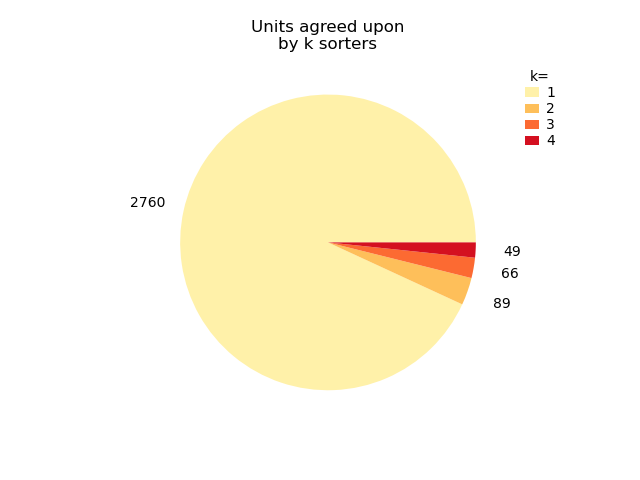

<IPython.core.display.Javascript object>


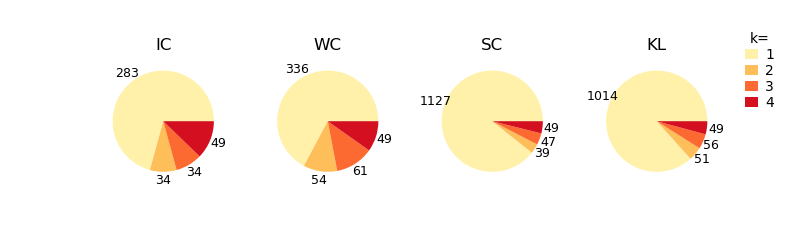

In [42]:
# visualize comaprisons
w = sw.plot_multicomp_agreement(mcmp)
w = sw.plot_multicomp_agreement_by_sorter(mcmp)

In [43]:
# set agreement sorter. min agreement count is the number of sorters that had to agree to count the unit
agreement_sorting = mcmp.get_agreement_sorting(minimum_agreement_count=4)

In [44]:
# get the TDC ids of the common units
ids = agreement_sorting.get_unit_ids()

In [45]:
print(ids)

[7, 20, 32, 37, 39, 58, 67, 68, 72, 73, 85, 110, 111, 120, 123, 128, 130, 134, 135, 137, 138, 147, 176, 177, 179, 202, 208, 213, 231, 232, 247, 248, 251, 255, 274, 275, 288, 298, 306, 307, 311, 318, 325, 329, 344, 351, 365, 373, 374]


In [46]:
# crucial: cache main sorter and specify location of tmp directory. The tmp directory needs to exist
sorting_IC_cache = se.CacheSortingExtractor(sorting_IC, pth+sess+'processed/ic_sort_results_cache.dat')
sorting_IC_cache.dump_to_pickle(pth+sess+'processed/ic_sorting_cache.pkl')
sorting_IC_cache.set_tmp_folder(pth+sess+'processed/tmp/')

After running the agreement sorting, we need to build all of the unit features. This includes, getting the snippets (the raw waveform around the occurance of a detected spike), the amplitude (of the waveform) and the unit templates. This takes a while and is very inefficent in space usage. Be careful to point the tmp directory to a place that has lots of space. For large data sets this can become so big that it crashes your computer! The parameters are designed to reduce as much as possible the overhead.

In [47]:
# Export the data to phy for manual curation. Here our job is to examine each cluster found by the sorter and decide
# if its good, multiunit(mua: a "unit" that is not cleanly seperable), or noise (junk). See the PHY docs for a good 
# overview of the tool and the sorting process (https://phy.readthedocs.io/en/latest/). After you do all of the 
# cluster assignments, make sure to save the phy work from the menu (otherwise it wont mark your work!)
st.postprocessing.export_to_phy(recording_cache, sorting_IC_cache, 
                                output_folder=pth+sess+'processed/phy_IC', 
                                ms_before=0.5, 
                                ms_after=1, 
                                compute_pc_features=True, 
                                compute_amplitudes=True, 
                                max_spikes_per_unit=None, 
                                compute_property_from_recording=False, 
                                n_jobs=1, 
                                recompute_info=False, 
                                save_property_or_features=False, 
                                verbose=True)

Converting to Phy format
Number of chunks: 128 - Number of jobs: 1


Extracting waveforms in chunks: 100%|#####| 128/128 [30:35:08<00:00, 860.22s/it]


Fitting PCA of 3 dimensions on 1669393 waveforms
Projecting waveforms on PC
Saving files
Saved phy format to:  /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/phy_IC
Run:

phy template-gui  /media/paul/storage/Data/Tony/TY20210211_inHammock_night/processed/phy_IC/params.py


Here we use the common sorting ids to mark the common units as "good" in the phy export. When you view the phy output these units will be marked green.

In [48]:
# Set thresholds for metrics
snr_thresh = 5
isi_viol_thresh = 0.5
duration = recording_cache.get_num_frames()

# threshold clusters that have ISI violations > than threshold 
sorting_auto = st.curation.threshold_isi_violations(sorting_IC_cache, isi_viol_thresh, 'greater', duration)
# see how many clusters left and ids of clusters that pass threshold
print('#: ', len(sorting_auto.get_unit_ids()))
print('IDs: ', sorting_auto.get_unit_ids())

#:  290
IDs:  [0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 13, 15, 16, 19, 21, 22, 24, 25, 28, 29, 30, 32, 33, 34, 36, 37, 38, 39, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 56, 57, 58, 60, 61, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 84, 86, 89, 92, 93, 96, 97, 98, 99, 100, 102, 103, 104, 106, 108, 109, 110, 111, 112, 113, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 142, 144, 145, 147, 148, 149, 150, 152, 154, 155, 157, 162, 163, 164, 165, 166, 167, 168, 169, 171, 172, 173, 174, 175, 176, 177, 179, 180, 181, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 194, 195, 196, 198, 199, 200, 201, 202, 203, 205, 206, 207, 208, 209, 211, 212, 213, 214, 215, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 228, 229, 230, 231, 232, 233, 237, 238, 239, 241, 242, 246, 247, 248, 249, 250, 251, 252, 254, 255, 256, 257, 258, 259, 260, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 

In [49]:
# threshold clusters that have SNR < threshold
sorting_auto = st.curation.threshold_snrs(sorting_auto, recording_cache, snr_thresh, 'less')
# see how many clusters left and IDs
print('#: ', len(sorting_auto.get_unit_ids()))
print('IDs: ', sorting_auto.get_unit_ids())

#:  222
IDs:  [3, 4, 5, 7, 8, 9, 10, 11, 13, 15, 19, 21, 22, 24, 25, 28, 29, 30, 32, 34, 36, 37, 38, 39, 43, 44, 45, 46, 47, 48, 49, 51, 56, 57, 58, 60, 61, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 84, 86, 89, 92, 93, 96, 98, 99, 100, 102, 103, 104, 106, 108, 110, 111, 112, 113, 116, 117, 118, 119, 120, 122, 123, 125, 128, 129, 130, 131, 134, 135, 136, 137, 138, 144, 145, 147, 148, 154, 155, 162, 163, 164, 167, 168, 172, 173, 175, 176, 177, 179, 180, 181, 184, 185, 186, 188, 189, 191, 192, 194, 195, 198, 199, 200, 201, 202, 203, 205, 206, 207, 208, 209, 211, 212, 213, 214, 218, 219, 220, 222, 223, 228, 230, 231, 232, 233, 237, 238, 247, 248, 250, 251, 252, 255, 256, 257, 258, 259, 260, 263, 264, 265, 266, 268, 269, 270, 271, 273, 274, 275, 276, 277, 280, 282, 283, 284, 285, 286, 287, 288, 295, 296, 297, 298, 299, 304, 306, 307, 311, 312, 318, 321, 322, 324, 325, 328, 329, 330, 336, 339, 342, 343, 344, 345, 347, 349, 350, 351, 352, 354, 355, 357, 359, 360, 362, 365, 366, 368, 370

In [50]:
# mark as good common units in TDC_sorting
cfile = pth+sess+'processed/phy_IC/cluster_group.tsv'
cg = pd.read_csv(cfile, delimiter='\t')
cg.iloc[sorting_auto.get_unit_ids(), 1] = 'mua'
cg.iloc[ids, 1] = 'good'
cg.to_csv(cfile, index=False, sep='\t') # check to see if the correct units were marked

## Saving the output/working with the data
After completing the manual curation we can access the spike info directly from phy using python (phy output is in .npy) or matlab (using the numpy toolbox). Or you can reimport the data form phy and save as nwb or access directy (the spikeinterface format is really neo under the hood). The NWB part is still a work in progress and may be problematic. You can only save the sort if you want. The method attempted here is to save the processed data. then append the sorted data to the NWB file created for the processed data.

In [ ]:
# import phy curation
sorting_TDC_phy = se.PhySortingExtractor('/media/paul/storage/Data//phy_TDC/')

In [ ]:
# export to NWB. Allegedly this exports the data to NWB format. It doesn't like it if there is already a file that 
# has the name of your output file. (so delete it if it already exists)
outputfile = pth+sess+'SPLTest01.nwb'
se.NwbRecordingExtractor.write_recording(recording_cache, outputfile)

In [ ]:
# Append the sorting data to the NWB file by using setting the overwrite argument to False
se.NwbSortingExtractor.write_sorting(sorting_TDC_phy, outputfile, overwrite=False)